# 1. Introducción

Proyecto de Machine Learning en el que se busca entrenar un modelo capaz de predecir de la mejor forma posible la victoria del equipo azul en una partida de LoL (League of Legends). 

Para hacer esto, se van a utilizar dos conjuntos de datos extraidos de Kaggle, uno perteneciente a partidas hasta el minuto 10 y otro hasta el minuto 15 (las partidas duran entre 25-40 min).

Los resultados de ambas predicciones se van a comparar entre sí, para ver que modelo obtiene mejores resultados.

Los datos se han obtenido de:  
https://www.kaggle.com/datasets/gyejr95/league-of-legends-challenger-rank-game10min15min

# 2. Variables del CSV

Ambos Dataset están formados inicialmente por 51 columnas (se añaden varias con la limpieza de las columnas categóricas), de las cuales 1 hace referencia al ID de la partida, para poder utilizarlo en la API de Riot Game (en caso de que se quisiera), y el resto (50) son los datos de la partida para cada equipo, teniendo 25 columnas duplicadas, unas para el equipo azul y las otras para el equipo rojo. Entre estas 25 están las que determinan la victoria para cada equipo, siendo el target duplicado.


La columna que no es de ningun equipo:
* **gameId**: ID de la partida. Se puede utilizar con la API de Riot Games  

Las columnas para el equipo azul son:
* **blueWins**: Columna Target. 1 si gana el equipo azul, 0 si gana el rojo 
* **blueTotalGolds**: Oro total conseguido por el equipo azul  
* **blueCurrentGolds**: Oro conseguido por el equipo azul en ese minuto de la partida 
* **blueTotalLevel**: Suma del nivel de todos los campeones del equipo azul en ese minuto de la partida 
* **blueAvgLevel**: Nivel medio de los campeones del equipo azul  
* **blueTotalMinionKills**: Total de súbditos (minions) eliminados por el equipo azul  
* **blueTotalJungleMinionKills**: Total de monstruos de la jungla eliminados por el equipo azul  
* **blueFirstBlood**: Primera muerte de la partida. 1 si el equipo azul realizó la primera muerte, 0 en caso contrario.  
* **blueKill**: Número de enemigos abatidos por el equipo azul  
* **blueDeath**: Número de veces que han muerto los jugadores del equipo azul  
* **blueAssist**: Número de "asistencias" en los enemigos abatidos por el equipo azul  
* **blueWardPlaced**: Número de tótems de protección (visión) colocados por el equipo azul en el mapa  
* **blueWardKills**: Número de tótems de protección (visión) colocados por el equipo rojo que el equipo azul ha destruido  
* **blueFirstTower**: Primera torre destruida de la partida. 1 si el equipo azul la destruyó, 0 en caso contrario.   
* **blueFirstInhibitor**: Primer Inhibidor destruido de la partida. 1 si el equipo azul la destruyó, 0 en caso contrario.  
* **blueFirstTowerLane**: Línea a la que pertenece la primera torre destruida de la partida. Columna categórica que hay que transformar.   
* **blueTowerKills**: Número de torres destruidas por el equipo azul.
* **blueMidTowerKills**: Número de torres de la "mid lane" (calle central) destruidas por el equipo azul.
* **blueTopTowerKills**: Número de torres de la "top lane" (calle superior) destruidas por el equipo azul.
* **blueBotTowerKills**: Número de torres de la "bot lane" (calle inferior) destruidas por el equipo azul.
* **blueInhibitor**: Número de inhibidores destruidos por el equipo azul.
* **blueFirstDragon**: Primer dragón eliminado de la partida. 1 si el equipo azul lo eliminó, 0 en caso contrario.   
* **blueDragnoType**: Tipo de dragón o dragones eliminados de la partida por el equipo azul. Columna categórica que hay que transformar.  
* **blueDragon**: Número de dragones abatidos por el equipo azul
* **blueRiftHeralds**: Número de heraldos abatidos por el equipo azul

Las otras 25 columnas son iguales, pero referidas al equipo rojo.

# 3. Librerias

In [1]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, MinMaxScaler
import warnings
warnings.filterwarnings('ignore')

# 4. Funciones

Se importa un archivo que contiene las funciones y las clases que se van a utilizar

In [2]:
from funciones import * #Esto lee todas las funciones del archivo funciones
from models import Models

# 5. Lectura de los datos

# 5.1. Carga de datos

In [3]:
#Se importan los datos
datos_15min = pd.read_csv('../data/raw_data/Challenger_Ranked_Games_15minute.csv')
datos_15min

,gameId,blueWins,blueTotalGolds,blueCurrentGolds,blueTotalLevel,blueAvgLevel,blueTotalMinionKills,blueTotalJungleMinionKills,blueFirstBlood,blueKill,...,redFirstTowerLane,redTowerKills,redMidTowerKills,redTopTowerKills,redBotTowerKills,redInhibitor,redFirstDragon,redDragnoType,redDragon,redRiftHeralds
0,4247263043,0,24081,1190,44,8.8,309,74,0,8,...,['MID_LANE'],2,1,0,1,0,1,"['WATER_DRAGON', 'EARTH_DRAGON']",2,1
1,4247155821,1,24162,2212,46,9.2,393,64,0,5,...,['TOP_LANE'],1,0,1,0,0,0,[],0,0
2,4243963257,0,22413,1563,41,8.2,300,62,0,5,...,['BOT_LANE'],4,2,1,1,0,1,"['FIRE_DRAGON', 'EARTH_DRAGON']",2,1
3,4241678498,0,23837,3197,46,9.2,370,96,0,6,...,['TOP_LANE'],1,0,1,0,0,0,[],0,1
4,4241538868,1,27688,3663,44,8.8,381,66,0,9,...,['BOT_LANE'],2,1,0,1,0,0,[],0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26829,4143231833,0,26110,1535,46,9.2,289,73,0,15,...,['BOT_LANE'],1,0,0,1,0,1,['WATER_DRAGON'],1,1
26830,4157911901,0,57503,3293,62,12.4,329,28,0,27,...,[],6,2,1,3,1,0,[],0,0
26831,3764171638,0,26091,2986,47,9.4,338,86,0,7,...,[],0,0,0,0,0,0,[],0,0
26832,4110201724,1,24734,4289,45,9.0,328,64,0,11,...,['BOT_LANE'],1,0,0,1,0,0,['AIR_DRAGON'],1,0


In [4]:
datos_10min = pd.read_csv('../data/raw_data/Challenger_Ranked_Games_10minute.csv')
datos_10min

,gameId,blueWins,blueTotalGolds,blueCurrentGolds,blueTotalLevel,blueAvgLevel,blueTotalMinionKills,blueTotalJungleMinionKills,blueFirstBlood,blueKill,...,redFirstTowerLane,redTowerKills,redMidTowerKills,redTopTowerKills,redBotTowerKills,redInhibitor,redFirstDragon,redDragnoType,redDragon,redRiftHeralds
0,4247263043,0,14870,2889,32,6.4,199,53,0,3,...,[],0,0,0,0,0,1,['WATER_DRAGON'],1,0
1,4247155821,1,14497,2617,33,6.6,229,44,0,2,...,[],0,0,0,0,0,0,[],0,0
2,4243963257,0,15617,1757,34,6.8,223,39,0,3,...,['BOT_LANE'],1,0,0,1,0,1,['FIRE_DRAGON'],1,1
3,4241678498,0,15684,1439,35,7.0,251,64,0,3,...,[],0,0,0,0,0,0,[],0,0
4,4241538868,1,17472,3512,35,7.0,257,46,0,7,...,[],0,0,0,0,0,0,[],0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26404,4143231833,0,16762,5072,36,7.2,206,52,0,7,...,[],0,0,0,0,0,1,['WATER_DRAGON'],1,1
26405,4157911901,0,35765,1440,39,7.8,191,16,0,18,...,[],3,1,0,2,0,0,[],0,0
26406,3764171638,0,15712,4137,34,6.8,218,55,0,3,...,[],0,0,0,0,0,0,[],0,0
26407,4110201724,1,15850,3220,33,6.6,193,48,0,6,...,[],0,0,0,0,0,0,[],0,0


# 5.2. Preparación de los datos

Hay que analizar los datos, porque los datos contienen columnas categóricas que habrá que trabajar

In [5]:
data_report(datos_15min).T

COL_N,gameId,blueWins,blueTotalGolds,blueCurrentGolds,blueTotalLevel,blueAvgLevel,blueTotalMinionKills,blueTotalJungleMinionKills,blueFirstBlood,blueKill,...,redFirstTowerLane,redTowerKills,redMidTowerKills,redTopTowerKills,redBotTowerKills,redInhibitor,redFirstDragon,redDragnoType,redDragon,redRiftHeralds
Data Type,int64,int64,int64,int64,int64,float64,int64,int64,int64,int64,...,object,int64,int64,int64,int64,int64,int64,object,int64,int64
Missings (%),0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
Unique Values,26779,2,12929,6332,76,76,440,155,1,78,...,4,12,6,5,5,4,2,48,5,3
CARDIN (%),99.80,0.01,48.18,23.60,0.28,0.28,1.64,0.58,0.00,0.29,...,0.01,0.04,0.02,0.02,0.02,0.01,0.01,0.18,0.02,0.01
Min. Value,3482432973,0,3627,-4756,5,1.00,0,0,0,0,...,['BOT_LANE'],0,0,0,0,0,0,"['AIR_DRAGON', 'AIR_DRAGON']",0,0
Max. Value,4261025558,1,80503,16905,80,16.00,463,210,0,92,...,[],11,5,4,4,3,1,[],4,2
Mean Value,4171923569.95,0.50,28498.26,3478.69,47.73,9.55,331.19,71.56,0.00,13.18,...,0.41,0.44,0.06,0.50,0.79,0.33,NaN,NaN,NaN,NaN


In [6]:
data_report(datos_10min).T

COL_N,gameId,blueWins,blueTotalGolds,blueCurrentGolds,blueTotalLevel,blueAvgLevel,blueTotalMinionKills,blueTotalJungleMinionKills,blueFirstBlood,blueKill,...,redFirstTowerLane,redTowerKills,redMidTowerKills,redTopTowerKills,redBotTowerKills,redInhibitor,redFirstDragon,redDragnoType,redDragon,redRiftHeralds
Data Type,int64,int64,int64,int64,int64,float64,int64,int64,int64,int64,...,object,int64,int64,int64,int64,int64,int64,object,int64,int64
Missings (%),0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
Unique Values,26354,2,8789,5649,48,48,238,107,1,56,...,4,9,6,4,5,2,2,19,4,2
CARDIN (%),99.79,0.01,33.28,21.39,0.18,0.18,0.90,0.41,0.00,0.21,...,0.02,0.03,0.02,0.02,0.02,0.01,0.01,0.07,0.02,0.01
Min. Value,3482432973,0,7792,38,8,1.60,1,0,0,0,...,['BOT_LANE'],0,0,0,0,0,0,"['AIR_DRAGON', 'EARTH_DRAGON']",0,0
Max. Value,4261025558,1,53161,16248,62,12.40,296,144,0,61,...,[],8,5,3,4,1,1,[],3,1
Mean Value,4171693429.65,0.50,18189.55,3134.71,36.26,7.25,213.85,46.31,0.00,7.66,...,0.04,0.04,0.01,0.37,0.37,0.14,NaN,NaN,NaN,NaN


Ambos conjuntos tienen columnas categóricas (FirstTowerLane y DragnoType). Estas columnas tienen dato vacío, en caso de que no se haya conseguido eliminar ni un dragón ni una torre.

Esto hay que tenerlo en cuenta a la hora de crear una codificación.

In [7]:
datos_10min.blueDragnoType.unique() #Para el equipo rojo es lo mismo

array(['[]', "['WATER_DRAGON']", "['FIRE_DRAGON']", "['EARTH_DRAGON']",
       "['AIR_DRAGON']", "['WATER_DRAGON', 'FIRE_DRAGON']",
       "['AIR_DRAGON', 'WATER_DRAGON']", "['WATER_DRAGON', 'AIR_DRAGON']",
       "['EARTH_DRAGON', 'AIR_DRAGON']",
       "['FIRE_DRAGON', 'WATER_DRAGON']",
       "['EARTH_DRAGON', 'FIRE_DRAGON']",
       "['AIR_DRAGON', 'EARTH_DRAGON']", "['ELDER_DRAGON']",
       "['AIR_DRAGON', 'FIRE_DRAGON']", "['FIRE_DRAGON', 'AIR_DRAGON']",
       "['FIRE_DRAGON', 'EARTH_DRAGON']",
       "['WATER_DRAGON', 'EARTH_DRAGON']",
       "['EARTH_DRAGON', 'WATER_DRAGON']"], dtype=object)

In [8]:
datos_10min.blueFirstTowerLane.unique() #Para el equipo rojo es lo mismo

array(['[]', "['BOT_LANE']", "['TOP_LANE']", "['MID_LANE']"], dtype=object)

En base al tipo de datos que aparecen, se pueden crear columnas nuevas con un One Hot Encoding con la función `get_dummies` o hacerlo manualmente para el tipo de dragon

Se utiliza una función definida en el apartado 4.

In [9]:
datos_10min = categorical_columns_proyect_LoL(datos_10min)
datos_15min = categorical_columns_proyect_LoL(datos_15min)

In [10]:
data_report(datos_15min).T

COL_N,gameId,blueWins,blueTotalGolds,blueCurrentGolds,blueTotalLevel,blueAvgLevel,blueTotalMinionKills,blueTotalJungleMinionKills,blueFirstBlood,blueKill,...,redFirstTowerLane_Mid_lane,redFirstTowerLane_Top_lane,blueDragonType_Air,blueDragonType_Water,blueDragonType_Fire,blueDragonType_Earth,redDragonType_Air,redDragonType_Water,redDragonType_Fire,redDragonType_Earth
Data Type,int64,int64,int64,int64,int64,float64,int64,int64,int64,int64,...,uint8,uint8,int32,int32,int32,int32,int32,int32,int32,int32
Missings (%),0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
Unique Values,26779,2,12929,6332,76,76,440,155,1,78,...,2,2,2,2,2,2,2,2,2,2
CARDIN (%),99.80,0.01,48.18,23.60,0.28,0.28,1.64,0.58,0.00,0.29,...,0.01,0.01,0.01,0.01,0.01,0.01,0.01,0.01,0.01,0.01
Min. Value,3482432973.00,0.00,3627.00,-4756.00,5.00,1.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
Max. Value,4261025558.00,1.00,80503.00,16905.00,80.00,16.00,463.00,210.00,0.00,92.00,...,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00
Mean Value,4171923569.95,0.50,28498.26,3478.69,47.73,9.55,331.19,71.56,0.00,13.18,...,0.12,0.18,0.16,0.16,0.17,0.16,0.20,0.20,0.19,0.20


In [11]:
data_report(datos_10min).T

COL_N,gameId,blueWins,blueTotalGolds,blueCurrentGolds,blueTotalLevel,blueAvgLevel,blueTotalMinionKills,blueTotalJungleMinionKills,blueFirstBlood,blueKill,...,redFirstTowerLane_Mid_lane,redFirstTowerLane_Top_lane,blueDragonType_Air,blueDragonType_Water,blueDragonType_Fire,blueDragonType_Earth,redDragonType_Air,redDragonType_Water,redDragonType_Fire,redDragonType_Earth
Data Type,int64,int64,int64,int64,int64,float64,int64,int64,int64,int64,...,uint8,uint8,int32,int32,int32,int32,int32,int32,int32,int32
Missings (%),0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
Unique Values,26354,2,8789,5649,48,48,238,107,1,56,...,2,2,2,2,2,2,2,2,2,2
CARDIN (%),99.79,0.01,33.28,21.39,0.18,0.18,0.90,0.41,0.00,0.21,...,0.01,0.01,0.01,0.01,0.01,0.01,0.01,0.01,0.01,0.01
Min. Value,3482432973.00,0.00,7792.00,38.00,8.00,1.60,1.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
Max. Value,4261025558.00,1.00,53161.00,16248.00,62.00,12.40,296.00,144.00,0.00,61.00,...,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00
Mean Value,4171693429.65,0.50,18189.55,3134.71,36.26,7.25,213.85,46.31,0.00,7.66,...,0.04,0.03,0.07,0.08,0.09,0.07,0.09,0.10,0.10,0.09


Como la columna tardet se encuentra duplicada (aparece la victoria para el equipo azul y la del equipo rojo) hay que eliminar la del equipo rojo antes de comenzar la división para no tener problemas a la hora de predecir.

In [12]:
datos_10min = datos_10min.copy().drop(['redWins'], axis=1)
datos_15min = datos_15min.copy().drop(['redWins'], axis=1)

In [13]:
len(datos_10min.columns)

60

In [14]:
def plot_distributions(df):
    """
    Represent the data distribution and check distribution-skewness for each feature
    """
    # Librerías
    import matplotlib.pyplot as plt
    import seaborn as sns

    nrows = len(df.columns)

    fig, ax = plt.subplots(nrows, 2, figsize=(10, 30))
    for feature in df:
        idx = df.columns.get_loc(feature)
        
        # distribution
        sns.distplot(df[feature], bins=20, 
                     label='skewness: %.2f'%(df[feature].skew()),
                     ax = ax[idx,0])
        
        # boxplot
        sns.boxplot(df[feature], ax=ax[idx,1])    
    plt.tight_layout()
    plt.show()

In [15]:
df1 = datos_10min.iloc[:,:20] # Select First 15 Columns
df2 = datos_10min.iloc[:,21:40] 
df3 = datos_10min.iloc[:,41:61] 

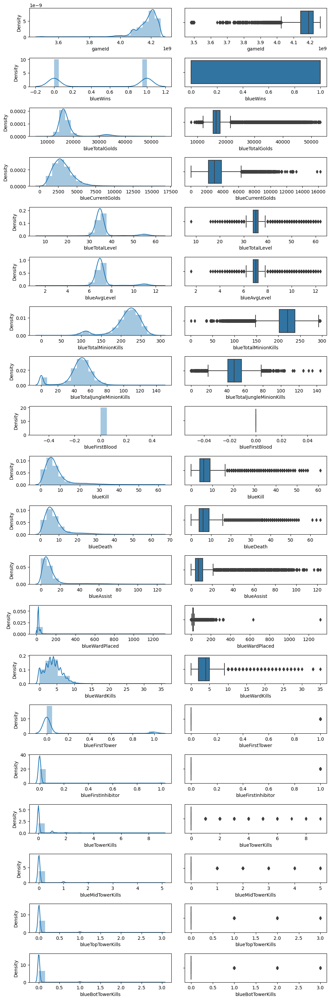

In [16]:
plot_distributions(df1)

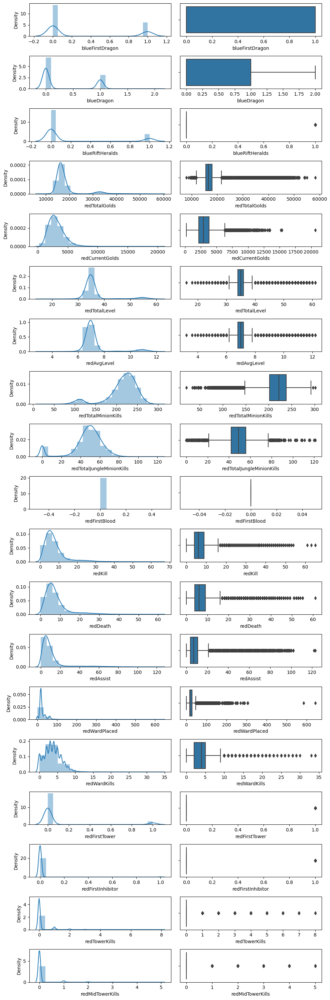

In [17]:
plot_distributions(df2)

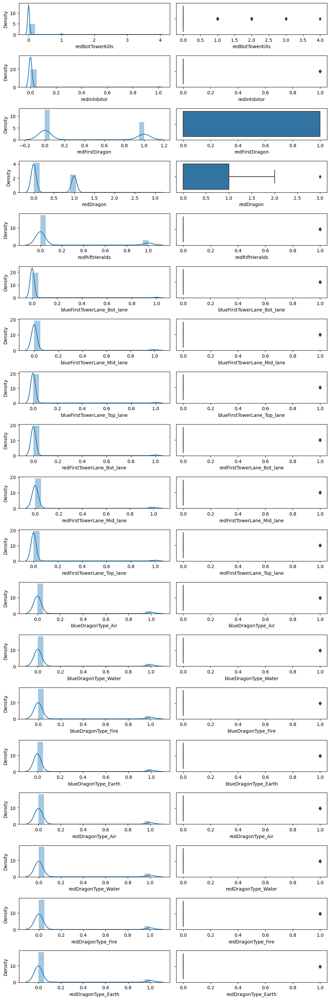

In [18]:
plot_distributions(df3)

# 5.3. Primera división de los datos
Una vez se tienen los datos preparados, se puede hacer una primera división.

Como la cantidad de datos es grande, de los datos de partida se pueden crear 2 grupos, uno de "trabajo" que se dividirá luego en train y test y otro grupo que sea para validación final.

La distribución de los datos sería 60% train, 20% test y 20% validación.

Para hacer esta separación de los datos de validación se utiliza la función `train_test_split()`

In [19]:
datos_entrenamiento_15min, datos_validacion_15min= train_test_split(datos_15min, test_size = 0.20, random_state=42)
print("-------Partidas 15 min---------")
print("-------------------------------")
print("Datos en bruto:", len(datos_15min))
print("-------------------------------")
print("Datos de entrenamiento:", len(datos_entrenamiento_15min))
print("-------------------------------")
print("Datos de validación:", len(datos_validacion_15min))
print("-------------------------------")

datos_entrenamiento_10min, datos_validacion_10min= train_test_split(datos_10min, test_size = 0.20, random_state=42)
print("\n")
print("-------Partidas 10 min---------")
print("-------------------------------")
print("Datos en bruto:", len(datos_10min))
print("-------------------------------")
print("Datos de entrenamiento:", len(datos_entrenamiento_10min))
print("-------------------------------")
print("Datos de validación:", len(datos_validacion_10min))
print("-------------------------------")

-------Partidas 15 min---------
-------------------------------
Datos en bruto: 26834
-------------------------------
Datos de entrenamiento: 21467
-------------------------------
Datos de validación: 5367
-------------------------------


-------Partidas 10 min---------
-------------------------------
Datos en bruto: 26409
-------------------------------
Datos de entrenamiento: 21127
-------------------------------
Datos de validación: 5282
-------------------------------


Este mapa de correlación muestra aquellas columnas que tienen correlación de un valor de 0.3 o superior (en valor absoluto)

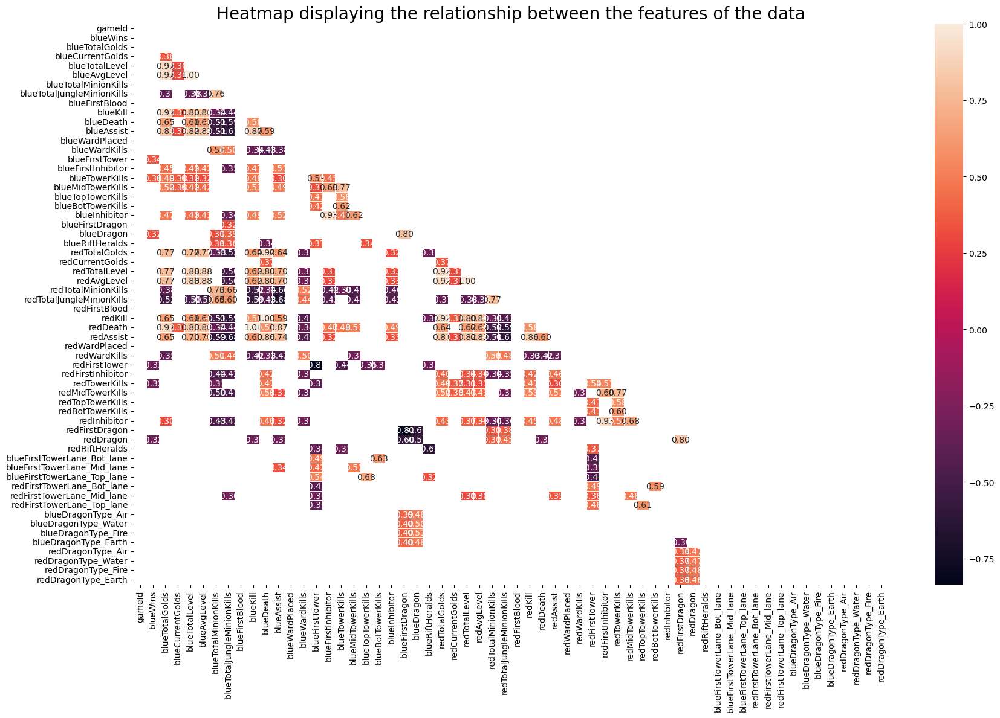

In [20]:
correlation_heatmap(datos_entrenamiento_15min)

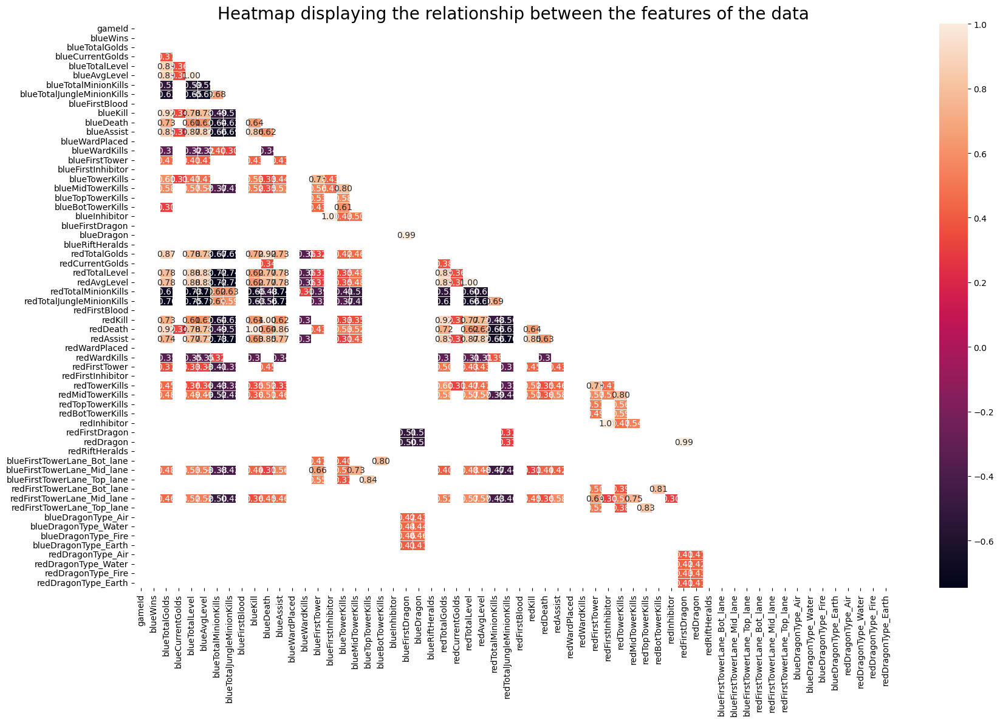

In [21]:
correlation_heatmap(datos_entrenamiento_10min)

Se comprueba si la variable target está bien balanceada

In [22]:
datos_entrenamiento_15min.blueWins.value_counts(normalize = True) #Está balanceada

0   0.50
1   0.50
Name: blueWins, dtype: float64

In [23]:
datos_entrenamiento_10min.blueWins.value_counts(normalize = True) #Está balanceada

1   0.50
0   0.50
Name: blueWins, dtype: float64

# 6. Modelo 1
El primer modelo es utilizar los datos directamente, sin realizar ninguna transformación ni eliminando ninguna columna.

Para realizar un primer análisis se utiliza la librería LazyClassifier

In [24]:
#Se hace una copia de los datos iniciales para aplicar este modelo
modelo1_15min=datos_entrenamiento_15min.copy()

#Se crean la X y la y
X_m1_15min = modelo1_15min.copy().drop(['blueWins'], axis=1)
y_m1_15min = modelo1_15min[['blueWins']]

#Se realiza la división 
X_train_m1_15min, X_test_m1_15min, y_train_m1_15min, y_test_m1_15min = train_test_split(X_m1_15min, y_m1_15min, test_size=0.2, random_state=42)

In [25]:
#Se hace una copia de los datos iniciales para aplicar este modelo
modelo1_10min=datos_entrenamiento_10min.copy()

#Se crean la X y la y
X_m1_10min = modelo1_10min.copy().drop(['blueWins'], axis=1)
y_m1_10min = modelo1_10min[['blueWins']]

#Se realiza la división 
X_train_m1_10min, X_test_m1_10min, y_train_m1_10min, y_test_m1_10min = train_test_split(X_m1_10min, y_m1_10min, test_size=0.2, random_state=42)

In [26]:
#Se preparan los datos de validación
validacion_m1_15min=datos_validacion_15min.copy()

#Se crean la X y la y
X_val_m1_15min = validacion_m1_15min.copy().drop(['blueWins'], axis=1)
y_val_m1_15min = validacion_m1_15min[['blueWins']]

In [27]:
#Se preparan los datos de validación
validacion_m1_10min=datos_validacion_10min.copy()

#Se crean la X y la y
X_val_m1_10min = validacion_m1_10min.copy().drop(['blueWins'], axis=1)
y_val_m1_10min = validacion_m1_10min[['blueWins']]

In [28]:
#Se crean los objetos
m1_15min = Models(X_train_m1_15min, X_test_m1_15min, y_train_m1_15min, y_test_m1_15min)
m1_10min = Models(X_train_m1_10min, X_test_m1_10min, y_train_m1_10min, y_test_m1_10min)

# 6.1. LazyClassifier

In [29]:
#LazyClassifier
m1_15min.lazyclassifier()

100%|██████████████████████████████████████████████████████████████████████████████████| 29/29 [02:07<00:00,  4.39s/it]


,Accuracy,Balanced Accuracy,ROC AUC,F1 Score,Time Taken
Model,,,,,
CalibratedClassifierCV,0.81,0.81,0.81,0.81,13.76
LinearSVC,0.81,0.81,0.81,0.81,3.59
LogisticRegression,0.81,0.81,0.81,0.81,0.35
RandomForestClassifier,0.81,0.81,0.81,0.81,2.91
LGBMClassifier,0.81,0.81,0.81,0.81,0.26
RidgeClassifierCV,0.81,0.81,0.81,0.81,0.12
LinearDiscriminantAnalysis,0.81,0.81,0.81,0.81,0.21
RidgeClassifier,0.81,0.81,0.81,0.81,0.08
SVC,0.81,0.81,0.81,0.81,19.63


In [30]:
#LazyClassifier
m1_10min.lazyclassifier()

100%|██████████████████████████████████████████████████████████████████████████████████| 29/29 [02:22<00:00,  4.90s/it]


,Accuracy,Balanced Accuracy,ROC AUC,F1 Score,Time Taken
Model,,,,,
RidgeClassifierCV,0.74,0.74,0.74,0.74,0.15
RidgeClassifier,0.74,0.74,0.74,0.74,0.08
LinearSVC,0.74,0.74,0.74,0.74,3.84
LinearDiscriminantAnalysis,0.74,0.74,0.74,0.74,0.18
CalibratedClassifierCV,0.74,0.74,0.74,0.74,14.18
LogisticRegression,0.74,0.74,0.74,0.74,0.30
RandomForestClassifier,0.74,0.74,0.74,0.74,2.86
AdaBoostClassifier,0.74,0.74,0.74,0.74,1.42
LGBMClassifier,0.74,0.74,0.74,0.74,0.24


# 6.2. Random Forest

In [31]:
#Se crea el DF que guarda los resultados de los modelos
dfAccuracy = Models.matriz_recopilar()

### Partidas 15 min

Hora de inicio:  21:41:43
Hora de fin:  21:41:49
-------------------------
Accuracy train 1.0
Accuracy test 0.807638565440149
-------------------------
-------------------------
Matriz de confusión


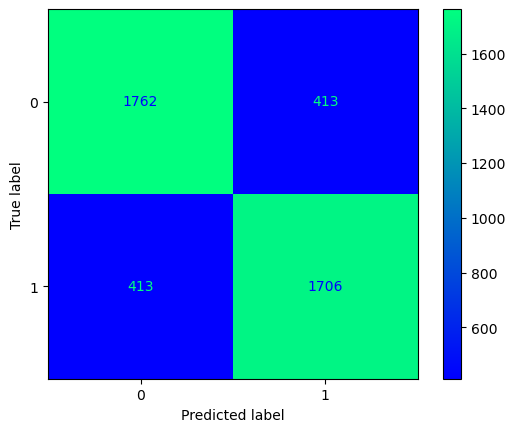

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.81      0.81      0.81      2175
           1       0.81      0.81      0.81      2119

    accuracy                           0.81      4294
   macro avg       0.81      0.81      0.81      4294
weighted avg       0.81      0.81      0.81      4294

-------------------------


In [32]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m1_15min.randomforest()

In [33]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m1_15min,y_val_m1_15min)

Accuracy validación 0.8082727780883175


In [34]:
guardar_modelo(modelo_entrenado_15min,"m1_randomforest_15min")

### Partidas 10 min

Hora de inicio:  21:41:50
Hora de fin:  21:41:55
-------------------------
Accuracy train 1.0
Accuracy test 0.7411263606247042
-------------------------
-------------------------
Matriz de confusión


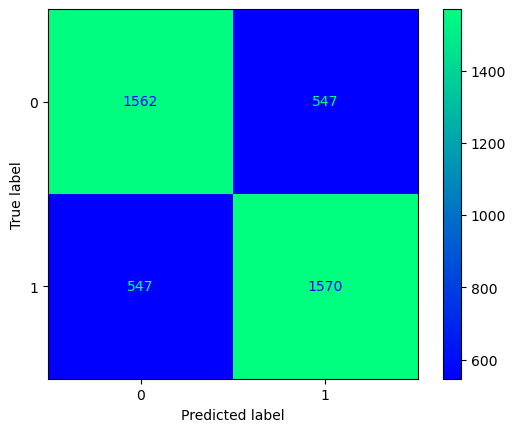

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.74      0.74      0.74      2109
           1       0.74      0.74      0.74      2117

    accuracy                           0.74      4226
   macro avg       0.74      0.74      0.74      4226
weighted avg       0.74      0.74      0.74      4226

-------------------------


In [35]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m1_10min.randomforest()

In [36]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m1_10min,y_val_m1_10min)

Accuracy validación 0.7340022718667172


In [37]:
guardar_modelo(modelo_entrenado_15min,"m1_randomforest_10min")

### Recopilación resultados

In [38]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "M1_randomforest", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73


# 6.3. Random Forest Optimizado

### Partidas 15 min

Hora de inicio:  21:41:57
Hora de fin:  22:17:04
-------------------------
Accuracy train 0.8156990624818028
Accuracy test 0.8088029809035864
-------------------------
-------------------------
Matriz de confusión


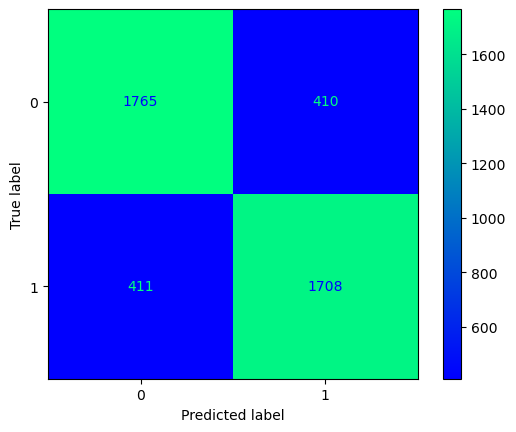

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.81      0.81      0.81      2175
           1       0.81      0.81      0.81      2119

    accuracy                           0.81      4294
   macro avg       0.81      0.81      0.81      4294
weighted avg       0.81      0.81      0.81      4294

-------------------------


In [39]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m1_15min.randomforest_GridS()

In [40]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m1_15min,y_val_m1_15min)

Accuracy validación 0.8052915967952301


In [41]:
guardar_modelo(modelo_entrenado_15min,"m1_randomforest_GridS_15min")

### Partidas 10 min

Hora de inicio:  22:17:04
Hora de fin:  22:48:07
-------------------------
Accuracy train 0.7647476480681616
Accuracy test 0.7394699479413157
-------------------------
-------------------------
Matriz de confusión


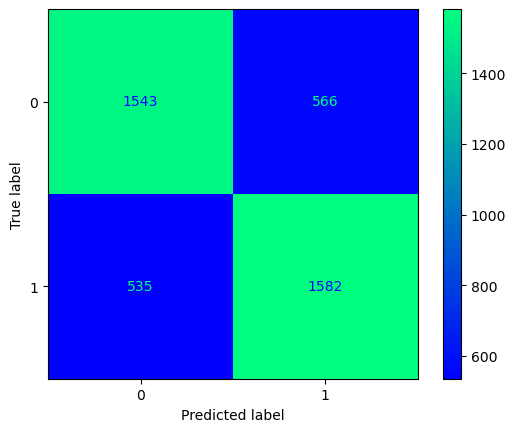

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.74      0.73      0.74      2109
           1       0.74      0.75      0.74      2117

    accuracy                           0.74      4226
   macro avg       0.74      0.74      0.74      4226
weighted avg       0.74      0.74      0.74      4226

-------------------------


In [42]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m1_10min.randomforest_GridS()

In [43]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m1_10min,y_val_m1_10min)

Accuracy validación 0.7311624384702764


In [44]:
guardar_modelo(modelo_entrenado_15min,"m1_randomforest_GridS_10min")

### Recopilación resultados

In [45]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "M1_randomforest_GridS", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73


# 6.4. Gradient boosting 

### Partidas 15 min

Hora de inicio:  22:48:07
Hora de fin:  22:48:21
-------------------------
Accuracy train 0.8276946369300646
Accuracy test 0.807638565440149
-------------------------
-------------------------
Matriz de confusión


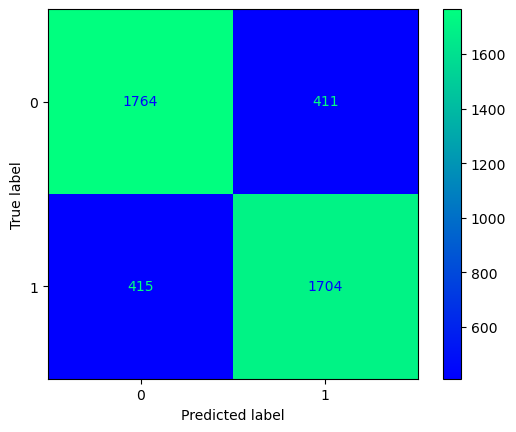

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.81      0.81      0.81      2175
           1       0.81      0.80      0.80      2119

    accuracy                           0.81      4294
   macro avg       0.81      0.81      0.81      4294
weighted avg       0.81      0.81      0.81      4294

-------------------------


In [46]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m1_15min.gradientboosting()

In [47]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m1_15min,y_val_m1_15min)

Accuracy validación 0.8067821874417738


In [48]:
guardar_modelo(modelo_entrenado_15min,"m1_gradientboosting_15min")

### Partidas 10 min

Hora de inicio:  22:48:21
Hora de fin:  22:48:32
-------------------------
Accuracy train 0.7701911129518964
Accuracy test 0.7375769048745859
-------------------------
-------------------------
Matriz de confusión


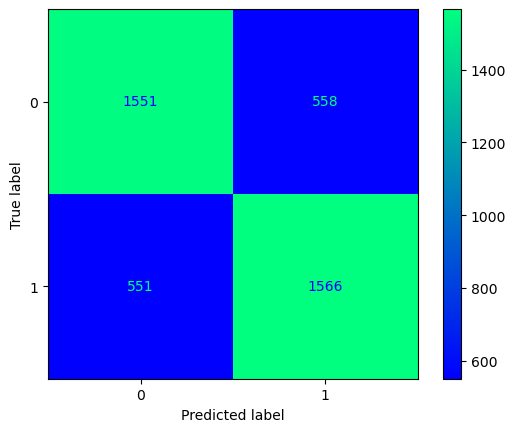

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.74      0.74      0.74      2109
           1       0.74      0.74      0.74      2117

    accuracy                           0.74      4226
   macro avg       0.74      0.74      0.74      4226
weighted avg       0.74      0.74      0.74      4226

-------------------------


In [49]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m1_10min.gradientboosting()

In [50]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m1_10min,y_val_m1_10min)

Accuracy validación 0.7341915940931465


In [51]:
guardar_modelo(modelo_entrenado_15min,"m1_gradientboosting_10min")

### Recopilación resultados

In [52]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "M1_gradientboosting", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73


# 6.5. Gradient boosting Optimizado

### Partidas 15 min

Hora de inicio:  22:48:33
Hora de fin:  23:09:36
-------------------------
Accuracy train 0.8370698189017644
Accuracy test 0.8095016301816488
-------------------------
-------------------------
Matriz de confusión


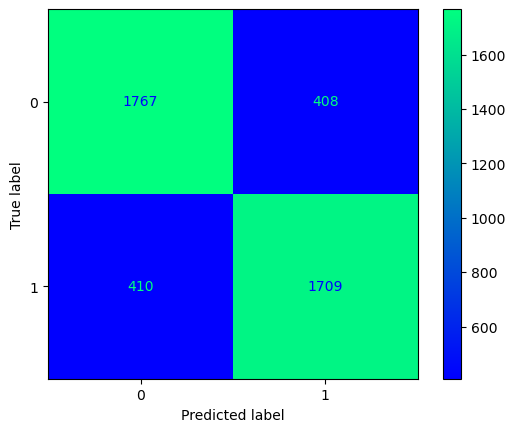

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.81      0.81      0.81      2175
           1       0.81      0.81      0.81      2119

    accuracy                           0.81      4294
   macro avg       0.81      0.81      0.81      4294
weighted avg       0.81      0.81      0.81      4294

-------------------------


In [53]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m1_15min.gradientboosting_GridS()

In [54]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m1_15min,y_val_m1_15min)

Accuracy validación 0.8071548351034097


In [55]:
guardar_modelo(modelo_entrenado_15min,"m1_gradientboosting_GridS_15min")

### Partidas 10 min

Hora de inicio:  23:09:36
Hora de fin:  23:27:57
-------------------------
Accuracy train 0.7651026566475356
Accuracy test 0.7382867960246096
-------------------------
-------------------------
Matriz de confusión


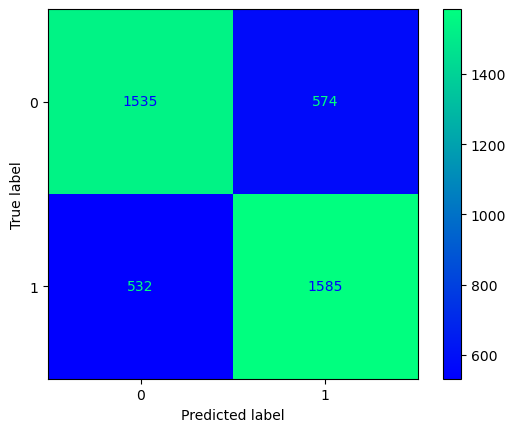

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.74      0.73      0.74      2109
           1       0.73      0.75      0.74      2117

    accuracy                           0.74      4226
   macro avg       0.74      0.74      0.74      4226
weighted avg       0.74      0.74      0.74      4226

-------------------------


In [56]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m1_10min.gradientboosting_GridS()

In [57]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m1_10min,y_val_m1_10min)

Accuracy validación 0.7305944717909882


In [58]:
guardar_modelo(modelo_entrenado_15min,"m1_gradientboosting_GridS_10min")

### Recopilación resultados

In [59]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "M1_gradientboosting_GridS", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73


# 6.6. Catboost

### Partidas 15 min

Hora de inicio:  23:27:58
Learning rate set to 0.151764
0:	learn: 0.6179776	total: 142ms	remaining: 28.2s
1:	learn: 0.5696056	total: 149ms	remaining: 14.7s
2:	learn: 0.5311687	total: 155ms	remaining: 10.2s
3:	learn: 0.5050932	total: 162ms	remaining: 7.93s
4:	learn: 0.4886776	total: 169ms	remaining: 6.59s
5:	learn: 0.4741001	total: 176ms	remaining: 5.68s
6:	learn: 0.4628672	total: 183ms	remaining: 5.05s
7:	learn: 0.4552205	total: 191ms	remaining: 4.59s
8:	learn: 0.4479512	total: 198ms	remaining: 4.2s
9:	learn: 0.4418865	total: 204ms	remaining: 3.88s
10:	learn: 0.4364878	total: 211ms	remaining: 3.63s
11:	learn: 0.4327483	total: 217ms	remaining: 3.4s
12:	learn: 0.4297974	total: 223ms	remaining: 3.21s
13:	learn: 0.4269826	total: 230ms	remaining: 3.05s
14:	learn: 0.4241425	total: 236ms	remaining: 2.91s
15:	learn: 0.4216922	total: 242ms	remaining: 2.79s
16:	learn: 0.4204644	total: 248ms	remaining: 2.67s
17:	learn: 0.4182281	total: 255ms	remaining: 2.57s
18:	learn: 0.4162996	total: 261ms	rema

160:	learn: 0.3370395	total: 1.17s	remaining: 283ms
161:	learn: 0.3366162	total: 1.18s	remaining: 276ms
162:	learn: 0.3360990	total: 1.18s	remaining: 268ms
163:	learn: 0.3352888	total: 1.19s	remaining: 261ms
164:	learn: 0.3351088	total: 1.2s	remaining: 254ms
165:	learn: 0.3343737	total: 1.2s	remaining: 246ms
166:	learn: 0.3338919	total: 1.21s	remaining: 239ms
167:	learn: 0.3331189	total: 1.21s	remaining: 231ms
168:	learn: 0.3325706	total: 1.22s	remaining: 224ms
169:	learn: 0.3321569	total: 1.23s	remaining: 217ms
170:	learn: 0.3317447	total: 1.23s	remaining: 209ms
171:	learn: 0.3310902	total: 1.24s	remaining: 202ms
172:	learn: 0.3305892	total: 1.25s	remaining: 195ms
173:	learn: 0.3300049	total: 1.25s	remaining: 187ms
174:	learn: 0.3294684	total: 1.26s	remaining: 180ms
175:	learn: 0.3289763	total: 1.27s	remaining: 173ms
176:	learn: 0.3283672	total: 1.27s	remaining: 166ms
177:	learn: 0.3281852	total: 1.28s	remaining: 158ms
178:	learn: 0.3279698	total: 1.28s	remaining: 151ms
179:	learn: 0.

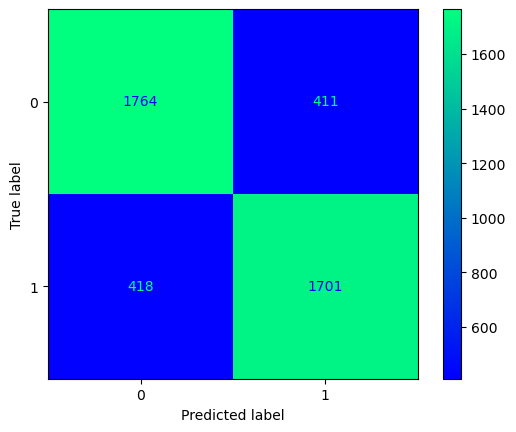

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.81      0.81      0.81      2175
           1       0.81      0.80      0.80      2119

    accuracy                           0.81      4294
   macro avg       0.81      0.81      0.81      4294
weighted avg       0.81      0.81      0.81      4294

-------------------------


In [60]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m1_15min.catboost()

In [61]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m1_15min,y_val_m1_15min)

Accuracy validación 0.8026830631637787


In [62]:
guardar_modelo(modelo_entrenado_15min,"m1_catboost_15min")

### Partidas 10 min

Hora de inicio:  23:27:59
Learning rate set to 0.150733
0:	learn: 0.6509642	total: 6.86ms	remaining: 1.37s
1:	learn: 0.6171984	total: 12.9ms	remaining: 1.27s
2:	learn: 0.5966963	total: 19.1ms	remaining: 1.25s
3:	learn: 0.5788801	total: 25.4ms	remaining: 1.24s
4:	learn: 0.5650406	total: 32.5ms	remaining: 1.27s
5:	learn: 0.5536083	total: 38.7ms	remaining: 1.25s
6:	learn: 0.5458894	total: 44.6ms	remaining: 1.23s
7:	learn: 0.5393474	total: 50.7ms	remaining: 1.22s
8:	learn: 0.5350829	total: 56.6ms	remaining: 1.2s
9:	learn: 0.5311261	total: 62.7ms	remaining: 1.19s
10:	learn: 0.5286937	total: 68.7ms	remaining: 1.18s
11:	learn: 0.5259782	total: 74.4ms	remaining: 1.16s
12:	learn: 0.5237836	total: 80.7ms	remaining: 1.16s
13:	learn: 0.5213130	total: 86.5ms	remaining: 1.15s
14:	learn: 0.5197328	total: 92.4ms	remaining: 1.14s
15:	learn: 0.5180927	total: 98.2ms	remaining: 1.13s
16:	learn: 0.5170469	total: 104ms	remaining: 1.12s
17:	learn: 0.5154976	total: 110ms	remaining: 1.11s
18:	learn: 0.5142796	

170:	learn: 0.4369394	total: 1.03s	remaining: 175ms
171:	learn: 0.4365364	total: 1.04s	remaining: 169ms
172:	learn: 0.4362080	total: 1.05s	remaining: 163ms
173:	learn: 0.4355231	total: 1.05s	remaining: 157ms
174:	learn: 0.4349103	total: 1.06s	remaining: 151ms
175:	learn: 0.4344598	total: 1.06s	remaining: 145ms
176:	learn: 0.4339490	total: 1.07s	remaining: 139ms
177:	learn: 0.4333694	total: 1.08s	remaining: 133ms
178:	learn: 0.4331690	total: 1.08s	remaining: 127ms
179:	learn: 0.4328016	total: 1.09s	remaining: 121ms
180:	learn: 0.4325043	total: 1.09s	remaining: 115ms
181:	learn: 0.4324600	total: 1.1s	remaining: 109ms
182:	learn: 0.4319399	total: 1.1s	remaining: 103ms
183:	learn: 0.4314560	total: 1.11s	remaining: 96.6ms
184:	learn: 0.4310528	total: 1.12s	remaining: 90.6ms
185:	learn: 0.4305175	total: 1.12s	remaining: 84.5ms
186:	learn: 0.4299346	total: 1.13s	remaining: 78.5ms
187:	learn: 0.4295671	total: 1.14s	remaining: 72.5ms
188:	learn: 0.4291813	total: 1.14s	remaining: 66.4ms
189:	lea

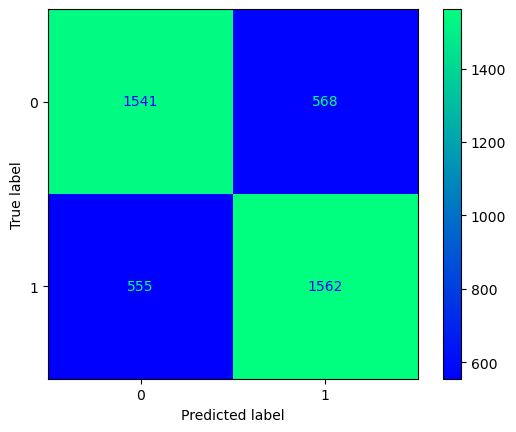

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.74      0.73      0.73      2109
           1       0.73      0.74      0.74      2117

    accuracy                           0.73      4226
   macro avg       0.73      0.73      0.73      4226
weighted avg       0.73      0.73      0.73      4226

-------------------------


In [63]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m1_10min.catboost()

In [64]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m1_10min,y_val_m1_10min)

Accuracy validación 0.7324876940552821


In [65]:
guardar_modelo(modelo_entrenado_15min,"m1_catboost_10min")

### Recopilación resultados

In [66]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "M1_catboost", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73


# 6.7. CatBoost Optimizado

### Partidas 15 min

Hora de inicio:  23:28:01
0:	learn: 0.6717839	test: 0.6706242	best: 0.6706242 (0)	total: 3.25ms	remaining: 322ms
1:	learn: 0.6523375	test: 0.6503542	best: 0.6503542 (1)	total: 6.81ms	remaining: 334ms
2:	learn: 0.6358068	test: 0.6331596	best: 0.6331596 (2)	total: 9.92ms	remaining: 321ms
3:	learn: 0.6197712	test: 0.6162970	best: 0.6162970 (3)	total: 13ms	remaining: 311ms
4:	learn: 0.6037344	test: 0.5989970	best: 0.5989970 (4)	total: 16.3ms	remaining: 310ms
5:	learn: 0.5912331	test: 0.5857635	best: 0.5857635 (5)	total: 19.7ms	remaining: 308ms
6:	learn: 0.5786575	test: 0.5722855	best: 0.5722855 (6)	total: 23.1ms	remaining: 307ms
7:	learn: 0.5691048	test: 0.5622034	best: 0.5622034 (7)	total: 26.2ms	remaining: 302ms
8:	learn: 0.5593454	test: 0.5517411	best: 0.5517411 (8)	total: 29.2ms	remaining: 295ms
9:	learn: 0.5508132	test: 0.5426626	best: 0.5426626 (9)	total: 32.2ms	remaining: 290ms
10:	learn: 0.5437542	test: 0.5354932	best: 0.5354932 (10)	total: 35.4ms	remaining: 286ms
11:	learn: 0.5369

99:	learn: 0.4218929	test: 0.4040061	best: 0.4040061 (99)	total: 317ms	remaining: 0us

bestTest = 0.4040061449
bestIteration = 99

0:	loss: 0.4040061	best: 0.4040061 (0)	total: 354ms	remaining: 47.4s
0:	learn: 0.6518916	test: 0.6496042	best: 0.6496042 (0)	total: 3.2ms	remaining: 317ms
1:	learn: 0.6183106	test: 0.6144103	best: 0.6144103 (1)	total: 6.33ms	remaining: 310ms
2:	learn: 0.5917641	test: 0.5864583	best: 0.5864583 (2)	total: 9.49ms	remaining: 307ms
3:	learn: 0.5689434	test: 0.5616230	best: 0.5616230 (3)	total: 12.7ms	remaining: 304ms
4:	learn: 0.5504148	test: 0.5428282	best: 0.5428282 (4)	total: 16.1ms	remaining: 305ms
5:	learn: 0.5359413	test: 0.5277705	best: 0.5277705 (5)	total: 19.3ms	remaining: 302ms
6:	learn: 0.5238260	test: 0.5141602	best: 0.5141602 (6)	total: 22.4ms	remaining: 298ms
7:	learn: 0.5111462	test: 0.5003580	best: 0.5003580 (7)	total: 25.9ms	remaining: 298ms
8:	learn: 0.5019588	test: 0.4900558	best: 0.4900558 (8)	total: 29.3ms	remaining: 297ms
9:	learn: 0.493679

16:	learn: 0.4428269	test: 0.4252024	best: 0.4252024 (16)	total: 55.1ms	remaining: 269ms
17:	learn: 0.4407547	test: 0.4229782	best: 0.4229782 (17)	total: 58.2ms	remaining: 265ms
18:	learn: 0.4384604	test: 0.4206927	best: 0.4206927 (18)	total: 61.2ms	remaining: 261ms
19:	learn: 0.4361503	test: 0.4188104	best: 0.4188104 (19)	total: 64.3ms	remaining: 257ms
20:	learn: 0.4348274	test: 0.4173450	best: 0.4173450 (20)	total: 67.2ms	remaining: 253ms
21:	learn: 0.4331248	test: 0.4152150	best: 0.4152150 (21)	total: 70.4ms	remaining: 250ms
22:	learn: 0.4322084	test: 0.4144584	best: 0.4144584 (22)	total: 73.3ms	remaining: 245ms
23:	learn: 0.4310864	test: 0.4133523	best: 0.4133523 (23)	total: 76.1ms	remaining: 241ms
24:	learn: 0.4294539	test: 0.4116788	best: 0.4116788 (24)	total: 79.1ms	remaining: 237ms
25:	learn: 0.4286444	test: 0.4108258	best: 0.4108258 (25)	total: 81.8ms	remaining: 233ms
26:	learn: 0.4273498	test: 0.4094520	best: 0.4094520 (26)	total: 84.8ms	remaining: 229ms
27:	learn: 0.4264882	

35:	learn: 0.4160062	test: 0.3975538	best: 0.3973064 (34)	total: 132ms	remaining: 235ms
36:	learn: 0.4155207	test: 0.3969728	best: 0.3969728 (36)	total: 136ms	remaining: 232ms
37:	learn: 0.4151102	test: 0.3969125	best: 0.3969125 (37)	total: 144ms	remaining: 235ms
38:	learn: 0.4143600	test: 0.3968993	best: 0.3968993 (38)	total: 154ms	remaining: 241ms
39:	learn: 0.4137036	test: 0.3963167	best: 0.3963167 (39)	total: 161ms	remaining: 242ms
40:	learn: 0.4131017	test: 0.3961525	best: 0.3961525 (40)	total: 169ms	remaining: 243ms
41:	learn: 0.4128815	test: 0.3960005	best: 0.3960005 (41)	total: 172ms	remaining: 237ms
42:	learn: 0.4126852	test: 0.3960950	best: 0.3960005 (41)	total: 175ms	remaining: 232ms
43:	learn: 0.4123247	test: 0.3972597	best: 0.3960005 (41)	total: 179ms	remaining: 228ms
44:	learn: 0.4120366	test: 0.3967429	best: 0.3960005 (41)	total: 182ms	remaining: 222ms
45:	learn: 0.4117365	test: 0.3964516	best: 0.3960005 (41)	total: 185ms	remaining: 217ms
46:	learn: 0.4114567	test: 0.396

30:	learn: 0.4078332	test: 0.3956368	best: 0.3956368 (30)	total: 127ms	remaining: 282ms
31:	learn: 0.4073119	test: 0.3972025	best: 0.3956368 (30)	total: 130ms	remaining: 277ms
32:	learn: 0.4065160	test: 0.3972883	best: 0.3956368 (30)	total: 133ms	remaining: 270ms
33:	learn: 0.4060085	test: 0.3975864	best: 0.3956368 (30)	total: 136ms	remaining: 264ms
34:	learn: 0.4051335	test: 0.3971153	best: 0.3956368 (30)	total: 139ms	remaining: 258ms
35:	learn: 0.4041953	test: 0.3972037	best: 0.3956368 (30)	total: 142ms	remaining: 252ms
36:	learn: 0.4037468	test: 0.3969994	best: 0.3956368 (30)	total: 145ms	remaining: 247ms
37:	learn: 0.4033356	test: 0.3985183	best: 0.3956368 (30)	total: 148ms	remaining: 242ms
38:	learn: 0.4026219	test: 0.3983162	best: 0.3956368 (30)	total: 156ms	remaining: 243ms
39:	learn: 0.4017942	test: 0.3980593	best: 0.3956368 (30)	total: 159ms	remaining: 238ms
40:	learn: 0.4009506	test: 0.3984225	best: 0.3956368 (30)	total: 162ms	remaining: 233ms
41:	learn: 0.4007587	test: 0.398

43:	learn: 0.4493093	test: 0.4329936	best: 0.4329936 (43)	total: 141ms	remaining: 180ms
44:	learn: 0.4484630	test: 0.4321684	best: 0.4321684 (44)	total: 144ms	remaining: 176ms
45:	learn: 0.4478129	test: 0.4313683	best: 0.4313683 (45)	total: 147ms	remaining: 173ms
46:	learn: 0.4469035	test: 0.4303420	best: 0.4303420 (46)	total: 150ms	remaining: 169ms
47:	learn: 0.4461523	test: 0.4295304	best: 0.4295304 (47)	total: 153ms	remaining: 166ms
48:	learn: 0.4454676	test: 0.4288752	best: 0.4288752 (48)	total: 156ms	remaining: 163ms
49:	learn: 0.4445874	test: 0.4280360	best: 0.4280360 (49)	total: 160ms	remaining: 160ms
50:	learn: 0.4440238	test: 0.4274377	best: 0.4274377 (50)	total: 163ms	remaining: 156ms
51:	learn: 0.4430625	test: 0.4264105	best: 0.4264105 (51)	total: 166ms	remaining: 153ms
52:	learn: 0.4422900	test: 0.4255651	best: 0.4255651 (52)	total: 169ms	remaining: 150ms
53:	learn: 0.4416326	test: 0.4250403	best: 0.4250403 (53)	total: 172ms	remaining: 147ms
54:	learn: 0.4409916	test: 0.424

39:	learn: 0.4307390	test: 0.4120443	best: 0.4120443 (39)	total: 125ms	remaining: 188ms
40:	learn: 0.4302984	test: 0.4116120	best: 0.4116120 (40)	total: 128ms	remaining: 185ms
41:	learn: 0.4291906	test: 0.4105244	best: 0.4105244 (41)	total: 132ms	remaining: 182ms
42:	learn: 0.4286653	test: 0.4098838	best: 0.4098838 (42)	total: 135ms	remaining: 179ms
43:	learn: 0.4279159	test: 0.4090407	best: 0.4090407 (43)	total: 138ms	remaining: 175ms
44:	learn: 0.4267137	test: 0.4076553	best: 0.4076553 (44)	total: 141ms	remaining: 172ms
45:	learn: 0.4259591	test: 0.4068472	best: 0.4068472 (45)	total: 144ms	remaining: 169ms
46:	learn: 0.4255693	test: 0.4064753	best: 0.4064753 (46)	total: 148ms	remaining: 166ms
47:	learn: 0.4251948	test: 0.4061000	best: 0.4061000 (47)	total: 151ms	remaining: 163ms
48:	learn: 0.4248186	test: 0.4057086	best: 0.4057086 (48)	total: 154ms	remaining: 160ms
49:	learn: 0.4243281	test: 0.4050825	best: 0.4050825 (49)	total: 157ms	remaining: 157ms
50:	learn: 0.4237651	test: 0.404

33:	learn: 0.4225181	test: 0.4032962	best: 0.4032962 (33)	total: 110ms	remaining: 214ms
34:	learn: 0.4220545	test: 0.4029116	best: 0.4029116 (34)	total: 113ms	remaining: 211ms
35:	learn: 0.4215992	test: 0.4027376	best: 0.4027376 (35)	total: 117ms	remaining: 207ms
36:	learn: 0.4210040	test: 0.4021179	best: 0.4021179 (36)	total: 119ms	remaining: 203ms
37:	learn: 0.4203929	test: 0.4014287	best: 0.4014287 (37)	total: 122ms	remaining: 199ms
38:	learn: 0.4201246	test: 0.4013545	best: 0.4013545 (38)	total: 125ms	remaining: 196ms
39:	learn: 0.4198197	test: 0.4009761	best: 0.4009761 (39)	total: 128ms	remaining: 192ms
40:	learn: 0.4193790	test: 0.4005398	best: 0.4005398 (40)	total: 131ms	remaining: 189ms
41:	learn: 0.4189050	test: 0.3999299	best: 0.3999299 (41)	total: 134ms	remaining: 185ms
42:	learn: 0.4185760	test: 0.3998927	best: 0.3998927 (42)	total: 137ms	remaining: 182ms
43:	learn: 0.4184120	test: 0.3998766	best: 0.3998766 (43)	total: 140ms	remaining: 178ms
44:	learn: 0.4179635	test: 0.399

34:	learn: 0.4164110	test: 0.3973064	best: 0.3973064 (34)	total: 108ms	remaining: 201ms
35:	learn: 0.4160062	test: 0.3975538	best: 0.3973064 (34)	total: 112ms	remaining: 198ms
36:	learn: 0.4155207	test: 0.3969728	best: 0.3969728 (36)	total: 115ms	remaining: 196ms
37:	learn: 0.4151102	test: 0.3969125	best: 0.3969125 (37)	total: 118ms	remaining: 192ms
38:	learn: 0.4143600	test: 0.3968993	best: 0.3968993 (38)	total: 121ms	remaining: 189ms
39:	learn: 0.4137036	test: 0.3963167	best: 0.3963167 (39)	total: 124ms	remaining: 186ms
40:	learn: 0.4131017	test: 0.3961525	best: 0.3961525 (40)	total: 128ms	remaining: 184ms
41:	learn: 0.4128815	test: 0.3960005	best: 0.3960005 (41)	total: 130ms	remaining: 180ms
42:	learn: 0.4126852	test: 0.3960950	best: 0.3960005 (41)	total: 133ms	remaining: 177ms
43:	learn: 0.4123247	test: 0.3972597	best: 0.3960005 (41)	total: 137ms	remaining: 174ms
44:	learn: 0.4120366	test: 0.3967429	best: 0.3960005 (41)	total: 140ms	remaining: 171ms
45:	learn: 0.4117365	test: 0.396

37:	learn: 0.4033356	test: 0.3985183	best: 0.3956368 (30)	total: 115ms	remaining: 188ms
38:	learn: 0.4026219	test: 0.3983162	best: 0.3956368 (30)	total: 118ms	remaining: 185ms
39:	learn: 0.4017942	test: 0.3980593	best: 0.3956368 (30)	total: 121ms	remaining: 182ms
40:	learn: 0.4009506	test: 0.3984225	best: 0.3956368 (30)	total: 124ms	remaining: 179ms
41:	learn: 0.4007587	test: 0.3984418	best: 0.3956368 (30)	total: 127ms	remaining: 176ms
42:	learn: 0.4000796	test: 0.3986501	best: 0.3956368 (30)	total: 131ms	remaining: 173ms
43:	learn: 0.3994398	test: 0.3987818	best: 0.3956368 (30)	total: 133ms	remaining: 170ms
44:	learn: 0.3987827	test: 0.3990638	best: 0.3956368 (30)	total: 136ms	remaining: 167ms
45:	learn: 0.3983248	test: 0.3988684	best: 0.3956368 (30)	total: 139ms	remaining: 163ms
46:	learn: 0.3977041	test: 0.3990198	best: 0.3956368 (30)	total: 142ms	remaining: 160ms
47:	learn: 0.3972025	test: 0.4001627	best: 0.3956368 (30)	total: 146ms	remaining: 158ms
48:	learn: 0.3965343	test: 0.402

31:	learn: 0.4653157	test: 0.4509920	best: 0.4509920 (31)	total: 103ms	remaining: 219ms
32:	learn: 0.4639177	test: 0.4494425	best: 0.4494425 (32)	total: 107ms	remaining: 216ms
33:	learn: 0.4624376	test: 0.4478684	best: 0.4478684 (33)	total: 109ms	remaining: 213ms
34:	learn: 0.4610096	test: 0.4461898	best: 0.4461898 (34)	total: 113ms	remaining: 209ms
35:	learn: 0.4590695	test: 0.4440159	best: 0.4440159 (35)	total: 116ms	remaining: 206ms
36:	learn: 0.4577669	test: 0.4426033	best: 0.4426033 (36)	total: 119ms	remaining: 203ms
37:	learn: 0.4565931	test: 0.4410757	best: 0.4410757 (37)	total: 122ms	remaining: 200ms
38:	learn: 0.4555893	test: 0.4399782	best: 0.4399782 (38)	total: 125ms	remaining: 196ms
39:	learn: 0.4537286	test: 0.4378930	best: 0.4378930 (39)	total: 129ms	remaining: 193ms
40:	learn: 0.4526469	test: 0.4366784	best: 0.4366784 (40)	total: 132ms	remaining: 190ms
41:	learn: 0.4512313	test: 0.4350657	best: 0.4350657 (41)	total: 135ms	remaining: 186ms
42:	learn: 0.4503174	test: 0.434

30:	learn: 0.4376994	test: 0.4192948	best: 0.4192948 (30)	total: 96.7ms	remaining: 215ms
31:	learn: 0.4366883	test: 0.4182460	best: 0.4182460 (31)	total: 99.8ms	remaining: 212ms
32:	learn: 0.4358196	test: 0.4173899	best: 0.4173899 (32)	total: 103ms	remaining: 208ms
33:	learn: 0.4349896	test: 0.4163683	best: 0.4163683 (33)	total: 106ms	remaining: 205ms
34:	learn: 0.4343816	test: 0.4157198	best: 0.4157198 (34)	total: 109ms	remaining: 202ms
35:	learn: 0.4335366	test: 0.4148798	best: 0.4148798 (35)	total: 112ms	remaining: 199ms
36:	learn: 0.4325593	test: 0.4139471	best: 0.4139471 (36)	total: 115ms	remaining: 196ms
37:	learn: 0.4318790	test: 0.4132470	best: 0.4132470 (37)	total: 118ms	remaining: 193ms
38:	learn: 0.4314184	test: 0.4126427	best: 0.4126427 (38)	total: 121ms	remaining: 189ms
39:	learn: 0.4307390	test: 0.4120443	best: 0.4120443 (39)	total: 124ms	remaining: 186ms
40:	learn: 0.4302984	test: 0.4116120	best: 0.4116120 (40)	total: 127ms	remaining: 182ms
41:	learn: 0.4291906	test: 0.4

30:	learn: 0.4241317	test: 0.4055515	best: 0.4055515 (30)	total: 96ms	remaining: 214ms
31:	learn: 0.4236216	test: 0.4048941	best: 0.4048941 (31)	total: 99ms	remaining: 210ms
32:	learn: 0.4229452	test: 0.4038776	best: 0.4038776 (32)	total: 102ms	remaining: 207ms
33:	learn: 0.4225181	test: 0.4032962	best: 0.4032962 (33)	total: 105ms	remaining: 203ms
34:	learn: 0.4220545	test: 0.4029116	best: 0.4029116 (34)	total: 108ms	remaining: 200ms
35:	learn: 0.4215992	test: 0.4027376	best: 0.4027376 (35)	total: 111ms	remaining: 197ms
36:	learn: 0.4210040	test: 0.4021179	best: 0.4021179 (36)	total: 114ms	remaining: 193ms
37:	learn: 0.4203929	test: 0.4014287	best: 0.4014287 (37)	total: 116ms	remaining: 190ms
38:	learn: 0.4201246	test: 0.4013545	best: 0.4013545 (38)	total: 119ms	remaining: 186ms
39:	learn: 0.4198197	test: 0.4009761	best: 0.4009761 (39)	total: 122ms	remaining: 184ms
40:	learn: 0.4193790	test: 0.4005398	best: 0.4005398 (40)	total: 126ms	remaining: 181ms
41:	learn: 0.4189050	test: 0.39992

25:	learn: 0.4212115	test: 0.4014114	best: 0.4014114 (25)	total: 80ms	remaining: 228ms
26:	learn: 0.4204615	test: 0.4008252	best: 0.4008252 (26)	total: 83.3ms	remaining: 225ms
27:	learn: 0.4201475	test: 0.4006048	best: 0.4006048 (27)	total: 86.2ms	remaining: 222ms
28:	learn: 0.4192725	test: 0.3993553	best: 0.3993553 (28)	total: 89.2ms	remaining: 218ms
29:	learn: 0.4189069	test: 0.3988953	best: 0.3988953 (29)	total: 92ms	remaining: 215ms
30:	learn: 0.4183441	test: 0.3985988	best: 0.3985988 (30)	total: 95.3ms	remaining: 212ms
31:	learn: 0.4178407	test: 0.3981392	best: 0.3981392 (31)	total: 98ms	remaining: 208ms
32:	learn: 0.4173946	test: 0.3979265	best: 0.3979265 (32)	total: 101ms	remaining: 205ms
33:	learn: 0.4167782	test: 0.3976126	best: 0.3976126 (33)	total: 104ms	remaining: 201ms
34:	learn: 0.4164110	test: 0.3973064	best: 0.3973064 (34)	total: 107ms	remaining: 198ms
35:	learn: 0.4160062	test: 0.3975538	best: 0.3973064 (34)	total: 110ms	remaining: 195ms
36:	learn: 0.4155207	test: 0.39

32:	learn: 0.4065160	test: 0.3972883	best: 0.3956368 (30)	total: 101ms	remaining: 204ms
33:	learn: 0.4060085	test: 0.3975864	best: 0.3956368 (30)	total: 104ms	remaining: 202ms
34:	learn: 0.4051335	test: 0.3971153	best: 0.3956368 (30)	total: 107ms	remaining: 198ms
35:	learn: 0.4041953	test: 0.3972037	best: 0.3956368 (30)	total: 110ms	remaining: 195ms
36:	learn: 0.4037468	test: 0.3969994	best: 0.3956368 (30)	total: 112ms	remaining: 191ms
37:	learn: 0.4033356	test: 0.3985183	best: 0.3956368 (30)	total: 116ms	remaining: 189ms
38:	learn: 0.4026219	test: 0.3983162	best: 0.3956368 (30)	total: 119ms	remaining: 185ms
39:	learn: 0.4017942	test: 0.3980593	best: 0.3956368 (30)	total: 121ms	remaining: 182ms
40:	learn: 0.4009506	test: 0.3984225	best: 0.3956368 (30)	total: 125ms	remaining: 179ms
41:	learn: 0.4007587	test: 0.3984418	best: 0.3956368 (30)	total: 127ms	remaining: 176ms
42:	learn: 0.4000796	test: 0.3986501	best: 0.3956368 (30)	total: 130ms	remaining: 173ms
43:	learn: 0.3994398	test: 0.398

27:	learn: 0.4733052	test: 0.4598771	best: 0.4598771 (27)	total: 89.6ms	remaining: 390ms
28:	learn: 0.4710161	test: 0.4574829	best: 0.4574829 (28)	total: 92.9ms	remaining: 388ms
29:	learn: 0.4693438	test: 0.4559249	best: 0.4559249 (29)	total: 96ms	remaining: 384ms
30:	learn: 0.4670677	test: 0.4531764	best: 0.4531764 (30)	total: 98.9ms	remaining: 379ms
31:	learn: 0.4653157	test: 0.4509920	best: 0.4509920 (31)	total: 102ms	remaining: 377ms
32:	learn: 0.4639177	test: 0.4494425	best: 0.4494425 (32)	total: 105ms	remaining: 373ms
33:	learn: 0.4624376	test: 0.4478684	best: 0.4478684 (33)	total: 108ms	remaining: 369ms
34:	learn: 0.4610096	test: 0.4461898	best: 0.4461898 (34)	total: 111ms	remaining: 366ms
35:	learn: 0.4590695	test: 0.4440159	best: 0.4440159 (35)	total: 115ms	remaining: 363ms
36:	learn: 0.4577669	test: 0.4426033	best: 0.4426033 (36)	total: 118ms	remaining: 359ms
37:	learn: 0.4565931	test: 0.4410757	best: 0.4410757 (37)	total: 121ms	remaining: 356ms
38:	learn: 0.4555893	test: 0.4

128:	learn: 0.4169591	test: 0.3997127	best: 0.3997127 (128)	total: 398ms	remaining: 64.8ms
129:	learn: 0.4168022	test: 0.3995838	best: 0.3995838 (129)	total: 401ms	remaining: 61.8ms
130:	learn: 0.4166780	test: 0.3994828	best: 0.3994828 (130)	total: 404ms	remaining: 58.6ms
131:	learn: 0.4163030	test: 0.3992208	best: 0.3992208 (131)	total: 408ms	remaining: 55.6ms
132:	learn: 0.4161694	test: 0.3990646	best: 0.3990646 (132)	total: 410ms	remaining: 52.5ms
133:	learn: 0.4160765	test: 0.3990052	best: 0.3990052 (133)	total: 413ms	remaining: 49.4ms
134:	learn: 0.4159261	test: 0.3989055	best: 0.3989055 (134)	total: 416ms	remaining: 46.2ms
135:	learn: 0.4156782	test: 0.3988822	best: 0.3988822 (135)	total: 419ms	remaining: 43.2ms
136:	learn: 0.4156268	test: 0.3988739	best: 0.3988739 (136)	total: 422ms	remaining: 40ms
137:	learn: 0.4154552	test: 0.3986308	best: 0.3986308 (137)	total: 425ms	remaining: 37ms
138:	learn: 0.4153388	test: 0.3984947	best: 0.3984947 (138)	total: 428ms	remaining: 33.9ms
139

78:	learn: 0.4151879	test: 0.3963117	best: 0.3963055 (77)	total: 246ms	remaining: 221ms
79:	learn: 0.4148719	test: 0.3961112	best: 0.3961112 (79)	total: 249ms	remaining: 218ms
80:	learn: 0.4147721	test: 0.3960271	best: 0.3960271 (80)	total: 252ms	remaining: 214ms
81:	learn: 0.4145308	test: 0.3958616	best: 0.3958616 (81)	total: 254ms	remaining: 211ms
82:	learn: 0.4143605	test: 0.3959887	best: 0.3958616 (81)	total: 258ms	remaining: 208ms
83:	learn: 0.4141966	test: 0.3959125	best: 0.3958616 (81)	total: 261ms	remaining: 205ms
84:	learn: 0.4140642	test: 0.3957569	best: 0.3957569 (84)	total: 264ms	remaining: 202ms
85:	learn: 0.4138090	test: 0.3954974	best: 0.3954974 (85)	total: 267ms	remaining: 199ms
86:	learn: 0.4135857	test: 0.3959818	best: 0.3954974 (85)	total: 270ms	remaining: 196ms
87:	learn: 0.4133874	test: 0.3959658	best: 0.3954974 (85)	total: 273ms	remaining: 192ms
88:	learn: 0.4132678	test: 0.3959172	best: 0.3954974 (85)	total: 276ms	remaining: 189ms
89:	learn: 0.4130415	test: 0.395

29:	learn: 0.4246289	test: 0.4059536	best: 0.4059536 (29)	total: 93.7ms	remaining: 375ms
30:	learn: 0.4241317	test: 0.4055515	best: 0.4055515 (30)	total: 97ms	remaining: 372ms
31:	learn: 0.4236216	test: 0.4048941	best: 0.4048941 (31)	total: 99.8ms	remaining: 368ms
32:	learn: 0.4229452	test: 0.4038776	best: 0.4038776 (32)	total: 103ms	remaining: 364ms
33:	learn: 0.4225181	test: 0.4032962	best: 0.4032962 (33)	total: 105ms	remaining: 360ms
34:	learn: 0.4220545	test: 0.4029116	best: 0.4029116 (34)	total: 108ms	remaining: 356ms
35:	learn: 0.4215992	test: 0.4027376	best: 0.4027376 (35)	total: 112ms	remaining: 353ms
36:	learn: 0.4210040	test: 0.4021179	best: 0.4021179 (36)	total: 114ms	remaining: 349ms
37:	learn: 0.4203929	test: 0.4014287	best: 0.4014287 (37)	total: 117ms	remaining: 345ms
38:	learn: 0.4201246	test: 0.4013545	best: 0.4013545 (38)	total: 120ms	remaining: 341ms
39:	learn: 0.4198197	test: 0.4009761	best: 0.4009761 (39)	total: 123ms	remaining: 339ms
40:	learn: 0.4193790	test: 0.40

132:	learn: 0.3935846	test: 0.3944102	best: 0.3923515 (94)	total: 405ms	remaining: 51.7ms
133:	learn: 0.3933313	test: 0.3948274	best: 0.3923515 (94)	total: 408ms	remaining: 48.7ms
134:	learn: 0.3931881	test: 0.3947912	best: 0.3923515 (94)	total: 412ms	remaining: 45.7ms
135:	learn: 0.3930155	test: 0.3946612	best: 0.3923515 (94)	total: 414ms	remaining: 42.6ms
136:	learn: 0.3928182	test: 0.3947742	best: 0.3923515 (94)	total: 417ms	remaining: 39.6ms
137:	learn: 0.3924035	test: 0.3943210	best: 0.3923515 (94)	total: 420ms	remaining: 36.6ms
138:	learn: 0.3921273	test: 0.3944150	best: 0.3923515 (94)	total: 424ms	remaining: 33.5ms
139:	learn: 0.3918632	test: 0.3946565	best: 0.3923515 (94)	total: 426ms	remaining: 30.5ms
140:	learn: 0.3916274	test: 0.3945046	best: 0.3923515 (94)	total: 430ms	remaining: 27.4ms
141:	learn: 0.3913954	test: 0.3946048	best: 0.3923515 (94)	total: 433ms	remaining: 24.4ms
142:	learn: 0.3912187	test: 0.3946181	best: 0.3923515 (94)	total: 436ms	remaining: 21.3ms
143:	learn

77:	learn: 0.3994203	test: 0.3936418	best: 0.3934140 (74)	total: 238ms	remaining: 220ms
78:	learn: 0.3990544	test: 0.3936634	best: 0.3934140 (74)	total: 241ms	remaining: 217ms
79:	learn: 0.3987096	test: 0.3936505	best: 0.3934140 (74)	total: 244ms	remaining: 214ms
80:	learn: 0.3982413	test: 0.3933955	best: 0.3933955 (80)	total: 247ms	remaining: 211ms
81:	learn: 0.3981111	test: 0.3933905	best: 0.3933905 (81)	total: 250ms	remaining: 208ms
82:	learn: 0.3977548	test: 0.3931338	best: 0.3931338 (82)	total: 253ms	remaining: 205ms
83:	learn: 0.3974192	test: 0.3927495	best: 0.3927495 (83)	total: 257ms	remaining: 202ms
84:	learn: 0.3969138	test: 0.3922836	best: 0.3922836 (84)	total: 261ms	remaining: 199ms
85:	learn: 0.3964814	test: 0.3920407	best: 0.3920407 (85)	total: 264ms	remaining: 196ms
86:	learn: 0.3962104	test: 0.3921078	best: 0.3920407 (85)	total: 267ms	remaining: 193ms
87:	learn: 0.3959539	test: 0.3922375	best: 0.3920407 (85)	total: 270ms	remaining: 190ms
88:	learn: 0.3956325	test: 0.392

28:	learn: 0.4097126	test: 0.3963720	best: 0.3958031 (27)	total: 87.4ms	remaining: 365ms
29:	learn: 0.4086025	test: 0.3958008	best: 0.3958008 (29)	total: 90.7ms	remaining: 363ms
30:	learn: 0.4078332	test: 0.3956368	best: 0.3956368 (30)	total: 93.6ms	remaining: 359ms
31:	learn: 0.4073119	test: 0.3972025	best: 0.3956368 (30)	total: 96.8ms	remaining: 357ms
32:	learn: 0.4065160	test: 0.3972883	best: 0.3956368 (30)	total: 99.6ms	remaining: 353ms
33:	learn: 0.4060085	test: 0.3975864	best: 0.3956368 (30)	total: 103ms	remaining: 350ms
34:	learn: 0.4051335	test: 0.3971153	best: 0.3956368 (30)	total: 105ms	remaining: 346ms
35:	learn: 0.4041953	test: 0.3972037	best: 0.3956368 (30)	total: 108ms	remaining: 343ms
36:	learn: 0.4037468	test: 0.3969994	best: 0.3956368 (30)	total: 111ms	remaining: 339ms
37:	learn: 0.4033356	test: 0.3985183	best: 0.3956368 (30)	total: 114ms	remaining: 336ms
38:	learn: 0.4026219	test: 0.3983162	best: 0.3956368 (30)	total: 117ms	remaining: 333ms
39:	learn: 0.4017942	test: 

126:	learn: 0.3559818	test: 0.4220111	best: 0.3956368 (30)	total: 379ms	remaining: 68.7ms
127:	learn: 0.3556366	test: 0.4220055	best: 0.3956368 (30)	total: 383ms	remaining: 65.8ms
128:	learn: 0.3551878	test: 0.4213854	best: 0.3956368 (30)	total: 386ms	remaining: 62.8ms
129:	learn: 0.3545085	test: 0.4221185	best: 0.3956368 (30)	total: 388ms	remaining: 59.7ms
130:	learn: 0.3539909	test: 0.4219007	best: 0.3956368 (30)	total: 391ms	remaining: 56.8ms
131:	learn: 0.3534976	test: 0.4225518	best: 0.3956368 (30)	total: 395ms	remaining: 53.9ms
132:	learn: 0.3528520	test: 0.4230214	best: 0.3956368 (30)	total: 398ms	remaining: 50.8ms
133:	learn: 0.3523708	test: 0.4229176	best: 0.3956368 (30)	total: 401ms	remaining: 47.8ms
134:	learn: 0.3520396	test: 0.4236281	best: 0.3956368 (30)	total: 404ms	remaining: 44.8ms
135:	learn: 0.3517054	test: 0.4236461	best: 0.3956368 (30)	total: 406ms	remaining: 41.8ms
136:	learn: 0.3512229	test: 0.4240601	best: 0.3956368 (30)	total: 409ms	remaining: 38.8ms
137:	learn

74:	learn: 0.4290593	test: 0.4115677	best: 0.4115677 (74)	total: 238ms	remaining: 238ms
75:	learn: 0.4285588	test: 0.4109343	best: 0.4109343 (75)	total: 242ms	remaining: 235ms
76:	learn: 0.4282363	test: 0.4106923	best: 0.4106923 (76)	total: 245ms	remaining: 232ms
77:	learn: 0.4277924	test: 0.4102389	best: 0.4102389 (77)	total: 248ms	remaining: 229ms
78:	learn: 0.4275432	test: 0.4100015	best: 0.4100015 (78)	total: 251ms	remaining: 225ms
79:	learn: 0.4271772	test: 0.4095815	best: 0.4095815 (79)	total: 254ms	remaining: 222ms
80:	learn: 0.4269829	test: 0.4093579	best: 0.4093579 (80)	total: 256ms	remaining: 218ms
81:	learn: 0.4266062	test: 0.4090792	best: 0.4090792 (81)	total: 260ms	remaining: 215ms
82:	learn: 0.4263209	test: 0.4087442	best: 0.4087442 (82)	total: 263ms	remaining: 212ms
83:	learn: 0.4259356	test: 0.4084213	best: 0.4084213 (83)	total: 266ms	remaining: 209ms
84:	learn: 0.4256808	test: 0.4081840	best: 0.4081840 (84)	total: 269ms	remaining: 206ms
85:	learn: 0.4253499	test: 0.407

28:	learn: 0.4400463	test: 0.4216909	best: 0.4216909 (28)	total: 92.4ms	remaining: 385ms
29:	learn: 0.4389705	test: 0.4207076	best: 0.4207076 (29)	total: 95.4ms	remaining: 382ms
30:	learn: 0.4376994	test: 0.4192948	best: 0.4192948 (30)	total: 98.2ms	remaining: 377ms
31:	learn: 0.4366883	test: 0.4182460	best: 0.4182460 (31)	total: 101ms	remaining: 373ms
32:	learn: 0.4358196	test: 0.4173899	best: 0.4173899 (32)	total: 104ms	remaining: 368ms
33:	learn: 0.4349896	test: 0.4163683	best: 0.4163683 (33)	total: 107ms	remaining: 365ms
34:	learn: 0.4343816	test: 0.4157198	best: 0.4157198 (34)	total: 110ms	remaining: 362ms
35:	learn: 0.4335366	test: 0.4148798	best: 0.4148798 (35)	total: 113ms	remaining: 357ms
36:	learn: 0.4325593	test: 0.4139471	best: 0.4139471 (36)	total: 116ms	remaining: 354ms
37:	learn: 0.4318790	test: 0.4132470	best: 0.4132470 (37)	total: 119ms	remaining: 352ms
38:	learn: 0.4314184	test: 0.4126427	best: 0.4126427 (38)	total: 122ms	remaining: 348ms
39:	learn: 0.4307390	test: 0.

123:	learn: 0.4051564	test: 0.3934025	best: 0.3927054 (116)	total: 386ms	remaining: 80.9ms
124:	learn: 0.4049640	test: 0.3933940	best: 0.3927054 (116)	total: 389ms	remaining: 77.8ms
125:	learn: 0.4047706	test: 0.3934938	best: 0.3927054 (116)	total: 392ms	remaining: 74.6ms
126:	learn: 0.4045589	test: 0.3934351	best: 0.3927054 (116)	total: 395ms	remaining: 71.5ms
127:	learn: 0.4044204	test: 0.3933712	best: 0.3927054 (116)	total: 397ms	remaining: 68.3ms
128:	learn: 0.4042113	test: 0.3933553	best: 0.3927054 (116)	total: 400ms	remaining: 65.2ms
129:	learn: 0.4040346	test: 0.3932641	best: 0.3927054 (116)	total: 403ms	remaining: 62ms
130:	learn: 0.4038299	test: 0.3931923	best: 0.3927054 (116)	total: 406ms	remaining: 58.9ms
131:	learn: 0.4036420	test: 0.3930138	best: 0.3927054 (116)	total: 410ms	remaining: 55.9ms
132:	learn: 0.4034881	test: 0.3929790	best: 0.3927054 (116)	total: 413ms	remaining: 52.7ms
133:	learn: 0.4033013	test: 0.3927974	best: 0.3927054 (116)	total: 416ms	remaining: 49.6ms
1

77:	learn: 0.4071968	test: 0.3935665	best: 0.3933792 (76)	total: 246ms	remaining: 227ms
78:	learn: 0.4069281	test: 0.3934068	best: 0.3933792 (76)	total: 250ms	remaining: 224ms
79:	learn: 0.4066350	test: 0.3935146	best: 0.3933792 (76)	total: 253ms	remaining: 221ms
80:	learn: 0.4063229	test: 0.3934887	best: 0.3933792 (76)	total: 256ms	remaining: 218ms
81:	learn: 0.4059573	test: 0.3936329	best: 0.3933792 (76)	total: 259ms	remaining: 215ms
82:	learn: 0.4056824	test: 0.3936656	best: 0.3933792 (76)	total: 262ms	remaining: 212ms
83:	learn: 0.4053884	test: 0.3936425	best: 0.3933792 (76)	total: 265ms	remaining: 208ms
84:	learn: 0.4052426	test: 0.3936339	best: 0.3933792 (76)	total: 268ms	remaining: 205ms
85:	learn: 0.4049199	test: 0.3935176	best: 0.3933792 (76)	total: 271ms	remaining: 202ms
86:	learn: 0.4046306	test: 0.3935877	best: 0.3933792 (76)	total: 274ms	remaining: 199ms
87:	learn: 0.4040524	test: 0.3924421	best: 0.3924421 (87)	total: 278ms	remaining: 196ms
88:	learn: 0.4037670	test: 0.392

22:	learn: 0.4236461	test: 0.4039757	best: 0.4039757 (22)	total: 71.5ms	remaining: 395ms
23:	learn: 0.4232030	test: 0.4032050	best: 0.4032050 (23)	total: 74.6ms	remaining: 391ms
24:	learn: 0.4216975	test: 0.4015875	best: 0.4015875 (24)	total: 77.8ms	remaining: 389ms
25:	learn: 0.4212115	test: 0.4014114	best: 0.4014114 (25)	total: 80.6ms	remaining: 384ms
26:	learn: 0.4204615	test: 0.4008252	best: 0.4008252 (26)	total: 83.4ms	remaining: 380ms
27:	learn: 0.4201475	test: 0.4006048	best: 0.4006048 (27)	total: 86.3ms	remaining: 376ms
28:	learn: 0.4192725	test: 0.3993553	best: 0.3993553 (28)	total: 89.4ms	remaining: 373ms
29:	learn: 0.4189069	test: 0.3988953	best: 0.3988953 (29)	total: 92.1ms	remaining: 368ms
30:	learn: 0.4183441	test: 0.3985988	best: 0.3985988 (30)	total: 95.4ms	remaining: 366ms
31:	learn: 0.4178407	test: 0.3981392	best: 0.3981392 (31)	total: 98.1ms	remaining: 362ms
32:	learn: 0.4173946	test: 0.3979265	best: 0.3979265 (32)	total: 101ms	remaining: 359ms
33:	learn: 0.4167782	t

125:	learn: 0.3860554	test: 0.3938524	best: 0.3923062 (89)	total: 382ms	remaining: 72.8ms
126:	learn: 0.3857283	test: 0.3938706	best: 0.3923062 (89)	total: 386ms	remaining: 69.9ms
127:	learn: 0.3853921	test: 0.3938353	best: 0.3923062 (89)	total: 389ms	remaining: 66.8ms
128:	learn: 0.3851794	test: 0.3938010	best: 0.3923062 (89)	total: 391ms	remaining: 63.7ms
129:	learn: 0.3849357	test: 0.3938285	best: 0.3923062 (89)	total: 394ms	remaining: 60.7ms
130:	learn: 0.3848076	test: 0.3938717	best: 0.3923062 (89)	total: 397ms	remaining: 57.6ms
131:	learn: 0.3845811	test: 0.3940864	best: 0.3923062 (89)	total: 400ms	remaining: 54.5ms
132:	learn: 0.3843260	test: 0.3941517	best: 0.3923062 (89)	total: 403ms	remaining: 51.5ms
133:	learn: 0.3840205	test: 0.3943246	best: 0.3923062 (89)	total: 406ms	remaining: 48.4ms
134:	learn: 0.3837515	test: 0.3941464	best: 0.3923062 (89)	total: 409ms	remaining: 45.4ms
135:	learn: 0.3835561	test: 0.3942220	best: 0.3923062 (89)	total: 412ms	remaining: 42.4ms
136:	learn

72:	learn: 0.3832261	test: 0.4094670	best: 0.3956368 (30)	total: 220ms	remaining: 232ms
73:	learn: 0.3826067	test: 0.4092571	best: 0.3956368 (30)	total: 223ms	remaining: 229ms
74:	learn: 0.3822485	test: 0.4096873	best: 0.3956368 (30)	total: 225ms	remaining: 225ms
75:	learn: 0.3820148	test: 0.4078947	best: 0.3956368 (30)	total: 229ms	remaining: 223ms
76:	learn: 0.3817658	test: 0.4082475	best: 0.3956368 (30)	total: 231ms	remaining: 219ms
77:	learn: 0.3813011	test: 0.4084005	best: 0.3956368 (30)	total: 234ms	remaining: 216ms
78:	learn: 0.3806142	test: 0.4087668	best: 0.3956368 (30)	total: 237ms	remaining: 213ms
79:	learn: 0.3800546	test: 0.4087501	best: 0.3956368 (30)	total: 240ms	remaining: 210ms
80:	learn: 0.3795396	test: 0.4086263	best: 0.3956368 (30)	total: 243ms	remaining: 207ms
81:	learn: 0.3789867	test: 0.4085201	best: 0.3956368 (30)	total: 246ms	remaining: 204ms
82:	learn: 0.3784643	test: 0.4083130	best: 0.3956368 (30)	total: 249ms	remaining: 201ms
83:	learn: 0.3778164	test: 0.408

35:	learn: 0.4590695	test: 0.4440159	best: 0.4440159 (35)	total: 115ms	remaining: 363ms
36:	learn: 0.4577669	test: 0.4426033	best: 0.4426033 (36)	total: 118ms	remaining: 360ms
37:	learn: 0.4565931	test: 0.4410757	best: 0.4410757 (37)	total: 121ms	remaining: 358ms
38:	learn: 0.4555893	test: 0.4399782	best: 0.4399782 (38)	total: 124ms	remaining: 354ms
39:	learn: 0.4537286	test: 0.4378930	best: 0.4378930 (39)	total: 128ms	remaining: 352ms
40:	learn: 0.4526469	test: 0.4366784	best: 0.4366784 (40)	total: 132ms	remaining: 350ms
41:	learn: 0.4512313	test: 0.4350657	best: 0.4350657 (41)	total: 136ms	remaining: 349ms
42:	learn: 0.4503174	test: 0.4341246	best: 0.4341246 (42)	total: 139ms	remaining: 345ms
43:	learn: 0.4493093	test: 0.4329936	best: 0.4329936 (43)	total: 142ms	remaining: 341ms
44:	learn: 0.4484630	test: 0.4321684	best: 0.4321684 (44)	total: 145ms	remaining: 338ms
45:	learn: 0.4478129	test: 0.4313683	best: 0.4313683 (45)	total: 148ms	remaining: 334ms
46:	learn: 0.4469035	test: 0.430

19:	learn: 0.4544765	test: 0.4379545	best: 0.4379545 (19)	total: 63.6ms	remaining: 413ms
20:	learn: 0.4527086	test: 0.4357827	best: 0.4357827 (20)	total: 66.6ms	remaining: 409ms
21:	learn: 0.4497689	test: 0.4325042	best: 0.4325042 (21)	total: 69.5ms	remaining: 405ms
22:	learn: 0.4481264	test: 0.4304000	best: 0.4304000 (22)	total: 72.7ms	remaining: 401ms
23:	learn: 0.4465940	test: 0.4287872	best: 0.4287872 (23)	total: 76ms	remaining: 399ms
24:	learn: 0.4448964	test: 0.4270788	best: 0.4270788 (24)	total: 79ms	remaining: 395ms
25:	learn: 0.4435306	test: 0.4258031	best: 0.4258031 (25)	total: 82ms	remaining: 391ms
26:	learn: 0.4423874	test: 0.4245789	best: 0.4245789 (26)	total: 85ms	remaining: 387ms
27:	learn: 0.4409691	test: 0.4228246	best: 0.4228246 (27)	total: 87.8ms	remaining: 383ms
28:	learn: 0.4400463	test: 0.4216909	best: 0.4216909 (28)	total: 91ms	remaining: 380ms
29:	learn: 0.4389705	test: 0.4207076	best: 0.4207076 (29)	total: 93.9ms	remaining: 376ms
30:	learn: 0.4376994	test: 0.41

146:	learn: 0.4006269	test: 0.3917791	best: 0.3917791 (146)	total: 453ms	remaining: 9.24ms
147:	learn: 0.4004697	test: 0.3917009	best: 0.3917009 (147)	total: 456ms	remaining: 6.16ms
148:	learn: 0.4002452	test: 0.3917363	best: 0.3917009 (147)	total: 459ms	remaining: 3.08ms
149:	learn: 0.4000864	test: 0.3916812	best: 0.3916812 (149)	total: 462ms	remaining: 0us

bestTest = 0.3916811855
bestIteration = 149

26:	loss: 0.3916812	best: 0.3916812 (26)	total: 10.6s	remaining: 42.4s
0:	learn: 0.6334769	test: 0.6300745	best: 0.6300745 (0)	total: 3.36ms	remaining: 501ms
1:	learn: 0.5901461	test: 0.5844955	best: 0.5844955 (1)	total: 6.79ms	remaining: 502ms
2:	learn: 0.5618043	test: 0.5554221	best: 0.5554221 (2)	total: 9.67ms	remaining: 474ms
3:	learn: 0.5335944	test: 0.5243869	best: 0.5243869 (3)	total: 13ms	remaining: 474ms
4:	learn: 0.5158039	test: 0.5053849	best: 0.5053849 (4)	total: 16ms	remaining: 464ms
5:	learn: 0.5020710	test: 0.4903925	best: 0.4903925 (5)	total: 19.4ms	remaining: 465ms
6:	l

91:	learn: 0.4030986	test: 0.3926503	best: 0.3924421 (87)	total: 283ms	remaining: 178ms
92:	learn: 0.4027761	test: 0.3926011	best: 0.3924421 (87)	total: 286ms	remaining: 175ms
93:	learn: 0.4025881	test: 0.3924565	best: 0.3924421 (87)	total: 289ms	remaining: 172ms
94:	learn: 0.4024339	test: 0.3923515	best: 0.3923515 (94)	total: 292ms	remaining: 169ms
95:	learn: 0.4021588	test: 0.3923688	best: 0.3923515 (94)	total: 295ms	remaining: 166ms
96:	learn: 0.4019437	test: 0.3925363	best: 0.3923515 (94)	total: 298ms	remaining: 163ms
97:	learn: 0.4017047	test: 0.3924799	best: 0.3923515 (94)	total: 301ms	remaining: 160ms
98:	learn: 0.4014763	test: 0.3925217	best: 0.3923515 (94)	total: 304ms	remaining: 157ms
99:	learn: 0.4012924	test: 0.3925170	best: 0.3923515 (94)	total: 307ms	remaining: 154ms
100:	learn: 0.4010268	test: 0.3924727	best: 0.3923515 (94)	total: 310ms	remaining: 150ms
101:	learn: 0.4008354	test: 0.3924154	best: 0.3923515 (94)	total: 313ms	remaining: 147ms
102:	learn: 0.4004417	test: 0.

47:	learn: 0.4110495	test: 0.3965280	best: 0.3960005 (41)	total: 149ms	remaining: 317ms
48:	learn: 0.4105993	test: 0.3960452	best: 0.3960005 (41)	total: 152ms	remaining: 314ms
49:	learn: 0.4102850	test: 0.3959091	best: 0.3959091 (49)	total: 155ms	remaining: 310ms
50:	learn: 0.4100114	test: 0.3957541	best: 0.3957541 (50)	total: 158ms	remaining: 307ms
51:	learn: 0.4094315	test: 0.3955858	best: 0.3955858 (51)	total: 161ms	remaining: 304ms
52:	learn: 0.4090095	test: 0.3953071	best: 0.3953071 (52)	total: 165ms	remaining: 301ms
53:	learn: 0.4086381	test: 0.3950613	best: 0.3950613 (53)	total: 167ms	remaining: 298ms
54:	learn: 0.4079738	test: 0.3961243	best: 0.3950613 (53)	total: 170ms	remaining: 294ms
55:	learn: 0.4075705	test: 0.3961208	best: 0.3950613 (53)	total: 173ms	remaining: 291ms
56:	learn: 0.4070449	test: 0.3958055	best: 0.3950613 (53)	total: 177ms	remaining: 288ms
57:	learn: 0.4068275	test: 0.3958767	best: 0.3950613 (53)	total: 179ms	remaining: 285ms
58:	learn: 0.4064119	test: 0.396

30:	learn: 0.4078332	test: 0.3956368	best: 0.3956368 (30)	total: 93.3ms	remaining: 358ms
31:	learn: 0.4073119	test: 0.3972025	best: 0.3956368 (30)	total: 96.7ms	remaining: 357ms
32:	learn: 0.4065160	test: 0.3972883	best: 0.3956368 (30)	total: 99.5ms	remaining: 353ms
33:	learn: 0.4060085	test: 0.3975864	best: 0.3956368 (30)	total: 103ms	remaining: 350ms
34:	learn: 0.4051335	test: 0.3971153	best: 0.3956368 (30)	total: 105ms	remaining: 346ms
35:	learn: 0.4041953	test: 0.3972037	best: 0.3956368 (30)	total: 108ms	remaining: 343ms
36:	learn: 0.4037468	test: 0.3969994	best: 0.3956368 (30)	total: 111ms	remaining: 339ms
37:	learn: 0.4033356	test: 0.3985183	best: 0.3956368 (30)	total: 114ms	remaining: 337ms
38:	learn: 0.4026219	test: 0.3983162	best: 0.3956368 (30)	total: 117ms	remaining: 334ms
39:	learn: 0.4017942	test: 0.3980593	best: 0.3956368 (30)	total: 120ms	remaining: 330ms
40:	learn: 0.4009506	test: 0.3984225	best: 0.3956368 (30)	total: 123ms	remaining: 328ms
41:	learn: 0.4007587	test: 0.

124:	learn: 0.3569253	test: 0.4219306	best: 0.3956368 (30)	total: 373ms	remaining: 74.6ms
125:	learn: 0.3565385	test: 0.4218057	best: 0.3956368 (30)	total: 376ms	remaining: 71.6ms
126:	learn: 0.3559818	test: 0.4220111	best: 0.3956368 (30)	total: 379ms	remaining: 68.6ms
127:	learn: 0.3556366	test: 0.4220055	best: 0.3956368 (30)	total: 382ms	remaining: 65.6ms
128:	learn: 0.3551878	test: 0.4213854	best: 0.3956368 (30)	total: 385ms	remaining: 62.6ms
129:	learn: 0.3545085	test: 0.4221185	best: 0.3956368 (30)	total: 387ms	remaining: 59.6ms
130:	learn: 0.3539909	test: 0.4219007	best: 0.3956368 (30)	total: 390ms	remaining: 56.6ms
131:	learn: 0.3534976	test: 0.4225518	best: 0.3956368 (30)	total: 394ms	remaining: 53.7ms
132:	learn: 0.3528520	test: 0.4230214	best: 0.3956368 (30)	total: 396ms	remaining: 50.7ms
133:	learn: 0.3523708	test: 0.4229176	best: 0.3956368 (30)	total: 399ms	remaining: 47.7ms
134:	learn: 0.3520396	test: 0.4236281	best: 0.3956368 (30)	total: 402ms	remaining: 44.7ms
135:	learn

79:	learn: 0.4271772	test: 0.4095815	best: 0.4095815 (79)	total: 252ms	remaining: 379ms
80:	learn: 0.4269829	test: 0.4093579	best: 0.4093579 (80)	total: 255ms	remaining: 375ms
81:	learn: 0.4266062	test: 0.4090792	best: 0.4090792 (81)	total: 259ms	remaining: 372ms
82:	learn: 0.4263209	test: 0.4087442	best: 0.4087442 (82)	total: 262ms	remaining: 369ms
83:	learn: 0.4259356	test: 0.4084213	best: 0.4084213 (83)	total: 265ms	remaining: 366ms
84:	learn: 0.4256808	test: 0.4081840	best: 0.4081840 (84)	total: 268ms	remaining: 362ms
85:	learn: 0.4253499	test: 0.4077560	best: 0.4077560 (85)	total: 271ms	remaining: 359ms
86:	learn: 0.4250086	test: 0.4073466	best: 0.4073466 (86)	total: 274ms	remaining: 355ms
87:	learn: 0.4247118	test: 0.4070702	best: 0.4070702 (87)	total: 277ms	remaining: 352ms
88:	learn: 0.4246127	test: 0.4069368	best: 0.4069368 (88)	total: 279ms	remaining: 348ms
89:	learn: 0.4241828	test: 0.4064993	best: 0.4064993 (89)	total: 283ms	remaining: 345ms
90:	learn: 0.4240129	test: 0.406

182:	learn: 0.4107832	test: 0.3956362	best: 0.3955318 (179)	total: 561ms	remaining: 52.1ms
183:	learn: 0.4107555	test: 0.3956450	best: 0.3955318 (179)	total: 564ms	remaining: 49ms
184:	learn: 0.4107073	test: 0.3956855	best: 0.3955318 (179)	total: 567ms	remaining: 46ms
185:	learn: 0.4106359	test: 0.3956126	best: 0.3955318 (179)	total: 570ms	remaining: 42.9ms
186:	learn: 0.4105885	test: 0.3955882	best: 0.3955318 (179)	total: 572ms	remaining: 39.8ms
187:	learn: 0.4105292	test: 0.3956119	best: 0.3955318 (179)	total: 575ms	remaining: 36.7ms
188:	learn: 0.4104391	test: 0.3956451	best: 0.3955318 (179)	total: 578ms	remaining: 33.6ms
189:	learn: 0.4102811	test: 0.3956847	best: 0.3955318 (179)	total: 581ms	remaining: 30.6ms
190:	learn: 0.4101426	test: 0.3956376	best: 0.3955318 (179)	total: 584ms	remaining: 27.5ms
191:	learn: 0.4100215	test: 0.3954936	best: 0.3954936 (191)	total: 587ms	remaining: 24.5ms
192:	learn: 0.4099199	test: 0.3954784	best: 0.3954784 (192)	total: 590ms	remaining: 21.4ms
193

77:	learn: 0.4153450	test: 0.3963055	best: 0.3963055 (77)	total: 241ms	remaining: 377ms
78:	learn: 0.4151879	test: 0.3963117	best: 0.3963055 (77)	total: 244ms	remaining: 374ms
79:	learn: 0.4148719	test: 0.3961112	best: 0.3961112 (79)	total: 247ms	remaining: 371ms
80:	learn: 0.4147721	test: 0.3960271	best: 0.3960271 (80)	total: 250ms	remaining: 367ms
81:	learn: 0.4145308	test: 0.3958616	best: 0.3958616 (81)	total: 253ms	remaining: 364ms
82:	learn: 0.4143605	test: 0.3959887	best: 0.3958616 (81)	total: 256ms	remaining: 361ms
83:	learn: 0.4141966	test: 0.3959125	best: 0.3958616 (81)	total: 259ms	remaining: 358ms
84:	learn: 0.4140642	test: 0.3957569	best: 0.3957569 (84)	total: 262ms	remaining: 355ms
85:	learn: 0.4138090	test: 0.3954974	best: 0.3954974 (85)	total: 265ms	remaining: 351ms
86:	learn: 0.4135857	test: 0.3959818	best: 0.3954974 (85)	total: 268ms	remaining: 348ms
87:	learn: 0.4133874	test: 0.3959658	best: 0.3954974 (85)	total: 271ms	remaining: 345ms
88:	learn: 0.4132678	test: 0.395

180:	learn: 0.3949167	test: 0.3920921	best: 0.3915218 (153)	total: 555ms	remaining: 58.3ms
181:	learn: 0.3947748	test: 0.3921242	best: 0.3915218 (153)	total: 558ms	remaining: 55.2ms
182:	learn: 0.3946377	test: 0.3920194	best: 0.3915218 (153)	total: 561ms	remaining: 52.1ms
183:	learn: 0.3943684	test: 0.3921118	best: 0.3915218 (153)	total: 564ms	remaining: 49.1ms
184:	learn: 0.3943075	test: 0.3920412	best: 0.3915218 (153)	total: 567ms	remaining: 46ms
185:	learn: 0.3941173	test: 0.3919986	best: 0.3915218 (153)	total: 570ms	remaining: 42.9ms
186:	learn: 0.3940042	test: 0.3919642	best: 0.3915218 (153)	total: 573ms	remaining: 39.8ms
187:	learn: 0.3938502	test: 0.3919315	best: 0.3915218 (153)	total: 576ms	remaining: 36.8ms
188:	learn: 0.3937328	test: 0.3919919	best: 0.3915218 (153)	total: 579ms	remaining: 33.7ms
189:	learn: 0.3935826	test: 0.3919587	best: 0.3915218 (153)	total: 582ms	remaining: 30.6ms
190:	learn: 0.3934197	test: 0.3917604	best: 0.3915218 (153)	total: 585ms	remaining: 27.6ms
1

75:	learn: 0.4077785	test: 0.3935098	best: 0.3934144 (74)	total: 235ms	remaining: 383ms
76:	learn: 0.4074662	test: 0.3933792	best: 0.3933792 (76)	total: 238ms	remaining: 380ms
77:	learn: 0.4071968	test: 0.3935665	best: 0.3933792 (76)	total: 241ms	remaining: 377ms
78:	learn: 0.4069281	test: 0.3934068	best: 0.3933792 (76)	total: 244ms	remaining: 374ms
79:	learn: 0.4066350	test: 0.3935146	best: 0.3933792 (76)	total: 247ms	remaining: 371ms
80:	learn: 0.4063229	test: 0.3934887	best: 0.3933792 (76)	total: 250ms	remaining: 368ms
81:	learn: 0.4059573	test: 0.3936329	best: 0.3933792 (76)	total: 254ms	remaining: 365ms
82:	learn: 0.4056824	test: 0.3936656	best: 0.3933792 (76)	total: 256ms	remaining: 361ms
83:	learn: 0.4053884	test: 0.3936425	best: 0.3933792 (76)	total: 259ms	remaining: 358ms
84:	learn: 0.4052426	test: 0.3936339	best: 0.3933792 (76)	total: 262ms	remaining: 355ms
85:	learn: 0.4049199	test: 0.3935176	best: 0.3933792 (76)	total: 265ms	remaining: 352ms
86:	learn: 0.4046306	test: 0.393

177:	learn: 0.3840428	test: 0.3961684	best: 0.3923515 (94)	total: 545ms	remaining: 67.4ms
178:	learn: 0.3838442	test: 0.3961895	best: 0.3923515 (94)	total: 548ms	remaining: 64.3ms
179:	learn: 0.3836672	test: 0.3960226	best: 0.3923515 (94)	total: 551ms	remaining: 61.2ms
180:	learn: 0.3834885	test: 0.3958420	best: 0.3923515 (94)	total: 554ms	remaining: 58.1ms
181:	learn: 0.3833255	test: 0.3957917	best: 0.3923515 (94)	total: 557ms	remaining: 55.1ms
182:	learn: 0.3831819	test: 0.3959197	best: 0.3923515 (94)	total: 560ms	remaining: 52ms
183:	learn: 0.3829934	test: 0.3958659	best: 0.3923515 (94)	total: 563ms	remaining: 49ms
184:	learn: 0.3827981	test: 0.3958894	best: 0.3923515 (94)	total: 566ms	remaining: 45.9ms
185:	learn: 0.3826622	test: 0.3957942	best: 0.3923515 (94)	total: 569ms	remaining: 42.8ms
186:	learn: 0.3824136	test: 0.3959191	best: 0.3923515 (94)	total: 572ms	remaining: 39.8ms
187:	learn: 0.3822246	test: 0.3958485	best: 0.3923515 (94)	total: 575ms	remaining: 36.7ms
188:	learn: 0.

72:	learn: 0.4009672	test: 0.3934848	best: 0.3934848 (72)	total: 224ms	remaining: 389ms
73:	learn: 0.4006391	test: 0.3934876	best: 0.3934848 (72)	total: 227ms	remaining: 386ms
74:	learn: 0.4003068	test: 0.3934140	best: 0.3934140 (74)	total: 230ms	remaining: 383ms
75:	learn: 0.3999947	test: 0.3934880	best: 0.3934140 (74)	total: 233ms	remaining: 380ms
76:	learn: 0.3996580	test: 0.3937123	best: 0.3934140 (74)	total: 236ms	remaining: 377ms
77:	learn: 0.3994203	test: 0.3936418	best: 0.3934140 (74)	total: 239ms	remaining: 373ms
78:	learn: 0.3990544	test: 0.3936634	best: 0.3934140 (74)	total: 242ms	remaining: 370ms
79:	learn: 0.3987096	test: 0.3936505	best: 0.3934140 (74)	total: 245ms	remaining: 367ms
80:	learn: 0.3982413	test: 0.3933955	best: 0.3933955 (80)	total: 248ms	remaining: 364ms
81:	learn: 0.3981111	test: 0.3933905	best: 0.3933905 (81)	total: 250ms	remaining: 360ms
82:	learn: 0.3977548	test: 0.3931338	best: 0.3931338 (82)	total: 253ms	remaining: 357ms
83:	learn: 0.3974192	test: 0.392

194:	learn: 0.3698526	test: 0.3982524	best: 0.3920407 (85)	total: 628ms	remaining: 16.1ms
195:	learn: 0.3697118	test: 0.3982621	best: 0.3920407 (85)	total: 631ms	remaining: 12.9ms
196:	learn: 0.3695281	test: 0.3982035	best: 0.3920407 (85)	total: 634ms	remaining: 9.66ms
197:	learn: 0.3692491	test: 0.3982316	best: 0.3920407 (85)	total: 637ms	remaining: 6.43ms
198:	learn: 0.3689693	test: 0.3983098	best: 0.3920407 (85)	total: 640ms	remaining: 3.21ms
199:	learn: 0.3688227	test: 0.3984219	best: 0.3920407 (85)	total: 643ms	remaining: 0us

bestTest = 0.392040747
bestIteration = 85

33:	loss: 0.3920407	best: 0.3914606 (31)	total: 14.5s	remaining: 43s
0:	learn: 0.5430263	test: 0.5324942	best: 0.5324942 (0)	total: 3.15ms	remaining: 627ms
1:	learn: 0.5004107	test: 0.4888962	best: 0.4888962 (1)	total: 6.51ms	remaining: 645ms
2:	learn: 0.4771118	test: 0.4608708	best: 0.4608708 (2)	total: 9.35ms	remaining: 614ms
3:	learn: 0.4614579	test: 0.4426767	best: 0.4426767 (3)	total: 12.5ms	remaining: 610ms
4:

98:	learn: 0.3694072	test: 0.4192862	best: 0.3956368 (30)	total: 296ms	remaining: 302ms
99:	learn: 0.3689543	test: 0.4193689	best: 0.3956368 (30)	total: 299ms	remaining: 299ms
100:	learn: 0.3685363	test: 0.4193199	best: 0.3956368 (30)	total: 302ms	remaining: 296ms
101:	learn: 0.3680509	test: 0.4195449	best: 0.3956368 (30)	total: 305ms	remaining: 293ms
102:	learn: 0.3676823	test: 0.4198878	best: 0.3956368 (30)	total: 308ms	remaining: 290ms
103:	learn: 0.3673124	test: 0.4199609	best: 0.3956368 (30)	total: 311ms	remaining: 287ms
104:	learn: 0.3668654	test: 0.4208434	best: 0.3956368 (30)	total: 314ms	remaining: 284ms
105:	learn: 0.3664797	test: 0.4207283	best: 0.3956368 (30)	total: 317ms	remaining: 281ms
106:	learn: 0.3660305	test: 0.4206715	best: 0.3956368 (30)	total: 319ms	remaining: 278ms
107:	learn: 0.3653311	test: 0.4219256	best: 0.3956368 (30)	total: 323ms	remaining: 275ms
108:	learn: 0.3649948	test: 0.4220881	best: 0.3956368 (30)	total: 325ms	remaining: 272ms
109:	learn: 0.3638897	t

191:	learn: 0.3287769	test: 0.4390825	best: 0.3956368 (30)	total: 576ms	remaining: 24ms
192:	learn: 0.3282401	test: 0.4391496	best: 0.3956368 (30)	total: 579ms	remaining: 21ms
193:	learn: 0.3278074	test: 0.4394822	best: 0.3956368 (30)	total: 582ms	remaining: 18ms
194:	learn: 0.3273779	test: 0.4395393	best: 0.3956368 (30)	total: 584ms	remaining: 15ms
195:	learn: 0.3266349	test: 0.4397533	best: 0.3956368 (30)	total: 587ms	remaining: 12ms
196:	learn: 0.3262286	test: 0.4398530	best: 0.3956368 (30)	total: 590ms	remaining: 8.98ms
197:	learn: 0.3258285	test: 0.4402242	best: 0.3956368 (30)	total: 593ms	remaining: 5.99ms
198:	learn: 0.3254886	test: 0.4399114	best: 0.3956368 (30)	total: 596ms	remaining: 2.99ms
199:	learn: 0.3254521	test: 0.4399003	best: 0.3956368 (30)	total: 599ms	remaining: 0us

bestTest = 0.3956368056
bestIteration = 30

34:	loss: 0.3956368	best: 0.3914606 (31)	total: 15.1s	remaining: 43.1s
0:	learn: 0.6717839	test: 0.6706242	best: 0.6706242 (0)	total: 3.26ms	remaining: 649ms


93:	learn: 0.4231045	test: 0.4053466	best: 0.4053466 (93)	total: 297ms	remaining: 335ms
94:	learn: 0.4229304	test: 0.4052061	best: 0.4052061 (94)	total: 300ms	remaining: 332ms
95:	learn: 0.4226575	test: 0.4048502	best: 0.4048502 (95)	total: 303ms	remaining: 328ms
96:	learn: 0.4224431	test: 0.4046115	best: 0.4046115 (96)	total: 306ms	remaining: 325ms
97:	learn: 0.4221853	test: 0.4043534	best: 0.4043534 (97)	total: 309ms	remaining: 321ms
98:	learn: 0.4220340	test: 0.4041761	best: 0.4041761 (98)	total: 312ms	remaining: 318ms
99:	learn: 0.4218929	test: 0.4040061	best: 0.4040061 (99)	total: 315ms	remaining: 315ms
100:	learn: 0.4214959	test: 0.4036121	best: 0.4036121 (100)	total: 318ms	remaining: 312ms
101:	learn: 0.4213901	test: 0.4035366	best: 0.4035366 (101)	total: 321ms	remaining: 308ms
102:	learn: 0.4211774	test: 0.4032906	best: 0.4032906 (102)	total: 324ms	remaining: 305ms
103:	learn: 0.4210622	test: 0.4031465	best: 0.4031465 (103)	total: 327ms	remaining: 301ms
104:	learn: 0.4207689	te

19:	learn: 0.4544765	test: 0.4379545	best: 0.4379545 (19)	total: 70.7ms	remaining: 637ms
20:	learn: 0.4527086	test: 0.4357827	best: 0.4357827 (20)	total: 74ms	remaining: 631ms
21:	learn: 0.4497689	test: 0.4325042	best: 0.4325042 (21)	total: 77ms	remaining: 623ms
22:	learn: 0.4481264	test: 0.4304000	best: 0.4304000 (22)	total: 80.1ms	remaining: 617ms
23:	learn: 0.4465940	test: 0.4287872	best: 0.4287872 (23)	total: 83.6ms	remaining: 613ms
24:	learn: 0.4448964	test: 0.4270788	best: 0.4270788 (24)	total: 86.6ms	remaining: 607ms
25:	learn: 0.4435306	test: 0.4258031	best: 0.4258031 (25)	total: 89.7ms	remaining: 601ms
26:	learn: 0.4423874	test: 0.4245789	best: 0.4245789 (26)	total: 92.6ms	remaining: 594ms
27:	learn: 0.4409691	test: 0.4228246	best: 0.4228246 (27)	total: 95.5ms	remaining: 587ms
28:	learn: 0.4400463	test: 0.4216909	best: 0.4216909 (28)	total: 98.8ms	remaining: 583ms
29:	learn: 0.4389705	test: 0.4207076	best: 0.4207076 (29)	total: 102ms	remaining: 576ms
30:	learn: 0.4376994	test:

141:	learn: 0.4015777	test: 0.3918453	best: 0.3918453 (141)	total: 473ms	remaining: 193ms
142:	learn: 0.4013916	test: 0.3918051	best: 0.3918051 (142)	total: 476ms	remaining: 190ms
143:	learn: 0.4011770	test: 0.3918626	best: 0.3918051 (142)	total: 479ms	remaining: 186ms
144:	learn: 0.4009976	test: 0.3918354	best: 0.3918051 (142)	total: 483ms	remaining: 183ms
145:	learn: 0.4008605	test: 0.3918043	best: 0.3918043 (145)	total: 486ms	remaining: 180ms
146:	learn: 0.4006269	test: 0.3917791	best: 0.3917791 (146)	total: 489ms	remaining: 176ms
147:	learn: 0.4004697	test: 0.3917009	best: 0.3917009 (147)	total: 492ms	remaining: 173ms
148:	learn: 0.4002452	test: 0.3917363	best: 0.3917009 (147)	total: 496ms	remaining: 170ms
149:	learn: 0.4000864	test: 0.3916812	best: 0.3916812 (149)	total: 500ms	remaining: 167ms
150:	learn: 0.3999233	test: 0.3916560	best: 0.3916560 (150)	total: 503ms	remaining: 163ms
151:	learn: 0.3998421	test: 0.3917027	best: 0.3916560 (150)	total: 506ms	remaining: 160ms
152:	learn

61:	learn: 0.4121744	test: 0.3950207	best: 0.3950207 (61)	total: 206ms	remaining: 458ms
62:	learn: 0.4118219	test: 0.3950917	best: 0.3950207 (61)	total: 209ms	remaining: 454ms
63:	learn: 0.4114556	test: 0.3951802	best: 0.3950207 (61)	total: 212ms	remaining: 451ms
64:	learn: 0.4112747	test: 0.3951494	best: 0.3950207 (61)	total: 215ms	remaining: 447ms
65:	learn: 0.4107849	test: 0.3948324	best: 0.3948324 (65)	total: 219ms	remaining: 444ms
66:	learn: 0.4105753	test: 0.3948461	best: 0.3948324 (65)	total: 222ms	remaining: 440ms
67:	learn: 0.4101974	test: 0.3947660	best: 0.3947660 (67)	total: 225ms	remaining: 436ms
68:	learn: 0.4098844	test: 0.3945127	best: 0.3945127 (68)	total: 228ms	remaining: 432ms
69:	learn: 0.4095853	test: 0.3945944	best: 0.3945127 (68)	total: 231ms	remaining: 428ms
70:	learn: 0.4092053	test: 0.3944182	best: 0.3944182 (70)	total: 233ms	remaining: 424ms
71:	learn: 0.4089433	test: 0.3943536	best: 0.3943536 (71)	total: 236ms	remaining: 420ms
72:	learn: 0.4086480	test: 0.394

187:	learn: 0.3822246	test: 0.3958485	best: 0.3923515 (94)	total: 617ms	remaining: 39.4ms
188:	learn: 0.3820220	test: 0.3957159	best: 0.3923515 (94)	total: 620ms	remaining: 36.1ms
189:	learn: 0.3817954	test: 0.3958713	best: 0.3923515 (94)	total: 623ms	remaining: 32.8ms
190:	learn: 0.3816320	test: 0.3961315	best: 0.3923515 (94)	total: 626ms	remaining: 29.5ms
191:	learn: 0.3813027	test: 0.3958736	best: 0.3923515 (94)	total: 630ms	remaining: 26.2ms
192:	learn: 0.3811982	test: 0.3961995	best: 0.3923515 (94)	total: 633ms	remaining: 23ms
193:	learn: 0.3810528	test: 0.3961774	best: 0.3923515 (94)	total: 636ms	remaining: 19.7ms
194:	learn: 0.3808370	test: 0.3960932	best: 0.3923515 (94)	total: 639ms	remaining: 16.4ms
195:	learn: 0.3806792	test: 0.3961925	best: 0.3923515 (94)	total: 642ms	remaining: 13.1ms
196:	learn: 0.3805325	test: 0.3960811	best: 0.3923515 (94)	total: 646ms	remaining: 9.83ms
197:	learn: 0.3803597	test: 0.3959642	best: 0.3923515 (94)	total: 649ms	remaining: 6.55ms
198:	learn: 

113:	learn: 0.3892707	test: 0.3938495	best: 0.3923062 (89)	total: 364ms	remaining: 275ms
114:	learn: 0.3886979	test: 0.3933704	best: 0.3923062 (89)	total: 368ms	remaining: 272ms
115:	learn: 0.3883763	test: 0.3934920	best: 0.3923062 (89)	total: 371ms	remaining: 269ms
116:	learn: 0.3881438	test: 0.3934667	best: 0.3923062 (89)	total: 374ms	remaining: 265ms
117:	learn: 0.3878695	test: 0.3934883	best: 0.3923062 (89)	total: 377ms	remaining: 262ms
118:	learn: 0.3876538	test: 0.3936848	best: 0.3923062 (89)	total: 380ms	remaining: 258ms
119:	learn: 0.3875059	test: 0.3936570	best: 0.3923062 (89)	total: 382ms	remaining: 255ms
120:	learn: 0.3872785	test: 0.3936093	best: 0.3923062 (89)	total: 385ms	remaining: 252ms
121:	learn: 0.3870047	test: 0.3933922	best: 0.3923062 (89)	total: 389ms	remaining: 248ms
122:	learn: 0.3868829	test: 0.3935420	best: 0.3923062 (89)	total: 392ms	remaining: 245ms
123:	learn: 0.3865667	test: 0.3937260	best: 0.3923062 (89)	total: 395ms	remaining: 242ms
124:	learn: 0.3863028

4:	learn: 0.4527749	test: 0.4342472	best: 0.4342472 (4)	total: 16.5ms	remaining: 645ms
5:	learn: 0.4480374	test: 0.4281514	best: 0.4281514 (5)	total: 20.1ms	remaining: 649ms
6:	learn: 0.4428972	test: 0.4241669	best: 0.4241669 (6)	total: 22.8ms	remaining: 630ms
7:	learn: 0.4370083	test: 0.4171309	best: 0.4171309 (7)	total: 25.9ms	remaining: 622ms
8:	learn: 0.4345245	test: 0.4141842	best: 0.4141842 (8)	total: 28.9ms	remaining: 613ms
9:	learn: 0.4324286	test: 0.4115507	best: 0.4115507 (9)	total: 31.6ms	remaining: 601ms
10:	learn: 0.4305031	test: 0.4093098	best: 0.4093098 (10)	total: 34.6ms	remaining: 594ms
11:	learn: 0.4275026	test: 0.4044389	best: 0.4044389 (11)	total: 37.7ms	remaining: 591ms
12:	learn: 0.4264695	test: 0.4038782	best: 0.4038782 (12)	total: 40.5ms	remaining: 583ms
13:	learn: 0.4246997	test: 0.4025402	best: 0.4025402 (13)	total: 43.5ms	remaining: 578ms
14:	learn: 0.4235384	test: 0.4013465	best: 0.4013465 (14)	total: 46.4ms	remaining: 572ms
15:	learn: 0.4225643	test: 0.4000

118:	learn: 0.3601122	test: 0.4206888	best: 0.3956368 (30)	total: 355ms	remaining: 242ms
119:	learn: 0.3596515	test: 0.4202735	best: 0.3956368 (30)	total: 358ms	remaining: 239ms
120:	learn: 0.3590303	test: 0.4203116	best: 0.3956368 (30)	total: 361ms	remaining: 236ms
121:	learn: 0.3585541	test: 0.4203961	best: 0.3956368 (30)	total: 364ms	remaining: 233ms
122:	learn: 0.3581406	test: 0.4214055	best: 0.3956368 (30)	total: 367ms	remaining: 230ms
123:	learn: 0.3574614	test: 0.4218341	best: 0.3956368 (30)	total: 370ms	remaining: 227ms
124:	learn: 0.3569253	test: 0.4219306	best: 0.3956368 (30)	total: 373ms	remaining: 224ms
125:	learn: 0.3565385	test: 0.4218057	best: 0.3956368 (30)	total: 376ms	remaining: 221ms
126:	learn: 0.3559818	test: 0.4220111	best: 0.3956368 (30)	total: 379ms	remaining: 218ms
127:	learn: 0.3556366	test: 0.4220055	best: 0.3956368 (30)	total: 382ms	remaining: 215ms
128:	learn: 0.3551878	test: 0.4213854	best: 0.3956368 (30)	total: 385ms	remaining: 212ms
129:	learn: 0.3545085

10:	learn: 0.5437542	test: 0.5354932	best: 0.5354932 (10)	total: 36.1ms	remaining: 620ms
11:	learn: 0.5369298	test: 0.5283602	best: 0.5283602 (11)	total: 39.6ms	remaining: 620ms
12:	learn: 0.5306024	test: 0.5218186	best: 0.5218186 (12)	total: 42.8ms	remaining: 616ms
13:	learn: 0.5235907	test: 0.5141326	best: 0.5141326 (13)	total: 46.2ms	remaining: 614ms
14:	learn: 0.5176717	test: 0.5079757	best: 0.5079757 (14)	total: 49.7ms	remaining: 613ms
15:	learn: 0.5125755	test: 0.5026171	best: 0.5026171 (15)	total: 52.9ms	remaining: 609ms
16:	learn: 0.5077150	test: 0.4975988	best: 0.4975988 (16)	total: 55.9ms	remaining: 602ms
17:	learn: 0.5034368	test: 0.4929535	best: 0.4929535 (17)	total: 58.9ms	remaining: 595ms
18:	learn: 0.4993649	test: 0.4884236	best: 0.4884236 (18)	total: 61.9ms	remaining: 590ms
19:	learn: 0.4956794	test: 0.4844573	best: 0.4844573 (19)	total: 64.9ms	remaining: 585ms
20:	learn: 0.4920856	test: 0.4804196	best: 0.4804196 (20)	total: 68.4ms	remaining: 583ms
21:	learn: 0.4893222	

114:	learn: 0.4190364	test: 0.4013061	best: 0.4013061 (114)	total: 359ms	remaining: 266ms
115:	learn: 0.4188473	test: 0.4010757	best: 0.4010757 (115)	total: 362ms	remaining: 262ms
116:	learn: 0.4186728	test: 0.4009010	best: 0.4009010 (116)	total: 365ms	remaining: 259ms
117:	learn: 0.4185522	test: 0.4008699	best: 0.4008699 (117)	total: 369ms	remaining: 256ms
118:	learn: 0.4183539	test: 0.4006070	best: 0.4006070 (118)	total: 372ms	remaining: 253ms
119:	learn: 0.4182758	test: 0.4005491	best: 0.4005491 (119)	total: 375ms	remaining: 250ms
120:	learn: 0.4182046	test: 0.4005383	best: 0.4005383 (120)	total: 378ms	remaining: 247ms
121:	learn: 0.4178047	test: 0.4002476	best: 0.4002476 (121)	total: 381ms	remaining: 244ms
122:	learn: 0.4176321	test: 0.4000174	best: 0.4000174 (122)	total: 384ms	remaining: 241ms
123:	learn: 0.4175157	test: 0.3999647	best: 0.3999647 (123)	total: 387ms	remaining: 237ms
124:	learn: 0.4173727	test: 0.4000934	best: 0.3999647 (123)	total: 390ms	remaining: 234ms
125:	learn

11:	learn: 0.4820197	test: 0.4683165	best: 0.4683165 (11)	total: 39.4ms	remaining: 618ms
12:	learn: 0.4765699	test: 0.4625074	best: 0.4625074 (12)	total: 42.7ms	remaining: 614ms
13:	learn: 0.4723157	test: 0.4576009	best: 0.4576009 (13)	total: 45.8ms	remaining: 609ms
14:	learn: 0.4684738	test: 0.4534987	best: 0.4534987 (14)	total: 48.9ms	remaining: 603ms
15:	learn: 0.4644084	test: 0.4493283	best: 0.4493283 (15)	total: 51.9ms	remaining: 597ms
16:	learn: 0.4616681	test: 0.4463294	best: 0.4463294 (16)	total: 54.9ms	remaining: 591ms
17:	learn: 0.4591333	test: 0.4435907	best: 0.4435907 (17)	total: 57.8ms	remaining: 584ms
18:	learn: 0.4568512	test: 0.4408470	best: 0.4408470 (18)	total: 60.7ms	remaining: 578ms
19:	learn: 0.4544765	test: 0.4379545	best: 0.4379545 (19)	total: 63.7ms	remaining: 573ms
20:	learn: 0.4527086	test: 0.4357827	best: 0.4357827 (20)	total: 66.6ms	remaining: 568ms
21:	learn: 0.4497689	test: 0.4325042	best: 0.4325042 (21)	total: 69.6ms	remaining: 563ms
22:	learn: 0.4481264	

110:	learn: 0.4079861	test: 0.3932553	best: 0.3932553 (110)	total: 344ms	remaining: 276ms
111:	learn: 0.4077530	test: 0.3931373	best: 0.3931373 (111)	total: 348ms	remaining: 273ms
112:	learn: 0.4075563	test: 0.3930447	best: 0.3930447 (112)	total: 351ms	remaining: 270ms
113:	learn: 0.4073436	test: 0.3930432	best: 0.3930432 (113)	total: 354ms	remaining: 267ms
114:	learn: 0.4071375	test: 0.3930165	best: 0.3930165 (114)	total: 357ms	remaining: 264ms
115:	learn: 0.4069328	test: 0.3927682	best: 0.3927682 (115)	total: 360ms	remaining: 260ms
116:	learn: 0.4065893	test: 0.3927054	best: 0.3927054 (116)	total: 363ms	remaining: 257ms
117:	learn: 0.4064624	test: 0.3928258	best: 0.3927054 (116)	total: 366ms	remaining: 254ms
118:	learn: 0.4062848	test: 0.3928028	best: 0.3927054 (116)	total: 369ms	remaining: 251ms
119:	learn: 0.4060972	test: 0.3927908	best: 0.3927054 (116)	total: 372ms	remaining: 248ms
120:	learn: 0.4058786	test: 0.3928605	best: 0.3927054 (116)	total: 375ms	remaining: 245ms
121:	learn

17:	learn: 0.4407547	test: 0.4229782	best: 0.4229782 (17)	total: 58.5ms	remaining: 591ms
18:	learn: 0.4384604	test: 0.4206927	best: 0.4206927 (18)	total: 61.8ms	remaining: 589ms
19:	learn: 0.4361503	test: 0.4188104	best: 0.4188104 (19)	total: 65ms	remaining: 585ms
20:	learn: 0.4348274	test: 0.4173450	best: 0.4173450 (20)	total: 67.7ms	remaining: 577ms
21:	learn: 0.4331248	test: 0.4152150	best: 0.4152150 (21)	total: 70.7ms	remaining: 572ms
22:	learn: 0.4322084	test: 0.4144584	best: 0.4144584 (22)	total: 73.6ms	remaining: 566ms
23:	learn: 0.4310864	test: 0.4133523	best: 0.4133523 (23)	total: 76.4ms	remaining: 560ms
24:	learn: 0.4294539	test: 0.4116788	best: 0.4116788 (24)	total: 79.3ms	remaining: 555ms
25:	learn: 0.4286444	test: 0.4108258	best: 0.4108258 (25)	total: 82.1ms	remaining: 549ms
26:	learn: 0.4273498	test: 0.4094520	best: 0.4094520 (26)	total: 85ms	remaining: 544ms
27:	learn: 0.4264882	test: 0.4080971	best: 0.4080971 (27)	total: 88.2ms	remaining: 542ms
28:	learn: 0.4253647	test

149:	learn: 0.3901073	test: 0.3948560	best: 0.3923515 (94)	total: 461ms	remaining: 154ms
150:	learn: 0.3899477	test: 0.3949609	best: 0.3923515 (94)	total: 465ms	remaining: 151ms
151:	learn: 0.3897280	test: 0.3948465	best: 0.3923515 (94)	total: 467ms	remaining: 148ms
152:	learn: 0.3895418	test: 0.3948220	best: 0.3923515 (94)	total: 470ms	remaining: 144ms
153:	learn: 0.3894052	test: 0.3948520	best: 0.3923515 (94)	total: 473ms	remaining: 141ms
154:	learn: 0.3892495	test: 0.3949297	best: 0.3923515 (94)	total: 476ms	remaining: 138ms
155:	learn: 0.3890678	test: 0.3949137	best: 0.3923515 (94)	total: 479ms	remaining: 135ms
156:	learn: 0.3888351	test: 0.3948729	best: 0.3923515 (94)	total: 482ms	remaining: 132ms
157:	learn: 0.3885429	test: 0.3947214	best: 0.3923515 (94)	total: 485ms	remaining: 129ms
158:	learn: 0.3883539	test: 0.3947624	best: 0.3923515 (94)	total: 488ms	remaining: 126ms
159:	learn: 0.3880680	test: 0.3947870	best: 0.3923515 (94)	total: 491ms	remaining: 123ms
160:	learn: 0.3878974

40:	learn: 0.4131017	test: 0.3961525	best: 0.3961525 (40)	total: 129ms	remaining: 500ms
41:	learn: 0.4128815	test: 0.3960005	best: 0.3960005 (41)	total: 132ms	remaining: 497ms
42:	learn: 0.4126852	test: 0.3960950	best: 0.3960005 (41)	total: 135ms	remaining: 494ms
43:	learn: 0.4123247	test: 0.3972597	best: 0.3960005 (41)	total: 138ms	remaining: 490ms
44:	learn: 0.4120366	test: 0.3967429	best: 0.3960005 (41)	total: 141ms	remaining: 486ms
45:	learn: 0.4117365	test: 0.3964516	best: 0.3960005 (41)	total: 144ms	remaining: 483ms
46:	learn: 0.4114567	test: 0.3966299	best: 0.3960005 (41)	total: 147ms	remaining: 479ms
47:	learn: 0.4110495	test: 0.3965280	best: 0.3960005 (41)	total: 150ms	remaining: 477ms
48:	learn: 0.4105993	test: 0.3960452	best: 0.3960005 (41)	total: 154ms	remaining: 474ms
49:	learn: 0.4102850	test: 0.3959091	best: 0.3959091 (49)	total: 157ms	remaining: 470ms
50:	learn: 0.4100114	test: 0.3957541	best: 0.3957541 (50)	total: 160ms	remaining: 466ms
51:	learn: 0.4094315	test: 0.395

148:	learn: 0.3791104	test: 0.3959698	best: 0.3925156 (87)	total: 455ms	remaining: 156ms
149:	learn: 0.3789931	test: 0.3963724	best: 0.3925156 (87)	total: 459ms	remaining: 153ms
150:	learn: 0.3787973	test: 0.3964692	best: 0.3925156 (87)	total: 461ms	remaining: 150ms
151:	learn: 0.3785669	test: 0.3965371	best: 0.3925156 (87)	total: 464ms	remaining: 147ms
152:	learn: 0.3783859	test: 0.3964598	best: 0.3925156 (87)	total: 467ms	remaining: 144ms
153:	learn: 0.3781691	test: 0.3962871	best: 0.3925156 (87)	total: 471ms	remaining: 141ms
154:	learn: 0.3779312	test: 0.3964073	best: 0.3925156 (87)	total: 473ms	remaining: 137ms
155:	learn: 0.3777093	test: 0.3969132	best: 0.3925156 (87)	total: 477ms	remaining: 134ms
156:	learn: 0.3774476	test: 0.3968931	best: 0.3925156 (87)	total: 479ms	remaining: 131ms
157:	learn: 0.3771223	test: 0.3972852	best: 0.3925156 (87)	total: 482ms	remaining: 128ms
158:	learn: 0.3769922	test: 0.3972259	best: 0.3925156 (87)	total: 485ms	remaining: 125ms
159:	learn: 0.3766861

45:	learn: 0.3983248	test: 0.3988684	best: 0.3956368 (30)	total: 138ms	remaining: 463ms
46:	learn: 0.3977041	test: 0.3990198	best: 0.3956368 (30)	total: 142ms	remaining: 461ms
47:	learn: 0.3972025	test: 0.4001627	best: 0.3956368 (30)	total: 145ms	remaining: 459ms
48:	learn: 0.3965343	test: 0.4023865	best: 0.3956368 (30)	total: 148ms	remaining: 456ms
49:	learn: 0.3961100	test: 0.4027036	best: 0.3956368 (30)	total: 151ms	remaining: 452ms
50:	learn: 0.3953834	test: 0.4024719	best: 0.3956368 (30)	total: 154ms	remaining: 450ms
51:	learn: 0.3949862	test: 0.4028360	best: 0.3956368 (30)	total: 157ms	remaining: 446ms
52:	learn: 0.3942957	test: 0.4028880	best: 0.3956368 (30)	total: 159ms	remaining: 442ms
53:	learn: 0.3933679	test: 0.4036944	best: 0.3956368 (30)	total: 162ms	remaining: 439ms
54:	learn: 0.3926870	test: 0.4044563	best: 0.3956368 (30)	total: 165ms	remaining: 436ms
55:	learn: 0.3920633	test: 0.4060251	best: 0.3956368 (30)	total: 169ms	remaining: 433ms
56:	learn: 0.3915591	test: 0.405

149:	learn: 0.3459393	test: 0.4306459	best: 0.3956368 (30)	total: 450ms	remaining: 150ms
150:	learn: 0.3455610	test: 0.4306868	best: 0.3956368 (30)	total: 453ms	remaining: 147ms
151:	learn: 0.3450415	test: 0.4304784	best: 0.3956368 (30)	total: 456ms	remaining: 144ms
152:	learn: 0.3446355	test: 0.4320988	best: 0.3956368 (30)	total: 459ms	remaining: 141ms
153:	learn: 0.3441347	test: 0.4321927	best: 0.3956368 (30)	total: 461ms	remaining: 138ms
154:	learn: 0.3437929	test: 0.4324331	best: 0.3956368 (30)	total: 464ms	remaining: 135ms
155:	learn: 0.3432653	test: 0.4336233	best: 0.3956368 (30)	total: 468ms	remaining: 132ms
156:	learn: 0.3428042	test: 0.4337672	best: 0.3956368 (30)	total: 470ms	remaining: 129ms
157:	learn: 0.3423973	test: 0.4339068	best: 0.3956368 (30)	total: 473ms	remaining: 126ms
158:	learn: 0.3418283	test: 0.4338537	best: 0.3956368 (30)	total: 476ms	remaining: 123ms
159:	learn: 0.3412445	test: 0.4343974	best: 0.3956368 (30)	total: 479ms	remaining: 120ms
160:	learn: 0.3407842

51:	learn: 0.4271054	test: 0.4119716	best: 0.4119716 (51)	total: 242ms	remaining: 223ms
52:	learn: 0.4265006	test: 0.4112623	best: 0.4112623 (52)	total: 246ms	remaining: 218ms
53:	learn: 0.4261000	test: 0.4106953	best: 0.4106953 (53)	total: 251ms	remaining: 214ms
54:	learn: 0.4253175	test: 0.4101061	best: 0.4101061 (54)	total: 255ms	remaining: 209ms
55:	learn: 0.4248696	test: 0.4097013	best: 0.4097013 (55)	total: 260ms	remaining: 204ms
56:	learn: 0.4241498	test: 0.4090244	best: 0.4090244 (56)	total: 264ms	remaining: 199ms
57:	learn: 0.4234454	test: 0.4080971	best: 0.4080971 (57)	total: 269ms	remaining: 195ms
58:	learn: 0.4225573	test: 0.4072252	best: 0.4072252 (58)	total: 274ms	remaining: 190ms
59:	learn: 0.4220654	test: 0.4069433	best: 0.4069433 (59)	total: 278ms	remaining: 185ms
60:	learn: 0.4213982	test: 0.4063107	best: 0.4063107 (60)	total: 283ms	remaining: 181ms
61:	learn: 0.4209018	test: 0.4060070	best: 0.4060070 (61)	total: 288ms	remaining: 176ms
62:	learn: 0.4206005	test: 0.405

44:	learn: 0.4113675	test: 0.3986199	best: 0.3986199 (44)	total: 206ms	remaining: 252ms
45:	learn: 0.4107776	test: 0.3981261	best: 0.3981261 (45)	total: 211ms	remaining: 247ms
46:	learn: 0.4103281	test: 0.3978273	best: 0.3978273 (46)	total: 215ms	remaining: 243ms
47:	learn: 0.4096906	test: 0.3972601	best: 0.3972601 (47)	total: 220ms	remaining: 238ms
48:	learn: 0.4093313	test: 0.3970601	best: 0.3970601 (48)	total: 225ms	remaining: 234ms
49:	learn: 0.4088913	test: 0.3966439	best: 0.3966439 (49)	total: 229ms	remaining: 229ms
50:	learn: 0.4084532	test: 0.3962914	best: 0.3962914 (50)	total: 234ms	remaining: 224ms
51:	learn: 0.4080799	test: 0.3959260	best: 0.3959260 (51)	total: 238ms	remaining: 220ms
52:	learn: 0.4076806	test: 0.3955540	best: 0.3955540 (52)	total: 242ms	remaining: 215ms
53:	learn: 0.4072380	test: 0.3954528	best: 0.3954528 (53)	total: 247ms	remaining: 210ms
54:	learn: 0.4068583	test: 0.3953542	best: 0.3953542 (54)	total: 251ms	remaining: 205ms
55:	learn: 0.4065207	test: 0.394

57:	learn: 0.3964912	test: 0.3940121	best: 0.3929064 (55)	total: 268ms	remaining: 194ms
58:	learn: 0.3960582	test: 0.3938610	best: 0.3929064 (55)	total: 273ms	remaining: 190ms
59:	learn: 0.3957652	test: 0.3937301	best: 0.3929064 (55)	total: 277ms	remaining: 185ms
60:	learn: 0.3952083	test: 0.3940494	best: 0.3929064 (55)	total: 282ms	remaining: 180ms
61:	learn: 0.3948016	test: 0.3938845	best: 0.3929064 (55)	total: 286ms	remaining: 176ms
62:	learn: 0.3941435	test: 0.3935039	best: 0.3929064 (55)	total: 291ms	remaining: 171ms
63:	learn: 0.3934048	test: 0.3936996	best: 0.3929064 (55)	total: 295ms	remaining: 166ms
64:	learn: 0.3929373	test: 0.3930812	best: 0.3929064 (55)	total: 300ms	remaining: 162ms
65:	learn: 0.3921450	test: 0.3933390	best: 0.3929064 (55)	total: 305ms	remaining: 157ms
66:	learn: 0.3910308	test: 0.3936427	best: 0.3929064 (55)	total: 311ms	remaining: 153ms
67:	learn: 0.3905701	test: 0.3935923	best: 0.3929064 (55)	total: 315ms	remaining: 148ms
68:	learn: 0.3899774	test: 0.393

67:	learn: 0.3811908	test: 0.4004524	best: 0.3968717 (26)	total: 314ms	remaining: 148ms
68:	learn: 0.3801811	test: 0.4003926	best: 0.3968717 (26)	total: 319ms	remaining: 143ms
69:	learn: 0.3793552	test: 0.4002916	best: 0.3968717 (26)	total: 323ms	remaining: 139ms
70:	learn: 0.3782864	test: 0.3995630	best: 0.3968717 (26)	total: 328ms	remaining: 134ms
71:	learn: 0.3772105	test: 0.4000184	best: 0.3968717 (26)	total: 333ms	remaining: 129ms
72:	learn: 0.3765775	test: 0.4003685	best: 0.3968717 (26)	total: 337ms	remaining: 125ms
73:	learn: 0.3757130	test: 0.4004921	best: 0.3968717 (26)	total: 342ms	remaining: 120ms
74:	learn: 0.3748465	test: 0.4008343	best: 0.3968717 (26)	total: 347ms	remaining: 116ms
75:	learn: 0.3741430	test: 0.4008853	best: 0.3968717 (26)	total: 352ms	remaining: 111ms
76:	learn: 0.3734020	test: 0.4005978	best: 0.3968717 (26)	total: 357ms	remaining: 107ms
77:	learn: 0.3721416	test: 0.4007826	best: 0.3968717 (26)	total: 361ms	remaining: 102ms
78:	learn: 0.3712451	test: 0.400

81:	learn: 0.3072538	test: 0.4798435	best: 0.3998383 (20)	total: 401ms	remaining: 88ms
82:	learn: 0.3063090	test: 0.4809574	best: 0.3998383 (20)	total: 406ms	remaining: 83.2ms
83:	learn: 0.3052517	test: 0.4814795	best: 0.3998383 (20)	total: 410ms	remaining: 78.2ms
84:	learn: 0.3040523	test: 0.4817933	best: 0.3998383 (20)	total: 415ms	remaining: 73.2ms
85:	learn: 0.3027013	test: 0.4823658	best: 0.3998383 (20)	total: 420ms	remaining: 68.3ms
86:	learn: 0.3016921	test: 0.4823981	best: 0.3998383 (20)	total: 424ms	remaining: 63.3ms
87:	learn: 0.3007622	test: 0.4824273	best: 0.3998383 (20)	total: 428ms	remaining: 58.4ms
88:	learn: 0.2994907	test: 0.4845250	best: 0.3998383 (20)	total: 433ms	remaining: 53.5ms
89:	learn: 0.2981730	test: 0.4873320	best: 0.3998383 (20)	total: 438ms	remaining: 48.6ms
90:	learn: 0.2970016	test: 0.4873923	best: 0.3998383 (20)	total: 442ms	remaining: 43.7ms
91:	learn: 0.2957608	test: 0.4884891	best: 0.3998383 (20)	total: 447ms	remaining: 38.9ms
92:	learn: 0.2949298	te

91:	learn: 0.4107903	test: 0.3976568	best: 0.3976568 (91)	total: 424ms	remaining: 36.9ms
92:	learn: 0.4106417	test: 0.3974074	best: 0.3974074 (92)	total: 429ms	remaining: 32.3ms
93:	learn: 0.4104386	test: 0.3973494	best: 0.3973494 (93)	total: 434ms	remaining: 27.7ms
94:	learn: 0.4102022	test: 0.3972503	best: 0.3972503 (94)	total: 438ms	remaining: 23.1ms
95:	learn: 0.4098525	test: 0.3971380	best: 0.3971380 (95)	total: 443ms	remaining: 18.5ms
96:	learn: 0.4096299	test: 0.3970036	best: 0.3970036 (96)	total: 447ms	remaining: 13.8ms
97:	learn: 0.4094472	test: 0.3968329	best: 0.3968329 (97)	total: 452ms	remaining: 9.22ms
98:	learn: 0.4090934	test: 0.3967226	best: 0.3967226 (98)	total: 457ms	remaining: 4.62ms
99:	learn: 0.4089193	test: 0.3967310	best: 0.3967226 (98)	total: 462ms	remaining: 0us

bestTest = 0.396722609
bestIteration = 98

50:	loss: 0.3967226	best: 0.3914606 (31)	total: 24.3s	remaining: 40s
0:	learn: 0.6453325	test: 0.6420079	best: 0.6420079 (0)	total: 4.69ms	remaining: 464ms
1:

4:	learn: 0.4931376	test: 0.4812665	best: 0.4812665 (4)	total: 28.2ms	remaining: 535ms
5:	learn: 0.4802560	test: 0.4677731	best: 0.4677731 (5)	total: 33.9ms	remaining: 532ms
6:	learn: 0.4702922	test: 0.4569404	best: 0.4569404 (6)	total: 38.6ms	remaining: 513ms
7:	learn: 0.4626731	test: 0.4486155	best: 0.4486155 (7)	total: 43.1ms	remaining: 496ms
8:	learn: 0.4552985	test: 0.4409837	best: 0.4409837 (8)	total: 47.8ms	remaining: 483ms
9:	learn: 0.4503806	test: 0.4351388	best: 0.4351388 (9)	total: 52.1ms	remaining: 469ms
10:	learn: 0.4451396	test: 0.4301186	best: 0.4301186 (10)	total: 57.1ms	remaining: 462ms
11:	learn: 0.4422852	test: 0.4270068	best: 0.4270068 (11)	total: 61.6ms	remaining: 452ms
12:	learn: 0.4385598	test: 0.4231858	best: 0.4231858 (12)	total: 66.2ms	remaining: 443ms
13:	learn: 0.4353906	test: 0.4202081	best: 0.4202081 (13)	total: 70.6ms	remaining: 433ms
14:	learn: 0.4312088	test: 0.4156545	best: 0.4156545 (14)	total: 75.1ms	remaining: 425ms
15:	learn: 0.4284970	test: 0.4127

98:	learn: 0.3692835	test: 0.3951088	best: 0.3929064 (55)	total: 463ms	remaining: 4.67ms
99:	learn: 0.3688200	test: 0.3950261	best: 0.3929064 (55)	total: 468ms	remaining: 0us

bestTest = 0.3929064105
bestIteration = 55

52:	loss: 0.3929064	best: 0.3914606 (31)	total: 25.2s	remaining: 39s
0:	learn: 0.6047809	test: 0.5983681	best: 0.5983681 (0)	total: 4.83ms	remaining: 479ms
1:	learn: 0.5541703	test: 0.5433161	best: 0.5433161 (1)	total: 9.5ms	remaining: 465ms
2:	learn: 0.5169992	test: 0.5042560	best: 0.5042560 (2)	total: 14.1ms	remaining: 455ms
3:	learn: 0.4897533	test: 0.4760155	best: 0.4760155 (3)	total: 19.1ms	remaining: 459ms
4:	learn: 0.4707098	test: 0.4570780	best: 0.4570780 (4)	total: 23.7ms	remaining: 451ms
5:	learn: 0.4583526	test: 0.4437248	best: 0.4437248 (5)	total: 28.3ms	remaining: 443ms
6:	learn: 0.4521231	test: 0.4355633	best: 0.4355633 (6)	total: 32.9ms	remaining: 438ms
7:	learn: 0.4466762	test: 0.4300933	best: 0.4300933 (7)	total: 37.5ms	remaining: 432ms
8:	learn: 0.4406

8:	learn: 0.4201994	test: 0.4055949	best: 0.4055949 (8)	total: 42ms	remaining: 425ms
9:	learn: 0.4166715	test: 0.4030264	best: 0.4030264 (9)	total: 46.8ms	remaining: 421ms
10:	learn: 0.4150745	test: 0.4032988	best: 0.4030264 (9)	total: 51.3ms	remaining: 415ms
11:	learn: 0.4132072	test: 0.4026242	best: 0.4026242 (11)	total: 55.5ms	remaining: 407ms
12:	learn: 0.4112928	test: 0.4039008	best: 0.4026242 (11)	total: 60.2ms	remaining: 403ms
13:	learn: 0.4100782	test: 0.4021813	best: 0.4021813 (13)	total: 64.8ms	remaining: 398ms
14:	learn: 0.4087909	test: 0.4017715	best: 0.4017715 (14)	total: 69.2ms	remaining: 392ms
15:	learn: 0.4079054	test: 0.4013792	best: 0.4013792 (15)	total: 73.7ms	remaining: 387ms
16:	learn: 0.4068418	test: 0.4015277	best: 0.4013792 (15)	total: 78.7ms	remaining: 384ms
17:	learn: 0.4055639	test: 0.4011239	best: 0.4011239 (17)	total: 83ms	remaining: 378ms
18:	learn: 0.4042283	test: 0.3998763	best: 0.3998763 (18)	total: 87.6ms	remaining: 374ms
19:	learn: 0.4021113	test: 0.4

18:	learn: 0.4777535	test: 0.4654693	best: 0.4654693 (18)	total: 91ms	remaining: 388ms
19:	learn: 0.4740168	test: 0.4610706	best: 0.4610706 (19)	total: 96ms	remaining: 384ms
20:	learn: 0.4710871	test: 0.4580561	best: 0.4580561 (20)	total: 101ms	remaining: 379ms
21:	learn: 0.4673262	test: 0.4538088	best: 0.4538088 (21)	total: 105ms	remaining: 374ms
22:	learn: 0.4649189	test: 0.4513734	best: 0.4513734 (22)	total: 110ms	remaining: 368ms
23:	learn: 0.4623529	test: 0.4487108	best: 0.4487108 (23)	total: 114ms	remaining: 362ms
24:	learn: 0.4600022	test: 0.4461296	best: 0.4461296 (24)	total: 119ms	remaining: 356ms
25:	learn: 0.4577610	test: 0.4437696	best: 0.4437696 (25)	total: 123ms	remaining: 351ms
26:	learn: 0.4559983	test: 0.4419918	best: 0.4419918 (26)	total: 128ms	remaining: 346ms
27:	learn: 0.4537994	test: 0.4397488	best: 0.4397488 (27)	total: 133ms	remaining: 341ms
28:	learn: 0.4520414	test: 0.4378606	best: 0.4378606 (28)	total: 137ms	remaining: 336ms
29:	learn: 0.4502280	test: 0.43590

35:	learn: 0.4164373	test: 0.4007223	best: 0.4007223 (35)	total: 167ms	remaining: 296ms
36:	learn: 0.4158983	test: 0.4007908	best: 0.4007223 (35)	total: 171ms	remaining: 292ms
37:	learn: 0.4150885	test: 0.4005741	best: 0.4005741 (37)	total: 176ms	remaining: 287ms
38:	learn: 0.4146081	test: 0.4005737	best: 0.4005737 (38)	total: 181ms	remaining: 282ms
39:	learn: 0.4141040	test: 0.4000822	best: 0.4000822 (39)	total: 185ms	remaining: 277ms
40:	learn: 0.4135221	test: 0.3997131	best: 0.3997131 (40)	total: 189ms	remaining: 273ms
41:	learn: 0.4128230	test: 0.3991017	best: 0.3991017 (41)	total: 194ms	remaining: 268ms
42:	learn: 0.4123681	test: 0.3989602	best: 0.3989602 (42)	total: 198ms	remaining: 263ms
43:	learn: 0.4120379	test: 0.3987274	best: 0.3987274 (43)	total: 202ms	remaining: 257ms
44:	learn: 0.4113675	test: 0.3986199	best: 0.3986199 (44)	total: 207ms	remaining: 254ms
45:	learn: 0.4107776	test: 0.3981261	best: 0.3981261 (45)	total: 212ms	remaining: 249ms
46:	learn: 0.4103281	test: 0.397

35:	learn: 0.4084914	test: 0.3959325	best: 0.3959325 (35)	total: 171ms	remaining: 304ms
36:	learn: 0.4080943	test: 0.3955290	best: 0.3955290 (36)	total: 175ms	remaining: 299ms
37:	learn: 0.4077895	test: 0.3956724	best: 0.3955290 (36)	total: 180ms	remaining: 294ms
38:	learn: 0.4073264	test: 0.3953800	best: 0.3953800 (38)	total: 184ms	remaining: 289ms
39:	learn: 0.4067375	test: 0.3948808	best: 0.3948808 (39)	total: 189ms	remaining: 284ms
40:	learn: 0.4062886	test: 0.3950671	best: 0.3948808 (39)	total: 193ms	remaining: 278ms
41:	learn: 0.4060078	test: 0.3950984	best: 0.3948808 (39)	total: 198ms	remaining: 273ms
42:	learn: 0.4054518	test: 0.3949091	best: 0.3948808 (39)	total: 202ms	remaining: 268ms
43:	learn: 0.4046817	test: 0.3951428	best: 0.3948808 (39)	total: 207ms	remaining: 264ms
44:	learn: 0.4042062	test: 0.3946647	best: 0.3946647 (44)	total: 212ms	remaining: 259ms
45:	learn: 0.4036559	test: 0.3947279	best: 0.3946647 (44)	total: 216ms	remaining: 254ms
46:	learn: 0.4033375	test: 0.394

49:	learn: 0.3953140	test: 0.3986683	best: 0.3968717 (26)	total: 251ms	remaining: 251ms
50:	learn: 0.3942511	test: 0.4006189	best: 0.3968717 (26)	total: 256ms	remaining: 246ms
51:	learn: 0.3936640	test: 0.4008939	best: 0.3968717 (26)	total: 260ms	remaining: 240ms
52:	learn: 0.3929612	test: 0.4003925	best: 0.3968717 (26)	total: 265ms	remaining: 235ms
53:	learn: 0.3918242	test: 0.4004855	best: 0.3968717 (26)	total: 269ms	remaining: 229ms
54:	learn: 0.3914732	test: 0.4014415	best: 0.3968717 (26)	total: 274ms	remaining: 224ms
55:	learn: 0.3908284	test: 0.4016308	best: 0.3968717 (26)	total: 278ms	remaining: 218ms
56:	learn: 0.3899203	test: 0.4016925	best: 0.3968717 (26)	total: 282ms	remaining: 213ms
57:	learn: 0.3891403	test: 0.4015140	best: 0.3968717 (26)	total: 289ms	remaining: 209ms
58:	learn: 0.3882781	test: 0.4012124	best: 0.3968717 (26)	total: 295ms	remaining: 205ms
59:	learn: 0.3875607	test: 0.4012299	best: 0.3968717 (26)	total: 301ms	remaining: 201ms
60:	learn: 0.3869983	test: 0.401

53:	learn: 0.3481777	test: 0.4399458	best: 0.3998383 (20)	total: 253ms	remaining: 216ms
54:	learn: 0.3465042	test: 0.4395720	best: 0.3998383 (20)	total: 258ms	remaining: 211ms
55:	learn: 0.3450255	test: 0.4437375	best: 0.3998383 (20)	total: 262ms	remaining: 206ms
56:	learn: 0.3431725	test: 0.4454815	best: 0.3998383 (20)	total: 267ms	remaining: 202ms
57:	learn: 0.3417712	test: 0.4451705	best: 0.3998383 (20)	total: 272ms	remaining: 197ms
58:	learn: 0.3403367	test: 0.4480064	best: 0.3998383 (20)	total: 276ms	remaining: 192ms
59:	learn: 0.3386165	test: 0.4484832	best: 0.3998383 (20)	total: 281ms	remaining: 187ms
60:	learn: 0.3371595	test: 0.4545702	best: 0.3998383 (20)	total: 285ms	remaining: 182ms
61:	learn: 0.3353122	test: 0.4573987	best: 0.3998383 (20)	total: 290ms	remaining: 178ms
62:	learn: 0.3340827	test: 0.4605493	best: 0.3998383 (20)	total: 294ms	remaining: 173ms
63:	learn: 0.3320307	test: 0.4644178	best: 0.3998383 (20)	total: 299ms	remaining: 168ms
64:	learn: 0.3308258	test: 0.464

62:	learn: 0.4206005	test: 0.4057321	best: 0.4057321 (62)	total: 296ms	remaining: 408ms
63:	learn: 0.4199044	test: 0.4050297	best: 0.4050297 (63)	total: 301ms	remaining: 404ms
64:	learn: 0.4195244	test: 0.4046282	best: 0.4046282 (64)	total: 305ms	remaining: 399ms
65:	learn: 0.4190783	test: 0.4041466	best: 0.4041466 (65)	total: 310ms	remaining: 394ms
66:	learn: 0.4186830	test: 0.4039124	best: 0.4039124 (66)	total: 314ms	remaining: 390ms
67:	learn: 0.4182979	test: 0.4035909	best: 0.4035909 (67)	total: 319ms	remaining: 385ms
68:	learn: 0.4179175	test: 0.4032505	best: 0.4032505 (68)	total: 324ms	remaining: 380ms
69:	learn: 0.4175236	test: 0.4030578	best: 0.4030578 (69)	total: 329ms	remaining: 376ms
70:	learn: 0.4172838	test: 0.4028989	best: 0.4028989 (70)	total: 333ms	remaining: 371ms
71:	learn: 0.4169119	test: 0.4026443	best: 0.4026443 (71)	total: 338ms	remaining: 366ms
72:	learn: 0.4164861	test: 0.4021212	best: 0.4021212 (72)	total: 343ms	remaining: 361ms
73:	learn: 0.4161974	test: 0.401

26:	learn: 0.4262504	test: 0.4098156	best: 0.4098156 (26)	total: 133ms	remaining: 604ms
27:	learn: 0.4252666	test: 0.4086453	best: 0.4086453 (27)	total: 138ms	remaining: 600ms
28:	learn: 0.4243134	test: 0.4077713	best: 0.4077713 (28)	total: 142ms	remaining: 593ms
29:	learn: 0.4228932	test: 0.4066035	best: 0.4066035 (29)	total: 147ms	remaining: 588ms
30:	learn: 0.4219401	test: 0.4055465	best: 0.4055465 (30)	total: 151ms	remaining: 580ms
31:	learn: 0.4207357	test: 0.4049291	best: 0.4049291 (31)	total: 156ms	remaining: 575ms
32:	learn: 0.4190177	test: 0.4027252	best: 0.4027252 (32)	total: 160ms	remaining: 568ms
33:	learn: 0.4183975	test: 0.4021120	best: 0.4021120 (33)	total: 165ms	remaining: 562ms
34:	learn: 0.4172927	test: 0.4010204	best: 0.4010204 (34)	total: 169ms	remaining: 556ms
35:	learn: 0.4164373	test: 0.4007223	best: 0.4007223 (35)	total: 174ms	remaining: 551ms
36:	learn: 0.4158983	test: 0.4007908	best: 0.4007223 (35)	total: 179ms	remaining: 546ms
37:	learn: 0.4150885	test: 0.400

127:	learn: 0.3758574	test: 0.3954557	best: 0.3927953 (69)	total: 641ms	remaining: 110ms
128:	learn: 0.3754646	test: 0.3954630	best: 0.3927953 (69)	total: 646ms	remaining: 105ms
129:	learn: 0.3750256	test: 0.3955753	best: 0.3927953 (69)	total: 651ms	remaining: 100ms
130:	learn: 0.3744545	test: 0.3956629	best: 0.3927953 (69)	total: 656ms	remaining: 95.1ms
131:	learn: 0.3739593	test: 0.3956376	best: 0.3927953 (69)	total: 660ms	remaining: 90ms
132:	learn: 0.3734720	test: 0.3960696	best: 0.3927953 (69)	total: 664ms	remaining: 84.9ms
133:	learn: 0.3731268	test: 0.3959154	best: 0.3927953 (69)	total: 669ms	remaining: 79.9ms
134:	learn: 0.3727247	test: 0.3958923	best: 0.3927953 (69)	total: 674ms	remaining: 74.9ms
135:	learn: 0.3723148	test: 0.3959184	best: 0.3927953 (69)	total: 679ms	remaining: 69.9ms
136:	learn: 0.3717818	test: 0.3959425	best: 0.3927953 (69)	total: 684ms	remaining: 64.9ms
137:	learn: 0.3714347	test: 0.3961646	best: 0.3927953 (69)	total: 689ms	remaining: 59.9ms
138:	learn: 0.3

84:	learn: 0.3782860	test: 0.3940860	best: 0.3929064 (55)	total: 396ms	remaining: 303ms
85:	learn: 0.3775909	test: 0.3939042	best: 0.3929064 (55)	total: 401ms	remaining: 299ms
86:	learn: 0.3768953	test: 0.3941025	best: 0.3929064 (55)	total: 406ms	remaining: 294ms
87:	learn: 0.3762507	test: 0.3942701	best: 0.3929064 (55)	total: 411ms	remaining: 289ms
88:	learn: 0.3755649	test: 0.3946446	best: 0.3929064 (55)	total: 415ms	remaining: 284ms
89:	learn: 0.3748380	test: 0.3948020	best: 0.3929064 (55)	total: 420ms	remaining: 280ms
90:	learn: 0.3742084	test: 0.3945557	best: 0.3929064 (55)	total: 425ms	remaining: 276ms
91:	learn: 0.3736554	test: 0.3945366	best: 0.3929064 (55)	total: 430ms	remaining: 271ms
92:	learn: 0.3729340	test: 0.3945484	best: 0.3929064 (55)	total: 437ms	remaining: 268ms
93:	learn: 0.3724492	test: 0.3946397	best: 0.3929064 (55)	total: 442ms	remaining: 263ms
94:	learn: 0.3718183	test: 0.3947847	best: 0.3929064 (55)	total: 448ms	remaining: 259ms
95:	learn: 0.3708883	test: 0.394

31:	learn: 0.4074336	test: 0.3974783	best: 0.3968717 (26)	total: 172ms	remaining: 635ms
32:	learn: 0.4067380	test: 0.3975578	best: 0.3968717 (26)	total: 177ms	remaining: 627ms
33:	learn: 0.4059681	test: 0.3981129	best: 0.3968717 (26)	total: 181ms	remaining: 619ms
34:	learn: 0.4051966	test: 0.3980633	best: 0.3968717 (26)	total: 186ms	remaining: 611ms
35:	learn: 0.4047173	test: 0.3980612	best: 0.3968717 (26)	total: 194ms	remaining: 613ms
36:	learn: 0.4037237	test: 0.3979567	best: 0.3968717 (26)	total: 199ms	remaining: 607ms
37:	learn: 0.4031151	test: 0.3977516	best: 0.3968717 (26)	total: 203ms	remaining: 600ms
38:	learn: 0.4024647	test: 0.3973963	best: 0.3968717 (26)	total: 209ms	remaining: 595ms
39:	learn: 0.4020476	test: 0.3976693	best: 0.3968717 (26)	total: 214ms	remaining: 588ms
40:	learn: 0.4013987	test: 0.3969879	best: 0.3968717 (26)	total: 222ms	remaining: 590ms
41:	learn: 0.4005363	test: 0.3972124	best: 0.3968717 (26)	total: 226ms	remaining: 582ms
42:	learn: 0.3996386	test: 0.397

125:	learn: 0.3338436	test: 0.4116044	best: 0.3968717 (26)	total: 653ms	remaining: 124ms
126:	learn: 0.3332538	test: 0.4116517	best: 0.3968717 (26)	total: 657ms	remaining: 119ms
127:	learn: 0.3323247	test: 0.4122494	best: 0.3968717 (26)	total: 662ms	remaining: 114ms
128:	learn: 0.3313672	test: 0.4121462	best: 0.3968717 (26)	total: 667ms	remaining: 109ms
129:	learn: 0.3305604	test: 0.4126269	best: 0.3968717 (26)	total: 671ms	remaining: 103ms
130:	learn: 0.3299704	test: 0.4126457	best: 0.3968717 (26)	total: 676ms	remaining: 98ms
131:	learn: 0.3292872	test: 0.4123110	best: 0.3968717 (26)	total: 681ms	remaining: 92.8ms
132:	learn: 0.3288263	test: 0.4122688	best: 0.3968717 (26)	total: 685ms	remaining: 87.6ms
133:	learn: 0.3283775	test: 0.4121700	best: 0.3968717 (26)	total: 690ms	remaining: 82.4ms
134:	learn: 0.3275385	test: 0.4121550	best: 0.3968717 (26)	total: 697ms	remaining: 77.4ms
135:	learn: 0.3270951	test: 0.4121207	best: 0.3968717 (26)	total: 701ms	remaining: 72.2ms
136:	learn: 0.326

80:	learn: 0.3084101	test: 0.4791617	best: 0.3998383 (20)	total: 415ms	remaining: 353ms
81:	learn: 0.3072538	test: 0.4798435	best: 0.3998383 (20)	total: 420ms	remaining: 348ms
82:	learn: 0.3063090	test: 0.4809574	best: 0.3998383 (20)	total: 424ms	remaining: 342ms
83:	learn: 0.3052517	test: 0.4814795	best: 0.3998383 (20)	total: 429ms	remaining: 337ms
84:	learn: 0.3040523	test: 0.4817933	best: 0.3998383 (20)	total: 433ms	remaining: 331ms
85:	learn: 0.3027013	test: 0.4823658	best: 0.3998383 (20)	total: 438ms	remaining: 326ms
86:	learn: 0.3016921	test: 0.4823981	best: 0.3998383 (20)	total: 442ms	remaining: 320ms
87:	learn: 0.3007622	test: 0.4824273	best: 0.3998383 (20)	total: 446ms	remaining: 314ms
88:	learn: 0.2994907	test: 0.4845250	best: 0.3998383 (20)	total: 451ms	remaining: 309ms
89:	learn: 0.2981730	test: 0.4873320	best: 0.3998383 (20)	total: 456ms	remaining: 304ms
90:	learn: 0.2970016	test: 0.4873923	best: 0.3998383 (20)	total: 460ms	remaining: 298ms
91:	learn: 0.2957608	test: 0.488

38:	learn: 0.4386692	test: 0.4240054	best: 0.4240054 (38)	total: 186ms	remaining: 530ms
39:	learn: 0.4374550	test: 0.4229302	best: 0.4229302 (39)	total: 191ms	remaining: 525ms
40:	learn: 0.4364339	test: 0.4219456	best: 0.4219456 (40)	total: 196ms	remaining: 520ms
41:	learn: 0.4355365	test: 0.4209113	best: 0.4209113 (41)	total: 200ms	remaining: 515ms
42:	learn: 0.4345810	test: 0.4197596	best: 0.4197596 (42)	total: 205ms	remaining: 510ms
43:	learn: 0.4337196	test: 0.4189830	best: 0.4189830 (43)	total: 209ms	remaining: 505ms
44:	learn: 0.4329698	test: 0.4183150	best: 0.4183150 (44)	total: 214ms	remaining: 500ms
45:	learn: 0.4321866	test: 0.4176216	best: 0.4176216 (45)	total: 219ms	remaining: 495ms
46:	learn: 0.4311496	test: 0.4163296	best: 0.4163296 (46)	total: 224ms	remaining: 491ms
47:	learn: 0.4303017	test: 0.4154728	best: 0.4154728 (47)	total: 228ms	remaining: 486ms
48:	learn: 0.4292386	test: 0.4144637	best: 0.4144637 (48)	total: 234ms	remaining: 481ms
49:	learn: 0.4286146	test: 0.413

148:	learn: 0.3984524	test: 0.3934627	best: 0.3934627 (148)	total: 699ms	remaining: 4.69ms
149:	learn: 0.3983106	test: 0.3935282	best: 0.3934627 (148)	total: 704ms	remaining: 0us

bestTest = 0.3934626922
bestIteration = 148

65:	loss: 0.3934627	best: 0.3914606 (31)	total: 33.1s	remaining: 34.6s
0:	learn: 0.6453325	test: 0.6420079	best: 0.6420079 (0)	total: 4.75ms	remaining: 709ms
1:	learn: 0.6081315	test: 0.6028050	best: 0.6028050 (1)	total: 9.52ms	remaining: 704ms
2:	learn: 0.5736655	test: 0.5665638	best: 0.5665638 (2)	total: 14.3ms	remaining: 703ms
3:	learn: 0.5480078	test: 0.5394550	best: 0.5394550 (3)	total: 19.3ms	remaining: 706ms
4:	learn: 0.5272775	test: 0.5173844	best: 0.5173844 (4)	total: 24.3ms	remaining: 705ms
5:	learn: 0.5127640	test: 0.5021823	best: 0.5021823 (5)	total: 29.1ms	remaining: 698ms
6:	learn: 0.5008756	test: 0.4893869	best: 0.4893869 (6)	total: 33.7ms	remaining: 688ms
7:	learn: 0.4898174	test: 0.4771863	best: 0.4771863 (7)	total: 38.9ms	remaining: 691ms
8:	learn

105:	learn: 0.3868294	test: 0.3938629	best: 0.3927953 (69)	total: 490ms	remaining: 203ms
106:	learn: 0.3862819	test: 0.3939427	best: 0.3927953 (69)	total: 495ms	remaining: 199ms
107:	learn: 0.3858414	test: 0.3939237	best: 0.3927953 (69)	total: 499ms	remaining: 194ms
108:	learn: 0.3854042	test: 0.3941364	best: 0.3927953 (69)	total: 504ms	remaining: 190ms
109:	learn: 0.3848715	test: 0.3941739	best: 0.3927953 (69)	total: 509ms	remaining: 185ms
110:	learn: 0.3843102	test: 0.3941646	best: 0.3927953 (69)	total: 513ms	remaining: 180ms
111:	learn: 0.3836557	test: 0.3944166	best: 0.3927953 (69)	total: 518ms	remaining: 176ms
112:	learn: 0.3833179	test: 0.3946689	best: 0.3927953 (69)	total: 522ms	remaining: 171ms
113:	learn: 0.3827698	test: 0.3942153	best: 0.3927953 (69)	total: 526ms	remaining: 166ms
114:	learn: 0.3823644	test: 0.3946655	best: 0.3927953 (69)	total: 531ms	remaining: 162ms
115:	learn: 0.3820515	test: 0.3946048	best: 0.3927953 (69)	total: 535ms	remaining: 157ms
116:	learn: 0.3815634

70:	learn: 0.3884499	test: 0.3938656	best: 0.3929064 (55)	total: 323ms	remaining: 359ms
71:	learn: 0.3873090	test: 0.3932532	best: 0.3929064 (55)	total: 328ms	remaining: 355ms
72:	learn: 0.3864828	test: 0.3938978	best: 0.3929064 (55)	total: 332ms	remaining: 351ms
73:	learn: 0.3859739	test: 0.3940210	best: 0.3929064 (55)	total: 337ms	remaining: 346ms
74:	learn: 0.3850357	test: 0.3941877	best: 0.3929064 (55)	total: 342ms	remaining: 342ms
75:	learn: 0.3843708	test: 0.3939508	best: 0.3929064 (55)	total: 346ms	remaining: 337ms
76:	learn: 0.3839827	test: 0.3942945	best: 0.3929064 (55)	total: 351ms	remaining: 333ms
77:	learn: 0.3833332	test: 0.3939657	best: 0.3929064 (55)	total: 356ms	remaining: 328ms
78:	learn: 0.3826691	test: 0.3940013	best: 0.3929064 (55)	total: 360ms	remaining: 324ms
79:	learn: 0.3818569	test: 0.3943025	best: 0.3929064 (55)	total: 365ms	remaining: 320ms
80:	learn: 0.3810895	test: 0.3942125	best: 0.3929064 (55)	total: 370ms	remaining: 315ms
81:	learn: 0.3802442	test: 0.393

32:	learn: 0.4067380	test: 0.3975578	best: 0.3968717 (26)	total: 153ms	remaining: 541ms
33:	learn: 0.4059681	test: 0.3981129	best: 0.3968717 (26)	total: 157ms	remaining: 537ms
34:	learn: 0.4051966	test: 0.3980633	best: 0.3968717 (26)	total: 162ms	remaining: 531ms
35:	learn: 0.4047173	test: 0.3980612	best: 0.3968717 (26)	total: 166ms	remaining: 525ms
36:	learn: 0.4037237	test: 0.3979567	best: 0.3968717 (26)	total: 171ms	remaining: 521ms
37:	learn: 0.4031151	test: 0.3977516	best: 0.3968717 (26)	total: 175ms	remaining: 516ms
38:	learn: 0.4024647	test: 0.3973963	best: 0.3968717 (26)	total: 182ms	remaining: 517ms
39:	learn: 0.4020476	test: 0.3976693	best: 0.3968717 (26)	total: 188ms	remaining: 518ms
40:	learn: 0.4013987	test: 0.3969879	best: 0.3968717 (26)	total: 193ms	remaining: 513ms
41:	learn: 0.4005363	test: 0.3972124	best: 0.3968717 (26)	total: 197ms	remaining: 507ms
42:	learn: 0.3996386	test: 0.3975082	best: 0.3968717 (26)	total: 202ms	remaining: 502ms
43:	learn: 0.3993321	test: 0.397

139:	learn: 0.3245933	test: 0.4111725	best: 0.3968717 (26)	total: 661ms	remaining: 47.2ms
140:	learn: 0.3240144	test: 0.4108684	best: 0.3968717 (26)	total: 666ms	remaining: 42.5ms
141:	learn: 0.3231521	test: 0.4114822	best: 0.3968717 (26)	total: 671ms	remaining: 37.8ms
142:	learn: 0.3224889	test: 0.4116638	best: 0.3968717 (26)	total: 675ms	remaining: 33ms
143:	learn: 0.3216718	test: 0.4119610	best: 0.3968717 (26)	total: 679ms	remaining: 28.3ms
144:	learn: 0.3208243	test: 0.4137740	best: 0.3968717 (26)	total: 684ms	remaining: 23.6ms
145:	learn: 0.3201397	test: 0.4138669	best: 0.3968717 (26)	total: 688ms	remaining: 18.9ms
146:	learn: 0.3193582	test: 0.4143270	best: 0.3968717 (26)	total: 693ms	remaining: 14.1ms
147:	learn: 0.3188609	test: 0.4144820	best: 0.3968717 (26)	total: 698ms	remaining: 9.44ms
148:	learn: 0.3176565	test: 0.4151516	best: 0.3968717 (26)	total: 703ms	remaining: 4.72ms
149:	learn: 0.3169262	test: 0.4150116	best: 0.3968717 (26)	total: 708ms	remaining: 0us

bestTest = 0.3

82:	learn: 0.3063090	test: 0.4809574	best: 0.3998383 (20)	total: 382ms	remaining: 308ms
83:	learn: 0.3052517	test: 0.4814795	best: 0.3998383 (20)	total: 387ms	remaining: 304ms
84:	learn: 0.3040523	test: 0.4817933	best: 0.3998383 (20)	total: 391ms	remaining: 299ms
85:	learn: 0.3027013	test: 0.4823658	best: 0.3998383 (20)	total: 396ms	remaining: 294ms
86:	learn: 0.3016921	test: 0.4823981	best: 0.3998383 (20)	total: 400ms	remaining: 289ms
87:	learn: 0.3007622	test: 0.4824273	best: 0.3998383 (20)	total: 404ms	remaining: 285ms
88:	learn: 0.2994907	test: 0.4845250	best: 0.3998383 (20)	total: 409ms	remaining: 280ms
89:	learn: 0.2981730	test: 0.4873320	best: 0.3998383 (20)	total: 414ms	remaining: 276ms
90:	learn: 0.2970016	test: 0.4873923	best: 0.3998383 (20)	total: 418ms	remaining: 271ms
91:	learn: 0.2957608	test: 0.4884891	best: 0.3998383 (20)	total: 423ms	remaining: 266ms
92:	learn: 0.2949298	test: 0.4890424	best: 0.3998383 (20)	total: 427ms	remaining: 262ms
93:	learn: 0.2933264	test: 0.491

35:	learn: 0.4417747	test: 0.4270653	best: 0.4270653 (35)	total: 168ms	remaining: 531ms
36:	learn: 0.4408661	test: 0.4261245	best: 0.4261245 (36)	total: 173ms	remaining: 528ms
37:	learn: 0.4398228	test: 0.4249123	best: 0.4249123 (37)	total: 177ms	remaining: 523ms
38:	learn: 0.4386692	test: 0.4240054	best: 0.4240054 (38)	total: 182ms	remaining: 518ms
39:	learn: 0.4374550	test: 0.4229302	best: 0.4229302 (39)	total: 187ms	remaining: 514ms
40:	learn: 0.4364339	test: 0.4219456	best: 0.4219456 (40)	total: 191ms	remaining: 509ms
41:	learn: 0.4355365	test: 0.4209113	best: 0.4209113 (41)	total: 196ms	remaining: 504ms
42:	learn: 0.4345810	test: 0.4197596	best: 0.4197596 (42)	total: 201ms	remaining: 499ms
43:	learn: 0.4337196	test: 0.4189830	best: 0.4189830 (43)	total: 205ms	remaining: 494ms
44:	learn: 0.4329698	test: 0.4183150	best: 0.4183150 (44)	total: 210ms	remaining: 490ms
45:	learn: 0.4321866	test: 0.4176216	best: 0.4176216 (45)	total: 214ms	remaining: 485ms
46:	learn: 0.4311496	test: 0.416

9:	learn: 0.4733717	test: 0.4596083	best: 0.4596083 (9)	total: 47.1ms	remaining: 660ms
10:	learn: 0.4675678	test: 0.4535024	best: 0.4535024 (10)	total: 51.9ms	remaining: 656ms
11:	learn: 0.4619033	test: 0.4474756	best: 0.4474756 (11)	total: 56.5ms	remaining: 649ms
12:	learn: 0.4568441	test: 0.4418787	best: 0.4418787 (12)	total: 61.2ms	remaining: 645ms
13:	learn: 0.4533367	test: 0.4386096	best: 0.4386096 (13)	total: 65.7ms	remaining: 638ms
14:	learn: 0.4506828	test: 0.4354788	best: 0.4354788 (14)	total: 70.1ms	remaining: 631ms
15:	learn: 0.4468836	test: 0.4313621	best: 0.4313621 (15)	total: 74.7ms	remaining: 626ms
16:	learn: 0.4444136	test: 0.4285063	best: 0.4285063 (16)	total: 79.2ms	remaining: 619ms
17:	learn: 0.4419088	test: 0.4258880	best: 0.4258880 (17)	total: 83.5ms	remaining: 613ms
18:	learn: 0.4395796	test: 0.4234647	best: 0.4234647 (18)	total: 88ms	remaining: 607ms
19:	learn: 0.4372462	test: 0.4206691	best: 0.4206691 (19)	total: 93.2ms	remaining: 606ms
20:	learn: 0.4351177	test

112:	learn: 0.3833179	test: 0.3946689	best: 0.3927953 (69)	total: 527ms	remaining: 172ms
113:	learn: 0.3827698	test: 0.3942153	best: 0.3927953 (69)	total: 531ms	remaining: 168ms
114:	learn: 0.3823644	test: 0.3946655	best: 0.3927953 (69)	total: 536ms	remaining: 163ms
115:	learn: 0.3820515	test: 0.3946048	best: 0.3927953 (69)	total: 540ms	remaining: 158ms
116:	learn: 0.3815634	test: 0.3946913	best: 0.3927953 (69)	total: 545ms	remaining: 154ms
117:	learn: 0.3812053	test: 0.3947690	best: 0.3927953 (69)	total: 550ms	remaining: 149ms
118:	learn: 0.3805822	test: 0.3950108	best: 0.3927953 (69)	total: 554ms	remaining: 144ms
119:	learn: 0.3799278	test: 0.3952099	best: 0.3927953 (69)	total: 559ms	remaining: 140ms
120:	learn: 0.3795531	test: 0.3952822	best: 0.3927953 (69)	total: 564ms	remaining: 135ms
121:	learn: 0.3790934	test: 0.3953780	best: 0.3927953 (69)	total: 568ms	remaining: 130ms
122:	learn: 0.3787676	test: 0.3954986	best: 0.3927953 (69)	total: 572ms	remaining: 126ms
123:	learn: 0.3782981

74:	learn: 0.3850357	test: 0.3941877	best: 0.3929064 (55)	total: 348ms	remaining: 348ms
75:	learn: 0.3843708	test: 0.3939508	best: 0.3929064 (55)	total: 353ms	remaining: 344ms
76:	learn: 0.3839827	test: 0.3942945	best: 0.3929064 (55)	total: 358ms	remaining: 339ms
77:	learn: 0.3833332	test: 0.3939657	best: 0.3929064 (55)	total: 363ms	remaining: 335ms
78:	learn: 0.3826691	test: 0.3940013	best: 0.3929064 (55)	total: 367ms	remaining: 330ms
79:	learn: 0.3818569	test: 0.3943025	best: 0.3929064 (55)	total: 372ms	remaining: 325ms
80:	learn: 0.3810895	test: 0.3942125	best: 0.3929064 (55)	total: 377ms	remaining: 321ms
81:	learn: 0.3802442	test: 0.3939247	best: 0.3929064 (55)	total: 381ms	remaining: 316ms
82:	learn: 0.3795091	test: 0.3939859	best: 0.3929064 (55)	total: 386ms	remaining: 312ms
83:	learn: 0.3789405	test: 0.3938827	best: 0.3929064 (55)	total: 391ms	remaining: 307ms
84:	learn: 0.3782860	test: 0.3940860	best: 0.3929064 (55)	total: 396ms	remaining: 303ms
85:	learn: 0.3775909	test: 0.393

31:	learn: 0.4074336	test: 0.3974783	best: 0.3968717 (26)	total: 149ms	remaining: 548ms
32:	learn: 0.4067380	test: 0.3975578	best: 0.3968717 (26)	total: 153ms	remaining: 544ms
33:	learn: 0.4059681	test: 0.3981129	best: 0.3968717 (26)	total: 158ms	remaining: 539ms
34:	learn: 0.4051966	test: 0.3980633	best: 0.3968717 (26)	total: 163ms	remaining: 534ms
35:	learn: 0.4047173	test: 0.3980612	best: 0.3968717 (26)	total: 167ms	remaining: 528ms
36:	learn: 0.4037237	test: 0.3979567	best: 0.3968717 (26)	total: 172ms	remaining: 524ms
37:	learn: 0.4031151	test: 0.3977516	best: 0.3968717 (26)	total: 176ms	remaining: 519ms
38:	learn: 0.4024647	test: 0.3973963	best: 0.3968717 (26)	total: 182ms	remaining: 518ms
39:	learn: 0.4020476	test: 0.3976693	best: 0.3968717 (26)	total: 188ms	remaining: 516ms
40:	learn: 0.4013987	test: 0.3969879	best: 0.3968717 (26)	total: 193ms	remaining: 513ms
41:	learn: 0.4005363	test: 0.3972124	best: 0.3968717 (26)	total: 197ms	remaining: 507ms
42:	learn: 0.3996386	test: 0.397

142:	learn: 0.3224889	test: 0.4116638	best: 0.3968717 (26)	total: 688ms	remaining: 33.7ms
143:	learn: 0.3216718	test: 0.4119610	best: 0.3968717 (26)	total: 693ms	remaining: 28.9ms
144:	learn: 0.3208243	test: 0.4137740	best: 0.3968717 (26)	total: 697ms	remaining: 24ms
145:	learn: 0.3201397	test: 0.4138669	best: 0.3968717 (26)	total: 702ms	remaining: 19.2ms
146:	learn: 0.3193582	test: 0.4143270	best: 0.3968717 (26)	total: 706ms	remaining: 14.4ms
147:	learn: 0.3188609	test: 0.4144820	best: 0.3968717 (26)	total: 711ms	remaining: 9.61ms
148:	learn: 0.3176565	test: 0.4151516	best: 0.3968717 (26)	total: 716ms	remaining: 4.8ms
149:	learn: 0.3169262	test: 0.4150116	best: 0.3968717 (26)	total: 721ms	remaining: 0us

bestTest = 0.3968716724
bestIteration = 26

73:	loss: 0.3968717	best: 0.3914606 (31)	total: 38.8s	remaining: 32s
0:	learn: 0.5224486	test: 0.5083182	best: 0.5083182 (0)	total: 4.79ms	remaining: 714ms
1:	learn: 0.4781246	test: 0.4614657	best: 0.4614657 (1)	total: 9.61ms	remaining: 711m

99:	learn: 0.2866894	test: 0.4967852	best: 0.3998383 (20)	total: 479ms	remaining: 240ms
100:	learn: 0.2854226	test: 0.4964776	best: 0.3998383 (20)	total: 484ms	remaining: 235ms
101:	learn: 0.2842209	test: 0.4967375	best: 0.3998383 (20)	total: 489ms	remaining: 230ms
102:	learn: 0.2832708	test: 0.4968577	best: 0.3998383 (20)	total: 493ms	remaining: 225ms
103:	learn: 0.2819968	test: 0.4977846	best: 0.3998383 (20)	total: 497ms	remaining: 220ms
104:	learn: 0.2813788	test: 0.4976718	best: 0.3998383 (20)	total: 502ms	remaining: 215ms
105:	learn: 0.2807032	test: 0.4991456	best: 0.3998383 (20)	total: 506ms	remaining: 210ms
106:	learn: 0.2798855	test: 0.4991561	best: 0.3998383 (20)	total: 511ms	remaining: 205ms
107:	learn: 0.2792432	test: 0.4990722	best: 0.3998383 (20)	total: 516ms	remaining: 200ms
108:	learn: 0.2779917	test: 0.4988928	best: 0.3998383 (20)	total: 520ms	remaining: 196ms
109:	learn: 0.2766460	test: 0.5015578	best: 0.3998383 (20)	total: 525ms	remaining: 191ms
110:	learn: 0.2751893	

58:	learn: 0.4225573	test: 0.4072252	best: 0.4072252 (58)	total: 278ms	remaining: 663ms
59:	learn: 0.4220654	test: 0.4069433	best: 0.4069433 (59)	total: 283ms	remaining: 659ms
60:	learn: 0.4213982	test: 0.4063107	best: 0.4063107 (60)	total: 287ms	remaining: 655ms
61:	learn: 0.4209018	test: 0.4060070	best: 0.4060070 (61)	total: 292ms	remaining: 650ms
62:	learn: 0.4206005	test: 0.4057321	best: 0.4057321 (62)	total: 297ms	remaining: 645ms
63:	learn: 0.4199044	test: 0.4050297	best: 0.4050297 (63)	total: 301ms	remaining: 640ms
64:	learn: 0.4195244	test: 0.4046282	best: 0.4046282 (64)	total: 306ms	remaining: 635ms
65:	learn: 0.4190783	test: 0.4041466	best: 0.4041466 (65)	total: 311ms	remaining: 630ms
66:	learn: 0.4186830	test: 0.4039124	best: 0.4039124 (66)	total: 315ms	remaining: 626ms
67:	learn: 0.4182979	test: 0.4035909	best: 0.4035909 (67)	total: 320ms	remaining: 621ms
68:	learn: 0.4179175	test: 0.4032505	best: 0.4032505 (68)	total: 325ms	remaining: 616ms
69:	learn: 0.4175236	test: 0.403

163:	learn: 0.3955451	test: 0.3936215	best: 0.3930516 (153)	total: 789ms	remaining: 173ms
164:	learn: 0.3952543	test: 0.3935421	best: 0.3930516 (153)	total: 794ms	remaining: 168ms
165:	learn: 0.3951083	test: 0.3933763	best: 0.3930516 (153)	total: 798ms	remaining: 164ms
166:	learn: 0.3948721	test: 0.3933317	best: 0.3930516 (153)	total: 803ms	remaining: 159ms
167:	learn: 0.3946508	test: 0.3932821	best: 0.3930516 (153)	total: 807ms	remaining: 154ms
168:	learn: 0.3944852	test: 0.3934350	best: 0.3930516 (153)	total: 812ms	remaining: 149ms
169:	learn: 0.3943991	test: 0.3934165	best: 0.3930516 (153)	total: 816ms	remaining: 144ms
170:	learn: 0.3942063	test: 0.3933464	best: 0.3930516 (153)	total: 821ms	remaining: 139ms
171:	learn: 0.3940451	test: 0.3933602	best: 0.3930516 (153)	total: 826ms	remaining: 134ms
172:	learn: 0.3938862	test: 0.3933844	best: 0.3930516 (153)	total: 830ms	remaining: 130ms
173:	learn: 0.3937273	test: 0.3933084	best: 0.3930516 (153)	total: 834ms	remaining: 125ms
174:	learn

54:	learn: 0.4068583	test: 0.3953542	best: 0.3953542 (54)	total: 252ms	remaining: 664ms
55:	learn: 0.4065207	test: 0.3948559	best: 0.3948559 (55)	total: 257ms	remaining: 661ms
56:	learn: 0.4057346	test: 0.3946156	best: 0.3946156 (56)	total: 262ms	remaining: 656ms
57:	learn: 0.4054295	test: 0.3948526	best: 0.3946156 (56)	total: 266ms	remaining: 652ms
58:	learn: 0.4050652	test: 0.3944056	best: 0.3944056 (58)	total: 271ms	remaining: 647ms
59:	learn: 0.4049096	test: 0.3943564	best: 0.3943564 (59)	total: 275ms	remaining: 642ms
60:	learn: 0.4046373	test: 0.3940996	best: 0.3940996 (60)	total: 280ms	remaining: 638ms
61:	learn: 0.4043832	test: 0.3937454	best: 0.3937454 (61)	total: 284ms	remaining: 633ms
62:	learn: 0.4040160	test: 0.3939365	best: 0.3937454 (61)	total: 289ms	remaining: 628ms
63:	learn: 0.4036964	test: 0.3937409	best: 0.3937409 (63)	total: 294ms	remaining: 624ms
64:	learn: 0.4034427	test: 0.3935568	best: 0.3935568 (64)	total: 298ms	remaining: 620ms
65:	learn: 0.4030695	test: 0.393

160:	learn: 0.3601758	test: 0.3966787	best: 0.3927953 (69)	total: 764ms	remaining: 185ms
161:	learn: 0.3598070	test: 0.3967853	best: 0.3927953 (69)	total: 768ms	remaining: 180ms
162:	learn: 0.3594758	test: 0.3967627	best: 0.3927953 (69)	total: 773ms	remaining: 175ms
163:	learn: 0.3590788	test: 0.3964014	best: 0.3927953 (69)	total: 777ms	remaining: 171ms
164:	learn: 0.3587704	test: 0.3963020	best: 0.3927953 (69)	total: 781ms	remaining: 166ms
165:	learn: 0.3582671	test: 0.3965044	best: 0.3927953 (69)	total: 786ms	remaining: 161ms
166:	learn: 0.3577403	test: 0.3964158	best: 0.3927953 (69)	total: 791ms	remaining: 156ms
167:	learn: 0.3573221	test: 0.3963531	best: 0.3927953 (69)	total: 796ms	remaining: 152ms
168:	learn: 0.3568358	test: 0.3964451	best: 0.3927953 (69)	total: 800ms	remaining: 147ms
169:	learn: 0.3565623	test: 0.3964406	best: 0.3927953 (69)	total: 805ms	remaining: 142ms
170:	learn: 0.3560975	test: 0.3963191	best: 0.3927953 (69)	total: 809ms	remaining: 137ms
171:	learn: 0.3556737

78:	learn: 0.3826691	test: 0.3940013	best: 0.3929064 (55)	total: 362ms	remaining: 555ms
79:	learn: 0.3818569	test: 0.3943025	best: 0.3929064 (55)	total: 367ms	remaining: 551ms
80:	learn: 0.3810895	test: 0.3942125	best: 0.3929064 (55)	total: 372ms	remaining: 546ms
81:	learn: 0.3802442	test: 0.3939247	best: 0.3929064 (55)	total: 378ms	remaining: 544ms
82:	learn: 0.3795091	test: 0.3939859	best: 0.3929064 (55)	total: 383ms	remaining: 540ms
83:	learn: 0.3789405	test: 0.3938827	best: 0.3929064 (55)	total: 388ms	remaining: 536ms
84:	learn: 0.3782860	test: 0.3940860	best: 0.3929064 (55)	total: 392ms	remaining: 531ms
85:	learn: 0.3775909	test: 0.3939042	best: 0.3929064 (55)	total: 397ms	remaining: 526ms
86:	learn: 0.3768953	test: 0.3941025	best: 0.3929064 (55)	total: 402ms	remaining: 522ms
87:	learn: 0.3762507	test: 0.3942701	best: 0.3929064 (55)	total: 406ms	remaining: 517ms
88:	learn: 0.3755649	test: 0.3946446	best: 0.3929064 (55)	total: 411ms	remaining: 512ms
89:	learn: 0.3748380	test: 0.394

183:	learn: 0.3211496	test: 0.4050364	best: 0.3929064 (55)	total: 854ms	remaining: 74.3ms
184:	learn: 0.3206709	test: 0.4049813	best: 0.3929064 (55)	total: 859ms	remaining: 69.6ms
185:	learn: 0.3200303	test: 0.4054091	best: 0.3929064 (55)	total: 863ms	remaining: 65ms
186:	learn: 0.3196303	test: 0.4057687	best: 0.3929064 (55)	total: 868ms	remaining: 60.3ms
187:	learn: 0.3189970	test: 0.4059399	best: 0.3929064 (55)	total: 873ms	remaining: 55.7ms
188:	learn: 0.3184374	test: 0.4060677	best: 0.3929064 (55)	total: 877ms	remaining: 51.1ms
189:	learn: 0.3179440	test: 0.4062308	best: 0.3929064 (55)	total: 882ms	remaining: 46.4ms
190:	learn: 0.3176837	test: 0.4063733	best: 0.3929064 (55)	total: 886ms	remaining: 41.7ms
191:	learn: 0.3166489	test: 0.4067978	best: 0.3929064 (55)	total: 891ms	remaining: 37.1ms
192:	learn: 0.3162873	test: 0.4065864	best: 0.3929064 (55)	total: 895ms	remaining: 32.5ms
193:	learn: 0.3157491	test: 0.4065959	best: 0.3929064 (55)	total: 900ms	remaining: 27.8ms
194:	learn: 

90:	learn: 0.3615130	test: 0.4015936	best: 0.3968717 (26)	total: 437ms	remaining: 523ms
91:	learn: 0.3606002	test: 0.4032606	best: 0.3968717 (26)	total: 441ms	remaining: 518ms
92:	learn: 0.3598239	test: 0.4032191	best: 0.3968717 (26)	total: 446ms	remaining: 513ms
93:	learn: 0.3588638	test: 0.4044487	best: 0.3968717 (26)	total: 451ms	remaining: 508ms
94:	learn: 0.3577099	test: 0.4056576	best: 0.3968717 (26)	total: 455ms	remaining: 503ms
95:	learn: 0.3570702	test: 0.4055044	best: 0.3968717 (26)	total: 460ms	remaining: 498ms
96:	learn: 0.3562862	test: 0.4056302	best: 0.3968717 (26)	total: 464ms	remaining: 493ms
97:	learn: 0.3555218	test: 0.4057466	best: 0.3968717 (26)	total: 469ms	remaining: 488ms
98:	learn: 0.3549513	test: 0.4055344	best: 0.3968717 (26)	total: 474ms	remaining: 483ms
99:	learn: 0.3539933	test: 0.4055650	best: 0.3968717 (26)	total: 478ms	remaining: 478ms
100:	learn: 0.3533507	test: 0.4055033	best: 0.3968717 (26)	total: 483ms	remaining: 474ms
101:	learn: 0.3523572	test: 0.4

3:	learn: 0.4428812	test: 0.4254748	best: 0.4254748 (3)	total: 19.9ms	remaining: 978ms
4:	learn: 0.4376604	test: 0.4189480	best: 0.4189480 (4)	total: 24.8ms	remaining: 966ms
5:	learn: 0.4307416	test: 0.4129679	best: 0.4129679 (5)	total: 29.3ms	remaining: 949ms
6:	learn: 0.4273363	test: 0.4095693	best: 0.4095693 (6)	total: 33.8ms	remaining: 933ms
7:	learn: 0.4241185	test: 0.4067640	best: 0.4067640 (7)	total: 38.2ms	remaining: 918ms
8:	learn: 0.4201994	test: 0.4055949	best: 0.4055949 (8)	total: 42.8ms	remaining: 908ms
9:	learn: 0.4166715	test: 0.4030264	best: 0.4030264 (9)	total: 47.4ms	remaining: 901ms
10:	learn: 0.4150745	test: 0.4032988	best: 0.4030264 (9)	total: 52ms	remaining: 893ms
11:	learn: 0.4132072	test: 0.4026242	best: 0.4026242 (11)	total: 56.3ms	remaining: 882ms
12:	learn: 0.4112928	test: 0.4039008	best: 0.4026242 (11)	total: 61.2ms	remaining: 880ms
13:	learn: 0.4100782	test: 0.4021813	best: 0.4021813 (13)	total: 65.8ms	remaining: 874ms
14:	learn: 0.4087909	test: 0.4017715	b

104:	learn: 0.2813788	test: 0.4976718	best: 0.3998383 (20)	total: 484ms	remaining: 438ms
105:	learn: 0.2807032	test: 0.4991456	best: 0.3998383 (20)	total: 488ms	remaining: 433ms
106:	learn: 0.2798855	test: 0.4991561	best: 0.3998383 (20)	total: 493ms	remaining: 429ms
107:	learn: 0.2792432	test: 0.4990722	best: 0.3998383 (20)	total: 498ms	remaining: 424ms
108:	learn: 0.2779917	test: 0.4988928	best: 0.3998383 (20)	total: 502ms	remaining: 419ms
109:	learn: 0.2766460	test: 0.5015578	best: 0.3998383 (20)	total: 507ms	remaining: 415ms
110:	learn: 0.2751893	test: 0.5019314	best: 0.3998383 (20)	total: 511ms	remaining: 410ms
111:	learn: 0.2745197	test: 0.5045577	best: 0.3998383 (20)	total: 516ms	remaining: 405ms
112:	learn: 0.2730026	test: 0.5045653	best: 0.3998383 (20)	total: 520ms	remaining: 400ms
113:	learn: 0.2721159	test: 0.5041094	best: 0.3998383 (20)	total: 524ms	remaining: 395ms
114:	learn: 0.2710231	test: 0.5037162	best: 0.3998383 (20)	total: 529ms	remaining: 391ms
115:	learn: 0.2696650

23:	learn: 0.4623529	test: 0.4487108	best: 0.4487108 (23)	total: 112ms	remaining: 819ms
24:	learn: 0.4600022	test: 0.4461296	best: 0.4461296 (24)	total: 116ms	remaining: 814ms
25:	learn: 0.4577610	test: 0.4437696	best: 0.4437696 (25)	total: 121ms	remaining: 809ms
26:	learn: 0.4559983	test: 0.4419918	best: 0.4419918 (26)	total: 125ms	remaining: 804ms
27:	learn: 0.4537994	test: 0.4397488	best: 0.4397488 (27)	total: 130ms	remaining: 799ms
28:	learn: 0.4520414	test: 0.4378606	best: 0.4378606 (28)	total: 135ms	remaining: 794ms
29:	learn: 0.4502280	test: 0.4359072	best: 0.4359072 (29)	total: 139ms	remaining: 788ms
30:	learn: 0.4485958	test: 0.4339780	best: 0.4339780 (30)	total: 144ms	remaining: 785ms
31:	learn: 0.4470492	test: 0.4326472	best: 0.4326472 (31)	total: 149ms	remaining: 780ms
32:	learn: 0.4456811	test: 0.4313787	best: 0.4313787 (32)	total: 153ms	remaining: 774ms
33:	learn: 0.4442459	test: 0.4296091	best: 0.4296091 (33)	total: 157ms	remaining: 767ms
34:	learn: 0.4427945	test: 0.428

141:	learn: 0.3997516	test: 0.3935886	best: 0.3935886 (141)	total: 748ms	remaining: 306ms
142:	learn: 0.3993875	test: 0.3935346	best: 0.3935346 (142)	total: 753ms	remaining: 300ms
143:	learn: 0.3992557	test: 0.3935540	best: 0.3935346 (142)	total: 757ms	remaining: 294ms
144:	learn: 0.3991288	test: 0.3935104	best: 0.3935104 (144)	total: 761ms	remaining: 289ms
145:	learn: 0.3990428	test: 0.3935687	best: 0.3935104 (144)	total: 766ms	remaining: 283ms
146:	learn: 0.3988044	test: 0.3936910	best: 0.3935104 (144)	total: 770ms	remaining: 278ms
147:	learn: 0.3986342	test: 0.3936161	best: 0.3935104 (144)	total: 775ms	remaining: 272ms
148:	learn: 0.3984524	test: 0.3934627	best: 0.3934627 (148)	total: 779ms	remaining: 267ms
149:	learn: 0.3983106	test: 0.3935282	best: 0.3934627 (148)	total: 784ms	remaining: 261ms
150:	learn: 0.3980470	test: 0.3933338	best: 0.3933338 (150)	total: 788ms	remaining: 256ms
151:	learn: 0.3979090	test: 0.3933127	best: 0.3933127 (151)	total: 793ms	remaining: 250ms
152:	learn

46:	learn: 0.4103281	test: 0.3978273	best: 0.3978273 (46)	total: 220ms	remaining: 716ms
47:	learn: 0.4096906	test: 0.3972601	best: 0.3972601 (47)	total: 225ms	remaining: 712ms
48:	learn: 0.4093313	test: 0.3970601	best: 0.3970601 (48)	total: 229ms	remaining: 707ms
49:	learn: 0.4088913	test: 0.3966439	best: 0.3966439 (49)	total: 234ms	remaining: 702ms
50:	learn: 0.4084532	test: 0.3962914	best: 0.3962914 (50)	total: 239ms	remaining: 698ms
51:	learn: 0.4080799	test: 0.3959260	best: 0.3959260 (51)	total: 243ms	remaining: 693ms
52:	learn: 0.4076806	test: 0.3955540	best: 0.3955540 (52)	total: 247ms	remaining: 686ms
53:	learn: 0.4072380	test: 0.3954528	best: 0.3954528 (53)	total: 252ms	remaining: 682ms
54:	learn: 0.4068583	test: 0.3953542	best: 0.3953542 (54)	total: 257ms	remaining: 677ms
55:	learn: 0.4065207	test: 0.3948559	best: 0.3948559 (55)	total: 261ms	remaining: 672ms
56:	learn: 0.4057346	test: 0.3946156	best: 0.3946156 (56)	total: 266ms	remaining: 667ms
57:	learn: 0.4054295	test: 0.394

156:	learn: 0.3620699	test: 0.3964417	best: 0.3927953 (69)	total: 730ms	remaining: 200ms
157:	learn: 0.3616016	test: 0.3965089	best: 0.3927953 (69)	total: 734ms	remaining: 195ms
158:	learn: 0.3610539	test: 0.3964717	best: 0.3927953 (69)	total: 739ms	remaining: 191ms
159:	learn: 0.3607463	test: 0.3964528	best: 0.3927953 (69)	total: 743ms	remaining: 186ms
160:	learn: 0.3601758	test: 0.3966787	best: 0.3927953 (69)	total: 748ms	remaining: 181ms
161:	learn: 0.3598070	test: 0.3967853	best: 0.3927953 (69)	total: 752ms	remaining: 176ms
162:	learn: 0.3594758	test: 0.3967627	best: 0.3927953 (69)	total: 757ms	remaining: 172ms
163:	learn: 0.3590788	test: 0.3964014	best: 0.3927953 (69)	total: 761ms	remaining: 167ms
164:	learn: 0.3587704	test: 0.3963020	best: 0.3927953 (69)	total: 766ms	remaining: 162ms
165:	learn: 0.3582671	test: 0.3965044	best: 0.3927953 (69)	total: 770ms	remaining: 158ms
166:	learn: 0.3577403	test: 0.3964158	best: 0.3927953 (69)	total: 775ms	remaining: 153ms
167:	learn: 0.3573221

68:	learn: 0.3899774	test: 0.3936753	best: 0.3929064 (55)	total: 317ms	remaining: 602ms
69:	learn: 0.3891994	test: 0.3936767	best: 0.3929064 (55)	total: 322ms	remaining: 598ms
70:	learn: 0.3884499	test: 0.3938656	best: 0.3929064 (55)	total: 327ms	remaining: 594ms
71:	learn: 0.3873090	test: 0.3932532	best: 0.3929064 (55)	total: 331ms	remaining: 589ms
72:	learn: 0.3864828	test: 0.3938978	best: 0.3929064 (55)	total: 336ms	remaining: 584ms
73:	learn: 0.3859739	test: 0.3940210	best: 0.3929064 (55)	total: 340ms	remaining: 579ms
74:	learn: 0.3850357	test: 0.3941877	best: 0.3929064 (55)	total: 345ms	remaining: 575ms
75:	learn: 0.3843708	test: 0.3939508	best: 0.3929064 (55)	total: 350ms	remaining: 570ms
76:	learn: 0.3839827	test: 0.3942945	best: 0.3929064 (55)	total: 354ms	remaining: 566ms
77:	learn: 0.3833332	test: 0.3939657	best: 0.3929064 (55)	total: 359ms	remaining: 561ms
78:	learn: 0.3826691	test: 0.3940013	best: 0.3929064 (55)	total: 364ms	remaining: 557ms
79:	learn: 0.3818569	test: 0.394

179:	learn: 0.3231685	test: 0.4053545	best: 0.3929064 (55)	total: 841ms	remaining: 93.4ms
180:	learn: 0.3228303	test: 0.4052650	best: 0.3929064 (55)	total: 845ms	remaining: 88.7ms
181:	learn: 0.3221876	test: 0.4054765	best: 0.3929064 (55)	total: 850ms	remaining: 84.1ms
182:	learn: 0.3216190	test: 0.4049102	best: 0.3929064 (55)	total: 855ms	remaining: 79.4ms
183:	learn: 0.3211496	test: 0.4050364	best: 0.3929064 (55)	total: 859ms	remaining: 74.7ms
184:	learn: 0.3206709	test: 0.4049813	best: 0.3929064 (55)	total: 864ms	remaining: 70ms
185:	learn: 0.3200303	test: 0.4054091	best: 0.3929064 (55)	total: 868ms	remaining: 65.4ms
186:	learn: 0.3196303	test: 0.4057687	best: 0.3929064 (55)	total: 873ms	remaining: 60.7ms
187:	learn: 0.3189970	test: 0.4059399	best: 0.3929064 (55)	total: 877ms	remaining: 56ms
188:	learn: 0.3184374	test: 0.4060677	best: 0.3929064 (55)	total: 882ms	remaining: 51.3ms
189:	learn: 0.3179440	test: 0.4062308	best: 0.3929064 (55)	total: 886ms	remaining: 46.6ms
190:	learn: 0.

86:	learn: 0.3644391	test: 0.4023064	best: 0.3968717 (26)	total: 403ms	remaining: 524ms
87:	learn: 0.3638002	test: 0.4026563	best: 0.3968717 (26)	total: 408ms	remaining: 519ms
88:	learn: 0.3631575	test: 0.4022921	best: 0.3968717 (26)	total: 412ms	remaining: 514ms
89:	learn: 0.3623317	test: 0.4017255	best: 0.3968717 (26)	total: 417ms	remaining: 510ms
90:	learn: 0.3615130	test: 0.4015936	best: 0.3968717 (26)	total: 421ms	remaining: 505ms
91:	learn: 0.3606002	test: 0.4032606	best: 0.3968717 (26)	total: 426ms	remaining: 500ms
92:	learn: 0.3598239	test: 0.4032191	best: 0.3968717 (26)	total: 430ms	remaining: 495ms
93:	learn: 0.3588638	test: 0.4044487	best: 0.3968717 (26)	total: 435ms	remaining: 491ms
94:	learn: 0.3577099	test: 0.4056576	best: 0.3968717 (26)	total: 440ms	remaining: 486ms
95:	learn: 0.3570702	test: 0.4055044	best: 0.3968717 (26)	total: 444ms	remaining: 481ms
96:	learn: 0.3562862	test: 0.4056302	best: 0.3968717 (26)	total: 449ms	remaining: 476ms
97:	learn: 0.3555218	test: 0.405

199:	learn: 0.2878358	test: 0.4280001	best: 0.3968717 (26)	total: 927ms	remaining: 0us

bestTest = 0.3968716724
bestIteration = 26

83:	loss: 0.3968717	best: 0.3914606 (31)	total: 48.2s	remaining: 29.3s
0:	learn: 0.5224486	test: 0.5083182	best: 0.5083182 (0)	total: 4.74ms	remaining: 942ms
1:	learn: 0.4781246	test: 0.4614657	best: 0.4614657 (1)	total: 9.47ms	remaining: 937ms
2:	learn: 0.4559171	test: 0.4359452	best: 0.4359452 (2)	total: 14ms	remaining: 917ms
3:	learn: 0.4428812	test: 0.4254748	best: 0.4254748 (3)	total: 18.7ms	remaining: 916ms
4:	learn: 0.4376604	test: 0.4189480	best: 0.4189480 (4)	total: 23.2ms	remaining: 905ms
5:	learn: 0.4307416	test: 0.4129679	best: 0.4129679 (5)	total: 27.8ms	remaining: 898ms
6:	learn: 0.4273363	test: 0.4095693	best: 0.4095693 (6)	total: 32.2ms	remaining: 888ms
7:	learn: 0.4241185	test: 0.4067640	best: 0.4067640 (7)	total: 36.8ms	remaining: 883ms
8:	learn: 0.4201994	test: 0.4055949	best: 0.4055949 (8)	total: 41.3ms	remaining: 877ms
9:	learn: 0.4166

109:	learn: 0.2766460	test: 0.5015578	best: 0.3998383 (20)	total: 508ms	remaining: 416ms
110:	learn: 0.2751893	test: 0.5019314	best: 0.3998383 (20)	total: 513ms	remaining: 411ms
111:	learn: 0.2745197	test: 0.5045577	best: 0.3998383 (20)	total: 517ms	remaining: 406ms
112:	learn: 0.2730026	test: 0.5045653	best: 0.3998383 (20)	total: 522ms	remaining: 402ms
113:	learn: 0.2721159	test: 0.5041094	best: 0.3998383 (20)	total: 526ms	remaining: 397ms
114:	learn: 0.2710231	test: 0.5037162	best: 0.3998383 (20)	total: 531ms	remaining: 392ms
115:	learn: 0.2696650	test: 0.5047888	best: 0.3998383 (20)	total: 535ms	remaining: 388ms
116:	learn: 0.2683018	test: 0.5055901	best: 0.3998383 (20)	total: 540ms	remaining: 383ms
117:	learn: 0.2672201	test: 0.5061962	best: 0.3998383 (20)	total: 544ms	remaining: 378ms
118:	learn: 0.2660997	test: 0.5054523	best: 0.3998383 (20)	total: 549ms	remaining: 374ms
119:	learn: 0.2648942	test: 0.5059474	best: 0.3998383 (20)	total: 554ms	remaining: 369ms
120:	learn: 0.2634336

19:	learn: 0.4740168	test: 0.4610706	best: 0.4610706 (19)	total: 101ms	remaining: 905ms
20:	learn: 0.4710871	test: 0.4580561	best: 0.4580561 (20)	total: 105ms	remaining: 898ms
21:	learn: 0.4673262	test: 0.4538088	best: 0.4538088 (21)	total: 110ms	remaining: 891ms
22:	learn: 0.4649189	test: 0.4513734	best: 0.4513734 (22)	total: 115ms	remaining: 887ms
23:	learn: 0.4623529	test: 0.4487108	best: 0.4487108 (23)	total: 120ms	remaining: 879ms
24:	learn: 0.4600022	test: 0.4461296	best: 0.4461296 (24)	total: 126ms	remaining: 884ms
25:	learn: 0.4577610	test: 0.4437696	best: 0.4437696 (25)	total: 134ms	remaining: 896ms
26:	learn: 0.4559983	test: 0.4419918	best: 0.4419918 (26)	total: 139ms	remaining: 892ms
27:	learn: 0.4537994	test: 0.4397488	best: 0.4397488 (27)	total: 144ms	remaining: 887ms
28:	learn: 0.4520414	test: 0.4378606	best: 0.4378606 (28)	total: 150ms	remaining: 884ms
29:	learn: 0.4502280	test: 0.4359072	best: 0.4359072 (29)	total: 154ms	remaining: 874ms
30:	learn: 0.4485958	test: 0.433

124:	learn: 0.4026347	test: 0.3944995	best: 0.3944995 (124)	total: 599ms	remaining: 359ms
125:	learn: 0.4025205	test: 0.3944148	best: 0.3944148 (125)	total: 603ms	remaining: 354ms
126:	learn: 0.4023959	test: 0.3944094	best: 0.3944094 (126)	total: 608ms	remaining: 349ms
127:	learn: 0.4021454	test: 0.3943615	best: 0.3943615 (127)	total: 612ms	remaining: 344ms
128:	learn: 0.4019618	test: 0.3942409	best: 0.3942409 (128)	total: 617ms	remaining: 339ms
129:	learn: 0.4016075	test: 0.3942270	best: 0.3942270 (129)	total: 621ms	remaining: 335ms
130:	learn: 0.4014474	test: 0.3940670	best: 0.3940670 (130)	total: 626ms	remaining: 330ms
131:	learn: 0.4013373	test: 0.3940914	best: 0.3940670 (130)	total: 630ms	remaining: 325ms
132:	learn: 0.4012318	test: 0.3940288	best: 0.3940288 (132)	total: 635ms	remaining: 320ms
133:	learn: 0.4010289	test: 0.3940586	best: 0.3940288 (132)	total: 639ms	remaining: 315ms
134:	learn: 0.4007695	test: 0.3942704	best: 0.3940288 (132)	total: 644ms	remaining: 310ms
135:	learn

35:	learn: 0.4164373	test: 0.4007223	best: 0.4007223 (35)	total: 179ms	remaining: 814ms
36:	learn: 0.4158983	test: 0.4007908	best: 0.4007223 (35)	total: 183ms	remaining: 808ms
37:	learn: 0.4150885	test: 0.4005741	best: 0.4005741 (37)	total: 188ms	remaining: 801ms
38:	learn: 0.4146081	test: 0.4005737	best: 0.4005737 (38)	total: 193ms	remaining: 795ms
39:	learn: 0.4141040	test: 0.4000822	best: 0.4000822 (39)	total: 197ms	remaining: 788ms
40:	learn: 0.4135221	test: 0.3997131	best: 0.3997131 (40)	total: 201ms	remaining: 781ms
41:	learn: 0.4128230	test: 0.3991017	best: 0.3991017 (41)	total: 206ms	remaining: 774ms
42:	learn: 0.4123681	test: 0.3989602	best: 0.3989602 (42)	total: 210ms	remaining: 768ms
43:	learn: 0.4120379	test: 0.3987274	best: 0.3987274 (43)	total: 214ms	remaining: 760ms
44:	learn: 0.4113675	test: 0.3986199	best: 0.3986199 (44)	total: 219ms	remaining: 753ms
45:	learn: 0.4107776	test: 0.3981261	best: 0.3981261 (45)	total: 224ms	remaining: 748ms
46:	learn: 0.4103281	test: 0.397

130:	learn: 0.3744545	test: 0.3956629	best: 0.3927953 (69)	total: 613ms	remaining: 323ms
131:	learn: 0.3739593	test: 0.3956376	best: 0.3927953 (69)	total: 618ms	remaining: 318ms
132:	learn: 0.3734720	test: 0.3960696	best: 0.3927953 (69)	total: 622ms	remaining: 313ms
133:	learn: 0.3731268	test: 0.3959154	best: 0.3927953 (69)	total: 627ms	remaining: 309ms
134:	learn: 0.3727247	test: 0.3958923	best: 0.3927953 (69)	total: 632ms	remaining: 304ms
135:	learn: 0.3723148	test: 0.3959184	best: 0.3927953 (69)	total: 636ms	remaining: 299ms
136:	learn: 0.3717818	test: 0.3959425	best: 0.3927953 (69)	total: 641ms	remaining: 295ms
137:	learn: 0.3714347	test: 0.3961646	best: 0.3927953 (69)	total: 645ms	remaining: 290ms
138:	learn: 0.3708992	test: 0.3964556	best: 0.3927953 (69)	total: 650ms	remaining: 285ms
139:	learn: 0.3705263	test: 0.3964696	best: 0.3927953 (69)	total: 654ms	remaining: 280ms
140:	learn: 0.3701158	test: 0.3963377	best: 0.3927953 (69)	total: 659ms	remaining: 276ms
141:	learn: 0.3696680

40:	learn: 0.4062886	test: 0.3950671	best: 0.3948808 (39)	total: 189ms	remaining: 732ms
41:	learn: 0.4060078	test: 0.3950984	best: 0.3948808 (39)	total: 193ms	remaining: 728ms
42:	learn: 0.4054518	test: 0.3949091	best: 0.3948808 (39)	total: 198ms	remaining: 724ms
43:	learn: 0.4046817	test: 0.3951428	best: 0.3948808 (39)	total: 203ms	remaining: 719ms
44:	learn: 0.4042062	test: 0.3946647	best: 0.3946647 (44)	total: 207ms	remaining: 714ms
45:	learn: 0.4036559	test: 0.3947279	best: 0.3946647 (44)	total: 212ms	remaining: 709ms
46:	learn: 0.4033375	test: 0.3944050	best: 0.3944050 (46)	total: 216ms	remaining: 703ms
47:	learn: 0.4028032	test: 0.3942440	best: 0.3942440 (47)	total: 221ms	remaining: 699ms
48:	learn: 0.4020966	test: 0.3936365	best: 0.3936365 (48)	total: 225ms	remaining: 695ms
49:	learn: 0.4011135	test: 0.3937863	best: 0.3936365 (48)	total: 230ms	remaining: 690ms
50:	learn: 0.4006625	test: 0.3935866	best: 0.3935866 (50)	total: 235ms	remaining: 686ms
51:	learn: 0.4002189	test: 0.393

150:	learn: 0.3399777	test: 0.4003239	best: 0.3929064 (55)	total: 700ms	remaining: 227ms
151:	learn: 0.3394923	test: 0.4003920	best: 0.3929064 (55)	total: 705ms	remaining: 223ms
152:	learn: 0.3388630	test: 0.4005594	best: 0.3929064 (55)	total: 710ms	remaining: 218ms
153:	learn: 0.3383398	test: 0.4007192	best: 0.3929064 (55)	total: 715ms	remaining: 213ms
154:	learn: 0.3376926	test: 0.4005544	best: 0.3929064 (55)	total: 719ms	remaining: 209ms
155:	learn: 0.3370358	test: 0.4006523	best: 0.3929064 (55)	total: 724ms	remaining: 204ms
156:	learn: 0.3362070	test: 0.4012497	best: 0.3929064 (55)	total: 728ms	remaining: 200ms
157:	learn: 0.3356688	test: 0.4012722	best: 0.3929064 (55)	total: 733ms	remaining: 195ms
158:	learn: 0.3352626	test: 0.4021844	best: 0.3929064 (55)	total: 737ms	remaining: 190ms
159:	learn: 0.3346114	test: 0.4023030	best: 0.3929064 (55)	total: 742ms	remaining: 186ms
160:	learn: 0.3337784	test: 0.4024731	best: 0.3929064 (55)	total: 747ms	remaining: 181ms
161:	learn: 0.3331686

44:	learn: 0.3987388	test: 0.3983095	best: 0.3968717 (26)	total: 203ms	remaining: 700ms
45:	learn: 0.3979699	test: 0.3989891	best: 0.3968717 (26)	total: 209ms	remaining: 698ms
46:	learn: 0.3973869	test: 0.3981326	best: 0.3968717 (26)	total: 213ms	remaining: 693ms
47:	learn: 0.3968255	test: 0.3981102	best: 0.3968717 (26)	total: 217ms	remaining: 688ms
48:	learn: 0.3961787	test: 0.3980039	best: 0.3968717 (26)	total: 222ms	remaining: 684ms
49:	learn: 0.3953140	test: 0.3986683	best: 0.3968717 (26)	total: 226ms	remaining: 679ms
50:	learn: 0.3942511	test: 0.4006189	best: 0.3968717 (26)	total: 231ms	remaining: 675ms
51:	learn: 0.3936640	test: 0.4008939	best: 0.3968717 (26)	total: 236ms	remaining: 671ms
52:	learn: 0.3929612	test: 0.4003925	best: 0.3968717 (26)	total: 240ms	remaining: 667ms
53:	learn: 0.3918242	test: 0.4004855	best: 0.3968717 (26)	total: 245ms	remaining: 661ms
54:	learn: 0.3914732	test: 0.4014415	best: 0.3968717 (26)	total: 249ms	remaining: 656ms
55:	learn: 0.3908284	test: 0.401

145:	learn: 0.3201397	test: 0.4138669	best: 0.3968717 (26)	total: 672ms	remaining: 249ms
146:	learn: 0.3193582	test: 0.4143270	best: 0.3968717 (26)	total: 677ms	remaining: 244ms
147:	learn: 0.3188609	test: 0.4144820	best: 0.3968717 (26)	total: 682ms	remaining: 240ms
148:	learn: 0.3176565	test: 0.4151516	best: 0.3968717 (26)	total: 687ms	remaining: 235ms
149:	learn: 0.3169262	test: 0.4150116	best: 0.3968717 (26)	total: 691ms	remaining: 230ms
150:	learn: 0.3161488	test: 0.4168553	best: 0.3968717 (26)	total: 696ms	remaining: 226ms
151:	learn: 0.3158720	test: 0.4170108	best: 0.3968717 (26)	total: 700ms	remaining: 221ms
152:	learn: 0.3155504	test: 0.4170822	best: 0.3968717 (26)	total: 705ms	remaining: 216ms
153:	learn: 0.3150923	test: 0.4173452	best: 0.3968717 (26)	total: 709ms	remaining: 212ms
154:	learn: 0.3145330	test: 0.4171347	best: 0.3968717 (26)	total: 714ms	remaining: 207ms
155:	learn: 0.3139794	test: 0.4176384	best: 0.3968717 (26)	total: 718ms	remaining: 203ms
156:	learn: 0.3131507

74:	learn: 0.3172071	test: 0.4734155	best: 0.3998383 (20)	total: 338ms	remaining: 564ms
75:	learn: 0.3153541	test: 0.4742168	best: 0.3998383 (20)	total: 343ms	remaining: 560ms
76:	learn: 0.3144064	test: 0.4755996	best: 0.3998383 (20)	total: 348ms	remaining: 556ms
77:	learn: 0.3128162	test: 0.4764864	best: 0.3998383 (20)	total: 352ms	remaining: 551ms
78:	learn: 0.3109530	test: 0.4782611	best: 0.3998383 (20)	total: 357ms	remaining: 547ms
79:	learn: 0.3092695	test: 0.4786524	best: 0.3998383 (20)	total: 362ms	remaining: 542ms
80:	learn: 0.3084101	test: 0.4791617	best: 0.3998383 (20)	total: 366ms	remaining: 537ms
81:	learn: 0.3072538	test: 0.4798435	best: 0.3998383 (20)	total: 370ms	remaining: 533ms
82:	learn: 0.3063090	test: 0.4809574	best: 0.3998383 (20)	total: 375ms	remaining: 528ms
83:	learn: 0.3052517	test: 0.4814795	best: 0.3998383 (20)	total: 379ms	remaining: 524ms
84:	learn: 0.3040523	test: 0.4817933	best: 0.3998383 (20)	total: 384ms	remaining: 519ms
85:	learn: 0.3027013	test: 0.482

4:	learn: 0.5809204	test: 0.5738068	best: 0.5738068 (4)	total: 44.4ms	remaining: 844ms
5:	learn: 0.5655951	test: 0.5581622	best: 0.5581622 (5)	total: 53.3ms	remaining: 835ms
6:	learn: 0.5534080	test: 0.5461011	best: 0.5461011 (6)	total: 61.7ms	remaining: 820ms
7:	learn: 0.5409489	test: 0.5330535	best: 0.5330535 (7)	total: 70.3ms	remaining: 808ms
8:	learn: 0.5290575	test: 0.5205683	best: 0.5205683 (8)	total: 78.8ms	remaining: 797ms
9:	learn: 0.5198330	test: 0.5108015	best: 0.5108015 (9)	total: 87.3ms	remaining: 786ms
10:	learn: 0.5113988	test: 0.5026888	best: 0.5026888 (10)	total: 96.4ms	remaining: 780ms
11:	learn: 0.5043980	test: 0.4956551	best: 0.4956551 (11)	total: 105ms	remaining: 769ms
12:	learn: 0.4976346	test: 0.4883131	best: 0.4883131 (12)	total: 113ms	remaining: 757ms
13:	learn: 0.4909829	test: 0.4814842	best: 0.4814842 (13)	total: 122ms	remaining: 746ms
14:	learn: 0.4850325	test: 0.4751573	best: 0.4751573 (14)	total: 130ms	remaining: 736ms
15:	learn: 0.4798971	test: 0.4702431	

4:	learn: 0.5169342	test: 0.5070619	best: 0.5070619 (4)	total: 44.7ms	remaining: 849ms
5:	learn: 0.5016263	test: 0.4912344	best: 0.4912344 (5)	total: 53.4ms	remaining: 837ms
6:	learn: 0.4890046	test: 0.4797344	best: 0.4797344 (6)	total: 62ms	remaining: 823ms
7:	learn: 0.4772032	test: 0.4671851	best: 0.4671851 (7)	total: 70.7ms	remaining: 813ms
8:	learn: 0.4679736	test: 0.4576056	best: 0.4576056 (8)	total: 78.4ms	remaining: 793ms
9:	learn: 0.4614128	test: 0.4496982	best: 0.4496982 (9)	total: 86.7ms	remaining: 780ms
10:	learn: 0.4548517	test: 0.4435432	best: 0.4435432 (10)	total: 95.5ms	remaining: 772ms
11:	learn: 0.4505539	test: 0.4394477	best: 0.4394477 (11)	total: 104ms	remaining: 759ms
12:	learn: 0.4460229	test: 0.4348271	best: 0.4348271 (12)	total: 112ms	remaining: 752ms
13:	learn: 0.4415407	test: 0.4308519	best: 0.4308519 (13)	total: 121ms	remaining: 744ms
14:	learn: 0.4373424	test: 0.4268629	best: 0.4268629 (14)	total: 129ms	remaining: 733ms
15:	learn: 0.4338801	test: 0.4237628	be

2:	learn: 0.5247813	test: 0.5129774	best: 0.5129774 (2)	total: 27.4ms	remaining: 884ms
3:	learn: 0.5004435	test: 0.4873335	best: 0.4873335 (3)	total: 35.8ms	remaining: 858ms
4:	learn: 0.4824592	test: 0.4689464	best: 0.4689464 (4)	total: 44.3ms	remaining: 842ms
5:	learn: 0.4688563	test: 0.4547322	best: 0.4547322 (5)	total: 52.4ms	remaining: 822ms
6:	learn: 0.4576204	test: 0.4449637	best: 0.4449637 (6)	total: 60.8ms	remaining: 808ms
7:	learn: 0.4487910	test: 0.4362660	best: 0.4362660 (7)	total: 69.1ms	remaining: 795ms
8:	learn: 0.4414753	test: 0.4286852	best: 0.4286852 (8)	total: 77.7ms	remaining: 786ms
9:	learn: 0.4354276	test: 0.4232370	best: 0.4232370 (9)	total: 85.8ms	remaining: 773ms
10:	learn: 0.4317477	test: 0.4197949	best: 0.4197949 (10)	total: 94ms	remaining: 760ms
11:	learn: 0.4278435	test: 0.4167991	best: 0.4167991 (11)	total: 102ms	remaining: 750ms
12:	learn: 0.4242322	test: 0.4140482	best: 0.4140482 (12)	total: 111ms	remaining: 741ms
13:	learn: 0.4212289	test: 0.4104364	best

3:	learn: 0.4741465	test: 0.4646630	best: 0.4646630 (3)	total: 35.4ms	remaining: 848ms
4:	learn: 0.4590475	test: 0.4492492	best: 0.4492492 (4)	total: 44ms	remaining: 837ms
5:	learn: 0.4482768	test: 0.4392398	best: 0.4392398 (5)	total: 52.9ms	remaining: 829ms
6:	learn: 0.4402854	test: 0.4317246	best: 0.4317246 (6)	total: 61.3ms	remaining: 815ms
7:	learn: 0.4333192	test: 0.4255750	best: 0.4255750 (7)	total: 69.8ms	remaining: 803ms
8:	learn: 0.4276875	test: 0.4199936	best: 0.4199936 (8)	total: 78.6ms	remaining: 795ms
9:	learn: 0.4215711	test: 0.4139157	best: 0.4139157 (9)	total: 87.5ms	remaining: 787ms
10:	learn: 0.4183140	test: 0.4115007	best: 0.4115007 (10)	total: 95.8ms	remaining: 775ms
11:	learn: 0.4155564	test: 0.4098394	best: 0.4098394 (11)	total: 104ms	remaining: 763ms
12:	learn: 0.4129221	test: 0.4089475	best: 0.4089475 (12)	total: 113ms	remaining: 754ms
13:	learn: 0.4108969	test: 0.4081898	best: 0.4081898 (13)	total: 121ms	remaining: 745ms
14:	learn: 0.4092179	test: 0.4062102	bes

4:	learn: 0.4209680	test: 0.4151692	best: 0.4151692 (4)	total: 42.6ms	remaining: 809ms
5:	learn: 0.4168141	test: 0.4151465	best: 0.4151465 (5)	total: 51.1ms	remaining: 801ms
6:	learn: 0.4118360	test: 0.4173193	best: 0.4151465 (5)	total: 59.3ms	remaining: 788ms
7:	learn: 0.4070633	test: 0.4157885	best: 0.4151465 (5)	total: 67.6ms	remaining: 778ms
8:	learn: 0.4030217	test: 0.4178073	best: 0.4151465 (5)	total: 75.9ms	remaining: 768ms
9:	learn: 0.4003502	test: 0.4175281	best: 0.4151465 (5)	total: 84.3ms	remaining: 759ms
10:	learn: 0.3974525	test: 0.4203936	best: 0.4151465 (5)	total: 92.5ms	remaining: 748ms
11:	learn: 0.3954686	test: 0.4212814	best: 0.4151465 (5)	total: 101ms	remaining: 737ms
12:	learn: 0.3921104	test: 0.4263831	best: 0.4151465 (5)	total: 109ms	remaining: 731ms
13:	learn: 0.3904022	test: 0.4259486	best: 0.4151465 (5)	total: 117ms	remaining: 719ms
14:	learn: 0.3891751	test: 0.4267282	best: 0.4151465 (5)	total: 125ms	remaining: 707ms
15:	learn: 0.3866245	test: 0.4304870	best:

1:	learn: 0.6373738	test: 0.6331289	best: 0.6331289 (1)	total: 18.2ms	remaining: 893ms
2:	learn: 0.6150260	test: 0.6095830	best: 0.6095830 (2)	total: 27.1ms	remaining: 875ms
3:	learn: 0.5972725	test: 0.5909164	best: 0.5909164 (3)	total: 35.3ms	remaining: 847ms
4:	learn: 0.5809204	test: 0.5738068	best: 0.5738068 (4)	total: 44.1ms	remaining: 838ms
5:	learn: 0.5655951	test: 0.5581622	best: 0.5581622 (5)	total: 52.7ms	remaining: 825ms
6:	learn: 0.5534080	test: 0.5461011	best: 0.5461011 (6)	total: 61.2ms	remaining: 813ms
7:	learn: 0.5409489	test: 0.5330535	best: 0.5330535 (7)	total: 69.7ms	remaining: 802ms
8:	learn: 0.5290575	test: 0.5205683	best: 0.5205683 (8)	total: 78.2ms	remaining: 791ms
9:	learn: 0.5198330	test: 0.5108015	best: 0.5108015 (9)	total: 86.6ms	remaining: 779ms
10:	learn: 0.5113988	test: 0.5026888	best: 0.5026888 (10)	total: 95.7ms	remaining: 774ms
11:	learn: 0.5043980	test: 0.4956551	best: 0.4956551 (11)	total: 104ms	remaining: 764ms
12:	learn: 0.4976346	test: 0.4883131	bes

1:	learn: 0.5934475	test: 0.5858202	best: 0.5858202 (1)	total: 18.8ms	remaining: 921ms
2:	learn: 0.5614837	test: 0.5522828	best: 0.5522828 (2)	total: 27.8ms	remaining: 898ms
3:	learn: 0.5372832	test: 0.5270625	best: 0.5270625 (3)	total: 36.3ms	remaining: 870ms
4:	learn: 0.5169342	test: 0.5070619	best: 0.5070619 (4)	total: 45ms	remaining: 855ms
5:	learn: 0.5016263	test: 0.4912344	best: 0.4912344 (5)	total: 53.7ms	remaining: 841ms
6:	learn: 0.4890046	test: 0.4797344	best: 0.4797344 (6)	total: 62.3ms	remaining: 828ms
7:	learn: 0.4772032	test: 0.4671851	best: 0.4671851 (7)	total: 71.1ms	remaining: 817ms
8:	learn: 0.4679736	test: 0.4576056	best: 0.4576056 (8)	total: 78.9ms	remaining: 798ms
9:	learn: 0.4614128	test: 0.4496982	best: 0.4496982 (9)	total: 87.3ms	remaining: 786ms
10:	learn: 0.4548517	test: 0.4435432	best: 0.4435432 (10)	total: 96.1ms	remaining: 777ms
11:	learn: 0.4505539	test: 0.4394477	best: 0.4394477 (11)	total: 104ms	remaining: 765ms
12:	learn: 0.4460229	test: 0.4348271	best:

0:	learn: 0.6095708	test: 0.6027780	best: 0.6027780 (0)	total: 9.79ms	remaining: 969ms
1:	learn: 0.5592587	test: 0.5489845	best: 0.5489845 (1)	total: 18.5ms	remaining: 905ms
2:	learn: 0.5247813	test: 0.5129774	best: 0.5129774 (2)	total: 27.1ms	remaining: 876ms
3:	learn: 0.5004435	test: 0.4873335	best: 0.4873335 (3)	total: 35.3ms	remaining: 848ms
4:	learn: 0.4824592	test: 0.4689464	best: 0.4689464 (4)	total: 43.8ms	remaining: 833ms
5:	learn: 0.4688563	test: 0.4547322	best: 0.4547322 (5)	total: 52.1ms	remaining: 817ms
6:	learn: 0.4576204	test: 0.4449637	best: 0.4449637 (6)	total: 60.5ms	remaining: 804ms
7:	learn: 0.4487910	test: 0.4362660	best: 0.4362660 (7)	total: 68.8ms	remaining: 792ms
8:	learn: 0.4414753	test: 0.4286852	best: 0.4286852 (8)	total: 77.2ms	remaining: 781ms
9:	learn: 0.4354276	test: 0.4232370	best: 0.4232370 (9)	total: 85.4ms	remaining: 769ms
10:	learn: 0.4317477	test: 0.4197949	best: 0.4197949 (10)	total: 93.3ms	remaining: 755ms
11:	learn: 0.4278435	test: 0.4167991	best

1:	learn: 0.5309647	test: 0.5239184	best: 0.5239184 (1)	total: 18.9ms	remaining: 926ms
2:	learn: 0.4956221	test: 0.4862887	best: 0.4862887 (2)	total: 27.7ms	remaining: 895ms
3:	learn: 0.4741465	test: 0.4646630	best: 0.4646630 (3)	total: 36ms	remaining: 864ms
4:	learn: 0.4590475	test: 0.4492492	best: 0.4492492 (4)	total: 44.5ms	remaining: 845ms
5:	learn: 0.4482768	test: 0.4392398	best: 0.4392398 (5)	total: 53.3ms	remaining: 835ms
6:	learn: 0.4402854	test: 0.4317246	best: 0.4317246 (6)	total: 61.7ms	remaining: 819ms
7:	learn: 0.4333192	test: 0.4255750	best: 0.4255750 (7)	total: 70ms	remaining: 805ms
8:	learn: 0.4276875	test: 0.4199936	best: 0.4199936 (8)	total: 78.6ms	remaining: 795ms
9:	learn: 0.4215711	test: 0.4139157	best: 0.4139157 (9)	total: 86.5ms	remaining: 779ms
10:	learn: 0.4183140	test: 0.4115007	best: 0.4115007 (10)	total: 94.7ms	remaining: 766ms
11:	learn: 0.4155564	test: 0.4098394	best: 0.4098394 (11)	total: 103ms	remaining: 754ms
12:	learn: 0.4129221	test: 0.4089475	best: 0

3:	learn: 0.4267526	test: 0.4209139	best: 0.4209139 (3)	total: 35.6ms	remaining: 855ms
4:	learn: 0.4209680	test: 0.4151692	best: 0.4151692 (4)	total: 44.2ms	remaining: 839ms
5:	learn: 0.4168141	test: 0.4151465	best: 0.4151465 (5)	total: 52.5ms	remaining: 822ms
6:	learn: 0.4118360	test: 0.4173193	best: 0.4151465 (5)	total: 60.7ms	remaining: 806ms
7:	learn: 0.4070633	test: 0.4157885	best: 0.4151465 (5)	total: 69.1ms	remaining: 795ms
8:	learn: 0.4030217	test: 0.4178073	best: 0.4151465 (5)	total: 77.5ms	remaining: 784ms
9:	learn: 0.4003502	test: 0.4175281	best: 0.4151465 (5)	total: 85.7ms	remaining: 772ms
10:	learn: 0.3974525	test: 0.4203936	best: 0.4151465 (5)	total: 94ms	remaining: 761ms
11:	learn: 0.3954686	test: 0.4212814	best: 0.4151465 (5)	total: 102ms	remaining: 748ms
12:	learn: 0.3921104	test: 0.4263831	best: 0.4151465 (5)	total: 111ms	remaining: 741ms
13:	learn: 0.3904022	test: 0.4259486	best: 0.4151465 (5)	total: 119ms	remaining: 729ms
14:	learn: 0.3891759	test: 0.4265829	best: 0

99:	learn: 0.1445825	test: 0.6926165	best: 0.4151465 (5)	total: 874ms	remaining: 0us

bestTest = 0.4151464825
bestIteration = 5

99:	loss: 0.4151465	best: 0.3914606 (31)	total: 1m 2s	remaining: 21.8s
0:	learn: 0.6617993	test: 0.6591769	best: 0.6591769 (0)	total: 8.96ms	remaining: 887ms
1:	learn: 0.6373738	test: 0.6331289	best: 0.6331289 (1)	total: 17.4ms	remaining: 853ms
2:	learn: 0.6150260	test: 0.6095830	best: 0.6095830 (2)	total: 26ms	remaining: 839ms
3:	learn: 0.5972725	test: 0.5909164	best: 0.5909164 (3)	total: 34.4ms	remaining: 825ms
4:	learn: 0.5809204	test: 0.5738068	best: 0.5738068 (4)	total: 42.8ms	remaining: 814ms
5:	learn: 0.5655951	test: 0.5581622	best: 0.5581622 (5)	total: 51.4ms	remaining: 805ms
6:	learn: 0.5534080	test: 0.5461011	best: 0.5461011 (6)	total: 59.9ms	remaining: 796ms
7:	learn: 0.5409489	test: 0.5330535	best: 0.5330535 (7)	total: 68.8ms	remaining: 791ms
8:	learn: 0.5290575	test: 0.5205683	best: 0.5205683 (8)	total: 77.4ms	remaining: 783ms
9:	learn: 0.5198330

0:	learn: 0.6340482	test: 0.6291868	best: 0.6291868 (0)	total: 9.2ms	remaining: 911ms
1:	learn: 0.5934475	test: 0.5858202	best: 0.5858202 (1)	total: 18.3ms	remaining: 896ms
2:	learn: 0.5614837	test: 0.5522828	best: 0.5522828 (2)	total: 27ms	remaining: 874ms
3:	learn: 0.5372832	test: 0.5270625	best: 0.5270625 (3)	total: 35.4ms	remaining: 850ms
4:	learn: 0.5169342	test: 0.5070619	best: 0.5070619 (4)	total: 44.1ms	remaining: 839ms
5:	learn: 0.5016263	test: 0.4912344	best: 0.4912344 (5)	total: 52.9ms	remaining: 829ms
6:	learn: 0.4890046	test: 0.4797344	best: 0.4797344 (6)	total: 61.6ms	remaining: 819ms
7:	learn: 0.4772032	test: 0.4671851	best: 0.4671851 (7)	total: 70.4ms	remaining: 809ms
8:	learn: 0.4679736	test: 0.4576056	best: 0.4576056 (8)	total: 78.2ms	remaining: 791ms
9:	learn: 0.4614128	test: 0.4496982	best: 0.4496982 (9)	total: 86.7ms	remaining: 780ms
10:	learn: 0.4548517	test: 0.4435432	best: 0.4435432 (10)	total: 95.4ms	remaining: 772ms
11:	learn: 0.4505539	test: 0.4394477	best: 0

99:	learn: 0.3451202	test: 0.4039825	best: 0.3937878 (52)	total: 839ms	remaining: 0us

bestTest = 0.3937877814
bestIteration = 52

101:	loss: 0.3937878	best: 0.3914606 (31)	total: 1m 4s	remaining: 20.7s
0:	learn: 0.6095708	test: 0.6027780	best: 0.6027780 (0)	total: 10.4ms	remaining: 1.03s
1:	learn: 0.5592587	test: 0.5489845	best: 0.5489845 (1)	total: 19ms	remaining: 933ms
2:	learn: 0.5247813	test: 0.5129774	best: 0.5129774 (2)	total: 27.8ms	remaining: 899ms
3:	learn: 0.5004435	test: 0.4873335	best: 0.4873335 (3)	total: 36.1ms	remaining: 867ms
4:	learn: 0.4824592	test: 0.4689464	best: 0.4689464 (4)	total: 44.6ms	remaining: 848ms
5:	learn: 0.4688563	test: 0.4547322	best: 0.4547322 (5)	total: 52.7ms	remaining: 825ms
6:	learn: 0.4576204	test: 0.4449637	best: 0.4449637 (6)	total: 61.2ms	remaining: 813ms
7:	learn: 0.4487910	test: 0.4362660	best: 0.4362660 (7)	total: 69.5ms	remaining: 800ms
8:	learn: 0.4414753	test: 0.4286852	best: 0.4286852 (8)	total: 78ms	remaining: 789ms
9:	learn: 0.435427

98:	learn: 0.2906126	test: 0.4320928	best: 0.3962578 (22)	total: 843ms	remaining: 8.52ms
99:	learn: 0.2889672	test: 0.4328851	best: 0.3962578 (22)	total: 852ms	remaining: 0us

bestTest = 0.396257809
bestIteration = 22

102:	loss: 0.3962578	best: 0.3914606 (31)	total: 1m 4s	remaining: 20.2s
0:	learn: 0.5879545	test: 0.5794700	best: 0.5794700 (0)	total: 9.05ms	remaining: 896ms
1:	learn: 0.5309647	test: 0.5239184	best: 0.5239184 (1)	total: 17.9ms	remaining: 878ms
2:	learn: 0.4956221	test: 0.4862887	best: 0.4862887 (2)	total: 26.6ms	remaining: 859ms
3:	learn: 0.4741465	test: 0.4646630	best: 0.4646630 (3)	total: 35ms	remaining: 841ms
4:	learn: 0.4590475	test: 0.4492492	best: 0.4492492 (4)	total: 43.5ms	remaining: 826ms
5:	learn: 0.4482768	test: 0.4392398	best: 0.4392398 (5)	total: 52.3ms	remaining: 819ms
6:	learn: 0.4402854	test: 0.4317246	best: 0.4317246 (6)	total: 60.5ms	remaining: 804ms
7:	learn: 0.4333192	test: 0.4255750	best: 0.4255750 (7)	total: 69.1ms	remaining: 794ms
8:	learn: 0.427

99:	learn: 0.2552401	test: 0.4731794	best: 0.4002156 (23)	total: 842ms	remaining: 0us

bestTest = 0.4002155998
bestIteration = 23

103:	loss: 0.4002156	best: 0.3914606 (31)	total: 1m 5s	remaining: 19.6s
0:	learn: 0.5015837	test: 0.4857372	best: 0.4857372 (0)	total: 9.02ms	remaining: 893ms
1:	learn: 0.4523085	test: 0.4389369	best: 0.4389369 (1)	total: 17.8ms	remaining: 872ms
2:	learn: 0.4353959	test: 0.4258466	best: 0.4258466 (2)	total: 26.4ms	remaining: 852ms
3:	learn: 0.4267526	test: 0.4209139	best: 0.4209139 (3)	total: 34.2ms	remaining: 821ms
4:	learn: 0.4209680	test: 0.4151692	best: 0.4151692 (4)	total: 42.5ms	remaining: 807ms
5:	learn: 0.4168141	test: 0.4151465	best: 0.4151465 (5)	total: 50.8ms	remaining: 796ms
6:	learn: 0.4118360	test: 0.4173193	best: 0.4151465 (5)	total: 59ms	remaining: 784ms
7:	learn: 0.4070633	test: 0.4157885	best: 0.4151465 (5)	total: 67.4ms	remaining: 775ms
8:	learn: 0.4030217	test: 0.4178073	best: 0.4151465 (5)	total: 75.8ms	remaining: 766ms
9:	learn: 0.4003

96:	learn: 0.1459874	test: 0.7204245	best: 0.4151465 (5)	total: 825ms	remaining: 25.5ms
97:	learn: 0.1448130	test: 0.7206786	best: 0.4151465 (5)	total: 833ms	remaining: 17ms
98:	learn: 0.1425962	test: 0.7211830	best: 0.4151465 (5)	total: 842ms	remaining: 8.5ms
99:	learn: 0.1411865	test: 0.7205309	best: 0.4151465 (5)	total: 850ms	remaining: 0us

bestTest = 0.4151464825
bestIteration = 5

104:	loss: 0.4151465	best: 0.3914606 (31)	total: 1m 6s	remaining: 19s
0:	learn: 0.6617993	test: 0.6591769	best: 0.6591769 (0)	total: 9.05ms	remaining: 1.35s
1:	learn: 0.6373738	test: 0.6331289	best: 0.6331289 (1)	total: 17.7ms	remaining: 1.31s
2:	learn: 0.6150260	test: 0.6095830	best: 0.6095830 (2)	total: 26.3ms	remaining: 1.29s
3:	learn: 0.5972725	test: 0.5909164	best: 0.5909164 (3)	total: 34.6ms	remaining: 1.26s
4:	learn: 0.5809204	test: 0.5738068	best: 0.5738068 (4)	total: 43ms	remaining: 1.25s
5:	learn: 0.5655951	test: 0.5581622	best: 0.5581622 (5)	total: 51.6ms	remaining: 1.24s
6:	learn: 0.5534080	

108:	learn: 0.3789125	test: 0.3949620	best: 0.3948124 (106)	total: 1.02s	remaining: 383ms
109:	learn: 0.3782128	test: 0.3951355	best: 0.3948124 (106)	total: 1.03s	remaining: 374ms
110:	learn: 0.3776865	test: 0.3950147	best: 0.3948124 (106)	total: 1.04s	remaining: 364ms
111:	learn: 0.3773869	test: 0.3948472	best: 0.3948124 (106)	total: 1.04s	remaining: 354ms
112:	learn: 0.3767659	test: 0.3949759	best: 0.3948124 (106)	total: 1.05s	remaining: 345ms
113:	learn: 0.3765131	test: 0.3950194	best: 0.3948124 (106)	total: 1.06s	remaining: 335ms
114:	learn: 0.3762239	test: 0.3950411	best: 0.3948124 (106)	total: 1.07s	remaining: 326ms
115:	learn: 0.3756671	test: 0.3954065	best: 0.3948124 (106)	total: 1.08s	remaining: 316ms
116:	learn: 0.3752076	test: 0.3954022	best: 0.3948124 (106)	total: 1.09s	remaining: 306ms
117:	learn: 0.3747631	test: 0.3954239	best: 0.3948124 (106)	total: 1.09s	remaining: 297ms
118:	learn: 0.3745768	test: 0.3952300	best: 0.3948124 (106)	total: 1.1s	remaining: 287ms
119:	learn:

58:	learn: 0.3808557	test: 0.3951535	best: 0.3937878 (52)	total: 504ms	remaining: 778ms
59:	learn: 0.3802079	test: 0.3956836	best: 0.3937878 (52)	total: 513ms	remaining: 769ms
60:	learn: 0.3798923	test: 0.3954144	best: 0.3937878 (52)	total: 520ms	remaining: 759ms
61:	learn: 0.3795910	test: 0.3951851	best: 0.3937878 (52)	total: 528ms	remaining: 750ms
62:	learn: 0.3791365	test: 0.3960376	best: 0.3937878 (52)	total: 537ms	remaining: 741ms
63:	learn: 0.3781819	test: 0.3960515	best: 0.3937878 (52)	total: 545ms	remaining: 732ms
64:	learn: 0.3773915	test: 0.3966444	best: 0.3937878 (52)	total: 553ms	remaining: 724ms
65:	learn: 0.3771450	test: 0.3965729	best: 0.3937878 (52)	total: 562ms	remaining: 715ms
66:	learn: 0.3765519	test: 0.3964154	best: 0.3937878 (52)	total: 570ms	remaining: 706ms
67:	learn: 0.3756556	test: 0.3974363	best: 0.3937878 (52)	total: 579ms	remaining: 698ms
68:	learn: 0.3745774	test: 0.3976906	best: 0.3937878 (52)	total: 588ms	remaining: 690ms
69:	learn: 0.3728095	test: 0.398

10:	learn: 0.4317477	test: 0.4197949	best: 0.4197949 (10)	total: 93.3ms	remaining: 1.18s
11:	learn: 0.4278435	test: 0.4167991	best: 0.4167991 (11)	total: 102ms	remaining: 1.17s
12:	learn: 0.4242322	test: 0.4140482	best: 0.4140482 (12)	total: 110ms	remaining: 1.16s
13:	learn: 0.4212289	test: 0.4104364	best: 0.4104364 (13)	total: 118ms	remaining: 1.15s
14:	learn: 0.4183989	test: 0.4086484	best: 0.4086484 (14)	total: 126ms	remaining: 1.14s
15:	learn: 0.4163002	test: 0.4066824	best: 0.4066824 (15)	total: 135ms	remaining: 1.13s
16:	learn: 0.4146844	test: 0.4053836	best: 0.4053836 (16)	total: 143ms	remaining: 1.12s
17:	learn: 0.4124230	test: 0.4037342	best: 0.4037342 (17)	total: 151ms	remaining: 1.11s
18:	learn: 0.4103968	test: 0.4017683	best: 0.4017683 (18)	total: 159ms	remaining: 1.1s
19:	learn: 0.4089564	test: 0.4003836	best: 0.4003836 (19)	total: 168ms	remaining: 1.09s
20:	learn: 0.4067939	test: 0.3991455	best: 0.3991455 (20)	total: 176ms	remaining: 1.08s
21:	learn: 0.4052362	test: 0.397

109:	learn: 0.2745680	test: 0.4418279	best: 0.3962578 (22)	total: 937ms	remaining: 341ms
110:	learn: 0.2728729	test: 0.4421383	best: 0.3962578 (22)	total: 946ms	remaining: 332ms
111:	learn: 0.2714867	test: 0.4441387	best: 0.3962578 (22)	total: 954ms	remaining: 324ms
112:	learn: 0.2698156	test: 0.4461540	best: 0.3962578 (22)	total: 963ms	remaining: 315ms
113:	learn: 0.2681582	test: 0.4467074	best: 0.3962578 (22)	total: 973ms	remaining: 307ms
114:	learn: 0.2665594	test: 0.4465422	best: 0.3962578 (22)	total: 981ms	remaining: 298ms
115:	learn: 0.2646012	test: 0.4472263	best: 0.3962578 (22)	total: 989ms	remaining: 290ms
116:	learn: 0.2637003	test: 0.4479089	best: 0.3962578 (22)	total: 998ms	remaining: 281ms
117:	learn: 0.2627668	test: 0.4484979	best: 0.3962578 (22)	total: 1.01s	remaining: 273ms
118:	learn: 0.2615059	test: 0.4492047	best: 0.3962578 (22)	total: 1.01s	remaining: 264ms
119:	learn: 0.2597742	test: 0.4521671	best: 0.3962578 (22)	total: 1.02s	remaining: 256ms
120:	learn: 0.2587590

60:	learn: 0.3306852	test: 0.4344775	best: 0.4002156 (23)	total: 509ms	remaining: 742ms
61:	learn: 0.3282708	test: 0.4357329	best: 0.4002156 (23)	total: 518ms	remaining: 735ms
62:	learn: 0.3253789	test: 0.4387594	best: 0.4002156 (23)	total: 526ms	remaining: 726ms
63:	learn: 0.3235602	test: 0.4385527	best: 0.4002156 (23)	total: 533ms	remaining: 716ms
64:	learn: 0.3213068	test: 0.4401416	best: 0.4002156 (23)	total: 542ms	remaining: 709ms
65:	learn: 0.3198282	test: 0.4404302	best: 0.4002156 (23)	total: 550ms	remaining: 699ms
66:	learn: 0.3181128	test: 0.4406233	best: 0.4002156 (23)	total: 558ms	remaining: 692ms
67:	learn: 0.3155826	test: 0.4419773	best: 0.4002156 (23)	total: 567ms	remaining: 684ms
68:	learn: 0.3128580	test: 0.4424418	best: 0.4002156 (23)	total: 575ms	remaining: 675ms
69:	learn: 0.3110382	test: 0.4430415	best: 0.4002156 (23)	total: 583ms	remaining: 666ms
70:	learn: 0.3096790	test: 0.4420678	best: 0.4002156 (23)	total: 591ms	remaining: 657ms
71:	learn: 0.3079459	test: 0.442

11:	learn: 0.3954686	test: 0.4212814	best: 0.4151465 (5)	total: 100ms	remaining: 1.15s
12:	learn: 0.3921104	test: 0.4263831	best: 0.4151465 (5)	total: 109ms	remaining: 1.15s
13:	learn: 0.3904022	test: 0.4259486	best: 0.4151465 (5)	total: 117ms	remaining: 1.13s
14:	learn: 0.3891751	test: 0.4267282	best: 0.4151465 (5)	total: 125ms	remaining: 1.12s
15:	learn: 0.3866245	test: 0.4304870	best: 0.4151465 (5)	total: 132ms	remaining: 1.11s
16:	learn: 0.3841459	test: 0.4316014	best: 0.4151465 (5)	total: 141ms	remaining: 1.1s
17:	learn: 0.3803621	test: 0.4386474	best: 0.4151465 (5)	total: 149ms	remaining: 1.09s
18:	learn: 0.3785077	test: 0.4384635	best: 0.4151465 (5)	total: 157ms	remaining: 1.08s
19:	learn: 0.3770047	test: 0.4379939	best: 0.4151465 (5)	total: 165ms	remaining: 1.07s
20:	learn: 0.3730175	test: 0.4387412	best: 0.4151465 (5)	total: 174ms	remaining: 1.07s
21:	learn: 0.3706380	test: 0.4392682	best: 0.4151465 (5)	total: 182ms	remaining: 1.06s
22:	learn: 0.3662590	test: 0.4484756	best: 0

106:	learn: 0.1301600	test: 0.7394127	best: 0.4151465 (5)	total: 942ms	remaining: 379ms
107:	learn: 0.1282367	test: 0.7403115	best: 0.4151465 (5)	total: 951ms	remaining: 370ms
108:	learn: 0.1270193	test: 0.7406628	best: 0.4151465 (5)	total: 960ms	remaining: 361ms
109:	learn: 0.1250085	test: 0.7475012	best: 0.4151465 (5)	total: 969ms	remaining: 352ms
110:	learn: 0.1228689	test: 0.7498855	best: 0.4151465 (5)	total: 977ms	remaining: 343ms
111:	learn: 0.1208119	test: 0.7553113	best: 0.4151465 (5)	total: 986ms	remaining: 335ms
112:	learn: 0.1186027	test: 0.7566117	best: 0.4151465 (5)	total: 995ms	remaining: 326ms
113:	learn: 0.1166968	test: 0.7579086	best: 0.4151465 (5)	total: 1s	remaining: 317ms
114:	learn: 0.1154583	test: 0.7630600	best: 0.4151465 (5)	total: 1.01s	remaining: 308ms
115:	learn: 0.1140639	test: 0.7644067	best: 0.4151465 (5)	total: 1.02s	remaining: 299ms
116:	learn: 0.1124071	test: 0.7656009	best: 0.4151465 (5)	total: 1.03s	remaining: 290ms
117:	learn: 0.1104941	test: 0.76618

56:	learn: 0.4073820	test: 0.4028774	best: 0.4028774 (56)	total: 498ms	remaining: 813ms
57:	learn: 0.4066903	test: 0.4023870	best: 0.4023870 (57)	total: 507ms	remaining: 803ms
58:	learn: 0.4062424	test: 0.4022338	best: 0.4022338 (58)	total: 514ms	remaining: 793ms
59:	learn: 0.4054209	test: 0.4020044	best: 0.4020044 (59)	total: 523ms	remaining: 784ms
60:	learn: 0.4045172	test: 0.4014532	best: 0.4014532 (60)	total: 531ms	remaining: 774ms
61:	learn: 0.4041756	test: 0.4010756	best: 0.4010756 (61)	total: 539ms	remaining: 765ms
62:	learn: 0.4036366	test: 0.4009140	best: 0.4009140 (62)	total: 547ms	remaining: 755ms
63:	learn: 0.4028506	test: 0.4007475	best: 0.4007475 (63)	total: 556ms	remaining: 747ms
64:	learn: 0.4022027	test: 0.4005910	best: 0.4005910 (64)	total: 565ms	remaining: 739ms
65:	learn: 0.4015827	test: 0.4002150	best: 0.4002150 (65)	total: 573ms	remaining: 730ms
66:	learn: 0.4011710	test: 0.3998590	best: 0.3998590 (66)	total: 581ms	remaining: 720ms
67:	learn: 0.4009324	test: 0.399

5:	learn: 0.5016263	test: 0.4912344	best: 0.4912344 (5)	total: 54.5ms	remaining: 1.31s
6:	learn: 0.4890046	test: 0.4797344	best: 0.4797344 (6)	total: 63.3ms	remaining: 1.29s
7:	learn: 0.4772032	test: 0.4671851	best: 0.4671851 (7)	total: 72.1ms	remaining: 1.28s
8:	learn: 0.4679736	test: 0.4576056	best: 0.4576056 (8)	total: 80ms	remaining: 1.25s
9:	learn: 0.4614128	test: 0.4496982	best: 0.4496982 (9)	total: 88.4ms	remaining: 1.24s
10:	learn: 0.4548517	test: 0.4435432	best: 0.4435432 (10)	total: 97.1ms	remaining: 1.23s
11:	learn: 0.4505539	test: 0.4394477	best: 0.4394477 (11)	total: 105ms	remaining: 1.21s
12:	learn: 0.4460229	test: 0.4348271	best: 0.4348271 (12)	total: 114ms	remaining: 1.2s
13:	learn: 0.4415407	test: 0.4308519	best: 0.4308519 (13)	total: 123ms	remaining: 1.2s
14:	learn: 0.4373424	test: 0.4268629	best: 0.4268629 (14)	total: 132ms	remaining: 1.19s
15:	learn: 0.4338801	test: 0.4237628	best: 0.4237628 (15)	total: 143ms	remaining: 1.2s
16:	learn: 0.4308615	test: 0.4208777	best

100:	learn: 0.3432364	test: 0.4037473	best: 0.3937878 (52)	total: 903ms	remaining: 438ms
101:	learn: 0.3424975	test: 0.4036752	best: 0.3937878 (52)	total: 912ms	remaining: 429ms
102:	learn: 0.3409862	test: 0.4040293	best: 0.3937878 (52)	total: 921ms	remaining: 420ms
103:	learn: 0.3407195	test: 0.4038558	best: 0.3937878 (52)	total: 928ms	remaining: 410ms
104:	learn: 0.3391275	test: 0.4036621	best: 0.3937878 (52)	total: 937ms	remaining: 401ms
105:	learn: 0.3374126	test: 0.4052966	best: 0.3937878 (52)	total: 946ms	remaining: 392ms
106:	learn: 0.3361965	test: 0.4053057	best: 0.3937878 (52)	total: 954ms	remaining: 383ms
107:	learn: 0.3356635	test: 0.4049588	best: 0.3937878 (52)	total: 962ms	remaining: 374ms
108:	learn: 0.3349964	test: 0.4050283	best: 0.3937878 (52)	total: 970ms	remaining: 365ms
109:	learn: 0.3334446	test: 0.4056267	best: 0.3937878 (52)	total: 979ms	remaining: 356ms
110:	learn: 0.3318203	test: 0.4061789	best: 0.3937878 (52)	total: 988ms	remaining: 347ms
111:	learn: 0.3305873

43:	learn: 0.3767911	test: 0.4023582	best: 0.3962578 (22)	total: 375ms	remaining: 903ms
44:	learn: 0.3752179	test: 0.4030881	best: 0.3962578 (22)	total: 383ms	remaining: 894ms
45:	learn: 0.3743779	test: 0.4037726	best: 0.3962578 (22)	total: 392ms	remaining: 885ms
46:	learn: 0.3730533	test: 0.4059762	best: 0.3962578 (22)	total: 400ms	remaining: 876ms
47:	learn: 0.3723537	test: 0.4075623	best: 0.3962578 (22)	total: 408ms	remaining: 867ms
48:	learn: 0.3702808	test: 0.4074318	best: 0.3962578 (22)	total: 417ms	remaining: 860ms
49:	learn: 0.3697650	test: 0.4074386	best: 0.3962578 (22)	total: 426ms	remaining: 851ms
50:	learn: 0.3686581	test: 0.4078895	best: 0.3962578 (22)	total: 434ms	remaining: 843ms
51:	learn: 0.3677048	test: 0.4089080	best: 0.3962578 (22)	total: 442ms	remaining: 834ms
52:	learn: 0.3659346	test: 0.4094334	best: 0.3962578 (22)	total: 451ms	remaining: 825ms
53:	learn: 0.3651168	test: 0.4087158	best: 0.3962578 (22)	total: 459ms	remaining: 816ms
54:	learn: 0.3633270	test: 0.408

138:	learn: 0.2376213	test: 0.4610410	best: 0.3962578 (22)	total: 1.21s	remaining: 96ms
139:	learn: 0.2364267	test: 0.4618748	best: 0.3962578 (22)	total: 1.22s	remaining: 87.2ms
140:	learn: 0.2356195	test: 0.4617256	best: 0.3962578 (22)	total: 1.23s	remaining: 78.5ms
141:	learn: 0.2343164	test: 0.4612282	best: 0.3962578 (22)	total: 1.24s	remaining: 69.8ms
142:	learn: 0.2334512	test: 0.4607763	best: 0.3962578 (22)	total: 1.25s	remaining: 61ms
143:	learn: 0.2325767	test: 0.4612605	best: 0.3962578 (22)	total: 1.25s	remaining: 52.3ms
144:	learn: 0.2314017	test: 0.4610813	best: 0.3962578 (22)	total: 1.26s	remaining: 43.6ms
145:	learn: 0.2302586	test: 0.4616947	best: 0.3962578 (22)	total: 1.27s	remaining: 34.9ms
146:	learn: 0.2293472	test: 0.4618356	best: 0.3962578 (22)	total: 1.28s	remaining: 26.1ms
147:	learn: 0.2280657	test: 0.4622986	best: 0.3962578 (22)	total: 1.29s	remaining: 17.4ms
148:	learn: 0.2267792	test: 0.4625764	best: 0.3962578 (22)	total: 1.3s	remaining: 8.71ms
149:	learn: 0.2

85:	learn: 0.2799664	test: 0.4610393	best: 0.4002156 (23)	total: 727ms	remaining: 541ms
86:	learn: 0.2778170	test: 0.4625451	best: 0.4002156 (23)	total: 736ms	remaining: 533ms
87:	learn: 0.2749824	test: 0.4635438	best: 0.4002156 (23)	total: 744ms	remaining: 524ms
88:	learn: 0.2732217	test: 0.4651454	best: 0.4002156 (23)	total: 753ms	remaining: 516ms
89:	learn: 0.2712265	test: 0.4672420	best: 0.4002156 (23)	total: 761ms	remaining: 508ms
90:	learn: 0.2693716	test: 0.4686945	best: 0.4002156 (23)	total: 769ms	remaining: 498ms
91:	learn: 0.2678706	test: 0.4674308	best: 0.4002156 (23)	total: 777ms	remaining: 490ms
92:	learn: 0.2664439	test: 0.4686526	best: 0.4002156 (23)	total: 786ms	remaining: 482ms
93:	learn: 0.2651963	test: 0.4691927	best: 0.4002156 (23)	total: 795ms	remaining: 473ms
94:	learn: 0.2627739	test: 0.4695845	best: 0.4002156 (23)	total: 803ms	remaining: 465ms
95:	learn: 0.2612934	test: 0.4702076	best: 0.4002156 (23)	total: 811ms	remaining: 456ms
96:	learn: 0.2605665	test: 0.470

33:	learn: 0.3243340	test: 0.5009901	best: 0.4151465 (5)	total: 282ms	remaining: 961ms
34:	learn: 0.3204629	test: 0.5069914	best: 0.4151465 (5)	total: 291ms	remaining: 955ms
35:	learn: 0.3165368	test: 0.5139805	best: 0.4151465 (5)	total: 299ms	remaining: 948ms
36:	learn: 0.3120472	test: 0.5159817	best: 0.4151465 (5)	total: 308ms	remaining: 942ms
37:	learn: 0.3089518	test: 0.5214240	best: 0.4151465 (5)	total: 317ms	remaining: 933ms
38:	learn: 0.3058411	test: 0.5220179	best: 0.4151465 (5)	total: 325ms	remaining: 925ms
39:	learn: 0.3028198	test: 0.5234342	best: 0.4151465 (5)	total: 333ms	remaining: 917ms
40:	learn: 0.2996340	test: 0.5289370	best: 0.4151465 (5)	total: 342ms	remaining: 909ms
41:	learn: 0.2959897	test: 0.5340664	best: 0.4151465 (5)	total: 350ms	remaining: 901ms
42:	learn: 0.2904567	test: 0.5376031	best: 0.4151465 (5)	total: 359ms	remaining: 894ms
43:	learn: 0.2870498	test: 0.5384906	best: 0.4151465 (5)	total: 368ms	remaining: 886ms
44:	learn: 0.2839279	test: 0.5395721	best: 

132:	learn: 0.0872923	test: 0.7836351	best: 0.4151465 (5)	total: 1.13s	remaining: 144ms
133:	learn: 0.0862945	test: 0.7875513	best: 0.4151465 (5)	total: 1.14s	remaining: 136ms
134:	learn: 0.0846358	test: 0.7880132	best: 0.4151465 (5)	total: 1.14s	remaining: 127ms
135:	learn: 0.0839034	test: 0.7895232	best: 0.4151465 (5)	total: 1.15s	remaining: 119ms
136:	learn: 0.0823424	test: 0.7916776	best: 0.4151465 (5)	total: 1.16s	remaining: 110ms
137:	learn: 0.0813869	test: 0.7933213	best: 0.4151465 (5)	total: 1.17s	remaining: 102ms
138:	learn: 0.0808001	test: 0.7962033	best: 0.4151465 (5)	total: 1.18s	remaining: 93.2ms
139:	learn: 0.0790201	test: 0.7973564	best: 0.4151465 (5)	total: 1.19s	remaining: 84.8ms
140:	learn: 0.0778179	test: 0.8020242	best: 0.4151465 (5)	total: 1.2s	remaining: 76.3ms
141:	learn: 0.0762517	test: 0.8033859	best: 0.4151465 (5)	total: 1.2s	remaining: 67.9ms
142:	learn: 0.0754167	test: 0.8096539	best: 0.4151465 (5)	total: 1.21s	remaining: 59.4ms
143:	learn: 0.0748555	test: 0

80:	learn: 0.3938755	test: 0.3973224	best: 0.3972712 (79)	total: 679ms	remaining: 578ms
81:	learn: 0.3936008	test: 0.3972040	best: 0.3972040 (81)	total: 687ms	remaining: 570ms
82:	learn: 0.3929423	test: 0.3969967	best: 0.3969967 (82)	total: 696ms	remaining: 562ms
83:	learn: 0.3926818	test: 0.3968546	best: 0.3968546 (83)	total: 704ms	remaining: 553ms
84:	learn: 0.3922465	test: 0.3968070	best: 0.3968070 (84)	total: 712ms	remaining: 544ms
85:	learn: 0.3915928	test: 0.3968501	best: 0.3968070 (84)	total: 720ms	remaining: 536ms
86:	learn: 0.3905729	test: 0.3964437	best: 0.3964437 (86)	total: 729ms	remaining: 528ms
87:	learn: 0.3903105	test: 0.3963485	best: 0.3963485 (87)	total: 737ms	remaining: 519ms
88:	learn: 0.3893885	test: 0.3961062	best: 0.3961062 (88)	total: 746ms	remaining: 511ms
89:	learn: 0.3885810	test: 0.3958255	best: 0.3958255 (89)	total: 755ms	remaining: 503ms
90:	learn: 0.3880981	test: 0.3959466	best: 0.3958255 (89)	total: 763ms	remaining: 495ms
91:	learn: 0.3874468	test: 0.395

30:	learn: 0.4052532	test: 0.4009383	best: 0.4009383 (30)	total: 262ms	remaining: 1s
31:	learn: 0.4043361	test: 0.4003525	best: 0.4003525 (31)	total: 270ms	remaining: 995ms
32:	learn: 0.4035554	test: 0.3997517	best: 0.3997517 (32)	total: 278ms	remaining: 984ms
33:	learn: 0.4025903	test: 0.3991860	best: 0.3991860 (33)	total: 285ms	remaining: 973ms
34:	learn: 0.4018017	test: 0.3984844	best: 0.3984844 (34)	total: 293ms	remaining: 964ms
35:	learn: 0.4009565	test: 0.3974965	best: 0.3974965 (35)	total: 302ms	remaining: 955ms
36:	learn: 0.3999120	test: 0.3975801	best: 0.3974965 (35)	total: 310ms	remaining: 947ms
37:	learn: 0.3992172	test: 0.3973904	best: 0.3973904 (37)	total: 318ms	remaining: 937ms
38:	learn: 0.3985618	test: 0.3966666	best: 0.3966666 (38)	total: 326ms	remaining: 928ms
39:	learn: 0.3978728	test: 0.3964366	best: 0.3964366 (39)	total: 334ms	remaining: 919ms
40:	learn: 0.3968025	test: 0.3962618	best: 0.3962618 (40)	total: 342ms	remaining: 910ms
41:	learn: 0.3957367	test: 0.396367

134:	learn: 0.3032226	test: 0.4123242	best: 0.3937878 (52)	total: 1.13s	remaining: 126ms
135:	learn: 0.3019490	test: 0.4125208	best: 0.3937878 (52)	total: 1.14s	remaining: 118ms
136:	learn: 0.3009139	test: 0.4141422	best: 0.3937878 (52)	total: 1.15s	remaining: 109ms
137:	learn: 0.2996102	test: 0.4155546	best: 0.3937878 (52)	total: 1.16s	remaining: 101ms
138:	learn: 0.2981856	test: 0.4156786	best: 0.3937878 (52)	total: 1.17s	remaining: 92.4ms
139:	learn: 0.2968675	test: 0.4158666	best: 0.3937878 (52)	total: 1.18s	remaining: 84ms
140:	learn: 0.2957153	test: 0.4159805	best: 0.3937878 (52)	total: 1.18s	remaining: 75.6ms
141:	learn: 0.2942997	test: 0.4170656	best: 0.3937878 (52)	total: 1.19s	remaining: 67.3ms
142:	learn: 0.2934523	test: 0.4174200	best: 0.3937878 (52)	total: 1.2s	remaining: 58.8ms
143:	learn: 0.2928822	test: 0.4174700	best: 0.3937878 (52)	total: 1.21s	remaining: 50.4ms
144:	learn: 0.2920233	test: 0.4177741	best: 0.3937878 (52)	total: 1.22s	remaining: 42ms
145:	learn: 0.29139

83:	learn: 0.3154415	test: 0.4247975	best: 0.3962578 (22)	total: 715ms	remaining: 562ms
84:	learn: 0.3133369	test: 0.4255255	best: 0.3962578 (22)	total: 724ms	remaining: 553ms
85:	learn: 0.3118704	test: 0.4258593	best: 0.3962578 (22)	total: 732ms	remaining: 545ms
86:	learn: 0.3097682	test: 0.4267352	best: 0.3962578 (22)	total: 741ms	remaining: 536ms
87:	learn: 0.3078911	test: 0.4267438	best: 0.3962578 (22)	total: 750ms	remaining: 528ms
88:	learn: 0.3061847	test: 0.4271686	best: 0.3962578 (22)	total: 758ms	remaining: 520ms
89:	learn: 0.3048398	test: 0.4281629	best: 0.3962578 (22)	total: 767ms	remaining: 511ms
90:	learn: 0.3034681	test: 0.4278428	best: 0.3962578 (22)	total: 775ms	remaining: 502ms
91:	learn: 0.3022950	test: 0.4279926	best: 0.3962578 (22)	total: 783ms	remaining: 494ms
92:	learn: 0.3003513	test: 0.4283952	best: 0.3962578 (22)	total: 793ms	remaining: 486ms
93:	learn: 0.2984955	test: 0.4289255	best: 0.3962578 (22)	total: 801ms	remaining: 477ms
94:	learn: 0.2973920	test: 0.429

31:	learn: 0.3790371	test: 0.4046898	best: 0.4002156 (23)	total: 273ms	remaining: 1.01s
32:	learn: 0.3778907	test: 0.4062206	best: 0.4002156 (23)	total: 282ms	remaining: 999ms
33:	learn: 0.3768731	test: 0.4059426	best: 0.4002156 (23)	total: 290ms	remaining: 989ms
34:	learn: 0.3758205	test: 0.4060757	best: 0.4002156 (23)	total: 298ms	remaining: 979ms
35:	learn: 0.3745942	test: 0.4079471	best: 0.4002156 (23)	total: 306ms	remaining: 970ms
36:	learn: 0.3734417	test: 0.4081629	best: 0.4002156 (23)	total: 314ms	remaining: 960ms
37:	learn: 0.3720604	test: 0.4094532	best: 0.4002156 (23)	total: 323ms	remaining: 951ms
38:	learn: 0.3688307	test: 0.4106447	best: 0.4002156 (23)	total: 332ms	remaining: 944ms
39:	learn: 0.3670302	test: 0.4116252	best: 0.4002156 (23)	total: 340ms	remaining: 935ms
40:	learn: 0.3663007	test: 0.4112305	best: 0.4002156 (23)	total: 348ms	remaining: 925ms
41:	learn: 0.3655312	test: 0.4122475	best: 0.4002156 (23)	total: 356ms	remaining: 915ms
42:	learn: 0.3650746	test: 0.412

129:	learn: 0.2097958	test: 0.5011002	best: 0.4002156 (23)	total: 1.11s	remaining: 171ms
130:	learn: 0.2082124	test: 0.5053831	best: 0.4002156 (23)	total: 1.12s	remaining: 163ms
131:	learn: 0.2070137	test: 0.5060277	best: 0.4002156 (23)	total: 1.13s	remaining: 154ms
132:	learn: 0.2059234	test: 0.5060092	best: 0.4002156 (23)	total: 1.14s	remaining: 145ms
133:	learn: 0.2048554	test: 0.5058944	best: 0.4002156 (23)	total: 1.15s	remaining: 137ms
134:	learn: 0.2040989	test: 0.5059380	best: 0.4002156 (23)	total: 1.15s	remaining: 128ms
135:	learn: 0.2024986	test: 0.5058352	best: 0.4002156 (23)	total: 1.16s	remaining: 120ms
136:	learn: 0.2010155	test: 0.5078110	best: 0.4002156 (23)	total: 1.17s	remaining: 111ms
137:	learn: 0.1995021	test: 0.5065811	best: 0.4002156 (23)	total: 1.18s	remaining: 103ms
138:	learn: 0.1979539	test: 0.5073952	best: 0.4002156 (23)	total: 1.19s	remaining: 94.1ms
139:	learn: 0.1971267	test: 0.5077907	best: 0.4002156 (23)	total: 1.2s	remaining: 85.7ms
140:	learn: 0.195433

89:	learn: 0.1612821	test: 0.6808453	best: 0.4151465 (5)	total: 866ms	remaining: 577ms
90:	learn: 0.1586771	test: 0.6898579	best: 0.4151465 (5)	total: 875ms	remaining: 567ms
91:	learn: 0.1563194	test: 0.6892579	best: 0.4151465 (5)	total: 883ms	remaining: 557ms
92:	learn: 0.1549254	test: 0.6939871	best: 0.4151465 (5)	total: 891ms	remaining: 546ms
93:	learn: 0.1525106	test: 0.7011056	best: 0.4151465 (5)	total: 900ms	remaining: 536ms
94:	learn: 0.1505359	test: 0.7047245	best: 0.4151465 (5)	total: 910ms	remaining: 527ms
95:	learn: 0.1480750	test: 0.7108308	best: 0.4151465 (5)	total: 920ms	remaining: 517ms
96:	learn: 0.1459874	test: 0.7204245	best: 0.4151465 (5)	total: 936ms	remaining: 511ms
97:	learn: 0.1448130	test: 0.7206786	best: 0.4151465 (5)	total: 953ms	remaining: 506ms
98:	learn: 0.1425962	test: 0.7211830	best: 0.4151465 (5)	total: 967ms	remaining: 498ms
99:	learn: 0.1411865	test: 0.7205309	best: 0.4151465 (5)	total: 975ms	remaining: 487ms
100:	learn: 0.1393649	test: 0.7202033	best:

34:	learn: 0.4266724	test: 0.4174066	best: 0.4174066 (34)	total: 302ms	remaining: 1.42s
35:	learn: 0.4252526	test: 0.4158222	best: 0.4158222 (35)	total: 310ms	remaining: 1.41s
36:	learn: 0.4240511	test: 0.4148040	best: 0.4148040 (36)	total: 318ms	remaining: 1.4s
37:	learn: 0.4226376	test: 0.4135207	best: 0.4135207 (37)	total: 326ms	remaining: 1.39s
38:	learn: 0.4217107	test: 0.4127530	best: 0.4127530 (38)	total: 335ms	remaining: 1.38s
39:	learn: 0.4206317	test: 0.4119141	best: 0.4119141 (39)	total: 343ms	remaining: 1.37s
40:	learn: 0.4197478	test: 0.4112064	best: 0.4112064 (40)	total: 351ms	remaining: 1.36s
41:	learn: 0.4188195	test: 0.4105185	best: 0.4105185 (41)	total: 359ms	remaining: 1.35s
42:	learn: 0.4180587	test: 0.4102121	best: 0.4102121 (42)	total: 367ms	remaining: 1.34s
43:	learn: 0.4171212	test: 0.4093274	best: 0.4093274 (43)	total: 375ms	remaining: 1.33s
44:	learn: 0.4163437	test: 0.4086346	best: 0.4086346 (44)	total: 384ms	remaining: 1.32s
45:	learn: 0.4156114	test: 0.4080

134:	learn: 0.3676832	test: 0.3955945	best: 0.3944738 (128)	total: 1.14s	remaining: 547ms
135:	learn: 0.3674971	test: 0.3955166	best: 0.3944738 (128)	total: 1.14s	remaining: 539ms
136:	learn: 0.3671643	test: 0.3955762	best: 0.3944738 (128)	total: 1.15s	remaining: 530ms
137:	learn: 0.3667712	test: 0.3958255	best: 0.3944738 (128)	total: 1.16s	remaining: 522ms
138:	learn: 0.3661069	test: 0.3959320	best: 0.3944738 (128)	total: 1.17s	remaining: 514ms
139:	learn: 0.3655841	test: 0.3960917	best: 0.3944738 (128)	total: 1.18s	remaining: 506ms
140:	learn: 0.3646994	test: 0.3967695	best: 0.3944738 (128)	total: 1.19s	remaining: 497ms
141:	learn: 0.3642103	test: 0.3965885	best: 0.3944738 (128)	total: 1.2s	remaining: 489ms
142:	learn: 0.3639624	test: 0.3965616	best: 0.3944738 (128)	total: 1.21s	remaining: 480ms
143:	learn: 0.3637601	test: 0.3965517	best: 0.3944738 (128)	total: 1.21s	remaining: 472ms
144:	learn: 0.3634701	test: 0.3964735	best: 0.3944738 (128)	total: 1.22s	remaining: 463ms
145:	learn:

32:	learn: 0.4035554	test: 0.3997517	best: 0.3997517 (32)	total: 280ms	remaining: 1.42s
33:	learn: 0.4025903	test: 0.3991860	best: 0.3991860 (33)	total: 288ms	remaining: 1.41s
34:	learn: 0.4018017	test: 0.3984844	best: 0.3984844 (34)	total: 296ms	remaining: 1.4s
35:	learn: 0.4009565	test: 0.3974965	best: 0.3974965 (35)	total: 304ms	remaining: 1.39s
36:	learn: 0.3999120	test: 0.3975801	best: 0.3974965 (35)	total: 313ms	remaining: 1.38s
37:	learn: 0.3992172	test: 0.3973904	best: 0.3973904 (37)	total: 321ms	remaining: 1.37s
38:	learn: 0.3985618	test: 0.3966666	best: 0.3966666 (38)	total: 329ms	remaining: 1.36s
39:	learn: 0.3978728	test: 0.3964366	best: 0.3964366 (39)	total: 338ms	remaining: 1.35s
40:	learn: 0.3968025	test: 0.3962618	best: 0.3962618 (40)	total: 346ms	remaining: 1.34s
41:	learn: 0.3957367	test: 0.3963677	best: 0.3962618 (40)	total: 354ms	remaining: 1.33s
42:	learn: 0.3949871	test: 0.3960298	best: 0.3960298 (42)	total: 362ms	remaining: 1.32s
43:	learn: 0.3943829	test: 0.3956

134:	learn: 0.3032226	test: 0.4123242	best: 0.3937878 (52)	total: 1.14s	remaining: 549ms
135:	learn: 0.3019490	test: 0.4125208	best: 0.3937878 (52)	total: 1.15s	remaining: 540ms
136:	learn: 0.3009139	test: 0.4141422	best: 0.3937878 (52)	total: 1.16s	remaining: 532ms
137:	learn: 0.2996102	test: 0.4155546	best: 0.3937878 (52)	total: 1.17s	remaining: 523ms
138:	learn: 0.2981856	test: 0.4156786	best: 0.3937878 (52)	total: 1.17s	remaining: 515ms
139:	learn: 0.2968675	test: 0.4158666	best: 0.3937878 (52)	total: 1.18s	remaining: 507ms
140:	learn: 0.2957153	test: 0.4159805	best: 0.3937878 (52)	total: 1.19s	remaining: 499ms
141:	learn: 0.2942997	test: 0.4170656	best: 0.3937878 (52)	total: 1.2s	remaining: 490ms
142:	learn: 0.2934523	test: 0.4174200	best: 0.3937878 (52)	total: 1.21s	remaining: 482ms
143:	learn: 0.2928822	test: 0.4174700	best: 0.3937878 (52)	total: 1.22s	remaining: 473ms
144:	learn: 0.2920233	test: 0.4177741	best: 0.3937878 (52)	total: 1.23s	remaining: 465ms
145:	learn: 0.2913974	

35:	learn: 0.3870546	test: 0.3982384	best: 0.3962578 (22)	total: 298ms	remaining: 1.36s
36:	learn: 0.3853851	test: 0.3991986	best: 0.3962578 (22)	total: 306ms	remaining: 1.35s
37:	learn: 0.3843933	test: 0.3994027	best: 0.3962578 (22)	total: 315ms	remaining: 1.34s
38:	learn: 0.3831446	test: 0.4003645	best: 0.3962578 (22)	total: 324ms	remaining: 1.34s
39:	learn: 0.3820537	test: 0.4007692	best: 0.3962578 (22)	total: 332ms	remaining: 1.33s
40:	learn: 0.3801449	test: 0.4009786	best: 0.3962578 (22)	total: 340ms	remaining: 1.32s
41:	learn: 0.3795811	test: 0.4007415	best: 0.3962578 (22)	total: 349ms	remaining: 1.31s
42:	learn: 0.3782568	test: 0.4016192	best: 0.3962578 (22)	total: 357ms	remaining: 1.3s
43:	learn: 0.3767911	test: 0.4023582	best: 0.3962578 (22)	total: 365ms	remaining: 1.29s
44:	learn: 0.3752179	test: 0.4030881	best: 0.3962578 (22)	total: 374ms	remaining: 1.29s
45:	learn: 0.3743779	test: 0.4037726	best: 0.3962578 (22)	total: 382ms	remaining: 1.28s
46:	learn: 0.3730533	test: 0.4059

134:	learn: 0.2417346	test: 0.4592407	best: 0.3962578 (22)	total: 1.15s	remaining: 553ms
135:	learn: 0.2406416	test: 0.4598309	best: 0.3962578 (22)	total: 1.16s	remaining: 544ms
136:	learn: 0.2391348	test: 0.4612309	best: 0.3962578 (22)	total: 1.17s	remaining: 536ms
137:	learn: 0.2384791	test: 0.4610368	best: 0.3962578 (22)	total: 1.17s	remaining: 527ms
138:	learn: 0.2376213	test: 0.4610410	best: 0.3962578 (22)	total: 1.18s	remaining: 519ms
139:	learn: 0.2364267	test: 0.4618748	best: 0.3962578 (22)	total: 1.19s	remaining: 510ms
140:	learn: 0.2356195	test: 0.4617256	best: 0.3962578 (22)	total: 1.2s	remaining: 502ms
141:	learn: 0.2343164	test: 0.4612282	best: 0.3962578 (22)	total: 1.21s	remaining: 493ms
142:	learn: 0.2334512	test: 0.4607763	best: 0.3962578 (22)	total: 1.22s	remaining: 485ms
143:	learn: 0.2325767	test: 0.4612605	best: 0.3962578 (22)	total: 1.23s	remaining: 476ms
144:	learn: 0.2314017	test: 0.4610813	best: 0.3962578 (22)	total: 1.23s	remaining: 468ms
145:	learn: 0.2302586	

32:	learn: 0.3778907	test: 0.4062206	best: 0.4002156 (23)	total: 277ms	remaining: 1.4s
33:	learn: 0.3768731	test: 0.4059426	best: 0.4002156 (23)	total: 285ms	remaining: 1.39s
34:	learn: 0.3758205	test: 0.4060757	best: 0.4002156 (23)	total: 293ms	remaining: 1.38s
35:	learn: 0.3745942	test: 0.4079471	best: 0.4002156 (23)	total: 302ms	remaining: 1.37s
36:	learn: 0.3734417	test: 0.4081629	best: 0.4002156 (23)	total: 310ms	remaining: 1.36s
37:	learn: 0.3720604	test: 0.4094532	best: 0.4002156 (23)	total: 318ms	remaining: 1.35s
38:	learn: 0.3688307	test: 0.4106447	best: 0.4002156 (23)	total: 327ms	remaining: 1.35s
39:	learn: 0.3670302	test: 0.4116252	best: 0.4002156 (23)	total: 336ms	remaining: 1.34s
40:	learn: 0.3663007	test: 0.4112305	best: 0.4002156 (23)	total: 343ms	remaining: 1.33s
41:	learn: 0.3655312	test: 0.4122475	best: 0.4002156 (23)	total: 351ms	remaining: 1.32s
42:	learn: 0.3650746	test: 0.4129586	best: 0.4002156 (23)	total: 358ms	remaining: 1.31s
43:	learn: 0.3641290	test: 0.4128

133:	learn: 0.2048554	test: 0.5058944	best: 0.4002156 (23)	total: 1.13s	remaining: 559ms
134:	learn: 0.2040989	test: 0.5059380	best: 0.4002156 (23)	total: 1.14s	remaining: 550ms
135:	learn: 0.2024986	test: 0.5058352	best: 0.4002156 (23)	total: 1.15s	remaining: 542ms
136:	learn: 0.2010155	test: 0.5078110	best: 0.4002156 (23)	total: 1.16s	remaining: 534ms
137:	learn: 0.1995021	test: 0.5065811	best: 0.4002156 (23)	total: 1.17s	remaining: 525ms
138:	learn: 0.1979539	test: 0.5073952	best: 0.4002156 (23)	total: 1.18s	remaining: 517ms
139:	learn: 0.1971267	test: 0.5077907	best: 0.4002156 (23)	total: 1.19s	remaining: 508ms
140:	learn: 0.1954337	test: 0.5080897	best: 0.4002156 (23)	total: 1.19s	remaining: 500ms
141:	learn: 0.1938210	test: 0.5100525	best: 0.4002156 (23)	total: 1.2s	remaining: 492ms
142:	learn: 0.1921358	test: 0.5104453	best: 0.4002156 (23)	total: 1.21s	remaining: 483ms
143:	learn: 0.1901838	test: 0.5128261	best: 0.4002156 (23)	total: 1.22s	remaining: 475ms
144:	learn: 0.1887258	

30:	learn: 0.3344108	test: 0.4731361	best: 0.4151465 (5)	total: 261ms	remaining: 1.42s
31:	learn: 0.3301246	test: 0.4753835	best: 0.4151465 (5)	total: 270ms	remaining: 1.42s
32:	learn: 0.3256566	test: 0.4818716	best: 0.4151465 (5)	total: 279ms	remaining: 1.41s
33:	learn: 0.3233565	test: 0.4847924	best: 0.4151465 (5)	total: 287ms	remaining: 1.4s
34:	learn: 0.3181627	test: 0.4936113	best: 0.4151465 (5)	total: 295ms	remaining: 1.39s
35:	learn: 0.3153338	test: 0.4963979	best: 0.4151465 (5)	total: 304ms	remaining: 1.38s
36:	learn: 0.3125467	test: 0.4985743	best: 0.4151465 (5)	total: 312ms	remaining: 1.38s
37:	learn: 0.3082008	test: 0.5090741	best: 0.4151465 (5)	total: 321ms	remaining: 1.37s
38:	learn: 0.3049467	test: 0.5145153	best: 0.4151465 (5)	total: 329ms	remaining: 1.36s
39:	learn: 0.3015947	test: 0.5249027	best: 0.4151465 (5)	total: 338ms	remaining: 1.35s
40:	learn: 0.2985682	test: 0.5267485	best: 0.4151465 (5)	total: 346ms	remaining: 1.34s
41:	learn: 0.2947677	test: 0.5313979	best: 0

126:	learn: 0.0940397	test: 0.8045052	best: 0.4151465 (5)	total: 1.09s	remaining: 630ms
127:	learn: 0.0925168	test: 0.8057614	best: 0.4151465 (5)	total: 1.1s	remaining: 621ms
128:	learn: 0.0911810	test: 0.8111518	best: 0.4151465 (5)	total: 1.11s	remaining: 612ms
129:	learn: 0.0903882	test: 0.8110127	best: 0.4151465 (5)	total: 1.12s	remaining: 604ms
130:	learn: 0.0888487	test: 0.8154632	best: 0.4151465 (5)	total: 1.13s	remaining: 595ms
131:	learn: 0.0877067	test: 0.8189113	best: 0.4151465 (5)	total: 1.14s	remaining: 586ms
132:	learn: 0.0867148	test: 0.8223062	best: 0.4151465 (5)	total: 1.15s	remaining: 578ms
133:	learn: 0.0854472	test: 0.8207233	best: 0.4151465 (5)	total: 1.16s	remaining: 569ms
134:	learn: 0.0843055	test: 0.8210720	best: 0.4151465 (5)	total: 1.16s	remaining: 560ms
135:	learn: 0.0833903	test: 0.8236600	best: 0.4151465 (5)	total: 1.17s	remaining: 551ms
136:	learn: 0.0823767	test: 0.8278226	best: 0.4151465 (5)	total: 1.18s	remaining: 543ms
137:	learn: 0.0811309	test: 0.830

22:	learn: 0.4522117	test: 0.4421724	best: 0.4421724 (22)	total: 198ms	remaining: 1.52s
23:	learn: 0.4493080	test: 0.4391529	best: 0.4391529 (23)	total: 207ms	remaining: 1.51s
24:	learn: 0.4469643	test: 0.4369729	best: 0.4369729 (24)	total: 215ms	remaining: 1.5s
25:	learn: 0.4444658	test: 0.4344357	best: 0.4344357 (25)	total: 223ms	remaining: 1.49s
26:	learn: 0.4425555	test: 0.4325643	best: 0.4325643 (26)	total: 231ms	remaining: 1.48s
27:	learn: 0.4401750	test: 0.4300798	best: 0.4300798 (27)	total: 240ms	remaining: 1.47s
28:	learn: 0.4376015	test: 0.4270885	best: 0.4270885 (28)	total: 248ms	remaining: 1.46s
29:	learn: 0.4358063	test: 0.4252906	best: 0.4252906 (29)	total: 256ms	remaining: 1.45s
30:	learn: 0.4336446	test: 0.4234068	best: 0.4234068 (30)	total: 264ms	remaining: 1.44s
31:	learn: 0.4320822	test: 0.4216375	best: 0.4216375 (31)	total: 273ms	remaining: 1.43s
32:	learn: 0.4303451	test: 0.4201581	best: 0.4201581 (32)	total: 281ms	remaining: 1.42s
33:	learn: 0.4281520	test: 0.4187

124:	learn: 0.3720990	test: 0.3948465	best: 0.3948124 (106)	total: 1.05s	remaining: 630ms
125:	learn: 0.3717765	test: 0.3947507	best: 0.3947507 (125)	total: 1.06s	remaining: 622ms
126:	learn: 0.3715865	test: 0.3946096	best: 0.3946096 (126)	total: 1.07s	remaining: 613ms
127:	learn: 0.3713816	test: 0.3945097	best: 0.3945097 (127)	total: 1.07s	remaining: 604ms
128:	learn: 0.3710172	test: 0.3944738	best: 0.3944738 (128)	total: 1.08s	remaining: 596ms
129:	learn: 0.3704750	test: 0.3946689	best: 0.3944738 (128)	total: 1.09s	remaining: 588ms
130:	learn: 0.3702786	test: 0.3948947	best: 0.3944738 (128)	total: 1.1s	remaining: 579ms
131:	learn: 0.3697712	test: 0.3952179	best: 0.3944738 (128)	total: 1.11s	remaining: 571ms
132:	learn: 0.3692402	test: 0.3954081	best: 0.3944738 (128)	total: 1.12s	remaining: 562ms
133:	learn: 0.3684319	test: 0.3955718	best: 0.3944738 (128)	total: 1.13s	remaining: 554ms
134:	learn: 0.3676832	test: 0.3955945	best: 0.3944738 (128)	total: 1.13s	remaining: 546ms
135:	learn:

21:	learn: 0.4183604	test: 0.4106523	best: 0.4106523 (21)	total: 187ms	remaining: 1.51s
22:	learn: 0.4165627	test: 0.4088100	best: 0.4088100 (22)	total: 195ms	remaining: 1.5s
23:	learn: 0.4145555	test: 0.4084173	best: 0.4084173 (23)	total: 204ms	remaining: 1.5s
24:	learn: 0.4132463	test: 0.4073045	best: 0.4073045 (24)	total: 212ms	remaining: 1.49s
25:	learn: 0.4117936	test: 0.4058262	best: 0.4058262 (25)	total: 220ms	remaining: 1.47s
26:	learn: 0.4102182	test: 0.4050660	best: 0.4050660 (26)	total: 229ms	remaining: 1.46s
27:	learn: 0.4094270	test: 0.4043272	best: 0.4043272 (27)	total: 237ms	remaining: 1.45s
28:	learn: 0.4082398	test: 0.4031032	best: 0.4031032 (28)	total: 245ms	remaining: 1.44s
29:	learn: 0.4069866	test: 0.4017706	best: 0.4017706 (29)	total: 253ms	remaining: 1.43s
30:	learn: 0.4052532	test: 0.4009383	best: 0.4009383 (30)	total: 262ms	remaining: 1.43s
31:	learn: 0.4043361	test: 0.4003525	best: 0.4003525 (31)	total: 270ms	remaining: 1.42s
32:	learn: 0.4035554	test: 0.39975

120:	learn: 0.3202119	test: 0.4067320	best: 0.3937878 (52)	total: 1.01s	remaining: 663ms
121:	learn: 0.3191694	test: 0.4072005	best: 0.3937878 (52)	total: 1.02s	remaining: 654ms
122:	learn: 0.3181876	test: 0.4073745	best: 0.3937878 (52)	total: 1.03s	remaining: 646ms
123:	learn: 0.3171533	test: 0.4076332	best: 0.3937878 (52)	total: 1.04s	remaining: 638ms
124:	learn: 0.3159487	test: 0.4084147	best: 0.3937878 (52)	total: 1.05s	remaining: 630ms
125:	learn: 0.3151715	test: 0.4073497	best: 0.3937878 (52)	total: 1.06s	remaining: 621ms
126:	learn: 0.3135464	test: 0.4081934	best: 0.3937878 (52)	total: 1.07s	remaining: 613ms
127:	learn: 0.3117558	test: 0.4085393	best: 0.3937878 (52)	total: 1.07s	remaining: 604ms
128:	learn: 0.3105187	test: 0.4091617	best: 0.3937878 (52)	total: 1.08s	remaining: 596ms
129:	learn: 0.3092205	test: 0.4087585	best: 0.3937878 (52)	total: 1.09s	remaining: 588ms
130:	learn: 0.3078061	test: 0.4098397	best: 0.3937878 (52)	total: 1.1s	remaining: 580ms
131:	learn: 0.3066957	

18:	learn: 0.4103968	test: 0.4017683	best: 0.4017683 (18)	total: 160ms	remaining: 1.52s
19:	learn: 0.4089564	test: 0.4003836	best: 0.4003836 (19)	total: 168ms	remaining: 1.51s
20:	learn: 0.4067939	test: 0.3991455	best: 0.3991455 (20)	total: 177ms	remaining: 1.51s
21:	learn: 0.4052362	test: 0.3971564	best: 0.3971564 (21)	total: 185ms	remaining: 1.49s
22:	learn: 0.4042614	test: 0.3962578	best: 0.3962578 (22)	total: 193ms	remaining: 1.48s
23:	learn: 0.4021218	test: 0.3974696	best: 0.3962578 (22)	total: 201ms	remaining: 1.47s
24:	learn: 0.4010456	test: 0.3975622	best: 0.3962578 (22)	total: 209ms	remaining: 1.46s
25:	learn: 0.3994809	test: 0.3970083	best: 0.3962578 (22)	total: 217ms	remaining: 1.45s
26:	learn: 0.3976061	test: 0.3977785	best: 0.3962578 (22)	total: 225ms	remaining: 1.44s
27:	learn: 0.3963478	test: 0.3973196	best: 0.3962578 (22)	total: 233ms	remaining: 1.43s
28:	learn: 0.3942007	test: 0.3979004	best: 0.3962578 (22)	total: 241ms	remaining: 1.42s
29:	learn: 0.3933275	test: 0.397

117:	learn: 0.2627668	test: 0.4484979	best: 0.3962578 (22)	total: 1s	remaining: 697ms
118:	learn: 0.2615059	test: 0.4492047	best: 0.3962578 (22)	total: 1.01s	remaining: 688ms
119:	learn: 0.2597742	test: 0.4521671	best: 0.3962578 (22)	total: 1.02s	remaining: 681ms
120:	learn: 0.2587590	test: 0.4518748	best: 0.3962578 (22)	total: 1.03s	remaining: 672ms
121:	learn: 0.2577031	test: 0.4533259	best: 0.3962578 (22)	total: 1.04s	remaining: 663ms
122:	learn: 0.2565297	test: 0.4537810	best: 0.3962578 (22)	total: 1.04s	remaining: 655ms
123:	learn: 0.2550139	test: 0.4541637	best: 0.3962578 (22)	total: 1.05s	remaining: 647ms
124:	learn: 0.2531524	test: 0.4533936	best: 0.3962578 (22)	total: 1.06s	remaining: 638ms
125:	learn: 0.2521897	test: 0.4534691	best: 0.3962578 (22)	total: 1.07s	remaining: 630ms
126:	learn: 0.2508181	test: 0.4560859	best: 0.3962578 (22)	total: 1.08s	remaining: 621ms
127:	learn: 0.2496449	test: 0.4565225	best: 0.3962578 (22)	total: 1.09s	remaining: 612ms
128:	learn: 0.2491495	te

14:	learn: 0.4092179	test: 0.4062102	best: 0.4062102 (14)	total: 128ms	remaining: 1.58s
15:	learn: 0.4077487	test: 0.4046427	best: 0.4046427 (15)	total: 136ms	remaining: 1.56s
16:	learn: 0.4053412	test: 0.4051389	best: 0.4046427 (15)	total: 145ms	remaining: 1.56s
17:	learn: 0.4034058	test: 0.4048787	best: 0.4046427 (15)	total: 153ms	remaining: 1.55s
18:	learn: 0.4017481	test: 0.4040850	best: 0.4040850 (18)	total: 162ms	remaining: 1.54s
19:	learn: 0.4004583	test: 0.4033044	best: 0.4033044 (19)	total: 170ms	remaining: 1.53s
20:	learn: 0.3988127	test: 0.4026829	best: 0.4026829 (20)	total: 178ms	remaining: 1.52s
21:	learn: 0.3975595	test: 0.4020671	best: 0.4020671 (21)	total: 186ms	remaining: 1.5s
22:	learn: 0.3952256	test: 0.4014865	best: 0.4014865 (22)	total: 194ms	remaining: 1.49s
23:	learn: 0.3940198	test: 0.4002156	best: 0.4002156 (23)	total: 202ms	remaining: 1.48s
24:	learn: 0.3913259	test: 0.4002292	best: 0.4002156 (23)	total: 211ms	remaining: 1.48s
25:	learn: 0.3889346	test: 0.4010

112:	learn: 0.2329081	test: 0.4866825	best: 0.4002156 (23)	total: 956ms	remaining: 736ms
113:	learn: 0.2318125	test: 0.4887378	best: 0.4002156 (23)	total: 965ms	remaining: 728ms
114:	learn: 0.2307576	test: 0.4901432	best: 0.4002156 (23)	total: 973ms	remaining: 719ms
115:	learn: 0.2299476	test: 0.4903115	best: 0.4002156 (23)	total: 981ms	remaining: 711ms
116:	learn: 0.2282742	test: 0.4900906	best: 0.4002156 (23)	total: 990ms	remaining: 702ms
117:	learn: 0.2269630	test: 0.4900311	best: 0.4002156 (23)	total: 999ms	remaining: 694ms
118:	learn: 0.2258152	test: 0.4895184	best: 0.4002156 (23)	total: 1.01s	remaining: 686ms
119:	learn: 0.2252510	test: 0.4894086	best: 0.4002156 (23)	total: 1.01s	remaining: 677ms
120:	learn: 0.2232727	test: 0.4923219	best: 0.4002156 (23)	total: 1.02s	remaining: 669ms
121:	learn: 0.2215222	test: 0.4917100	best: 0.4002156 (23)	total: 1.03s	remaining: 661ms
122:	learn: 0.2207100	test: 0.4941817	best: 0.4002156 (23)	total: 1.04s	remaining: 652ms
123:	learn: 0.2194795

11:	learn: 0.3954686	test: 0.4212814	best: 0.4151465 (5)	total: 99.9ms	remaining: 1.56s
12:	learn: 0.3921104	test: 0.4263831	best: 0.4151465 (5)	total: 109ms	remaining: 1.56s
13:	learn: 0.3904022	test: 0.4259486	best: 0.4151465 (5)	total: 118ms	remaining: 1.56s
14:	learn: 0.3891759	test: 0.4265829	best: 0.4151465 (5)	total: 126ms	remaining: 1.55s
15:	learn: 0.3860716	test: 0.4261074	best: 0.4151465 (5)	total: 134ms	remaining: 1.54s
16:	learn: 0.3838611	test: 0.4286426	best: 0.4151465 (5)	total: 142ms	remaining: 1.53s
17:	learn: 0.3816262	test: 0.4320573	best: 0.4151465 (5)	total: 150ms	remaining: 1.52s
18:	learn: 0.3789783	test: 0.4330340	best: 0.4151465 (5)	total: 159ms	remaining: 1.51s
19:	learn: 0.3753023	test: 0.4389413	best: 0.4151465 (5)	total: 168ms	remaining: 1.51s
20:	learn: 0.3707398	test: 0.4536454	best: 0.4151465 (5)	total: 176ms	remaining: 1.5s
21:	learn: 0.3667886	test: 0.4560406	best: 0.4151465 (5)	total: 185ms	remaining: 1.49s
22:	learn: 0.3624740	test: 0.4596573	best: 

112:	learn: 0.1189065	test: 0.7252588	best: 0.4151465 (5)	total: 956ms	remaining: 736ms
113:	learn: 0.1171085	test: 0.7299530	best: 0.4151465 (5)	total: 965ms	remaining: 728ms
114:	learn: 0.1150769	test: 0.7347274	best: 0.4151465 (5)	total: 973ms	remaining: 719ms
115:	learn: 0.1127537	test: 0.7365014	best: 0.4151465 (5)	total: 982ms	remaining: 711ms
116:	learn: 0.1106168	test: 0.7368610	best: 0.4151465 (5)	total: 991ms	remaining: 703ms
117:	learn: 0.1093835	test: 0.7386257	best: 0.4151465 (5)	total: 999ms	remaining: 694ms
118:	learn: 0.1082593	test: 0.7382021	best: 0.4151465 (5)	total: 1.01s	remaining: 686ms
119:	learn: 0.1061470	test: 0.7426812	best: 0.4151465 (5)	total: 1.02s	remaining: 678ms
120:	learn: 0.1050140	test: 0.7434327	best: 0.4151465 (5)	total: 1.02s	remaining: 669ms
121:	learn: 0.1037029	test: 0.7438210	best: 0.4151465 (5)	total: 1.03s	remaining: 661ms
122:	learn: 0.1013229	test: 0.7487217	best: 0.4151465 (5)	total: 1.04s	remaining: 653ms
123:	learn: 0.0995822	test: 0.75

9:	learn: 0.5198330	test: 0.5108015	best: 0.5108015 (9)	total: 86.4ms	remaining: 1.64s
10:	learn: 0.5113988	test: 0.5026888	best: 0.5026888 (10)	total: 95.5ms	remaining: 1.64s
11:	learn: 0.5043980	test: 0.4956551	best: 0.4956551 (11)	total: 104ms	remaining: 1.63s
12:	learn: 0.4976346	test: 0.4883131	best: 0.4883131 (12)	total: 112ms	remaining: 1.61s
13:	learn: 0.4909829	test: 0.4814842	best: 0.4814842 (13)	total: 120ms	remaining: 1.6s
14:	learn: 0.4850325	test: 0.4751573	best: 0.4751573 (14)	total: 129ms	remaining: 1.59s
15:	learn: 0.4798971	test: 0.4702431	best: 0.4702431 (15)	total: 137ms	remaining: 1.58s
16:	learn: 0.4744932	test: 0.4649092	best: 0.4649092 (16)	total: 146ms	remaining: 1.57s
17:	learn: 0.4700139	test: 0.4603284	best: 0.4603284 (17)	total: 155ms	remaining: 1.56s
18:	learn: 0.4656750	test: 0.4564477	best: 0.4564477 (18)	total: 163ms	remaining: 1.55s
19:	learn: 0.4616479	test: 0.4522512	best: 0.4522512 (19)	total: 171ms	remaining: 1.54s
20:	learn: 0.4586293	test: 0.4490

111:	learn: 0.3773869	test: 0.3948472	best: 0.3948124 (106)	total: 940ms	remaining: 739ms
112:	learn: 0.3767659	test: 0.3949759	best: 0.3948124 (106)	total: 949ms	remaining: 731ms
113:	learn: 0.3765131	test: 0.3950194	best: 0.3948124 (106)	total: 957ms	remaining: 722ms
114:	learn: 0.3762239	test: 0.3950411	best: 0.3948124 (106)	total: 966ms	remaining: 714ms
115:	learn: 0.3756671	test: 0.3954065	best: 0.3948124 (106)	total: 974ms	remaining: 706ms
116:	learn: 0.3752076	test: 0.3954022	best: 0.3948124 (106)	total: 983ms	remaining: 697ms
117:	learn: 0.3747631	test: 0.3954239	best: 0.3948124 (106)	total: 992ms	remaining: 689ms
118:	learn: 0.3745768	test: 0.3952300	best: 0.3948124 (106)	total: 1s	remaining: 681ms
119:	learn: 0.3740480	test: 0.3951218	best: 0.3948124 (106)	total: 1.01s	remaining: 672ms
120:	learn: 0.3735762	test: 0.3951441	best: 0.3948124 (106)	total: 1.02s	remaining: 664ms
121:	learn: 0.3733678	test: 0.3949998	best: 0.3948124 (106)	total: 1.02s	remaining: 655ms
122:	learn: 0

10:	learn: 0.4548517	test: 0.4435432	best: 0.4435432 (10)	total: 95ms	remaining: 1.63s
11:	learn: 0.4505539	test: 0.4394477	best: 0.4394477 (11)	total: 103ms	remaining: 1.62s
12:	learn: 0.4460229	test: 0.4348271	best: 0.4348271 (12)	total: 112ms	remaining: 1.61s
13:	learn: 0.4415407	test: 0.4308519	best: 0.4308519 (13)	total: 121ms	remaining: 1.6s
14:	learn: 0.4373424	test: 0.4268629	best: 0.4268629 (14)	total: 129ms	remaining: 1.59s
15:	learn: 0.4338801	test: 0.4237628	best: 0.4237628 (15)	total: 137ms	remaining: 1.58s
16:	learn: 0.4308615	test: 0.4208777	best: 0.4208777 (16)	total: 146ms	remaining: 1.57s
17:	learn: 0.4280458	test: 0.4188941	best: 0.4188941 (17)	total: 155ms	remaining: 1.56s
18:	learn: 0.4246181	test: 0.4159189	best: 0.4159189 (18)	total: 163ms	remaining: 1.55s
19:	learn: 0.4225082	test: 0.4141109	best: 0.4141109 (19)	total: 172ms	remaining: 1.54s
20:	learn: 0.4208006	test: 0.4124465	best: 0.4124465 (20)	total: 180ms	remaining: 1.53s
21:	learn: 0.4183604	test: 0.41065

111:	learn: 0.3305873	test: 0.4062493	best: 0.3937878 (52)	total: 940ms	remaining: 739ms
112:	learn: 0.3293259	test: 0.4065480	best: 0.3937878 (52)	total: 949ms	remaining: 731ms
113:	learn: 0.3279742	test: 0.4062247	best: 0.3937878 (52)	total: 958ms	remaining: 722ms
114:	learn: 0.3264227	test: 0.4064068	best: 0.3937878 (52)	total: 967ms	remaining: 715ms
115:	learn: 0.3258740	test: 0.4065322	best: 0.3937878 (52)	total: 974ms	remaining: 705ms
116:	learn: 0.3249933	test: 0.4066692	best: 0.3937878 (52)	total: 983ms	remaining: 697ms
117:	learn: 0.3240117	test: 0.4067077	best: 0.3937878 (52)	total: 992ms	remaining: 689ms
118:	learn: 0.3228511	test: 0.4067021	best: 0.3937878 (52)	total: 1s	remaining: 681ms
119:	learn: 0.3212593	test: 0.4069881	best: 0.3937878 (52)	total: 1.01s	remaining: 672ms
120:	learn: 0.3202119	test: 0.4067320	best: 0.3937878 (52)	total: 1.02s	remaining: 664ms
121:	learn: 0.3191694	test: 0.4072005	best: 0.3937878 (52)	total: 1.03s	remaining: 656ms
122:	learn: 0.3181876	te

6:	learn: 0.4576204	test: 0.4449637	best: 0.4449637 (6)	total: 61.3ms	remaining: 1.69s
7:	learn: 0.4487910	test: 0.4362660	best: 0.4362660 (7)	total: 69.6ms	remaining: 1.67s
8:	learn: 0.4414753	test: 0.4286852	best: 0.4286852 (8)	total: 78.1ms	remaining: 1.66s
9:	learn: 0.4354276	test: 0.4232370	best: 0.4232370 (9)	total: 86.2ms	remaining: 1.64s
10:	learn: 0.4317477	test: 0.4197949	best: 0.4197949 (10)	total: 94.3ms	remaining: 1.62s
11:	learn: 0.4278435	test: 0.4167991	best: 0.4167991 (11)	total: 102ms	remaining: 1.6s
12:	learn: 0.4242322	test: 0.4140482	best: 0.4140482 (12)	total: 111ms	remaining: 1.59s
13:	learn: 0.4212289	test: 0.4104364	best: 0.4104364 (13)	total: 119ms	remaining: 1.58s
14:	learn: 0.4183989	test: 0.4086484	best: 0.4086484 (14)	total: 127ms	remaining: 1.56s
15:	learn: 0.4163002	test: 0.4066824	best: 0.4066824 (15)	total: 135ms	remaining: 1.55s
16:	learn: 0.4146844	test: 0.4053836	best: 0.4053836 (16)	total: 143ms	remaining: 1.54s
17:	learn: 0.4124230	test: 0.4037342

105:	learn: 0.2796565	test: 0.4381488	best: 0.3962578 (22)	total: 903ms	remaining: 800ms
106:	learn: 0.2782262	test: 0.4391829	best: 0.3962578 (22)	total: 911ms	remaining: 792ms
107:	learn: 0.2768937	test: 0.4392773	best: 0.3962578 (22)	total: 920ms	remaining: 784ms
108:	learn: 0.2761726	test: 0.4393064	best: 0.3962578 (22)	total: 928ms	remaining: 775ms
109:	learn: 0.2745680	test: 0.4418279	best: 0.3962578 (22)	total: 937ms	remaining: 767ms
110:	learn: 0.2728729	test: 0.4421383	best: 0.3962578 (22)	total: 946ms	remaining: 759ms
111:	learn: 0.2714867	test: 0.4441387	best: 0.3962578 (22)	total: 954ms	remaining: 750ms
112:	learn: 0.2698156	test: 0.4461540	best: 0.3962578 (22)	total: 963ms	remaining: 741ms
113:	learn: 0.2681582	test: 0.4467074	best: 0.3962578 (22)	total: 972ms	remaining: 734ms
114:	learn: 0.2665594	test: 0.4465422	best: 0.3962578 (22)	total: 980ms	remaining: 725ms
115:	learn: 0.2646012	test: 0.4472263	best: 0.3962578 (22)	total: 989ms	remaining: 716ms
116:	learn: 0.2637003

3:	learn: 0.4741465	test: 0.4646630	best: 0.4646630 (3)	total: 35.1ms	remaining: 1.72s
4:	learn: 0.4590475	test: 0.4492492	best: 0.4492492 (4)	total: 43.9ms	remaining: 1.71s
5:	learn: 0.4482768	test: 0.4392398	best: 0.4392398 (5)	total: 52.8ms	remaining: 1.71s
6:	learn: 0.4402854	test: 0.4317246	best: 0.4317246 (6)	total: 61.1ms	remaining: 1.68s
7:	learn: 0.4333192	test: 0.4255750	best: 0.4255750 (7)	total: 69.7ms	remaining: 1.67s
8:	learn: 0.4276875	test: 0.4199936	best: 0.4199936 (8)	total: 78.2ms	remaining: 1.66s
9:	learn: 0.4215711	test: 0.4139157	best: 0.4139157 (9)	total: 86.2ms	remaining: 1.64s
10:	learn: 0.4183140	test: 0.4115007	best: 0.4115007 (10)	total: 94.4ms	remaining: 1.62s
11:	learn: 0.4155564	test: 0.4098394	best: 0.4098394 (11)	total: 103ms	remaining: 1.61s
12:	learn: 0.4129221	test: 0.4089475	best: 0.4089475 (12)	total: 112ms	remaining: 1.6s
13:	learn: 0.4108969	test: 0.4081898	best: 0.4081898 (13)	total: 120ms	remaining: 1.6s
14:	learn: 0.4092179	test: 0.4062102	bes

103:	learn: 0.2476020	test: 0.4757851	best: 0.4002156 (23)	total: 875ms	remaining: 807ms
104:	learn: 0.2457011	test: 0.4766227	best: 0.4002156 (23)	total: 883ms	remaining: 799ms
105:	learn: 0.2441211	test: 0.4759457	best: 0.4002156 (23)	total: 892ms	remaining: 791ms
106:	learn: 0.2424541	test: 0.4779020	best: 0.4002156 (23)	total: 901ms	remaining: 783ms
107:	learn: 0.2410129	test: 0.4788200	best: 0.4002156 (23)	total: 909ms	remaining: 774ms
108:	learn: 0.2394382	test: 0.4785096	best: 0.4002156 (23)	total: 918ms	remaining: 766ms
109:	learn: 0.2371631	test: 0.4823477	best: 0.4002156 (23)	total: 927ms	remaining: 758ms
110:	learn: 0.2355027	test: 0.4849315	best: 0.4002156 (23)	total: 935ms	remaining: 750ms
111:	learn: 0.2342648	test: 0.4864056	best: 0.4002156 (23)	total: 944ms	remaining: 741ms
112:	learn: 0.2329081	test: 0.4866825	best: 0.4002156 (23)	total: 952ms	remaining: 733ms
113:	learn: 0.2318125	test: 0.4887378	best: 0.4002156 (23)	total: 961ms	remaining: 725ms
114:	learn: 0.2307576

197:	learn: 0.1311979	test: 0.5469534	best: 0.4002156 (23)	total: 1.7s	remaining: 17.2ms
198:	learn: 0.1298572	test: 0.5492430	best: 0.4002156 (23)	total: 1.71s	remaining: 8.6ms
199:	learn: 0.1290217	test: 0.5483917	best: 0.4002156 (23)	total: 1.72s	remaining: 0us

bestTest = 0.4002155998
bestIteration = 23

133:	loss: 0.4002156	best: 0.3914606 (31)	total: 1m 50s	remaining: 825ms
0:	learn: 0.5015837	test: 0.4857372	best: 0.4857372 (0)	total: 8.88ms	remaining: 1.77s
1:	learn: 0.4523085	test: 0.4389369	best: 0.4389369 (1)	total: 17.6ms	remaining: 1.74s
2:	learn: 0.4353959	test: 0.4258466	best: 0.4258466 (2)	total: 25.9ms	remaining: 1.7s
3:	learn: 0.4267526	test: 0.4209139	best: 0.4209139 (3)	total: 34.2ms	remaining: 1.68s
4:	learn: 0.4209680	test: 0.4151692	best: 0.4151692 (4)	total: 42.5ms	remaining: 1.66s
5:	learn: 0.4168141	test: 0.4151465	best: 0.4151465 (5)	total: 50.6ms	remaining: 1.64s
6:	learn: 0.4118360	test: 0.4173193	best: 0.4151465 (5)	total: 58.7ms	remaining: 1.62s
7:	learn:

93:	learn: 0.1525106	test: 0.7011056	best: 0.4151465 (5)	total: 816ms	remaining: 920ms
94:	learn: 0.1505359	test: 0.7047245	best: 0.4151465 (5)	total: 824ms	remaining: 911ms
95:	learn: 0.1480750	test: 0.7108308	best: 0.4151465 (5)	total: 833ms	remaining: 903ms
96:	learn: 0.1459874	test: 0.7204245	best: 0.4151465 (5)	total: 842ms	remaining: 894ms
97:	learn: 0.1448130	test: 0.7206786	best: 0.4151465 (5)	total: 850ms	remaining: 884ms
98:	learn: 0.1425962	test: 0.7211830	best: 0.4151465 (5)	total: 859ms	remaining: 876ms
99:	learn: 0.1411865	test: 0.7205309	best: 0.4151465 (5)	total: 867ms	remaining: 867ms
100:	learn: 0.1393649	test: 0.7202033	best: 0.4151465 (5)	total: 875ms	remaining: 858ms
101:	learn: 0.1376236	test: 0.7238766	best: 0.4151465 (5)	total: 883ms	remaining: 849ms
102:	learn: 0.1357713	test: 0.7275663	best: 0.4151465 (5)	total: 892ms	remaining: 840ms
103:	learn: 0.1342487	test: 0.7288820	best: 0.4151465 (5)	total: 900ms	remaining: 831ms
104:	learn: 0.1322784	test: 0.7326361	b

191:	learn: 0.0377224	test: 0.9098001	best: 0.4151465 (5)	total: 1.65s	remaining: 68.9ms
192:	learn: 0.0371459	test: 0.9124147	best: 0.4151465 (5)	total: 1.66s	remaining: 60.3ms
193:	learn: 0.0366181	test: 0.9130735	best: 0.4151465 (5)	total: 1.67s	remaining: 51.7ms
194:	learn: 0.0357140	test: 0.9161284	best: 0.4151465 (5)	total: 1.68s	remaining: 43.1ms
195:	learn: 0.0352758	test: 0.9169223	best: 0.4151465 (5)	total: 1.69s	remaining: 34.5ms
196:	learn: 0.0347169	test: 0.9175641	best: 0.4151465 (5)	total: 1.7s	remaining: 25.8ms
197:	learn: 0.0342284	test: 0.9163717	best: 0.4151465 (5)	total: 1.71s	remaining: 17.2ms
198:	learn: 0.0337257	test: 0.9149970	best: 0.4151465 (5)	total: 1.71s	remaining: 8.61ms
199:	learn: 0.0330167	test: 0.9255403	best: 0.4151465 (5)	total: 1.72s	remaining: 0us

bestTest = 0.4151464825
bestIteration = 5

134:	loss: 0.4151465	best: 0.3914606 (31)	total: 1m 52s	remaining: 0us
Estimating final quality...
Training on fold [0/5]
0:	learn: 0.6515633	test: 0.6526762	b

94:	learn: 0.4036365	test: 0.4171299	best: 0.4170699 (93)	total: 292ms	remaining: 323ms
95:	learn: 0.4035022	test: 0.4170994	best: 0.4170699 (93)	total: 295ms	remaining: 320ms
96:	learn: 0.4030864	test: 0.4169024	best: 0.4169024 (96)	total: 299ms	remaining: 317ms
97:	learn: 0.4029506	test: 0.4168199	best: 0.4168199 (97)	total: 302ms	remaining: 314ms
98:	learn: 0.4027459	test: 0.4169762	best: 0.4168199 (97)	total: 305ms	remaining: 311ms
99:	learn: 0.4025821	test: 0.4169211	best: 0.4168199 (97)	total: 307ms	remaining: 307ms
100:	learn: 0.4023192	test: 0.4168281	best: 0.4168199 (97)	total: 311ms	remaining: 305ms
101:	learn: 0.4021263	test: 0.4167790	best: 0.4167790 (101)	total: 314ms	remaining: 302ms
102:	learn: 0.4019868	test: 0.4168181	best: 0.4167790 (101)	total: 317ms	remaining: 298ms
103:	learn: 0.4017900	test: 0.4170607	best: 0.4167790 (101)	total: 320ms	remaining: 296ms
104:	learn: 0.4013351	test: 0.4164318	best: 0.4164318 (104)	total: 323ms	remaining: 293ms
105:	learn: 0.4010901	t

14:	learn: 0.4662304	test: 0.4620573	best: 0.4620573 (14)	total: 49.9ms	remaining: 615ms
15:	learn: 0.4626385	test: 0.4579863	best: 0.4579863 (15)	total: 53.1ms	remaining: 611ms
16:	learn: 0.4589667	test: 0.4545963	best: 0.4545963 (16)	total: 56.2ms	remaining: 605ms
17:	learn: 0.4562057	test: 0.4520571	best: 0.4520571 (17)	total: 59.5ms	remaining: 601ms
18:	learn: 0.4539786	test: 0.4498760	best: 0.4498760 (18)	total: 62.7ms	remaining: 597ms
19:	learn: 0.4516322	test: 0.4473959	best: 0.4473959 (19)	total: 66.2ms	remaining: 596ms
20:	learn: 0.4493807	test: 0.4449181	best: 0.4449181 (20)	total: 69.2ms	remaining: 590ms
21:	learn: 0.4469025	test: 0.4423307	best: 0.4423307 (21)	total: 72.6ms	remaining: 587ms
22:	learn: 0.4447609	test: 0.4407033	best: 0.4407033 (22)	total: 75.6ms	remaining: 582ms
23:	learn: 0.4431851	test: 0.4395998	best: 0.4395998 (23)	total: 78.9ms	remaining: 579ms
24:	learn: 0.4416008	test: 0.4381059	best: 0.4381059 (24)	total: 82.1ms	remaining: 575ms
25:	learn: 0.4401313	

151:	learn: 0.3955473	test: 0.4081703	best: 0.4080698 (148)	total: 465ms	remaining: 147ms
152:	learn: 0.3953272	test: 0.4081169	best: 0.4080698 (148)	total: 469ms	remaining: 144ms
153:	learn: 0.3951951	test: 0.4080640	best: 0.4080640 (153)	total: 472ms	remaining: 141ms
154:	learn: 0.3950532	test: 0.4079843	best: 0.4079843 (154)	total: 475ms	remaining: 138ms
155:	learn: 0.3948858	test: 0.4079906	best: 0.4079843 (154)	total: 478ms	remaining: 135ms
156:	learn: 0.3947070	test: 0.4080873	best: 0.4079843 (154)	total: 481ms	remaining: 132ms
157:	learn: 0.3945470	test: 0.4080850	best: 0.4079843 (154)	total: 484ms	remaining: 129ms
158:	learn: 0.3944114	test: 0.4081181	best: 0.4079843 (154)	total: 486ms	remaining: 125ms
159:	learn: 0.3943165	test: 0.4080783	best: 0.4079843 (154)	total: 490ms	remaining: 122ms
160:	learn: 0.3941465	test: 0.4084655	best: 0.4079843 (154)	total: 493ms	remaining: 119ms
161:	learn: 0.3940036	test: 0.4084653	best: 0.4079843 (154)	total: 496ms	remaining: 116ms
162:	learn

71:	learn: 0.4056388	test: 0.4335941	best: 0.4335941 (71)	total: 228ms	remaining: 406ms
72:	learn: 0.4054836	test: 0.4336265	best: 0.4335941 (71)	total: 231ms	remaining: 403ms
73:	learn: 0.4052783	test: 0.4335951	best: 0.4335941 (71)	total: 234ms	remaining: 399ms
74:	learn: 0.4049955	test: 0.4334954	best: 0.4334954 (74)	total: 237ms	remaining: 396ms
75:	learn: 0.4046448	test: 0.4331527	best: 0.4331527 (75)	total: 240ms	remaining: 392ms
76:	learn: 0.4043145	test: 0.4328273	best: 0.4328273 (76)	total: 244ms	remaining: 389ms
77:	learn: 0.4040461	test: 0.4326702	best: 0.4326702 (77)	total: 246ms	remaining: 386ms
78:	learn: 0.4039290	test: 0.4327923	best: 0.4326702 (77)	total: 249ms	remaining: 382ms
79:	learn: 0.4035032	test: 0.4323399	best: 0.4323399 (79)	total: 252ms	remaining: 378ms
80:	learn: 0.4033561	test: 0.4323083	best: 0.4323083 (80)	total: 256ms	remaining: 375ms
81:	learn: 0.4031886	test: 0.4323643	best: 0.4323083 (80)	total: 259ms	remaining: 373ms
82:	learn: 0.4030106	test: 0.432

0:	learn: 0.6511099	test: 0.6519881	best: 0.6519881 (0)	total: 3.1ms	remaining: 617ms
1:	learn: 0.6143283	test: 0.6162919	best: 0.6162919 (1)	total: 6.75ms	remaining: 669ms
2:	learn: 0.5863609	test: 0.5896209	best: 0.5896209 (2)	total: 10ms	remaining: 657ms
3:	learn: 0.5634968	test: 0.5668686	best: 0.5668686 (3)	total: 13.4ms	remaining: 658ms
4:	learn: 0.5442260	test: 0.5477208	best: 0.5477208 (4)	total: 16.5ms	remaining: 645ms
5:	learn: 0.5312524	test: 0.5352312	best: 0.5352312 (5)	total: 20.3ms	remaining: 655ms
6:	learn: 0.5168774	test: 0.5207178	best: 0.5207178 (6)	total: 24.1ms	remaining: 665ms
7:	learn: 0.5065005	test: 0.5102099	best: 0.5102099 (7)	total: 27.2ms	remaining: 653ms
8:	learn: 0.4965744	test: 0.5009052	best: 0.5009052 (8)	total: 30.2ms	remaining: 642ms
9:	learn: 0.4884652	test: 0.4933898	best: 0.4933898 (9)	total: 33.6ms	remaining: 638ms
10:	learn: 0.4808537	test: 0.4854063	best: 0.4854063 (10)	total: 36.9ms	remaining: 634ms
11:	learn: 0.4746593	test: 0.4800501	best: 0

132:	learn: 0.3963922	test: 0.4167520	best: 0.4165106 (122)	total: 418ms	remaining: 211ms
133:	learn: 0.3962341	test: 0.4168095	best: 0.4165106 (122)	total: 421ms	remaining: 208ms
134:	learn: 0.3960678	test: 0.4168476	best: 0.4165106 (122)	total: 424ms	remaining: 204ms
135:	learn: 0.3958852	test: 0.4169001	best: 0.4165106 (122)	total: 427ms	remaining: 201ms
136:	learn: 0.3956848	test: 0.4168314	best: 0.4165106 (122)	total: 430ms	remaining: 198ms
137:	learn: 0.3955662	test: 0.4166973	best: 0.4165106 (122)	total: 433ms	remaining: 195ms
138:	learn: 0.3952235	test: 0.4163009	best: 0.4163009 (138)	total: 436ms	remaining: 191ms
139:	learn: 0.3951205	test: 0.4162933	best: 0.4162933 (139)	total: 439ms	remaining: 188ms
140:	learn: 0.3949846	test: 0.4162916	best: 0.4162916 (140)	total: 442ms	remaining: 185ms
141:	learn: 0.3947662	test: 0.4162664	best: 0.4162664 (141)	total: 445ms	remaining: 182ms
142:	learn: 0.3946263	test: 0.4162482	best: 0.4162482 (142)	total: 448ms	remaining: 179ms
143:	learn

67:	learn: 0.4157410	test: 0.3985318	best: 0.3985318 (67)	total: 210ms	remaining: 409ms
68:	learn: 0.4154038	test: 0.3981234	best: 0.3981234 (68)	total: 214ms	remaining: 406ms
69:	learn: 0.4151477	test: 0.3979013	best: 0.3979013 (69)	total: 217ms	remaining: 403ms
70:	learn: 0.4149688	test: 0.3977045	best: 0.3977045 (70)	total: 220ms	remaining: 400ms
71:	learn: 0.4148203	test: 0.3975878	best: 0.3975878 (71)	total: 223ms	remaining: 397ms
72:	learn: 0.4144575	test: 0.3972808	best: 0.3972808 (72)	total: 226ms	remaining: 393ms
73:	learn: 0.4142716	test: 0.3971364	best: 0.3971364 (73)	total: 229ms	remaining: 390ms
74:	learn: 0.4139650	test: 0.3968102	best: 0.3968102 (74)	total: 232ms	remaining: 387ms
75:	learn: 0.4138191	test: 0.3968083	best: 0.3968083 (75)	total: 235ms	remaining: 384ms
76:	learn: 0.4136108	test: 0.3966130	best: 0.3966130 (76)	total: 238ms	remaining: 380ms
77:	learn: 0.4134423	test: 0.3965464	best: 0.3965464 (77)	total: 241ms	remaining: 377ms
78:	learn: 0.4131070	test: 0.396

Hora de fin:  23:29:57
-------------------------
Accuracy train 0.8191346881732953
Accuracy test 0.808570097810899
-------------------------
-------------------------
Matriz de confusión


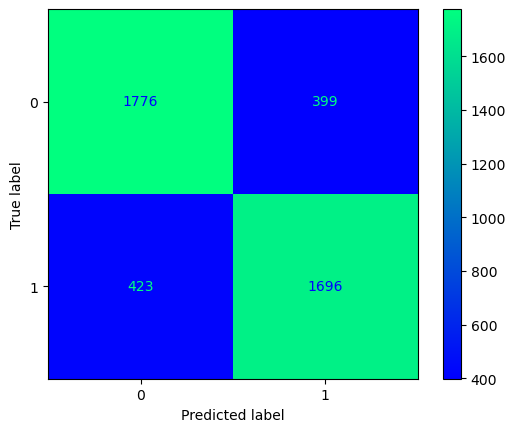

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.81      0.82      0.81      2175
           1       0.81      0.80      0.80      2119

    accuracy                           0.81      4294
   macro avg       0.81      0.81      0.81      4294
weighted avg       0.81      0.81      0.81      4294

-------------------------


In [67]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m1_15min.catboost_GridS()

In [68]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m1_15min,y_val_m1_15min)

Accuracy validación 0.810881311719769


In [69]:
guardar_modelo(modelo_entrenado_15min,"m1_catboost_GridS_15min")

### Partidas 10 min

Hora de inicio:  23:29:57
0:	learn: 0.6792899	test: 0.6799498	best: 0.6799498 (0)	total: 3.27ms	remaining: 324ms
1:	learn: 0.6673570	test: 0.6685300	best: 0.6685300 (1)	total: 6.26ms	remaining: 307ms
2:	learn: 0.6562104	test: 0.6574124	best: 0.6574124 (2)	total: 9.28ms	remaining: 300ms
3:	learn: 0.6463607	test: 0.6476008	best: 0.6476008 (3)	total: 12.3ms	remaining: 295ms
4:	learn: 0.6370008	test: 0.6385877	best: 0.6385877 (4)	total: 15.2ms	remaining: 289ms
5:	learn: 0.6290374	test: 0.6306030	best: 0.6306030 (5)	total: 18.2ms	remaining: 285ms
6:	learn: 0.6217772	test: 0.6232499	best: 0.6232499 (6)	total: 21ms	remaining: 279ms
7:	learn: 0.6155478	test: 0.6172070	best: 0.6172070 (7)	total: 24.1ms	remaining: 278ms
8:	learn: 0.6103130	test: 0.6123064	best: 0.6123064 (8)	total: 27.2ms	remaining: 275ms
9:	learn: 0.6043567	test: 0.6066977	best: 0.6066977 (9)	total: 30.2ms	remaining: 271ms
10:	learn: 0.5992548	test: 0.6017636	best: 0.6017636 (10)	total: 33.1ms	remaining: 268ms
11:	learn: 0.5946

9:	learn: 0.5668767	test: 0.5712441	best: 0.5712441 (9)	total: 30.5ms	remaining: 274ms
10:	learn: 0.5613531	test: 0.5658304	best: 0.5658304 (10)	total: 33.8ms	remaining: 273ms
11:	learn: 0.5574647	test: 0.5618987	best: 0.5618987 (11)	total: 37.2ms	remaining: 273ms
12:	learn: 0.5542881	test: 0.5588404	best: 0.5588404 (12)	total: 40.2ms	remaining: 269ms
13:	learn: 0.5507084	test: 0.5557745	best: 0.5557745 (13)	total: 43.1ms	remaining: 265ms
14:	learn: 0.5483300	test: 0.5536752	best: 0.5536752 (14)	total: 46.6ms	remaining: 264ms
15:	learn: 0.5452090	test: 0.5512235	best: 0.5512235 (15)	total: 49.6ms	remaining: 260ms
16:	learn: 0.5419405	test: 0.5485829	best: 0.5485829 (16)	total: 52.9ms	remaining: 258ms
17:	learn: 0.5400560	test: 0.5465198	best: 0.5465198 (17)	total: 56.1ms	remaining: 256ms
18:	learn: 0.5382393	test: 0.5448806	best: 0.5448806 (18)	total: 59.4ms	remaining: 253ms
19:	learn: 0.5366449	test: 0.5436441	best: 0.5436441 (19)	total: 63.9ms	remaining: 256ms
20:	learn: 0.5352861	te

37:	learn: 0.5135347	test: 0.5247400	best: 0.5247400 (37)	total: 126ms	remaining: 205ms
38:	learn: 0.5134184	test: 0.5246751	best: 0.5246751 (38)	total: 129ms	remaining: 201ms
39:	learn: 0.5131535	test: 0.5244965	best: 0.5244965 (39)	total: 131ms	remaining: 197ms
40:	learn: 0.5123805	test: 0.5243468	best: 0.5243468 (40)	total: 134ms	remaining: 193ms
41:	learn: 0.5121451	test: 0.5242861	best: 0.5242861 (41)	total: 137ms	remaining: 190ms
42:	learn: 0.5117800	test: 0.5240489	best: 0.5240489 (42)	total: 140ms	remaining: 186ms
43:	learn: 0.5114226	test: 0.5236799	best: 0.5236799 (43)	total: 143ms	remaining: 182ms
44:	learn: 0.5109225	test: 0.5234106	best: 0.5234106 (44)	total: 146ms	remaining: 178ms
45:	learn: 0.5106099	test: 0.5229681	best: 0.5229681 (45)	total: 149ms	remaining: 175ms
46:	learn: 0.5102748	test: 0.5228042	best: 0.5228042 (46)	total: 152ms	remaining: 171ms
47:	learn: 0.5100120	test: 0.5226830	best: 0.5226830 (47)	total: 155ms	remaining: 168ms
48:	learn: 0.5094943	test: 0.522

77:	learn: 0.4932418	test: 0.5248515	best: 0.5213447 (47)	total: 235ms	remaining: 66.3ms
78:	learn: 0.4923856	test: 0.5250087	best: 0.5213447 (47)	total: 239ms	remaining: 63.4ms
79:	learn: 0.4920240	test: 0.5251697	best: 0.5213447 (47)	total: 241ms	remaining: 60.3ms
80:	learn: 0.4917082	test: 0.5258844	best: 0.5213447 (47)	total: 244ms	remaining: 57.3ms
81:	learn: 0.4914518	test: 0.5261883	best: 0.5213447 (47)	total: 247ms	remaining: 54.2ms
82:	learn: 0.4910131	test: 0.5264742	best: 0.5213447 (47)	total: 250ms	remaining: 51.2ms
83:	learn: 0.4908830	test: 0.5265203	best: 0.5213447 (47)	total: 253ms	remaining: 48.1ms
84:	learn: 0.4905593	test: 0.5266099	best: 0.5213447 (47)	total: 256ms	remaining: 45.1ms
85:	learn: 0.4901592	test: 0.5264284	best: 0.5213447 (47)	total: 259ms	remaining: 42.1ms
86:	learn: 0.4899537	test: 0.5264167	best: 0.5213447 (47)	total: 261ms	remaining: 39.1ms
87:	learn: 0.4896211	test: 0.5265702	best: 0.5213447 (47)	total: 265ms	remaining: 36.1ms
88:	learn: 0.4893903	

14:	learn: 0.5819147	test: 0.5853168	best: 0.5853168 (14)	total: 45.7ms	remaining: 259ms
15:	learn: 0.5782857	test: 0.5822861	best: 0.5822861 (15)	total: 48.9ms	remaining: 257ms
16:	learn: 0.5751033	test: 0.5791242	best: 0.5791242 (16)	total: 51.9ms	remaining: 253ms
17:	learn: 0.5714860	test: 0.5759509	best: 0.5759509 (17)	total: 54.8ms	remaining: 250ms
18:	learn: 0.5690918	test: 0.5735536	best: 0.5735536 (18)	total: 57.8ms	remaining: 247ms
19:	learn: 0.5666191	test: 0.5710326	best: 0.5710326 (19)	total: 60.9ms	remaining: 244ms
20:	learn: 0.5637678	test: 0.5686978	best: 0.5686978 (20)	total: 64.2ms	remaining: 241ms
21:	learn: 0.5615425	test: 0.5664426	best: 0.5664426 (21)	total: 67.1ms	remaining: 238ms
22:	learn: 0.5589516	test: 0.5643998	best: 0.5643998 (22)	total: 70.1ms	remaining: 235ms
23:	learn: 0.5569831	test: 0.5627496	best: 0.5627496 (23)	total: 73.6ms	remaining: 233ms
24:	learn: 0.5552836	test: 0.5611173	best: 0.5611173 (24)	total: 77ms	remaining: 231ms
25:	learn: 0.5534953	te

46:	learn: 0.5145512	test: 0.5263496	best: 0.5263090 (45)	total: 145ms	remaining: 163ms
47:	learn: 0.5141761	test: 0.5259585	best: 0.5259585 (47)	total: 148ms	remaining: 160ms
48:	learn: 0.5138934	test: 0.5258480	best: 0.5258480 (48)	total: 151ms	remaining: 157ms
49:	learn: 0.5135023	test: 0.5254269	best: 0.5254269 (49)	total: 153ms	remaining: 153ms
50:	learn: 0.5128916	test: 0.5250486	best: 0.5250486 (50)	total: 156ms	remaining: 150ms
51:	learn: 0.5124742	test: 0.5248867	best: 0.5248867 (51)	total: 159ms	remaining: 147ms
52:	learn: 0.5121520	test: 0.5246998	best: 0.5246998 (52)	total: 162ms	remaining: 144ms
53:	learn: 0.5116191	test: 0.5245099	best: 0.5245099 (53)	total: 165ms	remaining: 141ms
54:	learn: 0.5113628	test: 0.5243027	best: 0.5243027 (54)	total: 169ms	remaining: 138ms
55:	learn: 0.5107953	test: 0.5236005	best: 0.5236005 (55)	total: 172ms	remaining: 135ms
56:	learn: 0.5105791	test: 0.5234445	best: 0.5234445 (56)	total: 175ms	remaining: 132ms
57:	learn: 0.5101691	test: 0.523

75:	learn: 0.5012297	test: 0.5217018	best: 0.5209944 (71)	total: 243ms	remaining: 76.8ms
76:	learn: 0.5008903	test: 0.5217686	best: 0.5209944 (71)	total: 246ms	remaining: 73.6ms
77:	learn: 0.5005185	test: 0.5217178	best: 0.5209944 (71)	total: 249ms	remaining: 70.3ms
78:	learn: 0.5002760	test: 0.5217816	best: 0.5209944 (71)	total: 252ms	remaining: 67ms
79:	learn: 0.5000874	test: 0.5218121	best: 0.5209944 (71)	total: 255ms	remaining: 63.7ms
80:	learn: 0.4998319	test: 0.5218088	best: 0.5209944 (71)	total: 258ms	remaining: 60.5ms
81:	learn: 0.4994415	test: 0.5218390	best: 0.5209944 (71)	total: 261ms	remaining: 57.3ms
82:	learn: 0.4992577	test: 0.5219563	best: 0.5209944 (71)	total: 264ms	remaining: 54ms
83:	learn: 0.4990073	test: 0.5220799	best: 0.5209944 (71)	total: 267ms	remaining: 50.8ms
84:	learn: 0.4986966	test: 0.5228487	best: 0.5209944 (71)	total: 270ms	remaining: 47.6ms
85:	learn: 0.4984509	test: 0.5229422	best: 0.5209944 (71)	total: 273ms	remaining: 44.5ms
86:	learn: 0.4981286	test

8:	learn: 0.5192108	test: 0.5312245	best: 0.5312245 (8)	total: 28.7ms	remaining: 291ms
9:	learn: 0.5176560	test: 0.5311131	best: 0.5311131 (9)	total: 32.1ms	remaining: 289ms
10:	learn: 0.5164524	test: 0.5293420	best: 0.5293420 (10)	total: 35.1ms	remaining: 284ms
11:	learn: 0.5156417	test: 0.5290112	best: 0.5290112 (11)	total: 37.9ms	remaining: 278ms
12:	learn: 0.5144938	test: 0.5286922	best: 0.5286922 (12)	total: 40.7ms	remaining: 272ms
13:	learn: 0.5140112	test: 0.5286207	best: 0.5286207 (13)	total: 43.8ms	remaining: 269ms
14:	learn: 0.5127568	test: 0.5281330	best: 0.5281330 (14)	total: 46.5ms	remaining: 263ms
15:	learn: 0.5121169	test: 0.5273429	best: 0.5273429 (15)	total: 49.7ms	remaining: 261ms
16:	learn: 0.5108388	test: 0.5265240	best: 0.5265240 (16)	total: 52.3ms	remaining: 255ms
17:	learn: 0.5103897	test: 0.5260402	best: 0.5260402 (17)	total: 55.1ms	remaining: 251ms
18:	learn: 0.5091333	test: 0.5254781	best: 0.5254781 (18)	total: 57.8ms	remaining: 247ms
19:	learn: 0.5080995	test

44:	learn: 0.5328503	test: 0.5411148	best: 0.5411148 (44)	total: 135ms	remaining: 165ms
45:	learn: 0.5320200	test: 0.5405176	best: 0.5405176 (45)	total: 139ms	remaining: 163ms
46:	learn: 0.5314163	test: 0.5400160	best: 0.5400160 (46)	total: 142ms	remaining: 160ms
47:	learn: 0.5307204	test: 0.5393899	best: 0.5393899 (47)	total: 145ms	remaining: 157ms
48:	learn: 0.5302971	test: 0.5389564	best: 0.5389564 (48)	total: 148ms	remaining: 154ms
49:	learn: 0.5298060	test: 0.5385832	best: 0.5385832 (49)	total: 151ms	remaining: 151ms
50:	learn: 0.5293048	test: 0.5380601	best: 0.5380601 (50)	total: 154ms	remaining: 148ms
51:	learn: 0.5286037	test: 0.5375571	best: 0.5375571 (51)	total: 158ms	remaining: 146ms
52:	learn: 0.5277476	test: 0.5370590	best: 0.5370590 (52)	total: 161ms	remaining: 142ms
53:	learn: 0.5271800	test: 0.5364297	best: 0.5364297 (53)	total: 164ms	remaining: 140ms
54:	learn: 0.5268139	test: 0.5361149	best: 0.5361149 (54)	total: 167ms	remaining: 136ms
55:	learn: 0.5263421	test: 0.535

76:	learn: 0.5060323	test: 0.5215817	best: 0.5215817 (76)	total: 238ms	remaining: 71ms
77:	learn: 0.5058627	test: 0.5217632	best: 0.5215817 (76)	total: 241ms	remaining: 67.9ms
78:	learn: 0.5057328	test: 0.5217181	best: 0.5215817 (76)	total: 244ms	remaining: 64.8ms
79:	learn: 0.5055487	test: 0.5216754	best: 0.5215817 (76)	total: 246ms	remaining: 61.6ms
80:	learn: 0.5053301	test: 0.5217269	best: 0.5215817 (76)	total: 250ms	remaining: 58.5ms
81:	learn: 0.5051798	test: 0.5217345	best: 0.5215817 (76)	total: 252ms	remaining: 55.4ms
82:	learn: 0.5050852	test: 0.5216966	best: 0.5215817 (76)	total: 256ms	remaining: 52.3ms
83:	learn: 0.5048534	test: 0.5217629	best: 0.5215817 (76)	total: 259ms	remaining: 49.3ms
84:	learn: 0.5046313	test: 0.5216677	best: 0.5215817 (76)	total: 261ms	remaining: 46.1ms
85:	learn: 0.5044649	test: 0.5215224	best: 0.5215224 (85)	total: 264ms	remaining: 43ms
86:	learn: 0.5043317	test: 0.5214021	best: 0.5214021 (86)	total: 267ms	remaining: 39.9ms
87:	learn: 0.5041938	test

15:	learn: 0.5234845	test: 0.5320035	best: 0.5320035 (15)	total: 50ms	remaining: 262ms
16:	learn: 0.5216116	test: 0.5310436	best: 0.5310436 (16)	total: 53.4ms	remaining: 260ms
17:	learn: 0.5205515	test: 0.5312593	best: 0.5310436 (16)	total: 56.4ms	remaining: 257ms
18:	learn: 0.5197396	test: 0.5304259	best: 0.5304259 (18)	total: 59.4ms	remaining: 253ms
19:	learn: 0.5188141	test: 0.5300646	best: 0.5300646 (19)	total: 62.5ms	remaining: 250ms
20:	learn: 0.5180507	test: 0.5301788	best: 0.5300646 (19)	total: 65.6ms	remaining: 247ms
21:	learn: 0.5173465	test: 0.5294560	best: 0.5294560 (21)	total: 68.6ms	remaining: 243ms
22:	learn: 0.5167397	test: 0.5289575	best: 0.5289575 (22)	total: 71.3ms	remaining: 239ms
23:	learn: 0.5159469	test: 0.5280781	best: 0.5280781 (23)	total: 74.1ms	remaining: 235ms
24:	learn: 0.5150469	test: 0.5273502	best: 0.5273502 (24)	total: 76.8ms	remaining: 230ms
25:	learn: 0.5143924	test: 0.5267931	best: 0.5267931 (25)	total: 80.3ms	remaining: 228ms
26:	learn: 0.5138001	te

52:	learn: 0.4852844	test: 0.5334255	best: 0.5237958 (38)	total: 155ms	remaining: 138ms
53:	learn: 0.4848800	test: 0.5333241	best: 0.5237958 (38)	total: 158ms	remaining: 135ms
54:	learn: 0.4844996	test: 0.5329663	best: 0.5237958 (38)	total: 161ms	remaining: 132ms
55:	learn: 0.4838110	test: 0.5336292	best: 0.5237958 (38)	total: 164ms	remaining: 129ms
56:	learn: 0.4832889	test: 0.5339594	best: 0.5237958 (38)	total: 167ms	remaining: 126ms
57:	learn: 0.4827334	test: 0.5337251	best: 0.5237958 (38)	total: 169ms	remaining: 123ms
58:	learn: 0.4823030	test: 0.5332216	best: 0.5237958 (38)	total: 173ms	remaining: 120ms
59:	learn: 0.4817647	test: 0.5328197	best: 0.5237958 (38)	total: 176ms	remaining: 117ms
60:	learn: 0.4811401	test: 0.5325664	best: 0.5237958 (38)	total: 179ms	remaining: 114ms
61:	learn: 0.4804853	test: 0.5326891	best: 0.5237958 (38)	total: 181ms	remaining: 111ms
62:	learn: 0.4802010	test: 0.5331544	best: 0.5237958 (38)	total: 184ms	remaining: 108ms
63:	learn: 0.4795253	test: 0.533

86:	learn: 0.5163430	test: 0.5277845	best: 0.5277845 (86)	total: 263ms	remaining: 191ms
87:	learn: 0.5161880	test: 0.5275779	best: 0.5275779 (87)	total: 266ms	remaining: 188ms
88:	learn: 0.5160593	test: 0.5275288	best: 0.5275288 (88)	total: 269ms	remaining: 185ms
89:	learn: 0.5158900	test: 0.5273647	best: 0.5273647 (89)	total: 272ms	remaining: 181ms
90:	learn: 0.5157229	test: 0.5271442	best: 0.5271442 (90)	total: 275ms	remaining: 178ms
91:	learn: 0.5155324	test: 0.5269206	best: 0.5269206 (91)	total: 278ms	remaining: 175ms
92:	learn: 0.5153796	test: 0.5267752	best: 0.5267752 (92)	total: 280ms	remaining: 172ms
93:	learn: 0.5152447	test: 0.5266505	best: 0.5266505 (93)	total: 283ms	remaining: 169ms
94:	learn: 0.5151003	test: 0.5264993	best: 0.5264993 (94)	total: 286ms	remaining: 166ms
95:	learn: 0.5148912	test: 0.5262895	best: 0.5262895 (95)	total: 289ms	remaining: 162ms
96:	learn: 0.5147515	test: 0.5261722	best: 0.5261722 (96)	total: 291ms	remaining: 159ms
97:	learn: 0.5145571	test: 0.526

69:	learn: 0.5075426	test: 0.5219774	best: 0.5219774 (69)	total: 216ms	remaining: 247ms
70:	learn: 0.5074355	test: 0.5219079	best: 0.5219079 (70)	total: 220ms	remaining: 244ms
71:	learn: 0.5073061	test: 0.5220427	best: 0.5219079 (70)	total: 223ms	remaining: 241ms
72:	learn: 0.5071020	test: 0.5219674	best: 0.5219079 (70)	total: 225ms	remaining: 238ms
73:	learn: 0.5067359	test: 0.5218457	best: 0.5218457 (73)	total: 228ms	remaining: 235ms
74:	learn: 0.5065603	test: 0.5217959	best: 0.5217959 (74)	total: 231ms	remaining: 231ms
75:	learn: 0.5063028	test: 0.5217419	best: 0.5217419 (75)	total: 235ms	remaining: 228ms
76:	learn: 0.5060323	test: 0.5215817	best: 0.5215817 (76)	total: 238ms	remaining: 225ms
77:	learn: 0.5058627	test: 0.5217632	best: 0.5215817 (76)	total: 241ms	remaining: 222ms
78:	learn: 0.5057328	test: 0.5217181	best: 0.5215817 (76)	total: 244ms	remaining: 219ms
79:	learn: 0.5055487	test: 0.5216754	best: 0.5215817 (76)	total: 247ms	remaining: 216ms
80:	learn: 0.5053301	test: 0.521

46:	learn: 0.5102748	test: 0.5228042	best: 0.5228042 (46)	total: 139ms	remaining: 305ms
47:	learn: 0.5100120	test: 0.5226830	best: 0.5226830 (47)	total: 142ms	remaining: 302ms
48:	learn: 0.5094943	test: 0.5227426	best: 0.5226830 (47)	total: 146ms	remaining: 300ms
49:	learn: 0.5092272	test: 0.5233487	best: 0.5226830 (47)	total: 149ms	remaining: 297ms
50:	learn: 0.5089808	test: 0.5233937	best: 0.5226830 (47)	total: 152ms	remaining: 295ms
51:	learn: 0.5084862	test: 0.5230380	best: 0.5226830 (47)	total: 155ms	remaining: 292ms
52:	learn: 0.5079140	test: 0.5225059	best: 0.5225059 (52)	total: 158ms	remaining: 289ms
53:	learn: 0.5074566	test: 0.5221238	best: 0.5221238 (53)	total: 161ms	remaining: 286ms
54:	learn: 0.5073017	test: 0.5221215	best: 0.5221215 (54)	total: 164ms	remaining: 283ms
55:	learn: 0.5070738	test: 0.5218448	best: 0.5218448 (55)	total: 167ms	remaining: 280ms
56:	learn: 0.5068269	test: 0.5219049	best: 0.5218448 (55)	total: 170ms	remaining: 278ms
57:	learn: 0.5066766	test: 0.521

35:	learn: 0.5095535	test: 0.5231667	best: 0.5231667 (35)	total: 110ms	remaining: 348ms
36:	learn: 0.5090681	test: 0.5225344	best: 0.5225344 (36)	total: 113ms	remaining: 346ms
37:	learn: 0.5083439	test: 0.5222175	best: 0.5222175 (37)	total: 116ms	remaining: 343ms
38:	learn: 0.5079815	test: 0.5221459	best: 0.5221459 (38)	total: 119ms	remaining: 339ms
39:	learn: 0.5077975	test: 0.5221162	best: 0.5221162 (39)	total: 122ms	remaining: 335ms
40:	learn: 0.5075328	test: 0.5221213	best: 0.5221162 (39)	total: 125ms	remaining: 332ms
41:	learn: 0.5069969	test: 0.5216240	best: 0.5216240 (41)	total: 128ms	remaining: 328ms
42:	learn: 0.5067127	test: 0.5215498	best: 0.5215498 (42)	total: 131ms	remaining: 325ms
43:	learn: 0.5062529	test: 0.5215601	best: 0.5215498 (42)	total: 133ms	remaining: 321ms
44:	learn: 0.5059692	test: 0.5215420	best: 0.5215420 (44)	total: 136ms	remaining: 317ms
45:	learn: 0.5055410	test: 0.5215576	best: 0.5215420 (44)	total: 139ms	remaining: 315ms
46:	learn: 0.5052741	test: 0.521

20:	learn: 0.5072760	test: 0.5256608	best: 0.5254781 (18)	total: 63.8ms	remaining: 392ms
21:	learn: 0.5067875	test: 0.5256450	best: 0.5254781 (18)	total: 66.6ms	remaining: 387ms
22:	learn: 0.5059584	test: 0.5259379	best: 0.5254781 (18)	total: 69.3ms	remaining: 383ms
23:	learn: 0.5044864	test: 0.5250963	best: 0.5250963 (23)	total: 72.5ms	remaining: 381ms
24:	learn: 0.5035936	test: 0.5258918	best: 0.5250963 (23)	total: 75ms	remaining: 375ms
25:	learn: 0.5028507	test: 0.5263887	best: 0.5250963 (23)	total: 78.1ms	remaining: 373ms
26:	learn: 0.5020748	test: 0.5270371	best: 0.5250963 (23)	total: 80.9ms	remaining: 369ms
27:	learn: 0.5008655	test: 0.5264031	best: 0.5250963 (23)	total: 83.6ms	remaining: 364ms
28:	learn: 0.5000252	test: 0.5259645	best: 0.5250963 (23)	total: 86.7ms	remaining: 362ms
29:	learn: 0.4991891	test: 0.5246173	best: 0.5246173 (29)	total: 89.8ms	remaining: 359ms
30:	learn: 0.4985818	test: 0.5243563	best: 0.5243563 (30)	total: 92.4ms	remaining: 355ms
31:	learn: 0.4977784	te

8:	learn: 0.6103130	test: 0.6123064	best: 0.6123064 (8)	total: 28.1ms	remaining: 440ms
9:	learn: 0.6043567	test: 0.6066977	best: 0.6066977 (9)	total: 31.3ms	remaining: 439ms
10:	learn: 0.5992548	test: 0.6017636	best: 0.6017636 (10)	total: 34.2ms	remaining: 432ms
11:	learn: 0.5946732	test: 0.5975207	best: 0.5975207 (11)	total: 37.3ms	remaining: 429ms
12:	learn: 0.5901427	test: 0.5930992	best: 0.5930992 (12)	total: 40.2ms	remaining: 424ms
13:	learn: 0.5862184	test: 0.5892314	best: 0.5892314 (13)	total: 43.1ms	remaining: 419ms
14:	learn: 0.5819147	test: 0.5853168	best: 0.5853168 (14)	total: 46.1ms	remaining: 415ms
15:	learn: 0.5782857	test: 0.5822861	best: 0.5822861 (15)	total: 49.2ms	remaining: 412ms
16:	learn: 0.5751033	test: 0.5791242	best: 0.5791242 (16)	total: 52.1ms	remaining: 407ms
17:	learn: 0.5714860	test: 0.5759509	best: 0.5759509 (17)	total: 55.1ms	remaining: 404ms
18:	learn: 0.5690918	test: 0.5735536	best: 0.5735536 (18)	total: 58.1ms	remaining: 401ms
19:	learn: 0.5666191	test

142:	learn: 0.5088206	test: 0.5225191	best: 0.5225191 (142)	total: 433ms	remaining: 21.2ms
143:	learn: 0.5087082	test: 0.5224493	best: 0.5224493 (143)	total: 436ms	remaining: 18.2ms
144:	learn: 0.5086385	test: 0.5223940	best: 0.5223940 (144)	total: 438ms	remaining: 15.1ms
145:	learn: 0.5085327	test: 0.5223588	best: 0.5223588 (145)	total: 441ms	remaining: 12.1ms
146:	learn: 0.5083630	test: 0.5222996	best: 0.5222996 (146)	total: 444ms	remaining: 9.07ms
147:	learn: 0.5081299	test: 0.5223160	best: 0.5222996 (146)	total: 448ms	remaining: 6.05ms
148:	learn: 0.5079986	test: 0.5222287	best: 0.5222287 (148)	total: 450ms	remaining: 3.02ms
149:	learn: 0.5078726	test: 0.5223658	best: 0.5222287 (148)	total: 453ms	remaining: 0us

bestTest = 0.5222286979
bestIteration = 148

20:	loss: 0.5222287	best: 0.5208277 (1)	total: 7.38s	remaining: 40.1s
0:	learn: 0.6663176	test: 0.6676106	best: 0.6676106 (0)	total: 3.19ms	remaining: 475ms
1:	learn: 0.6468615	test: 0.6484419	best: 0.6484419 (1)	total: 6.22ms	re

124:	learn: 0.4969006	test: 0.5222469	best: 0.5208277 (93)	total: 380ms	remaining: 76ms
125:	learn: 0.4967061	test: 0.5223003	best: 0.5208277 (93)	total: 383ms	remaining: 73ms
126:	learn: 0.4965181	test: 0.5222391	best: 0.5208277 (93)	total: 386ms	remaining: 69.9ms
127:	learn: 0.4963586	test: 0.5221373	best: 0.5208277 (93)	total: 389ms	remaining: 66.9ms
128:	learn: 0.4961798	test: 0.5222124	best: 0.5208277 (93)	total: 392ms	remaining: 63.9ms
129:	learn: 0.4958138	test: 0.5220044	best: 0.5208277 (93)	total: 395ms	remaining: 60.8ms
130:	learn: 0.4955936	test: 0.5218280	best: 0.5208277 (93)	total: 399ms	remaining: 57.8ms
131:	learn: 0.4954790	test: 0.5218413	best: 0.5208277 (93)	total: 401ms	remaining: 54.7ms
132:	learn: 0.4952468	test: 0.5219059	best: 0.5208277 (93)	total: 404ms	remaining: 51.6ms
133:	learn: 0.4950474	test: 0.5218212	best: 0.5208277 (93)	total: 407ms	remaining: 48.6ms
134:	learn: 0.4947024	test: 0.5219292	best: 0.5208277 (93)	total: 410ms	remaining: 45.6ms
135:	learn: 0.

113:	learn: 0.4911860	test: 0.5235264	best: 0.5209944 (71)	total: 339ms	remaining: 107ms
114:	learn: 0.4909274	test: 0.5236889	best: 0.5209944 (71)	total: 342ms	remaining: 104ms
115:	learn: 0.4907563	test: 0.5238936	best: 0.5209944 (71)	total: 345ms	remaining: 101ms
116:	learn: 0.4905645	test: 0.5240025	best: 0.5209944 (71)	total: 348ms	remaining: 98.3ms
117:	learn: 0.4903064	test: 0.5237389	best: 0.5209944 (71)	total: 351ms	remaining: 95.2ms
118:	learn: 0.4900446	test: 0.5238014	best: 0.5209944 (71)	total: 354ms	remaining: 92.3ms
119:	learn: 0.4897799	test: 0.5237353	best: 0.5209944 (71)	total: 357ms	remaining: 89.2ms
120:	learn: 0.4896099	test: 0.5238852	best: 0.5209944 (71)	total: 360ms	remaining: 86.3ms
121:	learn: 0.4894945	test: 0.5240071	best: 0.5209944 (71)	total: 363ms	remaining: 83.3ms
122:	learn: 0.4891467	test: 0.5243936	best: 0.5209944 (71)	total: 366ms	remaining: 80.3ms
123:	learn: 0.4889515	test: 0.5243138	best: 0.5209944 (71)	total: 369ms	remaining: 77.3ms
124:	learn: 0

82:	learn: 0.4910131	test: 0.5264742	best: 0.5213447 (47)	total: 293ms	remaining: 237ms
83:	learn: 0.4908830	test: 0.5265203	best: 0.5213447 (47)	total: 296ms	remaining: 233ms
84:	learn: 0.4905593	test: 0.5266099	best: 0.5213447 (47)	total: 299ms	remaining: 229ms
85:	learn: 0.4901592	test: 0.5264284	best: 0.5213447 (47)	total: 302ms	remaining: 225ms
86:	learn: 0.4899537	test: 0.5264167	best: 0.5213447 (47)	total: 305ms	remaining: 221ms
87:	learn: 0.4896211	test: 0.5265702	best: 0.5213447 (47)	total: 308ms	remaining: 217ms
88:	learn: 0.4893903	test: 0.5267662	best: 0.5213447 (47)	total: 311ms	remaining: 213ms
89:	learn: 0.4888615	test: 0.5278932	best: 0.5213447 (47)	total: 314ms	remaining: 210ms
90:	learn: 0.4885326	test: 0.5282145	best: 0.5213447 (47)	total: 317ms	remaining: 206ms
91:	learn: 0.4883720	test: 0.5280683	best: 0.5213447 (47)	total: 320ms	remaining: 202ms
92:	learn: 0.4881044	test: 0.5280666	best: 0.5213447 (47)	total: 323ms	remaining: 198ms
93:	learn: 0.4877761	test: 0.528

73:	learn: 0.4746816	test: 0.5382995	best: 0.5237958 (38)	total: 217ms	remaining: 223ms
74:	learn: 0.4741311	test: 0.5387038	best: 0.5237958 (38)	total: 220ms	remaining: 220ms
75:	learn: 0.4735776	test: 0.5386505	best: 0.5237958 (38)	total: 223ms	remaining: 217ms
76:	learn: 0.4730375	test: 0.5402870	best: 0.5237958 (38)	total: 226ms	remaining: 214ms
77:	learn: 0.4726564	test: 0.5406620	best: 0.5237958 (38)	total: 229ms	remaining: 211ms
78:	learn: 0.4721971	test: 0.5404285	best: 0.5237958 (38)	total: 232ms	remaining: 208ms
79:	learn: 0.4717690	test: 0.5398798	best: 0.5237958 (38)	total: 235ms	remaining: 205ms
80:	learn: 0.4715226	test: 0.5400248	best: 0.5237958 (38)	total: 237ms	remaining: 202ms
81:	learn: 0.4710587	test: 0.5397493	best: 0.5237958 (38)	total: 240ms	remaining: 199ms
82:	learn: 0.4707490	test: 0.5401226	best: 0.5237958 (38)	total: 243ms	remaining: 197ms
83:	learn: 0.4703330	test: 0.5401814	best: 0.5237958 (38)	total: 246ms	remaining: 193ms
84:	learn: 0.4696649	test: 0.540

63:	learn: 0.5226598	test: 0.5324677	best: 0.5324677 (63)	total: 195ms	remaining: 262ms
64:	learn: 0.5223916	test: 0.5323803	best: 0.5323803 (64)	total: 198ms	remaining: 259ms
65:	learn: 0.5220010	test: 0.5321193	best: 0.5321193 (65)	total: 201ms	remaining: 256ms
66:	learn: 0.5216547	test: 0.5317533	best: 0.5317533 (66)	total: 204ms	remaining: 253ms
67:	learn: 0.5211862	test: 0.5314580	best: 0.5314580 (67)	total: 207ms	remaining: 250ms
68:	learn: 0.5208403	test: 0.5311901	best: 0.5311901 (68)	total: 210ms	remaining: 246ms
69:	learn: 0.5205270	test: 0.5309576	best: 0.5309576 (69)	total: 213ms	remaining: 243ms
70:	learn: 0.5203305	test: 0.5308488	best: 0.5308488 (70)	total: 216ms	remaining: 240ms
71:	learn: 0.5200738	test: 0.5307852	best: 0.5307852 (71)	total: 219ms	remaining: 237ms
72:	learn: 0.5198427	test: 0.5306060	best: 0.5306060 (72)	total: 221ms	remaining: 233ms
73:	learn: 0.5195568	test: 0.5302501	best: 0.5302501 (73)	total: 225ms	remaining: 231ms
74:	learn: 0.5193384	test: 0.530

49:	learn: 0.5135023	test: 0.5254269	best: 0.5254269 (49)	total: 154ms	remaining: 308ms
50:	learn: 0.5128916	test: 0.5250486	best: 0.5250486 (50)	total: 157ms	remaining: 304ms
51:	learn: 0.5124742	test: 0.5248867	best: 0.5248867 (51)	total: 160ms	remaining: 301ms
52:	learn: 0.5121520	test: 0.5246998	best: 0.5246998 (52)	total: 163ms	remaining: 298ms
53:	learn: 0.5116191	test: 0.5245099	best: 0.5245099 (53)	total: 166ms	remaining: 295ms
54:	learn: 0.5113628	test: 0.5243027	best: 0.5243027 (54)	total: 169ms	remaining: 292ms
55:	learn: 0.5107953	test: 0.5236005	best: 0.5236005 (55)	total: 172ms	remaining: 289ms
56:	learn: 0.5105791	test: 0.5234445	best: 0.5234445 (56)	total: 175ms	remaining: 286ms
57:	learn: 0.5101691	test: 0.5235046	best: 0.5234445 (56)	total: 178ms	remaining: 283ms
58:	learn: 0.5100559	test: 0.5233643	best: 0.5233643 (58)	total: 181ms	remaining: 279ms
59:	learn: 0.5098510	test: 0.5232605	best: 0.5232605 (59)	total: 184ms	remaining: 276ms
60:	learn: 0.5095465	test: 0.523

36:	learn: 0.5138916	test: 0.5248571	best: 0.5248571 (36)	total: 115ms	remaining: 351ms
37:	learn: 0.5135347	test: 0.5247400	best: 0.5247400 (37)	total: 118ms	remaining: 349ms
38:	learn: 0.5134184	test: 0.5246751	best: 0.5246751 (38)	total: 121ms	remaining: 343ms
39:	learn: 0.5131535	test: 0.5244965	best: 0.5244965 (39)	total: 123ms	remaining: 339ms
40:	learn: 0.5123805	test: 0.5243468	best: 0.5243468 (40)	total: 126ms	remaining: 335ms
41:	learn: 0.5121451	test: 0.5242861	best: 0.5242861 (41)	total: 129ms	remaining: 332ms
42:	learn: 0.5117800	test: 0.5240489	best: 0.5240489 (42)	total: 132ms	remaining: 330ms
43:	learn: 0.5114226	test: 0.5236799	best: 0.5236799 (43)	total: 135ms	remaining: 325ms
44:	learn: 0.5109225	test: 0.5234106	best: 0.5234106 (44)	total: 138ms	remaining: 322ms
45:	learn: 0.5106099	test: 0.5229681	best: 0.5229681 (45)	total: 141ms	remaining: 319ms
46:	learn: 0.5102748	test: 0.5228042	best: 0.5228042 (46)	total: 144ms	remaining: 316ms
47:	learn: 0.5100120	test: 0.522

10:	learn: 0.5319394	test: 0.5406076	best: 0.5406076 (10)	total: 35.3ms	remaining: 446ms
11:	learn: 0.5294243	test: 0.5383142	best: 0.5383142 (11)	total: 38.4ms	remaining: 441ms
12:	learn: 0.5275372	test: 0.5365019	best: 0.5365019 (12)	total: 41.6ms	remaining: 438ms
13:	learn: 0.5258492	test: 0.5343113	best: 0.5343113 (13)	total: 44.8ms	remaining: 435ms
14:	learn: 0.5250259	test: 0.5334141	best: 0.5334141 (14)	total: 47.6ms	remaining: 429ms
15:	learn: 0.5234845	test: 0.5320035	best: 0.5320035 (15)	total: 50.4ms	remaining: 422ms
16:	learn: 0.5216116	test: 0.5310436	best: 0.5310436 (16)	total: 53.6ms	remaining: 419ms
17:	learn: 0.5205515	test: 0.5312593	best: 0.5310436 (16)	total: 56.6ms	remaining: 415ms
18:	learn: 0.5197396	test: 0.5304259	best: 0.5304259 (18)	total: 59.7ms	remaining: 412ms
19:	learn: 0.5188141	test: 0.5300646	best: 0.5300646 (19)	total: 63.3ms	remaining: 412ms
20:	learn: 0.5180507	test: 0.5301788	best: 0.5300646 (19)	total: 66.5ms	remaining: 408ms
21:	learn: 0.5173465	

139:	learn: 0.4751772	test: 0.5342839	best: 0.5213447 (47)	total: 436ms	remaining: 31.1ms
140:	learn: 0.4748720	test: 0.5340932	best: 0.5213447 (47)	total: 439ms	remaining: 28ms
141:	learn: 0.4746886	test: 0.5341942	best: 0.5213447 (47)	total: 441ms	remaining: 24.9ms
142:	learn: 0.4745403	test: 0.5341796	best: 0.5213447 (47)	total: 444ms	remaining: 21.7ms
143:	learn: 0.4742413	test: 0.5343324	best: 0.5213447 (47)	total: 447ms	remaining: 18.6ms
144:	learn: 0.4740299	test: 0.5340590	best: 0.5213447 (47)	total: 450ms	remaining: 15.5ms
145:	learn: 0.4737245	test: 0.5340409	best: 0.5213447 (47)	total: 453ms	remaining: 12.4ms
146:	learn: 0.4735031	test: 0.5338951	best: 0.5213447 (47)	total: 456ms	remaining: 9.3ms
147:	learn: 0.4734039	test: 0.5338622	best: 0.5213447 (47)	total: 459ms	remaining: 6.2ms
148:	learn: 0.4733024	test: 0.5339242	best: 0.5213447 (47)	total: 461ms	remaining: 3.09ms
149:	learn: 0.4729196	test: 0.5338632	best: 0.5213447 (47)	total: 464ms	remaining: 0us

bestTest = 0.521

130:	learn: 0.4484803	test: 0.5570233	best: 0.5237958 (38)	total: 385ms	remaining: 55.9ms
131:	learn: 0.4482026	test: 0.5570026	best: 0.5237958 (38)	total: 388ms	remaining: 52.9ms
132:	learn: 0.4477791	test: 0.5574392	best: 0.5237958 (38)	total: 391ms	remaining: 50ms
133:	learn: 0.4474480	test: 0.5586804	best: 0.5237958 (38)	total: 394ms	remaining: 47.1ms
134:	learn: 0.4470958	test: 0.5589161	best: 0.5237958 (38)	total: 397ms	remaining: 44.1ms
135:	learn: 0.4467655	test: 0.5588383	best: 0.5237958 (38)	total: 400ms	remaining: 41.2ms
136:	learn: 0.4464166	test: 0.5590749	best: 0.5237958 (38)	total: 403ms	remaining: 38.2ms
137:	learn: 0.4459879	test: 0.5589909	best: 0.5237958 (38)	total: 405ms	remaining: 35.2ms
138:	learn: 0.4456995	test: 0.5581546	best: 0.5237958 (38)	total: 408ms	remaining: 32.3ms
139:	learn: 0.4451840	test: 0.5577730	best: 0.5237958 (38)	total: 411ms	remaining: 29.4ms
140:	learn: 0.4447222	test: 0.5589355	best: 0.5237958 (38)	total: 414ms	remaining: 26.4ms
141:	learn: 

114:	learn: 0.5120517	test: 0.5243317	best: 0.5243317 (114)	total: 344ms	remaining: 255ms
115:	learn: 0.5118920	test: 0.5242680	best: 0.5242680 (115)	total: 348ms	remaining: 252ms
116:	learn: 0.5117845	test: 0.5241646	best: 0.5241646 (116)	total: 351ms	remaining: 249ms
117:	learn: 0.5116985	test: 0.5241128	best: 0.5241128 (117)	total: 354ms	remaining: 246ms
118:	learn: 0.5116237	test: 0.5240853	best: 0.5240853 (118)	total: 357ms	remaining: 243ms
119:	learn: 0.5115280	test: 0.5240068	best: 0.5240068 (119)	total: 359ms	remaining: 240ms
120:	learn: 0.5113998	test: 0.5239135	best: 0.5239135 (120)	total: 362ms	remaining: 236ms
121:	learn: 0.5112856	test: 0.5238906	best: 0.5238906 (121)	total: 365ms	remaining: 233ms
122:	learn: 0.5111757	test: 0.5237931	best: 0.5237931 (122)	total: 368ms	remaining: 230ms
123:	learn: 0.5110449	test: 0.5237105	best: 0.5237105 (123)	total: 371ms	remaining: 227ms
124:	learn: 0.5108538	test: 0.5235359	best: 0.5235359 (124)	total: 373ms	remaining: 224ms
125:	learn

50:	learn: 0.5128916	test: 0.5250486	best: 0.5250486 (50)	total: 153ms	remaining: 446ms
51:	learn: 0.5124742	test: 0.5248867	best: 0.5248867 (51)	total: 156ms	remaining: 444ms
52:	learn: 0.5121520	test: 0.5246998	best: 0.5246998 (52)	total: 159ms	remaining: 442ms
53:	learn: 0.5116191	test: 0.5245099	best: 0.5245099 (53)	total: 162ms	remaining: 439ms
54:	learn: 0.5113628	test: 0.5243027	best: 0.5243027 (54)	total: 166ms	remaining: 436ms
55:	learn: 0.5107953	test: 0.5236005	best: 0.5236005 (55)	total: 169ms	remaining: 434ms
56:	learn: 0.5105791	test: 0.5234445	best: 0.5234445 (56)	total: 172ms	remaining: 431ms
57:	learn: 0.5101691	test: 0.5235046	best: 0.5234445 (56)	total: 175ms	remaining: 428ms
58:	learn: 0.5100559	test: 0.5233643	best: 0.5233643 (58)	total: 177ms	remaining: 424ms
59:	learn: 0.5098510	test: 0.5232605	best: 0.5232605 (59)	total: 181ms	remaining: 421ms
60:	learn: 0.5095465	test: 0.5231106	best: 0.5231106 (60)	total: 184ms	remaining: 418ms
61:	learn: 0.5093705	test: 0.523

189:	learn: 0.4860832	test: 0.5229649	best: 0.5208277 (93)	total: 566ms	remaining: 29.8ms
190:	learn: 0.4859651	test: 0.5229956	best: 0.5208277 (93)	total: 569ms	remaining: 26.8ms
191:	learn: 0.4858098	test: 0.5229231	best: 0.5208277 (93)	total: 572ms	remaining: 23.8ms
192:	learn: 0.4856998	test: 0.5230092	best: 0.5208277 (93)	total: 575ms	remaining: 20.9ms
193:	learn: 0.4855584	test: 0.5229545	best: 0.5208277 (93)	total: 578ms	remaining: 17.9ms
194:	learn: 0.4854394	test: 0.5228780	best: 0.5208277 (93)	total: 581ms	remaining: 14.9ms
195:	learn: 0.4853389	test: 0.5229317	best: 0.5208277 (93)	total: 584ms	remaining: 11.9ms
196:	learn: 0.4851266	test: 0.5228224	best: 0.5208277 (93)	total: 587ms	remaining: 8.94ms
197:	learn: 0.4850480	test: 0.5228240	best: 0.5208277 (93)	total: 590ms	remaining: 5.96ms
198:	learn: 0.4849102	test: 0.5228119	best: 0.5208277 (93)	total: 593ms	remaining: 2.98ms
199:	learn: 0.4848282	test: 0.5227606	best: 0.5208277 (93)	total: 595ms	remaining: 0us

bestTest = 0

124:	learn: 0.4887376	test: 0.5242456	best: 0.5209944 (71)	total: 373ms	remaining: 224ms
125:	learn: 0.4884931	test: 0.5241837	best: 0.5209944 (71)	total: 376ms	remaining: 221ms
126:	learn: 0.4882625	test: 0.5242094	best: 0.5209944 (71)	total: 379ms	remaining: 218ms
127:	learn: 0.4881183	test: 0.5241741	best: 0.5209944 (71)	total: 381ms	remaining: 215ms
128:	learn: 0.4878873	test: 0.5241900	best: 0.5209944 (71)	total: 385ms	remaining: 212ms
129:	learn: 0.4877499	test: 0.5242063	best: 0.5209944 (71)	total: 388ms	remaining: 209ms
130:	learn: 0.4875177	test: 0.5243063	best: 0.5209944 (71)	total: 390ms	remaining: 206ms
131:	learn: 0.4873633	test: 0.5243742	best: 0.5209944 (71)	total: 393ms	remaining: 202ms
132:	learn: 0.4870457	test: 0.5245758	best: 0.5209944 (71)	total: 396ms	remaining: 200ms
133:	learn: 0.4867117	test: 0.5243595	best: 0.5209944 (71)	total: 399ms	remaining: 197ms
134:	learn: 0.4865425	test: 0.5244327	best: 0.5209944 (71)	total: 402ms	remaining: 194ms
135:	learn: 0.4863120

58:	learn: 0.5006752	test: 0.5222581	best: 0.5213447 (47)	total: 182ms	remaining: 435ms
59:	learn: 0.5003873	test: 0.5223531	best: 0.5213447 (47)	total: 185ms	remaining: 432ms
60:	learn: 0.4998055	test: 0.5223658	best: 0.5213447 (47)	total: 188ms	remaining: 429ms
61:	learn: 0.4993800	test: 0.5224360	best: 0.5213447 (47)	total: 191ms	remaining: 425ms
62:	learn: 0.4990057	test: 0.5225158	best: 0.5213447 (47)	total: 194ms	remaining: 421ms
63:	learn: 0.4986501	test: 0.5225035	best: 0.5213447 (47)	total: 197ms	remaining: 418ms
64:	learn: 0.4982947	test: 0.5226881	best: 0.5213447 (47)	total: 200ms	remaining: 414ms
65:	learn: 0.4980542	test: 0.5224742	best: 0.5213447 (47)	total: 203ms	remaining: 411ms
66:	learn: 0.4977153	test: 0.5227240	best: 0.5213447 (47)	total: 205ms	remaining: 408ms
67:	learn: 0.4975455	test: 0.5227644	best: 0.5213447 (47)	total: 208ms	remaining: 404ms
68:	learn: 0.4972095	test: 0.5230299	best: 0.5213447 (47)	total: 211ms	remaining: 401ms
69:	learn: 0.4968641	test: 0.524

195:	learn: 0.4625819	test: 0.5380132	best: 0.5213447 (47)	total: 586ms	remaining: 12ms
196:	learn: 0.4623962	test: 0.5381669	best: 0.5213447 (47)	total: 589ms	remaining: 8.98ms
197:	learn: 0.4622478	test: 0.5389050	best: 0.5213447 (47)	total: 592ms	remaining: 5.98ms
198:	learn: 0.4620709	test: 0.5389168	best: 0.5213447 (47)	total: 596ms	remaining: 2.99ms
199:	learn: 0.4618108	test: 0.5388837	best: 0.5213447 (47)	total: 598ms	remaining: 0us

bestTest = 0.5213446578
bestIteration = 47

33:	loss: 0.5213447	best: 0.5208277 (1)	total: 14s	remaining: 41.6s
0:	learn: 0.5933945	test: 0.5985148	best: 0.5985148 (0)	total: 3.16ms	remaining: 629ms
1:	learn: 0.5579891	test: 0.5627756	best: 0.5627756 (1)	total: 6.08ms	remaining: 602ms
2:	learn: 0.5408445	test: 0.5484667	best: 0.5484667 (2)	total: 8.95ms	remaining: 587ms
3:	learn: 0.5343842	test: 0.5424398	best: 0.5424398 (3)	total: 11.8ms	remaining: 579ms
4:	learn: 0.5290519	test: 0.5377641	best: 0.5377641 (4)	total: 15ms	remaining: 586ms
5:	learn:

133:	learn: 0.4474480	test: 0.5586804	best: 0.5237958 (38)	total: 390ms	remaining: 192ms
134:	learn: 0.4470958	test: 0.5589161	best: 0.5237958 (38)	total: 393ms	remaining: 189ms
135:	learn: 0.4467655	test: 0.5588383	best: 0.5237958 (38)	total: 396ms	remaining: 186ms
136:	learn: 0.4464166	test: 0.5590749	best: 0.5237958 (38)	total: 398ms	remaining: 183ms
137:	learn: 0.4459879	test: 0.5589909	best: 0.5237958 (38)	total: 401ms	remaining: 180ms
138:	learn: 0.4456995	test: 0.5581546	best: 0.5237958 (38)	total: 404ms	remaining: 177ms
139:	learn: 0.4451840	test: 0.5577730	best: 0.5237958 (38)	total: 406ms	remaining: 174ms
140:	learn: 0.4447222	test: 0.5589355	best: 0.5237958 (38)	total: 409ms	remaining: 171ms
141:	learn: 0.4443914	test: 0.5590101	best: 0.5237958 (38)	total: 412ms	remaining: 168ms
142:	learn: 0.4441924	test: 0.5592309	best: 0.5237958 (38)	total: 415ms	remaining: 165ms
143:	learn: 0.4437647	test: 0.5627041	best: 0.5237958 (38)	total: 418ms	remaining: 163ms
144:	learn: 0.4433005

69:	learn: 0.5205270	test: 0.5309576	best: 0.5309576 (69)	total: 211ms	remaining: 392ms
70:	learn: 0.5203305	test: 0.5308488	best: 0.5308488 (70)	total: 214ms	remaining: 389ms
71:	learn: 0.5200738	test: 0.5307852	best: 0.5307852 (71)	total: 217ms	remaining: 386ms
72:	learn: 0.5198427	test: 0.5306060	best: 0.5306060 (72)	total: 220ms	remaining: 382ms
73:	learn: 0.5195568	test: 0.5302501	best: 0.5302501 (73)	total: 223ms	remaining: 380ms
74:	learn: 0.5193384	test: 0.5300009	best: 0.5300009 (74)	total: 226ms	remaining: 376ms
75:	learn: 0.5190592	test: 0.5298360	best: 0.5298360 (75)	total: 229ms	remaining: 373ms
76:	learn: 0.5187445	test: 0.5295720	best: 0.5295720 (76)	total: 232ms	remaining: 370ms
77:	learn: 0.5185535	test: 0.5294260	best: 0.5294260 (77)	total: 234ms	remaining: 366ms
78:	learn: 0.5181883	test: 0.5292249	best: 0.5292249 (78)	total: 237ms	remaining: 363ms
79:	learn: 0.5180695	test: 0.5291010	best: 0.5291010 (79)	total: 240ms	remaining: 360ms
80:	learn: 0.5177778	test: 0.528

5:	learn: 0.5937870	test: 0.5963473	best: 0.5963473 (5)	total: 18.8ms	remaining: 608ms
6:	learn: 0.5855115	test: 0.5887297	best: 0.5887297 (6)	total: 22ms	remaining: 605ms
7:	learn: 0.5775341	test: 0.5817531	best: 0.5817531 (7)	total: 25.1ms	remaining: 603ms
8:	learn: 0.5721173	test: 0.5767244	best: 0.5767244 (8)	total: 28.3ms	remaining: 601ms
9:	learn: 0.5668767	test: 0.5712441	best: 0.5712441 (9)	total: 31.2ms	remaining: 593ms
10:	learn: 0.5613531	test: 0.5658304	best: 0.5658304 (10)	total: 34.1ms	remaining: 586ms
11:	learn: 0.5574647	test: 0.5618987	best: 0.5618987 (11)	total: 37.5ms	remaining: 588ms
12:	learn: 0.5542881	test: 0.5588404	best: 0.5588404 (12)	total: 40.4ms	remaining: 582ms
13:	learn: 0.5507084	test: 0.5557745	best: 0.5557745 (13)	total: 43.3ms	remaining: 575ms
14:	learn: 0.5483300	test: 0.5536752	best: 0.5536752 (14)	total: 46.5ms	remaining: 573ms
15:	learn: 0.5452090	test: 0.5512235	best: 0.5512235 (15)	total: 49.4ms	remaining: 568ms
16:	learn: 0.5419405	test: 0.5485

139:	learn: 0.4938173	test: 0.5221836	best: 0.5208277 (93)	total: 422ms	remaining: 181ms
140:	learn: 0.4936323	test: 0.5222394	best: 0.5208277 (93)	total: 425ms	remaining: 178ms
141:	learn: 0.4934758	test: 0.5222340	best: 0.5208277 (93)	total: 428ms	remaining: 175ms
142:	learn: 0.4932945	test: 0.5220982	best: 0.5208277 (93)	total: 431ms	remaining: 172ms
143:	learn: 0.4931743	test: 0.5221437	best: 0.5208277 (93)	total: 434ms	remaining: 169ms
144:	learn: 0.4930102	test: 0.5221463	best: 0.5208277 (93)	total: 437ms	remaining: 166ms
145:	learn: 0.4928409	test: 0.5221072	best: 0.5208277 (93)	total: 439ms	remaining: 163ms
146:	learn: 0.4927088	test: 0.5222830	best: 0.5208277 (93)	total: 442ms	remaining: 159ms
147:	learn: 0.4925910	test: 0.5223673	best: 0.5208277 (93)	total: 445ms	remaining: 156ms
148:	learn: 0.4924086	test: 0.5224050	best: 0.5208277 (93)	total: 448ms	remaining: 153ms
149:	learn: 0.4922039	test: 0.5223749	best: 0.5208277 (93)	total: 451ms	remaining: 150ms
150:	learn: 0.4919824

75:	learn: 0.5012297	test: 0.5217018	best: 0.5209944 (71)	total: 227ms	remaining: 370ms
76:	learn: 0.5008903	test: 0.5217686	best: 0.5209944 (71)	total: 230ms	remaining: 368ms
77:	learn: 0.5005185	test: 0.5217178	best: 0.5209944 (71)	total: 233ms	remaining: 364ms
78:	learn: 0.5002760	test: 0.5217816	best: 0.5209944 (71)	total: 236ms	remaining: 361ms
79:	learn: 0.5000874	test: 0.5218121	best: 0.5209944 (71)	total: 239ms	remaining: 358ms
80:	learn: 0.4998319	test: 0.5218088	best: 0.5209944 (71)	total: 241ms	remaining: 355ms
81:	learn: 0.4994415	test: 0.5218390	best: 0.5209944 (71)	total: 245ms	remaining: 352ms
82:	learn: 0.4992577	test: 0.5219563	best: 0.5209944 (71)	total: 247ms	remaining: 349ms
83:	learn: 0.4990073	test: 0.5220799	best: 0.5209944 (71)	total: 250ms	remaining: 345ms
84:	learn: 0.4986966	test: 0.5228487	best: 0.5209944 (71)	total: 253ms	remaining: 343ms
85:	learn: 0.4984509	test: 0.5229422	best: 0.5209944 (71)	total: 257ms	remaining: 340ms
86:	learn: 0.4981286	test: 0.523

11:	learn: 0.5294243	test: 0.5383142	best: 0.5383142 (11)	total: 38.1ms	remaining: 597ms
12:	learn: 0.5275372	test: 0.5365019	best: 0.5365019 (12)	total: 41.4ms	remaining: 596ms
13:	learn: 0.5258492	test: 0.5343113	best: 0.5343113 (13)	total: 44.6ms	remaining: 592ms
14:	learn: 0.5250259	test: 0.5334141	best: 0.5334141 (14)	total: 47.5ms	remaining: 586ms
15:	learn: 0.5234845	test: 0.5320035	best: 0.5320035 (15)	total: 50.2ms	remaining: 578ms
16:	learn: 0.5216116	test: 0.5310436	best: 0.5310436 (16)	total: 53.5ms	remaining: 576ms
17:	learn: 0.5205515	test: 0.5312593	best: 0.5310436 (16)	total: 56.6ms	remaining: 572ms
18:	learn: 0.5197396	test: 0.5304259	best: 0.5304259 (18)	total: 59.5ms	remaining: 567ms
19:	learn: 0.5188141	test: 0.5300646	best: 0.5300646 (19)	total: 62.7ms	remaining: 565ms
20:	learn: 0.5180507	test: 0.5301788	best: 0.5300646 (19)	total: 65.9ms	remaining: 562ms
21:	learn: 0.5173465	test: 0.5294560	best: 0.5294560 (21)	total: 68.9ms	remaining: 557ms
22:	learn: 0.5167397	

151:	learn: 0.4726265	test: 0.5339516	best: 0.5213447 (47)	total: 452ms	remaining: 143ms
152:	learn: 0.4723199	test: 0.5339297	best: 0.5213447 (47)	total: 455ms	remaining: 140ms
153:	learn: 0.4721221	test: 0.5339204	best: 0.5213447 (47)	total: 458ms	remaining: 137ms
154:	learn: 0.4719714	test: 0.5339420	best: 0.5213447 (47)	total: 461ms	remaining: 134ms
155:	learn: 0.4716529	test: 0.5337758	best: 0.5213447 (47)	total: 464ms	remaining: 131ms
156:	learn: 0.4714035	test: 0.5337394	best: 0.5213447 (47)	total: 467ms	remaining: 128ms
157:	learn: 0.4711275	test: 0.5338503	best: 0.5213447 (47)	total: 470ms	remaining: 125ms
158:	learn: 0.4707407	test: 0.5336347	best: 0.5213447 (47)	total: 472ms	remaining: 122ms
159:	learn: 0.4702644	test: 0.5330956	best: 0.5213447 (47)	total: 476ms	remaining: 119ms
160:	learn: 0.4700550	test: 0.5329343	best: 0.5213447 (47)	total: 478ms	remaining: 116ms
161:	learn: 0.4699100	test: 0.5328326	best: 0.5213447 (47)	total: 481ms	remaining: 113ms
162:	learn: 0.4695940

90:	learn: 0.4664704	test: 0.5418934	best: 0.5237958 (38)	total: 265ms	remaining: 318ms
91:	learn: 0.4661403	test: 0.5417295	best: 0.5237958 (38)	total: 268ms	remaining: 314ms
92:	learn: 0.4656307	test: 0.5416519	best: 0.5237958 (38)	total: 271ms	remaining: 311ms
93:	learn: 0.4649581	test: 0.5426551	best: 0.5237958 (38)	total: 274ms	remaining: 309ms
94:	learn: 0.4646479	test: 0.5424559	best: 0.5237958 (38)	total: 277ms	remaining: 306ms
95:	learn: 0.4644910	test: 0.5427093	best: 0.5237958 (38)	total: 279ms	remaining: 303ms
96:	learn: 0.4641759	test: 0.5422809	best: 0.5237958 (38)	total: 282ms	remaining: 300ms
97:	learn: 0.4636427	test: 0.5429046	best: 0.5237958 (38)	total: 285ms	remaining: 297ms
98:	learn: 0.4632610	test: 0.5421993	best: 0.5237958 (38)	total: 288ms	remaining: 294ms
99:	learn: 0.4629104	test: 0.5424652	best: 0.5237958 (38)	total: 291ms	remaining: 291ms
100:	learn: 0.4624411	test: 0.5431849	best: 0.5237958 (38)	total: 294ms	remaining: 288ms
101:	learn: 0.4618719	test: 0.5

27:	learn: 0.5505527	test: 0.5562984	best: 0.5562984 (27)	total: 84.2ms	remaining: 517ms
28:	learn: 0.5487146	test: 0.5548689	best: 0.5548689 (28)	total: 87.6ms	remaining: 516ms
29:	learn: 0.5473577	test: 0.5534637	best: 0.5534637 (29)	total: 90.6ms	remaining: 513ms
30:	learn: 0.5464707	test: 0.5525417	best: 0.5525417 (30)	total: 93.7ms	remaining: 511ms
31:	learn: 0.5454294	test: 0.5515686	best: 0.5515686 (31)	total: 96.7ms	remaining: 507ms
32:	learn: 0.5444040	test: 0.5506214	best: 0.5506214 (32)	total: 100ms	remaining: 506ms
33:	learn: 0.5433462	test: 0.5495281	best: 0.5495281 (33)	total: 103ms	remaining: 502ms
34:	learn: 0.5423535	test: 0.5488355	best: 0.5488355 (34)	total: 106ms	remaining: 501ms
35:	learn: 0.5413167	test: 0.5479907	best: 0.5479907 (35)	total: 109ms	remaining: 497ms
36:	learn: 0.5403118	test: 0.5471298	best: 0.5471298 (36)	total: 112ms	remaining: 493ms
37:	learn: 0.5395758	test: 0.5462794	best: 0.5462794 (37)	total: 115ms	remaining: 490ms
38:	learn: 0.5384151	test: 

161:	learn: 0.5068917	test: 0.5218550	best: 0.5218550 (161)	total: 488ms	remaining: 114ms
162:	learn: 0.5067827	test: 0.5217778	best: 0.5217778 (162)	total: 491ms	remaining: 111ms
163:	learn: 0.5066528	test: 0.5217298	best: 0.5217298 (163)	total: 494ms	remaining: 108ms
164:	learn: 0.5065956	test: 0.5216962	best: 0.5216962 (164)	total: 497ms	remaining: 105ms
165:	learn: 0.5065231	test: 0.5216547	best: 0.5216547 (165)	total: 500ms	remaining: 102ms
166:	learn: 0.5064279	test: 0.5216359	best: 0.5216359 (166)	total: 503ms	remaining: 99.4ms
167:	learn: 0.5063602	test: 0.5216066	best: 0.5216066 (167)	total: 506ms	remaining: 96.3ms
168:	learn: 0.5062029	test: 0.5215732	best: 0.5215732 (168)	total: 509ms	remaining: 93.4ms
169:	learn: 0.5061644	test: 0.5215454	best: 0.5215454 (169)	total: 512ms	remaining: 90.3ms
170:	learn: 0.5060411	test: 0.5215161	best: 0.5215161 (170)	total: 514ms	remaining: 87.3ms
171:	learn: 0.5059294	test: 0.5215849	best: 0.5215161 (170)	total: 518ms	remaining: 84.3ms
172:

92:	learn: 0.5033643	test: 0.5208796	best: 0.5208796 (92)	total: 290ms	remaining: 333ms
93:	learn: 0.5031201	test: 0.5208277	best: 0.5208277 (93)	total: 293ms	remaining: 330ms
94:	learn: 0.5029445	test: 0.5211047	best: 0.5208277 (93)	total: 296ms	remaining: 327ms
95:	learn: 0.5027526	test: 0.5210648	best: 0.5208277 (93)	total: 299ms	remaining: 324ms
96:	learn: 0.5025531	test: 0.5211573	best: 0.5208277 (93)	total: 302ms	remaining: 321ms
97:	learn: 0.5022352	test: 0.5213419	best: 0.5208277 (93)	total: 305ms	remaining: 318ms
98:	learn: 0.5021079	test: 0.5213580	best: 0.5208277 (93)	total: 308ms	remaining: 314ms
99:	learn: 0.5019059	test: 0.5214843	best: 0.5208277 (93)	total: 311ms	remaining: 311ms
100:	learn: 0.5017170	test: 0.5214160	best: 0.5208277 (93)	total: 314ms	remaining: 308ms
101:	learn: 0.5015860	test: 0.5213684	best: 0.5208277 (93)	total: 317ms	remaining: 304ms
102:	learn: 0.5014505	test: 0.5213547	best: 0.5208277 (93)	total: 320ms	remaining: 301ms
103:	learn: 0.5012766	test: 0

32:	learn: 0.5155003	test: 0.5261279	best: 0.5261279 (32)	total: 100ms	remaining: 507ms
33:	learn: 0.5151578	test: 0.5257407	best: 0.5257407 (33)	total: 103ms	remaining: 504ms
34:	learn: 0.5147554	test: 0.5253879	best: 0.5253879 (34)	total: 106ms	remaining: 501ms
35:	learn: 0.5144016	test: 0.5250802	best: 0.5250802 (35)	total: 109ms	remaining: 497ms
36:	learn: 0.5138916	test: 0.5248571	best: 0.5248571 (36)	total: 112ms	remaining: 493ms
37:	learn: 0.5135347	test: 0.5247400	best: 0.5247400 (37)	total: 115ms	remaining: 490ms
38:	learn: 0.5134184	test: 0.5246751	best: 0.5246751 (38)	total: 117ms	remaining: 484ms
39:	learn: 0.5131535	test: 0.5244965	best: 0.5244965 (39)	total: 120ms	remaining: 481ms
40:	learn: 0.5123805	test: 0.5243468	best: 0.5243468 (40)	total: 123ms	remaining: 477ms
41:	learn: 0.5121451	test: 0.5242861	best: 0.5242861 (41)	total: 126ms	remaining: 475ms
42:	learn: 0.5117800	test: 0.5240489	best: 0.5240489 (42)	total: 129ms	remaining: 472ms
43:	learn: 0.5114226	test: 0.523

172:	learn: 0.4788445	test: 0.5256871	best: 0.5209944 (71)	total: 515ms	remaining: 80.4ms
173:	learn: 0.4786410	test: 0.5259519	best: 0.5209944 (71)	total: 518ms	remaining: 77.4ms
174:	learn: 0.4784588	test: 0.5259444	best: 0.5209944 (71)	total: 521ms	remaining: 74.5ms
175:	learn: 0.4782531	test: 0.5258729	best: 0.5209944 (71)	total: 524ms	remaining: 71.5ms
176:	learn: 0.4780509	test: 0.5259481	best: 0.5209944 (71)	total: 527ms	remaining: 68.5ms
177:	learn: 0.4779049	test: 0.5261431	best: 0.5209944 (71)	total: 530ms	remaining: 65.5ms
178:	learn: 0.4777068	test: 0.5262079	best: 0.5209944 (71)	total: 533ms	remaining: 62.5ms
179:	learn: 0.4775467	test: 0.5262763	best: 0.5209944 (71)	total: 535ms	remaining: 59.5ms
180:	learn: 0.4774505	test: 0.5261368	best: 0.5209944 (71)	total: 538ms	remaining: 56.5ms
181:	learn: 0.4773110	test: 0.5260471	best: 0.5209944 (71)	total: 541ms	remaining: 53.5ms
182:	learn: 0.4771308	test: 0.5260979	best: 0.5209944 (71)	total: 544ms	remaining: 50.5ms
183:	learn

105:	learn: 0.4841469	test: 0.5290835	best: 0.5213447 (47)	total: 318ms	remaining: 282ms
106:	learn: 0.4839020	test: 0.5291852	best: 0.5213447 (47)	total: 321ms	remaining: 279ms
107:	learn: 0.4836339	test: 0.5293139	best: 0.5213447 (47)	total: 324ms	remaining: 276ms
108:	learn: 0.4833788	test: 0.5293490	best: 0.5213447 (47)	total: 327ms	remaining: 273ms
109:	learn: 0.4830790	test: 0.5292519	best: 0.5213447 (47)	total: 330ms	remaining: 270ms
110:	learn: 0.4828394	test: 0.5295919	best: 0.5213447 (47)	total: 332ms	remaining: 267ms
111:	learn: 0.4826406	test: 0.5296990	best: 0.5213447 (47)	total: 335ms	remaining: 264ms
112:	learn: 0.4822420	test: 0.5302123	best: 0.5213447 (47)	total: 339ms	remaining: 261ms
113:	learn: 0.4819897	test: 0.5306968	best: 0.5213447 (47)	total: 342ms	remaining: 258ms
114:	learn: 0.4817407	test: 0.5308162	best: 0.5213447 (47)	total: 344ms	remaining: 255ms
115:	learn: 0.4815242	test: 0.5310500	best: 0.5213447 (47)	total: 347ms	remaining: 251ms
116:	learn: 0.4811683

42:	learn: 0.4909303	test: 0.5290616	best: 0.5237958 (38)	total: 126ms	remaining: 461ms
43:	learn: 0.4904157	test: 0.5291618	best: 0.5237958 (38)	total: 129ms	remaining: 457ms
44:	learn: 0.4897638	test: 0.5289467	best: 0.5237958 (38)	total: 132ms	remaining: 455ms
45:	learn: 0.4892881	test: 0.5293884	best: 0.5237958 (38)	total: 135ms	remaining: 451ms
46:	learn: 0.4884756	test: 0.5307626	best: 0.5237958 (38)	total: 137ms	remaining: 447ms
47:	learn: 0.4882596	test: 0.5306051	best: 0.5237958 (38)	total: 140ms	remaining: 443ms
48:	learn: 0.4877223	test: 0.5311507	best: 0.5237958 (38)	total: 143ms	remaining: 440ms
49:	learn: 0.4870821	test: 0.5322903	best: 0.5237958 (38)	total: 146ms	remaining: 437ms
50:	learn: 0.4865378	test: 0.5326329	best: 0.5237958 (38)	total: 148ms	remaining: 434ms
51:	learn: 0.4857773	test: 0.5333531	best: 0.5237958 (38)	total: 152ms	remaining: 432ms
52:	learn: 0.4852844	test: 0.5334255	best: 0.5237958 (38)	total: 155ms	remaining: 429ms
53:	learn: 0.4848800	test: 0.533

181:	learn: 0.4296836	test: 0.5797556	best: 0.5237958 (38)	total: 529ms	remaining: 52.3ms
182:	learn: 0.4293259	test: 0.5797264	best: 0.5237958 (38)	total: 532ms	remaining: 49.4ms
183:	learn: 0.4288407	test: 0.5801644	best: 0.5237958 (38)	total: 535ms	remaining: 46.5ms
184:	learn: 0.4285938	test: 0.5802698	best: 0.5237958 (38)	total: 538ms	remaining: 43.6ms
185:	learn: 0.4281904	test: 0.5808209	best: 0.5237958 (38)	total: 541ms	remaining: 40.7ms
186:	learn: 0.4280002	test: 0.5807571	best: 0.5237958 (38)	total: 544ms	remaining: 37.8ms
187:	learn: 0.4277515	test: 0.5809616	best: 0.5237958 (38)	total: 546ms	remaining: 34.9ms
188:	learn: 0.4273849	test: 0.5807738	best: 0.5237958 (38)	total: 549ms	remaining: 32ms
189:	learn: 0.4270667	test: 0.5805908	best: 0.5237958 (38)	total: 552ms	remaining: 29ms
190:	learn: 0.4266237	test: 0.5804746	best: 0.5237958 (38)	total: 555ms	remaining: 26.1ms
191:	learn: 0.4262023	test: 0.5812610	best: 0.5237958 (38)	total: 558ms	remaining: 23.2ms
192:	learn: 0.

77:	learn: 0.5074986	test: 0.5246354	best: 0.5246137 (76)	total: 351ms	remaining: 98.9ms
78:	learn: 0.5072730	test: 0.5244124	best: 0.5244124 (78)	total: 355ms	remaining: 94.4ms
79:	learn: 0.5070457	test: 0.5243112	best: 0.5243112 (79)	total: 359ms	remaining: 89.8ms
80:	learn: 0.5068098	test: 0.5242636	best: 0.5242636 (80)	total: 363ms	remaining: 85.2ms
81:	learn: 0.5065306	test: 0.5242462	best: 0.5242462 (81)	total: 368ms	remaining: 80.7ms
82:	learn: 0.5064000	test: 0.5243374	best: 0.5242462 (81)	total: 372ms	remaining: 76.1ms
83:	learn: 0.5060899	test: 0.5240990	best: 0.5240990 (83)	total: 376ms	remaining: 71.6ms
84:	learn: 0.5058964	test: 0.5240225	best: 0.5240225 (84)	total: 380ms	remaining: 67.1ms
85:	learn: 0.5057211	test: 0.5238487	best: 0.5238487 (85)	total: 385ms	remaining: 62.6ms
86:	learn: 0.5055692	test: 0.5237374	best: 0.5237374 (86)	total: 389ms	remaining: 58.2ms
87:	learn: 0.5053205	test: 0.5236458	best: 0.5236458 (87)	total: 394ms	remaining: 53.7ms
88:	learn: 0.5050819	

13:	learn: 0.5235770	test: 0.5344894	best: 0.5344894 (13)	total: 63.2ms	remaining: 389ms
14:	learn: 0.5211814	test: 0.5327283	best: 0.5327283 (14)	total: 67.9ms	remaining: 385ms
15:	learn: 0.5200618	test: 0.5319720	best: 0.5319720 (15)	total: 72.5ms	remaining: 380ms
16:	learn: 0.5187691	test: 0.5311351	best: 0.5311351 (16)	total: 76.9ms	remaining: 375ms
17:	learn: 0.5177059	test: 0.5309974	best: 0.5309974 (17)	total: 81ms	remaining: 369ms
18:	learn: 0.5166802	test: 0.5305360	best: 0.5305360 (18)	total: 85.3ms	remaining: 364ms
19:	learn: 0.5156320	test: 0.5296959	best: 0.5296959 (19)	total: 89.9ms	remaining: 360ms
20:	learn: 0.5138220	test: 0.5295760	best: 0.5295760 (20)	total: 94.3ms	remaining: 355ms
21:	learn: 0.5127803	test: 0.5286909	best: 0.5286909 (21)	total: 98.7ms	remaining: 350ms
22:	learn: 0.5117626	test: 0.5285491	best: 0.5285491 (22)	total: 103ms	remaining: 345ms
23:	learn: 0.5108874	test: 0.5278183	best: 0.5278183 (23)	total: 108ms	remaining: 341ms
24:	learn: 0.5098849	test

7:	learn: 0.5299394	test: 0.5413871	best: 0.5413871 (7)	total: 35.9ms	remaining: 413ms
8:	learn: 0.5265139	test: 0.5386214	best: 0.5386214 (8)	total: 40.7ms	remaining: 411ms
9:	learn: 0.5222235	test: 0.5353015	best: 0.5353015 (9)	total: 45ms	remaining: 405ms
10:	learn: 0.5199080	test: 0.5333724	best: 0.5333724 (10)	total: 49.3ms	remaining: 399ms
11:	learn: 0.5174269	test: 0.5315657	best: 0.5315657 (11)	total: 53.8ms	remaining: 394ms
12:	learn: 0.5159842	test: 0.5309031	best: 0.5309031 (12)	total: 58.2ms	remaining: 389ms
13:	learn: 0.5144582	test: 0.5294212	best: 0.5294212 (13)	total: 62.5ms	remaining: 384ms
14:	learn: 0.5131078	test: 0.5290267	best: 0.5290267 (14)	total: 66.7ms	remaining: 378ms
15:	learn: 0.5112090	test: 0.5283895	best: 0.5283895 (15)	total: 71.2ms	remaining: 374ms
16:	learn: 0.5097385	test: 0.5279273	best: 0.5279273 (16)	total: 75.6ms	remaining: 369ms
17:	learn: 0.5084508	test: 0.5270431	best: 0.5270431 (17)	total: 80ms	remaining: 365ms
18:	learn: 0.5076799	test: 0.52

43:	learn: 0.4554877	test: 0.5727240	best: 0.5316805 (13)	total: 192ms	remaining: 244ms
44:	learn: 0.4546621	test: 0.5728382	best: 0.5316805 (13)	total: 197ms	remaining: 240ms
45:	learn: 0.4535353	test: 0.5750435	best: 0.5316805 (13)	total: 201ms	remaining: 236ms
46:	learn: 0.4520174	test: 0.5762854	best: 0.5316805 (13)	total: 205ms	remaining: 231ms
47:	learn: 0.4509626	test: 0.5767383	best: 0.5316805 (13)	total: 210ms	remaining: 227ms
48:	learn: 0.4491857	test: 0.5777419	best: 0.5316805 (13)	total: 213ms	remaining: 222ms
49:	learn: 0.4469349	test: 0.5792206	best: 0.5316805 (13)	total: 218ms	remaining: 218ms
50:	learn: 0.4452581	test: 0.5808321	best: 0.5316805 (13)	total: 223ms	remaining: 214ms
51:	learn: 0.4436502	test: 0.5805019	best: 0.5316805 (13)	total: 227ms	remaining: 209ms
52:	learn: 0.4425989	test: 0.5805753	best: 0.5316805 (13)	total: 231ms	remaining: 205ms
53:	learn: 0.4406790	test: 0.5815072	best: 0.5316805 (13)	total: 235ms	remaining: 201ms
54:	learn: 0.4399575	test: 0.580

76:	learn: 0.5078962	test: 0.5246137	best: 0.5246137 (76)	total: 358ms	remaining: 107ms
77:	learn: 0.5074986	test: 0.5246354	best: 0.5246137 (76)	total: 362ms	remaining: 102ms
78:	learn: 0.5072730	test: 0.5244124	best: 0.5244124 (78)	total: 367ms	remaining: 97.5ms
79:	learn: 0.5070457	test: 0.5243112	best: 0.5243112 (79)	total: 371ms	remaining: 92.8ms
80:	learn: 0.5068098	test: 0.5242636	best: 0.5242636 (80)	total: 375ms	remaining: 88ms
81:	learn: 0.5065306	test: 0.5242462	best: 0.5242462 (81)	total: 379ms	remaining: 83.3ms
82:	learn: 0.5064000	test: 0.5243374	best: 0.5242462 (81)	total: 384ms	remaining: 78.5ms
83:	learn: 0.5060899	test: 0.5240990	best: 0.5240990 (83)	total: 388ms	remaining: 73.9ms
84:	learn: 0.5058964	test: 0.5240225	best: 0.5240225 (84)	total: 392ms	remaining: 69.2ms
85:	learn: 0.5057211	test: 0.5238487	best: 0.5238487 (85)	total: 397ms	remaining: 64.6ms
86:	learn: 0.5055692	test: 0.5237374	best: 0.5237374 (86)	total: 401ms	remaining: 60ms
87:	learn: 0.5053205	test: 

11:	learn: 0.5275978	test: 0.5378287	best: 0.5378287 (11)	total: 53.6ms	remaining: 393ms
12:	learn: 0.5251556	test: 0.5359393	best: 0.5359393 (12)	total: 58.6ms	remaining: 392ms
13:	learn: 0.5235770	test: 0.5344894	best: 0.5344894 (13)	total: 62.9ms	remaining: 386ms
14:	learn: 0.5211814	test: 0.5327283	best: 0.5327283 (14)	total: 67.3ms	remaining: 382ms
15:	learn: 0.5200618	test: 0.5319720	best: 0.5319720 (15)	total: 72.1ms	remaining: 378ms
16:	learn: 0.5187691	test: 0.5311351	best: 0.5311351 (16)	total: 76.5ms	remaining: 373ms
17:	learn: 0.5177059	test: 0.5309974	best: 0.5309974 (17)	total: 80.7ms	remaining: 368ms
18:	learn: 0.5166802	test: 0.5305360	best: 0.5305360 (18)	total: 85.1ms	remaining: 363ms
19:	learn: 0.5156320	test: 0.5296959	best: 0.5296959 (19)	total: 89.7ms	remaining: 359ms
20:	learn: 0.5138220	test: 0.5295760	best: 0.5295760 (20)	total: 94.2ms	remaining: 354ms
21:	learn: 0.5127803	test: 0.5286909	best: 0.5286909 (21)	total: 98.5ms	remaining: 349ms
22:	learn: 0.5117626	

47:	learn: 0.4855265	test: 0.5318498	best: 0.5243839 (27)	total: 213ms	remaining: 231ms
48:	learn: 0.4847853	test: 0.5327346	best: 0.5243839 (27)	total: 218ms	remaining: 227ms
49:	learn: 0.4840081	test: 0.5329218	best: 0.5243839 (27)	total: 222ms	remaining: 222ms
50:	learn: 0.4830151	test: 0.5335752	best: 0.5243839 (27)	total: 227ms	remaining: 218ms
51:	learn: 0.4820775	test: 0.5335727	best: 0.5243839 (27)	total: 231ms	remaining: 213ms
52:	learn: 0.4812344	test: 0.5336454	best: 0.5243839 (27)	total: 236ms	remaining: 209ms
53:	learn: 0.4806357	test: 0.5338293	best: 0.5243839 (27)	total: 240ms	remaining: 204ms
54:	learn: 0.4798214	test: 0.5340237	best: 0.5243839 (27)	total: 244ms	remaining: 200ms
55:	learn: 0.4793193	test: 0.5348154	best: 0.5243839 (27)	total: 248ms	remaining: 195ms
56:	learn: 0.4784417	test: 0.5354213	best: 0.5243839 (27)	total: 253ms	remaining: 191ms
57:	learn: 0.4779475	test: 0.5358492	best: 0.5243839 (27)	total: 257ms	remaining: 186ms
58:	learn: 0.4768558	test: 0.537

39:	learn: 0.4618414	test: 0.5719730	best: 0.5316805 (13)	total: 175ms	remaining: 263ms
40:	learn: 0.4606521	test: 0.5718382	best: 0.5316805 (13)	total: 180ms	remaining: 259ms
41:	learn: 0.4590930	test: 0.5735775	best: 0.5316805 (13)	total: 184ms	remaining: 254ms
42:	learn: 0.4571957	test: 0.5730899	best: 0.5316805 (13)	total: 188ms	remaining: 250ms
43:	learn: 0.4554877	test: 0.5727240	best: 0.5316805 (13)	total: 193ms	remaining: 245ms
44:	learn: 0.4546621	test: 0.5728382	best: 0.5316805 (13)	total: 197ms	remaining: 241ms
45:	learn: 0.4535353	test: 0.5750435	best: 0.5316805 (13)	total: 201ms	remaining: 236ms
46:	learn: 0.4520174	test: 0.5762854	best: 0.5316805 (13)	total: 206ms	remaining: 232ms
47:	learn: 0.4509626	test: 0.5767383	best: 0.5316805 (13)	total: 210ms	remaining: 227ms
48:	learn: 0.4491857	test: 0.5777419	best: 0.5316805 (13)	total: 214ms	remaining: 223ms
49:	learn: 0.4469349	test: 0.5792206	best: 0.5316805 (13)	total: 219ms	remaining: 219ms
50:	learn: 0.4452581	test: 0.580

31:	learn: 0.5315368	test: 0.5415278	best: 0.5415278 (31)	total: 148ms	remaining: 315ms
32:	learn: 0.5303293	test: 0.5407244	best: 0.5407244 (32)	total: 153ms	remaining: 311ms
33:	learn: 0.5290983	test: 0.5398648	best: 0.5398648 (33)	total: 158ms	remaining: 306ms
34:	learn: 0.5281481	test: 0.5389236	best: 0.5389236 (34)	total: 162ms	remaining: 301ms
35:	learn: 0.5273973	test: 0.5383324	best: 0.5383324 (35)	total: 166ms	remaining: 296ms
36:	learn: 0.5266593	test: 0.5376824	best: 0.5376824 (36)	total: 171ms	remaining: 291ms
37:	learn: 0.5260737	test: 0.5371401	best: 0.5371401 (37)	total: 175ms	remaining: 286ms
38:	learn: 0.5253216	test: 0.5365002	best: 0.5365002 (38)	total: 180ms	remaining: 281ms
39:	learn: 0.5245048	test: 0.5357922	best: 0.5357922 (39)	total: 184ms	remaining: 276ms
40:	learn: 0.5237675	test: 0.5351300	best: 0.5351300 (40)	total: 189ms	remaining: 271ms
41:	learn: 0.5229275	test: 0.5345398	best: 0.5345398 (41)	total: 193ms	remaining: 267ms
42:	learn: 0.5223146	test: 0.534

65:	learn: 0.4975022	test: 0.5197634	best: 0.5197634 (65)	total: 297ms	remaining: 153ms
66:	learn: 0.4971438	test: 0.5196642	best: 0.5196642 (66)	total: 302ms	remaining: 149ms
67:	learn: 0.4968655	test: 0.5196661	best: 0.5196642 (66)	total: 307ms	remaining: 144ms
68:	learn: 0.4964408	test: 0.5196972	best: 0.5196642 (66)	total: 311ms	remaining: 140ms
69:	learn: 0.4958925	test: 0.5193665	best: 0.5193665 (69)	total: 315ms	remaining: 135ms
70:	learn: 0.4955344	test: 0.5192688	best: 0.5192688 (70)	total: 320ms	remaining: 131ms
71:	learn: 0.4952294	test: 0.5193514	best: 0.5192688 (70)	total: 324ms	remaining: 126ms
72:	learn: 0.4947073	test: 0.5192525	best: 0.5192525 (72)	total: 329ms	remaining: 122ms
73:	learn: 0.4942000	test: 0.5188376	best: 0.5188376 (73)	total: 333ms	remaining: 117ms
74:	learn: 0.4937567	test: 0.5188245	best: 0.5188245 (74)	total: 338ms	remaining: 113ms
75:	learn: 0.4932790	test: 0.5181936	best: 0.5181936 (75)	total: 342ms	remaining: 108ms
76:	learn: 0.4929564	test: 0.518

0:	learn: 0.6331496	test: 0.6362809	best: 0.6362809 (0)	total: 5.12ms	remaining: 506ms
1:	learn: 0.5986460	test: 0.6034753	best: 0.6034753 (1)	total: 9.62ms	remaining: 471ms
2:	learn: 0.5766077	test: 0.5825266	best: 0.5825266 (2)	total: 14.2ms	remaining: 459ms
3:	learn: 0.5619701	test: 0.5693668	best: 0.5693668 (3)	total: 18.7ms	remaining: 449ms
4:	learn: 0.5504888	test: 0.5592290	best: 0.5592290 (4)	total: 22.9ms	remaining: 435ms
5:	learn: 0.5415526	test: 0.5514031	best: 0.5514031 (5)	total: 27.5ms	remaining: 430ms
6:	learn: 0.5350042	test: 0.5460836	best: 0.5460836 (6)	total: 32ms	remaining: 425ms
7:	learn: 0.5299394	test: 0.5413871	best: 0.5413871 (7)	total: 36.6ms	remaining: 421ms
8:	learn: 0.5265139	test: 0.5386214	best: 0.5386214 (8)	total: 41.2ms	remaining: 417ms
9:	learn: 0.5222235	test: 0.5353015	best: 0.5353015 (9)	total: 45.7ms	remaining: 411ms
10:	learn: 0.5199080	test: 0.5333724	best: 0.5333724 (10)	total: 50.2ms	remaining: 406ms
11:	learn: 0.5174269	test: 0.5315657	best: 

94:	learn: 0.4456161	test: 0.5499686	best: 0.5243839 (27)	total: 423ms	remaining: 22.3ms
95:	learn: 0.4448554	test: 0.5499208	best: 0.5243839 (27)	total: 428ms	remaining: 17.8ms
96:	learn: 0.4442540	test: 0.5499406	best: 0.5243839 (27)	total: 432ms	remaining: 13.4ms
97:	learn: 0.4436467	test: 0.5500321	best: 0.5243839 (27)	total: 436ms	remaining: 8.91ms
98:	learn: 0.4425204	test: 0.5508616	best: 0.5243839 (27)	total: 441ms	remaining: 4.45ms
99:	learn: 0.4418463	test: 0.5509781	best: 0.5243839 (27)	total: 445ms	remaining: 0us

bestTest = 0.5243838681
bestIteration = 27

58:	loss: 0.5243839	best: 0.5167235 (46)	total: 27s	remaining: 34.8s
0:	learn: 0.5758387	test: 0.5825643	best: 0.5825643 (0)	total: 4.42ms	remaining: 437ms
1:	learn: 0.5453198	test: 0.5577891	best: 0.5577891 (1)	total: 8.97ms	remaining: 439ms
2:	learn: 0.5317681	test: 0.5477513	best: 0.5477513 (2)	total: 13.2ms	remaining: 428ms
3:	learn: 0.5233282	test: 0.5417403	best: 0.5417403 (3)	total: 17.4ms	remaining: 418ms
4:	lear

89:	learn: 0.3945295	test: 0.6288625	best: 0.5316805 (13)	total: 392ms	remaining: 43.6ms
90:	learn: 0.3933518	test: 0.6281354	best: 0.5316805 (13)	total: 397ms	remaining: 39.2ms
91:	learn: 0.3921132	test: 0.6282486	best: 0.5316805 (13)	total: 401ms	remaining: 34.9ms
92:	learn: 0.3906945	test: 0.6297280	best: 0.5316805 (13)	total: 406ms	remaining: 30.6ms
93:	learn: 0.3902663	test: 0.6301462	best: 0.5316805 (13)	total: 411ms	remaining: 26.2ms
94:	learn: 0.3894149	test: 0.6276583	best: 0.5316805 (13)	total: 416ms	remaining: 21.9ms
95:	learn: 0.3879147	test: 0.6282050	best: 0.5316805 (13)	total: 421ms	remaining: 17.5ms
96:	learn: 0.3864532	test: 0.6322562	best: 0.5316805 (13)	total: 426ms	remaining: 13.2ms
97:	learn: 0.3855091	test: 0.6334420	best: 0.5316805 (13)	total: 432ms	remaining: 8.81ms
98:	learn: 0.3845776	test: 0.6351310	best: 0.5316805 (13)	total: 438ms	remaining: 4.42ms
99:	learn: 0.3835457	test: 0.6354360	best: 0.5316805 (13)	total: 442ms	remaining: 0us

bestTest = 0.5316804619

120:	learn: 0.4980010	test: 0.5212043	best: 0.5212043 (120)	total: 539ms	remaining: 129ms
121:	learn: 0.4977886	test: 0.5211580	best: 0.5211580 (121)	total: 544ms	remaining: 125ms
122:	learn: 0.4975453	test: 0.5210195	best: 0.5210195 (122)	total: 549ms	remaining: 120ms
123:	learn: 0.4972452	test: 0.5209405	best: 0.5209405 (123)	total: 553ms	remaining: 116ms
124:	learn: 0.4970470	test: 0.5209291	best: 0.5209291 (124)	total: 558ms	remaining: 112ms
125:	learn: 0.4968908	test: 0.5209848	best: 0.5209291 (124)	total: 562ms	remaining: 107ms
126:	learn: 0.4967849	test: 0.5209395	best: 0.5209291 (124)	total: 567ms	remaining: 103ms
127:	learn: 0.4967223	test: 0.5209619	best: 0.5209291 (124)	total: 571ms	remaining: 98.1ms
128:	learn: 0.4965544	test: 0.5209266	best: 0.5209266 (128)	total: 575ms	remaining: 93.6ms
129:	learn: 0.4964510	test: 0.5208867	best: 0.5208867 (129)	total: 579ms	remaining: 89ms
130:	learn: 0.4962995	test: 0.5208382	best: 0.5208382 (130)	total: 583ms	remaining: 84.6ms
131:	lea

63:	learn: 0.4979127	test: 0.5199180	best: 0.5198436 (62)	total: 289ms	remaining: 389ms
64:	learn: 0.4976500	test: 0.5197661	best: 0.5197661 (64)	total: 294ms	remaining: 384ms
65:	learn: 0.4975022	test: 0.5197634	best: 0.5197634 (65)	total: 298ms	remaining: 379ms
66:	learn: 0.4971438	test: 0.5196642	best: 0.5196642 (66)	total: 303ms	remaining: 376ms
67:	learn: 0.4968655	test: 0.5196661	best: 0.5196642 (66)	total: 308ms	remaining: 371ms
68:	learn: 0.4964408	test: 0.5196972	best: 0.5196642 (66)	total: 312ms	remaining: 366ms
69:	learn: 0.4958925	test: 0.5193665	best: 0.5193665 (69)	total: 316ms	remaining: 362ms
70:	learn: 0.4955344	test: 0.5192688	best: 0.5192688 (70)	total: 321ms	remaining: 357ms
71:	learn: 0.4952294	test: 0.5193514	best: 0.5192688 (70)	total: 325ms	remaining: 352ms
72:	learn: 0.4947073	test: 0.5192525	best: 0.5192525 (72)	total: 330ms	remaining: 348ms
73:	learn: 0.4942000	test: 0.5188376	best: 0.5188376 (73)	total: 334ms	remaining: 343ms
74:	learn: 0.4937567	test: 0.518

9:	learn: 0.5336042	test: 0.5428262	best: 0.5428262 (9)	total: 44.6ms	remaining: 624ms
10:	learn: 0.5306756	test: 0.5399941	best: 0.5399941 (10)	total: 49.4ms	remaining: 624ms
11:	learn: 0.5275978	test: 0.5378287	best: 0.5378287 (11)	total: 54ms	remaining: 621ms
12:	learn: 0.5251556	test: 0.5359393	best: 0.5359393 (12)	total: 58.6ms	remaining: 618ms
13:	learn: 0.5235770	test: 0.5344894	best: 0.5344894 (13)	total: 63.1ms	remaining: 613ms
14:	learn: 0.5211814	test: 0.5327283	best: 0.5327283 (14)	total: 67.5ms	remaining: 607ms
15:	learn: 0.5200618	test: 0.5319720	best: 0.5319720 (15)	total: 72ms	remaining: 603ms
16:	learn: 0.5187691	test: 0.5311351	best: 0.5311351 (16)	total: 76.4ms	remaining: 598ms
17:	learn: 0.5177059	test: 0.5309974	best: 0.5309974 (17)	total: 80.6ms	remaining: 591ms
18:	learn: 0.5166802	test: 0.5305360	best: 0.5305360 (18)	total: 84.9ms	remaining: 586ms
19:	learn: 0.5156320	test: 0.5296959	best: 0.5296959 (19)	total: 89.4ms	remaining: 581ms
20:	learn: 0.5138220	test: 

105:	learn: 0.4553872	test: 0.5388199	best: 0.5241774 (36)	total: 467ms	remaining: 194ms
106:	learn: 0.4548504	test: 0.5389905	best: 0.5241774 (36)	total: 472ms	remaining: 190ms
107:	learn: 0.4541120	test: 0.5384820	best: 0.5241774 (36)	total: 476ms	remaining: 185ms
108:	learn: 0.4537001	test: 0.5388930	best: 0.5241774 (36)	total: 481ms	remaining: 181ms
109:	learn: 0.4532229	test: 0.5389801	best: 0.5241774 (36)	total: 485ms	remaining: 176ms
110:	learn: 0.4527270	test: 0.5385380	best: 0.5241774 (36)	total: 489ms	remaining: 172ms
111:	learn: 0.4520792	test: 0.5402216	best: 0.5241774 (36)	total: 494ms	remaining: 168ms
112:	learn: 0.4512051	test: 0.5399055	best: 0.5241774 (36)	total: 499ms	remaining: 163ms
113:	learn: 0.4505317	test: 0.5398059	best: 0.5241774 (36)	total: 503ms	remaining: 159ms
114:	learn: 0.4498484	test: 0.5403612	best: 0.5241774 (36)	total: 507ms	remaining: 154ms
115:	learn: 0.4492229	test: 0.5408519	best: 0.5241774 (36)	total: 512ms	remaining: 150ms
116:	learn: 0.4485654

85:	learn: 0.4526758	test: 0.5486274	best: 0.5243839 (27)	total: 421ms	remaining: 313ms
86:	learn: 0.4517936	test: 0.5490812	best: 0.5243839 (27)	total: 425ms	remaining: 308ms
87:	learn: 0.4514929	test: 0.5493079	best: 0.5243839 (27)	total: 429ms	remaining: 303ms
88:	learn: 0.4505094	test: 0.5496839	best: 0.5243839 (27)	total: 434ms	remaining: 298ms
89:	learn: 0.4497584	test: 0.5491910	best: 0.5243839 (27)	total: 438ms	remaining: 292ms
90:	learn: 0.4487608	test: 0.5492207	best: 0.5243839 (27)	total: 442ms	remaining: 287ms
91:	learn: 0.4477645	test: 0.5484190	best: 0.5243839 (27)	total: 447ms	remaining: 282ms
92:	learn: 0.4469403	test: 0.5486264	best: 0.5243839 (27)	total: 451ms	remaining: 277ms
93:	learn: 0.4463374	test: 0.5489247	best: 0.5243839 (27)	total: 456ms	remaining: 271ms
94:	learn: 0.4456161	test: 0.5499686	best: 0.5243839 (27)	total: 460ms	remaining: 267ms
95:	learn: 0.4448554	test: 0.5499208	best: 0.5243839 (27)	total: 465ms	remaining: 262ms
96:	learn: 0.4442540	test: 0.549

27:	learn: 0.4812959	test: 0.5448485	best: 0.5316805 (13)	total: 121ms	remaining: 527ms
28:	learn: 0.4791301	test: 0.5517441	best: 0.5316805 (13)	total: 126ms	remaining: 524ms
29:	learn: 0.4771021	test: 0.5516081	best: 0.5316805 (13)	total: 130ms	remaining: 520ms
30:	learn: 0.4755434	test: 0.5517382	best: 0.5316805 (13)	total: 134ms	remaining: 516ms
31:	learn: 0.4733962	test: 0.5512059	best: 0.5316805 (13)	total: 139ms	remaining: 511ms
32:	learn: 0.4720723	test: 0.5536290	best: 0.5316805 (13)	total: 143ms	remaining: 507ms
33:	learn: 0.4700788	test: 0.5579974	best: 0.5316805 (13)	total: 147ms	remaining: 503ms
34:	learn: 0.4684810	test: 0.5635980	best: 0.5316805 (13)	total: 152ms	remaining: 498ms
35:	learn: 0.4670896	test: 0.5640369	best: 0.5316805 (13)	total: 156ms	remaining: 494ms
36:	learn: 0.4657859	test: 0.5683428	best: 0.5316805 (13)	total: 160ms	remaining: 490ms
37:	learn: 0.4642981	test: 0.5697793	best: 0.5316805 (13)	total: 165ms	remaining: 486ms
38:	learn: 0.4633146	test: 0.571

122:	learn: 0.3570140	test: 0.6603950	best: 0.5316805 (13)	total: 537ms	remaining: 118ms
123:	learn: 0.3557081	test: 0.6613625	best: 0.5316805 (13)	total: 541ms	remaining: 113ms
124:	learn: 0.3544710	test: 0.6609965	best: 0.5316805 (13)	total: 545ms	remaining: 109ms
125:	learn: 0.3531959	test: 0.6621738	best: 0.5316805 (13)	total: 550ms	remaining: 105ms
126:	learn: 0.3520835	test: 0.6655016	best: 0.5316805 (13)	total: 554ms	remaining: 100ms
127:	learn: 0.3513554	test: 0.6653241	best: 0.5316805 (13)	total: 558ms	remaining: 96ms
128:	learn: 0.3498379	test: 0.6630699	best: 0.5316805 (13)	total: 563ms	remaining: 91.6ms
129:	learn: 0.3484229	test: 0.6639932	best: 0.5316805 (13)	total: 567ms	remaining: 87.2ms
130:	learn: 0.3472389	test: 0.6642150	best: 0.5316805 (13)	total: 571ms	remaining: 82.9ms
131:	learn: 0.3464180	test: 0.6640475	best: 0.5316805 (13)	total: 575ms	remaining: 78.5ms
132:	learn: 0.3454844	test: 0.6650875	best: 0.5316805 (13)	total: 580ms	remaining: 74.1ms
133:	learn: 0.344

64:	learn: 0.5117457	test: 0.5262759	best: 0.5262759 (64)	total: 312ms	remaining: 408ms
65:	learn: 0.5113882	test: 0.5262314	best: 0.5262314 (65)	total: 316ms	remaining: 403ms
66:	learn: 0.5108581	test: 0.5261697	best: 0.5261697 (66)	total: 321ms	remaining: 397ms
67:	learn: 0.5106164	test: 0.5260251	best: 0.5260251 (67)	total: 325ms	remaining: 392ms
68:	learn: 0.5103206	test: 0.5260769	best: 0.5260251 (67)	total: 329ms	remaining: 386ms
69:	learn: 0.5099538	test: 0.5257208	best: 0.5257208 (69)	total: 333ms	remaining: 381ms
70:	learn: 0.5096451	test: 0.5255133	best: 0.5255133 (70)	total: 338ms	remaining: 376ms
71:	learn: 0.5093976	test: 0.5251901	best: 0.5251901 (71)	total: 342ms	remaining: 371ms
72:	learn: 0.5089465	test: 0.5250326	best: 0.5250326 (72)	total: 347ms	remaining: 366ms
73:	learn: 0.5086455	test: 0.5248936	best: 0.5248936 (73)	total: 351ms	remaining: 361ms
74:	learn: 0.5083153	test: 0.5249624	best: 0.5248936 (73)	total: 356ms	remaining: 356ms
75:	learn: 0.5080721	test: 0.524

6:	learn: 0.5703783	test: 0.5754044	best: 0.5754044 (6)	total: 31.7ms	remaining: 647ms
7:	learn: 0.5626482	test: 0.5688719	best: 0.5688719 (7)	total: 36.5ms	remaining: 648ms
8:	learn: 0.5560756	test: 0.5631890	best: 0.5631890 (8)	total: 40.9ms	remaining: 641ms
9:	learn: 0.5511537	test: 0.5585866	best: 0.5585866 (9)	total: 45.4ms	remaining: 636ms
10:	learn: 0.5462704	test: 0.5537749	best: 0.5537749 (10)	total: 49.9ms	remaining: 631ms
11:	learn: 0.5424359	test: 0.5510676	best: 0.5510676 (11)	total: 54.4ms	remaining: 626ms
12:	learn: 0.5386953	test: 0.5475288	best: 0.5475288 (12)	total: 58.9ms	remaining: 621ms
13:	learn: 0.5357577	test: 0.5452421	best: 0.5452421 (13)	total: 63.5ms	remaining: 617ms
14:	learn: 0.5333503	test: 0.5429812	best: 0.5429812 (14)	total: 67.9ms	remaining: 611ms
15:	learn: 0.5306733	test: 0.5407288	best: 0.5407288 (15)	total: 72.1ms	remaining: 604ms
16:	learn: 0.5288257	test: 0.5392462	best: 0.5392462 (16)	total: 76.5ms	remaining: 598ms
17:	learn: 0.5273160	test: 0.

142:	learn: 0.4645116	test: 0.5247889	best: 0.5167235 (97)	total: 631ms	remaining: 30.9ms
143:	learn: 0.4639467	test: 0.5256433	best: 0.5167235 (97)	total: 636ms	remaining: 26.5ms
144:	learn: 0.4633823	test: 0.5256443	best: 0.5167235 (97)	total: 641ms	remaining: 22.1ms
145:	learn: 0.4628607	test: 0.5257112	best: 0.5167235 (97)	total: 645ms	remaining: 17.7ms
146:	learn: 0.4624688	test: 0.5256989	best: 0.5167235 (97)	total: 650ms	remaining: 13.3ms
147:	learn: 0.4620998	test: 0.5258654	best: 0.5167235 (97)	total: 654ms	remaining: 8.84ms
148:	learn: 0.4617907	test: 0.5256837	best: 0.5167235 (97)	total: 658ms	remaining: 4.42ms
149:	learn: 0.4614123	test: 0.5257511	best: 0.5167235 (97)	total: 663ms	remaining: 0us

bestTest = 0.5167235133
bestIteration = 97

66:	loss: 0.5167235	best: 0.5167235 (46)	total: 32.2s	remaining: 32.7s
0:	learn: 0.6464072	test: 0.6488239	best: 0.6488239 (0)	total: 4.38ms	remaining: 653ms
1:	learn: 0.6155119	test: 0.6194743	best: 0.6194743 (1)	total: 8.67ms	remaining:

128:	learn: 0.4412281	test: 0.5453361	best: 0.5241774 (36)	total: 573ms	remaining: 93.3ms
129:	learn: 0.4406127	test: 0.5452123	best: 0.5241774 (36)	total: 577ms	remaining: 88.8ms
130:	learn: 0.4399816	test: 0.5454298	best: 0.5241774 (36)	total: 582ms	remaining: 84.4ms
131:	learn: 0.4393831	test: 0.5454819	best: 0.5241774 (36)	total: 587ms	remaining: 80ms
132:	learn: 0.4388026	test: 0.5455477	best: 0.5241774 (36)	total: 591ms	remaining: 75.5ms
133:	learn: 0.4383802	test: 0.5453515	best: 0.5241774 (36)	total: 595ms	remaining: 71.1ms
134:	learn: 0.4379530	test: 0.5458693	best: 0.5241774 (36)	total: 600ms	remaining: 66.6ms
135:	learn: 0.4374336	test: 0.5458440	best: 0.5241774 (36)	total: 604ms	remaining: 62.1ms
136:	learn: 0.4367287	test: 0.5465424	best: 0.5241774 (36)	total: 608ms	remaining: 57.7ms
137:	learn: 0.4360069	test: 0.5465944	best: 0.5241774 (36)	total: 613ms	remaining: 53.3ms
138:	learn: 0.4356287	test: 0.5470001	best: 0.5241774 (36)	total: 617ms	remaining: 48.8ms
139:	learn: 

112:	learn: 0.4325526	test: 0.5566093	best: 0.5243839 (27)	total: 511ms	remaining: 167ms
113:	learn: 0.4320606	test: 0.5565360	best: 0.5243839 (27)	total: 515ms	remaining: 163ms
114:	learn: 0.4314510	test: 0.5568146	best: 0.5243839 (27)	total: 520ms	remaining: 158ms
115:	learn: 0.4308231	test: 0.5577902	best: 0.5243839 (27)	total: 524ms	remaining: 154ms
116:	learn: 0.4299478	test: 0.5579220	best: 0.5243839 (27)	total: 531ms	remaining: 150ms
117:	learn: 0.4294919	test: 0.5585674	best: 0.5243839 (27)	total: 535ms	remaining: 145ms
118:	learn: 0.4288336	test: 0.5599386	best: 0.5243839 (27)	total: 540ms	remaining: 141ms
119:	learn: 0.4283354	test: 0.5602907	best: 0.5243839 (27)	total: 544ms	remaining: 136ms
120:	learn: 0.4278756	test: 0.5609392	best: 0.5243839 (27)	total: 549ms	remaining: 132ms
121:	learn: 0.4271035	test: 0.5609191	best: 0.5243839 (27)	total: 553ms	remaining: 127ms
122:	learn: 0.4264394	test: 0.5613192	best: 0.5243839 (27)	total: 557ms	remaining: 122ms
123:	learn: 0.4259005

54:	learn: 0.4399575	test: 0.5807668	best: 0.5316805 (13)	total: 238ms	remaining: 411ms
55:	learn: 0.4384585	test: 0.5819235	best: 0.5316805 (13)	total: 242ms	remaining: 407ms
56:	learn: 0.4373718	test: 0.5823032	best: 0.5316805 (13)	total: 247ms	remaining: 402ms
57:	learn: 0.4357968	test: 0.5828837	best: 0.5316805 (13)	total: 251ms	remaining: 398ms
58:	learn: 0.4337152	test: 0.5854841	best: 0.5316805 (13)	total: 256ms	remaining: 394ms
59:	learn: 0.4326366	test: 0.5877152	best: 0.5316805 (13)	total: 260ms	remaining: 390ms
60:	learn: 0.4310673	test: 0.5900870	best: 0.5316805 (13)	total: 264ms	remaining: 386ms
61:	learn: 0.4294586	test: 0.5913693	best: 0.5316805 (13)	total: 269ms	remaining: 382ms
62:	learn: 0.4276082	test: 0.5926385	best: 0.5316805 (13)	total: 274ms	remaining: 378ms
63:	learn: 0.4254462	test: 0.5962932	best: 0.5316805 (13)	total: 278ms	remaining: 374ms
64:	learn: 0.4246061	test: 0.6011638	best: 0.5316805 (13)	total: 283ms	remaining: 370ms
65:	learn: 0.4234125	test: 0.603

41:	learn: 0.5229275	test: 0.5345398	best: 0.5345398 (41)	total: 187ms	remaining: 480ms
42:	learn: 0.5223146	test: 0.5341205	best: 0.5341205 (42)	total: 191ms	remaining: 476ms
43:	learn: 0.5215320	test: 0.5334444	best: 0.5334444 (43)	total: 195ms	remaining: 470ms
44:	learn: 0.5210341	test: 0.5329202	best: 0.5329202 (44)	total: 200ms	remaining: 466ms
45:	learn: 0.5206421	test: 0.5325528	best: 0.5325528 (45)	total: 204ms	remaining: 461ms
46:	learn: 0.5200871	test: 0.5322455	best: 0.5322455 (46)	total: 208ms	remaining: 456ms
47:	learn: 0.5195760	test: 0.5318060	best: 0.5318060 (47)	total: 213ms	remaining: 452ms
48:	learn: 0.5191099	test: 0.5314912	best: 0.5314912 (48)	total: 217ms	remaining: 447ms
49:	learn: 0.5185869	test: 0.5311276	best: 0.5311276 (49)	total: 221ms	remaining: 443ms
50:	learn: 0.5180180	test: 0.5305989	best: 0.5305989 (50)	total: 226ms	remaining: 438ms
51:	learn: 0.5175956	test: 0.5302816	best: 0.5302816 (51)	total: 230ms	remaining: 434ms
52:	learn: 0.5170966	test: 0.529

28:	learn: 0.5140739	test: 0.5267795	best: 0.5267795 (28)	total: 129ms	remaining: 538ms
29:	learn: 0.5132738	test: 0.5262598	best: 0.5262598 (29)	total: 134ms	remaining: 534ms
30:	learn: 0.5125973	test: 0.5258800	best: 0.5258800 (30)	total: 138ms	remaining: 530ms
31:	learn: 0.5119316	test: 0.5252917	best: 0.5252917 (31)	total: 142ms	remaining: 525ms
32:	learn: 0.5111843	test: 0.5249902	best: 0.5249902 (32)	total: 147ms	remaining: 520ms
33:	learn: 0.5105151	test: 0.5246068	best: 0.5246068 (33)	total: 151ms	remaining: 516ms
34:	learn: 0.5099461	test: 0.5243490	best: 0.5243490 (34)	total: 155ms	remaining: 510ms
35:	learn: 0.5094455	test: 0.5238734	best: 0.5238734 (35)	total: 160ms	remaining: 506ms
36:	learn: 0.5088977	test: 0.5234520	best: 0.5234520 (36)	total: 164ms	remaining: 501ms
37:	learn: 0.5083298	test: 0.5228591	best: 0.5228591 (37)	total: 168ms	remaining: 496ms
38:	learn: 0.5078211	test: 0.5230443	best: 0.5228591 (37)	total: 173ms	remaining: 491ms
39:	learn: 0.5074778	test: 0.522

123:	learn: 0.4726204	test: 0.5213940	best: 0.5167235 (97)	total: 544ms	remaining: 114ms
124:	learn: 0.4720789	test: 0.5212511	best: 0.5167235 (97)	total: 548ms	remaining: 110ms
125:	learn: 0.4716980	test: 0.5217818	best: 0.5167235 (97)	total: 553ms	remaining: 105ms
126:	learn: 0.4711482	test: 0.5218738	best: 0.5167235 (97)	total: 557ms	remaining: 101ms
127:	learn: 0.4706799	test: 0.5227600	best: 0.5167235 (97)	total: 562ms	remaining: 96.5ms
128:	learn: 0.4704170	test: 0.5228561	best: 0.5167235 (97)	total: 566ms	remaining: 92.1ms
129:	learn: 0.4699184	test: 0.5229031	best: 0.5167235 (97)	total: 571ms	remaining: 87.8ms
130:	learn: 0.4693911	test: 0.5230215	best: 0.5167235 (97)	total: 575ms	remaining: 83.4ms
131:	learn: 0.4691352	test: 0.5229521	best: 0.5167235 (97)	total: 579ms	remaining: 78.9ms
132:	learn: 0.4687068	test: 0.5232034	best: 0.5167235 (97)	total: 583ms	remaining: 74.6ms
133:	learn: 0.4682040	test: 0.5236510	best: 0.5167235 (97)	total: 588ms	remaining: 70.2ms
134:	learn: 0.

67:	learn: 0.4825347	test: 0.5314675	best: 0.5241774 (36)	total: 303ms	remaining: 365ms
68:	learn: 0.4815612	test: 0.5319916	best: 0.5241774 (36)	total: 308ms	remaining: 361ms
69:	learn: 0.4808781	test: 0.5316595	best: 0.5241774 (36)	total: 312ms	remaining: 357ms
70:	learn: 0.4799261	test: 0.5320721	best: 0.5241774 (36)	total: 316ms	remaining: 352ms
71:	learn: 0.4792661	test: 0.5321615	best: 0.5241774 (36)	total: 321ms	remaining: 348ms
72:	learn: 0.4787449	test: 0.5325245	best: 0.5241774 (36)	total: 325ms	remaining: 343ms
73:	learn: 0.4779872	test: 0.5325551	best: 0.5241774 (36)	total: 330ms	remaining: 339ms
74:	learn: 0.4773055	test: 0.5326347	best: 0.5241774 (36)	total: 334ms	remaining: 334ms
75:	learn: 0.4768750	test: 0.5326577	best: 0.5241774 (36)	total: 339ms	remaining: 330ms
76:	learn: 0.4759411	test: 0.5333228	best: 0.5241774 (36)	total: 343ms	remaining: 325ms
77:	learn: 0.4753442	test: 0.5333182	best: 0.5241774 (36)	total: 348ms	remaining: 321ms
78:	learn: 0.4745349	test: 0.532

53:	learn: 0.4806357	test: 0.5338293	best: 0.5243839 (27)	total: 238ms	remaining: 424ms
54:	learn: 0.4798214	test: 0.5340237	best: 0.5243839 (27)	total: 243ms	remaining: 420ms
55:	learn: 0.4793193	test: 0.5348154	best: 0.5243839 (27)	total: 247ms	remaining: 415ms
56:	learn: 0.4784417	test: 0.5354213	best: 0.5243839 (27)	total: 251ms	remaining: 410ms
57:	learn: 0.4779475	test: 0.5358492	best: 0.5243839 (27)	total: 256ms	remaining: 405ms
58:	learn: 0.4768558	test: 0.5373178	best: 0.5243839 (27)	total: 260ms	remaining: 401ms
59:	learn: 0.4753524	test: 0.5370413	best: 0.5243839 (27)	total: 264ms	remaining: 396ms
60:	learn: 0.4745256	test: 0.5374510	best: 0.5243839 (27)	total: 268ms	remaining: 392ms
61:	learn: 0.4737696	test: 0.5374228	best: 0.5243839 (27)	total: 273ms	remaining: 387ms
62:	learn: 0.4726835	test: 0.5380998	best: 0.5243839 (27)	total: 277ms	remaining: 383ms
63:	learn: 0.4719793	test: 0.5381476	best: 0.5243839 (27)	total: 281ms	remaining: 378ms
64:	learn: 0.4711361	test: 0.537

41:	learn: 0.4590930	test: 0.5735775	best: 0.5316805 (13)	total: 183ms	remaining: 470ms
42:	learn: 0.4571957	test: 0.5730899	best: 0.5316805 (13)	total: 188ms	remaining: 467ms
43:	learn: 0.4554877	test: 0.5727240	best: 0.5316805 (13)	total: 192ms	remaining: 463ms
44:	learn: 0.4546621	test: 0.5728382	best: 0.5316805 (13)	total: 196ms	remaining: 458ms
45:	learn: 0.4535353	test: 0.5750435	best: 0.5316805 (13)	total: 201ms	remaining: 453ms
46:	learn: 0.4520174	test: 0.5762854	best: 0.5316805 (13)	total: 205ms	remaining: 449ms
47:	learn: 0.4509626	test: 0.5767383	best: 0.5316805 (13)	total: 209ms	remaining: 444ms
48:	learn: 0.4491857	test: 0.5777419	best: 0.5316805 (13)	total: 213ms	remaining: 439ms
49:	learn: 0.4469349	test: 0.5792206	best: 0.5316805 (13)	total: 218ms	remaining: 436ms
50:	learn: 0.4452581	test: 0.5808321	best: 0.5316805 (13)	total: 222ms	remaining: 431ms
51:	learn: 0.4436502	test: 0.5805019	best: 0.5316805 (13)	total: 226ms	remaining: 427ms
52:	learn: 0.4425989	test: 0.580

136:	learn: 0.3409460	test: 0.6707911	best: 0.5316805 (13)	total: 599ms	remaining: 56.9ms
137:	learn: 0.3398172	test: 0.6713347	best: 0.5316805 (13)	total: 604ms	remaining: 52.5ms
138:	learn: 0.3392428	test: 0.6726803	best: 0.5316805 (13)	total: 608ms	remaining: 48.1ms
139:	learn: 0.3380601	test: 0.6737508	best: 0.5316805 (13)	total: 613ms	remaining: 43.8ms
140:	learn: 0.3373975	test: 0.6735874	best: 0.5316805 (13)	total: 617ms	remaining: 39.4ms
141:	learn: 0.3366823	test: 0.6751501	best: 0.5316805 (13)	total: 621ms	remaining: 35ms
142:	learn: 0.3354295	test: 0.6754804	best: 0.5316805 (13)	total: 625ms	remaining: 30.6ms
143:	learn: 0.3343492	test: 0.6760923	best: 0.5316805 (13)	total: 629ms	remaining: 26.2ms
144:	learn: 0.3332519	test: 0.6786831	best: 0.5316805 (13)	total: 634ms	remaining: 21.9ms
145:	learn: 0.3322410	test: 0.6795017	best: 0.5316805 (13)	total: 638ms	remaining: 17.5ms
146:	learn: 0.3311259	test: 0.6809197	best: 0.5316805 (13)	total: 642ms	remaining: 13.1ms
147:	learn: 

123:	learn: 0.4972452	test: 0.5209405	best: 0.5209405 (123)	total: 549ms	remaining: 337ms
124:	learn: 0.4970470	test: 0.5209291	best: 0.5209291 (124)	total: 554ms	remaining: 333ms
125:	learn: 0.4968908	test: 0.5209848	best: 0.5209291 (124)	total: 558ms	remaining: 328ms
126:	learn: 0.4967849	test: 0.5209395	best: 0.5209291 (124)	total: 563ms	remaining: 323ms
127:	learn: 0.4967223	test: 0.5209619	best: 0.5209291 (124)	total: 567ms	remaining: 319ms
128:	learn: 0.4965544	test: 0.5209266	best: 0.5209266 (128)	total: 571ms	remaining: 314ms
129:	learn: 0.4964510	test: 0.5208867	best: 0.5208867 (129)	total: 575ms	remaining: 309ms
130:	learn: 0.4962995	test: 0.5208382	best: 0.5208382 (130)	total: 579ms	remaining: 305ms
131:	learn: 0.4961191	test: 0.5207132	best: 0.5207132 (131)	total: 583ms	remaining: 300ms
132:	learn: 0.4958112	test: 0.5206873	best: 0.5206873 (132)	total: 588ms	remaining: 296ms
133:	learn: 0.4955994	test: 0.5206545	best: 0.5206545 (133)	total: 592ms	remaining: 292ms
134:	learn

20:	learn: 0.5225000	test: 0.5328562	best: 0.5328562 (20)	total: 94ms	remaining: 801ms
21:	learn: 0.5207146	test: 0.5311842	best: 0.5311842 (21)	total: 98.6ms	remaining: 798ms
22:	learn: 0.5195259	test: 0.5303509	best: 0.5303509 (22)	total: 103ms	remaining: 793ms
23:	learn: 0.5185353	test: 0.5296079	best: 0.5296079 (23)	total: 107ms	remaining: 788ms
24:	learn: 0.5175274	test: 0.5297669	best: 0.5296079 (23)	total: 112ms	remaining: 783ms
25:	learn: 0.5166577	test: 0.5291266	best: 0.5291266 (25)	total: 116ms	remaining: 778ms
26:	learn: 0.5155371	test: 0.5280355	best: 0.5280355 (26)	total: 121ms	remaining: 773ms
27:	learn: 0.5148377	test: 0.5274085	best: 0.5274085 (27)	total: 125ms	remaining: 767ms
28:	learn: 0.5140739	test: 0.5267795	best: 0.5267795 (28)	total: 129ms	remaining: 761ms
29:	learn: 0.5132738	test: 0.5262598	best: 0.5262598 (29)	total: 134ms	remaining: 757ms
30:	learn: 0.5125973	test: 0.5258800	best: 0.5258800 (30)	total: 138ms	remaining: 752ms
31:	learn: 0.5119316	test: 0.525

161:	learn: 0.4556148	test: 0.5268485	best: 0.5167235 (97)	total: 712ms	remaining: 167ms
162:	learn: 0.4552838	test: 0.5269173	best: 0.5167235 (97)	total: 716ms	remaining: 163ms
163:	learn: 0.4550533	test: 0.5268587	best: 0.5167235 (97)	total: 720ms	remaining: 158ms
164:	learn: 0.4546271	test: 0.5272359	best: 0.5167235 (97)	total: 725ms	remaining: 154ms
165:	learn: 0.4541457	test: 0.5275298	best: 0.5167235 (97)	total: 729ms	remaining: 149ms
166:	learn: 0.4536773	test: 0.5274802	best: 0.5167235 (97)	total: 734ms	remaining: 145ms
167:	learn: 0.4533562	test: 0.5274090	best: 0.5167235 (97)	total: 738ms	remaining: 140ms
168:	learn: 0.4528360	test: 0.5275492	best: 0.5167235 (97)	total: 742ms	remaining: 136ms
169:	learn: 0.4521299	test: 0.5284043	best: 0.5167235 (97)	total: 746ms	remaining: 132ms
170:	learn: 0.4514727	test: 0.5290001	best: 0.5167235 (97)	total: 751ms	remaining: 127ms
171:	learn: 0.4511449	test: 0.5291065	best: 0.5167235 (97)	total: 755ms	remaining: 123ms
172:	learn: 0.4507502

55:	learn: 0.4906054	test: 0.5291072	best: 0.5241774 (36)	total: 249ms	remaining: 639ms
56:	learn: 0.4901402	test: 0.5289938	best: 0.5241774 (36)	total: 253ms	remaining: 635ms
57:	learn: 0.4893339	test: 0.5287727	best: 0.5241774 (36)	total: 258ms	remaining: 630ms
58:	learn: 0.4885099	test: 0.5286243	best: 0.5241774 (36)	total: 262ms	remaining: 626ms
59:	learn: 0.4875795	test: 0.5302238	best: 0.5241774 (36)	total: 266ms	remaining: 622ms
60:	learn: 0.4868415	test: 0.5298273	best: 0.5241774 (36)	total: 271ms	remaining: 617ms
61:	learn: 0.4865808	test: 0.5296000	best: 0.5241774 (36)	total: 275ms	remaining: 612ms
62:	learn: 0.4861363	test: 0.5303323	best: 0.5241774 (36)	total: 280ms	remaining: 608ms
63:	learn: 0.4854067	test: 0.5304493	best: 0.5241774 (36)	total: 284ms	remaining: 603ms
64:	learn: 0.4845673	test: 0.5311745	best: 0.5241774 (36)	total: 288ms	remaining: 599ms
65:	learn: 0.4838436	test: 0.5310888	best: 0.5241774 (36)	total: 293ms	remaining: 594ms
66:	learn: 0.4832304	test: 0.531

150:	learn: 0.4287534	test: 0.5501741	best: 0.5241774 (36)	total: 668ms	remaining: 217ms
151:	learn: 0.4284088	test: 0.5505662	best: 0.5241774 (36)	total: 672ms	remaining: 212ms
152:	learn: 0.4281187	test: 0.5505194	best: 0.5241774 (36)	total: 676ms	remaining: 208ms
153:	learn: 0.4272214	test: 0.5508578	best: 0.5241774 (36)	total: 680ms	remaining: 203ms
154:	learn: 0.4265107	test: 0.5512557	best: 0.5241774 (36)	total: 685ms	remaining: 199ms
155:	learn: 0.4262130	test: 0.5512718	best: 0.5241774 (36)	total: 689ms	remaining: 194ms
156:	learn: 0.4258190	test: 0.5511599	best: 0.5241774 (36)	total: 693ms	remaining: 190ms
157:	learn: 0.4253151	test: 0.5512170	best: 0.5241774 (36)	total: 698ms	remaining: 185ms
158:	learn: 0.4246829	test: 0.5516346	best: 0.5241774 (36)	total: 702ms	remaining: 181ms
159:	learn: 0.4241559	test: 0.5513689	best: 0.5241774 (36)	total: 706ms	remaining: 177ms
160:	learn: 0.4236357	test: 0.5511823	best: 0.5241774 (36)	total: 711ms	remaining: 172ms
161:	learn: 0.4229954

42:	learn: 0.4887032	test: 0.5278729	best: 0.5243839 (27)	total: 187ms	remaining: 684ms
43:	learn: 0.4881061	test: 0.5283637	best: 0.5243839 (27)	total: 192ms	remaining: 681ms
44:	learn: 0.4870529	test: 0.5303347	best: 0.5243839 (27)	total: 197ms	remaining: 678ms
45:	learn: 0.4864832	test: 0.5307396	best: 0.5243839 (27)	total: 201ms	remaining: 673ms
46:	learn: 0.4859434	test: 0.5313802	best: 0.5243839 (27)	total: 206ms	remaining: 669ms
47:	learn: 0.4855265	test: 0.5318498	best: 0.5243839 (27)	total: 210ms	remaining: 665ms
48:	learn: 0.4847853	test: 0.5327346	best: 0.5243839 (27)	total: 215ms	remaining: 661ms
49:	learn: 0.4840081	test: 0.5329218	best: 0.5243839 (27)	total: 219ms	remaining: 657ms
50:	learn: 0.4830151	test: 0.5335752	best: 0.5243839 (27)	total: 224ms	remaining: 653ms
51:	learn: 0.4820775	test: 0.5335727	best: 0.5243839 (27)	total: 228ms	remaining: 649ms
52:	learn: 0.4812344	test: 0.5336454	best: 0.5243839 (27)	total: 233ms	remaining: 645ms
53:	learn: 0.4806357	test: 0.533

150:	learn: 0.4082204	test: 0.5733753	best: 0.5243839 (27)	total: 796ms	remaining: 258ms
151:	learn: 0.4074745	test: 0.5733025	best: 0.5243839 (27)	total: 801ms	remaining: 253ms
152:	learn: 0.4068353	test: 0.5736620	best: 0.5243839 (27)	total: 806ms	remaining: 247ms
153:	learn: 0.4059849	test: 0.5736048	best: 0.5243839 (27)	total: 810ms	remaining: 242ms
154:	learn: 0.4050538	test: 0.5737369	best: 0.5243839 (27)	total: 815ms	remaining: 237ms
155:	learn: 0.4042883	test: 0.5734868	best: 0.5243839 (27)	total: 819ms	remaining: 231ms
156:	learn: 0.4037591	test: 0.5733290	best: 0.5243839 (27)	total: 823ms	remaining: 225ms
157:	learn: 0.4033097	test: 0.5731479	best: 0.5243839 (27)	total: 830ms	remaining: 221ms
158:	learn: 0.4026788	test: 0.5731509	best: 0.5243839 (27)	total: 834ms	remaining: 215ms
159:	learn: 0.4019294	test: 0.5744888	best: 0.5243839 (27)	total: 838ms	remaining: 210ms
160:	learn: 0.4009566	test: 0.5745865	best: 0.5243839 (27)	total: 845ms	remaining: 205ms
161:	learn: 0.4003930

52:	learn: 0.4425989	test: 0.5805753	best: 0.5316805 (13)	total: 300ms	remaining: 833ms
53:	learn: 0.4406790	test: 0.5815072	best: 0.5316805 (13)	total: 305ms	remaining: 825ms
54:	learn: 0.4399575	test: 0.5807668	best: 0.5316805 (13)	total: 309ms	remaining: 815ms
55:	learn: 0.4384585	test: 0.5819235	best: 0.5316805 (13)	total: 314ms	remaining: 807ms
56:	learn: 0.4373718	test: 0.5823032	best: 0.5316805 (13)	total: 318ms	remaining: 798ms
57:	learn: 0.4357968	test: 0.5828837	best: 0.5316805 (13)	total: 322ms	remaining: 789ms
58:	learn: 0.4337152	test: 0.5854841	best: 0.5316805 (13)	total: 327ms	remaining: 781ms
59:	learn: 0.4326366	test: 0.5877152	best: 0.5316805 (13)	total: 331ms	remaining: 773ms
60:	learn: 0.4310673	test: 0.5900870	best: 0.5316805 (13)	total: 336ms	remaining: 765ms
61:	learn: 0.4294586	test: 0.5913693	best: 0.5316805 (13)	total: 341ms	remaining: 758ms
62:	learn: 0.4276082	test: 0.5926385	best: 0.5316805 (13)	total: 345ms	remaining: 751ms
63:	learn: 0.4254462	test: 0.596

147:	learn: 0.3298580	test: 0.6801043	best: 0.5316805 (13)	total: 716ms	remaining: 252ms
148:	learn: 0.3288772	test: 0.6805129	best: 0.5316805 (13)	total: 721ms	remaining: 247ms
149:	learn: 0.3279943	test: 0.6794144	best: 0.5316805 (13)	total: 725ms	remaining: 242ms
150:	learn: 0.3270763	test: 0.6798735	best: 0.5316805 (13)	total: 730ms	remaining: 237ms
151:	learn: 0.3260651	test: 0.6806064	best: 0.5316805 (13)	total: 734ms	remaining: 232ms
152:	learn: 0.3251699	test: 0.6823852	best: 0.5316805 (13)	total: 739ms	remaining: 227ms
153:	learn: 0.3240475	test: 0.6847811	best: 0.5316805 (13)	total: 743ms	remaining: 222ms
154:	learn: 0.3224914	test: 0.6877884	best: 0.5316805 (13)	total: 748ms	remaining: 217ms
155:	learn: 0.3214455	test: 0.6874853	best: 0.5316805 (13)	total: 752ms	remaining: 212ms
156:	learn: 0.3200796	test: 0.6869257	best: 0.5316805 (13)	total: 756ms	remaining: 207ms
157:	learn: 0.3194245	test: 0.6878565	best: 0.5316805 (13)	total: 760ms	remaining: 202ms
158:	learn: 0.3184362

39:	learn: 0.5245048	test: 0.5357922	best: 0.5357922 (39)	total: 178ms	remaining: 713ms
40:	learn: 0.5237675	test: 0.5351300	best: 0.5351300 (40)	total: 183ms	remaining: 709ms
41:	learn: 0.5229275	test: 0.5345398	best: 0.5345398 (41)	total: 187ms	remaining: 705ms
42:	learn: 0.5223146	test: 0.5341205	best: 0.5341205 (42)	total: 192ms	remaining: 700ms
43:	learn: 0.5215320	test: 0.5334444	best: 0.5334444 (43)	total: 196ms	remaining: 693ms
44:	learn: 0.5210341	test: 0.5329202	best: 0.5329202 (44)	total: 200ms	remaining: 688ms
45:	learn: 0.5206421	test: 0.5325528	best: 0.5325528 (45)	total: 204ms	remaining: 683ms
46:	learn: 0.5200871	test: 0.5322455	best: 0.5322455 (46)	total: 208ms	remaining: 678ms
47:	learn: 0.5195760	test: 0.5318060	best: 0.5318060 (47)	total: 213ms	remaining: 674ms
48:	learn: 0.5191099	test: 0.5314912	best: 0.5314912 (48)	total: 217ms	remaining: 669ms
49:	learn: 0.5185869	test: 0.5311276	best: 0.5311276 (49)	total: 222ms	remaining: 665ms
50:	learn: 0.5180180	test: 0.530

137:	learn: 0.4946014	test: 0.5207830	best: 0.5205734 (134)	total: 604ms	remaining: 271ms
138:	learn: 0.4944332	test: 0.5207273	best: 0.5205734 (134)	total: 609ms	remaining: 267ms
139:	learn: 0.4942571	test: 0.5206333	best: 0.5205734 (134)	total: 613ms	remaining: 263ms
140:	learn: 0.4940909	test: 0.5208102	best: 0.5205734 (134)	total: 617ms	remaining: 258ms
141:	learn: 0.4937123	test: 0.5210157	best: 0.5205734 (134)	total: 622ms	remaining: 254ms
142:	learn: 0.4936474	test: 0.5210498	best: 0.5205734 (134)	total: 626ms	remaining: 249ms
143:	learn: 0.4935408	test: 0.5210397	best: 0.5205734 (134)	total: 630ms	remaining: 245ms
144:	learn: 0.4932363	test: 0.5210998	best: 0.5205734 (134)	total: 635ms	remaining: 241ms
145:	learn: 0.4930527	test: 0.5211221	best: 0.5205734 (134)	total: 639ms	remaining: 236ms
146:	learn: 0.4929102	test: 0.5210062	best: 0.5205734 (134)	total: 643ms	remaining: 232ms
147:	learn: 0.4927816	test: 0.5210488	best: 0.5205734 (134)	total: 648ms	remaining: 228ms
148:	learn

29:	learn: 0.5132738	test: 0.5262598	best: 0.5262598 (29)	total: 134ms	remaining: 757ms
30:	learn: 0.5125973	test: 0.5258800	best: 0.5258800 (30)	total: 138ms	remaining: 754ms
31:	learn: 0.5119316	test: 0.5252917	best: 0.5252917 (31)	total: 143ms	remaining: 749ms
32:	learn: 0.5111843	test: 0.5249902	best: 0.5249902 (32)	total: 147ms	remaining: 745ms
33:	learn: 0.5105151	test: 0.5246068	best: 0.5246068 (33)	total: 152ms	remaining: 740ms
34:	learn: 0.5099461	test: 0.5243490	best: 0.5243490 (34)	total: 156ms	remaining: 735ms
35:	learn: 0.5094455	test: 0.5238734	best: 0.5238734 (35)	total: 160ms	remaining: 729ms
36:	learn: 0.5088977	test: 0.5234520	best: 0.5234520 (36)	total: 164ms	remaining: 724ms
37:	learn: 0.5083298	test: 0.5228591	best: 0.5228591 (37)	total: 169ms	remaining: 719ms
38:	learn: 0.5078211	test: 0.5230443	best: 0.5228591 (37)	total: 173ms	remaining: 715ms
39:	learn: 0.5074778	test: 0.5226830	best: 0.5226830 (39)	total: 177ms	remaining: 709ms
40:	learn: 0.5070020	test: 0.522

167:	learn: 0.4533562	test: 0.5274090	best: 0.5167235 (97)	total: 741ms	remaining: 141ms
168:	learn: 0.4528360	test: 0.5275492	best: 0.5167235 (97)	total: 745ms	remaining: 137ms
169:	learn: 0.4521299	test: 0.5284043	best: 0.5167235 (97)	total: 749ms	remaining: 132ms
170:	learn: 0.4514727	test: 0.5290001	best: 0.5167235 (97)	total: 754ms	remaining: 128ms
171:	learn: 0.4511449	test: 0.5291065	best: 0.5167235 (97)	total: 758ms	remaining: 123ms
172:	learn: 0.4507502	test: 0.5291083	best: 0.5167235 (97)	total: 763ms	remaining: 119ms
173:	learn: 0.4503995	test: 0.5292748	best: 0.5167235 (97)	total: 767ms	remaining: 115ms
174:	learn: 0.4501786	test: 0.5290696	best: 0.5167235 (97)	total: 772ms	remaining: 110ms
175:	learn: 0.4497311	test: 0.5290200	best: 0.5167235 (97)	total: 777ms	remaining: 106ms
176:	learn: 0.4493673	test: 0.5290131	best: 0.5167235 (97)	total: 780ms	remaining: 101ms
177:	learn: 0.4491999	test: 0.5291221	best: 0.5167235 (97)	total: 784ms	remaining: 97ms
178:	learn: 0.4487160	

62:	learn: 0.4861363	test: 0.5303323	best: 0.5241774 (36)	total: 277ms	remaining: 602ms
63:	learn: 0.4854067	test: 0.5304493	best: 0.5241774 (36)	total: 281ms	remaining: 598ms
64:	learn: 0.4845673	test: 0.5311745	best: 0.5241774 (36)	total: 286ms	remaining: 594ms
65:	learn: 0.4838436	test: 0.5310888	best: 0.5241774 (36)	total: 290ms	remaining: 590ms
66:	learn: 0.4832304	test: 0.5312340	best: 0.5241774 (36)	total: 295ms	remaining: 585ms
67:	learn: 0.4825347	test: 0.5314675	best: 0.5241774 (36)	total: 299ms	remaining: 580ms
68:	learn: 0.4815612	test: 0.5319916	best: 0.5241774 (36)	total: 303ms	remaining: 576ms
69:	learn: 0.4808781	test: 0.5316595	best: 0.5241774 (36)	total: 307ms	remaining: 571ms
70:	learn: 0.4799261	test: 0.5320721	best: 0.5241774 (36)	total: 312ms	remaining: 567ms
71:	learn: 0.4792661	test: 0.5321615	best: 0.5241774 (36)	total: 316ms	remaining: 562ms
72:	learn: 0.4787449	test: 0.5325245	best: 0.5241774 (36)	total: 321ms	remaining: 558ms
73:	learn: 0.4779872	test: 0.532

0:	learn: 0.6331496	test: 0.6362809	best: 0.6362809 (0)	total: 4.65ms	remaining: 925ms
1:	learn: 0.5986460	test: 0.6034753	best: 0.6034753 (1)	total: 9.16ms	remaining: 907ms
2:	learn: 0.5766077	test: 0.5825266	best: 0.5825266 (2)	total: 13.8ms	remaining: 904ms
3:	learn: 0.5619701	test: 0.5693668	best: 0.5693668 (3)	total: 18.2ms	remaining: 890ms
4:	learn: 0.5504888	test: 0.5592290	best: 0.5592290 (4)	total: 22.1ms	remaining: 864ms
5:	learn: 0.5415526	test: 0.5514031	best: 0.5514031 (5)	total: 26.6ms	remaining: 861ms
6:	learn: 0.5350042	test: 0.5460836	best: 0.5460836 (6)	total: 31ms	remaining: 856ms
7:	learn: 0.5299394	test: 0.5413871	best: 0.5413871 (7)	total: 35.6ms	remaining: 855ms
8:	learn: 0.5265139	test: 0.5386214	best: 0.5386214 (8)	total: 40.1ms	remaining: 851ms
9:	learn: 0.5222235	test: 0.5353015	best: 0.5353015 (9)	total: 44.4ms	remaining: 844ms
10:	learn: 0.5199080	test: 0.5333724	best: 0.5333724 (10)	total: 49.7ms	remaining: 855ms
11:	learn: 0.5174269	test: 0.5315657	best: 

97:	learn: 0.4436467	test: 0.5500321	best: 0.5243839 (27)	total: 432ms	remaining: 449ms
98:	learn: 0.4425204	test: 0.5508616	best: 0.5243839 (27)	total: 436ms	remaining: 445ms
99:	learn: 0.4418463	test: 0.5509781	best: 0.5243839 (27)	total: 441ms	remaining: 441ms
100:	learn: 0.4412688	test: 0.5506870	best: 0.5243839 (27)	total: 445ms	remaining: 436ms
101:	learn: 0.4408161	test: 0.5508160	best: 0.5243839 (27)	total: 450ms	remaining: 432ms
102:	learn: 0.4399325	test: 0.5506458	best: 0.5243839 (27)	total: 454ms	remaining: 428ms
103:	learn: 0.4388862	test: 0.5506837	best: 0.5243839 (27)	total: 459ms	remaining: 423ms
104:	learn: 0.4378859	test: 0.5518100	best: 0.5243839 (27)	total: 463ms	remaining: 419ms
105:	learn: 0.4371173	test: 0.5519193	best: 0.5243839 (27)	total: 467ms	remaining: 414ms
106:	learn: 0.4362347	test: 0.5523009	best: 0.5243839 (27)	total: 472ms	remaining: 410ms
107:	learn: 0.4358048	test: 0.5524668	best: 0.5243839 (27)	total: 477ms	remaining: 406ms
108:	learn: 0.4350152	te

34:	learn: 0.4684810	test: 0.5635980	best: 0.5316805 (13)	total: 154ms	remaining: 724ms
35:	learn: 0.4670896	test: 0.5640369	best: 0.5316805 (13)	total: 158ms	remaining: 722ms
36:	learn: 0.4657859	test: 0.5683428	best: 0.5316805 (13)	total: 163ms	remaining: 717ms
37:	learn: 0.4642981	test: 0.5697793	best: 0.5316805 (13)	total: 167ms	remaining: 713ms
38:	learn: 0.4633146	test: 0.5710736	best: 0.5316805 (13)	total: 171ms	remaining: 708ms
39:	learn: 0.4618414	test: 0.5719730	best: 0.5316805 (13)	total: 176ms	remaining: 703ms
40:	learn: 0.4606521	test: 0.5718382	best: 0.5316805 (13)	total: 180ms	remaining: 699ms
41:	learn: 0.4590930	test: 0.5735775	best: 0.5316805 (13)	total: 184ms	remaining: 692ms
42:	learn: 0.4571957	test: 0.5730899	best: 0.5316805 (13)	total: 189ms	remaining: 689ms
43:	learn: 0.4554877	test: 0.5727240	best: 0.5316805 (13)	total: 193ms	remaining: 684ms
44:	learn: 0.4546621	test: 0.5728382	best: 0.5316805 (13)	total: 197ms	remaining: 679ms
45:	learn: 0.4535353	test: 0.575

173:	learn: 0.3039968	test: 0.7031999	best: 0.5316805 (13)	total: 758ms	remaining: 113ms
174:	learn: 0.3030475	test: 0.7090289	best: 0.5316805 (13)	total: 763ms	remaining: 109ms
175:	learn: 0.3022017	test: 0.7095002	best: 0.5316805 (13)	total: 767ms	remaining: 105ms
176:	learn: 0.3011111	test: 0.7114557	best: 0.5316805 (13)	total: 772ms	remaining: 100ms
177:	learn: 0.3002240	test: 0.7128669	best: 0.5316805 (13)	total: 776ms	remaining: 95.9ms
178:	learn: 0.2994225	test: 0.7131399	best: 0.5316805 (13)	total: 780ms	remaining: 91.5ms
179:	learn: 0.2986467	test: 0.7174161	best: 0.5316805 (13)	total: 785ms	remaining: 87.2ms
180:	learn: 0.2978515	test: 0.7183296	best: 0.5316805 (13)	total: 789ms	remaining: 82.8ms
181:	learn: 0.2967718	test: 0.7208723	best: 0.5316805 (13)	total: 794ms	remaining: 78.5ms
182:	learn: 0.2960607	test: 0.7204669	best: 0.5316805 (13)	total: 798ms	remaining: 74.1ms
183:	learn: 0.2952901	test: 0.7211922	best: 0.5316805 (13)	total: 802ms	remaining: 69.8ms
184:	learn: 0.

111:	learn: 0.4998721	test: 0.5215862	best: 0.5215862 (111)	total: 493ms	remaining: 387ms
112:	learn: 0.4997459	test: 0.5215900	best: 0.5215862 (111)	total: 498ms	remaining: 383ms
113:	learn: 0.4995967	test: 0.5215207	best: 0.5215207 (113)	total: 502ms	remaining: 378ms
114:	learn: 0.4993438	test: 0.5216258	best: 0.5215207 (113)	total: 506ms	remaining: 374ms
115:	learn: 0.4990462	test: 0.5215697	best: 0.5215207 (113)	total: 511ms	remaining: 370ms
116:	learn: 0.4989693	test: 0.5214925	best: 0.5214925 (116)	total: 514ms	remaining: 365ms
117:	learn: 0.4987758	test: 0.5214775	best: 0.5214775 (117)	total: 519ms	remaining: 361ms
118:	learn: 0.4985500	test: 0.5213495	best: 0.5213495 (118)	total: 523ms	remaining: 356ms
119:	learn: 0.4982481	test: 0.5213460	best: 0.5213460 (119)	total: 527ms	remaining: 352ms
120:	learn: 0.4980010	test: 0.5212043	best: 0.5212043 (120)	total: 532ms	remaining: 347ms
121:	learn: 0.4977886	test: 0.5211580	best: 0.5211580 (121)	total: 537ms	remaining: 343ms
122:	learn

2:	learn: 0.6176525	test: 0.6212780	best: 0.6212780 (2)	total: 13.9ms	remaining: 914ms
3:	learn: 0.6032824	test: 0.6068373	best: 0.6068373 (3)	total: 18.4ms	remaining: 904ms
4:	learn: 0.5904599	test: 0.5945083	best: 0.5945083 (4)	total: 22.6ms	remaining: 881ms
5:	learn: 0.5798208	test: 0.5839720	best: 0.5839720 (5)	total: 27.2ms	remaining: 878ms
6:	learn: 0.5703783	test: 0.5754044	best: 0.5754044 (6)	total: 31.7ms	remaining: 874ms
7:	learn: 0.5626482	test: 0.5688719	best: 0.5688719 (7)	total: 36.3ms	remaining: 871ms
8:	learn: 0.5560756	test: 0.5631890	best: 0.5631890 (8)	total: 40.9ms	remaining: 868ms
9:	learn: 0.5511537	test: 0.5585866	best: 0.5585866 (9)	total: 45.4ms	remaining: 864ms
10:	learn: 0.5462704	test: 0.5537749	best: 0.5537749 (10)	total: 50ms	remaining: 859ms
11:	learn: 0.5424359	test: 0.5510676	best: 0.5510676 (11)	total: 54.5ms	remaining: 854ms
12:	learn: 0.5386953	test: 0.5475288	best: 0.5475288 (12)	total: 59.1ms	remaining: 850ms
13:	learn: 0.5357577	test: 0.5452421	be

139:	learn: 0.4659999	test: 0.5244055	best: 0.5167235 (97)	total: 619ms	remaining: 265ms
140:	learn: 0.4655731	test: 0.5242029	best: 0.5167235 (97)	total: 624ms	remaining: 261ms
141:	learn: 0.4649117	test: 0.5244587	best: 0.5167235 (97)	total: 628ms	remaining: 257ms
142:	learn: 0.4645116	test: 0.5247889	best: 0.5167235 (97)	total: 633ms	remaining: 252ms
143:	learn: 0.4639467	test: 0.5256433	best: 0.5167235 (97)	total: 638ms	remaining: 248ms
144:	learn: 0.4633823	test: 0.5256443	best: 0.5167235 (97)	total: 642ms	remaining: 243ms
145:	learn: 0.4628607	test: 0.5257112	best: 0.5167235 (97)	total: 646ms	remaining: 239ms
146:	learn: 0.4624688	test: 0.5256989	best: 0.5167235 (97)	total: 652ms	remaining: 235ms
147:	learn: 0.4620998	test: 0.5258654	best: 0.5167235 (97)	total: 656ms	remaining: 231ms
148:	learn: 0.4617907	test: 0.5256837	best: 0.5167235 (97)	total: 661ms	remaining: 226ms
149:	learn: 0.4614123	test: 0.5257511	best: 0.5167235 (97)	total: 666ms	remaining: 222ms
150:	learn: 0.4609537

71:	learn: 0.4792661	test: 0.5321615	best: 0.5241774 (36)	total: 319ms	remaining: 567ms
72:	learn: 0.4787449	test: 0.5325245	best: 0.5241774 (36)	total: 323ms	remaining: 563ms
73:	learn: 0.4779872	test: 0.5325551	best: 0.5241774 (36)	total: 328ms	remaining: 558ms
74:	learn: 0.4773055	test: 0.5326347	best: 0.5241774 (36)	total: 332ms	remaining: 554ms
75:	learn: 0.4768750	test: 0.5326577	best: 0.5241774 (36)	total: 337ms	remaining: 549ms
76:	learn: 0.4759411	test: 0.5333228	best: 0.5241774 (36)	total: 341ms	remaining: 545ms
77:	learn: 0.4753442	test: 0.5333182	best: 0.5241774 (36)	total: 345ms	remaining: 540ms
78:	learn: 0.4745349	test: 0.5329251	best: 0.5241774 (36)	total: 350ms	remaining: 536ms
79:	learn: 0.4740615	test: 0.5328251	best: 0.5241774 (36)	total: 354ms	remaining: 531ms
80:	learn: 0.4731212	test: 0.5328452	best: 0.5241774 (36)	total: 359ms	remaining: 527ms
81:	learn: 0.4724112	test: 0.5326412	best: 0.5241774 (36)	total: 363ms	remaining: 523ms
82:	learn: 0.4715721	test: 0.533

8:	learn: 0.5265139	test: 0.5386214	best: 0.5386214 (8)	total: 40.4ms	remaining: 858ms
9:	learn: 0.5222235	test: 0.5353015	best: 0.5353015 (9)	total: 44.9ms	remaining: 853ms
10:	learn: 0.5199080	test: 0.5333724	best: 0.5333724 (10)	total: 49.2ms	remaining: 845ms
11:	learn: 0.5174269	test: 0.5315657	best: 0.5315657 (11)	total: 53.6ms	remaining: 840ms
12:	learn: 0.5159842	test: 0.5309031	best: 0.5309031 (12)	total: 57.9ms	remaining: 832ms
13:	learn: 0.5144582	test: 0.5294212	best: 0.5294212 (13)	total: 62.2ms	remaining: 826ms
14:	learn: 0.5131078	test: 0.5290267	best: 0.5290267 (14)	total: 66.3ms	remaining: 818ms
15:	learn: 0.5112090	test: 0.5283895	best: 0.5283895 (15)	total: 70.7ms	remaining: 813ms
16:	learn: 0.5097385	test: 0.5279273	best: 0.5279273 (16)	total: 75ms	remaining: 808ms
17:	learn: 0.5084508	test: 0.5270431	best: 0.5270431 (17)	total: 79.3ms	remaining: 802ms
18:	learn: 0.5076799	test: 0.5263317	best: 0.5263317 (18)	total: 83.6ms	remaining: 796ms
19:	learn: 0.5063656	test: 

148:	learn: 0.4094823	test: 0.5728951	best: 0.5243839 (27)	total: 659ms	remaining: 226ms
149:	learn: 0.4088579	test: 0.5730168	best: 0.5243839 (27)	total: 664ms	remaining: 221ms
150:	learn: 0.4082204	test: 0.5733753	best: 0.5243839 (27)	total: 668ms	remaining: 217ms
151:	learn: 0.4074745	test: 0.5733025	best: 0.5243839 (27)	total: 673ms	remaining: 213ms
152:	learn: 0.4068353	test: 0.5736620	best: 0.5243839 (27)	total: 677ms	remaining: 208ms
153:	learn: 0.4059849	test: 0.5736048	best: 0.5243839 (27)	total: 682ms	remaining: 204ms
154:	learn: 0.4050538	test: 0.5737369	best: 0.5243839 (27)	total: 686ms	remaining: 199ms
155:	learn: 0.4042883	test: 0.5734868	best: 0.5243839 (27)	total: 691ms	remaining: 195ms
156:	learn: 0.4037591	test: 0.5733290	best: 0.5243839 (27)	total: 695ms	remaining: 190ms
157:	learn: 0.4033097	test: 0.5731479	best: 0.5243839 (27)	total: 699ms	remaining: 186ms
158:	learn: 0.4026788	test: 0.5731509	best: 0.5243839 (27)	total: 703ms	remaining: 181ms
159:	learn: 0.4019294

87:	learn: 0.3966859	test: 0.6291560	best: 0.5316805 (13)	total: 391ms	remaining: 498ms
88:	learn: 0.3957748	test: 0.6276608	best: 0.5316805 (13)	total: 396ms	remaining: 494ms
89:	learn: 0.3945295	test: 0.6288625	best: 0.5316805 (13)	total: 400ms	remaining: 489ms
90:	learn: 0.3933518	test: 0.6281354	best: 0.5316805 (13)	total: 405ms	remaining: 485ms
91:	learn: 0.3921132	test: 0.6282486	best: 0.5316805 (13)	total: 409ms	remaining: 480ms
92:	learn: 0.3906945	test: 0.6297280	best: 0.5316805 (13)	total: 414ms	remaining: 476ms
93:	learn: 0.3902663	test: 0.6301462	best: 0.5316805 (13)	total: 417ms	remaining: 470ms
94:	learn: 0.3894149	test: 0.6276583	best: 0.5316805 (13)	total: 422ms	remaining: 466ms
95:	learn: 0.3879147	test: 0.6282050	best: 0.5316805 (13)	total: 426ms	remaining: 462ms
96:	learn: 0.3864532	test: 0.6322562	best: 0.5316805 (13)	total: 431ms	remaining: 457ms
97:	learn: 0.3855091	test: 0.6334420	best: 0.5316805 (13)	total: 435ms	remaining: 453ms
98:	learn: 0.3845776	test: 0.635

8:	learn: 0.5904536	test: 0.5959982	best: 0.5959982 (8)	total: 74.3ms	remaining: 751ms
9:	learn: 0.5835067	test: 0.5895809	best: 0.5895809 (9)	total: 82.3ms	remaining: 741ms
10:	learn: 0.5775899	test: 0.5839628	best: 0.5839628 (10)	total: 89.9ms	remaining: 728ms
11:	learn: 0.5732708	test: 0.5799673	best: 0.5799673 (11)	total: 97.6ms	remaining: 716ms
12:	learn: 0.5685126	test: 0.5761157	best: 0.5761157 (12)	total: 106ms	remaining: 707ms
13:	learn: 0.5633278	test: 0.5716530	best: 0.5716530 (13)	total: 114ms	remaining: 702ms
14:	learn: 0.5593861	test: 0.5679422	best: 0.5679422 (14)	total: 122ms	remaining: 692ms
15:	learn: 0.5552833	test: 0.5643083	best: 0.5643083 (15)	total: 130ms	remaining: 681ms
16:	learn: 0.5514795	test: 0.5608856	best: 0.5608856 (16)	total: 138ms	remaining: 673ms
17:	learn: 0.5480525	test: 0.5578439	best: 0.5578439 (17)	total: 146ms	remaining: 664ms
18:	learn: 0.5445043	test: 0.5549894	best: 0.5549894 (18)	total: 154ms	remaining: 656ms
19:	learn: 0.5418070	test: 0.552

14:	learn: 0.5235721	test: 0.5418071	best: 0.5418071 (14)	total: 122ms	remaining: 694ms
15:	learn: 0.5212297	test: 0.5397671	best: 0.5397671 (15)	total: 130ms	remaining: 685ms
16:	learn: 0.5192981	test: 0.5385094	best: 0.5385094 (16)	total: 135ms	remaining: 658ms
17:	learn: 0.5170152	test: 0.5369653	best: 0.5369653 (17)	total: 142ms	remaining: 649ms
18:	learn: 0.5155319	test: 0.5358682	best: 0.5358682 (18)	total: 150ms	remaining: 640ms
19:	learn: 0.5136099	test: 0.5350571	best: 0.5350571 (19)	total: 158ms	remaining: 630ms
20:	learn: 0.5117447	test: 0.5337963	best: 0.5337963 (20)	total: 165ms	remaining: 622ms
21:	learn: 0.5105196	test: 0.5335121	best: 0.5335121 (21)	total: 173ms	remaining: 613ms
22:	learn: 0.5091368	test: 0.5332283	best: 0.5332283 (22)	total: 180ms	remaining: 604ms
23:	learn: 0.5067279	test: 0.5322807	best: 0.5322807 (23)	total: 188ms	remaining: 597ms
24:	learn: 0.5047676	test: 0.5313742	best: 0.5313742 (24)	total: 196ms	remaining: 588ms
25:	learn: 0.5037223	test: 0.530

25:	learn: 0.4934259	test: 0.5313904	best: 0.5307521 (23)	total: 199ms	remaining: 565ms
26:	learn: 0.4921823	test: 0.5325547	best: 0.5307521 (23)	total: 207ms	remaining: 558ms
27:	learn: 0.4906708	test: 0.5324249	best: 0.5307521 (23)	total: 214ms	remaining: 551ms
28:	learn: 0.4891959	test: 0.5310614	best: 0.5307521 (23)	total: 221ms	remaining: 542ms
29:	learn: 0.4885903	test: 0.5315055	best: 0.5307521 (23)	total: 229ms	remaining: 534ms
30:	learn: 0.4878111	test: 0.5322054	best: 0.5307521 (23)	total: 236ms	remaining: 526ms
31:	learn: 0.4864807	test: 0.5323417	best: 0.5307521 (23)	total: 244ms	remaining: 519ms
32:	learn: 0.4854008	test: 0.5322935	best: 0.5307521 (23)	total: 252ms	remaining: 511ms
33:	learn: 0.4834210	test: 0.5329744	best: 0.5307521 (23)	total: 260ms	remaining: 504ms
34:	learn: 0.4824690	test: 0.5333138	best: 0.5307521 (23)	total: 268ms	remaining: 497ms
35:	learn: 0.4813271	test: 0.5334435	best: 0.5307521 (23)	total: 275ms	remaining: 489ms
36:	learn: 0.4806280	test: 0.534

30:	learn: 0.4754259	test: 0.5473876	best: 0.5351445 (18)	total: 240ms	remaining: 534ms
31:	learn: 0.4743880	test: 0.5475878	best: 0.5351445 (18)	total: 247ms	remaining: 524ms
32:	learn: 0.4736058	test: 0.5486667	best: 0.5351445 (18)	total: 255ms	remaining: 517ms
33:	learn: 0.4728336	test: 0.5493142	best: 0.5351445 (18)	total: 262ms	remaining: 509ms
34:	learn: 0.4721455	test: 0.5491830	best: 0.5351445 (18)	total: 270ms	remaining: 501ms
35:	learn: 0.4710157	test: 0.5489626	best: 0.5351445 (18)	total: 278ms	remaining: 493ms
36:	learn: 0.4691055	test: 0.5494744	best: 0.5351445 (18)	total: 286ms	remaining: 487ms
37:	learn: 0.4661743	test: 0.5511808	best: 0.5351445 (18)	total: 294ms	remaining: 480ms
38:	learn: 0.4655477	test: 0.5518837	best: 0.5351445 (18)	total: 302ms	remaining: 472ms
39:	learn: 0.4636694	test: 0.5528462	best: 0.5351445 (18)	total: 310ms	remaining: 465ms
40:	learn: 0.4626819	test: 0.5526357	best: 0.5351445 (18)	total: 317ms	remaining: 457ms
41:	learn: 0.4610174	test: 0.552

35:	learn: 0.4001883	test: 0.6818919	best: 0.5359888 (3)	total: 299ms	remaining: 532ms
36:	learn: 0.3968842	test: 0.6887015	best: 0.5359888 (3)	total: 307ms	remaining: 523ms
37:	learn: 0.3921557	test: 0.6959049	best: 0.5359888 (3)	total: 316ms	remaining: 515ms
38:	learn: 0.3879782	test: 0.7036692	best: 0.5359888 (3)	total: 324ms	remaining: 506ms
39:	learn: 0.3835415	test: 0.7072882	best: 0.5359888 (3)	total: 332ms	remaining: 498ms
40:	learn: 0.3801786	test: 0.7167691	best: 0.5359888 (3)	total: 340ms	remaining: 489ms
41:	learn: 0.3764991	test: 0.7208471	best: 0.5359888 (3)	total: 348ms	remaining: 480ms
42:	learn: 0.3739938	test: 0.7255298	best: 0.5359888 (3)	total: 355ms	remaining: 471ms
43:	learn: 0.3703071	test: 0.7297174	best: 0.5359888 (3)	total: 363ms	remaining: 462ms
44:	learn: 0.3662316	test: 0.7365588	best: 0.5359888 (3)	total: 371ms	remaining: 454ms
45:	learn: 0.3624116	test: 0.7433938	best: 0.5359888 (3)	total: 379ms	remaining: 445ms
46:	learn: 0.3601171	test: 0.7480644	best: 

41:	learn: 0.5096918	test: 0.5297194	best: 0.5297194 (41)	total: 334ms	remaining: 461ms
42:	learn: 0.5089909	test: 0.5293182	best: 0.5293182 (42)	total: 342ms	remaining: 453ms
43:	learn: 0.5084816	test: 0.5290047	best: 0.5290047 (43)	total: 349ms	remaining: 444ms
44:	learn: 0.5075789	test: 0.5286079	best: 0.5286079 (44)	total: 357ms	remaining: 436ms
45:	learn: 0.5067998	test: 0.5282810	best: 0.5282810 (45)	total: 365ms	remaining: 428ms
46:	learn: 0.5058816	test: 0.5278318	best: 0.5278318 (46)	total: 379ms	remaining: 427ms
47:	learn: 0.5053294	test: 0.5275523	best: 0.5275523 (47)	total: 390ms	remaining: 423ms
48:	learn: 0.5043432	test: 0.5268811	best: 0.5268811 (48)	total: 398ms	remaining: 414ms
49:	learn: 0.5038500	test: 0.5265950	best: 0.5265950 (49)	total: 405ms	remaining: 405ms
50:	learn: 0.5033624	test: 0.5265200	best: 0.5265200 (50)	total: 413ms	remaining: 397ms
51:	learn: 0.5029229	test: 0.5263209	best: 0.5263209 (51)	total: 421ms	remaining: 388ms
52:	learn: 0.5022447	test: 0.526

43:	learn: 0.4861330	test: 0.5290879	best: 0.5283711 (31)	total: 342ms	remaining: 436ms
44:	learn: 0.4854136	test: 0.5284564	best: 0.5283711 (31)	total: 350ms	remaining: 428ms
45:	learn: 0.4846811	test: 0.5285611	best: 0.5283711 (31)	total: 358ms	remaining: 421ms
46:	learn: 0.4837410	test: 0.5278364	best: 0.5278364 (46)	total: 366ms	remaining: 413ms
47:	learn: 0.4833426	test: 0.5273022	best: 0.5273022 (47)	total: 373ms	remaining: 404ms
48:	learn: 0.4823326	test: 0.5270140	best: 0.5270140 (48)	total: 381ms	remaining: 396ms
49:	learn: 0.4816038	test: 0.5273376	best: 0.5270140 (48)	total: 389ms	remaining: 389ms
50:	learn: 0.4809998	test: 0.5269848	best: 0.5269848 (50)	total: 396ms	remaining: 380ms
51:	learn: 0.4800674	test: 0.5274703	best: 0.5269848 (50)	total: 404ms	remaining: 373ms
52:	learn: 0.4793565	test: 0.5272189	best: 0.5269848 (50)	total: 411ms	remaining: 365ms
53:	learn: 0.4787160	test: 0.5271309	best: 0.5269848 (50)	total: 419ms	remaining: 357ms
54:	learn: 0.4780137	test: 0.526

52:	learn: 0.4579531	test: 0.5402165	best: 0.5307521 (23)	total: 407ms	remaining: 361ms
53:	learn: 0.4569532	test: 0.5402879	best: 0.5307521 (23)	total: 415ms	remaining: 354ms
54:	learn: 0.4557328	test: 0.5408011	best: 0.5307521 (23)	total: 423ms	remaining: 346ms
55:	learn: 0.4541832	test: 0.5419462	best: 0.5307521 (23)	total: 431ms	remaining: 339ms
56:	learn: 0.4530072	test: 0.5426576	best: 0.5307521 (23)	total: 439ms	remaining: 331ms
57:	learn: 0.4515293	test: 0.5437805	best: 0.5307521 (23)	total: 446ms	remaining: 323ms
58:	learn: 0.4502126	test: 0.5443992	best: 0.5307521 (23)	total: 455ms	remaining: 316ms
59:	learn: 0.4488858	test: 0.5450372	best: 0.5307521 (23)	total: 462ms	remaining: 308ms
60:	learn: 0.4483493	test: 0.5451490	best: 0.5307521 (23)	total: 470ms	remaining: 301ms
61:	learn: 0.4473665	test: 0.5452275	best: 0.5307521 (23)	total: 478ms	remaining: 293ms
62:	learn: 0.4458026	test: 0.5482206	best: 0.5307521 (23)	total: 486ms	remaining: 286ms
63:	learn: 0.4440586	test: 0.549

59:	learn: 0.4269462	test: 0.5725901	best: 0.5351445 (18)	total: 467ms	remaining: 312ms
60:	learn: 0.4246879	test: 0.5734913	best: 0.5351445 (18)	total: 476ms	remaining: 304ms
61:	learn: 0.4229272	test: 0.5772200	best: 0.5351445 (18)	total: 483ms	remaining: 296ms
62:	learn: 0.4208755	test: 0.5799954	best: 0.5351445 (18)	total: 491ms	remaining: 289ms
63:	learn: 0.4193628	test: 0.5810470	best: 0.5351445 (18)	total: 499ms	remaining: 281ms
64:	learn: 0.4173859	test: 0.5811896	best: 0.5351445 (18)	total: 507ms	remaining: 273ms
65:	learn: 0.4157499	test: 0.5819071	best: 0.5351445 (18)	total: 515ms	remaining: 265ms
66:	learn: 0.4143847	test: 0.5831225	best: 0.5351445 (18)	total: 523ms	remaining: 258ms
67:	learn: 0.4122977	test: 0.5832897	best: 0.5351445 (18)	total: 531ms	remaining: 250ms
68:	learn: 0.4101902	test: 0.5828148	best: 0.5351445 (18)	total: 539ms	remaining: 242ms
69:	learn: 0.4079534	test: 0.5842720	best: 0.5351445 (18)	total: 547ms	remaining: 234ms
70:	learn: 0.4057678	test: 0.586

61:	learn: 0.3130711	test: 0.8180572	best: 0.5359888 (3)	total: 500ms	remaining: 306ms
62:	learn: 0.3105075	test: 0.8192723	best: 0.5359888 (3)	total: 508ms	remaining: 298ms
63:	learn: 0.3089286	test: 0.8199300	best: 0.5359888 (3)	total: 515ms	remaining: 290ms
64:	learn: 0.3067900	test: 0.8252133	best: 0.5359888 (3)	total: 523ms	remaining: 282ms
65:	learn: 0.3039439	test: 0.8283041	best: 0.5359888 (3)	total: 531ms	remaining: 274ms
66:	learn: 0.3023517	test: 0.8280545	best: 0.5359888 (3)	total: 539ms	remaining: 266ms
67:	learn: 0.2987844	test: 0.8330948	best: 0.5359888 (3)	total: 547ms	remaining: 258ms
68:	learn: 0.2965046	test: 0.8373454	best: 0.5359888 (3)	total: 555ms	remaining: 250ms
69:	learn: 0.2947966	test: 0.8410148	best: 0.5359888 (3)	total: 563ms	remaining: 241ms
70:	learn: 0.2915412	test: 0.8466201	best: 0.5359888 (3)	total: 571ms	remaining: 233ms
71:	learn: 0.2899176	test: 0.8475112	best: 0.5359888 (3)	total: 579ms	remaining: 225ms
72:	learn: 0.2864408	test: 0.8523458	best: 

69:	learn: 0.4921576	test: 0.5236593	best: 0.5236593 (69)	total: 553ms	remaining: 237ms
70:	learn: 0.4914133	test: 0.5239301	best: 0.5236593 (69)	total: 561ms	remaining: 229ms
71:	learn: 0.4903309	test: 0.5242499	best: 0.5236593 (69)	total: 569ms	remaining: 221ms
72:	learn: 0.4900662	test: 0.5240146	best: 0.5236593 (69)	total: 576ms	remaining: 213ms
73:	learn: 0.4892274	test: 0.5238926	best: 0.5236593 (69)	total: 585ms	remaining: 205ms
74:	learn: 0.4881355	test: 0.5237770	best: 0.5236593 (69)	total: 593ms	remaining: 198ms
75:	learn: 0.4877281	test: 0.5238564	best: 0.5236593 (69)	total: 601ms	remaining: 190ms
76:	learn: 0.4869924	test: 0.5239156	best: 0.5236593 (69)	total: 608ms	remaining: 182ms
77:	learn: 0.4865587	test: 0.5237675	best: 0.5236593 (69)	total: 616ms	remaining: 174ms
78:	learn: 0.4855966	test: 0.5240183	best: 0.5236593 (69)	total: 624ms	remaining: 166ms
79:	learn: 0.4851880	test: 0.5238469	best: 0.5236593 (69)	total: 632ms	remaining: 158ms
80:	learn: 0.4848046	test: 0.523

74:	learn: 0.4618679	test: 0.5336161	best: 0.5268959 (54)	total: 580ms	remaining: 193ms
75:	learn: 0.4604207	test: 0.5340833	best: 0.5268959 (54)	total: 588ms	remaining: 186ms
76:	learn: 0.4596843	test: 0.5343300	best: 0.5268959 (54)	total: 596ms	remaining: 178ms
77:	learn: 0.4583971	test: 0.5355548	best: 0.5268959 (54)	total: 604ms	remaining: 170ms
78:	learn: 0.4580967	test: 0.5357930	best: 0.5268959 (54)	total: 612ms	remaining: 163ms
79:	learn: 0.4576178	test: 0.5357062	best: 0.5268959 (54)	total: 619ms	remaining: 155ms
80:	learn: 0.4570423	test: 0.5364172	best: 0.5268959 (54)	total: 627ms	remaining: 147ms
81:	learn: 0.4566550	test: 0.5366241	best: 0.5268959 (54)	total: 634ms	remaining: 139ms
82:	learn: 0.4550581	test: 0.5367939	best: 0.5268959 (54)	total: 643ms	remaining: 132ms
83:	learn: 0.4542449	test: 0.5365092	best: 0.5268959 (54)	total: 651ms	remaining: 124ms
84:	learn: 0.4535802	test: 0.5364417	best: 0.5268959 (54)	total: 659ms	remaining: 116ms
85:	learn: 0.4533435	test: 0.536

82:	learn: 0.4122057	test: 0.5678262	best: 0.5307521 (23)	total: 645ms	remaining: 132ms
83:	learn: 0.4097812	test: 0.5688281	best: 0.5307521 (23)	total: 653ms	remaining: 124ms
84:	learn: 0.4086688	test: 0.5696117	best: 0.5307521 (23)	total: 661ms	remaining: 117ms
85:	learn: 0.4070682	test: 0.5694200	best: 0.5307521 (23)	total: 669ms	remaining: 109ms
86:	learn: 0.4053055	test: 0.5693151	best: 0.5307521 (23)	total: 677ms	remaining: 101ms
87:	learn: 0.4042006	test: 0.5699150	best: 0.5307521 (23)	total: 685ms	remaining: 93.4ms
88:	learn: 0.4028330	test: 0.5709258	best: 0.5307521 (23)	total: 692ms	remaining: 85.6ms
89:	learn: 0.4019421	test: 0.5710341	best: 0.5307521 (23)	total: 700ms	remaining: 77.8ms
90:	learn: 0.4000665	test: 0.5709149	best: 0.5307521 (23)	total: 708ms	remaining: 70.1ms
91:	learn: 0.3992802	test: 0.5725140	best: 0.5307521 (23)	total: 716ms	remaining: 62.3ms
92:	learn: 0.3977568	test: 0.5737475	best: 0.5307521 (23)	total: 724ms	remaining: 54.5ms
93:	learn: 0.3954561	test:

90:	learn: 0.3646951	test: 0.6121736	best: 0.5351445 (18)	total: 731ms	remaining: 72.3ms
91:	learn: 0.3632749	test: 0.6139511	best: 0.5351445 (18)	total: 739ms	remaining: 64.3ms
92:	learn: 0.3619084	test: 0.6154037	best: 0.5351445 (18)	total: 747ms	remaining: 56.3ms
93:	learn: 0.3600420	test: 0.6178177	best: 0.5351445 (18)	total: 755ms	remaining: 48.2ms
94:	learn: 0.3589694	test: 0.6175272	best: 0.5351445 (18)	total: 763ms	remaining: 40.2ms
95:	learn: 0.3563778	test: 0.6200191	best: 0.5351445 (18)	total: 771ms	remaining: 32.1ms
96:	learn: 0.3542891	test: 0.6224580	best: 0.5351445 (18)	total: 779ms	remaining: 24.1ms
97:	learn: 0.3525919	test: 0.6235243	best: 0.5351445 (18)	total: 787ms	remaining: 16.1ms
98:	learn: 0.3507236	test: 0.6248415	best: 0.5351445 (18)	total: 795ms	remaining: 8.03ms
99:	learn: 0.3485803	test: 0.6290988	best: 0.5351445 (18)	total: 803ms	remaining: 0us

bestTest = 0.5351445068
bestIteration = 18

103:	loss: 0.5351445	best: 0.5167235 (46)	total: 1m 2s	remaining: 18

96:	learn: 0.2295366	test: 0.9040064	best: 0.5359888 (3)	total: 773ms	remaining: 23.9ms
97:	learn: 0.2267786	test: 0.9108720	best: 0.5359888 (3)	total: 781ms	remaining: 15.9ms
98:	learn: 0.2244863	test: 0.9107301	best: 0.5359888 (3)	total: 789ms	remaining: 7.97ms
99:	learn: 0.2225450	test: 0.9122212	best: 0.5359888 (3)	total: 798ms	remaining: 0us

bestTest = 0.5359888421
bestIteration = 3

104:	loss: 0.5359888	best: 0.5167235 (46)	total: 1m 3s	remaining: 18.1s
0:	learn: 0.6746725	test: 0.6759726	best: 0.6759726 (0)	total: 8.36ms	remaining: 1.25s
1:	learn: 0.6606348	test: 0.6630061	best: 0.6630061 (1)	total: 16.3ms	remaining: 1.2s
2:	learn: 0.6487882	test: 0.6515045	best: 0.6515045 (2)	total: 24ms	remaining: 1.18s
3:	learn: 0.6364249	test: 0.6397656	best: 0.6397656 (3)	total: 32.2ms	remaining: 1.17s
4:	learn: 0.6258400	test: 0.6300706	best: 0.6300706 (4)	total: 40ms	remaining: 1.16s
5:	learn: 0.6161206	test: 0.6208494	best: 0.6208494 (5)	total: 48.1ms	remaining: 1.15s
6:	learn: 0.606601

103:	learn: 0.4732150	test: 0.5236555	best: 0.5220730 (92)	total: 825ms	remaining: 365ms
104:	learn: 0.4722509	test: 0.5237196	best: 0.5220730 (92)	total: 833ms	remaining: 357ms
105:	learn: 0.4717949	test: 0.5237592	best: 0.5220730 (92)	total: 841ms	remaining: 349ms
106:	learn: 0.4714081	test: 0.5236120	best: 0.5220730 (92)	total: 849ms	remaining: 341ms
107:	learn: 0.4710568	test: 0.5235600	best: 0.5220730 (92)	total: 857ms	remaining: 333ms
108:	learn: 0.4704846	test: 0.5238722	best: 0.5220730 (92)	total: 864ms	remaining: 325ms
109:	learn: 0.4699961	test: 0.5241587	best: 0.5220730 (92)	total: 872ms	remaining: 317ms
110:	learn: 0.4695854	test: 0.5241475	best: 0.5220730 (92)	total: 880ms	remaining: 309ms
111:	learn: 0.4692219	test: 0.5241877	best: 0.5220730 (92)	total: 887ms	remaining: 301ms
112:	learn: 0.4684575	test: 0.5245923	best: 0.5220730 (92)	total: 896ms	remaining: 293ms
113:	learn: 0.4682338	test: 0.5247108	best: 0.5220730 (92)	total: 903ms	remaining: 285ms
114:	learn: 0.4679643

63:	learn: 0.4722985	test: 0.5303341	best: 0.5268959 (54)	total: 493ms	remaining: 663ms
64:	learn: 0.4712893	test: 0.5306272	best: 0.5268959 (54)	total: 501ms	remaining: 656ms
65:	learn: 0.4703130	test: 0.5305779	best: 0.5268959 (54)	total: 509ms	remaining: 648ms
66:	learn: 0.4695258	test: 0.5310894	best: 0.5268959 (54)	total: 517ms	remaining: 640ms
67:	learn: 0.4690399	test: 0.5313534	best: 0.5268959 (54)	total: 525ms	remaining: 633ms
68:	learn: 0.4676468	test: 0.5318264	best: 0.5268959 (54)	total: 533ms	remaining: 626ms
69:	learn: 0.4656569	test: 0.5323782	best: 0.5268959 (54)	total: 541ms	remaining: 619ms
70:	learn: 0.4649536	test: 0.5324392	best: 0.5268959 (54)	total: 549ms	remaining: 611ms
71:	learn: 0.4640996	test: 0.5329441	best: 0.5268959 (54)	total: 557ms	remaining: 603ms
72:	learn: 0.4631187	test: 0.5334146	best: 0.5268959 (54)	total: 564ms	remaining: 595ms
73:	learn: 0.4628078	test: 0.5335978	best: 0.5268959 (54)	total: 572ms	remaining: 587ms
74:	learn: 0.4618679	test: 0.533

13:	learn: 0.5133349	test: 0.5329425	best: 0.5329425 (13)	total: 110ms	remaining: 1.07s
14:	learn: 0.5100096	test: 0.5327368	best: 0.5327368 (14)	total: 118ms	remaining: 1.06s
15:	learn: 0.5079984	test: 0.5321776	best: 0.5321776 (15)	total: 126ms	remaining: 1.06s
16:	learn: 0.5075961	test: 0.5319427	best: 0.5319427 (16)	total: 129ms	remaining: 1.01s
17:	learn: 0.5050753	test: 0.5317612	best: 0.5317612 (17)	total: 137ms	remaining: 1.01s
18:	learn: 0.5031610	test: 0.5312349	best: 0.5312349 (18)	total: 145ms	remaining: 1s
19:	learn: 0.5020966	test: 0.5311189	best: 0.5311189 (19)	total: 153ms	remaining: 992ms
20:	learn: 0.5009245	test: 0.5316306	best: 0.5311189 (19)	total: 160ms	remaining: 984ms
21:	learn: 0.4991367	test: 0.5310265	best: 0.5310265 (21)	total: 168ms	remaining: 976ms
22:	learn: 0.4980913	test: 0.5313168	best: 0.5310265 (21)	total: 176ms	remaining: 970ms
23:	learn: 0.4964728	test: 0.5307521	best: 0.5307521 (23)	total: 182ms	remaining: 958ms
24:	learn: 0.4947595	test: 0.531332

121:	learn: 0.3509852	test: 0.5972810	best: 0.5307521 (23)	total: 957ms	remaining: 220ms
122:	learn: 0.3497364	test: 0.5979483	best: 0.5307521 (23)	total: 965ms	remaining: 212ms
123:	learn: 0.3476170	test: 0.5989201	best: 0.5307521 (23)	total: 974ms	remaining: 204ms
124:	learn: 0.3465711	test: 0.6007361	best: 0.5307521 (23)	total: 981ms	remaining: 196ms
125:	learn: 0.3453011	test: 0.6007276	best: 0.5307521 (23)	total: 990ms	remaining: 188ms
126:	learn: 0.3443224	test: 0.6011431	best: 0.5307521 (23)	total: 997ms	remaining: 181ms
127:	learn: 0.3428843	test: 0.6003729	best: 0.5307521 (23)	total: 1s	remaining: 173ms
128:	learn: 0.3408883	test: 0.6011712	best: 0.5307521 (23)	total: 1.01s	remaining: 165ms
129:	learn: 0.3388537	test: 0.6033062	best: 0.5307521 (23)	total: 1.02s	remaining: 157ms
130:	learn: 0.3373832	test: 0.6041304	best: 0.5307521 (23)	total: 1.03s	remaining: 149ms
131:	learn: 0.3366597	test: 0.6042865	best: 0.5307521 (23)	total: 1.04s	remaining: 142ms
132:	learn: 0.3352283	te

81:	learn: 0.3829005	test: 0.6015675	best: 0.5351445 (18)	total: 641ms	remaining: 532ms
82:	learn: 0.3813981	test: 0.6019815	best: 0.5351445 (18)	total: 649ms	remaining: 524ms
83:	learn: 0.3787434	test: 0.6020049	best: 0.5351445 (18)	total: 658ms	remaining: 517ms
84:	learn: 0.3769871	test: 0.6030970	best: 0.5351445 (18)	total: 665ms	remaining: 509ms
85:	learn: 0.3750422	test: 0.6051018	best: 0.5351445 (18)	total: 673ms	remaining: 501ms
86:	learn: 0.3730545	test: 0.6059068	best: 0.5351445 (18)	total: 681ms	remaining: 493ms
87:	learn: 0.3706252	test: 0.6090957	best: 0.5351445 (18)	total: 689ms	remaining: 486ms
88:	learn: 0.3683319	test: 0.6100092	best: 0.5351445 (18)	total: 697ms	remaining: 478ms
89:	learn: 0.3663818	test: 0.6125544	best: 0.5351445 (18)	total: 706ms	remaining: 471ms
90:	learn: 0.3646951	test: 0.6121736	best: 0.5351445 (18)	total: 714ms	remaining: 463ms
91:	learn: 0.3632749	test: 0.6139511	best: 0.5351445 (18)	total: 722ms	remaining: 455ms
92:	learn: 0.3619084	test: 0.615

34:	learn: 0.4039626	test: 0.6722147	best: 0.5359888 (3)	total: 277ms	remaining: 910ms
35:	learn: 0.4001883	test: 0.6818919	best: 0.5359888 (3)	total: 286ms	remaining: 904ms
36:	learn: 0.3968842	test: 0.6887015	best: 0.5359888 (3)	total: 294ms	remaining: 897ms
37:	learn: 0.3921557	test: 0.6959049	best: 0.5359888 (3)	total: 302ms	remaining: 889ms
38:	learn: 0.3879782	test: 0.7036692	best: 0.5359888 (3)	total: 310ms	remaining: 882ms
39:	learn: 0.3835415	test: 0.7072882	best: 0.5359888 (3)	total: 318ms	remaining: 874ms
40:	learn: 0.3801786	test: 0.7167691	best: 0.5359888 (3)	total: 326ms	remaining: 866ms
41:	learn: 0.3764991	test: 0.7208471	best: 0.5359888 (3)	total: 334ms	remaining: 858ms
42:	learn: 0.3739938	test: 0.7255298	best: 0.5359888 (3)	total: 341ms	remaining: 849ms
43:	learn: 0.3703071	test: 0.7297174	best: 0.5359888 (3)	total: 349ms	remaining: 841ms
44:	learn: 0.3662316	test: 0.7365588	best: 0.5359888 (3)	total: 357ms	remaining: 834ms
45:	learn: 0.3624116	test: 0.7433938	best: 

136:	learn: 0.1454976	test: 1.0794557	best: 0.5359888 (3)	total: 1.1s	remaining: 104ms
137:	learn: 0.1435632	test: 1.0809581	best: 0.5359888 (3)	total: 1.11s	remaining: 96.2ms
138:	learn: 0.1415627	test: 1.0916796	best: 0.5359888 (3)	total: 1.11s	remaining: 88.2ms
139:	learn: 0.1396860	test: 1.0945383	best: 0.5359888 (3)	total: 1.12s	remaining: 80.1ms
140:	learn: 0.1387087	test: 1.0955275	best: 0.5359888 (3)	total: 1.13s	remaining: 72.1ms
141:	learn: 0.1371489	test: 1.0974208	best: 0.5359888 (3)	total: 1.14s	remaining: 64.1ms
142:	learn: 0.1355254	test: 1.1053732	best: 0.5359888 (3)	total: 1.15s	remaining: 56.1ms
143:	learn: 0.1335471	test: 1.1093162	best: 0.5359888 (3)	total: 1.15s	remaining: 48.1ms
144:	learn: 0.1324606	test: 1.1176698	best: 0.5359888 (3)	total: 1.16s	remaining: 40.1ms
145:	learn: 0.1313065	test: 1.1211909	best: 0.5359888 (3)	total: 1.17s	remaining: 32.1ms
146:	learn: 0.1295692	test: 1.1233247	best: 0.5359888 (3)	total: 1.18s	remaining: 24.1ms
147:	learn: 0.1276461	t

91:	learn: 0.4790094	test: 0.5223052	best: 0.5223052 (91)	total: 724ms	remaining: 456ms
92:	learn: 0.4784736	test: 0.5220730	best: 0.5220730 (92)	total: 732ms	remaining: 449ms
93:	learn: 0.4780495	test: 0.5222490	best: 0.5220730 (92)	total: 740ms	remaining: 441ms
94:	learn: 0.4774399	test: 0.5223179	best: 0.5220730 (92)	total: 747ms	remaining: 433ms
95:	learn: 0.4772481	test: 0.5221655	best: 0.5220730 (92)	total: 755ms	remaining: 425ms
96:	learn: 0.4766396	test: 0.5223552	best: 0.5220730 (92)	total: 762ms	remaining: 416ms
97:	learn: 0.4759201	test: 0.5223185	best: 0.5220730 (92)	total: 770ms	remaining: 409ms
98:	learn: 0.4752226	test: 0.5227281	best: 0.5220730 (92)	total: 778ms	remaining: 401ms
99:	learn: 0.4748048	test: 0.5229472	best: 0.5220730 (92)	total: 786ms	remaining: 393ms
100:	learn: 0.4744915	test: 0.5229206	best: 0.5220730 (92)	total: 793ms	remaining: 385ms
101:	learn: 0.4742272	test: 0.5229966	best: 0.5220730 (92)	total: 801ms	remaining: 377ms
102:	learn: 0.4738295	test: 0.

53:	learn: 0.4787160	test: 0.5271309	best: 0.5269848 (50)	total: 419ms	remaining: 745ms
54:	learn: 0.4780137	test: 0.5268959	best: 0.5268959 (54)	total: 427ms	remaining: 737ms
55:	learn: 0.4774557	test: 0.5273917	best: 0.5268959 (54)	total: 434ms	remaining: 729ms
56:	learn: 0.4758056	test: 0.5287905	best: 0.5268959 (54)	total: 442ms	remaining: 722ms
57:	learn: 0.4750147	test: 0.5287685	best: 0.5268959 (54)	total: 450ms	remaining: 714ms
58:	learn: 0.4746393	test: 0.5289724	best: 0.5268959 (54)	total: 458ms	remaining: 706ms
59:	learn: 0.4742062	test: 0.5291617	best: 0.5268959 (54)	total: 465ms	remaining: 697ms
60:	learn: 0.4737259	test: 0.5293019	best: 0.5268959 (54)	total: 472ms	remaining: 689ms
61:	learn: 0.4733019	test: 0.5297248	best: 0.5268959 (54)	total: 480ms	remaining: 681ms
62:	learn: 0.4728279	test: 0.5299294	best: 0.5268959 (54)	total: 488ms	remaining: 673ms
63:	learn: 0.4722985	test: 0.5303341	best: 0.5268959 (54)	total: 495ms	remaining: 666ms
64:	learn: 0.4712893	test: 0.530

8:	learn: 0.5286293	test: 0.5438949	best: 0.5438949 (8)	total: 71.8ms	remaining: 1.13s
9:	learn: 0.5245231	test: 0.5402125	best: 0.5402125 (9)	total: 79.6ms	remaining: 1.11s
10:	learn: 0.5207635	test: 0.5376099	best: 0.5376099 (10)	total: 87.6ms	remaining: 1.11s
11:	learn: 0.5180021	test: 0.5363036	best: 0.5363036 (11)	total: 95.7ms	remaining: 1.1s
12:	learn: 0.5152403	test: 0.5346312	best: 0.5346312 (12)	total: 103ms	remaining: 1.09s
13:	learn: 0.5133349	test: 0.5329425	best: 0.5329425 (13)	total: 111ms	remaining: 1.08s
14:	learn: 0.5100096	test: 0.5327368	best: 0.5327368 (14)	total: 119ms	remaining: 1.07s
15:	learn: 0.5079984	test: 0.5321776	best: 0.5321776 (15)	total: 127ms	remaining: 1.06s
16:	learn: 0.5075961	test: 0.5319427	best: 0.5319427 (16)	total: 130ms	remaining: 1.01s
17:	learn: 0.5050753	test: 0.5317612	best: 0.5317612 (17)	total: 138ms	remaining: 1.01s
18:	learn: 0.5031610	test: 0.5312349	best: 0.5312349 (18)	total: 146ms	remaining: 1.01s
19:	learn: 0.5020966	test: 0.5311

115:	learn: 0.3593050	test: 0.5919585	best: 0.5307521 (23)	total: 912ms	remaining: 267ms
116:	learn: 0.3575419	test: 0.5931685	best: 0.5307521 (23)	total: 920ms	remaining: 259ms
117:	learn: 0.3564509	test: 0.5945297	best: 0.5307521 (23)	total: 928ms	remaining: 252ms
118:	learn: 0.3554060	test: 0.5958208	best: 0.5307521 (23)	total: 936ms	remaining: 244ms
119:	learn: 0.3538116	test: 0.5961501	best: 0.5307521 (23)	total: 944ms	remaining: 236ms
120:	learn: 0.3525044	test: 0.5960734	best: 0.5307521 (23)	total: 952ms	remaining: 228ms
121:	learn: 0.3509852	test: 0.5972810	best: 0.5307521 (23)	total: 960ms	remaining: 220ms
122:	learn: 0.3497364	test: 0.5979483	best: 0.5307521 (23)	total: 968ms	remaining: 212ms
123:	learn: 0.3476170	test: 0.5989201	best: 0.5307521 (23)	total: 976ms	remaining: 205ms
124:	learn: 0.3465711	test: 0.6007361	best: 0.5307521 (23)	total: 984ms	remaining: 197ms
125:	learn: 0.3453011	test: 0.6007276	best: 0.5307521 (23)	total: 992ms	remaining: 189ms
126:	learn: 0.3443224

71:	learn: 0.4038605	test: 0.5889333	best: 0.5351445 (18)	total: 564ms	remaining: 611ms
72:	learn: 0.4014703	test: 0.5901847	best: 0.5351445 (18)	total: 572ms	remaining: 604ms
73:	learn: 0.3993917	test: 0.5909551	best: 0.5351445 (18)	total: 580ms	remaining: 596ms
74:	learn: 0.3973761	test: 0.5924574	best: 0.5351445 (18)	total: 588ms	remaining: 588ms
75:	learn: 0.3945015	test: 0.5931248	best: 0.5351445 (18)	total: 596ms	remaining: 580ms
76:	learn: 0.3921526	test: 0.5944285	best: 0.5351445 (18)	total: 604ms	remaining: 573ms
77:	learn: 0.3901321	test: 0.5953274	best: 0.5351445 (18)	total: 612ms	remaining: 565ms
78:	learn: 0.3875817	test: 0.5976136	best: 0.5351445 (18)	total: 620ms	remaining: 558ms
79:	learn: 0.3860680	test: 0.5982432	best: 0.5351445 (18)	total: 628ms	remaining: 550ms
80:	learn: 0.3847867	test: 0.5994491	best: 0.5351445 (18)	total: 636ms	remaining: 542ms
81:	learn: 0.3829005	test: 0.6015675	best: 0.5351445 (18)	total: 644ms	remaining: 534ms
82:	learn: 0.3813981	test: 0.601

24:	learn: 0.4425018	test: 0.5977418	best: 0.5359888 (3)	total: 194ms	remaining: 971ms
25:	learn: 0.4370327	test: 0.6133950	best: 0.5359888 (3)	total: 202ms	remaining: 966ms
26:	learn: 0.4336930	test: 0.6201766	best: 0.5359888 (3)	total: 211ms	remaining: 962ms
27:	learn: 0.4291871	test: 0.6282131	best: 0.5359888 (3)	total: 219ms	remaining: 956ms
28:	learn: 0.4255542	test: 0.6367904	best: 0.5359888 (3)	total: 227ms	remaining: 949ms
29:	learn: 0.4211078	test: 0.6418210	best: 0.5359888 (3)	total: 236ms	remaining: 942ms
30:	learn: 0.4187788	test: 0.6473979	best: 0.5359888 (3)	total: 243ms	remaining: 933ms
31:	learn: 0.4153156	test: 0.6475607	best: 0.5359888 (3)	total: 251ms	remaining: 925ms
32:	learn: 0.4106944	test: 0.6543138	best: 0.5359888 (3)	total: 258ms	remaining: 916ms
33:	learn: 0.4075048	test: 0.6668853	best: 0.5359888 (3)	total: 266ms	remaining: 909ms
34:	learn: 0.4039626	test: 0.6722147	best: 0.5359888 (3)	total: 274ms	remaining: 901ms
35:	learn: 0.4001883	test: 0.6818919	best: 

127:	learn: 0.1637292	test: 1.0298421	best: 0.5359888 (3)	total: 1.02s	remaining: 176ms
128:	learn: 0.1624445	test: 1.0355725	best: 0.5359888 (3)	total: 1.03s	remaining: 168ms
129:	learn: 0.1611673	test: 1.0436553	best: 0.5359888 (3)	total: 1.04s	remaining: 160ms
130:	learn: 0.1594237	test: 1.0497797	best: 0.5359888 (3)	total: 1.05s	remaining: 152ms
131:	learn: 0.1577052	test: 1.0558797	best: 0.5359888 (3)	total: 1.05s	remaining: 144ms
132:	learn: 0.1558961	test: 1.0562195	best: 0.5359888 (3)	total: 1.06s	remaining: 136ms
133:	learn: 0.1545431	test: 1.0577565	best: 0.5359888 (3)	total: 1.07s	remaining: 128ms
134:	learn: 0.1526553	test: 1.0620949	best: 0.5359888 (3)	total: 1.08s	remaining: 120ms
135:	learn: 0.1511510	test: 1.0642819	best: 0.5359888 (3)	total: 1.09s	remaining: 112ms
136:	learn: 0.1494631	test: 1.0720316	best: 0.5359888 (3)	total: 1.09s	remaining: 104ms
137:	learn: 0.1475955	test: 1.0750521	best: 0.5359888 (3)	total: 1.1s	remaining: 96ms
138:	learn: 0.1465302	test: 1.0763

81:	learn: 0.4838367	test: 0.5233911	best: 0.5233911 (81)	total: 663ms	remaining: 550ms
82:	learn: 0.4833603	test: 0.5230740	best: 0.5230740 (82)	total: 671ms	remaining: 542ms
83:	learn: 0.4831235	test: 0.5227840	best: 0.5227840 (83)	total: 679ms	remaining: 533ms
84:	learn: 0.4828954	test: 0.5227489	best: 0.5227489 (84)	total: 686ms	remaining: 525ms
85:	learn: 0.4822397	test: 0.5226444	best: 0.5226444 (85)	total: 694ms	remaining: 516ms
86:	learn: 0.4812626	test: 0.5225566	best: 0.5225566 (86)	total: 702ms	remaining: 508ms
87:	learn: 0.4809244	test: 0.5228222	best: 0.5225566 (86)	total: 710ms	remaining: 500ms
88:	learn: 0.4803928	test: 0.5226941	best: 0.5225566 (86)	total: 718ms	remaining: 492ms
89:	learn: 0.4799714	test: 0.5226154	best: 0.5225566 (86)	total: 725ms	remaining: 484ms
90:	learn: 0.4795629	test: 0.5224157	best: 0.5224157 (90)	total: 733ms	remaining: 475ms
91:	learn: 0.4790094	test: 0.5223052	best: 0.5223052 (91)	total: 741ms	remaining: 467ms
92:	learn: 0.4784736	test: 0.522

41:	learn: 0.4881133	test: 0.5293057	best: 0.5283711 (31)	total: 324ms	remaining: 833ms
42:	learn: 0.4876294	test: 0.5293807	best: 0.5283711 (31)	total: 332ms	remaining: 825ms
43:	learn: 0.4861330	test: 0.5290879	best: 0.5283711 (31)	total: 340ms	remaining: 818ms
44:	learn: 0.4854136	test: 0.5284564	best: 0.5283711 (31)	total: 348ms	remaining: 811ms
45:	learn: 0.4846811	test: 0.5285611	best: 0.5283711 (31)	total: 355ms	remaining: 803ms
46:	learn: 0.4837410	test: 0.5278364	best: 0.5278364 (46)	total: 363ms	remaining: 795ms
47:	learn: 0.4833426	test: 0.5273022	best: 0.5273022 (47)	total: 370ms	remaining: 787ms
48:	learn: 0.4823326	test: 0.5270140	best: 0.5270140 (48)	total: 378ms	remaining: 778ms
49:	learn: 0.4816038	test: 0.5273376	best: 0.5270140 (48)	total: 385ms	remaining: 770ms
50:	learn: 0.4809998	test: 0.5269848	best: 0.5269848 (50)	total: 393ms	remaining: 762ms
51:	learn: 0.4800674	test: 0.5274703	best: 0.5269848 (50)	total: 401ms	remaining: 755ms
52:	learn: 0.4793565	test: 0.527

145:	learn: 0.3885416	test: 0.5532782	best: 0.5268959 (54)	total: 1.15s	remaining: 31.4ms
146:	learn: 0.3875363	test: 0.5541458	best: 0.5268959 (54)	total: 1.15s	remaining: 23.6ms
147:	learn: 0.3866639	test: 0.5549402	best: 0.5268959 (54)	total: 1.16s	remaining: 15.7ms
148:	learn: 0.3856495	test: 0.5552633	best: 0.5268959 (54)	total: 1.17s	remaining: 7.85ms
149:	learn: 0.3840665	test: 0.5556770	best: 0.5268959 (54)	total: 1.18s	remaining: 0us

bestTest = 0.526895862
bestIteration = 54

116:	loss: 0.5268959	best: 0.5167235 (46)	total: 1m 17s	remaining: 12s
0:	learn: 0.6425834	test: 0.6464326	best: 0.6464326 (0)	total: 8.57ms	remaining: 1.28s
1:	learn: 0.6133006	test: 0.6188359	best: 0.6188359 (1)	total: 16.4ms	remaining: 1.21s
2:	learn: 0.5917309	test: 0.5974954	best: 0.5974954 (2)	total: 23.3ms	remaining: 1.14s
3:	learn: 0.5726989	test: 0.5797440	best: 0.5797440 (3)	total: 31.3ms	remaining: 1.14s
4:	learn: 0.5600234	test: 0.5693389	best: 0.5693389 (4)	total: 39.3ms	remaining: 1.14s
5:	

102:	learn: 0.3814356	test: 0.5840455	best: 0.5307521 (23)	total: 810ms	remaining: 370ms
103:	learn: 0.3798670	test: 0.5843920	best: 0.5307521 (23)	total: 818ms	remaining: 362ms
104:	learn: 0.3781653	test: 0.5857818	best: 0.5307521 (23)	total: 826ms	remaining: 354ms
105:	learn: 0.3767177	test: 0.5865263	best: 0.5307521 (23)	total: 834ms	remaining: 346ms
106:	learn: 0.3750694	test: 0.5869162	best: 0.5307521 (23)	total: 842ms	remaining: 338ms
107:	learn: 0.3733541	test: 0.5869578	best: 0.5307521 (23)	total: 850ms	remaining: 331ms
108:	learn: 0.3711140	test: 0.5875592	best: 0.5307521 (23)	total: 858ms	remaining: 323ms
109:	learn: 0.3694479	test: 0.5875957	best: 0.5307521 (23)	total: 866ms	remaining: 315ms
110:	learn: 0.3676559	test: 0.5884583	best: 0.5307521 (23)	total: 875ms	remaining: 307ms
111:	learn: 0.3662129	test: 0.5892117	best: 0.5307521 (23)	total: 883ms	remaining: 300ms
112:	learn: 0.3640002	test: 0.5891445	best: 0.5307521 (23)	total: 891ms	remaining: 292ms
113:	learn: 0.3625153

58:	learn: 0.4288138	test: 0.5715469	best: 0.5351445 (18)	total: 459ms	remaining: 707ms
59:	learn: 0.4269462	test: 0.5725901	best: 0.5351445 (18)	total: 467ms	remaining: 700ms
60:	learn: 0.4246879	test: 0.5734913	best: 0.5351445 (18)	total: 475ms	remaining: 692ms
61:	learn: 0.4229272	test: 0.5772200	best: 0.5351445 (18)	total: 482ms	remaining: 685ms
62:	learn: 0.4208755	test: 0.5799954	best: 0.5351445 (18)	total: 490ms	remaining: 677ms
63:	learn: 0.4193628	test: 0.5810470	best: 0.5351445 (18)	total: 498ms	remaining: 670ms
64:	learn: 0.4173859	test: 0.5811896	best: 0.5351445 (18)	total: 506ms	remaining: 662ms
65:	learn: 0.4157499	test: 0.5819071	best: 0.5351445 (18)	total: 514ms	remaining: 654ms
66:	learn: 0.4143847	test: 0.5831225	best: 0.5351445 (18)	total: 522ms	remaining: 647ms
67:	learn: 0.4122977	test: 0.5832897	best: 0.5351445 (18)	total: 530ms	remaining: 639ms
68:	learn: 0.4101902	test: 0.5828148	best: 0.5351445 (18)	total: 538ms	remaining: 632ms
69:	learn: 0.4079534	test: 0.584

11:	learn: 0.4853263	test: 0.5546261	best: 0.5359888 (3)	total: 94.1ms	remaining: 1.08s
12:	learn: 0.4826733	test: 0.5558080	best: 0.5359888 (3)	total: 102ms	remaining: 1.07s
13:	learn: 0.4777627	test: 0.5612062	best: 0.5359888 (3)	total: 110ms	remaining: 1.07s
14:	learn: 0.4745480	test: 0.5651957	best: 0.5359888 (3)	total: 117ms	remaining: 1.06s
15:	learn: 0.4723077	test: 0.5668995	best: 0.5359888 (3)	total: 125ms	remaining: 1.05s
16:	learn: 0.4709540	test: 0.5669126	best: 0.5359888 (3)	total: 133ms	remaining: 1.04s
17:	learn: 0.4678828	test: 0.5704027	best: 0.5359888 (3)	total: 141ms	remaining: 1.03s
18:	learn: 0.4650643	test: 0.5708470	best: 0.5359888 (3)	total: 149ms	remaining: 1.02s
19:	learn: 0.4627467	test: 0.5730881	best: 0.5359888 (3)	total: 156ms	remaining: 1.01s
20:	learn: 0.4604299	test: 0.5768371	best: 0.5359888 (3)	total: 163ms	remaining: 1s
21:	learn: 0.4556572	test: 0.5803011	best: 0.5359888 (3)	total: 172ms	remaining: 998ms
22:	learn: 0.4508307	test: 0.5860336	best: 0.

117:	learn: 0.1832114	test: 0.9922537	best: 0.5359888 (3)	total: 942ms	remaining: 256ms
118:	learn: 0.1815637	test: 0.9977458	best: 0.5359888 (3)	total: 951ms	remaining: 248ms
119:	learn: 0.1792840	test: 1.0077942	best: 0.5359888 (3)	total: 959ms	remaining: 240ms
120:	learn: 0.1776605	test: 1.0120780	best: 0.5359888 (3)	total: 967ms	remaining: 232ms
121:	learn: 0.1767672	test: 1.0146900	best: 0.5359888 (3)	total: 974ms	remaining: 224ms
122:	learn: 0.1743226	test: 1.0182822	best: 0.5359888 (3)	total: 983ms	remaining: 216ms
123:	learn: 0.1714348	test: 1.0218525	best: 0.5359888 (3)	total: 991ms	remaining: 208ms
124:	learn: 0.1694455	test: 1.0215365	best: 0.5359888 (3)	total: 999ms	remaining: 200ms
125:	learn: 0.1667404	test: 1.0246863	best: 0.5359888 (3)	total: 1.01s	remaining: 192ms
126:	learn: 0.1653810	test: 1.0260641	best: 0.5359888 (3)	total: 1.01s	remaining: 184ms
127:	learn: 0.1637292	test: 1.0298421	best: 0.5359888 (3)	total: 1.02s	remaining: 176ms
128:	learn: 0.1624445	test: 1.03

72:	learn: 0.4900662	test: 0.5240146	best: 0.5236593 (69)	total: 580ms	remaining: 1.01s
73:	learn: 0.4892274	test: 0.5238926	best: 0.5236593 (69)	total: 589ms	remaining: 1s
74:	learn: 0.4881355	test: 0.5237770	best: 0.5236593 (69)	total: 598ms	remaining: 996ms
75:	learn: 0.4877281	test: 0.5238564	best: 0.5236593 (69)	total: 606ms	remaining: 988ms
76:	learn: 0.4869924	test: 0.5239156	best: 0.5236593 (69)	total: 613ms	remaining: 980ms
77:	learn: 0.4865587	test: 0.5237675	best: 0.5236593 (69)	total: 621ms	remaining: 971ms
78:	learn: 0.4855966	test: 0.5240183	best: 0.5236593 (69)	total: 630ms	remaining: 965ms
79:	learn: 0.4851880	test: 0.5238469	best: 0.5236593 (69)	total: 638ms	remaining: 957ms
80:	learn: 0.4848046	test: 0.5235685	best: 0.5235685 (80)	total: 646ms	remaining: 949ms
81:	learn: 0.4838367	test: 0.5233911	best: 0.5233911 (81)	total: 654ms	remaining: 942ms
82:	learn: 0.4833603	test: 0.5230740	best: 0.5230740 (82)	total: 662ms	remaining: 934ms
83:	learn: 0.4831235	test: 0.522784

178:	learn: 0.4388715	test: 0.5264411	best: 0.5220730 (92)	total: 1.42s	remaining: 166ms
179:	learn: 0.4387213	test: 0.5265059	best: 0.5220730 (92)	total: 1.43s	remaining: 159ms
180:	learn: 0.4384680	test: 0.5263855	best: 0.5220730 (92)	total: 1.43s	remaining: 151ms
181:	learn: 0.4376949	test: 0.5263595	best: 0.5220730 (92)	total: 1.44s	remaining: 143ms
182:	learn: 0.4370494	test: 0.5264517	best: 0.5220730 (92)	total: 1.45s	remaining: 135ms
183:	learn: 0.4368379	test: 0.5263987	best: 0.5220730 (92)	total: 1.46s	remaining: 127ms
184:	learn: 0.4363092	test: 0.5266118	best: 0.5220730 (92)	total: 1.47s	remaining: 119ms
185:	learn: 0.4358590	test: 0.5266164	best: 0.5220730 (92)	total: 1.47s	remaining: 111ms
186:	learn: 0.4351131	test: 0.5270813	best: 0.5220730 (92)	total: 1.48s	remaining: 103ms
187:	learn: 0.4346228	test: 0.5271614	best: 0.5220730 (92)	total: 1.49s	remaining: 95.1ms
188:	learn: 0.4342261	test: 0.5272408	best: 0.5220730 (92)	total: 1.5s	remaining: 87.2ms
189:	learn: 0.433371

86:	learn: 0.4522610	test: 0.5363924	best: 0.5268959 (54)	total: 675ms	remaining: 877ms
87:	learn: 0.4509575	test: 0.5367242	best: 0.5268959 (54)	total: 684ms	remaining: 870ms
88:	learn: 0.4500396	test: 0.5362388	best: 0.5268959 (54)	total: 691ms	remaining: 862ms
89:	learn: 0.4489031	test: 0.5355406	best: 0.5268959 (54)	total: 699ms	remaining: 855ms
90:	learn: 0.4484997	test: 0.5353827	best: 0.5268959 (54)	total: 707ms	remaining: 846ms
91:	learn: 0.4474382	test: 0.5352947	best: 0.5268959 (54)	total: 714ms	remaining: 839ms
92:	learn: 0.4469346	test: 0.5353519	best: 0.5268959 (54)	total: 722ms	remaining: 831ms
93:	learn: 0.4462575	test: 0.5355506	best: 0.5268959 (54)	total: 730ms	remaining: 823ms
94:	learn: 0.4451258	test: 0.5357880	best: 0.5268959 (54)	total: 738ms	remaining: 816ms
95:	learn: 0.4442323	test: 0.5358503	best: 0.5268959 (54)	total: 746ms	remaining: 808ms
96:	learn: 0.4434438	test: 0.5361865	best: 0.5268959 (54)	total: 754ms	remaining: 800ms
97:	learn: 0.4421994	test: 0.535

190:	learn: 0.3440965	test: 0.5742672	best: 0.5268959 (54)	total: 1.51s	remaining: 71ms
191:	learn: 0.3433828	test: 0.5741410	best: 0.5268959 (54)	total: 1.51s	remaining: 63.1ms
192:	learn: 0.3422570	test: 0.5745271	best: 0.5268959 (54)	total: 1.52s	remaining: 55.2ms
193:	learn: 0.3412869	test: 0.5738991	best: 0.5268959 (54)	total: 1.53s	remaining: 47.3ms
194:	learn: 0.3401878	test: 0.5747370	best: 0.5268959 (54)	total: 1.54s	remaining: 39.4ms
195:	learn: 0.3393019	test: 0.5750535	best: 0.5268959 (54)	total: 1.54s	remaining: 31.5ms
196:	learn: 0.3385787	test: 0.5750360	best: 0.5268959 (54)	total: 1.55s	remaining: 23.7ms
197:	learn: 0.3378949	test: 0.5751135	best: 0.5268959 (54)	total: 1.56s	remaining: 15.8ms
198:	learn: 0.3374199	test: 0.5757076	best: 0.5268959 (54)	total: 1.57s	remaining: 7.89ms
199:	learn: 0.3366167	test: 0.5756677	best: 0.5268959 (54)	total: 1.58s	remaining: 0us

bestTest = 0.526895862
bestIteration = 54

121:	loss: 0.5268959	best: 0.5167235 (46)	total: 1m 24s	remai

95:	learn: 0.3910852	test: 0.5763822	best: 0.5307521 (23)	total: 755ms	remaining: 818ms
96:	learn: 0.3904586	test: 0.5769422	best: 0.5307521 (23)	total: 762ms	remaining: 810ms
97:	learn: 0.3890857	test: 0.5781335	best: 0.5307521 (23)	total: 771ms	remaining: 802ms
98:	learn: 0.3876072	test: 0.5799343	best: 0.5307521 (23)	total: 779ms	remaining: 794ms
99:	learn: 0.3858129	test: 0.5810399	best: 0.5307521 (23)	total: 787ms	remaining: 787ms
100:	learn: 0.3845033	test: 0.5815022	best: 0.5307521 (23)	total: 794ms	remaining: 779ms
101:	learn: 0.3828509	test: 0.5825410	best: 0.5307521 (23)	total: 803ms	remaining: 771ms
102:	learn: 0.3814356	test: 0.5840455	best: 0.5307521 (23)	total: 810ms	remaining: 763ms
103:	learn: 0.3798670	test: 0.5843920	best: 0.5307521 (23)	total: 818ms	remaining: 755ms
104:	learn: 0.3781653	test: 0.5857818	best: 0.5307521 (23)	total: 826ms	remaining: 748ms
105:	learn: 0.3767177	test: 0.5865263	best: 0.5307521 (23)	total: 834ms	remaining: 740ms
106:	learn: 0.3750694	test

196:	learn: 0.2618383	test: 0.6428899	best: 0.5307521 (23)	total: 1.57s	remaining: 23.9ms
197:	learn: 0.2607521	test: 0.6434800	best: 0.5307521 (23)	total: 1.58s	remaining: 15.9ms
198:	learn: 0.2601676	test: 0.6434326	best: 0.5307521 (23)	total: 1.58s	remaining: 7.97ms
199:	learn: 0.2589341	test: 0.6440280	best: 0.5307521 (23)	total: 1.59s	remaining: 0us

bestTest = 0.5307520772
bestIteration = 23

122:	loss: 0.5307521	best: 0.5167235 (46)	total: 1m 26s	remaining: 8.4s
0:	learn: 0.6287520	test: 0.6338258	best: 0.6338258 (0)	total: 8.31ms	remaining: 1.65s
1:	learn: 0.5956536	test: 0.6028799	best: 0.6028799 (1)	total: 16ms	remaining: 1.58s
2:	learn: 0.5733001	test: 0.5807259	best: 0.5807259 (2)	total: 22.8ms	remaining: 1.5s
3:	learn: 0.5558414	test: 0.5653462	best: 0.5653462 (3)	total: 30.6ms	remaining: 1.5s
4:	learn: 0.5420819	test: 0.5544322	best: 0.5544322 (4)	total: 38.4ms	remaining: 1.5s
5:	learn: 0.5323949	test: 0.5481833	best: 0.5481833 (5)	total: 46.1ms	remaining: 1.49s
6:	learn:

104:	learn: 0.3384287	test: 0.6349900	best: 0.5351445 (18)	total: 826ms	remaining: 748ms
105:	learn: 0.3366667	test: 0.6372092	best: 0.5351445 (18)	total: 835ms	remaining: 740ms
106:	learn: 0.3347781	test: 0.6373710	best: 0.5351445 (18)	total: 843ms	remaining: 733ms
107:	learn: 0.3332213	test: 0.6377553	best: 0.5351445 (18)	total: 851ms	remaining: 725ms
108:	learn: 0.3317528	test: 0.6403559	best: 0.5351445 (18)	total: 859ms	remaining: 717ms
109:	learn: 0.3297082	test: 0.6409943	best: 0.5351445 (18)	total: 867ms	remaining: 709ms
110:	learn: 0.3274177	test: 0.6425436	best: 0.5351445 (18)	total: 875ms	remaining: 701ms
111:	learn: 0.3262662	test: 0.6438044	best: 0.5351445 (18)	total: 882ms	remaining: 693ms
112:	learn: 0.3245106	test: 0.6458429	best: 0.5351445 (18)	total: 890ms	remaining: 685ms
113:	learn: 0.3223392	test: 0.6477856	best: 0.5351445 (18)	total: 899ms	remaining: 678ms
114:	learn: 0.3211139	test: 0.6494516	best: 0.5351445 (18)	total: 906ms	remaining: 670ms
115:	learn: 0.3194961

6:	learn: 0.5028220	test: 0.5386490	best: 0.5359888 (3)	total: 55.1ms	remaining: 1.52s
7:	learn: 0.4993933	test: 0.5415786	best: 0.5359888 (3)	total: 63.2ms	remaining: 1.52s
8:	learn: 0.4969214	test: 0.5433951	best: 0.5359888 (3)	total: 71ms	remaining: 1.5s
9:	learn: 0.4919398	test: 0.5446070	best: 0.5359888 (3)	total: 78.9ms	remaining: 1.5s
10:	learn: 0.4891333	test: 0.5497207	best: 0.5359888 (3)	total: 86.4ms	remaining: 1.49s
11:	learn: 0.4853263	test: 0.5546261	best: 0.5359888 (3)	total: 94.5ms	remaining: 1.48s
12:	learn: 0.4826733	test: 0.5558080	best: 0.5359888 (3)	total: 102ms	remaining: 1.47s
13:	learn: 0.4777627	test: 0.5612062	best: 0.5359888 (3)	total: 110ms	remaining: 1.46s
14:	learn: 0.4745480	test: 0.5651957	best: 0.5359888 (3)	total: 118ms	remaining: 1.45s
15:	learn: 0.4723077	test: 0.5668995	best: 0.5359888 (3)	total: 126ms	remaining: 1.44s
16:	learn: 0.4709540	test: 0.5669126	best: 0.5359888 (3)	total: 133ms	remaining: 1.44s
17:	learn: 0.4678828	test: 0.5704027	best: 0.

113:	learn: 0.1879608	test: 1.0110540	best: 0.5359888 (3)	total: 911ms	remaining: 687ms
114:	learn: 0.1852459	test: 1.0123450	best: 0.5359888 (3)	total: 919ms	remaining: 679ms
115:	learn: 0.1837353	test: 1.0143936	best: 0.5359888 (3)	total: 927ms	remaining: 671ms
116:	learn: 0.1818248	test: 1.0190587	best: 0.5359888 (3)	total: 935ms	remaining: 663ms
117:	learn: 0.1790502	test: 1.0255645	best: 0.5359888 (3)	total: 943ms	remaining: 656ms
118:	learn: 0.1778351	test: 1.0260707	best: 0.5359888 (3)	total: 951ms	remaining: 647ms
119:	learn: 0.1757041	test: 1.0362097	best: 0.5359888 (3)	total: 960ms	remaining: 640ms
120:	learn: 0.1735517	test: 1.0390272	best: 0.5359888 (3)	total: 967ms	remaining: 632ms
121:	learn: 0.1717461	test: 1.0401251	best: 0.5359888 (3)	total: 976ms	remaining: 624ms
122:	learn: 0.1692071	test: 1.0481671	best: 0.5359888 (3)	total: 984ms	remaining: 616ms
123:	learn: 0.1667365	test: 1.0498586	best: 0.5359888 (3)	total: 992ms	remaining: 608ms
124:	learn: 0.1652145	test: 1.05

21:	learn: 0.5370456	test: 0.5482207	best: 0.5482207 (21)	total: 175ms	remaining: 1.42s
22:	learn: 0.5350354	test: 0.5467977	best: 0.5467977 (22)	total: 184ms	remaining: 1.41s
23:	learn: 0.5332916	test: 0.5457132	best: 0.5457132 (23)	total: 192ms	remaining: 1.41s
24:	learn: 0.5311173	test: 0.5440521	best: 0.5440521 (24)	total: 199ms	remaining: 1.39s
25:	learn: 0.5291836	test: 0.5427231	best: 0.5427231 (25)	total: 207ms	remaining: 1.39s
26:	learn: 0.5275068	test: 0.5414696	best: 0.5414696 (26)	total: 215ms	remaining: 1.38s
27:	learn: 0.5259155	test: 0.5401885	best: 0.5401885 (27)	total: 222ms	remaining: 1.37s
28:	learn: 0.5244637	test: 0.5390020	best: 0.5390020 (28)	total: 230ms	remaining: 1.36s
29:	learn: 0.5231274	test: 0.5379645	best: 0.5379645 (29)	total: 238ms	remaining: 1.35s
30:	learn: 0.5219080	test: 0.5369901	best: 0.5369901 (30)	total: 246ms	remaining: 1.34s
31:	learn: 0.5208414	test: 0.5361376	best: 0.5361376 (31)	total: 253ms	remaining: 1.33s
32:	learn: 0.5198300	test: 0.535

131:	learn: 0.4612869	test: 0.5253574	best: 0.5220730 (92)	total: 1.03s	remaining: 532ms
132:	learn: 0.4608145	test: 0.5253857	best: 0.5220730 (92)	total: 1.04s	remaining: 525ms
133:	learn: 0.4605587	test: 0.5253764	best: 0.5220730 (92)	total: 1.05s	remaining: 517ms
134:	learn: 0.4598554	test: 0.5254949	best: 0.5220730 (92)	total: 1.06s	remaining: 509ms
135:	learn: 0.4592097	test: 0.5259498	best: 0.5220730 (92)	total: 1.06s	remaining: 501ms
136:	learn: 0.4587760	test: 0.5258966	best: 0.5220730 (92)	total: 1.07s	remaining: 493ms
137:	learn: 0.4582963	test: 0.5255640	best: 0.5220730 (92)	total: 1.08s	remaining: 485ms
138:	learn: 0.4579267	test: 0.5258386	best: 0.5220730 (92)	total: 1.09s	remaining: 477ms
139:	learn: 0.4576492	test: 0.5259217	best: 0.5220730 (92)	total: 1.09s	remaining: 470ms
140:	learn: 0.4573063	test: 0.5259601	best: 0.5220730 (92)	total: 1.1s	remaining: 462ms
141:	learn: 0.4568863	test: 0.5258512	best: 0.5220730 (92)	total: 1.11s	remaining: 454ms
142:	learn: 0.4563875	

40:	learn: 0.4890515	test: 0.5287981	best: 0.5283711 (31)	total: 318ms	remaining: 1.23s
41:	learn: 0.4881133	test: 0.5293057	best: 0.5283711 (31)	total: 326ms	remaining: 1.23s
42:	learn: 0.4876294	test: 0.5293807	best: 0.5283711 (31)	total: 334ms	remaining: 1.22s
43:	learn: 0.4861330	test: 0.5290879	best: 0.5283711 (31)	total: 342ms	remaining: 1.21s
44:	learn: 0.4854136	test: 0.5284564	best: 0.5283711 (31)	total: 350ms	remaining: 1.21s
45:	learn: 0.4846811	test: 0.5285611	best: 0.5283711 (31)	total: 358ms	remaining: 1.2s
46:	learn: 0.4837410	test: 0.5278364	best: 0.5278364 (46)	total: 365ms	remaining: 1.19s
47:	learn: 0.4833426	test: 0.5273022	best: 0.5273022 (47)	total: 373ms	remaining: 1.18s
48:	learn: 0.4823326	test: 0.5270140	best: 0.5270140 (48)	total: 380ms	remaining: 1.17s
49:	learn: 0.4816038	test: 0.5273376	best: 0.5270140 (48)	total: 388ms	remaining: 1.16s
50:	learn: 0.4809998	test: 0.5269848	best: 0.5269848 (50)	total: 396ms	remaining: 1.16s
51:	learn: 0.4800674	test: 0.5274

145:	learn: 0.3885416	test: 0.5532782	best: 0.5268959 (54)	total: 1.15s	remaining: 424ms
146:	learn: 0.3875363	test: 0.5541458	best: 0.5268959 (54)	total: 1.16s	remaining: 417ms
147:	learn: 0.3866639	test: 0.5549402	best: 0.5268959 (54)	total: 1.16s	remaining: 409ms
148:	learn: 0.3856495	test: 0.5552633	best: 0.5268959 (54)	total: 1.17s	remaining: 401ms
149:	learn: 0.3840665	test: 0.5556770	best: 0.5268959 (54)	total: 1.18s	remaining: 393ms
150:	learn: 0.3832293	test: 0.5561112	best: 0.5268959 (54)	total: 1.19s	remaining: 385ms
151:	learn: 0.3821009	test: 0.5568979	best: 0.5268959 (54)	total: 1.2s	remaining: 378ms
152:	learn: 0.3808694	test: 0.5571222	best: 0.5268959 (54)	total: 1.2s	remaining: 370ms
153:	learn: 0.3794011	test: 0.5567645	best: 0.5268959 (54)	total: 1.21s	remaining: 363ms
154:	learn: 0.3781958	test: 0.5581760	best: 0.5268959 (54)	total: 1.22s	remaining: 355ms
155:	learn: 0.3775685	test: 0.5582791	best: 0.5268959 (54)	total: 1.23s	remaining: 347ms
156:	learn: 0.3764035	t

53:	learn: 0.4569532	test: 0.5402879	best: 0.5307521 (23)	total: 418ms	remaining: 1.13s
54:	learn: 0.4557328	test: 0.5408011	best: 0.5307521 (23)	total: 426ms	remaining: 1.12s
55:	learn: 0.4541832	test: 0.5419462	best: 0.5307521 (23)	total: 434ms	remaining: 1.11s
56:	learn: 0.4530072	test: 0.5426576	best: 0.5307521 (23)	total: 441ms	remaining: 1.11s
57:	learn: 0.4515293	test: 0.5437805	best: 0.5307521 (23)	total: 449ms	remaining: 1.1s
58:	learn: 0.4502126	test: 0.5443992	best: 0.5307521 (23)	total: 457ms	remaining: 1.09s
59:	learn: 0.4488858	test: 0.5450372	best: 0.5307521 (23)	total: 465ms	remaining: 1.08s
60:	learn: 0.4483493	test: 0.5451490	best: 0.5307521 (23)	total: 473ms	remaining: 1.08s
61:	learn: 0.4473665	test: 0.5452275	best: 0.5307521 (23)	total: 481ms	remaining: 1.07s
62:	learn: 0.4458026	test: 0.5482206	best: 0.5307521 (23)	total: 489ms	remaining: 1.06s
63:	learn: 0.4440586	test: 0.5490387	best: 0.5307521 (23)	total: 497ms	remaining: 1.06s
64:	learn: 0.4418057	test: 0.5503

158:	learn: 0.3021157	test: 0.6140593	best: 0.5307521 (23)	total: 1.26s	remaining: 325ms
159:	learn: 0.3003718	test: 0.6174329	best: 0.5307521 (23)	total: 1.27s	remaining: 317ms
160:	learn: 0.2988882	test: 0.6185839	best: 0.5307521 (23)	total: 1.28s	remaining: 309ms
161:	learn: 0.2979363	test: 0.6187943	best: 0.5307521 (23)	total: 1.28s	remaining: 301ms
162:	learn: 0.2968952	test: 0.6190804	best: 0.5307521 (23)	total: 1.29s	remaining: 294ms
163:	learn: 0.2952665	test: 0.6205186	best: 0.5307521 (23)	total: 1.3s	remaining: 286ms
164:	learn: 0.2939454	test: 0.6231871	best: 0.5307521 (23)	total: 1.31s	remaining: 278ms
165:	learn: 0.2921038	test: 0.6245740	best: 0.5307521 (23)	total: 1.32s	remaining: 270ms
166:	learn: 0.2907472	test: 0.6257062	best: 0.5307521 (23)	total: 1.33s	remaining: 262ms
167:	learn: 0.2893151	test: 0.6260294	best: 0.5307521 (23)	total: 1.33s	remaining: 254ms
168:	learn: 0.2885571	test: 0.6265275	best: 0.5307521 (23)	total: 1.34s	remaining: 246ms
169:	learn: 0.2881892	

66:	learn: 0.4143847	test: 0.5831225	best: 0.5351445 (18)	total: 522ms	remaining: 1.04s
67:	learn: 0.4122977	test: 0.5832897	best: 0.5351445 (18)	total: 531ms	remaining: 1.03s
68:	learn: 0.4101902	test: 0.5828148	best: 0.5351445 (18)	total: 539ms	remaining: 1.02s
69:	learn: 0.4079534	test: 0.5842720	best: 0.5351445 (18)	total: 546ms	remaining: 1.01s
70:	learn: 0.4057678	test: 0.5861673	best: 0.5351445 (18)	total: 554ms	remaining: 1.01s
71:	learn: 0.4038605	test: 0.5889333	best: 0.5351445 (18)	total: 562ms	remaining: 1000ms
72:	learn: 0.4014703	test: 0.5901847	best: 0.5351445 (18)	total: 571ms	remaining: 993ms
73:	learn: 0.3993917	test: 0.5909551	best: 0.5351445 (18)	total: 578ms	remaining: 985ms
74:	learn: 0.3973761	test: 0.5924574	best: 0.5351445 (18)	total: 586ms	remaining: 977ms
75:	learn: 0.3945015	test: 0.5931248	best: 0.5351445 (18)	total: 594ms	remaining: 970ms
76:	learn: 0.3921526	test: 0.5944285	best: 0.5351445 (18)	total: 602ms	remaining: 962ms
77:	learn: 0.3901321	test: 0.59

173:	learn: 0.2400388	test: 0.7204207	best: 0.5351445 (18)	total: 1.38s	remaining: 207ms
174:	learn: 0.2389818	test: 0.7221807	best: 0.5351445 (18)	total: 1.39s	remaining: 199ms
175:	learn: 0.2379065	test: 0.7237352	best: 0.5351445 (18)	total: 1.4s	remaining: 191ms
176:	learn: 0.2368772	test: 0.7237416	best: 0.5351445 (18)	total: 1.41s	remaining: 183ms
177:	learn: 0.2354950	test: 0.7239662	best: 0.5351445 (18)	total: 1.42s	remaining: 175ms
178:	learn: 0.2344877	test: 0.7271985	best: 0.5351445 (18)	total: 1.42s	remaining: 167ms
179:	learn: 0.2332781	test: 0.7286500	best: 0.5351445 (18)	total: 1.43s	remaining: 159ms
180:	learn: 0.2317058	test: 0.7315160	best: 0.5351445 (18)	total: 1.44s	remaining: 151ms
181:	learn: 0.2306524	test: 0.7323852	best: 0.5351445 (18)	total: 1.45s	remaining: 143ms
182:	learn: 0.2293213	test: 0.7337024	best: 0.5351445 (18)	total: 1.46s	remaining: 135ms
183:	learn: 0.2284642	test: 0.7344301	best: 0.5351445 (18)	total: 1.47s	remaining: 127ms
184:	learn: 0.2272694	

77:	learn: 0.2756365	test: 0.8592165	best: 0.5359888 (3)	total: 615ms	remaining: 963ms
78:	learn: 0.2726858	test: 0.8624111	best: 0.5359888 (3)	total: 624ms	remaining: 955ms
79:	learn: 0.2693913	test: 0.8636021	best: 0.5359888 (3)	total: 632ms	remaining: 948ms
80:	learn: 0.2666175	test: 0.8655808	best: 0.5359888 (3)	total: 640ms	remaining: 940ms
81:	learn: 0.2650689	test: 0.8648990	best: 0.5359888 (3)	total: 648ms	remaining: 932ms
82:	learn: 0.2627230	test: 0.8660485	best: 0.5359888 (3)	total: 656ms	remaining: 925ms
83:	learn: 0.2599067	test: 0.8680390	best: 0.5359888 (3)	total: 664ms	remaining: 917ms
84:	learn: 0.2576959	test: 0.8697179	best: 0.5359888 (3)	total: 672ms	remaining: 909ms
85:	learn: 0.2548626	test: 0.8700298	best: 0.5359888 (3)	total: 680ms	remaining: 901ms
86:	learn: 0.2519635	test: 0.8723012	best: 0.5359888 (3)	total: 688ms	remaining: 894ms
87:	learn: 0.2507086	test: 0.8739648	best: 0.5359888 (3)	total: 696ms	remaining: 886ms
88:	learn: 0.2480932	test: 0.8778883	best: 

183:	learn: 0.0868916	test: 1.2159478	best: 0.5359888 (3)	total: 1.47s	remaining: 128ms
184:	learn: 0.0859239	test: 1.2214414	best: 0.5359888 (3)	total: 1.48s	remaining: 120ms
185:	learn: 0.0851578	test: 1.2230801	best: 0.5359888 (3)	total: 1.49s	remaining: 112ms
186:	learn: 0.0843608	test: 1.2242769	best: 0.5359888 (3)	total: 1.49s	remaining: 104ms
187:	learn: 0.0835380	test: 1.2309933	best: 0.5359888 (3)	total: 1.5s	remaining: 95.9ms
188:	learn: 0.0827677	test: 1.2354899	best: 0.5359888 (3)	total: 1.51s	remaining: 87.9ms
189:	learn: 0.0807891	test: 1.2408837	best: 0.5359888 (3)	total: 1.52s	remaining: 79.9ms
190:	learn: 0.0801675	test: 1.2395732	best: 0.5359888 (3)	total: 1.53s	remaining: 71.9ms
191:	learn: 0.0789535	test: 1.2464197	best: 0.5359888 (3)	total: 1.53s	remaining: 63.9ms
192:	learn: 0.0780464	test: 1.2492713	best: 0.5359888 (3)	total: 1.54s	remaining: 55.9ms
193:	learn: 0.0770857	test: 1.2541696	best: 0.5359888 (3)	total: 1.55s	remaining: 48ms
194:	learn: 0.0767831	test: 

88:	learn: 0.4803928	test: 0.5226941	best: 0.5225566 (86)	total: 699ms	remaining: 872ms
89:	learn: 0.4799714	test: 0.5226154	best: 0.5225566 (86)	total: 707ms	remaining: 864ms
90:	learn: 0.4795629	test: 0.5224157	best: 0.5224157 (90)	total: 715ms	remaining: 856ms
91:	learn: 0.4790094	test: 0.5223052	best: 0.5223052 (91)	total: 722ms	remaining: 848ms
92:	learn: 0.4784736	test: 0.5220730	best: 0.5220730 (92)	total: 730ms	remaining: 840ms
93:	learn: 0.4780495	test: 0.5222490	best: 0.5220730 (92)	total: 738ms	remaining: 832ms
94:	learn: 0.4774399	test: 0.5223179	best: 0.5220730 (92)	total: 746ms	remaining: 824ms
95:	learn: 0.4772481	test: 0.5221655	best: 0.5220730 (92)	total: 753ms	remaining: 816ms
96:	learn: 0.4766396	test: 0.5223552	best: 0.5220730 (92)	total: 760ms	remaining: 807ms
97:	learn: 0.4759201	test: 0.5223185	best: 0.5220730 (92)	total: 768ms	remaining: 800ms
98:	learn: 0.4752226	test: 0.5227281	best: 0.5220730 (92)	total: 776ms	remaining: 792ms
99:	learn: 0.4748048	test: 0.522

195:	learn: 0.4294941	test: 0.5282547	best: 0.5220730 (92)	total: 1.54s	remaining: 31.4ms
196:	learn: 0.4290523	test: 0.5282320	best: 0.5220730 (92)	total: 1.55s	remaining: 23.5ms
197:	learn: 0.4289266	test: 0.5284896	best: 0.5220730 (92)	total: 1.55s	remaining: 15.7ms
198:	learn: 0.4282953	test: 0.5288239	best: 0.5220730 (92)	total: 1.56s	remaining: 7.85ms
199:	learn: 0.4277969	test: 0.5289467	best: 0.5220730 (92)	total: 1.57s	remaining: 0us

bestTest = 0.5220729919
bestIteration = 92

130:	loss: 0.5220730	best: 0.5167235 (46)	total: 1m 38s	remaining: 3.02s
0:	learn: 0.6578492	test: 0.6604374	best: 0.6604374 (0)	total: 8.46ms	remaining: 1.68s
1:	learn: 0.6349320	test: 0.6387155	best: 0.6387155 (1)	total: 16.3ms	remaining: 1.61s
2:	learn: 0.6144587	test: 0.6209419	best: 0.6209419 (2)	total: 24.5ms	remaining: 1.61s
3:	learn: 0.5968586	test: 0.6043415	best: 0.6043415 (3)	total: 32.4ms	remaining: 1.59s
4:	learn: 0.5839067	test: 0.5932660	best: 0.5932660 (4)	total: 40.4ms	remaining: 1.57s


101:	learn: 0.4373417	test: 0.5373588	best: 0.5268959 (54)	total: 795ms	remaining: 764ms
102:	learn: 0.4362869	test: 0.5378869	best: 0.5268959 (54)	total: 803ms	remaining: 757ms
103:	learn: 0.4349406	test: 0.5384637	best: 0.5268959 (54)	total: 811ms	remaining: 749ms
104:	learn: 0.4339547	test: 0.5388389	best: 0.5268959 (54)	total: 820ms	remaining: 741ms
105:	learn: 0.4329700	test: 0.5390269	best: 0.5268959 (54)	total: 827ms	remaining: 734ms
106:	learn: 0.4320951	test: 0.5390899	best: 0.5268959 (54)	total: 835ms	remaining: 726ms
107:	learn: 0.4306714	test: 0.5403716	best: 0.5268959 (54)	total: 843ms	remaining: 718ms
108:	learn: 0.4292957	test: 0.5411464	best: 0.5268959 (54)	total: 851ms	remaining: 710ms
109:	learn: 0.4279222	test: 0.5418634	best: 0.5268959 (54)	total: 859ms	remaining: 703ms
110:	learn: 0.4265337	test: 0.5419602	best: 0.5268959 (54)	total: 867ms	remaining: 695ms
111:	learn: 0.4249505	test: 0.5419846	best: 0.5268959 (54)	total: 876ms	remaining: 688ms
112:	learn: 0.4238903

3:	learn: 0.5726989	test: 0.5797440	best: 0.5797440 (3)	total: 31.3ms	remaining: 1.53s
4:	learn: 0.5600234	test: 0.5693389	best: 0.5693389 (4)	total: 39.5ms	remaining: 1.54s
5:	learn: 0.5485868	test: 0.5606643	best: 0.5606643 (5)	total: 47.2ms	remaining: 1.52s
6:	learn: 0.5402808	test: 0.5536569	best: 0.5536569 (6)	total: 55.2ms	remaining: 1.52s
7:	learn: 0.5351391	test: 0.5483103	best: 0.5483103 (7)	total: 62.8ms	remaining: 1.51s
8:	learn: 0.5286293	test: 0.5438949	best: 0.5438949 (8)	total: 70.9ms	remaining: 1.5s
9:	learn: 0.5245231	test: 0.5402125	best: 0.5402125 (9)	total: 78.4ms	remaining: 1.49s
10:	learn: 0.5207635	test: 0.5376099	best: 0.5376099 (10)	total: 86.4ms	remaining: 1.48s
11:	learn: 0.5180021	test: 0.5363036	best: 0.5363036 (11)	total: 94.2ms	remaining: 1.48s
12:	learn: 0.5152403	test: 0.5346312	best: 0.5346312 (12)	total: 102ms	remaining: 1.46s
13:	learn: 0.5133349	test: 0.5329425	best: 0.5329425 (13)	total: 109ms	remaining: 1.45s
14:	learn: 0.5100096	test: 0.5327368	b

110:	learn: 0.3676559	test: 0.5884583	best: 0.5307521 (23)	total: 871ms	remaining: 699ms
111:	learn: 0.3662129	test: 0.5892117	best: 0.5307521 (23)	total: 880ms	remaining: 691ms
112:	learn: 0.3640002	test: 0.5891445	best: 0.5307521 (23)	total: 888ms	remaining: 684ms
113:	learn: 0.3625153	test: 0.5893378	best: 0.5307521 (23)	total: 896ms	remaining: 676ms
114:	learn: 0.3606365	test: 0.5909744	best: 0.5307521 (23)	total: 903ms	remaining: 668ms
115:	learn: 0.3593050	test: 0.5919585	best: 0.5307521 (23)	total: 912ms	remaining: 660ms
116:	learn: 0.3575419	test: 0.5931685	best: 0.5307521 (23)	total: 920ms	remaining: 652ms
117:	learn: 0.3564509	test: 0.5945297	best: 0.5307521 (23)	total: 928ms	remaining: 645ms
118:	learn: 0.3554060	test: 0.5958208	best: 0.5307521 (23)	total: 936ms	remaining: 637ms
119:	learn: 0.3538116	test: 0.5961501	best: 0.5307521 (23)	total: 944ms	remaining: 629ms
120:	learn: 0.3525044	test: 0.5960734	best: 0.5307521 (23)	total: 952ms	remaining: 621ms
121:	learn: 0.3509852

15:	learn: 0.4993155	test: 0.5358509	best: 0.5358509 (15)	total: 123ms	remaining: 1.42s
16:	learn: 0.4978976	test: 0.5357009	best: 0.5357009 (16)	total: 131ms	remaining: 1.41s
17:	learn: 0.4960646	test: 0.5357221	best: 0.5357009 (16)	total: 138ms	remaining: 1.4s
18:	learn: 0.4945309	test: 0.5351445	best: 0.5351445 (18)	total: 146ms	remaining: 1.39s
19:	learn: 0.4925835	test: 0.5363566	best: 0.5351445 (18)	total: 154ms	remaining: 1.38s
20:	learn: 0.4907836	test: 0.5366454	best: 0.5351445 (18)	total: 162ms	remaining: 1.38s
21:	learn: 0.4885525	test: 0.5382324	best: 0.5351445 (18)	total: 170ms	remaining: 1.37s
22:	learn: 0.4872138	test: 0.5383345	best: 0.5351445 (18)	total: 177ms	remaining: 1.36s
23:	learn: 0.4859272	test: 0.5397003	best: 0.5351445 (18)	total: 184ms	remaining: 1.35s
24:	learn: 0.4834877	test: 0.5420640	best: 0.5351445 (18)	total: 193ms	remaining: 1.35s
25:	learn: 0.4823404	test: 0.5429612	best: 0.5351445 (18)	total: 200ms	remaining: 1.34s
26:	learn: 0.4807452	test: 0.5447

120:	learn: 0.3112410	test: 0.6601810	best: 0.5351445 (18)	total: 955ms	remaining: 624ms
121:	learn: 0.3098109	test: 0.6633198	best: 0.5351445 (18)	total: 963ms	remaining: 616ms
122:	learn: 0.3078607	test: 0.6652232	best: 0.5351445 (18)	total: 971ms	remaining: 608ms
123:	learn: 0.3063506	test: 0.6652005	best: 0.5351445 (18)	total: 979ms	remaining: 600ms
124:	learn: 0.3050883	test: 0.6650357	best: 0.5351445 (18)	total: 987ms	remaining: 592ms
125:	learn: 0.3034887	test: 0.6658180	best: 0.5351445 (18)	total: 995ms	remaining: 585ms
126:	learn: 0.3016957	test: 0.6698768	best: 0.5351445 (18)	total: 1s	remaining: 577ms
127:	learn: 0.3000233	test: 0.6722864	best: 0.5351445 (18)	total: 1.01s	remaining: 569ms
128:	learn: 0.2986456	test: 0.6727787	best: 0.5351445 (18)	total: 1.02s	remaining: 561ms
129:	learn: 0.2970309	test: 0.6730925	best: 0.5351445 (18)	total: 1.03s	remaining: 553ms
130:	learn: 0.2948916	test: 0.6759671	best: 0.5351445 (18)	total: 1.03s	remaining: 546ms
131:	learn: 0.2938939	te

26:	learn: 0.4336930	test: 0.6201766	best: 0.5359888 (3)	total: 212ms	remaining: 1.35s
27:	learn: 0.4291871	test: 0.6282131	best: 0.5359888 (3)	total: 220ms	remaining: 1.35s
28:	learn: 0.4255542	test: 0.6367904	best: 0.5359888 (3)	total: 228ms	remaining: 1.34s
29:	learn: 0.4211078	test: 0.6418210	best: 0.5359888 (3)	total: 236ms	remaining: 1.34s
30:	learn: 0.4187788	test: 0.6473979	best: 0.5359888 (3)	total: 243ms	remaining: 1.33s
31:	learn: 0.4153156	test: 0.6475607	best: 0.5359888 (3)	total: 251ms	remaining: 1.32s
32:	learn: 0.4106944	test: 0.6543138	best: 0.5359888 (3)	total: 259ms	remaining: 1.31s
33:	learn: 0.4075048	test: 0.6668853	best: 0.5359888 (3)	total: 267ms	remaining: 1.3s
34:	learn: 0.4039626	test: 0.6722147	best: 0.5359888 (3)	total: 275ms	remaining: 1.3s
35:	learn: 0.4001883	test: 0.6818919	best: 0.5359888 (3)	total: 282ms	remaining: 1.29s
36:	learn: 0.3968842	test: 0.6887015	best: 0.5359888 (3)	total: 290ms	remaining: 1.28s
37:	learn: 0.3921557	test: 0.6959049	best: 0.

131:	learn: 0.1577052	test: 1.0558797	best: 0.5359888 (3)	total: 1.05s	remaining: 543ms
132:	learn: 0.1558961	test: 1.0562195	best: 0.5359888 (3)	total: 1.06s	remaining: 535ms
133:	learn: 0.1545431	test: 1.0577565	best: 0.5359888 (3)	total: 1.07s	remaining: 527ms
134:	learn: 0.1526553	test: 1.0620948	best: 0.5359888 (3)	total: 1.08s	remaining: 520ms
135:	learn: 0.1511510	test: 1.0642819	best: 0.5359888 (3)	total: 1.09s	remaining: 514ms
136:	learn: 0.1494631	test: 1.0720315	best: 0.5359888 (3)	total: 1.1s	remaining: 507ms
137:	learn: 0.1475955	test: 1.0750521	best: 0.5359888 (3)	total: 1.11s	remaining: 499ms
138:	learn: 0.1465302	test: 1.0763836	best: 0.5359888 (3)	total: 1.12s	remaining: 491ms
139:	learn: 0.1456495	test: 1.0777902	best: 0.5359888 (3)	total: 1.13s	remaining: 482ms
140:	learn: 0.1440406	test: 1.0790190	best: 0.5359888 (3)	total: 1.13s	remaining: 474ms
141:	learn: 0.1419805	test: 1.0840823	best: 0.5359888 (3)	total: 1.14s	remaining: 466ms
142:	learn: 0.1406699	test: 1.085

55:	learn: 0.5007971	test: 0.5146161	best: 0.5146161 (55)	total: 245ms	remaining: 192ms
56:	learn: 0.5004717	test: 0.5145200	best: 0.5145200 (56)	total: 249ms	remaining: 188ms
57:	learn: 0.5000201	test: 0.5141637	best: 0.5141637 (57)	total: 253ms	remaining: 183ms
58:	learn: 0.4995502	test: 0.5147968	best: 0.5141637 (57)	total: 258ms	remaining: 179ms
59:	learn: 0.4994059	test: 0.5146911	best: 0.5141637 (57)	total: 262ms	remaining: 175ms
60:	learn: 0.4990642	test: 0.5144397	best: 0.5141637 (57)	total: 266ms	remaining: 170ms
61:	learn: 0.4987748	test: 0.5141293	best: 0.5141293 (61)	total: 271ms	remaining: 166ms
62:	learn: 0.4982190	test: 0.5139750	best: 0.5139750 (62)	total: 275ms	remaining: 162ms
63:	learn: 0.4977656	test: 0.5138921	best: 0.5138921 (63)	total: 280ms	remaining: 157ms
64:	learn: 0.4970282	test: 0.5149676	best: 0.5138921 (63)	total: 284ms	remaining: 153ms
65:	learn: 0.4966746	test: 0.5147468	best: 0.5138921 (63)	total: 289ms	remaining: 149ms
66:	learn: 0.4964070	test: 0.514

95:	learn: 0.4869341	test: 0.5043613	best: 0.5042449 (93)	total: 421ms	remaining: 17.6ms
96:	learn: 0.4864677	test: 0.5043883	best: 0.5042449 (93)	total: 426ms	remaining: 13.2ms
97:	learn: 0.4861216	test: 0.5043620	best: 0.5042449 (93)	total: 430ms	remaining: 8.79ms
98:	learn: 0.4858210	test: 0.5044447	best: 0.5042449 (93)	total: 435ms	remaining: 4.39ms
99:	learn: 0.4850354	test: 0.5049963	best: 0.5042449 (93)	total: 439ms	remaining: 0us

bestTest = 0.5042448848
bestIteration = 93

Training on fold [2/5]
0:	learn: 0.6661063	test: 0.6664556	best: 0.6664556 (0)	total: 4.37ms	remaining: 433ms
1:	learn: 0.6406550	test: 0.6408288	best: 0.6408288 (1)	total: 8.95ms	remaining: 438ms
2:	learn: 0.6227398	test: 0.6227581	best: 0.6227581 (2)	total: 13.5ms	remaining: 438ms
3:	learn: 0.6079463	test: 0.6088977	best: 0.6088977 (3)	total: 18.1ms	remaining: 434ms
4:	learn: 0.5943583	test: 0.5948091	best: 0.5948091 (4)	total: 22.5ms	remaining: 428ms
5:	learn: 0.5830871	test: 0.5833527	best: 0.5833527 (5)

19:	learn: 0.5238219	test: 0.5373639	best: 0.5373639 (19)	total: 89.5ms	remaining: 358ms
20:	learn: 0.5220474	test: 0.5361741	best: 0.5361741 (20)	total: 94.1ms	remaining: 354ms
21:	learn: 0.5211445	test: 0.5355921	best: 0.5355921 (21)	total: 98.4ms	remaining: 349ms
22:	learn: 0.5198850	test: 0.5350832	best: 0.5350832 (22)	total: 103ms	remaining: 344ms
23:	learn: 0.5187754	test: 0.5341640	best: 0.5341640 (23)	total: 107ms	remaining: 337ms
24:	learn: 0.5177878	test: 0.5334172	best: 0.5334172 (24)	total: 111ms	remaining: 332ms
25:	learn: 0.5165882	test: 0.5325020	best: 0.5325020 (25)	total: 115ms	remaining: 328ms
26:	learn: 0.5154510	test: 0.5315607	best: 0.5315607 (26)	total: 120ms	remaining: 324ms
27:	learn: 0.5144453	test: 0.5309997	best: 0.5309997 (27)	total: 124ms	remaining: 320ms
28:	learn: 0.5136410	test: 0.5303210	best: 0.5303210 (28)	total: 129ms	remaining: 315ms
29:	learn: 0.5130459	test: 0.5297037	best: 0.5297037 (29)	total: 133ms	remaining: 311ms
30:	learn: 0.5124831	test: 0.

51:	learn: 0.5025817	test: 0.5215767	best: 0.5215767 (51)	total: 230ms	remaining: 212ms
52:	learn: 0.5023906	test: 0.5215118	best: 0.5215118 (52)	total: 234ms	remaining: 208ms
53:	learn: 0.5020716	test: 0.5212908	best: 0.5212908 (53)	total: 238ms	remaining: 203ms
54:	learn: 0.5016665	test: 0.5210581	best: 0.5210581 (54)	total: 243ms	remaining: 199ms
55:	learn: 0.5013943	test: 0.5208849	best: 0.5208849 (55)	total: 247ms	remaining: 194ms
56:	learn: 0.5010938	test: 0.5207589	best: 0.5207589 (56)	total: 251ms	remaining: 189ms
57:	learn: 0.5006397	test: 0.5207823	best: 0.5207589 (56)	total: 256ms	remaining: 185ms
58:	learn: 0.5003521	test: 0.5205714	best: 0.5205714 (58)	total: 259ms	remaining: 180ms
59:	learn: 0.4998518	test: 0.5205430	best: 0.5205430 (59)	total: 264ms	remaining: 176ms
60:	learn: 0.4994149	test: 0.5205790	best: 0.5205430 (59)	total: 268ms	remaining: 172ms
61:	learn: 0.4989507	test: 0.5204139	best: 0.5204139 (61)	total: 273ms	remaining: 167ms
62:	learn: 0.4984936	test: 0.520

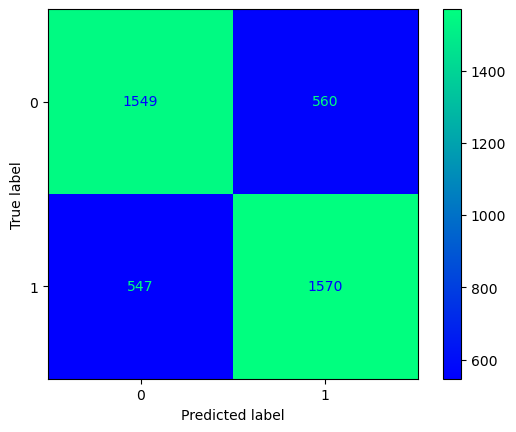

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.74      0.73      0.74      2109
           1       0.74      0.74      0.74      2117

    accuracy                           0.74      4226
   macro avg       0.74      0.74      0.74      4226
weighted avg       0.74      0.74      0.74      4226

-------------------------


In [70]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m1_10min.catboost_GridS()

In [71]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m1_10min,y_val_m1_10min)

Accuracy validación 0.7347595607724347


In [72]:
guardar_modelo(modelo_entrenado_15min,"m1_catboost_GridS_10min")

### Recopilación resultados

In [73]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "M1_catboost_GridS", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73


# 6.8. XGBoost

### Partidas 15 min

Hora de inicio:  23:31:46
Hora de fin:  23:31:49
-------------------------
Accuracy train 0.9853258021312525
Accuracy test 0.7873777363763391
-------------------------
-------------------------
Matriz de confusión


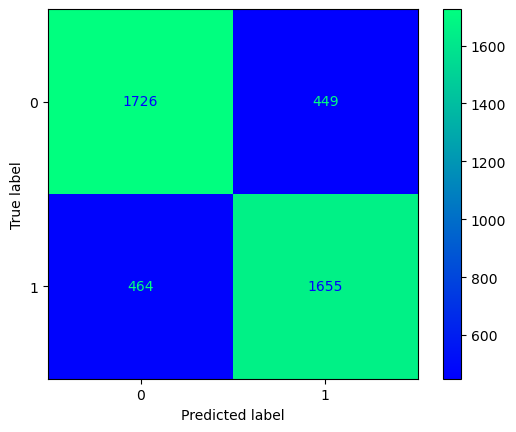

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.79      0.79      0.79      2175
           1       0.79      0.78      0.78      2119

    accuracy                           0.79      4294
   macro avg       0.79      0.79      0.79      4294
weighted avg       0.79      0.79      0.79      4294

-------------------------


In [74]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m1_15min.xgboost()

In [75]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m1_15min,y_val_m1_15min)

Accuracy validación 0.7870318613750699


In [76]:
guardar_modelo(modelo_entrenado_15min,"m1_xgboost_15min")

### Partidas 10 min

Hora de inicio:  23:31:49
Hora de fin:  23:31:51
-------------------------
Accuracy train 0.9539080527779421
Accuracy test 0.7160435399905348
-------------------------
-------------------------
Matriz de confusión


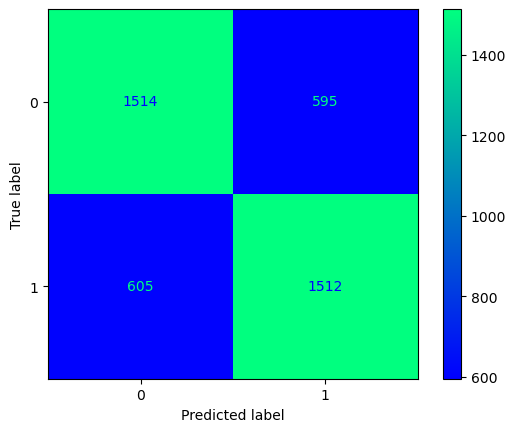

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.71      0.72      0.72      2109
           1       0.72      0.71      0.72      2117

    accuracy                           0.72      4226
   macro avg       0.72      0.72      0.72      4226
weighted avg       0.72      0.72      0.72      4226

-------------------------


In [77]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m1_10min.xgboost()

In [78]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m1_10min,y_val_m1_10min)

Accuracy validación 0.7167739492616433


In [79]:
guardar_modelo(modelo_entrenado_15min,"m1_xgboost_10min")

### Recopilación resultados

In [80]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "M1_xgboost", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72


# 6.9. XGBoost Optimizado

Este no

# 6.10. Lightgbm

### Partidas 15 min

Hora de inicio:  23:31:52
Hora de fin:  23:31:52
-------------------------
Accuracy train 0.9070634134979328
Accuracy test 0.7980903586399627
-------------------------
-------------------------
Matriz de confusión


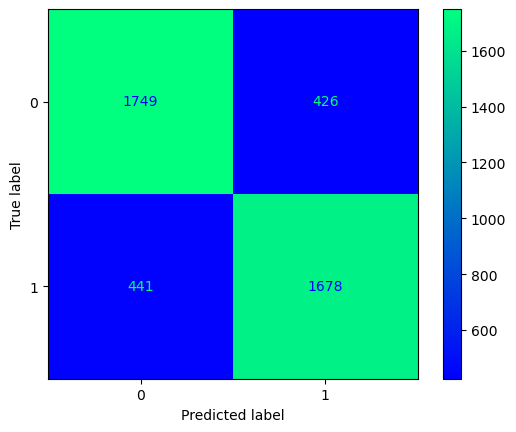

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.80      0.80      0.80      2175
           1       0.80      0.79      0.79      2119

    accuracy                           0.80      4294
   macro avg       0.80      0.80      0.80      4294
weighted avg       0.80      0.80      0.80      4294

-------------------------


In [81]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m1_15min.lightgbm()

In [82]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m1_15min,y_val_m1_15min)

Accuracy validación 0.8049189491335942


In [83]:
guardar_modelo(modelo_entrenado_15min,"m1_lightgbm_15min")

### Partidas 10 min

Hora de inicio:  23:31:52
Hora de fin:  23:31:53
-------------------------
Accuracy train 0.8639133779066327
Accuracy test 0.7333175579744439
-------------------------
-------------------------
Matriz de confusión


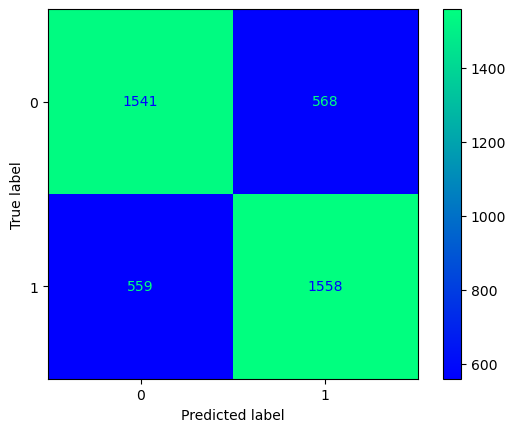

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.73      0.73      0.73      2109
           1       0.73      0.74      0.73      2117

    accuracy                           0.73      4226
   macro avg       0.73      0.73      0.73      4226
weighted avg       0.73      0.73      0.73      4226

-------------------------


In [84]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m1_10min.lightgbm()

In [85]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m1_10min,y_val_m1_10min)

Accuracy validación 0.7251041272245362


In [86]:
guardar_modelo(modelo_entrenado_15min,"m1_lightgbm_10min")

### Recopilación resultados

In [87]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "M1_lightgbm", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73


# 6.11. Lightgbm Optimizado

### Partidas 15 min

Hora de inicio:  23:31:53
Hora de fin:  23:37:20
-------------------------
Accuracy train 0.8201828451639201
Accuracy test 0.8095016301816488
-------------------------
-------------------------
Matriz de confusión


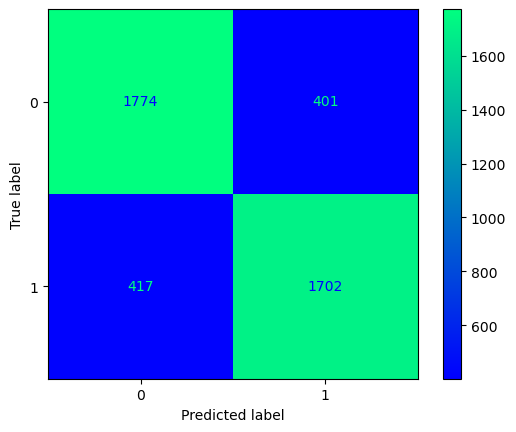

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.81      0.82      0.81      2175
           1       0.81      0.80      0.81      2119

    accuracy                           0.81      4294
   macro avg       0.81      0.81      0.81      4294
weighted avg       0.81      0.81      0.81      4294

-------------------------


In [88]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m1_15min.lightgbm_GridS()

In [89]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m1_15min,y_val_m1_15min)

Accuracy validación 0.8082727780883175


In [90]:
guardar_modelo(modelo_entrenado_15min,"m1_lightgbm_GridS_15min")

### Partidas 10 min

Hora de inicio:  23:37:20
Hora de fin:  23:41:54
-------------------------
Accuracy train 0.7787704869534348
Accuracy test 0.7404164694746805
-------------------------
-------------------------
Matriz de confusión


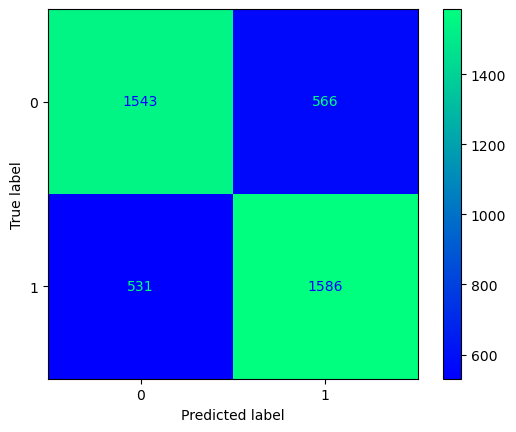

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.74      0.73      0.74      2109
           1       0.74      0.75      0.74      2117

    accuracy                           0.74      4226
   macro avg       0.74      0.74      0.74      4226
weighted avg       0.74      0.74      0.74      4226

-------------------------


In [91]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m1_10min.lightgbm_GridS()

In [92]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m1_10min,y_val_m1_10min)

Accuracy validación 0.7328663385081409


In [93]:
guardar_modelo(modelo_entrenado_15min,"m1_lightgbm_GridS_10min")

### Recopilación resultados

In [94]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "M1_lightgbm_GridS", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73


# 6.12. SVC

### Partidas 15 min

Hora de inicio:  23:41:54
Hora de fin:  23:42:22
-------------------------
Accuracy train 0.5005531939672742
Accuracy test 0.5065207265952492
-------------------------
-------------------------
Matriz de confusión


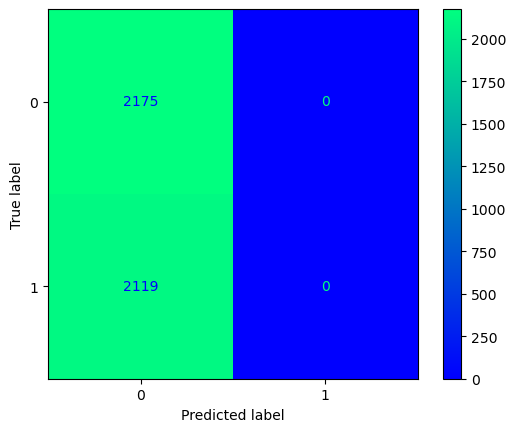

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.51      1.00      0.67      2175
           1       0.00      0.00      0.00      2119

    accuracy                           0.51      4294
   macro avg       0.25      0.50      0.34      4294
weighted avg       0.26      0.51      0.34      4294

-------------------------


In [95]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m1_15min.svc()

In [96]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m1_15min,y_val_m1_15min)

Accuracy validación 0.4920812371902366


In [97]:
guardar_modelo(modelo_entrenado_15min,"m1_svc_15min")

### Partidas 10 min

Hora de inicio:  23:43:14
Hora de fin:  23:43:39
-------------------------
Accuracy train 0.5021004674279629
Accuracy test 0.5009465215333648
-------------------------
-------------------------
Matriz de confusión


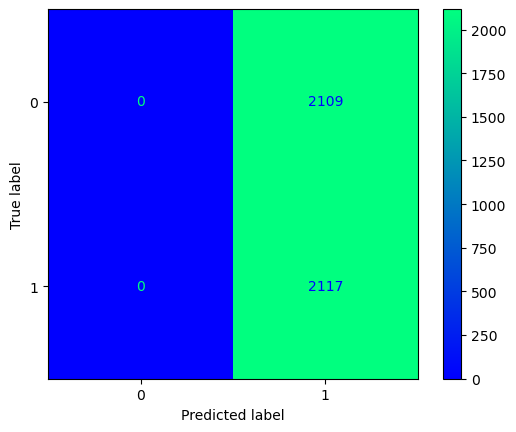

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.00      0.00      0.00      2109
           1       0.50      1.00      0.67      2117

    accuracy                           0.50      4226
   macro avg       0.25      0.50      0.33      4226
weighted avg       0.25      0.50      0.33      4226

-------------------------


In [98]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m1_10min.svc()

In [99]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m1_10min,y_val_m1_10min)

Accuracy validación 0.49810677773570616


In [100]:
guardar_modelo(modelo_entrenado_15min,"m1_svc_10min")

### Recopilación resultados

In [101]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "M1_svc", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 6.13. SVC Optimizado

### Partidas 15 min

Hora de inicio:  23:44:29
Hora de fin:  00:29:32
-------------------------
Accuracy train 1.0
Accuracy test 0.507918025151374
-------------------------
-------------------------
Matriz de confusión


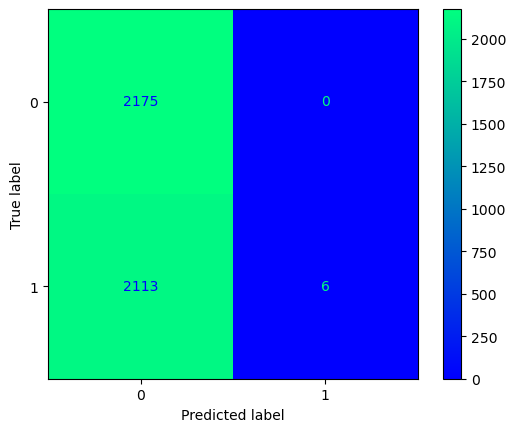

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.51      1.00      0.67      2175
           1       1.00      0.00      0.01      2119

    accuracy                           0.51      4294
   macro avg       0.75      0.50      0.34      4294
weighted avg       0.75      0.51      0.34      4294

-------------------------


In [102]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m1_15min.svc_GridS()

In [103]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m1_15min,y_val_m1_15min)

Accuracy validación 0.4941307993292342


In [104]:
guardar_modelo(modelo_entrenado_15min,"m1_svc_GridS_15min")

### Partidas 10 min

Hora de inicio:  00:30:41
Hora de fin:  01:18:21
-------------------------
Accuracy train 1.0
Accuracy test 0.5023663038334122
-------------------------
-------------------------
Matriz de confusión


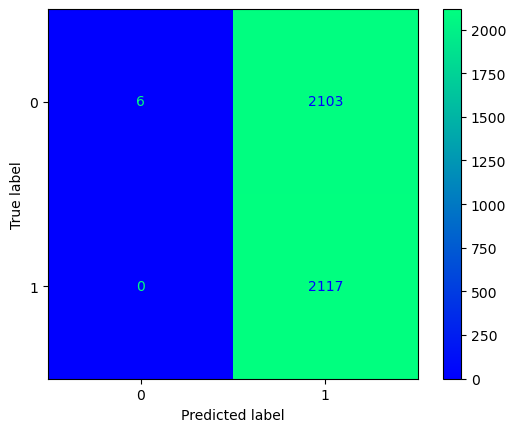

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       1.00      0.00      0.01      2109
           1       0.50      1.00      0.67      2117

    accuracy                           0.50      4226
   macro avg       0.75      0.50      0.34      4226
weighted avg       0.75      0.50      0.34      4226

-------------------------


In [105]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m1_10min.svc_GridS()

In [106]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m1_10min,y_val_m1_10min)

Accuracy validación 0.4992427110942825


In [107]:
guardar_modelo(modelo_entrenado_15min,"m1_svc_GridS_10min")

### Recopilación resultados

In [108]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "M1_svc_GridS", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 6.14. LinearSVC

### Partidas 15 min

Hora de inicio:  01:19:27
Hora de fin:  01:19:30
-------------------------
Accuracy train 0.5005531939672742
Accuracy test 0.5065207265952492
-------------------------
-------------------------
Matriz de confusión


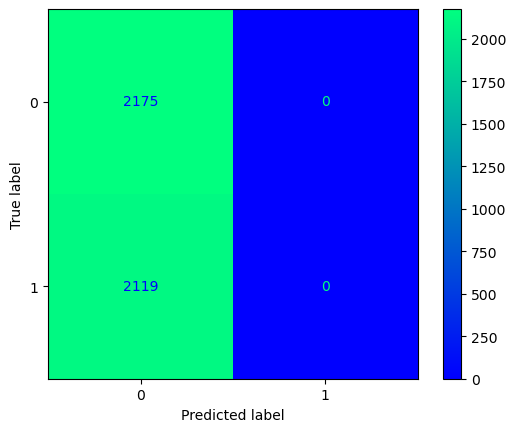

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.51      1.00      0.67      2175
           1       0.00      0.00      0.00      2119

    accuracy                           0.51      4294
   macro avg       0.25      0.50      0.34      4294
weighted avg       0.26      0.51      0.34      4294

-------------------------


In [109]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m1_15min.linearsvc()

In [110]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m1_15min,y_val_m1_15min)

Accuracy validación 0.4920812371902366


In [111]:
guardar_modelo(modelo_entrenado_15min,"m1_linearsvc_15min")

### Partidas 10 min

Hora de inicio:  01:19:30
Hora de fin:  01:19:33
-------------------------
Accuracy train 0.5021004674279629
Accuracy test 0.5009465215333648
-------------------------
-------------------------
Matriz de confusión


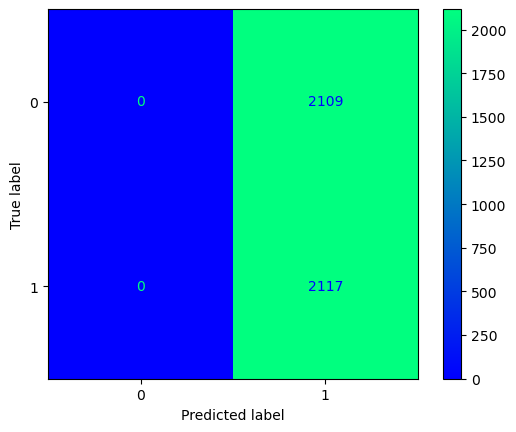

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.00      0.00      0.00      2109
           1       0.50      1.00      0.67      2117

    accuracy                           0.50      4226
   macro avg       0.25      0.50      0.33      4226
weighted avg       0.25      0.50      0.33      4226

-------------------------


In [112]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m1_10min.linearsvc()

In [113]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m1_10min,y_val_m1_10min)

Accuracy validación 0.49810677773570616


In [114]:
guardar_modelo(modelo_entrenado_15min,"m1_linearsvc_10min")

### Recopilación resultados

In [115]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "M1_linearsvc", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 6.15. LinearSVC Optimizado

### Partidas 15 min

Hora de inicio:  01:19:33
Hora de fin:  01:26:09
-------------------------
Accuracy train 0.5005531939672742
Accuracy test 0.5065207265952492
-------------------------
-------------------------
Matriz de confusión


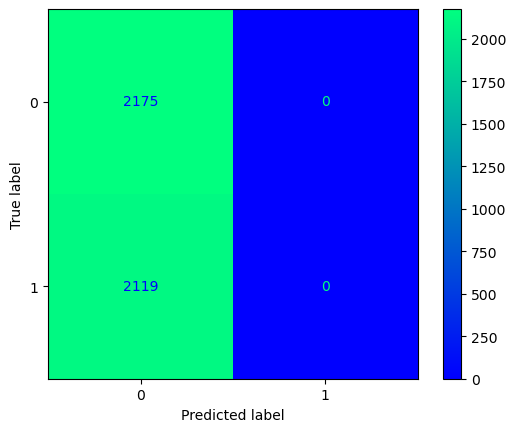

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.51      1.00      0.67      2175
           1       0.00      0.00      0.00      2119

    accuracy                           0.51      4294
   macro avg       0.25      0.50      0.34      4294
weighted avg       0.26      0.51      0.34      4294

-------------------------


In [116]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m1_15min.linearsvc_GridS()

In [117]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m1_15min,y_val_m1_15min)

Accuracy validación 0.4920812371902366


In [118]:
guardar_modelo(modelo_entrenado_15min,"m1_linearsvc_GridS_15min")

### Partidas 10 min

Hora de inicio:  01:26:10
Hora de fin:  01:32:10
-------------------------
Accuracy train 0.4978995325720372
Accuracy test 0.4990534784666351
-------------------------
-------------------------
Matriz de confusión


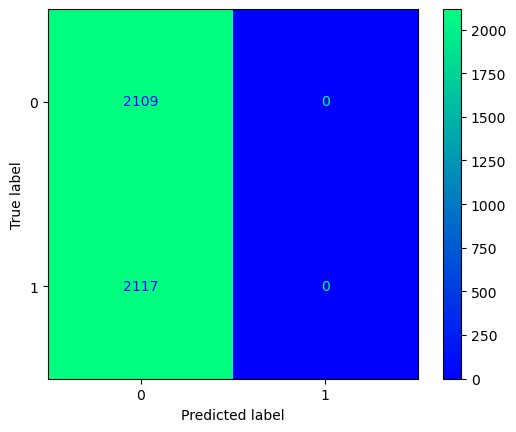

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.50      1.00      0.67      2109
           1       0.00      0.00      0.00      2117

    accuracy                           0.50      4226
   macro avg       0.25      0.50      0.33      4226
weighted avg       0.25      0.50      0.33      4226

-------------------------


In [119]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m1_10min.linearsvc_GridS()

In [120]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m1_10min,y_val_m1_10min)

Accuracy validación 0.5018932222642938


In [121]:
guardar_modelo(modelo_entrenado_15min,"m1_linearsvc_GridS_10min")

### Recopilación resultados

In [122]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "M1_linearsvc_GridS", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 7. Modelo 2
Este segundo modelo utiliza los datos originales sin escalar, pero eliminando ciertas columnas, como el ID de la partida o aquellas que están muy correlacionadas.

In [123]:
#Se hace una copia de los datos iniciales para aplicar este modelo
m2_15min=datos_entrenamiento_15min.copy()

#Columnas muy correlacionadas >0.75. Se utiliza la función get_positive_corr_coefficient definida en el apartado Funciones
lista = list(set(get_positive_corr_coefficient(datos_entrenamiento_15min, 0.75).level_1.values))

#Segunda lista con el target y el ID
lista2 = ['blueWins','gameId']

#Se concatenan ambas listas
lista = lista + lista2

#Se crean la X y la y
X_m2_15min = m2_15min.copy()

#Bucle para eliminar las columnas obtenidas antes
for k in range(0, len(lista)):
    X_m2_15min.drop([lista[k]], axis=1, inplace=True)
    
y_m2_15min = m2_15min[['blueWins']]

#Se realiza la división 
X_train_m2_15min, X_test_m2_15min, y_train_m2_15min, y_test_m2_15min = train_test_split(X_m2_15min, y_m2_15min, test_size=0.2, random_state=42)

In [124]:
#Se preparan los datos de validación
validacion_m2_15min=datos_validacion_15min.copy()

#Se crean la X y la y
X_val_m2_15min = validacion_m2_15min.copy()

#Bucle para eliminar las columnas obtenidas antes
#Al ser datos de validación, hay que aplicar lo mismo que en train, por tanto se eliminan las mismas columnas
for k in range(0, len(lista)):
    X_val_m2_15min.drop([lista[k]], axis=1, inplace=True)
    
y_val_m2_15min = validacion_m2_15min[['blueWins']]

In [125]:
#Se hace una copia de los datos iniciales para aplicar este modelo
m2_10min=datos_entrenamiento_10min.copy()

#Columnas muy correlacionadas >0.75. Se utiliza la función get_positive_corr_coefficient definida en el apartado Funciones
lista = list(set(get_positive_corr_coefficient(datos_entrenamiento_10min, 0.75).level_1.values))

#Segunda lista con el target y el ID
lista2 = ['blueWins','gameId']

#Se concatenan ambas listas
lista = lista + lista2

#Se crean la X y la y
X_m2_10min = m2_10min.copy()

#Bucle para eliminar las columnas obtenidas antes
for k in range(0, len(lista)):
    X_m2_10min.drop([lista[k]], axis=1, inplace=True)
    
y_m2_10min = m2_10min[['blueWins']]

#Se realiza la división 
X_train_m2_10min, X_test_m2_10min, y_train_m2_10min, y_test_m2_10min = train_test_split(X_m2_10min, y_m2_10min, test_size=0.2, random_state=42)

In [126]:
#Se preparan los datos de validación
validacion_m2_10min=datos_validacion_10min.copy()

#Se crean la X y la y
X_val_m2_10min = validacion_m2_10min.copy()

#Bucle para eliminar las columnas obtenidas antes
#Al ser datos de validación, hay que aplicar lo mismo que en train, por tanto se eliminan las mismas columnas
for k in range(0, len(lista)):
    X_val_m2_10min.drop([lista[k]], axis=1, inplace=True)
    
y_val_m2_10min = validacion_m2_10min[['blueWins']]

In [127]:
#Se crean los objetos
m2_15min = Models(X_train_m2_15min, X_test_m2_15min, y_train_m2_15min, y_test_m2_15min)
m2_10min = Models(X_train_m2_10min, X_test_m2_10min, y_train_m2_10min, y_test_m2_10min)

# 7.1. LazyClassifier

In [128]:
#LazyClassifier
m2_15min.lazyclassifier()

100%|██████████████████████████████████████████████████████████████████████████████████| 29/29 [01:42<00:00,  3.55s/it]


,Accuracy,Balanced Accuracy,ROC AUC,F1 Score,Time Taken
Model,,,,,
AdaBoostClassifier,0.80,0.80,0.80,0.80,1.00
LGBMClassifier,0.80,0.80,0.80,0.80,0.18
RandomForestClassifier,0.79,0.79,0.79,0.79,2.26
SVC,0.79,0.79,0.79,0.79,16.07
NuSVC,0.79,0.79,0.79,0.79,23.77
LogisticRegression,0.79,0.79,0.79,0.79,0.11
LinearSVC,0.79,0.78,0.78,0.79,2.48
CalibratedClassifierCV,0.79,0.78,0.78,0.79,9.13
XGBClassifier,0.78,0.78,0.78,0.78,0.83


In [129]:
#LazyClassifier
m2_10min.lazyclassifier()

100%|██████████████████████████████████████████████████████████████████████████████████| 29/29 [01:50<00:00,  3.81s/it]


,Accuracy,Balanced Accuracy,ROC AUC,F1 Score,Time Taken
Model,,,,,
LGBMClassifier,0.74,0.74,0.74,0.74,0.18
RandomForestClassifier,0.74,0.74,0.74,0.74,2.29
AdaBoostClassifier,0.74,0.74,0.74,0.74,0.92
CalibratedClassifierCV,0.73,0.73,0.73,0.73,9.45
LogisticRegression,0.73,0.73,0.73,0.73,0.14
RidgeClassifierCV,0.73,0.73,0.73,0.73,0.08
LinearSVC,0.73,0.73,0.73,0.73,2.62
LinearDiscriminantAnalysis,0.73,0.73,0.73,0.73,0.11
RidgeClassifier,0.73,0.73,0.73,0.73,0.06


# 7.2. Random Forest

### Partidas 15 min

Hora de inicio:  01:35:45
Hora de fin:  01:35:49
-------------------------
Accuracy train 1.0
Accuracy test 0.7885421518397764
-------------------------
-------------------------
Matriz de confusión


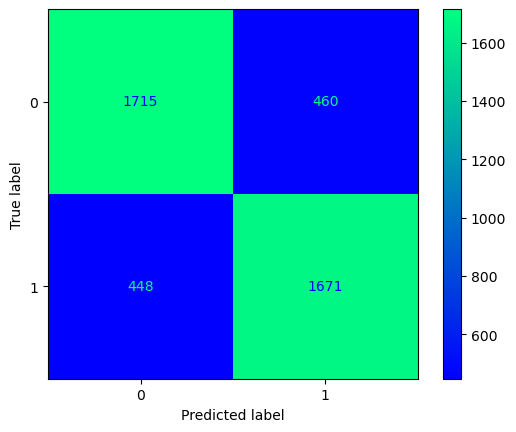

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.79      0.79      0.79      2175
           1       0.78      0.79      0.79      2119

    accuracy                           0.79      4294
   macro avg       0.79      0.79      0.79      4294
weighted avg       0.79      0.79      0.79      4294

-------------------------


In [130]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m2_15min.randomforest()

In [131]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m2_15min,y_val_m2_15min)

Accuracy validación 0.7982112912241476


In [132]:
guardar_modelo(modelo_entrenado_15min,"m2_randomforest_15min")

### Partidas 10 min

Hora de inicio:  01:35:50
Hora de fin:  01:35:55
-------------------------
Accuracy train 1.0
Accuracy test 0.7349739706578324
-------------------------
-------------------------
Matriz de confusión


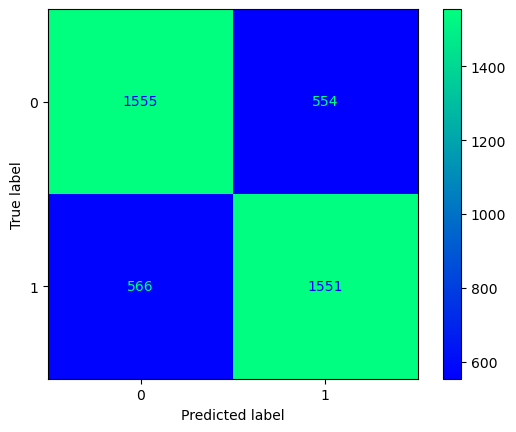

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.73      0.74      0.74      2109
           1       0.74      0.73      0.73      2117

    accuracy                           0.73      4226
   macro avg       0.73      0.73      0.73      4226
weighted avg       0.73      0.73      0.73      4226

-------------------------


In [133]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m2_10min.randomforest()

In [134]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m2_10min,y_val_m2_10min)

Accuracy validación 0.7279439606209769


In [135]:
guardar_modelo(modelo_entrenado_15min,"m2_randomforest_10min")

### Recopilación resultados

In [136]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m2_randomforest", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 7.3. Random Forest Optimizado

### Partidas 15 min

Hora de inicio:  01:35:56
Hora de fin:  02:04:43
-------------------------
Accuracy train 0.8043440284167006
Accuracy test 0.780391243595715
-------------------------
-------------------------
Matriz de confusión


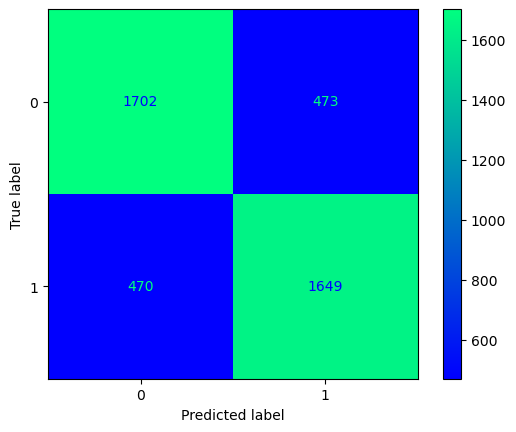

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.78      0.78      0.78      2175
           1       0.78      0.78      0.78      2119

    accuracy                           0.78      4294
   macro avg       0.78      0.78      0.78      4294
weighted avg       0.78      0.78      0.78      4294

-------------------------


In [137]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m2_15min.randomforest_GridS()

In [138]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m2_15min,y_val_m2_15min)

Accuracy validación 0.7972796720700578


In [139]:
guardar_modelo(modelo_entrenado_15min,"m2_randomforest_GridS_15min")

### Partidas 10 min

Hora de inicio:  02:04:44
Hora de fin:  02:32:21
-------------------------
Accuracy train 0.756286610259748
Accuracy test 0.7316611452910554
-------------------------
-------------------------
Matriz de confusión


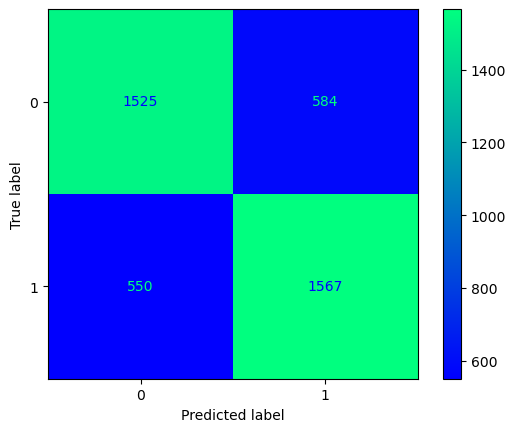

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.73      0.72      0.73      2109
           1       0.73      0.74      0.73      2117

    accuracy                           0.73      4226
   macro avg       0.73      0.73      0.73      4226
weighted avg       0.73      0.73      0.73      4226

-------------------------


In [140]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m2_10min.randomforest_GridS()

In [141]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m2_10min,y_val_m2_10min)

Accuracy validación 0.7287012495266945


In [142]:
guardar_modelo(modelo_entrenado_15min,"m2_randomforest_GridS_10min")

### Recopilación resultados

In [143]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m2_randomforest_GridS", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 7.4. Gradient boosting 

### Partidas 15 min

Hora de inicio:  02:32:22
Hora de fin:  02:32:28
-------------------------
Accuracy train 0.8154079077621849
Accuracy test 0.7943642291569633
-------------------------
-------------------------
Matriz de confusión


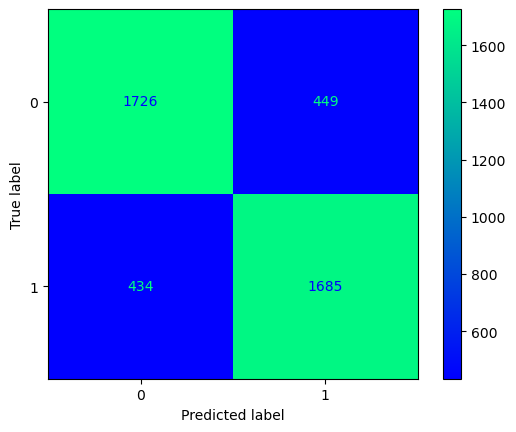

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.80      0.79      0.80      2175
           1       0.79      0.80      0.79      2119

    accuracy                           0.79      4294
   macro avg       0.79      0.79      0.79      4294
weighted avg       0.79      0.79      0.79      4294

-------------------------


In [144]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m2_15min.gradientboosting()

In [145]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m2_15min,y_val_m2_15min)

Accuracy validación 0.8021240916713248


In [146]:
guardar_modelo(modelo_entrenado_15min,"m2_gradientboosting_15min")

### Partidas 10 min

Hora de inicio:  02:32:29
Hora de fin:  02:32:35
-------------------------
Accuracy train 0.7613158984675463
Accuracy test 0.7389966871746332
-------------------------
-------------------------
Matriz de confusión


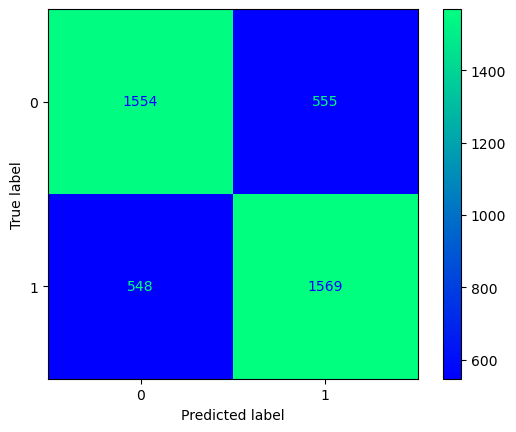

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.74      0.74      0.74      2109
           1       0.74      0.74      0.74      2117

    accuracy                           0.74      4226
   macro avg       0.74      0.74      0.74      4226
weighted avg       0.74      0.74      0.74      4226

-------------------------


In [147]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m2_10min.gradientboosting()

In [148]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m2_10min,y_val_m2_10min)

Accuracy validación 0.7315410829231351


In [149]:
guardar_modelo(modelo_entrenado_15min,"m2_gradientboosting_10min")

### Recopilación resultados

In [150]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m2_gradientboosting", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 7.5. Gradient boosting Optimizado

### Partidas 15 min

Hora de inicio:  02:32:35
Hora de fin:  02:50:40
-------------------------
Accuracy train 0.8084201944913527
Accuracy test 0.7945971122496507
-------------------------
-------------------------
Matriz de confusión


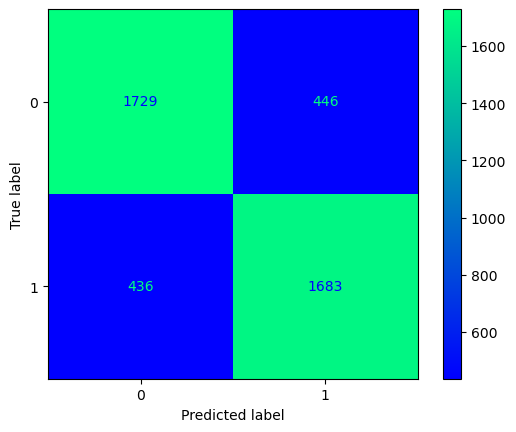

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.80      0.79      0.80      2175
           1       0.79      0.79      0.79      2119

    accuracy                           0.79      4294
   macro avg       0.79      0.79      0.79      4294
weighted avg       0.79      0.79      0.79      4294

-------------------------


In [151]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m2_15min.gradientboosting_GridS()

In [152]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m2_15min,y_val_m2_15min)

Accuracy validación 0.8011924725172349


In [153]:
guardar_modelo(modelo_entrenado_15min,"m2_gradientboosting_GridS_15min")

### Partidas 10 min

Hora de inicio:  02:50:40
Hora de fin:  03:07:28
-------------------------
Accuracy train 0.7551624164250637
Accuracy test 0.7373402744912447
-------------------------
-------------------------
Matriz de confusión


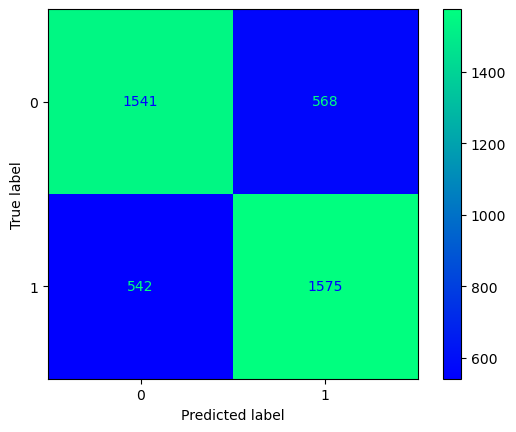

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.74      0.73      0.74      2109
           1       0.73      0.74      0.74      2117

    accuracy                           0.74      4226
   macro avg       0.74      0.74      0.74      4226
weighted avg       0.74      0.74      0.74      4226

-------------------------


In [154]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m2_10min.gradientboosting_GridS()

In [155]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m2_10min,y_val_m2_10min)

Accuracy validación 0.7268080272624006


In [156]:
guardar_modelo(modelo_entrenado_15min,"m2_gradientboosting_GridS_10min")

### Recopilación resultados

In [157]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m2_gradientboosting_GridS", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 7.6. Catboost

### Partidas 15 min

Hora de inicio:  03:07:28
Learning rate set to 0.151764
0:	learn: 0.6280478	total: 5.52ms	remaining: 1.1s
1:	learn: 0.5811880	total: 10.7ms	remaining: 1.06s
2:	learn: 0.5452961	total: 15.7ms	remaining: 1.03s
3:	learn: 0.5188547	total: 20.7ms	remaining: 1.01s
4:	learn: 0.4974394	total: 25.9ms	remaining: 1.01s
5:	learn: 0.4845805	total: 30.7ms	remaining: 991ms
6:	learn: 0.4749115	total: 36ms	remaining: 993ms
7:	learn: 0.4669581	total: 41.4ms	remaining: 994ms
8:	learn: 0.4597429	total: 46.5ms	remaining: 986ms
9:	learn: 0.4548147	total: 51.9ms	remaining: 986ms
10:	learn: 0.4507176	total: 57.1ms	remaining: 981ms
11:	learn: 0.4466177	total: 62.2ms	remaining: 975ms
12:	learn: 0.4435788	total: 67.5ms	remaining: 971ms
13:	learn: 0.4406219	total: 72.6ms	remaining: 964ms
14:	learn: 0.4389668	total: 77.8ms	remaining: 959ms
15:	learn: 0.4370834	total: 83.3ms	remaining: 958ms
16:	learn: 0.4358669	total: 89.6ms	remaining: 964ms
17:	learn: 0.4343010	total: 95.9ms	remaining: 970ms
18:	learn: 0.4326345	

170:	learn: 0.3534659	total: 881ms	remaining: 149ms
171:	learn: 0.3533961	total: 886ms	remaining: 144ms
172:	learn: 0.3528769	total: 891ms	remaining: 139ms
173:	learn: 0.3526458	total: 896ms	remaining: 134ms
174:	learn: 0.3520151	total: 901ms	remaining: 129ms
175:	learn: 0.3516275	total: 906ms	remaining: 124ms
176:	learn: 0.3510227	total: 911ms	remaining: 118ms
177:	learn: 0.3507018	total: 916ms	remaining: 113ms
178:	learn: 0.3502562	total: 921ms	remaining: 108ms
179:	learn: 0.3499458	total: 926ms	remaining: 103ms
180:	learn: 0.3495514	total: 931ms	remaining: 97.8ms
181:	learn: 0.3493448	total: 936ms	remaining: 92.6ms
182:	learn: 0.3490727	total: 941ms	remaining: 87.4ms
183:	learn: 0.3487500	total: 946ms	remaining: 82.3ms
184:	learn: 0.3484205	total: 951ms	remaining: 77.1ms
185:	learn: 0.3481655	total: 956ms	remaining: 72ms
186:	learn: 0.3478668	total: 961ms	remaining: 66.8ms
187:	learn: 0.3476417	total: 966ms	remaining: 61.6ms
188:	learn: 0.3476029	total: 970ms	remaining: 56.5ms
189:	

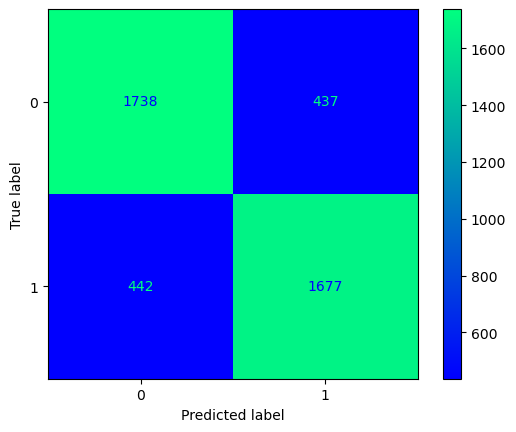

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.80      0.80      0.80      2175
           1       0.79      0.79      0.79      2119

    accuracy                           0.80      4294
   macro avg       0.80      0.80      0.80      4294
weighted avg       0.80      0.80      0.80      4294

-------------------------


In [158]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m2_15min.catboost()

In [159]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m2_15min,y_val_m2_15min)

Accuracy validación 0.7976523197316937


In [160]:
guardar_modelo(modelo_entrenado_15min,"m2_catboost_15min")

### Partidas 10 min

Hora de inicio:  03:07:29
Learning rate set to 0.150733
0:	learn: 0.6515417	total: 5.4ms	remaining: 1.07s
1:	learn: 0.6211600	total: 11.3ms	remaining: 1.11s
2:	learn: 0.5981348	total: 16.9ms	remaining: 1.11s
3:	learn: 0.5814208	total: 22.8ms	remaining: 1.11s
4:	learn: 0.5700351	total: 28.4ms	remaining: 1.11s
5:	learn: 0.5612233	total: 33.9ms	remaining: 1.1s
6:	learn: 0.5540599	total: 39.9ms	remaining: 1.1s
7:	learn: 0.5494562	total: 45.7ms	remaining: 1.09s
8:	learn: 0.5450298	total: 51.2ms	remaining: 1.09s
9:	learn: 0.5421207	total: 56.9ms	remaining: 1.08s
10:	learn: 0.5379909	total: 62.5ms	remaining: 1.07s
11:	learn: 0.5349434	total: 68.4ms	remaining: 1.07s
12:	learn: 0.5328604	total: 73.9ms	remaining: 1.06s
13:	learn: 0.5312753	total: 79.4ms	remaining: 1.05s
14:	learn: 0.5289388	total: 85ms	remaining: 1.05s
15:	learn: 0.5273856	total: 90.6ms	remaining: 1.04s
16:	learn: 0.5258589	total: 96.2ms	remaining: 1.03s
17:	learn: 0.5243418	total: 102ms	remaining: 1.03s
18:	learn: 0.5233372	tot

176:	learn: 0.4441117	total: 1s	remaining: 130ms
177:	learn: 0.4436871	total: 1.01s	remaining: 125ms
178:	learn: 0.4431720	total: 1.01s	remaining: 119ms
179:	learn: 0.4426345	total: 1.02s	remaining: 113ms
180:	learn: 0.4421865	total: 1.03s	remaining: 108ms
181:	learn: 0.4415904	total: 1.03s	remaining: 102ms
182:	learn: 0.4410504	total: 1.04s	remaining: 96.4ms
183:	learn: 0.4405852	total: 1.04s	remaining: 90.7ms
184:	learn: 0.4401967	total: 1.05s	remaining: 85.1ms
185:	learn: 0.4400096	total: 1.05s	remaining: 79.5ms
186:	learn: 0.4397077	total: 1.06s	remaining: 73.8ms
187:	learn: 0.4392933	total: 1.07s	remaining: 68.1ms
188:	learn: 0.4390404	total: 1.07s	remaining: 62.4ms
189:	learn: 0.4386259	total: 1.08s	remaining: 56.7ms
190:	learn: 0.4382386	total: 1.08s	remaining: 51ms
191:	learn: 0.4378141	total: 1.09s	remaining: 45.4ms
192:	learn: 0.4370669	total: 1.09s	remaining: 39.7ms
193:	learn: 0.4365167	total: 1.1s	remaining: 34ms
194:	learn: 0.4361497	total: 1.1s	remaining: 28.4ms
195:	lea

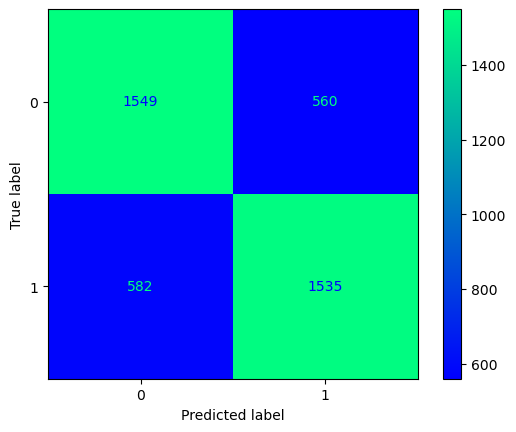

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.73      0.73      0.73      2109
           1       0.73      0.73      0.73      2117

    accuracy                           0.73      4226
   macro avg       0.73      0.73      0.73      4226
weighted avg       0.73      0.73      0.73      4226

-------------------------


In [161]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m2_10min.catboost()

In [162]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m2_10min,y_val_m2_10min)

Accuracy validación 0.7215070049223778


In [163]:
guardar_modelo(modelo_entrenado_15min,"m2_catboost_10min")

### Recopilación resultados

In [164]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m2_catboost", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 7.7. CatBoost Optimizado

### Partidas 15 min

Hora de inicio:  03:07:31
0:	learn: 0.6729135	test: 0.6719676	best: 0.6719676 (0)	total: 3.09ms	remaining: 306ms
1:	learn: 0.6564123	test: 0.6545196	best: 0.6545196 (1)	total: 6.13ms	remaining: 300ms
2:	learn: 0.6403817	test: 0.6377959	best: 0.6377959 (2)	total: 9.03ms	remaining: 292ms
3:	learn: 0.6262070	test: 0.6229564	best: 0.6229564 (3)	total: 11.9ms	remaining: 285ms
4:	learn: 0.6140539	test: 0.6101655	best: 0.6101655 (4)	total: 14.7ms	remaining: 280ms
5:	learn: 0.6037135	test: 0.5990991	best: 0.5990991 (5)	total: 17.5ms	remaining: 274ms
6:	learn: 0.5925952	test: 0.5874633	best: 0.5874633 (6)	total: 20.3ms	remaining: 270ms
7:	learn: 0.5826162	test: 0.5771491	best: 0.5771491 (7)	total: 23.2ms	remaining: 267ms
8:	learn: 0.5727664	test: 0.5672314	best: 0.5672314 (8)	total: 26.3ms	remaining: 266ms
9:	learn: 0.5635804	test: 0.5573817	best: 0.5573817 (9)	total: 29.4ms	remaining: 265ms
10:	learn: 0.5563519	test: 0.5499694	best: 0.5499694 (10)	total: 32.3ms	remaining: 261ms
11:	learn: 0.54

6:	learn: 0.5353008	test: 0.5269383	best: 0.5269383 (6)	total: 19.4ms	remaining: 258ms
7:	learn: 0.5256225	test: 0.5166190	best: 0.5166190 (7)	total: 22.6ms	remaining: 260ms
8:	learn: 0.5157635	test: 0.5058786	best: 0.5058786 (8)	total: 25.7ms	remaining: 259ms
9:	learn: 0.5090166	test: 0.4992426	best: 0.4992426 (9)	total: 28.2ms	remaining: 254ms
10:	learn: 0.5020953	test: 0.4915273	best: 0.4915273 (10)	total: 31.1ms	remaining: 251ms
11:	learn: 0.4954979	test: 0.4847222	best: 0.4847222 (11)	total: 34.1ms	remaining: 250ms
12:	learn: 0.4900399	test: 0.4789547	best: 0.4789547 (12)	total: 36.9ms	remaining: 247ms
13:	learn: 0.4867824	test: 0.4752858	best: 0.4752858 (13)	total: 40.6ms	remaining: 249ms
14:	learn: 0.4826549	test: 0.4708439	best: 0.4708439 (14)	total: 44.6ms	remaining: 253ms
15:	learn: 0.4792441	test: 0.4676198	best: 0.4676198 (15)	total: 47.9ms	remaining: 252ms
16:	learn: 0.4763511	test: 0.4642902	best: 0.4642902 (16)	total: 51.5ms	remaining: 251ms
17:	learn: 0.4734602	test: 0.

0:	learn: 0.6365810	test: 0.6338536	best: 0.6338536 (0)	total: 3.63ms	remaining: 360ms
1:	learn: 0.5971485	test: 0.5918519	best: 0.5918519 (1)	total: 6.67ms	remaining: 327ms
2:	learn: 0.5687056	test: 0.5619293	best: 0.5619293 (2)	total: 9.39ms	remaining: 304ms
3:	learn: 0.5468390	test: 0.5400501	best: 0.5400501 (3)	total: 12.3ms	remaining: 295ms
4:	learn: 0.5303741	test: 0.5229208	best: 0.5229208 (4)	total: 15ms	remaining: 284ms
5:	learn: 0.5156032	test: 0.5072018	best: 0.5072018 (5)	total: 17.9ms	remaining: 281ms
6:	learn: 0.5059232	test: 0.4973047	best: 0.4973047 (6)	total: 20.6ms	remaining: 274ms
7:	learn: 0.4961572	test: 0.4867334	best: 0.4867334 (7)	total: 23.3ms	remaining: 267ms
8:	learn: 0.4898102	test: 0.4792078	best: 0.4792078 (8)	total: 25.9ms	remaining: 262ms
9:	learn: 0.4834347	test: 0.4718343	best: 0.4718343 (9)	total: 29.1ms	remaining: 262ms
10:	learn: 0.4778927	test: 0.4661573	best: 0.4661573 (10)	total: 31.9ms	remaining: 258ms
11:	learn: 0.4730618	test: 0.4608464	best: 

22:	learn: 0.4428273	test: 0.4241457	best: 0.4241457 (22)	total: 63.9ms	remaining: 214ms
23:	learn: 0.4419354	test: 0.4232176	best: 0.4232176 (23)	total: 66.9ms	remaining: 212ms
24:	learn: 0.4412087	test: 0.4224799	best: 0.4224799 (24)	total: 69.6ms	remaining: 209ms
25:	learn: 0.4403891	test: 0.4216837	best: 0.4216837 (25)	total: 72.2ms	remaining: 206ms
26:	learn: 0.4397995	test: 0.4209863	best: 0.4209863 (26)	total: 74.9ms	remaining: 203ms
27:	learn: 0.4383660	test: 0.4197655	best: 0.4197655 (27)	total: 77.9ms	remaining: 200ms
28:	learn: 0.4378867	test: 0.4196571	best: 0.4196571 (28)	total: 80.5ms	remaining: 197ms
29:	learn: 0.4373662	test: 0.4193924	best: 0.4193924 (29)	total: 82.9ms	remaining: 194ms
30:	learn: 0.4367214	test: 0.4188886	best: 0.4188886 (30)	total: 85.5ms	remaining: 190ms
31:	learn: 0.4363143	test: 0.4185390	best: 0.4185390 (31)	total: 88.1ms	remaining: 187ms
32:	learn: 0.4357468	test: 0.4182305	best: 0.4182305 (32)	total: 91ms	remaining: 185ms
33:	learn: 0.4352353	te

17:	learn: 0.4341410	test: 0.4163687	best: 0.4162202 (16)	total: 49.6ms	remaining: 226ms
18:	learn: 0.4337469	test: 0.4161071	best: 0.4161071 (18)	total: 52.9ms	remaining: 225ms
19:	learn: 0.4327431	test: 0.4163447	best: 0.4161071 (18)	total: 55.8ms	remaining: 223ms
20:	learn: 0.4319986	test: 0.4156930	best: 0.4156930 (20)	total: 58.4ms	remaining: 220ms
21:	learn: 0.4309923	test: 0.4155882	best: 0.4155882 (21)	total: 61.3ms	remaining: 217ms
22:	learn: 0.4298044	test: 0.4151146	best: 0.4151146 (22)	total: 64ms	remaining: 214ms
23:	learn: 0.4288641	test: 0.4146923	best: 0.4146923 (23)	total: 66.4ms	remaining: 210ms
24:	learn: 0.4281436	test: 0.4147984	best: 0.4146923 (23)	total: 69ms	remaining: 207ms
25:	learn: 0.4273443	test: 0.4143148	best: 0.4143148 (25)	total: 71.5ms	remaining: 204ms
26:	learn: 0.4264270	test: 0.4148869	best: 0.4143148 (25)	total: 74.1ms	remaining: 200ms
27:	learn: 0.4256627	test: 0.4136615	best: 0.4136615 (27)	total: 77ms	remaining: 198ms
28:	learn: 0.4250047	test: 

46:	learn: 0.4616431	test: 0.4482256	best: 0.4482256 (46)	total: 132ms	remaining: 149ms
47:	learn: 0.4607992	test: 0.4473849	best: 0.4473849 (47)	total: 135ms	remaining: 146ms
48:	learn: 0.4601237	test: 0.4465269	best: 0.4465269 (48)	total: 138ms	remaining: 144ms
49:	learn: 0.4593777	test: 0.4457843	best: 0.4457843 (49)	total: 141ms	remaining: 141ms
50:	learn: 0.4585194	test: 0.4446813	best: 0.4446813 (50)	total: 143ms	remaining: 137ms
51:	learn: 0.4580235	test: 0.4443837	best: 0.4443837 (51)	total: 146ms	remaining: 135ms
52:	learn: 0.4574266	test: 0.4436303	best: 0.4436303 (52)	total: 149ms	remaining: 132ms
53:	learn: 0.4568637	test: 0.4428779	best: 0.4428779 (53)	total: 151ms	remaining: 129ms
54:	learn: 0.4562173	test: 0.4423166	best: 0.4423166 (54)	total: 154ms	remaining: 126ms
55:	learn: 0.4557321	test: 0.4420408	best: 0.4420408 (55)	total: 157ms	remaining: 123ms
56:	learn: 0.4550152	test: 0.4410682	best: 0.4410682 (56)	total: 160ms	remaining: 121ms
57:	learn: 0.4543757	test: 0.440

38:	learn: 0.4464320	test: 0.4310203	best: 0.4310203 (38)	total: 108ms	remaining: 169ms
39:	learn: 0.4455892	test: 0.4301108	best: 0.4301108 (39)	total: 112ms	remaining: 168ms
40:	learn: 0.4449690	test: 0.4295732	best: 0.4295732 (40)	total: 115ms	remaining: 166ms
41:	learn: 0.4444957	test: 0.4289870	best: 0.4289870 (41)	total: 118ms	remaining: 163ms
42:	learn: 0.4439862	test: 0.4282738	best: 0.4282738 (42)	total: 121ms	remaining: 160ms
43:	learn: 0.4436976	test: 0.4280564	best: 0.4280564 (43)	total: 125ms	remaining: 159ms
44:	learn: 0.4429835	test: 0.4271141	best: 0.4271141 (44)	total: 128ms	remaining: 156ms
45:	learn: 0.4425095	test: 0.4266517	best: 0.4266517 (45)	total: 130ms	remaining: 153ms
46:	learn: 0.4420636	test: 0.4258744	best: 0.4258744 (46)	total: 133ms	remaining: 150ms
47:	learn: 0.4416840	test: 0.4254574	best: 0.4254574 (47)	total: 136ms	remaining: 147ms
48:	learn: 0.4412419	test: 0.4249709	best: 0.4249709 (48)	total: 138ms	remaining: 144ms
49:	learn: 0.4408582	test: 0.424

61:	learn: 0.4290273	test: 0.4149335	best: 0.4149335 (61)	total: 172ms	remaining: 106ms
62:	learn: 0.4287089	test: 0.4146906	best: 0.4146906 (62)	total: 176ms	remaining: 103ms
63:	learn: 0.4284176	test: 0.4145587	best: 0.4145587 (63)	total: 178ms	remaining: 100ms
64:	learn: 0.4281652	test: 0.4145540	best: 0.4145540 (64)	total: 181ms	remaining: 97.3ms
65:	learn: 0.4275949	test: 0.4138772	best: 0.4138772 (65)	total: 184ms	remaining: 94.6ms
66:	learn: 0.4272126	test: 0.4136769	best: 0.4136769 (66)	total: 186ms	remaining: 91.7ms
67:	learn: 0.4268920	test: 0.4132233	best: 0.4132233 (67)	total: 189ms	remaining: 88.9ms
68:	learn: 0.4267026	test: 0.4131782	best: 0.4131782 (68)	total: 192ms	remaining: 86.1ms
69:	learn: 0.4262932	test: 0.4129340	best: 0.4129340 (69)	total: 195ms	remaining: 83.5ms
70:	learn: 0.4259599	test: 0.4127255	best: 0.4127255 (70)	total: 198ms	remaining: 80.7ms
71:	learn: 0.4256365	test: 0.4123234	best: 0.4123234 (71)	total: 200ms	remaining: 77.8ms
72:	learn: 0.4251057	tes

53:	learn: 0.4270387	test: 0.4104438	best: 0.4104438 (53)	total: 159ms	remaining: 135ms
54:	learn: 0.4267031	test: 0.4104364	best: 0.4104364 (54)	total: 162ms	remaining: 133ms
55:	learn: 0.4262730	test: 0.4102083	best: 0.4102083 (55)	total: 165ms	remaining: 130ms
56:	learn: 0.4260144	test: 0.4099839	best: 0.4099839 (56)	total: 168ms	remaining: 126ms
57:	learn: 0.4257155	test: 0.4101944	best: 0.4099839 (56)	total: 170ms	remaining: 123ms
58:	learn: 0.4253348	test: 0.4098711	best: 0.4098711 (58)	total: 173ms	remaining: 120ms
59:	learn: 0.4249311	test: 0.4094148	best: 0.4094148 (59)	total: 176ms	remaining: 117ms
60:	learn: 0.4245816	test: 0.4093801	best: 0.4093801 (60)	total: 178ms	remaining: 114ms
61:	learn: 0.4242016	test: 0.4091958	best: 0.4091958 (61)	total: 181ms	remaining: 111ms
62:	learn: 0.4238798	test: 0.4089797	best: 0.4089797 (62)	total: 184ms	remaining: 108ms
63:	learn: 0.4232156	test: 0.4086871	best: 0.4086871 (63)	total: 187ms	remaining: 105ms
64:	learn: 0.4228829	test: 0.408

78:	learn: 0.3969757	test: 0.4300132	best: 0.4136615 (27)	total: 211ms	remaining: 56.2ms
79:	learn: 0.3964875	test: 0.4302454	best: 0.4136615 (27)	total: 214ms	remaining: 53.6ms
80:	learn: 0.3959774	test: 0.4298980	best: 0.4136615 (27)	total: 217ms	remaining: 50.9ms
81:	learn: 0.3954941	test: 0.4305158	best: 0.4136615 (27)	total: 220ms	remaining: 48.2ms
82:	learn: 0.3950848	test: 0.4347006	best: 0.4136615 (27)	total: 223ms	remaining: 45.6ms
83:	learn: 0.3947333	test: 0.4358001	best: 0.4136615 (27)	total: 226ms	remaining: 43ms
84:	learn: 0.3944580	test: 0.4357977	best: 0.4136615 (27)	total: 228ms	remaining: 40.2ms
85:	learn: 0.3940851	test: 0.4353062	best: 0.4136615 (27)	total: 231ms	remaining: 37.5ms
86:	learn: 0.3935366	test: 0.4353343	best: 0.4136615 (27)	total: 234ms	remaining: 34.9ms
87:	learn: 0.3930386	test: 0.4352602	best: 0.4136615 (27)	total: 236ms	remaining: 32.2ms
88:	learn: 0.3923784	test: 0.4349770	best: 0.4136615 (27)	total: 239ms	remaining: 29.5ms
89:	learn: 0.3919850	te

71:	learn: 0.4481681	test: 0.4331019	best: 0.4331019 (71)	total: 204ms	remaining: 79.5ms
72:	learn: 0.4478791	test: 0.4326839	best: 0.4326839 (72)	total: 207ms	remaining: 76.7ms
73:	learn: 0.4476877	test: 0.4324584	best: 0.4324584 (73)	total: 210ms	remaining: 73.8ms
74:	learn: 0.4473296	test: 0.4320135	best: 0.4320135 (74)	total: 213ms	remaining: 71.1ms
75:	learn: 0.4470306	test: 0.4317247	best: 0.4317247 (75)	total: 216ms	remaining: 68.3ms
76:	learn: 0.4467429	test: 0.4314953	best: 0.4314953 (76)	total: 219ms	remaining: 65.4ms
77:	learn: 0.4463780	test: 0.4310526	best: 0.4310526 (77)	total: 221ms	remaining: 62.5ms
78:	learn: 0.4461148	test: 0.4307788	best: 0.4307788 (78)	total: 224ms	remaining: 59.6ms
79:	learn: 0.4458001	test: 0.4303800	best: 0.4303800 (79)	total: 227ms	remaining: 56.7ms
80:	learn: 0.4452924	test: 0.4297617	best: 0.4297617 (80)	total: 229ms	remaining: 53.8ms
81:	learn: 0.4449553	test: 0.4295076	best: 0.4295076 (81)	total: 232ms	remaining: 50.9ms
82:	learn: 0.4446008	

95:	learn: 0.4278343	test: 0.4137941	best: 0.4137941 (95)	total: 265ms	remaining: 11ms
96:	learn: 0.4275394	test: 0.4136746	best: 0.4136746 (96)	total: 268ms	remaining: 8.3ms
97:	learn: 0.4272443	test: 0.4134732	best: 0.4134732 (97)	total: 271ms	remaining: 5.54ms
98:	learn: 0.4270209	test: 0.4133018	best: 0.4133018 (98)	total: 274ms	remaining: 2.77ms
99:	learn: 0.4266731	test: 0.4128701	best: 0.4128701 (99)	total: 276ms	remaining: 0us

bestTest = 0.4128701087
bestIteration = 99

11:	loss: 0.4128701	best: 0.4067612 (3)	total: 3.42s	remaining: 35.1s
0:	learn: 0.6365810	test: 0.6338536	best: 0.6338536 (0)	total: 2.8ms	remaining: 277ms
1:	learn: 0.5971485	test: 0.5918519	best: 0.5918519 (1)	total: 5.6ms	remaining: 274ms
2:	learn: 0.5687056	test: 0.5619293	best: 0.5619293 (2)	total: 8.32ms	remaining: 269ms
3:	learn: 0.5468390	test: 0.5400501	best: 0.5400501 (3)	total: 11.2ms	remaining: 269ms
4:	learn: 0.5303741	test: 0.5229208	best: 0.5229208 (4)	total: 13.9ms	remaining: 265ms
5:	learn: 0.5

90:	learn: 0.4197287	test: 0.4095092	best: 0.4095092 (90)	total: 252ms	remaining: 24.9ms
91:	learn: 0.4194003	test: 0.4095604	best: 0.4095092 (90)	total: 255ms	remaining: 22.2ms
92:	learn: 0.4192416	test: 0.4094814	best: 0.4094814 (92)	total: 257ms	remaining: 19.4ms
93:	learn: 0.4189288	test: 0.4094880	best: 0.4094814 (92)	total: 260ms	remaining: 16.6ms
94:	learn: 0.4187604	test: 0.4094356	best: 0.4094356 (94)	total: 262ms	remaining: 13.8ms
95:	learn: 0.4184659	test: 0.4098436	best: 0.4094356 (94)	total: 265ms	remaining: 11.1ms
96:	learn: 0.4182310	test: 0.4098027	best: 0.4094356 (94)	total: 268ms	remaining: 8.29ms
97:	learn: 0.4180529	test: 0.4097338	best: 0.4094356 (94)	total: 271ms	remaining: 5.52ms
98:	learn: 0.4178435	test: 0.4098306	best: 0.4094356 (94)	total: 273ms	remaining: 2.76ms
99:	learn: 0.4175488	test: 0.4097816	best: 0.4094356 (94)	total: 276ms	remaining: 0us

bestTest = 0.4094355908
bestIteration = 94

12:	loss: 0.4094356	best: 0.4067612 (3)	total: 3.71s	remaining: 34.8

13:	learn: 0.4380237	test: 0.4192501	best: 0.4192501 (13)	total: 37.9ms	remaining: 233ms
14:	learn: 0.4363178	test: 0.4169604	best: 0.4169604 (14)	total: 41.2ms	remaining: 234ms
15:	learn: 0.4357851	test: 0.4166971	best: 0.4166971 (15)	total: 43.8ms	remaining: 230ms
16:	learn: 0.4346648	test: 0.4162202	best: 0.4162202 (16)	total: 46.5ms	remaining: 227ms
17:	learn: 0.4341410	test: 0.4163687	best: 0.4162202 (16)	total: 49.2ms	remaining: 224ms
18:	learn: 0.4337469	test: 0.4161071	best: 0.4161071 (18)	total: 52.2ms	remaining: 223ms
19:	learn: 0.4327431	test: 0.4163447	best: 0.4161071 (18)	total: 55.1ms	remaining: 221ms
20:	learn: 0.4319986	test: 0.4156930	best: 0.4156930 (20)	total: 57.7ms	remaining: 217ms
21:	learn: 0.4309923	test: 0.4155882	best: 0.4155882 (21)	total: 60.6ms	remaining: 215ms
22:	learn: 0.4298044	test: 0.4151146	best: 0.4151146 (22)	total: 63.2ms	remaining: 212ms
23:	learn: 0.4288641	test: 0.4146923	best: 0.4146923 (23)	total: 65.5ms	remaining: 208ms
24:	learn: 0.4281436	

58:	learn: 0.4536723	test: 0.4396102	best: 0.4396102 (58)	total: 168ms	remaining: 258ms
59:	learn: 0.4532104	test: 0.4391187	best: 0.4391187 (59)	total: 171ms	remaining: 256ms
60:	learn: 0.4528168	test: 0.4385539	best: 0.4385539 (60)	total: 174ms	remaining: 254ms
61:	learn: 0.4523851	test: 0.4380123	best: 0.4380123 (61)	total: 176ms	remaining: 250ms
62:	learn: 0.4519548	test: 0.4374053	best: 0.4374053 (62)	total: 180ms	remaining: 248ms
63:	learn: 0.4515498	test: 0.4370421	best: 0.4370421 (63)	total: 182ms	remaining: 245ms
64:	learn: 0.4511658	test: 0.4366124	best: 0.4366124 (64)	total: 185ms	remaining: 242ms
65:	learn: 0.4506684	test: 0.4360076	best: 0.4360076 (65)	total: 188ms	remaining: 239ms
66:	learn: 0.4503263	test: 0.4355052	best: 0.4355052 (66)	total: 190ms	remaining: 236ms
67:	learn: 0.4498965	test: 0.4350886	best: 0.4350886 (67)	total: 193ms	remaining: 233ms
68:	learn: 0.4493236	test: 0.4343854	best: 0.4343854 (68)	total: 196ms	remaining: 230ms
69:	learn: 0.4489560	test: 0.434

55:	learn: 0.4379341	test: 0.4216733	best: 0.4216733 (55)	total: 154ms	remaining: 259ms
56:	learn: 0.4374847	test: 0.4214212	best: 0.4214212 (56)	total: 157ms	remaining: 257ms
57:	learn: 0.4369524	test: 0.4208273	best: 0.4208273 (57)	total: 160ms	remaining: 254ms
58:	learn: 0.4366335	test: 0.4205346	best: 0.4205346 (58)	total: 163ms	remaining: 251ms
59:	learn: 0.4364208	test: 0.4202055	best: 0.4202055 (59)	total: 165ms	remaining: 248ms
60:	learn: 0.4361199	test: 0.4197987	best: 0.4197987 (60)	total: 168ms	remaining: 245ms
61:	learn: 0.4356083	test: 0.4193714	best: 0.4193714 (61)	total: 171ms	remaining: 242ms
62:	learn: 0.4353712	test: 0.4192251	best: 0.4192251 (62)	total: 173ms	remaining: 239ms
63:	learn: 0.4351724	test: 0.4190073	best: 0.4190073 (63)	total: 176ms	remaining: 236ms
64:	learn: 0.4349024	test: 0.4188035	best: 0.4188035 (64)	total: 179ms	remaining: 234ms
65:	learn: 0.4344960	test: 0.4183784	best: 0.4183784 (65)	total: 183ms	remaining: 233ms
66:	learn: 0.4342432	test: 0.418

54:	learn: 0.4307932	test: 0.4166791	best: 0.4166791 (54)	total: 153ms	remaining: 264ms
55:	learn: 0.4305791	test: 0.4165616	best: 0.4165616 (55)	total: 156ms	remaining: 262ms
56:	learn: 0.4302522	test: 0.4162670	best: 0.4162670 (56)	total: 159ms	remaining: 259ms
57:	learn: 0.4300997	test: 0.4160398	best: 0.4160398 (57)	total: 162ms	remaining: 256ms
58:	learn: 0.4298586	test: 0.4158055	best: 0.4158055 (58)	total: 164ms	remaining: 253ms
59:	learn: 0.4294873	test: 0.4153020	best: 0.4153020 (59)	total: 167ms	remaining: 250ms
60:	learn: 0.4292300	test: 0.4150555	best: 0.4150555 (60)	total: 169ms	remaining: 247ms
61:	learn: 0.4290273	test: 0.4149335	best: 0.4149335 (61)	total: 172ms	remaining: 244ms
62:	learn: 0.4287089	test: 0.4146906	best: 0.4146906 (62)	total: 175ms	remaining: 241ms
63:	learn: 0.4284176	test: 0.4145587	best: 0.4145587 (63)	total: 177ms	remaining: 238ms
64:	learn: 0.4281652	test: 0.4145540	best: 0.4145540 (64)	total: 180ms	remaining: 235ms
65:	learn: 0.4275949	test: 0.413

58:	learn: 0.4253348	test: 0.4098711	best: 0.4098711 (58)	total: 160ms	remaining: 247ms
59:	learn: 0.4249311	test: 0.4094148	best: 0.4094148 (59)	total: 164ms	remaining: 245ms
60:	learn: 0.4245816	test: 0.4093801	best: 0.4093801 (60)	total: 166ms	remaining: 242ms
61:	learn: 0.4242016	test: 0.4091958	best: 0.4091958 (61)	total: 169ms	remaining: 239ms
62:	learn: 0.4238798	test: 0.4089797	best: 0.4089797 (62)	total: 171ms	remaining: 237ms
63:	learn: 0.4232156	test: 0.4086871	best: 0.4086871 (63)	total: 174ms	remaining: 234ms
64:	learn: 0.4228829	test: 0.4086412	best: 0.4086412 (64)	total: 177ms	remaining: 232ms
65:	learn: 0.4226017	test: 0.4083871	best: 0.4083871 (65)	total: 180ms	remaining: 229ms
66:	learn: 0.4222639	test: 0.4078438	best: 0.4078438 (66)	total: 182ms	remaining: 226ms
67:	learn: 0.4218566	test: 0.4082130	best: 0.4078438 (66)	total: 185ms	remaining: 224ms
68:	learn: 0.4215292	test: 0.4080834	best: 0.4078438 (66)	total: 188ms	remaining: 221ms
69:	learn: 0.4212675	test: 0.408

56:	learn: 0.4082860	test: 0.4234660	best: 0.4136615 (27)	total: 154ms	remaining: 251ms
57:	learn: 0.4077433	test: 0.4241377	best: 0.4136615 (27)	total: 157ms	remaining: 249ms
58:	learn: 0.4072957	test: 0.4243294	best: 0.4136615 (27)	total: 160ms	remaining: 246ms
59:	learn: 0.4067801	test: 0.4240149	best: 0.4136615 (27)	total: 162ms	remaining: 243ms
60:	learn: 0.4060323	test: 0.4248204	best: 0.4136615 (27)	total: 165ms	remaining: 241ms
61:	learn: 0.4054969	test: 0.4244224	best: 0.4136615 (27)	total: 168ms	remaining: 239ms
62:	learn: 0.4051240	test: 0.4249406	best: 0.4136615 (27)	total: 171ms	remaining: 236ms
63:	learn: 0.4046248	test: 0.4251561	best: 0.4136615 (27)	total: 173ms	remaining: 233ms
64:	learn: 0.4040047	test: 0.4256633	best: 0.4136615 (27)	total: 176ms	remaining: 230ms
65:	learn: 0.4033110	test: 0.4256002	best: 0.4136615 (27)	total: 178ms	remaining: 227ms
66:	learn: 0.4025934	test: 0.4257076	best: 0.4136615 (27)	total: 181ms	remaining: 224ms
67:	learn: 0.4021256	test: 0.425

54:	learn: 0.4562173	test: 0.4423166	best: 0.4423166 (54)	total: 154ms	remaining: 266ms
55:	learn: 0.4557321	test: 0.4420408	best: 0.4420408 (55)	total: 157ms	remaining: 264ms
56:	learn: 0.4550152	test: 0.4410682	best: 0.4410682 (56)	total: 160ms	remaining: 262ms
57:	learn: 0.4543757	test: 0.4403556	best: 0.4403556 (57)	total: 163ms	remaining: 259ms
58:	learn: 0.4536723	test: 0.4396102	best: 0.4396102 (58)	total: 166ms	remaining: 257ms
59:	learn: 0.4532104	test: 0.4391187	best: 0.4391187 (59)	total: 169ms	remaining: 253ms
60:	learn: 0.4528168	test: 0.4385539	best: 0.4385539 (60)	total: 172ms	remaining: 251ms
61:	learn: 0.4523851	test: 0.4380123	best: 0.4380123 (61)	total: 175ms	remaining: 248ms
62:	learn: 0.4519548	test: 0.4374053	best: 0.4374053 (62)	total: 178ms	remaining: 245ms
63:	learn: 0.4515498	test: 0.4370421	best: 0.4370421 (63)	total: 180ms	remaining: 242ms
64:	learn: 0.4511658	test: 0.4366124	best: 0.4366124 (64)	total: 183ms	remaining: 239ms
65:	learn: 0.4506684	test: 0.436

51:	learn: 0.4395783	test: 0.4229645	best: 0.4229645 (51)	total: 142ms	remaining: 268ms
52:	learn: 0.4392265	test: 0.4230981	best: 0.4229645 (51)	total: 146ms	remaining: 267ms
53:	learn: 0.4386338	test: 0.4224072	best: 0.4224072 (53)	total: 149ms	remaining: 265ms
54:	learn: 0.4381689	test: 0.4220179	best: 0.4220179 (54)	total: 152ms	remaining: 262ms
55:	learn: 0.4379341	test: 0.4216733	best: 0.4216733 (55)	total: 154ms	remaining: 259ms
56:	learn: 0.4374847	test: 0.4214212	best: 0.4214212 (56)	total: 157ms	remaining: 257ms
57:	learn: 0.4369524	test: 0.4208273	best: 0.4208273 (57)	total: 160ms	remaining: 254ms
58:	learn: 0.4366335	test: 0.4205346	best: 0.4205346 (58)	total: 163ms	remaining: 251ms
59:	learn: 0.4364208	test: 0.4202055	best: 0.4202055 (59)	total: 165ms	remaining: 248ms
60:	learn: 0.4361199	test: 0.4197987	best: 0.4197987 (60)	total: 168ms	remaining: 245ms
61:	learn: 0.4356083	test: 0.4193714	best: 0.4193714 (61)	total: 170ms	remaining: 242ms
62:	learn: 0.4353712	test: 0.419

47:	learn: 0.4332600	test: 0.4183724	best: 0.4183724 (47)	total: 133ms	remaining: 284ms
48:	learn: 0.4329992	test: 0.4184003	best: 0.4183724 (47)	total: 137ms	remaining: 283ms
49:	learn: 0.4327457	test: 0.4179673	best: 0.4179673 (49)	total: 140ms	remaining: 281ms
50:	learn: 0.4324402	test: 0.4179133	best: 0.4179133 (50)	total: 143ms	remaining: 277ms
51:	learn: 0.4319987	test: 0.4176152	best: 0.4176152 (51)	total: 145ms	remaining: 274ms
52:	learn: 0.4315550	test: 0.4171724	best: 0.4171724 (52)	total: 148ms	remaining: 271ms
53:	learn: 0.4311956	test: 0.4170006	best: 0.4170006 (53)	total: 151ms	remaining: 269ms
54:	learn: 0.4307932	test: 0.4166791	best: 0.4166791 (54)	total: 154ms	remaining: 266ms
55:	learn: 0.4305791	test: 0.4165616	best: 0.4165616 (55)	total: 157ms	remaining: 263ms
56:	learn: 0.4302522	test: 0.4162670	best: 0.4162670 (56)	total: 160ms	remaining: 261ms
57:	learn: 0.4300997	test: 0.4160398	best: 0.4160398 (57)	total: 162ms	remaining: 258ms
58:	learn: 0.4298586	test: 0.415

44:	learn: 0.4308070	test: 0.4133561	best: 0.4133561 (44)	total: 122ms	remaining: 285ms
45:	learn: 0.4304261	test: 0.4130970	best: 0.4130970 (45)	total: 125ms	remaining: 282ms
46:	learn: 0.4300513	test: 0.4128682	best: 0.4128682 (46)	total: 127ms	remaining: 279ms
47:	learn: 0.4295706	test: 0.4122828	best: 0.4122828 (47)	total: 130ms	remaining: 277ms
48:	learn: 0.4292949	test: 0.4119735	best: 0.4119735 (48)	total: 133ms	remaining: 273ms
49:	learn: 0.4288858	test: 0.4116605	best: 0.4116605 (49)	total: 136ms	remaining: 271ms
50:	learn: 0.4284704	test: 0.4115203	best: 0.4115203 (50)	total: 139ms	remaining: 269ms
51:	learn: 0.4280944	test: 0.4112178	best: 0.4112178 (51)	total: 141ms	remaining: 266ms
52:	learn: 0.4274263	test: 0.4106212	best: 0.4106212 (52)	total: 144ms	remaining: 263ms
53:	learn: 0.4270387	test: 0.4104438	best: 0.4104438 (53)	total: 146ms	remaining: 260ms
54:	learn: 0.4267031	test: 0.4104364	best: 0.4104364 (54)	total: 149ms	remaining: 258ms
55:	learn: 0.4262730	test: 0.410

42:	learn: 0.4155874	test: 0.4209604	best: 0.4136615 (27)	total: 116ms	remaining: 290ms
43:	learn: 0.4149966	test: 0.4212475	best: 0.4136615 (27)	total: 119ms	remaining: 287ms
44:	learn: 0.4143623	test: 0.4207447	best: 0.4136615 (27)	total: 122ms	remaining: 285ms
45:	learn: 0.4141801	test: 0.4205325	best: 0.4136615 (27)	total: 124ms	remaining: 281ms
46:	learn: 0.4137084	test: 0.4203050	best: 0.4136615 (27)	total: 127ms	remaining: 278ms
47:	learn: 0.4133065	test: 0.4202683	best: 0.4136615 (27)	total: 130ms	remaining: 276ms
48:	learn: 0.4125921	test: 0.4201549	best: 0.4136615 (27)	total: 132ms	remaining: 272ms
49:	learn: 0.4117656	test: 0.4201124	best: 0.4136615 (27)	total: 135ms	remaining: 270ms
50:	learn: 0.4114628	test: 0.4202149	best: 0.4136615 (27)	total: 138ms	remaining: 268ms
51:	learn: 0.4109937	test: 0.4197859	best: 0.4136615 (27)	total: 141ms	remaining: 265ms
52:	learn: 0.4106436	test: 0.4196815	best: 0.4136615 (27)	total: 144ms	remaining: 263ms
53:	learn: 0.4098821	test: 0.420

36:	learn: 0.4720722	test: 0.4602869	best: 0.4602869 (36)	total: 106ms	remaining: 323ms
37:	learn: 0.4710529	test: 0.4590467	best: 0.4590467 (37)	total: 109ms	remaining: 322ms
38:	learn: 0.4696716	test: 0.4573869	best: 0.4573869 (38)	total: 112ms	remaining: 319ms
39:	learn: 0.4682333	test: 0.4557086	best: 0.4557086 (39)	total: 115ms	remaining: 316ms
40:	learn: 0.4672776	test: 0.4547840	best: 0.4547840 (40)	total: 118ms	remaining: 313ms
41:	learn: 0.4661809	test: 0.4536081	best: 0.4536081 (41)	total: 120ms	remaining: 310ms
42:	learn: 0.4652053	test: 0.4525767	best: 0.4525767 (42)	total: 123ms	remaining: 307ms
43:	learn: 0.4641712	test: 0.4514148	best: 0.4514148 (43)	total: 126ms	remaining: 303ms
44:	learn: 0.4631735	test: 0.4500264	best: 0.4500264 (44)	total: 129ms	remaining: 300ms
45:	learn: 0.4623544	test: 0.4490665	best: 0.4490665 (45)	total: 131ms	remaining: 297ms
46:	learn: 0.4616431	test: 0.4482256	best: 0.4482256 (46)	total: 134ms	remaining: 294ms
47:	learn: 0.4607992	test: 0.447

34:	learn: 0.4496755	test: 0.4347554	best: 0.4347554 (34)	total: 95.2ms	remaining: 313ms
35:	learn: 0.4487449	test: 0.4335738	best: 0.4335738 (35)	total: 98.2ms	remaining: 311ms
36:	learn: 0.4481294	test: 0.4329653	best: 0.4329653 (36)	total: 101ms	remaining: 308ms
37:	learn: 0.4473386	test: 0.4321440	best: 0.4321440 (37)	total: 103ms	remaining: 304ms
38:	learn: 0.4464320	test: 0.4310203	best: 0.4310203 (38)	total: 106ms	remaining: 302ms
39:	learn: 0.4455892	test: 0.4301108	best: 0.4301108 (39)	total: 109ms	remaining: 300ms
40:	learn: 0.4449690	test: 0.4295732	best: 0.4295732 (40)	total: 112ms	remaining: 297ms
41:	learn: 0.4444957	test: 0.4289870	best: 0.4289870 (41)	total: 114ms	remaining: 294ms
42:	learn: 0.4439862	test: 0.4282738	best: 0.4282738 (42)	total: 117ms	remaining: 292ms
43:	learn: 0.4436976	test: 0.4280564	best: 0.4280564 (43)	total: 120ms	remaining: 289ms
44:	learn: 0.4429835	test: 0.4271141	best: 0.4271141 (44)	total: 123ms	remaining: 287ms
45:	learn: 0.4425095	test: 0.4

35:	learn: 0.4381170	test: 0.4220493	best: 0.4220493 (35)	total: 98.8ms	remaining: 313ms
36:	learn: 0.4374840	test: 0.4218266	best: 0.4218266 (36)	total: 102ms	remaining: 311ms
37:	learn: 0.4368089	test: 0.4212398	best: 0.4212398 (37)	total: 105ms	remaining: 309ms
38:	learn: 0.4362384	test: 0.4206383	best: 0.4206383 (38)	total: 108ms	remaining: 307ms
39:	learn: 0.4360204	test: 0.4204646	best: 0.4204646 (39)	total: 111ms	remaining: 304ms
40:	learn: 0.4357611	test: 0.4204432	best: 0.4204432 (40)	total: 113ms	remaining: 302ms
41:	learn: 0.4355414	test: 0.4201434	best: 0.4201434 (41)	total: 116ms	remaining: 298ms
42:	learn: 0.4353846	test: 0.4199894	best: 0.4199894 (42)	total: 119ms	remaining: 295ms
43:	learn: 0.4347306	test: 0.4194166	best: 0.4194166 (43)	total: 121ms	remaining: 292ms
44:	learn: 0.4344356	test: 0.4192531	best: 0.4192531 (44)	total: 124ms	remaining: 289ms
45:	learn: 0.4338394	test: 0.4187139	best: 0.4187139 (45)	total: 127ms	remaining: 286ms
46:	learn: 0.4335719	test: 0.41

33:	learn: 0.4352353	test: 0.4176910	best: 0.4176910 (33)	total: 92.1ms	remaining: 314ms
34:	learn: 0.4348945	test: 0.4173790	best: 0.4173790 (34)	total: 95.3ms	remaining: 313ms
35:	learn: 0.4345686	test: 0.4172612	best: 0.4172612 (35)	total: 97.9ms	remaining: 310ms
36:	learn: 0.4342263	test: 0.4168617	best: 0.4168617 (36)	total: 100ms	remaining: 307ms
37:	learn: 0.4339221	test: 0.4163727	best: 0.4163727 (37)	total: 103ms	remaining: 304ms
38:	learn: 0.4335449	test: 0.4161948	best: 0.4161948 (38)	total: 106ms	remaining: 303ms
39:	learn: 0.4330782	test: 0.4158457	best: 0.4158457 (39)	total: 109ms	remaining: 300ms
40:	learn: 0.4327568	test: 0.4154720	best: 0.4154720 (40)	total: 112ms	remaining: 298ms
41:	learn: 0.4322744	test: 0.4148220	best: 0.4148220 (41)	total: 115ms	remaining: 295ms
42:	learn: 0.4317843	test: 0.4142960	best: 0.4142960 (42)	total: 117ms	remaining: 291ms
43:	learn: 0.4313066	test: 0.4139324	best: 0.4139324 (43)	total: 120ms	remaining: 289ms
44:	learn: 0.4308070	test: 0.

31:	learn: 0.4229241	test: 0.4223684	best: 0.4136615 (27)	total: 87.4ms	remaining: 322ms
32:	learn: 0.4216108	test: 0.4212472	best: 0.4136615 (27)	total: 90.2ms	remaining: 320ms
33:	learn: 0.4210138	test: 0.4210540	best: 0.4136615 (27)	total: 92.7ms	remaining: 316ms
34:	learn: 0.4205049	test: 0.4219092	best: 0.4136615 (27)	total: 95.7ms	remaining: 314ms
35:	learn: 0.4199299	test: 0.4220929	best: 0.4136615 (27)	total: 98.1ms	remaining: 311ms
36:	learn: 0.4192273	test: 0.4223894	best: 0.4136615 (27)	total: 101ms	remaining: 308ms
37:	learn: 0.4186364	test: 0.4213187	best: 0.4136615 (27)	total: 103ms	remaining: 304ms
38:	learn: 0.4179438	test: 0.4222418	best: 0.4136615 (27)	total: 106ms	remaining: 302ms
39:	learn: 0.4173844	test: 0.4218310	best: 0.4136615 (27)	total: 109ms	remaining: 300ms
40:	learn: 0.4167869	test: 0.4217873	best: 0.4136615 (27)	total: 112ms	remaining: 298ms
41:	learn: 0.4162338	test: 0.4219397	best: 0.4136615 (27)	total: 114ms	remaining: 294ms
42:	learn: 0.4155874	test: 

28:	learn: 0.4848403	test: 0.4742084	best: 0.4742084 (28)	total: 86.8ms	remaining: 512ms
29:	learn: 0.4830678	test: 0.4723012	best: 0.4723012 (29)	total: 90.1ms	remaining: 510ms
30:	learn: 0.4808849	test: 0.4697746	best: 0.4697746 (30)	total: 93.1ms	remaining: 508ms
31:	learn: 0.4791053	test: 0.4679815	best: 0.4679815 (31)	total: 95.8ms	remaining: 503ms
32:	learn: 0.4771485	test: 0.4658504	best: 0.4658504 (32)	total: 98.6ms	remaining: 499ms
33:	learn: 0.4760681	test: 0.4645228	best: 0.4645228 (33)	total: 101ms	remaining: 494ms
34:	learn: 0.4745564	test: 0.4629702	best: 0.4629702 (34)	total: 104ms	remaining: 491ms
35:	learn: 0.4733331	test: 0.4614738	best: 0.4614738 (35)	total: 107ms	remaining: 487ms
36:	learn: 0.4720722	test: 0.4602869	best: 0.4602869 (36)	total: 110ms	remaining: 482ms
37:	learn: 0.4710529	test: 0.4590467	best: 0.4590467 (37)	total: 112ms	remaining: 479ms
38:	learn: 0.4696716	test: 0.4573869	best: 0.4573869 (38)	total: 115ms	remaining: 476ms
39:	learn: 0.4682333	test: 

175:	learn: 0.4296480	test: 0.4157566	best: 0.4157566 (175)	total: 487ms	remaining: 66.4ms
176:	learn: 0.4295631	test: 0.4156932	best: 0.4156932 (176)	total: 490ms	remaining: 63.7ms
177:	learn: 0.4294713	test: 0.4155891	best: 0.4155891 (177)	total: 494ms	remaining: 61ms
178:	learn: 0.4293239	test: 0.4153651	best: 0.4153651 (178)	total: 497ms	remaining: 58.3ms
179:	learn: 0.4292145	test: 0.4153313	best: 0.4153313 (179)	total: 501ms	remaining: 55.6ms
180:	learn: 0.4289790	test: 0.4151586	best: 0.4151586 (180)	total: 505ms	remaining: 53ms
181:	learn: 0.4289100	test: 0.4151312	best: 0.4151312 (181)	total: 511ms	remaining: 50.6ms
182:	learn: 0.4287128	test: 0.4150817	best: 0.4150817 (182)	total: 515ms	remaining: 47.8ms
183:	learn: 0.4286207	test: 0.4149363	best: 0.4149363 (183)	total: 518ms	remaining: 45ms
184:	learn: 0.4284602	test: 0.4147980	best: 0.4147980 (184)	total: 521ms	remaining: 42.2ms
185:	learn: 0.4284025	test: 0.4147682	best: 0.4147682 (185)	total: 524ms	remaining: 39.4ms
186:	

119:	learn: 0.4223656	test: 0.4109771	best: 0.4109771 (119)	total: 328ms	remaining: 219ms
120:	learn: 0.4222148	test: 0.4108252	best: 0.4108252 (120)	total: 331ms	remaining: 216ms
121:	learn: 0.4220036	test: 0.4106600	best: 0.4106600 (121)	total: 334ms	remaining: 214ms
122:	learn: 0.4218230	test: 0.4106005	best: 0.4106005 (122)	total: 337ms	remaining: 211ms
123:	learn: 0.4215860	test: 0.4108569	best: 0.4106005 (122)	total: 340ms	remaining: 209ms
124:	learn: 0.4214224	test: 0.4107803	best: 0.4106005 (122)	total: 343ms	remaining: 206ms
125:	learn: 0.4212317	test: 0.4107781	best: 0.4106005 (122)	total: 345ms	remaining: 203ms
126:	learn: 0.4210651	test: 0.4106760	best: 0.4106005 (122)	total: 348ms	remaining: 200ms
127:	learn: 0.4208911	test: 0.4104385	best: 0.4104385 (127)	total: 351ms	remaining: 197ms
128:	learn: 0.4207413	test: 0.4103939	best: 0.4103939 (128)	total: 353ms	remaining: 194ms
129:	learn: 0.4205323	test: 0.4103021	best: 0.4103021 (129)	total: 356ms	remaining: 192ms
130:	learn

63:	learn: 0.4284176	test: 0.4145587	best: 0.4145587 (63)	total: 175ms	remaining: 371ms
64:	learn: 0.4281652	test: 0.4145540	best: 0.4145540 (64)	total: 178ms	remaining: 369ms
65:	learn: 0.4275949	test: 0.4138772	best: 0.4138772 (65)	total: 181ms	remaining: 367ms
66:	learn: 0.4272126	test: 0.4136769	best: 0.4136769 (66)	total: 183ms	remaining: 364ms
67:	learn: 0.4268920	test: 0.4132233	best: 0.4132233 (67)	total: 186ms	remaining: 361ms
68:	learn: 0.4267026	test: 0.4131782	best: 0.4131782 (68)	total: 189ms	remaining: 359ms
69:	learn: 0.4262932	test: 0.4129340	best: 0.4129340 (69)	total: 193ms	remaining: 358ms
70:	learn: 0.4259599	test: 0.4127255	best: 0.4127255 (70)	total: 196ms	remaining: 356ms
71:	learn: 0.4256365	test: 0.4123234	best: 0.4123234 (71)	total: 198ms	remaining: 352ms
72:	learn: 0.4251057	test: 0.4117426	best: 0.4117426 (72)	total: 201ms	remaining: 349ms
73:	learn: 0.4247884	test: 0.4115051	best: 0.4115051 (73)	total: 204ms	remaining: 347ms
74:	learn: 0.4244818	test: 0.411

5:	learn: 0.4939366	test: 0.4818476	best: 0.4818476 (5)	total: 17ms	remaining: 551ms
6:	learn: 0.4839510	test: 0.4702205	best: 0.4702205 (6)	total: 20.4ms	remaining: 561ms
7:	learn: 0.4780774	test: 0.4652436	best: 0.4652436 (7)	total: 23ms	remaining: 553ms
8:	learn: 0.4732533	test: 0.4596008	best: 0.4596008 (8)	total: 26ms	remaining: 552ms
9:	learn: 0.4688777	test: 0.4540349	best: 0.4540349 (9)	total: 28.7ms	remaining: 545ms
10:	learn: 0.4641784	test: 0.4485400	best: 0.4485400 (10)	total: 31.8ms	remaining: 546ms
11:	learn: 0.4608909	test: 0.4449873	best: 0.4449873 (11)	total: 34.4ms	remaining: 539ms
12:	learn: 0.4585853	test: 0.4424030	best: 0.4424030 (12)	total: 37ms	remaining: 532ms
13:	learn: 0.4562869	test: 0.4396964	best: 0.4396964 (13)	total: 39.9ms	remaining: 530ms
14:	learn: 0.4535231	test: 0.4362977	best: 0.4362977 (14)	total: 42.8ms	remaining: 527ms
15:	learn: 0.4514980	test: 0.4338579	best: 0.4338579 (15)	total: 45.7ms	remaining: 526ms
16:	learn: 0.4500656	test: 0.4324369	be

153:	learn: 0.3997897	test: 0.4082229	best: 0.4067612 (81)	total: 422ms	remaining: 126ms
154:	learn: 0.3995642	test: 0.4081694	best: 0.4067612 (81)	total: 425ms	remaining: 123ms
155:	learn: 0.3992631	test: 0.4080859	best: 0.4067612 (81)	total: 427ms	remaining: 121ms
156:	learn: 0.3990516	test: 0.4080911	best: 0.4067612 (81)	total: 430ms	remaining: 118ms
157:	learn: 0.3989086	test: 0.4080997	best: 0.4067612 (81)	total: 433ms	remaining: 115ms
158:	learn: 0.3986807	test: 0.4080521	best: 0.4067612 (81)	total: 435ms	remaining: 112ms
159:	learn: 0.3984947	test: 0.4081512	best: 0.4067612 (81)	total: 438ms	remaining: 110ms
160:	learn: 0.3982824	test: 0.4082010	best: 0.4067612 (81)	total: 440ms	remaining: 107ms
161:	learn: 0.3981008	test: 0.4081184	best: 0.4067612 (81)	total: 443ms	remaining: 104ms
162:	learn: 0.3978850	test: 0.4073129	best: 0.4067612 (81)	total: 446ms	remaining: 101ms
163:	learn: 0.3975783	test: 0.4072603	best: 0.4067612 (81)	total: 449ms	remaining: 98.5ms
164:	learn: 0.397456

102:	learn: 0.3868318	test: 0.4395212	best: 0.4136615 (27)	total: 278ms	remaining: 262ms
103:	learn: 0.3865004	test: 0.4399789	best: 0.4136615 (27)	total: 281ms	remaining: 260ms
104:	learn: 0.3860109	test: 0.4415623	best: 0.4136615 (27)	total: 284ms	remaining: 257ms
105:	learn: 0.3857841	test: 0.4418346	best: 0.4136615 (27)	total: 287ms	remaining: 254ms
106:	learn: 0.3853794	test: 0.4417507	best: 0.4136615 (27)	total: 290ms	remaining: 252ms
107:	learn: 0.3851497	test: 0.4412893	best: 0.4136615 (27)	total: 292ms	remaining: 249ms
108:	learn: 0.3847243	test: 0.4415771	best: 0.4136615 (27)	total: 295ms	remaining: 246ms
109:	learn: 0.3845173	test: 0.4412817	best: 0.4136615 (27)	total: 297ms	remaining: 243ms
110:	learn: 0.3842164	test: 0.4409736	best: 0.4136615 (27)	total: 299ms	remaining: 240ms
111:	learn: 0.3837202	test: 0.4417825	best: 0.4136615 (27)	total: 302ms	remaining: 237ms
112:	learn: 0.3833615	test: 0.4421241	best: 0.4136615 (27)	total: 305ms	remaining: 235ms
113:	learn: 0.3830931

50:	learn: 0.4585194	test: 0.4446813	best: 0.4446813 (50)	total: 143ms	remaining: 418ms
51:	learn: 0.4580235	test: 0.4443837	best: 0.4443837 (51)	total: 146ms	remaining: 416ms
52:	learn: 0.4574266	test: 0.4436303	best: 0.4436303 (52)	total: 149ms	remaining: 413ms
53:	learn: 0.4568637	test: 0.4428779	best: 0.4428779 (53)	total: 152ms	remaining: 410ms
54:	learn: 0.4562173	test: 0.4423166	best: 0.4423166 (54)	total: 154ms	remaining: 407ms
55:	learn: 0.4557321	test: 0.4420408	best: 0.4420408 (55)	total: 157ms	remaining: 404ms
56:	learn: 0.4550152	test: 0.4410682	best: 0.4410682 (56)	total: 160ms	remaining: 402ms
57:	learn: 0.4543757	test: 0.4403556	best: 0.4403556 (57)	total: 163ms	remaining: 399ms
58:	learn: 0.4536723	test: 0.4396102	best: 0.4396102 (58)	total: 166ms	remaining: 397ms
59:	learn: 0.4532104	test: 0.4391187	best: 0.4391187 (59)	total: 169ms	remaining: 393ms
60:	learn: 0.4528168	test: 0.4385539	best: 0.4385539 (60)	total: 172ms	remaining: 391ms
61:	learn: 0.4523851	test: 0.438

199:	learn: 0.4269166	test: 0.4136187	best: 0.4136187 (199)	total: 547ms	remaining: 0us

bestTest = 0.4136186682
bestIteration = 199

35:	loss: 0.4136187	best: 0.4067612 (3)	total: 13.9s	remaining: 38.1s
0:	learn: 0.6540525	test: 0.6522069	best: 0.6522069 (0)	total: 2.75ms	remaining: 547ms
1:	learn: 0.6255807	test: 0.6219531	best: 0.6219531 (1)	total: 5.48ms	remaining: 543ms
2:	learn: 0.6009426	test: 0.5965297	best: 0.5965297 (2)	total: 8.26ms	remaining: 542ms
3:	learn: 0.5805022	test: 0.5758578	best: 0.5758578 (3)	total: 10.8ms	remaining: 531ms
4:	learn: 0.5630179	test: 0.5569482	best: 0.5569482 (4)	total: 13.5ms	remaining: 527ms
5:	learn: 0.5491414	test: 0.5417077	best: 0.5417077 (5)	total: 16.2ms	remaining: 523ms
6:	learn: 0.5353008	test: 0.5269383	best: 0.5269383 (6)	total: 19.2ms	remaining: 530ms
7:	learn: 0.5256225	test: 0.5166190	best: 0.5166190 (7)	total: 22.1ms	remaining: 530ms
8:	learn: 0.5157635	test: 0.5058786	best: 0.5058786 (8)	total: 25.1ms	remaining: 532ms
9:	learn: 0.5

145:	learn: 0.4175663	test: 0.4092319	best: 0.4092319 (145)	total: 401ms	remaining: 148ms
146:	learn: 0.4174072	test: 0.4091802	best: 0.4091802 (146)	total: 404ms	remaining: 146ms
147:	learn: 0.4172718	test: 0.4091131	best: 0.4091131 (147)	total: 407ms	remaining: 143ms
148:	learn: 0.4170902	test: 0.4090613	best: 0.4090613 (148)	total: 410ms	remaining: 140ms
149:	learn: 0.4169443	test: 0.4091476	best: 0.4090613 (148)	total: 412ms	remaining: 137ms
150:	learn: 0.4167905	test: 0.4091180	best: 0.4090613 (148)	total: 415ms	remaining: 135ms
151:	learn: 0.4166528	test: 0.4089501	best: 0.4089501 (151)	total: 418ms	remaining: 132ms
152:	learn: 0.4165080	test: 0.4089823	best: 0.4089501 (151)	total: 420ms	remaining: 129ms
153:	learn: 0.4163838	test: 0.4087976	best: 0.4087976 (153)	total: 423ms	remaining: 126ms
154:	learn: 0.4162223	test: 0.4089917	best: 0.4087976 (153)	total: 425ms	remaining: 123ms
155:	learn: 0.4160959	test: 0.4089242	best: 0.4087976 (153)	total: 428ms	remaining: 121ms
156:	learn

93:	learn: 0.4189288	test: 0.4094880	best: 0.4094814 (92)	total: 258ms	remaining: 291ms
94:	learn: 0.4187604	test: 0.4094356	best: 0.4094356 (94)	total: 261ms	remaining: 289ms
95:	learn: 0.4184659	test: 0.4098436	best: 0.4094356 (94)	total: 264ms	remaining: 286ms
96:	learn: 0.4182310	test: 0.4098027	best: 0.4094356 (94)	total: 267ms	remaining: 283ms
97:	learn: 0.4180529	test: 0.4097338	best: 0.4094356 (94)	total: 269ms	remaining: 280ms
98:	learn: 0.4178435	test: 0.4098306	best: 0.4094356 (94)	total: 272ms	remaining: 278ms
99:	learn: 0.4175488	test: 0.4097816	best: 0.4094356 (94)	total: 275ms	remaining: 275ms
100:	learn: 0.4173879	test: 0.4098137	best: 0.4094356 (94)	total: 278ms	remaining: 272ms
101:	learn: 0.4170588	test: 0.4093999	best: 0.4093999 (101)	total: 281ms	remaining: 270ms
102:	learn: 0.4168553	test: 0.4092782	best: 0.4092782 (102)	total: 283ms	remaining: 267ms
103:	learn: 0.4166706	test: 0.4091396	best: 0.4091396 (103)	total: 286ms	remaining: 264ms
104:	learn: 0.4164659	tes

40:	learn: 0.4327568	test: 0.4154720	best: 0.4154720 (40)	total: 112ms	remaining: 435ms
41:	learn: 0.4322744	test: 0.4148220	best: 0.4148220 (41)	total: 115ms	remaining: 433ms
42:	learn: 0.4317843	test: 0.4142960	best: 0.4142960 (42)	total: 118ms	remaining: 430ms
43:	learn: 0.4313066	test: 0.4139324	best: 0.4139324 (43)	total: 121ms	remaining: 428ms
44:	learn: 0.4308070	test: 0.4133561	best: 0.4133561 (44)	total: 123ms	remaining: 425ms
45:	learn: 0.4304261	test: 0.4130970	best: 0.4130970 (45)	total: 126ms	remaining: 422ms
46:	learn: 0.4300513	test: 0.4128682	best: 0.4128682 (46)	total: 128ms	remaining: 418ms
47:	learn: 0.4295706	test: 0.4122828	best: 0.4122828 (47)	total: 131ms	remaining: 416ms
48:	learn: 0.4292949	test: 0.4119735	best: 0.4119735 (48)	total: 134ms	remaining: 412ms
49:	learn: 0.4288858	test: 0.4116605	best: 0.4116605 (49)	total: 137ms	remaining: 410ms
50:	learn: 0.4284704	test: 0.4115203	best: 0.4115203 (50)	total: 139ms	remaining: 407ms
51:	learn: 0.4280944	test: 0.411

189:	learn: 0.3924702	test: 0.4101152	best: 0.4067612 (81)	total: 517ms	remaining: 27.2ms
190:	learn: 0.3922614	test: 0.4098991	best: 0.4067612 (81)	total: 520ms	remaining: 24.5ms
191:	learn: 0.3921043	test: 0.4099311	best: 0.4067612 (81)	total: 523ms	remaining: 21.8ms
192:	learn: 0.3920003	test: 0.4101203	best: 0.4067612 (81)	total: 525ms	remaining: 19ms
193:	learn: 0.3918727	test: 0.4101374	best: 0.4067612 (81)	total: 528ms	remaining: 16.3ms
194:	learn: 0.3916808	test: 0.4104991	best: 0.4067612 (81)	total: 530ms	remaining: 13.6ms
195:	learn: 0.3914724	test: 0.4106046	best: 0.4067612 (81)	total: 533ms	remaining: 10.9ms
196:	learn: 0.3913621	test: 0.4105496	best: 0.4067612 (81)	total: 536ms	remaining: 8.15ms
197:	learn: 0.3912697	test: 0.4105161	best: 0.4067612 (81)	total: 538ms	remaining: 5.43ms
198:	learn: 0.3910973	test: 0.4103522	best: 0.4067612 (81)	total: 541ms	remaining: 2.72ms
199:	learn: 0.3909406	test: 0.4103130	best: 0.4067612 (81)	total: 544ms	remaining: 0us

bestTest = 0.4

138:	learn: 0.3739777	test: 0.4468517	best: 0.4136615 (27)	total: 370ms	remaining: 162ms
139:	learn: 0.3735014	test: 0.4464458	best: 0.4136615 (27)	total: 373ms	remaining: 160ms
140:	learn: 0.3730154	test: 0.4464797	best: 0.4136615 (27)	total: 376ms	remaining: 157ms
141:	learn: 0.3726652	test: 0.4467403	best: 0.4136615 (27)	total: 378ms	remaining: 155ms
142:	learn: 0.3718552	test: 0.4470366	best: 0.4136615 (27)	total: 381ms	remaining: 152ms
143:	learn: 0.3716153	test: 0.4471190	best: 0.4136615 (27)	total: 384ms	remaining: 149ms
144:	learn: 0.3712206	test: 0.4469994	best: 0.4136615 (27)	total: 386ms	remaining: 147ms
145:	learn: 0.3707949	test: 0.4522813	best: 0.4136615 (27)	total: 389ms	remaining: 144ms
146:	learn: 0.3704423	test: 0.4524394	best: 0.4136615 (27)	total: 391ms	remaining: 141ms
147:	learn: 0.3699154	test: 0.4535180	best: 0.4136615 (27)	total: 394ms	remaining: 139ms
148:	learn: 0.3695942	test: 0.4536842	best: 0.4136615 (27)	total: 397ms	remaining: 136ms
149:	learn: 0.3693874

86:	learn: 0.4433052	test: 0.4277881	best: 0.4277881 (86)	total: 243ms	remaining: 315ms
87:	learn: 0.4431059	test: 0.4275856	best: 0.4275856 (87)	total: 246ms	remaining: 313ms
88:	learn: 0.4428025	test: 0.4272387	best: 0.4272387 (88)	total: 248ms	remaining: 310ms
89:	learn: 0.4425806	test: 0.4270460	best: 0.4270460 (89)	total: 251ms	remaining: 307ms
90:	learn: 0.4423941	test: 0.4268634	best: 0.4268634 (90)	total: 254ms	remaining: 304ms
91:	learn: 0.4421746	test: 0.4265894	best: 0.4265894 (91)	total: 256ms	remaining: 301ms
92:	learn: 0.4418709	test: 0.4262470	best: 0.4262470 (92)	total: 259ms	remaining: 298ms
93:	learn: 0.4415228	test: 0.4259116	best: 0.4259116 (93)	total: 262ms	remaining: 295ms
94:	learn: 0.4413723	test: 0.4258042	best: 0.4258042 (94)	total: 265ms	remaining: 293ms
95:	learn: 0.4411486	test: 0.4255476	best: 0.4255476 (95)	total: 268ms	remaining: 290ms
96:	learn: 0.4409814	test: 0.4253454	best: 0.4253454 (96)	total: 270ms	remaining: 287ms
97:	learn: 0.4406799	test: 0.424

40:	learn: 0.4449690	test: 0.4295732	best: 0.4295732 (40)	total: 112ms	remaining: 433ms
41:	learn: 0.4444957	test: 0.4289870	best: 0.4289870 (41)	total: 114ms	remaining: 430ms
42:	learn: 0.4439862	test: 0.4282738	best: 0.4282738 (42)	total: 117ms	remaining: 429ms
43:	learn: 0.4436976	test: 0.4280564	best: 0.4280564 (43)	total: 120ms	remaining: 426ms
44:	learn: 0.4429835	test: 0.4271141	best: 0.4271141 (44)	total: 123ms	remaining: 424ms
45:	learn: 0.4425095	test: 0.4266517	best: 0.4266517 (45)	total: 126ms	remaining: 420ms
46:	learn: 0.4420636	test: 0.4258744	best: 0.4258744 (46)	total: 128ms	remaining: 418ms
47:	learn: 0.4416840	test: 0.4254574	best: 0.4254574 (47)	total: 131ms	remaining: 415ms
48:	learn: 0.4412419	test: 0.4249709	best: 0.4249709 (48)	total: 134ms	remaining: 412ms
49:	learn: 0.4408582	test: 0.4243169	best: 0.4243169 (49)	total: 137ms	remaining: 410ms
50:	learn: 0.4403375	test: 0.4237827	best: 0.4237827 (50)	total: 139ms	remaining: 406ms
51:	learn: 0.4395783	test: 0.422

188:	learn: 0.4114860	test: 0.4080741	best: 0.4079347 (181)	total: 515ms	remaining: 30ms
189:	learn: 0.4113665	test: 0.4080198	best: 0.4079347 (181)	total: 518ms	remaining: 27.2ms
190:	learn: 0.4112648	test: 0.4080480	best: 0.4079347 (181)	total: 520ms	remaining: 24.5ms
191:	learn: 0.4111433	test: 0.4080384	best: 0.4079347 (181)	total: 523ms	remaining: 21.8ms
192:	learn: 0.4110210	test: 0.4080452	best: 0.4079347 (181)	total: 527ms	remaining: 19.1ms
193:	learn: 0.4108625	test: 0.4079492	best: 0.4079347 (181)	total: 529ms	remaining: 16.4ms
194:	learn: 0.4107506	test: 0.4079106	best: 0.4079106 (194)	total: 532ms	remaining: 13.6ms
195:	learn: 0.4105722	test: 0.4081067	best: 0.4079106 (194)	total: 534ms	remaining: 10.9ms
196:	learn: 0.4103410	test: 0.4081548	best: 0.4079106 (194)	total: 537ms	remaining: 8.18ms
197:	learn: 0.4101403	test: 0.4079956	best: 0.4079106 (194)	total: 540ms	remaining: 5.46ms
198:	learn: 0.4100196	test: 0.4079450	best: 0.4079106 (194)	total: 543ms	remaining: 2.73ms
1

135:	learn: 0.4103216	test: 0.4095071	best: 0.4084083 (118)	total: 370ms	remaining: 174ms
136:	learn: 0.4101604	test: 0.4095893	best: 0.4084083 (118)	total: 373ms	remaining: 171ms
137:	learn: 0.4099946	test: 0.4095764	best: 0.4084083 (118)	total: 376ms	remaining: 169ms
138:	learn: 0.4098061	test: 0.4095229	best: 0.4084083 (118)	total: 378ms	remaining: 166ms
139:	learn: 0.4096601	test: 0.4094909	best: 0.4084083 (118)	total: 381ms	remaining: 163ms
140:	learn: 0.4094973	test: 0.4094618	best: 0.4084083 (118)	total: 384ms	remaining: 161ms
141:	learn: 0.4093127	test: 0.4092054	best: 0.4084083 (118)	total: 386ms	remaining: 158ms
142:	learn: 0.4091330	test: 0.4090629	best: 0.4084083 (118)	total: 389ms	remaining: 155ms
143:	learn: 0.4089316	test: 0.4090326	best: 0.4084083 (118)	total: 391ms	remaining: 152ms
144:	learn: 0.4087838	test: 0.4089611	best: 0.4084083 (118)	total: 394ms	remaining: 149ms
145:	learn: 0.4085545	test: 0.4090578	best: 0.4084083 (118)	total: 397ms	remaining: 147ms
146:	learn

81:	learn: 0.4170925	test: 0.4067612	best: 0.4067612 (81)	total: 228ms	remaining: 327ms
82:	learn: 0.4167744	test: 0.4073287	best: 0.4067612 (81)	total: 231ms	remaining: 325ms
83:	learn: 0.4164892	test: 0.4071617	best: 0.4067612 (81)	total: 233ms	remaining: 322ms
84:	learn: 0.4161139	test: 0.4072652	best: 0.4067612 (81)	total: 236ms	remaining: 319ms
85:	learn: 0.4158838	test: 0.4072880	best: 0.4067612 (81)	total: 239ms	remaining: 317ms
86:	learn: 0.4153832	test: 0.4069263	best: 0.4067612 (81)	total: 242ms	remaining: 314ms
87:	learn: 0.4151287	test: 0.4069918	best: 0.4067612 (81)	total: 244ms	remaining: 311ms
88:	learn: 0.4148180	test: 0.4070465	best: 0.4067612 (81)	total: 247ms	remaining: 308ms
89:	learn: 0.4145543	test: 0.4070197	best: 0.4067612 (81)	total: 250ms	remaining: 305ms
90:	learn: 0.4143004	test: 0.4071338	best: 0.4067612 (81)	total: 252ms	remaining: 302ms
91:	learn: 0.4140849	test: 0.4071765	best: 0.4067612 (81)	total: 255ms	remaining: 299ms
92:	learn: 0.4138432	test: 0.406

29:	learn: 0.4243785	test: 0.4190898	best: 0.4136615 (27)	total: 82.8ms	remaining: 469ms
30:	learn: 0.4236329	test: 0.4191794	best: 0.4136615 (27)	total: 85.7ms	remaining: 467ms
31:	learn: 0.4229241	test: 0.4223684	best: 0.4136615 (27)	total: 88.6ms	remaining: 465ms
32:	learn: 0.4216108	test: 0.4212472	best: 0.4136615 (27)	total: 91.3ms	remaining: 462ms
33:	learn: 0.4210138	test: 0.4210540	best: 0.4136615 (27)	total: 93.7ms	remaining: 458ms
34:	learn: 0.4205049	test: 0.4219092	best: 0.4136615 (27)	total: 96.6ms	remaining: 456ms
35:	learn: 0.4199299	test: 0.4220929	best: 0.4136615 (27)	total: 99.1ms	remaining: 452ms
36:	learn: 0.4192273	test: 0.4223894	best: 0.4136615 (27)	total: 102ms	remaining: 448ms
37:	learn: 0.4186364	test: 0.4213187	best: 0.4136615 (27)	total: 104ms	remaining: 444ms
38:	learn: 0.4179438	test: 0.4222418	best: 0.4136615 (27)	total: 107ms	remaining: 442ms
39:	learn: 0.4173844	test: 0.4218310	best: 0.4136615 (27)	total: 110ms	remaining: 440ms
40:	learn: 0.4167869	test

180:	learn: 0.3592375	test: 0.4578737	best: 0.4136615 (27)	total: 484ms	remaining: 50.8ms
181:	learn: 0.3589129	test: 0.4580606	best: 0.4136615 (27)	total: 487ms	remaining: 48.1ms
182:	learn: 0.3585090	test: 0.4588009	best: 0.4136615 (27)	total: 489ms	remaining: 45.4ms
183:	learn: 0.3580272	test: 0.4593440	best: 0.4136615 (27)	total: 492ms	remaining: 42.8ms
184:	learn: 0.3577641	test: 0.4592752	best: 0.4136615 (27)	total: 494ms	remaining: 40.1ms
185:	learn: 0.3574523	test: 0.4596542	best: 0.4136615 (27)	total: 497ms	remaining: 37.4ms
186:	learn: 0.3570232	test: 0.4597637	best: 0.4136615 (27)	total: 500ms	remaining: 34.7ms
187:	learn: 0.3566766	test: 0.4601448	best: 0.4136615 (27)	total: 502ms	remaining: 32.1ms
188:	learn: 0.3562829	test: 0.4598715	best: 0.4136615 (27)	total: 505ms	remaining: 29.4ms
189:	learn: 0.3560934	test: 0.4597531	best: 0.4136615 (27)	total: 508ms	remaining: 26.7ms
190:	learn: 0.3557832	test: 0.4600830	best: 0.4136615 (27)	total: 510ms	remaining: 24ms
191:	learn: 

91:	learn: 0.4271145	test: 0.4181511	best: 0.4181511 (91)	total: 351ms	remaining: 30.6ms
92:	learn: 0.4269323	test: 0.4179406	best: 0.4179406 (92)	total: 356ms	remaining: 26.8ms
93:	learn: 0.4266367	test: 0.4181548	best: 0.4179406 (92)	total: 359ms	remaining: 22.9ms
94:	learn: 0.4263604	test: 0.4179568	best: 0.4179406 (92)	total: 363ms	remaining: 19.1ms
95:	learn: 0.4261080	test: 0.4177113	best: 0.4177113 (95)	total: 367ms	remaining: 15.3ms
96:	learn: 0.4259112	test: 0.4175712	best: 0.4175712 (96)	total: 371ms	remaining: 11.5ms
97:	learn: 0.4256450	test: 0.4172828	best: 0.4172828 (97)	total: 375ms	remaining: 7.65ms
98:	learn: 0.4254948	test: 0.4171476	best: 0.4171476 (98)	total: 379ms	remaining: 3.83ms
99:	learn: 0.4252724	test: 0.4169716	best: 0.4169716 (99)	total: 383ms	remaining: 0us

bestTest = 0.4169716087
bestIteration = 99

45:	loss: 0.4169716	best: 0.4067612 (3)	total: 19.2s	remaining: 37.2s
0:	learn: 0.6483614	test: 0.6459434	best: 0.6459434 (0)	total: 3.83ms	remaining: 379ms


96:	learn: 0.4074584	test: 0.4144222	best: 0.4139389 (93)	total: 374ms	remaining: 11.6ms
97:	learn: 0.4070684	test: 0.4144203	best: 0.4139389 (93)	total: 378ms	remaining: 7.71ms
98:	learn: 0.4065421	test: 0.4145441	best: 0.4139389 (93)	total: 382ms	remaining: 3.86ms
99:	learn: 0.4060825	test: 0.4147364	best: 0.4139389 (93)	total: 386ms	remaining: 0us

bestTest = 0.4139389345
bestIteration = 93

46:	loss: 0.4139389	best: 0.4067612 (3)	total: 19.6s	remaining: 36.7s
0:	learn: 0.6285617	test: 0.6250162	best: 0.6250162 (0)	total: 3.88ms	remaining: 384ms
1:	learn: 0.5772228	test: 0.5706585	best: 0.5706585 (1)	total: 7.92ms	remaining: 388ms
2:	learn: 0.5475775	test: 0.5406255	best: 0.5406255 (2)	total: 11.9ms	remaining: 384ms
3:	learn: 0.5239658	test: 0.5159565	best: 0.5159565 (3)	total: 15.9ms	remaining: 381ms
4:	learn: 0.5084227	test: 0.5002798	best: 0.5002798 (4)	total: 19.7ms	remaining: 375ms
5:	learn: 0.4959761	test: 0.4867164	best: 0.4867164 (5)	total: 23.3ms	remaining: 366ms
6:	learn: 

1:	learn: 0.5590501	test: 0.5508353	best: 0.5508353 (1)	total: 8.71ms	remaining: 427ms
2:	learn: 0.5223728	test: 0.5126838	best: 0.5126838 (2)	total: 13ms	remaining: 420ms
3:	learn: 0.4992439	test: 0.4892246	best: 0.4892246 (3)	total: 17ms	remaining: 409ms
4:	learn: 0.4865545	test: 0.4766307	best: 0.4766307 (4)	total: 21ms	remaining: 400ms
5:	learn: 0.4753718	test: 0.4652402	best: 0.4652402 (5)	total: 24.9ms	remaining: 390ms
6:	learn: 0.4672678	test: 0.4575930	best: 0.4575930 (6)	total: 28.6ms	remaining: 380ms
7:	learn: 0.4615468	test: 0.4510306	best: 0.4510306 (7)	total: 32.1ms	remaining: 369ms
8:	learn: 0.4572356	test: 0.4469252	best: 0.4469252 (8)	total: 36ms	remaining: 364ms
9:	learn: 0.4532209	test: 0.4424719	best: 0.4424719 (9)	total: 39.9ms	remaining: 359ms
10:	learn: 0.4496073	test: 0.4383885	best: 0.4383885 (10)	total: 43.4ms	remaining: 352ms
11:	learn: 0.4464341	test: 0.4342222	best: 0.4342222 (11)	total: 47.4ms	remaining: 348ms
12:	learn: 0.4433939	test: 0.4312729	best: 0.43

11:	learn: 0.4293763	test: 0.4181414	best: 0.4169812 (10)	total: 46.7ms	remaining: 342ms
12:	learn: 0.4279506	test: 0.4189159	best: 0.4169812 (10)	total: 50.7ms	remaining: 339ms
13:	learn: 0.4264031	test: 0.4192052	best: 0.4169812 (10)	total: 54.6ms	remaining: 336ms
14:	learn: 0.4250893	test: 0.4195202	best: 0.4169812 (10)	total: 58.5ms	remaining: 332ms
15:	learn: 0.4239019	test: 0.4196082	best: 0.4169812 (10)	total: 62.3ms	remaining: 327ms
16:	learn: 0.4228053	test: 0.4193752	best: 0.4169812 (10)	total: 66.2ms	remaining: 323ms
17:	learn: 0.4216673	test: 0.4185766	best: 0.4169812 (10)	total: 69.8ms	remaining: 318ms
18:	learn: 0.4199924	test: 0.4194308	best: 0.4169812 (10)	total: 73.7ms	remaining: 314ms
19:	learn: 0.4182772	test: 0.4191542	best: 0.4169812 (10)	total: 77.5ms	remaining: 310ms
20:	learn: 0.4165435	test: 0.4227964	best: 0.4169812 (10)	total: 81.5ms	remaining: 306ms
21:	learn: 0.4146478	test: 0.4226983	best: 0.4169812 (10)	total: 85ms	remaining: 302ms
22:	learn: 0.4132333	te

17:	learn: 0.4972271	test: 0.4876672	best: 0.4876672 (17)	total: 71.9ms	remaining: 328ms
18:	learn: 0.4937783	test: 0.4840698	best: 0.4840698 (18)	total: 76.2ms	remaining: 325ms
19:	learn: 0.4904809	test: 0.4807960	best: 0.4807960 (19)	total: 80.8ms	remaining: 323ms
20:	learn: 0.4866988	test: 0.4765873	best: 0.4765873 (20)	total: 85.4ms	remaining: 321ms
21:	learn: 0.4834892	test: 0.4731576	best: 0.4731576 (21)	total: 91.6ms	remaining: 325ms
22:	learn: 0.4806124	test: 0.4701502	best: 0.4701502 (22)	total: 95.6ms	remaining: 320ms
23:	learn: 0.4775331	test: 0.4669334	best: 0.4669334 (23)	total: 99.5ms	remaining: 315ms
24:	learn: 0.4752166	test: 0.4642694	best: 0.4642694 (24)	total: 106ms	remaining: 319ms
25:	learn: 0.4729537	test: 0.4618885	best: 0.4618885 (25)	total: 110ms	remaining: 314ms
26:	learn: 0.4706659	test: 0.4593709	best: 0.4593709 (26)	total: 114ms	remaining: 308ms
27:	learn: 0.4686016	test: 0.4570772	best: 0.4570772 (27)	total: 118ms	remaining: 303ms
28:	learn: 0.4665302	test

23:	learn: 0.4457336	test: 0.4352046	best: 0.4352046 (23)	total: 93.4ms	remaining: 296ms
24:	learn: 0.4440703	test: 0.4338054	best: 0.4338054 (24)	total: 97.6ms	remaining: 293ms
25:	learn: 0.4425937	test: 0.4324955	best: 0.4324955 (25)	total: 102ms	remaining: 289ms
26:	learn: 0.4412858	test: 0.4310657	best: 0.4310657 (26)	total: 106ms	remaining: 286ms
27:	learn: 0.4407039	test: 0.4303703	best: 0.4303703 (27)	total: 109ms	remaining: 280ms
28:	learn: 0.4396243	test: 0.4301714	best: 0.4301714 (28)	total: 113ms	remaining: 276ms
29:	learn: 0.4387514	test: 0.4294125	best: 0.4294125 (29)	total: 116ms	remaining: 272ms
30:	learn: 0.4377940	test: 0.4286388	best: 0.4286388 (30)	total: 120ms	remaining: 268ms
31:	learn: 0.4370226	test: 0.4281081	best: 0.4281081 (31)	total: 124ms	remaining: 264ms
32:	learn: 0.4360365	test: 0.4271312	best: 0.4271312 (32)	total: 128ms	remaining: 260ms
33:	learn: 0.4352844	test: 0.4265895	best: 0.4265895 (33)	total: 132ms	remaining: 256ms
34:	learn: 0.4346956	test: 0.4

29:	learn: 0.4287098	test: 0.4176969	best: 0.4176969 (29)	total: 113ms	remaining: 265ms
30:	learn: 0.4278436	test: 0.4176611	best: 0.4176611 (30)	total: 118ms	remaining: 262ms
31:	learn: 0.4269706	test: 0.4176235	best: 0.4176235 (31)	total: 121ms	remaining: 258ms
32:	learn: 0.4260636	test: 0.4173050	best: 0.4173050 (32)	total: 125ms	remaining: 255ms
33:	learn: 0.4248947	test: 0.4161817	best: 0.4161817 (33)	total: 129ms	remaining: 251ms
34:	learn: 0.4240166	test: 0.4160955	best: 0.4160955 (34)	total: 133ms	remaining: 247ms
35:	learn: 0.4230905	test: 0.4154654	best: 0.4154654 (35)	total: 137ms	remaining: 244ms
36:	learn: 0.4226293	test: 0.4150643	best: 0.4150643 (36)	total: 141ms	remaining: 240ms
37:	learn: 0.4222123	test: 0.4148949	best: 0.4148949 (37)	total: 145ms	remaining: 236ms
38:	learn: 0.4215515	test: 0.4147587	best: 0.4147587 (38)	total: 149ms	remaining: 232ms
39:	learn: 0.4209769	test: 0.4146940	best: 0.4146940 (39)	total: 152ms	remaining: 229ms
40:	learn: 0.4205428	test: 0.414

35:	learn: 0.4196100	test: 0.4158987	best: 0.4158562 (32)	total: 137ms	remaining: 244ms
36:	learn: 0.4189376	test: 0.4160001	best: 0.4158562 (32)	total: 141ms	remaining: 240ms
37:	learn: 0.4184694	test: 0.4154624	best: 0.4154624 (37)	total: 145ms	remaining: 236ms
38:	learn: 0.4178316	test: 0.4153746	best: 0.4153746 (38)	total: 148ms	remaining: 232ms
39:	learn: 0.4168882	test: 0.4146705	best: 0.4146705 (39)	total: 152ms	remaining: 228ms
40:	learn: 0.4160864	test: 0.4144382	best: 0.4144382 (40)	total: 156ms	remaining: 224ms
41:	learn: 0.4155659	test: 0.4143473	best: 0.4143473 (41)	total: 159ms	remaining: 220ms
42:	learn: 0.4144357	test: 0.4142023	best: 0.4142023 (42)	total: 163ms	remaining: 216ms
43:	learn: 0.4140561	test: 0.4141529	best: 0.4141529 (43)	total: 166ms	remaining: 212ms
44:	learn: 0.4134392	test: 0.4135351	best: 0.4135351 (44)	total: 170ms	remaining: 208ms
45:	learn: 0.4127879	test: 0.4131728	best: 0.4131728 (45)	total: 174ms	remaining: 204ms
46:	learn: 0.4118012	test: 0.412

42:	learn: 0.3827596	test: 0.4410783	best: 0.4169812 (10)	total: 163ms	remaining: 216ms
43:	learn: 0.3814353	test: 0.4418611	best: 0.4169812 (10)	total: 167ms	remaining: 212ms
44:	learn: 0.3811026	test: 0.4414093	best: 0.4169812 (10)	total: 170ms	remaining: 208ms
45:	learn: 0.3793433	test: 0.4443832	best: 0.4169812 (10)	total: 174ms	remaining: 205ms
46:	learn: 0.3773163	test: 0.4469464	best: 0.4169812 (10)	total: 178ms	remaining: 201ms
47:	learn: 0.3759614	test: 0.4476845	best: 0.4169812 (10)	total: 182ms	remaining: 197ms
48:	learn: 0.3745160	test: 0.4487231	best: 0.4169812 (10)	total: 186ms	remaining: 193ms
49:	learn: 0.3732966	test: 0.4508559	best: 0.4169812 (10)	total: 190ms	remaining: 190ms
50:	learn: 0.3725250	test: 0.4514705	best: 0.4169812 (10)	total: 193ms	remaining: 185ms
51:	learn: 0.3710069	test: 0.4550174	best: 0.4169812 (10)	total: 197ms	remaining: 182ms
52:	learn: 0.3700269	test: 0.4554815	best: 0.4169812 (10)	total: 201ms	remaining: 178ms
53:	learn: 0.3684679	test: 0.455

49:	learn: 0.4443467	test: 0.4331433	best: 0.4331433 (49)	total: 191ms	remaining: 191ms
50:	learn: 0.4438163	test: 0.4327574	best: 0.4327574 (50)	total: 195ms	remaining: 187ms
51:	learn: 0.4433231	test: 0.4324688	best: 0.4324688 (51)	total: 199ms	remaining: 184ms
52:	learn: 0.4423899	test: 0.4313587	best: 0.4313587 (52)	total: 203ms	remaining: 180ms
53:	learn: 0.4416882	test: 0.4307195	best: 0.4307195 (53)	total: 207ms	remaining: 176ms
54:	learn: 0.4412744	test: 0.4303247	best: 0.4303247 (54)	total: 210ms	remaining: 172ms
55:	learn: 0.4407752	test: 0.4297502	best: 0.4297502 (55)	total: 214ms	remaining: 168ms
56:	learn: 0.4400502	test: 0.4289911	best: 0.4289911 (56)	total: 218ms	remaining: 164ms
57:	learn: 0.4394668	test: 0.4285096	best: 0.4285096 (57)	total: 222ms	remaining: 160ms
58:	learn: 0.4388180	test: 0.4278159	best: 0.4278159 (58)	total: 226ms	remaining: 157ms
59:	learn: 0.4383920	test: 0.4273254	best: 0.4273254 (59)	total: 230ms	remaining: 153ms
60:	learn: 0.4379788	test: 0.427

54:	learn: 0.4235372	test: 0.4188741	best: 0.4188741 (54)	total: 211ms	remaining: 173ms
55:	learn: 0.4227733	test: 0.4184603	best: 0.4184603 (55)	total: 216ms	remaining: 169ms
56:	learn: 0.4224478	test: 0.4183391	best: 0.4183391 (56)	total: 219ms	remaining: 165ms
57:	learn: 0.4221827	test: 0.4180646	best: 0.4180646 (57)	total: 223ms	remaining: 161ms
58:	learn: 0.4217768	test: 0.4178745	best: 0.4178745 (58)	total: 226ms	remaining: 157ms
59:	learn: 0.4215015	test: 0.4180277	best: 0.4178745 (58)	total: 230ms	remaining: 154ms
60:	learn: 0.4211236	test: 0.4179012	best: 0.4178745 (58)	total: 235ms	remaining: 150ms
61:	learn: 0.4207533	test: 0.4176874	best: 0.4176874 (61)	total: 238ms	remaining: 146ms
62:	learn: 0.4205163	test: 0.4174328	best: 0.4174328 (62)	total: 242ms	remaining: 142ms
63:	learn: 0.4200805	test: 0.4170387	best: 0.4170387 (63)	total: 246ms	remaining: 138ms
64:	learn: 0.4196760	test: 0.4166291	best: 0.4166291 (64)	total: 250ms	remaining: 135ms
65:	learn: 0.4191098	test: 0.416

59:	learn: 0.4095238	test: 0.4108101	best: 0.4107275 (55)	total: 229ms	remaining: 153ms
60:	learn: 0.4088132	test: 0.4105329	best: 0.4105329 (60)	total: 233ms	remaining: 149ms
61:	learn: 0.4081988	test: 0.4105811	best: 0.4105329 (60)	total: 237ms	remaining: 145ms
62:	learn: 0.4077166	test: 0.4107141	best: 0.4105329 (60)	total: 241ms	remaining: 141ms
63:	learn: 0.4071890	test: 0.4103370	best: 0.4103370 (63)	total: 245ms	remaining: 138ms
64:	learn: 0.4060512	test: 0.4112441	best: 0.4103370 (63)	total: 248ms	remaining: 134ms
65:	learn: 0.4054603	test: 0.4111393	best: 0.4103370 (63)	total: 252ms	remaining: 130ms
66:	learn: 0.4047872	test: 0.4111361	best: 0.4103370 (63)	total: 256ms	remaining: 126ms
67:	learn: 0.4042378	test: 0.4112200	best: 0.4103370 (63)	total: 260ms	remaining: 122ms
68:	learn: 0.4037515	test: 0.4112605	best: 0.4103370 (63)	total: 263ms	remaining: 118ms
69:	learn: 0.4032144	test: 0.4109052	best: 0.4103370 (63)	total: 267ms	remaining: 114ms
70:	learn: 0.4026529	test: 0.411

65:	learn: 0.3978156	test: 0.4140446	best: 0.4115995 (55)	total: 248ms	remaining: 128ms
66:	learn: 0.3969592	test: 0.4141056	best: 0.4115995 (55)	total: 252ms	remaining: 124ms
67:	learn: 0.3957967	test: 0.4137186	best: 0.4115995 (55)	total: 256ms	remaining: 121ms
68:	learn: 0.3948032	test: 0.4139910	best: 0.4115995 (55)	total: 260ms	remaining: 117ms
69:	learn: 0.3942467	test: 0.4136061	best: 0.4115995 (55)	total: 264ms	remaining: 113ms
70:	learn: 0.3934449	test: 0.4139033	best: 0.4115995 (55)	total: 268ms	remaining: 109ms
71:	learn: 0.3924799	test: 0.4144426	best: 0.4115995 (55)	total: 272ms	remaining: 106ms
72:	learn: 0.3917210	test: 0.4146717	best: 0.4115995 (55)	total: 275ms	remaining: 102ms
73:	learn: 0.3912960	test: 0.4136975	best: 0.4115995 (55)	total: 279ms	remaining: 97.9ms
74:	learn: 0.3905248	test: 0.4141184	best: 0.4115995 (55)	total: 282ms	remaining: 94.1ms
75:	learn: 0.3899261	test: 0.4142322	best: 0.4115995 (55)	total: 286ms	remaining: 90.3ms
76:	learn: 0.3892081	test: 0.

72:	learn: 0.3428367	test: 0.4705890	best: 0.4169812 (10)	total: 278ms	remaining: 103ms
73:	learn: 0.3422033	test: 0.4704117	best: 0.4169812 (10)	total: 282ms	remaining: 99.1ms
74:	learn: 0.3411159	test: 0.4704640	best: 0.4169812 (10)	total: 286ms	remaining: 95.2ms
75:	learn: 0.3397485	test: 0.4702496	best: 0.4169812 (10)	total: 289ms	remaining: 91.3ms
76:	learn: 0.3389738	test: 0.4744866	best: 0.4169812 (10)	total: 293ms	remaining: 87.5ms
77:	learn: 0.3377527	test: 0.4761787	best: 0.4169812 (10)	total: 297ms	remaining: 83.7ms
78:	learn: 0.3369883	test: 0.4787550	best: 0.4169812 (10)	total: 301ms	remaining: 79.9ms
79:	learn: 0.3358227	test: 0.4793739	best: 0.4169812 (10)	total: 304ms	remaining: 76.1ms
80:	learn: 0.3350636	test: 0.4793600	best: 0.4169812 (10)	total: 307ms	remaining: 72.1ms
81:	learn: 0.3341323	test: 0.4796941	best: 0.4169812 (10)	total: 311ms	remaining: 68.3ms
82:	learn: 0.3331170	test: 0.4810024	best: 0.4169812 (10)	total: 315ms	remaining: 64.5ms
83:	learn: 0.3321764	t

78:	learn: 0.4306984	test: 0.4212226	best: 0.4212226 (78)	total: 303ms	remaining: 273ms
79:	learn: 0.4304039	test: 0.4211551	best: 0.4211551 (79)	total: 308ms	remaining: 269ms
80:	learn: 0.4299892	test: 0.4209842	best: 0.4209842 (80)	total: 312ms	remaining: 265ms
81:	learn: 0.4296767	test: 0.4206791	best: 0.4206791 (81)	total: 316ms	remaining: 262ms
82:	learn: 0.4293408	test: 0.4203426	best: 0.4203426 (82)	total: 319ms	remaining: 257ms
83:	learn: 0.4291151	test: 0.4200319	best: 0.4200319 (83)	total: 322ms	remaining: 253ms
84:	learn: 0.4289412	test: 0.4199792	best: 0.4199792 (84)	total: 326ms	remaining: 249ms
85:	learn: 0.4286585	test: 0.4196394	best: 0.4196394 (85)	total: 330ms	remaining: 246ms
86:	learn: 0.4282438	test: 0.4191491	best: 0.4191491 (86)	total: 334ms	remaining: 242ms
87:	learn: 0.4280461	test: 0.4189391	best: 0.4189391 (87)	total: 337ms	remaining: 238ms
88:	learn: 0.4277555	test: 0.4187309	best: 0.4187309 (88)	total: 341ms	remaining: 234ms
89:	learn: 0.4275924	test: 0.418

36:	learn: 0.4329312	test: 0.4246264	best: 0.4246264 (36)	total: 143ms	remaining: 436ms
37:	learn: 0.4320834	test: 0.4238913	best: 0.4238913 (37)	total: 147ms	remaining: 433ms
38:	learn: 0.4312923	test: 0.4245737	best: 0.4238913 (37)	total: 151ms	remaining: 429ms
39:	learn: 0.4305681	test: 0.4237096	best: 0.4237096 (39)	total: 155ms	remaining: 425ms
40:	learn: 0.4298122	test: 0.4229279	best: 0.4229279 (40)	total: 159ms	remaining: 422ms
41:	learn: 0.4292385	test: 0.4226287	best: 0.4226287 (41)	total: 162ms	remaining: 418ms
42:	learn: 0.4286629	test: 0.4222799	best: 0.4222799 (42)	total: 166ms	remaining: 413ms
43:	learn: 0.4282326	test: 0.4219066	best: 0.4219066 (43)	total: 170ms	remaining: 409ms
44:	learn: 0.4275236	test: 0.4212640	best: 0.4212640 (44)	total: 174ms	remaining: 405ms
45:	learn: 0.4270831	test: 0.4207119	best: 0.4207119 (45)	total: 177ms	remaining: 401ms
46:	learn: 0.4265365	test: 0.4203073	best: 0.4203073 (46)	total: 181ms	remaining: 397ms
47:	learn: 0.4262108	test: 0.420

133:	learn: 0.3907552	test: 0.4136858	best: 0.4125972 (111)	total: 543ms	remaining: 64.8ms
134:	learn: 0.3903608	test: 0.4140070	best: 0.4125972 (111)	total: 547ms	remaining: 60.8ms
135:	learn: 0.3898875	test: 0.4142364	best: 0.4125972 (111)	total: 551ms	remaining: 56.7ms
136:	learn: 0.3894258	test: 0.4143444	best: 0.4125972 (111)	total: 555ms	remaining: 52.6ms
137:	learn: 0.3891784	test: 0.4144774	best: 0.4125972 (111)	total: 558ms	remaining: 48.6ms
138:	learn: 0.3885749	test: 0.4146735	best: 0.4125972 (111)	total: 562ms	remaining: 44.5ms
139:	learn: 0.3879334	test: 0.4144337	best: 0.4125972 (111)	total: 566ms	remaining: 40.4ms
140:	learn: 0.3875164	test: 0.4141303	best: 0.4125972 (111)	total: 570ms	remaining: 36.4ms
141:	learn: 0.3871080	test: 0.4143018	best: 0.4125972 (111)	total: 574ms	remaining: 32.3ms
142:	learn: 0.3865301	test: 0.4139768	best: 0.4125972 (111)	total: 578ms	remaining: 28.3ms
143:	learn: 0.3861674	test: 0.4141036	best: 0.4125972 (111)	total: 581ms	remaining: 24.2ms

88:	learn: 0.3914227	test: 0.4104429	best: 0.4100311 (83)	total: 340ms	remaining: 233ms
89:	learn: 0.3908281	test: 0.4105336	best: 0.4100311 (83)	total: 344ms	remaining: 229ms
90:	learn: 0.3901570	test: 0.4104758	best: 0.4100311 (83)	total: 348ms	remaining: 226ms
91:	learn: 0.3896961	test: 0.4106176	best: 0.4100311 (83)	total: 352ms	remaining: 222ms
92:	learn: 0.3888815	test: 0.4102000	best: 0.4100311 (83)	total: 356ms	remaining: 218ms
93:	learn: 0.3882637	test: 0.4094406	best: 0.4094406 (93)	total: 359ms	remaining: 214ms
94:	learn: 0.3878620	test: 0.4092998	best: 0.4092998 (94)	total: 363ms	remaining: 210ms
95:	learn: 0.3870101	test: 0.4094776	best: 0.4092998 (94)	total: 367ms	remaining: 206ms
96:	learn: 0.3865915	test: 0.4095213	best: 0.4092998 (94)	total: 370ms	remaining: 202ms
97:	learn: 0.3859193	test: 0.4088218	best: 0.4088218 (97)	total: 374ms	remaining: 199ms
98:	learn: 0.3852366	test: 0.4089071	best: 0.4088218 (97)	total: 378ms	remaining: 195ms
99:	learn: 0.3844523	test: 0.409

44:	learn: 0.4134392	test: 0.4135351	best: 0.4135351 (44)	total: 170ms	remaining: 397ms
45:	learn: 0.4127879	test: 0.4131728	best: 0.4131728 (45)	total: 174ms	remaining: 394ms
46:	learn: 0.4118012	test: 0.4125464	best: 0.4125464 (46)	total: 178ms	remaining: 390ms
47:	learn: 0.4113157	test: 0.4123534	best: 0.4123534 (47)	total: 182ms	remaining: 387ms
48:	learn: 0.4107908	test: 0.4123386	best: 0.4123386 (48)	total: 186ms	remaining: 383ms
49:	learn: 0.4101339	test: 0.4120105	best: 0.4120105 (49)	total: 190ms	remaining: 379ms
50:	learn: 0.4095550	test: 0.4119434	best: 0.4119434 (50)	total: 193ms	remaining: 375ms
51:	learn: 0.4088262	test: 0.4117447	best: 0.4117447 (51)	total: 197ms	remaining: 371ms
52:	learn: 0.4081729	test: 0.4119092	best: 0.4117447 (51)	total: 201ms	remaining: 367ms
53:	learn: 0.4074922	test: 0.4117380	best: 0.4117380 (53)	total: 204ms	remaining: 363ms
54:	learn: 0.4067967	test: 0.4116477	best: 0.4116477 (54)	total: 208ms	remaining: 359ms
55:	learn: 0.4059654	test: 0.411

0:	learn: 0.5337847	test: 0.5239723	best: 0.5239723 (0)	total: 4.1ms	remaining: 611ms
1:	learn: 0.4878835	test: 0.4724982	best: 0.4724982 (1)	total: 8.46ms	remaining: 626ms
2:	learn: 0.4646364	test: 0.4472224	best: 0.4472224 (2)	total: 12.4ms	remaining: 606ms
3:	learn: 0.4563004	test: 0.4389882	best: 0.4389882 (3)	total: 16.2ms	remaining: 593ms
4:	learn: 0.4496430	test: 0.4334384	best: 0.4334384 (4)	total: 20.3ms	remaining: 588ms
5:	learn: 0.4440600	test: 0.4276602	best: 0.4276602 (5)	total: 24.1ms	remaining: 580ms
6:	learn: 0.4406523	test: 0.4251879	best: 0.4251879 (6)	total: 28ms	remaining: 571ms
7:	learn: 0.4380521	test: 0.4234891	best: 0.4234891 (7)	total: 31.8ms	remaining: 564ms
8:	learn: 0.4368239	test: 0.4220715	best: 0.4220715 (8)	total: 35.4ms	remaining: 555ms
9:	learn: 0.4343663	test: 0.4192547	best: 0.4192547 (9)	total: 39.3ms	remaining: 550ms
10:	learn: 0.4316100	test: 0.4169812	best: 0.4169812 (10)	total: 43.1ms	remaining: 545ms
11:	learn: 0.4293763	test: 0.4181414	best: 0

108:	learn: 0.3067956	test: 0.4970406	best: 0.4169812 (10)	total: 410ms	remaining: 154ms
109:	learn: 0.3057641	test: 0.4983279	best: 0.4169812 (10)	total: 414ms	remaining: 151ms
110:	learn: 0.3047240	test: 0.4979110	best: 0.4169812 (10)	total: 418ms	remaining: 147ms
111:	learn: 0.3037776	test: 0.5011390	best: 0.4169812 (10)	total: 422ms	remaining: 143ms
112:	learn: 0.3028750	test: 0.5012354	best: 0.4169812 (10)	total: 426ms	remaining: 140ms
113:	learn: 0.3022357	test: 0.5018317	best: 0.4169812 (10)	total: 430ms	remaining: 136ms
114:	learn: 0.3009693	test: 0.5034753	best: 0.4169812 (10)	total: 433ms	remaining: 132ms
115:	learn: 0.2996857	test: 0.5060630	best: 0.4169812 (10)	total: 437ms	remaining: 128ms
116:	learn: 0.2987735	test: 0.5057403	best: 0.4169812 (10)	total: 441ms	remaining: 124ms
117:	learn: 0.2983303	test: 0.5061597	best: 0.4169812 (10)	total: 444ms	remaining: 121ms
118:	learn: 0.2970626	test: 0.5069945	best: 0.4169812 (10)	total: 448ms	remaining: 117ms
119:	learn: 0.2957046

64:	learn: 0.4360364	test: 0.4251345	best: 0.4251345 (64)	total: 251ms	remaining: 328ms
65:	learn: 0.4355753	test: 0.4247661	best: 0.4247661 (65)	total: 255ms	remaining: 324ms
66:	learn: 0.4350384	test: 0.4243057	best: 0.4243057 (66)	total: 259ms	remaining: 320ms
67:	learn: 0.4345619	test: 0.4239235	best: 0.4239235 (67)	total: 262ms	remaining: 316ms
68:	learn: 0.4340507	test: 0.4235639	best: 0.4235639 (68)	total: 266ms	remaining: 313ms
69:	learn: 0.4337165	test: 0.4231578	best: 0.4231578 (69)	total: 270ms	remaining: 308ms
70:	learn: 0.4334647	test: 0.4228780	best: 0.4228780 (70)	total: 273ms	remaining: 304ms
71:	learn: 0.4331753	test: 0.4227267	best: 0.4227267 (71)	total: 277ms	remaining: 300ms
72:	learn: 0.4327529	test: 0.4224792	best: 0.4224792 (72)	total: 281ms	remaining: 296ms
73:	learn: 0.4322727	test: 0.4221313	best: 0.4221313 (73)	total: 285ms	remaining: 293ms
74:	learn: 0.4320105	test: 0.4219383	best: 0.4219383 (74)	total: 289ms	remaining: 289ms
75:	learn: 0.4317342	test: 0.421

18:	learn: 0.4552183	test: 0.4447691	best: 0.4447691 (18)	total: 74ms	remaining: 510ms
19:	learn: 0.4529430	test: 0.4427164	best: 0.4427164 (19)	total: 78.4ms	remaining: 510ms
20:	learn: 0.4510119	test: 0.4406926	best: 0.4406926 (20)	total: 82.3ms	remaining: 505ms
21:	learn: 0.4491502	test: 0.4389262	best: 0.4389262 (21)	total: 86ms	remaining: 500ms
22:	learn: 0.4471338	test: 0.4365609	best: 0.4365609 (22)	total: 89.9ms	remaining: 497ms
23:	learn: 0.4457336	test: 0.4352046	best: 0.4352046 (23)	total: 93.6ms	remaining: 491ms
24:	learn: 0.4440703	test: 0.4338054	best: 0.4338054 (24)	total: 97.5ms	remaining: 487ms
25:	learn: 0.4425937	test: 0.4324955	best: 0.4324955 (25)	total: 101ms	remaining: 483ms
26:	learn: 0.4412858	test: 0.4310657	best: 0.4310657 (26)	total: 105ms	remaining: 480ms
27:	learn: 0.4407039	test: 0.4303703	best: 0.4303703 (27)	total: 108ms	remaining: 472ms
28:	learn: 0.4396243	test: 0.4301714	best: 0.4301714 (28)	total: 112ms	remaining: 469ms
29:	learn: 0.4387514	test: 0.

125:	learn: 0.3935753	test: 0.4132210	best: 0.4125972 (111)	total: 481ms	remaining: 91.6ms
126:	learn: 0.3930678	test: 0.4131423	best: 0.4125972 (111)	total: 485ms	remaining: 87.9ms
127:	learn: 0.3928122	test: 0.4132106	best: 0.4125972 (111)	total: 489ms	remaining: 84ms
128:	learn: 0.3922831	test: 0.4131372	best: 0.4125972 (111)	total: 493ms	remaining: 80.2ms
129:	learn: 0.3916598	test: 0.4127527	best: 0.4125972 (111)	total: 497ms	remaining: 76.4ms
130:	learn: 0.3914386	test: 0.4125521	best: 0.4125521 (130)	total: 500ms	remaining: 72.6ms
131:	learn: 0.3910068	test: 0.4130837	best: 0.4125521 (130)	total: 504ms	remaining: 68.8ms
132:	learn: 0.3907017	test: 0.4131552	best: 0.4125521 (130)	total: 508ms	remaining: 64.9ms
133:	learn: 0.3902045	test: 0.4131575	best: 0.4125521 (130)	total: 512ms	remaining: 61.1ms
134:	learn: 0.3897127	test: 0.4128155	best: 0.4125521 (130)	total: 516ms	remaining: 57.3ms
135:	learn: 0.3894115	test: 0.4128651	best: 0.4125521 (130)	total: 519ms	remaining: 53.5ms
1

81:	learn: 0.3959668	test: 0.4103527	best: 0.4102486 (79)	total: 323ms	remaining: 268ms
82:	learn: 0.3953444	test: 0.4103140	best: 0.4102486 (79)	total: 327ms	remaining: 264ms
83:	learn: 0.3947536	test: 0.4100311	best: 0.4100311 (83)	total: 331ms	remaining: 260ms
84:	learn: 0.3939354	test: 0.4104825	best: 0.4100311 (83)	total: 335ms	remaining: 256ms
85:	learn: 0.3932358	test: 0.4104919	best: 0.4100311 (83)	total: 339ms	remaining: 252ms
86:	learn: 0.3927308	test: 0.4104260	best: 0.4100311 (83)	total: 342ms	remaining: 248ms
87:	learn: 0.3921171	test: 0.4101401	best: 0.4100311 (83)	total: 346ms	remaining: 244ms
88:	learn: 0.3914227	test: 0.4104429	best: 0.4100311 (83)	total: 350ms	remaining: 240ms
89:	learn: 0.3908281	test: 0.4105336	best: 0.4100311 (83)	total: 353ms	remaining: 236ms
90:	learn: 0.3901570	test: 0.4104758	best: 0.4100311 (83)	total: 357ms	remaining: 232ms
91:	learn: 0.3896961	test: 0.4106176	best: 0.4100311 (83)	total: 361ms	remaining: 228ms
92:	learn: 0.3888815	test: 0.410

41:	learn: 0.4155659	test: 0.4143473	best: 0.4143473 (41)	total: 159ms	remaining: 409ms
42:	learn: 0.4144357	test: 0.4142023	best: 0.4142023 (42)	total: 163ms	remaining: 406ms
43:	learn: 0.4140561	test: 0.4141529	best: 0.4141529 (43)	total: 166ms	remaining: 401ms
44:	learn: 0.4134392	test: 0.4135351	best: 0.4135351 (44)	total: 170ms	remaining: 398ms
45:	learn: 0.4127879	test: 0.4131728	best: 0.4131728 (45)	total: 174ms	remaining: 394ms
46:	learn: 0.4118012	test: 0.4125464	best: 0.4125464 (46)	total: 178ms	remaining: 390ms
47:	learn: 0.4113157	test: 0.4123534	best: 0.4123534 (47)	total: 182ms	remaining: 387ms
48:	learn: 0.4107908	test: 0.4123386	best: 0.4123386 (48)	total: 186ms	remaining: 383ms
49:	learn: 0.4101339	test: 0.4120105	best: 0.4120105 (49)	total: 190ms	remaining: 379ms
50:	learn: 0.4095550	test: 0.4119434	best: 0.4119434 (50)	total: 193ms	remaining: 375ms
51:	learn: 0.4088262	test: 0.4117447	best: 0.4117447 (51)	total: 197ms	remaining: 371ms
52:	learn: 0.4081729	test: 0.411

148:	learn: 0.3414672	test: 0.4277222	best: 0.4115995 (55)	total: 563ms	remaining: 3.78ms
149:	learn: 0.3407129	test: 0.4279850	best: 0.4115995 (55)	total: 567ms	remaining: 0us

bestTest = 0.4115994711
bestIteration = 55

68:	loss: 0.4115995	best: 0.4067612 (3)	total: 29.9s	remaining: 28.6s
0:	learn: 0.5337847	test: 0.5239723	best: 0.5239723 (0)	total: 3.83ms	remaining: 571ms
1:	learn: 0.4878835	test: 0.4724982	best: 0.4724982 (1)	total: 7.81ms	remaining: 578ms
2:	learn: 0.4646364	test: 0.4472224	best: 0.4472224 (2)	total: 11.7ms	remaining: 574ms
3:	learn: 0.4563004	test: 0.4389882	best: 0.4389882 (3)	total: 15.6ms	remaining: 568ms
4:	learn: 0.4496430	test: 0.4334384	best: 0.4334384 (4)	total: 19.5ms	remaining: 566ms
5:	learn: 0.4440600	test: 0.4276602	best: 0.4276602 (5)	total: 23.4ms	remaining: 562ms
6:	learn: 0.4406523	test: 0.4251879	best: 0.4251879 (6)	total: 27.1ms	remaining: 555ms
7:	learn: 0.4380521	test: 0.4234891	best: 0.4234891 (7)	total: 30.9ms	remaining: 548ms
8:	learn: 0.

104:	learn: 0.3106145	test: 0.4938741	best: 0.4169812 (10)	total: 396ms	remaining: 170ms
105:	learn: 0.3094122	test: 0.4954815	best: 0.4169812 (10)	total: 400ms	remaining: 166ms
106:	learn: 0.3086141	test: 0.4951207	best: 0.4169812 (10)	total: 404ms	remaining: 162ms
107:	learn: 0.3077189	test: 0.4963421	best: 0.4169812 (10)	total: 408ms	remaining: 159ms
108:	learn: 0.3067956	test: 0.4970406	best: 0.4169812 (10)	total: 412ms	remaining: 155ms
109:	learn: 0.3057641	test: 0.4983279	best: 0.4169812 (10)	total: 416ms	remaining: 151ms
110:	learn: 0.3047240	test: 0.4979110	best: 0.4169812 (10)	total: 420ms	remaining: 147ms
111:	learn: 0.3037776	test: 0.5011390	best: 0.4169812 (10)	total: 424ms	remaining: 144ms
112:	learn: 0.3028750	test: 0.5012354	best: 0.4169812 (10)	total: 427ms	remaining: 140ms
113:	learn: 0.3022357	test: 0.5018317	best: 0.4169812 (10)	total: 431ms	remaining: 136ms
114:	learn: 0.3009693	test: 0.5034753	best: 0.4169812 (10)	total: 435ms	remaining: 132ms
115:	learn: 0.2996857

59:	learn: 0.4383920	test: 0.4273254	best: 0.4273254 (59)	total: 235ms	remaining: 352ms
60:	learn: 0.4379788	test: 0.4270096	best: 0.4270096 (60)	total: 239ms	remaining: 349ms
61:	learn: 0.4374719	test: 0.4263881	best: 0.4263881 (61)	total: 243ms	remaining: 345ms
62:	learn: 0.4370756	test: 0.4259598	best: 0.4259598 (62)	total: 247ms	remaining: 341ms
63:	learn: 0.4365387	test: 0.4255205	best: 0.4255205 (63)	total: 251ms	remaining: 337ms
64:	learn: 0.4360364	test: 0.4251345	best: 0.4251345 (64)	total: 254ms	remaining: 333ms
65:	learn: 0.4355753	test: 0.4247661	best: 0.4247661 (65)	total: 258ms	remaining: 328ms
66:	learn: 0.4350384	test: 0.4243057	best: 0.4243057 (66)	total: 262ms	remaining: 324ms
67:	learn: 0.4345619	test: 0.4239235	best: 0.4239235 (67)	total: 266ms	remaining: 320ms
68:	learn: 0.4340507	test: 0.4235639	best: 0.4235639 (68)	total: 269ms	remaining: 316ms
69:	learn: 0.4337165	test: 0.4231578	best: 0.4231578 (69)	total: 273ms	remaining: 312ms
70:	learn: 0.4334647	test: 0.422

14:	learn: 0.4659223	test: 0.4557558	best: 0.4557558 (14)	total: 59.3ms	remaining: 534ms
15:	learn: 0.4618092	test: 0.4513753	best: 0.4513753 (15)	total: 63.6ms	remaining: 533ms
16:	learn: 0.4591343	test: 0.4489694	best: 0.4489694 (16)	total: 67.6ms	remaining: 529ms
17:	learn: 0.4576977	test: 0.4475350	best: 0.4475350 (17)	total: 71.3ms	remaining: 523ms
18:	learn: 0.4552183	test: 0.4447691	best: 0.4447691 (18)	total: 75.2ms	remaining: 518ms
19:	learn: 0.4529430	test: 0.4427164	best: 0.4427164 (19)	total: 79.1ms	remaining: 514ms
20:	learn: 0.4510119	test: 0.4406926	best: 0.4406926 (20)	total: 82.8ms	remaining: 509ms
21:	learn: 0.4491502	test: 0.4389262	best: 0.4389262 (21)	total: 86.6ms	remaining: 504ms
22:	learn: 0.4471338	test: 0.4365609	best: 0.4365609 (22)	total: 90.4ms	remaining: 499ms
23:	learn: 0.4457336	test: 0.4352046	best: 0.4352046 (23)	total: 94.1ms	remaining: 494ms
24:	learn: 0.4440703	test: 0.4338054	best: 0.4338054 (24)	total: 98ms	remaining: 490ms
25:	learn: 0.4425937	te

121:	learn: 0.3962087	test: 0.4152034	best: 0.4136810 (105)	total: 465ms	remaining: 107ms
122:	learn: 0.3958260	test: 0.4151100	best: 0.4136810 (105)	total: 469ms	remaining: 103ms
123:	learn: 0.3951718	test: 0.4153952	best: 0.4136810 (105)	total: 473ms	remaining: 99.2ms
124:	learn: 0.3945278	test: 0.4153979	best: 0.4136810 (105)	total: 477ms	remaining: 95.4ms
125:	learn: 0.3939688	test: 0.4154131	best: 0.4136810 (105)	total: 481ms	remaining: 91.6ms
126:	learn: 0.3934744	test: 0.4152652	best: 0.4136810 (105)	total: 485ms	remaining: 87.8ms
127:	learn: 0.3932180	test: 0.4152586	best: 0.4136810 (105)	total: 488ms	remaining: 83.9ms
128:	learn: 0.3927401	test: 0.4149931	best: 0.4136810 (105)	total: 492ms	remaining: 80.1ms
129:	learn: 0.3924450	test: 0.4149321	best: 0.4136810 (105)	total: 496ms	remaining: 76.2ms
130:	learn: 0.3920599	test: 0.4148720	best: 0.4136810 (105)	total: 499ms	remaining: 72.4ms
131:	learn: 0.3917048	test: 0.4147073	best: 0.4136810 (105)	total: 503ms	remaining: 68.5ms
1

76:	learn: 0.3991363	test: 0.4107999	best: 0.4103370 (63)	total: 293ms	remaining: 277ms
77:	learn: 0.3985572	test: 0.4107480	best: 0.4103370 (63)	total: 297ms	remaining: 274ms
78:	learn: 0.3978568	test: 0.4105589	best: 0.4103370 (63)	total: 301ms	remaining: 270ms
79:	learn: 0.3973187	test: 0.4102486	best: 0.4102486 (79)	total: 305ms	remaining: 266ms
80:	learn: 0.3965179	test: 0.4102739	best: 0.4102486 (79)	total: 309ms	remaining: 263ms
81:	learn: 0.3959668	test: 0.4103527	best: 0.4102486 (79)	total: 313ms	remaining: 259ms
82:	learn: 0.3953444	test: 0.4103140	best: 0.4102486 (79)	total: 317ms	remaining: 256ms
83:	learn: 0.3947536	test: 0.4100311	best: 0.4100311 (83)	total: 320ms	remaining: 252ms
84:	learn: 0.3939354	test: 0.4104825	best: 0.4100311 (83)	total: 324ms	remaining: 248ms
85:	learn: 0.3932358	test: 0.4104919	best: 0.4100311 (83)	total: 328ms	remaining: 244ms
86:	learn: 0.3927308	test: 0.4104260	best: 0.4100311 (83)	total: 332ms	remaining: 240ms
87:	learn: 0.3921171	test: 0.410

31:	learn: 0.4222760	test: 0.4161863	best: 0.4159889 (30)	total: 122ms	remaining: 450ms
32:	learn: 0.4216987	test: 0.4158562	best: 0.4158562 (32)	total: 125ms	remaining: 445ms
33:	learn: 0.4210646	test: 0.4162465	best: 0.4158562 (32)	total: 129ms	remaining: 442ms
34:	learn: 0.4201664	test: 0.4159954	best: 0.4158562 (32)	total: 133ms	remaining: 438ms
35:	learn: 0.4196100	test: 0.4158987	best: 0.4158562 (32)	total: 137ms	remaining: 435ms
36:	learn: 0.4189376	test: 0.4160001	best: 0.4158562 (32)	total: 141ms	remaining: 431ms
37:	learn: 0.4184694	test: 0.4154624	best: 0.4154624 (37)	total: 145ms	remaining: 427ms
38:	learn: 0.4178316	test: 0.4153746	best: 0.4153746 (38)	total: 148ms	remaining: 422ms
39:	learn: 0.4168882	test: 0.4146705	best: 0.4146705 (39)	total: 152ms	remaining: 418ms
40:	learn: 0.4160864	test: 0.4144382	best: 0.4144382 (40)	total: 156ms	remaining: 414ms
41:	learn: 0.4155659	test: 0.4143473	best: 0.4143473 (41)	total: 159ms	remaining: 409ms
42:	learn: 0.4144357	test: 0.414

140:	learn: 0.3462711	test: 0.4263999	best: 0.4115995 (55)	total: 530ms	remaining: 33.8ms
141:	learn: 0.3455450	test: 0.4267276	best: 0.4115995 (55)	total: 534ms	remaining: 30.1ms
142:	learn: 0.3451762	test: 0.4267576	best: 0.4115995 (55)	total: 538ms	remaining: 26.3ms
143:	learn: 0.3445689	test: 0.4270233	best: 0.4115995 (55)	total: 542ms	remaining: 22.6ms
144:	learn: 0.3438516	test: 0.4269800	best: 0.4115995 (55)	total: 546ms	remaining: 18.8ms
145:	learn: 0.3430977	test: 0.4265590	best: 0.4115995 (55)	total: 550ms	remaining: 15.1ms
146:	learn: 0.3425902	test: 0.4261279	best: 0.4115995 (55)	total: 554ms	remaining: 11.3ms
147:	learn: 0.3419177	test: 0.4272421	best: 0.4115995 (55)	total: 558ms	remaining: 7.54ms
148:	learn: 0.3414672	test: 0.4277222	best: 0.4115995 (55)	total: 561ms	remaining: 3.77ms
149:	learn: 0.3407129	test: 0.4279850	best: 0.4115995 (55)	total: 565ms	remaining: 0us

bestTest = 0.4115994711
bestIteration = 55

73:	loss: 0.4115995	best: 0.4067612 (3)	total: 32.8s	remai

99:	learn: 0.3150114	test: 0.4898078	best: 0.4169812 (10)	total: 378ms	remaining: 189ms
100:	learn: 0.3141320	test: 0.4893071	best: 0.4169812 (10)	total: 382ms	remaining: 185ms
101:	learn: 0.3131316	test: 0.4898479	best: 0.4169812 (10)	total: 385ms	remaining: 181ms
102:	learn: 0.3120166	test: 0.4918882	best: 0.4169812 (10)	total: 389ms	remaining: 178ms
103:	learn: 0.3114848	test: 0.4930506	best: 0.4169812 (10)	total: 393ms	remaining: 174ms
104:	learn: 0.3106145	test: 0.4938741	best: 0.4169812 (10)	total: 396ms	remaining: 170ms
105:	learn: 0.3094122	test: 0.4954815	best: 0.4169812 (10)	total: 400ms	remaining: 166ms
106:	learn: 0.3086141	test: 0.4951207	best: 0.4169812 (10)	total: 404ms	remaining: 162ms
107:	learn: 0.3077189	test: 0.4963421	best: 0.4169812 (10)	total: 408ms	remaining: 159ms
108:	learn: 0.3067956	test: 0.4970406	best: 0.4169812 (10)	total: 411ms	remaining: 155ms
109:	learn: 0.3057641	test: 0.4983279	best: 0.4169812 (10)	total: 415ms	remaining: 151ms
110:	learn: 0.3047240	

54:	learn: 0.4412744	test: 0.4303247	best: 0.4303247 (54)	total: 214ms	remaining: 564ms
55:	learn: 0.4407752	test: 0.4297502	best: 0.4297502 (55)	total: 218ms	remaining: 561ms
56:	learn: 0.4400502	test: 0.4289911	best: 0.4289911 (56)	total: 222ms	remaining: 557ms
57:	learn: 0.4394668	test: 0.4285096	best: 0.4285096 (57)	total: 226ms	remaining: 553ms
58:	learn: 0.4388180	test: 0.4278159	best: 0.4278159 (58)	total: 230ms	remaining: 549ms
59:	learn: 0.4383920	test: 0.4273254	best: 0.4273254 (59)	total: 234ms	remaining: 546ms
60:	learn: 0.4379788	test: 0.4270096	best: 0.4270096 (60)	total: 238ms	remaining: 542ms
61:	learn: 0.4374719	test: 0.4263881	best: 0.4263881 (61)	total: 241ms	remaining: 537ms
62:	learn: 0.4370756	test: 0.4259598	best: 0.4259598 (62)	total: 245ms	remaining: 533ms
63:	learn: 0.4365387	test: 0.4255205	best: 0.4255205 (63)	total: 249ms	remaining: 530ms
64:	learn: 0.4360364	test: 0.4251345	best: 0.4251345 (64)	total: 253ms	remaining: 525ms
65:	learn: 0.4355753	test: 0.424

163:	learn: 0.4122326	test: 0.4118390	best: 0.4116046 (156)	total: 630ms	remaining: 138ms
164:	learn: 0.4120504	test: 0.4117734	best: 0.4116046 (156)	total: 634ms	remaining: 134ms
165:	learn: 0.4118772	test: 0.4117927	best: 0.4116046 (156)	total: 638ms	remaining: 131ms
166:	learn: 0.4117636	test: 0.4117526	best: 0.4116046 (156)	total: 641ms	remaining: 127ms
167:	learn: 0.4115348	test: 0.4115952	best: 0.4115952 (167)	total: 645ms	remaining: 123ms
168:	learn: 0.4113251	test: 0.4115889	best: 0.4115889 (168)	total: 649ms	remaining: 119ms
169:	learn: 0.4110806	test: 0.4114021	best: 0.4114021 (169)	total: 652ms	remaining: 115ms
170:	learn: 0.4108984	test: 0.4112338	best: 0.4112338 (170)	total: 656ms	remaining: 111ms
171:	learn: 0.4106832	test: 0.4111826	best: 0.4111826 (171)	total: 660ms	remaining: 107ms
172:	learn: 0.4105554	test: 0.4111258	best: 0.4111258 (172)	total: 663ms	remaining: 104ms
173:	learn: 0.4104198	test: 0.4110623	best: 0.4110623 (173)	total: 667ms	remaining: 99.7ms
174:	lear

69:	learn: 0.4181415	test: 0.4161578	best: 0.4160893 (68)	total: 266ms	remaining: 493ms
70:	learn: 0.4177385	test: 0.4161194	best: 0.4160893 (68)	total: 270ms	remaining: 491ms
71:	learn: 0.4172434	test: 0.4158574	best: 0.4158574 (71)	total: 274ms	remaining: 487ms
72:	learn: 0.4168865	test: 0.4155629	best: 0.4155629 (72)	total: 278ms	remaining: 483ms
73:	learn: 0.4166142	test: 0.4155690	best: 0.4155629 (72)	total: 281ms	remaining: 479ms
74:	learn: 0.4162353	test: 0.4150927	best: 0.4150927 (74)	total: 285ms	remaining: 476ms
75:	learn: 0.4158154	test: 0.4153331	best: 0.4150927 (74)	total: 289ms	remaining: 472ms
76:	learn: 0.4153680	test: 0.4153306	best: 0.4150927 (74)	total: 293ms	remaining: 468ms
77:	learn: 0.4151369	test: 0.4151618	best: 0.4150927 (74)	total: 297ms	remaining: 465ms
78:	learn: 0.4147308	test: 0.4151419	best: 0.4150927 (74)	total: 301ms	remaining: 461ms
79:	learn: 0.4144745	test: 0.4152305	best: 0.4150927 (74)	total: 305ms	remaining: 457ms
80:	learn: 0.4140287	test: 0.415

178:	learn: 0.3734003	test: 0.4164798	best: 0.4125972 (111)	total: 681ms	remaining: 79.8ms
179:	learn: 0.3730565	test: 0.4166095	best: 0.4125972 (111)	total: 685ms	remaining: 76.1ms
180:	learn: 0.3726067	test: 0.4166698	best: 0.4125972 (111)	total: 689ms	remaining: 72.3ms
181:	learn: 0.3722770	test: 0.4164334	best: 0.4125972 (111)	total: 692ms	remaining: 68.5ms
182:	learn: 0.3721181	test: 0.4164669	best: 0.4125972 (111)	total: 696ms	remaining: 64.6ms
183:	learn: 0.3718438	test: 0.4163915	best: 0.4125972 (111)	total: 700ms	remaining: 60.8ms
184:	learn: 0.3714508	test: 0.4162259	best: 0.4125972 (111)	total: 704ms	remaining: 57ms
185:	learn: 0.3711617	test: 0.4162571	best: 0.4125972 (111)	total: 707ms	remaining: 53.2ms
186:	learn: 0.3707365	test: 0.4162698	best: 0.4125972 (111)	total: 711ms	remaining: 49.4ms
187:	learn: 0.3703812	test: 0.4162514	best: 0.4125972 (111)	total: 715ms	remaining: 45.6ms
188:	learn: 0.3699192	test: 0.4167713	best: 0.4125972 (111)	total: 719ms	remaining: 41.8ms
1

81:	learn: 0.3959668	test: 0.4103527	best: 0.4102486 (79)	total: 320ms	remaining: 461ms
82:	learn: 0.3953444	test: 0.4103140	best: 0.4102486 (79)	total: 324ms	remaining: 457ms
83:	learn: 0.3947536	test: 0.4100311	best: 0.4100311 (83)	total: 328ms	remaining: 453ms
84:	learn: 0.3939354	test: 0.4104825	best: 0.4100311 (83)	total: 332ms	remaining: 449ms
85:	learn: 0.3932358	test: 0.4104919	best: 0.4100311 (83)	total: 336ms	remaining: 445ms
86:	learn: 0.3927308	test: 0.4104260	best: 0.4100311 (83)	total: 340ms	remaining: 441ms
87:	learn: 0.3921171	test: 0.4101401	best: 0.4100311 (83)	total: 344ms	remaining: 437ms
88:	learn: 0.3914227	test: 0.4104429	best: 0.4100311 (83)	total: 347ms	remaining: 433ms
89:	learn: 0.3908281	test: 0.4105336	best: 0.4100311 (83)	total: 351ms	remaining: 429ms
90:	learn: 0.3901570	test: 0.4104758	best: 0.4100311 (83)	total: 355ms	remaining: 425ms
91:	learn: 0.3896961	test: 0.4106176	best: 0.4100311 (83)	total: 359ms	remaining: 421ms
92:	learn: 0.3888815	test: 0.410

187:	learn: 0.3420335	test: 0.4181841	best: 0.4088218 (97)	total: 721ms	remaining: 46ms
188:	learn: 0.3417052	test: 0.4180673	best: 0.4088218 (97)	total: 725ms	remaining: 42.2ms
189:	learn: 0.3414675	test: 0.4180299	best: 0.4088218 (97)	total: 729ms	remaining: 38.3ms
190:	learn: 0.3410025	test: 0.4183850	best: 0.4088218 (97)	total: 732ms	remaining: 34.5ms
191:	learn: 0.3405190	test: 0.4182564	best: 0.4088218 (97)	total: 736ms	remaining: 30.7ms
192:	learn: 0.3400546	test: 0.4184841	best: 0.4088218 (97)	total: 740ms	remaining: 26.8ms
193:	learn: 0.3394926	test: 0.4186009	best: 0.4088218 (97)	total: 744ms	remaining: 23ms
194:	learn: 0.3390889	test: 0.4186084	best: 0.4088218 (97)	total: 747ms	remaining: 19.2ms
195:	learn: 0.3383159	test: 0.4190304	best: 0.4088218 (97)	total: 751ms	remaining: 15.3ms
196:	learn: 0.3379245	test: 0.4189084	best: 0.4088218 (97)	total: 755ms	remaining: 11.5ms
197:	learn: 0.3374390	test: 0.4183285	best: 0.4088218 (97)	total: 759ms	remaining: 7.67ms
198:	learn: 0.

94:	learn: 0.3757155	test: 0.4183622	best: 0.4115995 (55)	total: 356ms	remaining: 393ms
95:	learn: 0.3743264	test: 0.4191543	best: 0.4115995 (55)	total: 360ms	remaining: 390ms
96:	learn: 0.3738724	test: 0.4191403	best: 0.4115995 (55)	total: 364ms	remaining: 386ms
97:	learn: 0.3733089	test: 0.4197702	best: 0.4115995 (55)	total: 367ms	remaining: 382ms
98:	learn: 0.3727350	test: 0.4200101	best: 0.4115995 (55)	total: 371ms	remaining: 378ms
99:	learn: 0.3720588	test: 0.4199779	best: 0.4115995 (55)	total: 375ms	remaining: 375ms
100:	learn: 0.3712607	test: 0.4192894	best: 0.4115995 (55)	total: 379ms	remaining: 371ms
101:	learn: 0.3707919	test: 0.4191180	best: 0.4115995 (55)	total: 382ms	remaining: 367ms
102:	learn: 0.3702087	test: 0.4193936	best: 0.4115995 (55)	total: 386ms	remaining: 364ms
103:	learn: 0.3696640	test: 0.4186036	best: 0.4115995 (55)	total: 390ms	remaining: 360ms
104:	learn: 0.3690295	test: 0.4184787	best: 0.4115995 (55)	total: 393ms	remaining: 356ms
105:	learn: 0.3684508	test:

7:	learn: 0.4380521	test: 0.4234891	best: 0.4234891 (7)	total: 31.5ms	remaining: 755ms
8:	learn: 0.4368239	test: 0.4220715	best: 0.4220715 (8)	total: 35.5ms	remaining: 753ms
9:	learn: 0.4343663	test: 0.4192547	best: 0.4192547 (9)	total: 39.4ms	remaining: 748ms
10:	learn: 0.4316100	test: 0.4169812	best: 0.4169812 (10)	total: 43.2ms	remaining: 742ms
11:	learn: 0.4293763	test: 0.4181414	best: 0.4169812 (10)	total: 47ms	remaining: 736ms
12:	learn: 0.4279506	test: 0.4189159	best: 0.4169812 (10)	total: 50.8ms	remaining: 730ms
13:	learn: 0.4264031	test: 0.4192052	best: 0.4169812 (10)	total: 54.7ms	remaining: 726ms
14:	learn: 0.4250893	test: 0.4195202	best: 0.4169812 (10)	total: 58.5ms	remaining: 721ms
15:	learn: 0.4239019	test: 0.4196082	best: 0.4169812 (10)	total: 62.6ms	remaining: 720ms
16:	learn: 0.4228053	test: 0.4193752	best: 0.4169812 (10)	total: 66.4ms	remaining: 715ms
17:	learn: 0.4216673	test: 0.4185766	best: 0.4169812 (10)	total: 70.1ms	remaining: 709ms
18:	learn: 0.4199924	test: 0.

115:	learn: 0.2996857	test: 0.5060630	best: 0.4169812 (10)	total: 437ms	remaining: 317ms
116:	learn: 0.2987735	test: 0.5057403	best: 0.4169812 (10)	total: 441ms	remaining: 313ms
117:	learn: 0.2983303	test: 0.5061597	best: 0.4169812 (10)	total: 445ms	remaining: 309ms
118:	learn: 0.2970626	test: 0.5069945	best: 0.4169812 (10)	total: 449ms	remaining: 305ms
119:	learn: 0.2957046	test: 0.5077367	best: 0.4169812 (10)	total: 452ms	remaining: 302ms
120:	learn: 0.2950915	test: 0.5092199	best: 0.4169812 (10)	total: 456ms	remaining: 298ms
121:	learn: 0.2940672	test: 0.5088425	best: 0.4169812 (10)	total: 460ms	remaining: 294ms
122:	learn: 0.2931997	test: 0.5090617	best: 0.4169812 (10)	total: 464ms	remaining: 290ms
123:	learn: 0.2921880	test: 0.5088320	best: 0.4169812 (10)	total: 467ms	remaining: 286ms
124:	learn: 0.2912008	test: 0.5085327	best: 0.4169812 (10)	total: 471ms	remaining: 283ms
125:	learn: 0.2903939	test: 0.5094595	best: 0.4169812 (10)	total: 475ms	remaining: 279ms
126:	learn: 0.2893653

24:	learn: 0.4752166	test: 0.4642694	best: 0.4642694 (24)	total: 97.1ms	remaining: 680ms
25:	learn: 0.4729537	test: 0.4618885	best: 0.4618885 (25)	total: 102ms	remaining: 679ms
26:	learn: 0.4706659	test: 0.4593709	best: 0.4593709 (26)	total: 105ms	remaining: 673ms
27:	learn: 0.4686016	test: 0.4570772	best: 0.4570772 (27)	total: 109ms	remaining: 670ms
28:	learn: 0.4665302	test: 0.4548629	best: 0.4548629 (28)	total: 113ms	remaining: 667ms
29:	learn: 0.4648509	test: 0.4530806	best: 0.4530806 (29)	total: 117ms	remaining: 663ms
30:	learn: 0.4633317	test: 0.4515157	best: 0.4515157 (30)	total: 121ms	remaining: 659ms
31:	learn: 0.4619437	test: 0.4502382	best: 0.4502382 (31)	total: 125ms	remaining: 655ms
32:	learn: 0.4606012	test: 0.4487295	best: 0.4487295 (32)	total: 128ms	remaining: 650ms
33:	learn: 0.4591046	test: 0.4475040	best: 0.4475040 (33)	total: 132ms	remaining: 646ms
34:	learn: 0.4577013	test: 0.4461325	best: 0.4461325 (34)	total: 136ms	remaining: 641ms
35:	learn: 0.4564140	test: 0.44

130:	learn: 0.4181747	test: 0.4131735	best: 0.4131735 (130)	total: 501ms	remaining: 264ms
131:	learn: 0.4179644	test: 0.4130042	best: 0.4130042 (131)	total: 505ms	remaining: 260ms
132:	learn: 0.4177796	test: 0.4129947	best: 0.4129947 (132)	total: 509ms	remaining: 256ms
133:	learn: 0.4175798	test: 0.4128581	best: 0.4128581 (133)	total: 513ms	remaining: 252ms
134:	learn: 0.4174490	test: 0.4126499	best: 0.4126499 (134)	total: 517ms	remaining: 249ms
135:	learn: 0.4172598	test: 0.4126040	best: 0.4126040 (135)	total: 520ms	remaining: 245ms
136:	learn: 0.4170616	test: 0.4124710	best: 0.4124710 (136)	total: 524ms	remaining: 241ms
137:	learn: 0.4168605	test: 0.4124080	best: 0.4124080 (137)	total: 528ms	remaining: 237ms
138:	learn: 0.4166454	test: 0.4122248	best: 0.4122248 (138)	total: 532ms	remaining: 233ms
139:	learn: 0.4163983	test: 0.4121218	best: 0.4121218 (139)	total: 535ms	remaining: 229ms
140:	learn: 0.4162063	test: 0.4120059	best: 0.4120059 (140)	total: 539ms	remaining: 226ms
141:	learn

39:	learn: 0.4305681	test: 0.4237096	best: 0.4237096 (39)	total: 154ms	remaining: 614ms
40:	learn: 0.4298122	test: 0.4229279	best: 0.4229279 (40)	total: 158ms	remaining: 613ms
41:	learn: 0.4292385	test: 0.4226287	best: 0.4226287 (41)	total: 162ms	remaining: 609ms
42:	learn: 0.4286629	test: 0.4222799	best: 0.4222799 (42)	total: 166ms	remaining: 605ms
43:	learn: 0.4282326	test: 0.4219066	best: 0.4219066 (43)	total: 170ms	remaining: 601ms
44:	learn: 0.4275236	test: 0.4212640	best: 0.4212640 (44)	total: 173ms	remaining: 597ms
45:	learn: 0.4270831	test: 0.4207119	best: 0.4207119 (45)	total: 177ms	remaining: 592ms
46:	learn: 0.4265365	test: 0.4203073	best: 0.4203073 (46)	total: 181ms	remaining: 588ms
47:	learn: 0.4262108	test: 0.4200499	best: 0.4200499 (47)	total: 184ms	remaining: 584ms
48:	learn: 0.4258263	test: 0.4196768	best: 0.4196768 (48)	total: 188ms	remaining: 580ms
49:	learn: 0.4253883	test: 0.4194009	best: 0.4194009 (49)	total: 192ms	remaining: 577ms
50:	learn: 0.4250788	test: 0.419

150:	learn: 0.3835599	test: 0.4139434	best: 0.4125521 (130)	total: 576ms	remaining: 187ms
151:	learn: 0.3831922	test: 0.4140612	best: 0.4125521 (130)	total: 580ms	remaining: 183ms
152:	learn: 0.3826544	test: 0.4146606	best: 0.4125521 (130)	total: 584ms	remaining: 179ms
153:	learn: 0.3824437	test: 0.4146386	best: 0.4125521 (130)	total: 588ms	remaining: 176ms
154:	learn: 0.3817930	test: 0.4145718	best: 0.4125521 (130)	total: 592ms	remaining: 172ms
155:	learn: 0.3816527	test: 0.4146522	best: 0.4125521 (130)	total: 595ms	remaining: 168ms
156:	learn: 0.3812828	test: 0.4150386	best: 0.4125521 (130)	total: 598ms	remaining: 164ms
157:	learn: 0.3808728	test: 0.4151813	best: 0.4125521 (130)	total: 602ms	remaining: 160ms
158:	learn: 0.3803109	test: 0.4148943	best: 0.4125521 (130)	total: 606ms	remaining: 156ms
159:	learn: 0.3799533	test: 0.4149506	best: 0.4125521 (130)	total: 610ms	remaining: 152ms
160:	learn: 0.3796441	test: 0.4150799	best: 0.4125521 (130)	total: 613ms	remaining: 149ms
161:	learn

63:	learn: 0.4071890	test: 0.4103370	best: 0.4103370 (63)	total: 245ms	remaining: 521ms
64:	learn: 0.4060512	test: 0.4112441	best: 0.4103370 (63)	total: 249ms	remaining: 518ms
65:	learn: 0.4054603	test: 0.4111393	best: 0.4103370 (63)	total: 253ms	remaining: 515ms
66:	learn: 0.4047872	test: 0.4111361	best: 0.4103370 (63)	total: 257ms	remaining: 511ms
67:	learn: 0.4042378	test: 0.4112200	best: 0.4103370 (63)	total: 261ms	remaining: 507ms
68:	learn: 0.4037515	test: 0.4112605	best: 0.4103370 (63)	total: 265ms	remaining: 502ms
69:	learn: 0.4032144	test: 0.4109052	best: 0.4103370 (63)	total: 268ms	remaining: 499ms
70:	learn: 0.4026529	test: 0.4111444	best: 0.4103370 (63)	total: 272ms	remaining: 494ms
71:	learn: 0.4020275	test: 0.4108240	best: 0.4103370 (63)	total: 276ms	remaining: 490ms
72:	learn: 0.4016331	test: 0.4105523	best: 0.4103370 (63)	total: 279ms	remaining: 486ms
73:	learn: 0.4011590	test: 0.4105162	best: 0.4103370 (63)	total: 283ms	remaining: 482ms
74:	learn: 0.4005545	test: 0.410

169:	learn: 0.3492303	test: 0.4159605	best: 0.4088218 (97)	total: 648ms	remaining: 114ms
170:	learn: 0.3487653	test: 0.4159884	best: 0.4088218 (97)	total: 653ms	remaining: 111ms
171:	learn: 0.3484430	test: 0.4160278	best: 0.4088218 (97)	total: 656ms	remaining: 107ms
172:	learn: 0.3479199	test: 0.4159688	best: 0.4088218 (97)	total: 660ms	remaining: 103ms
173:	learn: 0.3473544	test: 0.4161291	best: 0.4088218 (97)	total: 664ms	remaining: 99.2ms
174:	learn: 0.3469267	test: 0.4162933	best: 0.4088218 (97)	total: 668ms	remaining: 95.4ms
175:	learn: 0.3465780	test: 0.4162935	best: 0.4088218 (97)	total: 672ms	remaining: 91.6ms
176:	learn: 0.3461032	test: 0.4163475	best: 0.4088218 (97)	total: 675ms	remaining: 87.8ms
177:	learn: 0.3458903	test: 0.4163911	best: 0.4088218 (97)	total: 679ms	remaining: 84ms
178:	learn: 0.3455123	test: 0.4163930	best: 0.4088218 (97)	total: 683ms	remaining: 80.1ms
179:	learn: 0.3447573	test: 0.4163778	best: 0.4088218 (97)	total: 687ms	remaining: 76.3ms
180:	learn: 0.34

80:	learn: 0.3864570	test: 0.4146506	best: 0.4115995 (55)	total: 306ms	remaining: 450ms
81:	learn: 0.3857012	test: 0.4151125	best: 0.4115995 (55)	total: 310ms	remaining: 447ms
82:	learn: 0.3847785	test: 0.4159318	best: 0.4115995 (55)	total: 314ms	remaining: 443ms
83:	learn: 0.3837368	test: 0.4165395	best: 0.4115995 (55)	total: 318ms	remaining: 439ms
84:	learn: 0.3830258	test: 0.4165001	best: 0.4115995 (55)	total: 322ms	remaining: 435ms
85:	learn: 0.3825800	test: 0.4167696	best: 0.4115995 (55)	total: 326ms	remaining: 432ms
86:	learn: 0.3817263	test: 0.4167536	best: 0.4115995 (55)	total: 329ms	remaining: 427ms
87:	learn: 0.3807783	test: 0.4173272	best: 0.4115995 (55)	total: 333ms	remaining: 424ms
88:	learn: 0.3798424	test: 0.4175456	best: 0.4115995 (55)	total: 337ms	remaining: 420ms
89:	learn: 0.3793087	test: 0.4174608	best: 0.4115995 (55)	total: 341ms	remaining: 417ms
90:	learn: 0.3786505	test: 0.4172845	best: 0.4115995 (55)	total: 344ms	remaining: 412ms
91:	learn: 0.3780411	test: 0.417

189:	learn: 0.3207695	test: 0.4331004	best: 0.4115995 (55)	total: 718ms	remaining: 37.8ms
190:	learn: 0.3201377	test: 0.4330353	best: 0.4115995 (55)	total: 722ms	remaining: 34ms
191:	learn: 0.3197118	test: 0.4328073	best: 0.4115995 (55)	total: 725ms	remaining: 30.2ms
192:	learn: 0.3192395	test: 0.4337606	best: 0.4115995 (55)	total: 729ms	remaining: 26.4ms
193:	learn: 0.3186786	test: 0.4343736	best: 0.4115995 (55)	total: 733ms	remaining: 22.7ms
194:	learn: 0.3181780	test: 0.4343632	best: 0.4115995 (55)	total: 737ms	remaining: 18.9ms
195:	learn: 0.3177188	test: 0.4346372	best: 0.4115995 (55)	total: 741ms	remaining: 15.1ms
196:	learn: 0.3172799	test: 0.4347943	best: 0.4115995 (55)	total: 744ms	remaining: 11.3ms
197:	learn: 0.3169110	test: 0.4347164	best: 0.4115995 (55)	total: 748ms	remaining: 7.55ms
198:	learn: 0.3164089	test: 0.4346286	best: 0.4115995 (55)	total: 752ms	remaining: 3.78ms
199:	learn: 0.3160372	test: 0.4343706	best: 0.4115995 (55)	total: 755ms	remaining: 0us

bestTest = 0.4

96:	learn: 0.3184803	test: 0.4895425	best: 0.4169812 (10)	total: 366ms	remaining: 388ms
97:	learn: 0.3175115	test: 0.4885380	best: 0.4169812 (10)	total: 369ms	remaining: 384ms
98:	learn: 0.3161719	test: 0.4893473	best: 0.4169812 (10)	total: 373ms	remaining: 380ms
99:	learn: 0.3150114	test: 0.4898078	best: 0.4169812 (10)	total: 376ms	remaining: 376ms
100:	learn: 0.3141320	test: 0.4893071	best: 0.4169812 (10)	total: 380ms	remaining: 373ms
101:	learn: 0.3131316	test: 0.4898479	best: 0.4169812 (10)	total: 384ms	remaining: 369ms
102:	learn: 0.3120166	test: 0.4918882	best: 0.4169812 (10)	total: 388ms	remaining: 365ms
103:	learn: 0.3114848	test: 0.4930506	best: 0.4169812 (10)	total: 392ms	remaining: 362ms
104:	learn: 0.3106145	test: 0.4938741	best: 0.4169812 (10)	total: 395ms	remaining: 357ms
105:	learn: 0.3094122	test: 0.4954815	best: 0.4169812 (10)	total: 399ms	remaining: 354ms
106:	learn: 0.3086141	test: 0.4951207	best: 0.4169812 (10)	total: 403ms	remaining: 350ms
107:	learn: 0.3077189	tes

6:	learn: 0.5763856	test: 0.5714025	best: 0.5714025 (6)	total: 28.6ms	remaining: 789ms
7:	learn: 0.5673682	test: 0.5617809	best: 0.5617809 (7)	total: 32.7ms	remaining: 786ms
8:	learn: 0.5571605	test: 0.5508467	best: 0.5508467 (8)	total: 36.7ms	remaining: 779ms
9:	learn: 0.5479866	test: 0.5411067	best: 0.5411067 (9)	total: 40.7ms	remaining: 774ms
10:	learn: 0.5394037	test: 0.5319292	best: 0.5319292 (10)	total: 44.9ms	remaining: 771ms
11:	learn: 0.5317758	test: 0.5240988	best: 0.5240988 (11)	total: 48.7ms	remaining: 764ms
12:	learn: 0.5250917	test: 0.5173456	best: 0.5173456 (12)	total: 52.7ms	remaining: 758ms
13:	learn: 0.5182600	test: 0.5105701	best: 0.5105701 (13)	total: 56.4ms	remaining: 749ms
14:	learn: 0.5121117	test: 0.5039684	best: 0.5039684 (14)	total: 60.5ms	remaining: 746ms
15:	learn: 0.5064117	test: 0.4976583	best: 0.4976583 (15)	total: 64.5ms	remaining: 742ms
16:	learn: 0.5009229	test: 0.4916812	best: 0.4916812 (16)	total: 68.3ms	remaining: 735ms
17:	learn: 0.4972271	test: 0.

111:	learn: 0.4222065	test: 0.4153549	best: 0.4153549 (111)	total: 434ms	remaining: 341ms
112:	learn: 0.4219269	test: 0.4150669	best: 0.4150669 (112)	total: 438ms	remaining: 337ms
113:	learn: 0.4217458	test: 0.4149589	best: 0.4149589 (113)	total: 442ms	remaining: 334ms
114:	learn: 0.4214963	test: 0.4148563	best: 0.4148563 (114)	total: 446ms	remaining: 330ms
115:	learn: 0.4211201	test: 0.4144823	best: 0.4144823 (115)	total: 450ms	remaining: 326ms
116:	learn: 0.4208479	test: 0.4145268	best: 0.4144823 (115)	total: 454ms	remaining: 322ms
117:	learn: 0.4206177	test: 0.4143920	best: 0.4143920 (117)	total: 458ms	remaining: 318ms
118:	learn: 0.4204802	test: 0.4144537	best: 0.4143920 (117)	total: 462ms	remaining: 314ms
119:	learn: 0.4203230	test: 0.4143130	best: 0.4143130 (119)	total: 466ms	remaining: 310ms
120:	learn: 0.4201171	test: 0.4142074	best: 0.4142074 (120)	total: 469ms	remaining: 306ms
121:	learn: 0.4199778	test: 0.4140874	best: 0.4140874 (121)	total: 473ms	remaining: 303ms
122:	learn

18:	learn: 0.4552183	test: 0.4447691	best: 0.4447691 (18)	total: 75.3ms	remaining: 718ms
19:	learn: 0.4529430	test: 0.4427164	best: 0.4427164 (19)	total: 79.5ms	remaining: 715ms
20:	learn: 0.4510119	test: 0.4406926	best: 0.4406926 (20)	total: 83.2ms	remaining: 709ms
21:	learn: 0.4491502	test: 0.4389262	best: 0.4389262 (21)	total: 87ms	remaining: 704ms
22:	learn: 0.4471338	test: 0.4365609	best: 0.4365609 (22)	total: 90.9ms	remaining: 700ms
23:	learn: 0.4457336	test: 0.4352046	best: 0.4352046 (23)	total: 94.7ms	remaining: 694ms
24:	learn: 0.4440703	test: 0.4338054	best: 0.4338054 (24)	total: 98.7ms	remaining: 691ms
25:	learn: 0.4425937	test: 0.4324955	best: 0.4324955 (25)	total: 103ms	remaining: 687ms
26:	learn: 0.4412858	test: 0.4310657	best: 0.4310657 (26)	total: 107ms	remaining: 683ms
27:	learn: 0.4407039	test: 0.4303703	best: 0.4303703 (27)	total: 110ms	remaining: 674ms
28:	learn: 0.4396243	test: 0.4301714	best: 0.4301714 (28)	total: 114ms	remaining: 670ms
29:	learn: 0.4387514	test: 

124:	learn: 0.3945278	test: 0.4153979	best: 0.4136810 (105)	total: 478ms	remaining: 287ms
125:	learn: 0.3939688	test: 0.4154131	best: 0.4136810 (105)	total: 482ms	remaining: 283ms
126:	learn: 0.3934744	test: 0.4152652	best: 0.4136810 (105)	total: 486ms	remaining: 279ms
127:	learn: 0.3932180	test: 0.4152586	best: 0.4136810 (105)	total: 489ms	remaining: 275ms
128:	learn: 0.3927401	test: 0.4149931	best: 0.4136810 (105)	total: 493ms	remaining: 271ms
129:	learn: 0.3924450	test: 0.4149321	best: 0.4136810 (105)	total: 496ms	remaining: 267ms
130:	learn: 0.3920599	test: 0.4148720	best: 0.4136810 (105)	total: 500ms	remaining: 263ms
131:	learn: 0.3917048	test: 0.4147073	best: 0.4136810 (105)	total: 504ms	remaining: 259ms
132:	learn: 0.3912300	test: 0.4145249	best: 0.4136810 (105)	total: 508ms	remaining: 256ms
133:	learn: 0.3909749	test: 0.4144849	best: 0.4136810 (105)	total: 511ms	remaining: 252ms
134:	learn: 0.3905070	test: 0.4148844	best: 0.4136810 (105)	total: 515ms	remaining: 248ms
135:	learn

33:	learn: 0.4248947	test: 0.4161817	best: 0.4161817 (33)	total: 129ms	remaining: 628ms
34:	learn: 0.4240166	test: 0.4160955	best: 0.4160955 (34)	total: 133ms	remaining: 626ms
35:	learn: 0.4230905	test: 0.4154654	best: 0.4154654 (35)	total: 137ms	remaining: 622ms
36:	learn: 0.4226293	test: 0.4150643	best: 0.4150643 (36)	total: 140ms	remaining: 618ms
37:	learn: 0.4222123	test: 0.4148949	best: 0.4148949 (37)	total: 144ms	remaining: 615ms
38:	learn: 0.4215515	test: 0.4147587	best: 0.4147587 (38)	total: 148ms	remaining: 611ms
39:	learn: 0.4209769	test: 0.4146940	best: 0.4146940 (39)	total: 152ms	remaining: 607ms
40:	learn: 0.4205428	test: 0.4144679	best: 0.4144679 (40)	total: 155ms	remaining: 602ms
41:	learn: 0.4199952	test: 0.4142829	best: 0.4142829 (41)	total: 159ms	remaining: 598ms
42:	learn: 0.4195918	test: 0.4140097	best: 0.4140097 (42)	total: 163ms	remaining: 595ms
43:	learn: 0.4188408	test: 0.4133252	best: 0.4133252 (43)	total: 167ms	remaining: 591ms
44:	learn: 0.4183963	test: 0.413

139:	learn: 0.3633555	test: 0.4124561	best: 0.4088218 (97)	total: 531ms	remaining: 228ms
140:	learn: 0.3626671	test: 0.4123315	best: 0.4088218 (97)	total: 535ms	remaining: 224ms
141:	learn: 0.3620770	test: 0.4125908	best: 0.4088218 (97)	total: 539ms	remaining: 220ms
142:	learn: 0.3613408	test: 0.4123092	best: 0.4088218 (97)	total: 543ms	remaining: 216ms
143:	learn: 0.3608589	test: 0.4126968	best: 0.4088218 (97)	total: 547ms	remaining: 213ms
144:	learn: 0.3604545	test: 0.4128851	best: 0.4088218 (97)	total: 550ms	remaining: 209ms
145:	learn: 0.3598699	test: 0.4128496	best: 0.4088218 (97)	total: 554ms	remaining: 205ms
146:	learn: 0.3593839	test: 0.4124638	best: 0.4088218 (97)	total: 558ms	remaining: 201ms
147:	learn: 0.3589280	test: 0.4124718	best: 0.4088218 (97)	total: 562ms	remaining: 198ms
148:	learn: 0.3582069	test: 0.4120405	best: 0.4088218 (97)	total: 566ms	remaining: 194ms
149:	learn: 0.3579215	test: 0.4121901	best: 0.4088218 (97)	total: 570ms	remaining: 190ms
150:	learn: 0.3574259

41:	learn: 0.4155659	test: 0.4143473	best: 0.4143473 (41)	total: 160ms	remaining: 601ms
42:	learn: 0.4144357	test: 0.4142023	best: 0.4142023 (42)	total: 164ms	remaining: 598ms
43:	learn: 0.4140561	test: 0.4141529	best: 0.4141529 (43)	total: 167ms	remaining: 592ms
44:	learn: 0.4134392	test: 0.4135351	best: 0.4135351 (44)	total: 171ms	remaining: 588ms
45:	learn: 0.4127879	test: 0.4131728	best: 0.4131728 (45)	total: 174ms	remaining: 584ms
46:	learn: 0.4118012	test: 0.4125464	best: 0.4125464 (46)	total: 178ms	remaining: 581ms
47:	learn: 0.4113157	test: 0.4123534	best: 0.4123534 (47)	total: 182ms	remaining: 577ms
48:	learn: 0.4107908	test: 0.4123386	best: 0.4123386 (48)	total: 186ms	remaining: 573ms
49:	learn: 0.4101339	test: 0.4120105	best: 0.4120105 (49)	total: 190ms	remaining: 570ms
50:	learn: 0.4095550	test: 0.4119434	best: 0.4119434 (50)	total: 193ms	remaining: 565ms
51:	learn: 0.4088262	test: 0.4117447	best: 0.4117447 (51)	total: 197ms	remaining: 561ms
52:	learn: 0.4081729	test: 0.411

147:	learn: 0.3419177	test: 0.4272421	best: 0.4115995 (55)	total: 562ms	remaining: 198ms
148:	learn: 0.3414672	test: 0.4277222	best: 0.4115995 (55)	total: 566ms	remaining: 194ms
149:	learn: 0.3407129	test: 0.4279850	best: 0.4115995 (55)	total: 570ms	remaining: 190ms
150:	learn: 0.3402310	test: 0.4279950	best: 0.4115995 (55)	total: 574ms	remaining: 186ms
151:	learn: 0.3400282	test: 0.4280213	best: 0.4115995 (55)	total: 577ms	remaining: 182ms
152:	learn: 0.3394374	test: 0.4287743	best: 0.4115995 (55)	total: 581ms	remaining: 179ms
153:	learn: 0.3388959	test: 0.4287215	best: 0.4115995 (55)	total: 585ms	remaining: 175ms
154:	learn: 0.3385314	test: 0.4285204	best: 0.4115995 (55)	total: 589ms	remaining: 171ms
155:	learn: 0.3379893	test: 0.4293138	best: 0.4115995 (55)	total: 593ms	remaining: 167ms
156:	learn: 0.3374454	test: 0.4295744	best: 0.4115995 (55)	total: 596ms	remaining: 163ms
157:	learn: 0.3367546	test: 0.4299423	best: 0.4115995 (55)	total: 600ms	remaining: 160ms
158:	learn: 0.3361437

56:	learn: 0.3647385	test: 0.4613031	best: 0.4169812 (10)	total: 218ms	remaining: 546ms
57:	learn: 0.3635420	test: 0.4623757	best: 0.4169812 (10)	total: 222ms	remaining: 543ms
58:	learn: 0.3617605	test: 0.4619524	best: 0.4169812 (10)	total: 226ms	remaining: 540ms
59:	learn: 0.3610290	test: 0.4623342	best: 0.4169812 (10)	total: 230ms	remaining: 536ms
60:	learn: 0.3594082	test: 0.4623529	best: 0.4169812 (10)	total: 234ms	remaining: 532ms
61:	learn: 0.3578031	test: 0.4637917	best: 0.4169812 (10)	total: 237ms	remaining: 528ms
62:	learn: 0.3562689	test: 0.4645437	best: 0.4169812 (10)	total: 241ms	remaining: 524ms
63:	learn: 0.3545973	test: 0.4658227	best: 0.4169812 (10)	total: 245ms	remaining: 521ms
64:	learn: 0.3533539	test: 0.4658440	best: 0.4169812 (10)	total: 248ms	remaining: 516ms
65:	learn: 0.3522175	test: 0.4639734	best: 0.4169812 (10)	total: 252ms	remaining: 512ms
66:	learn: 0.3511111	test: 0.4641302	best: 0.4169812 (10)	total: 256ms	remaining: 508ms
67:	learn: 0.3495499	test: 0.469

164:	learn: 0.2585014	test: 0.5426528	best: 0.4169812 (10)	total: 622ms	remaining: 132ms
165:	learn: 0.2575673	test: 0.5428420	best: 0.4169812 (10)	total: 626ms	remaining: 128ms
166:	learn: 0.2565792	test: 0.5436951	best: 0.4169812 (10)	total: 630ms	remaining: 124ms
167:	learn: 0.2561192	test: 0.5441142	best: 0.4169812 (10)	total: 633ms	remaining: 121ms
168:	learn: 0.2553319	test: 0.5434514	best: 0.4169812 (10)	total: 638ms	remaining: 117ms
169:	learn: 0.2549174	test: 0.5438363	best: 0.4169812 (10)	total: 641ms	remaining: 113ms
170:	learn: 0.2541207	test: 0.5445640	best: 0.4169812 (10)	total: 645ms	remaining: 109ms
171:	learn: 0.2532048	test: 0.5458138	best: 0.4169812 (10)	total: 649ms	remaining: 106ms
172:	learn: 0.2521370	test: 0.5458220	best: 0.4169812 (10)	total: 653ms	remaining: 102ms
173:	learn: 0.2515255	test: 0.5463677	best: 0.4169812 (10)	total: 656ms	remaining: 98.1ms
174:	learn: 0.2508533	test: 0.5466204	best: 0.4169812 (10)	total: 660ms	remaining: 94.3ms
175:	learn: 0.25010

76:	learn: 0.4070890	test: 0.4218500	best: 0.4217834 (75)	total: 489ms	remaining: 146ms
77:	learn: 0.4066844	test: 0.4213578	best: 0.4213578 (77)	total: 495ms	remaining: 140ms
78:	learn: 0.4062439	test: 0.4210168	best: 0.4210168 (78)	total: 502ms	remaining: 133ms
79:	learn: 0.4057443	test: 0.4209613	best: 0.4209613 (79)	total: 508ms	remaining: 127ms
80:	learn: 0.4054270	test: 0.4210394	best: 0.4209613 (79)	total: 514ms	remaining: 121ms
81:	learn: 0.4049853	test: 0.4209192	best: 0.4209192 (81)	total: 520ms	remaining: 114ms
82:	learn: 0.4046152	test: 0.4209716	best: 0.4209192 (81)	total: 526ms	remaining: 108ms
83:	learn: 0.4040814	test: 0.4209156	best: 0.4209156 (83)	total: 533ms	remaining: 101ms
84:	learn: 0.4034463	test: 0.4206756	best: 0.4206756 (84)	total: 539ms	remaining: 95.1ms
85:	learn: 0.4029264	test: 0.4202666	best: 0.4202666 (85)	total: 545ms	remaining: 88.7ms
86:	learn: 0.4024866	test: 0.4200655	best: 0.4200655 (86)	total: 551ms	remaining: 82.4ms
87:	learn: 0.4021564	test: 0.

75:	learn: 0.3759753	test: 0.4176460	best: 0.4150245 (47)	total: 479ms	remaining: 151ms
76:	learn: 0.3753878	test: 0.4179899	best: 0.4150245 (47)	total: 485ms	remaining: 145ms
77:	learn: 0.3743646	test: 0.4179474	best: 0.4150245 (47)	total: 492ms	remaining: 139ms
78:	learn: 0.3735552	test: 0.4178684	best: 0.4150245 (47)	total: 498ms	remaining: 132ms
79:	learn: 0.3720697	test: 0.4188795	best: 0.4150245 (47)	total: 504ms	remaining: 126ms
80:	learn: 0.3715583	test: 0.4191825	best: 0.4150245 (47)	total: 511ms	remaining: 120ms
81:	learn: 0.3708233	test: 0.4198357	best: 0.4150245 (47)	total: 517ms	remaining: 114ms
82:	learn: 0.3698948	test: 0.4194025	best: 0.4150245 (47)	total: 523ms	remaining: 107ms
83:	learn: 0.3689448	test: 0.4187745	best: 0.4150245 (47)	total: 530ms	remaining: 101ms
84:	learn: 0.3684720	test: 0.4187490	best: 0.4150245 (47)	total: 536ms	remaining: 94.6ms
85:	learn: 0.3676720	test: 0.4185949	best: 0.4150245 (47)	total: 542ms	remaining: 88.2ms
86:	learn: 0.3670104	test: 0.4

72:	learn: 0.3528670	test: 0.4261871	best: 0.4178063 (35)	total: 475ms	remaining: 176ms
73:	learn: 0.3515807	test: 0.4257818	best: 0.4178063 (35)	total: 483ms	remaining: 170ms
74:	learn: 0.3500335	test: 0.4249922	best: 0.4178063 (35)	total: 491ms	remaining: 164ms
75:	learn: 0.3488869	test: 0.4253196	best: 0.4178063 (35)	total: 498ms	remaining: 157ms
76:	learn: 0.3471072	test: 0.4258791	best: 0.4178063 (35)	total: 504ms	remaining: 151ms
77:	learn: 0.3452314	test: 0.4262738	best: 0.4178063 (35)	total: 511ms	remaining: 144ms
78:	learn: 0.3437235	test: 0.4261479	best: 0.4178063 (35)	total: 517ms	remaining: 138ms
79:	learn: 0.3418966	test: 0.4265552	best: 0.4178063 (35)	total: 524ms	remaining: 131ms
80:	learn: 0.3397029	test: 0.4292816	best: 0.4178063 (35)	total: 530ms	remaining: 124ms
81:	learn: 0.3385851	test: 0.4296172	best: 0.4178063 (35)	total: 536ms	remaining: 118ms
82:	learn: 0.3371717	test: 0.4294656	best: 0.4178063 (35)	total: 542ms	remaining: 111ms
83:	learn: 0.3351632	test: 0.429

69:	learn: 0.3293070	test: 0.4415319	best: 0.4267909 (16)	total: 437ms	remaining: 187ms
70:	learn: 0.3278183	test: 0.4417763	best: 0.4267909 (16)	total: 443ms	remaining: 181ms
71:	learn: 0.3255893	test: 0.4440907	best: 0.4267909 (16)	total: 450ms	remaining: 175ms
72:	learn: 0.3236758	test: 0.4448198	best: 0.4267909 (16)	total: 457ms	remaining: 169ms
73:	learn: 0.3217423	test: 0.4452275	best: 0.4267909 (16)	total: 463ms	remaining: 163ms
74:	learn: 0.3204716	test: 0.4468755	best: 0.4267909 (16)	total: 470ms	remaining: 157ms
75:	learn: 0.3194200	test: 0.4471956	best: 0.4267909 (16)	total: 476ms	remaining: 150ms
76:	learn: 0.3169437	test: 0.4480599	best: 0.4267909 (16)	total: 482ms	remaining: 144ms
77:	learn: 0.3149106	test: 0.4482931	best: 0.4267909 (16)	total: 489ms	remaining: 138ms
78:	learn: 0.3128465	test: 0.4493815	best: 0.4267909 (16)	total: 495ms	remaining: 132ms
79:	learn: 0.3107228	test: 0.4486672	best: 0.4267909 (16)	total: 502ms	remaining: 126ms
80:	learn: 0.3095331	test: 0.448

65:	learn: 0.2485086	test: 0.6099298	best: 0.4360651 (3)	total: 417ms	remaining: 215ms
66:	learn: 0.2467574	test: 0.6100882	best: 0.4360651 (3)	total: 424ms	remaining: 209ms
67:	learn: 0.2438428	test: 0.6101865	best: 0.4360651 (3)	total: 430ms	remaining: 203ms
68:	learn: 0.2400534	test: 0.6172459	best: 0.4360651 (3)	total: 437ms	remaining: 196ms
69:	learn: 0.2382608	test: 0.6223218	best: 0.4360651 (3)	total: 443ms	remaining: 190ms
70:	learn: 0.2352947	test: 0.6225286	best: 0.4360651 (3)	total: 449ms	remaining: 184ms
71:	learn: 0.2336093	test: 0.6264983	best: 0.4360651 (3)	total: 456ms	remaining: 177ms
72:	learn: 0.2301167	test: 0.6310714	best: 0.4360651 (3)	total: 462ms	remaining: 171ms
73:	learn: 0.2277079	test: 0.6342668	best: 0.4360651 (3)	total: 469ms	remaining: 165ms
74:	learn: 0.2247319	test: 0.6414507	best: 0.4360651 (3)	total: 475ms	remaining: 158ms
75:	learn: 0.2223212	test: 0.6418007	best: 0.4360651 (3)	total: 482ms	remaining: 152ms
76:	learn: 0.2201537	test: 0.6442379	best: 

63:	learn: 0.4156809	test: 0.4236518	best: 0.4236518 (63)	total: 407ms	remaining: 229ms
64:	learn: 0.4149788	test: 0.4235026	best: 0.4235026 (64)	total: 414ms	remaining: 223ms
65:	learn: 0.4142427	test: 0.4233806	best: 0.4233806 (65)	total: 420ms	remaining: 216ms
66:	learn: 0.4133752	test: 0.4237191	best: 0.4233806 (65)	total: 426ms	remaining: 210ms
67:	learn: 0.4127080	test: 0.4235044	best: 0.4233806 (65)	total: 433ms	remaining: 204ms
68:	learn: 0.4122753	test: 0.4233597	best: 0.4233597 (68)	total: 439ms	remaining: 197ms
69:	learn: 0.4116203	test: 0.4228822	best: 0.4228822 (69)	total: 445ms	remaining: 191ms
70:	learn: 0.4112850	test: 0.4225567	best: 0.4225567 (70)	total: 451ms	remaining: 184ms
71:	learn: 0.4107046	test: 0.4226489	best: 0.4225567 (70)	total: 457ms	remaining: 178ms
72:	learn: 0.4099957	test: 0.4223764	best: 0.4223764 (72)	total: 463ms	remaining: 171ms
73:	learn: 0.4092492	test: 0.4222143	best: 0.4222143 (73)	total: 470ms	remaining: 165ms
74:	learn: 0.4084433	test: 0.422

64:	learn: 0.3831440	test: 0.4160103	best: 0.4150245 (47)	total: 422ms	remaining: 227ms
65:	learn: 0.3820061	test: 0.4165494	best: 0.4150245 (47)	total: 429ms	remaining: 221ms
66:	learn: 0.3814775	test: 0.4169926	best: 0.4150245 (47)	total: 435ms	remaining: 214ms
67:	learn: 0.3811511	test: 0.4174778	best: 0.4150245 (47)	total: 441ms	remaining: 207ms
68:	learn: 0.3809108	test: 0.4170597	best: 0.4150245 (47)	total: 446ms	remaining: 201ms
69:	learn: 0.3803770	test: 0.4171343	best: 0.4150245 (47)	total: 452ms	remaining: 194ms
70:	learn: 0.3796887	test: 0.4172104	best: 0.4150245 (47)	total: 459ms	remaining: 187ms
71:	learn: 0.3784492	test: 0.4177456	best: 0.4150245 (47)	total: 466ms	remaining: 181ms
72:	learn: 0.3776390	test: 0.4178192	best: 0.4150245 (47)	total: 472ms	remaining: 174ms
73:	learn: 0.3772529	test: 0.4178949	best: 0.4150245 (47)	total: 478ms	remaining: 168ms
74:	learn: 0.3766805	test: 0.4177091	best: 0.4150245 (47)	total: 484ms	remaining: 161ms
75:	learn: 0.3759753	test: 0.417

67:	learn: 0.3608381	test: 0.4248805	best: 0.4178063 (35)	total: 424ms	remaining: 199ms
68:	learn: 0.3589859	test: 0.4258161	best: 0.4178063 (35)	total: 430ms	remaining: 193ms
69:	learn: 0.3577354	test: 0.4241739	best: 0.4178063 (35)	total: 437ms	remaining: 187ms
70:	learn: 0.3559286	test: 0.4256626	best: 0.4178063 (35)	total: 443ms	remaining: 181ms
71:	learn: 0.3546138	test: 0.4258154	best: 0.4178063 (35)	total: 448ms	remaining: 174ms
72:	learn: 0.3528670	test: 0.4261871	best: 0.4178063 (35)	total: 455ms	remaining: 168ms
73:	learn: 0.3515807	test: 0.4257818	best: 0.4178063 (35)	total: 461ms	remaining: 162ms
74:	learn: 0.3500335	test: 0.4249922	best: 0.4178063 (35)	total: 467ms	remaining: 156ms
75:	learn: 0.3488869	test: 0.4253196	best: 0.4178063 (35)	total: 473ms	remaining: 149ms
76:	learn: 0.3471072	test: 0.4258791	best: 0.4178063 (35)	total: 480ms	remaining: 143ms
77:	learn: 0.3452314	test: 0.4262738	best: 0.4178063 (35)	total: 486ms	remaining: 137ms
78:	learn: 0.3437235	test: 0.426

63:	learn: 0.3419673	test: 0.4370770	best: 0.4267909 (16)	total: 399ms	remaining: 224ms
64:	learn: 0.3396799	test: 0.4387850	best: 0.4267909 (16)	total: 405ms	remaining: 218ms
65:	learn: 0.3371536	test: 0.4407221	best: 0.4267909 (16)	total: 412ms	remaining: 212ms
66:	learn: 0.3350114	test: 0.4411873	best: 0.4267909 (16)	total: 418ms	remaining: 206ms
67:	learn: 0.3336939	test: 0.4413140	best: 0.4267909 (16)	total: 424ms	remaining: 200ms
68:	learn: 0.3315814	test: 0.4405599	best: 0.4267909 (16)	total: 431ms	remaining: 193ms
69:	learn: 0.3292850	test: 0.4415864	best: 0.4267909 (16)	total: 437ms	remaining: 187ms
70:	learn: 0.3277968	test: 0.4418330	best: 0.4267909 (16)	total: 443ms	remaining: 181ms
71:	learn: 0.3255679	test: 0.4441469	best: 0.4267909 (16)	total: 449ms	remaining: 175ms
72:	learn: 0.3236545	test: 0.4448762	best: 0.4267909 (16)	total: 456ms	remaining: 169ms
73:	learn: 0.3217207	test: 0.4452841	best: 0.4267909 (16)	total: 462ms	remaining: 162ms
74:	learn: 0.3204546	test: 0.446

61:	learn: 0.2584676	test: 0.5967342	best: 0.4360651 (3)	total: 391ms	remaining: 240ms
62:	learn: 0.2564991	test: 0.5988393	best: 0.4360651 (3)	total: 398ms	remaining: 234ms
63:	learn: 0.2543377	test: 0.6000194	best: 0.4360651 (3)	total: 404ms	remaining: 227ms
64:	learn: 0.2514494	test: 0.6075115	best: 0.4360651 (3)	total: 411ms	remaining: 221ms
65:	learn: 0.2485086	test: 0.6099298	best: 0.4360651 (3)	total: 417ms	remaining: 215ms
66:	learn: 0.2467574	test: 0.6100882	best: 0.4360651 (3)	total: 423ms	remaining: 208ms
67:	learn: 0.2438428	test: 0.6101865	best: 0.4360651 (3)	total: 430ms	remaining: 202ms
68:	learn: 0.2400534	test: 0.6172459	best: 0.4360651 (3)	total: 436ms	remaining: 196ms
69:	learn: 0.2382608	test: 0.6223218	best: 0.4360651 (3)	total: 442ms	remaining: 190ms
70:	learn: 0.2352947	test: 0.6225286	best: 0.4360651 (3)	total: 449ms	remaining: 183ms
71:	learn: 0.2336115	test: 0.6262115	best: 0.4360651 (3)	total: 455ms	remaining: 177ms
72:	learn: 0.2307711	test: 0.6280239	best: 

61:	learn: 0.4168418	test: 0.4245680	best: 0.4245680 (61)	total: 394ms	remaining: 241ms
62:	learn: 0.4162947	test: 0.4241421	best: 0.4241421 (62)	total: 400ms	remaining: 235ms
63:	learn: 0.4156809	test: 0.4236518	best: 0.4236518 (63)	total: 406ms	remaining: 229ms
64:	learn: 0.4149788	test: 0.4235026	best: 0.4235026 (64)	total: 412ms	remaining: 222ms
65:	learn: 0.4142427	test: 0.4233806	best: 0.4233806 (65)	total: 418ms	remaining: 216ms
66:	learn: 0.4133752	test: 0.4237191	best: 0.4233806 (65)	total: 425ms	remaining: 209ms
67:	learn: 0.4127080	test: 0.4235044	best: 0.4233806 (65)	total: 431ms	remaining: 203ms
68:	learn: 0.4122753	test: 0.4233597	best: 0.4233597 (68)	total: 438ms	remaining: 197ms
69:	learn: 0.4116203	test: 0.4228822	best: 0.4228822 (69)	total: 444ms	remaining: 190ms
70:	learn: 0.4112850	test: 0.4225567	best: 0.4225567 (70)	total: 450ms	remaining: 184ms
71:	learn: 0.4107046	test: 0.4226489	best: 0.4225567 (70)	total: 456ms	remaining: 177ms
72:	learn: 0.4099957	test: 0.422

57:	learn: 0.3899010	test: 0.4162792	best: 0.4150245 (47)	total: 365ms	remaining: 264ms
58:	learn: 0.3888920	test: 0.4166446	best: 0.4150245 (47)	total: 372ms	remaining: 258ms
59:	learn: 0.3877242	test: 0.4165447	best: 0.4150245 (47)	total: 378ms	remaining: 252ms
60:	learn: 0.3864514	test: 0.4166722	best: 0.4150245 (47)	total: 385ms	remaining: 246ms
61:	learn: 0.3856618	test: 0.4160280	best: 0.4150245 (47)	total: 392ms	remaining: 240ms
62:	learn: 0.3850018	test: 0.4159077	best: 0.4150245 (47)	total: 398ms	remaining: 234ms
63:	learn: 0.3842991	test: 0.4157222	best: 0.4150245 (47)	total: 404ms	remaining: 227ms
64:	learn: 0.3831440	test: 0.4160103	best: 0.4150245 (47)	total: 411ms	remaining: 221ms
65:	learn: 0.3820061	test: 0.4165494	best: 0.4150245 (47)	total: 417ms	remaining: 215ms
66:	learn: 0.3814775	test: 0.4169926	best: 0.4150245 (47)	total: 424ms	remaining: 209ms
67:	learn: 0.3811511	test: 0.4174778	best: 0.4150245 (47)	total: 430ms	remaining: 202ms
68:	learn: 0.3809108	test: 0.417

53:	learn: 0.3793042	test: 0.4210986	best: 0.4178063 (35)	total: 338ms	remaining: 288ms
54:	learn: 0.3782243	test: 0.4218699	best: 0.4178063 (35)	total: 345ms	remaining: 282ms
55:	learn: 0.3764037	test: 0.4205333	best: 0.4178063 (35)	total: 351ms	remaining: 276ms
56:	learn: 0.3750802	test: 0.4210936	best: 0.4178063 (35)	total: 358ms	remaining: 270ms
57:	learn: 0.3732337	test: 0.4210853	best: 0.4178063 (35)	total: 364ms	remaining: 264ms
58:	learn: 0.3719257	test: 0.4205444	best: 0.4178063 (35)	total: 371ms	remaining: 258ms
59:	learn: 0.3710470	test: 0.4215198	best: 0.4178063 (35)	total: 377ms	remaining: 251ms
60:	learn: 0.3694187	test: 0.4218773	best: 0.4178063 (35)	total: 383ms	remaining: 245ms
61:	learn: 0.3674329	test: 0.4228029	best: 0.4178063 (35)	total: 390ms	remaining: 239ms
62:	learn: 0.3657043	test: 0.4243308	best: 0.4178063 (35)	total: 396ms	remaining: 233ms
63:	learn: 0.3651440	test: 0.4243010	best: 0.4178063 (35)	total: 402ms	remaining: 226ms
64:	learn: 0.3638540	test: 0.425

53:	learn: 0.3585532	test: 0.4327199	best: 0.4267909 (16)	total: 337ms	remaining: 287ms
54:	learn: 0.3573145	test: 0.4335688	best: 0.4267909 (16)	total: 344ms	remaining: 281ms
55:	learn: 0.3550762	test: 0.4338153	best: 0.4267909 (16)	total: 350ms	remaining: 275ms
56:	learn: 0.3535673	test: 0.4347786	best: 0.4267909 (16)	total: 356ms	remaining: 269ms
57:	learn: 0.3515757	test: 0.4365610	best: 0.4267909 (16)	total: 362ms	remaining: 262ms
58:	learn: 0.3499437	test: 0.4360616	best: 0.4267909 (16)	total: 369ms	remaining: 256ms
59:	learn: 0.3477987	test: 0.4357828	best: 0.4267909 (16)	total: 375ms	remaining: 250ms
60:	learn: 0.3466680	test: 0.4351621	best: 0.4267909 (16)	total: 381ms	remaining: 244ms
61:	learn: 0.3447577	test: 0.4349122	best: 0.4267909 (16)	total: 388ms	remaining: 238ms
62:	learn: 0.3434075	test: 0.4361535	best: 0.4267909 (16)	total: 394ms	remaining: 231ms
63:	learn: 0.3419673	test: 0.4370770	best: 0.4267909 (16)	total: 400ms	remaining: 225ms
64:	learn: 0.3396799	test: 0.438

56:	learn: 0.2724732	test: 0.5901135	best: 0.4360651 (3)	total: 360ms	remaining: 271ms
57:	learn: 0.2712990	test: 0.5933067	best: 0.4360651 (3)	total: 366ms	remaining: 265ms
58:	learn: 0.2683450	test: 0.5953985	best: 0.4360651 (3)	total: 372ms	remaining: 259ms
59:	learn: 0.2649749	test: 0.5937809	best: 0.4360651 (3)	total: 379ms	remaining: 253ms
60:	learn: 0.2612566	test: 0.5948524	best: 0.4360651 (3)	total: 385ms	remaining: 246ms
61:	learn: 0.2584676	test: 0.5967342	best: 0.4360651 (3)	total: 391ms	remaining: 240ms
62:	learn: 0.2564991	test: 0.5988393	best: 0.4360651 (3)	total: 398ms	remaining: 234ms
63:	learn: 0.2543377	test: 0.6000194	best: 0.4360651 (3)	total: 404ms	remaining: 227ms
64:	learn: 0.2514494	test: 0.6075115	best: 0.4360651 (3)	total: 411ms	remaining: 221ms
65:	learn: 0.2485086	test: 0.6099298	best: 0.4360651 (3)	total: 417ms	remaining: 215ms
66:	learn: 0.2467574	test: 0.6100882	best: 0.4360651 (3)	total: 423ms	remaining: 209ms
67:	learn: 0.2438428	test: 0.6101865	best: 

57:	learn: 0.4194002	test: 0.4254058	best: 0.4248250 (56)	total: 373ms	remaining: 592ms
58:	learn: 0.4186354	test: 0.4254454	best: 0.4248250 (56)	total: 380ms	remaining: 586ms
59:	learn: 0.4181275	test: 0.4252912	best: 0.4248250 (56)	total: 386ms	remaining: 579ms
60:	learn: 0.4174006	test: 0.4249874	best: 0.4248250 (56)	total: 393ms	remaining: 573ms
61:	learn: 0.4168418	test: 0.4245680	best: 0.4245680 (61)	total: 399ms	remaining: 566ms
62:	learn: 0.4162947	test: 0.4241421	best: 0.4241421 (62)	total: 405ms	remaining: 560ms
63:	learn: 0.4156809	test: 0.4236518	best: 0.4236518 (63)	total: 412ms	remaining: 554ms
64:	learn: 0.4149788	test: 0.4235026	best: 0.4235026 (64)	total: 419ms	remaining: 547ms
65:	learn: 0.4142427	test: 0.4233806	best: 0.4233806 (65)	total: 425ms	remaining: 541ms
66:	learn: 0.4133752	test: 0.4237191	best: 0.4233806 (65)	total: 431ms	remaining: 534ms
67:	learn: 0.4127080	test: 0.4235044	best: 0.4233806 (65)	total: 437ms	remaining: 527ms
68:	learn: 0.4122753	test: 0.423

7:	learn: 0.4873110	test: 0.4774894	best: 0.4774894 (7)	total: 49.8ms	remaining: 885ms
8:	learn: 0.4787673	test: 0.4693718	best: 0.4693718 (8)	total: 56.3ms	remaining: 882ms
9:	learn: 0.4718972	test: 0.4627737	best: 0.4627737 (9)	total: 62.7ms	remaining: 877ms
10:	learn: 0.4667815	test: 0.4583962	best: 0.4583962 (10)	total: 69.3ms	remaining: 875ms
11:	learn: 0.4617627	test: 0.4533066	best: 0.4533066 (11)	total: 75.5ms	remaining: 868ms
12:	learn: 0.4581791	test: 0.4497292	best: 0.4497292 (12)	total: 81.6ms	remaining: 860ms
13:	learn: 0.4547614	test: 0.4470145	best: 0.4470145 (13)	total: 88.1ms	remaining: 856ms
14:	learn: 0.4503020	test: 0.4445137	best: 0.4445137 (14)	total: 94.6ms	remaining: 851ms
15:	learn: 0.4467682	test: 0.4406116	best: 0.4406116 (15)	total: 101ms	remaining: 845ms
16:	learn: 0.4433611	test: 0.4377654	best: 0.4377654 (16)	total: 107ms	remaining: 839ms
17:	learn: 0.4406751	test: 0.4357956	best: 0.4357956 (17)	total: 114ms	remaining: 833ms
18:	learn: 0.4377524	test: 0.4

103:	learn: 0.3517367	test: 0.4203301	best: 0.4150245 (47)	total: 656ms	remaining: 290ms
104:	learn: 0.3509253	test: 0.4203156	best: 0.4150245 (47)	total: 662ms	remaining: 284ms
105:	learn: 0.3501761	test: 0.4202490	best: 0.4150245 (47)	total: 669ms	remaining: 278ms
106:	learn: 0.3488849	test: 0.4210212	best: 0.4150245 (47)	total: 675ms	remaining: 271ms
107:	learn: 0.3479035	test: 0.4206714	best: 0.4150245 (47)	total: 682ms	remaining: 265ms
108:	learn: 0.3470809	test: 0.4209523	best: 0.4150245 (47)	total: 688ms	remaining: 259ms
109:	learn: 0.3456871	test: 0.4211029	best: 0.4150245 (47)	total: 695ms	remaining: 253ms
110:	learn: 0.3448209	test: 0.4209134	best: 0.4150245 (47)	total: 701ms	remaining: 246ms
111:	learn: 0.3438771	test: 0.4196549	best: 0.4150245 (47)	total: 707ms	remaining: 240ms
112:	learn: 0.3427863	test: 0.4201938	best: 0.4150245 (47)	total: 713ms	remaining: 234ms
113:	learn: 0.3420094	test: 0.4206975	best: 0.4150245 (47)	total: 720ms	remaining: 227ms
114:	learn: 0.3408340

51:	learn: 0.3814493	test: 0.4222305	best: 0.4178063 (35)	total: 325ms	remaining: 612ms
52:	learn: 0.3804318	test: 0.4210888	best: 0.4178063 (35)	total: 331ms	remaining: 607ms
53:	learn: 0.3793042	test: 0.4210986	best: 0.4178063 (35)	total: 338ms	remaining: 601ms
54:	learn: 0.3782243	test: 0.4218699	best: 0.4178063 (35)	total: 344ms	remaining: 595ms
55:	learn: 0.3764037	test: 0.4205333	best: 0.4178063 (35)	total: 351ms	remaining: 589ms
56:	learn: 0.3750802	test: 0.4210936	best: 0.4178063 (35)	total: 357ms	remaining: 583ms
57:	learn: 0.3732337	test: 0.4210853	best: 0.4178063 (35)	total: 364ms	remaining: 577ms
58:	learn: 0.3719257	test: 0.4205444	best: 0.4178063 (35)	total: 370ms	remaining: 571ms
59:	learn: 0.3710470	test: 0.4215198	best: 0.4178063 (35)	total: 376ms	remaining: 564ms
60:	learn: 0.3694187	test: 0.4218773	best: 0.4178063 (35)	total: 383ms	remaining: 558ms
61:	learn: 0.3674329	test: 0.4228029	best: 0.4178063 (35)	total: 389ms	remaining: 553ms
62:	learn: 0.3657043	test: 0.424

1:	learn: 0.5473297	test: 0.5396733	best: 0.5396733 (1)	total: 13.6ms	remaining: 1.01s
2:	learn: 0.5100794	test: 0.5003396	best: 0.5003396 (2)	total: 19.9ms	remaining: 976ms
3:	learn: 0.4862255	test: 0.4788399	best: 0.4788399 (3)	total: 26.5ms	remaining: 968ms
4:	learn: 0.4707409	test: 0.4621740	best: 0.4621740 (4)	total: 32.7ms	remaining: 948ms
5:	learn: 0.4585247	test: 0.4509837	best: 0.4509837 (5)	total: 39.2ms	remaining: 940ms
6:	learn: 0.4517345	test: 0.4447371	best: 0.4447371 (6)	total: 45.4ms	remaining: 927ms
7:	learn: 0.4465733	test: 0.4424883	best: 0.4424883 (7)	total: 51.7ms	remaining: 918ms
8:	learn: 0.4416378	test: 0.4381483	best: 0.4381483 (8)	total: 58.2ms	remaining: 912ms
9:	learn: 0.4378477	test: 0.4356077	best: 0.4356077 (9)	total: 64.4ms	remaining: 901ms
10:	learn: 0.4340218	test: 0.4314548	best: 0.4314548 (10)	total: 70.6ms	remaining: 892ms
11:	learn: 0.4304605	test: 0.4281411	best: 0.4281411 (11)	total: 76.8ms	remaining: 883ms
12:	learn: 0.4270309	test: 0.4298454	be

100:	learn: 0.2775315	test: 0.4585404	best: 0.4267909 (16)	total: 636ms	remaining: 308ms
101:	learn: 0.2769802	test: 0.4577254	best: 0.4267909 (16)	total: 642ms	remaining: 302ms
102:	learn: 0.2756642	test: 0.4577313	best: 0.4267909 (16)	total: 648ms	remaining: 296ms
103:	learn: 0.2741282	test: 0.4592334	best: 0.4267909 (16)	total: 655ms	remaining: 290ms
104:	learn: 0.2722662	test: 0.4601369	best: 0.4267909 (16)	total: 661ms	remaining: 283ms
105:	learn: 0.2701736	test: 0.4591961	best: 0.4267909 (16)	total: 668ms	remaining: 277ms
106:	learn: 0.2687134	test: 0.4598087	best: 0.4267909 (16)	total: 675ms	remaining: 271ms
107:	learn: 0.2670052	test: 0.4610028	best: 0.4267909 (16)	total: 681ms	remaining: 265ms
108:	learn: 0.2659503	test: 0.4611825	best: 0.4267909 (16)	total: 687ms	remaining: 259ms
109:	learn: 0.2651267	test: 0.4608947	best: 0.4267909 (16)	total: 692ms	remaining: 252ms
110:	learn: 0.2636374	test: 0.4625220	best: 0.4267909 (16)	total: 699ms	remaining: 246ms
111:	learn: 0.2625700

48:	learn: 0.2966524	test: 0.5668582	best: 0.4360651 (3)	total: 311ms	remaining: 640ms
49:	learn: 0.2935066	test: 0.5723023	best: 0.4360651 (3)	total: 317ms	remaining: 634ms
50:	learn: 0.2913193	test: 0.5768731	best: 0.4360651 (3)	total: 323ms	remaining: 628ms
51:	learn: 0.2870626	test: 0.5790440	best: 0.4360651 (3)	total: 330ms	remaining: 622ms
52:	learn: 0.2859871	test: 0.5783434	best: 0.4360651 (3)	total: 336ms	remaining: 615ms
53:	learn: 0.2826663	test: 0.5794535	best: 0.4360651 (3)	total: 342ms	remaining: 608ms
54:	learn: 0.2796990	test: 0.5817580	best: 0.4360651 (3)	total: 349ms	remaining: 602ms
55:	learn: 0.2762420	test: 0.5820289	best: 0.4360651 (3)	total: 355ms	remaining: 596ms
56:	learn: 0.2724732	test: 0.5901135	best: 0.4360651 (3)	total: 362ms	remaining: 590ms
57:	learn: 0.2712990	test: 0.5933067	best: 0.4360651 (3)	total: 368ms	remaining: 584ms
58:	learn: 0.2683450	test: 0.5953985	best: 0.4360651 (3)	total: 375ms	remaining: 578ms
59:	learn: 0.2649749	test: 0.5937809	best: 

148:	learn: 0.1035270	test: 0.8281138	best: 0.4360651 (3)	total: 949ms	remaining: 6.37ms
149:	learn: 0.1023873	test: 0.8313968	best: 0.4360651 (3)	total: 955ms	remaining: 0us

bestTest = 0.4360651253
bestIteration = 3

109:	loss: 0.4360651	best: 0.4067612 (3)	total: 59.4s	remaining: 13.5s
0:	learn: 0.6678178	test: 0.6666212	best: 0.6666212 (0)	total: 6.76ms	remaining: 1.01s
1:	learn: 0.6449583	test: 0.6424879	best: 0.6424879 (1)	total: 12.9ms	remaining: 954ms
2:	learn: 0.6242890	test: 0.6206968	best: 0.6206968 (2)	total: 19ms	remaining: 932ms
3:	learn: 0.6052560	test: 0.6013526	best: 0.6013526 (3)	total: 25.2ms	remaining: 921ms
4:	learn: 0.5893933	test: 0.5852980	best: 0.5852980 (4)	total: 31.4ms	remaining: 910ms
5:	learn: 0.5749326	test: 0.5700130	best: 0.5700130 (5)	total: 37.8ms	remaining: 906ms
6:	learn: 0.5625174	test: 0.5570249	best: 0.5570249 (6)	total: 44.2ms	remaining: 904ms
7:	learn: 0.5501501	test: 0.5442967	best: 0.5442967 (7)	total: 50.6ms	remaining: 898ms
8:	learn: 0.5407

94:	learn: 0.3980231	test: 0.4201334	best: 0.4200655 (86)	total: 601ms	remaining: 348ms
95:	learn: 0.3975112	test: 0.4197847	best: 0.4197847 (95)	total: 608ms	remaining: 342ms
96:	learn: 0.3970617	test: 0.4196317	best: 0.4196317 (96)	total: 614ms	remaining: 335ms
97:	learn: 0.3967267	test: 0.4193097	best: 0.4193097 (97)	total: 620ms	remaining: 329ms
98:	learn: 0.3963848	test: 0.4191566	best: 0.4191566 (98)	total: 626ms	remaining: 322ms
99:	learn: 0.3958056	test: 0.4189477	best: 0.4189477 (99)	total: 632ms	remaining: 316ms
100:	learn: 0.3955568	test: 0.4188781	best: 0.4188781 (100)	total: 638ms	remaining: 310ms
101:	learn: 0.3949692	test: 0.4188853	best: 0.4188781 (100)	total: 645ms	remaining: 303ms
102:	learn: 0.3946589	test: 0.4190947	best: 0.4188781 (100)	total: 651ms	remaining: 297ms
103:	learn: 0.3943725	test: 0.4190701	best: 0.4188781 (100)	total: 657ms	remaining: 290ms
104:	learn: 0.3938274	test: 0.4190317	best: 0.4188781 (100)	total: 663ms	remaining: 284ms
105:	learn: 0.3933179	

41:	learn: 0.4042715	test: 0.4180436	best: 0.4174376 (39)	total: 272ms	remaining: 699ms
42:	learn: 0.4035512	test: 0.4175917	best: 0.4174376 (39)	total: 278ms	remaining: 692ms
43:	learn: 0.4019590	test: 0.4166643	best: 0.4166643 (43)	total: 284ms	remaining: 685ms
44:	learn: 0.4013305	test: 0.4162790	best: 0.4162790 (44)	total: 290ms	remaining: 676ms
45:	learn: 0.4006682	test: 0.4158755	best: 0.4158755 (45)	total: 296ms	remaining: 669ms
46:	learn: 0.3995992	test: 0.4155730	best: 0.4155730 (46)	total: 302ms	remaining: 662ms
47:	learn: 0.3983630	test: 0.4150245	best: 0.4150245 (47)	total: 309ms	remaining: 656ms
48:	learn: 0.3979365	test: 0.4150628	best: 0.4150245 (47)	total: 315ms	remaining: 648ms
49:	learn: 0.3971044	test: 0.4153912	best: 0.4150245 (47)	total: 321ms	remaining: 642ms
50:	learn: 0.3960810	test: 0.4156349	best: 0.4150245 (47)	total: 327ms	remaining: 635ms
51:	learn: 0.3951429	test: 0.4160287	best: 0.4150245 (47)	total: 332ms	remaining: 626ms
52:	learn: 0.3941097	test: 0.416

140:	learn: 0.3134824	test: 0.4234379	best: 0.4150245 (47)	total: 897ms	remaining: 57.3ms
141:	learn: 0.3123930	test: 0.4239389	best: 0.4150245 (47)	total: 904ms	remaining: 50.9ms
142:	learn: 0.3117808	test: 0.4233253	best: 0.4150245 (47)	total: 911ms	remaining: 44.6ms
143:	learn: 0.3109216	test: 0.4232760	best: 0.4150245 (47)	total: 917ms	remaining: 38.2ms
144:	learn: 0.3100331	test: 0.4230408	best: 0.4150245 (47)	total: 923ms	remaining: 31.8ms
145:	learn: 0.3090859	test: 0.4228236	best: 0.4150245 (47)	total: 929ms	remaining: 25.5ms
146:	learn: 0.3082215	test: 0.4224961	best: 0.4150245 (47)	total: 935ms	remaining: 19.1ms
147:	learn: 0.3076012	test: 0.4227304	best: 0.4150245 (47)	total: 942ms	remaining: 12.7ms
148:	learn: 0.3059423	test: 0.4228217	best: 0.4150245 (47)	total: 948ms	remaining: 6.36ms
149:	learn: 0.3054236	test: 0.4225984	best: 0.4150245 (47)	total: 955ms	remaining: 0us

bestTest = 0.4150245167
bestIteration = 47

111:	loss: 0.4150245	best: 0.4067612 (3)	total: 1m 1s	rema

89:	learn: 0.3274074	test: 0.4328482	best: 0.4178063 (35)	total: 563ms	remaining: 375ms
90:	learn: 0.3261924	test: 0.4351434	best: 0.4178063 (35)	total: 569ms	remaining: 369ms
91:	learn: 0.3251020	test: 0.4345945	best: 0.4178063 (35)	total: 575ms	remaining: 363ms
92:	learn: 0.3235403	test: 0.4347687	best: 0.4178063 (35)	total: 582ms	remaining: 357ms
93:	learn: 0.3219638	test: 0.4360648	best: 0.4178063 (35)	total: 588ms	remaining: 350ms
94:	learn: 0.3203131	test: 0.4361117	best: 0.4178063 (35)	total: 594ms	remaining: 344ms
95:	learn: 0.3185171	test: 0.4366247	best: 0.4178063 (35)	total: 600ms	remaining: 338ms
96:	learn: 0.3167285	test: 0.4370733	best: 0.4178063 (35)	total: 607ms	remaining: 332ms
97:	learn: 0.3153590	test: 0.4376865	best: 0.4178063 (35)	total: 613ms	remaining: 325ms
98:	learn: 0.3141498	test: 0.4378146	best: 0.4178063 (35)	total: 619ms	remaining: 319ms
99:	learn: 0.3129707	test: 0.4374937	best: 0.4178063 (35)	total: 626ms	remaining: 313ms
100:	learn: 0.3119322	test: 0.43

41:	learn: 0.3789110	test: 0.4321414	best: 0.4267909 (16)	total: 262ms	remaining: 673ms
42:	learn: 0.3773759	test: 0.4320567	best: 0.4267909 (16)	total: 268ms	remaining: 666ms
43:	learn: 0.3751697	test: 0.4321924	best: 0.4267909 (16)	total: 274ms	remaining: 660ms
44:	learn: 0.3731221	test: 0.4328924	best: 0.4267909 (16)	total: 281ms	remaining: 655ms
45:	learn: 0.3716057	test: 0.4335844	best: 0.4267909 (16)	total: 287ms	remaining: 648ms
46:	learn: 0.3697548	test: 0.4352188	best: 0.4267909 (16)	total: 293ms	remaining: 643ms
47:	learn: 0.3683054	test: 0.4337784	best: 0.4267909 (16)	total: 300ms	remaining: 637ms
48:	learn: 0.3661302	test: 0.4332561	best: 0.4267909 (16)	total: 306ms	remaining: 631ms
49:	learn: 0.3645081	test: 0.4331891	best: 0.4267909 (16)	total: 312ms	remaining: 624ms
50:	learn: 0.3641391	test: 0.4337958	best: 0.4267909 (16)	total: 318ms	remaining: 617ms
51:	learn: 0.3628845	test: 0.4330750	best: 0.4267909 (16)	total: 324ms	remaining: 611ms
52:	learn: 0.3601994	test: 0.432

140:	learn: 0.2242032	test: 0.4957589	best: 0.4267909 (16)	total: 895ms	remaining: 57.1ms
141:	learn: 0.2232057	test: 0.4958124	best: 0.4267909 (16)	total: 901ms	remaining: 50.8ms
142:	learn: 0.2216532	test: 0.4981754	best: 0.4267909 (16)	total: 908ms	remaining: 44.4ms
143:	learn: 0.2210302	test: 0.4983850	best: 0.4267909 (16)	total: 914ms	remaining: 38.1ms
144:	learn: 0.2198555	test: 0.5006535	best: 0.4267909 (16)	total: 921ms	remaining: 31.8ms
145:	learn: 0.2191750	test: 0.5013099	best: 0.4267909 (16)	total: 927ms	remaining: 25.4ms
146:	learn: 0.2187809	test: 0.5011268	best: 0.4267909 (16)	total: 933ms	remaining: 19ms
147:	learn: 0.2171497	test: 0.5023034	best: 0.4267909 (16)	total: 940ms	remaining: 12.7ms
148:	learn: 0.2158160	test: 0.5021594	best: 0.4267909 (16)	total: 947ms	remaining: 6.35ms
149:	learn: 0.2148575	test: 0.5018564	best: 0.4267909 (16)	total: 953ms	remaining: 0us

bestTest = 0.4267909075
bestIteration = 16

113:	loss: 0.4267909	best: 0.4067612 (3)	total: 1m 3s	remain

90:	learn: 0.1911979	test: 0.6897373	best: 0.4360651 (3)	total: 578ms	remaining: 374ms
91:	learn: 0.1881048	test: 0.6953559	best: 0.4360651 (3)	total: 584ms	remaining: 368ms
92:	learn: 0.1861692	test: 0.6969777	best: 0.4360651 (3)	total: 591ms	remaining: 362ms
93:	learn: 0.1838392	test: 0.7011178	best: 0.4360651 (3)	total: 597ms	remaining: 356ms
94:	learn: 0.1815763	test: 0.7031731	best: 0.4360651 (3)	total: 604ms	remaining: 350ms
95:	learn: 0.1803019	test: 0.7045338	best: 0.4360651 (3)	total: 610ms	remaining: 343ms
96:	learn: 0.1780469	test: 0.7113985	best: 0.4360651 (3)	total: 616ms	remaining: 337ms
97:	learn: 0.1770433	test: 0.7114108	best: 0.4360651 (3)	total: 622ms	remaining: 330ms
98:	learn: 0.1751730	test: 0.7164998	best: 0.4360651 (3)	total: 628ms	remaining: 324ms
99:	learn: 0.1730773	test: 0.7169297	best: 0.4360651 (3)	total: 635ms	remaining: 317ms
100:	learn: 0.1704473	test: 0.7304327	best: 0.4360651 (3)	total: 642ms	remaining: 311ms
101:	learn: 0.1695689	test: 0.7305444	best

38:	learn: 0.4364439	test: 0.4350733	best: 0.4350733 (38)	total: 246ms	remaining: 701ms
39:	learn: 0.4353132	test: 0.4345945	best: 0.4345945 (39)	total: 253ms	remaining: 696ms
40:	learn: 0.4343509	test: 0.4337925	best: 0.4337925 (40)	total: 259ms	remaining: 690ms
41:	learn: 0.4332486	test: 0.4331435	best: 0.4331435 (41)	total: 266ms	remaining: 683ms
42:	learn: 0.4322711	test: 0.4322244	best: 0.4322244 (42)	total: 271ms	remaining: 675ms
43:	learn: 0.4307832	test: 0.4312524	best: 0.4312524 (43)	total: 278ms	remaining: 670ms
44:	learn: 0.4299046	test: 0.4301137	best: 0.4301137 (44)	total: 284ms	remaining: 663ms
45:	learn: 0.4287808	test: 0.4296266	best: 0.4296266 (45)	total: 291ms	remaining: 658ms
46:	learn: 0.4279127	test: 0.4290404	best: 0.4290404 (46)	total: 297ms	remaining: 652ms
47:	learn: 0.4271768	test: 0.4285574	best: 0.4285574 (47)	total: 303ms	remaining: 645ms
48:	learn: 0.4265576	test: 0.4281175	best: 0.4281175 (48)	total: 310ms	remaining: 638ms
49:	learn: 0.4252217	test: 0.427

136:	learn: 0.3786944	test: 0.4173217	best: 0.4173217 (136)	total: 863ms	remaining: 81.9ms
137:	learn: 0.3783993	test: 0.4173165	best: 0.4173165 (137)	total: 869ms	remaining: 75.6ms
138:	learn: 0.3781008	test: 0.4172687	best: 0.4172687 (138)	total: 876ms	remaining: 69.3ms
139:	learn: 0.3779209	test: 0.4171627	best: 0.4171627 (139)	total: 882ms	remaining: 63ms
140:	learn: 0.3775016	test: 0.4172172	best: 0.4171627 (139)	total: 889ms	remaining: 56.7ms
141:	learn: 0.3768329	test: 0.4174790	best: 0.4171627 (139)	total: 895ms	remaining: 50.4ms
142:	learn: 0.3765824	test: 0.4172543	best: 0.4171627 (139)	total: 901ms	remaining: 44.1ms
143:	learn: 0.3759201	test: 0.4170713	best: 0.4170713 (143)	total: 908ms	remaining: 37.8ms
144:	learn: 0.3754325	test: 0.4172631	best: 0.4170713 (143)	total: 914ms	remaining: 31.5ms
145:	learn: 0.3752262	test: 0.4171772	best: 0.4170713 (143)	total: 920ms	remaining: 25.2ms
146:	learn: 0.3745645	test: 0.4171769	best: 0.4170713 (143)	total: 927ms	remaining: 18.9ms
1

84:	learn: 0.3684720	test: 0.4187490	best: 0.4150245 (47)	total: 539ms	remaining: 412ms
85:	learn: 0.3676720	test: 0.4185949	best: 0.4150245 (47)	total: 545ms	remaining: 406ms
86:	learn: 0.3670104	test: 0.4187747	best: 0.4150245 (47)	total: 552ms	remaining: 399ms
87:	learn: 0.3660584	test: 0.4193758	best: 0.4150245 (47)	total: 558ms	remaining: 393ms
88:	learn: 0.3656547	test: 0.4190702	best: 0.4150245 (47)	total: 564ms	remaining: 387ms
89:	learn: 0.3647767	test: 0.4197568	best: 0.4150245 (47)	total: 571ms	remaining: 380ms
90:	learn: 0.3642852	test: 0.4194496	best: 0.4150245 (47)	total: 577ms	remaining: 374ms
91:	learn: 0.3639025	test: 0.4194748	best: 0.4150245 (47)	total: 583ms	remaining: 368ms
92:	learn: 0.3633899	test: 0.4194024	best: 0.4150245 (47)	total: 589ms	remaining: 361ms
93:	learn: 0.3617701	test: 0.4203025	best: 0.4150245 (47)	total: 596ms	remaining: 355ms
94:	learn: 0.3605265	test: 0.4204392	best: 0.4150245 (47)	total: 602ms	remaining: 349ms
95:	learn: 0.3592517	test: 0.421

33:	learn: 0.4031345	test: 0.4197374	best: 0.4197374 (33)	total: 213ms	remaining: 726ms
34:	learn: 0.4019949	test: 0.4191465	best: 0.4191465 (34)	total: 219ms	remaining: 720ms
35:	learn: 0.4004306	test: 0.4178063	best: 0.4178063 (35)	total: 226ms	remaining: 715ms
36:	learn: 0.3983654	test: 0.4179642	best: 0.4178063 (35)	total: 232ms	remaining: 709ms
37:	learn: 0.3970822	test: 0.4181171	best: 0.4178063 (35)	total: 239ms	remaining: 703ms
38:	learn: 0.3964758	test: 0.4185197	best: 0.4178063 (35)	total: 245ms	remaining: 696ms
39:	learn: 0.3955814	test: 0.4182043	best: 0.4178063 (35)	total: 251ms	remaining: 691ms
40:	learn: 0.3944046	test: 0.4179008	best: 0.4178063 (35)	total: 258ms	remaining: 685ms
41:	learn: 0.3931738	test: 0.4179572	best: 0.4178063 (35)	total: 264ms	remaining: 678ms
42:	learn: 0.3915554	test: 0.4187395	best: 0.4178063 (35)	total: 270ms	remaining: 672ms
43:	learn: 0.3907494	test: 0.4187170	best: 0.4178063 (35)	total: 276ms	remaining: 666ms
44:	learn: 0.3904246	test: 0.418

132:	learn: 0.2695354	test: 0.4528575	best: 0.4178063 (35)	total: 836ms	remaining: 107ms
133:	learn: 0.2683386	test: 0.4529040	best: 0.4178063 (35)	total: 842ms	remaining: 101ms
134:	learn: 0.2667650	test: 0.4531405	best: 0.4178063 (35)	total: 849ms	remaining: 94.3ms
135:	learn: 0.2658288	test: 0.4534482	best: 0.4178063 (35)	total: 855ms	remaining: 88ms
136:	learn: 0.2647772	test: 0.4546777	best: 0.4178063 (35)	total: 861ms	remaining: 81.7ms
137:	learn: 0.2629077	test: 0.4562209	best: 0.4178063 (35)	total: 868ms	remaining: 75.5ms
138:	learn: 0.2613290	test: 0.4576367	best: 0.4178063 (35)	total: 875ms	remaining: 69.2ms
139:	learn: 0.2607654	test: 0.4583271	best: 0.4178063 (35)	total: 881ms	remaining: 62.9ms
140:	learn: 0.2595914	test: 0.4583789	best: 0.4178063 (35)	total: 887ms	remaining: 56.6ms
141:	learn: 0.2588611	test: 0.4584344	best: 0.4178063 (35)	total: 893ms	remaining: 50.3ms
142:	learn: 0.2576269	test: 0.4589608	best: 0.4178063 (35)	total: 900ms	remaining: 44.1ms
143:	learn: 0.

80:	learn: 0.3092712	test: 0.4480363	best: 0.4267909 (16)	total: 510ms	remaining: 435ms
81:	learn: 0.3069543	test: 0.4490751	best: 0.4267909 (16)	total: 517ms	remaining: 429ms
82:	learn: 0.3061381	test: 0.4499804	best: 0.4267909 (16)	total: 523ms	remaining: 422ms
83:	learn: 0.3049280	test: 0.4500687	best: 0.4267909 (16)	total: 530ms	remaining: 416ms
84:	learn: 0.3033201	test: 0.4509822	best: 0.4267909 (16)	total: 536ms	remaining: 410ms
85:	learn: 0.3014330	test: 0.4508185	best: 0.4267909 (16)	total: 543ms	remaining: 404ms
86:	learn: 0.2998416	test: 0.4512477	best: 0.4267909 (16)	total: 549ms	remaining: 397ms
87:	learn: 0.2982641	test: 0.4514343	best: 0.4267909 (16)	total: 555ms	remaining: 391ms
88:	learn: 0.2964586	test: 0.4532374	best: 0.4267909 (16)	total: 561ms	remaining: 385ms
89:	learn: 0.2950495	test: 0.4533034	best: 0.4267909 (16)	total: 568ms	remaining: 378ms
90:	learn: 0.2932384	test: 0.4543805	best: 0.4267909 (16)	total: 574ms	remaining: 372ms
91:	learn: 0.2916766	test: 0.455

31:	learn: 0.3434518	test: 0.5087257	best: 0.4360651 (3)	total: 201ms	remaining: 743ms
32:	learn: 0.3391972	test: 0.5179006	best: 0.4360651 (3)	total: 208ms	remaining: 737ms
33:	learn: 0.3362262	test: 0.5184672	best: 0.4360651 (3)	total: 214ms	remaining: 731ms
34:	learn: 0.3331909	test: 0.5208473	best: 0.4360651 (3)	total: 220ms	remaining: 724ms
35:	learn: 0.3302109	test: 0.5276233	best: 0.4360651 (3)	total: 227ms	remaining: 719ms
36:	learn: 0.3284632	test: 0.5253222	best: 0.4360651 (3)	total: 233ms	remaining: 712ms
37:	learn: 0.3262522	test: 0.5289653	best: 0.4360651 (3)	total: 239ms	remaining: 705ms
38:	learn: 0.3233462	test: 0.5336440	best: 0.4360651 (3)	total: 246ms	remaining: 699ms
39:	learn: 0.3184687	test: 0.5404447	best: 0.4360651 (3)	total: 252ms	remaining: 694ms
40:	learn: 0.3148422	test: 0.5466049	best: 0.4360651 (3)	total: 259ms	remaining: 688ms
41:	learn: 0.3134415	test: 0.5461683	best: 0.4360651 (3)	total: 265ms	remaining: 681ms
42:	learn: 0.3117847	test: 0.5455167	best: 

129:	learn: 0.1282734	test: 0.8018020	best: 0.4360651 (3)	total: 825ms	remaining: 127ms
130:	learn: 0.1270348	test: 0.8058035	best: 0.4360651 (3)	total: 831ms	remaining: 121ms
131:	learn: 0.1258283	test: 0.8066153	best: 0.4360651 (3)	total: 838ms	remaining: 114ms
132:	learn: 0.1240932	test: 0.8085419	best: 0.4360651 (3)	total: 844ms	remaining: 108ms
133:	learn: 0.1228165	test: 0.8075595	best: 0.4360651 (3)	total: 851ms	remaining: 102ms
134:	learn: 0.1208530	test: 0.8047304	best: 0.4360651 (3)	total: 857ms	remaining: 95.3ms
135:	learn: 0.1200666	test: 0.8053987	best: 0.4360651 (3)	total: 864ms	remaining: 88.9ms
136:	learn: 0.1192197	test: 0.8064728	best: 0.4360651 (3)	total: 870ms	remaining: 82.5ms
137:	learn: 0.1177533	test: 0.8093503	best: 0.4360651 (3)	total: 876ms	remaining: 76.2ms
138:	learn: 0.1157050	test: 0.8135986	best: 0.4360651 (3)	total: 883ms	remaining: 69.9ms
139:	learn: 0.1136752	test: 0.8188841	best: 0.4360651 (3)	total: 889ms	remaining: 63.5ms
140:	learn: 0.1123477	test

77:	learn: 0.4066844	test: 0.4213578	best: 0.4213578 (77)	total: 491ms	remaining: 768ms
78:	learn: 0.4062439	test: 0.4210168	best: 0.4210168 (78)	total: 498ms	remaining: 762ms
79:	learn: 0.4057443	test: 0.4209613	best: 0.4209613 (79)	total: 504ms	remaining: 756ms
80:	learn: 0.4054270	test: 0.4210394	best: 0.4209613 (79)	total: 510ms	remaining: 750ms
81:	learn: 0.4049853	test: 0.4209192	best: 0.4209192 (81)	total: 516ms	remaining: 743ms
82:	learn: 0.4046152	test: 0.4209716	best: 0.4209192 (81)	total: 523ms	remaining: 737ms
83:	learn: 0.4040814	test: 0.4209156	best: 0.4209156 (83)	total: 529ms	remaining: 731ms
84:	learn: 0.4034463	test: 0.4206756	best: 0.4206756 (84)	total: 535ms	remaining: 724ms
85:	learn: 0.4029264	test: 0.4202666	best: 0.4202666 (85)	total: 541ms	remaining: 718ms
86:	learn: 0.4024866	test: 0.4200655	best: 0.4200655 (86)	total: 548ms	remaining: 711ms
87:	learn: 0.4021564	test: 0.4201581	best: 0.4200655 (86)	total: 554ms	remaining: 705ms
88:	learn: 0.4011417	test: 0.420

174:	learn: 0.3640181	test: 0.4180247	best: 0.4168455 (147)	total: 1.1s	remaining: 157ms
175:	learn: 0.3635637	test: 0.4181870	best: 0.4168455 (147)	total: 1.11s	remaining: 151ms
176:	learn: 0.3630059	test: 0.4182211	best: 0.4168455 (147)	total: 1.11s	remaining: 145ms
177:	learn: 0.3626946	test: 0.4183281	best: 0.4168455 (147)	total: 1.12s	remaining: 138ms
178:	learn: 0.3620823	test: 0.4182255	best: 0.4168455 (147)	total: 1.13s	remaining: 132ms
179:	learn: 0.3616054	test: 0.4183386	best: 0.4168455 (147)	total: 1.13s	remaining: 126ms
180:	learn: 0.3610017	test: 0.4181760	best: 0.4168455 (147)	total: 1.14s	remaining: 120ms
181:	learn: 0.3608112	test: 0.4182428	best: 0.4168455 (147)	total: 1.14s	remaining: 113ms
182:	learn: 0.3602293	test: 0.4184340	best: 0.4168455 (147)	total: 1.15s	remaining: 107ms
183:	learn: 0.3594781	test: 0.4184712	best: 0.4168455 (147)	total: 1.16s	remaining: 101ms
184:	learn: 0.3591411	test: 0.4185410	best: 0.4168455 (147)	total: 1.16s	remaining: 94.4ms
185:	learn

73:	learn: 0.3772529	test: 0.4178949	best: 0.4150245 (47)	total: 467ms	remaining: 795ms
74:	learn: 0.3766805	test: 0.4177091	best: 0.4150245 (47)	total: 473ms	remaining: 789ms
75:	learn: 0.3759753	test: 0.4176460	best: 0.4150245 (47)	total: 480ms	remaining: 783ms
76:	learn: 0.3753878	test: 0.4179899	best: 0.4150245 (47)	total: 486ms	remaining: 776ms
77:	learn: 0.3743646	test: 0.4179474	best: 0.4150245 (47)	total: 492ms	remaining: 770ms
78:	learn: 0.3735552	test: 0.4178684	best: 0.4150245 (47)	total: 499ms	remaining: 764ms
79:	learn: 0.3720697	test: 0.4188795	best: 0.4150245 (47)	total: 505ms	remaining: 757ms
80:	learn: 0.3715583	test: 0.4191825	best: 0.4150245 (47)	total: 511ms	remaining: 751ms
81:	learn: 0.3708233	test: 0.4198357	best: 0.4150245 (47)	total: 517ms	remaining: 745ms
82:	learn: 0.3698948	test: 0.4194025	best: 0.4150245 (47)	total: 524ms	remaining: 738ms
83:	learn: 0.3689448	test: 0.4187745	best: 0.4150245 (47)	total: 530ms	remaining: 732ms
84:	learn: 0.3684720	test: 0.418

173:	learn: 0.2828039	test: 0.4276125	best: 0.4150245 (47)	total: 1.1s	remaining: 165ms
174:	learn: 0.2822054	test: 0.4280298	best: 0.4150245 (47)	total: 1.11s	remaining: 159ms
175:	learn: 0.2811696	test: 0.4276184	best: 0.4150245 (47)	total: 1.12s	remaining: 152ms
176:	learn: 0.2803430	test: 0.4274098	best: 0.4150245 (47)	total: 1.12s	remaining: 146ms
177:	learn: 0.2796499	test: 0.4272039	best: 0.4150245 (47)	total: 1.13s	remaining: 140ms
178:	learn: 0.2788578	test: 0.4282886	best: 0.4150245 (47)	total: 1.14s	remaining: 133ms
179:	learn: 0.2778321	test: 0.4286343	best: 0.4150245 (47)	total: 1.14s	remaining: 127ms
180:	learn: 0.2771864	test: 0.4285840	best: 0.4150245 (47)	total: 1.15s	remaining: 121ms
181:	learn: 0.2768676	test: 0.4289210	best: 0.4150245 (47)	total: 1.16s	remaining: 114ms
182:	learn: 0.2764692	test: 0.4291492	best: 0.4150245 (47)	total: 1.16s	remaining: 108ms
183:	learn: 0.2754065	test: 0.4288254	best: 0.4150245 (47)	total: 1.17s	remaining: 102ms
184:	learn: 0.2750602	

72:	learn: 0.3528670	test: 0.4261871	best: 0.4178063 (35)	total: 456ms	remaining: 793ms
73:	learn: 0.3515807	test: 0.4257818	best: 0.4178063 (35)	total: 463ms	remaining: 789ms
74:	learn: 0.3500335	test: 0.4249922	best: 0.4178063 (35)	total: 480ms	remaining: 800ms
75:	learn: 0.3488869	test: 0.4253196	best: 0.4178063 (35)	total: 488ms	remaining: 796ms
76:	learn: 0.3471072	test: 0.4258791	best: 0.4178063 (35)	total: 494ms	remaining: 790ms
77:	learn: 0.3452314	test: 0.4262738	best: 0.4178063 (35)	total: 501ms	remaining: 784ms
78:	learn: 0.3437235	test: 0.4261479	best: 0.4178063 (35)	total: 507ms	remaining: 777ms
79:	learn: 0.3418966	test: 0.4265552	best: 0.4178063 (35)	total: 513ms	remaining: 770ms
80:	learn: 0.3397029	test: 0.4292816	best: 0.4178063 (35)	total: 520ms	remaining: 764ms
81:	learn: 0.3385851	test: 0.4296172	best: 0.4178063 (35)	total: 526ms	remaining: 757ms
82:	learn: 0.3371717	test: 0.4294656	best: 0.4178063 (35)	total: 532ms	remaining: 751ms
83:	learn: 0.3351632	test: 0.429

168:	learn: 0.2298004	test: 0.4732649	best: 0.4178063 (35)	total: 1.09s	remaining: 200ms
169:	learn: 0.2286317	test: 0.4730085	best: 0.4178063 (35)	total: 1.1s	remaining: 194ms
170:	learn: 0.2278395	test: 0.4738089	best: 0.4178063 (35)	total: 1.1s	remaining: 187ms
171:	learn: 0.2272006	test: 0.4745299	best: 0.4178063 (35)	total: 1.11s	remaining: 181ms
172:	learn: 0.2265841	test: 0.4745292	best: 0.4178063 (35)	total: 1.12s	remaining: 174ms
173:	learn: 0.2258651	test: 0.4754228	best: 0.4178063 (35)	total: 1.12s	remaining: 168ms
174:	learn: 0.2247988	test: 0.4757598	best: 0.4178063 (35)	total: 1.13s	remaining: 161ms
175:	learn: 0.2240036	test: 0.4755579	best: 0.4178063 (35)	total: 1.14s	remaining: 155ms
176:	learn: 0.2228254	test: 0.4761909	best: 0.4178063 (35)	total: 1.14s	remaining: 149ms
177:	learn: 0.2222059	test: 0.4772547	best: 0.4178063 (35)	total: 1.15s	remaining: 142ms
178:	learn: 0.2212969	test: 0.4770045	best: 0.4178063 (35)	total: 1.16s	remaining: 136ms
179:	learn: 0.2207908	t

62:	learn: 0.3434075	test: 0.4361535	best: 0.4267909 (16)	total: 405ms	remaining: 882ms
63:	learn: 0.3419874	test: 0.4370222	best: 0.4267909 (16)	total: 412ms	remaining: 875ms
64:	learn: 0.3396998	test: 0.4387304	best: 0.4267909 (16)	total: 418ms	remaining: 869ms
65:	learn: 0.3371740	test: 0.4406668	best: 0.4267909 (16)	total: 425ms	remaining: 862ms
66:	learn: 0.3350318	test: 0.4411319	best: 0.4267909 (16)	total: 431ms	remaining: 856ms
67:	learn: 0.3337144	test: 0.4412588	best: 0.4267909 (16)	total: 437ms	remaining: 849ms
68:	learn: 0.3316024	test: 0.4405042	best: 0.4267909 (16)	total: 444ms	remaining: 842ms
69:	learn: 0.3293070	test: 0.4415319	best: 0.4267909 (16)	total: 450ms	remaining: 835ms
70:	learn: 0.3278183	test: 0.4417763	best: 0.4267909 (16)	total: 456ms	remaining: 828ms
71:	learn: 0.3255893	test: 0.4440907	best: 0.4267909 (16)	total: 462ms	remaining: 822ms
72:	learn: 0.3236758	test: 0.4448198	best: 0.4267909 (16)	total: 469ms	remaining: 816ms
73:	learn: 0.3217423	test: 0.445

160:	learn: 0.2053274	test: 0.4954656	best: 0.4267909 (16)	total: 1.02s	remaining: 248ms
161:	learn: 0.2037622	test: 0.4962374	best: 0.4267909 (16)	total: 1.03s	remaining: 242ms
162:	learn: 0.2028581	test: 0.4968532	best: 0.4267909 (16)	total: 1.04s	remaining: 236ms
163:	learn: 0.2018913	test: 0.4970196	best: 0.4267909 (16)	total: 1.04s	remaining: 229ms
164:	learn: 0.2008427	test: 0.4991019	best: 0.4267909 (16)	total: 1.05s	remaining: 223ms
165:	learn: 0.1998502	test: 0.5002587	best: 0.4267909 (16)	total: 1.06s	remaining: 216ms
166:	learn: 0.1990702	test: 0.5000232	best: 0.4267909 (16)	total: 1.06s	remaining: 210ms
167:	learn: 0.1980929	test: 0.5002629	best: 0.4267909 (16)	total: 1.07s	remaining: 204ms
168:	learn: 0.1966779	test: 0.5029097	best: 0.4267909 (16)	total: 1.08s	remaining: 197ms
169:	learn: 0.1958000	test: 0.5054972	best: 0.4267909 (16)	total: 1.08s	remaining: 191ms
170:	learn: 0.1951050	test: 0.5057929	best: 0.4267909 (16)	total: 1.09s	remaining: 185ms
171:	learn: 0.1943406

58:	learn: 0.2683450	test: 0.5953985	best: 0.4360651 (3)	total: 373ms	remaining: 892ms
59:	learn: 0.2649749	test: 0.5937809	best: 0.4360651 (3)	total: 380ms	remaining: 887ms
60:	learn: 0.2612566	test: 0.5948524	best: 0.4360651 (3)	total: 386ms	remaining: 880ms
61:	learn: 0.2584676	test: 0.5967342	best: 0.4360651 (3)	total: 393ms	remaining: 874ms
62:	learn: 0.2564991	test: 0.5988393	best: 0.4360651 (3)	total: 399ms	remaining: 867ms
63:	learn: 0.2543377	test: 0.6000194	best: 0.4360651 (3)	total: 405ms	remaining: 861ms
64:	learn: 0.2514494	test: 0.6075115	best: 0.4360651 (3)	total: 412ms	remaining: 855ms
65:	learn: 0.2485086	test: 0.6099298	best: 0.4360651 (3)	total: 418ms	remaining: 849ms
66:	learn: 0.2467574	test: 0.6100882	best: 0.4360651 (3)	total: 424ms	remaining: 842ms
67:	learn: 0.2438428	test: 0.6101865	best: 0.4360651 (3)	total: 431ms	remaining: 836ms
68:	learn: 0.2400534	test: 0.6172459	best: 0.4360651 (3)	total: 437ms	remaining: 830ms
69:	learn: 0.2382608	test: 0.6223218	best: 

156:	learn: 0.0943091	test: 0.8506121	best: 0.4360651 (3)	total: 997ms	remaining: 273ms
157:	learn: 0.0934353	test: 0.8533589	best: 0.4360651 (3)	total: 1s	remaining: 267ms
158:	learn: 0.0921907	test: 0.8539506	best: 0.4360651 (3)	total: 1.01s	remaining: 260ms
159:	learn: 0.0907417	test: 0.8562527	best: 0.4360651 (3)	total: 1.02s	remaining: 255ms
160:	learn: 0.0897349	test: 0.8597209	best: 0.4360651 (3)	total: 1.02s	remaining: 248ms
161:	learn: 0.0885768	test: 0.8616543	best: 0.4360651 (3)	total: 1.03s	remaining: 242ms
162:	learn: 0.0879684	test: 0.8633404	best: 0.4360651 (3)	total: 1.04s	remaining: 235ms
163:	learn: 0.0867872	test: 0.8657939	best: 0.4360651 (3)	total: 1.04s	remaining: 229ms
164:	learn: 0.0858301	test: 0.8625739	best: 0.4360651 (3)	total: 1.05s	remaining: 223ms
165:	learn: 0.0849458	test: 0.8662955	best: 0.4360651 (3)	total: 1.06s	remaining: 216ms
166:	learn: 0.0838243	test: 0.8716025	best: 0.4360651 (3)	total: 1.06s	remaining: 210ms
167:	learn: 0.0825570	test: 0.87502

53:	learn: 0.4222467	test: 0.4261032	best: 0.4261032 (53)	total: 342ms	remaining: 925ms
54:	learn: 0.4217507	test: 0.4257654	best: 0.4257654 (54)	total: 348ms	remaining: 918ms
55:	learn: 0.4209609	test: 0.4255845	best: 0.4255845 (55)	total: 355ms	remaining: 912ms
56:	learn: 0.4202241	test: 0.4248250	best: 0.4248250 (56)	total: 361ms	remaining: 905ms
57:	learn: 0.4194002	test: 0.4254058	best: 0.4248250 (56)	total: 367ms	remaining: 900ms
58:	learn: 0.4186354	test: 0.4254454	best: 0.4248250 (56)	total: 374ms	remaining: 894ms
59:	learn: 0.4181275	test: 0.4252912	best: 0.4248250 (56)	total: 380ms	remaining: 887ms
60:	learn: 0.4174006	test: 0.4249874	best: 0.4248250 (56)	total: 386ms	remaining: 880ms
61:	learn: 0.4168418	test: 0.4245680	best: 0.4245680 (61)	total: 393ms	remaining: 874ms
62:	learn: 0.4162947	test: 0.4241421	best: 0.4241421 (62)	total: 399ms	remaining: 868ms
63:	learn: 0.4156809	test: 0.4236518	best: 0.4236518 (63)	total: 405ms	remaining: 861ms
64:	learn: 0.4149788	test: 0.423

152:	learn: 0.3723835	test: 0.4173012	best: 0.4168455 (147)	total: 962ms	remaining: 296ms
153:	learn: 0.3720744	test: 0.4172847	best: 0.4168455 (147)	total: 969ms	remaining: 289ms
154:	learn: 0.3718347	test: 0.4171595	best: 0.4168455 (147)	total: 975ms	remaining: 283ms
155:	learn: 0.3717037	test: 0.4171667	best: 0.4168455 (147)	total: 981ms	remaining: 277ms
156:	learn: 0.3714932	test: 0.4172170	best: 0.4168455 (147)	total: 987ms	remaining: 270ms
157:	learn: 0.3710083	test: 0.4173388	best: 0.4168455 (147)	total: 993ms	remaining: 264ms
158:	learn: 0.3708174	test: 0.4172417	best: 0.4168455 (147)	total: 999ms	remaining: 258ms
159:	learn: 0.3705205	test: 0.4169614	best: 0.4168455 (147)	total: 1s	remaining: 251ms
160:	learn: 0.3701583	test: 0.4168661	best: 0.4168455 (147)	total: 1.01s	remaining: 245ms
161:	learn: 0.3700222	test: 0.4168542	best: 0.4168455 (147)	total: 1.02s	remaining: 239ms
162:	learn: 0.3693776	test: 0.4171242	best: 0.4168455 (147)	total: 1.02s	remaining: 232ms
163:	learn: 0

55:	learn: 0.3915745	test: 0.4165947	best: 0.4150245 (47)	total: 353ms	remaining: 908ms
56:	learn: 0.3906771	test: 0.4163028	best: 0.4150245 (47)	total: 360ms	remaining: 902ms
57:	learn: 0.3899010	test: 0.4162792	best: 0.4150245 (47)	total: 366ms	remaining: 896ms
58:	learn: 0.3888920	test: 0.4166446	best: 0.4150245 (47)	total: 373ms	remaining: 890ms
59:	learn: 0.3877242	test: 0.4165447	best: 0.4150245 (47)	total: 379ms	remaining: 885ms
60:	learn: 0.3864514	test: 0.4166722	best: 0.4150245 (47)	total: 386ms	remaining: 880ms
61:	learn: 0.3856618	test: 0.4160280	best: 0.4150245 (47)	total: 392ms	remaining: 873ms
62:	learn: 0.3850018	test: 0.4159077	best: 0.4150245 (47)	total: 399ms	remaining: 867ms
63:	learn: 0.3842991	test: 0.4157222	best: 0.4150245 (47)	total: 405ms	remaining: 860ms
64:	learn: 0.3831440	test: 0.4160103	best: 0.4150245 (47)	total: 412ms	remaining: 856ms
65:	learn: 0.3820061	test: 0.4165494	best: 0.4150245 (47)	total: 419ms	remaining: 850ms
66:	learn: 0.3814775	test: 0.416

155:	learn: 0.2991386	test: 0.4243064	best: 0.4150245 (47)	total: 990ms	remaining: 279ms
156:	learn: 0.2979956	test: 0.4240503	best: 0.4150245 (47)	total: 996ms	remaining: 273ms
157:	learn: 0.2967105	test: 0.4243491	best: 0.4150245 (47)	total: 1s	remaining: 267ms
158:	learn: 0.2955799	test: 0.4247204	best: 0.4150245 (47)	total: 1.01s	remaining: 260ms
159:	learn: 0.2946317	test: 0.4248234	best: 0.4150245 (47)	total: 1.01s	remaining: 254ms
160:	learn: 0.2935514	test: 0.4250756	best: 0.4150245 (47)	total: 1.02s	remaining: 248ms
161:	learn: 0.2927164	test: 0.4250175	best: 0.4150245 (47)	total: 1.03s	remaining: 241ms
162:	learn: 0.2920440	test: 0.4247595	best: 0.4150245 (47)	total: 1.03s	remaining: 235ms
163:	learn: 0.2913135	test: 0.4245036	best: 0.4150245 (47)	total: 1.04s	remaining: 229ms
164:	learn: 0.2902981	test: 0.4244083	best: 0.4150245 (47)	total: 1.05s	remaining: 222ms
165:	learn: 0.2895382	test: 0.4243632	best: 0.4150245 (47)	total: 1.05s	remaining: 216ms
166:	learn: 0.2887288	te

54:	learn: 0.3782243	test: 0.4218699	best: 0.4178063 (35)	total: 343ms	remaining: 904ms
55:	learn: 0.3764037	test: 0.4205333	best: 0.4178063 (35)	total: 350ms	remaining: 899ms
56:	learn: 0.3750802	test: 0.4210936	best: 0.4178063 (35)	total: 356ms	remaining: 893ms
57:	learn: 0.3732337	test: 0.4210853	best: 0.4178063 (35)	total: 362ms	remaining: 887ms
58:	learn: 0.3719257	test: 0.4205444	best: 0.4178063 (35)	total: 369ms	remaining: 881ms
59:	learn: 0.3710470	test: 0.4215198	best: 0.4178063 (35)	total: 375ms	remaining: 874ms
60:	learn: 0.3694187	test: 0.4218773	best: 0.4178063 (35)	total: 381ms	remaining: 869ms
61:	learn: 0.3674329	test: 0.4228029	best: 0.4178063 (35)	total: 388ms	remaining: 863ms
62:	learn: 0.3657043	test: 0.4243308	best: 0.4178063 (35)	total: 395ms	remaining: 858ms
63:	learn: 0.3651440	test: 0.4243010	best: 0.4178063 (35)	total: 400ms	remaining: 849ms
64:	learn: 0.3638540	test: 0.4250640	best: 0.4178063 (35)	total: 406ms	remaining: 843ms
65:	learn: 0.3631052	test: 0.424

155:	learn: 0.2442297	test: 0.4659852	best: 0.4178063 (35)	total: 995ms	remaining: 281ms
156:	learn: 0.2429875	test: 0.4671160	best: 0.4178063 (35)	total: 1s	remaining: 274ms
157:	learn: 0.2418011	test: 0.4676411	best: 0.4178063 (35)	total: 1.01s	remaining: 268ms
158:	learn: 0.2407959	test: 0.4680326	best: 0.4178063 (35)	total: 1.01s	remaining: 262ms
159:	learn: 0.2397183	test: 0.4687707	best: 0.4178063 (35)	total: 1.02s	remaining: 255ms
160:	learn: 0.2384619	test: 0.4684426	best: 0.4178063 (35)	total: 1.03s	remaining: 249ms
161:	learn: 0.2371367	test: 0.4690219	best: 0.4178063 (35)	total: 1.03s	remaining: 243ms
162:	learn: 0.2362103	test: 0.4705922	best: 0.4178063 (35)	total: 1.04s	remaining: 236ms
163:	learn: 0.2353029	test: 0.4708273	best: 0.4178063 (35)	total: 1.05s	remaining: 230ms
164:	learn: 0.2343693	test: 0.4711932	best: 0.4178063 (35)	total: 1.05s	remaining: 224ms
165:	learn: 0.2330862	test: 0.4728553	best: 0.4178063 (35)	total: 1.06s	remaining: 217ms
166:	learn: 0.2318302	te

50:	learn: 0.3641391	test: 0.4337958	best: 0.4267909 (16)	total: 319ms	remaining: 932ms
51:	learn: 0.3628845	test: 0.4330750	best: 0.4267909 (16)	total: 326ms	remaining: 927ms
52:	learn: 0.3601994	test: 0.4329084	best: 0.4267909 (16)	total: 332ms	remaining: 922ms
53:	learn: 0.3585532	test: 0.4327199	best: 0.4267909 (16)	total: 339ms	remaining: 915ms
54:	learn: 0.3573145	test: 0.4335688	best: 0.4267909 (16)	total: 345ms	remaining: 909ms
55:	learn: 0.3550762	test: 0.4338153	best: 0.4267909 (16)	total: 351ms	remaining: 903ms
56:	learn: 0.3535673	test: 0.4347786	best: 0.4267909 (16)	total: 357ms	remaining: 896ms
57:	learn: 0.3515757	test: 0.4365610	best: 0.4267909 (16)	total: 364ms	remaining: 890ms
58:	learn: 0.3499437	test: 0.4360616	best: 0.4267909 (16)	total: 370ms	remaining: 884ms
59:	learn: 0.3477987	test: 0.4357828	best: 0.4267909 (16)	total: 377ms	remaining: 879ms
60:	learn: 0.3466680	test: 0.4351621	best: 0.4267909 (16)	total: 383ms	remaining: 872ms
61:	learn: 0.3447577	test: 0.434

147:	learn: 0.2171497	test: 0.5023034	best: 0.4267909 (16)	total: 943ms	remaining: 331ms
148:	learn: 0.2158160	test: 0.5021594	best: 0.4267909 (16)	total: 949ms	remaining: 325ms
149:	learn: 0.2148575	test: 0.5018564	best: 0.4267909 (16)	total: 956ms	remaining: 319ms
150:	learn: 0.2136087	test: 0.5024059	best: 0.4267909 (16)	total: 963ms	remaining: 312ms
151:	learn: 0.2128022	test: 0.5038754	best: 0.4267909 (16)	total: 969ms	remaining: 306ms
152:	learn: 0.2116364	test: 0.5052255	best: 0.4267909 (16)	total: 975ms	remaining: 300ms
153:	learn: 0.2106366	test: 0.5057440	best: 0.4267909 (16)	total: 982ms	remaining: 293ms
154:	learn: 0.2094429	test: 0.5066465	best: 0.4267909 (16)	total: 988ms	remaining: 287ms
155:	learn: 0.2084395	test: 0.5067432	best: 0.4267909 (16)	total: 995ms	remaining: 281ms
156:	learn: 0.2070713	test: 0.5061853	best: 0.4267909 (16)	total: 1s	remaining: 274ms
157:	learn: 0.2063227	test: 0.5061627	best: 0.4267909 (16)	total: 1.01s	remaining: 268ms
158:	learn: 0.2048295	te

44:	learn: 0.3076320	test: 0.5535110	best: 0.4360651 (3)	total: 283ms	remaining: 973ms
45:	learn: 0.3050583	test: 0.5582253	best: 0.4360651 (3)	total: 289ms	remaining: 968ms
46:	learn: 0.3023734	test: 0.5630544	best: 0.4360651 (3)	total: 296ms	remaining: 963ms
47:	learn: 0.2994275	test: 0.5642888	best: 0.4360651 (3)	total: 302ms	remaining: 957ms
48:	learn: 0.2966524	test: 0.5668582	best: 0.4360651 (3)	total: 308ms	remaining: 951ms
49:	learn: 0.2935066	test: 0.5723023	best: 0.4360651 (3)	total: 315ms	remaining: 945ms
50:	learn: 0.2913193	test: 0.5768731	best: 0.4360651 (3)	total: 321ms	remaining: 938ms
51:	learn: 0.2870626	test: 0.5790440	best: 0.4360651 (3)	total: 328ms	remaining: 933ms
52:	learn: 0.2859871	test: 0.5783434	best: 0.4360651 (3)	total: 334ms	remaining: 925ms
53:	learn: 0.2826663	test: 0.5794535	best: 0.4360651 (3)	total: 340ms	remaining: 920ms
54:	learn: 0.2796990	test: 0.5817580	best: 0.4360651 (3)	total: 347ms	remaining: 914ms
55:	learn: 0.2762420	test: 0.5820289	best: 

146:	learn: 0.1049853	test: 0.8203291	best: 0.4360651 (3)	total: 934ms	remaining: 337ms
147:	learn: 0.1028064	test: 0.8245518	best: 0.4360651 (3)	total: 940ms	remaining: 330ms
148:	learn: 0.1009080	test: 0.8266084	best: 0.4360651 (3)	total: 947ms	remaining: 324ms
149:	learn: 0.0995482	test: 0.8288749	best: 0.4360651 (3)	total: 953ms	remaining: 318ms
150:	learn: 0.0990179	test: 0.8343140	best: 0.4360651 (3)	total: 960ms	remaining: 311ms
151:	learn: 0.0981637	test: 0.8359228	best: 0.4360651 (3)	total: 966ms	remaining: 305ms
152:	learn: 0.0970507	test: 0.8387467	best: 0.4360651 (3)	total: 972ms	remaining: 299ms
153:	learn: 0.0961218	test: 0.8423946	best: 0.4360651 (3)	total: 978ms	remaining: 292ms
154:	learn: 0.0950239	test: 0.8430930	best: 0.4360651 (3)	total: 985ms	remaining: 286ms
155:	learn: 0.0937549	test: 0.8429391	best: 0.4360651 (3)	total: 991ms	remaining: 279ms
156:	learn: 0.0925481	test: 0.8478101	best: 0.4360651 (3)	total: 997ms	remaining: 273ms
157:	learn: 0.0917500	test: 0.84

46:	learn: 0.4279127	test: 0.4290404	best: 0.4290404 (46)	total: 297ms	remaining: 965ms
47:	learn: 0.4271768	test: 0.4285574	best: 0.4285574 (47)	total: 303ms	remaining: 959ms
48:	learn: 0.4265576	test: 0.4281175	best: 0.4281175 (48)	total: 309ms	remaining: 952ms
49:	learn: 0.4252217	test: 0.4272048	best: 0.4272048 (49)	total: 315ms	remaining: 946ms
50:	learn: 0.4245526	test: 0.4266545	best: 0.4266545 (50)	total: 322ms	remaining: 941ms
51:	learn: 0.4236718	test: 0.4263570	best: 0.4263570 (51)	total: 329ms	remaining: 935ms
52:	learn: 0.4232868	test: 0.4261294	best: 0.4261294 (52)	total: 335ms	remaining: 928ms
53:	learn: 0.4222467	test: 0.4261032	best: 0.4261032 (53)	total: 341ms	remaining: 923ms
54:	learn: 0.4217507	test: 0.4257654	best: 0.4257654 (54)	total: 347ms	remaining: 916ms
55:	learn: 0.4209609	test: 0.4255845	best: 0.4255845 (55)	total: 354ms	remaining: 909ms
56:	learn: 0.4202241	test: 0.4248250	best: 0.4248250 (56)	total: 360ms	remaining: 903ms
57:	learn: 0.4194002	test: 0.425

145:	learn: 0.3752262	test: 0.4171772	best: 0.4170713 (143)	total: 920ms	remaining: 340ms
146:	learn: 0.3745645	test: 0.4171769	best: 0.4170713 (143)	total: 927ms	remaining: 334ms
147:	learn: 0.3742802	test: 0.4168455	best: 0.4168455 (147)	total: 933ms	remaining: 328ms
148:	learn: 0.3739275	test: 0.4169746	best: 0.4168455 (147)	total: 939ms	remaining: 322ms
149:	learn: 0.3733287	test: 0.4171381	best: 0.4168455 (147)	total: 946ms	remaining: 315ms
150:	learn: 0.3730998	test: 0.4171954	best: 0.4168455 (147)	total: 952ms	remaining: 309ms
151:	learn: 0.3726251	test: 0.4174292	best: 0.4168455 (147)	total: 958ms	remaining: 303ms
152:	learn: 0.3723835	test: 0.4173012	best: 0.4168455 (147)	total: 965ms	remaining: 296ms
153:	learn: 0.3720744	test: 0.4172847	best: 0.4168455 (147)	total: 971ms	remaining: 290ms
154:	learn: 0.3718347	test: 0.4171595	best: 0.4168455 (147)	total: 977ms	remaining: 284ms
155:	learn: 0.3717037	test: 0.4171667	best: 0.4168455 (147)	total: 983ms	remaining: 277ms
156:	learn

42:	learn: 0.4035512	test: 0.4175917	best: 0.4174376 (39)	total: 274ms	remaining: 1s
43:	learn: 0.4019590	test: 0.4166643	best: 0.4166643 (43)	total: 281ms	remaining: 995ms
44:	learn: 0.4013305	test: 0.4162790	best: 0.4162790 (44)	total: 286ms	remaining: 985ms
45:	learn: 0.4006682	test: 0.4158755	best: 0.4158755 (45)	total: 292ms	remaining: 978ms
46:	learn: 0.3995992	test: 0.4155730	best: 0.4155730 (46)	total: 298ms	remaining: 971ms
47:	learn: 0.3983630	test: 0.4150245	best: 0.4150245 (47)	total: 305ms	remaining: 966ms
48:	learn: 0.3979365	test: 0.4150628	best: 0.4150245 (47)	total: 311ms	remaining: 958ms
49:	learn: 0.3971044	test: 0.4153912	best: 0.4150245 (47)	total: 317ms	remaining: 952ms
50:	learn: 0.3960810	test: 0.4156349	best: 0.4150245 (47)	total: 323ms	remaining: 945ms
51:	learn: 0.3951429	test: 0.4160287	best: 0.4150245 (47)	total: 328ms	remaining: 935ms
52:	learn: 0.3941097	test: 0.4163730	best: 0.4150245 (47)	total: 335ms	remaining: 929ms
53:	learn: 0.3935536	test: 0.416132

142:	learn: 0.3117808	test: 0.4233253	best: 0.4150245 (47)	total: 909ms	remaining: 362ms
143:	learn: 0.3109216	test: 0.4232760	best: 0.4150245 (47)	total: 915ms	remaining: 356ms
144:	learn: 0.3100331	test: 0.4230408	best: 0.4150245 (47)	total: 921ms	remaining: 349ms
145:	learn: 0.3090859	test: 0.4228236	best: 0.4150245 (47)	total: 928ms	remaining: 343ms
146:	learn: 0.3082215	test: 0.4224961	best: 0.4150245 (47)	total: 934ms	remaining: 337ms
147:	learn: 0.3076012	test: 0.4227304	best: 0.4150245 (47)	total: 940ms	remaining: 330ms
148:	learn: 0.3059423	test: 0.4228217	best: 0.4150245 (47)	total: 947ms	remaining: 324ms
149:	learn: 0.3054236	test: 0.4225984	best: 0.4150245 (47)	total: 953ms	remaining: 318ms
150:	learn: 0.3047394	test: 0.4231382	best: 0.4150245 (47)	total: 960ms	remaining: 311ms
151:	learn: 0.3038480	test: 0.4235336	best: 0.4150245 (47)	total: 966ms	remaining: 305ms
152:	learn: 0.3022469	test: 0.4231540	best: 0.4150245 (47)	total: 973ms	remaining: 299ms
153:	learn: 0.3008927

60:	learn: 0.3694187	test: 0.4218773	best: 0.4178063 (35)	total: 440ms	remaining: 1s
61:	learn: 0.3674329	test: 0.4228029	best: 0.4178063 (35)	total: 446ms	remaining: 994ms
62:	learn: 0.3657043	test: 0.4243308	best: 0.4178063 (35)	total: 453ms	remaining: 986ms
63:	learn: 0.3651440	test: 0.4243010	best: 0.4178063 (35)	total: 459ms	remaining: 975ms
64:	learn: 0.3638540	test: 0.4250640	best: 0.4178063 (35)	total: 465ms	remaining: 967ms
65:	learn: 0.3631052	test: 0.4247114	best: 0.4178063 (35)	total: 471ms	remaining: 957ms
66:	learn: 0.3623629	test: 0.4248131	best: 0.4178063 (35)	total: 477ms	remaining: 947ms
67:	learn: 0.3608381	test: 0.4248805	best: 0.4178063 (35)	total: 483ms	remaining: 937ms
68:	learn: 0.3589859	test: 0.4258161	best: 0.4178063 (35)	total: 489ms	remaining: 929ms
69:	learn: 0.3577354	test: 0.4241739	best: 0.4178063 (35)	total: 496ms	remaining: 920ms
70:	learn: 0.3559286	test: 0.4256626	best: 0.4178063 (35)	total: 504ms	remaining: 916ms
71:	learn: 0.3546138	test: 0.425815

170:	learn: 0.2278395	test: 0.4738089	best: 0.4178063 (35)	total: 1.26s	remaining: 214ms
171:	learn: 0.2272006	test: 0.4745299	best: 0.4178063 (35)	total: 1.27s	remaining: 206ms
172:	learn: 0.2265841	test: 0.4745292	best: 0.4178063 (35)	total: 1.27s	remaining: 199ms
173:	learn: 0.2258651	test: 0.4754228	best: 0.4178063 (35)	total: 1.28s	remaining: 191ms
174:	learn: 0.2247988	test: 0.4757598	best: 0.4178063 (35)	total: 1.29s	remaining: 184ms
175:	learn: 0.2240036	test: 0.4755579	best: 0.4178063 (35)	total: 1.29s	remaining: 177ms
176:	learn: 0.2228254	test: 0.4761909	best: 0.4178063 (35)	total: 1.3s	remaining: 169ms
177:	learn: 0.2222059	test: 0.4772547	best: 0.4178063 (35)	total: 1.31s	remaining: 162ms
178:	learn: 0.2212969	test: 0.4770045	best: 0.4178063 (35)	total: 1.31s	remaining: 154ms
179:	learn: 0.2207908	test: 0.4776981	best: 0.4178063 (35)	total: 1.32s	remaining: 147ms
180:	learn: 0.2196684	test: 0.4795390	best: 0.4178063 (35)	total: 1.33s	remaining: 139ms
181:	learn: 0.2190874	

66:	learn: 0.3350114	test: 0.4411873	best: 0.4267909 (16)	total: 419ms	remaining: 831ms
67:	learn: 0.3336939	test: 0.4413140	best: 0.4267909 (16)	total: 425ms	remaining: 825ms
68:	learn: 0.3315814	test: 0.4405599	best: 0.4267909 (16)	total: 431ms	remaining: 819ms
69:	learn: 0.3292850	test: 0.4415864	best: 0.4267909 (16)	total: 438ms	remaining: 813ms
70:	learn: 0.3277968	test: 0.4418330	best: 0.4267909 (16)	total: 444ms	remaining: 806ms
71:	learn: 0.3255679	test: 0.4441469	best: 0.4267909 (16)	total: 450ms	remaining: 801ms
72:	learn: 0.3236545	test: 0.4448762	best: 0.4267909 (16)	total: 457ms	remaining: 795ms
73:	learn: 0.3217207	test: 0.4452841	best: 0.4267909 (16)	total: 463ms	remaining: 789ms
74:	learn: 0.3204546	test: 0.4467677	best: 0.4267909 (16)	total: 470ms	remaining: 783ms
75:	learn: 0.3181122	test: 0.4479115	best: 0.4267909 (16)	total: 476ms	remaining: 777ms
76:	learn: 0.3163909	test: 0.4478546	best: 0.4267909 (16)	total: 483ms	remaining: 771ms
77:	learn: 0.3142834	test: 0.447

167:	learn: 0.1954267	test: 0.5093345	best: 0.4267909 (16)	total: 1.07s	remaining: 204ms
168:	learn: 0.1943105	test: 0.5094629	best: 0.4267909 (16)	total: 1.08s	remaining: 197ms
169:	learn: 0.1935429	test: 0.5087880	best: 0.4267909 (16)	total: 1.08s	remaining: 191ms
170:	learn: 0.1928145	test: 0.5084181	best: 0.4267909 (16)	total: 1.09s	remaining: 185ms
171:	learn: 0.1916965	test: 0.5094851	best: 0.4267909 (16)	total: 1.09s	remaining: 178ms
172:	learn: 0.1908270	test: 0.5101571	best: 0.4267909 (16)	total: 1.1s	remaining: 172ms
173:	learn: 0.1899618	test: 0.5126775	best: 0.4267909 (16)	total: 1.11s	remaining: 166ms
174:	learn: 0.1886341	test: 0.5143765	best: 0.4267909 (16)	total: 1.11s	remaining: 159ms
175:	learn: 0.1877430	test: 0.5138750	best: 0.4267909 (16)	total: 1.12s	remaining: 153ms
176:	learn: 0.1865106	test: 0.5142032	best: 0.4267909 (16)	total: 1.13s	remaining: 146ms
177:	learn: 0.1856008	test: 0.5152067	best: 0.4267909 (16)	total: 1.13s	remaining: 140ms
178:	learn: 0.1848284	

62:	learn: 0.2564991	test: 0.5988393	best: 0.4360651 (3)	total: 400ms	remaining: 870ms
63:	learn: 0.2543377	test: 0.6000194	best: 0.4360651 (3)	total: 407ms	remaining: 864ms
64:	learn: 0.2514494	test: 0.6075115	best: 0.4360651 (3)	total: 413ms	remaining: 858ms
65:	learn: 0.2485086	test: 0.6099298	best: 0.4360651 (3)	total: 420ms	remaining: 852ms
66:	learn: 0.2467574	test: 0.6100882	best: 0.4360651 (3)	total: 426ms	remaining: 846ms
67:	learn: 0.2438428	test: 0.6101865	best: 0.4360651 (3)	total: 432ms	remaining: 839ms
68:	learn: 0.2400534	test: 0.6172459	best: 0.4360651 (3)	total: 439ms	remaining: 834ms
69:	learn: 0.2382608	test: 0.6223218	best: 0.4360651 (3)	total: 445ms	remaining: 827ms
70:	learn: 0.2352947	test: 0.6225286	best: 0.4360651 (3)	total: 452ms	remaining: 821ms
71:	learn: 0.2336093	test: 0.6264983	best: 0.4360651 (3)	total: 458ms	remaining: 814ms
72:	learn: 0.2301167	test: 0.6310714	best: 0.4360651 (3)	total: 464ms	remaining: 808ms
73:	learn: 0.2277079	test: 0.6342668	best: 

160:	learn: 0.0897349	test: 0.8597209	best: 0.4360651 (3)	total: 1.02s	remaining: 248ms
161:	learn: 0.0885768	test: 0.8616543	best: 0.4360651 (3)	total: 1.03s	remaining: 242ms
162:	learn: 0.0879684	test: 0.8633404	best: 0.4360651 (3)	total: 1.04s	remaining: 236ms
163:	learn: 0.0867872	test: 0.8657939	best: 0.4360651 (3)	total: 1.04s	remaining: 229ms
164:	learn: 0.0858301	test: 0.8625739	best: 0.4360651 (3)	total: 1.05s	remaining: 223ms
165:	learn: 0.0849458	test: 0.8662955	best: 0.4360651 (3)	total: 1.06s	remaining: 216ms
166:	learn: 0.0838243	test: 0.8716025	best: 0.4360651 (3)	total: 1.06s	remaining: 210ms
167:	learn: 0.0825570	test: 0.8750248	best: 0.4360651 (3)	total: 1.07s	remaining: 204ms
168:	learn: 0.0817277	test: 0.8762710	best: 0.4360651 (3)	total: 1.08s	remaining: 197ms
169:	learn: 0.0810275	test: 0.8756006	best: 0.4360651 (3)	total: 1.08s	remaining: 191ms
170:	learn: 0.0803194	test: 0.8806581	best: 0.4360651 (3)	total: 1.09s	remaining: 185ms
171:	learn: 0.0791216	test: 0.88

6:	learn: 0.4818400	test: 0.4793066	best: 0.4793066 (6)	total: 20.8ms	remaining: 277ms
7:	learn: 0.4765348	test: 0.4741028	best: 0.4741028 (7)	total: 24ms	remaining: 276ms
8:	learn: 0.4715492	test: 0.4699950	best: 0.4699950 (8)	total: 26.8ms	remaining: 271ms
9:	learn: 0.4671054	test: 0.4659121	best: 0.4659121 (9)	total: 29.7ms	remaining: 267ms
10:	learn: 0.4589870	test: 0.4580424	best: 0.4580424 (10)	total: 32.7ms	remaining: 265ms
11:	learn: 0.4559159	test: 0.4557052	best: 0.4557052 (11)	total: 35.7ms	remaining: 261ms
12:	learn: 0.4539937	test: 0.4543232	best: 0.4543232 (12)	total: 38.4ms	remaining: 257ms
13:	learn: 0.4518586	test: 0.4522559	best: 0.4522559 (13)	total: 41ms	remaining: 252ms
14:	learn: 0.4492390	test: 0.4507047	best: 0.4507047 (14)	total: 44ms	remaining: 249ms
15:	learn: 0.4467554	test: 0.4477723	best: 0.4477723 (15)	total: 46.8ms	remaining: 245ms
16:	learn: 0.4458059	test: 0.4469578	best: 0.4469578 (16)	total: 49.4ms	remaining: 241ms
17:	learn: 0.4439127	test: 0.445581

44:	learn: 0.4228465	test: 0.4508764	best: 0.4508764 (44)	total: 125ms	remaining: 152ms
45:	learn: 0.4226083	test: 0.4508985	best: 0.4508764 (44)	total: 128ms	remaining: 150ms
46:	learn: 0.4219030	test: 0.4509892	best: 0.4508764 (44)	total: 131ms	remaining: 147ms
47:	learn: 0.4213284	test: 0.4507740	best: 0.4507740 (47)	total: 133ms	remaining: 144ms
48:	learn: 0.4210260	test: 0.4506316	best: 0.4506316 (48)	total: 136ms	remaining: 141ms
49:	learn: 0.4206878	test: 0.4504993	best: 0.4504993 (49)	total: 138ms	remaining: 138ms
50:	learn: 0.4204578	test: 0.4504612	best: 0.4504612 (50)	total: 141ms	remaining: 136ms
51:	learn: 0.4199839	test: 0.4507782	best: 0.4504612 (50)	total: 144ms	remaining: 133ms
52:	learn: 0.4195407	test: 0.4504888	best: 0.4504612 (50)	total: 147ms	remaining: 130ms
53:	learn: 0.4189699	test: 0.4503454	best: 0.4503454 (53)	total: 150ms	remaining: 127ms
54:	learn: 0.4185748	test: 0.4499540	best: 0.4499540 (54)	total: 152ms	remaining: 125ms
55:	learn: 0.4180472	test: 0.450

78:	learn: 0.4112412	test: 0.4323143	best: 0.4321410 (75)	total: 224ms	remaining: 59.6ms
79:	learn: 0.4108378	test: 0.4325100	best: 0.4321410 (75)	total: 227ms	remaining: 56.8ms
80:	learn: 0.4105640	test: 0.4325840	best: 0.4321410 (75)	total: 230ms	remaining: 53.9ms
81:	learn: 0.4101357	test: 0.4324387	best: 0.4321410 (75)	total: 233ms	remaining: 51ms
82:	learn: 0.4098222	test: 0.4321575	best: 0.4321410 (75)	total: 236ms	remaining: 48.2ms
83:	learn: 0.4096033	test: 0.4322421	best: 0.4321410 (75)	total: 238ms	remaining: 45.4ms
84:	learn: 0.4093625	test: 0.4324892	best: 0.4321410 (75)	total: 241ms	remaining: 42.5ms
85:	learn: 0.4090507	test: 0.4323429	best: 0.4321410 (75)	total: 244ms	remaining: 39.7ms
86:	learn: 0.4087572	test: 0.4325935	best: 0.4321410 (75)	total: 246ms	remaining: 36.8ms
87:	learn: 0.4084126	test: 0.4325345	best: 0.4321410 (75)	total: 249ms	remaining: 34ms
88:	learn: 0.4080944	test: 0.4323788	best: 0.4321410 (75)	total: 252ms	remaining: 31.1ms
89:	learn: 0.4077991	test

Hora de fin:  03:09:01
-------------------------
Accuracy train 0.808827811098818
Accuracy test 0.7934326967862133
-------------------------
-------------------------
Matriz de confusión


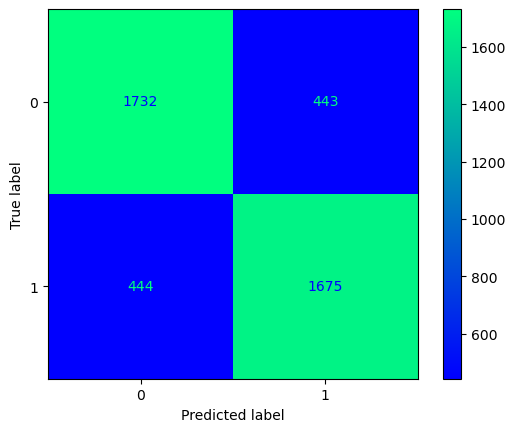

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.80      0.80      0.80      2175
           1       0.79      0.79      0.79      2119

    accuracy                           0.79      4294
   macro avg       0.79      0.79      0.79      4294
weighted avg       0.79      0.79      0.79      4294

-------------------------


In [165]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m2_15min.catboost_GridS()

In [166]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m2_15min,y_val_m2_15min)

Accuracy validación 0.8023104155021428


In [167]:
guardar_modelo(modelo_entrenado_15min,"m2_catboost_GridS_15min")

### Partidas 10 min

Hora de inicio:  03:09:01
0:	learn: 0.6802647	test: 0.6807433	best: 0.6807433 (0)	total: 2.8ms	remaining: 277ms
1:	learn: 0.6689158	test: 0.6697816	best: 0.6697816 (1)	total: 5.47ms	remaining: 268ms
2:	learn: 0.6589247	test: 0.6603556	best: 0.6603556 (2)	total: 8.18ms	remaining: 264ms
3:	learn: 0.6500374	test: 0.6513181	best: 0.6513181 (3)	total: 10.8ms	remaining: 260ms
4:	learn: 0.6421871	test: 0.6436742	best: 0.6436742 (4)	total: 13.5ms	remaining: 256ms
5:	learn: 0.6344732	test: 0.6360919	best: 0.6360919 (5)	total: 16.3ms	remaining: 255ms
6:	learn: 0.6273873	test: 0.6295695	best: 0.6295695 (6)	total: 19ms	remaining: 253ms
7:	learn: 0.6211253	test: 0.6235522	best: 0.6235522 (7)	total: 21.7ms	remaining: 250ms
8:	learn: 0.6153659	test: 0.6181242	best: 0.6181242 (8)	total: 24.5ms	remaining: 247ms
9:	learn: 0.6095364	test: 0.6128845	best: 0.6128845 (9)	total: 27.4ms	remaining: 247ms
10:	learn: 0.6051725	test: 0.6088321	best: 0.6088321 (10)	total: 30.2ms	remaining: 245ms
11:	learn: 0.60103

19:	learn: 0.5447202	test: 0.5552417	best: 0.5552417 (19)	total: 56ms	remaining: 224ms
20:	learn: 0.5425479	test: 0.5536915	best: 0.5536915 (20)	total: 58.9ms	remaining: 222ms
21:	learn: 0.5415303	test: 0.5524317	best: 0.5524317 (21)	total: 61.6ms	remaining: 219ms
22:	learn: 0.5401108	test: 0.5513072	best: 0.5513072 (22)	total: 64.3ms	remaining: 215ms
23:	learn: 0.5390747	test: 0.5503647	best: 0.5503647 (23)	total: 66.9ms	remaining: 212ms
24:	learn: 0.5381366	test: 0.5499719	best: 0.5499719 (24)	total: 70.1ms	remaining: 210ms
25:	learn: 0.5370905	test: 0.5489507	best: 0.5489507 (25)	total: 73.3ms	remaining: 209ms
26:	learn: 0.5362019	test: 0.5479604	best: 0.5479604 (26)	total: 75.8ms	remaining: 205ms
27:	learn: 0.5350065	test: 0.5471325	best: 0.5471325 (27)	total: 78.5ms	remaining: 202ms
28:	learn: 0.5342441	test: 0.5467085	best: 0.5467085 (28)	total: 81.5ms	remaining: 199ms
29:	learn: 0.5333247	test: 0.5460458	best: 0.5460458 (29)	total: 84.3ms	remaining: 197ms
30:	learn: 0.5320587	te

58:	learn: 0.5124894	test: 0.5332982	best: 0.5327471 (44)	total: 171ms	remaining: 119ms
59:	learn: 0.5122322	test: 0.5331599	best: 0.5327471 (44)	total: 174ms	remaining: 116ms
60:	learn: 0.5119570	test: 0.5331178	best: 0.5327471 (44)	total: 177ms	remaining: 113ms
61:	learn: 0.5117171	test: 0.5327309	best: 0.5327309 (61)	total: 180ms	remaining: 111ms
62:	learn: 0.5113486	test: 0.5322656	best: 0.5322656 (62)	total: 183ms	remaining: 107ms
63:	learn: 0.5110632	test: 0.5322839	best: 0.5322656 (62)	total: 186ms	remaining: 104ms
64:	learn: 0.5107820	test: 0.5321279	best: 0.5321279 (64)	total: 188ms	remaining: 101ms
65:	learn: 0.5103512	test: 0.5318965	best: 0.5318965 (65)	total: 191ms	remaining: 98.5ms
66:	learn: 0.5097461	test: 0.5316483	best: 0.5316483 (66)	total: 194ms	remaining: 95.7ms
67:	learn: 0.5094913	test: 0.5315137	best: 0.5315137 (67)	total: 197ms	remaining: 92.7ms
68:	learn: 0.5092494	test: 0.5313012	best: 0.5313012 (68)	total: 200ms	remaining: 89.7ms
69:	learn: 0.5090076	test: 0

96:	learn: 0.4949074	test: 0.5326861	best: 0.5302435 (80)	total: 270ms	remaining: 8.36ms
97:	learn: 0.4947331	test: 0.5326231	best: 0.5302435 (80)	total: 273ms	remaining: 5.58ms
98:	learn: 0.4943770	test: 0.5326459	best: 0.5302435 (80)	total: 276ms	remaining: 2.79ms
99:	learn: 0.4940155	test: 0.5334142	best: 0.5302435 (80)	total: 279ms	remaining: 0us

bestTest = 0.5302435319
bestIteration = 80

3:	loss: 0.5302435	best: 0.5302435 (3)	total: 1.18s	remaining: 38.6s
0:	learn: 0.5997941	test: 0.6038423	best: 0.6038423 (0)	total: 2.7ms	remaining: 268ms
1:	learn: 0.5700795	test: 0.5727180	best: 0.5727180 (1)	total: 5.49ms	remaining: 269ms
2:	learn: 0.5535951	test: 0.5595149	best: 0.5595149 (2)	total: 8.24ms	remaining: 266ms
3:	learn: 0.5412440	test: 0.5493121	best: 0.5493121 (3)	total: 10.9ms	remaining: 262ms
4:	learn: 0.5360979	test: 0.5459720	best: 0.5459720 (4)	total: 13.6ms	remaining: 259ms
5:	learn: 0.5327947	test: 0.5430779	best: 0.5430779 (5)	total: 16.3ms	remaining: 255ms
6:	learn: 0.

91:	learn: 0.4739291	test: 0.5571430	best: 0.5328955 (17)	total: 254ms	remaining: 22.1ms
92:	learn: 0.4736060	test: 0.5567268	best: 0.5328955 (17)	total: 257ms	remaining: 19.4ms
93:	learn: 0.4733434	test: 0.5566518	best: 0.5328955 (17)	total: 260ms	remaining: 16.6ms
94:	learn: 0.4728659	test: 0.5570693	best: 0.5328955 (17)	total: 262ms	remaining: 13.8ms
95:	learn: 0.4722340	test: 0.5571817	best: 0.5328955 (17)	total: 265ms	remaining: 11ms
96:	learn: 0.4718317	test: 0.5570201	best: 0.5328955 (17)	total: 268ms	remaining: 8.28ms
97:	learn: 0.4713190	test: 0.5574484	best: 0.5328955 (17)	total: 270ms	remaining: 5.52ms
98:	learn: 0.4708168	test: 0.5579860	best: 0.5328955 (17)	total: 273ms	remaining: 2.76ms
99:	learn: 0.4703661	test: 0.5579433	best: 0.5328955 (17)	total: 276ms	remaining: 0us

bestTest = 0.5328955063
bestIteration = 17

4:	loss: 0.5328955	best: 0.5302435 (3)	total: 1.46s	remaining: 37.9s
0:	learn: 0.6802647	test: 0.6807433	best: 0.6807433 (0)	total: 2.68ms	remaining: 265ms
1:	

7:	learn: 0.5836157	test: 0.5896842	best: 0.5896842 (7)	total: 23ms	remaining: 265ms
8:	learn: 0.5777949	test: 0.5842356	best: 0.5842356 (8)	total: 25.9ms	remaining: 262ms
9:	learn: 0.5724104	test: 0.5789011	best: 0.5789011 (9)	total: 28.5ms	remaining: 257ms
10:	learn: 0.5685232	test: 0.5751773	best: 0.5751773 (10)	total: 31.4ms	remaining: 254ms
11:	learn: 0.5647679	test: 0.5714038	best: 0.5714038 (11)	total: 34ms	remaining: 249ms
12:	learn: 0.5604244	test: 0.5681446	best: 0.5681446 (12)	total: 36.9ms	remaining: 247ms
13:	learn: 0.5571143	test: 0.5652925	best: 0.5652925 (13)	total: 39.7ms	remaining: 244ms
14:	learn: 0.5550706	test: 0.5629288	best: 0.5629288 (14)	total: 42.4ms	remaining: 240ms
15:	learn: 0.5527726	test: 0.5615310	best: 0.5615310 (15)	total: 45.5ms	remaining: 239ms
16:	learn: 0.5505531	test: 0.5597653	best: 0.5597653 (16)	total: 48.3ms	remaining: 236ms
17:	learn: 0.5483540	test: 0.5579954	best: 0.5579954 (17)	total: 51.1ms	remaining: 233ms
18:	learn: 0.5464703	test: 0.55

8:	learn: 0.5587006	test: 0.5670350	best: 0.5670350 (8)	total: 25.4ms	remaining: 257ms
9:	learn: 0.5539213	test: 0.5632497	best: 0.5632497 (9)	total: 28.5ms	remaining: 257ms
10:	learn: 0.5505704	test: 0.5595533	best: 0.5595533 (10)	total: 31.3ms	remaining: 253ms
11:	learn: 0.5478324	test: 0.5572802	best: 0.5572802 (11)	total: 34.1ms	remaining: 250ms
12:	learn: 0.5454353	test: 0.5547763	best: 0.5547763 (12)	total: 36.9ms	remaining: 247ms
13:	learn: 0.5435976	test: 0.5531282	best: 0.5531282 (13)	total: 39.9ms	remaining: 245ms
14:	learn: 0.5415553	test: 0.5513629	best: 0.5513629 (14)	total: 42.5ms	remaining: 241ms
15:	learn: 0.5398652	test: 0.5499246	best: 0.5499246 (15)	total: 45.2ms	remaining: 237ms
16:	learn: 0.5372460	test: 0.5483304	best: 0.5483304 (16)	total: 47.9ms	remaining: 234ms
17:	learn: 0.5352800	test: 0.5465959	best: 0.5465959 (17)	total: 50.7ms	remaining: 231ms
18:	learn: 0.5334354	test: 0.5452863	best: 0.5452863 (18)	total: 53.5ms	remaining: 228ms
19:	learn: 0.5320660	test

17:	learn: 0.5280412	test: 0.5412368	best: 0.5412368 (17)	total: 51.8ms	remaining: 236ms
18:	learn: 0.5269203	test: 0.5401528	best: 0.5401528 (18)	total: 55ms	remaining: 234ms
19:	learn: 0.5262477	test: 0.5396057	best: 0.5396057 (19)	total: 57.6ms	remaining: 230ms
20:	learn: 0.5251696	test: 0.5389283	best: 0.5389283 (20)	total: 60.6ms	remaining: 228ms
21:	learn: 0.5244128	test: 0.5380927	best: 0.5380927 (21)	total: 63.3ms	remaining: 224ms
22:	learn: 0.5236149	test: 0.5376045	best: 0.5376045 (22)	total: 66.3ms	remaining: 222ms
23:	learn: 0.5225954	test: 0.5372275	best: 0.5372275 (23)	total: 68.9ms	remaining: 218ms
24:	learn: 0.5218612	test: 0.5368104	best: 0.5368104 (24)	total: 71.5ms	remaining: 214ms
25:	learn: 0.5209293	test: 0.5358226	best: 0.5358226 (25)	total: 74.6ms	remaining: 212ms
26:	learn: 0.5201840	test: 0.5349862	best: 0.5349862 (26)	total: 77.1ms	remaining: 209ms
27:	learn: 0.5196556	test: 0.5343883	best: 0.5343883 (27)	total: 80.1ms	remaining: 206ms
28:	learn: 0.5191841	te

26:	learn: 0.5074158	test: 0.5340762	best: 0.5328955 (17)	total: 74.8ms	remaining: 202ms
27:	learn: 0.5066573	test: 0.5336860	best: 0.5328955 (17)	total: 77.6ms	remaining: 200ms
28:	learn: 0.5058817	test: 0.5364125	best: 0.5328955 (17)	total: 80.7ms	remaining: 198ms
29:	learn: 0.5046376	test: 0.5356499	best: 0.5328955 (17)	total: 83.3ms	remaining: 194ms
30:	learn: 0.5038178	test: 0.5357843	best: 0.5328955 (17)	total: 85.9ms	remaining: 191ms
31:	learn: 0.5029629	test: 0.5359687	best: 0.5328955 (17)	total: 88.7ms	remaining: 188ms
32:	learn: 0.5023961	test: 0.5366289	best: 0.5328955 (17)	total: 91.2ms	remaining: 185ms
33:	learn: 0.5018040	test: 0.5368132	best: 0.5328955 (17)	total: 93.8ms	remaining: 182ms
34:	learn: 0.5012056	test: 0.5377569	best: 0.5328955 (17)	total: 96.9ms	remaining: 180ms
35:	learn: 0.5006785	test: 0.5378568	best: 0.5328955 (17)	total: 99.9ms	remaining: 178ms
36:	learn: 0.5002462	test: 0.5380670	best: 0.5328955 (17)	total: 103ms	remaining: 175ms
37:	learn: 0.4996660	t

31:	learn: 0.5530291	test: 0.5616544	best: 0.5616544 (31)	total: 89.5ms	remaining: 190ms
32:	learn: 0.5516198	test: 0.5606166	best: 0.5606166 (32)	total: 92.4ms	remaining: 188ms
33:	learn: 0.5504342	test: 0.5594551	best: 0.5594551 (33)	total: 95.2ms	remaining: 185ms
34:	learn: 0.5493688	test: 0.5584255	best: 0.5584255 (34)	total: 97.9ms	remaining: 182ms
35:	learn: 0.5482726	test: 0.5575863	best: 0.5575863 (35)	total: 101ms	remaining: 179ms
36:	learn: 0.5473830	test: 0.5568404	best: 0.5568404 (36)	total: 103ms	remaining: 176ms
37:	learn: 0.5465860	test: 0.5562172	best: 0.5562172 (37)	total: 106ms	remaining: 173ms
38:	learn: 0.5455439	test: 0.5555579	best: 0.5555579 (38)	total: 109ms	remaining: 171ms
39:	learn: 0.5448291	test: 0.5548609	best: 0.5548609 (39)	total: 112ms	remaining: 168ms
40:	learn: 0.5439896	test: 0.5541682	best: 0.5541682 (40)	total: 115ms	remaining: 165ms
41:	learn: 0.5432831	test: 0.5534889	best: 0.5534889 (41)	total: 117ms	remaining: 162ms
42:	learn: 0.5426283	test: 0

40:	learn: 0.5257475	test: 0.5399777	best: 0.5399777 (40)	total: 117ms	remaining: 168ms
41:	learn: 0.5251878	test: 0.5395281	best: 0.5395281 (41)	total: 120ms	remaining: 165ms
42:	learn: 0.5246073	test: 0.5389373	best: 0.5389373 (42)	total: 123ms	remaining: 163ms
43:	learn: 0.5240898	test: 0.5385890	best: 0.5385890 (43)	total: 125ms	remaining: 160ms
44:	learn: 0.5237881	test: 0.5383547	best: 0.5383547 (44)	total: 129ms	remaining: 157ms
45:	learn: 0.5233879	test: 0.5384397	best: 0.5383547 (44)	total: 132ms	remaining: 154ms
46:	learn: 0.5229079	test: 0.5381917	best: 0.5381917 (46)	total: 134ms	remaining: 151ms
47:	learn: 0.5223607	test: 0.5379922	best: 0.5379922 (47)	total: 137ms	remaining: 148ms
48:	learn: 0.5219141	test: 0.5378509	best: 0.5378509 (48)	total: 140ms	remaining: 146ms
49:	learn: 0.5215572	test: 0.5375503	best: 0.5375503 (49)	total: 142ms	remaining: 142ms
50:	learn: 0.5212177	test: 0.5372250	best: 0.5372250 (50)	total: 146ms	remaining: 140ms
51:	learn: 0.5207309	test: 0.536

42:	learn: 0.5171560	test: 0.5331436	best: 0.5331436 (42)	total: 121ms	remaining: 160ms
43:	learn: 0.5168674	test: 0.5329628	best: 0.5329628 (43)	total: 124ms	remaining: 158ms
44:	learn: 0.5164854	test: 0.5327471	best: 0.5327471 (44)	total: 126ms	remaining: 155ms
45:	learn: 0.5161241	test: 0.5327653	best: 0.5327471 (44)	total: 138ms	remaining: 162ms
46:	learn: 0.5157040	test: 0.5332560	best: 0.5327471 (44)	total: 141ms	remaining: 159ms
47:	learn: 0.5155358	test: 0.5333888	best: 0.5327471 (44)	total: 143ms	remaining: 155ms
48:	learn: 0.5152405	test: 0.5330700	best: 0.5327471 (44)	total: 146ms	remaining: 152ms
49:	learn: 0.5148865	test: 0.5331006	best: 0.5327471 (44)	total: 149ms	remaining: 149ms
50:	learn: 0.5142805	test: 0.5331604	best: 0.5327471 (44)	total: 152ms	remaining: 146ms
51:	learn: 0.5141514	test: 0.5337118	best: 0.5327471 (44)	total: 155ms	remaining: 143ms
52:	learn: 0.5139150	test: 0.5338527	best: 0.5327471 (44)	total: 158ms	remaining: 140ms
53:	learn: 0.5137814	test: 0.533

54:	learn: 0.5089884	test: 0.5321529	best: 0.5316383 (50)	total: 155ms	remaining: 127ms
55:	learn: 0.5084950	test: 0.5320283	best: 0.5316383 (50)	total: 158ms	remaining: 124ms
56:	learn: 0.5080888	test: 0.5320155	best: 0.5316383 (50)	total: 161ms	remaining: 121ms
57:	learn: 0.5078378	test: 0.5320750	best: 0.5316383 (50)	total: 163ms	remaining: 118ms
58:	learn: 0.5073746	test: 0.5316658	best: 0.5316383 (50)	total: 166ms	remaining: 115ms
59:	learn: 0.5071078	test: 0.5317577	best: 0.5316383 (50)	total: 169ms	remaining: 113ms
60:	learn: 0.5066334	test: 0.5316972	best: 0.5316383 (50)	total: 172ms	remaining: 110ms
61:	learn: 0.5058900	test: 0.5316975	best: 0.5316383 (50)	total: 175ms	remaining: 107ms
62:	learn: 0.5055648	test: 0.5316257	best: 0.5316257 (62)	total: 178ms	remaining: 104ms
63:	learn: 0.5050453	test: 0.5314428	best: 0.5314428 (63)	total: 181ms	remaining: 102ms
64:	learn: 0.5045610	test: 0.5310862	best: 0.5310862 (64)	total: 184ms	remaining: 99ms
65:	learn: 0.5042787	test: 0.5310

53:	learn: 0.4907603	test: 0.5455876	best: 0.5328955 (17)	total: 151ms	remaining: 128ms
54:	learn: 0.4900562	test: 0.5458162	best: 0.5328955 (17)	total: 154ms	remaining: 126ms
55:	learn: 0.4896853	test: 0.5453986	best: 0.5328955 (17)	total: 156ms	remaining: 123ms
56:	learn: 0.4893587	test: 0.5449931	best: 0.5328955 (17)	total: 159ms	remaining: 120ms
57:	learn: 0.4888879	test: 0.5450654	best: 0.5328955 (17)	total: 162ms	remaining: 117ms
58:	learn: 0.4884139	test: 0.5469392	best: 0.5328955 (17)	total: 165ms	remaining: 115ms
59:	learn: 0.4878500	test: 0.5470270	best: 0.5328955 (17)	total: 167ms	remaining: 112ms
60:	learn: 0.4872914	test: 0.5472045	best: 0.5328955 (17)	total: 170ms	remaining: 109ms
61:	learn: 0.4869286	test: 0.5478451	best: 0.5328955 (17)	total: 173ms	remaining: 106ms
62:	learn: 0.4864749	test: 0.5476866	best: 0.5328955 (17)	total: 176ms	remaining: 103ms
63:	learn: 0.4857871	test: 0.5484738	best: 0.5328955 (17)	total: 179ms	remaining: 100ms
64:	learn: 0.4852906	test: 0.548

69:	learn: 0.5292923	test: 0.5424131	best: 0.5424131 (69)	total: 199ms	remaining: 227ms
70:	learn: 0.5290465	test: 0.5422401	best: 0.5422401 (70)	total: 202ms	remaining: 224ms
71:	learn: 0.5287434	test: 0.5419834	best: 0.5419834 (71)	total: 204ms	remaining: 221ms
72:	learn: 0.5285735	test: 0.5417988	best: 0.5417988 (72)	total: 207ms	remaining: 218ms
73:	learn: 0.5281322	test: 0.5415382	best: 0.5415382 (73)	total: 209ms	remaining: 215ms
74:	learn: 0.5277857	test: 0.5412366	best: 0.5412366 (74)	total: 212ms	remaining: 212ms
75:	learn: 0.5273667	test: 0.5409063	best: 0.5409063 (75)	total: 215ms	remaining: 209ms
76:	learn: 0.5270095	test: 0.5406774	best: 0.5406774 (76)	total: 218ms	remaining: 207ms
77:	learn: 0.5268344	test: 0.5405185	best: 0.5405185 (77)	total: 221ms	remaining: 204ms
78:	learn: 0.5265156	test: 0.5403079	best: 0.5403079 (78)	total: 223ms	remaining: 201ms
79:	learn: 0.5263543	test: 0.5402057	best: 0.5402057 (79)	total: 226ms	remaining: 198ms
80:	learn: 0.5261038	test: 0.540

23:	learn: 0.5390747	test: 0.5503647	best: 0.5503647 (23)	total: 66.9ms	remaining: 351ms
24:	learn: 0.5381366	test: 0.5499719	best: 0.5499719 (24)	total: 70.3ms	remaining: 351ms
25:	learn: 0.5370905	test: 0.5489507	best: 0.5489507 (25)	total: 73.4ms	remaining: 350ms
26:	learn: 0.5362019	test: 0.5479604	best: 0.5479604 (26)	total: 75.9ms	remaining: 346ms
27:	learn: 0.5350065	test: 0.5471325	best: 0.5471325 (27)	total: 78.6ms	remaining: 343ms
28:	learn: 0.5342441	test: 0.5467085	best: 0.5467085 (28)	total: 81.6ms	remaining: 340ms
29:	learn: 0.5333247	test: 0.5460458	best: 0.5460458 (29)	total: 84.4ms	remaining: 338ms
30:	learn: 0.5320587	test: 0.5449595	best: 0.5449595 (30)	total: 87.5ms	remaining: 336ms
31:	learn: 0.5313740	test: 0.5443355	best: 0.5443355 (31)	total: 90.5ms	remaining: 334ms
32:	learn: 0.5306684	test: 0.5439963	best: 0.5439963 (32)	total: 93ms	remaining: 330ms
33:	learn: 0.5296041	test: 0.5433579	best: 0.5433579 (33)	total: 96ms	remaining: 328ms
34:	learn: 0.5290585	test

132:	learn: 0.5029177	test: 0.5308398	best: 0.5302555 (123)	total: 378ms	remaining: 48.4ms
133:	learn: 0.5027435	test: 0.5308350	best: 0.5302555 (123)	total: 381ms	remaining: 45.5ms
134:	learn: 0.5026129	test: 0.5310659	best: 0.5302555 (123)	total: 384ms	remaining: 42.7ms
135:	learn: 0.5024850	test: 0.5311331	best: 0.5302555 (123)	total: 387ms	remaining: 39.9ms
136:	learn: 0.5022707	test: 0.5309809	best: 0.5302555 (123)	total: 390ms	remaining: 37ms
137:	learn: 0.5020932	test: 0.5311410	best: 0.5302555 (123)	total: 393ms	remaining: 34.2ms
138:	learn: 0.5019478	test: 0.5310818	best: 0.5302555 (123)	total: 396ms	remaining: 31.3ms
139:	learn: 0.5018154	test: 0.5310448	best: 0.5302555 (123)	total: 398ms	remaining: 28.5ms
140:	learn: 0.5016164	test: 0.5310976	best: 0.5302555 (123)	total: 401ms	remaining: 25.6ms
141:	learn: 0.5013929	test: 0.5311426	best: 0.5302555 (123)	total: 404ms	remaining: 22.8ms
142:	learn: 0.5012076	test: 0.5313612	best: 0.5302555 (123)	total: 407ms	remaining: 19.9ms
1

81:	learn: 0.5048534	test: 0.5315420	best: 0.5312449 (73)	total: 230ms	remaining: 191ms
82:	learn: 0.5045385	test: 0.5316115	best: 0.5312449 (73)	total: 233ms	remaining: 188ms
83:	learn: 0.5041869	test: 0.5312260	best: 0.5312260 (83)	total: 236ms	remaining: 185ms
84:	learn: 0.5038011	test: 0.5313650	best: 0.5312260 (83)	total: 239ms	remaining: 183ms
85:	learn: 0.5036610	test: 0.5314286	best: 0.5312260 (83)	total: 241ms	remaining: 180ms
86:	learn: 0.5033341	test: 0.5314479	best: 0.5312260 (83)	total: 244ms	remaining: 177ms
87:	learn: 0.5031000	test: 0.5315701	best: 0.5312260 (83)	total: 247ms	remaining: 174ms
88:	learn: 0.5027107	test: 0.5314314	best: 0.5312260 (83)	total: 250ms	remaining: 171ms
89:	learn: 0.5023645	test: 0.5313022	best: 0.5312260 (83)	total: 252ms	remaining: 168ms
90:	learn: 0.5021214	test: 0.5312106	best: 0.5312106 (90)	total: 255ms	remaining: 165ms
91:	learn: 0.5019043	test: 0.5311060	best: 0.5311060 (91)	total: 257ms	remaining: 162ms
92:	learn: 0.5017166	test: 0.531

46:	learn: 0.5122071	test: 0.5321679	best: 0.5321679 (46)	total: 134ms	remaining: 293ms
47:	learn: 0.5115975	test: 0.5319401	best: 0.5319401 (47)	total: 137ms	remaining: 291ms
48:	learn: 0.5111727	test: 0.5319026	best: 0.5319026 (48)	total: 139ms	remaining: 287ms
49:	learn: 0.5108567	test: 0.5318171	best: 0.5318171 (49)	total: 142ms	remaining: 284ms
50:	learn: 0.5105130	test: 0.5316383	best: 0.5316383 (50)	total: 145ms	remaining: 281ms
51:	learn: 0.5102119	test: 0.5317214	best: 0.5316383 (50)	total: 147ms	remaining: 277ms
52:	learn: 0.5098860	test: 0.5318387	best: 0.5316383 (50)	total: 150ms	remaining: 274ms
53:	learn: 0.5094279	test: 0.5320575	best: 0.5316383 (50)	total: 152ms	remaining: 271ms
54:	learn: 0.5089884	test: 0.5321529	best: 0.5316383 (50)	total: 155ms	remaining: 268ms
55:	learn: 0.5084950	test: 0.5320283	best: 0.5316383 (50)	total: 158ms	remaining: 265ms
56:	learn: 0.5080888	test: 0.5320155	best: 0.5316383 (50)	total: 160ms	remaining: 262ms
57:	learn: 0.5078378	test: 0.532

147:	learn: 0.4832782	test: 0.5359903	best: 0.5302435 (80)	total: 414ms	remaining: 5.59ms
148:	learn: 0.4830079	test: 0.5365621	best: 0.5302435 (80)	total: 417ms	remaining: 2.8ms
149:	learn: 0.4828191	test: 0.5367414	best: 0.5302435 (80)	total: 419ms	remaining: 0us

bestTest = 0.5302435319
bestIteration = 80

18:	loss: 0.5302435	best: 0.5302435 (3)	total: 6.05s	remaining: 37s
0:	learn: 0.5997941	test: 0.6038423	best: 0.6038423 (0)	total: 2.69ms	remaining: 400ms
1:	learn: 0.5700795	test: 0.5727180	best: 0.5727180 (1)	total: 5.4ms	remaining: 400ms
2:	learn: 0.5535951	test: 0.5595149	best: 0.5595149 (2)	total: 8.12ms	remaining: 398ms
3:	learn: 0.5412440	test: 0.5493121	best: 0.5493121 (3)	total: 10.7ms	remaining: 391ms
4:	learn: 0.5360979	test: 0.5459720	best: 0.5459720 (4)	total: 13.4ms	remaining: 389ms
5:	learn: 0.5327947	test: 0.5430779	best: 0.5430779 (5)	total: 16.1ms	remaining: 386ms
6:	learn: 0.5311508	test: 0.5423642	best: 0.5423642 (6)	total: 19.1ms	remaining: 390ms
7:	learn: 0.5

118:	learn: 0.4625616	test: 0.5637243	best: 0.5328955 (17)	total: 330ms	remaining: 85.9ms
119:	learn: 0.4623165	test: 0.5637040	best: 0.5328955 (17)	total: 333ms	remaining: 83.1ms
120:	learn: 0.4617698	test: 0.5641359	best: 0.5328955 (17)	total: 336ms	remaining: 80.5ms
121:	learn: 0.4614573	test: 0.5644783	best: 0.5328955 (17)	total: 339ms	remaining: 77.7ms
122:	learn: 0.4611119	test: 0.5640887	best: 0.5328955 (17)	total: 341ms	remaining: 74.9ms
123:	learn: 0.4606568	test: 0.5650600	best: 0.5328955 (17)	total: 344ms	remaining: 72.2ms
124:	learn: 0.4602781	test: 0.5651552	best: 0.5328955 (17)	total: 347ms	remaining: 69.4ms
125:	learn: 0.4597530	test: 0.5653884	best: 0.5328955 (17)	total: 349ms	remaining: 66.6ms
126:	learn: 0.4593835	test: 0.5653979	best: 0.5328955 (17)	total: 352ms	remaining: 63.8ms
127:	learn: 0.4590704	test: 0.5653423	best: 0.5328955 (17)	total: 355ms	remaining: 61ms
128:	learn: 0.4589340	test: 0.5653962	best: 0.5328955 (17)	total: 358ms	remaining: 58.2ms
129:	learn: 

67:	learn: 0.5300133	test: 0.5431220	best: 0.5431220 (67)	total: 191ms	remaining: 231ms
68:	learn: 0.5296208	test: 0.5427516	best: 0.5427516 (68)	total: 194ms	remaining: 228ms
69:	learn: 0.5292923	test: 0.5424131	best: 0.5424131 (69)	total: 197ms	remaining: 226ms
70:	learn: 0.5290465	test: 0.5422401	best: 0.5422401 (70)	total: 200ms	remaining: 223ms
71:	learn: 0.5287434	test: 0.5419834	best: 0.5419834 (71)	total: 203ms	remaining: 220ms
72:	learn: 0.5285735	test: 0.5417988	best: 0.5417988 (72)	total: 205ms	remaining: 216ms
73:	learn: 0.5281322	test: 0.5415382	best: 0.5415382 (73)	total: 208ms	remaining: 213ms
74:	learn: 0.5277857	test: 0.5412366	best: 0.5412366 (74)	total: 210ms	remaining: 210ms
75:	learn: 0.5273667	test: 0.5409063	best: 0.5409063 (75)	total: 214ms	remaining: 208ms
76:	learn: 0.5270095	test: 0.5406774	best: 0.5406774 (76)	total: 216ms	remaining: 205ms
77:	learn: 0.5268344	test: 0.5405185	best: 0.5405185 (77)	total: 219ms	remaining: 202ms
78:	learn: 0.5265156	test: 0.540

37:	learn: 0.5273921	test: 0.5415084	best: 0.5415084 (37)	total: 139ms	remaining: 411ms
38:	learn: 0.5267680	test: 0.5408259	best: 0.5408259 (38)	total: 142ms	remaining: 405ms
39:	learn: 0.5261781	test: 0.5403619	best: 0.5403619 (39)	total: 145ms	remaining: 399ms
40:	learn: 0.5257475	test: 0.5399777	best: 0.5399777 (40)	total: 148ms	remaining: 394ms
41:	learn: 0.5251878	test: 0.5395281	best: 0.5395281 (41)	total: 151ms	remaining: 388ms
42:	learn: 0.5246073	test: 0.5389373	best: 0.5389373 (42)	total: 154ms	remaining: 384ms
43:	learn: 0.5240898	test: 0.5385890	best: 0.5385890 (43)	total: 157ms	remaining: 378ms
44:	learn: 0.5237881	test: 0.5383547	best: 0.5383547 (44)	total: 160ms	remaining: 373ms
45:	learn: 0.5233879	test: 0.5384397	best: 0.5383547 (44)	total: 164ms	remaining: 371ms
46:	learn: 0.5229079	test: 0.5381917	best: 0.5381917 (46)	total: 167ms	remaining: 365ms
47:	learn: 0.5223607	test: 0.5379922	best: 0.5379922 (47)	total: 169ms	remaining: 360ms
48:	learn: 0.5219141	test: 0.537

148:	learn: 0.5002703	test: 0.5317364	best: 0.5302555 (123)	total: 460ms	remaining: 3.08ms
149:	learn: 0.5001565	test: 0.5317411	best: 0.5302555 (123)	total: 463ms	remaining: 0us

bestTest = 0.530255492
bestIteration = 123

21:	loss: 0.5302555	best: 0.5302435 (3)	total: 7.42s	remaining: 38.1s
0:	learn: 0.6569178	test: 0.6583178	best: 0.6583178 (0)	total: 2.74ms	remaining: 409ms
1:	learn: 0.6310539	test: 0.6334299	best: 0.6334299 (1)	total: 5.58ms	remaining: 413ms
2:	learn: 0.6116638	test: 0.6151957	best: 0.6151957 (2)	total: 8.36ms	remaining: 410ms
3:	learn: 0.5967076	test: 0.6011397	best: 0.6011397 (3)	total: 11.1ms	remaining: 407ms
4:	learn: 0.5853160	test: 0.5898717	best: 0.5898717 (4)	total: 13.9ms	remaining: 402ms
5:	learn: 0.5769863	test: 0.5826866	best: 0.5826866 (5)	total: 16.6ms	remaining: 398ms
6:	learn: 0.5692773	test: 0.5760835	best: 0.5760835 (6)	total: 19.3ms	remaining: 394ms
7:	learn: 0.5633955	test: 0.5705587	best: 0.5705587 (7)	total: 22ms	remaining: 390ms
8:	learn: 0.

98:	learn: 0.5001460	test: 0.5314901	best: 0.5311060 (91)	total: 290ms	remaining: 149ms
99:	learn: 0.4999617	test: 0.5315136	best: 0.5311060 (91)	total: 293ms	remaining: 146ms
100:	learn: 0.4997914	test: 0.5315390	best: 0.5311060 (91)	total: 296ms	remaining: 143ms
101:	learn: 0.4995115	test: 0.5311666	best: 0.5311060 (91)	total: 298ms	remaining: 140ms
102:	learn: 0.4991967	test: 0.5312797	best: 0.5311060 (91)	total: 301ms	remaining: 138ms
103:	learn: 0.4989492	test: 0.5321322	best: 0.5311060 (91)	total: 305ms	remaining: 135ms
104:	learn: 0.4986175	test: 0.5322928	best: 0.5311060 (91)	total: 307ms	remaining: 132ms
105:	learn: 0.4983970	test: 0.5324346	best: 0.5311060 (91)	total: 310ms	remaining: 129ms
106:	learn: 0.4980943	test: 0.5324427	best: 0.5311060 (91)	total: 313ms	remaining: 126ms
107:	learn: 0.4978178	test: 0.5324662	best: 0.5311060 (91)	total: 316ms	remaining: 123ms
108:	learn: 0.4975987	test: 0.5326544	best: 0.5311060 (91)	total: 319ms	remaining: 120ms
109:	learn: 0.4973446	t

54:	learn: 0.5089884	test: 0.5321529	best: 0.5316383 (50)	total: 158ms	remaining: 273ms
55:	learn: 0.5084950	test: 0.5320283	best: 0.5316383 (50)	total: 161ms	remaining: 271ms
56:	learn: 0.5080888	test: 0.5320155	best: 0.5316383 (50)	total: 164ms	remaining: 268ms
57:	learn: 0.5078378	test: 0.5320750	best: 0.5316383 (50)	total: 167ms	remaining: 265ms
58:	learn: 0.5073746	test: 0.5316658	best: 0.5316383 (50)	total: 169ms	remaining: 261ms
59:	learn: 0.5071078	test: 0.5317577	best: 0.5316383 (50)	total: 172ms	remaining: 258ms
60:	learn: 0.5066334	test: 0.5316972	best: 0.5316383 (50)	total: 175ms	remaining: 256ms
61:	learn: 0.5058900	test: 0.5316975	best: 0.5316383 (50)	total: 179ms	remaining: 253ms
62:	learn: 0.5055648	test: 0.5316257	best: 0.5316257 (62)	total: 181ms	remaining: 250ms
63:	learn: 0.5050453	test: 0.5314428	best: 0.5314428 (63)	total: 184ms	remaining: 248ms
64:	learn: 0.5045610	test: 0.5310862	best: 0.5310862 (64)	total: 187ms	remaining: 245ms
65:	learn: 0.5042787	test: 0.531

11:	learn: 0.5202002	test: 0.5358826	best: 0.5358826 (11)	total: 33.9ms	remaining: 390ms
12:	learn: 0.5192951	test: 0.5343899	best: 0.5343899 (12)	total: 37ms	remaining: 390ms
13:	learn: 0.5178185	test: 0.5337039	best: 0.5337039 (13)	total: 39.7ms	remaining: 385ms
14:	learn: 0.5173840	test: 0.5336209	best: 0.5336209 (14)	total: 42.8ms	remaining: 385ms
15:	learn: 0.5167463	test: 0.5334388	best: 0.5334388 (15)	total: 45.3ms	remaining: 380ms
16:	learn: 0.5160347	test: 0.5331355	best: 0.5331355 (16)	total: 48.4ms	remaining: 378ms
17:	learn: 0.5155177	test: 0.5328955	best: 0.5328955 (17)	total: 51.1ms	remaining: 375ms
18:	learn: 0.5147511	test: 0.5341520	best: 0.5328955 (17)	total: 54.1ms	remaining: 373ms
19:	learn: 0.5139527	test: 0.5340998	best: 0.5328955 (17)	total: 57ms	remaining: 370ms
20:	learn: 0.5130663	test: 0.5341568	best: 0.5328955 (17)	total: 59.7ms	remaining: 367ms
21:	learn: 0.5121861	test: 0.5343453	best: 0.5328955 (17)	total: 62.2ms	remaining: 362ms
22:	learn: 0.5113360	test

117:	learn: 0.4627018	test: 0.5634643	best: 0.5328955 (17)	total: 329ms	remaining: 89.2ms
118:	learn: 0.4625616	test: 0.5637243	best: 0.5328955 (17)	total: 332ms	remaining: 86.5ms
119:	learn: 0.4623165	test: 0.5637040	best: 0.5328955 (17)	total: 335ms	remaining: 83.7ms
120:	learn: 0.4617698	test: 0.5641359	best: 0.5328955 (17)	total: 338ms	remaining: 81ms
121:	learn: 0.4614573	test: 0.5644783	best: 0.5328955 (17)	total: 341ms	remaining: 78.3ms
122:	learn: 0.4611119	test: 0.5640887	best: 0.5328955 (17)	total: 344ms	remaining: 75.4ms
123:	learn: 0.4606568	test: 0.5650600	best: 0.5328955 (17)	total: 347ms	remaining: 72.7ms
124:	learn: 0.4602781	test: 0.5651552	best: 0.5328955 (17)	total: 349ms	remaining: 69.8ms
125:	learn: 0.4597530	test: 0.5653884	best: 0.5328955 (17)	total: 352ms	remaining: 67ms
126:	learn: 0.4593835	test: 0.5653979	best: 0.5328955 (17)	total: 355ms	remaining: 64.2ms
127:	learn: 0.4590704	test: 0.5653423	best: 0.5328955 (17)	total: 357ms	remaining: 61.4ms
128:	learn: 0.

78:	learn: 0.5265156	test: 0.5403079	best: 0.5403079 (78)	total: 230ms	remaining: 207ms
79:	learn: 0.5263543	test: 0.5402057	best: 0.5402057 (79)	total: 233ms	remaining: 204ms
80:	learn: 0.5261038	test: 0.5400828	best: 0.5400828 (80)	total: 237ms	remaining: 202ms
81:	learn: 0.5259643	test: 0.5399849	best: 0.5399849 (81)	total: 239ms	remaining: 198ms
82:	learn: 0.5257344	test: 0.5398375	best: 0.5398375 (82)	total: 242ms	remaining: 196ms
83:	learn: 0.5253846	test: 0.5396691	best: 0.5396691 (83)	total: 246ms	remaining: 193ms
84:	learn: 0.5251142	test: 0.5394556	best: 0.5394556 (84)	total: 248ms	remaining: 190ms
85:	learn: 0.5250001	test: 0.5393493	best: 0.5393493 (85)	total: 251ms	remaining: 187ms
86:	learn: 0.5248645	test: 0.5392427	best: 0.5392427 (86)	total: 254ms	remaining: 184ms
87:	learn: 0.5246181	test: 0.5389750	best: 0.5389750 (87)	total: 257ms	remaining: 181ms
88:	learn: 0.5243680	test: 0.5386049	best: 0.5386049 (88)	total: 259ms	remaining: 178ms
89:	learn: 0.5240231	test: 0.538

66:	learn: 0.5161768	test: 0.5343183	best: 0.5342708 (65)	total: 193ms	remaining: 239ms
67:	learn: 0.5159885	test: 0.5341062	best: 0.5341062 (67)	total: 196ms	remaining: 237ms
68:	learn: 0.5158087	test: 0.5339478	best: 0.5339478 (68)	total: 199ms	remaining: 233ms
69:	learn: 0.5156406	test: 0.5339308	best: 0.5339308 (69)	total: 202ms	remaining: 231ms
70:	learn: 0.5154418	test: 0.5338687	best: 0.5338687 (70)	total: 204ms	remaining: 228ms
71:	learn: 0.5151847	test: 0.5337011	best: 0.5337011 (71)	total: 207ms	remaining: 224ms
72:	learn: 0.5149953	test: 0.5336610	best: 0.5336610 (72)	total: 210ms	remaining: 222ms
73:	learn: 0.5147083	test: 0.5334135	best: 0.5334135 (73)	total: 213ms	remaining: 219ms
74:	learn: 0.5144790	test: 0.5339811	best: 0.5334135 (73)	total: 216ms	remaining: 216ms
75:	learn: 0.5140275	test: 0.5336551	best: 0.5334135 (73)	total: 219ms	remaining: 213ms
76:	learn: 0.5137879	test: 0.5336263	best: 0.5334135 (73)	total: 222ms	remaining: 210ms
77:	learn: 0.5136484	test: 0.533

10:	learn: 0.5505704	test: 0.5595533	best: 0.5595533 (10)	total: 31.2ms	remaining: 395ms
11:	learn: 0.5478324	test: 0.5572802	best: 0.5572802 (11)	total: 34.3ms	remaining: 395ms
12:	learn: 0.5454353	test: 0.5547763	best: 0.5547763 (12)	total: 37.1ms	remaining: 391ms
13:	learn: 0.5435976	test: 0.5531282	best: 0.5531282 (13)	total: 40.2ms	remaining: 390ms
14:	learn: 0.5415553	test: 0.5513629	best: 0.5513629 (14)	total: 42.8ms	remaining: 385ms
15:	learn: 0.5398652	test: 0.5499246	best: 0.5499246 (15)	total: 45.5ms	remaining: 381ms
16:	learn: 0.5372460	test: 0.5483304	best: 0.5483304 (16)	total: 48.3ms	remaining: 378ms
17:	learn: 0.5352800	test: 0.5465959	best: 0.5465959 (17)	total: 51.2ms	remaining: 375ms
18:	learn: 0.5334354	test: 0.5452863	best: 0.5452863 (18)	total: 53.9ms	remaining: 372ms
19:	learn: 0.5320660	test: 0.5442224	best: 0.5442224 (19)	total: 56.7ms	remaining: 369ms
20:	learn: 0.5308774	test: 0.5432373	best: 0.5432373 (20)	total: 59.5ms	remaining: 366ms
21:	learn: 0.5298492	

122:	learn: 0.4943319	test: 0.5351693	best: 0.5311060 (91)	total: 355ms	remaining: 78ms
123:	learn: 0.4941563	test: 0.5351679	best: 0.5311060 (91)	total: 358ms	remaining: 75.1ms
124:	learn: 0.4937908	test: 0.5352152	best: 0.5311060 (91)	total: 361ms	remaining: 72.2ms
125:	learn: 0.4935488	test: 0.5352162	best: 0.5311060 (91)	total: 364ms	remaining: 69.4ms
126:	learn: 0.4933762	test: 0.5351107	best: 0.5311060 (91)	total: 367ms	remaining: 66.4ms
127:	learn: 0.4932782	test: 0.5351289	best: 0.5311060 (91)	total: 370ms	remaining: 63.6ms
128:	learn: 0.4931111	test: 0.5351549	best: 0.5311060 (91)	total: 373ms	remaining: 60.7ms
129:	learn: 0.4928750	test: 0.5350215	best: 0.5311060 (91)	total: 376ms	remaining: 57.9ms
130:	learn: 0.4925592	test: 0.5348831	best: 0.5311060 (91)	total: 379ms	remaining: 55ms
131:	learn: 0.4924085	test: 0.5349807	best: 0.5311060 (91)	total: 382ms	remaining: 52.1ms
132:	learn: 0.4919735	test: 0.5351693	best: 0.5311060 (91)	total: 385ms	remaining: 49.2ms
133:	learn: 0.

72:	learn: 0.5017983	test: 0.5305289	best: 0.5304040 (68)	total: 209ms	remaining: 220ms
73:	learn: 0.5014590	test: 0.5305114	best: 0.5304040 (68)	total: 212ms	remaining: 218ms
74:	learn: 0.5011850	test: 0.5305661	best: 0.5304040 (68)	total: 215ms	remaining: 215ms
75:	learn: 0.5010240	test: 0.5306483	best: 0.5304040 (68)	total: 217ms	remaining: 212ms
76:	learn: 0.5006710	test: 0.5304163	best: 0.5304040 (68)	total: 220ms	remaining: 209ms
77:	learn: 0.5004026	test: 0.5303607	best: 0.5303607 (77)	total: 223ms	remaining: 206ms
78:	learn: 0.5001490	test: 0.5303821	best: 0.5303607 (77)	total: 226ms	remaining: 203ms
79:	learn: 0.4998268	test: 0.5304553	best: 0.5303607 (77)	total: 228ms	remaining: 200ms
80:	learn: 0.4995058	test: 0.5302435	best: 0.5302435 (80)	total: 231ms	remaining: 197ms
81:	learn: 0.4991326	test: 0.5304148	best: 0.5302435 (80)	total: 234ms	remaining: 194ms
82:	learn: 0.4988823	test: 0.5305402	best: 0.5302435 (80)	total: 236ms	remaining: 191ms
83:	learn: 0.4985959	test: 0.530

33:	learn: 0.5018040	test: 0.5368132	best: 0.5328955 (17)	total: 100ms	remaining: 341ms
34:	learn: 0.5012056	test: 0.5377569	best: 0.5328955 (17)	total: 103ms	remaining: 340ms
35:	learn: 0.5006785	test: 0.5378568	best: 0.5328955 (17)	total: 106ms	remaining: 337ms
36:	learn: 0.5002462	test: 0.5380670	best: 0.5328955 (17)	total: 109ms	remaining: 334ms
37:	learn: 0.4996660	test: 0.5377438	best: 0.5328955 (17)	total: 112ms	remaining: 329ms
38:	learn: 0.4990993	test: 0.5380291	best: 0.5328955 (17)	total: 114ms	remaining: 326ms
39:	learn: 0.4984319	test: 0.5378091	best: 0.5328955 (17)	total: 117ms	remaining: 322ms
40:	learn: 0.4975321	test: 0.5384485	best: 0.5328955 (17)	total: 120ms	remaining: 319ms
41:	learn: 0.4970926	test: 0.5387994	best: 0.5328955 (17)	total: 123ms	remaining: 316ms
42:	learn: 0.4964719	test: 0.5388572	best: 0.5328955 (17)	total: 126ms	remaining: 314ms
43:	learn: 0.4959772	test: 0.5386741	best: 0.5328955 (17)	total: 129ms	remaining: 312ms
44:	learn: 0.4953919	test: 0.539

138:	learn: 0.4547380	test: 0.5682183	best: 0.5328955 (17)	total: 394ms	remaining: 31.2ms
139:	learn: 0.4544277	test: 0.5680945	best: 0.5328955 (17)	total: 397ms	remaining: 28.3ms
140:	learn: 0.4540235	test: 0.5679614	best: 0.5328955 (17)	total: 400ms	remaining: 25.5ms
141:	learn: 0.4534435	test: 0.5683542	best: 0.5328955 (17)	total: 402ms	remaining: 22.7ms
142:	learn: 0.4532146	test: 0.5683460	best: 0.5328955 (17)	total: 405ms	remaining: 19.8ms
143:	learn: 0.4530801	test: 0.5691614	best: 0.5328955 (17)	total: 408ms	remaining: 17ms
144:	learn: 0.4527785	test: 0.5698149	best: 0.5328955 (17)	total: 410ms	remaining: 14.1ms
145:	learn: 0.4525479	test: 0.5698560	best: 0.5328955 (17)	total: 413ms	remaining: 11.3ms
146:	learn: 0.4523509	test: 0.5707787	best: 0.5328955 (17)	total: 416ms	remaining: 8.48ms
147:	learn: 0.4520529	test: 0.5703483	best: 0.5328955 (17)	total: 418ms	remaining: 5.65ms
148:	learn: 0.4516633	test: 0.5702225	best: 0.5328955 (17)	total: 421ms	remaining: 2.82ms
149:	learn: 

100:	learn: 0.5217495	test: 0.5368236	best: 0.5367927 (99)	total: 293ms	remaining: 288ms
101:	learn: 0.5216146	test: 0.5367461	best: 0.5367461 (101)	total: 296ms	remaining: 285ms
102:	learn: 0.5214394	test: 0.5366303	best: 0.5366303 (102)	total: 299ms	remaining: 282ms
103:	learn: 0.5212930	test: 0.5365459	best: 0.5365459 (103)	total: 302ms	remaining: 278ms
104:	learn: 0.5211527	test: 0.5364128	best: 0.5364128 (104)	total: 304ms	remaining: 275ms
105:	learn: 0.5210247	test: 0.5363173	best: 0.5363173 (105)	total: 307ms	remaining: 273ms
106:	learn: 0.5209129	test: 0.5361666	best: 0.5361666 (106)	total: 310ms	remaining: 270ms
107:	learn: 0.5207569	test: 0.5361185	best: 0.5361185 (107)	total: 313ms	remaining: 267ms
108:	learn: 0.5206066	test: 0.5359383	best: 0.5359383 (108)	total: 316ms	remaining: 264ms
109:	learn: 0.5204237	test: 0.5358457	best: 0.5358457 (109)	total: 318ms	remaining: 260ms
110:	learn: 0.5202076	test: 0.5357364	best: 0.5357364 (110)	total: 321ms	remaining: 257ms
111:	learn:

196:	learn: 0.5098531	test: 0.5298969	best: 0.5298969 (196)	total: 568ms	remaining: 8.64ms
197:	learn: 0.5097756	test: 0.5298753	best: 0.5298753 (197)	total: 571ms	remaining: 5.76ms
198:	learn: 0.5096926	test: 0.5298078	best: 0.5298078 (198)	total: 573ms	remaining: 2.88ms
199:	learn: 0.5095738	test: 0.5297739	best: 0.5297739 (199)	total: 576ms	remaining: 0us

bestTest = 0.5297739441
bestIteration = 199

30:	loss: 0.5297739	best: 0.5297739 (30)	total: 11.5s	remaining: 38.7s
0:	learn: 0.6681838	test: 0.6691349	best: 0.6691349 (0)	total: 2.76ms	remaining: 549ms
1:	learn: 0.6483426	test: 0.6500074	best: 0.6500074 (1)	total: 5.53ms	remaining: 547ms
2:	learn: 0.6328473	test: 0.6348487	best: 0.6348487 (2)	total: 8.48ms	remaining: 557ms
3:	learn: 0.6203166	test: 0.6226279	best: 0.6226279 (3)	total: 11.2ms	remaining: 549ms
4:	learn: 0.6097983	test: 0.6128700	best: 0.6128700 (4)	total: 14.1ms	remaining: 548ms
5:	learn: 0.5996771	test: 0.6037805	best: 0.6037805 (5)	total: 16.8ms	remaining: 542ms


119:	learn: 0.5054125	test: 0.5305911	best: 0.5305447 (117)	total: 348ms	remaining: 232ms
120:	learn: 0.5051122	test: 0.5304926	best: 0.5304926 (120)	total: 351ms	remaining: 229ms
121:	learn: 0.5050337	test: 0.5305014	best: 0.5304926 (120)	total: 354ms	remaining: 226ms
122:	learn: 0.5046778	test: 0.5304014	best: 0.5304014 (122)	total: 357ms	remaining: 223ms
123:	learn: 0.5045297	test: 0.5302555	best: 0.5302555 (123)	total: 359ms	remaining: 220ms
124:	learn: 0.5044015	test: 0.5303544	best: 0.5302555 (123)	total: 363ms	remaining: 218ms
125:	learn: 0.5042587	test: 0.5304664	best: 0.5302555 (123)	total: 365ms	remaining: 214ms
126:	learn: 0.5040773	test: 0.5305487	best: 0.5302555 (123)	total: 368ms	remaining: 212ms
127:	learn: 0.5038896	test: 0.5305345	best: 0.5302555 (123)	total: 371ms	remaining: 209ms
128:	learn: 0.5037418	test: 0.5307701	best: 0.5302555 (123)	total: 374ms	remaining: 206ms
129:	learn: 0.5034960	test: 0.5305577	best: 0.5302555 (123)	total: 377ms	remaining: 203ms
130:	learn

56:	learn: 0.5130621	test: 0.5335227	best: 0.5327471 (44)	total: 168ms	remaining: 420ms
57:	learn: 0.5128548	test: 0.5334640	best: 0.5327471 (44)	total: 170ms	remaining: 417ms
58:	learn: 0.5124894	test: 0.5332982	best: 0.5327471 (44)	total: 173ms	remaining: 414ms
59:	learn: 0.5122322	test: 0.5331599	best: 0.5327471 (44)	total: 176ms	remaining: 411ms
60:	learn: 0.5119570	test: 0.5331178	best: 0.5327471 (44)	total: 179ms	remaining: 408ms
61:	learn: 0.5117171	test: 0.5327309	best: 0.5327309 (61)	total: 182ms	remaining: 406ms
62:	learn: 0.5113486	test: 0.5322656	best: 0.5322656 (62)	total: 185ms	remaining: 403ms
63:	learn: 0.5110632	test: 0.5322839	best: 0.5322656 (62)	total: 188ms	remaining: 399ms
64:	learn: 0.5107820	test: 0.5321279	best: 0.5321279 (64)	total: 191ms	remaining: 396ms
65:	learn: 0.5103512	test: 0.5318965	best: 0.5318965 (65)	total: 194ms	remaining: 393ms
66:	learn: 0.5097461	test: 0.5316483	best: 0.5316483 (66)	total: 197ms	remaining: 391ms
67:	learn: 0.5094913	test: 0.531

197:	learn: 0.4807026	test: 0.5382244	best: 0.5311060 (91)	total: 570ms	remaining: 5.76ms
198:	learn: 0.4804727	test: 0.5381203	best: 0.5311060 (91)	total: 573ms	remaining: 2.88ms
199:	learn: 0.4803318	test: 0.5382305	best: 0.5311060 (91)	total: 576ms	remaining: 0us

bestTest = 0.5311059975
bestIteration = 91

32:	loss: 0.5311060	best: 0.5297739 (30)	total: 12.7s	remaining: 39.3s
0:	learn: 0.6464597	test: 0.6482850	best: 0.6482850 (0)	total: 2.8ms	remaining: 558ms
1:	learn: 0.6161161	test: 0.6190391	best: 0.6190391 (1)	total: 5.56ms	remaining: 550ms
2:	learn: 0.5968730	test: 0.6001758	best: 0.6001758 (2)	total: 8.4ms	remaining: 552ms
3:	learn: 0.5813336	test: 0.5863679	best: 0.5863679 (3)	total: 11.2ms	remaining: 548ms
4:	learn: 0.5702208	test: 0.5756181	best: 0.5756181 (4)	total: 14ms	remaining: 544ms
5:	learn: 0.5611545	test: 0.5688762	best: 0.5688762 (5)	total: 16.7ms	remaining: 540ms
6:	learn: 0.5534538	test: 0.5628476	best: 0.5628476 (6)	total: 19.5ms	remaining: 537ms
7:	learn: 0.

139:	learn: 0.4851865	test: 0.5354124	best: 0.5302435 (80)	total: 394ms	remaining: 169ms
140:	learn: 0.4849133	test: 0.5356140	best: 0.5302435 (80)	total: 397ms	remaining: 166ms
141:	learn: 0.4845874	test: 0.5361729	best: 0.5302435 (80)	total: 400ms	remaining: 163ms
142:	learn: 0.4843327	test: 0.5362252	best: 0.5302435 (80)	total: 403ms	remaining: 161ms
143:	learn: 0.4841559	test: 0.5362468	best: 0.5302435 (80)	total: 406ms	remaining: 158ms
144:	learn: 0.4839245	test: 0.5365194	best: 0.5302435 (80)	total: 409ms	remaining: 155ms
145:	learn: 0.4838004	test: 0.5364712	best: 0.5302435 (80)	total: 411ms	remaining: 152ms
146:	learn: 0.4834018	test: 0.5365074	best: 0.5302435 (80)	total: 414ms	remaining: 149ms
147:	learn: 0.4832782	test: 0.5359903	best: 0.5302435 (80)	total: 417ms	remaining: 147ms
148:	learn: 0.4830079	test: 0.5365621	best: 0.5302435 (80)	total: 420ms	remaining: 144ms
149:	learn: 0.4828191	test: 0.5367414	best: 0.5302435 (80)	total: 423ms	remaining: 141ms
150:	learn: 0.4826080

80:	learn: 0.4787289	test: 0.5551514	best: 0.5328955 (17)	total: 242ms	remaining: 356ms
81:	learn: 0.4782558	test: 0.5559187	best: 0.5328955 (17)	total: 246ms	remaining: 354ms
82:	learn: 0.4780205	test: 0.5557360	best: 0.5328955 (17)	total: 250ms	remaining: 352ms
83:	learn: 0.4776223	test: 0.5564175	best: 0.5328955 (17)	total: 252ms	remaining: 349ms
84:	learn: 0.4771496	test: 0.5563461	best: 0.5328955 (17)	total: 255ms	remaining: 345ms
85:	learn: 0.4766468	test: 0.5564702	best: 0.5328955 (17)	total: 257ms	remaining: 341ms
86:	learn: 0.4763115	test: 0.5566770	best: 0.5328955 (17)	total: 260ms	remaining: 338ms
87:	learn: 0.4759058	test: 0.5565983	best: 0.5328955 (17)	total: 263ms	remaining: 335ms
88:	learn: 0.4753299	test: 0.5563357	best: 0.5328955 (17)	total: 265ms	remaining: 331ms
89:	learn: 0.4748803	test: 0.5575162	best: 0.5328955 (17)	total: 269ms	remaining: 328ms
90:	learn: 0.4745537	test: 0.5572800	best: 0.5328955 (17)	total: 271ms	remaining: 325ms
91:	learn: 0.4739291	test: 0.557

19:	learn: 0.5752917	test: 0.5814922	best: 0.5814922 (19)	total: 57ms	remaining: 513ms
20:	learn: 0.5728224	test: 0.5789652	best: 0.5789652 (20)	total: 60.2ms	remaining: 513ms
21:	learn: 0.5702288	test: 0.5765253	best: 0.5765253 (21)	total: 63ms	remaining: 510ms
22:	learn: 0.5681673	test: 0.5745887	best: 0.5745887 (22)	total: 65.8ms	remaining: 506ms
23:	learn: 0.5656857	test: 0.5726133	best: 0.5726133 (23)	total: 68.6ms	remaining: 503ms
24:	learn: 0.5635951	test: 0.5707935	best: 0.5707935 (24)	total: 71.4ms	remaining: 500ms
25:	learn: 0.5618301	test: 0.5693576	best: 0.5693576 (25)	total: 74.4ms	remaining: 498ms
26:	learn: 0.5600094	test: 0.5676431	best: 0.5676431 (26)	total: 77.3ms	remaining: 495ms
27:	learn: 0.5582102	test: 0.5662813	best: 0.5662813 (27)	total: 80.1ms	remaining: 492ms
28:	learn: 0.5567651	test: 0.5647596	best: 0.5647596 (28)	total: 82.7ms	remaining: 488ms
29:	learn: 0.5553794	test: 0.5637043	best: 0.5637043 (29)	total: 85.9ms	remaining: 487ms
30:	learn: 0.5541260	test

160:	learn: 0.5137173	test: 0.5317311	best: 0.5317311 (160)	total: 461ms	remaining: 112ms
161:	learn: 0.5135714	test: 0.5316184	best: 0.5316184 (161)	total: 464ms	remaining: 109ms
162:	learn: 0.5134446	test: 0.5315808	best: 0.5315808 (162)	total: 467ms	remaining: 106ms
163:	learn: 0.5133202	test: 0.5314668	best: 0.5314668 (163)	total: 470ms	remaining: 103ms
164:	learn: 0.5130957	test: 0.5312678	best: 0.5312678 (164)	total: 472ms	remaining: 100ms
165:	learn: 0.5129947	test: 0.5312326	best: 0.5312326 (165)	total: 475ms	remaining: 97.4ms
166:	learn: 0.5128852	test: 0.5311373	best: 0.5311373 (166)	total: 479ms	remaining: 94.6ms
167:	learn: 0.5128091	test: 0.5311232	best: 0.5311232 (167)	total: 481ms	remaining: 91.7ms
168:	learn: 0.5127151	test: 0.5311323	best: 0.5311232 (167)	total: 484ms	remaining: 88.8ms
169:	learn: 0.5126055	test: 0.5311163	best: 0.5311163 (169)	total: 487ms	remaining: 85.9ms
170:	learn: 0.5125438	test: 0.5310932	best: 0.5310932 (170)	total: 490ms	remaining: 83ms
171:	l

100:	learn: 0.5093445	test: 0.5311361	best: 0.5311361 (100)	total: 290ms	remaining: 285ms
101:	learn: 0.5092090	test: 0.5311043	best: 0.5311043 (101)	total: 293ms	remaining: 282ms
102:	learn: 0.5091005	test: 0.5310182	best: 0.5310182 (102)	total: 296ms	remaining: 279ms
103:	learn: 0.5089326	test: 0.5310642	best: 0.5310182 (102)	total: 299ms	remaining: 276ms
104:	learn: 0.5087495	test: 0.5310590	best: 0.5310182 (102)	total: 302ms	remaining: 273ms
105:	learn: 0.5085375	test: 0.5311857	best: 0.5310182 (102)	total: 304ms	remaining: 270ms
106:	learn: 0.5083281	test: 0.5312407	best: 0.5310182 (102)	total: 307ms	remaining: 267ms
107:	learn: 0.5081659	test: 0.5311437	best: 0.5310182 (102)	total: 310ms	remaining: 264ms
108:	learn: 0.5076881	test: 0.5309809	best: 0.5309809 (108)	total: 313ms	remaining: 261ms
109:	learn: 0.5074592	test: 0.5310328	best: 0.5309809 (108)	total: 316ms	remaining: 258ms
110:	learn: 0.5071583	test: 0.5307371	best: 0.5307371 (110)	total: 318ms	remaining: 255ms
111:	learn

45:	learn: 0.5161241	test: 0.5327653	best: 0.5327471 (44)	total: 129ms	remaining: 432ms
46:	learn: 0.5157040	test: 0.5332560	best: 0.5327471 (44)	total: 132ms	remaining: 431ms
47:	learn: 0.5155358	test: 0.5333888	best: 0.5327471 (44)	total: 135ms	remaining: 427ms
48:	learn: 0.5152405	test: 0.5330700	best: 0.5327471 (44)	total: 137ms	remaining: 424ms
49:	learn: 0.5148865	test: 0.5331006	best: 0.5327471 (44)	total: 140ms	remaining: 420ms
50:	learn: 0.5142805	test: 0.5331604	best: 0.5327471 (44)	total: 143ms	remaining: 418ms
51:	learn: 0.5141514	test: 0.5337118	best: 0.5327471 (44)	total: 146ms	remaining: 415ms
52:	learn: 0.5139150	test: 0.5338527	best: 0.5327471 (44)	total: 149ms	remaining: 413ms
53:	learn: 0.5137814	test: 0.5338122	best: 0.5327471 (44)	total: 152ms	remaining: 410ms
54:	learn: 0.5135385	test: 0.5335927	best: 0.5327471 (44)	total: 154ms	remaining: 407ms
55:	learn: 0.5132700	test: 0.5335760	best: 0.5327471 (44)	total: 157ms	remaining: 404ms
56:	learn: 0.5130621	test: 0.533

191:	learn: 0.4814585	test: 0.5378498	best: 0.5311060 (91)	total: 544ms	remaining: 22.6ms
192:	learn: 0.4813510	test: 0.5379801	best: 0.5311060 (91)	total: 546ms	remaining: 19.8ms
193:	learn: 0.4812314	test: 0.5380529	best: 0.5311060 (91)	total: 549ms	remaining: 17ms
194:	learn: 0.4810919	test: 0.5380281	best: 0.5311060 (91)	total: 552ms	remaining: 14.1ms
195:	learn: 0.4809360	test: 0.5380618	best: 0.5311060 (91)	total: 555ms	remaining: 11.3ms
196:	learn: 0.4807502	test: 0.5382179	best: 0.5311060 (91)	total: 557ms	remaining: 8.49ms
197:	learn: 0.4807026	test: 0.5382244	best: 0.5311060 (91)	total: 560ms	remaining: 5.66ms
198:	learn: 0.4804727	test: 0.5381203	best: 0.5311060 (91)	total: 562ms	remaining: 2.83ms
199:	learn: 0.4803318	test: 0.5382305	best: 0.5311060 (91)	total: 566ms	remaining: 0us

bestTest = 0.5311059975
bestIteration = 91

37:	loss: 0.5311060	best: 0.5297739 (30)	total: 15.6s	remaining: 39.9s
0:	learn: 0.6464597	test: 0.6482850	best: 0.6482850 (0)	total: 2.77ms	remaining

136:	learn: 0.4858927	test: 0.5351732	best: 0.5302435 (80)	total: 382ms	remaining: 176ms
137:	learn: 0.4857761	test: 0.5352303	best: 0.5302435 (80)	total: 385ms	remaining: 173ms
138:	learn: 0.4855246	test: 0.5353381	best: 0.5302435 (80)	total: 388ms	remaining: 170ms
139:	learn: 0.4851865	test: 0.5354124	best: 0.5302435 (80)	total: 391ms	remaining: 167ms
140:	learn: 0.4849133	test: 0.5356140	best: 0.5302435 (80)	total: 394ms	remaining: 165ms
141:	learn: 0.4845874	test: 0.5361729	best: 0.5302435 (80)	total: 397ms	remaining: 162ms
142:	learn: 0.4843327	test: 0.5362252	best: 0.5302435 (80)	total: 400ms	remaining: 159ms
143:	learn: 0.4841559	test: 0.5362468	best: 0.5302435 (80)	total: 402ms	remaining: 157ms
144:	learn: 0.4839245	test: 0.5365194	best: 0.5302435 (80)	total: 405ms	remaining: 154ms
145:	learn: 0.4838004	test: 0.5364712	best: 0.5302435 (80)	total: 408ms	remaining: 151ms
146:	learn: 0.4834018	test: 0.5365074	best: 0.5302435 (80)	total: 411ms	remaining: 148ms
147:	learn: 0.4832782

80:	learn: 0.4787289	test: 0.5551514	best: 0.5328955 (17)	total: 224ms	remaining: 330ms
81:	learn: 0.4782558	test: 0.5559187	best: 0.5328955 (17)	total: 228ms	remaining: 327ms
82:	learn: 0.4780205	test: 0.5557360	best: 0.5328955 (17)	total: 231ms	remaining: 325ms
83:	learn: 0.4776223	test: 0.5564175	best: 0.5328955 (17)	total: 233ms	remaining: 322ms
84:	learn: 0.4771496	test: 0.5563461	best: 0.5328955 (17)	total: 236ms	remaining: 319ms
85:	learn: 0.4766468	test: 0.5564702	best: 0.5328955 (17)	total: 238ms	remaining: 316ms
86:	learn: 0.4763115	test: 0.5566770	best: 0.5328955 (17)	total: 241ms	remaining: 313ms
87:	learn: 0.4759058	test: 0.5565983	best: 0.5328955 (17)	total: 244ms	remaining: 310ms
88:	learn: 0.4753299	test: 0.5563357	best: 0.5328955 (17)	total: 246ms	remaining: 307ms
89:	learn: 0.4748803	test: 0.5575162	best: 0.5328955 (17)	total: 249ms	remaining: 305ms
90:	learn: 0.4745537	test: 0.5572800	best: 0.5328955 (17)	total: 252ms	remaining: 302ms
91:	learn: 0.4739291	test: 0.557

25:	learn: 0.5618301	test: 0.5693576	best: 0.5693576 (25)	total: 73.1ms	remaining: 489ms
26:	learn: 0.5600094	test: 0.5676431	best: 0.5676431 (26)	total: 76.4ms	remaining: 490ms
27:	learn: 0.5582102	test: 0.5662813	best: 0.5662813 (27)	total: 79.7ms	remaining: 490ms
28:	learn: 0.5567651	test: 0.5647596	best: 0.5647596 (28)	total: 82.5ms	remaining: 487ms
29:	learn: 0.5553794	test: 0.5637043	best: 0.5637043 (29)	total: 85.9ms	remaining: 487ms
30:	learn: 0.5541260	test: 0.5628041	best: 0.5628041 (30)	total: 88.6ms	remaining: 483ms
31:	learn: 0.5530291	test: 0.5616544	best: 0.5616544 (31)	total: 91.4ms	remaining: 480ms
32:	learn: 0.5516198	test: 0.5606166	best: 0.5606166 (32)	total: 94.1ms	remaining: 476ms
33:	learn: 0.5504342	test: 0.5594551	best: 0.5594551 (33)	total: 96.8ms	remaining: 473ms
34:	learn: 0.5493688	test: 0.5584255	best: 0.5584255 (34)	total: 99.5ms	remaining: 469ms
35:	learn: 0.5482726	test: 0.5575863	best: 0.5575863 (35)	total: 102ms	remaining: 466ms
36:	learn: 0.5473830	t

169:	learn: 0.5126055	test: 0.5311163	best: 0.5311163 (169)	total: 477ms	remaining: 84.2ms
170:	learn: 0.5125438	test: 0.5310932	best: 0.5310932 (170)	total: 480ms	remaining: 81.5ms
171:	learn: 0.5124796	test: 0.5310491	best: 0.5310491 (171)	total: 483ms	remaining: 78.6ms
172:	learn: 0.5123540	test: 0.5309520	best: 0.5309520 (172)	total: 486ms	remaining: 75.8ms
173:	learn: 0.5123076	test: 0.5309254	best: 0.5309254 (173)	total: 488ms	remaining: 72.9ms
174:	learn: 0.5121733	test: 0.5308879	best: 0.5308879 (174)	total: 491ms	remaining: 70.2ms
175:	learn: 0.5120569	test: 0.5308705	best: 0.5308705 (175)	total: 494ms	remaining: 67.4ms
176:	learn: 0.5120011	test: 0.5308496	best: 0.5308496 (176)	total: 497ms	remaining: 64.6ms
177:	learn: 0.5119145	test: 0.5308091	best: 0.5308091 (177)	total: 500ms	remaining: 61.8ms
178:	learn: 0.5117927	test: 0.5307730	best: 0.5307730 (178)	total: 503ms	remaining: 59ms
179:	learn: 0.5117092	test: 0.5307346	best: 0.5307346 (179)	total: 505ms	remaining: 56.2ms
1

110:	learn: 0.5071583	test: 0.5307371	best: 0.5307371 (110)	total: 316ms	remaining: 254ms
111:	learn: 0.5069228	test: 0.5305760	best: 0.5305760 (111)	total: 320ms	remaining: 251ms
112:	learn: 0.5067852	test: 0.5305781	best: 0.5305760 (111)	total: 322ms	remaining: 248ms
113:	learn: 0.5065460	test: 0.5305872	best: 0.5305760 (111)	total: 325ms	remaining: 245ms
114:	learn: 0.5063750	test: 0.5305813	best: 0.5305760 (111)	total: 327ms	remaining: 242ms
115:	learn: 0.5061812	test: 0.5306676	best: 0.5305760 (111)	total: 330ms	remaining: 239ms
116:	learn: 0.5059812	test: 0.5307168	best: 0.5305760 (111)	total: 333ms	remaining: 236ms
117:	learn: 0.5057742	test: 0.5305447	best: 0.5305447 (117)	total: 336ms	remaining: 234ms
118:	learn: 0.5056011	test: 0.5306110	best: 0.5305447 (117)	total: 339ms	remaining: 231ms
119:	learn: 0.5054125	test: 0.5305911	best: 0.5305447 (117)	total: 341ms	remaining: 228ms
120:	learn: 0.5051122	test: 0.5304926	best: 0.5304926 (120)	total: 344ms	remaining: 225ms
121:	learn

52:	learn: 0.5139150	test: 0.5338527	best: 0.5327471 (44)	total: 149ms	remaining: 413ms
53:	learn: 0.5137814	test: 0.5338122	best: 0.5327471 (44)	total: 152ms	remaining: 411ms
54:	learn: 0.5135385	test: 0.5335927	best: 0.5327471 (44)	total: 155ms	remaining: 407ms
55:	learn: 0.5132700	test: 0.5335760	best: 0.5327471 (44)	total: 158ms	remaining: 405ms
56:	learn: 0.5130621	test: 0.5335227	best: 0.5327471 (44)	total: 161ms	remaining: 403ms
57:	learn: 0.5128548	test: 0.5334640	best: 0.5327471 (44)	total: 163ms	remaining: 400ms
58:	learn: 0.5124894	test: 0.5332982	best: 0.5327471 (44)	total: 166ms	remaining: 397ms
59:	learn: 0.5122322	test: 0.5331599	best: 0.5327471 (44)	total: 169ms	remaining: 394ms
60:	learn: 0.5119570	test: 0.5331178	best: 0.5327471 (44)	total: 172ms	remaining: 391ms
61:	learn: 0.5117171	test: 0.5327309	best: 0.5327309 (61)	total: 175ms	remaining: 389ms
62:	learn: 0.5113486	test: 0.5322656	best: 0.5322656 (62)	total: 177ms	remaining: 386ms
63:	learn: 0.5110632	test: 0.532

192:	learn: 0.4813510	test: 0.5379801	best: 0.5311060 (91)	total: 564ms	remaining: 20.4ms
193:	learn: 0.4812314	test: 0.5380529	best: 0.5311060 (91)	total: 567ms	remaining: 17.5ms
194:	learn: 0.4810919	test: 0.5380281	best: 0.5311060 (91)	total: 569ms	remaining: 14.6ms
195:	learn: 0.4809360	test: 0.5380618	best: 0.5311060 (91)	total: 572ms	remaining: 11.7ms
196:	learn: 0.4807502	test: 0.5382179	best: 0.5311060 (91)	total: 575ms	remaining: 8.76ms
197:	learn: 0.4807026	test: 0.5382244	best: 0.5311060 (91)	total: 577ms	remaining: 5.83ms
198:	learn: 0.4804727	test: 0.5381203	best: 0.5311060 (91)	total: 580ms	remaining: 2.92ms
199:	learn: 0.4803318	test: 0.5382305	best: 0.5311060 (91)	total: 583ms	remaining: 0us

bestTest = 0.5311059975
bestIteration = 91

42:	loss: 0.5311060	best: 0.5297739 (30)	total: 18.5s	remaining: 39.6s
0:	learn: 0.6464597	test: 0.6482850	best: 0.6482850 (0)	total: 2.78ms	remaining: 553ms
1:	learn: 0.6161161	test: 0.6190391	best: 0.6190391 (1)	total: 5.61ms	remaining:

135:	learn: 0.4862232	test: 0.5350441	best: 0.5302435 (80)	total: 378ms	remaining: 178ms
136:	learn: 0.4858927	test: 0.5351732	best: 0.5302435 (80)	total: 381ms	remaining: 175ms
137:	learn: 0.4857761	test: 0.5352303	best: 0.5302435 (80)	total: 384ms	remaining: 173ms
138:	learn: 0.4855246	test: 0.5353381	best: 0.5302435 (80)	total: 387ms	remaining: 170ms
139:	learn: 0.4851865	test: 0.5354124	best: 0.5302435 (80)	total: 390ms	remaining: 167ms
140:	learn: 0.4849133	test: 0.5356140	best: 0.5302435 (80)	total: 393ms	remaining: 164ms
141:	learn: 0.4845874	test: 0.5361729	best: 0.5302435 (80)	total: 396ms	remaining: 162ms
142:	learn: 0.4843327	test: 0.5362252	best: 0.5302435 (80)	total: 399ms	remaining: 159ms
143:	learn: 0.4841559	test: 0.5362468	best: 0.5302435 (80)	total: 401ms	remaining: 156ms
144:	learn: 0.4839245	test: 0.5365194	best: 0.5302435 (80)	total: 404ms	remaining: 153ms
145:	learn: 0.4838004	test: 0.5364712	best: 0.5302435 (80)	total: 407ms	remaining: 150ms
146:	learn: 0.4834018

79:	learn: 0.4791289	test: 0.5556250	best: 0.5328955 (17)	total: 223ms	remaining: 334ms
80:	learn: 0.4787289	test: 0.5551514	best: 0.5328955 (17)	total: 226ms	remaining: 332ms
81:	learn: 0.4782558	test: 0.5559187	best: 0.5328955 (17)	total: 229ms	remaining: 329ms
82:	learn: 0.4780205	test: 0.5557360	best: 0.5328955 (17)	total: 232ms	remaining: 326ms
83:	learn: 0.4776223	test: 0.5564175	best: 0.5328955 (17)	total: 234ms	remaining: 323ms
84:	learn: 0.4771496	test: 0.5563461	best: 0.5328955 (17)	total: 237ms	remaining: 320ms
85:	learn: 0.4766468	test: 0.5564702	best: 0.5328955 (17)	total: 239ms	remaining: 317ms
86:	learn: 0.4763115	test: 0.5566770	best: 0.5328955 (17)	total: 242ms	remaining: 314ms
87:	learn: 0.4759058	test: 0.5565983	best: 0.5328955 (17)	total: 245ms	remaining: 312ms
88:	learn: 0.4753299	test: 0.5563357	best: 0.5328955 (17)	total: 247ms	remaining: 308ms
89:	learn: 0.4748803	test: 0.5575162	best: 0.5328955 (17)	total: 250ms	remaining: 306ms
90:	learn: 0.4745537	test: 0.557

15:	learn: 0.5738165	test: 0.5825313	best: 0.5825313 (15)	total: 68.5ms	remaining: 360ms
16:	learn: 0.5699483	test: 0.5791441	best: 0.5791441 (16)	total: 72.7ms	remaining: 355ms
17:	learn: 0.5673476	test: 0.5770020	best: 0.5770020 (17)	total: 77ms	remaining: 351ms
18:	learn: 0.5639678	test: 0.5741227	best: 0.5741227 (18)	total: 81.1ms	remaining: 346ms
19:	learn: 0.5616241	test: 0.5722219	best: 0.5722219 (19)	total: 85.5ms	remaining: 342ms
20:	learn: 0.5588654	test: 0.5696635	best: 0.5696635 (20)	total: 89.9ms	remaining: 338ms
21:	learn: 0.5568118	test: 0.5679440	best: 0.5679440 (21)	total: 94.3ms	remaining: 334ms
22:	learn: 0.5548168	test: 0.5663318	best: 0.5663318 (22)	total: 98.5ms	remaining: 330ms
23:	learn: 0.5530723	test: 0.5645766	best: 0.5645766 (23)	total: 103ms	remaining: 326ms
24:	learn: 0.5511618	test: 0.5630295	best: 0.5630295 (24)	total: 107ms	remaining: 322ms
25:	learn: 0.5492025	test: 0.5615723	best: 0.5615723 (25)	total: 112ms	remaining: 318ms
26:	learn: 0.5477238	test:

8:	learn: 0.5664486	test: 0.5763805	best: 0.5763805 (8)	total: 38.4ms	remaining: 388ms
9:	learn: 0.5600526	test: 0.5703689	best: 0.5703689 (9)	total: 42.9ms	remaining: 386ms
10:	learn: 0.5548960	test: 0.5656792	best: 0.5656792 (10)	total: 47.3ms	remaining: 383ms
11:	learn: 0.5505402	test: 0.5618425	best: 0.5618425 (11)	total: 51.4ms	remaining: 377ms
12:	learn: 0.5471985	test: 0.5590230	best: 0.5590230 (12)	total: 55.9ms	remaining: 374ms
13:	learn: 0.5441020	test: 0.5565272	best: 0.5565272 (13)	total: 60.3ms	remaining: 371ms
14:	learn: 0.5415725	test: 0.5543315	best: 0.5543315 (14)	total: 64.6ms	remaining: 366ms
15:	learn: 0.5389620	test: 0.5524557	best: 0.5524557 (15)	total: 69.1ms	remaining: 363ms
16:	learn: 0.5367905	test: 0.5508610	best: 0.5508610 (16)	total: 73.3ms	remaining: 358ms
17:	learn: 0.5340913	test: 0.5487099	best: 0.5487099 (17)	total: 77.3ms	remaining: 352ms
18:	learn: 0.5320675	test: 0.5471891	best: 0.5471891 (18)	total: 81.7ms	remaining: 348ms
19:	learn: 0.5307068	test

1:	learn: 0.6278541	test: 0.6302178	best: 0.6302178 (1)	total: 8.37ms	remaining: 410ms
2:	learn: 0.6047917	test: 0.6096793	best: 0.6096793 (2)	total: 13ms	remaining: 421ms
3:	learn: 0.5889936	test: 0.5957823	best: 0.5957823 (3)	total: 17.5ms	remaining: 419ms
4:	learn: 0.5776520	test: 0.5858102	best: 0.5858102 (4)	total: 21.8ms	remaining: 415ms
5:	learn: 0.5676159	test: 0.5765703	best: 0.5765703 (5)	total: 26ms	remaining: 408ms
6:	learn: 0.5589874	test: 0.5692472	best: 0.5692472 (6)	total: 30.3ms	remaining: 403ms
7:	learn: 0.5527300	test: 0.5647840	best: 0.5647840 (7)	total: 34.8ms	remaining: 400ms
8:	learn: 0.5458489	test: 0.5589823	best: 0.5589823 (8)	total: 38.9ms	remaining: 393ms
9:	learn: 0.5416359	test: 0.5567552	best: 0.5567552 (9)	total: 43.5ms	remaining: 391ms
10:	learn: 0.5377369	test: 0.5539129	best: 0.5539129 (10)	total: 47.5ms	remaining: 384ms
11:	learn: 0.5344798	test: 0.5510817	best: 0.5510817 (11)	total: 51.9ms	remaining: 380ms
12:	learn: 0.5318219	test: 0.5494747	best: 

99:	learn: 0.4687528	test: 0.5395043	best: 0.5329038 (61)	total: 430ms	remaining: 0us

bestTest = 0.5329038181
bestIteration = 61

47:	loss: 0.5329038	best: 0.5297739 (30)	total: 20.9s	remaining: 37.9s
0:	learn: 0.6423901	test: 0.6433676	best: 0.6433676 (0)	total: 4.38ms	remaining: 434ms
1:	learn: 0.6128875	test: 0.6159192	best: 0.6159192 (1)	total: 8.78ms	remaining: 430ms
2:	learn: 0.5876256	test: 0.5936576	best: 0.5936576 (2)	total: 12.8ms	remaining: 415ms
3:	learn: 0.5734220	test: 0.5809897	best: 0.5809897 (3)	total: 17.2ms	remaining: 412ms
4:	learn: 0.5624119	test: 0.5714559	best: 0.5714559 (4)	total: 21.6ms	remaining: 411ms
5:	learn: 0.5537791	test: 0.5638718	best: 0.5638718 (5)	total: 25.9ms	remaining: 406ms
6:	learn: 0.5473327	test: 0.5579587	best: 0.5579587 (6)	total: 30.2ms	remaining: 402ms
7:	learn: 0.5411518	test: 0.5545769	best: 0.5545769 (7)	total: 34.6ms	remaining: 398ms
8:	learn: 0.5363013	test: 0.5515154	best: 0.5515154 (8)	total: 38.9ms	remaining: 393ms
9:	learn: 0.532

94:	learn: 0.4558121	test: 0.5570500	best: 0.5368857 (41)	total: 410ms	remaining: 21.6ms
95:	learn: 0.4552246	test: 0.5565059	best: 0.5368857 (41)	total: 415ms	remaining: 17.3ms
96:	learn: 0.4545765	test: 0.5568190	best: 0.5368857 (41)	total: 419ms	remaining: 13ms
97:	learn: 0.4538580	test: 0.5570913	best: 0.5368857 (41)	total: 424ms	remaining: 8.64ms
98:	learn: 0.4534890	test: 0.5573744	best: 0.5368857 (41)	total: 427ms	remaining: 4.32ms
99:	learn: 0.4530483	test: 0.5579367	best: 0.5368857 (41)	total: 431ms	remaining: 0us

bestTest = 0.5368857121
bestIteration = 41

48:	loss: 0.5368857	best: 0.5297739 (30)	total: 21.4s	remaining: 37.5s
0:	learn: 0.5921957	test: 0.5941701	best: 0.5941701 (0)	total: 4.38ms	remaining: 434ms
1:	learn: 0.5616716	test: 0.5689041	best: 0.5689041 (1)	total: 8.75ms	remaining: 429ms
2:	learn: 0.5442872	test: 0.5524892	best: 0.5524892 (2)	total: 13.1ms	remaining: 423ms
3:	learn: 0.5358174	test: 0.5443510	best: 0.5443510 (3)	total: 17.4ms	remaining: 417ms
4:	lear

88:	learn: 0.4073845	test: 0.6410631	best: 0.5319473 (11)	total: 381ms	remaining: 47.1ms
89:	learn: 0.4062492	test: 0.6416269	best: 0.5319473 (11)	total: 386ms	remaining: 42.9ms
90:	learn: 0.4049999	test: 0.6438196	best: 0.5319473 (11)	total: 390ms	remaining: 38.6ms
91:	learn: 0.4037253	test: 0.6446027	best: 0.5319473 (11)	total: 394ms	remaining: 34.3ms
92:	learn: 0.4026673	test: 0.6446447	best: 0.5319473 (11)	total: 398ms	remaining: 30ms
93:	learn: 0.4017043	test: 0.6447752	best: 0.5319473 (11)	total: 403ms	remaining: 25.7ms
94:	learn: 0.4007470	test: 0.6445385	best: 0.5319473 (11)	total: 407ms	remaining: 21.4ms
95:	learn: 0.4000960	test: 0.6443941	best: 0.5319473 (11)	total: 411ms	remaining: 17.1ms
96:	learn: 0.3985071	test: 0.6468336	best: 0.5319473 (11)	total: 416ms	remaining: 12.9ms
97:	learn: 0.3977062	test: 0.6486657	best: 0.5319473 (11)	total: 420ms	remaining: 8.57ms
98:	learn: 0.3969890	test: 0.6489983	best: 0.5319473 (11)	total: 424ms	remaining: 4.28ms
99:	learn: 0.3966932	te

85:	learn: 0.5107715	test: 0.5343303	best: 0.5343303 (85)	total: 373ms	remaining: 60.7ms
86:	learn: 0.5106061	test: 0.5342246	best: 0.5342246 (86)	total: 378ms	remaining: 56.5ms
87:	learn: 0.5102822	test: 0.5341846	best: 0.5341846 (87)	total: 383ms	remaining: 52.2ms
88:	learn: 0.5100989	test: 0.5340669	best: 0.5340669 (88)	total: 388ms	remaining: 47.9ms
89:	learn: 0.5098746	test: 0.5339007	best: 0.5339007 (89)	total: 392ms	remaining: 43.6ms
90:	learn: 0.5095951	test: 0.5338320	best: 0.5338320 (90)	total: 397ms	remaining: 39.2ms
91:	learn: 0.5094226	test: 0.5336610	best: 0.5336610 (91)	total: 401ms	remaining: 34.9ms
92:	learn: 0.5092098	test: 0.5336293	best: 0.5336293 (92)	total: 408ms	remaining: 30.7ms
93:	learn: 0.5088627	test: 0.5336379	best: 0.5336293 (92)	total: 418ms	remaining: 26.7ms
94:	learn: 0.5086385	test: 0.5336100	best: 0.5336100 (94)	total: 427ms	remaining: 22.5ms
95:	learn: 0.5084348	test: 0.5336430	best: 0.5336100 (94)	total: 434ms	remaining: 18.1ms
96:	learn: 0.5082662	

20:	learn: 0.5184391	test: 0.5393936	best: 0.5393936 (20)	total: 90.6ms	remaining: 341ms
21:	learn: 0.5171992	test: 0.5390389	best: 0.5390389 (21)	total: 95.3ms	remaining: 338ms
22:	learn: 0.5161261	test: 0.5379768	best: 0.5379768 (22)	total: 99.7ms	remaining: 334ms
23:	learn: 0.5150737	test: 0.5374530	best: 0.5374530 (23)	total: 104ms	remaining: 329ms
24:	learn: 0.5142808	test: 0.5365628	best: 0.5365628 (24)	total: 108ms	remaining: 325ms
25:	learn: 0.5132538	test: 0.5365318	best: 0.5365318 (25)	total: 113ms	remaining: 321ms
26:	learn: 0.5125276	test: 0.5361246	best: 0.5361246 (26)	total: 117ms	remaining: 315ms
27:	learn: 0.5119850	test: 0.5359360	best: 0.5359360 (27)	total: 121ms	remaining: 310ms
28:	learn: 0.5112146	test: 0.5360799	best: 0.5359360 (27)	total: 125ms	remaining: 305ms
29:	learn: 0.5101069	test: 0.5357564	best: 0.5357564 (29)	total: 129ms	remaining: 301ms
30:	learn: 0.5094969	test: 0.5359406	best: 0.5357564 (29)	total: 133ms	remaining: 296ms
31:	learn: 0.5090204	test: 0.

13:	learn: 0.5221508	test: 0.5424100	best: 0.5424100 (13)	total: 61.9ms	remaining: 380ms
14:	learn: 0.5208770	test: 0.5413087	best: 0.5413087 (14)	total: 66.5ms	remaining: 377ms
15:	learn: 0.5195299	test: 0.5410077	best: 0.5410077 (15)	total: 70.9ms	remaining: 372ms
16:	learn: 0.5185897	test: 0.5405140	best: 0.5405140 (16)	total: 75.2ms	remaining: 367ms
17:	learn: 0.5173603	test: 0.5400287	best: 0.5400287 (17)	total: 79.6ms	remaining: 363ms
18:	learn: 0.5160058	test: 0.5391608	best: 0.5391608 (18)	total: 84ms	remaining: 358ms
19:	learn: 0.5150492	test: 0.5388784	best: 0.5388784 (19)	total: 88.4ms	remaining: 354ms
20:	learn: 0.5135146	test: 0.5380412	best: 0.5380412 (20)	total: 93ms	remaining: 350ms
21:	learn: 0.5125801	test: 0.5376887	best: 0.5376887 (21)	total: 98.6ms	remaining: 350ms
22:	learn: 0.5115237	test: 0.5368942	best: 0.5368942 (22)	total: 104ms	remaining: 348ms
23:	learn: 0.5106605	test: 0.5370466	best: 0.5368942 (22)	total: 110ms	remaining: 347ms
24:	learn: 0.5096423	test: 

5:	learn: 0.5262541	test: 0.5361921	best: 0.5361921 (5)	total: 26.3ms	remaining: 413ms
6:	learn: 0.5234599	test: 0.5345908	best: 0.5345908 (6)	total: 30.6ms	remaining: 407ms
7:	learn: 0.5205583	test: 0.5337356	best: 0.5337356 (7)	total: 34.8ms	remaining: 401ms
8:	learn: 0.5177063	test: 0.5325132	best: 0.5325132 (8)	total: 39ms	remaining: 394ms
9:	learn: 0.5160723	test: 0.5321537	best: 0.5321537 (9)	total: 43.2ms	remaining: 389ms
10:	learn: 0.5142276	test: 0.5329257	best: 0.5321537 (9)	total: 47.3ms	remaining: 382ms
11:	learn: 0.5125762	test: 0.5319473	best: 0.5319473 (11)	total: 51.4ms	remaining: 377ms
12:	learn: 0.5105684	test: 0.5329779	best: 0.5319473 (11)	total: 55.6ms	remaining: 372ms
13:	learn: 0.5083414	test: 0.5333170	best: 0.5319473 (11)	total: 59.8ms	remaining: 368ms
14:	learn: 0.5067293	test: 0.5348800	best: 0.5319473 (11)	total: 64.2ms	remaining: 364ms
15:	learn: 0.5056913	test: 0.5356681	best: 0.5319473 (11)	total: 68.4ms	remaining: 359ms
16:	learn: 0.5040264	test: 0.53573

2:	learn: 0.6554064	test: 0.6574214	best: 0.6574214 (2)	total: 13.4ms	remaining: 432ms
3:	learn: 0.6460683	test: 0.6487699	best: 0.6487699 (3)	total: 18ms	remaining: 433ms
4:	learn: 0.6370823	test: 0.6405023	best: 0.6405023 (4)	total: 22.4ms	remaining: 426ms
5:	learn: 0.6289749	test: 0.6330096	best: 0.6330096 (5)	total: 26.7ms	remaining: 418ms
6:	learn: 0.6208591	test: 0.6256114	best: 0.6256114 (6)	total: 30.8ms	remaining: 409ms
7:	learn: 0.6146472	test: 0.6195576	best: 0.6195576 (7)	total: 35.1ms	remaining: 403ms
8:	learn: 0.6073712	test: 0.6130466	best: 0.6130466 (8)	total: 39.1ms	remaining: 395ms
9:	learn: 0.6019905	test: 0.6081308	best: 0.6081308 (9)	total: 43.4ms	remaining: 391ms
10:	learn: 0.5960874	test: 0.6028109	best: 0.6028109 (10)	total: 47.5ms	remaining: 385ms
11:	learn: 0.5906827	test: 0.5977655	best: 0.5977655 (11)	total: 51.6ms	remaining: 379ms
12:	learn: 0.5853566	test: 0.5930085	best: 0.5930085 (12)	total: 56ms	remaining: 375ms
13:	learn: 0.5814600	test: 0.5895994	best

41:	learn: 0.5116082	test: 0.5367130	best: 0.5367130 (41)	total: 186ms	remaining: 257ms
42:	learn: 0.5111161	test: 0.5365620	best: 0.5365620 (42)	total: 191ms	remaining: 253ms
43:	learn: 0.5105051	test: 0.5362849	best: 0.5362849 (43)	total: 195ms	remaining: 248ms
44:	learn: 0.5100646	test: 0.5361060	best: 0.5361060 (44)	total: 200ms	remaining: 244ms
45:	learn: 0.5093244	test: 0.5356765	best: 0.5356765 (45)	total: 204ms	remaining: 239ms
46:	learn: 0.5088985	test: 0.5355429	best: 0.5355429 (46)	total: 208ms	remaining: 235ms
47:	learn: 0.5083841	test: 0.5353796	best: 0.5353796 (47)	total: 213ms	remaining: 230ms
48:	learn: 0.5080927	test: 0.5351781	best: 0.5351781 (48)	total: 217ms	remaining: 226ms
49:	learn: 0.5075764	test: 0.5347226	best: 0.5347226 (49)	total: 221ms	remaining: 221ms
50:	learn: 0.5071614	test: 0.5348214	best: 0.5347226 (49)	total: 226ms	remaining: 217ms
51:	learn: 0.5067955	test: 0.5343397	best: 0.5343397 (51)	total: 230ms	remaining: 212ms
52:	learn: 0.5064922	test: 0.534

33:	learn: 0.5078407	test: 0.5350209	best: 0.5350209 (33)	total: 147ms	remaining: 286ms
34:	learn: 0.5072135	test: 0.5342770	best: 0.5342770 (34)	total: 152ms	remaining: 282ms
35:	learn: 0.5065983	test: 0.5343793	best: 0.5342770 (34)	total: 156ms	remaining: 278ms
36:	learn: 0.5060411	test: 0.5337811	best: 0.5337811 (36)	total: 161ms	remaining: 273ms
37:	learn: 0.5053661	test: 0.5335740	best: 0.5335740 (37)	total: 165ms	remaining: 269ms
38:	learn: 0.5047206	test: 0.5336373	best: 0.5335740 (37)	total: 169ms	remaining: 265ms
39:	learn: 0.5042320	test: 0.5335953	best: 0.5335740 (37)	total: 174ms	remaining: 260ms
40:	learn: 0.5038643	test: 0.5336372	best: 0.5335740 (37)	total: 178ms	remaining: 256ms
41:	learn: 0.5035389	test: 0.5335091	best: 0.5335091 (41)	total: 182ms	remaining: 252ms
42:	learn: 0.5031023	test: 0.5339703	best: 0.5335091 (41)	total: 186ms	remaining: 247ms
43:	learn: 0.5026835	test: 0.5340038	best: 0.5335091 (41)	total: 191ms	remaining: 243ms
44:	learn: 0.5023189	test: 0.533

28:	learn: 0.5068442	test: 0.5382469	best: 0.5368942 (22)	total: 129ms	remaining: 315ms
29:	learn: 0.5063631	test: 0.5379650	best: 0.5368942 (22)	total: 133ms	remaining: 311ms
30:	learn: 0.5058348	test: 0.5378444	best: 0.5368942 (22)	total: 137ms	remaining: 306ms
31:	learn: 0.5048669	test: 0.5385928	best: 0.5368942 (22)	total: 142ms	remaining: 302ms
32:	learn: 0.5039726	test: 0.5380332	best: 0.5368942 (22)	total: 146ms	remaining: 296ms
33:	learn: 0.5031106	test: 0.5375167	best: 0.5368942 (22)	total: 150ms	remaining: 292ms
34:	learn: 0.5023245	test: 0.5375143	best: 0.5368942 (22)	total: 155ms	remaining: 287ms
35:	learn: 0.5015383	test: 0.5371629	best: 0.5368942 (22)	total: 159ms	remaining: 283ms
36:	learn: 0.5011253	test: 0.5372611	best: 0.5368942 (22)	total: 163ms	remaining: 278ms
37:	learn: 0.5003571	test: 0.5372840	best: 0.5368942 (22)	total: 168ms	remaining: 274ms
38:	learn: 0.4997077	test: 0.5372546	best: 0.5368942 (22)	total: 172ms	remaining: 270ms
39:	learn: 0.4989799	test: 0.537

20:	learn: 0.4981637	test: 0.5373384	best: 0.5319473 (11)	total: 90.7ms	remaining: 341ms
21:	learn: 0.4957099	test: 0.5426564	best: 0.5319473 (11)	total: 95.1ms	remaining: 337ms
22:	learn: 0.4940472	test: 0.5448038	best: 0.5319473 (11)	total: 99.5ms	remaining: 333ms
23:	learn: 0.4919463	test: 0.5464921	best: 0.5319473 (11)	total: 104ms	remaining: 329ms
24:	learn: 0.4902519	test: 0.5475645	best: 0.5319473 (11)	total: 108ms	remaining: 325ms
25:	learn: 0.4893346	test: 0.5480241	best: 0.5319473 (11)	total: 112ms	remaining: 320ms
26:	learn: 0.4879137	test: 0.5489866	best: 0.5319473 (11)	total: 117ms	remaining: 315ms
27:	learn: 0.4865021	test: 0.5493827	best: 0.5319473 (11)	total: 121ms	remaining: 311ms
28:	learn: 0.4853088	test: 0.5497395	best: 0.5319473 (11)	total: 125ms	remaining: 306ms
29:	learn: 0.4829475	test: 0.5541855	best: 0.5319473 (11)	total: 130ms	remaining: 302ms
30:	learn: 0.4813486	test: 0.5548569	best: 0.5319473 (11)	total: 134ms	remaining: 298ms
31:	learn: 0.4797571	test: 0.

13:	learn: 0.5814600	test: 0.5895994	best: 0.5895994 (13)	total: 59.1ms	remaining: 574ms
14:	learn: 0.5774884	test: 0.5860847	best: 0.5860847 (14)	total: 63.4ms	remaining: 571ms
15:	learn: 0.5738165	test: 0.5825313	best: 0.5825313 (15)	total: 67.5ms	remaining: 566ms
16:	learn: 0.5699483	test: 0.5791441	best: 0.5791441 (16)	total: 71.7ms	remaining: 561ms
17:	learn: 0.5673476	test: 0.5770020	best: 0.5770020 (17)	total: 76ms	remaining: 557ms
18:	learn: 0.5639678	test: 0.5741227	best: 0.5741227 (18)	total: 79.9ms	remaining: 551ms
19:	learn: 0.5616241	test: 0.5722219	best: 0.5722219 (19)	total: 84.3ms	remaining: 548ms
20:	learn: 0.5588654	test: 0.5696635	best: 0.5696635 (20)	total: 88.7ms	remaining: 545ms
21:	learn: 0.5568118	test: 0.5679440	best: 0.5679440 (21)	total: 93ms	remaining: 541ms
22:	learn: 0.5548168	test: 0.5663318	best: 0.5663318 (22)	total: 97ms	remaining: 536ms
23:	learn: 0.5530723	test: 0.5645766	best: 0.5645766 (23)	total: 101ms	remaining: 533ms
24:	learn: 0.5511618	test: 0

107:	learn: 0.5053084	test: 0.5325578	best: 0.5325578 (107)	total: 462ms	remaining: 180ms
108:	learn: 0.5050646	test: 0.5324800	best: 0.5324800 (108)	total: 467ms	remaining: 176ms
109:	learn: 0.5048848	test: 0.5323759	best: 0.5323759 (109)	total: 471ms	remaining: 171ms
110:	learn: 0.5046359	test: 0.5323432	best: 0.5323432 (110)	total: 476ms	remaining: 167ms
111:	learn: 0.5044366	test: 0.5324457	best: 0.5323432 (110)	total: 480ms	remaining: 163ms
112:	learn: 0.5041810	test: 0.5324079	best: 0.5323432 (110)	total: 485ms	remaining: 159ms
113:	learn: 0.5038661	test: 0.5321774	best: 0.5321774 (113)	total: 489ms	remaining: 155ms
114:	learn: 0.5036899	test: 0.5322304	best: 0.5321774 (113)	total: 494ms	remaining: 150ms
115:	learn: 0.5034694	test: 0.5323708	best: 0.5321774 (113)	total: 498ms	remaining: 146ms
116:	learn: 0.5032204	test: 0.5323124	best: 0.5321774 (113)	total: 502ms	remaining: 142ms
117:	learn: 0.5029353	test: 0.5320812	best: 0.5320812 (117)	total: 507ms	remaining: 137ms
118:	learn

51:	learn: 0.5067955	test: 0.5343397	best: 0.5343397 (51)	total: 224ms	remaining: 422ms
52:	learn: 0.5064922	test: 0.5341364	best: 0.5341364 (52)	total: 228ms	remaining: 418ms
53:	learn: 0.5060882	test: 0.5338872	best: 0.5338872 (53)	total: 233ms	remaining: 414ms
54:	learn: 0.5054223	test: 0.5337477	best: 0.5337477 (54)	total: 237ms	remaining: 410ms
55:	learn: 0.5048227	test: 0.5334839	best: 0.5334839 (55)	total: 242ms	remaining: 406ms
56:	learn: 0.5044704	test: 0.5332571	best: 0.5332571 (56)	total: 246ms	remaining: 401ms
57:	learn: 0.5039928	test: 0.5331472	best: 0.5331472 (57)	total: 250ms	remaining: 397ms
58:	learn: 0.5037618	test: 0.5330701	best: 0.5330701 (58)	total: 255ms	remaining: 393ms
59:	learn: 0.5035219	test: 0.5331282	best: 0.5330701 (58)	total: 259ms	remaining: 388ms
60:	learn: 0.5031150	test: 0.5332168	best: 0.5330701 (58)	total: 263ms	remaining: 384ms
61:	learn: 0.5026965	test: 0.5331564	best: 0.5330701 (58)	total: 267ms	remaining: 379ms
62:	learn: 0.5023735	test: 0.533

145:	learn: 0.4675815	test: 0.5403322	best: 0.5326338 (66)	total: 627ms	remaining: 17.2ms
146:	learn: 0.4668435	test: 0.5397343	best: 0.5326338 (66)	total: 632ms	remaining: 12.9ms
147:	learn: 0.4664328	test: 0.5399886	best: 0.5326338 (66)	total: 636ms	remaining: 8.59ms
148:	learn: 0.4661115	test: 0.5404409	best: 0.5326338 (66)	total: 640ms	remaining: 4.29ms
149:	learn: 0.4657957	test: 0.5403099	best: 0.5326338 (66)	total: 644ms	remaining: 0us

bestTest = 0.5326337825
bestIteration = 66

61:	loss: 0.5326338	best: 0.5297739 (30)	total: 27.6s	remaining: 32.4s
0:	learn: 0.6537121	test: 0.6544782	best: 0.6544782 (0)	total: 4.28ms	remaining: 638ms
1:	learn: 0.6278541	test: 0.6302178	best: 0.6302178 (1)	total: 8.17ms	remaining: 605ms
2:	learn: 0.6047917	test: 0.6096793	best: 0.6096793 (2)	total: 12.6ms	remaining: 616ms
3:	learn: 0.5889936	test: 0.5957823	best: 0.5957823 (3)	total: 16.9ms	remaining: 616ms
4:	learn: 0.5776520	test: 0.5858102	best: 0.5858102 (4)	total: 21.2ms	remaining: 616ms
5:

90:	learn: 0.4750936	test: 0.5379364	best: 0.5329038 (61)	total: 388ms	remaining: 252ms
91:	learn: 0.4743529	test: 0.5378152	best: 0.5329038 (61)	total: 393ms	remaining: 248ms
92:	learn: 0.4733702	test: 0.5378330	best: 0.5329038 (61)	total: 397ms	remaining: 244ms
93:	learn: 0.4728581	test: 0.5380062	best: 0.5329038 (61)	total: 402ms	remaining: 239ms
94:	learn: 0.4721704	test: 0.5381746	best: 0.5329038 (61)	total: 406ms	remaining: 235ms
95:	learn: 0.4713527	test: 0.5388979	best: 0.5329038 (61)	total: 410ms	remaining: 231ms
96:	learn: 0.4709323	test: 0.5385318	best: 0.5329038 (61)	total: 415ms	remaining: 226ms
97:	learn: 0.4702849	test: 0.5385066	best: 0.5329038 (61)	total: 419ms	remaining: 222ms
98:	learn: 0.4698064	test: 0.5385459	best: 0.5329038 (61)	total: 423ms	remaining: 218ms
99:	learn: 0.4687528	test: 0.5395043	best: 0.5329038 (61)	total: 427ms	remaining: 214ms
100:	learn: 0.4682228	test: 0.5404495	best: 0.5329038 (61)	total: 432ms	remaining: 209ms
101:	learn: 0.4675644	test: 0.5

37:	learn: 0.5003571	test: 0.5372840	best: 0.5368942 (22)	total: 164ms	remaining: 484ms
38:	learn: 0.4997077	test: 0.5372546	best: 0.5368942 (22)	total: 169ms	remaining: 480ms
39:	learn: 0.4989799	test: 0.5370540	best: 0.5368942 (22)	total: 173ms	remaining: 476ms
40:	learn: 0.4985875	test: 0.5371852	best: 0.5368942 (22)	total: 177ms	remaining: 471ms
41:	learn: 0.4982958	test: 0.5368857	best: 0.5368857 (41)	total: 182ms	remaining: 467ms
42:	learn: 0.4978307	test: 0.5379138	best: 0.5368857 (41)	total: 186ms	remaining: 462ms
43:	learn: 0.4971661	test: 0.5385660	best: 0.5368857 (41)	total: 190ms	remaining: 458ms
44:	learn: 0.4965628	test: 0.5383789	best: 0.5368857 (41)	total: 194ms	remaining: 453ms
45:	learn: 0.4958355	test: 0.5383962	best: 0.5368857 (41)	total: 198ms	remaining: 448ms
46:	learn: 0.4952012	test: 0.5386168	best: 0.5368857 (41)	total: 203ms	remaining: 444ms
47:	learn: 0.4945282	test: 0.5387277	best: 0.5368857 (41)	total: 207ms	remaining: 439ms
48:	learn: 0.4935357	test: 0.538

135:	learn: 0.4298778	test: 0.5669491	best: 0.5368857 (41)	total: 583ms	remaining: 60ms
136:	learn: 0.4291230	test: 0.5668169	best: 0.5368857 (41)	total: 588ms	remaining: 55.8ms
137:	learn: 0.4283021	test: 0.5668732	best: 0.5368857 (41)	total: 592ms	remaining: 51.5ms
138:	learn: 0.4277029	test: 0.5671694	best: 0.5368857 (41)	total: 596ms	remaining: 47.2ms
139:	learn: 0.4270404	test: 0.5674634	best: 0.5368857 (41)	total: 601ms	remaining: 42.9ms
140:	learn: 0.4263246	test: 0.5675425	best: 0.5368857 (41)	total: 605ms	remaining: 38.6ms
141:	learn: 0.4254250	test: 0.5674851	best: 0.5368857 (41)	total: 609ms	remaining: 34.3ms
142:	learn: 0.4247885	test: 0.5671117	best: 0.5368857 (41)	total: 613ms	remaining: 30ms
143:	learn: 0.4244429	test: 0.5667602	best: 0.5368857 (41)	total: 617ms	remaining: 25.7ms
144:	learn: 0.4239975	test: 0.5669780	best: 0.5368857 (41)	total: 621ms	remaining: 21.4ms
145:	learn: 0.4235599	test: 0.5668682	best: 0.5368857 (41)	total: 626ms	remaining: 17.1ms
146:	learn: 0.

78:	learn: 0.4189072	test: 0.6207088	best: 0.5319473 (11)	total: 340ms	remaining: 305ms
79:	learn: 0.4179098	test: 0.6213224	best: 0.5319473 (11)	total: 344ms	remaining: 301ms
80:	learn: 0.4165281	test: 0.6292627	best: 0.5319473 (11)	total: 349ms	remaining: 297ms
81:	learn: 0.4152825	test: 0.6302635	best: 0.5319473 (11)	total: 353ms	remaining: 293ms
82:	learn: 0.4147289	test: 0.6302566	best: 0.5319473 (11)	total: 357ms	remaining: 288ms
83:	learn: 0.4138414	test: 0.6302237	best: 0.5319473 (11)	total: 362ms	remaining: 284ms
84:	learn: 0.4126909	test: 0.6308739	best: 0.5319473 (11)	total: 366ms	remaining: 280ms
85:	learn: 0.4116864	test: 0.6317846	best: 0.5319473 (11)	total: 370ms	remaining: 276ms
86:	learn: 0.4104821	test: 0.6347773	best: 0.5319473 (11)	total: 375ms	remaining: 271ms
87:	learn: 0.4090469	test: 0.6355346	best: 0.5319473 (11)	total: 378ms	remaining: 267ms
88:	learn: 0.4073845	test: 0.6410631	best: 0.5319473 (11)	total: 383ms	remaining: 262ms
89:	learn: 0.4062492	test: 0.641

25:	learn: 0.5492025	test: 0.5615723	best: 0.5615723 (25)	total: 111ms	remaining: 531ms
26:	learn: 0.5477238	test: 0.5603080	best: 0.5603080 (26)	total: 116ms	remaining: 528ms
27:	learn: 0.5456487	test: 0.5587155	best: 0.5587155 (27)	total: 120ms	remaining: 525ms
28:	learn: 0.5441187	test: 0.5572042	best: 0.5572042 (28)	total: 125ms	remaining: 521ms
29:	learn: 0.5426277	test: 0.5559267	best: 0.5559267 (29)	total: 129ms	remaining: 516ms
30:	learn: 0.5412835	test: 0.5552328	best: 0.5552328 (30)	total: 134ms	remaining: 514ms
31:	learn: 0.5400111	test: 0.5544285	best: 0.5544285 (31)	total: 138ms	remaining: 510ms
32:	learn: 0.5389909	test: 0.5536967	best: 0.5536967 (32)	total: 143ms	remaining: 506ms
33:	learn: 0.5379005	test: 0.5527329	best: 0.5527329 (33)	total: 147ms	remaining: 502ms
34:	learn: 0.5368705	test: 0.5518584	best: 0.5518584 (34)	total: 151ms	remaining: 498ms
35:	learn: 0.5358656	test: 0.5511560	best: 0.5511560 (35)	total: 156ms	remaining: 494ms
36:	learn: 0.5347912	test: 0.550

118:	learn: 0.5025788	test: 0.5322260	best: 0.5320812 (117)	total: 514ms	remaining: 134ms
119:	learn: 0.5023022	test: 0.5320553	best: 0.5320553 (119)	total: 518ms	remaining: 130ms
120:	learn: 0.5022137	test: 0.5320631	best: 0.5320553 (119)	total: 523ms	remaining: 125ms
121:	learn: 0.5020747	test: 0.5320300	best: 0.5320300 (121)	total: 527ms	remaining: 121ms
122:	learn: 0.5017724	test: 0.5321009	best: 0.5320300 (121)	total: 531ms	remaining: 117ms
123:	learn: 0.5016450	test: 0.5321002	best: 0.5320300 (121)	total: 536ms	remaining: 112ms
124:	learn: 0.5012894	test: 0.5317661	best: 0.5317661 (124)	total: 540ms	remaining: 108ms
125:	learn: 0.5009709	test: 0.5315624	best: 0.5315624 (125)	total: 544ms	remaining: 104ms
126:	learn: 0.5006864	test: 0.5315170	best: 0.5315170 (126)	total: 548ms	remaining: 99.3ms
127:	learn: 0.5005681	test: 0.5314551	best: 0.5314551 (127)	total: 552ms	remaining: 94.9ms
128:	learn: 0.5004465	test: 0.5314391	best: 0.5314391 (128)	total: 556ms	remaining: 90.5ms
129:	le

62:	learn: 0.5023735	test: 0.5330676	best: 0.5330676 (62)	total: 270ms	remaining: 372ms
63:	learn: 0.5019239	test: 0.5331457	best: 0.5330676 (62)	total: 274ms	remaining: 368ms
64:	learn: 0.5013392	test: 0.5333865	best: 0.5330676 (62)	total: 278ms	remaining: 364ms
65:	learn: 0.5010119	test: 0.5331445	best: 0.5330676 (62)	total: 283ms	remaining: 360ms
66:	learn: 0.5006176	test: 0.5326338	best: 0.5326338 (66)	total: 287ms	remaining: 356ms
67:	learn: 0.4999375	test: 0.5329183	best: 0.5326338 (66)	total: 292ms	remaining: 352ms
68:	learn: 0.4995459	test: 0.5326727	best: 0.5326338 (66)	total: 296ms	remaining: 348ms
69:	learn: 0.4992473	test: 0.5328653	best: 0.5326338 (66)	total: 300ms	remaining: 343ms
70:	learn: 0.4989607	test: 0.5329232	best: 0.5326338 (66)	total: 305ms	remaining: 339ms
71:	learn: 0.4986171	test: 0.5330918	best: 0.5326338 (66)	total: 309ms	remaining: 335ms
72:	learn: 0.4984575	test: 0.5331968	best: 0.5326338 (66)	total: 313ms	remaining: 330ms
73:	learn: 0.4982148	test: 0.533

5:	learn: 0.5676159	test: 0.5765703	best: 0.5765703 (5)	total: 26.7ms	remaining: 642ms
6:	learn: 0.5589874	test: 0.5692472	best: 0.5692472 (6)	total: 31.2ms	remaining: 637ms
7:	learn: 0.5527300	test: 0.5647840	best: 0.5647840 (7)	total: 35.6ms	remaining: 633ms
8:	learn: 0.5458489	test: 0.5589823	best: 0.5589823 (8)	total: 39.8ms	remaining: 623ms
9:	learn: 0.5416359	test: 0.5567552	best: 0.5567552 (9)	total: 44.2ms	remaining: 619ms
10:	learn: 0.5377369	test: 0.5539129	best: 0.5539129 (10)	total: 48.1ms	remaining: 608ms
11:	learn: 0.5344798	test: 0.5510817	best: 0.5510817 (11)	total: 52.4ms	remaining: 603ms
12:	learn: 0.5318219	test: 0.5494747	best: 0.5494747 (12)	total: 56.9ms	remaining: 600ms
13:	learn: 0.5295990	test: 0.5477863	best: 0.5477863 (13)	total: 61.2ms	remaining: 595ms
14:	learn: 0.5277033	test: 0.5463880	best: 0.5463880 (14)	total: 65.6ms	remaining: 590ms
15:	learn: 0.5256542	test: 0.5452052	best: 0.5452052 (15)	total: 69.9ms	remaining: 585ms
16:	learn: 0.5242481	test: 0.54

99:	learn: 0.4687528	test: 0.5395043	best: 0.5329038 (61)	total: 431ms	remaining: 215ms
100:	learn: 0.4682228	test: 0.5404495	best: 0.5329038 (61)	total: 435ms	remaining: 211ms
101:	learn: 0.4675644	test: 0.5403637	best: 0.5329038 (61)	total: 440ms	remaining: 207ms
102:	learn: 0.4670817	test: 0.5405719	best: 0.5329038 (61)	total: 444ms	remaining: 203ms
103:	learn: 0.4665551	test: 0.5404403	best: 0.5329038 (61)	total: 448ms	remaining: 198ms
104:	learn: 0.4658038	test: 0.5411496	best: 0.5329038 (61)	total: 453ms	remaining: 194ms
105:	learn: 0.4649995	test: 0.5417053	best: 0.5329038 (61)	total: 457ms	remaining: 190ms
106:	learn: 0.4644229	test: 0.5416567	best: 0.5329038 (61)	total: 461ms	remaining: 185ms
107:	learn: 0.4639559	test: 0.5426126	best: 0.5329038 (61)	total: 466ms	remaining: 181ms
108:	learn: 0.4630638	test: 0.5424919	best: 0.5329038 (61)	total: 470ms	remaining: 177ms
109:	learn: 0.4624441	test: 0.5420817	best: 0.5329038 (61)	total: 474ms	remaining: 172ms
110:	learn: 0.4619804	

42:	learn: 0.4978307	test: 0.5379138	best: 0.5368857 (41)	total: 188ms	remaining: 469ms
43:	learn: 0.4971661	test: 0.5385660	best: 0.5368857 (41)	total: 193ms	remaining: 465ms
44:	learn: 0.4965628	test: 0.5383789	best: 0.5368857 (41)	total: 197ms	remaining: 460ms
45:	learn: 0.4958355	test: 0.5383962	best: 0.5368857 (41)	total: 201ms	remaining: 455ms
46:	learn: 0.4952012	test: 0.5386168	best: 0.5368857 (41)	total: 206ms	remaining: 451ms
47:	learn: 0.4945282	test: 0.5387277	best: 0.5368857 (41)	total: 210ms	remaining: 445ms
48:	learn: 0.4935357	test: 0.5381638	best: 0.5368857 (41)	total: 214ms	remaining: 441ms
49:	learn: 0.4927053	test: 0.5383327	best: 0.5368857 (41)	total: 218ms	remaining: 437ms
50:	learn: 0.4920067	test: 0.5387635	best: 0.5368857 (41)	total: 223ms	remaining: 432ms
51:	learn: 0.4911441	test: 0.5393761	best: 0.5368857 (41)	total: 227ms	remaining: 428ms
52:	learn: 0.4899904	test: 0.5395027	best: 0.5368857 (41)	total: 231ms	remaining: 423ms
53:	learn: 0.4891053	test: 0.540

135:	learn: 0.4298778	test: 0.5669491	best: 0.5368857 (41)	total: 591ms	remaining: 60.9ms
136:	learn: 0.4291230	test: 0.5668169	best: 0.5368857 (41)	total: 596ms	remaining: 56.6ms
137:	learn: 0.4283021	test: 0.5668732	best: 0.5368857 (41)	total: 600ms	remaining: 52.2ms
138:	learn: 0.4277029	test: 0.5671694	best: 0.5368857 (41)	total: 604ms	remaining: 47.8ms
139:	learn: 0.4270404	test: 0.5674634	best: 0.5368857 (41)	total: 609ms	remaining: 43.5ms
140:	learn: 0.4263246	test: 0.5675425	best: 0.5368857 (41)	total: 613ms	remaining: 39.1ms
141:	learn: 0.4254250	test: 0.5674851	best: 0.5368857 (41)	total: 617ms	remaining: 34.8ms
142:	learn: 0.4247885	test: 0.5671117	best: 0.5368857 (41)	total: 622ms	remaining: 30.4ms
143:	learn: 0.4244429	test: 0.5667602	best: 0.5368857 (41)	total: 626ms	remaining: 26.1ms
144:	learn: 0.4239975	test: 0.5669780	best: 0.5368857 (41)	total: 630ms	remaining: 21.7ms
145:	learn: 0.4235599	test: 0.5668682	best: 0.5368857 (41)	total: 634ms	remaining: 17.4ms
146:	learn

78:	learn: 0.4189072	test: 0.6207088	best: 0.5319473 (11)	total: 342ms	remaining: 307ms
79:	learn: 0.4179098	test: 0.6213224	best: 0.5319473 (11)	total: 347ms	remaining: 303ms
80:	learn: 0.4165281	test: 0.6292627	best: 0.5319473 (11)	total: 351ms	remaining: 299ms
81:	learn: 0.4152825	test: 0.6302635	best: 0.5319473 (11)	total: 355ms	remaining: 295ms
82:	learn: 0.4147289	test: 0.6302566	best: 0.5319473 (11)	total: 360ms	remaining: 290ms
83:	learn: 0.4138414	test: 0.6302237	best: 0.5319473 (11)	total: 364ms	remaining: 286ms
84:	learn: 0.4126909	test: 0.6308739	best: 0.5319473 (11)	total: 368ms	remaining: 282ms
85:	learn: 0.4116864	test: 0.6317846	best: 0.5319473 (11)	total: 373ms	remaining: 277ms
86:	learn: 0.4104821	test: 0.6347773	best: 0.5319473 (11)	total: 377ms	remaining: 273ms
87:	learn: 0.4090469	test: 0.6355346	best: 0.5319473 (11)	total: 381ms	remaining: 268ms
88:	learn: 0.4073845	test: 0.6410631	best: 0.5319473 (11)	total: 385ms	remaining: 264ms
89:	learn: 0.4062492	test: 0.641

22:	learn: 0.5548168	test: 0.5663318	best: 0.5663318 (22)	total: 97.9ms	remaining: 541ms
23:	learn: 0.5530723	test: 0.5645766	best: 0.5645766 (23)	total: 103ms	remaining: 539ms
24:	learn: 0.5511618	test: 0.5630295	best: 0.5630295 (24)	total: 107ms	remaining: 535ms
25:	learn: 0.5492025	test: 0.5615723	best: 0.5615723 (25)	total: 111ms	remaining: 531ms
26:	learn: 0.5477238	test: 0.5603080	best: 0.5603080 (26)	total: 116ms	remaining: 527ms
27:	learn: 0.5456487	test: 0.5587155	best: 0.5587155 (27)	total: 120ms	remaining: 523ms
28:	learn: 0.5441187	test: 0.5572042	best: 0.5572042 (28)	total: 125ms	remaining: 520ms
29:	learn: 0.5426277	test: 0.5559267	best: 0.5559267 (29)	total: 129ms	remaining: 515ms
30:	learn: 0.5412835	test: 0.5552328	best: 0.5552328 (30)	total: 133ms	remaining: 511ms
31:	learn: 0.5400111	test: 0.5544285	best: 0.5544285 (31)	total: 138ms	remaining: 507ms
32:	learn: 0.5389909	test: 0.5536967	best: 0.5536967 (32)	total: 142ms	remaining: 503ms
33:	learn: 0.5379005	test: 0.55

116:	learn: 0.5032204	test: 0.5323124	best: 0.5321774 (113)	total: 505ms	remaining: 142ms
117:	learn: 0.5029353	test: 0.5320812	best: 0.5320812 (117)	total: 509ms	remaining: 138ms
118:	learn: 0.5025788	test: 0.5322260	best: 0.5320812 (117)	total: 514ms	remaining: 134ms
119:	learn: 0.5023022	test: 0.5320553	best: 0.5320553 (119)	total: 518ms	remaining: 129ms
120:	learn: 0.5022137	test: 0.5320631	best: 0.5320553 (119)	total: 522ms	remaining: 125ms
121:	learn: 0.5020747	test: 0.5320300	best: 0.5320300 (121)	total: 526ms	remaining: 121ms
122:	learn: 0.5017724	test: 0.5321009	best: 0.5320300 (121)	total: 531ms	remaining: 117ms
123:	learn: 0.5016450	test: 0.5321002	best: 0.5320300 (121)	total: 535ms	remaining: 112ms
124:	learn: 0.5012894	test: 0.5317661	best: 0.5317661 (124)	total: 539ms	remaining: 108ms
125:	learn: 0.5009709	test: 0.5315624	best: 0.5315624 (125)	total: 544ms	remaining: 104ms
126:	learn: 0.5006864	test: 0.5315170	best: 0.5315170 (126)	total: 548ms	remaining: 99.2ms
127:	lear

59:	learn: 0.5035219	test: 0.5331282	best: 0.5330701 (58)	total: 263ms	remaining: 395ms
60:	learn: 0.5031150	test: 0.5332168	best: 0.5330701 (58)	total: 268ms	remaining: 391ms
61:	learn: 0.5026965	test: 0.5331564	best: 0.5330701 (58)	total: 272ms	remaining: 386ms
62:	learn: 0.5023735	test: 0.5330676	best: 0.5330676 (62)	total: 276ms	remaining: 381ms
63:	learn: 0.5019239	test: 0.5331457	best: 0.5330676 (62)	total: 280ms	remaining: 377ms
64:	learn: 0.5013392	test: 0.5333865	best: 0.5330676 (62)	total: 285ms	remaining: 372ms
65:	learn: 0.5010119	test: 0.5331445	best: 0.5330676 (62)	total: 289ms	remaining: 368ms
66:	learn: 0.5006176	test: 0.5326338	best: 0.5326338 (66)	total: 294ms	remaining: 364ms
67:	learn: 0.4999375	test: 0.5329183	best: 0.5326338 (66)	total: 298ms	remaining: 359ms
68:	learn: 0.4995459	test: 0.5326727	best: 0.5326338 (66)	total: 303ms	remaining: 355ms
69:	learn: 0.4992473	test: 0.5328653	best: 0.5326338 (66)	total: 307ms	remaining: 351ms
70:	learn: 0.4989607	test: 0.532

1:	learn: 0.6278541	test: 0.6302178	best: 0.6302178 (1)	total: 8.71ms	remaining: 644ms
2:	learn: 0.6047917	test: 0.6096793	best: 0.6096793 (2)	total: 13.3ms	remaining: 649ms
3:	learn: 0.5889936	test: 0.5957823	best: 0.5957823 (3)	total: 17.6ms	remaining: 642ms
4:	learn: 0.5776520	test: 0.5858102	best: 0.5858102 (4)	total: 22.1ms	remaining: 640ms
5:	learn: 0.5676159	test: 0.5765703	best: 0.5765703 (5)	total: 26.9ms	remaining: 646ms
6:	learn: 0.5589874	test: 0.5692472	best: 0.5692472 (6)	total: 31.2ms	remaining: 637ms
7:	learn: 0.5527300	test: 0.5647840	best: 0.5647840 (7)	total: 35.6ms	remaining: 632ms
8:	learn: 0.5458489	test: 0.5589823	best: 0.5589823 (8)	total: 39.7ms	remaining: 622ms
9:	learn: 0.5416359	test: 0.5567552	best: 0.5567552 (9)	total: 44.1ms	remaining: 617ms
10:	learn: 0.5377369	test: 0.5539129	best: 0.5539129 (10)	total: 48ms	remaining: 606ms
11:	learn: 0.5344798	test: 0.5510817	best: 0.5510817 (11)	total: 52.3ms	remaining: 601ms
12:	learn: 0.5318219	test: 0.5494747	best

140:	learn: 0.4465550	test: 0.5487268	best: 0.5329038 (61)	total: 616ms	remaining: 39.3ms
141:	learn: 0.4462956	test: 0.5487340	best: 0.5329038 (61)	total: 620ms	remaining: 34.9ms
142:	learn: 0.4457892	test: 0.5487208	best: 0.5329038 (61)	total: 624ms	remaining: 30.6ms
143:	learn: 0.4447544	test: 0.5489443	best: 0.5329038 (61)	total: 629ms	remaining: 26.2ms
144:	learn: 0.4440394	test: 0.5502204	best: 0.5329038 (61)	total: 633ms	remaining: 21.8ms
145:	learn: 0.4435166	test: 0.5499611	best: 0.5329038 (61)	total: 638ms	remaining: 17.5ms
146:	learn: 0.4431435	test: 0.5500245	best: 0.5329038 (61)	total: 642ms	remaining: 13.1ms
147:	learn: 0.4427787	test: 0.5505967	best: 0.5329038 (61)	total: 646ms	remaining: 8.73ms
148:	learn: 0.4424086	test: 0.5507213	best: 0.5329038 (61)	total: 650ms	remaining: 4.36ms
149:	learn: 0.4420922	test: 0.5506419	best: 0.5329038 (61)	total: 654ms	remaining: 0us

bestTest = 0.5329038181
bestIteration = 61

72:	loss: 0.5329038	best: 0.5297739 (30)	total: 34.8s	rema

87:	learn: 0.4608844	test: 0.5559443	best: 0.5368857 (41)	total: 380ms	remaining: 268ms
88:	learn: 0.4602199	test: 0.5559787	best: 0.5368857 (41)	total: 384ms	remaining: 263ms
89:	learn: 0.4598271	test: 0.5563529	best: 0.5368857 (41)	total: 388ms	remaining: 259ms
90:	learn: 0.4590204	test: 0.5566707	best: 0.5368857 (41)	total: 393ms	remaining: 255ms
91:	learn: 0.4583902	test: 0.5565958	best: 0.5368857 (41)	total: 397ms	remaining: 250ms
92:	learn: 0.4574047	test: 0.5569830	best: 0.5368857 (41)	total: 401ms	remaining: 246ms
93:	learn: 0.4565879	test: 0.5571665	best: 0.5368857 (41)	total: 406ms	remaining: 242ms
94:	learn: 0.4558121	test: 0.5570500	best: 0.5368857 (41)	total: 410ms	remaining: 237ms
95:	learn: 0.4552246	test: 0.5565059	best: 0.5368857 (41)	total: 414ms	remaining: 233ms
96:	learn: 0.4545765	test: 0.5568190	best: 0.5368857 (41)	total: 419ms	remaining: 229ms
97:	learn: 0.4538580	test: 0.5570913	best: 0.5368857 (41)	total: 423ms	remaining: 224ms
98:	learn: 0.4534890	test: 0.557

31:	learn: 0.4797571	test: 0.5550547	best: 0.5319473 (11)	total: 137ms	remaining: 505ms
32:	learn: 0.4784464	test: 0.5593720	best: 0.5319473 (11)	total: 141ms	remaining: 502ms
33:	learn: 0.4761601	test: 0.5622349	best: 0.5319473 (11)	total: 146ms	remaining: 498ms
34:	learn: 0.4751524	test: 0.5620078	best: 0.5319473 (11)	total: 150ms	remaining: 493ms
35:	learn: 0.4732971	test: 0.5642027	best: 0.5319473 (11)	total: 155ms	remaining: 489ms
36:	learn: 0.4715014	test: 0.5677201	best: 0.5319473 (11)	total: 159ms	remaining: 485ms
37:	learn: 0.4699385	test: 0.5674225	best: 0.5319473 (11)	total: 163ms	remaining: 481ms
38:	learn: 0.4682920	test: 0.5714855	best: 0.5319473 (11)	total: 168ms	remaining: 477ms
39:	learn: 0.4666015	test: 0.5716068	best: 0.5319473 (11)	total: 171ms	remaining: 472ms
40:	learn: 0.4653395	test: 0.5728243	best: 0.5319473 (11)	total: 176ms	remaining: 467ms
41:	learn: 0.4646345	test: 0.5741886	best: 0.5319473 (11)	total: 180ms	remaining: 463ms
42:	learn: 0.4630376	test: 0.575

129:	learn: 0.3655069	test: 0.6754242	best: 0.5319473 (11)	total: 559ms	remaining: 85.9ms
130:	learn: 0.3646039	test: 0.6762681	best: 0.5319473 (11)	total: 563ms	remaining: 81.6ms
131:	learn: 0.3632698	test: 0.6760976	best: 0.5319473 (11)	total: 567ms	remaining: 77.3ms
132:	learn: 0.3623571	test: 0.6759937	best: 0.5319473 (11)	total: 571ms	remaining: 73ms
133:	learn: 0.3613286	test: 0.6781913	best: 0.5319473 (11)	total: 576ms	remaining: 68.7ms
134:	learn: 0.3606035	test: 0.6776465	best: 0.5319473 (11)	total: 580ms	remaining: 64.4ms
135:	learn: 0.3597029	test: 0.6798415	best: 0.5319473 (11)	total: 584ms	remaining: 60.1ms
136:	learn: 0.3588725	test: 0.6799217	best: 0.5319473 (11)	total: 588ms	remaining: 55.8ms
137:	learn: 0.3578757	test: 0.6814609	best: 0.5319473 (11)	total: 593ms	remaining: 51.6ms
138:	learn: 0.3575106	test: 0.6826427	best: 0.5319473 (11)	total: 596ms	remaining: 47.2ms
139:	learn: 0.3563946	test: 0.6869945	best: 0.5319473 (11)	total: 601ms	remaining: 42.9ms
140:	learn: 

71:	learn: 0.5154940	test: 0.5371440	best: 0.5371440 (71)	total: 313ms	remaining: 557ms
72:	learn: 0.5150388	test: 0.5369442	best: 0.5369442 (72)	total: 318ms	remaining: 553ms
73:	learn: 0.5147814	test: 0.5366569	best: 0.5366569 (73)	total: 322ms	remaining: 548ms
74:	learn: 0.5144667	test: 0.5364489	best: 0.5364489 (74)	total: 326ms	remaining: 543ms
75:	learn: 0.5141362	test: 0.5363543	best: 0.5363543 (75)	total: 331ms	remaining: 540ms
76:	learn: 0.5136678	test: 0.5360896	best: 0.5360896 (76)	total: 335ms	remaining: 535ms
77:	learn: 0.5133260	test: 0.5358709	best: 0.5358709 (77)	total: 339ms	remaining: 531ms
78:	learn: 0.5130481	test: 0.5356860	best: 0.5356860 (78)	total: 344ms	remaining: 527ms
79:	learn: 0.5126040	test: 0.5354203	best: 0.5354203 (79)	total: 348ms	remaining: 522ms
80:	learn: 0.5123929	test: 0.5351837	best: 0.5351837 (80)	total: 353ms	remaining: 518ms
81:	learn: 0.5121515	test: 0.5351241	best: 0.5351241 (81)	total: 357ms	remaining: 514ms
82:	learn: 0.5118393	test: 0.534

164:	learn: 0.4941204	test: 0.5305089	best: 0.5302949 (157)	total: 721ms	remaining: 153ms
165:	learn: 0.4939051	test: 0.5306964	best: 0.5302949 (157)	total: 726ms	remaining: 149ms
166:	learn: 0.4937298	test: 0.5307293	best: 0.5302949 (157)	total: 730ms	remaining: 144ms
167:	learn: 0.4934756	test: 0.5308552	best: 0.5302949 (157)	total: 734ms	remaining: 140ms
168:	learn: 0.4931237	test: 0.5309457	best: 0.5302949 (157)	total: 739ms	remaining: 136ms
169:	learn: 0.4929272	test: 0.5309712	best: 0.5302949 (157)	total: 743ms	remaining: 131ms
170:	learn: 0.4927684	test: 0.5309033	best: 0.5302949 (157)	total: 747ms	remaining: 127ms
171:	learn: 0.4925307	test: 0.5308142	best: 0.5302949 (157)	total: 751ms	remaining: 122ms
172:	learn: 0.4923439	test: 0.5308634	best: 0.5302949 (157)	total: 756ms	remaining: 118ms
173:	learn: 0.4921666	test: 0.5308120	best: 0.5302949 (157)	total: 760ms	remaining: 114ms
174:	learn: 0.4919179	test: 0.5308045	best: 0.5302949 (157)	total: 764ms	remaining: 109ms
175:	learn

56:	learn: 0.5044704	test: 0.5332571	best: 0.5332571 (56)	total: 249ms	remaining: 624ms
57:	learn: 0.5039928	test: 0.5331472	best: 0.5331472 (57)	total: 253ms	remaining: 620ms
58:	learn: 0.5037618	test: 0.5330701	best: 0.5330701 (58)	total: 258ms	remaining: 616ms
59:	learn: 0.5035219	test: 0.5331282	best: 0.5330701 (58)	total: 262ms	remaining: 611ms
60:	learn: 0.5031150	test: 0.5332168	best: 0.5330701 (58)	total: 266ms	remaining: 607ms
61:	learn: 0.5026965	test: 0.5331564	best: 0.5330701 (58)	total: 271ms	remaining: 602ms
62:	learn: 0.5023735	test: 0.5330676	best: 0.5330676 (62)	total: 274ms	remaining: 597ms
63:	learn: 0.5019239	test: 0.5331457	best: 0.5330676 (62)	total: 279ms	remaining: 593ms
64:	learn: 0.5013392	test: 0.5333865	best: 0.5330676 (62)	total: 283ms	remaining: 589ms
65:	learn: 0.5010119	test: 0.5331445	best: 0.5330676 (62)	total: 288ms	remaining: 584ms
66:	learn: 0.5006176	test: 0.5326338	best: 0.5326338 (66)	total: 292ms	remaining: 580ms
67:	learn: 0.4999375	test: 0.532

153:	learn: 0.4640979	test: 0.5407693	best: 0.5326338 (66)	total: 669ms	remaining: 200ms
154:	learn: 0.4637430	test: 0.5408806	best: 0.5326338 (66)	total: 673ms	remaining: 195ms
155:	learn: 0.4631584	test: 0.5402343	best: 0.5326338 (66)	total: 678ms	remaining: 191ms
156:	learn: 0.4626228	test: 0.5404686	best: 0.5326338 (66)	total: 682ms	remaining: 187ms
157:	learn: 0.4623486	test: 0.5404162	best: 0.5326338 (66)	total: 687ms	remaining: 182ms
158:	learn: 0.4620409	test: 0.5402512	best: 0.5326338 (66)	total: 690ms	remaining: 178ms
159:	learn: 0.4618264	test: 0.5401541	best: 0.5326338 (66)	total: 695ms	remaining: 174ms
160:	learn: 0.4616190	test: 0.5400212	best: 0.5326338 (66)	total: 699ms	remaining: 169ms
161:	learn: 0.4612529	test: 0.5399640	best: 0.5326338 (66)	total: 703ms	remaining: 165ms
162:	learn: 0.4608015	test: 0.5400437	best: 0.5326338 (66)	total: 708ms	remaining: 161ms
163:	learn: 0.4601340	test: 0.5415424	best: 0.5326338 (66)	total: 712ms	remaining: 156ms
164:	learn: 0.4599123

49:	learn: 0.4996158	test: 0.5338130	best: 0.5335091 (41)	total: 216ms	remaining: 649ms
50:	learn: 0.4992150	test: 0.5337230	best: 0.5335091 (41)	total: 221ms	remaining: 645ms
51:	learn: 0.4988636	test: 0.5336981	best: 0.5335091 (41)	total: 225ms	remaining: 640ms
52:	learn: 0.4983515	test: 0.5340628	best: 0.5335091 (41)	total: 229ms	remaining: 636ms
53:	learn: 0.4978770	test: 0.5332611	best: 0.5332611 (53)	total: 234ms	remaining: 632ms
54:	learn: 0.4972616	test: 0.5336640	best: 0.5332611 (53)	total: 238ms	remaining: 628ms
55:	learn: 0.4966412	test: 0.5334461	best: 0.5332611 (53)	total: 242ms	remaining: 623ms
56:	learn: 0.4962433	test: 0.5335821	best: 0.5332611 (53)	total: 247ms	remaining: 619ms
57:	learn: 0.4955246	test: 0.5332671	best: 0.5332611 (53)	total: 251ms	remaining: 615ms
58:	learn: 0.4949116	test: 0.5332588	best: 0.5332588 (58)	total: 256ms	remaining: 611ms
59:	learn: 0.4943539	test: 0.5329470	best: 0.5329470 (59)	total: 260ms	remaining: 607ms
60:	learn: 0.4938275	test: 0.532

143:	learn: 0.4447544	test: 0.5489443	best: 0.5329038 (61)	total: 623ms	remaining: 242ms
144:	learn: 0.4440394	test: 0.5502204	best: 0.5329038 (61)	total: 628ms	remaining: 238ms
145:	learn: 0.4435166	test: 0.5499611	best: 0.5329038 (61)	total: 632ms	remaining: 234ms
146:	learn: 0.4431435	test: 0.5500245	best: 0.5329038 (61)	total: 636ms	remaining: 229ms
147:	learn: 0.4427787	test: 0.5505967	best: 0.5329038 (61)	total: 641ms	remaining: 225ms
148:	learn: 0.4424086	test: 0.5507213	best: 0.5329038 (61)	total: 645ms	remaining: 221ms
149:	learn: 0.4420922	test: 0.5506419	best: 0.5329038 (61)	total: 649ms	remaining: 216ms
150:	learn: 0.4416709	test: 0.5513066	best: 0.5329038 (61)	total: 653ms	remaining: 212ms
151:	learn: 0.4412471	test: 0.5516492	best: 0.5329038 (61)	total: 658ms	remaining: 208ms
152:	learn: 0.4406574	test: 0.5520491	best: 0.5329038 (61)	total: 662ms	remaining: 203ms
153:	learn: 0.4401896	test: 0.5525288	best: 0.5329038 (61)	total: 666ms	remaining: 199ms
154:	learn: 0.4396808

39:	learn: 0.4989799	test: 0.5370540	best: 0.5368942 (22)	total: 175ms	remaining: 699ms
40:	learn: 0.4985875	test: 0.5371852	best: 0.5368942 (22)	total: 179ms	remaining: 695ms
41:	learn: 0.4982958	test: 0.5368857	best: 0.5368857 (41)	total: 183ms	remaining: 690ms
42:	learn: 0.4978307	test: 0.5379138	best: 0.5368857 (41)	total: 188ms	remaining: 685ms
43:	learn: 0.4971661	test: 0.5385660	best: 0.5368857 (41)	total: 192ms	remaining: 681ms
44:	learn: 0.4965628	test: 0.5383789	best: 0.5368857 (41)	total: 196ms	remaining: 675ms
45:	learn: 0.4958355	test: 0.5383962	best: 0.5368857 (41)	total: 200ms	remaining: 669ms
46:	learn: 0.4952012	test: 0.5386168	best: 0.5368857 (41)	total: 204ms	remaining: 665ms
47:	learn: 0.4945282	test: 0.5387277	best: 0.5368857 (41)	total: 208ms	remaining: 659ms
48:	learn: 0.4935357	test: 0.5381638	best: 0.5368857 (41)	total: 212ms	remaining: 655ms
49:	learn: 0.4927053	test: 0.5383327	best: 0.5368857 (41)	total: 217ms	remaining: 651ms
50:	learn: 0.4920067	test: 0.538

137:	learn: 0.4283021	test: 0.5668732	best: 0.5368857 (41)	total: 594ms	remaining: 267ms
138:	learn: 0.4277029	test: 0.5671694	best: 0.5368857 (41)	total: 598ms	remaining: 262ms
139:	learn: 0.4270404	test: 0.5674634	best: 0.5368857 (41)	total: 602ms	remaining: 258ms
140:	learn: 0.4263246	test: 0.5675425	best: 0.5368857 (41)	total: 607ms	remaining: 254ms
141:	learn: 0.4254250	test: 0.5674851	best: 0.5368857 (41)	total: 611ms	remaining: 250ms
142:	learn: 0.4247885	test: 0.5671117	best: 0.5368857 (41)	total: 615ms	remaining: 245ms
143:	learn: 0.4244429	test: 0.5667602	best: 0.5368857 (41)	total: 619ms	remaining: 241ms
144:	learn: 0.4239975	test: 0.5669780	best: 0.5368857 (41)	total: 623ms	remaining: 236ms
145:	learn: 0.4235599	test: 0.5668682	best: 0.5368857 (41)	total: 628ms	remaining: 232ms
146:	learn: 0.4229045	test: 0.5667755	best: 0.5368857 (41)	total: 632ms	remaining: 228ms
147:	learn: 0.4224976	test: 0.5669101	best: 0.5368857 (41)	total: 636ms	remaining: 223ms
148:	learn: 0.4217212

31:	learn: 0.4797571	test: 0.5550547	best: 0.5319473 (11)	total: 136ms	remaining: 711ms
32:	learn: 0.4784464	test: 0.5593720	best: 0.5319473 (11)	total: 140ms	remaining: 709ms
33:	learn: 0.4761601	test: 0.5622349	best: 0.5319473 (11)	total: 145ms	remaining: 706ms
34:	learn: 0.4751524	test: 0.5620078	best: 0.5319473 (11)	total: 149ms	remaining: 702ms
35:	learn: 0.4732971	test: 0.5642027	best: 0.5319473 (11)	total: 153ms	remaining: 698ms
36:	learn: 0.4715014	test: 0.5677201	best: 0.5319473 (11)	total: 158ms	remaining: 694ms
37:	learn: 0.4699385	test: 0.5674225	best: 0.5319473 (11)	total: 162ms	remaining: 691ms
38:	learn: 0.4682920	test: 0.5714855	best: 0.5319473 (11)	total: 166ms	remaining: 687ms
39:	learn: 0.4666015	test: 0.5716068	best: 0.5319473 (11)	total: 170ms	remaining: 681ms
40:	learn: 0.4653395	test: 0.5728243	best: 0.5319473 (11)	total: 174ms	remaining: 676ms
41:	learn: 0.4646345	test: 0.5741886	best: 0.5319473 (11)	total: 179ms	remaining: 672ms
42:	learn: 0.4630376	test: 0.575

126:	learn: 0.3685860	test: 0.6732769	best: 0.5319473 (11)	total: 541ms	remaining: 311ms
127:	learn: 0.3675504	test: 0.6733059	best: 0.5319473 (11)	total: 546ms	remaining: 307ms
128:	learn: 0.3663493	test: 0.6738881	best: 0.5319473 (11)	total: 550ms	remaining: 303ms
129:	learn: 0.3655069	test: 0.6754242	best: 0.5319473 (11)	total: 554ms	remaining: 298ms
130:	learn: 0.3646039	test: 0.6762681	best: 0.5319473 (11)	total: 558ms	remaining: 294ms
131:	learn: 0.3632698	test: 0.6760976	best: 0.5319473 (11)	total: 562ms	remaining: 290ms
132:	learn: 0.3623571	test: 0.6759937	best: 0.5319473 (11)	total: 566ms	remaining: 285ms
133:	learn: 0.3613286	test: 0.6781913	best: 0.5319473 (11)	total: 570ms	remaining: 281ms
134:	learn: 0.3606035	test: 0.6776465	best: 0.5319473 (11)	total: 575ms	remaining: 277ms
135:	learn: 0.3597029	test: 0.6798415	best: 0.5319473 (11)	total: 579ms	remaining: 272ms
136:	learn: 0.3588725	test: 0.6799217	best: 0.5319473 (11)	total: 583ms	remaining: 268ms
137:	learn: 0.3578757

21:	learn: 0.5568118	test: 0.5679440	best: 0.5679440 (21)	total: 93.6ms	remaining: 757ms
22:	learn: 0.5548168	test: 0.5663318	best: 0.5663318 (22)	total: 98.1ms	remaining: 755ms
23:	learn: 0.5530723	test: 0.5645766	best: 0.5645766 (23)	total: 103ms	remaining: 752ms
24:	learn: 0.5511618	test: 0.5630295	best: 0.5630295 (24)	total: 107ms	remaining: 749ms
25:	learn: 0.5492025	test: 0.5615723	best: 0.5615723 (25)	total: 112ms	remaining: 747ms
26:	learn: 0.5477238	test: 0.5603080	best: 0.5603080 (26)	total: 116ms	remaining: 743ms
27:	learn: 0.5456487	test: 0.5587155	best: 0.5587155 (27)	total: 120ms	remaining: 739ms
28:	learn: 0.5441187	test: 0.5572042	best: 0.5572042 (28)	total: 125ms	remaining: 736ms
29:	learn: 0.5426277	test: 0.5559267	best: 0.5559267 (29)	total: 129ms	remaining: 731ms
30:	learn: 0.5412835	test: 0.5552328	best: 0.5552328 (30)	total: 133ms	remaining: 727ms
31:	learn: 0.5400111	test: 0.5544285	best: 0.5544285 (31)	total: 138ms	remaining: 723ms
32:	learn: 0.5389909	test: 0.5

116:	learn: 0.5032204	test: 0.5323124	best: 0.5321774 (113)	total: 502ms	remaining: 356ms
117:	learn: 0.5029353	test: 0.5320812	best: 0.5320812 (117)	total: 506ms	remaining: 352ms
118:	learn: 0.5025788	test: 0.5322260	best: 0.5320812 (117)	total: 510ms	remaining: 347ms
119:	learn: 0.5023022	test: 0.5320553	best: 0.5320553 (119)	total: 515ms	remaining: 343ms
120:	learn: 0.5022137	test: 0.5320631	best: 0.5320553 (119)	total: 519ms	remaining: 339ms
121:	learn: 0.5020747	test: 0.5320300	best: 0.5320300 (121)	total: 523ms	remaining: 335ms
122:	learn: 0.5017724	test: 0.5321009	best: 0.5320300 (121)	total: 528ms	remaining: 330ms
123:	learn: 0.5016450	test: 0.5321002	best: 0.5320300 (121)	total: 532ms	remaining: 326ms
124:	learn: 0.5012894	test: 0.5317661	best: 0.5317661 (124)	total: 536ms	remaining: 322ms
125:	learn: 0.5009709	test: 0.5315624	best: 0.5315624 (125)	total: 541ms	remaining: 318ms
126:	learn: 0.5006864	test: 0.5315170	best: 0.5315170 (126)	total: 545ms	remaining: 313ms
127:	learn

8:	learn: 0.5664486	test: 0.5763805	best: 0.5763805 (8)	total: 37.5ms	remaining: 796ms
9:	learn: 0.5600526	test: 0.5703689	best: 0.5703689 (9)	total: 42.2ms	remaining: 801ms
10:	learn: 0.5548960	test: 0.5656792	best: 0.5656792 (10)	total: 46.6ms	remaining: 801ms
11:	learn: 0.5505402	test: 0.5618425	best: 0.5618425 (11)	total: 50.8ms	remaining: 796ms
12:	learn: 0.5471985	test: 0.5590230	best: 0.5590230 (12)	total: 55.2ms	remaining: 795ms
13:	learn: 0.5441020	test: 0.5565272	best: 0.5565272 (13)	total: 59.8ms	remaining: 794ms
14:	learn: 0.5415725	test: 0.5543315	best: 0.5543315 (14)	total: 64.1ms	remaining: 791ms
15:	learn: 0.5389620	test: 0.5524557	best: 0.5524557 (15)	total: 68.6ms	remaining: 789ms
16:	learn: 0.5367905	test: 0.5508610	best: 0.5508610 (16)	total: 72.8ms	remaining: 784ms
17:	learn: 0.5340913	test: 0.5487099	best: 0.5487099 (17)	total: 76.8ms	remaining: 776ms
18:	learn: 0.5320675	test: 0.5471891	best: 0.5471891 (18)	total: 81ms	remaining: 772ms
19:	learn: 0.5307068	test: 

105:	learn: 0.4852354	test: 0.5351347	best: 0.5326338 (66)	total: 457ms	remaining: 405ms
106:	learn: 0.4847072	test: 0.5359187	best: 0.5326338 (66)	total: 462ms	remaining: 401ms
107:	learn: 0.4842470	test: 0.5359726	best: 0.5326338 (66)	total: 465ms	remaining: 397ms
108:	learn: 0.4835310	test: 0.5357814	best: 0.5326338 (66)	total: 470ms	remaining: 392ms
109:	learn: 0.4828674	test: 0.5362040	best: 0.5326338 (66)	total: 474ms	remaining: 388ms
110:	learn: 0.4824398	test: 0.5364280	best: 0.5326338 (66)	total: 478ms	remaining: 383ms
111:	learn: 0.4819324	test: 0.5370882	best: 0.5326338 (66)	total: 483ms	remaining: 379ms
112:	learn: 0.4816453	test: 0.5369483	best: 0.5326338 (66)	total: 487ms	remaining: 375ms
113:	learn: 0.4810212	test: 0.5371220	best: 0.5326338 (66)	total: 491ms	remaining: 371ms
114:	learn: 0.4805710	test: 0.5373518	best: 0.5326338 (66)	total: 496ms	remaining: 367ms
115:	learn: 0.4801399	test: 0.5376361	best: 0.5326338 (66)	total: 500ms	remaining: 362ms
116:	learn: 0.4794516

2:	learn: 0.6047917	test: 0.6096793	best: 0.6096793 (2)	total: 13.1ms	remaining: 862ms
3:	learn: 0.5889936	test: 0.5957823	best: 0.5957823 (3)	total: 17.7ms	remaining: 868ms
4:	learn: 0.5776520	test: 0.5858102	best: 0.5858102 (4)	total: 22.1ms	remaining: 864ms
5:	learn: 0.5676159	test: 0.5765703	best: 0.5765703 (5)	total: 26.3ms	remaining: 851ms
6:	learn: 0.5589874	test: 0.5692472	best: 0.5692472 (6)	total: 30.6ms	remaining: 844ms
7:	learn: 0.5527300	test: 0.5647840	best: 0.5647840 (7)	total: 34.9ms	remaining: 838ms
8:	learn: 0.5458489	test: 0.5589823	best: 0.5589823 (8)	total: 38.9ms	remaining: 826ms
9:	learn: 0.5416359	test: 0.5567552	best: 0.5567552 (9)	total: 43.3ms	remaining: 823ms
10:	learn: 0.5377369	test: 0.5539129	best: 0.5539129 (10)	total: 47.1ms	remaining: 810ms
11:	learn: 0.5344798	test: 0.5510817	best: 0.5510817 (11)	total: 51.5ms	remaining: 807ms
12:	learn: 0.5318219	test: 0.5494747	best: 0.5494747 (12)	total: 55.8ms	remaining: 803ms
13:	learn: 0.5295990	test: 0.5477863	

145:	learn: 0.4435166	test: 0.5499611	best: 0.5329038 (61)	total: 636ms	remaining: 235ms
146:	learn: 0.4431435	test: 0.5500245	best: 0.5329038 (61)	total: 640ms	remaining: 231ms
147:	learn: 0.4427787	test: 0.5505967	best: 0.5329038 (61)	total: 645ms	remaining: 226ms
148:	learn: 0.4424086	test: 0.5507213	best: 0.5329038 (61)	total: 649ms	remaining: 222ms
149:	learn: 0.4420922	test: 0.5506419	best: 0.5329038 (61)	total: 653ms	remaining: 218ms
150:	learn: 0.4416709	test: 0.5513066	best: 0.5329038 (61)	total: 657ms	remaining: 213ms
151:	learn: 0.4412471	test: 0.5516492	best: 0.5329038 (61)	total: 661ms	remaining: 209ms
152:	learn: 0.4406574	test: 0.5520491	best: 0.5329038 (61)	total: 666ms	remaining: 204ms
153:	learn: 0.4401896	test: 0.5525288	best: 0.5329038 (61)	total: 670ms	remaining: 200ms
154:	learn: 0.4396808	test: 0.5523497	best: 0.5329038 (61)	total: 674ms	remaining: 196ms
155:	learn: 0.4393947	test: 0.5525551	best: 0.5329038 (61)	total: 678ms	remaining: 191ms
156:	learn: 0.4388828

38:	learn: 0.4997077	test: 0.5372546	best: 0.5368942 (22)	total: 168ms	remaining: 693ms
39:	learn: 0.4989799	test: 0.5370540	best: 0.5368942 (22)	total: 172ms	remaining: 690ms
40:	learn: 0.4985875	test: 0.5371852	best: 0.5368942 (22)	total: 177ms	remaining: 685ms
41:	learn: 0.4982958	test: 0.5368857	best: 0.5368857 (41)	total: 181ms	remaining: 681ms
42:	learn: 0.4978307	test: 0.5379138	best: 0.5368857 (41)	total: 185ms	remaining: 676ms
43:	learn: 0.4971661	test: 0.5385660	best: 0.5368857 (41)	total: 189ms	remaining: 671ms
44:	learn: 0.4965628	test: 0.5383789	best: 0.5368857 (41)	total: 193ms	remaining: 666ms
45:	learn: 0.4958355	test: 0.5383962	best: 0.5368857 (41)	total: 197ms	remaining: 660ms
46:	learn: 0.4952012	test: 0.5386168	best: 0.5368857 (41)	total: 201ms	remaining: 656ms
47:	learn: 0.4945282	test: 0.5387277	best: 0.5368857 (41)	total: 205ms	remaining: 651ms
48:	learn: 0.4935357	test: 0.5381638	best: 0.5368857 (41)	total: 210ms	remaining: 646ms
49:	learn: 0.4927053	test: 0.538

171:	learn: 0.4086671	test: 0.5730362	best: 0.5368857 (41)	total: 788ms	remaining: 128ms
172:	learn: 0.4082003	test: 0.5727238	best: 0.5368857 (41)	total: 793ms	remaining: 124ms
173:	learn: 0.4075063	test: 0.5753198	best: 0.5368857 (41)	total: 797ms	remaining: 119ms
174:	learn: 0.4068557	test: 0.5754877	best: 0.5368857 (41)	total: 801ms	remaining: 114ms
175:	learn: 0.4063142	test: 0.5762941	best: 0.5368857 (41)	total: 806ms	remaining: 110ms
176:	learn: 0.4058181	test: 0.5757800	best: 0.5368857 (41)	total: 810ms	remaining: 105ms
177:	learn: 0.4053378	test: 0.5763498	best: 0.5368857 (41)	total: 814ms	remaining: 101ms
178:	learn: 0.4045555	test: 0.5761819	best: 0.5368857 (41)	total: 819ms	remaining: 96ms
179:	learn: 0.4040550	test: 0.5764453	best: 0.5368857 (41)	total: 823ms	remaining: 91.4ms
180:	learn: 0.4037392	test: 0.5766767	best: 0.5368857 (41)	total: 827ms	remaining: 86.8ms
181:	learn: 0.4034142	test: 0.5761435	best: 0.5368857 (41)	total: 831ms	remaining: 82.2ms
182:	learn: 0.40297

66:	learn: 0.4330969	test: 0.6131733	best: 0.5319473 (11)	total: 284ms	remaining: 563ms
67:	learn: 0.4319221	test: 0.6162266	best: 0.5319473 (11)	total: 288ms	remaining: 560ms
68:	learn: 0.4304602	test: 0.6177079	best: 0.5319473 (11)	total: 293ms	remaining: 556ms
69:	learn: 0.4293232	test: 0.6172095	best: 0.5319473 (11)	total: 297ms	remaining: 552ms
70:	learn: 0.4280828	test: 0.6176342	best: 0.5319473 (11)	total: 301ms	remaining: 547ms
71:	learn: 0.4271152	test: 0.6184530	best: 0.5319473 (11)	total: 305ms	remaining: 542ms
72:	learn: 0.4263222	test: 0.6186848	best: 0.5319473 (11)	total: 309ms	remaining: 538ms
73:	learn: 0.4249053	test: 0.6192749	best: 0.5319473 (11)	total: 313ms	remaining: 534ms
74:	learn: 0.4239276	test: 0.6193195	best: 0.5319473 (11)	total: 318ms	remaining: 530ms
75:	learn: 0.4230620	test: 0.6191413	best: 0.5319473 (11)	total: 322ms	remaining: 526ms
76:	learn: 0.4217020	test: 0.6191128	best: 0.5319473 (11)	total: 326ms	remaining: 521ms
77:	learn: 0.4201461	test: 0.618

162:	learn: 0.3361261	test: 0.7055761	best: 0.5319473 (11)	total: 690ms	remaining: 157ms
163:	learn: 0.3348865	test: 0.7066017	best: 0.5319473 (11)	total: 694ms	remaining: 152ms
164:	learn: 0.3336507	test: 0.7066990	best: 0.5319473 (11)	total: 698ms	remaining: 148ms
165:	learn: 0.3330840	test: 0.7066467	best: 0.5319473 (11)	total: 702ms	remaining: 144ms
166:	learn: 0.3324966	test: 0.7071028	best: 0.5319473 (11)	total: 706ms	remaining: 139ms
167:	learn: 0.3314431	test: 0.7069963	best: 0.5319473 (11)	total: 710ms	remaining: 135ms
168:	learn: 0.3308351	test: 0.7065435	best: 0.5319473 (11)	total: 714ms	remaining: 131ms
169:	learn: 0.3297169	test: 0.7075362	best: 0.5319473 (11)	total: 718ms	remaining: 127ms
170:	learn: 0.3290112	test: 0.7092464	best: 0.5319473 (11)	total: 722ms	remaining: 122ms
171:	learn: 0.3279671	test: 0.7086803	best: 0.5319473 (11)	total: 726ms	remaining: 118ms
172:	learn: 0.3273516	test: 0.7078679	best: 0.5319473 (11)	total: 730ms	remaining: 114ms
173:	learn: 0.3262507

60:	learn: 0.5193636	test: 0.5394567	best: 0.5394567 (60)	total: 262ms	remaining: 597ms
61:	learn: 0.5190642	test: 0.5393884	best: 0.5393884 (61)	total: 267ms	remaining: 594ms
62:	learn: 0.5182760	test: 0.5387917	best: 0.5387917 (62)	total: 271ms	remaining: 589ms
63:	learn: 0.5178913	test: 0.5385317	best: 0.5385317 (63)	total: 275ms	remaining: 584ms
64:	learn: 0.5175787	test: 0.5382656	best: 0.5382656 (64)	total: 279ms	remaining: 579ms
65:	learn: 0.5171853	test: 0.5379732	best: 0.5379732 (65)	total: 283ms	remaining: 575ms
66:	learn: 0.5168059	test: 0.5377474	best: 0.5377474 (66)	total: 287ms	remaining: 570ms
67:	learn: 0.5164777	test: 0.5376803	best: 0.5376803 (67)	total: 292ms	remaining: 566ms
68:	learn: 0.5164229	test: 0.5375676	best: 0.5375676 (68)	total: 294ms	remaining: 558ms
69:	learn: 0.5161890	test: 0.5374655	best: 0.5374655 (69)	total: 298ms	remaining: 553ms
70:	learn: 0.5158706	test: 0.5373820	best: 0.5373820 (70)	total: 302ms	remaining: 549ms
71:	learn: 0.5154940	test: 0.537

155:	learn: 0.4958111	test: 0.5304049	best: 0.5304049 (155)	total: 666ms	remaining: 188ms
156:	learn: 0.4955821	test: 0.5304142	best: 0.5304049 (155)	total: 670ms	remaining: 184ms
157:	learn: 0.4953212	test: 0.5302949	best: 0.5302949 (157)	total: 674ms	remaining: 179ms
158:	learn: 0.4951335	test: 0.5303045	best: 0.5302949 (157)	total: 679ms	remaining: 175ms
159:	learn: 0.4950163	test: 0.5303597	best: 0.5302949 (157)	total: 683ms	remaining: 171ms
160:	learn: 0.4948845	test: 0.5303800	best: 0.5302949 (157)	total: 687ms	remaining: 166ms
161:	learn: 0.4947757	test: 0.5303672	best: 0.5302949 (157)	total: 691ms	remaining: 162ms
162:	learn: 0.4945077	test: 0.5304432	best: 0.5302949 (157)	total: 696ms	remaining: 158ms
163:	learn: 0.4942618	test: 0.5305699	best: 0.5302949 (157)	total: 700ms	remaining: 154ms
164:	learn: 0.4941204	test: 0.5305089	best: 0.5302949 (157)	total: 704ms	remaining: 149ms
165:	learn: 0.4939051	test: 0.5306964	best: 0.5302949 (157)	total: 708ms	remaining: 145ms
166:	learn

49:	learn: 0.5075764	test: 0.5347226	best: 0.5347226 (49)	total: 214ms	remaining: 641ms
50:	learn: 0.5071614	test: 0.5348214	best: 0.5347226 (49)	total: 218ms	remaining: 638ms
51:	learn: 0.5067955	test: 0.5343397	best: 0.5343397 (51)	total: 223ms	remaining: 634ms
52:	learn: 0.5064922	test: 0.5341364	best: 0.5341364 (52)	total: 227ms	remaining: 629ms
53:	learn: 0.5060882	test: 0.5338872	best: 0.5338872 (53)	total: 231ms	remaining: 625ms
54:	learn: 0.5054223	test: 0.5337477	best: 0.5337477 (54)	total: 235ms	remaining: 620ms
55:	learn: 0.5048227	test: 0.5334839	best: 0.5334839 (55)	total: 240ms	remaining: 616ms
56:	learn: 0.5044704	test: 0.5332571	best: 0.5332571 (56)	total: 244ms	remaining: 612ms
57:	learn: 0.5039928	test: 0.5331472	best: 0.5331472 (57)	total: 248ms	remaining: 608ms
58:	learn: 0.5037618	test: 0.5330701	best: 0.5330701 (58)	total: 252ms	remaining: 603ms
59:	learn: 0.5035219	test: 0.5331282	best: 0.5330701 (58)	total: 257ms	remaining: 599ms
60:	learn: 0.5031150	test: 0.533

148:	learn: 0.4661115	test: 0.5404409	best: 0.5326338 (66)	total: 635ms	remaining: 217ms
149:	learn: 0.4657957	test: 0.5403099	best: 0.5326338 (66)	total: 640ms	remaining: 213ms
150:	learn: 0.4654124	test: 0.5402123	best: 0.5326338 (66)	total: 644ms	remaining: 209ms
151:	learn: 0.4651122	test: 0.5401358	best: 0.5326338 (66)	total: 648ms	remaining: 205ms
152:	learn: 0.4646324	test: 0.5407062	best: 0.5326338 (66)	total: 652ms	remaining: 200ms
153:	learn: 0.4640979	test: 0.5407693	best: 0.5326338 (66)	total: 657ms	remaining: 196ms
154:	learn: 0.4637430	test: 0.5408806	best: 0.5326338 (66)	total: 661ms	remaining: 192ms
155:	learn: 0.4631584	test: 0.5402343	best: 0.5326338 (66)	total: 665ms	remaining: 188ms
156:	learn: 0.4626228	test: 0.5404686	best: 0.5326338 (66)	total: 670ms	remaining: 183ms
157:	learn: 0.4623486	test: 0.5404162	best: 0.5326338 (66)	total: 674ms	remaining: 179ms
158:	learn: 0.4620409	test: 0.5402512	best: 0.5326338 (66)	total: 678ms	remaining: 175ms
159:	learn: 0.4618264

42:	learn: 0.5031023	test: 0.5339703	best: 0.5335091 (41)	total: 184ms	remaining: 670ms
43:	learn: 0.5026835	test: 0.5340038	best: 0.5335091 (41)	total: 188ms	remaining: 667ms
44:	learn: 0.5023189	test: 0.5339388	best: 0.5335091 (41)	total: 192ms	remaining: 662ms
45:	learn: 0.5019911	test: 0.5338642	best: 0.5335091 (41)	total: 196ms	remaining: 657ms
46:	learn: 0.5013175	test: 0.5345310	best: 0.5335091 (41)	total: 201ms	remaining: 653ms
47:	learn: 0.5007565	test: 0.5342465	best: 0.5335091 (41)	total: 205ms	remaining: 649ms
48:	learn: 0.5001143	test: 0.5340212	best: 0.5335091 (41)	total: 209ms	remaining: 645ms
49:	learn: 0.4996158	test: 0.5338130	best: 0.5335091 (41)	total: 213ms	remaining: 640ms
50:	learn: 0.4992150	test: 0.5337230	best: 0.5335091 (41)	total: 218ms	remaining: 636ms
51:	learn: 0.4988636	test: 0.5336981	best: 0.5335091 (41)	total: 222ms	remaining: 631ms
52:	learn: 0.4983515	test: 0.5340628	best: 0.5335091 (41)	total: 226ms	remaining: 626ms
53:	learn: 0.4978770	test: 0.533

136:	learn: 0.4483699	test: 0.5482581	best: 0.5329038 (61)	total: 587ms	remaining: 270ms
137:	learn: 0.4478242	test: 0.5484799	best: 0.5329038 (61)	total: 591ms	remaining: 266ms
138:	learn: 0.4475431	test: 0.5484219	best: 0.5329038 (61)	total: 596ms	remaining: 261ms
139:	learn: 0.4472067	test: 0.5484934	best: 0.5329038 (61)	total: 600ms	remaining: 257ms
140:	learn: 0.4465550	test: 0.5487268	best: 0.5329038 (61)	total: 604ms	remaining: 253ms
141:	learn: 0.4462956	test: 0.5487340	best: 0.5329038 (61)	total: 608ms	remaining: 248ms
142:	learn: 0.4457892	test: 0.5487208	best: 0.5329038 (61)	total: 613ms	remaining: 244ms
143:	learn: 0.4447544	test: 0.5489443	best: 0.5329038 (61)	total: 617ms	remaining: 240ms
144:	learn: 0.4440394	test: 0.5502204	best: 0.5329038 (61)	total: 622ms	remaining: 236ms
145:	learn: 0.4435166	test: 0.5499611	best: 0.5329038 (61)	total: 626ms	remaining: 231ms
146:	learn: 0.4431435	test: 0.5500245	best: 0.5329038 (61)	total: 630ms	remaining: 227ms
147:	learn: 0.4427787

30:	learn: 0.5058348	test: 0.5378444	best: 0.5368942 (22)	total: 134ms	remaining: 732ms
31:	learn: 0.5048669	test: 0.5385928	best: 0.5368942 (22)	total: 139ms	remaining: 730ms
32:	learn: 0.5039726	test: 0.5380332	best: 0.5368942 (22)	total: 143ms	remaining: 723ms
33:	learn: 0.5031106	test: 0.5375167	best: 0.5368942 (22)	total: 147ms	remaining: 719ms
34:	learn: 0.5023245	test: 0.5375143	best: 0.5368942 (22)	total: 152ms	remaining: 715ms
35:	learn: 0.5015383	test: 0.5371629	best: 0.5368942 (22)	total: 156ms	remaining: 710ms
36:	learn: 0.5011253	test: 0.5372611	best: 0.5368942 (22)	total: 160ms	remaining: 705ms
37:	learn: 0.5003571	test: 0.5372840	best: 0.5368942 (22)	total: 164ms	remaining: 701ms
38:	learn: 0.4997077	test: 0.5372546	best: 0.5368942 (22)	total: 169ms	remaining: 696ms
39:	learn: 0.4989799	test: 0.5370540	best: 0.5368942 (22)	total: 173ms	remaining: 692ms
40:	learn: 0.4985875	test: 0.5371852	best: 0.5368942 (22)	total: 177ms	remaining: 687ms
41:	learn: 0.4982958	test: 0.536

125:	learn: 0.4363138	test: 0.5650130	best: 0.5368857 (41)	total: 538ms	remaining: 316ms
126:	learn: 0.4357197	test: 0.5649908	best: 0.5368857 (41)	total: 542ms	remaining: 312ms
127:	learn: 0.4352389	test: 0.5650295	best: 0.5368857 (41)	total: 546ms	remaining: 307ms
128:	learn: 0.4345306	test: 0.5654741	best: 0.5368857 (41)	total: 551ms	remaining: 303ms
129:	learn: 0.4338734	test: 0.5653016	best: 0.5368857 (41)	total: 555ms	remaining: 299ms
130:	learn: 0.4331886	test: 0.5659715	best: 0.5368857 (41)	total: 559ms	remaining: 294ms
131:	learn: 0.4323073	test: 0.5655764	best: 0.5368857 (41)	total: 563ms	remaining: 290ms
132:	learn: 0.4316886	test: 0.5658994	best: 0.5368857 (41)	total: 567ms	remaining: 286ms
133:	learn: 0.4309108	test: 0.5667301	best: 0.5368857 (41)	total: 571ms	remaining: 281ms
134:	learn: 0.4303341	test: 0.5669481	best: 0.5368857 (41)	total: 575ms	remaining: 277ms
135:	learn: 0.4298778	test: 0.5669491	best: 0.5368857 (41)	total: 579ms	remaining: 273ms
136:	learn: 0.4291230

23:	learn: 0.4919463	test: 0.5464921	best: 0.5319473 (11)	total: 102ms	remaining: 747ms
24:	learn: 0.4902519	test: 0.5475645	best: 0.5319473 (11)	total: 106ms	remaining: 744ms
25:	learn: 0.4893346	test: 0.5480241	best: 0.5319473 (11)	total: 110ms	remaining: 739ms
26:	learn: 0.4879137	test: 0.5489866	best: 0.5319473 (11)	total: 115ms	remaining: 735ms
27:	learn: 0.4865021	test: 0.5493827	best: 0.5319473 (11)	total: 119ms	remaining: 730ms
28:	learn: 0.4853088	test: 0.5497395	best: 0.5319473 (11)	total: 123ms	remaining: 725ms
29:	learn: 0.4829475	test: 0.5541855	best: 0.5319473 (11)	total: 127ms	remaining: 721ms
30:	learn: 0.4813486	test: 0.5548569	best: 0.5319473 (11)	total: 132ms	remaining: 718ms
31:	learn: 0.4797571	test: 0.5550547	best: 0.5319473 (11)	total: 136ms	remaining: 714ms
32:	learn: 0.4784464	test: 0.5593720	best: 0.5319473 (11)	total: 140ms	remaining: 710ms
33:	learn: 0.4761601	test: 0.5622349	best: 0.5319473 (11)	total: 145ms	remaining: 706ms
34:	learn: 0.4751524	test: 0.562

119:	learn: 0.3759494	test: 0.6665292	best: 0.5319473 (11)	total: 508ms	remaining: 338ms
120:	learn: 0.3744381	test: 0.6683174	best: 0.5319473 (11)	total: 512ms	remaining: 334ms
121:	learn: 0.3736917	test: 0.6698744	best: 0.5319473 (11)	total: 516ms	remaining: 330ms
122:	learn: 0.3723155	test: 0.6712933	best: 0.5319473 (11)	total: 521ms	remaining: 326ms
123:	learn: 0.3712084	test: 0.6712516	best: 0.5319473 (11)	total: 525ms	remaining: 322ms
124:	learn: 0.3698348	test: 0.6718223	best: 0.5319473 (11)	total: 530ms	remaining: 318ms
125:	learn: 0.3692563	test: 0.6732094	best: 0.5319473 (11)	total: 534ms	remaining: 313ms
126:	learn: 0.3685860	test: 0.6732769	best: 0.5319473 (11)	total: 538ms	remaining: 309ms
127:	learn: 0.3675504	test: 0.6733059	best: 0.5319473 (11)	total: 542ms	remaining: 305ms
128:	learn: 0.3663493	test: 0.6738881	best: 0.5319473 (11)	total: 546ms	remaining: 301ms
129:	learn: 0.3655069	test: 0.6754242	best: 0.5319473 (11)	total: 550ms	remaining: 296ms
130:	learn: 0.3646039

35:	learn: 0.5200586	test: 0.5451805	best: 0.5451805 (35)	total: 269ms	remaining: 479ms
36:	learn: 0.5191179	test: 0.5447384	best: 0.5447384 (36)	total: 277ms	remaining: 472ms
37:	learn: 0.5180837	test: 0.5442209	best: 0.5442209 (37)	total: 284ms	remaining: 464ms
38:	learn: 0.5167573	test: 0.5442583	best: 0.5442209 (37)	total: 292ms	remaining: 457ms
39:	learn: 0.5156749	test: 0.5435564	best: 0.5435564 (39)	total: 300ms	remaining: 450ms
40:	learn: 0.5144920	test: 0.5426510	best: 0.5426510 (40)	total: 307ms	remaining: 442ms
41:	learn: 0.5138751	test: 0.5423174	best: 0.5423174 (41)	total: 315ms	remaining: 435ms
42:	learn: 0.5124855	test: 0.5417688	best: 0.5417688 (42)	total: 322ms	remaining: 427ms
43:	learn: 0.5113011	test: 0.5415262	best: 0.5415262 (43)	total: 330ms	remaining: 420ms
44:	learn: 0.5104001	test: 0.5411519	best: 0.5411519 (44)	total: 337ms	remaining: 412ms
45:	learn: 0.5096441	test: 0.5408890	best: 0.5408890 (45)	total: 344ms	remaining: 404ms
46:	learn: 0.5089537	test: 0.540

45:	learn: 0.4842513	test: 0.5406884	best: 0.5388901 (35)	total: 345ms	remaining: 405ms
46:	learn: 0.4829709	test: 0.5410554	best: 0.5388901 (35)	total: 353ms	remaining: 398ms
47:	learn: 0.4821239	test: 0.5415501	best: 0.5388901 (35)	total: 361ms	remaining: 391ms
48:	learn: 0.4814151	test: 0.5424776	best: 0.5388901 (35)	total: 368ms	remaining: 383ms
49:	learn: 0.4803142	test: 0.5431530	best: 0.5388901 (35)	total: 376ms	remaining: 376ms
50:	learn: 0.4796931	test: 0.5431562	best: 0.5388901 (35)	total: 383ms	remaining: 368ms
51:	learn: 0.4791387	test: 0.5432301	best: 0.5388901 (35)	total: 390ms	remaining: 360ms
52:	learn: 0.4787237	test: 0.5432576	best: 0.5388901 (35)	total: 397ms	remaining: 352ms
53:	learn: 0.4778925	test: 0.5426309	best: 0.5388901 (35)	total: 405ms	remaining: 345ms
54:	learn: 0.4775909	test: 0.5428337	best: 0.5388901 (35)	total: 412ms	remaining: 337ms
55:	learn: 0.4771049	test: 0.5430805	best: 0.5388901 (35)	total: 419ms	remaining: 329ms
56:	learn: 0.4759534	test: 0.544

58:	learn: 0.4547386	test: 0.5485066	best: 0.5376082 (21)	total: 441ms	remaining: 306ms
59:	learn: 0.4533989	test: 0.5494308	best: 0.5376082 (21)	total: 449ms	remaining: 299ms
60:	learn: 0.4517369	test: 0.5530527	best: 0.5376082 (21)	total: 456ms	remaining: 292ms
61:	learn: 0.4510376	test: 0.5530406	best: 0.5376082 (21)	total: 464ms	remaining: 284ms
62:	learn: 0.4500671	test: 0.5540830	best: 0.5376082 (21)	total: 471ms	remaining: 277ms
63:	learn: 0.4485013	test: 0.5539025	best: 0.5376082 (21)	total: 479ms	remaining: 269ms
64:	learn: 0.4474984	test: 0.5544159	best: 0.5376082 (21)	total: 486ms	remaining: 262ms
65:	learn: 0.4459328	test: 0.5537282	best: 0.5376082 (21)	total: 494ms	remaining: 254ms
66:	learn: 0.4445772	test: 0.5539986	best: 0.5376082 (21)	total: 501ms	remaining: 247ms
67:	learn: 0.4426217	test: 0.5547406	best: 0.5376082 (21)	total: 509ms	remaining: 240ms
68:	learn: 0.4408685	test: 0.5560565	best: 0.5376082 (21)	total: 517ms	remaining: 232ms
69:	learn: 0.4390835	test: 0.557

72:	learn: 0.4118934	test: 0.5802402	best: 0.5398871 (20)	total: 542ms	remaining: 201ms
73:	learn: 0.4091731	test: 0.5830403	best: 0.5398871 (20)	total: 550ms	remaining: 193ms
74:	learn: 0.4077572	test: 0.5832454	best: 0.5398871 (20)	total: 558ms	remaining: 186ms
75:	learn: 0.4065630	test: 0.5842557	best: 0.5398871 (20)	total: 566ms	remaining: 179ms
76:	learn: 0.4048410	test: 0.5860521	best: 0.5398871 (20)	total: 573ms	remaining: 171ms
77:	learn: 0.4035645	test: 0.5878424	best: 0.5398871 (20)	total: 581ms	remaining: 164ms
78:	learn: 0.4026043	test: 0.5874697	best: 0.5398871 (20)	total: 588ms	remaining: 156ms
79:	learn: 0.4012755	test: 0.5876993	best: 0.5398871 (20)	total: 596ms	remaining: 149ms
80:	learn: 0.3989104	test: 0.5887336	best: 0.5398871 (20)	total: 603ms	remaining: 141ms
81:	learn: 0.3974829	test: 0.5890072	best: 0.5398871 (20)	total: 610ms	remaining: 134ms
82:	learn: 0.3955984	test: 0.5884224	best: 0.5398871 (20)	total: 618ms	remaining: 127ms
83:	learn: 0.3931210	test: 0.588

83:	learn: 0.2838778	test: 0.8535671	best: 0.5562648 (3)	total: 635ms	remaining: 121ms
84:	learn: 0.2814801	test: 0.8574283	best: 0.5562648 (3)	total: 643ms	remaining: 113ms
85:	learn: 0.2791435	test: 0.8608265	best: 0.5562648 (3)	total: 651ms	remaining: 106ms
86:	learn: 0.2765233	test: 0.8672479	best: 0.5562648 (3)	total: 659ms	remaining: 98.4ms
87:	learn: 0.2738761	test: 0.8698258	best: 0.5562648 (3)	total: 666ms	remaining: 90.8ms
88:	learn: 0.2726176	test: 0.8712962	best: 0.5562648 (3)	total: 673ms	remaining: 83.2ms
89:	learn: 0.2697633	test: 0.8744882	best: 0.5562648 (3)	total: 681ms	remaining: 75.7ms
90:	learn: 0.2677582	test: 0.8782603	best: 0.5562648 (3)	total: 689ms	remaining: 68.1ms
91:	learn: 0.2653754	test: 0.8826319	best: 0.5562648 (3)	total: 697ms	remaining: 60.6ms
92:	learn: 0.2635120	test: 0.8875779	best: 0.5562648 (3)	total: 704ms	remaining: 53ms
93:	learn: 0.2613998	test: 0.8891617	best: 0.5562648 (3)	total: 712ms	remaining: 45.4ms
94:	learn: 0.2595649	test: 0.8993944	

94:	learn: 0.4800241	test: 0.5374297	best: 0.5356225 (72)	total: 708ms	remaining: 37.3ms
95:	learn: 0.4796875	test: 0.5379365	best: 0.5356225 (72)	total: 716ms	remaining: 29.8ms
96:	learn: 0.4790426	test: 0.5377758	best: 0.5356225 (72)	total: 723ms	remaining: 22.4ms
97:	learn: 0.4785973	test: 0.5377018	best: 0.5356225 (72)	total: 731ms	remaining: 14.9ms
98:	learn: 0.4779651	test: 0.5379505	best: 0.5356225 (72)	total: 738ms	remaining: 7.46ms
99:	learn: 0.4777617	test: 0.5379899	best: 0.5356225 (72)	total: 746ms	remaining: 0us

bestTest = 0.5356225413
bestIteration = 72

95:	loss: 0.5356225	best: 0.5297739 (30)	total: 53.7s	remaining: 21.8s
0:	learn: 0.6646948	test: 0.6653606	best: 0.6653606 (0)	total: 7.06ms	remaining: 699ms
1:	learn: 0.6424371	test: 0.6450903	best: 0.6450903 (1)	total: 14.4ms	remaining: 705ms
2:	learn: 0.6216461	test: 0.6264176	best: 0.6264176 (2)	total: 21.5ms	remaining: 696ms
3:	learn: 0.6029314	test: 0.6104084	best: 0.6104084 (3)	total: 29ms	remaining: 697ms
4:	lear

8:	learn: 0.5319927	test: 0.5508251	best: 0.5508251 (8)	total: 68.8ms	remaining: 696ms
9:	learn: 0.5265612	test: 0.5501093	best: 0.5501093 (9)	total: 76.6ms	remaining: 690ms
10:	learn: 0.5233607	test: 0.5492037	best: 0.5492037 (10)	total: 84.1ms	remaining: 680ms
11:	learn: 0.5207890	test: 0.5476700	best: 0.5476700 (11)	total: 91.7ms	remaining: 673ms
12:	learn: 0.5177136	test: 0.5460636	best: 0.5460636 (12)	total: 99.1ms	remaining: 663ms
13:	learn: 0.5150782	test: 0.5450669	best: 0.5450669 (13)	total: 107ms	remaining: 655ms
14:	learn: 0.5131909	test: 0.5448104	best: 0.5448104 (14)	total: 114ms	remaining: 646ms
15:	learn: 0.5109105	test: 0.5430152	best: 0.5430152 (15)	total: 121ms	remaining: 637ms
16:	learn: 0.5085719	test: 0.5418746	best: 0.5418746 (16)	total: 129ms	remaining: 629ms
17:	learn: 0.5059886	test: 0.5410785	best: 0.5410785 (17)	total: 137ms	remaining: 622ms
18:	learn: 0.5041929	test: 0.5398757	best: 0.5398757 (18)	total: 144ms	remaining: 613ms
19:	learn: 0.5019369	test: 0.53

23:	learn: 0.4865829	test: 0.5410569	best: 0.5398871 (20)	total: 179ms	remaining: 567ms
24:	learn: 0.4854418	test: 0.5425832	best: 0.5398871 (20)	total: 187ms	remaining: 560ms
25:	learn: 0.4836962	test: 0.5422435	best: 0.5398871 (20)	total: 194ms	remaining: 553ms
26:	learn: 0.4822104	test: 0.5437422	best: 0.5398871 (20)	total: 202ms	remaining: 545ms
27:	learn: 0.4812256	test: 0.5453351	best: 0.5398871 (20)	total: 209ms	remaining: 537ms
28:	learn: 0.4805168	test: 0.5459195	best: 0.5398871 (20)	total: 216ms	remaining: 529ms
29:	learn: 0.4793545	test: 0.5466049	best: 0.5398871 (20)	total: 224ms	remaining: 522ms
30:	learn: 0.4774600	test: 0.5477965	best: 0.5398871 (20)	total: 231ms	remaining: 514ms
31:	learn: 0.4749475	test: 0.5475035	best: 0.5398871 (20)	total: 238ms	remaining: 507ms
32:	learn: 0.4734829	test: 0.5475227	best: 0.5398871 (20)	total: 246ms	remaining: 499ms
33:	learn: 0.4713797	test: 0.5516479	best: 0.5398871 (20)	total: 253ms	remaining: 491ms
34:	learn: 0.4698746	test: 0.551

37:	learn: 0.4068934	test: 0.6833454	best: 0.5562648 (3)	total: 286ms	remaining: 466ms
38:	learn: 0.4041535	test: 0.6856443	best: 0.5562648 (3)	total: 292ms	remaining: 457ms
39:	learn: 0.4018895	test: 0.6875733	best: 0.5562648 (3)	total: 299ms	remaining: 449ms
40:	learn: 0.3980348	test: 0.6953571	best: 0.5562648 (3)	total: 307ms	remaining: 442ms
41:	learn: 0.3946511	test: 0.7013912	best: 0.5562648 (3)	total: 315ms	remaining: 434ms
42:	learn: 0.3919098	test: 0.7007254	best: 0.5562648 (3)	total: 322ms	remaining: 427ms
43:	learn: 0.3882598	test: 0.7039645	best: 0.5562648 (3)	total: 330ms	remaining: 420ms
44:	learn: 0.3858450	test: 0.7099966	best: 0.5562648 (3)	total: 337ms	remaining: 412ms
45:	learn: 0.3811330	test: 0.7154039	best: 0.5562648 (3)	total: 345ms	remaining: 405ms
46:	learn: 0.3774240	test: 0.7186705	best: 0.5562648 (3)	total: 352ms	remaining: 397ms
47:	learn: 0.3752535	test: 0.7243019	best: 0.5562648 (3)	total: 360ms	remaining: 390ms
48:	learn: 0.3703802	test: 0.7302893	best: 

49:	learn: 0.5069647	test: 0.5399977	best: 0.5399977 (49)	total: 374ms	remaining: 374ms
50:	learn: 0.5058733	test: 0.5395283	best: 0.5395283 (50)	total: 382ms	remaining: 367ms
51:	learn: 0.5054604	test: 0.5393607	best: 0.5393607 (51)	total: 389ms	remaining: 359ms
52:	learn: 0.5049777	test: 0.5390367	best: 0.5390367 (52)	total: 396ms	remaining: 351ms
53:	learn: 0.5033750	test: 0.5395528	best: 0.5390367 (52)	total: 404ms	remaining: 344ms
54:	learn: 0.5027555	test: 0.5393047	best: 0.5390367 (52)	total: 411ms	remaining: 336ms
55:	learn: 0.5018330	test: 0.5389355	best: 0.5389355 (55)	total: 419ms	remaining: 329ms
56:	learn: 0.5013139	test: 0.5386884	best: 0.5386884 (56)	total: 426ms	remaining: 321ms
57:	learn: 0.5005881	test: 0.5383642	best: 0.5383642 (57)	total: 433ms	remaining: 314ms
58:	learn: 0.4998239	test: 0.5378091	best: 0.5378091 (58)	total: 441ms	remaining: 306ms
59:	learn: 0.4992341	test: 0.5378763	best: 0.5378091 (58)	total: 448ms	remaining: 299ms
60:	learn: 0.4983820	test: 0.538

58:	learn: 0.4740181	test: 0.5455408	best: 0.5388901 (35)	total: 442ms	remaining: 307ms
59:	learn: 0.4735144	test: 0.5456139	best: 0.5388901 (35)	total: 449ms	remaining: 299ms
60:	learn: 0.4727135	test: 0.5457221	best: 0.5388901 (35)	total: 456ms	remaining: 292ms
61:	learn: 0.4716338	test: 0.5454798	best: 0.5388901 (35)	total: 464ms	remaining: 284ms
62:	learn: 0.4708524	test: 0.5455862	best: 0.5388901 (35)	total: 471ms	remaining: 277ms
63:	learn: 0.4702624	test: 0.5444189	best: 0.5388901 (35)	total: 479ms	remaining: 269ms
64:	learn: 0.4697119	test: 0.5439606	best: 0.5388901 (35)	total: 486ms	remaining: 262ms
65:	learn: 0.4692285	test: 0.5438319	best: 0.5388901 (35)	total: 493ms	remaining: 254ms
66:	learn: 0.4687630	test: 0.5438766	best: 0.5388901 (35)	total: 500ms	remaining: 246ms
67:	learn: 0.4681569	test: 0.5443716	best: 0.5388901 (35)	total: 507ms	remaining: 239ms
68:	learn: 0.4672951	test: 0.5454531	best: 0.5388901 (35)	total: 515ms	remaining: 231ms
69:	learn: 0.4665631	test: 0.545

71:	learn: 0.4366628	test: 0.5574818	best: 0.5376082 (21)	total: 539ms	remaining: 209ms
72:	learn: 0.4357112	test: 0.5584133	best: 0.5376082 (21)	total: 547ms	remaining: 202ms
73:	learn: 0.4348134	test: 0.5596729	best: 0.5376082 (21)	total: 554ms	remaining: 195ms
74:	learn: 0.4336520	test: 0.5598834	best: 0.5376082 (21)	total: 562ms	remaining: 187ms
75:	learn: 0.4320071	test: 0.5599387	best: 0.5376082 (21)	total: 569ms	remaining: 180ms
76:	learn: 0.4305349	test: 0.5598405	best: 0.5376082 (21)	total: 577ms	remaining: 172ms
77:	learn: 0.4298617	test: 0.5602185	best: 0.5376082 (21)	total: 584ms	remaining: 165ms
78:	learn: 0.4283690	test: 0.5614667	best: 0.5376082 (21)	total: 591ms	remaining: 157ms
79:	learn: 0.4269656	test: 0.5624888	best: 0.5376082 (21)	total: 599ms	remaining: 150ms
80:	learn: 0.4250428	test: 0.5628576	best: 0.5376082 (21)	total: 607ms	remaining: 142ms
81:	learn: 0.4240188	test: 0.5630543	best: 0.5376082 (21)	total: 614ms	remaining: 135ms
82:	learn: 0.4220697	test: 0.565

85:	learn: 0.3894259	test: 0.5907719	best: 0.5398871 (20)	total: 643ms	remaining: 105ms
86:	learn: 0.3875084	test: 0.5918851	best: 0.5398871 (20)	total: 651ms	remaining: 97.3ms
87:	learn: 0.3858889	test: 0.5930861	best: 0.5398871 (20)	total: 659ms	remaining: 89.8ms
88:	learn: 0.3831066	test: 0.5964721	best: 0.5398871 (20)	total: 667ms	remaining: 82.4ms
89:	learn: 0.3805751	test: 0.5979166	best: 0.5398871 (20)	total: 674ms	remaining: 74.9ms
90:	learn: 0.3788910	test: 0.5990955	best: 0.5398871 (20)	total: 682ms	remaining: 67.5ms
91:	learn: 0.3778478	test: 0.5994213	best: 0.5398871 (20)	total: 690ms	remaining: 60ms
92:	learn: 0.3758540	test: 0.5998284	best: 0.5398871 (20)	total: 697ms	remaining: 52.5ms
93:	learn: 0.3738177	test: 0.6019222	best: 0.5398871 (20)	total: 705ms	remaining: 45ms
94:	learn: 0.3722874	test: 0.6038774	best: 0.5398871 (20)	total: 713ms	remaining: 37.5ms
95:	learn: 0.3700009	test: 0.6064875	best: 0.5398871 (20)	total: 721ms	remaining: 30ms
96:	learn: 0.3680197	test: 0

98:	learn: 0.2510561	test: 0.9163801	best: 0.5562648 (3)	total: 750ms	remaining: 7.58ms
99:	learn: 0.2479866	test: 0.9178657	best: 0.5562648 (3)	total: 758ms	remaining: 0us

bestTest = 0.5562648256
bestIteration = 3

104:	loss: 0.5562648	best: 0.5297739 (30)	total: 1m	remaining: 17.3s
0:	learn: 0.6784182	test: 0.6787636	best: 0.6787636 (0)	total: 7.06ms	remaining: 1.05s
1:	learn: 0.6656884	test: 0.6669869	best: 0.6669869 (1)	total: 14.4ms	remaining: 1.07s
2:	learn: 0.6540111	test: 0.6561968	best: 0.6561968 (2)	total: 21.6ms	remaining: 1.06s
3:	learn: 0.6432200	test: 0.6462258	best: 0.6462258 (3)	total: 29.2ms	remaining: 1.06s
4:	learn: 0.6324258	test: 0.6362462	best: 0.6362462 (4)	total: 36.7ms	remaining: 1.06s
5:	learn: 0.6223295	test: 0.6273712	best: 0.6273712 (5)	total: 44.3ms	remaining: 1.06s
6:	learn: 0.6125387	test: 0.6182974	best: 0.6182974 (6)	total: 51.7ms	remaining: 1.06s
7:	learn: 0.6052516	test: 0.6116282	best: 0.6116282 (7)	total: 59.4ms	remaining: 1.05s
8:	learn: 0.597810

111:	learn: 0.4736118	test: 0.5377746	best: 0.5356225 (72)	total: 832ms	remaining: 282ms
112:	learn: 0.4732399	test: 0.5377451	best: 0.5356225 (72)	total: 839ms	remaining: 275ms
113:	learn: 0.4726630	test: 0.5378714	best: 0.5356225 (72)	total: 847ms	remaining: 267ms
114:	learn: 0.4723395	test: 0.5380091	best: 0.5356225 (72)	total: 854ms	remaining: 260ms
115:	learn: 0.4718598	test: 0.5378099	best: 0.5356225 (72)	total: 861ms	remaining: 252ms
116:	learn: 0.4714009	test: 0.5378140	best: 0.5356225 (72)	total: 869ms	remaining: 245ms
117:	learn: 0.4711045	test: 0.5376321	best: 0.5356225 (72)	total: 876ms	remaining: 238ms
118:	learn: 0.4706988	test: 0.5380011	best: 0.5356225 (72)	total: 883ms	remaining: 230ms
119:	learn: 0.4702241	test: 0.5378996	best: 0.5356225 (72)	total: 891ms	remaining: 223ms
120:	learn: 0.4694859	test: 0.5381227	best: 0.5356225 (72)	total: 898ms	remaining: 215ms
121:	learn: 0.4690177	test: 0.5379872	best: 0.5356225 (72)	total: 906ms	remaining: 208ms
122:	learn: 0.4683100

70:	learn: 0.4655354	test: 0.5453859	best: 0.5388901 (35)	total: 531ms	remaining: 591ms
71:	learn: 0.4647995	test: 0.5458962	best: 0.5388901 (35)	total: 539ms	remaining: 584ms
72:	learn: 0.4641954	test: 0.5458074	best: 0.5388901 (35)	total: 546ms	remaining: 576ms
73:	learn: 0.4635384	test: 0.5453276	best: 0.5388901 (35)	total: 554ms	remaining: 569ms
74:	learn: 0.4631241	test: 0.5449976	best: 0.5388901 (35)	total: 561ms	remaining: 561ms
75:	learn: 0.4622281	test: 0.5450795	best: 0.5388901 (35)	total: 568ms	remaining: 553ms
76:	learn: 0.4602724	test: 0.5475957	best: 0.5388901 (35)	total: 576ms	remaining: 546ms
77:	learn: 0.4595635	test: 0.5474184	best: 0.5388901 (35)	total: 583ms	remaining: 538ms
78:	learn: 0.4586211	test: 0.5473693	best: 0.5388901 (35)	total: 592ms	remaining: 532ms
79:	learn: 0.4576876	test: 0.5473755	best: 0.5388901 (35)	total: 599ms	remaining: 524ms
80:	learn: 0.4574455	test: 0.5473514	best: 0.5388901 (35)	total: 606ms	remaining: 516ms
81:	learn: 0.4563086	test: 0.548

31:	learn: 0.4852615	test: 0.5406388	best: 0.5376082 (21)	total: 239ms	remaining: 881ms
32:	learn: 0.4842616	test: 0.5404643	best: 0.5376082 (21)	total: 247ms	remaining: 875ms
33:	learn: 0.4825583	test: 0.5414210	best: 0.5376082 (21)	total: 254ms	remaining: 868ms
34:	learn: 0.4804683	test: 0.5417312	best: 0.5376082 (21)	total: 262ms	remaining: 860ms
35:	learn: 0.4789541	test: 0.5432705	best: 0.5376082 (21)	total: 269ms	remaining: 852ms
36:	learn: 0.4780357	test: 0.5428499	best: 0.5376082 (21)	total: 276ms	remaining: 844ms
37:	learn: 0.4772063	test: 0.5425350	best: 0.5376082 (21)	total: 284ms	remaining: 836ms
38:	learn: 0.4761508	test: 0.5416757	best: 0.5376082 (21)	total: 291ms	remaining: 829ms
39:	learn: 0.4751907	test: 0.5430265	best: 0.5376082 (21)	total: 299ms	remaining: 821ms
40:	learn: 0.4737640	test: 0.5429041	best: 0.5376082 (21)	total: 306ms	remaining: 814ms
41:	learn: 0.4720160	test: 0.5429464	best: 0.5376082 (21)	total: 314ms	remaining: 806ms
42:	learn: 0.4698100	test: 0.543

142:	learn: 0.3404770	test: 0.6070762	best: 0.5376082 (21)	total: 1.08s	remaining: 52.8ms
143:	learn: 0.3397523	test: 0.6071405	best: 0.5376082 (21)	total: 1.09s	remaining: 45.3ms
144:	learn: 0.3384078	test: 0.6089659	best: 0.5376082 (21)	total: 1.09s	remaining: 37.8ms
145:	learn: 0.3368297	test: 0.6086032	best: 0.5376082 (21)	total: 1.1s	remaining: 30.2ms
146:	learn: 0.3355979	test: 0.6087707	best: 0.5376082 (21)	total: 1.11s	remaining: 22.7ms
147:	learn: 0.3341293	test: 0.6100199	best: 0.5376082 (21)	total: 1.12s	remaining: 15.1ms
148:	learn: 0.3332419	test: 0.6104397	best: 0.5376082 (21)	total: 1.13s	remaining: 7.55ms
149:	learn: 0.3316157	test: 0.6135542	best: 0.5376082 (21)	total: 1.13s	remaining: 0us

bestTest = 0.5376082009
bestIteration = 21

107:	loss: 0.5376082	best: 0.5297739 (30)	total: 1m 3s	remaining: 16s
0:	learn: 0.6402179	test: 0.6414326	best: 0.6414326 (0)	total: 7.02ms	remaining: 1.05s
1:	learn: 0.6071439	test: 0.6113701	best: 0.6113701 (1)	total: 14.5ms	remaining: 1

98:	learn: 0.3652339	test: 0.6091461	best: 0.5398871 (20)	total: 765ms	remaining: 394ms
99:	learn: 0.3630314	test: 0.6103152	best: 0.5398871 (20)	total: 772ms	remaining: 386ms
100:	learn: 0.3617661	test: 0.6115768	best: 0.5398871 (20)	total: 780ms	remaining: 378ms
101:	learn: 0.3603667	test: 0.6117397	best: 0.5398871 (20)	total: 787ms	remaining: 370ms
102:	learn: 0.3584992	test: 0.6130939	best: 0.5398871 (20)	total: 795ms	remaining: 363ms
103:	learn: 0.3562823	test: 0.6151708	best: 0.5398871 (20)	total: 803ms	remaining: 355ms
104:	learn: 0.3542686	test: 0.6157109	best: 0.5398871 (20)	total: 811ms	remaining: 347ms
105:	learn: 0.3527938	test: 0.6168492	best: 0.5398871 (20)	total: 819ms	remaining: 340ms
106:	learn: 0.3507782	test: 0.6188476	best: 0.5398871 (20)	total: 826ms	remaining: 332ms
107:	learn: 0.3495968	test: 0.6202634	best: 0.5398871 (20)	total: 834ms	remaining: 324ms
108:	learn: 0.3474535	test: 0.6214944	best: 0.5398871 (20)	total: 842ms	remaining: 317ms
109:	learn: 0.3455867	t

59:	learn: 0.3421033	test: 0.7683070	best: 0.5562648 (3)	total: 451ms	remaining: 676ms
60:	learn: 0.3385833	test: 0.7726927	best: 0.5562648 (3)	total: 458ms	remaining: 669ms
61:	learn: 0.3357775	test: 0.7777801	best: 0.5562648 (3)	total: 466ms	remaining: 661ms
62:	learn: 0.3334067	test: 0.7800838	best: 0.5562648 (3)	total: 473ms	remaining: 654ms
63:	learn: 0.3315732	test: 0.7781723	best: 0.5562648 (3)	total: 481ms	remaining: 646ms
64:	learn: 0.3300874	test: 0.7778643	best: 0.5562648 (3)	total: 488ms	remaining: 638ms
65:	learn: 0.3271408	test: 0.7794253	best: 0.5562648 (3)	total: 496ms	remaining: 631ms
66:	learn: 0.3244307	test: 0.7847962	best: 0.5562648 (3)	total: 504ms	remaining: 624ms
67:	learn: 0.3214285	test: 0.7852720	best: 0.5562648 (3)	total: 512ms	remaining: 617ms
68:	learn: 0.3187334	test: 0.7890677	best: 0.5562648 (3)	total: 520ms	remaining: 610ms
69:	learn: 0.3168019	test: 0.7943427	best: 0.5562648 (3)	total: 527ms	remaining: 602ms
70:	learn: 0.3151175	test: 0.7974689	best: 

19:	learn: 0.5497078	test: 0.5651626	best: 0.5651626 (19)	total: 150ms	remaining: 976ms
20:	learn: 0.5463585	test: 0.5625911	best: 0.5625911 (20)	total: 158ms	remaining: 970ms
21:	learn: 0.5438248	test: 0.5605428	best: 0.5605428 (21)	total: 165ms	remaining: 963ms
22:	learn: 0.5412959	test: 0.5585464	best: 0.5585464 (22)	total: 173ms	remaining: 955ms
23:	learn: 0.5393155	test: 0.5570690	best: 0.5570690 (23)	total: 180ms	remaining: 947ms
24:	learn: 0.5368426	test: 0.5551703	best: 0.5551703 (24)	total: 188ms	remaining: 940ms
25:	learn: 0.5345438	test: 0.5537101	best: 0.5537101 (25)	total: 196ms	remaining: 933ms
26:	learn: 0.5326705	test: 0.5527439	best: 0.5527439 (26)	total: 203ms	remaining: 925ms
27:	learn: 0.5312463	test: 0.5515743	best: 0.5515743 (27)	total: 211ms	remaining: 918ms
28:	learn: 0.5290950	test: 0.5502887	best: 0.5502887 (28)	total: 218ms	remaining: 911ms
29:	learn: 0.5275906	test: 0.5488622	best: 0.5488622 (29)	total: 226ms	remaining: 903ms
30:	learn: 0.5260085	test: 0.547

132:	learn: 0.4642787	test: 0.5387927	best: 0.5356225 (72)	total: 1.02s	remaining: 131ms
133:	learn: 0.4637712	test: 0.5388311	best: 0.5356225 (72)	total: 1.03s	remaining: 123ms
134:	learn: 0.4631914	test: 0.5390505	best: 0.5356225 (72)	total: 1.04s	remaining: 116ms
135:	learn: 0.4627958	test: 0.5389889	best: 0.5356225 (72)	total: 1.05s	remaining: 108ms
136:	learn: 0.4625643	test: 0.5387514	best: 0.5356225 (72)	total: 1.05s	remaining: 100ms
137:	learn: 0.4623614	test: 0.5387783	best: 0.5356225 (72)	total: 1.06s	remaining: 92.5ms
138:	learn: 0.4614885	test: 0.5384109	best: 0.5356225 (72)	total: 1.07s	remaining: 84.8ms
139:	learn: 0.4611102	test: 0.5384347	best: 0.5356225 (72)	total: 1.08s	remaining: 77.1ms
140:	learn: 0.4608064	test: 0.5384663	best: 0.5356225 (72)	total: 1.09s	remaining: 69.4ms
141:	learn: 0.4604551	test: 0.5381566	best: 0.5356225 (72)	total: 1.1s	remaining: 62ms
142:	learn: 0.4602083	test: 0.5382334	best: 0.5356225 (72)	total: 1.11s	remaining: 54.3ms
143:	learn: 0.4597

89:	learn: 0.4492078	test: 0.5508413	best: 0.5388901 (35)	total: 693ms	remaining: 462ms
90:	learn: 0.4489256	test: 0.5508358	best: 0.5388901 (35)	total: 700ms	remaining: 454ms
91:	learn: 0.4481295	test: 0.5503550	best: 0.5388901 (35)	total: 707ms	remaining: 446ms
92:	learn: 0.4472907	test: 0.5504040	best: 0.5388901 (35)	total: 714ms	remaining: 437ms
93:	learn: 0.4468023	test: 0.5504790	best: 0.5388901 (35)	total: 721ms	remaining: 430ms
94:	learn: 0.4459327	test: 0.5510876	best: 0.5388901 (35)	total: 729ms	remaining: 422ms
95:	learn: 0.4454444	test: 0.5512585	best: 0.5388901 (35)	total: 736ms	remaining: 414ms
96:	learn: 0.4444595	test: 0.5512979	best: 0.5388901 (35)	total: 744ms	remaining: 406ms
97:	learn: 0.4437537	test: 0.5512836	best: 0.5388901 (35)	total: 751ms	remaining: 399ms
98:	learn: 0.4429103	test: 0.5512457	best: 0.5388901 (35)	total: 759ms	remaining: 391ms
99:	learn: 0.4421479	test: 0.5520198	best: 0.5388901 (35)	total: 766ms	remaining: 383ms
100:	learn: 0.4415092	test: 0.55

52:	learn: 0.4607330	test: 0.5451478	best: 0.5376082 (21)	total: 395ms	remaining: 723ms
53:	learn: 0.4599878	test: 0.5462878	best: 0.5376082 (21)	total: 403ms	remaining: 716ms
54:	learn: 0.4589590	test: 0.5464094	best: 0.5376082 (21)	total: 411ms	remaining: 709ms
55:	learn: 0.4584182	test: 0.5480373	best: 0.5376082 (21)	total: 418ms	remaining: 701ms
56:	learn: 0.4567843	test: 0.5481665	best: 0.5376082 (21)	total: 425ms	remaining: 694ms
57:	learn: 0.4557192	test: 0.5484228	best: 0.5376082 (21)	total: 433ms	remaining: 686ms
58:	learn: 0.4547386	test: 0.5485066	best: 0.5376082 (21)	total: 440ms	remaining: 679ms
59:	learn: 0.4533989	test: 0.5494308	best: 0.5376082 (21)	total: 448ms	remaining: 671ms
60:	learn: 0.4517369	test: 0.5530527	best: 0.5376082 (21)	total: 455ms	remaining: 664ms
61:	learn: 0.4510376	test: 0.5530406	best: 0.5376082 (21)	total: 463ms	remaining: 657ms
62:	learn: 0.4500671	test: 0.5540830	best: 0.5376082 (21)	total: 470ms	remaining: 649ms
63:	learn: 0.4485013	test: 0.553

13:	learn: 0.5056575	test: 0.5425372	best: 0.5425372 (13)	total: 105ms	remaining: 1.02s
14:	learn: 0.5044757	test: 0.5422811	best: 0.5422811 (14)	total: 113ms	remaining: 1.01s
15:	learn: 0.5019634	test: 0.5416626	best: 0.5416626 (15)	total: 120ms	remaining: 1s
16:	learn: 0.4992766	test: 0.5411872	best: 0.5411872 (16)	total: 127ms	remaining: 996ms
17:	learn: 0.4978748	test: 0.5408302	best: 0.5408302 (17)	total: 135ms	remaining: 990ms
18:	learn: 0.4962713	test: 0.5407335	best: 0.5407335 (18)	total: 142ms	remaining: 981ms
19:	learn: 0.4941901	test: 0.5405249	best: 0.5405249 (19)	total: 150ms	remaining: 974ms
20:	learn: 0.4920149	test: 0.5398871	best: 0.5398871 (20)	total: 157ms	remaining: 965ms
21:	learn: 0.4898616	test: 0.5420415	best: 0.5398871 (20)	total: 165ms	remaining: 957ms
22:	learn: 0.4876444	test: 0.5415834	best: 0.5398871 (20)	total: 171ms	remaining: 945ms
23:	learn: 0.4865829	test: 0.5410569	best: 0.5398871 (20)	total: 179ms	remaining: 937ms
24:	learn: 0.4854418	test: 0.542583

124:	learn: 0.3250032	test: 0.6432099	best: 0.5398871 (20)	total: 941ms	remaining: 188ms
125:	learn: 0.3237259	test: 0.6443641	best: 0.5398871 (20)	total: 949ms	remaining: 181ms
126:	learn: 0.3225875	test: 0.6444594	best: 0.5398871 (20)	total: 957ms	remaining: 173ms
127:	learn: 0.3209265	test: 0.6453302	best: 0.5398871 (20)	total: 965ms	remaining: 166ms
128:	learn: 0.3194704	test: 0.6453951	best: 0.5398871 (20)	total: 973ms	remaining: 158ms
129:	learn: 0.3174984	test: 0.6466701	best: 0.5398871 (20)	total: 980ms	remaining: 151ms
130:	learn: 0.3166363	test: 0.6466801	best: 0.5398871 (20)	total: 988ms	remaining: 143ms
131:	learn: 0.3156821	test: 0.6493178	best: 0.5398871 (20)	total: 996ms	remaining: 136ms
132:	learn: 0.3140249	test: 0.6524222	best: 0.5398871 (20)	total: 1s	remaining: 128ms
133:	learn: 0.3127656	test: 0.6527278	best: 0.5398871 (20)	total: 1.01s	remaining: 121ms
134:	learn: 0.3117982	test: 0.6533449	best: 0.5398871 (20)	total: 1.02s	remaining: 113ms
135:	learn: 0.3098687	te

81:	learn: 0.2871408	test: 0.8456737	best: 0.5562648 (3)	total: 613ms	remaining: 508ms
82:	learn: 0.2851992	test: 0.8526584	best: 0.5562648 (3)	total: 620ms	remaining: 501ms
83:	learn: 0.2838778	test: 0.8535671	best: 0.5562648 (3)	total: 628ms	remaining: 493ms
84:	learn: 0.2814801	test: 0.8574283	best: 0.5562648 (3)	total: 636ms	remaining: 486ms
85:	learn: 0.2791435	test: 0.8608265	best: 0.5562648 (3)	total: 643ms	remaining: 479ms
86:	learn: 0.2765233	test: 0.8672479	best: 0.5562648 (3)	total: 651ms	remaining: 471ms
87:	learn: 0.2738761	test: 0.8698258	best: 0.5562648 (3)	total: 658ms	remaining: 464ms
88:	learn: 0.2726176	test: 0.8712962	best: 0.5562648 (3)	total: 666ms	remaining: 456ms
89:	learn: 0.2697633	test: 0.8744882	best: 0.5562648 (3)	total: 673ms	remaining: 449ms
90:	learn: 0.2677582	test: 0.8782603	best: 0.5562648 (3)	total: 681ms	remaining: 441ms
91:	learn: 0.2653754	test: 0.8826319	best: 0.5562648 (3)	total: 688ms	remaining: 434ms
92:	learn: 0.2635120	test: 0.8875779	best: 

41:	learn: 0.5138751	test: 0.5423174	best: 0.5423174 (41)	total: 313ms	remaining: 806ms
42:	learn: 0.5124855	test: 0.5417688	best: 0.5417688 (42)	total: 322ms	remaining: 800ms
43:	learn: 0.5113011	test: 0.5415262	best: 0.5415262 (43)	total: 329ms	remaining: 793ms
44:	learn: 0.5104001	test: 0.5411519	best: 0.5411519 (44)	total: 336ms	remaining: 785ms
45:	learn: 0.5096441	test: 0.5408890	best: 0.5408890 (45)	total: 344ms	remaining: 777ms
46:	learn: 0.5089537	test: 0.5405889	best: 0.5405889 (46)	total: 351ms	remaining: 769ms
47:	learn: 0.5082037	test: 0.5403369	best: 0.5403369 (47)	total: 359ms	remaining: 762ms
48:	learn: 0.5076380	test: 0.5400343	best: 0.5400343 (48)	total: 365ms	remaining: 753ms
49:	learn: 0.5069647	test: 0.5399977	best: 0.5399977 (49)	total: 373ms	remaining: 746ms
50:	learn: 0.5058733	test: 0.5395283	best: 0.5395283 (50)	total: 381ms	remaining: 739ms
51:	learn: 0.5054604	test: 0.5393607	best: 0.5393607 (51)	total: 388ms	remaining: 731ms
52:	learn: 0.5049777	test: 0.539

4:	learn: 0.5896762	test: 0.5984633	best: 0.5984633 (4)	total: 36.3ms	remaining: 1.05s
5:	learn: 0.5783295	test: 0.5889544	best: 0.5889544 (5)	total: 43.9ms	remaining: 1.05s
6:	learn: 0.5681792	test: 0.5799616	best: 0.5799616 (6)	total: 51.5ms	remaining: 1.05s
7:	learn: 0.5609859	test: 0.5731281	best: 0.5731281 (7)	total: 58.7ms	remaining: 1.04s
8:	learn: 0.5542259	test: 0.5689044	best: 0.5689044 (8)	total: 66.5ms	remaining: 1.04s
9:	learn: 0.5482916	test: 0.5647107	best: 0.5647107 (9)	total: 74.1ms	remaining: 1.04s
10:	learn: 0.5433772	test: 0.5617881	best: 0.5617881 (10)	total: 81.6ms	remaining: 1.03s
11:	learn: 0.5388149	test: 0.5587557	best: 0.5587557 (11)	total: 89.2ms	remaining: 1.02s
12:	learn: 0.5356807	test: 0.5561093	best: 0.5561093 (12)	total: 96.3ms	remaining: 1.01s
13:	learn: 0.5316884	test: 0.5534282	best: 0.5534282 (13)	total: 104ms	remaining: 1.01s
14:	learn: 0.5290861	test: 0.5518591	best: 0.5518591 (14)	total: 111ms	remaining: 998ms
15:	learn: 0.5257746	test: 0.550812

118:	learn: 0.4219733	test: 0.5597812	best: 0.5388901 (35)	total: 882ms	remaining: 230ms
119:	learn: 0.4208382	test: 0.5612822	best: 0.5388901 (35)	total: 890ms	remaining: 222ms
120:	learn: 0.4197401	test: 0.5612985	best: 0.5388901 (35)	total: 897ms	remaining: 215ms
121:	learn: 0.4191391	test: 0.5619285	best: 0.5388901 (35)	total: 904ms	remaining: 208ms
122:	learn: 0.4180282	test: 0.5628647	best: 0.5388901 (35)	total: 912ms	remaining: 200ms
123:	learn: 0.4168271	test: 0.5629764	best: 0.5388901 (35)	total: 920ms	remaining: 193ms
124:	learn: 0.4161299	test: 0.5631323	best: 0.5388901 (35)	total: 927ms	remaining: 185ms
125:	learn: 0.4149608	test: 0.5634741	best: 0.5388901 (35)	total: 935ms	remaining: 178ms
126:	learn: 0.4132845	test: 0.5641185	best: 0.5388901 (35)	total: 942ms	remaining: 171ms
127:	learn: 0.4123351	test: 0.5648726	best: 0.5388901 (35)	total: 950ms	remaining: 163ms
128:	learn: 0.4110065	test: 0.5654859	best: 0.5388901 (35)	total: 957ms	remaining: 156ms
129:	learn: 0.4102659

79:	learn: 0.4269656	test: 0.5624888	best: 0.5376082 (21)	total: 598ms	remaining: 523ms
80:	learn: 0.4250428	test: 0.5628576	best: 0.5376082 (21)	total: 605ms	remaining: 516ms
81:	learn: 0.4240188	test: 0.5630543	best: 0.5376082 (21)	total: 613ms	remaining: 508ms
82:	learn: 0.4220697	test: 0.5651942	best: 0.5376082 (21)	total: 620ms	remaining: 501ms
83:	learn: 0.4204906	test: 0.5651980	best: 0.5376082 (21)	total: 628ms	remaining: 493ms
84:	learn: 0.4191797	test: 0.5661741	best: 0.5376082 (21)	total: 635ms	remaining: 485ms
85:	learn: 0.4177216	test: 0.5661718	best: 0.5376082 (21)	total: 642ms	remaining: 478ms
86:	learn: 0.4161689	test: 0.5674605	best: 0.5376082 (21)	total: 650ms	remaining: 471ms
87:	learn: 0.4144295	test: 0.5677121	best: 0.5376082 (21)	total: 657ms	remaining: 463ms
88:	learn: 0.4130282	test: 0.5685455	best: 0.5376082 (21)	total: 665ms	remaining: 456ms
89:	learn: 0.4109065	test: 0.5684830	best: 0.5376082 (21)	total: 672ms	remaining: 448ms
90:	learn: 0.4094010	test: 0.568

39:	learn: 0.4636703	test: 0.5570426	best: 0.5398871 (20)	total: 293ms	remaining: 807ms
40:	learn: 0.4627856	test: 0.5573614	best: 0.5398871 (20)	total: 301ms	remaining: 801ms
41:	learn: 0.4617913	test: 0.5584120	best: 0.5398871 (20)	total: 309ms	remaining: 795ms
42:	learn: 0.4607356	test: 0.5591108	best: 0.5398871 (20)	total: 317ms	remaining: 788ms
43:	learn: 0.4593851	test: 0.5603718	best: 0.5398871 (20)	total: 324ms	remaining: 780ms
44:	learn: 0.4587770	test: 0.5611459	best: 0.5398871 (20)	total: 331ms	remaining: 772ms
45:	learn: 0.4565845	test: 0.5616992	best: 0.5398871 (20)	total: 339ms	remaining: 766ms
46:	learn: 0.4556495	test: 0.5609362	best: 0.5398871 (20)	total: 346ms	remaining: 758ms
47:	learn: 0.4547516	test: 0.5612152	best: 0.5398871 (20)	total: 353ms	remaining: 750ms
48:	learn: 0.4520660	test: 0.5632269	best: 0.5398871 (20)	total: 361ms	remaining: 744ms
49:	learn: 0.4512093	test: 0.5635021	best: 0.5398871 (20)	total: 367ms	remaining: 735ms
50:	learn: 0.4491637	test: 0.565

149:	learn: 0.2913573	test: 0.6703865	best: 0.5398871 (20)	total: 1.12s	remaining: 0us

bestTest = 0.5398871421
bestIteration = 20

118:	loss: 0.5398871	best: 0.5297739 (30)	total: 1m 16s	remaining: 10.3s
0:	learn: 0.5884928	test: 0.5910032	best: 0.5910032 (0)	total: 6.82ms	remaining: 1.01s
1:	learn: 0.5493150	test: 0.5689627	best: 0.5689627 (1)	total: 14.5ms	remaining: 1.07s
2:	learn: 0.5318705	test: 0.5574454	best: 0.5574454 (2)	total: 21.6ms	remaining: 1.06s
3:	learn: 0.5246080	test: 0.5562648	best: 0.5562648 (3)	total: 28.9ms	remaining: 1.05s
4:	learn: 0.5200147	test: 0.5563862	best: 0.5562648 (3)	total: 36.1ms	remaining: 1.05s
5:	learn: 0.5156421	test: 0.5569862	best: 0.5562648 (3)	total: 43.2ms	remaining: 1.04s
6:	learn: 0.5098273	test: 0.5578397	best: 0.5562648 (3)	total: 50.3ms	remaining: 1.03s
7:	learn: 0.5066628	test: 0.5634975	best: 0.5562648 (3)	total: 57.7ms	remaining: 1.02s
8:	learn: 0.5032087	test: 0.5639058	best: 0.5562648 (3)	total: 64.8ms	remaining: 1.01s
9:	learn: 0.

111:	learn: 0.2212237	test: 0.9674512	best: 0.5562648 (3)	total: 837ms	remaining: 284ms
112:	learn: 0.2188831	test: 0.9727990	best: 0.5562648 (3)	total: 845ms	remaining: 277ms
113:	learn: 0.2168472	test: 0.9749472	best: 0.5562648 (3)	total: 853ms	remaining: 269ms
114:	learn: 0.2153329	test: 0.9746422	best: 0.5562648 (3)	total: 860ms	remaining: 262ms
115:	learn: 0.2135231	test: 0.9797768	best: 0.5562648 (3)	total: 868ms	remaining: 254ms
116:	learn: 0.2121474	test: 0.9791883	best: 0.5562648 (3)	total: 875ms	remaining: 247ms
117:	learn: 0.2106938	test: 0.9850780	best: 0.5562648 (3)	total: 883ms	remaining: 239ms
118:	learn: 0.2083735	test: 0.9848126	best: 0.5562648 (3)	total: 890ms	remaining: 232ms
119:	learn: 0.2069868	test: 0.9883016	best: 0.5562648 (3)	total: 898ms	remaining: 224ms
120:	learn: 0.2044581	test: 0.9970472	best: 0.5562648 (3)	total: 906ms	remaining: 217ms
121:	learn: 0.2026881	test: 1.0011320	best: 0.5562648 (3)	total: 913ms	remaining: 210ms
122:	learn: 0.2010743	test: 1.00

71:	learn: 0.4917102	test: 0.5357989	best: 0.5357989 (71)	total: 534ms	remaining: 949ms
72:	learn: 0.4913503	test: 0.5356225	best: 0.5356225 (72)	total: 541ms	remaining: 941ms
73:	learn: 0.4907316	test: 0.5358742	best: 0.5356225 (72)	total: 548ms	remaining: 934ms
74:	learn: 0.4903485	test: 0.5360573	best: 0.5356225 (72)	total: 556ms	remaining: 926ms
75:	learn: 0.4900126	test: 0.5359896	best: 0.5356225 (72)	total: 563ms	remaining: 919ms
76:	learn: 0.4897035	test: 0.5362383	best: 0.5356225 (72)	total: 570ms	remaining: 911ms
77:	learn: 0.4890435	test: 0.5364203	best: 0.5356225 (72)	total: 578ms	remaining: 904ms
78:	learn: 0.4882277	test: 0.5362541	best: 0.5356225 (72)	total: 585ms	remaining: 896ms
79:	learn: 0.4880029	test: 0.5363127	best: 0.5356225 (72)	total: 592ms	remaining: 888ms
80:	learn: 0.4873766	test: 0.5364217	best: 0.5356225 (72)	total: 599ms	remaining: 881ms
81:	learn: 0.4867976	test: 0.5364326	best: 0.5356225 (72)	total: 607ms	remaining: 873ms
82:	learn: 0.4862109	test: 0.536

183:	learn: 0.4429612	test: 0.5404453	best: 0.5356225 (72)	total: 1.36s	remaining: 119ms
184:	learn: 0.4427370	test: 0.5404351	best: 0.5356225 (72)	total: 1.37s	remaining: 111ms
185:	learn: 0.4421175	test: 0.5403917	best: 0.5356225 (72)	total: 1.38s	remaining: 104ms
186:	learn: 0.4419937	test: 0.5403417	best: 0.5356225 (72)	total: 1.38s	remaining: 96.3ms
187:	learn: 0.4415511	test: 0.5404767	best: 0.5356225 (72)	total: 1.39s	remaining: 88.9ms
188:	learn: 0.4411502	test: 0.5405246	best: 0.5356225 (72)	total: 1.4s	remaining: 81.5ms
189:	learn: 0.4408958	test: 0.5404384	best: 0.5356225 (72)	total: 1.41s	remaining: 74.1ms
190:	learn: 0.4404237	test: 0.5406614	best: 0.5356225 (72)	total: 1.41s	remaining: 66.6ms
191:	learn: 0.4400067	test: 0.5406167	best: 0.5356225 (72)	total: 1.42s	remaining: 59.2ms
192:	learn: 0.4395629	test: 0.5409233	best: 0.5356225 (72)	total: 1.43s	remaining: 51.8ms
193:	learn: 0.4389677	test: 0.5409937	best: 0.5356225 (72)	total: 1.44s	remaining: 44.4ms
194:	learn: 0.

94:	learn: 0.4459327	test: 0.5510876	best: 0.5388901 (35)	total: 701ms	remaining: 775ms
95:	learn: 0.4454444	test: 0.5512585	best: 0.5388901 (35)	total: 709ms	remaining: 768ms
96:	learn: 0.4444595	test: 0.5512979	best: 0.5388901 (35)	total: 716ms	remaining: 761ms
97:	learn: 0.4437537	test: 0.5512836	best: 0.5388901 (35)	total: 724ms	remaining: 753ms
98:	learn: 0.4429103	test: 0.5512457	best: 0.5388901 (35)	total: 731ms	remaining: 746ms
99:	learn: 0.4421479	test: 0.5520198	best: 0.5388901 (35)	total: 738ms	remaining: 738ms
100:	learn: 0.4415092	test: 0.5518796	best: 0.5388901 (35)	total: 746ms	remaining: 731ms
101:	learn: 0.4410661	test: 0.5517264	best: 0.5388901 (35)	total: 753ms	remaining: 723ms
102:	learn: 0.4402765	test: 0.5524879	best: 0.5388901 (35)	total: 760ms	remaining: 716ms
103:	learn: 0.4392884	test: 0.5525252	best: 0.5388901 (35)	total: 768ms	remaining: 709ms
104:	learn: 0.4380468	test: 0.5533935	best: 0.5388901 (35)	total: 775ms	remaining: 701ms
105:	learn: 0.4368392	test:

9:	learn: 0.5265612	test: 0.5501093	best: 0.5501093 (9)	total: 75.5ms	remaining: 1.43s
10:	learn: 0.5233607	test: 0.5492037	best: 0.5492037 (10)	total: 82.9ms	remaining: 1.42s
11:	learn: 0.5207890	test: 0.5476700	best: 0.5476700 (11)	total: 90.5ms	remaining: 1.42s
12:	learn: 0.5177136	test: 0.5460636	best: 0.5460636 (12)	total: 97.6ms	remaining: 1.4s
13:	learn: 0.5150782	test: 0.5450669	best: 0.5450669 (13)	total: 105ms	remaining: 1.4s
14:	learn: 0.5131909	test: 0.5448104	best: 0.5448104 (14)	total: 112ms	remaining: 1.39s
15:	learn: 0.5109105	test: 0.5430152	best: 0.5430152 (15)	total: 120ms	remaining: 1.38s
16:	learn: 0.5085719	test: 0.5418746	best: 0.5418746 (16)	total: 127ms	remaining: 1.37s
17:	learn: 0.5059886	test: 0.5410785	best: 0.5410785 (17)	total: 135ms	remaining: 1.36s
18:	learn: 0.5041929	test: 0.5398757	best: 0.5398757 (18)	total: 142ms	remaining: 1.35s
19:	learn: 0.5019369	test: 0.5390259	best: 0.5390259 (19)	total: 149ms	remaining: 1.34s
20:	learn: 0.5004449	test: 0.538

120:	learn: 0.3671951	test: 0.5891805	best: 0.5376082 (21)	total: 902ms	remaining: 589ms
121:	learn: 0.3657670	test: 0.5887193	best: 0.5376082 (21)	total: 910ms	remaining: 582ms
122:	learn: 0.3646018	test: 0.5898074	best: 0.5376082 (21)	total: 917ms	remaining: 574ms
123:	learn: 0.3632910	test: 0.5922741	best: 0.5376082 (21)	total: 924ms	remaining: 566ms
124:	learn: 0.3617247	test: 0.5941423	best: 0.5376082 (21)	total: 932ms	remaining: 559ms
125:	learn: 0.3603379	test: 0.5942734	best: 0.5376082 (21)	total: 939ms	remaining: 552ms
126:	learn: 0.3587658	test: 0.5952415	best: 0.5376082 (21)	total: 947ms	remaining: 545ms
127:	learn: 0.3577866	test: 0.5954826	best: 0.5376082 (21)	total: 955ms	remaining: 537ms
128:	learn: 0.3562580	test: 0.5958888	best: 0.5376082 (21)	total: 962ms	remaining: 530ms
129:	learn: 0.3552467	test: 0.5961065	best: 0.5376082 (21)	total: 970ms	remaining: 522ms
130:	learn: 0.3542431	test: 0.5958546	best: 0.5376082 (21)	total: 978ms	remaining: 515ms
131:	learn: 0.3529340

29:	learn: 0.4793545	test: 0.5466049	best: 0.5398871 (20)	total: 224ms	remaining: 1.27s
30:	learn: 0.4774600	test: 0.5477965	best: 0.5398871 (20)	total: 231ms	remaining: 1.26s
31:	learn: 0.4749475	test: 0.5475035	best: 0.5398871 (20)	total: 239ms	remaining: 1.25s
32:	learn: 0.4734829	test: 0.5475227	best: 0.5398871 (20)	total: 246ms	remaining: 1.24s
33:	learn: 0.4713797	test: 0.5516479	best: 0.5398871 (20)	total: 253ms	remaining: 1.24s
34:	learn: 0.4698746	test: 0.5513196	best: 0.5398871 (20)	total: 259ms	remaining: 1.22s
35:	learn: 0.4689439	test: 0.5510280	best: 0.5398871 (20)	total: 266ms	remaining: 1.21s
36:	learn: 0.4676968	test: 0.5535532	best: 0.5398871 (20)	total: 274ms	remaining: 1.21s
37:	learn: 0.4654656	test: 0.5547527	best: 0.5398871 (20)	total: 281ms	remaining: 1.2s
38:	learn: 0.4646212	test: 0.5553153	best: 0.5398871 (20)	total: 288ms	remaining: 1.19s
39:	learn: 0.4636703	test: 0.5570426	best: 0.5398871 (20)	total: 295ms	remaining: 1.18s
40:	learn: 0.4627856	test: 0.5573

145:	learn: 0.2960933	test: 0.6641524	best: 0.5398871 (20)	total: 1.09s	remaining: 404ms
146:	learn: 0.2947517	test: 0.6676653	best: 0.5398871 (20)	total: 1.1s	remaining: 397ms
147:	learn: 0.2939871	test: 0.6674999	best: 0.5398871 (20)	total: 1.11s	remaining: 389ms
148:	learn: 0.2930749	test: 0.6676500	best: 0.5398871 (20)	total: 1.11s	remaining: 382ms
149:	learn: 0.2913573	test: 0.6703865	best: 0.5398871 (20)	total: 1.12s	remaining: 374ms
150:	learn: 0.2899424	test: 0.6718353	best: 0.5398871 (20)	total: 1.13s	remaining: 367ms
151:	learn: 0.2888978	test: 0.6736753	best: 0.5398871 (20)	total: 1.14s	remaining: 359ms
152:	learn: 0.2874698	test: 0.6737992	best: 0.5398871 (20)	total: 1.15s	remaining: 352ms
153:	learn: 0.2860389	test: 0.6754563	best: 0.5398871 (20)	total: 1.15s	remaining: 345ms
154:	learn: 0.2851285	test: 0.6754999	best: 0.5398871 (20)	total: 1.16s	remaining: 337ms
155:	learn: 0.2839970	test: 0.6752958	best: 0.5398871 (20)	total: 1.17s	remaining: 329ms
156:	learn: 0.2829435	

55:	learn: 0.3547472	test: 0.7518876	best: 0.5562648 (3)	total: 415ms	remaining: 1.07s
56:	learn: 0.3521685	test: 0.7587408	best: 0.5562648 (3)	total: 423ms	remaining: 1.06s
57:	learn: 0.3482397	test: 0.7604754	best: 0.5562648 (3)	total: 430ms	remaining: 1.05s
58:	learn: 0.3454770	test: 0.7654912	best: 0.5562648 (3)	total: 438ms	remaining: 1.05s
59:	learn: 0.3421033	test: 0.7683070	best: 0.5562648 (3)	total: 446ms	remaining: 1.04s
60:	learn: 0.3385833	test: 0.7726927	best: 0.5562648 (3)	total: 453ms	remaining: 1.03s
61:	learn: 0.3357775	test: 0.7777801	best: 0.5562648 (3)	total: 460ms	remaining: 1.02s
62:	learn: 0.3334067	test: 0.7800838	best: 0.5562648 (3)	total: 468ms	remaining: 1.02s
63:	learn: 0.3315732	test: 0.7781723	best: 0.5562648 (3)	total: 475ms	remaining: 1.01s
64:	learn: 0.3300874	test: 0.7778643	best: 0.5562648 (3)	total: 482ms	remaining: 1s
65:	learn: 0.3271408	test: 0.7794253	best: 0.5562648 (3)	total: 490ms	remaining: 994ms
66:	learn: 0.3244307	test: 0.7847962	best: 0.5

164:	learn: 0.1373091	test: 1.1061112	best: 0.5562648 (3)	total: 1.24s	remaining: 264ms
165:	learn: 0.1362915	test: 1.1116089	best: 0.5562648 (3)	total: 1.25s	remaining: 256ms
166:	learn: 0.1348363	test: 1.1107902	best: 0.5562648 (3)	total: 1.26s	remaining: 249ms
167:	learn: 0.1332536	test: 1.1111672	best: 0.5562648 (3)	total: 1.27s	remaining: 241ms
168:	learn: 0.1324437	test: 1.1108237	best: 0.5562648 (3)	total: 1.27s	remaining: 234ms
169:	learn: 0.1303294	test: 1.1137574	best: 0.5562648 (3)	total: 1.28s	remaining: 226ms
170:	learn: 0.1296419	test: 1.1125214	best: 0.5562648 (3)	total: 1.29s	remaining: 219ms
171:	learn: 0.1283093	test: 1.1168739	best: 0.5562648 (3)	total: 1.3s	remaining: 211ms
172:	learn: 0.1266913	test: 1.1182368	best: 0.5562648 (3)	total: 1.3s	remaining: 203ms
173:	learn: 0.1252291	test: 1.1162243	best: 0.5562648 (3)	total: 1.31s	remaining: 196ms
174:	learn: 0.1239587	test: 1.1161600	best: 0.5562648 (3)	total: 1.32s	remaining: 189ms
175:	learn: 0.1227187	test: 1.1188

77:	learn: 0.4890435	test: 0.5364203	best: 0.5356225 (72)	total: 605ms	remaining: 946ms
78:	learn: 0.4882277	test: 0.5362541	best: 0.5356225 (72)	total: 613ms	remaining: 938ms
79:	learn: 0.4880029	test: 0.5363127	best: 0.5356225 (72)	total: 620ms	remaining: 929ms
80:	learn: 0.4873766	test: 0.5364217	best: 0.5356225 (72)	total: 627ms	remaining: 921ms
81:	learn: 0.4867976	test: 0.5364326	best: 0.5356225 (72)	total: 634ms	remaining: 912ms
82:	learn: 0.4862109	test: 0.5363078	best: 0.5356225 (72)	total: 642ms	remaining: 904ms
83:	learn: 0.4857996	test: 0.5361985	best: 0.5356225 (72)	total: 649ms	remaining: 896ms
84:	learn: 0.4851476	test: 0.5361943	best: 0.5356225 (72)	total: 656ms	remaining: 888ms
85:	learn: 0.4847832	test: 0.5364936	best: 0.5356225 (72)	total: 664ms	remaining: 880ms
86:	learn: 0.4845629	test: 0.5364881	best: 0.5356225 (72)	total: 671ms	remaining: 872ms
87:	learn: 0.4841910	test: 0.5370034	best: 0.5356225 (72)	total: 679ms	remaining: 864ms
88:	learn: 0.4833154	test: 0.537

191:	learn: 0.4400067	test: 0.5406167	best: 0.5356225 (72)	total: 1.43s	remaining: 59.8ms
192:	learn: 0.4395629	test: 0.5409233	best: 0.5356225 (72)	total: 1.44s	remaining: 52.3ms
193:	learn: 0.4389677	test: 0.5409937	best: 0.5356225 (72)	total: 1.45s	remaining: 44.8ms
194:	learn: 0.4383953	test: 0.5412359	best: 0.5356225 (72)	total: 1.46s	remaining: 37.4ms
195:	learn: 0.4378246	test: 0.5409434	best: 0.5356225 (72)	total: 1.46s	remaining: 29.9ms
196:	learn: 0.4372472	test: 0.5411481	best: 0.5356225 (72)	total: 1.47s	remaining: 22.4ms
197:	learn: 0.4367411	test: 0.5413321	best: 0.5356225 (72)	total: 1.48s	remaining: 14.9ms
198:	learn: 0.4365709	test: 0.5413354	best: 0.5356225 (72)	total: 1.49s	remaining: 7.47ms
199:	learn: 0.4361465	test: 0.5412752	best: 0.5356225 (72)	total: 1.49s	remaining: 0us

bestTest = 0.5356225413
bestIteration = 72

125:	loss: 0.5356225	best: 0.5297739 (30)	total: 1m 26s	remaining: 6.2s
0:	learn: 0.6646948	test: 0.6653606	best: 0.6653606 (0)	total: 6.86ms	remain

108:	learn: 0.4324275	test: 0.5539359	best: 0.5388901 (35)	total: 809ms	remaining: 676ms
109:	learn: 0.4311685	test: 0.5544020	best: 0.5388901 (35)	total: 817ms	remaining: 668ms
110:	learn: 0.4305513	test: 0.5542807	best: 0.5388901 (35)	total: 824ms	remaining: 661ms
111:	learn: 0.4297031	test: 0.5544089	best: 0.5388901 (35)	total: 832ms	remaining: 654ms
112:	learn: 0.4284746	test: 0.5550404	best: 0.5388901 (35)	total: 839ms	remaining: 646ms
113:	learn: 0.4268781	test: 0.5553314	best: 0.5388901 (35)	total: 847ms	remaining: 639ms
114:	learn: 0.4261478	test: 0.5558803	best: 0.5388901 (35)	total: 854ms	remaining: 631ms
115:	learn: 0.4249371	test: 0.5571934	best: 0.5388901 (35)	total: 862ms	remaining: 624ms
116:	learn: 0.4239767	test: 0.5584795	best: 0.5388901 (35)	total: 869ms	remaining: 617ms
117:	learn: 0.4225865	test: 0.5594010	best: 0.5388901 (35)	total: 877ms	remaining: 609ms
118:	learn: 0.4219733	test: 0.5597812	best: 0.5388901 (35)	total: 884ms	remaining: 602ms
119:	learn: 0.4208382

19:	learn: 0.5019369	test: 0.5390259	best: 0.5390259 (19)	total: 148ms	remaining: 1.33s
20:	learn: 0.5004449	test: 0.5388427	best: 0.5388427 (20)	total: 156ms	remaining: 1.32s
21:	learn: 0.4979816	test: 0.5376082	best: 0.5376082 (21)	total: 163ms	remaining: 1.32s
22:	learn: 0.4964289	test: 0.5377649	best: 0.5376082 (21)	total: 170ms	remaining: 1.31s
23:	learn: 0.4954651	test: 0.5385435	best: 0.5376082 (21)	total: 178ms	remaining: 1.3s
24:	learn: 0.4938526	test: 0.5399076	best: 0.5376082 (21)	total: 185ms	remaining: 1.29s
25:	learn: 0.4922217	test: 0.5404833	best: 0.5376082 (21)	total: 193ms	remaining: 1.29s
26:	learn: 0.4907713	test: 0.5405862	best: 0.5376082 (21)	total: 200ms	remaining: 1.28s
27:	learn: 0.4898787	test: 0.5396877	best: 0.5376082 (21)	total: 207ms	remaining: 1.27s
28:	learn: 0.4884143	test: 0.5397896	best: 0.5376082 (21)	total: 214ms	remaining: 1.26s
29:	learn: 0.4870132	test: 0.5406973	best: 0.5376082 (21)	total: 222ms	remaining: 1.26s
30:	learn: 0.4856915	test: 0.5408

134:	learn: 0.3499190	test: 0.5992199	best: 0.5376082 (21)	total: 1s	remaining: 484ms
135:	learn: 0.3486005	test: 0.5993300	best: 0.5376082 (21)	total: 1.01s	remaining: 477ms
136:	learn: 0.3473810	test: 0.5995800	best: 0.5376082 (21)	total: 1.02s	remaining: 470ms
137:	learn: 0.3458813	test: 0.6034174	best: 0.5376082 (21)	total: 1.03s	remaining: 462ms
138:	learn: 0.3449862	test: 0.6040892	best: 0.5376082 (21)	total: 1.04s	remaining: 455ms
139:	learn: 0.3441277	test: 0.6043421	best: 0.5376082 (21)	total: 1.04s	remaining: 447ms
140:	learn: 0.3424875	test: 0.6057284	best: 0.5376082 (21)	total: 1.05s	remaining: 440ms
141:	learn: 0.3411281	test: 0.6063742	best: 0.5376082 (21)	total: 1.06s	remaining: 432ms
142:	learn: 0.3404770	test: 0.6070762	best: 0.5376082 (21)	total: 1.07s	remaining: 425ms
143:	learn: 0.3397523	test: 0.6071405	best: 0.5376082 (21)	total: 1.07s	remaining: 417ms
144:	learn: 0.3384078	test: 0.6089659	best: 0.5376082 (21)	total: 1.08s	remaining: 410ms
145:	learn: 0.3368297	te

48:	learn: 0.4520660	test: 0.5632269	best: 0.5398871 (20)	total: 362ms	remaining: 1.12s
49:	learn: 0.4512093	test: 0.5635021	best: 0.5398871 (20)	total: 369ms	remaining: 1.11s
50:	learn: 0.4491637	test: 0.5652289	best: 0.5398871 (20)	total: 376ms	remaining: 1.1s
51:	learn: 0.4478744	test: 0.5659158	best: 0.5398871 (20)	total: 383ms	remaining: 1.09s
52:	learn: 0.4461137	test: 0.5665010	best: 0.5398871 (20)	total: 391ms	remaining: 1.08s
53:	learn: 0.4435904	test: 0.5647323	best: 0.5398871 (20)	total: 398ms	remaining: 1.08s
54:	learn: 0.4419534	test: 0.5644699	best: 0.5398871 (20)	total: 406ms	remaining: 1.07s
55:	learn: 0.4397224	test: 0.5652036	best: 0.5398871 (20)	total: 412ms	remaining: 1.06s
56:	learn: 0.4379777	test: 0.5643609	best: 0.5398871 (20)	total: 419ms	remaining: 1.05s
57:	learn: 0.4350794	test: 0.5666134	best: 0.5398871 (20)	total: 427ms	remaining: 1.04s
58:	learn: 0.4334122	test: 0.5670869	best: 0.5398871 (20)	total: 435ms	remaining: 1.04s
59:	learn: 0.4319471	test: 0.5684

159:	learn: 0.2795362	test: 0.6770913	best: 0.5398871 (20)	total: 1.2s	remaining: 300ms
160:	learn: 0.2788401	test: 0.6770585	best: 0.5398871 (20)	total: 1.21s	remaining: 293ms
161:	learn: 0.2775014	test: 0.6776001	best: 0.5398871 (20)	total: 1.22s	remaining: 285ms
162:	learn: 0.2766068	test: 0.6776585	best: 0.5398871 (20)	total: 1.22s	remaining: 277ms
163:	learn: 0.2757920	test: 0.6800125	best: 0.5398871 (20)	total: 1.23s	remaining: 270ms
164:	learn: 0.2750698	test: 0.6804550	best: 0.5398871 (20)	total: 1.24s	remaining: 262ms
165:	learn: 0.2742344	test: 0.6813323	best: 0.5398871 (20)	total: 1.24s	remaining: 255ms
166:	learn: 0.2728942	test: 0.6837882	best: 0.5398871 (20)	total: 1.25s	remaining: 247ms
167:	learn: 0.2721159	test: 0.6851746	best: 0.5398871 (20)	total: 1.26s	remaining: 240ms
168:	learn: 0.2707060	test: 0.6846194	best: 0.5398871 (20)	total: 1.27s	remaining: 232ms
169:	learn: 0.2692600	test: 0.6838859	best: 0.5398871 (20)	total: 1.27s	remaining: 225ms
170:	learn: 0.2680863	

70:	learn: 0.3151175	test: 0.7974689	best: 0.5562648 (3)	total: 529ms	remaining: 960ms
71:	learn: 0.3131026	test: 0.8028302	best: 0.5562648 (3)	total: 536ms	remaining: 953ms
72:	learn: 0.3099340	test: 0.8049558	best: 0.5562648 (3)	total: 544ms	remaining: 946ms
73:	learn: 0.3072662	test: 0.8098081	best: 0.5562648 (3)	total: 551ms	remaining: 939ms
74:	learn: 0.3058744	test: 0.8101453	best: 0.5562648 (3)	total: 558ms	remaining: 931ms
75:	learn: 0.3035257	test: 0.8118127	best: 0.5562648 (3)	total: 566ms	remaining: 923ms
76:	learn: 0.3008738	test: 0.8129764	best: 0.5562648 (3)	total: 573ms	remaining: 916ms
77:	learn: 0.2985650	test: 0.8193533	best: 0.5562648 (3)	total: 581ms	remaining: 909ms
78:	learn: 0.2952089	test: 0.8239157	best: 0.5562648 (3)	total: 589ms	remaining: 902ms
79:	learn: 0.2931730	test: 0.8310863	best: 0.5562648 (3)	total: 596ms	remaining: 894ms
80:	learn: 0.2902833	test: 0.8401831	best: 0.5562648 (3)	total: 603ms	remaining: 886ms
81:	learn: 0.2871408	test: 0.8456737	best: 

182:	learn: 0.1137445	test: 1.1462829	best: 0.5562648 (3)	total: 1.38s	remaining: 128ms
183:	learn: 0.1122518	test: 1.1509653	best: 0.5562648 (3)	total: 1.39s	remaining: 120ms
184:	learn: 0.1109421	test: 1.1504294	best: 0.5562648 (3)	total: 1.39s	remaining: 113ms
185:	learn: 0.1097443	test: 1.1532024	best: 0.5562648 (3)	total: 1.4s	remaining: 105ms
186:	learn: 0.1085274	test: 1.1550487	best: 0.5562648 (3)	total: 1.41s	remaining: 97.9ms
187:	learn: 0.1075327	test: 1.1613494	best: 0.5562648 (3)	total: 1.42s	remaining: 90.3ms
188:	learn: 0.1064892	test: 1.1667559	best: 0.5562648 (3)	total: 1.42s	remaining: 82.8ms
189:	learn: 0.1055331	test: 1.1692753	best: 0.5562648 (3)	total: 1.43s	remaining: 75.2ms
190:	learn: 0.1049937	test: 1.1711477	best: 0.5562648 (3)	total: 1.44s	remaining: 67.7ms
191:	learn: 0.1040240	test: 1.1776387	best: 0.5562648 (3)	total: 1.44s	remaining: 60.2ms
192:	learn: 0.1029462	test: 1.1800893	best: 0.5562648 (3)	total: 1.45s	remaining: 52.7ms
193:	learn: 0.1022309	test

94:	learn: 0.4800241	test: 0.5374297	best: 0.5356225 (72)	total: 700ms	remaining: 774ms
95:	learn: 0.4796875	test: 0.5379365	best: 0.5356225 (72)	total: 708ms	remaining: 767ms
96:	learn: 0.4790426	test: 0.5377758	best: 0.5356225 (72)	total: 715ms	remaining: 759ms
97:	learn: 0.4785973	test: 0.5377018	best: 0.5356225 (72)	total: 723ms	remaining: 752ms
98:	learn: 0.4779651	test: 0.5379505	best: 0.5356225 (72)	total: 730ms	remaining: 745ms
99:	learn: 0.4777617	test: 0.5379899	best: 0.5356225 (72)	total: 737ms	remaining: 737ms
100:	learn: 0.4774331	test: 0.5379637	best: 0.5356225 (72)	total: 744ms	remaining: 730ms
101:	learn: 0.4770749	test: 0.5382402	best: 0.5356225 (72)	total: 751ms	remaining: 722ms
102:	learn: 0.4769418	test: 0.5381736	best: 0.5356225 (72)	total: 759ms	remaining: 714ms
103:	learn: 0.4767624	test: 0.5381340	best: 0.5356225 (72)	total: 765ms	remaining: 706ms
104:	learn: 0.4763201	test: 0.5378777	best: 0.5356225 (72)	total: 772ms	remaining: 699ms
105:	learn: 0.4760191	test:

8:	learn: 0.5542259	test: 0.5689044	best: 0.5689044 (8)	total: 67.6ms	remaining: 1.44s
9:	learn: 0.5482916	test: 0.5647107	best: 0.5647107 (9)	total: 75.5ms	remaining: 1.43s
10:	learn: 0.5433772	test: 0.5617881	best: 0.5617881 (10)	total: 82.9ms	remaining: 1.42s
11:	learn: 0.5388149	test: 0.5587557	best: 0.5587557 (11)	total: 90.6ms	remaining: 1.42s
12:	learn: 0.5356807	test: 0.5561093	best: 0.5561093 (12)	total: 101ms	remaining: 1.45s
13:	learn: 0.5316884	test: 0.5534282	best: 0.5534282 (13)	total: 108ms	remaining: 1.44s
14:	learn: 0.5290861	test: 0.5518591	best: 0.5518591 (14)	total: 115ms	remaining: 1.42s
15:	learn: 0.5257746	test: 0.5508124	best: 0.5508124 (15)	total: 123ms	remaining: 1.41s
16:	learn: 0.5236209	test: 0.5493502	best: 0.5493502 (16)	total: 130ms	remaining: 1.4s
17:	learn: 0.5203953	test: 0.5470236	best: 0.5470236 (17)	total: 137ms	remaining: 1.39s
18:	learn: 0.5180386	test: 0.5462252	best: 0.5462252 (18)	total: 145ms	remaining: 1.38s
19:	learn: 0.5164291	test: 0.5452

124:	learn: 0.4161299	test: 0.5631323	best: 0.5388901 (35)	total: 926ms	remaining: 556ms
125:	learn: 0.4149608	test: 0.5634741	best: 0.5388901 (35)	total: 934ms	remaining: 549ms
126:	learn: 0.4132845	test: 0.5641185	best: 0.5388901 (35)	total: 942ms	remaining: 541ms
127:	learn: 0.4123351	test: 0.5648726	best: 0.5388901 (35)	total: 949ms	remaining: 534ms
128:	learn: 0.4110065	test: 0.5654859	best: 0.5388901 (35)	total: 957ms	remaining: 527ms
129:	learn: 0.4102659	test: 0.5654418	best: 0.5388901 (35)	total: 964ms	remaining: 519ms
130:	learn: 0.4093100	test: 0.5657392	best: 0.5388901 (35)	total: 972ms	remaining: 512ms
131:	learn: 0.4084432	test: 0.5657871	best: 0.5388901 (35)	total: 979ms	remaining: 504ms
132:	learn: 0.4076397	test: 0.5670711	best: 0.5388901 (35)	total: 987ms	remaining: 497ms
133:	learn: 0.4062928	test: 0.5686324	best: 0.5388901 (35)	total: 994ms	remaining: 490ms
134:	learn: 0.4053928	test: 0.5687835	best: 0.5388901 (35)	total: 1s	remaining: 482ms
135:	learn: 0.4042088	te

38:	learn: 0.4761508	test: 0.5416757	best: 0.5376082 (21)	total: 288ms	remaining: 1.19s
39:	learn: 0.4751907	test: 0.5430265	best: 0.5376082 (21)	total: 296ms	remaining: 1.18s
40:	learn: 0.4737640	test: 0.5429041	best: 0.5376082 (21)	total: 303ms	remaining: 1.17s
41:	learn: 0.4720160	test: 0.5429464	best: 0.5376082 (21)	total: 310ms	remaining: 1.17s
42:	learn: 0.4698100	test: 0.5434360	best: 0.5376082 (21)	total: 318ms	remaining: 1.16s
43:	learn: 0.4692265	test: 0.5434648	best: 0.5376082 (21)	total: 325ms	remaining: 1.15s
44:	learn: 0.4684669	test: 0.5436695	best: 0.5376082 (21)	total: 332ms	remaining: 1.14s
45:	learn: 0.4673169	test: 0.5438604	best: 0.5376082 (21)	total: 339ms	remaining: 1.13s
46:	learn: 0.4669396	test: 0.5438462	best: 0.5376082 (21)	total: 346ms	remaining: 1.13s
47:	learn: 0.4665620	test: 0.5442687	best: 0.5376082 (21)	total: 353ms	remaining: 1.12s
48:	learn: 0.4657506	test: 0.5424824	best: 0.5376082 (21)	total: 360ms	remaining: 1.11s
49:	learn: 0.4639643	test: 0.543

153:	learn: 0.3275310	test: 0.6164530	best: 0.5376082 (21)	total: 1.15s	remaining: 343ms
154:	learn: 0.3267004	test: 0.6164782	best: 0.5376082 (21)	total: 1.15s	remaining: 335ms
155:	learn: 0.3253684	test: 0.6172428	best: 0.5376082 (21)	total: 1.16s	remaining: 328ms
156:	learn: 0.3245118	test: 0.6190542	best: 0.5376082 (21)	total: 1.17s	remaining: 320ms
157:	learn: 0.3231784	test: 0.6191813	best: 0.5376082 (21)	total: 1.18s	remaining: 313ms
158:	learn: 0.3214633	test: 0.6215096	best: 0.5376082 (21)	total: 1.19s	remaining: 306ms
159:	learn: 0.3203082	test: 0.6227613	best: 0.5376082 (21)	total: 1.19s	remaining: 298ms
160:	learn: 0.3197058	test: 0.6226758	best: 0.5376082 (21)	total: 1.2s	remaining: 291ms
161:	learn: 0.3186039	test: 0.6226425	best: 0.5376082 (21)	total: 1.21s	remaining: 283ms
162:	learn: 0.3173968	test: 0.6239770	best: 0.5376082 (21)	total: 1.22s	remaining: 276ms
163:	learn: 0.3163609	test: 0.6235898	best: 0.5376082 (21)	total: 1.22s	remaining: 269ms
164:	learn: 0.3153834	

67:	learn: 0.4185912	test: 0.5747853	best: 0.5398871 (20)	total: 500ms	remaining: 971ms
68:	learn: 0.4167656	test: 0.5765859	best: 0.5398871 (20)	total: 508ms	remaining: 964ms
69:	learn: 0.4157449	test: 0.5775452	best: 0.5398871 (20)	total: 515ms	remaining: 957ms
70:	learn: 0.4139495	test: 0.5793424	best: 0.5398871 (20)	total: 522ms	remaining: 949ms
71:	learn: 0.4130548	test: 0.5793834	best: 0.5398871 (20)	total: 530ms	remaining: 942ms
72:	learn: 0.4118934	test: 0.5802402	best: 0.5398871 (20)	total: 537ms	remaining: 934ms
73:	learn: 0.4091731	test: 0.5830403	best: 0.5398871 (20)	total: 545ms	remaining: 928ms
74:	learn: 0.4077572	test: 0.5832454	best: 0.5398871 (20)	total: 552ms	remaining: 921ms
75:	learn: 0.4065630	test: 0.5842557	best: 0.5398871 (20)	total: 560ms	remaining: 914ms
76:	learn: 0.4048410	test: 0.5860521	best: 0.5398871 (20)	total: 568ms	remaining: 907ms
77:	learn: 0.4035645	test: 0.5878424	best: 0.5398871 (20)	total: 575ms	remaining: 900ms
78:	learn: 0.4026043	test: 0.587

178:	learn: 0.2583769	test: 0.6932536	best: 0.5398871 (20)	total: 1.34s	remaining: 157ms
179:	learn: 0.2573074	test: 0.6943333	best: 0.5398871 (20)	total: 1.34s	remaining: 150ms
180:	learn: 0.2567479	test: 0.6952998	best: 0.5398871 (20)	total: 1.35s	remaining: 142ms
181:	learn: 0.2557815	test: 0.6954478	best: 0.5398871 (20)	total: 1.36s	remaining: 135ms
182:	learn: 0.2549357	test: 0.6965044	best: 0.5398871 (20)	total: 1.37s	remaining: 127ms
183:	learn: 0.2529418	test: 0.6976393	best: 0.5398871 (20)	total: 1.38s	remaining: 120ms
184:	learn: 0.2523424	test: 0.6998575	best: 0.5398871 (20)	total: 1.38s	remaining: 112ms
185:	learn: 0.2514079	test: 0.7014624	best: 0.5398871 (20)	total: 1.39s	remaining: 105ms
186:	learn: 0.2500194	test: 0.7014255	best: 0.5398871 (20)	total: 1.4s	remaining: 97.2ms
187:	learn: 0.2486437	test: 0.7049960	best: 0.5398871 (20)	total: 1.41s	remaining: 89.7ms
188:	learn: 0.2478020	test: 0.7074118	best: 0.5398871 (20)	total: 1.41s	remaining: 82.2ms
189:	learn: 0.24650

88:	learn: 0.2726176	test: 0.8712962	best: 0.5562648 (3)	total: 666ms	remaining: 831ms
89:	learn: 0.2697633	test: 0.8744882	best: 0.5562648 (3)	total: 674ms	remaining: 824ms
90:	learn: 0.2677582	test: 0.8782603	best: 0.5562648 (3)	total: 682ms	remaining: 817ms
91:	learn: 0.2653754	test: 0.8826319	best: 0.5562648 (3)	total: 689ms	remaining: 809ms
92:	learn: 0.2635120	test: 0.8875779	best: 0.5562648 (3)	total: 697ms	remaining: 802ms
93:	learn: 0.2613998	test: 0.8891617	best: 0.5562648 (3)	total: 704ms	remaining: 794ms
94:	learn: 0.2595649	test: 0.8993944	best: 0.5562648 (3)	total: 712ms	remaining: 787ms
95:	learn: 0.2572299	test: 0.9030454	best: 0.5562648 (3)	total: 719ms	remaining: 779ms
96:	learn: 0.2555089	test: 0.9121387	best: 0.5562648 (3)	total: 727ms	remaining: 772ms
97:	learn: 0.2529176	test: 0.9123220	best: 0.5562648 (3)	total: 734ms	remaining: 764ms
98:	learn: 0.2510561	test: 0.9163801	best: 0.5562648 (3)	total: 742ms	remaining: 757ms
99:	learn: 0.2479866	test: 0.9178657	best: 

Estimating final quality...
Training on fold [0/5]
0:	learn: 0.6805413	test: 0.6808843	best: 0.6808843 (0)	total: 2.87ms	remaining: 571ms
1:	learn: 0.6693670	test: 0.6697741	best: 0.6697741 (1)	total: 5.53ms	remaining: 548ms
2:	learn: 0.6588016	test: 0.6592380	best: 0.6592380 (2)	total: 8.31ms	remaining: 546ms
3:	learn: 0.6498759	test: 0.6501675	best: 0.6501675 (3)	total: 11.1ms	remaining: 544ms
4:	learn: 0.6415281	test: 0.6420941	best: 0.6420941 (4)	total: 13.9ms	remaining: 543ms
5:	learn: 0.6349021	test: 0.6356570	best: 0.6356570 (5)	total: 16.8ms	remaining: 545ms
6:	learn: 0.6280033	test: 0.6289899	best: 0.6289899 (6)	total: 19.5ms	remaining: 539ms
7:	learn: 0.6215091	test: 0.6227015	best: 0.6227015 (7)	total: 22.2ms	remaining: 533ms
8:	learn: 0.6154570	test: 0.6166178	best: 0.6166178 (8)	total: 24.9ms	remaining: 528ms
9:	learn: 0.6097919	test: 0.6109927	best: 0.6109927 (9)	total: 27.6ms	remaining: 524ms
10:	learn: 0.6056384	test: 0.6067870	best: 0.6067870 (10)	total: 30.4ms	remaini

136:	learn: 0.5197321	test: 0.5222644	best: 0.5222644 (136)	total: 389ms	remaining: 179ms
137:	learn: 0.5195841	test: 0.5220664	best: 0.5220664 (137)	total: 392ms	remaining: 176ms
138:	learn: 0.5193417	test: 0.5217521	best: 0.5217521 (138)	total: 395ms	remaining: 173ms
139:	learn: 0.5191431	test: 0.5216791	best: 0.5216791 (139)	total: 398ms	remaining: 171ms
140:	learn: 0.5190408	test: 0.5216921	best: 0.5216791 (139)	total: 401ms	remaining: 168ms
141:	learn: 0.5188635	test: 0.5215817	best: 0.5215817 (141)	total: 404ms	remaining: 165ms
142:	learn: 0.5187816	test: 0.5215688	best: 0.5215688 (142)	total: 407ms	remaining: 162ms
143:	learn: 0.5186834	test: 0.5215520	best: 0.5215520 (143)	total: 410ms	remaining: 159ms
144:	learn: 0.5185842	test: 0.5216027	best: 0.5215520 (143)	total: 412ms	remaining: 156ms
145:	learn: 0.5184921	test: 0.5215711	best: 0.5215520 (143)	total: 415ms	remaining: 154ms
146:	learn: 0.5184030	test: 0.5214704	best: 0.5214704 (146)	total: 418ms	remaining: 151ms
147:	learn

73:	learn: 0.5322558	test: 0.5281775	best: 0.5281775 (73)	total: 210ms	remaining: 358ms
74:	learn: 0.5318799	test: 0.5278574	best: 0.5278574 (74)	total: 213ms	remaining: 355ms
75:	learn: 0.5315880	test: 0.5275450	best: 0.5275450 (75)	total: 217ms	remaining: 353ms
76:	learn: 0.5312705	test: 0.5274164	best: 0.5274164 (76)	total: 220ms	remaining: 351ms
77:	learn: 0.5309950	test: 0.5272001	best: 0.5272001 (77)	total: 222ms	remaining: 348ms
78:	learn: 0.5307599	test: 0.5270017	best: 0.5270017 (78)	total: 225ms	remaining: 345ms
79:	learn: 0.5305018	test: 0.5267513	best: 0.5267513 (79)	total: 228ms	remaining: 342ms
80:	learn: 0.5303483	test: 0.5265635	best: 0.5265635 (80)	total: 231ms	remaining: 339ms
81:	learn: 0.5301327	test: 0.5264132	best: 0.5264132 (81)	total: 234ms	remaining: 337ms
82:	learn: 0.5299147	test: 0.5262079	best: 0.5262079 (82)	total: 237ms	remaining: 334ms
83:	learn: 0.5297547	test: 0.5260986	best: 0.5260986 (83)	total: 240ms	remaining: 332ms
84:	learn: 0.5295357	test: 0.525

5:	learn: 0.6351734	test: 0.6351970	best: 0.6351970 (5)	total: 16.3ms	remaining: 528ms
6:	learn: 0.6290207	test: 0.6290696	best: 0.6290696 (6)	total: 20.1ms	remaining: 553ms
7:	learn: 0.6228682	test: 0.6227445	best: 0.6227445 (7)	total: 22.8ms	remaining: 548ms
8:	learn: 0.6166804	test: 0.6165059	best: 0.6165059 (8)	total: 25.7ms	remaining: 545ms
9:	learn: 0.6109038	test: 0.6107343	best: 0.6107343 (9)	total: 28.9ms	remaining: 549ms
10:	learn: 0.6065988	test: 0.6064823	best: 0.6064823 (10)	total: 31.6ms	remaining: 543ms
11:	learn: 0.6021843	test: 0.6024454	best: 0.6024454 (11)	total: 34.4ms	remaining: 539ms
12:	learn: 0.5975240	test: 0.5976036	best: 0.5976036 (12)	total: 37.1ms	remaining: 534ms
13:	learn: 0.5941285	test: 0.5941986	best: 0.5941986 (13)	total: 40ms	remaining: 531ms
14:	learn: 0.5905395	test: 0.5906738	best: 0.5906738 (14)	total: 42.7ms	remaining: 527ms
15:	learn: 0.5870965	test: 0.5874898	best: 0.5874898 (15)	total: 45.4ms	remaining: 523ms
16:	learn: 0.5839406	test: 0.5841

145:	learn: 0.5174640	test: 0.5258850	best: 0.5258850 (145)	total: 419ms	remaining: 155ms
146:	learn: 0.5173238	test: 0.5257208	best: 0.5257208 (146)	total: 423ms	remaining: 152ms
147:	learn: 0.5170651	test: 0.5257335	best: 0.5257208 (146)	total: 426ms	remaining: 150ms
148:	learn: 0.5169931	test: 0.5256547	best: 0.5256547 (148)	total: 428ms	remaining: 147ms
149:	learn: 0.5169195	test: 0.5256336	best: 0.5256336 (149)	total: 431ms	remaining: 144ms
150:	learn: 0.5168709	test: 0.5256384	best: 0.5256336 (149)	total: 435ms	remaining: 141ms
151:	learn: 0.5168032	test: 0.5256271	best: 0.5256271 (151)	total: 438ms	remaining: 138ms
152:	learn: 0.5166957	test: 0.5256948	best: 0.5256271 (151)	total: 441ms	remaining: 135ms
153:	learn: 0.5165850	test: 0.5256687	best: 0.5256271 (151)	total: 444ms	remaining: 133ms
154:	learn: 0.5164921	test: 0.5255890	best: 0.5255890 (154)	total: 447ms	remaining: 130ms
155:	learn: 0.5164278	test: 0.5254479	best: 0.5254479 (155)	total: 450ms	remaining: 127ms
156:	learn

75:	learn: 0.5288382	test: 0.5355461	best: 0.5355461 (75)	total: 217ms	remaining: 354ms
76:	learn: 0.5285750	test: 0.5352724	best: 0.5352724 (76)	total: 220ms	remaining: 352ms
77:	learn: 0.5283639	test: 0.5351540	best: 0.5351540 (77)	total: 223ms	remaining: 349ms
78:	learn: 0.5280696	test: 0.5347523	best: 0.5347523 (78)	total: 226ms	remaining: 346ms
79:	learn: 0.5277768	test: 0.5345017	best: 0.5345017 (79)	total: 229ms	remaining: 343ms
80:	learn: 0.5273748	test: 0.5340558	best: 0.5340558 (80)	total: 231ms	remaining: 340ms
81:	learn: 0.5272225	test: 0.5338982	best: 0.5338982 (81)	total: 234ms	remaining: 337ms
82:	learn: 0.5269971	test: 0.5337006	best: 0.5337006 (82)	total: 237ms	remaining: 334ms
83:	learn: 0.5267045	test: 0.5334188	best: 0.5334188 (83)	total: 240ms	remaining: 332ms
84:	learn: 0.5265180	test: 0.5333085	best: 0.5333085 (84)	total: 243ms	remaining: 329ms
85:	learn: 0.5262977	test: 0.5331723	best: 0.5331723 (85)	total: 246ms	remaining: 326ms
86:	learn: 0.5260681	test: 0.533

7:	learn: 0.6213317	test: 0.6237723	best: 0.6237723 (7)	total: 21.9ms	remaining: 526ms
8:	learn: 0.6149868	test: 0.6178257	best: 0.6178257 (8)	total: 25.1ms	remaining: 533ms
9:	learn: 0.6092979	test: 0.6125056	best: 0.6125056 (9)	total: 28.1ms	remaining: 534ms
10:	learn: 0.6042510	test: 0.6074392	best: 0.6074392 (10)	total: 30.9ms	remaining: 531ms
11:	learn: 0.5999180	test: 0.6032534	best: 0.6032534 (11)	total: 33.7ms	remaining: 528ms
12:	learn: 0.5956610	test: 0.5993178	best: 0.5993178 (12)	total: 36.4ms	remaining: 524ms
13:	learn: 0.5924180	test: 0.5961436	best: 0.5961436 (13)	total: 39.5ms	remaining: 525ms
14:	learn: 0.5886006	test: 0.5926888	best: 0.5926888 (14)	total: 42.3ms	remaining: 521ms
15:	learn: 0.5847063	test: 0.5892655	best: 0.5892655 (15)	total: 44.9ms	remaining: 517ms
16:	learn: 0.5814641	test: 0.5862557	best: 0.5862557 (16)	total: 47.9ms	remaining: 515ms
17:	learn: 0.5790038	test: 0.5840072	best: 0.5840072 (17)	total: 50.6ms	remaining: 512ms
18:	learn: 0.5766352	test: 

147:	learn: 0.5152553	test: 0.5323746	best: 0.5323746 (147)	total: 426ms	remaining: 150ms
148:	learn: 0.5151366	test: 0.5323075	best: 0.5323075 (148)	total: 429ms	remaining: 147ms
149:	learn: 0.5149012	test: 0.5320675	best: 0.5320675 (149)	total: 432ms	remaining: 144ms
150:	learn: 0.5147312	test: 0.5320801	best: 0.5320675 (149)	total: 435ms	remaining: 141ms
151:	learn: 0.5146409	test: 0.5320179	best: 0.5320179 (151)	total: 438ms	remaining: 138ms
152:	learn: 0.5145260	test: 0.5319281	best: 0.5319281 (152)	total: 441ms	remaining: 136ms
153:	learn: 0.5144446	test: 0.5318900	best: 0.5318900 (153)	total: 444ms	remaining: 133ms
154:	learn: 0.5143610	test: 0.5318293	best: 0.5318293 (154)	total: 446ms	remaining: 130ms
155:	learn: 0.5142533	test: 0.5317991	best: 0.5317991 (155)	total: 449ms	remaining: 127ms
156:	learn: 0.5141876	test: 0.5317631	best: 0.5317631 (156)	total: 452ms	remaining: 124ms
157:	learn: 0.5141384	test: 0.5317464	best: 0.5317464 (157)	total: 455ms	remaining: 121ms
158:	learn

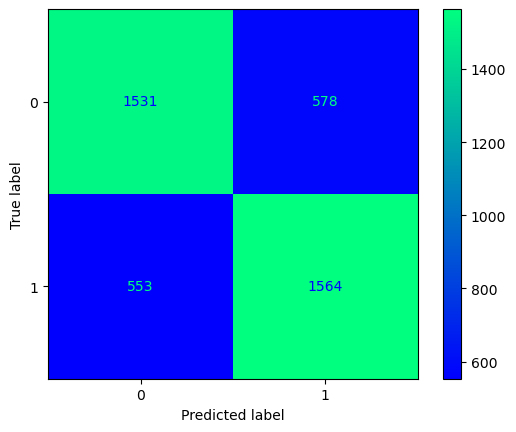

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.73      0.73      0.73      2109
           1       0.73      0.74      0.73      2117

    accuracy                           0.73      4226
   macro avg       0.73      0.73      0.73      4226
weighted avg       0.73      0.73      0.73      4226

-------------------------


In [168]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m2_10min.catboost_GridS()

In [169]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m2_10min,y_val_m2_10min)

Accuracy validación 0.7360848163574404


In [170]:
guardar_modelo(modelo_entrenado_15min,"m2_catboost_GridS_10min")

### Recopilación resultados

In [171]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m2_catboost_GridS", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 7.8. XGBoost

### Partidas 15 min

Hora de inicio:  03:10:46
Hora de fin:  03:10:48
-------------------------
Accuracy train 0.961043498515111
Accuracy test 0.7743362831858407
-------------------------
-------------------------
Matriz de confusión


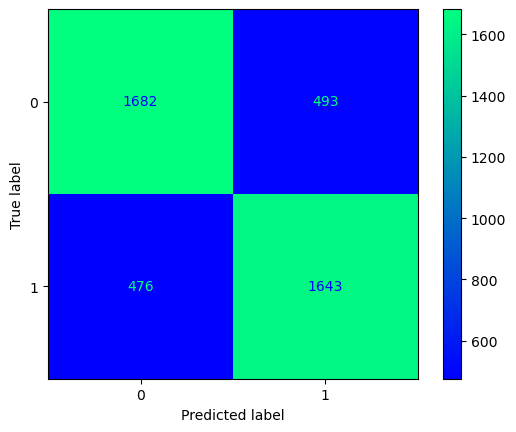

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.78      0.77      0.78      2175
           1       0.77      0.78      0.77      2119

    accuracy                           0.77      4294
   macro avg       0.77      0.77      0.77      4294
weighted avg       0.77      0.77      0.77      4294

-------------------------


In [172]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m2_15min.xgboost()

In [173]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m2_15min,y_val_m2_15min)

Accuracy validación 0.7779019936649898


In [174]:
guardar_modelo(modelo_entrenado_15min,"m2_xgboost_15min")

### Partidas 10 min

Hora de inicio:  03:10:48
Hora de fin:  03:10:49
-------------------------
Accuracy train 0.9384060114786107
Accuracy test 0.7217226691907241
-------------------------
-------------------------
Matriz de confusión


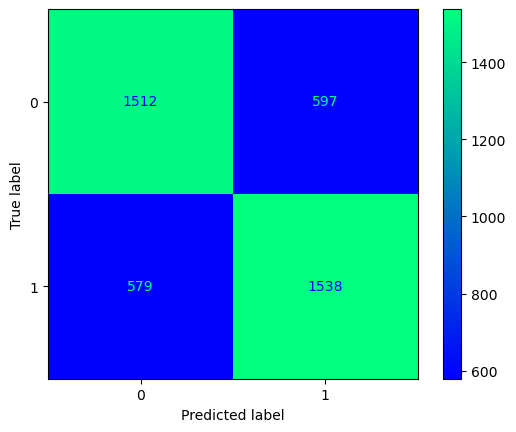

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.72      0.72      0.72      2109
           1       0.72      0.73      0.72      2117

    accuracy                           0.72      4226
   macro avg       0.72      0.72      0.72      4226
weighted avg       0.72      0.72      0.72      4226

-------------------------


In [175]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m2_10min.xgboost()

In [176]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m2_10min,y_val_m2_10min)

Accuracy validación 0.7040893600908746


In [177]:
guardar_modelo(modelo_entrenado_15min,"m2_xgboost_10min")

### Recopilación resultados

In [178]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m2_xgboost", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 7.9. XGBoost Optimizado

Este no

# 7.10. Lightgbm

### Partidas 15 min

Hora de inicio:  03:10:50
Hora de fin:  03:10:50
-------------------------
Accuracy train 0.8838874978163396
Accuracy test 0.7899394503959013
-------------------------
-------------------------
Matriz de confusión


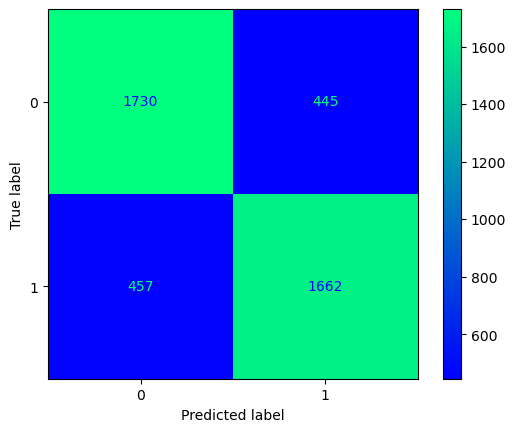

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.79      0.80      0.79      2175
           1       0.79      0.78      0.79      2119

    accuracy                           0.79      4294
   macro avg       0.79      0.79      0.79      4294
weighted avg       0.79      0.79      0.79      4294

-------------------------


In [179]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m2_15min.lightgbm()

In [180]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m2_15min,y_val_m2_15min)

Accuracy validación 0.7931805477920626


In [181]:
guardar_modelo(modelo_entrenado_15min,"m2_lightgbm_15min")

### Partidas 10 min

Hora de inicio:  03:10:50
Hora de fin:  03:10:50
-------------------------
Accuracy train 0.8476421513519911
Accuracy test 0.7328442972077615
-------------------------
-------------------------
Matriz de confusión


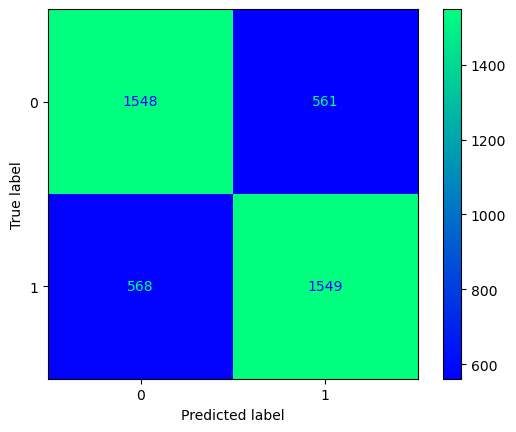

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.73      0.73      0.73      2109
           1       0.73      0.73      0.73      2117

    accuracy                           0.73      4226
   macro avg       0.73      0.73      0.73      4226
weighted avg       0.73      0.73      0.73      4226

-------------------------


In [182]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m2_10min.lightgbm()

In [183]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m2_10min,y_val_m2_10min)

Accuracy validación 0.7213176826959485


In [184]:
guardar_modelo(modelo_entrenado_15min,"m2_lightgbm_10min")

### Recopilación resultados

In [185]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m2_lightgbm", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 7.11. Lightgbm Optimizado

### Partidas 15 min

Hora de inicio:  03:10:51
Hora de fin:  03:14:28
-------------------------
Accuracy train 0.8098759680894427
Accuracy test 0.7966930600838379
-------------------------
-------------------------
Matriz de confusión


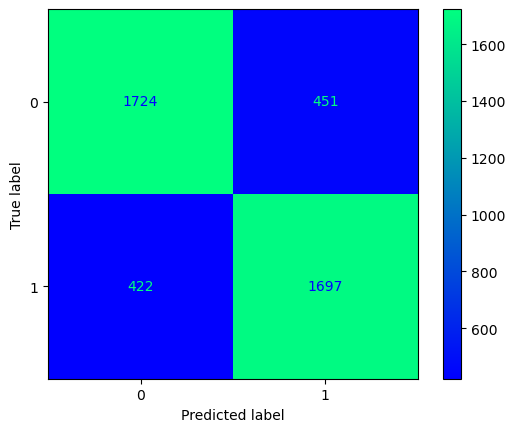

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.80      0.79      0.80      2175
           1       0.79      0.80      0.80      2119

    accuracy                           0.80      4294
   macro avg       0.80      0.80      0.80      4294
weighted avg       0.80      0.80      0.80      4294

-------------------------


In [186]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m2_15min.lightgbm_GridS()

In [187]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m2_15min,y_val_m2_15min)

Accuracy validación 0.801006148686417


In [188]:
guardar_modelo(modelo_entrenado_15min,"m2_lightgbm_GridS_15min")

### Partidas 10 min

Hora de inicio:  03:14:29
Hora de fin:  03:17:46
-------------------------
Accuracy train 0.7548074078456896
Accuracy test 0.7397065783246569
-------------------------
-------------------------
Matriz de confusión


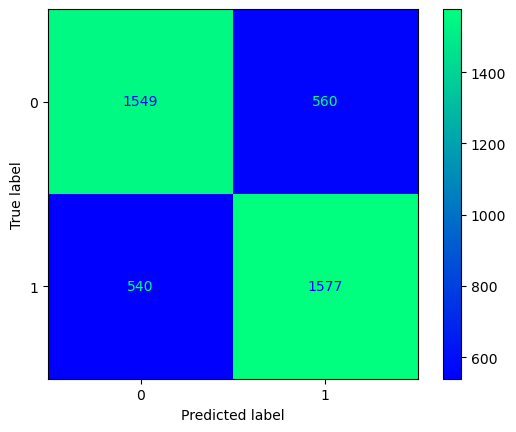

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.74      0.73      0.74      2109
           1       0.74      0.74      0.74      2117

    accuracy                           0.74      4226
   macro avg       0.74      0.74      0.74      4226
weighted avg       0.74      0.74      0.74      4226

-------------------------


In [189]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m2_10min.lightgbm_GridS()

In [190]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m2_10min,y_val_m2_10min)

Accuracy validación 0.7313517606967058


In [191]:
guardar_modelo(modelo_entrenado_15min,"m2_lightgbm_GridS_10min")

### Recopilación resultados

In [192]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m2_lightgbm_GridS", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 7.12. SVC

### Partidas 15 min

Hora de inicio:  03:17:46
Hora de fin:  03:18:00
-------------------------
Accuracy train 0.7370290572410179
Accuracy test 0.7291569632044713
-------------------------
-------------------------
Matriz de confusión


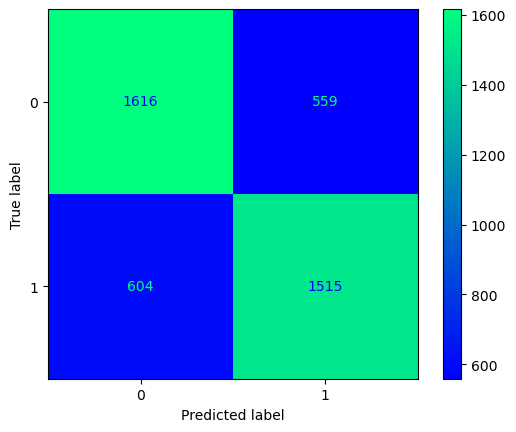

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.73      0.74      0.74      2175
           1       0.73      0.71      0.72      2119

    accuracy                           0.73      4294
   macro avg       0.73      0.73      0.73      4294
weighted avg       0.73      0.73      0.73      4294

-------------------------


In [193]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m2_15min.svc()

In [194]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m2_15min,y_val_m2_15min)

Accuracy validación 0.7398919321781255


In [195]:
guardar_modelo(modelo_entrenado_15min,"m2_svc_15min")

### Partidas 10 min

Hora de inicio:  03:18:30
Hora de fin:  03:18:44
-------------------------
Accuracy train 0.6849298858055737
Accuracy test 0.6859914813061997
-------------------------
-------------------------
Matriz de confusión


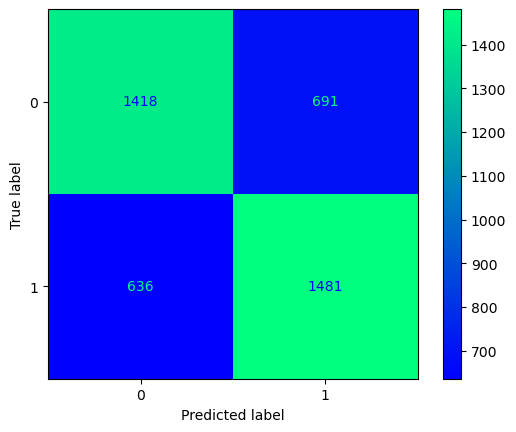

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.69      0.67      0.68      2109
           1       0.68      0.70      0.69      2117

    accuracy                           0.69      4226
   macro avg       0.69      0.69      0.69      4226
weighted avg       0.69      0.69      0.69      4226

-------------------------


In [196]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m2_10min.svc()

In [197]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m2_10min,y_val_m2_10min)

Accuracy validación 0.6755017039000378


In [198]:
guardar_modelo(modelo_entrenado_15min,"m2_svc_10min")

### Recopilación resultados

In [199]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m2_svc", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 7.13. SVC Optimizado

### Partidas 15 min

Hora de inicio:  03:19:17
Hora de fin:  03:54:30
-------------------------
Accuracy train 1.0
Accuracy test 0.6094550535631114
-------------------------
-------------------------
Matriz de confusión


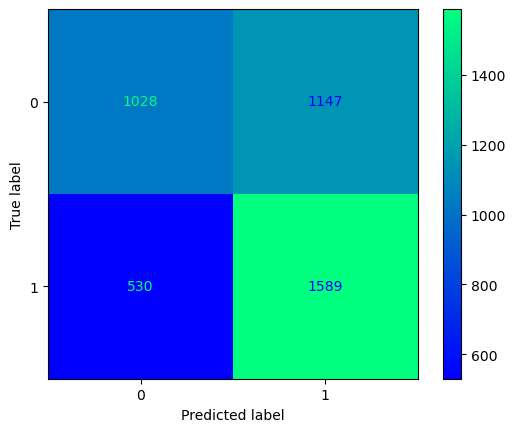

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.66      0.47      0.55      2175
           1       0.58      0.75      0.65      2119

    accuracy                           0.61      4294
   macro avg       0.62      0.61      0.60      4294
weighted avg       0.62      0.61      0.60      4294

-------------------------


In [200]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m2_15min.svc_GridS()

In [201]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m2_15min,y_val_m2_15min)

Accuracy validación 0.6158002608533631


In [202]:
guardar_modelo(modelo_entrenado_15min,"m2_svc_GridS_15min")

### Partidas 10 min

Hora de inicio:  03:55:32
Hora de fin:  04:32:17
-------------------------
Accuracy train 0.9818353943553636
Accuracy test 0.5873166114529106
-------------------------
-------------------------
Matriz de confusión


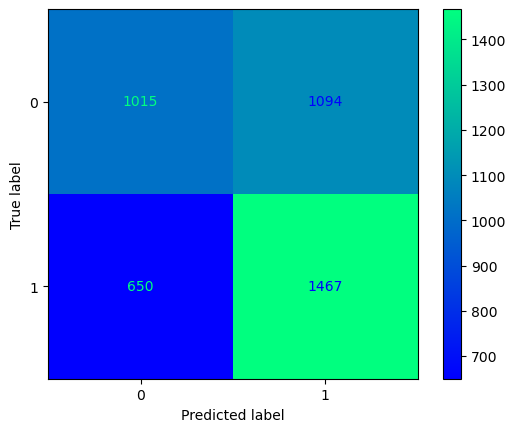

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.61      0.48      0.54      2109
           1       0.57      0.69      0.63      2117

    accuracy                           0.59      4226
   macro avg       0.59      0.59      0.58      4226
weighted avg       0.59      0.59      0.58      4226

-------------------------


In [203]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m2_10min.svc_GridS()

In [204]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m2_10min,y_val_m2_10min)

Accuracy validación 0.5819765240439227


In [205]:
guardar_modelo(modelo_entrenado_15min,"m2_svc_GridS_10min")

### Recopilación resultados

In [206]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m2_svc_GridS", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 7.14. LinearSVC

### Partidas 15 min

Hora de inicio:  04:33:15
Hora de fin:  04:33:17
-------------------------
Accuracy train 0.5203517149012985
Accuracy test 0.5256171401956218
-------------------------
-------------------------
Matriz de confusión


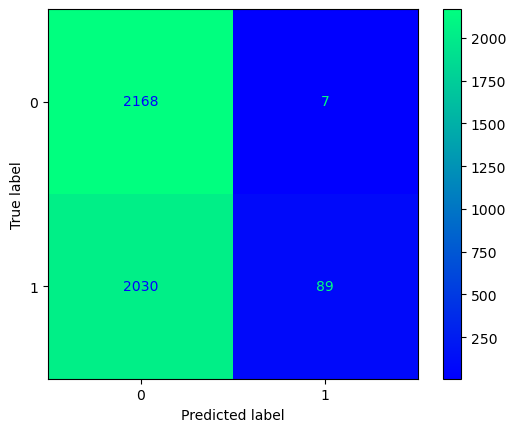

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.52      1.00      0.68      2175
           1       0.93      0.04      0.08      2119

    accuracy                           0.53      4294
   macro avg       0.72      0.52      0.38      4294
weighted avg       0.72      0.53      0.38      4294

-------------------------


In [207]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m2_15min.linearsvc()

In [208]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m2_15min,y_val_m2_15min)

Accuracy validación 0.5122042109185765


In [209]:
guardar_modelo(modelo_entrenado_15min,"m2_linearsvc_15min")

### Partidas 10 min

Hora de inicio:  04:33:17
Hora de fin:  04:33:18
-------------------------
Accuracy train 0.5112715223951245
Accuracy test 0.511831519167061
-------------------------
-------------------------
Matriz de confusión


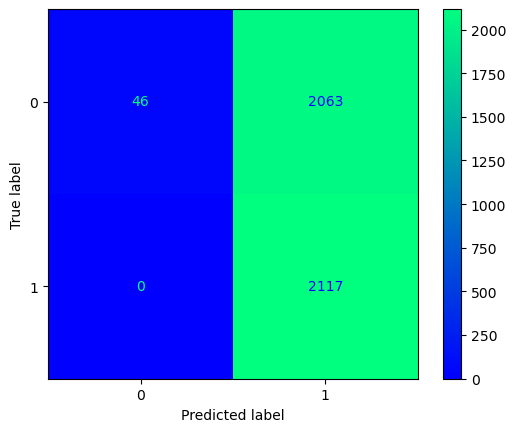

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       1.00      0.02      0.04      2109
           1       0.51      1.00      0.67      2117

    accuracy                           0.51      4226
   macro avg       0.75      0.51      0.36      4226
weighted avg       0.75      0.51      0.36      4226

-------------------------


In [210]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m2_10min.linearsvc()

In [211]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m2_10min,y_val_m2_10min)

Accuracy validación 0.5054903445664521


In [212]:
guardar_modelo(modelo_entrenado_15min,"m2_linearsvc_10min")

### Recopilación resultados

In [213]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m2_linearsvc", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 7.15. LinearSVC Optimizado

### Partidas 15 min

Hora de inicio:  04:33:19
Hora de fin:  04:37:54
-------------------------
Accuracy train 0.7307983462411926
Accuracy test 0.7382394038192828
-------------------------
-------------------------
Matriz de confusión


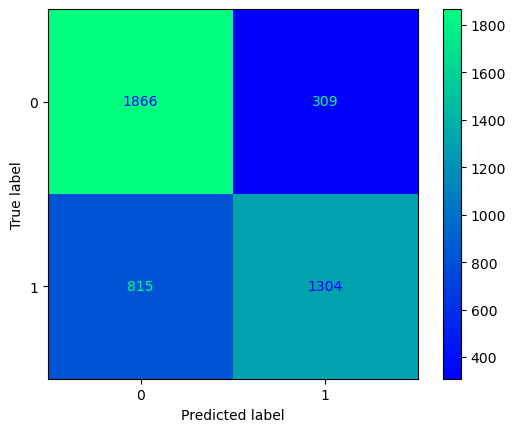

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.70      0.86      0.77      2175
           1       0.81      0.62      0.70      2119

    accuracy                           0.74      4294
   macro avg       0.75      0.74      0.73      4294
weighted avg       0.75      0.74      0.73      4294

-------------------------


In [214]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m2_15min.linearsvc_GridS()

In [215]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m2_15min,y_val_m2_15min)

Accuracy validación 0.7288988261598659


In [216]:
guardar_modelo(modelo_entrenado_15min,"m2_linearsvc_GridS_15min")

### Partidas 10 min

Hora de inicio:  04:37:54
Hora de fin:  04:41:53
-------------------------
Accuracy train 0.5032246612626472
Accuracy test 0.504259346900142
-------------------------
-------------------------
Matriz de confusión


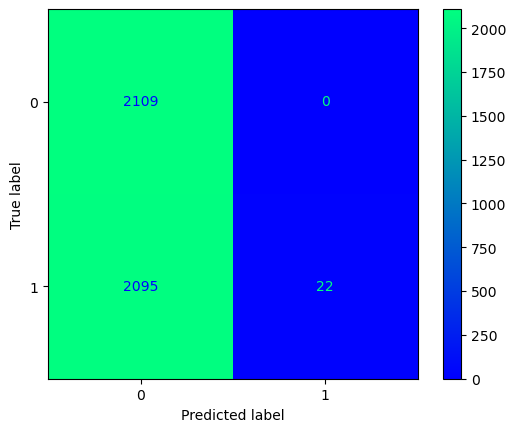

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.50      1.00      0.67      2109
           1       1.00      0.01      0.02      2117

    accuracy                           0.50      4226
   macro avg       0.75      0.51      0.34      4226
weighted avg       0.75      0.50      0.34      4226

-------------------------


In [217]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m2_10min.linearsvc_GridS()

In [218]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m2_10min,y_val_m2_10min)

Accuracy validación 0.5071942446043165


In [219]:
guardar_modelo(modelo_entrenado_15min,"m2_linearsvc_GridS_10min")

### Recopilación resultados

In [220]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m2_linearsvc_GridS", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 8. Modelo 3
Modelo basado en el modelo 2, pero aplicando un escalado a los datos. Se aplica un MinMaxScaler

In [221]:
#Se hace una copia de los datos iniciales para aplicar este modelo
m3_15min=datos_entrenamiento_15min.copy()

#Columnas muy correlacionadas >0.75. Se utiliza la función get_positive_corr_coefficient definida en el apartado Funciones
lista = list(set(get_positive_corr_coefficient(datos_entrenamiento_15min, 0.75).level_1.values))

#Segunda lista con el target y el ID
lista2 = ['blueWins','gameId']

#Se concatenan ambas listas
lista = lista + lista2

#Se crean la X y la y
X_m3_15min = m3_15min.copy()

#Bucle para eliminar las columnas obtenidas antes
for k in range(0, len(lista)):
    X_m3_15min.drop([lista[k]], axis=1, inplace=True)
    
y_m3_15min = m3_15min[['blueWins']]

#Se realiza la división 
X_train_m3_15min, X_test_m3_15min, y_train_m3_15min, y_test_m3_15min = train_test_split(X_m3_15min, y_m3_15min, test_size=0.2, random_state=42)

In [222]:
#Se preparan los datos de validación
validacion_m3_15min=datos_validacion_15min.copy()

#Se crean la X y la y
X_val_m3_15min = validacion_m3_15min.copy()

#Bucle para eliminar las columnas obtenidas antes
#Al ser datos de validación, hay que aplicar lo mismo que en train, por tanto se eliminan las mismas columnas
for k in range(0, len(lista)):
    X_val_m3_15min.drop([lista[k]], axis=1, inplace=True)
    
y_val_m3_15min = validacion_m3_15min[['blueWins']]

In [223]:
#Se hace una copia de los datos iniciales para aplicar este modelo
m3_10min=datos_entrenamiento_10min.copy()

#Columnas muy correlacionadas >0.75. Se utiliza la función get_positive_corr_coefficient definida en el apartado Funciones
lista = list(set(get_positive_corr_coefficient(datos_entrenamiento_10min, 0.75).level_1.values))

#Segunda lista con el target y el ID
lista2 = ['blueWins','gameId']

#Se concatenan ambas listas
lista = lista + lista2

#Se crean la X y la y
X_m3_10min = m3_10min.copy()

#Bucle para eliminar las columnas obtenidas antes
for k in range(0, len(lista)):
    X_m3_10min.drop([lista[k]], axis=1, inplace=True)
    
y_m3_10min = m3_10min[['blueWins']]

#Se realiza la división 
X_train_m3_10min, X_test_m3_10min, y_train_m3_10min, y_test_m3_10min = train_test_split(X_m3_10min, y_m3_10min, test_size=0.2, random_state=42)

In [224]:
#Se preparan los datos de validación
validacion_m3_10min=datos_validacion_10min.copy()

#Se crean la X y la y
X_val_m3_10min = validacion_m3_10min.copy()

#Bucle para eliminar las columnas obtenidas antes
#Al ser datos de validación, hay que aplicar lo mismo que en train, por tanto se eliminan las mismas columnas
for k in range(0, len(lista)):
    X_val_m3_10min.drop([lista[k]], axis=1, inplace=True)
    
y_val_m3_10min = validacion_m3_10min[['blueWins']]

## MinMaxScaler

In [225]:
# Se almacenan en el objeto scaler todo lo necesario para estandarizar, con los datos de train de partidas de 15min
scaler = MinMaxScaler()
scaler.fit(X_train_m3_15min)

# Se utilizan los datos de train para escalar train y test.
X_train_m3_15min = scaler.transform(X_train_m3_15min)
X_test_m3_15min = scaler.transform(X_test_m3_15min)

In [226]:
# Se almacenan en el objeto scaler todo lo necesario para estandarizar, con los datos de train de partidas de 10min
scaler = MinMaxScaler()
scaler.fit(X_train_m3_10min)

# Se utilizan los datos de train para escalar train y test.
X_train_m3_10min = scaler.transform(X_train_m3_10min)
X_test_m3_10min = scaler.transform(X_test_m3_10min)

In [227]:
# Se almacenan en el objeto scaler todo lo necesario para estandarizar, con los datos de validacion de partidas de 15min
scaler = MinMaxScaler()
scaler.fit(X_m3_15min)

# Se almacenan en el objeto scaler todo lo necesario para estandarizar, con los datos de validacion de partidas de 15min
scaler = MinMaxScaler()
scaler.fit(X_m3_10min)

MinMaxScaler()

In [228]:
#Se crean los objetos
m3_15min = Models(X_train_m3_15min, X_test_m3_15min, y_train_m3_15min, y_test_m3_15min)
m3_10min = Models(X_train_m3_10min, X_test_m3_10min, y_train_m3_10min, y_test_m3_10min)

# 8.1. LazyClassifier

In [229]:
#LazyClassifier
m3_15min.lazyclassifier()

100%|██████████████████████████████████████████████████████████████████████████████████| 29/29 [01:42<00:00,  3.53s/it]


,Accuracy,Balanced Accuracy,ROC AUC,F1 Score,Time Taken
Model,,,,,
AdaBoostClassifier,0.80,0.80,0.80,0.80,0.95
LGBMClassifier,0.80,0.80,0.80,0.80,0.17
RandomForestClassifier,0.79,0.79,0.79,0.79,2.30
SVC,0.79,0.79,0.79,0.79,16.18
NuSVC,0.79,0.79,0.79,0.79,23.38
LogisticRegression,0.79,0.79,0.79,0.79,0.10
LinearSVC,0.79,0.78,0.78,0.79,2.49
CalibratedClassifierCV,0.79,0.78,0.78,0.79,9.03
XGBClassifier,0.78,0.78,0.78,0.78,0.83


In [230]:
#LazyClassifier
m3_10min.lazyclassifier()

100%|██████████████████████████████████████████████████████████████████████████████████| 29/29 [01:50<00:00,  3.80s/it]


,Accuracy,Balanced Accuracy,ROC AUC,F1 Score,Time Taken
Model,,,,,
LGBMClassifier,0.74,0.74,0.74,0.74,0.16
RandomForestClassifier,0.74,0.74,0.74,0.74,2.19
AdaBoostClassifier,0.74,0.74,0.74,0.74,0.91
CalibratedClassifierCV,0.73,0.73,0.73,0.73,9.45
LogisticRegression,0.73,0.73,0.73,0.73,0.12
RidgeClassifierCV,0.73,0.73,0.73,0.73,0.07
LinearSVC,0.73,0.73,0.73,0.73,2.61
LinearDiscriminantAnalysis,0.73,0.73,0.73,0.73,0.10
RidgeClassifier,0.73,0.73,0.73,0.73,0.05


# 8.2. Random Forest

### Partidas 15 min

Hora de inicio:  04:45:26
Hora de fin:  04:45:30
-------------------------
Accuracy train 1.0
Accuracy test 0.788309268747089
-------------------------
-------------------------
Matriz de confusión


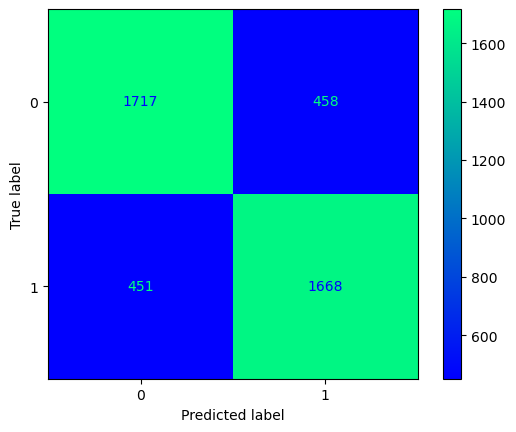

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.79      0.79      0.79      2175
           1       0.78      0.79      0.79      2119

    accuracy                           0.79      4294
   macro avg       0.79      0.79      0.79      4294
weighted avg       0.79      0.79      0.79      4294

-------------------------


In [231]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m3_15min.randomforest()

In [232]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m3_15min,y_val_m3_15min)

Accuracy validación 0.6726290292528414


In [233]:
guardar_modelo(modelo_entrenado_15min,"m3_randomforest_15min")

### Partidas 10 min

Hora de inicio:  04:45:32
Hora de fin:  04:45:36
-------------------------
Accuracy train 1.0
Accuracy test 0.7347373402744912
-------------------------
-------------------------
Matriz de confusión


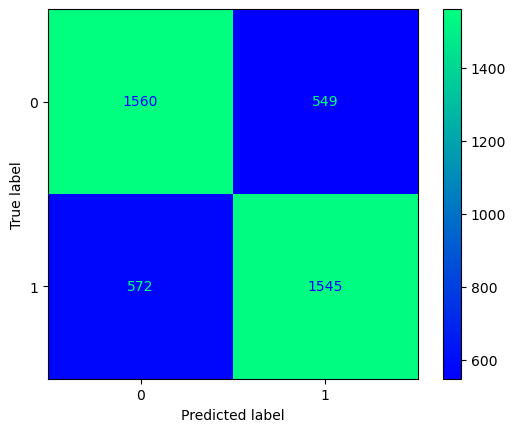

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.73      0.74      0.74      2109
           1       0.74      0.73      0.73      2117

    accuracy                           0.73      4226
   macro avg       0.73      0.73      0.73      4226
weighted avg       0.73      0.73      0.73      4226

-------------------------


In [234]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m3_10min.randomforest()

In [235]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m3_10min,y_val_m3_10min)

Accuracy validación 0.5115486558121923


In [236]:
guardar_modelo(modelo_entrenado_15min,"m3_randomforest_10min")

### Recopilación resultados

In [237]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m3_randomforest", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 8.3. Random Forest Optimizado

### Partidas 15 min

Hora de inicio:  04:45:37
Hora de fin:  05:16:15
-------------------------
Accuracy train 0.8044022593606243
Accuracy test 0.7810898928737774
-------------------------
-------------------------
Matriz de confusión


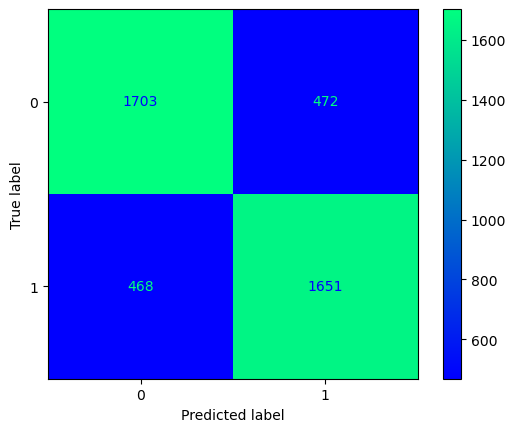

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.78      0.78      0.78      2175
           1       0.78      0.78      0.78      2119

    accuracy                           0.78      4294
   macro avg       0.78      0.78      0.78      4294
weighted avg       0.78      0.78      0.78      4294

-------------------------


In [238]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m3_15min.randomforest_GridS()

In [239]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m3_15min,y_val_m3_15min)

Accuracy validación 0.7126886528787032


In [240]:
guardar_modelo(modelo_entrenado_15min,"m3_randomforest_GridS_15min")

### Partidas 10 min

Hora de inicio:  05:16:16
Hora de fin:  05:45:46
-------------------------
Accuracy train 0.7562274421631856
Accuracy test 0.7316611452910554
-------------------------
-------------------------
Matriz de confusión


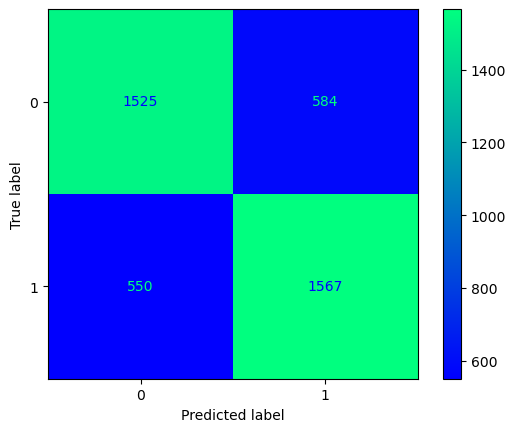

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.73      0.72      0.73      2109
           1       0.73      0.74      0.73      2117

    accuracy                           0.73      4226
   macro avg       0.73      0.73      0.73      4226
weighted avg       0.73      0.73      0.73      4226

-------------------------


In [241]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m3_10min.randomforest_GridS()

In [242]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m3_10min,y_val_m3_10min)

Accuracy validación 0.6258992805755396


In [243]:
guardar_modelo(modelo_entrenado_15min,"m3_randomforest_GridS_10min")

### Recopilación resultados

In [244]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m3_randomforest_GridS", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 8.4. Gradient boosting 

### Partidas 15 min

Hora de inicio:  05:45:47
Hora de fin:  05:45:53
-------------------------
Accuracy train 0.8154079077621849
Accuracy test 0.7943642291569633
-------------------------
-------------------------
Matriz de confusión


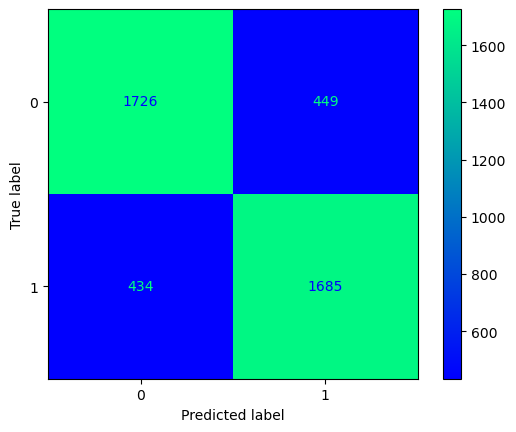

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.80      0.79      0.80      2175
           1       0.79      0.80      0.79      2119

    accuracy                           0.79      4294
   macro avg       0.79      0.79      0.79      4294
weighted avg       0.79      0.79      0.79      4294

-------------------------


In [245]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m3_15min.gradientboosting()

In [246]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m3_15min,y_val_m3_15min)

Accuracy validación 0.5071734674864915


In [247]:
guardar_modelo(modelo_entrenado_15min,"m3_gradientboosting_15min")

### Partidas 10 min

Hora de inicio:  05:45:54
Hora de fin:  05:46:00
-------------------------
Accuracy train 0.7613158984675463
Accuracy test 0.7389966871746332
-------------------------
-------------------------
Matriz de confusión


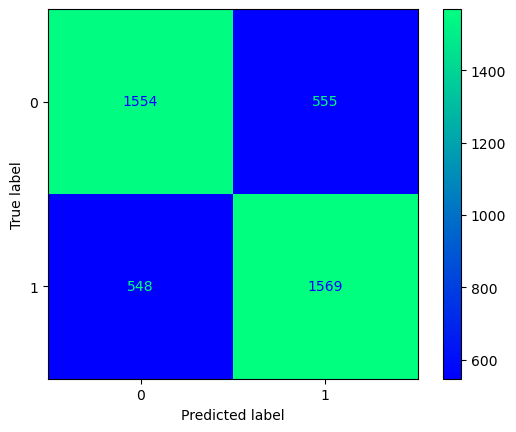

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.74      0.74      0.74      2109
           1       0.74      0.74      0.74      2117

    accuracy                           0.74      4226
   macro avg       0.74      0.74      0.74      4226
weighted avg       0.74      0.74      0.74      4226

-------------------------


In [248]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m3_10min.gradientboosting()

In [249]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m3_10min,y_val_m3_10min)

Accuracy validación 0.5030291556228701


In [250]:
guardar_modelo(modelo_entrenado_15min,"m3_gradientboosting_10min")

### Recopilación resultados

In [251]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m3_gradientboosting", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 8.5. Gradient boosting Optimizado

### Partidas 15 min

Hora de inicio:  05:46:00
Hora de fin:  06:07:32
-------------------------
Accuracy train 0.8084201944913527
Accuracy test 0.7945971122496507
-------------------------
-------------------------
Matriz de confusión


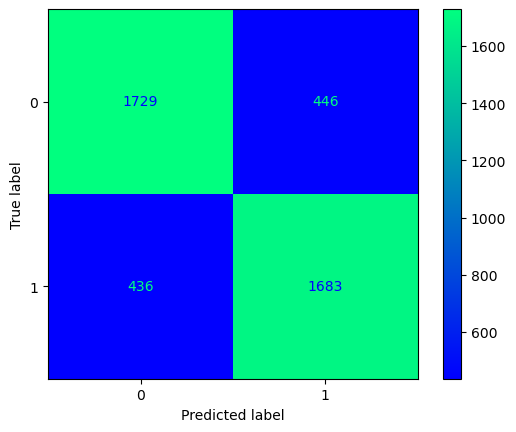

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.80      0.79      0.80      2175
           1       0.79      0.79      0.79      2119

    accuracy                           0.79      4294
   macro avg       0.79      0.79      0.79      4294
weighted avg       0.79      0.79      0.79      4294

-------------------------


In [252]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m3_15min.gradientboosting_GridS()

In [253]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m3_15min,y_val_m3_15min)

Accuracy validación 0.5226383454443824


In [254]:
guardar_modelo(modelo_entrenado_15min,"m3_gradientboosting_GridS_15min")

### Partidas 10 min

Hora de inicio:  06:07:32
Hora de fin:  06:27:46
-------------------------
Accuracy train 0.7551624164250637
Accuracy test 0.7373402744912447
-------------------------
-------------------------
Matriz de confusión


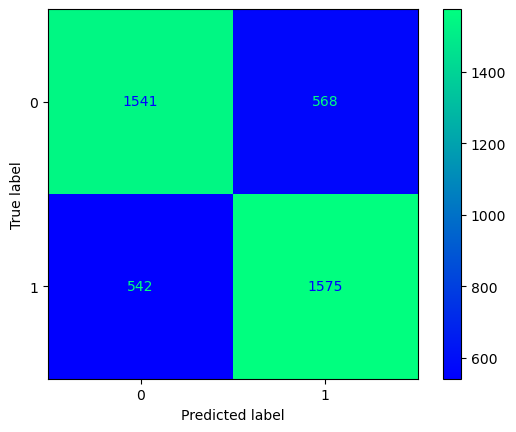

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.74      0.73      0.74      2109
           1       0.73      0.74      0.74      2117

    accuracy                           0.74      4226
   macro avg       0.74      0.74      0.74      4226
weighted avg       0.74      0.74      0.74      4226

-------------------------


In [255]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m3_10min.gradientboosting_GridS()

In [256]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m3_10min,y_val_m3_10min)

Accuracy validación 0.5314274895872776


In [257]:
guardar_modelo(modelo_entrenado_15min,"m3_gradientboosting_GridS_10min")

### Recopilación resultados

In [258]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m3_gradientboosting_GridS", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 8.6. Catboost

### Partidas 15 min

Hora de inicio:  06:27:46
Learning rate set to 0.151764
0:	learn: 0.6280478	total: 5.31ms	remaining: 1.06s
1:	learn: 0.5811880	total: 10.3ms	remaining: 1.02s
2:	learn: 0.5452961	total: 15.4ms	remaining: 1.01s
3:	learn: 0.5188547	total: 20.4ms	remaining: 1000ms
4:	learn: 0.4974394	total: 25.6ms	remaining: 998ms
5:	learn: 0.4845805	total: 30.3ms	remaining: 981ms
6:	learn: 0.4749115	total: 35.6ms	remaining: 981ms
7:	learn: 0.4669581	total: 41.1ms	remaining: 985ms
8:	learn: 0.4597429	total: 46.2ms	remaining: 980ms
9:	learn: 0.4548147	total: 51.4ms	remaining: 977ms
10:	learn: 0.4507176	total: 56.5ms	remaining: 971ms
11:	learn: 0.4466177	total: 61.8ms	remaining: 969ms
12:	learn: 0.4435788	total: 67ms	remaining: 964ms
13:	learn: 0.4406219	total: 72.5ms	remaining: 963ms
14:	learn: 0.4389668	total: 77.7ms	remaining: 958ms
15:	learn: 0.4370834	total: 82.8ms	remaining: 952ms
16:	learn: 0.4358669	total: 88ms	remaining: 947ms
17:	learn: 0.4343010	total: 93.1ms	remaining: 942ms
18:	learn: 0.4326345	

183:	learn: 0.3487500	total: 948ms	remaining: 82.5ms
184:	learn: 0.3484205	total: 954ms	remaining: 77.3ms
185:	learn: 0.3481655	total: 958ms	remaining: 72.1ms
186:	learn: 0.3478668	total: 963ms	remaining: 67ms
187:	learn: 0.3476417	total: 968ms	remaining: 61.8ms
188:	learn: 0.3476029	total: 973ms	remaining: 56.6ms
189:	learn: 0.3471196	total: 977ms	remaining: 51.4ms
190:	learn: 0.3466318	total: 982ms	remaining: 46.3ms
191:	learn: 0.3461263	total: 987ms	remaining: 41.1ms
192:	learn: 0.3457525	total: 993ms	remaining: 36ms
193:	learn: 0.3454964	total: 998ms	remaining: 30.9ms
194:	learn: 0.3451715	total: 1s	remaining: 25.7ms
195:	learn: 0.3447156	total: 1.01s	remaining: 20.6ms
196:	learn: 0.3441945	total: 1.01s	remaining: 15.4ms
197:	learn: 0.3439007	total: 1.02s	remaining: 10.3ms
198:	learn: 0.3435263	total: 1.02s	remaining: 5.14ms
199:	learn: 0.3429132	total: 1.03s	remaining: 0us
Hora de fin:  06:27:47
-------------------------
Accuracy train 0.8501717812845746
Accuracy test 0.7952957615

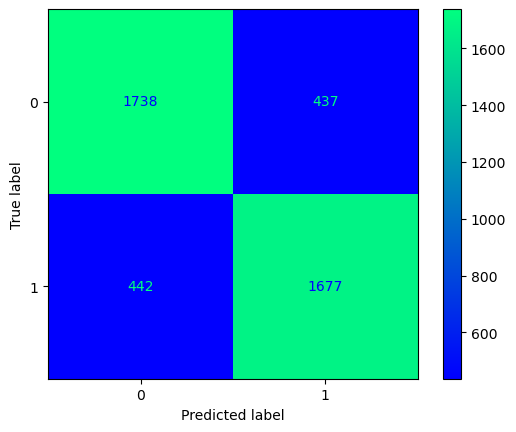

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.80      0.80      0.80      2175
           1       0.79      0.79      0.79      2119

    accuracy                           0.80      4294
   macro avg       0.80      0.80      0.80      4294
weighted avg       0.80      0.80      0.80      4294

-------------------------


In [259]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m3_15min.catboost()

In [260]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m3_15min,y_val_m3_15min)

Accuracy validación 0.5423886715110863


In [261]:
guardar_modelo(modelo_entrenado_15min,"m3_catboost_15min")

### Partidas 10 min

Hora de inicio:  06:27:47
Learning rate set to 0.150733
0:	learn: 0.6515417	total: 5.41ms	remaining: 1.08s
1:	learn: 0.6211600	total: 11.4ms	remaining: 1.13s
2:	learn: 0.5981348	total: 17.1ms	remaining: 1.12s
3:	learn: 0.5814208	total: 22.8ms	remaining: 1.11s
4:	learn: 0.5700351	total: 28.5ms	remaining: 1.11s
5:	learn: 0.5612233	total: 34.4ms	remaining: 1.11s
6:	learn: 0.5540599	total: 40.2ms	remaining: 1.11s
7:	learn: 0.5494562	total: 45.7ms	remaining: 1.1s
8:	learn: 0.5450298	total: 51.2ms	remaining: 1.08s
9:	learn: 0.5421207	total: 56.8ms	remaining: 1.08s
10:	learn: 0.5379909	total: 62.3ms	remaining: 1.07s
11:	learn: 0.5349434	total: 67.9ms	remaining: 1.06s
12:	learn: 0.5328604	total: 73.3ms	remaining: 1.05s
13:	learn: 0.5312753	total: 78.9ms	remaining: 1.05s
14:	learn: 0.5289388	total: 84.5ms	remaining: 1.04s
15:	learn: 0.5273856	total: 90.1ms	remaining: 1.03s
16:	learn: 0.5258589	total: 95.6ms	remaining: 1.03s
17:	learn: 0.5243418	total: 101ms	remaining: 1.02s
18:	learn: 0.5233372

170:	learn: 0.4458999	total: 968ms	remaining: 164ms
171:	learn: 0.4455046	total: 974ms	remaining: 159ms
172:	learn: 0.4450175	total: 979ms	remaining: 153ms
173:	learn: 0.4448757	total: 985ms	remaining: 147ms
174:	learn: 0.4448534	total: 990ms	remaining: 141ms
175:	learn: 0.4446007	total: 995ms	remaining: 136ms
176:	learn: 0.4441117	total: 1s	remaining: 130ms
177:	learn: 0.4436871	total: 1.01s	remaining: 124ms
178:	learn: 0.4431720	total: 1.01s	remaining: 119ms
179:	learn: 0.4426345	total: 1.02s	remaining: 113ms
180:	learn: 0.4421865	total: 1.02s	remaining: 107ms
181:	learn: 0.4415904	total: 1.03s	remaining: 102ms
182:	learn: 0.4410504	total: 1.03s	remaining: 96.2ms
183:	learn: 0.4405852	total: 1.04s	remaining: 90.6ms
184:	learn: 0.4401967	total: 1.05s	remaining: 84.9ms
185:	learn: 0.4400096	total: 1.05s	remaining: 79.3ms
186:	learn: 0.4397077	total: 1.06s	remaining: 73.6ms
187:	learn: 0.4392933	total: 1.06s	remaining: 67.9ms
188:	learn: 0.4390404	total: 1.07s	remaining: 62.3ms
189:	lea

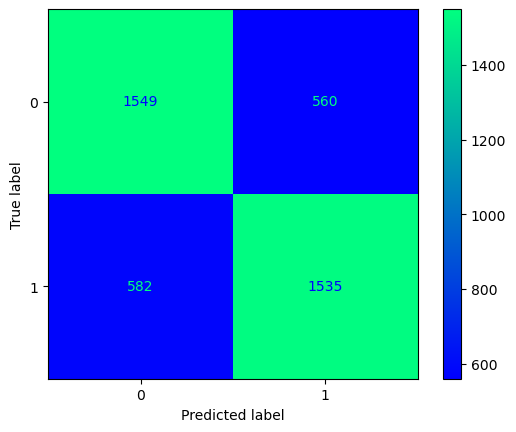

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.73      0.73      0.73      2109
           1       0.73      0.73      0.73      2117

    accuracy                           0.73      4226
   macro avg       0.73      0.73      0.73      4226
weighted avg       0.73      0.73      0.73      4226

-------------------------


In [262]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m3_10min.catboost()

In [263]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m3_10min,y_val_m3_10min)

Accuracy validación 0.5098447557743279


In [264]:
guardar_modelo(modelo_entrenado_15min,"m3_catboost_10min")

### Recopilación resultados

In [265]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m3_catboost", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 8.7. CatBoost Optimizado

### Partidas 15 min

Hora de inicio:  06:27:49
0:	learn: 0.6729135	test: 0.6719676	best: 0.6719676 (0)	total: 3.02ms	remaining: 299ms
1:	learn: 0.6564123	test: 0.6545196	best: 0.6545196 (1)	total: 5.96ms	remaining: 292ms
2:	learn: 0.6403817	test: 0.6377959	best: 0.6377959 (2)	total: 8.72ms	remaining: 282ms
3:	learn: 0.6262070	test: 0.6229564	best: 0.6229564 (3)	total: 11.6ms	remaining: 277ms
4:	learn: 0.6140539	test: 0.6101655	best: 0.6101655 (4)	total: 14.4ms	remaining: 274ms
5:	learn: 0.6037135	test: 0.5990991	best: 0.5990991 (5)	total: 17.1ms	remaining: 268ms
6:	learn: 0.5925952	test: 0.5874633	best: 0.5874633 (6)	total: 19.9ms	remaining: 265ms
7:	learn: 0.5826162	test: 0.5771491	best: 0.5771491 (7)	total: 22.7ms	remaining: 261ms
8:	learn: 0.5727664	test: 0.5672314	best: 0.5672314 (8)	total: 25.9ms	remaining: 262ms
9:	learn: 0.5635804	test: 0.5573817	best: 0.5573817 (9)	total: 28.9ms	remaining: 260ms
10:	learn: 0.5563519	test: 0.5499694	best: 0.5499694 (10)	total: 32.2ms	remaining: 260ms
11:	learn: 0.54

13:	learn: 0.4867824	test: 0.4752858	best: 0.4752858 (13)	total: 39.6ms	remaining: 243ms
14:	learn: 0.4826549	test: 0.4708439	best: 0.4708439 (14)	total: 42.7ms	remaining: 242ms
15:	learn: 0.4792441	test: 0.4676198	best: 0.4676198 (15)	total: 45.3ms	remaining: 238ms
16:	learn: 0.4763511	test: 0.4642902	best: 0.4642902 (16)	total: 48ms	remaining: 234ms
17:	learn: 0.4734602	test: 0.4607168	best: 0.4607168 (17)	total: 50.9ms	remaining: 232ms
18:	learn: 0.4713801	test: 0.4586936	best: 0.4586936 (18)	total: 54ms	remaining: 230ms
19:	learn: 0.4696792	test: 0.4566439	best: 0.4566439 (19)	total: 56.8ms	remaining: 227ms
20:	learn: 0.4677619	test: 0.4541345	best: 0.4541345 (20)	total: 66.3ms	remaining: 249ms
21:	learn: 0.4655859	test: 0.4518369	best: 0.4518369 (21)	total: 74.6ms	remaining: 264ms
22:	learn: 0.4639955	test: 0.4506448	best: 0.4506448 (22)	total: 77.4ms	remaining: 259ms
23:	learn: 0.4628463	test: 0.4494412	best: 0.4494412 (23)	total: 80ms	remaining: 253ms
24:	learn: 0.4615320	test: 

53:	learn: 0.4311956	test: 0.4170006	best: 0.4170006 (53)	total: 150ms	remaining: 128ms
54:	learn: 0.4307932	test: 0.4166791	best: 0.4166791 (54)	total: 154ms	remaining: 126ms
55:	learn: 0.4305791	test: 0.4165616	best: 0.4165616 (55)	total: 156ms	remaining: 123ms
56:	learn: 0.4302522	test: 0.4162670	best: 0.4162670 (56)	total: 159ms	remaining: 120ms
57:	learn: 0.4300997	test: 0.4160398	best: 0.4160398 (57)	total: 162ms	remaining: 117ms
58:	learn: 0.4298586	test: 0.4158055	best: 0.4158055 (58)	total: 164ms	remaining: 114ms
59:	learn: 0.4294873	test: 0.4153020	best: 0.4153020 (59)	total: 167ms	remaining: 111ms
60:	learn: 0.4292300	test: 0.4150555	best: 0.4150555 (60)	total: 170ms	remaining: 109ms
61:	learn: 0.4290273	test: 0.4149335	best: 0.4149335 (61)	total: 172ms	remaining: 106ms
62:	learn: 0.4287089	test: 0.4146906	best: 0.4146906 (62)	total: 175ms	remaining: 103ms
63:	learn: 0.4284176	test: 0.4145587	best: 0.4145587 (63)	total: 178ms	remaining: 99.9ms
64:	learn: 0.4281652	test: 0.41

54:	learn: 0.4267031	test: 0.4104364	best: 0.4104364 (54)	total: 151ms	remaining: 123ms
55:	learn: 0.4262730	test: 0.4102083	best: 0.4102083 (55)	total: 154ms	remaining: 121ms
56:	learn: 0.4260144	test: 0.4099839	best: 0.4099839 (56)	total: 157ms	remaining: 118ms
57:	learn: 0.4257155	test: 0.4101944	best: 0.4099839 (56)	total: 159ms	remaining: 115ms
58:	learn: 0.4253348	test: 0.4098711	best: 0.4098711 (58)	total: 162ms	remaining: 113ms
59:	learn: 0.4249311	test: 0.4094148	best: 0.4094148 (59)	total: 165ms	remaining: 110ms
60:	learn: 0.4245816	test: 0.4093801	best: 0.4093801 (60)	total: 168ms	remaining: 107ms
61:	learn: 0.4242016	test: 0.4091958	best: 0.4091958 (61)	total: 170ms	remaining: 104ms
62:	learn: 0.4238798	test: 0.4089797	best: 0.4089797 (62)	total: 173ms	remaining: 102ms
63:	learn: 0.4232156	test: 0.4086871	best: 0.4086871 (63)	total: 176ms	remaining: 98.9ms
64:	learn: 0.4228829	test: 0.4086412	best: 0.4086412 (64)	total: 179ms	remaining: 96.2ms
65:	learn: 0.4226017	test: 0.4

61:	learn: 0.4054969	test: 0.4244224	best: 0.4136615 (27)	total: 168ms	remaining: 103ms
62:	learn: 0.4051240	test: 0.4249406	best: 0.4136615 (27)	total: 171ms	remaining: 100ms
63:	learn: 0.4046248	test: 0.4251561	best: 0.4136615 (27)	total: 173ms	remaining: 97.5ms
64:	learn: 0.4040047	test: 0.4256633	best: 0.4136615 (27)	total: 176ms	remaining: 94.7ms
65:	learn: 0.4033110	test: 0.4256002	best: 0.4136615 (27)	total: 178ms	remaining: 91.9ms
66:	learn: 0.4025934	test: 0.4257076	best: 0.4136615 (27)	total: 181ms	remaining: 89.1ms
67:	learn: 0.4021256	test: 0.4256210	best: 0.4136615 (27)	total: 183ms	remaining: 86.3ms
68:	learn: 0.4015210	test: 0.4256767	best: 0.4136615 (27)	total: 186ms	remaining: 83.5ms
69:	learn: 0.4010539	test: 0.4272833	best: 0.4136615 (27)	total: 189ms	remaining: 80.9ms
70:	learn: 0.4007369	test: 0.4279285	best: 0.4136615 (27)	total: 191ms	remaining: 78.1ms
71:	learn: 0.4001166	test: 0.4278011	best: 0.4136615 (27)	total: 194ms	remaining: 75.3ms
72:	learn: 0.3996512	te

72:	learn: 0.4478791	test: 0.4326839	best: 0.4326839 (72)	total: 209ms	remaining: 77.2ms
73:	learn: 0.4476877	test: 0.4324584	best: 0.4324584 (73)	total: 212ms	remaining: 74.5ms
74:	learn: 0.4473296	test: 0.4320135	best: 0.4320135 (74)	total: 215ms	remaining: 71.7ms
75:	learn: 0.4470306	test: 0.4317247	best: 0.4317247 (75)	total: 218ms	remaining: 68.9ms
76:	learn: 0.4467429	test: 0.4314953	best: 0.4314953 (76)	total: 221ms	remaining: 65.9ms
77:	learn: 0.4463780	test: 0.4310526	best: 0.4310526 (77)	total: 223ms	remaining: 63ms
78:	learn: 0.4461148	test: 0.4307788	best: 0.4307788 (78)	total: 226ms	remaining: 60.1ms
79:	learn: 0.4458001	test: 0.4303800	best: 0.4303800 (79)	total: 229ms	remaining: 57.1ms
80:	learn: 0.4452924	test: 0.4297617	best: 0.4297617 (80)	total: 231ms	remaining: 54.2ms
81:	learn: 0.4449553	test: 0.4295076	best: 0.4295076 (81)	total: 234ms	remaining: 51.3ms
82:	learn: 0.4446008	test: 0.4291240	best: 0.4291240 (82)	total: 237ms	remaining: 48.5ms
83:	learn: 0.4441573	te

79:	learn: 0.4314665	test: 0.4160997	best: 0.4160997 (79)	total: 222ms	remaining: 55.6ms
80:	learn: 0.4311576	test: 0.4158346	best: 0.4158346 (80)	total: 226ms	remaining: 53ms
81:	learn: 0.4309469	test: 0.4156671	best: 0.4156671 (81)	total: 228ms	remaining: 50.1ms
82:	learn: 0.4307694	test: 0.4156389	best: 0.4156389 (82)	total: 231ms	remaining: 47.4ms
83:	learn: 0.4306380	test: 0.4155223	best: 0.4155223 (83)	total: 234ms	remaining: 44.5ms
84:	learn: 0.4304907	test: 0.4155254	best: 0.4155223 (83)	total: 236ms	remaining: 41.7ms
85:	learn: 0.4302086	test: 0.4153680	best: 0.4153680 (85)	total: 239ms	remaining: 38.9ms
86:	learn: 0.4299147	test: 0.4151034	best: 0.4151034 (86)	total: 242ms	remaining: 36.2ms
87:	learn: 0.4297870	test: 0.4150831	best: 0.4150831 (87)	total: 244ms	remaining: 33.3ms
88:	learn: 0.4295881	test: 0.4149594	best: 0.4149594 (88)	total: 247ms	remaining: 30.5ms
89:	learn: 0.4293095	test: 0.4147122	best: 0.4147122 (89)	total: 250ms	remaining: 27.8ms
90:	learn: 0.4291393	te

91:	learn: 0.4194003	test: 0.4095604	best: 0.4095092 (90)	total: 253ms	remaining: 22ms
92:	learn: 0.4192416	test: 0.4094814	best: 0.4094814 (92)	total: 256ms	remaining: 19.3ms
93:	learn: 0.4189288	test: 0.4094880	best: 0.4094814 (92)	total: 258ms	remaining: 16.5ms
94:	learn: 0.4187604	test: 0.4094356	best: 0.4094356 (94)	total: 261ms	remaining: 13.7ms
95:	learn: 0.4184659	test: 0.4098436	best: 0.4094356 (94)	total: 264ms	remaining: 11ms
96:	learn: 0.4182310	test: 0.4098027	best: 0.4094356 (94)	total: 267ms	remaining: 8.25ms
97:	learn: 0.4180529	test: 0.4097338	best: 0.4094356 (94)	total: 269ms	remaining: 5.5ms
98:	learn: 0.4178435	test: 0.4098306	best: 0.4094356 (94)	total: 272ms	remaining: 2.75ms
99:	learn: 0.4175488	test: 0.4097816	best: 0.4094356 (94)	total: 275ms	remaining: 0us

bestTest = 0.4094355908
bestIteration = 94

7:	loss: 0.4094356	best: 0.4067612 (3)	total: 2.29s	remaining: 36.4s
0:	learn: 0.6204892	test: 0.6168887	best: 0.6168887 (0)	total: 2.71ms	remaining: 269ms
1:	lea

3:	learn: 0.4693052	test: 0.4513232	best: 0.4513232 (3)	total: 11.9ms	remaining: 286ms
4:	learn: 0.4633636	test: 0.4441741	best: 0.4441741 (4)	total: 14.8ms	remaining: 281ms
5:	learn: 0.4574707	test: 0.4387627	best: 0.4387627 (5)	total: 17.8ms	remaining: 279ms
6:	learn: 0.4533940	test: 0.4351739	best: 0.4351739 (6)	total: 20.2ms	remaining: 269ms
7:	learn: 0.4474338	test: 0.4290485	best: 0.4290485 (7)	total: 22.8ms	remaining: 262ms
8:	learn: 0.4453214	test: 0.4276671	best: 0.4276671 (8)	total: 25.3ms	remaining: 256ms
9:	learn: 0.4438299	test: 0.4250512	best: 0.4250512 (9)	total: 27.9ms	remaining: 251ms
10:	learn: 0.4423903	test: 0.4236981	best: 0.4236981 (10)	total: 30.4ms	remaining: 246ms
11:	learn: 0.4408831	test: 0.4218641	best: 0.4218641 (11)	total: 33ms	remaining: 242ms
12:	learn: 0.4396031	test: 0.4210276	best: 0.4210276 (12)	total: 36ms	remaining: 241ms
13:	learn: 0.4380237	test: 0.4192501	best: 0.4192501 (13)	total: 38.6ms	remaining: 237ms
14:	learn: 0.4363178	test: 0.4169604	be

14:	learn: 0.5309091	test: 0.5234774	best: 0.5234774 (14)	total: 43.3ms	remaining: 246ms
15:	learn: 0.5267037	test: 0.5195501	best: 0.5195501 (15)	total: 46.5ms	remaining: 244ms
16:	learn: 0.5221818	test: 0.5145902	best: 0.5145902 (16)	total: 49.2ms	remaining: 240ms
17:	learn: 0.5171685	test: 0.5090878	best: 0.5090878 (17)	total: 52.4ms	remaining: 239ms
18:	learn: 0.5130606	test: 0.5046977	best: 0.5046977 (18)	total: 55.2ms	remaining: 235ms
19:	learn: 0.5091938	test: 0.5005165	best: 0.5005165 (19)	total: 58ms	remaining: 232ms
20:	learn: 0.5060917	test: 0.4970480	best: 0.4970480 (20)	total: 60.8ms	remaining: 229ms
21:	learn: 0.5027119	test: 0.4935474	best: 0.4935474 (21)	total: 63.4ms	remaining: 225ms
22:	learn: 0.4996021	test: 0.4904725	best: 0.4904725 (22)	total: 66ms	remaining: 221ms
23:	learn: 0.4965049	test: 0.4871330	best: 0.4871330 (23)	total: 69ms	remaining: 218ms
24:	learn: 0.4938759	test: 0.4840960	best: 0.4840960 (24)	total: 71.6ms	remaining: 215ms
25:	learn: 0.4914627	test: 

20:	learn: 0.4677619	test: 0.4541345	best: 0.4541345 (20)	total: 58.9ms	remaining: 222ms
21:	learn: 0.4655859	test: 0.4518369	best: 0.4518369 (21)	total: 61.8ms	remaining: 219ms
22:	learn: 0.4639955	test: 0.4506448	best: 0.4506448 (22)	total: 64.5ms	remaining: 216ms
23:	learn: 0.4628463	test: 0.4494412	best: 0.4494412 (23)	total: 67.2ms	remaining: 213ms
24:	learn: 0.4615320	test: 0.4480248	best: 0.4480248 (24)	total: 69.7ms	remaining: 209ms
25:	learn: 0.4598459	test: 0.4463053	best: 0.4463053 (25)	total: 72.7ms	remaining: 207ms
26:	learn: 0.4586745	test: 0.4452671	best: 0.4452671 (26)	total: 75.3ms	remaining: 204ms
27:	learn: 0.4573286	test: 0.4437603	best: 0.4437603 (27)	total: 77.9ms	remaining: 200ms
28:	learn: 0.4562356	test: 0.4424994	best: 0.4424994 (28)	total: 80.6ms	remaining: 197ms
29:	learn: 0.4549685	test: 0.4410771	best: 0.4410771 (29)	total: 83.2ms	remaining: 194ms
30:	learn: 0.4534948	test: 0.4392601	best: 0.4392601 (30)	total: 86.1ms	remaining: 192ms
31:	learn: 0.4527044	

32:	learn: 0.4402355	test: 0.4243598	best: 0.4243598 (32)	total: 92.4ms	remaining: 188ms
33:	learn: 0.4397016	test: 0.4242200	best: 0.4242200 (33)	total: 95.3ms	remaining: 185ms
34:	learn: 0.4392609	test: 0.4237522	best: 0.4237522 (34)	total: 97.9ms	remaining: 182ms
35:	learn: 0.4381170	test: 0.4220493	best: 0.4220493 (35)	total: 101ms	remaining: 179ms
36:	learn: 0.4374840	test: 0.4218266	best: 0.4218266 (36)	total: 103ms	remaining: 176ms
37:	learn: 0.4368089	test: 0.4212398	best: 0.4212398 (37)	total: 106ms	remaining: 173ms
38:	learn: 0.4362384	test: 0.4206383	best: 0.4206383 (38)	total: 109ms	remaining: 171ms
39:	learn: 0.4360204	test: 0.4204646	best: 0.4204646 (39)	total: 112ms	remaining: 168ms
40:	learn: 0.4357611	test: 0.4204432	best: 0.4204432 (40)	total: 115ms	remaining: 165ms
41:	learn: 0.4355414	test: 0.4201434	best: 0.4201434 (41)	total: 117ms	remaining: 162ms
42:	learn: 0.4353846	test: 0.4199894	best: 0.4199894 (42)	total: 120ms	remaining: 159ms
43:	learn: 0.4347306	test: 0.

34:	learn: 0.4348945	test: 0.4173790	best: 0.4173790 (34)	total: 95.7ms	remaining: 178ms
35:	learn: 0.4345686	test: 0.4172612	best: 0.4172612 (35)	total: 98.7ms	remaining: 175ms
36:	learn: 0.4342263	test: 0.4168617	best: 0.4168617 (36)	total: 101ms	remaining: 172ms
37:	learn: 0.4339221	test: 0.4163727	best: 0.4163727 (37)	total: 104ms	remaining: 170ms
38:	learn: 0.4335449	test: 0.4161948	best: 0.4161948 (38)	total: 107ms	remaining: 167ms
39:	learn: 0.4330782	test: 0.4158457	best: 0.4158457 (39)	total: 110ms	remaining: 165ms
40:	learn: 0.4327568	test: 0.4154720	best: 0.4154720 (40)	total: 112ms	remaining: 162ms
41:	learn: 0.4322744	test: 0.4148220	best: 0.4148220 (41)	total: 115ms	remaining: 159ms
42:	learn: 0.4317843	test: 0.4142960	best: 0.4142960 (42)	total: 118ms	remaining: 156ms
43:	learn: 0.4313066	test: 0.4139324	best: 0.4139324 (43)	total: 121ms	remaining: 153ms
44:	learn: 0.4308070	test: 0.4133561	best: 0.4133561 (44)	total: 123ms	remaining: 151ms
45:	learn: 0.4304261	test: 0.4

63:	learn: 0.4046248	test: 0.4251561	best: 0.4136615 (27)	total: 173ms	remaining: 97.5ms
64:	learn: 0.4040047	test: 0.4256633	best: 0.4136615 (27)	total: 176ms	remaining: 95ms
65:	learn: 0.4033110	test: 0.4256002	best: 0.4136615 (27)	total: 179ms	remaining: 92.2ms
66:	learn: 0.4025934	test: 0.4257076	best: 0.4136615 (27)	total: 181ms	remaining: 89.4ms
67:	learn: 0.4021256	test: 0.4256210	best: 0.4136615 (27)	total: 184ms	remaining: 86.5ms
68:	learn: 0.4015210	test: 0.4256767	best: 0.4136615 (27)	total: 186ms	remaining: 83.7ms
69:	learn: 0.4010539	test: 0.4272833	best: 0.4136615 (27)	total: 189ms	remaining: 81.1ms
70:	learn: 0.4007369	test: 0.4279285	best: 0.4136615 (27)	total: 192ms	remaining: 78.3ms
71:	learn: 0.4001166	test: 0.4278011	best: 0.4136615 (27)	total: 194ms	remaining: 75.5ms
72:	learn: 0.3996512	test: 0.4279814	best: 0.4136615 (27)	total: 196ms	remaining: 72.7ms
73:	learn: 0.3990797	test: 0.4288091	best: 0.4136615 (27)	total: 199ms	remaining: 69.9ms
74:	learn: 0.3986488	te

110:	learn: 0.4383892	test: 0.4229726	best: 0.4229726 (110)	total: 308ms	remaining: 108ms
111:	learn: 0.4380889	test: 0.4226465	best: 0.4226465 (111)	total: 311ms	remaining: 105ms
112:	learn: 0.4378355	test: 0.4224144	best: 0.4224144 (112)	total: 314ms	remaining: 103ms
113:	learn: 0.4376359	test: 0.4223034	best: 0.4223034 (113)	total: 316ms	remaining: 99.9ms
114:	learn: 0.4374455	test: 0.4221198	best: 0.4221198 (114)	total: 319ms	remaining: 97.1ms
115:	learn: 0.4373133	test: 0.4220868	best: 0.4220868 (115)	total: 322ms	remaining: 94.3ms
116:	learn: 0.4371391	test: 0.4218456	best: 0.4218456 (116)	total: 324ms	remaining: 91.4ms
117:	learn: 0.4370016	test: 0.4217330	best: 0.4217330 (117)	total: 327ms	remaining: 88.7ms
118:	learn: 0.4366441	test: 0.4215439	best: 0.4215439 (118)	total: 330ms	remaining: 85.9ms
119:	learn: 0.4363530	test: 0.4213375	best: 0.4213375 (119)	total: 333ms	remaining: 83.1ms
120:	learn: 0.4361176	test: 0.4211613	best: 0.4211613 (120)	total: 335ms	remaining: 80.4ms
12

108:	learn: 0.4246392	test: 0.4119261	best: 0.4119261 (108)	total: 298ms	remaining: 112ms
109:	learn: 0.4243959	test: 0.4119724	best: 0.4119261 (108)	total: 302ms	remaining: 110ms
110:	learn: 0.4242276	test: 0.4120164	best: 0.4119261 (108)	total: 304ms	remaining: 107ms
111:	learn: 0.4240323	test: 0.4118046	best: 0.4118046 (111)	total: 307ms	remaining: 104ms
112:	learn: 0.4237834	test: 0.4116851	best: 0.4116851 (112)	total: 309ms	remaining: 101ms
113:	learn: 0.4235789	test: 0.4116884	best: 0.4116851 (112)	total: 312ms	remaining: 98.5ms
114:	learn: 0.4233892	test: 0.4114928	best: 0.4114928 (114)	total: 315ms	remaining: 95.7ms
115:	learn: 0.4231149	test: 0.4112979	best: 0.4112979 (115)	total: 318ms	remaining: 93.1ms
116:	learn: 0.4227824	test: 0.4110795	best: 0.4110795 (116)	total: 320ms	remaining: 90.4ms
117:	learn: 0.4226628	test: 0.4110268	best: 0.4110268 (117)	total: 323ms	remaining: 87.6ms
118:	learn: 0.4225077	test: 0.4110270	best: 0.4110268 (117)	total: 326ms	remaining: 84.9ms
119:

103:	learn: 0.4166706	test: 0.4091396	best: 0.4091396 (103)	total: 287ms	remaining: 127ms
104:	learn: 0.4164659	test: 0.4091599	best: 0.4091396 (103)	total: 289ms	remaining: 124ms
105:	learn: 0.4162690	test: 0.4091605	best: 0.4091396 (103)	total: 292ms	remaining: 121ms
106:	learn: 0.4160093	test: 0.4091058	best: 0.4091058 (106)	total: 295ms	remaining: 118ms
107:	learn: 0.4157474	test: 0.4090669	best: 0.4090669 (107)	total: 298ms	remaining: 116ms
108:	learn: 0.4156232	test: 0.4091321	best: 0.4090669 (107)	total: 301ms	remaining: 113ms
109:	learn: 0.4154379	test: 0.4090112	best: 0.4090112 (109)	total: 303ms	remaining: 110ms
110:	learn: 0.4152557	test: 0.4089024	best: 0.4089024 (110)	total: 306ms	remaining: 107ms
111:	learn: 0.4150507	test: 0.4089034	best: 0.4089024 (110)	total: 308ms	remaining: 105ms
112:	learn: 0.4148366	test: 0.4089308	best: 0.4089024 (110)	total: 311ms	remaining: 102ms
113:	learn: 0.4147350	test: 0.4088321	best: 0.4088321 (113)	total: 314ms	remaining: 99ms
114:	learn:

99:	learn: 0.4122285	test: 0.4078819	best: 0.4067612 (81)	total: 276ms	remaining: 138ms
100:	learn: 0.4119320	test: 0.4077011	best: 0.4067612 (81)	total: 279ms	remaining: 135ms
101:	learn: 0.4117565	test: 0.4077230	best: 0.4067612 (81)	total: 281ms	remaining: 132ms
102:	learn: 0.4113847	test: 0.4076688	best: 0.4067612 (81)	total: 284ms	remaining: 130ms
103:	learn: 0.4111511	test: 0.4076249	best: 0.4067612 (81)	total: 287ms	remaining: 127ms
104:	learn: 0.4109252	test: 0.4075670	best: 0.4067612 (81)	total: 289ms	remaining: 124ms
105:	learn: 0.4106852	test: 0.4077094	best: 0.4067612 (81)	total: 292ms	remaining: 121ms
106:	learn: 0.4104170	test: 0.4075271	best: 0.4067612 (81)	total: 294ms	remaining: 118ms
107:	learn: 0.4101785	test: 0.4077298	best: 0.4067612 (81)	total: 297ms	remaining: 116ms
108:	learn: 0.4097979	test: 0.4076356	best: 0.4067612 (81)	total: 300ms	remaining: 113ms
109:	learn: 0.4096405	test: 0.4077114	best: 0.4067612 (81)	total: 302ms	remaining: 110ms
110:	learn: 0.4090795	

46:	learn: 0.4137084	test: 0.4203050	best: 0.4136615 (27)	total: 127ms	remaining: 278ms
47:	learn: 0.4133065	test: 0.4202683	best: 0.4136615 (27)	total: 130ms	remaining: 276ms
48:	learn: 0.4125921	test: 0.4201549	best: 0.4136615 (27)	total: 132ms	remaining: 273ms
49:	learn: 0.4117656	test: 0.4201124	best: 0.4136615 (27)	total: 135ms	remaining: 271ms
50:	learn: 0.4114628	test: 0.4202149	best: 0.4136615 (27)	total: 138ms	remaining: 268ms
51:	learn: 0.4109937	test: 0.4197859	best: 0.4136615 (27)	total: 141ms	remaining: 266ms
52:	learn: 0.4106436	test: 0.4196815	best: 0.4136615 (27)	total: 144ms	remaining: 263ms
53:	learn: 0.4098821	test: 0.4209367	best: 0.4136615 (27)	total: 146ms	remaining: 260ms
54:	learn: 0.4093706	test: 0.4226389	best: 0.4136615 (27)	total: 149ms	remaining: 257ms
55:	learn: 0.4089320	test: 0.4228090	best: 0.4136615 (27)	total: 151ms	remaining: 254ms
56:	learn: 0.4082860	test: 0.4234660	best: 0.4136615 (27)	total: 154ms	remaining: 252ms
57:	learn: 0.4077433	test: 0.424

31:	learn: 0.4791053	test: 0.4679815	best: 0.4679815 (31)	total: 89.9ms	remaining: 332ms
32:	learn: 0.4771485	test: 0.4658504	best: 0.4658504 (32)	total: 93.2ms	remaining: 330ms
33:	learn: 0.4760681	test: 0.4645228	best: 0.4645228 (33)	total: 95.8ms	remaining: 327ms
34:	learn: 0.4745564	test: 0.4629702	best: 0.4629702 (34)	total: 99ms	remaining: 325ms
35:	learn: 0.4733331	test: 0.4614738	best: 0.4614738 (35)	total: 102ms	remaining: 322ms
36:	learn: 0.4720722	test: 0.4602869	best: 0.4602869 (36)	total: 104ms	remaining: 319ms
37:	learn: 0.4710529	test: 0.4590467	best: 0.4590467 (37)	total: 107ms	remaining: 316ms
38:	learn: 0.4696716	test: 0.4573869	best: 0.4573869 (38)	total: 110ms	remaining: 313ms
39:	learn: 0.4682333	test: 0.4557086	best: 0.4557086 (39)	total: 113ms	remaining: 311ms
40:	learn: 0.4672776	test: 0.4547840	best: 0.4547840 (40)	total: 116ms	remaining: 308ms
41:	learn: 0.4661809	test: 0.4536081	best: 0.4536081 (41)	total: 119ms	remaining: 305ms
42:	learn: 0.4652053	test: 0.4

28:	learn: 0.4562356	test: 0.4424994	best: 0.4424994 (28)	total: 81.2ms	remaining: 339ms
29:	learn: 0.4549685	test: 0.4410771	best: 0.4410771 (29)	total: 84.2ms	remaining: 337ms
30:	learn: 0.4534948	test: 0.4392601	best: 0.4392601 (30)	total: 87ms	remaining: 334ms
31:	learn: 0.4527044	test: 0.4382758	best: 0.4382758 (31)	total: 89.5ms	remaining: 330ms
32:	learn: 0.4517105	test: 0.4369329	best: 0.4369329 (32)	total: 92ms	remaining: 326ms
33:	learn: 0.4503011	test: 0.4354366	best: 0.4354366 (33)	total: 94.7ms	remaining: 323ms
34:	learn: 0.4496755	test: 0.4347554	best: 0.4347554 (34)	total: 97.1ms	remaining: 319ms
35:	learn: 0.4487449	test: 0.4335738	best: 0.4335738 (35)	total: 99.8ms	remaining: 316ms
36:	learn: 0.4481294	test: 0.4329653	best: 0.4329653 (36)	total: 102ms	remaining: 313ms
37:	learn: 0.4473386	test: 0.4321440	best: 0.4321440 (37)	total: 105ms	remaining: 309ms
38:	learn: 0.4464320	test: 0.4310203	best: 0.4310203 (38)	total: 108ms	remaining: 307ms
39:	learn: 0.4455892	test: 0

24:	learn: 0.4466020	test: 0.4307454	best: 0.4307454 (24)	total: 71.7ms	remaining: 359ms
25:	learn: 0.4451883	test: 0.4293395	best: 0.4293395 (25)	total: 74.8ms	remaining: 357ms
26:	learn: 0.4444054	test: 0.4281464	best: 0.4281464 (26)	total: 77.8ms	remaining: 354ms
27:	learn: 0.4434267	test: 0.4270966	best: 0.4270966 (27)	total: 80.8ms	remaining: 352ms
28:	learn: 0.4428934	test: 0.4265380	best: 0.4265380 (28)	total: 83.4ms	remaining: 348ms
29:	learn: 0.4424745	test: 0.4260744	best: 0.4260744 (29)	total: 86.4ms	remaining: 345ms
30:	learn: 0.4414238	test: 0.4254724	best: 0.4254724 (30)	total: 89.5ms	remaining: 344ms
31:	learn: 0.4407937	test: 0.4249795	best: 0.4249795 (31)	total: 92.4ms	remaining: 341ms
32:	learn: 0.4402355	test: 0.4243598	best: 0.4243598 (32)	total: 95ms	remaining: 337ms
33:	learn: 0.4397016	test: 0.4242200	best: 0.4242200 (33)	total: 97.6ms	remaining: 333ms
34:	learn: 0.4392609	test: 0.4237522	best: 0.4237522 (34)	total: 100ms	remaining: 329ms
35:	learn: 0.4381170	tes

9:	learn: 0.4688777	test: 0.4540349	best: 0.4540349 (9)	total: 28.2ms	remaining: 395ms
10:	learn: 0.4641784	test: 0.4485400	best: 0.4485400 (10)	total: 31.5ms	remaining: 398ms
11:	learn: 0.4608909	test: 0.4449873	best: 0.4449873 (11)	total: 34.1ms	remaining: 392ms
12:	learn: 0.4585853	test: 0.4424030	best: 0.4424030 (12)	total: 36.8ms	remaining: 388ms
13:	learn: 0.4562869	test: 0.4396964	best: 0.4396964 (13)	total: 39.6ms	remaining: 385ms
14:	learn: 0.4535231	test: 0.4362977	best: 0.4362977 (14)	total: 42.7ms	remaining: 384ms
15:	learn: 0.4514980	test: 0.4338579	best: 0.4338579 (15)	total: 45.7ms	remaining: 382ms
16:	learn: 0.4500656	test: 0.4324369	best: 0.4324369 (16)	total: 48.5ms	remaining: 379ms
17:	learn: 0.4487822	test: 0.4311316	best: 0.4311316 (17)	total: 51ms	remaining: 374ms
18:	learn: 0.4467958	test: 0.4289126	best: 0.4289126 (18)	total: 53.6ms	remaining: 370ms
19:	learn: 0.4454626	test: 0.4278203	best: 0.4278203 (19)	total: 56.2ms	remaining: 365ms
20:	learn: 0.4442291	test

7:	learn: 0.4474338	test: 0.4290485	best: 0.4290485 (7)	total: 21.8ms	remaining: 387ms
8:	learn: 0.4453214	test: 0.4276671	best: 0.4276671 (8)	total: 24.8ms	remaining: 388ms
9:	learn: 0.4438299	test: 0.4250512	best: 0.4250512 (9)	total: 27.4ms	remaining: 383ms
10:	learn: 0.4423903	test: 0.4236981	best: 0.4236981 (10)	total: 29.9ms	remaining: 378ms
11:	learn: 0.4408831	test: 0.4218641	best: 0.4218641 (11)	total: 32.6ms	remaining: 374ms
12:	learn: 0.4396031	test: 0.4210276	best: 0.4210276 (12)	total: 35.5ms	remaining: 374ms
13:	learn: 0.4380237	test: 0.4192501	best: 0.4192501 (13)	total: 38.3ms	remaining: 372ms
14:	learn: 0.4363178	test: 0.4169604	best: 0.4169604 (14)	total: 41.4ms	remaining: 372ms
15:	learn: 0.4357851	test: 0.4166971	best: 0.4166971 (15)	total: 43.8ms	remaining: 367ms
16:	learn: 0.4346648	test: 0.4162202	best: 0.4162202 (16)	total: 46.4ms	remaining: 363ms
17:	learn: 0.4341410	test: 0.4163687	best: 0.4162202 (16)	total: 49.2ms	remaining: 360ms
18:	learn: 0.4337469	test: 

4:	learn: 0.6140539	test: 0.6101655	best: 0.6101655 (4)	total: 14ms	remaining: 406ms
5:	learn: 0.6037135	test: 0.5990991	best: 0.5990991 (5)	total: 17.2ms	remaining: 413ms
6:	learn: 0.5925952	test: 0.5874633	best: 0.5874633 (6)	total: 20ms	remaining: 408ms
7:	learn: 0.5826162	test: 0.5771491	best: 0.5771491 (7)	total: 22.8ms	remaining: 404ms
8:	learn: 0.5727664	test: 0.5672314	best: 0.5672314 (8)	total: 26ms	remaining: 408ms
9:	learn: 0.5635804	test: 0.5573817	best: 0.5573817 (9)	total: 29.1ms	remaining: 407ms
10:	learn: 0.5563519	test: 0.5499694	best: 0.5499694 (10)	total: 31.8ms	remaining: 402ms
11:	learn: 0.5491265	test: 0.5427510	best: 0.5427510 (11)	total: 34.9ms	remaining: 401ms
12:	learn: 0.5434520	test: 0.5368137	best: 0.5368137 (12)	total: 37.6ms	remaining: 397ms
13:	learn: 0.5368552	test: 0.5296510	best: 0.5296510 (13)	total: 40.7ms	remaining: 396ms
14:	learn: 0.5309091	test: 0.5234774	best: 0.5234774 (14)	total: 43.5ms	remaining: 391ms
15:	learn: 0.5267037	test: 0.5195501	be

1:	learn: 0.6255807	test: 0.6219531	best: 0.6219531 (1)	total: 5.99ms	remaining: 443ms
2:	learn: 0.6009426	test: 0.5965297	best: 0.5965297 (2)	total: 8.91ms	remaining: 437ms
3:	learn: 0.5805022	test: 0.5758578	best: 0.5758578 (3)	total: 11.5ms	remaining: 420ms
4:	learn: 0.5630179	test: 0.5569482	best: 0.5569482 (4)	total: 14.2ms	remaining: 411ms
5:	learn: 0.5491414	test: 0.5417077	best: 0.5417077 (5)	total: 16.9ms	remaining: 407ms
6:	learn: 0.5353008	test: 0.5269383	best: 0.5269383 (6)	total: 20ms	remaining: 409ms
7:	learn: 0.5256225	test: 0.5166190	best: 0.5166190 (7)	total: 22.8ms	remaining: 406ms
8:	learn: 0.5157635	test: 0.5058786	best: 0.5058786 (8)	total: 25.8ms	remaining: 404ms
9:	learn: 0.5090166	test: 0.4992426	best: 0.4992426 (9)	total: 28.4ms	remaining: 397ms
10:	learn: 0.5020953	test: 0.4915273	best: 0.4915273 (10)	total: 31.1ms	remaining: 393ms
11:	learn: 0.4954979	test: 0.4847222	best: 0.4847222 (11)	total: 34.1ms	remaining: 393ms
12:	learn: 0.4900399	test: 0.4789547	best

148:	learn: 0.4170902	test: 0.4090613	best: 0.4090613 (148)	total: 407ms	remaining: 2.73ms
149:	learn: 0.4169443	test: 0.4091476	best: 0.4090613 (148)	total: 410ms	remaining: 0us

bestTest = 0.4090613249
bestIteration = 148

26:	loss: 0.4090613	best: 0.4067612 (3)	total: 9.31s	remaining: 37.3s
0:	learn: 0.6365810	test: 0.6338536	best: 0.6338536 (0)	total: 2.8ms	remaining: 418ms
1:	learn: 0.5971485	test: 0.5918519	best: 0.5918519 (1)	total: 5.57ms	remaining: 412ms
2:	learn: 0.5687056	test: 0.5619293	best: 0.5619293 (2)	total: 8.26ms	remaining: 405ms
3:	learn: 0.5468390	test: 0.5400501	best: 0.5400501 (3)	total: 11.2ms	remaining: 408ms
4:	learn: 0.5303741	test: 0.5229208	best: 0.5229208 (4)	total: 13.8ms	remaining: 400ms
5:	learn: 0.5156032	test: 0.5072018	best: 0.5072018 (5)	total: 16.7ms	remaining: 402ms
6:	learn: 0.5059232	test: 0.4973047	best: 0.4973047 (6)	total: 19.5ms	remaining: 399ms
7:	learn: 0.4961572	test: 0.4867334	best: 0.4867334 (7)	total: 22.1ms	remaining: 392ms
8:	learn: 

145:	learn: 0.4085545	test: 0.4090578	best: 0.4084083 (118)	total: 397ms	remaining: 10.9ms
146:	learn: 0.4083479	test: 0.4088836	best: 0.4084083 (118)	total: 400ms	remaining: 8.16ms
147:	learn: 0.4080083	test: 0.4085155	best: 0.4084083 (118)	total: 403ms	remaining: 5.44ms
148:	learn: 0.4078135	test: 0.4084452	best: 0.4084083 (118)	total: 405ms	remaining: 2.72ms
149:	learn: 0.4075735	test: 0.4087231	best: 0.4084083 (118)	total: 408ms	remaining: 0us

bestTest = 0.4084082896
bestIteration = 118

27:	loss: 0.4084083	best: 0.4067612 (3)	total: 9.73s	remaining: 37.2s
0:	learn: 0.6204892	test: 0.6168887	best: 0.6168887 (0)	total: 2.77ms	remaining: 412ms
1:	learn: 0.5753709	test: 0.5686722	best: 0.5686722 (1)	total: 5.53ms	remaining: 409ms
2:	learn: 0.5431577	test: 0.5344755	best: 0.5344755 (2)	total: 8.2ms	remaining: 402ms
3:	learn: 0.5224302	test: 0.5139389	best: 0.5139389 (3)	total: 11.2ms	remaining: 409ms
4:	learn: 0.5057342	test: 0.4949099	best: 0.4949099 (4)	total: 13.8ms	remaining: 401m

142:	learn: 0.4018124	test: 0.4078969	best: 0.4067612 (81)	total: 390ms	remaining: 19.1ms
143:	learn: 0.4017224	test: 0.4078376	best: 0.4067612 (81)	total: 393ms	remaining: 16.4ms
144:	learn: 0.4014791	test: 0.4079277	best: 0.4067612 (81)	total: 395ms	remaining: 13.6ms
145:	learn: 0.4013025	test: 0.4077507	best: 0.4067612 (81)	total: 398ms	remaining: 10.9ms
146:	learn: 0.4011452	test: 0.4079112	best: 0.4067612 (81)	total: 400ms	remaining: 8.17ms
147:	learn: 0.4010758	test: 0.4079503	best: 0.4067612 (81)	total: 403ms	remaining: 5.45ms
148:	learn: 0.4008059	test: 0.4081410	best: 0.4067612 (81)	total: 406ms	remaining: 2.72ms
149:	learn: 0.4005710	test: 0.4083057	best: 0.4067612 (81)	total: 408ms	remaining: 0us

bestTest = 0.4067611503
bestIteration = 81

28:	loss: 0.4067612	best: 0.4067612 (3)	total: 10.1s	remaining: 37.1s
0:	learn: 0.5504691	test: 0.5424036	best: 0.5424036 (0)	total: 2.7ms	remaining: 402ms
1:	learn: 0.5036232	test: 0.4913433	best: 0.4913433 (1)	total: 5.74ms	remaining: 4

141:	learn: 0.3726652	test: 0.4467403	best: 0.4136615 (27)	total: 380ms	remaining: 21.4ms
142:	learn: 0.3718552	test: 0.4470366	best: 0.4136615 (27)	total: 383ms	remaining: 18.8ms
143:	learn: 0.3716153	test: 0.4471190	best: 0.4136615 (27)	total: 387ms	remaining: 16.1ms
144:	learn: 0.3712206	test: 0.4469994	best: 0.4136615 (27)	total: 390ms	remaining: 13.5ms
145:	learn: 0.3707949	test: 0.4522813	best: 0.4136615 (27)	total: 393ms	remaining: 10.8ms
146:	learn: 0.3704423	test: 0.4524394	best: 0.4136615 (27)	total: 396ms	remaining: 8.08ms
147:	learn: 0.3699154	test: 0.4535180	best: 0.4136615 (27)	total: 399ms	remaining: 5.39ms
148:	learn: 0.3695942	test: 0.4536842	best: 0.4136615 (27)	total: 401ms	remaining: 2.69ms
149:	learn: 0.3693874	test: 0.4540395	best: 0.4136615 (27)	total: 404ms	remaining: 0us

bestTest = 0.4136615258
bestIteration = 27

29:	loss: 0.4136615	best: 0.4067612 (3)	total: 10.6s	remaining: 36.9s
0:	learn: 0.6729135	test: 0.6719676	best: 0.6719676 (0)	total: 2.69ms	remainin

131:	learn: 0.4346830	test: 0.4198739	best: 0.4198739 (131)	total: 381ms	remaining: 196ms
132:	learn: 0.4345882	test: 0.4198266	best: 0.4198266 (132)	total: 384ms	remaining: 194ms
133:	learn: 0.4344954	test: 0.4197268	best: 0.4197268 (133)	total: 387ms	remaining: 190ms
134:	learn: 0.4342395	test: 0.4195811	best: 0.4195811 (134)	total: 390ms	remaining: 188ms
135:	learn: 0.4341297	test: 0.4195510	best: 0.4195510 (135)	total: 393ms	remaining: 185ms
136:	learn: 0.4340464	test: 0.4194688	best: 0.4194688 (136)	total: 395ms	remaining: 182ms
137:	learn: 0.4338768	test: 0.4192302	best: 0.4192302 (137)	total: 398ms	remaining: 179ms
138:	learn: 0.4337441	test: 0.4190773	best: 0.4190773 (138)	total: 400ms	remaining: 176ms
139:	learn: 0.4336569	test: 0.4189234	best: 0.4189234 (139)	total: 403ms	remaining: 173ms
140:	learn: 0.4334657	test: 0.4187947	best: 0.4187947 (140)	total: 406ms	remaining: 170ms
141:	learn: 0.4334238	test: 0.4187533	best: 0.4187533 (141)	total: 408ms	remaining: 167ms
142:	learn

83:	learn: 0.4306380	test: 0.4155223	best: 0.4155223 (83)	total: 231ms	remaining: 319ms
84:	learn: 0.4304907	test: 0.4155254	best: 0.4155223 (83)	total: 234ms	remaining: 317ms
85:	learn: 0.4302086	test: 0.4153680	best: 0.4153680 (85)	total: 237ms	remaining: 314ms
86:	learn: 0.4299147	test: 0.4151034	best: 0.4151034 (86)	total: 240ms	remaining: 312ms
87:	learn: 0.4297870	test: 0.4150831	best: 0.4150831 (87)	total: 242ms	remaining: 308ms
88:	learn: 0.4295881	test: 0.4149594	best: 0.4149594 (88)	total: 245ms	remaining: 305ms
89:	learn: 0.4293095	test: 0.4147122	best: 0.4147122 (89)	total: 248ms	remaining: 303ms
90:	learn: 0.4291393	test: 0.4147442	best: 0.4147122 (89)	total: 250ms	remaining: 300ms
91:	learn: 0.4289286	test: 0.4148757	best: 0.4147122 (89)	total: 253ms	remaining: 297ms
92:	learn: 0.4286466	test: 0.4145713	best: 0.4145713 (92)	total: 256ms	remaining: 294ms
93:	learn: 0.4284335	test: 0.4143269	best: 0.4143269 (93)	total: 258ms	remaining: 291ms
94:	learn: 0.4280864	test: 0.413

29:	learn: 0.4424745	test: 0.4260744	best: 0.4260744 (29)	total: 82.5ms	remaining: 468ms
30:	learn: 0.4414238	test: 0.4254724	best: 0.4254724 (30)	total: 86.1ms	remaining: 469ms
31:	learn: 0.4407937	test: 0.4249795	best: 0.4249795 (31)	total: 89.1ms	remaining: 468ms
32:	learn: 0.4402355	test: 0.4243598	best: 0.4243598 (32)	total: 91.6ms	remaining: 464ms
33:	learn: 0.4397016	test: 0.4242200	best: 0.4242200 (33)	total: 94.3ms	remaining: 460ms
34:	learn: 0.4392609	test: 0.4237522	best: 0.4237522 (34)	total: 97.1ms	remaining: 458ms
35:	learn: 0.4381170	test: 0.4220493	best: 0.4220493 (35)	total: 99.8ms	remaining: 455ms
36:	learn: 0.4374840	test: 0.4218266	best: 0.4218266 (36)	total: 102ms	remaining: 451ms
37:	learn: 0.4368089	test: 0.4212398	best: 0.4212398 (37)	total: 105ms	remaining: 449ms
38:	learn: 0.4362384	test: 0.4206383	best: 0.4206383 (38)	total: 108ms	remaining: 447ms
39:	learn: 0.4360204	test: 0.4204646	best: 0.4204646 (39)	total: 111ms	remaining: 444ms
40:	learn: 0.4357611	test

178:	learn: 0.4020537	test: 0.4090823	best: 0.4083256 (170)	total: 486ms	remaining: 57.1ms
179:	learn: 0.4019280	test: 0.4091960	best: 0.4083256 (170)	total: 489ms	remaining: 54.4ms
180:	learn: 0.4017776	test: 0.4092305	best: 0.4083256 (170)	total: 492ms	remaining: 51.7ms
181:	learn: 0.4017212	test: 0.4093592	best: 0.4083256 (170)	total: 495ms	remaining: 49ms
182:	learn: 0.4016058	test: 0.4094281	best: 0.4083256 (170)	total: 498ms	remaining: 46.2ms
183:	learn: 0.4013855	test: 0.4090974	best: 0.4083256 (170)	total: 501ms	remaining: 43.5ms
184:	learn: 0.4012345	test: 0.4090986	best: 0.4083256 (170)	total: 503ms	remaining: 40.8ms
185:	learn: 0.4010547	test: 0.4091830	best: 0.4083256 (170)	total: 506ms	remaining: 38.1ms
186:	learn: 0.4008947	test: 0.4091636	best: 0.4083256 (170)	total: 509ms	remaining: 35.4ms
187:	learn: 0.4007220	test: 0.4092129	best: 0.4083256 (170)	total: 511ms	remaining: 32.6ms
188:	learn: 0.4005873	test: 0.4093565	best: 0.4083256 (170)	total: 514ms	remaining: 29.9ms
1

123:	learn: 0.4061079	test: 0.4078767	best: 0.4067612 (81)	total: 343ms	remaining: 210ms
124:	learn: 0.4058942	test: 0.4078240	best: 0.4067612 (81)	total: 346ms	remaining: 208ms
125:	learn: 0.4057835	test: 0.4080027	best: 0.4067612 (81)	total: 349ms	remaining: 205ms
126:	learn: 0.4055887	test: 0.4078116	best: 0.4067612 (81)	total: 351ms	remaining: 202ms
127:	learn: 0.4054241	test: 0.4077932	best: 0.4067612 (81)	total: 354ms	remaining: 199ms
128:	learn: 0.4050432	test: 0.4074805	best: 0.4067612 (81)	total: 357ms	remaining: 196ms
129:	learn: 0.4048484	test: 0.4073955	best: 0.4067612 (81)	total: 359ms	remaining: 193ms
130:	learn: 0.4046426	test: 0.4076053	best: 0.4067612 (81)	total: 362ms	remaining: 191ms
131:	learn: 0.4044462	test: 0.4075999	best: 0.4067612 (81)	total: 365ms	remaining: 188ms
132:	learn: 0.4041722	test: 0.4076705	best: 0.4067612 (81)	total: 367ms	remaining: 185ms
133:	learn: 0.4038422	test: 0.4075704	best: 0.4067612 (81)	total: 370ms	remaining: 182ms
134:	learn: 0.4036238

79:	learn: 0.3964875	test: 0.4302454	best: 0.4136615 (27)	total: 214ms	remaining: 321ms
80:	learn: 0.3959774	test: 0.4298980	best: 0.4136615 (27)	total: 217ms	remaining: 319ms
81:	learn: 0.3954941	test: 0.4305158	best: 0.4136615 (27)	total: 220ms	remaining: 317ms
82:	learn: 0.3950848	test: 0.4347006	best: 0.4136615 (27)	total: 223ms	remaining: 314ms
83:	learn: 0.3947333	test: 0.4358001	best: 0.4136615 (27)	total: 226ms	remaining: 312ms
84:	learn: 0.3944580	test: 0.4357977	best: 0.4136615 (27)	total: 228ms	remaining: 309ms
85:	learn: 0.3940851	test: 0.4353062	best: 0.4136615 (27)	total: 231ms	remaining: 306ms
86:	learn: 0.3935366	test: 0.4353343	best: 0.4136615 (27)	total: 234ms	remaining: 304ms
87:	learn: 0.3930386	test: 0.4352602	best: 0.4136615 (27)	total: 237ms	remaining: 301ms
88:	learn: 0.3923784	test: 0.4349770	best: 0.4136615 (27)	total: 239ms	remaining: 298ms
89:	learn: 0.3919850	test: 0.4355179	best: 0.4136615 (27)	total: 242ms	remaining: 296ms
90:	learn: 0.3915616	test: 0.435

28:	learn: 0.4848403	test: 0.4742084	best: 0.4742084 (28)	total: 82.3ms	remaining: 485ms
29:	learn: 0.4830678	test: 0.4723012	best: 0.4723012 (29)	total: 85.5ms	remaining: 484ms
30:	learn: 0.4808849	test: 0.4697746	best: 0.4697746 (30)	total: 88.6ms	remaining: 483ms
31:	learn: 0.4791053	test: 0.4679815	best: 0.4679815 (31)	total: 91.3ms	remaining: 479ms
32:	learn: 0.4771485	test: 0.4658504	best: 0.4658504 (32)	total: 94.1ms	remaining: 476ms
33:	learn: 0.4760681	test: 0.4645228	best: 0.4645228 (33)	total: 96.6ms	remaining: 472ms
34:	learn: 0.4745564	test: 0.4629702	best: 0.4629702 (34)	total: 99.7ms	remaining: 470ms
35:	learn: 0.4733331	test: 0.4614738	best: 0.4614738 (35)	total: 103ms	remaining: 467ms
36:	learn: 0.4720722	test: 0.4602869	best: 0.4602869 (36)	total: 105ms	remaining: 464ms
37:	learn: 0.4710529	test: 0.4590467	best: 0.4590467 (37)	total: 108ms	remaining: 461ms
38:	learn: 0.4696716	test: 0.4573869	best: 0.4573869 (38)	total: 111ms	remaining: 458ms
39:	learn: 0.4682333	test

176:	learn: 0.4295631	test: 0.4156932	best: 0.4156932 (176)	total: 484ms	remaining: 62.8ms
177:	learn: 0.4294713	test: 0.4155891	best: 0.4155891 (177)	total: 486ms	remaining: 60.1ms
178:	learn: 0.4293239	test: 0.4153651	best: 0.4153651 (178)	total: 489ms	remaining: 57.4ms
179:	learn: 0.4292145	test: 0.4153313	best: 0.4153313 (179)	total: 491ms	remaining: 54.6ms
180:	learn: 0.4289790	test: 0.4151586	best: 0.4151586 (180)	total: 494ms	remaining: 51.9ms
181:	learn: 0.4289100	test: 0.4151312	best: 0.4151312 (181)	total: 497ms	remaining: 49.1ms
182:	learn: 0.4287128	test: 0.4150817	best: 0.4150817 (182)	total: 501ms	remaining: 46.5ms
183:	learn: 0.4286207	test: 0.4149363	best: 0.4149363 (183)	total: 504ms	remaining: 43.8ms
184:	learn: 0.4284602	test: 0.4147980	best: 0.4147980 (184)	total: 506ms	remaining: 41ms
185:	learn: 0.4284025	test: 0.4147682	best: 0.4147682 (185)	total: 509ms	remaining: 38.3ms
186:	learn: 0.4283148	test: 0.4146478	best: 0.4146478 (186)	total: 512ms	remaining: 35.6ms
1

122:	learn: 0.4218230	test: 0.4106005	best: 0.4106005 (122)	total: 338ms	remaining: 212ms
123:	learn: 0.4215860	test: 0.4108569	best: 0.4106005 (122)	total: 342ms	remaining: 209ms
124:	learn: 0.4214224	test: 0.4107803	best: 0.4106005 (122)	total: 344ms	remaining: 206ms
125:	learn: 0.4212317	test: 0.4107781	best: 0.4106005 (122)	total: 347ms	remaining: 204ms
126:	learn: 0.4210651	test: 0.4106760	best: 0.4106005 (122)	total: 349ms	remaining: 201ms
127:	learn: 0.4208911	test: 0.4104385	best: 0.4104385 (127)	total: 352ms	remaining: 198ms
128:	learn: 0.4207413	test: 0.4103939	best: 0.4103939 (128)	total: 355ms	remaining: 195ms
129:	learn: 0.4205323	test: 0.4103021	best: 0.4103021 (129)	total: 357ms	remaining: 192ms
130:	learn: 0.4204008	test: 0.4103528	best: 0.4103021 (129)	total: 360ms	remaining: 189ms
131:	learn: 0.4202112	test: 0.4103101	best: 0.4103021 (129)	total: 362ms	remaining: 187ms
132:	learn: 0.4199366	test: 0.4102556	best: 0.4102556 (132)	total: 365ms	remaining: 184ms
133:	learn

70:	learn: 0.4259599	test: 0.4127255	best: 0.4127255 (70)	total: 195ms	remaining: 355ms
71:	learn: 0.4256365	test: 0.4123234	best: 0.4123234 (71)	total: 198ms	remaining: 352ms
72:	learn: 0.4251057	test: 0.4117426	best: 0.4117426 (72)	total: 201ms	remaining: 349ms
73:	learn: 0.4247884	test: 0.4115051	best: 0.4115051 (73)	total: 204ms	remaining: 347ms
74:	learn: 0.4244818	test: 0.4113711	best: 0.4113711 (74)	total: 206ms	remaining: 344ms
75:	learn: 0.4242341	test: 0.4111203	best: 0.4111203 (75)	total: 209ms	remaining: 341ms
76:	learn: 0.4239235	test: 0.4111320	best: 0.4111203 (75)	total: 212ms	remaining: 338ms
77:	learn: 0.4236611	test: 0.4111310	best: 0.4111203 (75)	total: 214ms	remaining: 335ms
78:	learn: 0.4233782	test: 0.4108263	best: 0.4108263 (78)	total: 217ms	remaining: 332ms
79:	learn: 0.4226023	test: 0.4107718	best: 0.4107718 (79)	total: 220ms	remaining: 330ms
80:	learn: 0.4222445	test: 0.4104566	best: 0.4104566 (80)	total: 223ms	remaining: 327ms
81:	learn: 0.4220735	test: 0.410

18:	learn: 0.4467958	test: 0.4289126	best: 0.4289126 (18)	total: 53.4ms	remaining: 509ms
19:	learn: 0.4454626	test: 0.4278203	best: 0.4278203 (19)	total: 56.2ms	remaining: 506ms
20:	learn: 0.4442291	test: 0.4259459	best: 0.4259459 (20)	total: 59ms	remaining: 503ms
21:	learn: 0.4435879	test: 0.4252466	best: 0.4252466 (21)	total: 61.9ms	remaining: 501ms
22:	learn: 0.4428273	test: 0.4241457	best: 0.4241457 (22)	total: 64.4ms	remaining: 495ms
23:	learn: 0.4419354	test: 0.4232176	best: 0.4232176 (23)	total: 66.9ms	remaining: 491ms
24:	learn: 0.4412087	test: 0.4224799	best: 0.4224799 (24)	total: 69.5ms	remaining: 487ms
25:	learn: 0.4403891	test: 0.4216837	best: 0.4216837 (25)	total: 72.1ms	remaining: 482ms
26:	learn: 0.4397995	test: 0.4209863	best: 0.4209863 (26)	total: 74.7ms	remaining: 479ms
27:	learn: 0.4383660	test: 0.4197655	best: 0.4197655 (27)	total: 77.7ms	remaining: 477ms
28:	learn: 0.4378867	test: 0.4196571	best: 0.4196571 (28)	total: 80.2ms	remaining: 473ms
29:	learn: 0.4373662	te

166:	learn: 0.3971480	test: 0.4075178	best: 0.4067612 (81)	total: 455ms	remaining: 89.8ms
167:	learn: 0.3969741	test: 0.4076153	best: 0.4067612 (81)	total: 458ms	remaining: 87.2ms
168:	learn: 0.3966909	test: 0.4079599	best: 0.4067612 (81)	total: 461ms	remaining: 84.5ms
169:	learn: 0.3965079	test: 0.4079621	best: 0.4067612 (81)	total: 463ms	remaining: 81.7ms
170:	learn: 0.3962835	test: 0.4079289	best: 0.4067612 (81)	total: 466ms	remaining: 79ms
171:	learn: 0.3959989	test: 0.4077166	best: 0.4067612 (81)	total: 469ms	remaining: 76.3ms
172:	learn: 0.3958337	test: 0.4079054	best: 0.4067612 (81)	total: 472ms	remaining: 73.6ms
173:	learn: 0.3956344	test: 0.4078949	best: 0.4067612 (81)	total: 474ms	remaining: 70.9ms
174:	learn: 0.3953554	test: 0.4079732	best: 0.4067612 (81)	total: 477ms	remaining: 68.1ms
175:	learn: 0.3951684	test: 0.4083319	best: 0.4067612 (81)	total: 479ms	remaining: 65.4ms
176:	learn: 0.3950830	test: 0.4082632	best: 0.4067612 (81)	total: 482ms	remaining: 62.6ms
177:	learn: 

116:	learn: 0.3818790	test: 0.4424232	best: 0.4136615 (27)	total: 312ms	remaining: 221ms
117:	learn: 0.3814988	test: 0.4426090	best: 0.4136615 (27)	total: 315ms	remaining: 219ms
118:	learn: 0.3811497	test: 0.4422893	best: 0.4136615 (27)	total: 318ms	remaining: 216ms
119:	learn: 0.3808115	test: 0.4423028	best: 0.4136615 (27)	total: 320ms	remaining: 214ms
120:	learn: 0.3803488	test: 0.4419802	best: 0.4136615 (27)	total: 323ms	remaining: 211ms
121:	learn: 0.3799120	test: 0.4417071	best: 0.4136615 (27)	total: 326ms	remaining: 208ms
122:	learn: 0.3795268	test: 0.4415929	best: 0.4136615 (27)	total: 328ms	remaining: 206ms
123:	learn: 0.3790423	test: 0.4433951	best: 0.4136615 (27)	total: 331ms	remaining: 203ms
124:	learn: 0.3788497	test: 0.4435737	best: 0.4136615 (27)	total: 334ms	remaining: 200ms
125:	learn: 0.3783894	test: 0.4435316	best: 0.4136615 (27)	total: 337ms	remaining: 198ms
126:	learn: 0.3780025	test: 0.4437641	best: 0.4136615 (27)	total: 340ms	remaining: 195ms
127:	learn: 0.3776482

64:	learn: 0.4511658	test: 0.4366124	best: 0.4366124 (64)	total: 181ms	remaining: 377ms
65:	learn: 0.4506684	test: 0.4360076	best: 0.4360076 (65)	total: 184ms	remaining: 374ms
66:	learn: 0.4503263	test: 0.4355052	best: 0.4355052 (66)	total: 187ms	remaining: 371ms
67:	learn: 0.4498965	test: 0.4350886	best: 0.4350886 (67)	total: 190ms	remaining: 369ms
68:	learn: 0.4493236	test: 0.4343854	best: 0.4343854 (68)	total: 193ms	remaining: 366ms
69:	learn: 0.4489560	test: 0.4340026	best: 0.4340026 (69)	total: 195ms	remaining: 363ms
70:	learn: 0.4486777	test: 0.4337577	best: 0.4337577 (70)	total: 198ms	remaining: 360ms
71:	learn: 0.4481681	test: 0.4331019	best: 0.4331019 (71)	total: 201ms	remaining: 357ms
72:	learn: 0.4478791	test: 0.4326839	best: 0.4326839 (72)	total: 203ms	remaining: 354ms
73:	learn: 0.4476877	test: 0.4324584	best: 0.4324584 (73)	total: 206ms	remaining: 351ms
74:	learn: 0.4473296	test: 0.4320135	best: 0.4320135 (74)	total: 209ms	remaining: 349ms
75:	learn: 0.4470306	test: 0.431

13:	learn: 0.4867824	test: 0.4752858	best: 0.4752858 (13)	total: 39.7ms	remaining: 527ms
14:	learn: 0.4826549	test: 0.4708439	best: 0.4708439 (14)	total: 42.8ms	remaining: 528ms
15:	learn: 0.4792441	test: 0.4676198	best: 0.4676198 (15)	total: 45.4ms	remaining: 522ms
16:	learn: 0.4763511	test: 0.4642902	best: 0.4642902 (16)	total: 48.1ms	remaining: 518ms
17:	learn: 0.4734602	test: 0.4607168	best: 0.4607168 (17)	total: 51ms	remaining: 515ms
18:	learn: 0.4713801	test: 0.4586936	best: 0.4586936 (18)	total: 54ms	remaining: 514ms
19:	learn: 0.4696792	test: 0.4566439	best: 0.4566439 (19)	total: 56.7ms	remaining: 511ms
20:	learn: 0.4677619	test: 0.4541345	best: 0.4541345 (20)	total: 59.6ms	remaining: 508ms
21:	learn: 0.4655859	test: 0.4518369	best: 0.4518369 (21)	total: 62.2ms	remaining: 503ms
22:	learn: 0.4639955	test: 0.4506448	best: 0.4506448 (22)	total: 64.8ms	remaining: 499ms
23:	learn: 0.4628463	test: 0.4494412	best: 0.4494412 (23)	total: 67.3ms	remaining: 494ms
24:	learn: 0.4615320	test

160:	learn: 0.4152813	test: 0.4081771	best: 0.4081771 (160)	total: 441ms	remaining: 107ms
161:	learn: 0.4150035	test: 0.4082650	best: 0.4081771 (160)	total: 444ms	remaining: 104ms
162:	learn: 0.4148506	test: 0.4081114	best: 0.4081114 (162)	total: 447ms	remaining: 101ms
163:	learn: 0.4146741	test: 0.4080478	best: 0.4080478 (163)	total: 450ms	remaining: 98.7ms
164:	learn: 0.4144892	test: 0.4080835	best: 0.4080478 (163)	total: 452ms	remaining: 96ms
165:	learn: 0.4143638	test: 0.4081415	best: 0.4080478 (163)	total: 455ms	remaining: 93.3ms
166:	learn: 0.4142300	test: 0.4082145	best: 0.4080478 (163)	total: 458ms	remaining: 90.5ms
167:	learn: 0.4140326	test: 0.4082145	best: 0.4080478 (163)	total: 460ms	remaining: 87.7ms
168:	learn: 0.4138992	test: 0.4082302	best: 0.4080478 (163)	total: 463ms	remaining: 84.9ms
169:	learn: 0.4137947	test: 0.4081592	best: 0.4080478 (163)	total: 466ms	remaining: 82.2ms
170:	learn: 0.4136347	test: 0.4081660	best: 0.4080478 (163)	total: 468ms	remaining: 79.4ms
171:

107:	learn: 0.4157474	test: 0.4090669	best: 0.4090669 (107)	total: 295ms	remaining: 252ms
108:	learn: 0.4156232	test: 0.4091321	best: 0.4090669 (107)	total: 299ms	remaining: 249ms
109:	learn: 0.4154379	test: 0.4090112	best: 0.4090112 (109)	total: 301ms	remaining: 246ms
110:	learn: 0.4152557	test: 0.4089024	best: 0.4089024 (110)	total: 304ms	remaining: 244ms
111:	learn: 0.4150507	test: 0.4089034	best: 0.4089024 (110)	total: 306ms	remaining: 241ms
112:	learn: 0.4148366	test: 0.4089308	best: 0.4089024 (110)	total: 309ms	remaining: 238ms
113:	learn: 0.4147350	test: 0.4088321	best: 0.4088321 (113)	total: 312ms	remaining: 235ms
114:	learn: 0.4145501	test: 0.4087634	best: 0.4087634 (114)	total: 314ms	remaining: 232ms
115:	learn: 0.4143466	test: 0.4086864	best: 0.4086864 (115)	total: 317ms	remaining: 230ms
116:	learn: 0.4140929	test: 0.4086731	best: 0.4086731 (116)	total: 320ms	remaining: 227ms
117:	learn: 0.4138605	test: 0.4084286	best: 0.4084286 (117)	total: 323ms	remaining: 224ms
118:	learn

55:	learn: 0.4262730	test: 0.4102083	best: 0.4102083 (55)	total: 152ms	remaining: 392ms
56:	learn: 0.4260144	test: 0.4099839	best: 0.4099839 (56)	total: 155ms	remaining: 390ms
57:	learn: 0.4257155	test: 0.4101944	best: 0.4099839 (56)	total: 158ms	remaining: 387ms
58:	learn: 0.4253348	test: 0.4098711	best: 0.4098711 (58)	total: 161ms	remaining: 385ms
59:	learn: 0.4249311	test: 0.4094148	best: 0.4094148 (59)	total: 164ms	remaining: 383ms
60:	learn: 0.4245816	test: 0.4093801	best: 0.4093801 (60)	total: 167ms	remaining: 380ms
61:	learn: 0.4242016	test: 0.4091958	best: 0.4091958 (61)	total: 169ms	remaining: 377ms
62:	learn: 0.4238798	test: 0.4089797	best: 0.4089797 (62)	total: 172ms	remaining: 374ms
63:	learn: 0.4232156	test: 0.4086871	best: 0.4086871 (63)	total: 175ms	remaining: 372ms
64:	learn: 0.4228829	test: 0.4086412	best: 0.4086412 (64)	total: 178ms	remaining: 370ms
65:	learn: 0.4226017	test: 0.4083871	best: 0.4083871 (65)	total: 180ms	remaining: 366ms
66:	learn: 0.4222639	test: 0.407

4:	learn: 0.4633636	test: 0.4441741	best: 0.4441741 (4)	total: 14.4ms	remaining: 562ms
5:	learn: 0.4574707	test: 0.4387627	best: 0.4387627 (5)	total: 17.6ms	remaining: 569ms
6:	learn: 0.4533940	test: 0.4351739	best: 0.4351739 (6)	total: 20.1ms	remaining: 554ms
7:	learn: 0.4474338	test: 0.4290485	best: 0.4290485 (7)	total: 22.7ms	remaining: 544ms
8:	learn: 0.4453214	test: 0.4276671	best: 0.4276671 (8)	total: 25.1ms	remaining: 533ms
9:	learn: 0.4438299	test: 0.4250512	best: 0.4250512 (9)	total: 27.6ms	remaining: 525ms
10:	learn: 0.4423903	test: 0.4236981	best: 0.4236981 (10)	total: 30.2ms	remaining: 519ms
11:	learn: 0.4408831	test: 0.4218641	best: 0.4218641 (11)	total: 32.8ms	remaining: 514ms
12:	learn: 0.4396031	test: 0.4210276	best: 0.4210276 (12)	total: 35.7ms	remaining: 514ms
13:	learn: 0.4380237	test: 0.4192501	best: 0.4192501 (13)	total: 38.3ms	remaining: 509ms
14:	learn: 0.4363178	test: 0.4169604	best: 0.4169604 (14)	total: 41.3ms	remaining: 509ms
15:	learn: 0.4357851	test: 0.4166

151:	learn: 0.3689236	test: 0.4531248	best: 0.4136615 (27)	total: 417ms	remaining: 132ms
152:	learn: 0.3687047	test: 0.4529110	best: 0.4136615 (27)	total: 419ms	remaining: 129ms
153:	learn: 0.3682727	test: 0.4553965	best: 0.4136615 (27)	total: 422ms	remaining: 126ms
154:	learn: 0.3679313	test: 0.4556851	best: 0.4136615 (27)	total: 425ms	remaining: 123ms
155:	learn: 0.3675970	test: 0.4565342	best: 0.4136615 (27)	total: 428ms	remaining: 121ms
156:	learn: 0.3671139	test: 0.4564537	best: 0.4136615 (27)	total: 430ms	remaining: 118ms
157:	learn: 0.3667549	test: 0.4569906	best: 0.4136615 (27)	total: 433ms	remaining: 115ms
158:	learn: 0.3664002	test: 0.4568634	best: 0.4136615 (27)	total: 436ms	remaining: 112ms
159:	learn: 0.3661705	test: 0.4571263	best: 0.4136615 (27)	total: 438ms	remaining: 110ms
160:	learn: 0.3659338	test: 0.4568930	best: 0.4136615 (27)	total: 440ms	remaining: 107ms
161:	learn: 0.3655759	test: 0.4570436	best: 0.4136615 (27)	total: 443ms	remaining: 104ms
162:	learn: 0.3652524

75:	learn: 0.4317342	test: 0.4217602	best: 0.4217602 (75)	total: 290ms	remaining: 91.7ms
76:	learn: 0.4313004	test: 0.4214216	best: 0.4214216 (76)	total: 295ms	remaining: 88ms
77:	learn: 0.4310016	test: 0.4212259	best: 0.4212259 (77)	total: 299ms	remaining: 84.2ms
78:	learn: 0.4306984	test: 0.4212226	best: 0.4212226 (78)	total: 302ms	remaining: 80.4ms
79:	learn: 0.4304039	test: 0.4211551	best: 0.4211551 (79)	total: 306ms	remaining: 76.6ms
80:	learn: 0.4299892	test: 0.4209842	best: 0.4209842 (80)	total: 310ms	remaining: 72.7ms
81:	learn: 0.4296767	test: 0.4206791	best: 0.4206791 (81)	total: 314ms	remaining: 68.9ms
82:	learn: 0.4293408	test: 0.4203426	best: 0.4203426 (82)	total: 317ms	remaining: 65ms
83:	learn: 0.4291151	test: 0.4200319	best: 0.4200319 (83)	total: 321ms	remaining: 61.1ms
84:	learn: 0.4289412	test: 0.4199792	best: 0.4199792 (84)	total: 324ms	remaining: 57.3ms
85:	learn: 0.4286585	test: 0.4196394	best: 0.4196394 (85)	total: 328ms	remaining: 53.4ms
86:	learn: 0.4282438	test

85:	learn: 0.4119690	test: 0.4144122	best: 0.4144122 (85)	total: 329ms	remaining: 53.5ms
86:	learn: 0.4116416	test: 0.4145500	best: 0.4144122 (85)	total: 333ms	remaining: 49.7ms
87:	learn: 0.4112377	test: 0.4144865	best: 0.4144122 (85)	total: 337ms	remaining: 45.9ms
88:	learn: 0.4109620	test: 0.4144120	best: 0.4144120 (88)	total: 340ms	remaining: 42.1ms
89:	learn: 0.4106253	test: 0.4144273	best: 0.4144120 (88)	total: 344ms	remaining: 38.3ms
90:	learn: 0.4100141	test: 0.4141156	best: 0.4141156 (90)	total: 348ms	remaining: 34.4ms
91:	learn: 0.4097882	test: 0.4140985	best: 0.4140985 (91)	total: 352ms	remaining: 30.6ms
92:	learn: 0.4095104	test: 0.4140597	best: 0.4140597 (92)	total: 355ms	remaining: 26.7ms
93:	learn: 0.4091558	test: 0.4139389	best: 0.4139389 (93)	total: 358ms	remaining: 22.9ms
94:	learn: 0.4082965	test: 0.4145742	best: 0.4139389 (93)	total: 362ms	remaining: 19.1ms
95:	learn: 0.4079078	test: 0.4145185	best: 0.4139389 (93)	total: 366ms	remaining: 15.2ms
96:	learn: 0.4074584	

95:	learn: 0.3870101	test: 0.4094776	best: 0.4092998 (94)	total: 362ms	remaining: 15.1ms
96:	learn: 0.3865915	test: 0.4095213	best: 0.4092998 (94)	total: 366ms	remaining: 11.3ms
97:	learn: 0.3859193	test: 0.4088218	best: 0.4088218 (97)	total: 370ms	remaining: 7.55ms
98:	learn: 0.3852366	test: 0.4089071	best: 0.4088218 (97)	total: 374ms	remaining: 3.77ms
99:	learn: 0.3844523	test: 0.4091790	best: 0.4088218 (97)	total: 378ms	remaining: 0us

bestTest = 0.4088218088
bestIteration = 97

47:	loss: 0.4088218	best: 0.4067612 (3)	total: 20s	remaining: 36.3s
0:	learn: 0.6104546	test: 0.6058295	best: 0.6058295 (0)	total: 3.81ms	remaining: 377ms
1:	learn: 0.5590501	test: 0.5508353	best: 0.5508353 (1)	total: 7.78ms	remaining: 381ms
2:	learn: 0.5223728	test: 0.5126838	best: 0.5126838 (2)	total: 11.7ms	remaining: 378ms
3:	learn: 0.4992439	test: 0.4892246	best: 0.4892246 (3)	total: 15.7ms	remaining: 376ms
4:	learn: 0.4865545	test: 0.4766307	best: 0.4766307 (4)	total: 19.5ms	remaining: 370ms
5:	learn: 

1:	learn: 0.4878835	test: 0.4724982	best: 0.4724982 (1)	total: 8.13ms	remaining: 398ms
2:	learn: 0.4646364	test: 0.4472224	best: 0.4472224 (2)	total: 12.2ms	remaining: 394ms
3:	learn: 0.4563004	test: 0.4389882	best: 0.4389882 (3)	total: 16.1ms	remaining: 386ms
4:	learn: 0.4496430	test: 0.4334384	best: 0.4334384 (4)	total: 20ms	remaining: 381ms
5:	learn: 0.4440600	test: 0.4276602	best: 0.4276602 (5)	total: 24ms	remaining: 376ms
6:	learn: 0.4406523	test: 0.4251879	best: 0.4251879 (6)	total: 27.8ms	remaining: 369ms
7:	learn: 0.4380521	test: 0.4234891	best: 0.4234891 (7)	total: 31.6ms	remaining: 363ms
8:	learn: 0.4368239	test: 0.4220715	best: 0.4220715 (8)	total: 35.1ms	remaining: 355ms
9:	learn: 0.4343663	test: 0.4192547	best: 0.4192547 (9)	total: 38.9ms	remaining: 350ms
10:	learn: 0.4316100	test: 0.4169812	best: 0.4169812 (10)	total: 42.6ms	remaining: 345ms
11:	learn: 0.4293763	test: 0.4181414	best: 0.4169812 (10)	total: 46.5ms	remaining: 341ms
12:	learn: 0.4279506	test: 0.4189159	best: 

9:	learn: 0.5479866	test: 0.5411067	best: 0.5411067 (9)	total: 39.5ms	remaining: 356ms
10:	learn: 0.5394037	test: 0.5319292	best: 0.5319292 (10)	total: 43.8ms	remaining: 354ms
11:	learn: 0.5317758	test: 0.5240988	best: 0.5240988 (11)	total: 47.7ms	remaining: 350ms
12:	learn: 0.5250917	test: 0.5173456	best: 0.5173456 (12)	total: 51.9ms	remaining: 347ms
13:	learn: 0.5182600	test: 0.5105701	best: 0.5105701 (13)	total: 55.5ms	remaining: 341ms
14:	learn: 0.5121117	test: 0.5039684	best: 0.5039684 (14)	total: 59.5ms	remaining: 337ms
15:	learn: 0.5064117	test: 0.4976583	best: 0.4976583 (15)	total: 63.6ms	remaining: 334ms
16:	learn: 0.5009229	test: 0.4916812	best: 0.4916812 (16)	total: 67.6ms	remaining: 330ms
17:	learn: 0.4972271	test: 0.4876672	best: 0.4876672 (17)	total: 71.5ms	remaining: 326ms
18:	learn: 0.4937783	test: 0.4840698	best: 0.4840698 (18)	total: 75.4ms	remaining: 321ms
19:	learn: 0.4904809	test: 0.4807960	best: 0.4807960 (19)	total: 78.9ms	remaining: 316ms
20:	learn: 0.4866988	te

18:	learn: 0.4552183	test: 0.4447691	best: 0.4447691 (18)	total: 74.4ms	remaining: 317ms
19:	learn: 0.4529430	test: 0.4427164	best: 0.4427164 (19)	total: 78.5ms	remaining: 314ms
20:	learn: 0.4510119	test: 0.4406926	best: 0.4406926 (20)	total: 82.2ms	remaining: 309ms
21:	learn: 0.4491502	test: 0.4389262	best: 0.4389262 (21)	total: 86.1ms	remaining: 305ms
22:	learn: 0.4471338	test: 0.4365609	best: 0.4365609 (22)	total: 90ms	remaining: 301ms
23:	learn: 0.4457336	test: 0.4352046	best: 0.4352046 (23)	total: 93.7ms	remaining: 297ms
24:	learn: 0.4440703	test: 0.4338054	best: 0.4338054 (24)	total: 97.6ms	remaining: 293ms
25:	learn: 0.4425937	test: 0.4324955	best: 0.4324955 (25)	total: 101ms	remaining: 289ms
26:	learn: 0.4412858	test: 0.4310657	best: 0.4310657 (26)	total: 105ms	remaining: 285ms
27:	learn: 0.4407039	test: 0.4303703	best: 0.4303703 (27)	total: 109ms	remaining: 279ms
28:	learn: 0.4396243	test: 0.4301714	best: 0.4301714 (28)	total: 112ms	remaining: 275ms
29:	learn: 0.4387514	test: 

22:	learn: 0.4349066	test: 0.4232990	best: 0.4232990 (22)	total: 94.9ms	remaining: 318ms
23:	learn: 0.4338210	test: 0.4220999	best: 0.4220999 (23)	total: 98.6ms	remaining: 312ms
24:	learn: 0.4326074	test: 0.4208897	best: 0.4208897 (24)	total: 102ms	remaining: 307ms
25:	learn: 0.4316032	test: 0.4195349	best: 0.4195349 (25)	total: 106ms	remaining: 302ms
26:	learn: 0.4309599	test: 0.4188965	best: 0.4188965 (26)	total: 109ms	remaining: 296ms
27:	learn: 0.4302023	test: 0.4183189	best: 0.4183189 (27)	total: 113ms	remaining: 290ms
28:	learn: 0.4294201	test: 0.4185130	best: 0.4183189 (27)	total: 117ms	remaining: 286ms
29:	learn: 0.4287098	test: 0.4176969	best: 0.4176969 (29)	total: 120ms	remaining: 281ms
30:	learn: 0.4278436	test: 0.4176611	best: 0.4176611 (30)	total: 124ms	remaining: 276ms
31:	learn: 0.4269706	test: 0.4176235	best: 0.4176235 (31)	total: 128ms	remaining: 272ms
32:	learn: 0.4260636	test: 0.4173050	best: 0.4173050 (32)	total: 132ms	remaining: 267ms
33:	learn: 0.4248947	test: 0.4

29:	learn: 0.4238239	test: 0.4163136	best: 0.4163136 (29)	total: 114ms	remaining: 266ms
30:	learn: 0.4228994	test: 0.4159889	best: 0.4159889 (30)	total: 118ms	remaining: 263ms
31:	learn: 0.4222760	test: 0.4161863	best: 0.4159889 (30)	total: 122ms	remaining: 259ms
32:	learn: 0.4216987	test: 0.4158562	best: 0.4158562 (32)	total: 125ms	remaining: 254ms
33:	learn: 0.4210646	test: 0.4162465	best: 0.4158562 (32)	total: 129ms	remaining: 251ms
34:	learn: 0.4201664	test: 0.4159954	best: 0.4158562 (32)	total: 133ms	remaining: 247ms
35:	learn: 0.4196100	test: 0.4158987	best: 0.4158562 (32)	total: 137ms	remaining: 244ms
36:	learn: 0.4189376	test: 0.4160001	best: 0.4158562 (32)	total: 141ms	remaining: 240ms
37:	learn: 0.4184694	test: 0.4154624	best: 0.4154624 (37)	total: 145ms	remaining: 236ms
38:	learn: 0.4178316	test: 0.4153746	best: 0.4153746 (38)	total: 148ms	remaining: 232ms
39:	learn: 0.4168882	test: 0.4146705	best: 0.4146705 (39)	total: 152ms	remaining: 228ms
40:	learn: 0.4160864	test: 0.414

35:	learn: 0.3923644	test: 0.4351483	best: 0.4169812 (10)	total: 139ms	remaining: 247ms
36:	learn: 0.3907790	test: 0.4372936	best: 0.4169812 (10)	total: 143ms	remaining: 244ms
37:	learn: 0.3898477	test: 0.4386364	best: 0.4169812 (10)	total: 147ms	remaining: 240ms
38:	learn: 0.3885009	test: 0.4397144	best: 0.4169812 (10)	total: 151ms	remaining: 236ms
39:	learn: 0.3870229	test: 0.4408090	best: 0.4169812 (10)	total: 155ms	remaining: 232ms
40:	learn: 0.3855214	test: 0.4431711	best: 0.4169812 (10)	total: 159ms	remaining: 228ms
41:	learn: 0.3838551	test: 0.4435379	best: 0.4169812 (10)	total: 162ms	remaining: 224ms
42:	learn: 0.3827596	test: 0.4410783	best: 0.4169812 (10)	total: 166ms	remaining: 220ms
43:	learn: 0.3814353	test: 0.4418611	best: 0.4169812 (10)	total: 170ms	remaining: 216ms
44:	learn: 0.3811026	test: 0.4414093	best: 0.4169812 (10)	total: 173ms	remaining: 212ms
45:	learn: 0.3793433	test: 0.4443832	best: 0.4169812 (10)	total: 177ms	remaining: 208ms
46:	learn: 0.3773163	test: 0.446

41:	learn: 0.4501632	test: 0.4392259	best: 0.4392259 (41)	total: 163ms	remaining: 224ms
42:	learn: 0.4491417	test: 0.4381996	best: 0.4381996 (42)	total: 167ms	remaining: 221ms
43:	learn: 0.4483777	test: 0.4372889	best: 0.4372889 (43)	total: 170ms	remaining: 217ms
44:	learn: 0.4474289	test: 0.4361921	best: 0.4361921 (44)	total: 174ms	remaining: 213ms
45:	learn: 0.4466117	test: 0.4352750	best: 0.4352750 (45)	total: 178ms	remaining: 209ms
46:	learn: 0.4460941	test: 0.4346995	best: 0.4346995 (46)	total: 182ms	remaining: 205ms
47:	learn: 0.4455383	test: 0.4342203	best: 0.4342203 (47)	total: 185ms	remaining: 201ms
48:	learn: 0.4450014	test: 0.4338001	best: 0.4338001 (48)	total: 189ms	remaining: 197ms
49:	learn: 0.4443467	test: 0.4331433	best: 0.4331433 (49)	total: 193ms	remaining: 193ms
50:	learn: 0.4438163	test: 0.4327574	best: 0.4327574 (50)	total: 196ms	remaining: 189ms
51:	learn: 0.4433231	test: 0.4324688	best: 0.4324688 (51)	total: 200ms	remaining: 185ms
52:	learn: 0.4423899	test: 0.431

51:	learn: 0.4246610	test: 0.4195552	best: 0.4192635 (50)	total: 199ms	remaining: 183ms
52:	learn: 0.4243717	test: 0.4194614	best: 0.4192635 (50)	total: 202ms	remaining: 179ms
53:	learn: 0.4237914	test: 0.4190820	best: 0.4190820 (53)	total: 206ms	remaining: 176ms
54:	learn: 0.4235372	test: 0.4188741	best: 0.4188741 (54)	total: 210ms	remaining: 172ms
55:	learn: 0.4227733	test: 0.4184603	best: 0.4184603 (55)	total: 214ms	remaining: 168ms
56:	learn: 0.4224478	test: 0.4183391	best: 0.4183391 (56)	total: 217ms	remaining: 164ms
57:	learn: 0.4221827	test: 0.4180646	best: 0.4180646 (57)	total: 221ms	remaining: 160ms
58:	learn: 0.4217768	test: 0.4178745	best: 0.4178745 (58)	total: 224ms	remaining: 156ms
59:	learn: 0.4215015	test: 0.4180277	best: 0.4178745 (58)	total: 228ms	remaining: 152ms
60:	learn: 0.4211236	test: 0.4179012	best: 0.4178745 (58)	total: 232ms	remaining: 148ms
61:	learn: 0.4207533	test: 0.4176874	best: 0.4176874 (61)	total: 235ms	remaining: 144ms
62:	learn: 0.4205163	test: 0.417

57:	learn: 0.4105649	test: 0.4111972	best: 0.4107275 (55)	total: 225ms	remaining: 163ms
58:	learn: 0.4101657	test: 0.4110903	best: 0.4107275 (55)	total: 229ms	remaining: 159ms
59:	learn: 0.4095238	test: 0.4108101	best: 0.4107275 (55)	total: 233ms	remaining: 155ms
60:	learn: 0.4088132	test: 0.4105329	best: 0.4105329 (60)	total: 237ms	remaining: 152ms
61:	learn: 0.4081988	test: 0.4105811	best: 0.4105329 (60)	total: 241ms	remaining: 148ms
62:	learn: 0.4077166	test: 0.4107141	best: 0.4105329 (60)	total: 245ms	remaining: 144ms
63:	learn: 0.4071890	test: 0.4103370	best: 0.4103370 (63)	total: 249ms	remaining: 140ms
64:	learn: 0.4060512	test: 0.4112441	best: 0.4103370 (63)	total: 253ms	remaining: 136ms
65:	learn: 0.4054603	test: 0.4111393	best: 0.4103370 (63)	total: 257ms	remaining: 133ms
66:	learn: 0.4047872	test: 0.4111361	best: 0.4103370 (63)	total: 261ms	remaining: 129ms
67:	learn: 0.4042378	test: 0.4112200	best: 0.4103370 (63)	total: 265ms	remaining: 125ms
68:	learn: 0.4037515	test: 0.411

62:	learn: 0.4003258	test: 0.4131670	best: 0.4115995 (55)	total: 238ms	remaining: 140ms
63:	learn: 0.3996568	test: 0.4134113	best: 0.4115995 (55)	total: 242ms	remaining: 136ms
64:	learn: 0.3988032	test: 0.4138202	best: 0.4115995 (55)	total: 246ms	remaining: 132ms
65:	learn: 0.3978156	test: 0.4140446	best: 0.4115995 (55)	total: 249ms	remaining: 128ms
66:	learn: 0.3969592	test: 0.4141056	best: 0.4115995 (55)	total: 253ms	remaining: 125ms
67:	learn: 0.3957967	test: 0.4137186	best: 0.4115995 (55)	total: 257ms	remaining: 121ms
68:	learn: 0.3948032	test: 0.4139910	best: 0.4115995 (55)	total: 261ms	remaining: 117ms
69:	learn: 0.3942467	test: 0.4136061	best: 0.4115995 (55)	total: 264ms	remaining: 113ms
70:	learn: 0.3934449	test: 0.4139033	best: 0.4115995 (55)	total: 268ms	remaining: 110ms
71:	learn: 0.3924799	test: 0.4144426	best: 0.4115995 (55)	total: 272ms	remaining: 106ms
72:	learn: 0.3917210	test: 0.4146717	best: 0.4115995 (55)	total: 275ms	remaining: 102ms
73:	learn: 0.3912960	test: 0.413

68:	learn: 0.3484876	test: 0.4689564	best: 0.4169812 (10)	total: 263ms	remaining: 118ms
69:	learn: 0.3472013	test: 0.4695380	best: 0.4169812 (10)	total: 266ms	remaining: 114ms
70:	learn: 0.3452737	test: 0.4699098	best: 0.4169812 (10)	total: 270ms	remaining: 110ms
71:	learn: 0.3440600	test: 0.4703911	best: 0.4169812 (10)	total: 274ms	remaining: 106ms
72:	learn: 0.3428367	test: 0.4705890	best: 0.4169812 (10)	total: 278ms	remaining: 103ms
73:	learn: 0.3422033	test: 0.4704117	best: 0.4169812 (10)	total: 281ms	remaining: 98.8ms
74:	learn: 0.3411159	test: 0.4704640	best: 0.4169812 (10)	total: 285ms	remaining: 94.8ms
75:	learn: 0.3397485	test: 0.4702496	best: 0.4169812 (10)	total: 288ms	remaining: 90.9ms
76:	learn: 0.3389738	test: 0.4744866	best: 0.4169812 (10)	total: 292ms	remaining: 87.2ms
77:	learn: 0.3377527	test: 0.4761787	best: 0.4169812 (10)	total: 296ms	remaining: 83.4ms
78:	learn: 0.3369883	test: 0.4787550	best: 0.4169812 (10)	total: 299ms	remaining: 79.6ms
79:	learn: 0.3358227	test:

69:	learn: 0.4337165	test: 0.4231578	best: 0.4231578 (69)	total: 285ms	remaining: 326ms
70:	learn: 0.4334647	test: 0.4228780	best: 0.4228780 (70)	total: 289ms	remaining: 322ms
71:	learn: 0.4331753	test: 0.4227267	best: 0.4227267 (71)	total: 293ms	remaining: 317ms
72:	learn: 0.4327529	test: 0.4224792	best: 0.4224792 (72)	total: 297ms	remaining: 313ms
73:	learn: 0.4322727	test: 0.4221313	best: 0.4221313 (73)	total: 301ms	remaining: 309ms
74:	learn: 0.4320105	test: 0.4219383	best: 0.4219383 (74)	total: 305ms	remaining: 305ms
75:	learn: 0.4317342	test: 0.4217602	best: 0.4217602 (75)	total: 309ms	remaining: 300ms
76:	learn: 0.4313004	test: 0.4214216	best: 0.4214216 (76)	total: 313ms	remaining: 296ms
77:	learn: 0.4310016	test: 0.4212259	best: 0.4212259 (77)	total: 316ms	remaining: 292ms
78:	learn: 0.4306984	test: 0.4212226	best: 0.4212226 (78)	total: 320ms	remaining: 288ms
79:	learn: 0.4304039	test: 0.4211551	best: 0.4211551 (79)	total: 324ms	remaining: 283ms
80:	learn: 0.4299892	test: 0.420

25:	learn: 0.4425937	test: 0.4324955	best: 0.4324955 (25)	total: 101ms	remaining: 482ms
26:	learn: 0.4412858	test: 0.4310657	best: 0.4310657 (26)	total: 105ms	remaining: 479ms
27:	learn: 0.4407039	test: 0.4303703	best: 0.4303703 (27)	total: 108ms	remaining: 472ms
28:	learn: 0.4396243	test: 0.4301714	best: 0.4301714 (28)	total: 112ms	remaining: 468ms
29:	learn: 0.4387514	test: 0.4294125	best: 0.4294125 (29)	total: 116ms	remaining: 464ms
30:	learn: 0.4377940	test: 0.4286388	best: 0.4286388 (30)	total: 120ms	remaining: 461ms
31:	learn: 0.4370226	test: 0.4281081	best: 0.4281081 (31)	total: 124ms	remaining: 457ms
32:	learn: 0.4360365	test: 0.4271312	best: 0.4271312 (32)	total: 128ms	remaining: 453ms
33:	learn: 0.4352844	test: 0.4265895	best: 0.4265895 (33)	total: 132ms	remaining: 449ms
34:	learn: 0.4346956	test: 0.4258761	best: 0.4258761 (34)	total: 135ms	remaining: 445ms
35:	learn: 0.4336547	test: 0.4250656	best: 0.4250656 (35)	total: 139ms	remaining: 441ms
36:	learn: 0.4329312	test: 0.424

135:	learn: 0.3898875	test: 0.4142364	best: 0.4125972 (111)	total: 516ms	remaining: 53.1ms
136:	learn: 0.3894258	test: 0.4143444	best: 0.4125972 (111)	total: 520ms	remaining: 49.3ms
137:	learn: 0.3891784	test: 0.4144774	best: 0.4125972 (111)	total: 524ms	remaining: 45.5ms
138:	learn: 0.3885749	test: 0.4146735	best: 0.4125972 (111)	total: 528ms	remaining: 41.8ms
139:	learn: 0.3879334	test: 0.4144337	best: 0.4125972 (111)	total: 532ms	remaining: 38ms
140:	learn: 0.3875164	test: 0.4141303	best: 0.4125972 (111)	total: 535ms	remaining: 34.2ms
141:	learn: 0.3871080	test: 0.4143018	best: 0.4125972 (111)	total: 539ms	remaining: 30.4ms
142:	learn: 0.3865301	test: 0.4139768	best: 0.4125972 (111)	total: 543ms	remaining: 26.6ms
143:	learn: 0.3861674	test: 0.4141036	best: 0.4125972 (111)	total: 547ms	remaining: 22.8ms
144:	learn: 0.3859286	test: 0.4142680	best: 0.4125972 (111)	total: 551ms	remaining: 19ms
145:	learn: 0.3855450	test: 0.4143160	best: 0.4125972 (111)	total: 554ms	remaining: 15.2ms
146

88:	learn: 0.3914227	test: 0.4104429	best: 0.4100311 (83)	total: 346ms	remaining: 237ms
89:	learn: 0.3908281	test: 0.4105336	best: 0.4100311 (83)	total: 351ms	remaining: 234ms
90:	learn: 0.3901570	test: 0.4104758	best: 0.4100311 (83)	total: 355ms	remaining: 230ms
91:	learn: 0.3896961	test: 0.4106176	best: 0.4100311 (83)	total: 359ms	remaining: 226ms
92:	learn: 0.3888815	test: 0.4102000	best: 0.4100311 (83)	total: 362ms	remaining: 222ms
93:	learn: 0.3882637	test: 0.4094406	best: 0.4094406 (93)	total: 366ms	remaining: 218ms
94:	learn: 0.3878620	test: 0.4092998	best: 0.4092998 (94)	total: 369ms	remaining: 214ms
95:	learn: 0.3870101	test: 0.4094776	best: 0.4092998 (94)	total: 373ms	remaining: 210ms
96:	learn: 0.3865915	test: 0.4095213	best: 0.4092998 (94)	total: 377ms	remaining: 206ms
97:	learn: 0.3859193	test: 0.4088218	best: 0.4088218 (97)	total: 381ms	remaining: 202ms
98:	learn: 0.3852366	test: 0.4089071	best: 0.4088218 (97)	total: 385ms	remaining: 198ms
99:	learn: 0.3844523	test: 0.409

44:	learn: 0.4134392	test: 0.4135351	best: 0.4135351 (44)	total: 172ms	remaining: 401ms
45:	learn: 0.4127879	test: 0.4131728	best: 0.4131728 (45)	total: 176ms	remaining: 398ms
46:	learn: 0.4118012	test: 0.4125464	best: 0.4125464 (46)	total: 180ms	remaining: 394ms
47:	learn: 0.4113157	test: 0.4123534	best: 0.4123534 (47)	total: 184ms	remaining: 390ms
48:	learn: 0.4107908	test: 0.4123386	best: 0.4123386 (48)	total: 188ms	remaining: 387ms
49:	learn: 0.4101339	test: 0.4120105	best: 0.4120105 (49)	total: 191ms	remaining: 383ms
50:	learn: 0.4095550	test: 0.4119434	best: 0.4119434 (50)	total: 195ms	remaining: 378ms
51:	learn: 0.4088262	test: 0.4117447	best: 0.4117447 (51)	total: 199ms	remaining: 374ms
52:	learn: 0.4081729	test: 0.4119092	best: 0.4117447 (51)	total: 202ms	remaining: 370ms
53:	learn: 0.4074922	test: 0.4117380	best: 0.4117380 (53)	total: 206ms	remaining: 366ms
54:	learn: 0.4067967	test: 0.4116477	best: 0.4116477 (54)	total: 210ms	remaining: 362ms
55:	learn: 0.4059654	test: 0.411

1:	learn: 0.4878835	test: 0.4724982	best: 0.4724982 (1)	total: 7.83ms	remaining: 579ms
2:	learn: 0.4646364	test: 0.4472224	best: 0.4472224 (2)	total: 12.1ms	remaining: 592ms
3:	learn: 0.4563004	test: 0.4389882	best: 0.4389882 (3)	total: 15.9ms	remaining: 582ms
4:	learn: 0.4496430	test: 0.4334384	best: 0.4334384 (4)	total: 20ms	remaining: 579ms
5:	learn: 0.4440600	test: 0.4276602	best: 0.4276602 (5)	total: 23.8ms	remaining: 572ms
6:	learn: 0.4406523	test: 0.4251879	best: 0.4251879 (6)	total: 27.6ms	remaining: 564ms
7:	learn: 0.4380521	test: 0.4234891	best: 0.4234891 (7)	total: 31.3ms	remaining: 556ms
8:	learn: 0.4368239	test: 0.4220715	best: 0.4220715 (8)	total: 34.9ms	remaining: 547ms
9:	learn: 0.4343663	test: 0.4192547	best: 0.4192547 (9)	total: 38.7ms	remaining: 542ms
10:	learn: 0.4316100	test: 0.4169812	best: 0.4169812 (10)	total: 42.5ms	remaining: 537ms
11:	learn: 0.4293763	test: 0.4181414	best: 0.4169812 (10)	total: 46.2ms	remaining: 531ms
12:	learn: 0.4279506	test: 0.4189159	best

109:	learn: 0.3057641	test: 0.4983279	best: 0.4169812 (10)	total: 413ms	remaining: 150ms
110:	learn: 0.3047240	test: 0.4979110	best: 0.4169812 (10)	total: 417ms	remaining: 147ms
111:	learn: 0.3037776	test: 0.5011390	best: 0.4169812 (10)	total: 421ms	remaining: 143ms
112:	learn: 0.3028750	test: 0.5012354	best: 0.4169812 (10)	total: 425ms	remaining: 139ms
113:	learn: 0.3022357	test: 0.5018317	best: 0.4169812 (10)	total: 428ms	remaining: 135ms
114:	learn: 0.3009693	test: 0.5034753	best: 0.4169812 (10)	total: 432ms	remaining: 131ms
115:	learn: 0.2996857	test: 0.5060630	best: 0.4169812 (10)	total: 436ms	remaining: 128ms
116:	learn: 0.2987735	test: 0.5057403	best: 0.4169812 (10)	total: 440ms	remaining: 124ms
117:	learn: 0.2983303	test: 0.5061597	best: 0.4169812 (10)	total: 443ms	remaining: 120ms
118:	learn: 0.2970626	test: 0.5069945	best: 0.4169812 (10)	total: 447ms	remaining: 116ms
119:	learn: 0.2957046	test: 0.5077367	best: 0.4169812 (10)	total: 451ms	remaining: 113ms
120:	learn: 0.2950915

65:	learn: 0.4355753	test: 0.4247661	best: 0.4247661 (65)	total: 255ms	remaining: 324ms
66:	learn: 0.4350384	test: 0.4243057	best: 0.4243057 (66)	total: 259ms	remaining: 321ms
67:	learn: 0.4345619	test: 0.4239235	best: 0.4239235 (67)	total: 263ms	remaining: 317ms
68:	learn: 0.4340507	test: 0.4235639	best: 0.4235639 (68)	total: 267ms	remaining: 313ms
69:	learn: 0.4337165	test: 0.4231578	best: 0.4231578 (69)	total: 270ms	remaining: 309ms
70:	learn: 0.4334647	test: 0.4228780	best: 0.4228780 (70)	total: 274ms	remaining: 305ms
71:	learn: 0.4331753	test: 0.4227267	best: 0.4227267 (71)	total: 277ms	remaining: 300ms
72:	learn: 0.4327529	test: 0.4224792	best: 0.4224792 (72)	total: 281ms	remaining: 296ms
73:	learn: 0.4322727	test: 0.4221313	best: 0.4221313 (73)	total: 285ms	remaining: 293ms
74:	learn: 0.4320105	test: 0.4219383	best: 0.4219383 (74)	total: 289ms	remaining: 289ms
75:	learn: 0.4317342	test: 0.4217602	best: 0.4217602 (75)	total: 293ms	remaining: 285ms
76:	learn: 0.4313004	test: 0.421

21:	learn: 0.4491502	test: 0.4389262	best: 0.4389262 (21)	total: 85.1ms	remaining: 495ms
22:	learn: 0.4471338	test: 0.4365609	best: 0.4365609 (22)	total: 89.2ms	remaining: 492ms
23:	learn: 0.4457336	test: 0.4352046	best: 0.4352046 (23)	total: 92.9ms	remaining: 488ms
24:	learn: 0.4440703	test: 0.4338054	best: 0.4338054 (24)	total: 96.8ms	remaining: 484ms
25:	learn: 0.4425937	test: 0.4324955	best: 0.4324955 (25)	total: 101ms	remaining: 480ms
26:	learn: 0.4412858	test: 0.4310657	best: 0.4310657 (26)	total: 105ms	remaining: 477ms
27:	learn: 0.4407039	test: 0.4303703	best: 0.4303703 (27)	total: 108ms	remaining: 470ms
28:	learn: 0.4396243	test: 0.4301714	best: 0.4301714 (28)	total: 112ms	remaining: 466ms
29:	learn: 0.4387514	test: 0.4294125	best: 0.4294125 (29)	total: 116ms	remaining: 464ms
30:	learn: 0.4377940	test: 0.4286388	best: 0.4286388 (30)	total: 122ms	remaining: 470ms
31:	learn: 0.4370226	test: 0.4281081	best: 0.4281081 (31)	total: 126ms	remaining: 466ms
32:	learn: 0.4360365	test: 0

125:	learn: 0.3935753	test: 0.4132210	best: 0.4125972 (111)	total: 503ms	remaining: 95.8ms
126:	learn: 0.3930678	test: 0.4131423	best: 0.4125972 (111)	total: 507ms	remaining: 91.9ms
127:	learn: 0.3928122	test: 0.4132106	best: 0.4125972 (111)	total: 511ms	remaining: 87.8ms
128:	learn: 0.3922831	test: 0.4131372	best: 0.4125972 (111)	total: 515ms	remaining: 83.8ms
129:	learn: 0.3916598	test: 0.4127527	best: 0.4125972 (111)	total: 519ms	remaining: 79.8ms
130:	learn: 0.3914386	test: 0.4125521	best: 0.4125521 (130)	total: 523ms	remaining: 75.8ms
131:	learn: 0.3910068	test: 0.4130837	best: 0.4125521 (130)	total: 527ms	remaining: 71.8ms
132:	learn: 0.3907017	test: 0.4131552	best: 0.4125521 (130)	total: 530ms	remaining: 67.8ms
133:	learn: 0.3902045	test: 0.4131575	best: 0.4125521 (130)	total: 534ms	remaining: 63.8ms
134:	learn: 0.3897127	test: 0.4128155	best: 0.4125521 (130)	total: 538ms	remaining: 59.8ms
135:	learn: 0.3894115	test: 0.4128651	best: 0.4125521 (130)	total: 542ms	remaining: 55.8ms

77:	learn: 0.3985572	test: 0.4107480	best: 0.4103370 (63)	total: 306ms	remaining: 282ms
78:	learn: 0.3978568	test: 0.4105589	best: 0.4103370 (63)	total: 310ms	remaining: 279ms
79:	learn: 0.3973187	test: 0.4102486	best: 0.4102486 (79)	total: 314ms	remaining: 275ms
80:	learn: 0.3965179	test: 0.4102739	best: 0.4102486 (79)	total: 318ms	remaining: 271ms
81:	learn: 0.3959668	test: 0.4103527	best: 0.4102486 (79)	total: 322ms	remaining: 267ms
82:	learn: 0.3953444	test: 0.4103140	best: 0.4102486 (79)	total: 326ms	remaining: 263ms
83:	learn: 0.3947536	test: 0.4100311	best: 0.4100311 (83)	total: 330ms	remaining: 259ms
84:	learn: 0.3939354	test: 0.4104825	best: 0.4100311 (83)	total: 334ms	remaining: 256ms
85:	learn: 0.3932358	test: 0.4104919	best: 0.4100311 (83)	total: 338ms	remaining: 252ms
86:	learn: 0.3927308	test: 0.4104260	best: 0.4100311 (83)	total: 342ms	remaining: 248ms
87:	learn: 0.3921171	test: 0.4101401	best: 0.4100311 (83)	total: 346ms	remaining: 244ms
88:	learn: 0.3914227	test: 0.410

26:	learn: 0.4259027	test: 0.4185083	best: 0.4185083 (26)	total: 105ms	remaining: 476ms
27:	learn: 0.4249678	test: 0.4173678	best: 0.4173678 (27)	total: 109ms	remaining: 474ms
28:	learn: 0.4244038	test: 0.4167366	best: 0.4167366 (28)	total: 113ms	remaining: 470ms
29:	learn: 0.4238239	test: 0.4163136	best: 0.4163136 (29)	total: 116ms	remaining: 465ms
30:	learn: 0.4228994	test: 0.4159889	best: 0.4159889 (30)	total: 120ms	remaining: 461ms
31:	learn: 0.4222760	test: 0.4161863	best: 0.4159889 (30)	total: 124ms	remaining: 457ms
32:	learn: 0.4216987	test: 0.4158562	best: 0.4158562 (32)	total: 127ms	remaining: 452ms
33:	learn: 0.4210646	test: 0.4162465	best: 0.4158562 (32)	total: 131ms	remaining: 448ms
34:	learn: 0.4201664	test: 0.4159954	best: 0.4158562 (32)	total: 135ms	remaining: 445ms
35:	learn: 0.4196100	test: 0.4158987	best: 0.4158562 (32)	total: 139ms	remaining: 441ms
36:	learn: 0.4189376	test: 0.4160001	best: 0.4158562 (32)	total: 143ms	remaining: 437ms
37:	learn: 0.4184694	test: 0.415

130:	learn: 0.3524153	test: 0.4240583	best: 0.4115995 (55)	total: 511ms	remaining: 74.1ms
131:	learn: 0.3516607	test: 0.4241344	best: 0.4115995 (55)	total: 515ms	remaining: 70.2ms
132:	learn: 0.3509044	test: 0.4244330	best: 0.4115995 (55)	total: 519ms	remaining: 66.3ms
133:	learn: 0.3502418	test: 0.4247187	best: 0.4115995 (55)	total: 523ms	remaining: 62.4ms
134:	learn: 0.3495916	test: 0.4254916	best: 0.4115995 (55)	total: 527ms	remaining: 58.5ms
135:	learn: 0.3490578	test: 0.4264565	best: 0.4115995 (55)	total: 530ms	remaining: 54.6ms
136:	learn: 0.3486534	test: 0.4261996	best: 0.4115995 (55)	total: 534ms	remaining: 50.7ms
137:	learn: 0.3478580	test: 0.4262304	best: 0.4115995 (55)	total: 539ms	remaining: 46.8ms
138:	learn: 0.3473750	test: 0.4264138	best: 0.4115995 (55)	total: 543ms	remaining: 42.9ms
139:	learn: 0.3466999	test: 0.4263995	best: 0.4115995 (55)	total: 546ms	remaining: 39ms
140:	learn: 0.3462711	test: 0.4263999	best: 0.4115995 (55)	total: 550ms	remaining: 35.1ms
141:	learn: 

82:	learn: 0.3331170	test: 0.4810024	best: 0.4169812 (10)	total: 322ms	remaining: 260ms
83:	learn: 0.3321764	test: 0.4799596	best: 0.4169812 (10)	total: 326ms	remaining: 256ms
84:	learn: 0.3309924	test: 0.4843159	best: 0.4169812 (10)	total: 333ms	remaining: 255ms
85:	learn: 0.3295230	test: 0.4841651	best: 0.4169812 (10)	total: 337ms	remaining: 251ms
86:	learn: 0.3285342	test: 0.4839616	best: 0.4169812 (10)	total: 341ms	remaining: 247ms
87:	learn: 0.3274455	test: 0.4851073	best: 0.4169812 (10)	total: 344ms	remaining: 243ms
88:	learn: 0.3261626	test: 0.4862915	best: 0.4169812 (10)	total: 348ms	remaining: 239ms
89:	learn: 0.3252535	test: 0.4888888	best: 0.4169812 (10)	total: 352ms	remaining: 235ms
90:	learn: 0.3242352	test: 0.4885092	best: 0.4169812 (10)	total: 356ms	remaining: 231ms
91:	learn: 0.3232599	test: 0.4884772	best: 0.4169812 (10)	total: 359ms	remaining: 226ms
92:	learn: 0.3219360	test: 0.4896084	best: 0.4169812 (10)	total: 363ms	remaining: 222ms
93:	learn: 0.3210814	test: 0.489

36:	learn: 0.4551928	test: 0.4436535	best: 0.4436535 (36)	total: 149ms	remaining: 455ms
37:	learn: 0.4540352	test: 0.4424111	best: 0.4424111 (37)	total: 153ms	remaining: 451ms
38:	learn: 0.4530246	test: 0.4416080	best: 0.4416080 (38)	total: 157ms	remaining: 447ms
39:	learn: 0.4517579	test: 0.4405729	best: 0.4405729 (39)	total: 161ms	remaining: 443ms
40:	learn: 0.4510763	test: 0.4399214	best: 0.4399214 (40)	total: 165ms	remaining: 438ms
41:	learn: 0.4501632	test: 0.4392259	best: 0.4392259 (41)	total: 169ms	remaining: 434ms
42:	learn: 0.4491417	test: 0.4381996	best: 0.4381996 (42)	total: 173ms	remaining: 429ms
43:	learn: 0.4483777	test: 0.4372889	best: 0.4372889 (43)	total: 176ms	remaining: 424ms
44:	learn: 0.4474289	test: 0.4361921	best: 0.4361921 (44)	total: 180ms	remaining: 420ms
45:	learn: 0.4466117	test: 0.4352750	best: 0.4352750 (45)	total: 184ms	remaining: 415ms
46:	learn: 0.4460941	test: 0.4346995	best: 0.4346995 (46)	total: 187ms	remaining: 411ms
47:	learn: 0.4455383	test: 0.434

142:	learn: 0.4158958	test: 0.4118899	best: 0.4118899 (142)	total: 553ms	remaining: 27ms
143:	learn: 0.4157465	test: 0.4118109	best: 0.4118109 (143)	total: 557ms	remaining: 23.2ms
144:	learn: 0.4154718	test: 0.4116714	best: 0.4116714 (144)	total: 560ms	remaining: 19.3ms
145:	learn: 0.4152526	test: 0.4117974	best: 0.4116714 (144)	total: 564ms	remaining: 15.5ms
146:	learn: 0.4151159	test: 0.4118794	best: 0.4116714 (144)	total: 568ms	remaining: 11.6ms
147:	learn: 0.4149358	test: 0.4118285	best: 0.4116714 (144)	total: 572ms	remaining: 7.73ms
148:	learn: 0.4147902	test: 0.4117019	best: 0.4116714 (144)	total: 576ms	remaining: 3.86ms
149:	learn: 0.4146459	test: 0.4117705	best: 0.4116714 (144)	total: 580ms	remaining: 0us

bestTest = 0.4116713945
bestIteration = 144

70:	loss: 0.4116714	best: 0.4067612 (3)	total: 31.1s	remaining: 28.1s
0:	learn: 0.6483614	test: 0.6459434	best: 0.6459434 (0)	total: 3.81ms	remaining: 568ms
1:	learn: 0.6075174	test: 0.6037148	best: 0.6037148 (1)	total: 7.75ms	rema

98:	learn: 0.4068963	test: 0.4140874	best: 0.4139389 (93)	total: 374ms	remaining: 193ms
99:	learn: 0.4065375	test: 0.4144327	best: 0.4139389 (93)	total: 378ms	remaining: 189ms
100:	learn: 0.4062537	test: 0.4143125	best: 0.4139389 (93)	total: 382ms	remaining: 185ms
101:	learn: 0.4054518	test: 0.4141563	best: 0.4139389 (93)	total: 386ms	remaining: 182ms
102:	learn: 0.4051125	test: 0.4142908	best: 0.4139389 (93)	total: 390ms	remaining: 178ms
103:	learn: 0.4047333	test: 0.4141941	best: 0.4139389 (93)	total: 393ms	remaining: 174ms
104:	learn: 0.4043475	test: 0.4141623	best: 0.4139389 (93)	total: 397ms	remaining: 170ms
105:	learn: 0.4039031	test: 0.4136810	best: 0.4136810 (105)	total: 401ms	remaining: 166ms
106:	learn: 0.4036188	test: 0.4137782	best: 0.4136810 (105)	total: 404ms	remaining: 163ms
107:	learn: 0.4031530	test: 0.4136863	best: 0.4136810 (105)	total: 408ms	remaining: 159ms
108:	learn: 0.4026293	test: 0.4138672	best: 0.4136810 (105)	total: 412ms	remaining: 155ms
109:	learn: 0.40191

61:	learn: 0.4081988	test: 0.4105811	best: 0.4105329 (60)	total: 236ms	remaining: 335ms
62:	learn: 0.4077166	test: 0.4107141	best: 0.4105329 (60)	total: 240ms	remaining: 332ms
63:	learn: 0.4071890	test: 0.4103370	best: 0.4103370 (63)	total: 244ms	remaining: 328ms
64:	learn: 0.4060512	test: 0.4112441	best: 0.4103370 (63)	total: 248ms	remaining: 324ms
65:	learn: 0.4054603	test: 0.4111393	best: 0.4103370 (63)	total: 252ms	remaining: 321ms
66:	learn: 0.4047872	test: 0.4111361	best: 0.4103370 (63)	total: 256ms	remaining: 317ms
67:	learn: 0.4042378	test: 0.4112200	best: 0.4103370 (63)	total: 259ms	remaining: 313ms
68:	learn: 0.4037515	test: 0.4112605	best: 0.4103370 (63)	total: 263ms	remaining: 309ms
69:	learn: 0.4032144	test: 0.4109052	best: 0.4103370 (63)	total: 267ms	remaining: 305ms
70:	learn: 0.4026529	test: 0.4111444	best: 0.4103370 (63)	total: 270ms	remaining: 301ms
71:	learn: 0.4020275	test: 0.4108240	best: 0.4103370 (63)	total: 274ms	remaining: 297ms
72:	learn: 0.4016331	test: 0.410

20:	learn: 0.4316077	test: 0.4210545	best: 0.4210545 (20)	total: 80.1ms	remaining: 492ms
21:	learn: 0.4310527	test: 0.4203745	best: 0.4203745 (21)	total: 84.2ms	remaining: 490ms
22:	learn: 0.4301825	test: 0.4205146	best: 0.4203745 (21)	total: 87.8ms	remaining: 485ms
23:	learn: 0.4289630	test: 0.4202882	best: 0.4202882 (23)	total: 91.7ms	remaining: 481ms
24:	learn: 0.4281791	test: 0.4197624	best: 0.4197624 (24)	total: 95.6ms	remaining: 478ms
25:	learn: 0.4272475	test: 0.4194108	best: 0.4194108 (25)	total: 99.1ms	remaining: 473ms
26:	learn: 0.4259027	test: 0.4185083	best: 0.4185083 (26)	total: 103ms	remaining: 469ms
27:	learn: 0.4249678	test: 0.4173678	best: 0.4173678 (27)	total: 107ms	remaining: 465ms
28:	learn: 0.4244038	test: 0.4167366	best: 0.4167366 (28)	total: 110ms	remaining: 461ms
29:	learn: 0.4238239	test: 0.4163136	best: 0.4163136 (29)	total: 114ms	remaining: 456ms
30:	learn: 0.4228994	test: 0.4159889	best: 0.4159889 (30)	total: 118ms	remaining: 452ms
31:	learn: 0.4222760	test:

127:	learn: 0.3538320	test: 0.4237139	best: 0.4115995 (55)	total: 485ms	remaining: 83.3ms
128:	learn: 0.3534978	test: 0.4237306	best: 0.4115995 (55)	total: 489ms	remaining: 79.6ms
129:	learn: 0.3528774	test: 0.4241357	best: 0.4115995 (55)	total: 493ms	remaining: 75.8ms
130:	learn: 0.3524153	test: 0.4240583	best: 0.4115995 (55)	total: 496ms	remaining: 72ms
131:	learn: 0.3516607	test: 0.4241344	best: 0.4115995 (55)	total: 500ms	remaining: 68.2ms
132:	learn: 0.3509044	test: 0.4244330	best: 0.4115995 (55)	total: 504ms	remaining: 64.4ms
133:	learn: 0.3502418	test: 0.4247187	best: 0.4115995 (55)	total: 508ms	remaining: 60.7ms
134:	learn: 0.3495916	test: 0.4254916	best: 0.4115995 (55)	total: 512ms	remaining: 56.9ms
135:	learn: 0.3490578	test: 0.4264565	best: 0.4115995 (55)	total: 516ms	remaining: 53.1ms
136:	learn: 0.3486534	test: 0.4261996	best: 0.4115995 (55)	total: 519ms	remaining: 49.3ms
137:	learn: 0.3478580	test: 0.4262304	best: 0.4115995 (55)	total: 523ms	remaining: 45.5ms
138:	learn: 

84:	learn: 0.3309924	test: 0.4843159	best: 0.4169812 (10)	total: 320ms	remaining: 244ms
85:	learn: 0.3295230	test: 0.4841651	best: 0.4169812 (10)	total: 324ms	remaining: 241ms
86:	learn: 0.3285342	test: 0.4839616	best: 0.4169812 (10)	total: 327ms	remaining: 237ms
87:	learn: 0.3274455	test: 0.4851073	best: 0.4169812 (10)	total: 331ms	remaining: 233ms
88:	learn: 0.3261626	test: 0.4862915	best: 0.4169812 (10)	total: 335ms	remaining: 230ms
89:	learn: 0.3252535	test: 0.4888888	best: 0.4169812 (10)	total: 339ms	remaining: 226ms
90:	learn: 0.3242352	test: 0.4885092	best: 0.4169812 (10)	total: 343ms	remaining: 222ms
91:	learn: 0.3232599	test: 0.4884772	best: 0.4169812 (10)	total: 346ms	remaining: 218ms
92:	learn: 0.3219360	test: 0.4896084	best: 0.4169812 (10)	total: 350ms	remaining: 214ms
93:	learn: 0.3210814	test: 0.4898912	best: 0.4169812 (10)	total: 353ms	remaining: 210ms
94:	learn: 0.3202291	test: 0.4898644	best: 0.4169812 (10)	total: 357ms	remaining: 207ms
95:	learn: 0.3193014	test: 0.490

44:	learn: 0.4474289	test: 0.4361921	best: 0.4361921 (44)	total: 175ms	remaining: 602ms
45:	learn: 0.4466117	test: 0.4352750	best: 0.4352750 (45)	total: 178ms	remaining: 597ms
46:	learn: 0.4460941	test: 0.4346995	best: 0.4346995 (46)	total: 182ms	remaining: 593ms
47:	learn: 0.4455383	test: 0.4342203	best: 0.4342203 (47)	total: 186ms	remaining: 588ms
48:	learn: 0.4450014	test: 0.4338001	best: 0.4338001 (48)	total: 189ms	remaining: 584ms
49:	learn: 0.4443467	test: 0.4331433	best: 0.4331433 (49)	total: 193ms	remaining: 579ms
50:	learn: 0.4438163	test: 0.4327574	best: 0.4327574 (50)	total: 197ms	remaining: 575ms
51:	learn: 0.4433231	test: 0.4324688	best: 0.4324688 (51)	total: 201ms	remaining: 571ms
52:	learn: 0.4423899	test: 0.4313587	best: 0.4313587 (52)	total: 205ms	remaining: 567ms
53:	learn: 0.4416882	test: 0.4307195	best: 0.4307195 (53)	total: 208ms	remaining: 563ms
54:	learn: 0.4412744	test: 0.4303247	best: 0.4303247 (54)	total: 212ms	remaining: 558ms
55:	learn: 0.4407752	test: 0.429

154:	learn: 0.4138822	test: 0.4118299	best: 0.4116714 (144)	total: 593ms	remaining: 172ms
155:	learn: 0.4137438	test: 0.4117162	best: 0.4116714 (144)	total: 596ms	remaining: 168ms
156:	learn: 0.4135919	test: 0.4116046	best: 0.4116046 (156)	total: 600ms	remaining: 164ms
157:	learn: 0.4133968	test: 0.4116970	best: 0.4116046 (156)	total: 604ms	remaining: 160ms
158:	learn: 0.4132314	test: 0.4116262	best: 0.4116046 (156)	total: 607ms	remaining: 157ms
159:	learn: 0.4130477	test: 0.4116756	best: 0.4116046 (156)	total: 611ms	remaining: 153ms
160:	learn: 0.4128908	test: 0.4116638	best: 0.4116046 (156)	total: 615ms	remaining: 149ms
161:	learn: 0.4127329	test: 0.4117767	best: 0.4116046 (156)	total: 619ms	remaining: 145ms
162:	learn: 0.4124661	test: 0.4117145	best: 0.4116046 (156)	total: 622ms	remaining: 141ms
163:	learn: 0.4122326	test: 0.4118390	best: 0.4116046 (156)	total: 626ms	remaining: 137ms
164:	learn: 0.4120504	test: 0.4117734	best: 0.4116046 (156)	total: 630ms	remaining: 134ms
165:	learn

60:	learn: 0.4211236	test: 0.4179012	best: 0.4178745 (58)	total: 233ms	remaining: 532ms
61:	learn: 0.4207533	test: 0.4176874	best: 0.4176874 (61)	total: 237ms	remaining: 527ms
62:	learn: 0.4205163	test: 0.4174328	best: 0.4174328 (62)	total: 241ms	remaining: 524ms
63:	learn: 0.4200805	test: 0.4170387	best: 0.4170387 (63)	total: 245ms	remaining: 520ms
64:	learn: 0.4196760	test: 0.4166291	best: 0.4166291 (64)	total: 249ms	remaining: 516ms
65:	learn: 0.4191098	test: 0.4164454	best: 0.4164454 (65)	total: 253ms	remaining: 513ms
66:	learn: 0.4189031	test: 0.4163835	best: 0.4163835 (66)	total: 256ms	remaining: 509ms
67:	learn: 0.4186823	test: 0.4162087	best: 0.4162087 (67)	total: 260ms	remaining: 504ms
68:	learn: 0.4184657	test: 0.4160893	best: 0.4160893 (68)	total: 263ms	remaining: 500ms
69:	learn: 0.4181415	test: 0.4161578	best: 0.4160893 (68)	total: 267ms	remaining: 497ms
70:	learn: 0.4177385	test: 0.4161194	best: 0.4160893 (68)	total: 271ms	remaining: 493ms
71:	learn: 0.4172434	test: 0.415

167:	learn: 0.3772098	test: 0.4160925	best: 0.4125972 (111)	total: 638ms	remaining: 122ms
168:	learn: 0.3768179	test: 0.4160016	best: 0.4125972 (111)	total: 642ms	remaining: 118ms
169:	learn: 0.3764392	test: 0.4161011	best: 0.4125972 (111)	total: 646ms	remaining: 114ms
170:	learn: 0.3760593	test: 0.4157984	best: 0.4125972 (111)	total: 650ms	remaining: 110ms
171:	learn: 0.3756288	test: 0.4157790	best: 0.4125972 (111)	total: 654ms	remaining: 106ms
172:	learn: 0.3752410	test: 0.4157750	best: 0.4125972 (111)	total: 657ms	remaining: 103ms
173:	learn: 0.3748265	test: 0.4159500	best: 0.4125972 (111)	total: 661ms	remaining: 98.7ms
174:	learn: 0.3745604	test: 0.4159662	best: 0.4125972 (111)	total: 664ms	remaining: 94.9ms
175:	learn: 0.3742368	test: 0.4162037	best: 0.4125972 (111)	total: 668ms	remaining: 91.1ms
176:	learn: 0.3738965	test: 0.4163616	best: 0.4125972 (111)	total: 672ms	remaining: 87.3ms
177:	learn: 0.3736534	test: 0.4163201	best: 0.4125972 (111)	total: 676ms	remaining: 83.5ms
178:	

73:	learn: 0.4011590	test: 0.4105162	best: 0.4103370 (63)	total: 284ms	remaining: 484ms
74:	learn: 0.4005545	test: 0.4104595	best: 0.4103370 (63)	total: 288ms	remaining: 480ms
75:	learn: 0.3997089	test: 0.4108426	best: 0.4103370 (63)	total: 292ms	remaining: 476ms
76:	learn: 0.3991363	test: 0.4107999	best: 0.4103370 (63)	total: 296ms	remaining: 472ms
77:	learn: 0.3985572	test: 0.4107480	best: 0.4103370 (63)	total: 299ms	remaining: 468ms
78:	learn: 0.3978568	test: 0.4105589	best: 0.4103370 (63)	total: 303ms	remaining: 465ms
79:	learn: 0.3973187	test: 0.4102486	best: 0.4102486 (79)	total: 307ms	remaining: 461ms
80:	learn: 0.3965179	test: 0.4102739	best: 0.4102486 (79)	total: 311ms	remaining: 457ms
81:	learn: 0.3959668	test: 0.4103527	best: 0.4102486 (79)	total: 315ms	remaining: 453ms
82:	learn: 0.3953444	test: 0.4103140	best: 0.4102486 (79)	total: 319ms	remaining: 449ms
83:	learn: 0.3947536	test: 0.4100311	best: 0.4100311 (83)	total: 322ms	remaining: 445ms
84:	learn: 0.3939354	test: 0.410

183:	learn: 0.3433676	test: 0.4181630	best: 0.4088218 (97)	total: 702ms	remaining: 61.1ms
184:	learn: 0.3431364	test: 0.4181942	best: 0.4088218 (97)	total: 706ms	remaining: 57.3ms
185:	learn: 0.3428083	test: 0.4181285	best: 0.4088218 (97)	total: 710ms	remaining: 53.4ms
186:	learn: 0.3424529	test: 0.4182789	best: 0.4088218 (97)	total: 714ms	remaining: 49.6ms
187:	learn: 0.3420335	test: 0.4181841	best: 0.4088218 (97)	total: 717ms	remaining: 45.8ms
188:	learn: 0.3417052	test: 0.4180673	best: 0.4088218 (97)	total: 721ms	remaining: 42ms
189:	learn: 0.3414675	test: 0.4180299	best: 0.4088218 (97)	total: 725ms	remaining: 38.1ms
190:	learn: 0.3410025	test: 0.4183850	best: 0.4088218 (97)	total: 728ms	remaining: 34.3ms
191:	learn: 0.3405190	test: 0.4182564	best: 0.4088218 (97)	total: 732ms	remaining: 30.5ms
192:	learn: 0.3400546	test: 0.4184841	best: 0.4088218 (97)	total: 736ms	remaining: 26.7ms
193:	learn: 0.3394926	test: 0.4186009	best: 0.4088218 (97)	total: 740ms	remaining: 22.9ms
194:	learn: 

90:	learn: 0.3786505	test: 0.4172845	best: 0.4115995 (55)	total: 342ms	remaining: 409ms
91:	learn: 0.3780411	test: 0.4172448	best: 0.4115995 (55)	total: 346ms	remaining: 406ms
92:	learn: 0.3773097	test: 0.4183001	best: 0.4115995 (55)	total: 350ms	remaining: 402ms
93:	learn: 0.3765570	test: 0.4184303	best: 0.4115995 (55)	total: 353ms	remaining: 398ms
94:	learn: 0.3757155	test: 0.4183622	best: 0.4115995 (55)	total: 357ms	remaining: 395ms
95:	learn: 0.3743264	test: 0.4191543	best: 0.4115995 (55)	total: 361ms	remaining: 391ms
96:	learn: 0.3738724	test: 0.4191403	best: 0.4115995 (55)	total: 365ms	remaining: 388ms
97:	learn: 0.3733089	test: 0.4197702	best: 0.4115995 (55)	total: 368ms	remaining: 383ms
98:	learn: 0.3727350	test: 0.4200101	best: 0.4115995 (55)	total: 372ms	remaining: 380ms
99:	learn: 0.3720588	test: 0.4199779	best: 0.4115995 (55)	total: 376ms	remaining: 376ms
100:	learn: 0.3712607	test: 0.4192894	best: 0.4115995 (55)	total: 380ms	remaining: 372ms
101:	learn: 0.3707919	test: 0.4

196:	learn: 0.3172799	test: 0.4347943	best: 0.4115995 (55)	total: 744ms	remaining: 11.3ms
197:	learn: 0.3169110	test: 0.4347164	best: 0.4115995 (55)	total: 748ms	remaining: 7.55ms
198:	learn: 0.3164089	test: 0.4346286	best: 0.4115995 (55)	total: 752ms	remaining: 3.78ms
199:	learn: 0.3160372	test: 0.4343706	best: 0.4115995 (55)	total: 755ms	remaining: 0us

bestTest = 0.4115994711
bestIteration = 55

78:	loss: 0.4115995	best: 0.4067612 (3)	total: 36.5s	remaining: 25.9s
0:	learn: 0.5337847	test: 0.5239723	best: 0.5239723 (0)	total: 3.81ms	remaining: 759ms
1:	learn: 0.4878835	test: 0.4724982	best: 0.4724982 (1)	total: 7.74ms	remaining: 767ms
2:	learn: 0.4646364	test: 0.4472224	best: 0.4472224 (2)	total: 11.6ms	remaining: 764ms
3:	learn: 0.4563004	test: 0.4389882	best: 0.4389882 (3)	total: 15.5ms	remaining: 761ms
4:	learn: 0.4496430	test: 0.4334384	best: 0.4334384 (4)	total: 19.6ms	remaining: 765ms
5:	learn: 0.4440600	test: 0.4276602	best: 0.4276602 (5)	total: 23.7ms	remaining: 765ms
6:	lea

103:	learn: 0.3114848	test: 0.4930506	best: 0.4169812 (10)	total: 391ms	remaining: 361ms
104:	learn: 0.3106145	test: 0.4938741	best: 0.4169812 (10)	total: 395ms	remaining: 357ms
105:	learn: 0.3094122	test: 0.4954815	best: 0.4169812 (10)	total: 399ms	remaining: 354ms
106:	learn: 0.3086141	test: 0.4951207	best: 0.4169812 (10)	total: 403ms	remaining: 350ms
107:	learn: 0.3077189	test: 0.4963421	best: 0.4169812 (10)	total: 407ms	remaining: 346ms
108:	learn: 0.3067956	test: 0.4970406	best: 0.4169812 (10)	total: 410ms	remaining: 342ms
109:	learn: 0.3057641	test: 0.4983279	best: 0.4169812 (10)	total: 414ms	remaining: 339ms
110:	learn: 0.3047240	test: 0.4979110	best: 0.4169812 (10)	total: 418ms	remaining: 335ms
111:	learn: 0.3037776	test: 0.5011390	best: 0.4169812 (10)	total: 422ms	remaining: 332ms
112:	learn: 0.3028750	test: 0.5012354	best: 0.4169812 (10)	total: 426ms	remaining: 328ms
113:	learn: 0.3022357	test: 0.5018317	best: 0.4169812 (10)	total: 430ms	remaining: 324ms
114:	learn: 0.3009693

12:	learn: 0.5250917	test: 0.5173456	best: 0.5173456 (12)	total: 51.5ms	remaining: 741ms
13:	learn: 0.5182600	test: 0.5105701	best: 0.5105701 (13)	total: 55.4ms	remaining: 736ms
14:	learn: 0.5121117	test: 0.5039684	best: 0.5039684 (14)	total: 59.5ms	remaining: 733ms
15:	learn: 0.5064117	test: 0.4976583	best: 0.4976583 (15)	total: 63.4ms	remaining: 730ms
16:	learn: 0.5009229	test: 0.4916812	best: 0.4916812 (16)	total: 67.2ms	remaining: 724ms
17:	learn: 0.4972271	test: 0.4876672	best: 0.4876672 (17)	total: 71.2ms	remaining: 720ms
18:	learn: 0.4937783	test: 0.4840698	best: 0.4840698 (18)	total: 75.1ms	remaining: 716ms
19:	learn: 0.4904809	test: 0.4807960	best: 0.4807960 (19)	total: 78.7ms	remaining: 708ms
20:	learn: 0.4866988	test: 0.4765873	best: 0.4765873 (20)	total: 82.6ms	remaining: 704ms
21:	learn: 0.4834892	test: 0.4731576	best: 0.4731576 (21)	total: 86.1ms	remaining: 697ms
22:	learn: 0.4806124	test: 0.4701502	best: 0.4701502 (22)	total: 90.1ms	remaining: 693ms
23:	learn: 0.4775331	

121:	learn: 0.4199778	test: 0.4140874	best: 0.4140874 (121)	total: 467ms	remaining: 299ms
122:	learn: 0.4197727	test: 0.4140341	best: 0.4140341 (122)	total: 472ms	remaining: 295ms
123:	learn: 0.4195750	test: 0.4139956	best: 0.4139956 (123)	total: 476ms	remaining: 291ms
124:	learn: 0.4194397	test: 0.4138135	best: 0.4138135 (124)	total: 480ms	remaining: 288ms
125:	learn: 0.4192713	test: 0.4137006	best: 0.4137006 (125)	total: 483ms	remaining: 284ms
126:	learn: 0.4190752	test: 0.4136390	best: 0.4136390 (126)	total: 487ms	remaining: 280ms
127:	learn: 0.4188416	test: 0.4136006	best: 0.4136006 (127)	total: 491ms	remaining: 276ms
128:	learn: 0.4186630	test: 0.4136020	best: 0.4136006 (127)	total: 495ms	remaining: 272ms
129:	learn: 0.4184447	test: 0.4134274	best: 0.4134274 (129)	total: 499ms	remaining: 269ms
130:	learn: 0.4181747	test: 0.4131735	best: 0.4131735 (130)	total: 503ms	remaining: 265ms
131:	learn: 0.4179644	test: 0.4130042	best: 0.4130042 (131)	total: 507ms	remaining: 261ms
132:	learn

28:	learn: 0.4396243	test: 0.4301714	best: 0.4301714 (28)	total: 112ms	remaining: 660ms
29:	learn: 0.4387514	test: 0.4294125	best: 0.4294125 (29)	total: 116ms	remaining: 657ms
30:	learn: 0.4377940	test: 0.4286388	best: 0.4286388 (30)	total: 120ms	remaining: 654ms
31:	learn: 0.4370226	test: 0.4281081	best: 0.4281081 (31)	total: 124ms	remaining: 651ms
32:	learn: 0.4360365	test: 0.4271312	best: 0.4271312 (32)	total: 128ms	remaining: 647ms
33:	learn: 0.4352844	test: 0.4265895	best: 0.4265895 (33)	total: 132ms	remaining: 643ms
34:	learn: 0.4346956	test: 0.4258761	best: 0.4258761 (34)	total: 135ms	remaining: 638ms
35:	learn: 0.4336547	test: 0.4250656	best: 0.4250656 (35)	total: 139ms	remaining: 634ms
36:	learn: 0.4329312	test: 0.4246264	best: 0.4246264 (36)	total: 143ms	remaining: 629ms
37:	learn: 0.4320834	test: 0.4238913	best: 0.4238913 (37)	total: 146ms	remaining: 624ms
38:	learn: 0.4312923	test: 0.4245737	best: 0.4238913 (37)	total: 150ms	remaining: 620ms
39:	learn: 0.4305681	test: 0.423

135:	learn: 0.3894115	test: 0.4128651	best: 0.4125521 (130)	total: 516ms	remaining: 243ms
136:	learn: 0.3889564	test: 0.4128520	best: 0.4125521 (130)	total: 520ms	remaining: 239ms
137:	learn: 0.3886137	test: 0.4127634	best: 0.4125521 (130)	total: 523ms	remaining: 235ms
138:	learn: 0.3880074	test: 0.4127023	best: 0.4125521 (130)	total: 527ms	remaining: 231ms
139:	learn: 0.3873806	test: 0.4128765	best: 0.4125521 (130)	total: 531ms	remaining: 228ms
140:	learn: 0.3871844	test: 0.4130351	best: 0.4125521 (130)	total: 534ms	remaining: 224ms
141:	learn: 0.3866822	test: 0.4129098	best: 0.4125521 (130)	total: 538ms	remaining: 220ms
142:	learn: 0.3862020	test: 0.4130587	best: 0.4125521 (130)	total: 542ms	remaining: 216ms
143:	learn: 0.3857521	test: 0.4131932	best: 0.4125521 (130)	total: 546ms	remaining: 212ms
144:	learn: 0.3855255	test: 0.4131700	best: 0.4125521 (130)	total: 549ms	remaining: 208ms
145:	learn: 0.3851385	test: 0.4136283	best: 0.4125521 (130)	total: 553ms	remaining: 205ms
146:	learn

49:	learn: 0.4156867	test: 0.4125385	best: 0.4125385 (49)	total: 188ms	remaining: 565ms
50:	learn: 0.4152799	test: 0.4120129	best: 0.4120129 (50)	total: 193ms	remaining: 562ms
51:	learn: 0.4145548	test: 0.4120461	best: 0.4120129 (50)	total: 196ms	remaining: 559ms
52:	learn: 0.4141040	test: 0.4116630	best: 0.4116630 (52)	total: 200ms	remaining: 555ms
53:	learn: 0.4134483	test: 0.4113349	best: 0.4113349 (53)	total: 204ms	remaining: 552ms
54:	learn: 0.4123873	test: 0.4109916	best: 0.4109916 (54)	total: 208ms	remaining: 548ms
55:	learn: 0.4118147	test: 0.4107275	best: 0.4107275 (55)	total: 211ms	remaining: 543ms
56:	learn: 0.4112494	test: 0.4111410	best: 0.4107275 (55)	total: 215ms	remaining: 539ms
57:	learn: 0.4105649	test: 0.4111972	best: 0.4107275 (55)	total: 219ms	remaining: 536ms
58:	learn: 0.4101657	test: 0.4110903	best: 0.4107275 (55)	total: 223ms	remaining: 533ms
59:	learn: 0.4095238	test: 0.4108101	best: 0.4107275 (55)	total: 227ms	remaining: 529ms
60:	learn: 0.4088132	test: 0.410

159:	learn: 0.3532856	test: 0.4153862	best: 0.4088218 (97)	total: 607ms	remaining: 152ms
160:	learn: 0.3529200	test: 0.4151793	best: 0.4088218 (97)	total: 611ms	remaining: 148ms
161:	learn: 0.3523326	test: 0.4154826	best: 0.4088218 (97)	total: 615ms	remaining: 144ms
162:	learn: 0.3520510	test: 0.4154737	best: 0.4088218 (97)	total: 618ms	remaining: 140ms
163:	learn: 0.3517497	test: 0.4157015	best: 0.4088218 (97)	total: 622ms	remaining: 137ms
164:	learn: 0.3512079	test: 0.4157629	best: 0.4088218 (97)	total: 626ms	remaining: 133ms
165:	learn: 0.3507431	test: 0.4158141	best: 0.4088218 (97)	total: 629ms	remaining: 129ms
166:	learn: 0.3502211	test: 0.4163009	best: 0.4088218 (97)	total: 633ms	remaining: 125ms
167:	learn: 0.3500120	test: 0.4160184	best: 0.4088218 (97)	total: 637ms	remaining: 121ms
168:	learn: 0.3495324	test: 0.4159072	best: 0.4088218 (97)	total: 641ms	remaining: 118ms
169:	learn: 0.3492303	test: 0.4159605	best: 0.4088218 (97)	total: 645ms	remaining: 114ms
170:	learn: 0.3487653

66:	learn: 0.3969592	test: 0.4141056	best: 0.4115995 (55)	total: 254ms	remaining: 504ms
67:	learn: 0.3957967	test: 0.4137186	best: 0.4115995 (55)	total: 258ms	remaining: 501ms
68:	learn: 0.3948032	test: 0.4139910	best: 0.4115995 (55)	total: 262ms	remaining: 497ms
69:	learn: 0.3942467	test: 0.4136061	best: 0.4115995 (55)	total: 265ms	remaining: 493ms
70:	learn: 0.3934449	test: 0.4139033	best: 0.4115995 (55)	total: 269ms	remaining: 489ms
71:	learn: 0.3924799	test: 0.4144426	best: 0.4115995 (55)	total: 273ms	remaining: 485ms
72:	learn: 0.3917210	test: 0.4146717	best: 0.4115995 (55)	total: 276ms	remaining: 481ms
73:	learn: 0.3912960	test: 0.4136975	best: 0.4115995 (55)	total: 280ms	remaining: 476ms
74:	learn: 0.3905248	test: 0.4141184	best: 0.4115995 (55)	total: 284ms	remaining: 473ms
75:	learn: 0.3899261	test: 0.4142322	best: 0.4115995 (55)	total: 287ms	remaining: 469ms
76:	learn: 0.3892081	test: 0.4144436	best: 0.4115995 (55)	total: 291ms	remaining: 464ms
77:	learn: 0.3884640	test: 0.414

173:	learn: 0.3285496	test: 0.4304181	best: 0.4115995 (55)	total: 656ms	remaining: 98ms
174:	learn: 0.3280314	test: 0.4306486	best: 0.4115995 (55)	total: 659ms	remaining: 94.2ms
175:	learn: 0.3275841	test: 0.4303317	best: 0.4115995 (55)	total: 663ms	remaining: 90.4ms
176:	learn: 0.3270622	test: 0.4304017	best: 0.4115995 (55)	total: 667ms	remaining: 86.6ms
177:	learn: 0.3267775	test: 0.4304987	best: 0.4115995 (55)	total: 670ms	remaining: 82.9ms
178:	learn: 0.3261356	test: 0.4306387	best: 0.4115995 (55)	total: 674ms	remaining: 79.1ms
179:	learn: 0.3257687	test: 0.4305073	best: 0.4115995 (55)	total: 678ms	remaining: 75.3ms
180:	learn: 0.3252216	test: 0.4306888	best: 0.4115995 (55)	total: 682ms	remaining: 71.6ms
181:	learn: 0.3246678	test: 0.4307521	best: 0.4115995 (55)	total: 685ms	remaining: 67.8ms
182:	learn: 0.3243151	test: 0.4308935	best: 0.4115995 (55)	total: 689ms	remaining: 64ms
183:	learn: 0.3239304	test: 0.4314736	best: 0.4115995 (55)	total: 693ms	remaining: 60.3ms
184:	learn: 0.

85:	learn: 0.3295230	test: 0.4841651	best: 0.4169812 (10)	total: 322ms	remaining: 427ms
86:	learn: 0.3285342	test: 0.4839616	best: 0.4169812 (10)	total: 326ms	remaining: 424ms
87:	learn: 0.3274455	test: 0.4851073	best: 0.4169812 (10)	total: 330ms	remaining: 420ms
88:	learn: 0.3261626	test: 0.4862915	best: 0.4169812 (10)	total: 334ms	remaining: 416ms
89:	learn: 0.3252535	test: 0.4888888	best: 0.4169812 (10)	total: 338ms	remaining: 413ms
90:	learn: 0.3242352	test: 0.4885092	best: 0.4169812 (10)	total: 341ms	remaining: 409ms
91:	learn: 0.3232599	test: 0.4884772	best: 0.4169812 (10)	total: 345ms	remaining: 405ms
92:	learn: 0.3219360	test: 0.4896084	best: 0.4169812 (10)	total: 348ms	remaining: 401ms
93:	learn: 0.3210814	test: 0.4898912	best: 0.4169812 (10)	total: 352ms	remaining: 397ms
94:	learn: 0.3202291	test: 0.4898644	best: 0.4169812 (10)	total: 356ms	remaining: 394ms
95:	learn: 0.3193014	test: 0.4900375	best: 0.4169812 (10)	total: 359ms	remaining: 389ms
96:	learn: 0.3184803	test: 0.489

193:	learn: 0.2360204	test: 0.5611298	best: 0.4169812 (10)	total: 725ms	remaining: 22.4ms
194:	learn: 0.2353514	test: 0.5631827	best: 0.4169812 (10)	total: 729ms	remaining: 18.7ms
195:	learn: 0.2347447	test: 0.5626889	best: 0.4169812 (10)	total: 733ms	remaining: 15ms
196:	learn: 0.2339206	test: 0.5625718	best: 0.4169812 (10)	total: 737ms	remaining: 11.2ms
197:	learn: 0.2329265	test: 0.5628878	best: 0.4169812 (10)	total: 741ms	remaining: 7.48ms
198:	learn: 0.2323380	test: 0.5631225	best: 0.4169812 (10)	total: 744ms	remaining: 3.74ms
199:	learn: 0.2316539	test: 0.5664615	best: 0.4169812 (10)	total: 748ms	remaining: 0us

bestTest = 0.4169812006
bestIteration = 10

84:	loss: 0.4169812	best: 0.4067612 (3)	total: 41.1s	remaining: 24.2s
0:	learn: 0.6698923	test: 0.6686465	best: 0.6686465 (0)	total: 3.81ms	remaining: 759ms
1:	learn: 0.6470630	test: 0.6448179	best: 0.6448179 (1)	total: 7.74ms	remaining: 766ms
2:	learn: 0.6298745	test: 0.6274133	best: 0.6274133 (2)	total: 11.7ms	remaining: 766ms

98:	learn: 0.4254948	test: 0.4171476	best: 0.4171476 (98)	total: 378ms	remaining: 386ms
99:	learn: 0.4252724	test: 0.4169716	best: 0.4169716 (99)	total: 382ms	remaining: 382ms
100:	learn: 0.4249053	test: 0.4168004	best: 0.4168004 (100)	total: 386ms	remaining: 378ms
101:	learn: 0.4245487	test: 0.4166658	best: 0.4166658 (101)	total: 390ms	remaining: 375ms
102:	learn: 0.4242817	test: 0.4165809	best: 0.4165809 (102)	total: 394ms	remaining: 371ms
103:	learn: 0.4240928	test: 0.4163434	best: 0.4163434 (103)	total: 397ms	remaining: 367ms
104:	learn: 0.4239782	test: 0.4162472	best: 0.4162472 (104)	total: 401ms	remaining: 363ms
105:	learn: 0.4237422	test: 0.4160873	best: 0.4160873 (105)	total: 404ms	remaining: 358ms
106:	learn: 0.4234953	test: 0.4158864	best: 0.4158864 (106)	total: 408ms	remaining: 355ms
107:	learn: 0.4232749	test: 0.4158315	best: 0.4158315 (107)	total: 412ms	remaining: 351ms
108:	learn: 0.4230978	test: 0.4157230	best: 0.4157230 (108)	total: 416ms	remaining: 347ms
109:	learn: 0.

3:	learn: 0.5605171	test: 0.5548131	best: 0.5548131 (3)	total: 15.9ms	remaining: 782ms
4:	learn: 0.5449591	test: 0.5390372	best: 0.5390372 (4)	total: 20.2ms	remaining: 788ms
5:	learn: 0.5296981	test: 0.5233843	best: 0.5233843 (5)	total: 24ms	remaining: 777ms
6:	learn: 0.5170099	test: 0.5105678	best: 0.5105678 (6)	total: 27.8ms	remaining: 767ms
7:	learn: 0.5066282	test: 0.4999527	best: 0.4999527 (7)	total: 31.8ms	remaining: 764ms
8:	learn: 0.4964131	test: 0.4890070	best: 0.4890070 (8)	total: 35.8ms	remaining: 760ms
9:	learn: 0.4893411	test: 0.4814940	best: 0.4814940 (9)	total: 39.7ms	remaining: 754ms
10:	learn: 0.4834600	test: 0.4750505	best: 0.4750505 (10)	total: 43.6ms	remaining: 749ms
11:	learn: 0.4789772	test: 0.4701378	best: 0.4701378 (11)	total: 47.4ms	remaining: 743ms
12:	learn: 0.4739459	test: 0.4653250	best: 0.4653250 (12)	total: 50.9ms	remaining: 732ms
13:	learn: 0.4698956	test: 0.4606027	best: 0.4606027 (13)	total: 54.7ms	remaining: 727ms
14:	learn: 0.4659223	test: 0.4557558	

111:	learn: 0.4008194	test: 0.4150898	best: 0.4136810 (105)	total: 424ms	remaining: 333ms
112:	learn: 0.4004809	test: 0.4148315	best: 0.4136810 (105)	total: 428ms	remaining: 330ms
113:	learn: 0.4001289	test: 0.4147779	best: 0.4136810 (105)	total: 432ms	remaining: 326ms
114:	learn: 0.3996642	test: 0.4148422	best: 0.4136810 (105)	total: 435ms	remaining: 321ms
115:	learn: 0.3992911	test: 0.4147005	best: 0.4136810 (105)	total: 438ms	remaining: 317ms
116:	learn: 0.3988507	test: 0.4146474	best: 0.4136810 (105)	total: 442ms	remaining: 314ms
117:	learn: 0.3984191	test: 0.4149442	best: 0.4136810 (105)	total: 446ms	remaining: 310ms
118:	learn: 0.3980667	test: 0.4151317	best: 0.4136810 (105)	total: 450ms	remaining: 306ms
119:	learn: 0.3969942	test: 0.4145321	best: 0.4136810 (105)	total: 454ms	remaining: 302ms
120:	learn: 0.3964457	test: 0.4152819	best: 0.4136810 (105)	total: 458ms	remaining: 299ms
121:	learn: 0.3962087	test: 0.4152034	best: 0.4136810 (105)	total: 461ms	remaining: 295ms
122:	learn

14:	learn: 0.4476505	test: 0.4353569	best: 0.4353569 (14)	total: 59.1ms	remaining: 729ms
15:	learn: 0.4450389	test: 0.4326287	best: 0.4326287 (15)	total: 63ms	remaining: 725ms
16:	learn: 0.4431859	test: 0.4307580	best: 0.4307580 (16)	total: 66.9ms	remaining: 721ms
17:	learn: 0.4418051	test: 0.4294125	best: 0.4294125 (17)	total: 70.7ms	remaining: 715ms
18:	learn: 0.4403932	test: 0.4278118	best: 0.4278118 (18)	total: 74.7ms	remaining: 711ms
19:	learn: 0.4383764	test: 0.4259912	best: 0.4259912 (19)	total: 78.5ms	remaining: 707ms
20:	learn: 0.4370833	test: 0.4248778	best: 0.4248778 (20)	total: 82.3ms	remaining: 701ms
21:	learn: 0.4358907	test: 0.4241787	best: 0.4241787 (21)	total: 86.1ms	remaining: 697ms
22:	learn: 0.4349066	test: 0.4232990	best: 0.4232990 (22)	total: 89.5ms	remaining: 689ms
23:	learn: 0.4338210	test: 0.4220999	best: 0.4220999 (23)	total: 92.9ms	remaining: 682ms
24:	learn: 0.4326074	test: 0.4208897	best: 0.4208897 (24)	total: 96.6ms	remaining: 676ms
25:	learn: 0.4316032	te

125:	learn: 0.3704196	test: 0.4118838	best: 0.4088218 (97)	total: 476ms	remaining: 279ms
126:	learn: 0.3697142	test: 0.4119110	best: 0.4088218 (97)	total: 480ms	remaining: 276ms
127:	learn: 0.3692746	test: 0.4119344	best: 0.4088218 (97)	total: 484ms	remaining: 272ms
128:	learn: 0.3687353	test: 0.4119257	best: 0.4088218 (97)	total: 488ms	remaining: 268ms
129:	learn: 0.3681717	test: 0.4120052	best: 0.4088218 (97)	total: 491ms	remaining: 265ms
130:	learn: 0.3676477	test: 0.4121191	best: 0.4088218 (97)	total: 495ms	remaining: 261ms
131:	learn: 0.3669291	test: 0.4127997	best: 0.4088218 (97)	total: 499ms	remaining: 257ms
132:	learn: 0.3662745	test: 0.4126316	best: 0.4088218 (97)	total: 502ms	remaining: 253ms
133:	learn: 0.3659064	test: 0.4126753	best: 0.4088218 (97)	total: 506ms	remaining: 249ms
134:	learn: 0.3654493	test: 0.4129959	best: 0.4088218 (97)	total: 510ms	remaining: 246ms
135:	learn: 0.3648952	test: 0.4130403	best: 0.4088218 (97)	total: 514ms	remaining: 242ms
136:	learn: 0.3643683

35:	learn: 0.4196100	test: 0.4158987	best: 0.4158562 (32)	total: 136ms	remaining: 621ms
36:	learn: 0.4189376	test: 0.4160001	best: 0.4158562 (32)	total: 140ms	remaining: 619ms
37:	learn: 0.4184694	test: 0.4154624	best: 0.4154624 (37)	total: 144ms	remaining: 614ms
38:	learn: 0.4178316	test: 0.4153746	best: 0.4153746 (38)	total: 148ms	remaining: 609ms
39:	learn: 0.4168882	test: 0.4146705	best: 0.4146705 (39)	total: 151ms	remaining: 606ms
40:	learn: 0.4160864	test: 0.4144382	best: 0.4144382 (40)	total: 155ms	remaining: 602ms
41:	learn: 0.4155659	test: 0.4143473	best: 0.4143473 (41)	total: 159ms	remaining: 597ms
42:	learn: 0.4144357	test: 0.4142023	best: 0.4142023 (42)	total: 162ms	remaining: 593ms
43:	learn: 0.4140561	test: 0.4141529	best: 0.4141529 (43)	total: 166ms	remaining: 587ms
44:	learn: 0.4134392	test: 0.4135351	best: 0.4135351 (44)	total: 169ms	remaining: 584ms
45:	learn: 0.4127879	test: 0.4131728	best: 0.4131728 (45)	total: 173ms	remaining: 580ms
46:	learn: 0.4118012	test: 0.412

145:	learn: 0.3430977	test: 0.4265590	best: 0.4115995 (55)	total: 551ms	remaining: 204ms
146:	learn: 0.3425902	test: 0.4261279	best: 0.4115995 (55)	total: 555ms	remaining: 200ms
147:	learn: 0.3419177	test: 0.4272421	best: 0.4115995 (55)	total: 559ms	remaining: 196ms
148:	learn: 0.3414672	test: 0.4277222	best: 0.4115995 (55)	total: 562ms	remaining: 193ms
149:	learn: 0.3407129	test: 0.4279850	best: 0.4115995 (55)	total: 566ms	remaining: 189ms
150:	learn: 0.3402310	test: 0.4279950	best: 0.4115995 (55)	total: 570ms	remaining: 185ms
151:	learn: 0.3400282	test: 0.4280213	best: 0.4115995 (55)	total: 574ms	remaining: 181ms
152:	learn: 0.3394374	test: 0.4287743	best: 0.4115995 (55)	total: 578ms	remaining: 178ms
153:	learn: 0.3388959	test: 0.4287215	best: 0.4115995 (55)	total: 582ms	remaining: 174ms
154:	learn: 0.3385314	test: 0.4285204	best: 0.4115995 (55)	total: 585ms	remaining: 170ms
155:	learn: 0.3379893	test: 0.4293138	best: 0.4115995 (55)	total: 589ms	remaining: 166ms
156:	learn: 0.3374454

51:	learn: 0.3710069	test: 0.4550174	best: 0.4169812 (10)	total: 198ms	remaining: 563ms
52:	learn: 0.3700269	test: 0.4554815	best: 0.4169812 (10)	total: 202ms	remaining: 559ms
53:	learn: 0.3684679	test: 0.4550036	best: 0.4169812 (10)	total: 205ms	remaining: 555ms
54:	learn: 0.3672933	test: 0.4584033	best: 0.4169812 (10)	total: 209ms	remaining: 552ms
55:	learn: 0.3657045	test: 0.4607539	best: 0.4169812 (10)	total: 213ms	remaining: 548ms
56:	learn: 0.3647385	test: 0.4613031	best: 0.4169812 (10)	total: 217ms	remaining: 544ms
57:	learn: 0.3635420	test: 0.4623757	best: 0.4169812 (10)	total: 221ms	remaining: 540ms
58:	learn: 0.3617605	test: 0.4619524	best: 0.4169812 (10)	total: 225ms	remaining: 537ms
59:	learn: 0.3610290	test: 0.4623342	best: 0.4169812 (10)	total: 228ms	remaining: 533ms
60:	learn: 0.3594082	test: 0.4623529	best: 0.4169812 (10)	total: 232ms	remaining: 529ms
61:	learn: 0.3578031	test: 0.4637917	best: 0.4169812 (10)	total: 236ms	remaining: 525ms
62:	learn: 0.3562689	test: 0.464

158:	learn: 0.2633765	test: 0.5390977	best: 0.4169812 (10)	total: 599ms	remaining: 154ms
159:	learn: 0.2623005	test: 0.5400464	best: 0.4169812 (10)	total: 603ms	remaining: 151ms
160:	learn: 0.2614423	test: 0.5404286	best: 0.4169812 (10)	total: 607ms	remaining: 147ms
161:	learn: 0.2606238	test: 0.5409743	best: 0.4169812 (10)	total: 610ms	remaining: 143ms
162:	learn: 0.2599915	test: 0.5420139	best: 0.4169812 (10)	total: 614ms	remaining: 139ms
163:	learn: 0.2593173	test: 0.5423274	best: 0.4169812 (10)	total: 617ms	remaining: 135ms
164:	learn: 0.2585014	test: 0.5426528	best: 0.4169812 (10)	total: 621ms	remaining: 132ms
165:	learn: 0.2575673	test: 0.5428420	best: 0.4169812 (10)	total: 625ms	remaining: 128ms
166:	learn: 0.2565792	test: 0.5436951	best: 0.4169812 (10)	total: 629ms	remaining: 124ms
167:	learn: 0.2561192	test: 0.5441142	best: 0.4169812 (10)	total: 632ms	remaining: 120ms
168:	learn: 0.2553319	test: 0.5434514	best: 0.4169812 (10)	total: 636ms	remaining: 117ms
169:	learn: 0.2549174

75:	learn: 0.4077988	test: 0.4217834	best: 0.4217834 (75)	total: 483ms	remaining: 152ms
76:	learn: 0.4070890	test: 0.4218500	best: 0.4217834 (75)	total: 489ms	remaining: 146ms
77:	learn: 0.4066844	test: 0.4213578	best: 0.4213578 (77)	total: 495ms	remaining: 140ms
78:	learn: 0.4062439	test: 0.4210168	best: 0.4210168 (78)	total: 502ms	remaining: 133ms
79:	learn: 0.4057443	test: 0.4209613	best: 0.4209613 (79)	total: 508ms	remaining: 127ms
80:	learn: 0.4054270	test: 0.4210394	best: 0.4209613 (79)	total: 514ms	remaining: 121ms
81:	learn: 0.4049853	test: 0.4209192	best: 0.4209192 (81)	total: 521ms	remaining: 114ms
82:	learn: 0.4046152	test: 0.4209716	best: 0.4209192 (81)	total: 527ms	remaining: 108ms
83:	learn: 0.4040814	test: 0.4209156	best: 0.4209156 (83)	total: 533ms	remaining: 102ms
84:	learn: 0.4034463	test: 0.4206756	best: 0.4206756 (84)	total: 539ms	remaining: 95.2ms
85:	learn: 0.4029264	test: 0.4202666	best: 0.4202666 (85)	total: 545ms	remaining: 88.8ms
86:	learn: 0.4024866	test: 0.4

74:	learn: 0.3766805	test: 0.4177091	best: 0.4150245 (47)	total: 473ms	remaining: 158ms
75:	learn: 0.3759753	test: 0.4176460	best: 0.4150245 (47)	total: 479ms	remaining: 151ms
76:	learn: 0.3753878	test: 0.4179899	best: 0.4150245 (47)	total: 486ms	remaining: 145ms
77:	learn: 0.3743646	test: 0.4179474	best: 0.4150245 (47)	total: 492ms	remaining: 139ms
78:	learn: 0.3735552	test: 0.4178684	best: 0.4150245 (47)	total: 499ms	remaining: 133ms
79:	learn: 0.3720697	test: 0.4188795	best: 0.4150245 (47)	total: 505ms	remaining: 126ms
80:	learn: 0.3715583	test: 0.4191825	best: 0.4150245 (47)	total: 511ms	remaining: 120ms
81:	learn: 0.3708233	test: 0.4198357	best: 0.4150245 (47)	total: 518ms	remaining: 114ms
82:	learn: 0.3698948	test: 0.4194025	best: 0.4150245 (47)	total: 524ms	remaining: 107ms
83:	learn: 0.3689448	test: 0.4187745	best: 0.4150245 (47)	total: 530ms	remaining: 101ms
84:	learn: 0.3684720	test: 0.4187490	best: 0.4150245 (47)	total: 537ms	remaining: 94.7ms
85:	learn: 0.3676720	test: 0.41

72:	learn: 0.3528670	test: 0.4261871	best: 0.4178063 (35)	total: 473ms	remaining: 175ms
73:	learn: 0.3515807	test: 0.4257818	best: 0.4178063 (35)	total: 480ms	remaining: 169ms
74:	learn: 0.3500335	test: 0.4249922	best: 0.4178063 (35)	total: 486ms	remaining: 162ms
75:	learn: 0.3488869	test: 0.4253196	best: 0.4178063 (35)	total: 492ms	remaining: 155ms
76:	learn: 0.3471072	test: 0.4258791	best: 0.4178063 (35)	total: 498ms	remaining: 149ms
77:	learn: 0.3452314	test: 0.4262738	best: 0.4178063 (35)	total: 505ms	remaining: 142ms
78:	learn: 0.3437235	test: 0.4261479	best: 0.4178063 (35)	total: 511ms	remaining: 136ms
79:	learn: 0.3418966	test: 0.4265552	best: 0.4178063 (35)	total: 517ms	remaining: 129ms
80:	learn: 0.3397029	test: 0.4292816	best: 0.4178063 (35)	total: 524ms	remaining: 123ms
81:	learn: 0.3385851	test: 0.4296172	best: 0.4178063 (35)	total: 530ms	remaining: 116ms
82:	learn: 0.3371717	test: 0.4294656	best: 0.4178063 (35)	total: 536ms	remaining: 110ms
83:	learn: 0.3351632	test: 0.429

68:	learn: 0.3316024	test: 0.4405042	best: 0.4267909 (16)	total: 436ms	remaining: 196ms
69:	learn: 0.3293070	test: 0.4415319	best: 0.4267909 (16)	total: 443ms	remaining: 190ms
70:	learn: 0.3278183	test: 0.4417763	best: 0.4267909 (16)	total: 449ms	remaining: 183ms
71:	learn: 0.3255893	test: 0.4440907	best: 0.4267909 (16)	total: 455ms	remaining: 177ms
72:	learn: 0.3236758	test: 0.4448198	best: 0.4267909 (16)	total: 462ms	remaining: 171ms
73:	learn: 0.3217423	test: 0.4452275	best: 0.4267909 (16)	total: 468ms	remaining: 164ms
74:	learn: 0.3204716	test: 0.4468755	best: 0.4267909 (16)	total: 475ms	remaining: 158ms
75:	learn: 0.3194200	test: 0.4471956	best: 0.4267909 (16)	total: 481ms	remaining: 152ms
76:	learn: 0.3169437	test: 0.4480599	best: 0.4267909 (16)	total: 488ms	remaining: 146ms
77:	learn: 0.3149106	test: 0.4482931	best: 0.4267909 (16)	total: 494ms	remaining: 139ms
78:	learn: 0.3128465	test: 0.4493815	best: 0.4267909 (16)	total: 501ms	remaining: 133ms
79:	learn: 0.3107228	test: 0.448

67:	learn: 0.2438428	test: 0.6101865	best: 0.4360651 (3)	total: 430ms	remaining: 202ms
68:	learn: 0.2400534	test: 0.6172459	best: 0.4360651 (3)	total: 437ms	remaining: 196ms
69:	learn: 0.2382608	test: 0.6223218	best: 0.4360651 (3)	total: 443ms	remaining: 190ms
70:	learn: 0.2352947	test: 0.6225286	best: 0.4360651 (3)	total: 449ms	remaining: 184ms
71:	learn: 0.2336093	test: 0.6264983	best: 0.4360651 (3)	total: 456ms	remaining: 177ms
72:	learn: 0.2301167	test: 0.6310714	best: 0.4360651 (3)	total: 462ms	remaining: 171ms
73:	learn: 0.2277079	test: 0.6342668	best: 0.4360651 (3)	total: 468ms	remaining: 165ms
74:	learn: 0.2247319	test: 0.6414507	best: 0.4360651 (3)	total: 475ms	remaining: 158ms
75:	learn: 0.2223212	test: 0.6418007	best: 0.4360651 (3)	total: 481ms	remaining: 152ms
76:	learn: 0.2201537	test: 0.6442379	best: 0.4360651 (3)	total: 488ms	remaining: 146ms
77:	learn: 0.2176430	test: 0.6482303	best: 0.4360651 (3)	total: 494ms	remaining: 139ms
78:	learn: 0.2154601	test: 0.6556929	best: 

65:	learn: 0.4142427	test: 0.4233806	best: 0.4233806 (65)	total: 418ms	remaining: 215ms
66:	learn: 0.4133752	test: 0.4237191	best: 0.4233806 (65)	total: 425ms	remaining: 209ms
67:	learn: 0.4127080	test: 0.4235044	best: 0.4233806 (65)	total: 431ms	remaining: 203ms
68:	learn: 0.4122753	test: 0.4233597	best: 0.4233597 (68)	total: 437ms	remaining: 196ms
69:	learn: 0.4116203	test: 0.4228822	best: 0.4228822 (69)	total: 443ms	remaining: 190ms
70:	learn: 0.4112850	test: 0.4225567	best: 0.4225567 (70)	total: 449ms	remaining: 183ms
71:	learn: 0.4107046	test: 0.4226489	best: 0.4225567 (70)	total: 455ms	remaining: 177ms
72:	learn: 0.4099957	test: 0.4223764	best: 0.4223764 (72)	total: 461ms	remaining: 171ms
73:	learn: 0.4092492	test: 0.4222143	best: 0.4222143 (73)	total: 468ms	remaining: 164ms
74:	learn: 0.4084433	test: 0.4220221	best: 0.4220221 (74)	total: 474ms	remaining: 158ms
75:	learn: 0.4077988	test: 0.4217834	best: 0.4217834 (75)	total: 480ms	remaining: 152ms
76:	learn: 0.4070890	test: 0.421

64:	learn: 0.3831440	test: 0.4160103	best: 0.4150245 (47)	total: 410ms	remaining: 221ms
65:	learn: 0.3820061	test: 0.4165494	best: 0.4150245 (47)	total: 417ms	remaining: 215ms
66:	learn: 0.3814775	test: 0.4169926	best: 0.4150245 (47)	total: 423ms	remaining: 208ms
67:	learn: 0.3811511	test: 0.4174778	best: 0.4150245 (47)	total: 429ms	remaining: 202ms
68:	learn: 0.3809108	test: 0.4170597	best: 0.4150245 (47)	total: 435ms	remaining: 195ms
69:	learn: 0.3803770	test: 0.4171343	best: 0.4150245 (47)	total: 441ms	remaining: 189ms
70:	learn: 0.3796887	test: 0.4172104	best: 0.4150245 (47)	total: 448ms	remaining: 183ms
71:	learn: 0.3784492	test: 0.4177456	best: 0.4150245 (47)	total: 454ms	remaining: 177ms
72:	learn: 0.3776390	test: 0.4178192	best: 0.4150245 (47)	total: 460ms	remaining: 170ms
73:	learn: 0.3772529	test: 0.4178949	best: 0.4150245 (47)	total: 466ms	remaining: 164ms
74:	learn: 0.3766805	test: 0.4177091	best: 0.4150245 (47)	total: 473ms	remaining: 158ms
75:	learn: 0.3759753	test: 0.417

60:	learn: 0.3694187	test: 0.4218773	best: 0.4178063 (35)	total: 381ms	remaining: 244ms
61:	learn: 0.3674329	test: 0.4228029	best: 0.4178063 (35)	total: 388ms	remaining: 238ms
62:	learn: 0.3657043	test: 0.4243308	best: 0.4178063 (35)	total: 395ms	remaining: 232ms
63:	learn: 0.3651440	test: 0.4243010	best: 0.4178063 (35)	total: 400ms	remaining: 225ms
64:	learn: 0.3638540	test: 0.4250640	best: 0.4178063 (35)	total: 406ms	remaining: 219ms
65:	learn: 0.3631052	test: 0.4247114	best: 0.4178063 (35)	total: 412ms	remaining: 212ms
66:	learn: 0.3623629	test: 0.4248131	best: 0.4178063 (35)	total: 418ms	remaining: 206ms
67:	learn: 0.3608381	test: 0.4248805	best: 0.4178063 (35)	total: 423ms	remaining: 199ms
68:	learn: 0.3589859	test: 0.4258161	best: 0.4178063 (35)	total: 430ms	remaining: 193ms
69:	learn: 0.3577354	test: 0.4241739	best: 0.4178063 (35)	total: 436ms	remaining: 187ms
70:	learn: 0.3559286	test: 0.4256626	best: 0.4178063 (35)	total: 442ms	remaining: 181ms
71:	learn: 0.3546138	test: 0.425

60:	learn: 0.3466680	test: 0.4351621	best: 0.4267909 (16)	total: 380ms	remaining: 243ms
61:	learn: 0.3447577	test: 0.4349122	best: 0.4267909 (16)	total: 387ms	remaining: 237ms
62:	learn: 0.3434075	test: 0.4361535	best: 0.4267909 (16)	total: 393ms	remaining: 231ms
63:	learn: 0.3419673	test: 0.4370770	best: 0.4267909 (16)	total: 399ms	remaining: 225ms
64:	learn: 0.3396799	test: 0.4387850	best: 0.4267909 (16)	total: 405ms	remaining: 218ms
65:	learn: 0.3371536	test: 0.4407221	best: 0.4267909 (16)	total: 412ms	remaining: 212ms
66:	learn: 0.3350114	test: 0.4411873	best: 0.4267909 (16)	total: 418ms	remaining: 206ms
67:	learn: 0.3336939	test: 0.4413140	best: 0.4267909 (16)	total: 424ms	remaining: 200ms
68:	learn: 0.3315814	test: 0.4405599	best: 0.4267909 (16)	total: 431ms	remaining: 194ms
69:	learn: 0.3292850	test: 0.4415864	best: 0.4267909 (16)	total: 437ms	remaining: 187ms
70:	learn: 0.3277968	test: 0.4418330	best: 0.4267909 (16)	total: 444ms	remaining: 181ms
71:	learn: 0.3255679	test: 0.444

56:	learn: 0.2724732	test: 0.5901135	best: 0.4360651 (3)	total: 359ms	remaining: 271ms
57:	learn: 0.2712990	test: 0.5933067	best: 0.4360651 (3)	total: 366ms	remaining: 265ms
58:	learn: 0.2683450	test: 0.5953985	best: 0.4360651 (3)	total: 372ms	remaining: 259ms
59:	learn: 0.2649749	test: 0.5937809	best: 0.4360651 (3)	total: 379ms	remaining: 252ms
60:	learn: 0.2612566	test: 0.5948524	best: 0.4360651 (3)	total: 385ms	remaining: 246ms
61:	learn: 0.2584676	test: 0.5967342	best: 0.4360651 (3)	total: 391ms	remaining: 240ms
62:	learn: 0.2564991	test: 0.5988393	best: 0.4360651 (3)	total: 397ms	remaining: 233ms
63:	learn: 0.2543377	test: 0.6000194	best: 0.4360651 (3)	total: 404ms	remaining: 227ms
64:	learn: 0.2514494	test: 0.6075115	best: 0.4360651 (3)	total: 410ms	remaining: 221ms
65:	learn: 0.2485086	test: 0.6099298	best: 0.4360651 (3)	total: 417ms	remaining: 215ms
66:	learn: 0.2467574	test: 0.6100882	best: 0.4360651 (3)	total: 423ms	remaining: 208ms
67:	learn: 0.2438428	test: 0.6101865	best: 

56:	learn: 0.4202241	test: 0.4248250	best: 0.4248250 (56)	total: 361ms	remaining: 273ms
57:	learn: 0.4194002	test: 0.4254058	best: 0.4248250 (56)	total: 368ms	remaining: 267ms
58:	learn: 0.4186354	test: 0.4254454	best: 0.4248250 (56)	total: 375ms	remaining: 260ms
59:	learn: 0.4181275	test: 0.4252912	best: 0.4248250 (56)	total: 381ms	remaining: 254ms
60:	learn: 0.4174006	test: 0.4249874	best: 0.4248250 (56)	total: 387ms	remaining: 248ms
61:	learn: 0.4168418	test: 0.4245680	best: 0.4245680 (61)	total: 393ms	remaining: 241ms
62:	learn: 0.4162947	test: 0.4241421	best: 0.4241421 (62)	total: 400ms	remaining: 235ms
63:	learn: 0.4156809	test: 0.4236518	best: 0.4236518 (63)	total: 406ms	remaining: 228ms
64:	learn: 0.4149788	test: 0.4235026	best: 0.4235026 (64)	total: 412ms	remaining: 222ms
65:	learn: 0.4142427	test: 0.4233806	best: 0.4233806 (65)	total: 418ms	remaining: 215ms
66:	learn: 0.4133752	test: 0.4237191	best: 0.4233806 (65)	total: 425ms	remaining: 209ms
67:	learn: 0.4127080	test: 0.423

55:	learn: 0.3915745	test: 0.4165947	best: 0.4150245 (47)	total: 351ms	remaining: 276ms
56:	learn: 0.3906771	test: 0.4163028	best: 0.4150245 (47)	total: 358ms	remaining: 270ms
57:	learn: 0.3899010	test: 0.4162792	best: 0.4150245 (47)	total: 364ms	remaining: 264ms
58:	learn: 0.3888920	test: 0.4166446	best: 0.4150245 (47)	total: 370ms	remaining: 257ms
59:	learn: 0.3877242	test: 0.4165447	best: 0.4150245 (47)	total: 377ms	remaining: 251ms
60:	learn: 0.3864514	test: 0.4166722	best: 0.4150245 (47)	total: 384ms	remaining: 245ms
61:	learn: 0.3856618	test: 0.4160280	best: 0.4150245 (47)	total: 390ms	remaining: 239ms
62:	learn: 0.3850018	test: 0.4159077	best: 0.4150245 (47)	total: 396ms	remaining: 233ms
63:	learn: 0.3842991	test: 0.4157222	best: 0.4150245 (47)	total: 403ms	remaining: 226ms
64:	learn: 0.3831440	test: 0.4160103	best: 0.4150245 (47)	total: 409ms	remaining: 220ms
65:	learn: 0.3820061	test: 0.4165494	best: 0.4150245 (47)	total: 416ms	remaining: 214ms
66:	learn: 0.3814775	test: 0.416

55:	learn: 0.3764037	test: 0.4205333	best: 0.4178063 (35)	total: 351ms	remaining: 276ms
56:	learn: 0.3750802	test: 0.4210936	best: 0.4178063 (35)	total: 358ms	remaining: 270ms
57:	learn: 0.3732337	test: 0.4210853	best: 0.4178063 (35)	total: 365ms	remaining: 264ms
58:	learn: 0.3719257	test: 0.4205444	best: 0.4178063 (35)	total: 371ms	remaining: 258ms
59:	learn: 0.3710470	test: 0.4215198	best: 0.4178063 (35)	total: 377ms	remaining: 251ms
60:	learn: 0.3694187	test: 0.4218773	best: 0.4178063 (35)	total: 384ms	remaining: 245ms
61:	learn: 0.3674329	test: 0.4228029	best: 0.4178063 (35)	total: 390ms	remaining: 239ms
62:	learn: 0.3657043	test: 0.4243308	best: 0.4178063 (35)	total: 397ms	remaining: 233ms
63:	learn: 0.3651440	test: 0.4243010	best: 0.4178063 (35)	total: 402ms	remaining: 226ms
64:	learn: 0.3638540	test: 0.4250640	best: 0.4178063 (35)	total: 408ms	remaining: 220ms
65:	learn: 0.3631052	test: 0.4247114	best: 0.4178063 (35)	total: 414ms	remaining: 213ms
66:	learn: 0.3623629	test: 0.424

56:	learn: 0.3535673	test: 0.4347786	best: 0.4267909 (16)	total: 357ms	remaining: 270ms
57:	learn: 0.3515757	test: 0.4365610	best: 0.4267909 (16)	total: 364ms	remaining: 264ms
58:	learn: 0.3499437	test: 0.4360616	best: 0.4267909 (16)	total: 370ms	remaining: 257ms
59:	learn: 0.3477987	test: 0.4357828	best: 0.4267909 (16)	total: 377ms	remaining: 251ms
60:	learn: 0.3466680	test: 0.4351621	best: 0.4267909 (16)	total: 383ms	remaining: 245ms
61:	learn: 0.3447577	test: 0.4349122	best: 0.4267909 (16)	total: 389ms	remaining: 239ms
62:	learn: 0.3434075	test: 0.4361535	best: 0.4267909 (16)	total: 396ms	remaining: 233ms
63:	learn: 0.3419673	test: 0.4370770	best: 0.4267909 (16)	total: 403ms	remaining: 226ms
64:	learn: 0.3396799	test: 0.4387850	best: 0.4267909 (16)	total: 409ms	remaining: 220ms
65:	learn: 0.3371536	test: 0.4407221	best: 0.4267909 (16)	total: 416ms	remaining: 214ms
66:	learn: 0.3350114	test: 0.4411873	best: 0.4267909 (16)	total: 422ms	remaining: 208ms
67:	learn: 0.3336939	test: 0.441

54:	learn: 0.2796990	test: 0.5817580	best: 0.4360651 (3)	total: 346ms	remaining: 283ms
55:	learn: 0.2762420	test: 0.5820289	best: 0.4360651 (3)	total: 353ms	remaining: 277ms
56:	learn: 0.2724732	test: 0.5901135	best: 0.4360651 (3)	total: 360ms	remaining: 271ms
57:	learn: 0.2712990	test: 0.5933067	best: 0.4360651 (3)	total: 366ms	remaining: 265ms
58:	learn: 0.2683450	test: 0.5953985	best: 0.4360651 (3)	total: 372ms	remaining: 259ms
59:	learn: 0.2649749	test: 0.5937809	best: 0.4360651 (3)	total: 379ms	remaining: 253ms
60:	learn: 0.2612566	test: 0.5948524	best: 0.4360651 (3)	total: 385ms	remaining: 246ms
61:	learn: 0.2584676	test: 0.5967342	best: 0.4360651 (3)	total: 392ms	remaining: 240ms
62:	learn: 0.2564991	test: 0.5988393	best: 0.4360651 (3)	total: 398ms	remaining: 234ms
63:	learn: 0.2543377	test: 0.6000194	best: 0.4360651 (3)	total: 405ms	remaining: 228ms
64:	learn: 0.2514494	test: 0.6075115	best: 0.4360651 (3)	total: 411ms	remaining: 221ms
65:	learn: 0.2485086	test: 0.6099298	best: 

51:	learn: 0.4236718	test: 0.4263570	best: 0.4263570 (51)	total: 330ms	remaining: 621ms
52:	learn: 0.4232868	test: 0.4261294	best: 0.4261294 (52)	total: 336ms	remaining: 615ms
53:	learn: 0.4222467	test: 0.4261032	best: 0.4261032 (53)	total: 343ms	remaining: 609ms
54:	learn: 0.4217507	test: 0.4257654	best: 0.4257654 (54)	total: 349ms	remaining: 602ms
55:	learn: 0.4209609	test: 0.4255845	best: 0.4255845 (55)	total: 355ms	remaining: 596ms
56:	learn: 0.4202241	test: 0.4248250	best: 0.4248250 (56)	total: 361ms	remaining: 590ms
57:	learn: 0.4194002	test: 0.4254058	best: 0.4248250 (56)	total: 368ms	remaining: 584ms
58:	learn: 0.4186354	test: 0.4254454	best: 0.4248250 (56)	total: 375ms	remaining: 578ms
59:	learn: 0.4181275	test: 0.4252912	best: 0.4248250 (56)	total: 381ms	remaining: 571ms
60:	learn: 0.4174006	test: 0.4249874	best: 0.4248250 (56)	total: 387ms	remaining: 564ms
61:	learn: 0.4168418	test: 0.4245680	best: 0.4245680 (61)	total: 393ms	remaining: 558ms
62:	learn: 0.4162947	test: 0.424

2:	learn: 0.5731967	test: 0.5666672	best: 0.5666672 (2)	total: 19.6ms	remaining: 962ms
3:	learn: 0.5468459	test: 0.5397318	best: 0.5397318 (3)	total: 26.1ms	remaining: 952ms
4:	learn: 0.5281985	test: 0.5202988	best: 0.5202988 (4)	total: 31.9ms	remaining: 927ms
5:	learn: 0.5108187	test: 0.5012050	best: 0.5012050 (5)	total: 38.2ms	remaining: 916ms
6:	learn: 0.4978165	test: 0.4885694	best: 0.4885694 (6)	total: 44.5ms	remaining: 910ms
7:	learn: 0.4873110	test: 0.4774894	best: 0.4774894 (7)	total: 50.7ms	remaining: 899ms
8:	learn: 0.4787673	test: 0.4693718	best: 0.4693718 (8)	total: 57ms	remaining: 892ms
9:	learn: 0.4718972	test: 0.4627737	best: 0.4627737 (9)	total: 63.4ms	remaining: 888ms
10:	learn: 0.4667815	test: 0.4583962	best: 0.4583962 (10)	total: 69.8ms	remaining: 882ms
11:	learn: 0.4617627	test: 0.4533066	best: 0.4533066 (11)	total: 76.1ms	remaining: 875ms
12:	learn: 0.4581791	test: 0.4497292	best: 0.4497292 (12)	total: 82.2ms	remaining: 866ms
13:	learn: 0.4547614	test: 0.4470145	be

103:	learn: 0.3517367	test: 0.4203301	best: 0.4150245 (47)	total: 654ms	remaining: 289ms
104:	learn: 0.3509253	test: 0.4203156	best: 0.4150245 (47)	total: 661ms	remaining: 283ms
105:	learn: 0.3501761	test: 0.4202490	best: 0.4150245 (47)	total: 667ms	remaining: 277ms
106:	learn: 0.3488849	test: 0.4210212	best: 0.4150245 (47)	total: 674ms	remaining: 271ms
107:	learn: 0.3479035	test: 0.4206714	best: 0.4150245 (47)	total: 680ms	remaining: 264ms
108:	learn: 0.3470809	test: 0.4209523	best: 0.4150245 (47)	total: 686ms	remaining: 258ms
109:	learn: 0.3456871	test: 0.4211029	best: 0.4150245 (47)	total: 693ms	remaining: 252ms
110:	learn: 0.3448209	test: 0.4209134	best: 0.4150245 (47)	total: 699ms	remaining: 246ms
111:	learn: 0.3438771	test: 0.4196549	best: 0.4150245 (47)	total: 705ms	remaining: 239ms
112:	learn: 0.3427863	test: 0.4201938	best: 0.4150245 (47)	total: 712ms	remaining: 233ms
113:	learn: 0.3420094	test: 0.4206975	best: 0.4150245 (47)	total: 718ms	remaining: 227ms
114:	learn: 0.3408340

49:	learn: 0.3842295	test: 0.4214470	best: 0.4178063 (35)	total: 313ms	remaining: 626ms
50:	learn: 0.3832576	test: 0.4217609	best: 0.4178063 (35)	total: 319ms	remaining: 619ms
51:	learn: 0.3814493	test: 0.4222305	best: 0.4178063 (35)	total: 326ms	remaining: 614ms
52:	learn: 0.3804318	test: 0.4210888	best: 0.4178063 (35)	total: 332ms	remaining: 608ms
53:	learn: 0.3793042	test: 0.4210986	best: 0.4178063 (35)	total: 338ms	remaining: 602ms
54:	learn: 0.3782243	test: 0.4218699	best: 0.4178063 (35)	total: 345ms	remaining: 596ms
55:	learn: 0.3764037	test: 0.4205333	best: 0.4178063 (35)	total: 351ms	remaining: 590ms
56:	learn: 0.3750802	test: 0.4210936	best: 0.4178063 (35)	total: 358ms	remaining: 584ms
57:	learn: 0.3732337	test: 0.4210853	best: 0.4178063 (35)	total: 365ms	remaining: 578ms
58:	learn: 0.3719257	test: 0.4205444	best: 0.4178063 (35)	total: 371ms	remaining: 572ms
59:	learn: 0.3710470	test: 0.4215198	best: 0.4178063 (35)	total: 377ms	remaining: 566ms
60:	learn: 0.3694187	test: 0.421

1:	learn: 0.5473297	test: 0.5396733	best: 0.5396733 (1)	total: 13.3ms	remaining: 984ms
2:	learn: 0.5100794	test: 0.5003396	best: 0.5003396 (2)	total: 19.6ms	remaining: 959ms
3:	learn: 0.4862255	test: 0.4788399	best: 0.4788399 (3)	total: 26.1ms	remaining: 954ms
4:	learn: 0.4707409	test: 0.4621740	best: 0.4621740 (4)	total: 32.3ms	remaining: 936ms
5:	learn: 0.4585247	test: 0.4509837	best: 0.4509837 (5)	total: 38.7ms	remaining: 928ms
6:	learn: 0.4517345	test: 0.4447371	best: 0.4447371 (6)	total: 44.8ms	remaining: 915ms
7:	learn: 0.4465733	test: 0.4424883	best: 0.4424883 (7)	total: 51.1ms	remaining: 907ms
8:	learn: 0.4416378	test: 0.4381483	best: 0.4381483 (8)	total: 57.4ms	remaining: 899ms
9:	learn: 0.4378477	test: 0.4356077	best: 0.4356077 (9)	total: 63.6ms	remaining: 890ms
10:	learn: 0.4340218	test: 0.4314548	best: 0.4314548 (10)	total: 69.7ms	remaining: 881ms
11:	learn: 0.4304605	test: 0.4281411	best: 0.4281411 (11)	total: 75.8ms	remaining: 872ms
12:	learn: 0.4270309	test: 0.4298454	be

102:	learn: 0.2756642	test: 0.4577313	best: 0.4267909 (16)	total: 645ms	remaining: 294ms
103:	learn: 0.2741282	test: 0.4592334	best: 0.4267909 (16)	total: 652ms	remaining: 288ms
104:	learn: 0.2722662	test: 0.4601369	best: 0.4267909 (16)	total: 658ms	remaining: 282ms
105:	learn: 0.2701736	test: 0.4591961	best: 0.4267909 (16)	total: 665ms	remaining: 276ms
106:	learn: 0.2687134	test: 0.4598087	best: 0.4267909 (16)	total: 671ms	remaining: 270ms
107:	learn: 0.2670052	test: 0.4610028	best: 0.4267909 (16)	total: 678ms	remaining: 264ms
108:	learn: 0.2659503	test: 0.4611825	best: 0.4267909 (16)	total: 684ms	remaining: 257ms
109:	learn: 0.2651267	test: 0.4608947	best: 0.4267909 (16)	total: 689ms	remaining: 251ms
110:	learn: 0.2636374	test: 0.4625220	best: 0.4267909 (16)	total: 696ms	remaining: 244ms
111:	learn: 0.2625700	test: 0.4628970	best: 0.4267909 (16)	total: 701ms	remaining: 238ms
112:	learn: 0.2603294	test: 0.4648271	best: 0.4267909 (16)	total: 708ms	remaining: 232ms
113:	learn: 0.2593424

51:	learn: 0.2870626	test: 0.5790440	best: 0.4360651 (3)	total: 328ms	remaining: 618ms
52:	learn: 0.2859871	test: 0.5783434	best: 0.4360651 (3)	total: 334ms	remaining: 612ms
53:	learn: 0.2826663	test: 0.5794535	best: 0.4360651 (3)	total: 341ms	remaining: 606ms
54:	learn: 0.2796990	test: 0.5817580	best: 0.4360651 (3)	total: 347ms	remaining: 599ms
55:	learn: 0.2762420	test: 0.5820289	best: 0.4360651 (3)	total: 353ms	remaining: 593ms
56:	learn: 0.2724732	test: 0.5901135	best: 0.4360651 (3)	total: 360ms	remaining: 588ms
57:	learn: 0.2712990	test: 0.5933067	best: 0.4360651 (3)	total: 366ms	remaining: 581ms
58:	learn: 0.2683450	test: 0.5953985	best: 0.4360651 (3)	total: 373ms	remaining: 575ms
59:	learn: 0.2649749	test: 0.5937809	best: 0.4360651 (3)	total: 379ms	remaining: 569ms
60:	learn: 0.2612566	test: 0.5948524	best: 0.4360651 (3)	total: 385ms	remaining: 562ms
61:	learn: 0.2584676	test: 0.5967342	best: 0.4360651 (3)	total: 392ms	remaining: 556ms
62:	learn: 0.2564991	test: 0.5988393	best: 

1:	learn: 0.6449583	test: 0.6424879	best: 0.6424879 (1)	total: 13.6ms	remaining: 1.01s
2:	learn: 0.6242890	test: 0.6206968	best: 0.6206968 (2)	total: 19.9ms	remaining: 974ms
3:	learn: 0.6052560	test: 0.6013526	best: 0.6013526 (3)	total: 26.1ms	remaining: 954ms
4:	learn: 0.5893933	test: 0.5852980	best: 0.5852980 (4)	total: 32.4ms	remaining: 940ms
5:	learn: 0.5749326	test: 0.5700130	best: 0.5700130 (5)	total: 38.6ms	remaining: 927ms
6:	learn: 0.5625174	test: 0.5570249	best: 0.5570249 (6)	total: 45.2ms	remaining: 924ms
7:	learn: 0.5501501	test: 0.5442967	best: 0.5442967 (7)	total: 51.5ms	remaining: 914ms
8:	learn: 0.5407026	test: 0.5349030	best: 0.5349030 (8)	total: 57.8ms	remaining: 905ms
9:	learn: 0.5323740	test: 0.5267803	best: 0.5267803 (9)	total: 64ms	remaining: 896ms
10:	learn: 0.5222669	test: 0.5158259	best: 0.5158259 (10)	total: 70.3ms	remaining: 888ms
11:	learn: 0.5143855	test: 0.5074845	best: 0.5074845 (11)	total: 77ms	remaining: 885ms
12:	learn: 0.5073262	test: 0.5002605	best: 

101:	learn: 0.3949692	test: 0.4188853	best: 0.4188781 (100)	total: 646ms	remaining: 304ms
102:	learn: 0.3946589	test: 0.4190947	best: 0.4188781 (100)	total: 653ms	remaining: 298ms
103:	learn: 0.3943725	test: 0.4190701	best: 0.4188781 (100)	total: 659ms	remaining: 291ms
104:	learn: 0.3938274	test: 0.4190317	best: 0.4188781 (100)	total: 665ms	remaining: 285ms
105:	learn: 0.3933179	test: 0.4189564	best: 0.4188781 (100)	total: 671ms	remaining: 279ms
106:	learn: 0.3929457	test: 0.4188013	best: 0.4188013 (106)	total: 678ms	remaining: 272ms
107:	learn: 0.3926873	test: 0.4188375	best: 0.4188013 (106)	total: 684ms	remaining: 266ms
108:	learn: 0.3924293	test: 0.4188627	best: 0.4188013 (106)	total: 690ms	remaining: 259ms
109:	learn: 0.3917071	test: 0.4187031	best: 0.4187031 (109)	total: 696ms	remaining: 253ms
110:	learn: 0.3914237	test: 0.4185850	best: 0.4185850 (110)	total: 702ms	remaining: 247ms
111:	learn: 0.3911880	test: 0.4185684	best: 0.4185684 (111)	total: 708ms	remaining: 240ms
112:	learn

47:	learn: 0.3983630	test: 0.4150245	best: 0.4150245 (47)	total: 303ms	remaining: 643ms
48:	learn: 0.3979365	test: 0.4150628	best: 0.4150245 (47)	total: 309ms	remaining: 637ms
49:	learn: 0.3971044	test: 0.4153912	best: 0.4150245 (47)	total: 315ms	remaining: 631ms
50:	learn: 0.3960810	test: 0.4156349	best: 0.4150245 (47)	total: 321ms	remaining: 624ms
51:	learn: 0.3951429	test: 0.4160287	best: 0.4150245 (47)	total: 326ms	remaining: 615ms
52:	learn: 0.3941097	test: 0.4163730	best: 0.4150245 (47)	total: 333ms	remaining: 609ms
53:	learn: 0.3935536	test: 0.4161329	best: 0.4150245 (47)	total: 339ms	remaining: 603ms
54:	learn: 0.3927269	test: 0.4163913	best: 0.4150245 (47)	total: 345ms	remaining: 597ms
55:	learn: 0.3915745	test: 0.4165947	best: 0.4150245 (47)	total: 352ms	remaining: 590ms
56:	learn: 0.3906771	test: 0.4163028	best: 0.4150245 (47)	total: 358ms	remaining: 585ms
57:	learn: 0.3899010	test: 0.4162792	best: 0.4150245 (47)	total: 365ms	remaining: 578ms
58:	learn: 0.3888920	test: 0.416

145:	learn: 0.3090859	test: 0.4228236	best: 0.4150245 (47)	total: 926ms	remaining: 25.4ms
146:	learn: 0.3082215	test: 0.4224961	best: 0.4150245 (47)	total: 932ms	remaining: 19ms
147:	learn: 0.3076012	test: 0.4227304	best: 0.4150245 (47)	total: 938ms	remaining: 12.7ms
148:	learn: 0.3059423	test: 0.4228217	best: 0.4150245 (47)	total: 945ms	remaining: 6.34ms
149:	learn: 0.3054236	test: 0.4225984	best: 0.4150245 (47)	total: 951ms	remaining: 0us

bestTest = 0.4150245167
bestIteration = 47

111:	loss: 0.4150245	best: 0.4067612 (3)	total: 1m 1s	remaining: 12.6s
0:	learn: 0.6231394	test: 0.6197927	best: 0.6197927 (0)	total: 6.62ms	remaining: 987ms
1:	learn: 0.5732509	test: 0.5669743	best: 0.5669743 (1)	total: 12.5ms	remaining: 927ms
2:	learn: 0.5385811	test: 0.5328921	best: 0.5328921 (2)	total: 19.1ms	remaining: 936ms
3:	learn: 0.5105882	test: 0.5035588	best: 0.5035588 (3)	total: 25.3ms	remaining: 922ms
4:	learn: 0.4921213	test: 0.4841549	best: 0.4841549 (4)	total: 31.6ms	remaining: 915ms
5:	l

97:	learn: 0.3153590	test: 0.4376865	best: 0.4178063 (35)	total: 612ms	remaining: 325ms
98:	learn: 0.3141498	test: 0.4378146	best: 0.4178063 (35)	total: 618ms	remaining: 319ms
99:	learn: 0.3129707	test: 0.4374937	best: 0.4178063 (35)	total: 625ms	remaining: 312ms
100:	learn: 0.3119322	test: 0.4380341	best: 0.4178063 (35)	total: 631ms	remaining: 306ms
101:	learn: 0.3102246	test: 0.4388814	best: 0.4178063 (35)	total: 637ms	remaining: 300ms
102:	learn: 0.3088137	test: 0.4387932	best: 0.4178063 (35)	total: 644ms	remaining: 294ms
103:	learn: 0.3070468	test: 0.4394791	best: 0.4178063 (35)	total: 650ms	remaining: 288ms
104:	learn: 0.3059352	test: 0.4392133	best: 0.4178063 (35)	total: 657ms	remaining: 282ms
105:	learn: 0.3047753	test: 0.4404088	best: 0.4178063 (35)	total: 663ms	remaining: 275ms
106:	learn: 0.3029317	test: 0.4409698	best: 0.4178063 (35)	total: 670ms	remaining: 269ms
107:	learn: 0.3020308	test: 0.4413301	best: 0.4178063 (35)	total: 676ms	remaining: 263ms
108:	learn: 0.3003115	te

47:	learn: 0.3683054	test: 0.4337784	best: 0.4267909 (16)	total: 302ms	remaining: 641ms
48:	learn: 0.3661302	test: 0.4332561	best: 0.4267909 (16)	total: 308ms	remaining: 636ms
49:	learn: 0.3645081	test: 0.4331891	best: 0.4267909 (16)	total: 314ms	remaining: 629ms
50:	learn: 0.3641391	test: 0.4337958	best: 0.4267909 (16)	total: 320ms	remaining: 621ms
51:	learn: 0.3628845	test: 0.4330750	best: 0.4267909 (16)	total: 326ms	remaining: 615ms
52:	learn: 0.3601994	test: 0.4329084	best: 0.4267909 (16)	total: 333ms	remaining: 610ms
53:	learn: 0.3585532	test: 0.4327199	best: 0.4267909 (16)	total: 340ms	remaining: 604ms
54:	learn: 0.3573145	test: 0.4335688	best: 0.4267909 (16)	total: 346ms	remaining: 597ms
55:	learn: 0.3550762	test: 0.4338153	best: 0.4267909 (16)	total: 352ms	remaining: 591ms
56:	learn: 0.3535673	test: 0.4347786	best: 0.4267909 (16)	total: 358ms	remaining: 584ms
57:	learn: 0.3515757	test: 0.4365610	best: 0.4267909 (16)	total: 365ms	remaining: 578ms
58:	learn: 0.3499437	test: 0.436

147:	learn: 0.2171497	test: 0.5023034	best: 0.4267909 (16)	total: 942ms	remaining: 12.7ms
148:	learn: 0.2158160	test: 0.5021594	best: 0.4267909 (16)	total: 948ms	remaining: 6.37ms
149:	learn: 0.2148575	test: 0.5018564	best: 0.4267909 (16)	total: 955ms	remaining: 0us

bestTest = 0.4267909075
bestIteration = 16

113:	loss: 0.4267909	best: 0.4067612 (3)	total: 1m 3s	remaining: 11.6s
0:	learn: 0.5219635	test: 0.5135242	best: 0.5135242 (0)	total: 6.75ms	remaining: 1.01s
1:	learn: 0.4723649	test: 0.4630990	best: 0.4630990 (1)	total: 13.2ms	remaining: 976ms
2:	learn: 0.4503127	test: 0.4411288	best: 0.4411288 (2)	total: 19.6ms	remaining: 959ms
3:	learn: 0.4421273	test: 0.4360651	best: 0.4360651 (3)	total: 26ms	remaining: 950ms
4:	learn: 0.4346793	test: 0.4411185	best: 0.4360651 (3)	total: 32.5ms	remaining: 942ms
5:	learn: 0.4301311	test: 0.4386918	best: 0.4360651 (3)	total: 38.6ms	remaining: 926ms
6:	learn: 0.4269699	test: 0.4396008	best: 0.4360651 (3)	total: 44.7ms	remaining: 912ms
7:	learn: 

97:	learn: 0.1770433	test: 0.7114108	best: 0.4360651 (3)	total: 624ms	remaining: 331ms
98:	learn: 0.1751730	test: 0.7164998	best: 0.4360651 (3)	total: 630ms	remaining: 325ms
99:	learn: 0.1730773	test: 0.7169297	best: 0.4360651 (3)	total: 637ms	remaining: 318ms
100:	learn: 0.1704473	test: 0.7304327	best: 0.4360651 (3)	total: 644ms	remaining: 312ms
101:	learn: 0.1695689	test: 0.7305444	best: 0.4360651 (3)	total: 650ms	remaining: 306ms
102:	learn: 0.1676801	test: 0.7360940	best: 0.4360651 (3)	total: 656ms	remaining: 300ms
103:	learn: 0.1663712	test: 0.7422695	best: 0.4360651 (3)	total: 663ms	remaining: 293ms
104:	learn: 0.1652327	test: 0.7446220	best: 0.4360651 (3)	total: 669ms	remaining: 287ms
105:	learn: 0.1637847	test: 0.7483974	best: 0.4360651 (3)	total: 675ms	remaining: 280ms
106:	learn: 0.1625028	test: 0.7484685	best: 0.4360651 (3)	total: 681ms	remaining: 274ms
107:	learn: 0.1600956	test: 0.7479093	best: 0.4360651 (3)	total: 688ms	remaining: 267ms
108:	learn: 0.1576596	test: 0.74829

47:	learn: 0.4271768	test: 0.4285574	best: 0.4285574 (47)	total: 304ms	remaining: 646ms
48:	learn: 0.4265576	test: 0.4281175	best: 0.4281175 (48)	total: 310ms	remaining: 639ms
49:	learn: 0.4252217	test: 0.4272048	best: 0.4272048 (49)	total: 317ms	remaining: 634ms
50:	learn: 0.4245526	test: 0.4266545	best: 0.4266545 (50)	total: 323ms	remaining: 628ms
51:	learn: 0.4236718	test: 0.4263570	best: 0.4263570 (51)	total: 330ms	remaining: 622ms
52:	learn: 0.4232868	test: 0.4261294	best: 0.4261294 (52)	total: 336ms	remaining: 615ms
53:	learn: 0.4222467	test: 0.4261032	best: 0.4261032 (53)	total: 343ms	remaining: 609ms
54:	learn: 0.4217507	test: 0.4257654	best: 0.4257654 (54)	total: 349ms	remaining: 602ms
55:	learn: 0.4209609	test: 0.4255845	best: 0.4255845 (55)	total: 355ms	remaining: 596ms
56:	learn: 0.4202241	test: 0.4248250	best: 0.4248250 (56)	total: 361ms	remaining: 589ms
57:	learn: 0.4194002	test: 0.4254058	best: 0.4248250 (56)	total: 368ms	remaining: 583ms
58:	learn: 0.4186354	test: 0.425

149:	learn: 0.3733287	test: 0.4171381	best: 0.4168455 (147)	total: 943ms	remaining: 0us

bestTest = 0.4168454926
bestIteration = 147

115:	loss: 0.4168455	best: 0.4067612 (3)	total: 1m 5s	remaining: 10.7s
0:	learn: 0.6444909	test: 0.6421861	best: 0.6421861 (0)	total: 6.65ms	remaining: 991ms
1:	learn: 0.6054224	test: 0.6008734	best: 0.6008734 (1)	total: 12.5ms	remaining: 927ms
2:	learn: 0.5731967	test: 0.5666672	best: 0.5666672 (2)	total: 18.7ms	remaining: 918ms
3:	learn: 0.5468459	test: 0.5397318	best: 0.5397318 (3)	total: 25.1ms	remaining: 916ms
4:	learn: 0.5281985	test: 0.5202988	best: 0.5202988 (4)	total: 31ms	remaining: 899ms
5:	learn: 0.5108187	test: 0.5012050	best: 0.5012050 (5)	total: 37.2ms	remaining: 892ms
6:	learn: 0.4978165	test: 0.4885694	best: 0.4885694 (6)	total: 43.6ms	remaining: 891ms
7:	learn: 0.4873110	test: 0.4774894	best: 0.4774894 (7)	total: 49.8ms	remaining: 883ms
8:	learn: 0.4787673	test: 0.4693718	best: 0.4693718 (8)	total: 56.1ms	remaining: 880ms
9:	learn: 0.47

97:	learn: 0.3573338	test: 0.4207739	best: 0.4150245 (47)	total: 620ms	remaining: 329ms
98:	learn: 0.3565560	test: 0.4209493	best: 0.4150245 (47)	total: 627ms	remaining: 323ms
99:	learn: 0.3555805	test: 0.4208957	best: 0.4150245 (47)	total: 633ms	remaining: 317ms
100:	learn: 0.3544136	test: 0.4208925	best: 0.4150245 (47)	total: 640ms	remaining: 311ms
101:	learn: 0.3539397	test: 0.4208674	best: 0.4150245 (47)	total: 645ms	remaining: 304ms
102:	learn: 0.3526150	test: 0.4205813	best: 0.4150245 (47)	total: 651ms	remaining: 297ms
103:	learn: 0.3517367	test: 0.4203301	best: 0.4150245 (47)	total: 657ms	remaining: 291ms
104:	learn: 0.3509253	test: 0.4203156	best: 0.4150245 (47)	total: 664ms	remaining: 285ms
105:	learn: 0.3501761	test: 0.4202490	best: 0.4150245 (47)	total: 670ms	remaining: 278ms
106:	learn: 0.3488849	test: 0.4210212	best: 0.4150245 (47)	total: 677ms	remaining: 272ms
107:	learn: 0.3479035	test: 0.4206714	best: 0.4150245 (47)	total: 683ms	remaining: 266ms
108:	learn: 0.3470809	te

46:	learn: 0.3877034	test: 0.4190605	best: 0.4178063 (35)	total: 293ms	remaining: 642ms
47:	learn: 0.3865220	test: 0.4199728	best: 0.4178063 (35)	total: 300ms	remaining: 637ms
48:	learn: 0.3853060	test: 0.4211457	best: 0.4178063 (35)	total: 306ms	remaining: 631ms
49:	learn: 0.3842295	test: 0.4214470	best: 0.4178063 (35)	total: 312ms	remaining: 625ms
50:	learn: 0.3832576	test: 0.4217609	best: 0.4178063 (35)	total: 318ms	remaining: 618ms
51:	learn: 0.3814493	test: 0.4222305	best: 0.4178063 (35)	total: 325ms	remaining: 612ms
52:	learn: 0.3804318	test: 0.4210888	best: 0.4178063 (35)	total: 331ms	remaining: 606ms
53:	learn: 0.3793042	test: 0.4210986	best: 0.4178063 (35)	total: 337ms	remaining: 600ms
54:	learn: 0.3782243	test: 0.4218699	best: 0.4178063 (35)	total: 344ms	remaining: 594ms
55:	learn: 0.3764037	test: 0.4205333	best: 0.4178063 (35)	total: 350ms	remaining: 588ms
56:	learn: 0.3750802	test: 0.4210936	best: 0.4178063 (35)	total: 357ms	remaining: 582ms
57:	learn: 0.3732337	test: 0.421

143:	learn: 0.2562517	test: 0.4608850	best: 0.4178063 (35)	total: 911ms	remaining: 38ms
144:	learn: 0.2548872	test: 0.4610544	best: 0.4178063 (35)	total: 918ms	remaining: 31.7ms
145:	learn: 0.2536241	test: 0.4616207	best: 0.4178063 (35)	total: 925ms	remaining: 25.3ms
146:	learn: 0.2524616	test: 0.4617235	best: 0.4178063 (35)	total: 931ms	remaining: 19ms
147:	learn: 0.2515746	test: 0.4624834	best: 0.4178063 (35)	total: 938ms	remaining: 12.7ms
148:	learn: 0.2502835	test: 0.4623816	best: 0.4178063 (35)	total: 944ms	remaining: 6.34ms
149:	learn: 0.2487118	test: 0.4642432	best: 0.4178063 (35)	total: 951ms	remaining: 0us

bestTest = 0.4178062951
bestIteration = 35

117:	loss: 0.4178063	best: 0.4067612 (3)	total: 1m 7s	remaining: 9.66s
0:	learn: 0.6036886	test: 0.5993715	best: 0.5993715 (0)	total: 7.09ms	remaining: 1.06s
1:	learn: 0.5473297	test: 0.5396733	best: 0.5396733 (1)	total: 13.2ms	remaining: 978ms
2:	learn: 0.5100794	test: 0.5003396	best: 0.5003396 (2)	total: 19.4ms	remaining: 952ms


94:	learn: 0.2856934	test: 0.4563876	best: 0.4267909 (16)	total: 599ms	remaining: 347ms
95:	learn: 0.2844330	test: 0.4561730	best: 0.4267909 (16)	total: 605ms	remaining: 341ms
96:	learn: 0.2823456	test: 0.4594208	best: 0.4267909 (16)	total: 612ms	remaining: 334ms
97:	learn: 0.2809624	test: 0.4610780	best: 0.4267909 (16)	total: 618ms	remaining: 328ms
98:	learn: 0.2796917	test: 0.4642101	best: 0.4267909 (16)	total: 625ms	remaining: 322ms
99:	learn: 0.2784937	test: 0.4650976	best: 0.4267909 (16)	total: 631ms	remaining: 316ms
100:	learn: 0.2768892	test: 0.4661566	best: 0.4267909 (16)	total: 638ms	remaining: 309ms
101:	learn: 0.2748420	test: 0.4668079	best: 0.4267909 (16)	total: 645ms	remaining: 303ms
102:	learn: 0.2734931	test: 0.4671623	best: 0.4267909 (16)	total: 651ms	remaining: 297ms
103:	learn: 0.2718367	test: 0.4690551	best: 0.4267909 (16)	total: 657ms	remaining: 291ms
104:	learn: 0.2696716	test: 0.4689659	best: 0.4267909 (16)	total: 664ms	remaining: 285ms
105:	learn: 0.2684689	test:

36:	learn: 0.3284632	test: 0.5253222	best: 0.4360651 (3)	total: 249ms	remaining: 760ms
37:	learn: 0.3262522	test: 0.5289653	best: 0.4360651 (3)	total: 255ms	remaining: 752ms
38:	learn: 0.3233462	test: 0.5336440	best: 0.4360651 (3)	total: 262ms	remaining: 745ms
39:	learn: 0.3184687	test: 0.5404447	best: 0.4360651 (3)	total: 268ms	remaining: 737ms
40:	learn: 0.3148422	test: 0.5466049	best: 0.4360651 (3)	total: 274ms	remaining: 730ms
41:	learn: 0.3134415	test: 0.5461683	best: 0.4360651 (3)	total: 281ms	remaining: 721ms
42:	learn: 0.3117847	test: 0.5455167	best: 0.4360651 (3)	total: 287ms	remaining: 714ms
43:	learn: 0.3090467	test: 0.5486470	best: 0.4360651 (3)	total: 293ms	remaining: 706ms
44:	learn: 0.3076320	test: 0.5535110	best: 0.4360651 (3)	total: 299ms	remaining: 698ms
45:	learn: 0.3050583	test: 0.5582253	best: 0.4360651 (3)	total: 305ms	remaining: 691ms
46:	learn: 0.3023734	test: 0.5630544	best: 0.4360651 (3)	total: 312ms	remaining: 683ms
47:	learn: 0.2994275	test: 0.5642888	best: 

134:	learn: 0.1208530	test: 0.8047304	best: 0.4360651 (3)	total: 872ms	remaining: 96.8ms
135:	learn: 0.1200666	test: 0.8053987	best: 0.4360651 (3)	total: 878ms	remaining: 90.4ms
136:	learn: 0.1192197	test: 0.8064728	best: 0.4360651 (3)	total: 884ms	remaining: 83.9ms
137:	learn: 0.1177533	test: 0.8093503	best: 0.4360651 (3)	total: 891ms	remaining: 77.4ms
138:	learn: 0.1157050	test: 0.8135986	best: 0.4360651 (3)	total: 897ms	remaining: 71ms
139:	learn: 0.1136752	test: 0.8188841	best: 0.4360651 (3)	total: 904ms	remaining: 64.6ms
140:	learn: 0.1123477	test: 0.8182454	best: 0.4360651 (3)	total: 910ms	remaining: 58.1ms
141:	learn: 0.1112909	test: 0.8195695	best: 0.4360651 (3)	total: 916ms	remaining: 51.6ms
142:	learn: 0.1103431	test: 0.8190236	best: 0.4360651 (3)	total: 922ms	remaining: 45.2ms
143:	learn: 0.1092772	test: 0.8247721	best: 0.4360651 (3)	total: 929ms	remaining: 38.7ms
144:	learn: 0.1081371	test: 0.8282228	best: 0.4360651 (3)	total: 935ms	remaining: 32.2ms
145:	learn: 0.1071318	t

82:	learn: 0.4046152	test: 0.4209716	best: 0.4209192 (81)	total: 524ms	remaining: 739ms
83:	learn: 0.4040814	test: 0.4209156	best: 0.4209156 (83)	total: 531ms	remaining: 733ms
84:	learn: 0.4034463	test: 0.4206756	best: 0.4206756 (84)	total: 537ms	remaining: 726ms
85:	learn: 0.4029264	test: 0.4202666	best: 0.4202666 (85)	total: 543ms	remaining: 719ms
86:	learn: 0.4024866	test: 0.4200655	best: 0.4200655 (86)	total: 549ms	remaining: 713ms
87:	learn: 0.4021564	test: 0.4201581	best: 0.4200655 (86)	total: 555ms	remaining: 706ms
88:	learn: 0.4011417	test: 0.4204588	best: 0.4200655 (86)	total: 561ms	remaining: 700ms
89:	learn: 0.4005375	test: 0.4205573	best: 0.4200655 (86)	total: 567ms	remaining: 694ms
90:	learn: 0.4001313	test: 0.4204555	best: 0.4200655 (86)	total: 574ms	remaining: 687ms
91:	learn: 0.3996208	test: 0.4203602	best: 0.4200655 (86)	total: 580ms	remaining: 681ms
92:	learn: 0.3989846	test: 0.4201826	best: 0.4200655 (86)	total: 586ms	remaining: 674ms
93:	learn: 0.3983616	test: 0.420

182:	learn: 0.3602293	test: 0.4184340	best: 0.4168455 (147)	total: 1.15s	remaining: 107ms
183:	learn: 0.3594781	test: 0.4184712	best: 0.4168455 (147)	total: 1.16s	remaining: 100ms
184:	learn: 0.3591411	test: 0.4185410	best: 0.4168455 (147)	total: 1.16s	remaining: 94.2ms
185:	learn: 0.3587341	test: 0.4186456	best: 0.4168455 (147)	total: 1.17s	remaining: 88ms
186:	learn: 0.3583019	test: 0.4190002	best: 0.4168455 (147)	total: 1.17s	remaining: 81.7ms
187:	learn: 0.3575433	test: 0.4192596	best: 0.4168455 (147)	total: 1.18s	remaining: 75.4ms
188:	learn: 0.3568394	test: 0.4192755	best: 0.4168455 (147)	total: 1.19s	remaining: 69.1ms
189:	learn: 0.3564396	test: 0.4191318	best: 0.4168455 (147)	total: 1.19s	remaining: 62.8ms
190:	learn: 0.3561664	test: 0.4191889	best: 0.4168455 (147)	total: 1.2s	remaining: 56.6ms
191:	learn: 0.3554742	test: 0.4193552	best: 0.4168455 (147)	total: 1.21s	remaining: 50.3ms
192:	learn: 0.3552497	test: 0.4193385	best: 0.4168455 (147)	total: 1.21s	remaining: 44ms
193:	l

81:	learn: 0.3708233	test: 0.4198357	best: 0.4150245 (47)	total: 538ms	remaining: 774ms
82:	learn: 0.3698948	test: 0.4194025	best: 0.4150245 (47)	total: 545ms	remaining: 768ms
83:	learn: 0.3689448	test: 0.4187745	best: 0.4150245 (47)	total: 551ms	remaining: 761ms
84:	learn: 0.3684720	test: 0.4187490	best: 0.4150245 (47)	total: 557ms	remaining: 754ms
85:	learn: 0.3676720	test: 0.4185949	best: 0.4150245 (47)	total: 563ms	remaining: 746ms
86:	learn: 0.3670104	test: 0.4187747	best: 0.4150245 (47)	total: 569ms	remaining: 740ms
87:	learn: 0.3660584	test: 0.4193758	best: 0.4150245 (47)	total: 576ms	remaining: 733ms
88:	learn: 0.3656547	test: 0.4190702	best: 0.4150245 (47)	total: 582ms	remaining: 726ms
89:	learn: 0.3647767	test: 0.4197568	best: 0.4150245 (47)	total: 589ms	remaining: 719ms
90:	learn: 0.3642852	test: 0.4194496	best: 0.4150245 (47)	total: 595ms	remaining: 712ms
91:	learn: 0.3639025	test: 0.4194748	best: 0.4150245 (47)	total: 601ms	remaining: 705ms
92:	learn: 0.3633899	test: 0.419

179:	learn: 0.2778321	test: 0.4286343	best: 0.4150245 (47)	total: 1.17s	remaining: 129ms
180:	learn: 0.2771864	test: 0.4285840	best: 0.4150245 (47)	total: 1.17s	remaining: 123ms
181:	learn: 0.2768676	test: 0.4289210	best: 0.4150245 (47)	total: 1.18s	remaining: 116ms
182:	learn: 0.2764692	test: 0.4291492	best: 0.4150245 (47)	total: 1.18s	remaining: 110ms
183:	learn: 0.2754065	test: 0.4288254	best: 0.4150245 (47)	total: 1.19s	remaining: 104ms
184:	learn: 0.2750602	test: 0.4288896	best: 0.4150245 (47)	total: 1.2s	remaining: 97.1ms
185:	learn: 0.2743558	test: 0.4290246	best: 0.4150245 (47)	total: 1.2s	remaining: 90.6ms
186:	learn: 0.2738698	test: 0.4295427	best: 0.4150245 (47)	total: 1.21s	remaining: 84.1ms
187:	learn: 0.2734920	test: 0.4296644	best: 0.4150245 (47)	total: 1.22s	remaining: 77.6ms
188:	learn: 0.2727662	test: 0.4299992	best: 0.4150245 (47)	total: 1.22s	remaining: 71.1ms
189:	learn: 0.2723693	test: 0.4300155	best: 0.4150245 (47)	total: 1.23s	remaining: 64.6ms
190:	learn: 0.271

78:	learn: 0.3437235	test: 0.4261479	best: 0.4178063 (35)	total: 494ms	remaining: 756ms
79:	learn: 0.3418966	test: 0.4265552	best: 0.4178063 (35)	total: 500ms	remaining: 751ms
80:	learn: 0.3397029	test: 0.4292816	best: 0.4178063 (35)	total: 507ms	remaining: 745ms
81:	learn: 0.3385851	test: 0.4296172	best: 0.4178063 (35)	total: 513ms	remaining: 739ms
82:	learn: 0.3371717	test: 0.4294656	best: 0.4178063 (35)	total: 520ms	remaining: 732ms
83:	learn: 0.3351632	test: 0.4294046	best: 0.4178063 (35)	total: 526ms	remaining: 727ms
84:	learn: 0.3336949	test: 0.4294959	best: 0.4178063 (35)	total: 532ms	remaining: 720ms
85:	learn: 0.3327642	test: 0.4294522	best: 0.4178063 (35)	total: 537ms	remaining: 712ms
86:	learn: 0.3315896	test: 0.4295498	best: 0.4178063 (35)	total: 544ms	remaining: 706ms
87:	learn: 0.3298436	test: 0.4316046	best: 0.4178063 (35)	total: 550ms	remaining: 700ms
88:	learn: 0.3285712	test: 0.4314409	best: 0.4178063 (35)	total: 556ms	remaining: 694ms
89:	learn: 0.3274074	test: 0.432

172:	learn: 0.2265841	test: 0.4745292	best: 0.4178063 (35)	total: 1.1s	remaining: 172ms
173:	learn: 0.2258651	test: 0.4754228	best: 0.4178063 (35)	total: 1.11s	remaining: 166ms
174:	learn: 0.2247988	test: 0.4757598	best: 0.4178063 (35)	total: 1.12s	remaining: 160ms
175:	learn: 0.2240036	test: 0.4755579	best: 0.4178063 (35)	total: 1.12s	remaining: 153ms
176:	learn: 0.2228254	test: 0.4761909	best: 0.4178063 (35)	total: 1.13s	remaining: 147ms
177:	learn: 0.2222059	test: 0.4772547	best: 0.4178063 (35)	total: 1.14s	remaining: 140ms
178:	learn: 0.2212969	test: 0.4770045	best: 0.4178063 (35)	total: 1.14s	remaining: 134ms
179:	learn: 0.2207908	test: 0.4776981	best: 0.4178063 (35)	total: 1.15s	remaining: 128ms
180:	learn: 0.2196684	test: 0.4795390	best: 0.4178063 (35)	total: 1.16s	remaining: 121ms
181:	learn: 0.2190874	test: 0.4798329	best: 0.4178063 (35)	total: 1.16s	remaining: 115ms
182:	learn: 0.2182177	test: 0.4805474	best: 0.4178063 (35)	total: 1.17s	remaining: 108ms
183:	learn: 0.2176619	

70:	learn: 0.3278183	test: 0.4417763	best: 0.4267909 (16)	total: 445ms	remaining: 809ms
71:	learn: 0.3255893	test: 0.4440907	best: 0.4267909 (16)	total: 452ms	remaining: 803ms
72:	learn: 0.3236758	test: 0.4448198	best: 0.4267909 (16)	total: 459ms	remaining: 798ms
73:	learn: 0.3217423	test: 0.4452275	best: 0.4267909 (16)	total: 465ms	remaining: 792ms
74:	learn: 0.3204716	test: 0.4468755	best: 0.4267909 (16)	total: 472ms	remaining: 786ms
75:	learn: 0.3194200	test: 0.4471956	best: 0.4267909 (16)	total: 478ms	remaining: 780ms
76:	learn: 0.3169437	test: 0.4480599	best: 0.4267909 (16)	total: 484ms	remaining: 774ms
77:	learn: 0.3149106	test: 0.4482931	best: 0.4267909 (16)	total: 491ms	remaining: 768ms
78:	learn: 0.3128465	test: 0.4493815	best: 0.4267909 (16)	total: 498ms	remaining: 762ms
79:	learn: 0.3107228	test: 0.4486672	best: 0.4267909 (16)	total: 504ms	remaining: 756ms
80:	learn: 0.3095331	test: 0.4489820	best: 0.4267909 (16)	total: 510ms	remaining: 750ms
81:	learn: 0.3076160	test: 0.448

168:	learn: 0.1966779	test: 0.5029097	best: 0.4267909 (16)	total: 1.07s	remaining: 196ms
169:	learn: 0.1958000	test: 0.5054972	best: 0.4267909 (16)	total: 1.07s	remaining: 190ms
170:	learn: 0.1951050	test: 0.5057929	best: 0.4267909 (16)	total: 1.08s	remaining: 183ms
171:	learn: 0.1943406	test: 0.5052843	best: 0.4267909 (16)	total: 1.09s	remaining: 177ms
172:	learn: 0.1933705	test: 0.5052313	best: 0.4267909 (16)	total: 1.09s	remaining: 171ms
173:	learn: 0.1920754	test: 0.5065104	best: 0.4267909 (16)	total: 1.1s	remaining: 164ms
174:	learn: 0.1908880	test: 0.5067398	best: 0.4267909 (16)	total: 1.11s	remaining: 158ms
175:	learn: 0.1898136	test: 0.5075674	best: 0.4267909 (16)	total: 1.11s	remaining: 152ms
176:	learn: 0.1883807	test: 0.5079977	best: 0.4267909 (16)	total: 1.12s	remaining: 145ms
177:	learn: 0.1876070	test: 0.5094663	best: 0.4267909 (16)	total: 1.13s	remaining: 139ms
178:	learn: 0.1867234	test: 0.5102040	best: 0.4267909 (16)	total: 1.13s	remaining: 133ms
179:	learn: 0.1854214	

66:	learn: 0.2467574	test: 0.6100882	best: 0.4360651 (3)	total: 424ms	remaining: 842ms
67:	learn: 0.2438428	test: 0.6101865	best: 0.4360651 (3)	total: 431ms	remaining: 836ms
68:	learn: 0.2400534	test: 0.6172459	best: 0.4360651 (3)	total: 437ms	remaining: 830ms
69:	learn: 0.2382608	test: 0.6223218	best: 0.4360651 (3)	total: 444ms	remaining: 824ms
70:	learn: 0.2352947	test: 0.6225286	best: 0.4360651 (3)	total: 450ms	remaining: 818ms
71:	learn: 0.2336093	test: 0.6264983	best: 0.4360651 (3)	total: 456ms	remaining: 811ms
72:	learn: 0.2301167	test: 0.6310714	best: 0.4360651 (3)	total: 463ms	remaining: 805ms
73:	learn: 0.2277079	test: 0.6342668	best: 0.4360651 (3)	total: 469ms	remaining: 799ms
74:	learn: 0.2247319	test: 0.6414507	best: 0.4360651 (3)	total: 476ms	remaining: 793ms
75:	learn: 0.2223212	test: 0.6418007	best: 0.4360651 (3)	total: 482ms	remaining: 786ms
76:	learn: 0.2201537	test: 0.6442379	best: 0.4360651 (3)	total: 488ms	remaining: 780ms
77:	learn: 0.2176430	test: 0.6482303	best: 

162:	learn: 0.0879684	test: 0.8633404	best: 0.4360651 (3)	total: 1.03s	remaining: 235ms
163:	learn: 0.0867872	test: 0.8657939	best: 0.4360651 (3)	total: 1.04s	remaining: 229ms
164:	learn: 0.0858301	test: 0.8625739	best: 0.4360651 (3)	total: 1.05s	remaining: 222ms
165:	learn: 0.0849458	test: 0.8662955	best: 0.4360651 (3)	total: 1.05s	remaining: 216ms
166:	learn: 0.0838243	test: 0.8716025	best: 0.4360651 (3)	total: 1.06s	remaining: 210ms
167:	learn: 0.0825570	test: 0.8750248	best: 0.4360651 (3)	total: 1.07s	remaining: 203ms
168:	learn: 0.0817277	test: 0.8762710	best: 0.4360651 (3)	total: 1.07s	remaining: 197ms
169:	learn: 0.0810275	test: 0.8756006	best: 0.4360651 (3)	total: 1.08s	remaining: 191ms
170:	learn: 0.0803194	test: 0.8806581	best: 0.4360651 (3)	total: 1.09s	remaining: 184ms
171:	learn: 0.0791216	test: 0.8828307	best: 0.4360651 (3)	total: 1.09s	remaining: 178ms
172:	learn: 0.0776399	test: 0.8843260	best: 0.4360651 (3)	total: 1.1s	remaining: 172ms
173:	learn: 0.0761462	test: 0.885

64:	learn: 0.4149788	test: 0.4235026	best: 0.4235026 (64)	total: 411ms	remaining: 853ms
65:	learn: 0.4142427	test: 0.4233806	best: 0.4233806 (65)	total: 417ms	remaining: 847ms
66:	learn: 0.4133752	test: 0.4237191	best: 0.4233806 (65)	total: 424ms	remaining: 842ms
67:	learn: 0.4127080	test: 0.4235044	best: 0.4233806 (65)	total: 430ms	remaining: 835ms
68:	learn: 0.4122753	test: 0.4233597	best: 0.4233597 (68)	total: 436ms	remaining: 828ms
69:	learn: 0.4116203	test: 0.4228822	best: 0.4228822 (69)	total: 442ms	remaining: 822ms
70:	learn: 0.4112850	test: 0.4225567	best: 0.4225567 (70)	total: 449ms	remaining: 815ms
71:	learn: 0.4107046	test: 0.4226489	best: 0.4225567 (70)	total: 455ms	remaining: 808ms
72:	learn: 0.4099957	test: 0.4223764	best: 0.4223764 (72)	total: 461ms	remaining: 802ms
73:	learn: 0.4092492	test: 0.4222143	best: 0.4222143 (73)	total: 467ms	remaining: 796ms
74:	learn: 0.4084433	test: 0.4220221	best: 0.4220221 (74)	total: 474ms	remaining: 790ms
75:	learn: 0.4077988	test: 0.421

166:	learn: 0.3676876	test: 0.4172644	best: 0.4168455 (147)	total: 1.05s	remaining: 207ms
167:	learn: 0.3670398	test: 0.4170612	best: 0.4168455 (147)	total: 1.05s	remaining: 201ms
168:	learn: 0.3665039	test: 0.4171295	best: 0.4168455 (147)	total: 1.06s	remaining: 195ms
169:	learn: 0.3655349	test: 0.4175441	best: 0.4168455 (147)	total: 1.07s	remaining: 188ms
170:	learn: 0.3653188	test: 0.4174963	best: 0.4168455 (147)	total: 1.07s	remaining: 182ms
171:	learn: 0.3649457	test: 0.4176920	best: 0.4168455 (147)	total: 1.08s	remaining: 176ms
172:	learn: 0.3646538	test: 0.4178243	best: 0.4168455 (147)	total: 1.09s	remaining: 169ms
173:	learn: 0.3643055	test: 0.4177276	best: 0.4168455 (147)	total: 1.09s	remaining: 163ms
174:	learn: 0.3640181	test: 0.4180247	best: 0.4168455 (147)	total: 1.1s	remaining: 157ms
175:	learn: 0.3635637	test: 0.4181870	best: 0.4168455 (147)	total: 1.1s	remaining: 151ms
176:	learn: 0.3630059	test: 0.4182211	best: 0.4168455 (147)	total: 1.11s	remaining: 144ms
177:	learn: 

66:	learn: 0.3814775	test: 0.4169926	best: 0.4150245 (47)	total: 425ms	remaining: 843ms
67:	learn: 0.3811511	test: 0.4174778	best: 0.4150245 (47)	total: 431ms	remaining: 836ms
68:	learn: 0.3809108	test: 0.4170597	best: 0.4150245 (47)	total: 437ms	remaining: 829ms
69:	learn: 0.3803770	test: 0.4171343	best: 0.4150245 (47)	total: 444ms	remaining: 824ms
70:	learn: 0.3796887	test: 0.4172104	best: 0.4150245 (47)	total: 450ms	remaining: 818ms
71:	learn: 0.3784492	test: 0.4177456	best: 0.4150245 (47)	total: 457ms	remaining: 812ms
72:	learn: 0.3776390	test: 0.4178192	best: 0.4150245 (47)	total: 463ms	remaining: 806ms
73:	learn: 0.3772529	test: 0.4178949	best: 0.4150245 (47)	total: 469ms	remaining: 799ms
74:	learn: 0.3766805	test: 0.4177091	best: 0.4150245 (47)	total: 475ms	remaining: 792ms
75:	learn: 0.3759753	test: 0.4176460	best: 0.4150245 (47)	total: 482ms	remaining: 786ms
76:	learn: 0.3753878	test: 0.4179899	best: 0.4150245 (47)	total: 488ms	remaining: 780ms
77:	learn: 0.3743646	test: 0.417

163:	learn: 0.2913135	test: 0.4245036	best: 0.4150245 (47)	total: 1.04s	remaining: 229ms
164:	learn: 0.2902981	test: 0.4244083	best: 0.4150245 (47)	total: 1.05s	remaining: 223ms
165:	learn: 0.2895382	test: 0.4243632	best: 0.4150245 (47)	total: 1.06s	remaining: 217ms
166:	learn: 0.2887288	test: 0.4247523	best: 0.4150245 (47)	total: 1.06s	remaining: 210ms
167:	learn: 0.2879334	test: 0.4247999	best: 0.4150245 (47)	total: 1.07s	remaining: 204ms
168:	learn: 0.2872812	test: 0.4250103	best: 0.4150245 (47)	total: 1.08s	remaining: 198ms
169:	learn: 0.2864960	test: 0.4256363	best: 0.4150245 (47)	total: 1.08s	remaining: 191ms
170:	learn: 0.2854970	test: 0.4262367	best: 0.4150245 (47)	total: 1.09s	remaining: 185ms
171:	learn: 0.2846926	test: 0.4260381	best: 0.4150245 (47)	total: 1.09s	remaining: 178ms
172:	learn: 0.2837584	test: 0.4267205	best: 0.4150245 (47)	total: 1.1s	remaining: 172ms
173:	learn: 0.2828039	test: 0.4276125	best: 0.4150245 (47)	total: 1.11s	remaining: 166ms
174:	learn: 0.2822054	

60:	learn: 0.3694187	test: 0.4218773	best: 0.4178063 (35)	total: 381ms	remaining: 868ms
61:	learn: 0.3674329	test: 0.4228029	best: 0.4178063 (35)	total: 388ms	remaining: 863ms
62:	learn: 0.3657043	test: 0.4243308	best: 0.4178063 (35)	total: 394ms	remaining: 858ms
63:	learn: 0.3651440	test: 0.4243010	best: 0.4178063 (35)	total: 400ms	remaining: 849ms
64:	learn: 0.3638540	test: 0.4250640	best: 0.4178063 (35)	total: 406ms	remaining: 843ms
65:	learn: 0.3631052	test: 0.4247114	best: 0.4178063 (35)	total: 412ms	remaining: 836ms
66:	learn: 0.3623629	test: 0.4248131	best: 0.4178063 (35)	total: 418ms	remaining: 829ms
67:	learn: 0.3608381	test: 0.4248805	best: 0.4178063 (35)	total: 423ms	remaining: 821ms
68:	learn: 0.3589859	test: 0.4258161	best: 0.4178063 (35)	total: 430ms	remaining: 815ms
69:	learn: 0.3577354	test: 0.4241739	best: 0.4178063 (35)	total: 436ms	remaining: 809ms
70:	learn: 0.3559286	test: 0.4256626	best: 0.4178063 (35)	total: 442ms	remaining: 803ms
71:	learn: 0.3546138	test: 0.425

162:	learn: 0.2362103	test: 0.4705922	best: 0.4178063 (35)	total: 1.03s	remaining: 234ms
163:	learn: 0.2353029	test: 0.4708273	best: 0.4178063 (35)	total: 1.04s	remaining: 228ms
164:	learn: 0.2343693	test: 0.4711932	best: 0.4178063 (35)	total: 1.04s	remaining: 221ms
165:	learn: 0.2330862	test: 0.4728553	best: 0.4178063 (35)	total: 1.05s	remaining: 215ms
166:	learn: 0.2318302	test: 0.4730049	best: 0.4178063 (35)	total: 1.06s	remaining: 209ms
167:	learn: 0.2306075	test: 0.4731394	best: 0.4178063 (35)	total: 1.06s	remaining: 202ms
168:	learn: 0.2298004	test: 0.4732649	best: 0.4178063 (35)	total: 1.07s	remaining: 196ms
169:	learn: 0.2286317	test: 0.4730085	best: 0.4178063 (35)	total: 1.07s	remaining: 190ms
170:	learn: 0.2278395	test: 0.4738089	best: 0.4178063 (35)	total: 1.08s	remaining: 184ms
171:	learn: 0.2272006	test: 0.4745299	best: 0.4178063 (35)	total: 1.09s	remaining: 177ms
172:	learn: 0.2265841	test: 0.4745292	best: 0.4178063 (35)	total: 1.09s	remaining: 171ms
173:	learn: 0.2258651

78:	learn: 0.3119500	test: 0.4484919	best: 0.4267909 (16)	total: 598ms	remaining: 917ms
79:	learn: 0.3103654	test: 0.4489221	best: 0.4267909 (16)	total: 605ms	remaining: 908ms
80:	learn: 0.3092712	test: 0.4480363	best: 0.4267909 (16)	total: 611ms	remaining: 898ms
81:	learn: 0.3069543	test: 0.4490751	best: 0.4267909 (16)	total: 618ms	remaining: 889ms
82:	learn: 0.3061381	test: 0.4499804	best: 0.4267909 (16)	total: 624ms	remaining: 880ms
83:	learn: 0.3049280	test: 0.4500687	best: 0.4267909 (16)	total: 631ms	remaining: 871ms
84:	learn: 0.3033201	test: 0.4509822	best: 0.4267909 (16)	total: 637ms	remaining: 862ms
85:	learn: 0.3014330	test: 0.4508185	best: 0.4267909 (16)	total: 644ms	remaining: 853ms
86:	learn: 0.2998416	test: 0.4512477	best: 0.4267909 (16)	total: 649ms	remaining: 844ms
87:	learn: 0.2982641	test: 0.4514343	best: 0.4267909 (16)	total: 656ms	remaining: 834ms
88:	learn: 0.2964586	test: 0.4532374	best: 0.4267909 (16)	total: 662ms	remaining: 826ms
89:	learn: 0.2950495	test: 0.453

172:	learn: 0.1908270	test: 0.5101571	best: 0.4267909 (16)	total: 1.2s	remaining: 188ms
173:	learn: 0.1899618	test: 0.5126775	best: 0.4267909 (16)	total: 1.21s	remaining: 181ms
174:	learn: 0.1886341	test: 0.5143765	best: 0.4267909 (16)	total: 1.22s	remaining: 174ms
175:	learn: 0.1877430	test: 0.5138750	best: 0.4267909 (16)	total: 1.22s	remaining: 167ms
176:	learn: 0.1865106	test: 0.5142032	best: 0.4267909 (16)	total: 1.23s	remaining: 160ms
177:	learn: 0.1856008	test: 0.5152067	best: 0.4267909 (16)	total: 1.24s	remaining: 153ms
178:	learn: 0.1848284	test: 0.5155262	best: 0.4267909 (16)	total: 1.25s	remaining: 146ms
179:	learn: 0.1840188	test: 0.5174436	best: 0.4267909 (16)	total: 1.25s	remaining: 139ms
180:	learn: 0.1833870	test: 0.5173470	best: 0.4267909 (16)	total: 1.26s	remaining: 132ms
181:	learn: 0.1824688	test: 0.5180137	best: 0.4267909 (16)	total: 1.27s	remaining: 125ms
182:	learn: 0.1818182	test: 0.5174203	best: 0.4267909 (16)	total: 1.27s	remaining: 118ms
183:	learn: 0.1804954	

67:	learn: 0.2438428	test: 0.6101865	best: 0.4360651 (3)	total: 439ms	remaining: 852ms
68:	learn: 0.2400534	test: 0.6172459	best: 0.4360651 (3)	total: 446ms	remaining: 846ms
69:	learn: 0.2382608	test: 0.6223218	best: 0.4360651 (3)	total: 452ms	remaining: 839ms
70:	learn: 0.2352947	test: 0.6225286	best: 0.4360651 (3)	total: 458ms	remaining: 833ms
71:	learn: 0.2336115	test: 0.6262115	best: 0.4360651 (3)	total: 465ms	remaining: 826ms
72:	learn: 0.2307711	test: 0.6280239	best: 0.4360651 (3)	total: 471ms	remaining: 819ms
73:	learn: 0.2291785	test: 0.6347142	best: 0.4360651 (3)	total: 477ms	remaining: 813ms
74:	learn: 0.2282370	test: 0.6351420	best: 0.4360651 (3)	total: 483ms	remaining: 806ms
75:	learn: 0.2250375	test: 0.6449619	best: 0.4360651 (3)	total: 490ms	remaining: 799ms
76:	learn: 0.2234282	test: 0.6485617	best: 0.4360651 (3)	total: 496ms	remaining: 792ms
77:	learn: 0.2200728	test: 0.6529134	best: 0.4360651 (3)	total: 503ms	remaining: 786ms
78:	learn: 0.2177202	test: 0.6539886	best: 

164:	learn: 0.0833606	test: 0.8588381	best: 0.4360651 (3)	total: 1.06s	remaining: 225ms
165:	learn: 0.0824703	test: 0.8586991	best: 0.4360651 (3)	total: 1.07s	remaining: 218ms
166:	learn: 0.0811812	test: 0.8618235	best: 0.4360651 (3)	total: 1.07s	remaining: 212ms
167:	learn: 0.0804134	test: 0.8644580	best: 0.4360651 (3)	total: 1.08s	remaining: 205ms
168:	learn: 0.0793785	test: 0.8732036	best: 0.4360651 (3)	total: 1.08s	remaining: 199ms
169:	learn: 0.0783997	test: 0.8729150	best: 0.4360651 (3)	total: 1.09s	remaining: 193ms
170:	learn: 0.0776621	test: 0.8751826	best: 0.4360651 (3)	total: 1.1s	remaining: 186ms
171:	learn: 0.0767069	test: 0.8746346	best: 0.4360651 (3)	total: 1.1s	remaining: 180ms
172:	learn: 0.0758586	test: 0.8748803	best: 0.4360651 (3)	total: 1.11s	remaining: 173ms
173:	learn: 0.0748113	test: 0.8771417	best: 0.4360651 (3)	total: 1.12s	remaining: 167ms
174:	learn: 0.0737720	test: 0.8848124	best: 0.4360651 (3)	total: 1.12s	remaining: 160ms
175:	learn: 0.0724005	test: 0.8888

64:	learn: 0.4149788	test: 0.4235026	best: 0.4235026 (64)	total: 413ms	remaining: 858ms
65:	learn: 0.4142427	test: 0.4233806	best: 0.4233806 (65)	total: 420ms	remaining: 852ms
66:	learn: 0.4133752	test: 0.4237191	best: 0.4233806 (65)	total: 426ms	remaining: 846ms
67:	learn: 0.4127080	test: 0.4235044	best: 0.4233806 (65)	total: 433ms	remaining: 840ms
68:	learn: 0.4122753	test: 0.4233597	best: 0.4233597 (68)	total: 439ms	remaining: 833ms
69:	learn: 0.4116203	test: 0.4228822	best: 0.4228822 (69)	total: 445ms	remaining: 826ms
70:	learn: 0.4112850	test: 0.4225567	best: 0.4225567 (70)	total: 452ms	remaining: 821ms
71:	learn: 0.4107046	test: 0.4226489	best: 0.4225567 (70)	total: 458ms	remaining: 814ms
72:	learn: 0.4099957	test: 0.4223764	best: 0.4223764 (72)	total: 464ms	remaining: 808ms
73:	learn: 0.4092492	test: 0.4222143	best: 0.4222143 (73)	total: 471ms	remaining: 802ms
74:	learn: 0.4084433	test: 0.4220221	best: 0.4220221 (74)	total: 478ms	remaining: 796ms
75:	learn: 0.4077988	test: 0.421

162:	learn: 0.3693776	test: 0.4171242	best: 0.4168455 (147)	total: 1.05s	remaining: 238ms
163:	learn: 0.3688626	test: 0.4172302	best: 0.4168455 (147)	total: 1.05s	remaining: 231ms
164:	learn: 0.3683424	test: 0.4173238	best: 0.4168455 (147)	total: 1.06s	remaining: 225ms
165:	learn: 0.3681150	test: 0.4174604	best: 0.4168455 (147)	total: 1.07s	remaining: 218ms
166:	learn: 0.3676876	test: 0.4172644	best: 0.4168455 (147)	total: 1.07s	remaining: 212ms
167:	learn: 0.3670398	test: 0.4170612	best: 0.4168455 (147)	total: 1.08s	remaining: 206ms
168:	learn: 0.3665039	test: 0.4171295	best: 0.4168455 (147)	total: 1.08s	remaining: 199ms
169:	learn: 0.3655349	test: 0.4175441	best: 0.4168455 (147)	total: 1.09s	remaining: 193ms
170:	learn: 0.3653188	test: 0.4174963	best: 0.4168455 (147)	total: 1.1s	remaining: 187ms
171:	learn: 0.3649457	test: 0.4176920	best: 0.4168455 (147)	total: 1.11s	remaining: 180ms
172:	learn: 0.3646538	test: 0.4178243	best: 0.4168455 (147)	total: 1.11s	remaining: 174ms
173:	learn:

60:	learn: 0.3864514	test: 0.4166722	best: 0.4150245 (47)	total: 385ms	remaining: 877ms
61:	learn: 0.3856618	test: 0.4160280	best: 0.4150245 (47)	total: 391ms	remaining: 871ms
62:	learn: 0.3850018	test: 0.4159077	best: 0.4150245 (47)	total: 398ms	remaining: 865ms
63:	learn: 0.3842991	test: 0.4157222	best: 0.4150245 (47)	total: 404ms	remaining: 858ms
64:	learn: 0.3831440	test: 0.4160103	best: 0.4150245 (47)	total: 410ms	remaining: 852ms
65:	learn: 0.3820061	test: 0.4165494	best: 0.4150245 (47)	total: 417ms	remaining: 847ms
66:	learn: 0.3814775	test: 0.4169926	best: 0.4150245 (47)	total: 424ms	remaining: 841ms
67:	learn: 0.3811511	test: 0.4174778	best: 0.4150245 (47)	total: 430ms	remaining: 834ms
68:	learn: 0.3809108	test: 0.4170597	best: 0.4150245 (47)	total: 436ms	remaining: 827ms
69:	learn: 0.3803770	test: 0.4171343	best: 0.4150245 (47)	total: 442ms	remaining: 821ms
70:	learn: 0.3796887	test: 0.4172104	best: 0.4150245 (47)	total: 448ms	remaining: 815ms
71:	learn: 0.3784492	test: 0.417

154:	learn: 0.3001304	test: 0.4233613	best: 0.4150245 (47)	total: 994ms	remaining: 289ms
155:	learn: 0.2991386	test: 0.4243064	best: 0.4150245 (47)	total: 1s	remaining: 282ms
156:	learn: 0.2979956	test: 0.4240503	best: 0.4150245 (47)	total: 1.01s	remaining: 276ms
157:	learn: 0.2967105	test: 0.4243491	best: 0.4150245 (47)	total: 1.01s	remaining: 270ms
158:	learn: 0.2955799	test: 0.4247204	best: 0.4150245 (47)	total: 1.02s	remaining: 263ms
159:	learn: 0.2946317	test: 0.4248234	best: 0.4150245 (47)	total: 1.03s	remaining: 257ms
160:	learn: 0.2935514	test: 0.4250756	best: 0.4150245 (47)	total: 1.03s	remaining: 251ms
161:	learn: 0.2927164	test: 0.4250175	best: 0.4150245 (47)	total: 1.04s	remaining: 244ms
162:	learn: 0.2920440	test: 0.4247595	best: 0.4150245 (47)	total: 1.05s	remaining: 238ms
163:	learn: 0.2913135	test: 0.4245036	best: 0.4150245 (47)	total: 1.05s	remaining: 231ms
164:	learn: 0.2902981	test: 0.4244083	best: 0.4150245 (47)	total: 1.06s	remaining: 225ms
165:	learn: 0.2895382	te

49:	learn: 0.3842295	test: 0.4214470	best: 0.4178063 (35)	total: 313ms	remaining: 938ms
50:	learn: 0.3832576	test: 0.4217609	best: 0.4178063 (35)	total: 319ms	remaining: 931ms
51:	learn: 0.3814493	test: 0.4222305	best: 0.4178063 (35)	total: 325ms	remaining: 926ms
52:	learn: 0.3804318	test: 0.4210888	best: 0.4178063 (35)	total: 332ms	remaining: 920ms
53:	learn: 0.3793042	test: 0.4210986	best: 0.4178063 (35)	total: 338ms	remaining: 914ms
54:	learn: 0.3782243	test: 0.4218699	best: 0.4178063 (35)	total: 345ms	remaining: 909ms
55:	learn: 0.3764037	test: 0.4205333	best: 0.4178063 (35)	total: 351ms	remaining: 903ms
56:	learn: 0.3750802	test: 0.4210936	best: 0.4178063 (35)	total: 358ms	remaining: 897ms
57:	learn: 0.3732337	test: 0.4210853	best: 0.4178063 (35)	total: 364ms	remaining: 892ms
58:	learn: 0.3719257	test: 0.4205444	best: 0.4178063 (35)	total: 371ms	remaining: 886ms
59:	learn: 0.3710470	test: 0.4215198	best: 0.4178063 (35)	total: 377ms	remaining: 879ms
60:	learn: 0.3694187	test: 0.421

148:	learn: 0.2502835	test: 0.4623816	best: 0.4178063 (35)	total: 950ms	remaining: 325ms
149:	learn: 0.2487118	test: 0.4642432	best: 0.4178063 (35)	total: 957ms	remaining: 319ms
150:	learn: 0.2480618	test: 0.4648894	best: 0.4178063 (35)	total: 964ms	remaining: 313ms
151:	learn: 0.2469138	test: 0.4648377	best: 0.4178063 (35)	total: 970ms	remaining: 306ms
152:	learn: 0.2462887	test: 0.4640909	best: 0.4178063 (35)	total: 976ms	remaining: 300ms
153:	learn: 0.2457179	test: 0.4646828	best: 0.4178063 (35)	total: 982ms	remaining: 293ms
154:	learn: 0.2448128	test: 0.4656971	best: 0.4178063 (35)	total: 989ms	remaining: 287ms
155:	learn: 0.2442297	test: 0.4659852	best: 0.4178063 (35)	total: 995ms	remaining: 281ms
156:	learn: 0.2429875	test: 0.4671160	best: 0.4178063 (35)	total: 1s	remaining: 274ms
157:	learn: 0.2418011	test: 0.4676411	best: 0.4178063 (35)	total: 1.01s	remaining: 268ms
158:	learn: 0.2407959	test: 0.4680326	best: 0.4178063 (35)	total: 1.01s	remaining: 262ms
159:	learn: 0.2397183	te

44:	learn: 0.3731221	test: 0.4328924	best: 0.4267909 (16)	total: 286ms	remaining: 984ms
45:	learn: 0.3716057	test: 0.4335844	best: 0.4267909 (16)	total: 293ms	remaining: 981ms
46:	learn: 0.3697548	test: 0.4352188	best: 0.4267909 (16)	total: 300ms	remaining: 977ms
47:	learn: 0.3683054	test: 0.4337784	best: 0.4267909 (16)	total: 306ms	remaining: 970ms
48:	learn: 0.3661302	test: 0.4332561	best: 0.4267909 (16)	total: 313ms	remaining: 964ms
49:	learn: 0.3645081	test: 0.4331891	best: 0.4267909 (16)	total: 319ms	remaining: 957ms
50:	learn: 0.3641391	test: 0.4337958	best: 0.4267909 (16)	total: 326ms	remaining: 952ms
51:	learn: 0.3628845	test: 0.4330750	best: 0.4267909 (16)	total: 332ms	remaining: 946ms
52:	learn: 0.3601994	test: 0.4329084	best: 0.4267909 (16)	total: 339ms	remaining: 941ms
53:	learn: 0.3585532	test: 0.4327199	best: 0.4267909 (16)	total: 346ms	remaining: 934ms
54:	learn: 0.3573145	test: 0.4335688	best: 0.4267909 (16)	total: 352ms	remaining: 928ms
55:	learn: 0.3550762	test: 0.433

167:	learn: 0.1954267	test: 0.5093345	best: 0.4267909 (16)	total: 1.11s	remaining: 211ms
168:	learn: 0.1943105	test: 0.5094629	best: 0.4267909 (16)	total: 1.11s	remaining: 204ms
169:	learn: 0.1935429	test: 0.5087880	best: 0.4267909 (16)	total: 1.12s	remaining: 198ms
170:	learn: 0.1928145	test: 0.5084181	best: 0.4267909 (16)	total: 1.13s	remaining: 191ms
171:	learn: 0.1916965	test: 0.5094851	best: 0.4267909 (16)	total: 1.13s	remaining: 185ms
172:	learn: 0.1908270	test: 0.5101571	best: 0.4267909 (16)	total: 1.14s	remaining: 178ms
173:	learn: 0.1899618	test: 0.5126775	best: 0.4267909 (16)	total: 1.15s	remaining: 171ms
174:	learn: 0.1886341	test: 0.5143765	best: 0.4267909 (16)	total: 1.15s	remaining: 165ms
175:	learn: 0.1877430	test: 0.5138750	best: 0.4267909 (16)	total: 1.16s	remaining: 158ms
176:	learn: 0.1865106	test: 0.5142032	best: 0.4267909 (16)	total: 1.17s	remaining: 152ms
177:	learn: 0.1856008	test: 0.5152067	best: 0.4267909 (16)	total: 1.17s	remaining: 145ms
178:	learn: 0.1848284

60:	learn: 0.2612566	test: 0.5948524	best: 0.4360651 (3)	total: 390ms	remaining: 889ms
61:	learn: 0.2584676	test: 0.5967342	best: 0.4360651 (3)	total: 397ms	remaining: 885ms
62:	learn: 0.2564991	test: 0.5988393	best: 0.4360651 (3)	total: 404ms	remaining: 878ms
63:	learn: 0.2543377	test: 0.6000194	best: 0.4360651 (3)	total: 411ms	remaining: 874ms
64:	learn: 0.2514494	test: 0.6075115	best: 0.4360651 (3)	total: 418ms	remaining: 869ms
65:	learn: 0.2485086	test: 0.6099298	best: 0.4360651 (3)	total: 425ms	remaining: 863ms
66:	learn: 0.2467574	test: 0.6100882	best: 0.4360651 (3)	total: 432ms	remaining: 858ms
67:	learn: 0.2438428	test: 0.6101865	best: 0.4360651 (3)	total: 439ms	remaining: 852ms
68:	learn: 0.2400534	test: 0.6172459	best: 0.4360651 (3)	total: 446ms	remaining: 846ms
69:	learn: 0.2382608	test: 0.6223218	best: 0.4360651 (3)	total: 452ms	remaining: 840ms
70:	learn: 0.2352947	test: 0.6225286	best: 0.4360651 (3)	total: 459ms	remaining: 833ms
71:	learn: 0.2336093	test: 0.6264983	best: 

186:	learn: 0.0660089	test: 0.9166702	best: 0.4360651 (3)	total: 1.25s	remaining: 86.9ms
187:	learn: 0.0646061	test: 0.9246088	best: 0.4360651 (3)	total: 1.26s	remaining: 80.3ms
188:	learn: 0.0639071	test: 0.9264193	best: 0.4360651 (3)	total: 1.26s	remaining: 73.5ms
189:	learn: 0.0629351	test: 0.9256129	best: 0.4360651 (3)	total: 1.27s	remaining: 66.8ms
190:	learn: 0.0621519	test: 0.9272097	best: 0.4360651 (3)	total: 1.28s	remaining: 60.1ms
191:	learn: 0.0610007	test: 0.9285600	best: 0.4360651 (3)	total: 1.28s	remaining: 53.5ms
192:	learn: 0.0604683	test: 0.9296472	best: 0.4360651 (3)	total: 1.29s	remaining: 46.8ms
193:	learn: 0.0595553	test: 0.9303553	best: 0.4360651 (3)	total: 1.3s	remaining: 40.1ms
194:	learn: 0.0590127	test: 0.9293695	best: 0.4360651 (3)	total: 1.3s	remaining: 33.4ms
195:	learn: 0.0585425	test: 0.9322159	best: 0.4360651 (3)	total: 1.31s	remaining: 26.7ms
196:	learn: 0.0573970	test: 0.9331707	best: 0.4360651 (3)	total: 1.31s	remaining: 20ms
197:	learn: 0.0564117	tes

98:	learn: 0.4039269	test: 0.4343943	best: 0.4336423 (81)	total: 286ms	remaining: 2.89ms
99:	learn: 0.4036600	test: 0.4345908	best: 0.4336423 (81)	total: 289ms	remaining: 0us

bestTest = 0.4336423277
bestIteration = 81

Training on fold [1/5]
0:	learn: 0.6207387	test: 0.6174256	best: 0.6174256 (0)	total: 3.12ms	remaining: 308ms
1:	learn: 0.5732986	test: 0.5687564	best: 0.5687564 (1)	total: 5.87ms	remaining: 288ms
2:	learn: 0.5448471	test: 0.5393505	best: 0.5393505 (2)	total: 8.79ms	remaining: 284ms
3:	learn: 0.5220004	test: 0.5190335	best: 0.5190335 (3)	total: 11.9ms	remaining: 285ms
4:	learn: 0.5050655	test: 0.5021794	best: 0.5021794 (4)	total: 14.6ms	remaining: 278ms
5:	learn: 0.4920438	test: 0.4899613	best: 0.4899613 (5)	total: 17.7ms	remaining: 278ms
6:	learn: 0.4818400	test: 0.4793066	best: 0.4793066 (6)	total: 20.4ms	remaining: 271ms
7:	learn: 0.4765348	test: 0.4741028	best: 0.4741028 (7)	total: 23.1ms	remaining: 266ms
8:	learn: 0.4715492	test: 0.4699950	best: 0.4699950 (8)	total

20:	learn: 0.4378769	test: 0.4612486	best: 0.4612486 (20)	total: 57.9ms	remaining: 218ms
21:	learn: 0.4371857	test: 0.4601564	best: 0.4601564 (21)	total: 61.3ms	remaining: 217ms
22:	learn: 0.4353696	test: 0.4585233	best: 0.4585233 (22)	total: 64ms	remaining: 214ms
23:	learn: 0.4346682	test: 0.4575726	best: 0.4575726 (23)	total: 66.9ms	remaining: 212ms
24:	learn: 0.4331999	test: 0.4561090	best: 0.4561090 (24)	total: 69.9ms	remaining: 210ms
25:	learn: 0.4325628	test: 0.4562260	best: 0.4561090 (24)	total: 72.5ms	remaining: 206ms
26:	learn: 0.4319086	test: 0.4558221	best: 0.4558221 (26)	total: 75.2ms	remaining: 203ms
27:	learn: 0.4313018	test: 0.4555587	best: 0.4555587 (27)	total: 77.9ms	remaining: 200ms
28:	learn: 0.4306335	test: 0.4551932	best: 0.4551932 (28)	total: 80.8ms	remaining: 198ms
29:	learn: 0.4300609	test: 0.4549491	best: 0.4549491 (29)	total: 83.6ms	remaining: 195ms
30:	learn: 0.4297036	test: 0.4548026	best: 0.4548026 (30)	total: 86.5ms	remaining: 193ms
31:	learn: 0.4290760	te

51:	learn: 0.4214229	test: 0.4352807	best: 0.4352807 (51)	total: 147ms	remaining: 136ms
52:	learn: 0.4210646	test: 0.4352334	best: 0.4352334 (52)	total: 150ms	remaining: 133ms
53:	learn: 0.4205602	test: 0.4349991	best: 0.4349991 (53)	total: 153ms	remaining: 130ms
54:	learn: 0.4200582	test: 0.4347690	best: 0.4347690 (54)	total: 156ms	remaining: 128ms
55:	learn: 0.4196706	test: 0.4347585	best: 0.4347585 (55)	total: 159ms	remaining: 125ms
56:	learn: 0.4193986	test: 0.4346745	best: 0.4346745 (56)	total: 161ms	remaining: 122ms
57:	learn: 0.4188321	test: 0.4345578	best: 0.4345578 (57)	total: 164ms	remaining: 119ms
58:	learn: 0.4186037	test: 0.4345757	best: 0.4345578 (57)	total: 167ms	remaining: 116ms
59:	learn: 0.4181598	test: 0.4343654	best: 0.4343654 (59)	total: 170ms	remaining: 113ms
60:	learn: 0.4176598	test: 0.4341800	best: 0.4341800 (60)	total: 172ms	remaining: 110ms
61:	learn: 0.4173023	test: 0.4341508	best: 0.4341508 (61)	total: 176ms	remaining: 108ms
62:	learn: 0.4168193	test: 0.433

89:	learn: 0.4125789	test: 0.4091053	best: 0.4091053 (89)	total: 255ms	remaining: 28.4ms
90:	learn: 0.4122543	test: 0.4091512	best: 0.4091053 (89)	total: 259ms	remaining: 25.6ms
91:	learn: 0.4119034	test: 0.4090798	best: 0.4090798 (91)	total: 262ms	remaining: 22.8ms
92:	learn: 0.4116515	test: 0.4090392	best: 0.4090392 (92)	total: 265ms	remaining: 19.9ms
93:	learn: 0.4113746	test: 0.4091197	best: 0.4090392 (92)	total: 267ms	remaining: 17.1ms
94:	learn: 0.4111805	test: 0.4091402	best: 0.4090392 (92)	total: 270ms	remaining: 14.2ms
95:	learn: 0.4108755	test: 0.4092928	best: 0.4090392 (92)	total: 273ms	remaining: 11.4ms
96:	learn: 0.4105666	test: 0.4091466	best: 0.4090392 (92)	total: 275ms	remaining: 8.51ms
97:	learn: 0.4104050	test: 0.4090623	best: 0.4090392 (92)	total: 278ms	remaining: 5.68ms
98:	learn: 0.4101735	test: 0.4090824	best: 0.4090392 (92)	total: 281ms	remaining: 2.83ms
99:	learn: 0.4097702	test: 0.4088569	best: 0.4088569 (99)	total: 284ms	remaining: 0us

bestTest = 0.408856866


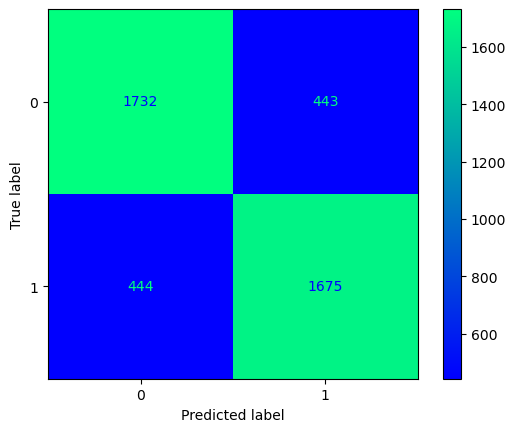

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.80      0.80      0.80      2175
           1       0.79      0.79      0.79      2119

    accuracy                           0.79      4294
   macro avg       0.79      0.79      0.79      4294
weighted avg       0.79      0.79      0.79      4294

-------------------------


In [266]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m3_15min.catboost_GridS()

In [267]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m3_15min,y_val_m3_15min)

Accuracy validación 0.5079187628097633


In [268]:
guardar_modelo(modelo_entrenado_15min,"m3_catboost_GridS_15min")

### Partidas 10 min

Hora de inicio:  06:29:20
0:	learn: 0.6802647	test: 0.6807433	best: 0.6807433 (0)	total: 2.78ms	remaining: 276ms
1:	learn: 0.6689158	test: 0.6697816	best: 0.6697816 (1)	total: 5.46ms	remaining: 268ms
2:	learn: 0.6589247	test: 0.6603556	best: 0.6603556 (2)	total: 8.15ms	remaining: 263ms
3:	learn: 0.6500374	test: 0.6513181	best: 0.6513181 (3)	total: 10.8ms	remaining: 259ms
4:	learn: 0.6421871	test: 0.6436742	best: 0.6436742 (4)	total: 13.5ms	remaining: 256ms
5:	learn: 0.6344732	test: 0.6360919	best: 0.6360919 (5)	total: 16.3ms	remaining: 255ms
6:	learn: 0.6273873	test: 0.6295695	best: 0.6295695 (6)	total: 19ms	remaining: 253ms
7:	learn: 0.6211253	test: 0.6235522	best: 0.6235522 (7)	total: 21.6ms	remaining: 249ms
8:	learn: 0.6153659	test: 0.6181242	best: 0.6181242 (8)	total: 24.3ms	remaining: 246ms
9:	learn: 0.6095364	test: 0.6128845	best: 0.6128845 (9)	total: 27.1ms	remaining: 244ms
10:	learn: 0.6051725	test: 0.6088321	best: 0.6088321 (10)	total: 29.8ms	remaining: 241ms
11:	learn: 0.6010

18:	learn: 0.5464703	test: 0.5566992	best: 0.5566992 (18)	total: 53.1ms	remaining: 226ms
19:	learn: 0.5447202	test: 0.5552417	best: 0.5552417 (19)	total: 56.2ms	remaining: 225ms
20:	learn: 0.5425479	test: 0.5536915	best: 0.5536915 (20)	total: 59ms	remaining: 222ms
21:	learn: 0.5415303	test: 0.5524317	best: 0.5524317 (21)	total: 61.7ms	remaining: 219ms
22:	learn: 0.5401108	test: 0.5513072	best: 0.5513072 (22)	total: 64.4ms	remaining: 216ms
23:	learn: 0.5390747	test: 0.5503647	best: 0.5503647 (23)	total: 67ms	remaining: 212ms
24:	learn: 0.5381366	test: 0.5499719	best: 0.5499719 (24)	total: 70.1ms	remaining: 210ms
25:	learn: 0.5370905	test: 0.5489507	best: 0.5489507 (25)	total: 73.1ms	remaining: 208ms
26:	learn: 0.5362019	test: 0.5479604	best: 0.5479604 (26)	total: 75.6ms	remaining: 205ms
27:	learn: 0.5350065	test: 0.5471325	best: 0.5471325 (27)	total: 78.3ms	remaining: 201ms
28:	learn: 0.5342441	test: 0.5467085	best: 0.5467085 (28)	total: 81.3ms	remaining: 199ms
29:	learn: 0.5333247	test

54:	learn: 0.5135385	test: 0.5335927	best: 0.5327471 (44)	total: 168ms	remaining: 137ms
55:	learn: 0.5132700	test: 0.5335760	best: 0.5327471 (44)	total: 171ms	remaining: 135ms
56:	learn: 0.5130621	test: 0.5335227	best: 0.5327471 (44)	total: 174ms	remaining: 132ms
57:	learn: 0.5128548	test: 0.5334640	best: 0.5327471 (44)	total: 177ms	remaining: 128ms
58:	learn: 0.5124894	test: 0.5332982	best: 0.5327471 (44)	total: 180ms	remaining: 125ms
59:	learn: 0.5122322	test: 0.5331599	best: 0.5327471 (44)	total: 183ms	remaining: 122ms
60:	learn: 0.5119570	test: 0.5331178	best: 0.5327471 (44)	total: 186ms	remaining: 119ms
61:	learn: 0.5117171	test: 0.5327309	best: 0.5327309 (61)	total: 189ms	remaining: 116ms
62:	learn: 0.5113486	test: 0.5322656	best: 0.5322656 (62)	total: 191ms	remaining: 112ms
63:	learn: 0.5110632	test: 0.5322839	best: 0.5322656 (62)	total: 194ms	remaining: 109ms
64:	learn: 0.5107820	test: 0.5321279	best: 0.5321279 (64)	total: 197ms	remaining: 106ms
65:	learn: 0.5103512	test: 0.531

95:	learn: 0.4951013	test: 0.5325303	best: 0.5302435 (80)	total: 274ms	remaining: 11.4ms
96:	learn: 0.4949074	test: 0.5326861	best: 0.5302435 (80)	total: 277ms	remaining: 8.58ms
97:	learn: 0.4947331	test: 0.5326231	best: 0.5302435 (80)	total: 280ms	remaining: 5.71ms
98:	learn: 0.4943770	test: 0.5326459	best: 0.5302435 (80)	total: 282ms	remaining: 2.85ms
99:	learn: 0.4940155	test: 0.5334142	best: 0.5302435 (80)	total: 285ms	remaining: 0us

bestTest = 0.5302435319
bestIteration = 80

3:	loss: 0.5302435	best: 0.5302435 (3)	total: 1.2s	remaining: 39.4s
0:	learn: 0.5997941	test: 0.6038423	best: 0.6038423 (0)	total: 2.77ms	remaining: 274ms
1:	learn: 0.5700795	test: 0.5727180	best: 0.5727180 (1)	total: 5.44ms	remaining: 267ms
2:	learn: 0.5535951	test: 0.5595149	best: 0.5595149 (2)	total: 8.18ms	remaining: 265ms
3:	learn: 0.5412440	test: 0.5493121	best: 0.5493121 (3)	total: 10.9ms	remaining: 263ms
4:	learn: 0.5360979	test: 0.5459720	best: 0.5459720 (4)	total: 13.7ms	remaining: 260ms
5:	learn: 

88:	learn: 0.4753299	test: 0.5563357	best: 0.5328955 (17)	total: 249ms	remaining: 30.8ms
89:	learn: 0.4748803	test: 0.5575162	best: 0.5328955 (17)	total: 252ms	remaining: 28ms
90:	learn: 0.4745537	test: 0.5572800	best: 0.5328955 (17)	total: 255ms	remaining: 25.2ms
91:	learn: 0.4739291	test: 0.5571430	best: 0.5328955 (17)	total: 257ms	remaining: 22.4ms
92:	learn: 0.4736060	test: 0.5567268	best: 0.5328955 (17)	total: 260ms	remaining: 19.6ms
93:	learn: 0.4733434	test: 0.5566518	best: 0.5328955 (17)	total: 263ms	remaining: 16.8ms
94:	learn: 0.4728659	test: 0.5570693	best: 0.5328955 (17)	total: 265ms	remaining: 14ms
95:	learn: 0.4722340	test: 0.5571817	best: 0.5328955 (17)	total: 268ms	remaining: 11.2ms
96:	learn: 0.4718317	test: 0.5570201	best: 0.5328955 (17)	total: 271ms	remaining: 8.37ms
97:	learn: 0.4713190	test: 0.5574484	best: 0.5328955 (17)	total: 273ms	remaining: 5.58ms
98:	learn: 0.4708168	test: 0.5579860	best: 0.5328955 (17)	total: 276ms	remaining: 2.79ms
99:	learn: 0.4703661	test

9:	learn: 0.5724104	test: 0.5789011	best: 0.5789011 (9)	total: 28.2ms	remaining: 254ms
10:	learn: 0.5685232	test: 0.5751773	best: 0.5751773 (10)	total: 31.3ms	remaining: 253ms
11:	learn: 0.5647679	test: 0.5714038	best: 0.5714038 (11)	total: 33.8ms	remaining: 248ms
12:	learn: 0.5604244	test: 0.5681446	best: 0.5681446 (12)	total: 36.7ms	remaining: 245ms
13:	learn: 0.5571143	test: 0.5652925	best: 0.5652925 (13)	total: 39.5ms	remaining: 242ms
14:	learn: 0.5550706	test: 0.5629288	best: 0.5629288 (14)	total: 42.3ms	remaining: 240ms
15:	learn: 0.5527726	test: 0.5615310	best: 0.5615310 (15)	total: 45.5ms	remaining: 239ms
16:	learn: 0.5505531	test: 0.5597653	best: 0.5597653 (16)	total: 48.2ms	remaining: 235ms
17:	learn: 0.5483540	test: 0.5579954	best: 0.5579954 (17)	total: 51ms	remaining: 232ms
18:	learn: 0.5464703	test: 0.5566992	best: 0.5566992 (18)	total: 53.7ms	remaining: 229ms
19:	learn: 0.5447202	test: 0.5552417	best: 0.5552417 (19)	total: 56.4ms	remaining: 226ms
20:	learn: 0.5425479	test

5:	learn: 0.5769863	test: 0.5826866	best: 0.5826866 (5)	total: 17.1ms	remaining: 268ms
6:	learn: 0.5692773	test: 0.5760835	best: 0.5760835 (6)	total: 20.1ms	remaining: 267ms
7:	learn: 0.5633955	test: 0.5705587	best: 0.5705587 (7)	total: 22.8ms	remaining: 262ms
8:	learn: 0.5587006	test: 0.5670350	best: 0.5670350 (8)	total: 25.6ms	remaining: 258ms
9:	learn: 0.5539213	test: 0.5632497	best: 0.5632497 (9)	total: 28.3ms	remaining: 255ms
10:	learn: 0.5505704	test: 0.5595533	best: 0.5595533 (10)	total: 31.1ms	remaining: 251ms
11:	learn: 0.5478324	test: 0.5572802	best: 0.5572802 (11)	total: 33.9ms	remaining: 248ms
12:	learn: 0.5454353	test: 0.5547763	best: 0.5547763 (12)	total: 36.7ms	remaining: 245ms
13:	learn: 0.5435976	test: 0.5531282	best: 0.5531282 (13)	total: 40.1ms	remaining: 246ms
14:	learn: 0.5415553	test: 0.5513629	best: 0.5513629 (14)	total: 42.7ms	remaining: 242ms
15:	learn: 0.5398652	test: 0.5499246	best: 0.5499246 (15)	total: 45.5ms	remaining: 239ms
16:	learn: 0.5372460	test: 0.54

18:	learn: 0.5269203	test: 0.5401528	best: 0.5401528 (18)	total: 57.6ms	remaining: 246ms
19:	learn: 0.5262477	test: 0.5396057	best: 0.5396057 (19)	total: 60.5ms	remaining: 242ms
20:	learn: 0.5251696	test: 0.5389283	best: 0.5389283 (20)	total: 63.5ms	remaining: 239ms
21:	learn: 0.5244128	test: 0.5380927	best: 0.5380927 (21)	total: 66.2ms	remaining: 235ms
22:	learn: 0.5236149	test: 0.5376045	best: 0.5376045 (22)	total: 69.2ms	remaining: 232ms
23:	learn: 0.5225954	test: 0.5372275	best: 0.5372275 (23)	total: 72.9ms	remaining: 231ms
24:	learn: 0.5218612	test: 0.5368104	best: 0.5368104 (24)	total: 76.3ms	remaining: 229ms
25:	learn: 0.5209293	test: 0.5358226	best: 0.5358226 (25)	total: 79.8ms	remaining: 227ms
26:	learn: 0.5201840	test: 0.5349862	best: 0.5349862 (26)	total: 82.8ms	remaining: 224ms
27:	learn: 0.5196556	test: 0.5343883	best: 0.5343883 (27)	total: 86.2ms	remaining: 222ms
28:	learn: 0.5191841	test: 0.5341010	best: 0.5341010 (28)	total: 89.2ms	remaining: 218ms
29:	learn: 0.5187579	

11:	learn: 0.5202002	test: 0.5358826	best: 0.5358826 (11)	total: 34.7ms	remaining: 255ms
12:	learn: 0.5192951	test: 0.5343899	best: 0.5343899 (12)	total: 37.6ms	remaining: 252ms
13:	learn: 0.5178185	test: 0.5337039	best: 0.5337039 (13)	total: 40.4ms	remaining: 248ms
14:	learn: 0.5173840	test: 0.5336209	best: 0.5336209 (14)	total: 43.3ms	remaining: 246ms
15:	learn: 0.5167463	test: 0.5334388	best: 0.5334388 (15)	total: 45.9ms	remaining: 241ms
16:	learn: 0.5160347	test: 0.5331355	best: 0.5331355 (16)	total: 49ms	remaining: 239ms
17:	learn: 0.5155177	test: 0.5328955	best: 0.5328955 (17)	total: 51.5ms	remaining: 235ms
18:	learn: 0.5147511	test: 0.5341520	best: 0.5328955 (17)	total: 54.6ms	remaining: 233ms
19:	learn: 0.5139527	test: 0.5340998	best: 0.5328955 (17)	total: 57.5ms	remaining: 230ms
20:	learn: 0.5130663	test: 0.5341568	best: 0.5328955 (17)	total: 60.2ms	remaining: 227ms
21:	learn: 0.5121861	test: 0.5343453	best: 0.5328955 (17)	total: 62.8ms	remaining: 223ms
22:	learn: 0.5113360	te

33:	learn: 0.5504342	test: 0.5594551	best: 0.5594551 (33)	total: 95.2ms	remaining: 185ms
34:	learn: 0.5493688	test: 0.5584255	best: 0.5584255 (34)	total: 98.1ms	remaining: 182ms
35:	learn: 0.5482726	test: 0.5575863	best: 0.5575863 (35)	total: 101ms	remaining: 179ms
36:	learn: 0.5473830	test: 0.5568404	best: 0.5568404 (36)	total: 104ms	remaining: 176ms
37:	learn: 0.5465860	test: 0.5562172	best: 0.5562172 (37)	total: 106ms	remaining: 173ms
38:	learn: 0.5455439	test: 0.5555579	best: 0.5555579 (38)	total: 109ms	remaining: 171ms
39:	learn: 0.5448291	test: 0.5548609	best: 0.5548609 (39)	total: 112ms	remaining: 168ms
40:	learn: 0.5439896	test: 0.5541682	best: 0.5541682 (40)	total: 115ms	remaining: 165ms
41:	learn: 0.5432831	test: 0.5534889	best: 0.5534889 (41)	total: 118ms	remaining: 162ms
42:	learn: 0.5426283	test: 0.5529048	best: 0.5529048 (42)	total: 120ms	remaining: 159ms
43:	learn: 0.5418536	test: 0.5524249	best: 0.5524249 (43)	total: 123ms	remaining: 156ms
44:	learn: 0.5411059	test: 0.5

32:	learn: 0.5306684	test: 0.5439963	best: 0.5439963 (32)	total: 93.8ms	remaining: 190ms
33:	learn: 0.5296041	test: 0.5433579	best: 0.5433579 (33)	total: 97ms	remaining: 188ms
34:	learn: 0.5290585	test: 0.5427678	best: 0.5427678 (34)	total: 99.9ms	remaining: 186ms
35:	learn: 0.5284468	test: 0.5423921	best: 0.5423921 (35)	total: 103ms	remaining: 183ms
36:	learn: 0.5279794	test: 0.5417779	best: 0.5417779 (36)	total: 105ms	remaining: 179ms
37:	learn: 0.5273921	test: 0.5415084	best: 0.5415084 (37)	total: 108ms	remaining: 176ms
38:	learn: 0.5267680	test: 0.5408259	best: 0.5408259 (38)	total: 111ms	remaining: 173ms
39:	learn: 0.5261781	test: 0.5403619	best: 0.5403619 (39)	total: 113ms	remaining: 170ms
40:	learn: 0.5257475	test: 0.5399777	best: 0.5399777 (40)	total: 116ms	remaining: 167ms
41:	learn: 0.5251878	test: 0.5395281	best: 0.5395281 (41)	total: 119ms	remaining: 164ms
42:	learn: 0.5246073	test: 0.5389373	best: 0.5389373 (42)	total: 122ms	remaining: 162ms
43:	learn: 0.5240898	test: 0.53

51:	learn: 0.5141514	test: 0.5337118	best: 0.5327471 (44)	total: 148ms	remaining: 137ms
52:	learn: 0.5139150	test: 0.5338527	best: 0.5327471 (44)	total: 152ms	remaining: 135ms
53:	learn: 0.5137814	test: 0.5338122	best: 0.5327471 (44)	total: 155ms	remaining: 132ms
54:	learn: 0.5135385	test: 0.5335927	best: 0.5327471 (44)	total: 158ms	remaining: 129ms
55:	learn: 0.5132700	test: 0.5335760	best: 0.5327471 (44)	total: 161ms	remaining: 126ms
56:	learn: 0.5130621	test: 0.5335227	best: 0.5327471 (44)	total: 164ms	remaining: 124ms
57:	learn: 0.5128548	test: 0.5334640	best: 0.5327471 (44)	total: 166ms	remaining: 120ms
58:	learn: 0.5124894	test: 0.5332982	best: 0.5327471 (44)	total: 169ms	remaining: 118ms
59:	learn: 0.5122322	test: 0.5331599	best: 0.5327471 (44)	total: 173ms	remaining: 115ms
60:	learn: 0.5119570	test: 0.5331178	best: 0.5327471 (44)	total: 176ms	remaining: 112ms
61:	learn: 0.5117171	test: 0.5327309	best: 0.5327309 (61)	total: 179ms	remaining: 110ms
62:	learn: 0.5113486	test: 0.532

51:	learn: 0.5102119	test: 0.5317214	best: 0.5316383 (50)	total: 151ms	remaining: 139ms
52:	learn: 0.5098860	test: 0.5318387	best: 0.5316383 (50)	total: 155ms	remaining: 137ms
53:	learn: 0.5094279	test: 0.5320575	best: 0.5316383 (50)	total: 158ms	remaining: 135ms
54:	learn: 0.5089884	test: 0.5321529	best: 0.5316383 (50)	total: 162ms	remaining: 133ms
55:	learn: 0.5084950	test: 0.5320283	best: 0.5316383 (50)	total: 165ms	remaining: 130ms
56:	learn: 0.5080888	test: 0.5320155	best: 0.5316383 (50)	total: 168ms	remaining: 127ms
57:	learn: 0.5078378	test: 0.5320750	best: 0.5316383 (50)	total: 170ms	remaining: 123ms
58:	learn: 0.5073746	test: 0.5316658	best: 0.5316383 (50)	total: 173ms	remaining: 120ms
59:	learn: 0.5071078	test: 0.5317577	best: 0.5316383 (50)	total: 176ms	remaining: 117ms
60:	learn: 0.5066334	test: 0.5316972	best: 0.5316383 (50)	total: 179ms	remaining: 114ms
61:	learn: 0.5058900	test: 0.5316975	best: 0.5316383 (50)	total: 182ms	remaining: 111ms
62:	learn: 0.5055648	test: 0.531

60:	learn: 0.4872914	test: 0.5472045	best: 0.5328955 (17)	total: 170ms	remaining: 109ms
61:	learn: 0.4869286	test: 0.5478451	best: 0.5328955 (17)	total: 173ms	remaining: 106ms
62:	learn: 0.4864749	test: 0.5476866	best: 0.5328955 (17)	total: 176ms	remaining: 103ms
63:	learn: 0.4857871	test: 0.5484738	best: 0.5328955 (17)	total: 179ms	remaining: 100ms
64:	learn: 0.4852906	test: 0.5483070	best: 0.5328955 (17)	total: 181ms	remaining: 97.6ms
65:	learn: 0.4848827	test: 0.5483020	best: 0.5328955 (17)	total: 184ms	remaining: 94.7ms
66:	learn: 0.4845677	test: 0.5495987	best: 0.5328955 (17)	total: 187ms	remaining: 92ms
67:	learn: 0.4840822	test: 0.5499208	best: 0.5328955 (17)	total: 189ms	remaining: 89.1ms
68:	learn: 0.4838822	test: 0.5507136	best: 0.5328955 (17)	total: 192ms	remaining: 86.3ms
69:	learn: 0.4836876	test: 0.5508222	best: 0.5328955 (17)	total: 194ms	remaining: 83.4ms
70:	learn: 0.4830181	test: 0.5521585	best: 0.5328955 (17)	total: 197ms	remaining: 80.7ms
71:	learn: 0.4825961	test: 

66:	learn: 0.5303339	test: 0.5433505	best: 0.5433505 (66)	total: 187ms	remaining: 231ms
67:	learn: 0.5300133	test: 0.5431220	best: 0.5431220 (67)	total: 190ms	remaining: 229ms
68:	learn: 0.5296208	test: 0.5427516	best: 0.5427516 (68)	total: 193ms	remaining: 227ms
69:	learn: 0.5292923	test: 0.5424131	best: 0.5424131 (69)	total: 196ms	remaining: 224ms
70:	learn: 0.5290465	test: 0.5422401	best: 0.5422401 (70)	total: 199ms	remaining: 221ms
71:	learn: 0.5287434	test: 0.5419834	best: 0.5419834 (71)	total: 201ms	remaining: 218ms
72:	learn: 0.5285735	test: 0.5417988	best: 0.5417988 (72)	total: 204ms	remaining: 215ms
73:	learn: 0.5281322	test: 0.5415382	best: 0.5415382 (73)	total: 207ms	remaining: 212ms
74:	learn: 0.5277857	test: 0.5412366	best: 0.5412366 (74)	total: 209ms	remaining: 209ms
75:	learn: 0.5273667	test: 0.5409063	best: 0.5409063 (75)	total: 212ms	remaining: 207ms
76:	learn: 0.5270095	test: 0.5406774	best: 0.5406774 (76)	total: 215ms	remaining: 204ms
77:	learn: 0.5268344	test: 0.540

32:	learn: 0.5306684	test: 0.5439963	best: 0.5439963 (32)	total: 92.2ms	remaining: 327ms
33:	learn: 0.5296041	test: 0.5433579	best: 0.5433579 (33)	total: 95.4ms	remaining: 326ms
34:	learn: 0.5290585	test: 0.5427678	best: 0.5427678 (34)	total: 98.4ms	remaining: 323ms
35:	learn: 0.5284468	test: 0.5423921	best: 0.5423921 (35)	total: 101ms	remaining: 321ms
36:	learn: 0.5279794	test: 0.5417779	best: 0.5417779 (36)	total: 104ms	remaining: 317ms
37:	learn: 0.5273921	test: 0.5415084	best: 0.5415084 (37)	total: 107ms	remaining: 315ms
38:	learn: 0.5267680	test: 0.5408259	best: 0.5408259 (38)	total: 109ms	remaining: 311ms
39:	learn: 0.5261781	test: 0.5403619	best: 0.5403619 (39)	total: 112ms	remaining: 308ms
40:	learn: 0.5257475	test: 0.5399777	best: 0.5399777 (40)	total: 115ms	remaining: 306ms
41:	learn: 0.5251878	test: 0.5395281	best: 0.5395281 (41)	total: 118ms	remaining: 302ms
42:	learn: 0.5246073	test: 0.5389373	best: 0.5389373 (42)	total: 121ms	remaining: 300ms
43:	learn: 0.5240898	test: 0.

24:	learn: 0.5271519	test: 0.5397932	best: 0.5397932 (24)	total: 69.9ms	remaining: 350ms
25:	learn: 0.5263576	test: 0.5394656	best: 0.5394656 (25)	total: 73.2ms	remaining: 349ms
26:	learn: 0.5254835	test: 0.5386268	best: 0.5386268 (26)	total: 75.9ms	remaining: 346ms
27:	learn: 0.5245271	test: 0.5380120	best: 0.5380120 (27)	total: 78.8ms	remaining: 343ms
28:	learn: 0.5238751	test: 0.5373839	best: 0.5373839 (28)	total: 81.8ms	remaining: 341ms
29:	learn: 0.5232259	test: 0.5366999	best: 0.5366999 (29)	total: 84.5ms	remaining: 338ms
30:	learn: 0.5226011	test: 0.5364849	best: 0.5364849 (30)	total: 87.4ms	remaining: 336ms
31:	learn: 0.5222848	test: 0.5362345	best: 0.5362345 (31)	total: 90ms	remaining: 332ms
32:	learn: 0.5219195	test: 0.5360439	best: 0.5360439 (32)	total: 92.6ms	remaining: 328ms
33:	learn: 0.5214095	test: 0.5358409	best: 0.5358409 (33)	total: 95.7ms	remaining: 327ms
34:	learn: 0.5207961	test: 0.5350336	best: 0.5350336 (34)	total: 98.5ms	remaining: 324ms
35:	learn: 0.5202426	te

123:	learn: 0.4941563	test: 0.5351679	best: 0.5311060 (91)	total: 349ms	remaining: 73.2ms
124:	learn: 0.4937908	test: 0.5352152	best: 0.5311060 (91)	total: 352ms	remaining: 70.5ms
125:	learn: 0.4935488	test: 0.5352162	best: 0.5311060 (91)	total: 355ms	remaining: 67.7ms
126:	learn: 0.4933762	test: 0.5351107	best: 0.5311060 (91)	total: 358ms	remaining: 64.9ms
127:	learn: 0.4932782	test: 0.5351289	best: 0.5311060 (91)	total: 361ms	remaining: 62ms
128:	learn: 0.4931111	test: 0.5351549	best: 0.5311060 (91)	total: 364ms	remaining: 59.2ms
129:	learn: 0.4928750	test: 0.5350215	best: 0.5311060 (91)	total: 367ms	remaining: 56.5ms
130:	learn: 0.4925592	test: 0.5348831	best: 0.5311060 (91)	total: 370ms	remaining: 53.7ms
131:	learn: 0.4924085	test: 0.5349807	best: 0.5311060 (91)	total: 373ms	remaining: 50.8ms
132:	learn: 0.4919735	test: 0.5351693	best: 0.5311060 (91)	total: 376ms	remaining: 48ms
133:	learn: 0.4914788	test: 0.5355492	best: 0.5311060 (91)	total: 379ms	remaining: 45.2ms
134:	learn: 0.

93:	learn: 0.4956004	test: 0.5324254	best: 0.5302435 (80)	total: 262ms	remaining: 156ms
94:	learn: 0.4953303	test: 0.5323019	best: 0.5302435 (80)	total: 265ms	remaining: 153ms
95:	learn: 0.4951013	test: 0.5325303	best: 0.5302435 (80)	total: 268ms	remaining: 151ms
96:	learn: 0.4949074	test: 0.5326861	best: 0.5302435 (80)	total: 270ms	remaining: 148ms
97:	learn: 0.4947331	test: 0.5326231	best: 0.5302435 (80)	total: 273ms	remaining: 145ms
98:	learn: 0.4943770	test: 0.5326459	best: 0.5302435 (80)	total: 275ms	remaining: 142ms
99:	learn: 0.4940155	test: 0.5334142	best: 0.5302435 (80)	total: 278ms	remaining: 139ms
100:	learn: 0.4937438	test: 0.5334270	best: 0.5302435 (80)	total: 281ms	remaining: 136ms
101:	learn: 0.4934119	test: 0.5333719	best: 0.5302435 (80)	total: 284ms	remaining: 134ms
102:	learn: 0.4931454	test: 0.5335582	best: 0.5302435 (80)	total: 286ms	remaining: 131ms
103:	learn: 0.4928742	test: 0.5335126	best: 0.5302435 (80)	total: 289ms	remaining: 128ms
104:	learn: 0.4927571	test: 

38:	learn: 0.4990993	test: 0.5380291	best: 0.5328955 (17)	total: 109ms	remaining: 312ms
39:	learn: 0.4984319	test: 0.5378091	best: 0.5328955 (17)	total: 112ms	remaining: 309ms
40:	learn: 0.4975321	test: 0.5384485	best: 0.5328955 (17)	total: 115ms	remaining: 307ms
41:	learn: 0.4970926	test: 0.5387994	best: 0.5328955 (17)	total: 118ms	remaining: 303ms
42:	learn: 0.4964719	test: 0.5388572	best: 0.5328955 (17)	total: 121ms	remaining: 300ms
43:	learn: 0.4959772	test: 0.5386741	best: 0.5328955 (17)	total: 124ms	remaining: 298ms
44:	learn: 0.4953919	test: 0.5390029	best: 0.5328955 (17)	total: 127ms	remaining: 295ms
45:	learn: 0.4949654	test: 0.5389822	best: 0.5328955 (17)	total: 129ms	remaining: 292ms
46:	learn: 0.4942569	test: 0.5388209	best: 0.5328955 (17)	total: 132ms	remaining: 289ms
47:	learn: 0.4937607	test: 0.5398581	best: 0.5328955 (17)	total: 135ms	remaining: 286ms
48:	learn: 0.4933924	test: 0.5397309	best: 0.5328955 (17)	total: 138ms	remaining: 284ms
49:	learn: 0.4927473	test: 0.540

9:	learn: 0.6095364	test: 0.6128845	best: 0.6128845 (9)	total: 28ms	remaining: 392ms
10:	learn: 0.6051725	test: 0.6088321	best: 0.6088321 (10)	total: 31.2ms	remaining: 394ms
11:	learn: 0.6010325	test: 0.6050357	best: 0.6050357 (11)	total: 36.8ms	remaining: 423ms
12:	learn: 0.5972970	test: 0.6016113	best: 0.6016113 (12)	total: 40.7ms	remaining: 429ms
13:	learn: 0.5932807	test: 0.5979854	best: 0.5979854 (13)	total: 46.1ms	remaining: 448ms
14:	learn: 0.5896069	test: 0.5945090	best: 0.5945090 (14)	total: 50.7ms	remaining: 456ms
15:	learn: 0.5859646	test: 0.5911022	best: 0.5911022 (15)	total: 53.7ms	remaining: 450ms
16:	learn: 0.5829662	test: 0.5884873	best: 0.5884873 (16)	total: 56.8ms	remaining: 444ms
17:	learn: 0.5804213	test: 0.5861320	best: 0.5861320 (17)	total: 59.8ms	remaining: 439ms
18:	learn: 0.5773733	test: 0.5833281	best: 0.5833281 (18)	total: 62.6ms	remaining: 432ms
19:	learn: 0.5752917	test: 0.5814922	best: 0.5814922 (19)	total: 65.8ms	remaining: 428ms
20:	learn: 0.5728224	test

102:	learn: 0.5214394	test: 0.5366303	best: 0.5366303 (102)	total: 309ms	remaining: 141ms
103:	learn: 0.5212930	test: 0.5365459	best: 0.5365459 (103)	total: 312ms	remaining: 138ms
104:	learn: 0.5211527	test: 0.5364128	best: 0.5364128 (104)	total: 314ms	remaining: 135ms
105:	learn: 0.5210247	test: 0.5363173	best: 0.5363173 (105)	total: 317ms	remaining: 132ms
106:	learn: 0.5209129	test: 0.5361666	best: 0.5361666 (106)	total: 320ms	remaining: 128ms
107:	learn: 0.5207569	test: 0.5361185	best: 0.5361185 (107)	total: 323ms	remaining: 125ms
108:	learn: 0.5206066	test: 0.5359383	best: 0.5359383 (108)	total: 325ms	remaining: 122ms
109:	learn: 0.5204237	test: 0.5358457	best: 0.5358457 (109)	total: 328ms	remaining: 119ms
110:	learn: 0.5202076	test: 0.5357364	best: 0.5357364 (110)	total: 330ms	remaining: 116ms
111:	learn: 0.5200905	test: 0.5356525	best: 0.5356525 (111)	total: 333ms	remaining: 113ms
112:	learn: 0.5198624	test: 0.5355026	best: 0.5355026 (112)	total: 335ms	remaining: 110ms
113:	learn

66:	learn: 0.5161768	test: 0.5343183	best: 0.5342708 (65)	total: 191ms	remaining: 237ms
67:	learn: 0.5159885	test: 0.5341062	best: 0.5341062 (67)	total: 194ms	remaining: 234ms
68:	learn: 0.5158087	test: 0.5339478	best: 0.5339478 (68)	total: 197ms	remaining: 231ms
69:	learn: 0.5156406	test: 0.5339308	best: 0.5339308 (69)	total: 200ms	remaining: 228ms
70:	learn: 0.5154418	test: 0.5338687	best: 0.5338687 (70)	total: 202ms	remaining: 225ms
71:	learn: 0.5151847	test: 0.5337011	best: 0.5337011 (71)	total: 205ms	remaining: 222ms
72:	learn: 0.5149953	test: 0.5336610	best: 0.5336610 (72)	total: 208ms	remaining: 220ms
73:	learn: 0.5147083	test: 0.5334135	best: 0.5334135 (73)	total: 211ms	remaining: 217ms
74:	learn: 0.5144790	test: 0.5339811	best: 0.5334135 (73)	total: 214ms	remaining: 214ms
75:	learn: 0.5140275	test: 0.5336551	best: 0.5334135 (73)	total: 217ms	remaining: 211ms
76:	learn: 0.5137879	test: 0.5336263	best: 0.5334135 (73)	total: 220ms	remaining: 208ms
77:	learn: 0.5136484	test: 0.533

8:	learn: 0.5587006	test: 0.5670350	best: 0.5670350 (8)	total: 25.2ms	remaining: 395ms
9:	learn: 0.5539213	test: 0.5632497	best: 0.5632497 (9)	total: 28.3ms	remaining: 397ms
10:	learn: 0.5505704	test: 0.5595533	best: 0.5595533 (10)	total: 31ms	remaining: 392ms
11:	learn: 0.5478324	test: 0.5572802	best: 0.5572802 (11)	total: 33.8ms	remaining: 389ms
12:	learn: 0.5454353	test: 0.5547763	best: 0.5547763 (12)	total: 36.6ms	remaining: 385ms
13:	learn: 0.5435976	test: 0.5531282	best: 0.5531282 (13)	total: 39.7ms	remaining: 386ms
14:	learn: 0.5415553	test: 0.5513629	best: 0.5513629 (14)	total: 42.4ms	remaining: 381ms
15:	learn: 0.5398652	test: 0.5499246	best: 0.5499246 (15)	total: 45ms	remaining: 377ms
16:	learn: 0.5372460	test: 0.5483304	best: 0.5483304 (16)	total: 47.7ms	remaining: 373ms
17:	learn: 0.5352800	test: 0.5465959	best: 0.5465959 (17)	total: 50.5ms	remaining: 370ms
18:	learn: 0.5334354	test: 0.5452863	best: 0.5452863 (18)	total: 53.2ms	remaining: 367ms
19:	learn: 0.5320660	test: 0.

129:	learn: 0.4928750	test: 0.5350215	best: 0.5311060 (91)	total: 364ms	remaining: 56.1ms
130:	learn: 0.4925592	test: 0.5348831	best: 0.5311060 (91)	total: 368ms	remaining: 53.4ms
131:	learn: 0.4924085	test: 0.5349807	best: 0.5311060 (91)	total: 370ms	remaining: 50.5ms
132:	learn: 0.4919735	test: 0.5351693	best: 0.5311060 (91)	total: 373ms	remaining: 47.7ms
133:	learn: 0.4914788	test: 0.5355492	best: 0.5311060 (91)	total: 377ms	remaining: 45ms
134:	learn: 0.4912602	test: 0.5356196	best: 0.5311060 (91)	total: 379ms	remaining: 42.1ms
135:	learn: 0.4910126	test: 0.5356343	best: 0.5311060 (91)	total: 382ms	remaining: 39.3ms
136:	learn: 0.4907766	test: 0.5357903	best: 0.5311060 (91)	total: 385ms	remaining: 36.5ms
137:	learn: 0.4906064	test: 0.5359718	best: 0.5311060 (91)	total: 388ms	remaining: 33.7ms
138:	learn: 0.4904873	test: 0.5359647	best: 0.5311060 (91)	total: 390ms	remaining: 30.9ms
139:	learn: 0.4902217	test: 0.5357054	best: 0.5311060 (91)	total: 393ms	remaining: 28.1ms
140:	learn: 

78:	learn: 0.5001490	test: 0.5303821	best: 0.5303607 (77)	total: 222ms	remaining: 200ms
79:	learn: 0.4998268	test: 0.5304553	best: 0.5303607 (77)	total: 225ms	remaining: 197ms
80:	learn: 0.4995058	test: 0.5302435	best: 0.5302435 (80)	total: 228ms	remaining: 194ms
81:	learn: 0.4991326	test: 0.5304148	best: 0.5302435 (80)	total: 230ms	remaining: 191ms
82:	learn: 0.4988823	test: 0.5305402	best: 0.5302435 (80)	total: 233ms	remaining: 188ms
83:	learn: 0.4985959	test: 0.5308173	best: 0.5302435 (80)	total: 236ms	remaining: 185ms
84:	learn: 0.4983571	test: 0.5314508	best: 0.5302435 (80)	total: 239ms	remaining: 182ms
85:	learn: 0.4981945	test: 0.5315636	best: 0.5302435 (80)	total: 241ms	remaining: 179ms
86:	learn: 0.4976791	test: 0.5316784	best: 0.5302435 (80)	total: 244ms	remaining: 177ms
87:	learn: 0.4974846	test: 0.5315258	best: 0.5302435 (80)	total: 247ms	remaining: 174ms
88:	learn: 0.4971786	test: 0.5313727	best: 0.5302435 (80)	total: 250ms	remaining: 171ms
89:	learn: 0.4968650	test: 0.531

46:	learn: 0.4942569	test: 0.5388209	best: 0.5328955 (17)	total: 131ms	remaining: 287ms
47:	learn: 0.4937607	test: 0.5398581	best: 0.5328955 (17)	total: 134ms	remaining: 284ms
48:	learn: 0.4933924	test: 0.5397309	best: 0.5328955 (17)	total: 137ms	remaining: 282ms
49:	learn: 0.4927473	test: 0.5405492	best: 0.5328955 (17)	total: 139ms	remaining: 279ms
50:	learn: 0.4921902	test: 0.5437975	best: 0.5328955 (17)	total: 142ms	remaining: 276ms
51:	learn: 0.4918006	test: 0.5436965	best: 0.5328955 (17)	total: 145ms	remaining: 273ms
52:	learn: 0.4912947	test: 0.5456552	best: 0.5328955 (17)	total: 148ms	remaining: 271ms
53:	learn: 0.4907603	test: 0.5455876	best: 0.5328955 (17)	total: 151ms	remaining: 268ms
54:	learn: 0.4900562	test: 0.5458162	best: 0.5328955 (17)	total: 153ms	remaining: 265ms
55:	learn: 0.4896853	test: 0.5453986	best: 0.5328955 (17)	total: 156ms	remaining: 262ms
56:	learn: 0.4893587	test: 0.5449931	best: 0.5328955 (17)	total: 159ms	remaining: 259ms
57:	learn: 0.4888879	test: 0.545

1:	learn: 0.6689158	test: 0.6697816	best: 0.6697816 (1)	total: 6.13ms	remaining: 454ms
2:	learn: 0.6589247	test: 0.6603556	best: 0.6603556 (2)	total: 9.12ms	remaining: 447ms
3:	learn: 0.6500374	test: 0.6513181	best: 0.6513181 (3)	total: 11.8ms	remaining: 430ms
4:	learn: 0.6421871	test: 0.6436742	best: 0.6436742 (4)	total: 14.5ms	remaining: 421ms
5:	learn: 0.6344732	test: 0.6360919	best: 0.6360919 (5)	total: 17.3ms	remaining: 414ms
6:	learn: 0.6273873	test: 0.6295695	best: 0.6295695 (6)	total: 20.1ms	remaining: 410ms
7:	learn: 0.6211253	test: 0.6235522	best: 0.6235522 (7)	total: 22.7ms	remaining: 403ms
8:	learn: 0.6153659	test: 0.6181242	best: 0.6181242 (8)	total: 25.5ms	remaining: 399ms
9:	learn: 0.6095364	test: 0.6128845	best: 0.6128845 (9)	total: 28.3ms	remaining: 396ms
10:	learn: 0.6051725	test: 0.6088321	best: 0.6088321 (10)	total: 31ms	remaining: 391ms
11:	learn: 0.6010325	test: 0.6050357	best: 0.6050357 (11)	total: 34.1ms	remaining: 392ms
12:	learn: 0.5972970	test: 0.6016113	best

121:	learn: 0.5186611	test: 0.5347152	best: 0.5347152 (121)	total: 341ms	remaining: 78.2ms
122:	learn: 0.5185020	test: 0.5346690	best: 0.5346690 (122)	total: 344ms	remaining: 75.5ms
123:	learn: 0.5183810	test: 0.5345586	best: 0.5345586 (123)	total: 346ms	remaining: 72.6ms
124:	learn: 0.5183025	test: 0.5344600	best: 0.5344600 (124)	total: 349ms	remaining: 69.8ms
125:	learn: 0.5182123	test: 0.5343851	best: 0.5343851 (125)	total: 351ms	remaining: 66.9ms
126:	learn: 0.5180511	test: 0.5342024	best: 0.5342024 (126)	total: 354ms	remaining: 64.2ms
127:	learn: 0.5178010	test: 0.5340162	best: 0.5340162 (127)	total: 357ms	remaining: 61.4ms
128:	learn: 0.5176701	test: 0.5339035	best: 0.5339035 (128)	total: 360ms	remaining: 58.6ms
129:	learn: 0.5175369	test: 0.5338208	best: 0.5338208 (129)	total: 362ms	remaining: 55.7ms
130:	learn: 0.5174154	test: 0.5337519	best: 0.5337519 (130)	total: 365ms	remaining: 53ms
131:	learn: 0.5173032	test: 0.5337365	best: 0.5337365 (131)	total: 368ms	remaining: 50.2ms
1

68:	learn: 0.5158087	test: 0.5339478	best: 0.5339478 (68)	total: 196ms	remaining: 230ms
69:	learn: 0.5156406	test: 0.5339308	best: 0.5339308 (69)	total: 199ms	remaining: 227ms
70:	learn: 0.5154418	test: 0.5338687	best: 0.5338687 (70)	total: 202ms	remaining: 224ms
71:	learn: 0.5151847	test: 0.5337011	best: 0.5337011 (71)	total: 204ms	remaining: 221ms
72:	learn: 0.5149953	test: 0.5336610	best: 0.5336610 (72)	total: 207ms	remaining: 219ms
73:	learn: 0.5147083	test: 0.5334135	best: 0.5334135 (73)	total: 210ms	remaining: 216ms
74:	learn: 0.5144790	test: 0.5339811	best: 0.5334135 (73)	total: 213ms	remaining: 213ms
75:	learn: 0.5140275	test: 0.5336551	best: 0.5334135 (73)	total: 216ms	remaining: 210ms
76:	learn: 0.5137879	test: 0.5336263	best: 0.5334135 (73)	total: 219ms	remaining: 207ms
77:	learn: 0.5136484	test: 0.5335653	best: 0.5334135 (73)	total: 222ms	remaining: 205ms
78:	learn: 0.5135231	test: 0.5334490	best: 0.5334135 (73)	total: 225ms	remaining: 202ms
79:	learn: 0.5133973	test: 0.533

33:	learn: 0.5214095	test: 0.5358409	best: 0.5358409 (33)	total: 95.3ms	remaining: 325ms
34:	learn: 0.5207961	test: 0.5350336	best: 0.5350336 (34)	total: 98.3ms	remaining: 323ms
35:	learn: 0.5202426	test: 0.5345729	best: 0.5345729 (35)	total: 101ms	remaining: 321ms
36:	learn: 0.5200583	test: 0.5343885	best: 0.5343885 (36)	total: 104ms	remaining: 318ms
37:	learn: 0.5195253	test: 0.5340044	best: 0.5340044 (37)	total: 107ms	remaining: 315ms
38:	learn: 0.5190768	test: 0.5339500	best: 0.5339500 (38)	total: 110ms	remaining: 312ms
39:	learn: 0.5185264	test: 0.5337691	best: 0.5337691 (39)	total: 112ms	remaining: 309ms
40:	learn: 0.5178505	test: 0.5332365	best: 0.5332365 (40)	total: 115ms	remaining: 307ms
41:	learn: 0.5175089	test: 0.5332336	best: 0.5332336 (41)	total: 118ms	remaining: 303ms
42:	learn: 0.5171560	test: 0.5331436	best: 0.5331436 (42)	total: 121ms	remaining: 301ms
43:	learn: 0.5168674	test: 0.5329628	best: 0.5329628 (43)	total: 123ms	remaining: 297ms
44:	learn: 0.5164854	test: 0.5

132:	learn: 0.4919735	test: 0.5351693	best: 0.5311060 (91)	total: 374ms	remaining: 47.8ms
133:	learn: 0.4914788	test: 0.5355492	best: 0.5311060 (91)	total: 377ms	remaining: 45ms
134:	learn: 0.4912602	test: 0.5356196	best: 0.5311060 (91)	total: 380ms	remaining: 42.2ms
135:	learn: 0.4910126	test: 0.5356343	best: 0.5311060 (91)	total: 383ms	remaining: 39.4ms
136:	learn: 0.4907766	test: 0.5357903	best: 0.5311060 (91)	total: 386ms	remaining: 36.6ms
137:	learn: 0.4906064	test: 0.5359718	best: 0.5311060 (91)	total: 389ms	remaining: 33.8ms
138:	learn: 0.4904873	test: 0.5359647	best: 0.5311060 (91)	total: 391ms	remaining: 31ms
139:	learn: 0.4902217	test: 0.5357054	best: 0.5311060 (91)	total: 394ms	remaining: 28.1ms
140:	learn: 0.4900437	test: 0.5357392	best: 0.5311060 (91)	total: 397ms	remaining: 25.3ms
141:	learn: 0.4898850	test: 0.5355700	best: 0.5311060 (91)	total: 399ms	remaining: 22.5ms
142:	learn: 0.4896464	test: 0.5362977	best: 0.5311060 (91)	total: 402ms	remaining: 19.7ms
143:	learn: 0.

96:	learn: 0.4949074	test: 0.5326861	best: 0.5302435 (80)	total: 273ms	remaining: 149ms
97:	learn: 0.4947331	test: 0.5326231	best: 0.5302435 (80)	total: 276ms	remaining: 146ms
98:	learn: 0.4943770	test: 0.5326459	best: 0.5302435 (80)	total: 279ms	remaining: 144ms
99:	learn: 0.4940155	test: 0.5334142	best: 0.5302435 (80)	total: 282ms	remaining: 141ms
100:	learn: 0.4937438	test: 0.5334270	best: 0.5302435 (80)	total: 285ms	remaining: 138ms
101:	learn: 0.4934119	test: 0.5333719	best: 0.5302435 (80)	total: 288ms	remaining: 136ms
102:	learn: 0.4931454	test: 0.5335582	best: 0.5302435 (80)	total: 290ms	remaining: 133ms
103:	learn: 0.4928742	test: 0.5335126	best: 0.5302435 (80)	total: 294ms	remaining: 130ms
104:	learn: 0.4927571	test: 0.5336844	best: 0.5302435 (80)	total: 296ms	remaining: 127ms
105:	learn: 0.4926227	test: 0.5335805	best: 0.5302435 (80)	total: 298ms	remaining: 124ms
106:	learn: 0.4924267	test: 0.5335882	best: 0.5302435 (80)	total: 301ms	remaining: 121ms
107:	learn: 0.4921230	tes

56:	learn: 0.4893587	test: 0.5449931	best: 0.5328955 (17)	total: 158ms	remaining: 259ms
57:	learn: 0.4888879	test: 0.5450654	best: 0.5328955 (17)	total: 161ms	remaining: 256ms
58:	learn: 0.4884139	test: 0.5469392	best: 0.5328955 (17)	total: 164ms	remaining: 253ms
59:	learn: 0.4878500	test: 0.5470270	best: 0.5328955 (17)	total: 167ms	remaining: 250ms
60:	learn: 0.4872914	test: 0.5472045	best: 0.5328955 (17)	total: 170ms	remaining: 248ms
61:	learn: 0.4869286	test: 0.5478451	best: 0.5328955 (17)	total: 173ms	remaining: 245ms
62:	learn: 0.4864749	test: 0.5476866	best: 0.5328955 (17)	total: 175ms	remaining: 242ms
63:	learn: 0.4857871	test: 0.5484738	best: 0.5328955 (17)	total: 178ms	remaining: 239ms
64:	learn: 0.4852906	test: 0.5483070	best: 0.5328955 (17)	total: 181ms	remaining: 236ms
65:	learn: 0.4848827	test: 0.5483020	best: 0.5328955 (17)	total: 183ms	remaining: 233ms
66:	learn: 0.4845677	test: 0.5495987	best: 0.5328955 (17)	total: 186ms	remaining: 231ms
67:	learn: 0.4840822	test: 0.549

11:	learn: 0.6010325	test: 0.6050357	best: 0.6050357 (11)	total: 33.7ms	remaining: 528ms
12:	learn: 0.5972970	test: 0.6016113	best: 0.6016113 (12)	total: 37ms	remaining: 533ms
13:	learn: 0.5932807	test: 0.5979854	best: 0.5979854 (13)	total: 39.9ms	remaining: 530ms
14:	learn: 0.5896069	test: 0.5945090	best: 0.5945090 (14)	total: 42.6ms	remaining: 525ms
15:	learn: 0.5859646	test: 0.5911022	best: 0.5911022 (15)	total: 45.3ms	remaining: 521ms
16:	learn: 0.5829662	test: 0.5884873	best: 0.5884873 (16)	total: 48ms	remaining: 517ms
17:	learn: 0.5804213	test: 0.5861320	best: 0.5861320 (17)	total: 50.9ms	remaining: 514ms
18:	learn: 0.5773733	test: 0.5833281	best: 0.5833281 (18)	total: 53.5ms	remaining: 510ms
19:	learn: 0.5752917	test: 0.5814922	best: 0.5814922 (19)	total: 56.4ms	remaining: 507ms
20:	learn: 0.5728224	test: 0.5789652	best: 0.5789652 (20)	total: 59.2ms	remaining: 505ms
21:	learn: 0.5702288	test: 0.5765253	best: 0.5765253 (21)	total: 61.9ms	remaining: 501ms
22:	learn: 0.5681673	test

120:	learn: 0.5188920	test: 0.5349582	best: 0.5349582 (120)	total: 342ms	remaining: 223ms
121:	learn: 0.5186611	test: 0.5347152	best: 0.5347152 (121)	total: 345ms	remaining: 220ms
122:	learn: 0.5185020	test: 0.5346690	best: 0.5346690 (122)	total: 347ms	remaining: 218ms
123:	learn: 0.5183810	test: 0.5345586	best: 0.5345586 (123)	total: 350ms	remaining: 215ms
124:	learn: 0.5183025	test: 0.5344600	best: 0.5344600 (124)	total: 353ms	remaining: 212ms
125:	learn: 0.5182123	test: 0.5343851	best: 0.5343851 (125)	total: 355ms	remaining: 209ms
126:	learn: 0.5180511	test: 0.5342024	best: 0.5342024 (126)	total: 358ms	remaining: 206ms
127:	learn: 0.5178010	test: 0.5340162	best: 0.5340162 (127)	total: 361ms	remaining: 203ms
128:	learn: 0.5176701	test: 0.5339035	best: 0.5339035 (128)	total: 363ms	remaining: 200ms
129:	learn: 0.5175369	test: 0.5338208	best: 0.5338208 (129)	total: 366ms	remaining: 197ms
130:	learn: 0.5174154	test: 0.5337519	best: 0.5337519 (130)	total: 369ms	remaining: 194ms
131:	learn

28:	learn: 0.5342441	test: 0.5467085	best: 0.5467085 (28)	total: 81.2ms	remaining: 479ms
29:	learn: 0.5333247	test: 0.5460458	best: 0.5460458 (29)	total: 84.3ms	remaining: 478ms
30:	learn: 0.5320587	test: 0.5449595	best: 0.5449595 (30)	total: 87.4ms	remaining: 476ms
31:	learn: 0.5313740	test: 0.5443355	best: 0.5443355 (31)	total: 90.6ms	remaining: 475ms
32:	learn: 0.5306684	test: 0.5439963	best: 0.5439963 (32)	total: 93.1ms	remaining: 471ms
33:	learn: 0.5296041	test: 0.5433579	best: 0.5433579 (33)	total: 96.2ms	remaining: 470ms
34:	learn: 0.5290585	test: 0.5427678	best: 0.5427678 (34)	total: 99.1ms	remaining: 467ms
35:	learn: 0.5284468	test: 0.5423921	best: 0.5423921 (35)	total: 102ms	remaining: 465ms
36:	learn: 0.5279794	test: 0.5417779	best: 0.5417779 (36)	total: 105ms	remaining: 462ms
37:	learn: 0.5273921	test: 0.5415084	best: 0.5415084 (37)	total: 107ms	remaining: 458ms
38:	learn: 0.5267680	test: 0.5408259	best: 0.5408259 (38)	total: 110ms	remaining: 455ms
39:	learn: 0.5261781	test

129:	learn: 0.5034960	test: 0.5305577	best: 0.5302555 (123)	total: 375ms	remaining: 202ms
130:	learn: 0.5032523	test: 0.5305902	best: 0.5302555 (123)	total: 378ms	remaining: 199ms
131:	learn: 0.5030370	test: 0.5306947	best: 0.5302555 (123)	total: 381ms	remaining: 196ms
132:	learn: 0.5029177	test: 0.5308398	best: 0.5302555 (123)	total: 384ms	remaining: 193ms
133:	learn: 0.5027435	test: 0.5308350	best: 0.5302555 (123)	total: 386ms	remaining: 190ms
134:	learn: 0.5026129	test: 0.5310659	best: 0.5302555 (123)	total: 389ms	remaining: 188ms
135:	learn: 0.5024850	test: 0.5311331	best: 0.5302555 (123)	total: 393ms	remaining: 185ms
136:	learn: 0.5022707	test: 0.5309809	best: 0.5302555 (123)	total: 395ms	remaining: 182ms
137:	learn: 0.5020932	test: 0.5311410	best: 0.5302555 (123)	total: 399ms	remaining: 179ms
138:	learn: 0.5019478	test: 0.5310818	best: 0.5302555 (123)	total: 401ms	remaining: 176ms
139:	learn: 0.5018154	test: 0.5310448	best: 0.5302555 (123)	total: 404ms	remaining: 173ms
140:	learn

41:	learn: 0.5175089	test: 0.5332336	best: 0.5332336 (41)	total: 119ms	remaining: 449ms
42:	learn: 0.5171560	test: 0.5331436	best: 0.5331436 (42)	total: 122ms	remaining: 447ms
43:	learn: 0.5168674	test: 0.5329628	best: 0.5329628 (43)	total: 125ms	remaining: 444ms
44:	learn: 0.5164854	test: 0.5327471	best: 0.5327471 (44)	total: 128ms	remaining: 441ms
45:	learn: 0.5161241	test: 0.5327653	best: 0.5327471 (44)	total: 131ms	remaining: 439ms
46:	learn: 0.5157040	test: 0.5332560	best: 0.5327471 (44)	total: 134ms	remaining: 436ms
47:	learn: 0.5155358	test: 0.5333888	best: 0.5327471 (44)	total: 137ms	remaining: 433ms
48:	learn: 0.5152405	test: 0.5330700	best: 0.5327471 (44)	total: 139ms	remaining: 429ms
49:	learn: 0.5148865	test: 0.5331006	best: 0.5327471 (44)	total: 142ms	remaining: 426ms
50:	learn: 0.5142805	test: 0.5331604	best: 0.5327471 (44)	total: 145ms	remaining: 424ms
51:	learn: 0.5141514	test: 0.5337118	best: 0.5327471 (44)	total: 148ms	remaining: 421ms
52:	learn: 0.5139150	test: 0.533

144:	learn: 0.4893656	test: 0.5360275	best: 0.5311060 (91)	total: 413ms	remaining: 157ms
145:	learn: 0.4891825	test: 0.5360084	best: 0.5311060 (91)	total: 416ms	remaining: 154ms
146:	learn: 0.4890377	test: 0.5359250	best: 0.5311060 (91)	total: 419ms	remaining: 151ms
147:	learn: 0.4888365	test: 0.5357803	best: 0.5311060 (91)	total: 422ms	remaining: 148ms
148:	learn: 0.4886992	test: 0.5358343	best: 0.5311060 (91)	total: 425ms	remaining: 145ms
149:	learn: 0.4885266	test: 0.5359386	best: 0.5311060 (91)	total: 428ms	remaining: 143ms
150:	learn: 0.4883826	test: 0.5358309	best: 0.5311060 (91)	total: 430ms	remaining: 140ms
151:	learn: 0.4882846	test: 0.5357365	best: 0.5311060 (91)	total: 433ms	remaining: 137ms
152:	learn: 0.4880908	test: 0.5357048	best: 0.5311060 (91)	total: 436ms	remaining: 134ms
153:	learn: 0.4879144	test: 0.5358796	best: 0.5311060 (91)	total: 438ms	remaining: 131ms
154:	learn: 0.4877427	test: 0.5358621	best: 0.5311060 (91)	total: 441ms	remaining: 128ms
155:	learn: 0.4876525

59:	learn: 0.5071078	test: 0.5317577	best: 0.5316383 (50)	total: 168ms	remaining: 392ms
60:	learn: 0.5066334	test: 0.5316972	best: 0.5316383 (50)	total: 171ms	remaining: 390ms
61:	learn: 0.5058900	test: 0.5316975	best: 0.5316383 (50)	total: 175ms	remaining: 388ms
62:	learn: 0.5055648	test: 0.5316257	best: 0.5316257 (62)	total: 177ms	remaining: 385ms
63:	learn: 0.5050453	test: 0.5314428	best: 0.5314428 (63)	total: 180ms	remaining: 383ms
64:	learn: 0.5045610	test: 0.5310862	best: 0.5310862 (64)	total: 183ms	remaining: 381ms
65:	learn: 0.5042787	test: 0.5310314	best: 0.5310314 (65)	total: 186ms	remaining: 378ms
66:	learn: 0.5039865	test: 0.5309880	best: 0.5309880 (66)	total: 189ms	remaining: 375ms
67:	learn: 0.5034981	test: 0.5305915	best: 0.5305915 (67)	total: 192ms	remaining: 372ms
68:	learn: 0.5031192	test: 0.5304040	best: 0.5304040 (68)	total: 194ms	remaining: 369ms
69:	learn: 0.5026686	test: 0.5305022	best: 0.5304040 (68)	total: 197ms	remaining: 366ms
70:	learn: 0.5023547	test: 0.530

153:	learn: 0.4820008	test: 0.5371479	best: 0.5302435 (80)	total: 432ms	remaining: 129ms
154:	learn: 0.4818704	test: 0.5366105	best: 0.5302435 (80)	total: 435ms	remaining: 126ms
155:	learn: 0.4816146	test: 0.5367138	best: 0.5302435 (80)	total: 438ms	remaining: 124ms
156:	learn: 0.4813934	test: 0.5366949	best: 0.5302435 (80)	total: 441ms	remaining: 121ms
157:	learn: 0.4812050	test: 0.5364207	best: 0.5302435 (80)	total: 443ms	remaining: 118ms
158:	learn: 0.4811340	test: 0.5363676	best: 0.5302435 (80)	total: 446ms	remaining: 115ms
159:	learn: 0.4810774	test: 0.5365085	best: 0.5302435 (80)	total: 449ms	remaining: 112ms
160:	learn: 0.4807397	test: 0.5366657	best: 0.5302435 (80)	total: 452ms	remaining: 109ms
161:	learn: 0.4804909	test: 0.5366852	best: 0.5302435 (80)	total: 454ms	remaining: 107ms
162:	learn: 0.4802824	test: 0.5369607	best: 0.5302435 (80)	total: 457ms	remaining: 104ms
163:	learn: 0.4800781	test: 0.5372546	best: 0.5302435 (80)	total: 460ms	remaining: 101ms
164:	learn: 0.4798538

76:	learn: 0.4805865	test: 0.5552897	best: 0.5328955 (17)	total: 215ms	remaining: 343ms
77:	learn: 0.4799808	test: 0.5558761	best: 0.5328955 (17)	total: 217ms	remaining: 340ms
78:	learn: 0.4795026	test: 0.5560415	best: 0.5328955 (17)	total: 220ms	remaining: 338ms
79:	learn: 0.4791289	test: 0.5556250	best: 0.5328955 (17)	total: 223ms	remaining: 335ms
80:	learn: 0.4787289	test: 0.5551514	best: 0.5328955 (17)	total: 226ms	remaining: 332ms
81:	learn: 0.4782558	test: 0.5559187	best: 0.5328955 (17)	total: 229ms	remaining: 329ms
82:	learn: 0.4780205	test: 0.5557360	best: 0.5328955 (17)	total: 232ms	remaining: 326ms
83:	learn: 0.4776223	test: 0.5564175	best: 0.5328955 (17)	total: 234ms	remaining: 323ms
84:	learn: 0.4771496	test: 0.5563461	best: 0.5328955 (17)	total: 237ms	remaining: 320ms
85:	learn: 0.4766468	test: 0.5564702	best: 0.5328955 (17)	total: 239ms	remaining: 317ms
86:	learn: 0.4763115	test: 0.5566770	best: 0.5328955 (17)	total: 242ms	remaining: 314ms
87:	learn: 0.4759058	test: 0.556

181:	learn: 0.4400854	test: 0.5782086	best: 0.5328955 (17)	total: 504ms	remaining: 49.9ms
182:	learn: 0.4396665	test: 0.5788799	best: 0.5328955 (17)	total: 508ms	remaining: 47.1ms
183:	learn: 0.4392170	test: 0.5793902	best: 0.5328955 (17)	total: 510ms	remaining: 44.4ms
184:	learn: 0.4389189	test: 0.5799351	best: 0.5328955 (17)	total: 513ms	remaining: 41.6ms
185:	learn: 0.4386982	test: 0.5798264	best: 0.5328955 (17)	total: 515ms	remaining: 38.8ms
186:	learn: 0.4384139	test: 0.5801603	best: 0.5328955 (17)	total: 518ms	remaining: 36ms
187:	learn: 0.4381528	test: 0.5799449	best: 0.5328955 (17)	total: 521ms	remaining: 33.3ms
188:	learn: 0.4376962	test: 0.5808937	best: 0.5328955 (17)	total: 524ms	remaining: 30.5ms
189:	learn: 0.4375186	test: 0.5824275	best: 0.5328955 (17)	total: 527ms	remaining: 27.7ms
190:	learn: 0.4372441	test: 0.5826131	best: 0.5328955 (17)	total: 529ms	remaining: 24.9ms
191:	learn: 0.4370961	test: 0.5824446	best: 0.5328955 (17)	total: 532ms	remaining: 22.2ms
192:	learn: 

92:	learn: 0.5236143	test: 0.5380672	best: 0.5380672 (92)	total: 261ms	remaining: 301ms
93:	learn: 0.5233798	test: 0.5378072	best: 0.5378072 (93)	total: 265ms	remaining: 298ms
94:	learn: 0.5230952	test: 0.5376685	best: 0.5376685 (94)	total: 267ms	remaining: 295ms
95:	learn: 0.5228556	test: 0.5373756	best: 0.5373756 (95)	total: 270ms	remaining: 292ms
96:	learn: 0.5226637	test: 0.5372577	best: 0.5372577 (96)	total: 273ms	remaining: 290ms
97:	learn: 0.5225163	test: 0.5372014	best: 0.5372014 (97)	total: 275ms	remaining: 287ms
98:	learn: 0.5222144	test: 0.5370122	best: 0.5370122 (98)	total: 278ms	remaining: 284ms
99:	learn: 0.5219662	test: 0.5367927	best: 0.5367927 (99)	total: 281ms	remaining: 281ms
100:	learn: 0.5217495	test: 0.5368236	best: 0.5367927 (99)	total: 284ms	remaining: 278ms
101:	learn: 0.5216146	test: 0.5367461	best: 0.5367461 (101)	total: 286ms	remaining: 275ms
102:	learn: 0.5214394	test: 0.5366303	best: 0.5366303 (102)	total: 289ms	remaining: 272ms
103:	learn: 0.5212930	test:

196:	learn: 0.5098531	test: 0.5298969	best: 0.5298969 (196)	total: 557ms	remaining: 8.48ms
197:	learn: 0.5097756	test: 0.5298753	best: 0.5298753 (197)	total: 559ms	remaining: 5.65ms
198:	learn: 0.5096926	test: 0.5298078	best: 0.5298078 (198)	total: 562ms	remaining: 2.82ms
199:	learn: 0.5095738	test: 0.5297739	best: 0.5297739 (199)	total: 565ms	remaining: 0us

bestTest = 0.5297739441
bestIteration = 199

35:	loss: 0.5297739	best: 0.5297739 (30)	total: 14.3s	remaining: 39.3s
0:	learn: 0.6681838	test: 0.6691349	best: 0.6691349 (0)	total: 2.74ms	remaining: 545ms
1:	learn: 0.6483426	test: 0.6500074	best: 0.6500074 (1)	total: 5.55ms	remaining: 549ms
2:	learn: 0.6328473	test: 0.6348487	best: 0.6348487 (2)	total: 8.42ms	remaining: 553ms
3:	learn: 0.6203166	test: 0.6226279	best: 0.6226279 (3)	total: 11.1ms	remaining: 545ms
4:	learn: 0.6097983	test: 0.6128700	best: 0.6128700 (4)	total: 14ms	remaining: 545ms
5:	learn: 0.5996771	test: 0.6037805	best: 0.6037805 (5)	total: 16.7ms	remaining: 540ms
6:

103:	learn: 0.5089326	test: 0.5310642	best: 0.5310182 (102)	total: 298ms	remaining: 275ms
104:	learn: 0.5087495	test: 0.5310590	best: 0.5310182 (102)	total: 301ms	remaining: 273ms
105:	learn: 0.5085375	test: 0.5311857	best: 0.5310182 (102)	total: 304ms	remaining: 270ms
106:	learn: 0.5083281	test: 0.5312407	best: 0.5310182 (102)	total: 307ms	remaining: 267ms
107:	learn: 0.5081659	test: 0.5311437	best: 0.5310182 (102)	total: 310ms	remaining: 264ms
108:	learn: 0.5076881	test: 0.5309809	best: 0.5309809 (108)	total: 313ms	remaining: 261ms
109:	learn: 0.5074592	test: 0.5310328	best: 0.5309809 (108)	total: 316ms	remaining: 258ms
110:	learn: 0.5071583	test: 0.5307371	best: 0.5307371 (110)	total: 318ms	remaining: 255ms
111:	learn: 0.5069228	test: 0.5305760	best: 0.5305760 (111)	total: 321ms	remaining: 253ms
112:	learn: 0.5067852	test: 0.5305781	best: 0.5305760 (111)	total: 324ms	remaining: 249ms
113:	learn: 0.5065460	test: 0.5305872	best: 0.5305760 (111)	total: 327ms	remaining: 247ms
114:	learn

13:	learn: 0.5435976	test: 0.5531282	best: 0.5531282 (13)	total: 39.9ms	remaining: 529ms
14:	learn: 0.5415553	test: 0.5513629	best: 0.5513629 (14)	total: 42.7ms	remaining: 527ms
15:	learn: 0.5398652	test: 0.5499246	best: 0.5499246 (15)	total: 45.3ms	remaining: 521ms
16:	learn: 0.5372460	test: 0.5483304	best: 0.5483304 (16)	total: 48.1ms	remaining: 517ms
17:	learn: 0.5352800	test: 0.5465959	best: 0.5465959 (17)	total: 50.8ms	remaining: 514ms
18:	learn: 0.5334354	test: 0.5452863	best: 0.5452863 (18)	total: 53.6ms	remaining: 510ms
19:	learn: 0.5320660	test: 0.5442224	best: 0.5442224 (19)	total: 56.3ms	remaining: 507ms
20:	learn: 0.5308774	test: 0.5432373	best: 0.5432373 (20)	total: 59.1ms	remaining: 504ms
21:	learn: 0.5298492	test: 0.5421938	best: 0.5421938 (21)	total: 61.8ms	remaining: 500ms
22:	learn: 0.5292066	test: 0.5418179	best: 0.5418179 (22)	total: 64.3ms	remaining: 495ms
23:	learn: 0.5282398	test: 0.5406217	best: 0.5406217 (23)	total: 67.1ms	remaining: 492ms
24:	learn: 0.5271519	

117:	learn: 0.4955381	test: 0.5338441	best: 0.5311060 (91)	total: 331ms	remaining: 230ms
118:	learn: 0.4952795	test: 0.5340981	best: 0.5311060 (91)	total: 334ms	remaining: 227ms
119:	learn: 0.4950838	test: 0.5342558	best: 0.5311060 (91)	total: 336ms	remaining: 224ms
120:	learn: 0.4948229	test: 0.5346830	best: 0.5311060 (91)	total: 339ms	remaining: 221ms
121:	learn: 0.4945023	test: 0.5351132	best: 0.5311060 (91)	total: 342ms	remaining: 219ms
122:	learn: 0.4943319	test: 0.5351693	best: 0.5311060 (91)	total: 345ms	remaining: 216ms
123:	learn: 0.4941563	test: 0.5351679	best: 0.5311060 (91)	total: 348ms	remaining: 213ms
124:	learn: 0.4937908	test: 0.5352152	best: 0.5311060 (91)	total: 351ms	remaining: 210ms
125:	learn: 0.4935488	test: 0.5352162	best: 0.5311060 (91)	total: 354ms	remaining: 208ms
126:	learn: 0.4933762	test: 0.5351107	best: 0.5311060 (91)	total: 356ms	remaining: 205ms
127:	learn: 0.4932782	test: 0.5351289	best: 0.5311060 (91)	total: 359ms	remaining: 202ms
128:	learn: 0.4931111

31:	learn: 0.5180057	test: 0.5334812	best: 0.5334812 (31)	total: 90.2ms	remaining: 473ms
32:	learn: 0.5176854	test: 0.5334763	best: 0.5334763 (32)	total: 93.1ms	remaining: 471ms
33:	learn: 0.5172487	test: 0.5334783	best: 0.5334763 (32)	total: 95.8ms	remaining: 468ms
34:	learn: 0.5169510	test: 0.5332757	best: 0.5332757 (34)	total: 98.4ms	remaining: 464ms
35:	learn: 0.5166028	test: 0.5332668	best: 0.5332668 (35)	total: 101ms	remaining: 461ms
36:	learn: 0.5160141	test: 0.5341909	best: 0.5332668 (35)	total: 104ms	remaining: 459ms
37:	learn: 0.5157262	test: 0.5340935	best: 0.5332668 (35)	total: 107ms	remaining: 458ms
38:	learn: 0.5152594	test: 0.5337187	best: 0.5332668 (35)	total: 111ms	remaining: 456ms
39:	learn: 0.5144541	test: 0.5333596	best: 0.5332668 (35)	total: 114ms	remaining: 455ms
40:	learn: 0.5139892	test: 0.5330760	best: 0.5330760 (40)	total: 117ms	remaining: 452ms
41:	learn: 0.5137287	test: 0.5329194	best: 0.5329194 (41)	total: 119ms	remaining: 449ms
42:	learn: 0.5134689	test: 0

131:	learn: 0.4871451	test: 0.5345644	best: 0.5302435 (80)	total: 371ms	remaining: 191ms
132:	learn: 0.4867908	test: 0.5347105	best: 0.5302435 (80)	total: 374ms	remaining: 188ms
133:	learn: 0.4866219	test: 0.5346747	best: 0.5302435 (80)	total: 377ms	remaining: 186ms
134:	learn: 0.4864140	test: 0.5349432	best: 0.5302435 (80)	total: 380ms	remaining: 183ms
135:	learn: 0.4862232	test: 0.5350441	best: 0.5302435 (80)	total: 382ms	remaining: 180ms
136:	learn: 0.4858927	test: 0.5351732	best: 0.5302435 (80)	total: 385ms	remaining: 177ms
137:	learn: 0.4857761	test: 0.5352303	best: 0.5302435 (80)	total: 388ms	remaining: 174ms
138:	learn: 0.4855246	test: 0.5353381	best: 0.5302435 (80)	total: 391ms	remaining: 172ms
139:	learn: 0.4851865	test: 0.5354124	best: 0.5302435 (80)	total: 394ms	remaining: 169ms
140:	learn: 0.4849133	test: 0.5356140	best: 0.5302435 (80)	total: 397ms	remaining: 166ms
141:	learn: 0.4845874	test: 0.5361729	best: 0.5302435 (80)	total: 400ms	remaining: 164ms
142:	learn: 0.4843327

42:	learn: 0.4964719	test: 0.5388572	best: 0.5328955 (17)	total: 122ms	remaining: 445ms
43:	learn: 0.4959772	test: 0.5386741	best: 0.5328955 (17)	total: 125ms	remaining: 443ms
44:	learn: 0.4953919	test: 0.5390029	best: 0.5328955 (17)	total: 128ms	remaining: 440ms
45:	learn: 0.4949654	test: 0.5389822	best: 0.5328955 (17)	total: 130ms	remaining: 436ms
46:	learn: 0.4942569	test: 0.5388209	best: 0.5328955 (17)	total: 133ms	remaining: 433ms
47:	learn: 0.4937607	test: 0.5398581	best: 0.5328955 (17)	total: 136ms	remaining: 430ms
48:	learn: 0.4933924	test: 0.5397309	best: 0.5328955 (17)	total: 139ms	remaining: 428ms
49:	learn: 0.4927473	test: 0.5405492	best: 0.5328955 (17)	total: 142ms	remaining: 425ms
50:	learn: 0.4921902	test: 0.5437975	best: 0.5328955 (17)	total: 145ms	remaining: 422ms
51:	learn: 0.4918006	test: 0.5436965	best: 0.5328955 (17)	total: 147ms	remaining: 419ms
52:	learn: 0.4912947	test: 0.5456552	best: 0.5328955 (17)	total: 150ms	remaining: 417ms
53:	learn: 0.4907603	test: 0.545

146:	learn: 0.4523509	test: 0.5707787	best: 0.5328955 (17)	total: 414ms	remaining: 149ms
147:	learn: 0.4520529	test: 0.5703483	best: 0.5328955 (17)	total: 417ms	remaining: 146ms
148:	learn: 0.4516633	test: 0.5702225	best: 0.5328955 (17)	total: 420ms	remaining: 144ms
149:	learn: 0.4512815	test: 0.5700415	best: 0.5328955 (17)	total: 422ms	remaining: 141ms
150:	learn: 0.4508981	test: 0.5722898	best: 0.5328955 (17)	total: 425ms	remaining: 138ms
151:	learn: 0.4506170	test: 0.5720196	best: 0.5328955 (17)	total: 428ms	remaining: 135ms
152:	learn: 0.4502349	test: 0.5725271	best: 0.5328955 (17)	total: 430ms	remaining: 132ms
153:	learn: 0.4497925	test: 0.5723352	best: 0.5328955 (17)	total: 433ms	remaining: 129ms
154:	learn: 0.4494251	test: 0.5739607	best: 0.5328955 (17)	total: 436ms	remaining: 127ms
155:	learn: 0.4491279	test: 0.5741946	best: 0.5328955 (17)	total: 439ms	remaining: 124ms
156:	learn: 0.4489032	test: 0.5740454	best: 0.5328955 (17)	total: 441ms	remaining: 121ms
157:	learn: 0.4484681

56:	learn: 0.5342895	test: 0.5460871	best: 0.5460871 (56)	total: 161ms	remaining: 403ms
57:	learn: 0.5338494	test: 0.5458561	best: 0.5458561 (57)	total: 164ms	remaining: 401ms
58:	learn: 0.5335386	test: 0.5455966	best: 0.5455966 (58)	total: 166ms	remaining: 398ms
59:	learn: 0.5332192	test: 0.5453961	best: 0.5453961 (59)	total: 169ms	remaining: 395ms
60:	learn: 0.5328508	test: 0.5451716	best: 0.5451716 (60)	total: 172ms	remaining: 392ms
61:	learn: 0.5325460	test: 0.5450011	best: 0.5450011 (61)	total: 174ms	remaining: 388ms
62:	learn: 0.5322061	test: 0.5445169	best: 0.5445169 (62)	total: 177ms	remaining: 386ms
63:	learn: 0.5317026	test: 0.5441700	best: 0.5441700 (63)	total: 180ms	remaining: 383ms
64:	learn: 0.5311586	test: 0.5439293	best: 0.5439293 (64)	total: 183ms	remaining: 380ms
65:	learn: 0.5307536	test: 0.5436063	best: 0.5436063 (65)	total: 186ms	remaining: 377ms
66:	learn: 0.5303339	test: 0.5433505	best: 0.5433505 (66)	total: 189ms	remaining: 374ms
67:	learn: 0.5300133	test: 0.543

161:	learn: 0.5135714	test: 0.5316184	best: 0.5316184 (161)	total: 456ms	remaining: 107ms
162:	learn: 0.5134446	test: 0.5315808	best: 0.5315808 (162)	total: 459ms	remaining: 104ms
163:	learn: 0.5133202	test: 0.5314668	best: 0.5314668 (163)	total: 462ms	remaining: 101ms
164:	learn: 0.5130957	test: 0.5312678	best: 0.5312678 (164)	total: 465ms	remaining: 98.7ms
165:	learn: 0.5129947	test: 0.5312326	best: 0.5312326 (165)	total: 468ms	remaining: 95.9ms
166:	learn: 0.5128852	test: 0.5311373	best: 0.5311373 (166)	total: 471ms	remaining: 93.1ms
167:	learn: 0.5128091	test: 0.5311232	best: 0.5311232 (167)	total: 474ms	remaining: 90.3ms
168:	learn: 0.5127151	test: 0.5311323	best: 0.5311232 (167)	total: 477ms	remaining: 87.4ms
169:	learn: 0.5126055	test: 0.5311163	best: 0.5311163 (169)	total: 480ms	remaining: 84.7ms
170:	learn: 0.5125438	test: 0.5310932	best: 0.5310932 (170)	total: 482ms	remaining: 81.8ms
171:	learn: 0.5124796	test: 0.5310491	best: 0.5310491 (171)	total: 485ms	remaining: 79ms
172:

64:	learn: 0.5168630	test: 0.5344739	best: 0.5344739 (64)	total: 186ms	remaining: 386ms
65:	learn: 0.5166513	test: 0.5342708	best: 0.5342708 (65)	total: 189ms	remaining: 384ms
66:	learn: 0.5161768	test: 0.5343183	best: 0.5342708 (65)	total: 192ms	remaining: 381ms
67:	learn: 0.5159885	test: 0.5341062	best: 0.5341062 (67)	total: 195ms	remaining: 378ms
68:	learn: 0.5158087	test: 0.5339478	best: 0.5339478 (68)	total: 198ms	remaining: 375ms
69:	learn: 0.5156406	test: 0.5339308	best: 0.5339308 (69)	total: 201ms	remaining: 372ms
70:	learn: 0.5154418	test: 0.5338687	best: 0.5338687 (70)	total: 204ms	remaining: 371ms
71:	learn: 0.5151847	test: 0.5337011	best: 0.5337011 (71)	total: 207ms	remaining: 368ms
72:	learn: 0.5149953	test: 0.5336610	best: 0.5336610 (72)	total: 210ms	remaining: 365ms
73:	learn: 0.5147083	test: 0.5334135	best: 0.5334135 (73)	total: 212ms	remaining: 362ms
74:	learn: 0.5144790	test: 0.5339811	best: 0.5334135 (73)	total: 216ms	remaining: 359ms
75:	learn: 0.5140275	test: 0.533

173:	learn: 0.4961053	test: 0.5333849	best: 0.5302555 (123)	total: 497ms	remaining: 74.3ms
174:	learn: 0.4958736	test: 0.5334099	best: 0.5302555 (123)	total: 500ms	remaining: 71.5ms
175:	learn: 0.4956735	test: 0.5335688	best: 0.5302555 (123)	total: 503ms	remaining: 68.6ms
176:	learn: 0.4955616	test: 0.5337192	best: 0.5302555 (123)	total: 506ms	remaining: 65.7ms
177:	learn: 0.4954662	test: 0.5337080	best: 0.5302555 (123)	total: 509ms	remaining: 62.9ms
178:	learn: 0.4953570	test: 0.5337448	best: 0.5302555 (123)	total: 511ms	remaining: 60ms
179:	learn: 0.4952221	test: 0.5337242	best: 0.5302555 (123)	total: 514ms	remaining: 57.1ms
180:	learn: 0.4950718	test: 0.5337235	best: 0.5302555 (123)	total: 517ms	remaining: 54.2ms
181:	learn: 0.4949447	test: 0.5338210	best: 0.5302555 (123)	total: 519ms	remaining: 51.4ms
182:	learn: 0.4948472	test: 0.5338017	best: 0.5302555 (123)	total: 522ms	remaining: 48.5ms
183:	learn: 0.4947559	test: 0.5338327	best: 0.5302555 (123)	total: 525ms	remaining: 45.6ms
1

75:	learn: 0.5068997	test: 0.5313652	best: 0.5312449 (73)	total: 218ms	remaining: 355ms
76:	learn: 0.5065821	test: 0.5318452	best: 0.5312449 (73)	total: 220ms	remaining: 352ms
77:	learn: 0.5062089	test: 0.5317856	best: 0.5312449 (73)	total: 223ms	remaining: 350ms
78:	learn: 0.5058591	test: 0.5318273	best: 0.5312449 (73)	total: 226ms	remaining: 346ms
79:	learn: 0.5056304	test: 0.5319826	best: 0.5312449 (73)	total: 229ms	remaining: 343ms
80:	learn: 0.5053271	test: 0.5319777	best: 0.5312449 (73)	total: 231ms	remaining: 340ms
81:	learn: 0.5048534	test: 0.5315420	best: 0.5312449 (73)	total: 234ms	remaining: 337ms
82:	learn: 0.5045385	test: 0.5316115	best: 0.5312449 (73)	total: 236ms	remaining: 333ms
83:	learn: 0.5041869	test: 0.5312260	best: 0.5312260 (83)	total: 239ms	remaining: 330ms
84:	learn: 0.5038011	test: 0.5313650	best: 0.5312260 (83)	total: 242ms	remaining: 328ms
85:	learn: 0.5036610	test: 0.5314286	best: 0.5312260 (83)	total: 245ms	remaining: 324ms
86:	learn: 0.5033341	test: 0.531

185:	learn: 0.4826395	test: 0.5372096	best: 0.5311060 (91)	total: 526ms	remaining: 39.6ms
186:	learn: 0.4825468	test: 0.5370383	best: 0.5311060 (91)	total: 529ms	remaining: 36.8ms
187:	learn: 0.4823219	test: 0.5370233	best: 0.5311060 (91)	total: 532ms	remaining: 34ms
188:	learn: 0.4820659	test: 0.5367308	best: 0.5311060 (91)	total: 535ms	remaining: 31.2ms
189:	learn: 0.4819209	test: 0.5367810	best: 0.5311060 (91)	total: 538ms	remaining: 28.3ms
190:	learn: 0.4818437	test: 0.5367855	best: 0.5311060 (91)	total: 541ms	remaining: 25.5ms
191:	learn: 0.4814585	test: 0.5378498	best: 0.5311060 (91)	total: 544ms	remaining: 22.7ms
192:	learn: 0.4813510	test: 0.5379801	best: 0.5311060 (91)	total: 547ms	remaining: 19.8ms
193:	learn: 0.4812314	test: 0.5380529	best: 0.5311060 (91)	total: 549ms	remaining: 17ms
194:	learn: 0.4810919	test: 0.5380281	best: 0.5311060 (91)	total: 552ms	remaining: 14.1ms
195:	learn: 0.4809360	test: 0.5380618	best: 0.5311060 (91)	total: 555ms	remaining: 11.3ms
196:	learn: 0.

90:	learn: 0.4966351	test: 0.5319679	best: 0.5302435 (80)	total: 257ms	remaining: 308ms
91:	learn: 0.4962543	test: 0.5326393	best: 0.5302435 (80)	total: 260ms	remaining: 305ms
92:	learn: 0.4960346	test: 0.5325979	best: 0.5302435 (80)	total: 263ms	remaining: 303ms
93:	learn: 0.4956004	test: 0.5324254	best: 0.5302435 (80)	total: 266ms	remaining: 300ms
94:	learn: 0.4953303	test: 0.5323019	best: 0.5302435 (80)	total: 269ms	remaining: 297ms
95:	learn: 0.4951013	test: 0.5325303	best: 0.5302435 (80)	total: 271ms	remaining: 294ms
96:	learn: 0.4949074	test: 0.5326861	best: 0.5302435 (80)	total: 274ms	remaining: 291ms
97:	learn: 0.4947331	test: 0.5326231	best: 0.5302435 (80)	total: 277ms	remaining: 288ms
98:	learn: 0.4943770	test: 0.5326459	best: 0.5302435 (80)	total: 279ms	remaining: 285ms
99:	learn: 0.4940155	test: 0.5334142	best: 0.5302435 (80)	total: 283ms	remaining: 283ms
100:	learn: 0.4937438	test: 0.5334270	best: 0.5302435 (80)	total: 285ms	remaining: 280ms
101:	learn: 0.4934119	test: 0.5

9:	learn: 0.5234742	test: 0.5390370	best: 0.5390370 (9)	total: 28.6ms	remaining: 544ms
10:	learn: 0.5217966	test: 0.5372709	best: 0.5372709 (10)	total: 31.5ms	remaining: 541ms
11:	learn: 0.5202002	test: 0.5358826	best: 0.5358826 (11)	total: 34.2ms	remaining: 535ms
12:	learn: 0.5192951	test: 0.5343899	best: 0.5343899 (12)	total: 36.8ms	remaining: 530ms
13:	learn: 0.5178185	test: 0.5337039	best: 0.5337039 (13)	total: 39.6ms	remaining: 527ms
14:	learn: 0.5173840	test: 0.5336209	best: 0.5336209 (14)	total: 42.8ms	remaining: 528ms
15:	learn: 0.5167463	test: 0.5334388	best: 0.5334388 (15)	total: 45.4ms	remaining: 522ms
16:	learn: 0.5160347	test: 0.5331355	best: 0.5331355 (16)	total: 48.5ms	remaining: 522ms
17:	learn: 0.5155177	test: 0.5328955	best: 0.5328955 (17)	total: 51ms	remaining: 516ms
18:	learn: 0.5147511	test: 0.5341520	best: 0.5328955 (17)	total: 54.1ms	remaining: 516ms
19:	learn: 0.5139527	test: 0.5340998	best: 0.5328955 (17)	total: 57ms	remaining: 513ms
20:	learn: 0.5130663	test: 

103:	learn: 0.4684623	test: 0.5589851	best: 0.5328955 (17)	total: 290ms	remaining: 268ms
104:	learn: 0.4682507	test: 0.5594519	best: 0.5328955 (17)	total: 293ms	remaining: 265ms
105:	learn: 0.4678500	test: 0.5590473	best: 0.5328955 (17)	total: 296ms	remaining: 262ms
106:	learn: 0.4672980	test: 0.5592861	best: 0.5328955 (17)	total: 299ms	remaining: 260ms
107:	learn: 0.4669436	test: 0.5596186	best: 0.5328955 (17)	total: 302ms	remaining: 257ms
108:	learn: 0.4666443	test: 0.5600599	best: 0.5328955 (17)	total: 304ms	remaining: 254ms
109:	learn: 0.4662766	test: 0.5602648	best: 0.5328955 (17)	total: 307ms	remaining: 251ms
110:	learn: 0.4658612	test: 0.5604522	best: 0.5328955 (17)	total: 310ms	remaining: 248ms
111:	learn: 0.4651174	test: 0.5619269	best: 0.5328955 (17)	total: 313ms	remaining: 246ms
112:	learn: 0.4646529	test: 0.5620588	best: 0.5328955 (17)	total: 316ms	remaining: 243ms
113:	learn: 0.4643817	test: 0.5628318	best: 0.5328955 (17)	total: 318ms	remaining: 240ms
114:	learn: 0.4639743

17:	learn: 0.5673476	test: 0.5770020	best: 0.5770020 (17)	total: 78.7ms	remaining: 359ms
18:	learn: 0.5639678	test: 0.5741227	best: 0.5741227 (18)	total: 83.2ms	remaining: 355ms
19:	learn: 0.5616241	test: 0.5722219	best: 0.5722219 (19)	total: 87.6ms	remaining: 350ms
20:	learn: 0.5588654	test: 0.5696635	best: 0.5696635 (20)	total: 92.1ms	remaining: 346ms
21:	learn: 0.5568118	test: 0.5679440	best: 0.5679440 (21)	total: 96.7ms	remaining: 343ms
22:	learn: 0.5548168	test: 0.5663318	best: 0.5663318 (22)	total: 101ms	remaining: 338ms
23:	learn: 0.5530723	test: 0.5645766	best: 0.5645766 (23)	total: 108ms	remaining: 342ms
24:	learn: 0.5511618	test: 0.5630295	best: 0.5630295 (24)	total: 112ms	remaining: 337ms
25:	learn: 0.5492025	test: 0.5615723	best: 0.5615723 (25)	total: 117ms	remaining: 332ms
26:	learn: 0.5477238	test: 0.5603080	best: 0.5603080 (26)	total: 121ms	remaining: 327ms
27:	learn: 0.5456487	test: 0.5587155	best: 0.5587155 (27)	total: 125ms	remaining: 322ms
28:	learn: 0.5441187	test: 

20:	learn: 0.5292968	test: 0.5450902	best: 0.5450902 (20)	total: 101ms	remaining: 381ms
21:	learn: 0.5280559	test: 0.5442323	best: 0.5442323 (21)	total: 106ms	remaining: 375ms
22:	learn: 0.5270187	test: 0.5435254	best: 0.5435254 (22)	total: 110ms	remaining: 369ms
23:	learn: 0.5258375	test: 0.5436619	best: 0.5435254 (22)	total: 114ms	remaining: 362ms
24:	learn: 0.5245129	test: 0.5423696	best: 0.5423696 (24)	total: 119ms	remaining: 356ms
25:	learn: 0.5233272	test: 0.5419344	best: 0.5419344 (25)	total: 123ms	remaining: 350ms
26:	learn: 0.5221212	test: 0.5410841	best: 0.5410841 (26)	total: 128ms	remaining: 345ms
27:	learn: 0.5211223	test: 0.5408491	best: 0.5408491 (27)	total: 132ms	remaining: 340ms
28:	learn: 0.5202898	test: 0.5401061	best: 0.5401061 (28)	total: 137ms	remaining: 334ms
29:	learn: 0.5192838	test: 0.5401391	best: 0.5401061 (28)	total: 141ms	remaining: 329ms
30:	learn: 0.5186347	test: 0.5396534	best: 0.5396534 (30)	total: 145ms	remaining: 323ms
31:	learn: 0.5179071	test: 0.539

49:	learn: 0.4996158	test: 0.5338130	best: 0.5335091 (41)	total: 217ms	remaining: 217ms
50:	learn: 0.4992150	test: 0.5337230	best: 0.5335091 (41)	total: 221ms	remaining: 212ms
51:	learn: 0.4988636	test: 0.5336981	best: 0.5335091 (41)	total: 225ms	remaining: 208ms
52:	learn: 0.4983515	test: 0.5340628	best: 0.5335091 (41)	total: 229ms	remaining: 203ms
53:	learn: 0.4978770	test: 0.5332611	best: 0.5332611 (53)	total: 234ms	remaining: 199ms
54:	learn: 0.4972616	test: 0.5336640	best: 0.5332611 (53)	total: 238ms	remaining: 195ms
55:	learn: 0.4966412	test: 0.5334461	best: 0.5332611 (53)	total: 242ms	remaining: 190ms
56:	learn: 0.4962433	test: 0.5335821	best: 0.5332611 (53)	total: 247ms	remaining: 186ms
57:	learn: 0.4955246	test: 0.5332671	best: 0.5332611 (53)	total: 251ms	remaining: 182ms
58:	learn: 0.4949116	test: 0.5332588	best: 0.5332588 (58)	total: 255ms	remaining: 177ms
59:	learn: 0.4943539	test: 0.5329470	best: 0.5329470 (59)	total: 260ms	remaining: 173ms
60:	learn: 0.4938275	test: 0.532

42:	learn: 0.4978307	test: 0.5379138	best: 0.5368857 (41)	total: 187ms	remaining: 248ms
43:	learn: 0.4971661	test: 0.5385660	best: 0.5368857 (41)	total: 191ms	remaining: 244ms
44:	learn: 0.4965628	test: 0.5383789	best: 0.5368857 (41)	total: 196ms	remaining: 239ms
45:	learn: 0.4958355	test: 0.5383962	best: 0.5368857 (41)	total: 200ms	remaining: 234ms
46:	learn: 0.4952012	test: 0.5386168	best: 0.5368857 (41)	total: 204ms	remaining: 230ms
47:	learn: 0.4945282	test: 0.5387277	best: 0.5368857 (41)	total: 208ms	remaining: 225ms
48:	learn: 0.4935357	test: 0.5381638	best: 0.5368857 (41)	total: 212ms	remaining: 221ms
49:	learn: 0.4927053	test: 0.5383327	best: 0.5368857 (41)	total: 217ms	remaining: 217ms
50:	learn: 0.4920067	test: 0.5387635	best: 0.5368857 (41)	total: 221ms	remaining: 212ms
51:	learn: 0.4911441	test: 0.5393761	best: 0.5368857 (41)	total: 225ms	remaining: 208ms
52:	learn: 0.4899904	test: 0.5395027	best: 0.5368857 (41)	total: 230ms	remaining: 204ms
53:	learn: 0.4891053	test: 0.540

35:	learn: 0.4732971	test: 0.5642027	best: 0.5319473 (11)	total: 156ms	remaining: 278ms
36:	learn: 0.4715014	test: 0.5677201	best: 0.5319473 (11)	total: 161ms	remaining: 274ms
37:	learn: 0.4699385	test: 0.5674225	best: 0.5319473 (11)	total: 165ms	remaining: 269ms
38:	learn: 0.4682920	test: 0.5714855	best: 0.5319473 (11)	total: 169ms	remaining: 265ms
39:	learn: 0.4666015	test: 0.5716068	best: 0.5319473 (11)	total: 173ms	remaining: 260ms
40:	learn: 0.4653395	test: 0.5728243	best: 0.5319473 (11)	total: 177ms	remaining: 255ms
41:	learn: 0.4646345	test: 0.5741886	best: 0.5319473 (11)	total: 182ms	remaining: 251ms
42:	learn: 0.4630376	test: 0.5754555	best: 0.5319473 (11)	total: 186ms	remaining: 247ms
43:	learn: 0.4618583	test: 0.5773170	best: 0.5319473 (11)	total: 190ms	remaining: 242ms
44:	learn: 0.4609013	test: 0.5786515	best: 0.5319473 (11)	total: 195ms	remaining: 238ms
45:	learn: 0.4597715	test: 0.5793989	best: 0.5319473 (11)	total: 199ms	remaining: 233ms
46:	learn: 0.4583870	test: 0.579

27:	learn: 0.5456487	test: 0.5587155	best: 0.5587155 (27)	total: 121ms	remaining: 311ms
28:	learn: 0.5441187	test: 0.5572042	best: 0.5572042 (28)	total: 125ms	remaining: 307ms
29:	learn: 0.5426277	test: 0.5559267	best: 0.5559267 (29)	total: 130ms	remaining: 302ms
30:	learn: 0.5412835	test: 0.5552328	best: 0.5552328 (30)	total: 134ms	remaining: 299ms
31:	learn: 0.5400111	test: 0.5544285	best: 0.5544285 (31)	total: 139ms	remaining: 295ms
32:	learn: 0.5389909	test: 0.5536967	best: 0.5536967 (32)	total: 143ms	remaining: 291ms
33:	learn: 0.5379005	test: 0.5527329	best: 0.5527329 (33)	total: 148ms	remaining: 287ms
34:	learn: 0.5368705	test: 0.5518584	best: 0.5518584 (34)	total: 152ms	remaining: 283ms
35:	learn: 0.5358656	test: 0.5511560	best: 0.5511560 (35)	total: 157ms	remaining: 278ms
36:	learn: 0.5347912	test: 0.5503868	best: 0.5503868 (36)	total: 161ms	remaining: 274ms
37:	learn: 0.5341152	test: 0.5498510	best: 0.5498510 (37)	total: 165ms	remaining: 269ms
38:	learn: 0.5332855	test: 0.549

39:	learn: 0.5125875	test: 0.5369177	best: 0.5369177 (39)	total: 176ms	remaining: 265ms
40:	learn: 0.5121411	test: 0.5369873	best: 0.5369177 (39)	total: 181ms	remaining: 261ms
41:	learn: 0.5116082	test: 0.5367130	best: 0.5367130 (41)	total: 185ms	remaining: 256ms
42:	learn: 0.5111161	test: 0.5365620	best: 0.5365620 (42)	total: 190ms	remaining: 251ms
43:	learn: 0.5105051	test: 0.5362849	best: 0.5362849 (43)	total: 194ms	remaining: 247ms
44:	learn: 0.5100646	test: 0.5361060	best: 0.5361060 (44)	total: 198ms	remaining: 242ms
45:	learn: 0.5093244	test: 0.5356765	best: 0.5356765 (45)	total: 202ms	remaining: 238ms
46:	learn: 0.5088985	test: 0.5355429	best: 0.5355429 (46)	total: 207ms	remaining: 233ms
47:	learn: 0.5083841	test: 0.5353796	best: 0.5353796 (47)	total: 211ms	remaining: 229ms
48:	learn: 0.5080927	test: 0.5351781	best: 0.5351781 (48)	total: 215ms	remaining: 224ms
49:	learn: 0.5075764	test: 0.5347226	best: 0.5347226 (49)	total: 220ms	remaining: 220ms
50:	learn: 0.5071614	test: 0.534

35:	learn: 0.5065983	test: 0.5343793	best: 0.5342770 (34)	total: 162ms	remaining: 288ms
36:	learn: 0.5060411	test: 0.5337811	best: 0.5337811 (36)	total: 168ms	remaining: 286ms
37:	learn: 0.5053661	test: 0.5335740	best: 0.5335740 (37)	total: 173ms	remaining: 282ms
38:	learn: 0.5047206	test: 0.5336373	best: 0.5335740 (37)	total: 177ms	remaining: 277ms
39:	learn: 0.5042320	test: 0.5335953	best: 0.5335740 (37)	total: 181ms	remaining: 272ms
40:	learn: 0.5038643	test: 0.5336372	best: 0.5335740 (37)	total: 186ms	remaining: 267ms
41:	learn: 0.5035389	test: 0.5335091	best: 0.5335091 (41)	total: 190ms	remaining: 262ms
42:	learn: 0.5031023	test: 0.5339703	best: 0.5335091 (41)	total: 194ms	remaining: 258ms
43:	learn: 0.5026835	test: 0.5340038	best: 0.5335091 (41)	total: 199ms	remaining: 253ms
44:	learn: 0.5023189	test: 0.5339388	best: 0.5335091 (41)	total: 202ms	remaining: 247ms
45:	learn: 0.5019911	test: 0.5338642	best: 0.5335091 (41)	total: 207ms	remaining: 243ms
46:	learn: 0.5013175	test: 0.534

29:	learn: 0.5063631	test: 0.5379650	best: 0.5368942 (22)	total: 129ms	remaining: 302ms
30:	learn: 0.5058348	test: 0.5378444	best: 0.5368942 (22)	total: 134ms	remaining: 298ms
31:	learn: 0.5048669	test: 0.5385928	best: 0.5368942 (22)	total: 138ms	remaining: 294ms
32:	learn: 0.5039726	test: 0.5380332	best: 0.5368942 (22)	total: 142ms	remaining: 289ms
33:	learn: 0.5031106	test: 0.5375167	best: 0.5368942 (22)	total: 147ms	remaining: 285ms
34:	learn: 0.5023245	test: 0.5375143	best: 0.5368942 (22)	total: 151ms	remaining: 281ms
35:	learn: 0.5015383	test: 0.5371629	best: 0.5368942 (22)	total: 155ms	remaining: 276ms
36:	learn: 0.5011253	test: 0.5372611	best: 0.5368942 (22)	total: 160ms	remaining: 272ms
37:	learn: 0.5003571	test: 0.5372840	best: 0.5368942 (22)	total: 164ms	remaining: 268ms
38:	learn: 0.4997077	test: 0.5372546	best: 0.5368942 (22)	total: 168ms	remaining: 263ms
39:	learn: 0.4989799	test: 0.5370540	best: 0.5368942 (22)	total: 172ms	remaining: 259ms
40:	learn: 0.4985875	test: 0.537

26:	learn: 0.4879137	test: 0.5489866	best: 0.5319473 (11)	total: 115ms	remaining: 312ms
27:	learn: 0.4865021	test: 0.5493827	best: 0.5319473 (11)	total: 120ms	remaining: 308ms
28:	learn: 0.4853088	test: 0.5497395	best: 0.5319473 (11)	total: 124ms	remaining: 303ms
29:	learn: 0.4829475	test: 0.5541855	best: 0.5319473 (11)	total: 128ms	remaining: 299ms
30:	learn: 0.4813486	test: 0.5548569	best: 0.5319473 (11)	total: 133ms	remaining: 296ms
31:	learn: 0.4797571	test: 0.5550547	best: 0.5319473 (11)	total: 137ms	remaining: 291ms
32:	learn: 0.4784464	test: 0.5593720	best: 0.5319473 (11)	total: 141ms	remaining: 287ms
33:	learn: 0.4761601	test: 0.5622349	best: 0.5319473 (11)	total: 146ms	remaining: 283ms
34:	learn: 0.4751524	test: 0.5620078	best: 0.5319473 (11)	total: 150ms	remaining: 279ms
35:	learn: 0.4732971	test: 0.5642027	best: 0.5319473 (11)	total: 154ms	remaining: 274ms
36:	learn: 0.4715014	test: 0.5677201	best: 0.5319473 (11)	total: 159ms	remaining: 270ms
37:	learn: 0.4699385	test: 0.567

20:	learn: 0.5588654	test: 0.5696635	best: 0.5696635 (20)	total: 89ms	remaining: 335ms
21:	learn: 0.5568118	test: 0.5679440	best: 0.5679440 (21)	total: 93.6ms	remaining: 332ms
22:	learn: 0.5548168	test: 0.5663318	best: 0.5663318 (22)	total: 97.7ms	remaining: 327ms
23:	learn: 0.5530723	test: 0.5645766	best: 0.5645766 (23)	total: 102ms	remaining: 324ms
24:	learn: 0.5511618	test: 0.5630295	best: 0.5630295 (24)	total: 106ms	remaining: 319ms
25:	learn: 0.5492025	test: 0.5615723	best: 0.5615723 (25)	total: 111ms	remaining: 315ms
26:	learn: 0.5477238	test: 0.5603080	best: 0.5603080 (26)	total: 115ms	remaining: 311ms
27:	learn: 0.5456487	test: 0.5587155	best: 0.5587155 (27)	total: 119ms	remaining: 307ms
28:	learn: 0.5441187	test: 0.5572042	best: 0.5572042 (28)	total: 124ms	remaining: 303ms
29:	learn: 0.5426277	test: 0.5559267	best: 0.5559267 (29)	total: 128ms	remaining: 299ms
30:	learn: 0.5412835	test: 0.5552328	best: 0.5552328 (30)	total: 132ms	remaining: 295ms
31:	learn: 0.5400111	test: 0.55

17:	learn: 0.5340913	test: 0.5487099	best: 0.5487099 (17)	total: 76.7ms	remaining: 349ms
18:	learn: 0.5320675	test: 0.5471891	best: 0.5471891 (18)	total: 81.2ms	remaining: 346ms
19:	learn: 0.5307068	test: 0.5464836	best: 0.5464836 (19)	total: 85.3ms	remaining: 341ms
20:	learn: 0.5292968	test: 0.5450902	best: 0.5450902 (20)	total: 89.3ms	remaining: 336ms
21:	learn: 0.5280559	test: 0.5442323	best: 0.5442323 (21)	total: 93.4ms	remaining: 331ms
22:	learn: 0.5270187	test: 0.5435254	best: 0.5435254 (22)	total: 97.6ms	remaining: 327ms
23:	learn: 0.5258375	test: 0.5436619	best: 0.5435254 (22)	total: 102ms	remaining: 322ms
24:	learn: 0.5245129	test: 0.5423696	best: 0.5423696 (24)	total: 106ms	remaining: 318ms
25:	learn: 0.5233272	test: 0.5419344	best: 0.5419344 (25)	total: 110ms	remaining: 314ms
26:	learn: 0.5221212	test: 0.5410841	best: 0.5410841 (26)	total: 115ms	remaining: 310ms
27:	learn: 0.5211223	test: 0.5408491	best: 0.5408491 (27)	total: 119ms	remaining: 306ms
28:	learn: 0.5202898	test:

10:	learn: 0.5377369	test: 0.5539129	best: 0.5539129 (10)	total: 46.8ms	remaining: 378ms
11:	learn: 0.5344798	test: 0.5510817	best: 0.5510817 (11)	total: 51.4ms	remaining: 377ms
12:	learn: 0.5318219	test: 0.5494747	best: 0.5494747 (12)	total: 55.7ms	remaining: 373ms
13:	learn: 0.5295990	test: 0.5477863	best: 0.5477863 (13)	total: 60.1ms	remaining: 369ms
14:	learn: 0.5277033	test: 0.5463880	best: 0.5463880 (14)	total: 64.6ms	remaining: 366ms
15:	learn: 0.5256542	test: 0.5452052	best: 0.5452052 (15)	total: 68.9ms	remaining: 362ms
16:	learn: 0.5242481	test: 0.5443313	best: 0.5443313 (16)	total: 73.2ms	remaining: 358ms
17:	learn: 0.5223383	test: 0.5423942	best: 0.5423942 (17)	total: 77.6ms	remaining: 354ms
18:	learn: 0.5206970	test: 0.5409730	best: 0.5409730 (18)	total: 81.9ms	remaining: 349ms
19:	learn: 0.5195005	test: 0.5398777	best: 0.5398777 (19)	total: 86.1ms	remaining: 345ms
20:	learn: 0.5184391	test: 0.5393936	best: 0.5393936 (20)	total: 90.3ms	remaining: 340ms
21:	learn: 0.5171992	

4:	learn: 0.5624119	test: 0.5714559	best: 0.5714559 (4)	total: 21.9ms	remaining: 417ms
5:	learn: 0.5537791	test: 0.5638718	best: 0.5638718 (5)	total: 26.4ms	remaining: 413ms
6:	learn: 0.5473327	test: 0.5579587	best: 0.5579587 (6)	total: 30.8ms	remaining: 409ms
7:	learn: 0.5411518	test: 0.5545769	best: 0.5545769 (7)	total: 35.1ms	remaining: 404ms
8:	learn: 0.5363013	test: 0.5515154	best: 0.5515154 (8)	total: 39.4ms	remaining: 398ms
9:	learn: 0.5326997	test: 0.5476176	best: 0.5476176 (9)	total: 43.6ms	remaining: 392ms
10:	learn: 0.5294783	test: 0.5452548	best: 0.5452548 (10)	total: 47.9ms	remaining: 388ms
11:	learn: 0.5271254	test: 0.5444141	best: 0.5444141 (11)	total: 52.5ms	remaining: 385ms
12:	learn: 0.5245731	test: 0.5431219	best: 0.5431219 (12)	total: 56.9ms	remaining: 381ms
13:	learn: 0.5221508	test: 0.5424100	best: 0.5424100 (13)	total: 61.2ms	remaining: 376ms
14:	learn: 0.5208770	test: 0.5413087	best: 0.5413087 (14)	total: 65.4ms	remaining: 371ms
15:	learn: 0.5195299	test: 0.5410

99:	learn: 0.4530483	test: 0.5579367	best: 0.5368857 (41)	total: 429ms	remaining: 0us

bestTest = 0.5368857121
bestIteration = 41

58:	loss: 0.5368857	best: 0.5297739 (30)	total: 25.6s	remaining: 33s
0:	learn: 0.5921957	test: 0.5941701	best: 0.5941701 (0)	total: 4.21ms	remaining: 417ms
1:	learn: 0.5616716	test: 0.5689041	best: 0.5689041 (1)	total: 8.46ms	remaining: 414ms
2:	learn: 0.5442872	test: 0.5524892	best: 0.5524892 (2)	total: 12.9ms	remaining: 416ms
3:	learn: 0.5358174	test: 0.5443510	best: 0.5443510 (3)	total: 17.4ms	remaining: 417ms
4:	learn: 0.5305751	test: 0.5392809	best: 0.5392809 (4)	total: 21.6ms	remaining: 411ms
5:	learn: 0.5262541	test: 0.5361921	best: 0.5361921 (5)	total: 25.9ms	remaining: 405ms
6:	learn: 0.5234599	test: 0.5345908	best: 0.5345908 (6)	total: 30ms	remaining: 399ms
7:	learn: 0.5205583	test: 0.5337356	best: 0.5337356 (7)	total: 34.3ms	remaining: 394ms
8:	learn: 0.5177063	test: 0.5325132	best: 0.5325132 (8)	total: 38.3ms	remaining: 387ms
9:	learn: 0.5160723

96:	learn: 0.3985071	test: 0.6468336	best: 0.5319473 (11)	total: 413ms	remaining: 12.8ms
97:	learn: 0.3977062	test: 0.6486657	best: 0.5319473 (11)	total: 418ms	remaining: 8.52ms
98:	learn: 0.3969890	test: 0.6489983	best: 0.5319473 (11)	total: 421ms	remaining: 4.26ms
99:	learn: 0.3966932	test: 0.6511979	best: 0.5319473 (11)	total: 426ms	remaining: 0us

bestTest = 0.5319472664
bestIteration = 11

59:	loss: 0.5319473	best: 0.5297739 (30)	total: 26.1s	remaining: 32.6s
0:	learn: 0.6790853	test: 0.6793565	best: 0.6793565 (0)	total: 4.37ms	remaining: 651ms
1:	learn: 0.6673944	test: 0.6683677	best: 0.6683677 (1)	total: 8.66ms	remaining: 641ms
2:	learn: 0.6554064	test: 0.6574214	best: 0.6574214 (2)	total: 12.9ms	remaining: 634ms
3:	learn: 0.6460683	test: 0.6487699	best: 0.6487699 (3)	total: 17.3ms	remaining: 631ms
4:	learn: 0.6370823	test: 0.6405023	best: 0.6405023 (4)	total: 21.7ms	remaining: 629ms
5:	learn: 0.6289749	test: 0.6330096	best: 0.6330096 (5)	total: 26ms	remaining: 624ms
6:	learn: 0

90:	learn: 0.5095951	test: 0.5338320	best: 0.5338320 (90)	total: 392ms	remaining: 254ms
91:	learn: 0.5094226	test: 0.5336610	best: 0.5336610 (91)	total: 397ms	remaining: 250ms
92:	learn: 0.5092098	test: 0.5336293	best: 0.5336293 (92)	total: 401ms	remaining: 246ms
93:	learn: 0.5088627	test: 0.5336379	best: 0.5336293 (92)	total: 405ms	remaining: 242ms
94:	learn: 0.5086385	test: 0.5336100	best: 0.5336100 (94)	total: 410ms	remaining: 237ms
95:	learn: 0.5084348	test: 0.5336430	best: 0.5336100 (94)	total: 414ms	remaining: 233ms
96:	learn: 0.5082662	test: 0.5335523	best: 0.5335523 (96)	total: 418ms	remaining: 228ms
97:	learn: 0.5079602	test: 0.5334011	best: 0.5334011 (97)	total: 422ms	remaining: 224ms
98:	learn: 0.5077030	test: 0.5331612	best: 0.5331612 (98)	total: 426ms	remaining: 220ms
99:	learn: 0.5075383	test: 0.5330672	best: 0.5330672 (99)	total: 431ms	remaining: 215ms
100:	learn: 0.5072299	test: 0.5329578	best: 0.5329578 (100)	total: 435ms	remaining: 211ms
101:	learn: 0.5069544	test: 0.

33:	learn: 0.5165504	test: 0.5384159	best: 0.5384159 (33)	total: 145ms	remaining: 495ms
34:	learn: 0.5158786	test: 0.5383906	best: 0.5383906 (34)	total: 150ms	remaining: 492ms
35:	learn: 0.5150199	test: 0.5381831	best: 0.5381831 (35)	total: 154ms	remaining: 488ms
36:	learn: 0.5145655	test: 0.5382223	best: 0.5381831 (35)	total: 158ms	remaining: 483ms
37:	learn: 0.5140704	test: 0.5376316	best: 0.5376316 (37)	total: 163ms	remaining: 481ms
38:	learn: 0.5135515	test: 0.5375323	best: 0.5375323 (38)	total: 167ms	remaining: 476ms
39:	learn: 0.5125875	test: 0.5369177	best: 0.5369177 (39)	total: 172ms	remaining: 472ms
40:	learn: 0.5121411	test: 0.5369873	best: 0.5369177 (39)	total: 176ms	remaining: 468ms
41:	learn: 0.5116082	test: 0.5367130	best: 0.5367130 (41)	total: 180ms	remaining: 463ms
42:	learn: 0.5111161	test: 0.5365620	best: 0.5365620 (42)	total: 184ms	remaining: 459ms
43:	learn: 0.5105051	test: 0.5362849	best: 0.5362849 (43)	total: 189ms	remaining: 455ms
44:	learn: 0.5100646	test: 0.536

126:	learn: 0.4753162	test: 0.5383597	best: 0.5326338 (66)	total: 546ms	remaining: 98.8ms
127:	learn: 0.4749089	test: 0.5386237	best: 0.5326338 (66)	total: 550ms	remaining: 94.6ms
128:	learn: 0.4746063	test: 0.5387523	best: 0.5326338 (66)	total: 554ms	remaining: 90.3ms
129:	learn: 0.4743198	test: 0.5389231	best: 0.5326338 (66)	total: 559ms	remaining: 86ms
130:	learn: 0.4739313	test: 0.5389653	best: 0.5326338 (66)	total: 563ms	remaining: 81.7ms
131:	learn: 0.4734051	test: 0.5391206	best: 0.5326338 (66)	total: 568ms	remaining: 77.4ms
132:	learn: 0.4729507	test: 0.5392865	best: 0.5326338 (66)	total: 572ms	remaining: 73.1ms
133:	learn: 0.4726205	test: 0.5395446	best: 0.5326338 (66)	total: 576ms	remaining: 68.7ms
134:	learn: 0.4722442	test: 0.5397583	best: 0.5326338 (66)	total: 580ms	remaining: 64.5ms
135:	learn: 0.4718789	test: 0.5396761	best: 0.5326338 (66)	total: 584ms	remaining: 60.1ms
136:	learn: 0.4714247	test: 0.5398113	best: 0.5326338 (66)	total: 588ms	remaining: 55.8ms
137:	learn: 

69:	learn: 0.4885240	test: 0.5341778	best: 0.5329038 (61)	total: 300ms	remaining: 343ms
70:	learn: 0.4880799	test: 0.5340888	best: 0.5329038 (61)	total: 305ms	remaining: 339ms
71:	learn: 0.4871980	test: 0.5346857	best: 0.5329038 (61)	total: 309ms	remaining: 335ms
72:	learn: 0.4864855	test: 0.5350711	best: 0.5329038 (61)	total: 314ms	remaining: 331ms
73:	learn: 0.4856871	test: 0.5347922	best: 0.5329038 (61)	total: 318ms	remaining: 326ms
74:	learn: 0.4850414	test: 0.5350373	best: 0.5329038 (61)	total: 322ms	remaining: 322ms
75:	learn: 0.4844496	test: 0.5350999	best: 0.5329038 (61)	total: 326ms	remaining: 318ms
76:	learn: 0.4838151	test: 0.5354578	best: 0.5329038 (61)	total: 331ms	remaining: 313ms
77:	learn: 0.4833332	test: 0.5357032	best: 0.5329038 (61)	total: 335ms	remaining: 309ms
78:	learn: 0.4826354	test: 0.5354983	best: 0.5329038 (61)	total: 339ms	remaining: 305ms
79:	learn: 0.4818553	test: 0.5356502	best: 0.5329038 (61)	total: 344ms	remaining: 301ms
80:	learn: 0.4813395	test: 0.536

13:	learn: 0.5221508	test: 0.5424100	best: 0.5424100 (13)	total: 60.5ms	remaining: 588ms
14:	learn: 0.5208770	test: 0.5413087	best: 0.5413087 (14)	total: 65.1ms	remaining: 586ms
15:	learn: 0.5195299	test: 0.5410077	best: 0.5410077 (15)	total: 69.4ms	remaining: 581ms
16:	learn: 0.5185897	test: 0.5405140	best: 0.5405140 (16)	total: 73.7ms	remaining: 577ms
17:	learn: 0.5173603	test: 0.5400287	best: 0.5400287 (17)	total: 78ms	remaining: 572ms
18:	learn: 0.5160058	test: 0.5391608	best: 0.5391608 (18)	total: 82.3ms	remaining: 568ms
19:	learn: 0.5150492	test: 0.5388784	best: 0.5388784 (19)	total: 86.7ms	remaining: 564ms
20:	learn: 0.5135146	test: 0.5380412	best: 0.5380412 (20)	total: 91ms	remaining: 559ms
21:	learn: 0.5125801	test: 0.5376887	best: 0.5376887 (21)	total: 95.3ms	remaining: 554ms
22:	learn: 0.5115237	test: 0.5368942	best: 0.5368942 (22)	total: 99.5ms	remaining: 549ms
23:	learn: 0.5106605	test: 0.5370466	best: 0.5368942 (22)	total: 104ms	remaining: 545ms
24:	learn: 0.5096423	test:

110:	learn: 0.4460961	test: 0.5622774	best: 0.5368857 (41)	total: 478ms	remaining: 168ms
111:	learn: 0.4454314	test: 0.5623921	best: 0.5368857 (41)	total: 482ms	remaining: 164ms
112:	learn: 0.4447599	test: 0.5624679	best: 0.5368857 (41)	total: 487ms	remaining: 159ms
113:	learn: 0.4439784	test: 0.5624627	best: 0.5368857 (41)	total: 492ms	remaining: 155ms
114:	learn: 0.4431949	test: 0.5632921	best: 0.5368857 (41)	total: 496ms	remaining: 151ms
115:	learn: 0.4427021	test: 0.5634745	best: 0.5368857 (41)	total: 500ms	remaining: 147ms
116:	learn: 0.4419788	test: 0.5636229	best: 0.5368857 (41)	total: 504ms	remaining: 142ms
117:	learn: 0.4411009	test: 0.5632951	best: 0.5368857 (41)	total: 508ms	remaining: 138ms
118:	learn: 0.4408924	test: 0.5638924	best: 0.5368857 (41)	total: 513ms	remaining: 134ms
119:	learn: 0.4403919	test: 0.5638207	best: 0.5368857 (41)	total: 517ms	remaining: 129ms
120:	learn: 0.4397751	test: 0.5636483	best: 0.5368857 (41)	total: 521ms	remaining: 125ms
121:	learn: 0.4389026

54:	learn: 0.4480255	test: 0.5825768	best: 0.5319473 (11)	total: 236ms	remaining: 407ms
55:	learn: 0.4472619	test: 0.5835394	best: 0.5319473 (11)	total: 240ms	remaining: 403ms
56:	learn: 0.4457411	test: 0.5861255	best: 0.5319473 (11)	total: 244ms	remaining: 397ms
57:	learn: 0.4449332	test: 0.5889117	best: 0.5319473 (11)	total: 248ms	remaining: 393ms
58:	learn: 0.4437617	test: 0.5909701	best: 0.5319473 (11)	total: 252ms	remaining: 389ms
59:	learn: 0.4427953	test: 0.5980715	best: 0.5319473 (11)	total: 257ms	remaining: 385ms
60:	learn: 0.4416208	test: 0.6001497	best: 0.5319473 (11)	total: 261ms	remaining: 381ms
61:	learn: 0.4398918	test: 0.6037691	best: 0.5319473 (11)	total: 265ms	remaining: 376ms
62:	learn: 0.4382589	test: 0.6051014	best: 0.5319473 (11)	total: 269ms	remaining: 372ms
63:	learn: 0.4368388	test: 0.6111167	best: 0.5319473 (11)	total: 274ms	remaining: 368ms
64:	learn: 0.4355588	test: 0.6107330	best: 0.5319473 (11)	total: 278ms	remaining: 364ms
65:	learn: 0.4342163	test: 0.611

2:	learn: 0.6554064	test: 0.6574214	best: 0.6574214 (2)	total: 13.5ms	remaining: 662ms
3:	learn: 0.6460683	test: 0.6487699	best: 0.6487699 (3)	total: 18.1ms	remaining: 662ms
4:	learn: 0.6370823	test: 0.6405023	best: 0.6405023 (4)	total: 22.5ms	remaining: 653ms
5:	learn: 0.6289749	test: 0.6330096	best: 0.6330096 (5)	total: 26.8ms	remaining: 643ms
6:	learn: 0.6208591	test: 0.6256114	best: 0.6256114 (6)	total: 30.9ms	remaining: 631ms
7:	learn: 0.6146472	test: 0.6195576	best: 0.6195576 (7)	total: 35.2ms	remaining: 625ms
8:	learn: 0.6073712	test: 0.6130466	best: 0.6130466 (8)	total: 39.1ms	remaining: 613ms
9:	learn: 0.6019905	test: 0.6081308	best: 0.6081308 (9)	total: 43.4ms	remaining: 608ms
10:	learn: 0.5960874	test: 0.6028109	best: 0.6028109 (10)	total: 47.5ms	remaining: 600ms
11:	learn: 0.5906827	test: 0.5977655	best: 0.5977655 (11)	total: 51.6ms	remaining: 593ms
12:	learn: 0.5853566	test: 0.5930085	best: 0.5930085 (12)	total: 56ms	remaining: 591ms
13:	learn: 0.5814600	test: 0.5895994	be

120:	learn: 0.5022137	test: 0.5320631	best: 0.5320553 (119)	total: 525ms	remaining: 126ms
121:	learn: 0.5020747	test: 0.5320300	best: 0.5320300 (121)	total: 529ms	remaining: 121ms
122:	learn: 0.5017724	test: 0.5321009	best: 0.5320300 (121)	total: 534ms	remaining: 117ms
123:	learn: 0.5016450	test: 0.5321002	best: 0.5320300 (121)	total: 538ms	remaining: 113ms
124:	learn: 0.5012894	test: 0.5317661	best: 0.5317661 (124)	total: 542ms	remaining: 108ms
125:	learn: 0.5009709	test: 0.5315624	best: 0.5315624 (125)	total: 546ms	remaining: 104ms
126:	learn: 0.5006864	test: 0.5315170	best: 0.5315170 (126)	total: 551ms	remaining: 99.7ms
127:	learn: 0.5005681	test: 0.5314551	best: 0.5314551 (127)	total: 555ms	remaining: 95.3ms
128:	learn: 0.5004465	test: 0.5314391	best: 0.5314391 (128)	total: 559ms	remaining: 91ms
129:	learn: 0.5002176	test: 0.5313210	best: 0.5313210 (129)	total: 563ms	remaining: 86.6ms
130:	learn: 0.5000854	test: 0.5314397	best: 0.5313210 (129)	total: 567ms	remaining: 82.3ms
131:	le

66:	learn: 0.5006176	test: 0.5326338	best: 0.5326338 (66)	total: 291ms	remaining: 361ms
67:	learn: 0.4999375	test: 0.5329183	best: 0.5326338 (66)	total: 296ms	remaining: 357ms
68:	learn: 0.4995459	test: 0.5326727	best: 0.5326338 (66)	total: 302ms	remaining: 355ms
69:	learn: 0.4992473	test: 0.5328653	best: 0.5326338 (66)	total: 306ms	remaining: 350ms
70:	learn: 0.4989607	test: 0.5329232	best: 0.5326338 (66)	total: 311ms	remaining: 346ms
71:	learn: 0.4986171	test: 0.5330918	best: 0.5326338 (66)	total: 315ms	remaining: 341ms
72:	learn: 0.4984575	test: 0.5331968	best: 0.5326338 (66)	total: 319ms	remaining: 337ms
73:	learn: 0.4982148	test: 0.5330636	best: 0.5326338 (66)	total: 323ms	remaining: 332ms
74:	learn: 0.4979132	test: 0.5329654	best: 0.5326338 (66)	total: 328ms	remaining: 328ms
75:	learn: 0.4976930	test: 0.5328635	best: 0.5326338 (66)	total: 332ms	remaining: 323ms
76:	learn: 0.4972115	test: 0.5327762	best: 0.5326338 (66)	total: 336ms	remaining: 318ms
77:	learn: 0.4970851	test: 0.532

16:	learn: 0.5242481	test: 0.5443313	best: 0.5443313 (16)	total: 73ms	remaining: 571ms
17:	learn: 0.5223383	test: 0.5423942	best: 0.5423942 (17)	total: 77.7ms	remaining: 570ms
18:	learn: 0.5206970	test: 0.5409730	best: 0.5409730 (18)	total: 81.9ms	remaining: 565ms
19:	learn: 0.5195005	test: 0.5398777	best: 0.5398777 (19)	total: 86.3ms	remaining: 561ms
20:	learn: 0.5184391	test: 0.5393936	best: 0.5393936 (20)	total: 90.5ms	remaining: 556ms
21:	learn: 0.5171992	test: 0.5390389	best: 0.5390389 (21)	total: 94.9ms	remaining: 552ms
22:	learn: 0.5161261	test: 0.5379768	best: 0.5379768 (22)	total: 99ms	remaining: 547ms
23:	learn: 0.5150737	test: 0.5374530	best: 0.5374530 (23)	total: 103ms	remaining: 542ms
24:	learn: 0.5142808	test: 0.5365628	best: 0.5365628 (24)	total: 108ms	remaining: 538ms
25:	learn: 0.5132538	test: 0.5365318	best: 0.5365318 (25)	total: 112ms	remaining: 533ms
26:	learn: 0.5125276	test: 0.5361246	best: 0.5361246 (26)	total: 116ms	remaining: 531ms
27:	learn: 0.5119850	test: 0.

109:	learn: 0.4624441	test: 0.5420817	best: 0.5329038 (61)	total: 473ms	remaining: 172ms
110:	learn: 0.4619804	test: 0.5420332	best: 0.5329038 (61)	total: 477ms	remaining: 168ms
111:	learn: 0.4615691	test: 0.5415252	best: 0.5329038 (61)	total: 482ms	remaining: 163ms
112:	learn: 0.4610848	test: 0.5416321	best: 0.5329038 (61)	total: 486ms	remaining: 159ms
113:	learn: 0.4607677	test: 0.5417223	best: 0.5329038 (61)	total: 490ms	remaining: 155ms
114:	learn: 0.4603446	test: 0.5420153	best: 0.5329038 (61)	total: 494ms	remaining: 150ms
115:	learn: 0.4596892	test: 0.5426904	best: 0.5329038 (61)	total: 498ms	remaining: 146ms
116:	learn: 0.4591973	test: 0.5425315	best: 0.5329038 (61)	total: 503ms	remaining: 142ms
117:	learn: 0.4586465	test: 0.5426804	best: 0.5329038 (61)	total: 507ms	remaining: 138ms
118:	learn: 0.4579719	test: 0.5429760	best: 0.5329038 (61)	total: 511ms	remaining: 133ms
119:	learn: 0.4573248	test: 0.5430247	best: 0.5329038 (61)	total: 515ms	remaining: 129ms
120:	learn: 0.4566583

53:	learn: 0.4891053	test: 0.5401965	best: 0.5368857 (41)	total: 232ms	remaining: 412ms
54:	learn: 0.4878051	test: 0.5405750	best: 0.5368857 (41)	total: 236ms	remaining: 408ms
55:	learn: 0.4867135	test: 0.5432547	best: 0.5368857 (41)	total: 241ms	remaining: 404ms
56:	learn: 0.4857682	test: 0.5431076	best: 0.5368857 (41)	total: 245ms	remaining: 400ms
57:	learn: 0.4847776	test: 0.5434716	best: 0.5368857 (41)	total: 249ms	remaining: 395ms
58:	learn: 0.4839603	test: 0.5433955	best: 0.5368857 (41)	total: 253ms	remaining: 391ms
59:	learn: 0.4833255	test: 0.5436688	best: 0.5368857 (41)	total: 258ms	remaining: 386ms
60:	learn: 0.4823482	test: 0.5432043	best: 0.5368857 (41)	total: 262ms	remaining: 382ms
61:	learn: 0.4815733	test: 0.5431422	best: 0.5368857 (41)	total: 266ms	remaining: 377ms
62:	learn: 0.4806597	test: 0.5431374	best: 0.5368857 (41)	total: 270ms	remaining: 373ms
63:	learn: 0.4797654	test: 0.5446507	best: 0.5368857 (41)	total: 275ms	remaining: 369ms
64:	learn: 0.4789466	test: 0.545

0:	learn: 0.5921957	test: 0.5941701	best: 0.5941701 (0)	total: 5.21ms	remaining: 776ms
1:	learn: 0.5616716	test: 0.5689041	best: 0.5689041 (1)	total: 9.71ms	remaining: 718ms
2:	learn: 0.5442872	test: 0.5524892	best: 0.5524892 (2)	total: 14.1ms	remaining: 692ms
3:	learn: 0.5358174	test: 0.5443510	best: 0.5443510 (3)	total: 18.3ms	remaining: 669ms
4:	learn: 0.5305751	test: 0.5392809	best: 0.5392809 (4)	total: 22.6ms	remaining: 656ms
5:	learn: 0.5262541	test: 0.5361921	best: 0.5361921 (5)	total: 26.9ms	remaining: 645ms
6:	learn: 0.5234599	test: 0.5345908	best: 0.5345908 (6)	total: 31ms	remaining: 634ms
7:	learn: 0.5205583	test: 0.5337356	best: 0.5337356 (7)	total: 35.5ms	remaining: 630ms
8:	learn: 0.5177063	test: 0.5325132	best: 0.5325132 (8)	total: 39.5ms	remaining: 620ms
9:	learn: 0.5160723	test: 0.5321537	best: 0.5321537 (9)	total: 43.9ms	remaining: 614ms
10:	learn: 0.5142276	test: 0.5329257	best: 0.5321537 (9)	total: 47.9ms	remaining: 605ms
11:	learn: 0.5125762	test: 0.5319473	best: 0

101:	learn: 0.3944151	test: 0.6533022	best: 0.5319473 (11)	total: 437ms	remaining: 205ms
102:	learn: 0.3934630	test: 0.6539887	best: 0.5319473 (11)	total: 441ms	remaining: 201ms
103:	learn: 0.3920788	test: 0.6543035	best: 0.5319473 (11)	total: 445ms	remaining: 197ms
104:	learn: 0.3907822	test: 0.6546141	best: 0.5319473 (11)	total: 450ms	remaining: 193ms
105:	learn: 0.3896722	test: 0.6541020	best: 0.5319473 (11)	total: 454ms	remaining: 188ms
106:	learn: 0.3888520	test: 0.6539062	best: 0.5319473 (11)	total: 458ms	remaining: 184ms
107:	learn: 0.3879871	test: 0.6561321	best: 0.5319473 (11)	total: 462ms	remaining: 180ms
108:	learn: 0.3870091	test: 0.6565754	best: 0.5319473 (11)	total: 466ms	remaining: 175ms
109:	learn: 0.3862464	test: 0.6573334	best: 0.5319473 (11)	total: 471ms	remaining: 171ms
110:	learn: 0.3853928	test: 0.6577721	best: 0.5319473 (11)	total: 475ms	remaining: 167ms
111:	learn: 0.3846038	test: 0.6581009	best: 0.5319473 (11)	total: 479ms	remaining: 163ms
112:	learn: 0.3834009

49:	learn: 0.5245665	test: 0.5427792	best: 0.5427792 (49)	total: 217ms	remaining: 433ms
50:	learn: 0.5238860	test: 0.5423279	best: 0.5423279 (50)	total: 222ms	remaining: 430ms
51:	learn: 0.5234561	test: 0.5420869	best: 0.5420869 (51)	total: 226ms	remaining: 426ms
52:	learn: 0.5230930	test: 0.5418196	best: 0.5418196 (52)	total: 230ms	remaining: 421ms
53:	learn: 0.5225316	test: 0.5413771	best: 0.5413771 (53)	total: 235ms	remaining: 417ms
54:	learn: 0.5220504	test: 0.5411746	best: 0.5411746 (54)	total: 239ms	remaining: 413ms
55:	learn: 0.5217169	test: 0.5409555	best: 0.5409555 (55)	total: 243ms	remaining: 409ms
56:	learn: 0.5213037	test: 0.5407306	best: 0.5407306 (56)	total: 248ms	remaining: 404ms
57:	learn: 0.5206805	test: 0.5401987	best: 0.5401987 (57)	total: 252ms	remaining: 400ms
58:	learn: 0.5202978	test: 0.5400693	best: 0.5400693 (58)	total: 256ms	remaining: 395ms
59:	learn: 0.5198484	test: 0.5398383	best: 0.5398383 (59)	total: 261ms	remaining: 391ms
60:	learn: 0.5193636	test: 0.539

143:	learn: 0.4980281	test: 0.5308058	best: 0.5308058 (143)	total: 617ms	remaining: 25.7ms
144:	learn: 0.4978800	test: 0.5308394	best: 0.5308058 (143)	total: 621ms	remaining: 21.4ms
145:	learn: 0.4976631	test: 0.5308099	best: 0.5308058 (143)	total: 626ms	remaining: 17.1ms
146:	learn: 0.4974053	test: 0.5308728	best: 0.5308058 (143)	total: 630ms	remaining: 12.9ms
147:	learn: 0.4971904	test: 0.5306100	best: 0.5306100 (147)	total: 634ms	remaining: 8.57ms
148:	learn: 0.4970071	test: 0.5305826	best: 0.5305826 (148)	total: 639ms	remaining: 4.29ms
149:	learn: 0.4968268	test: 0.5306513	best: 0.5305826 (148)	total: 643ms	remaining: 0us

bestTest = 0.5305825541
bestIteration = 148

70:	loss: 0.5305826	best: 0.5297739 (30)	total: 33.3s	remaining: 30s
0:	learn: 0.6659401	test: 0.6664700	best: 0.6664700 (0)	total: 4.33ms	remaining: 645ms
1:	learn: 0.6457377	test: 0.6475489	best: 0.6475489 (1)	total: 8.7ms	remaining: 644ms
2:	learn: 0.6267444	test: 0.6304264	best: 0.6304264 (2)	total: 13ms	remaining:

90:	learn: 0.4921979	test: 0.5338025	best: 0.5326338 (66)	total: 391ms	remaining: 254ms
91:	learn: 0.4918612	test: 0.5336657	best: 0.5326338 (66)	total: 396ms	remaining: 250ms
92:	learn: 0.4914834	test: 0.5337935	best: 0.5326338 (66)	total: 400ms	remaining: 245ms
93:	learn: 0.4909641	test: 0.5339581	best: 0.5326338 (66)	total: 404ms	remaining: 241ms
94:	learn: 0.4902983	test: 0.5338181	best: 0.5326338 (66)	total: 409ms	remaining: 237ms
95:	learn: 0.4897181	test: 0.5338976	best: 0.5326338 (66)	total: 413ms	remaining: 232ms
96:	learn: 0.4892479	test: 0.5343867	best: 0.5326338 (66)	total: 417ms	remaining: 228ms
97:	learn: 0.4889305	test: 0.5345199	best: 0.5326338 (66)	total: 422ms	remaining: 224ms
98:	learn: 0.4884624	test: 0.5344654	best: 0.5326338 (66)	total: 425ms	remaining: 219ms
99:	learn: 0.4879753	test: 0.5346989	best: 0.5326338 (66)	total: 430ms	remaining: 215ms
100:	learn: 0.4875039	test: 0.5349567	best: 0.5326338 (66)	total: 434ms	remaining: 211ms
101:	learn: 0.4870356	test: 0.5

34:	learn: 0.5072135	test: 0.5342770	best: 0.5342770 (34)	total: 150ms	remaining: 492ms
35:	learn: 0.5065983	test: 0.5343793	best: 0.5342770 (34)	total: 154ms	remaining: 488ms
36:	learn: 0.5060411	test: 0.5337811	best: 0.5337811 (36)	total: 159ms	remaining: 484ms
37:	learn: 0.5053661	test: 0.5335740	best: 0.5335740 (37)	total: 163ms	remaining: 480ms
38:	learn: 0.5047206	test: 0.5336373	best: 0.5335740 (37)	total: 167ms	remaining: 476ms
39:	learn: 0.5042320	test: 0.5335953	best: 0.5335740 (37)	total: 171ms	remaining: 471ms
40:	learn: 0.5038643	test: 0.5336372	best: 0.5335740 (37)	total: 175ms	remaining: 467ms
41:	learn: 0.5035389	test: 0.5335091	best: 0.5335091 (41)	total: 180ms	remaining: 462ms
42:	learn: 0.5031023	test: 0.5339703	best: 0.5335091 (41)	total: 184ms	remaining: 458ms
43:	learn: 0.5026835	test: 0.5340038	best: 0.5335091 (41)	total: 188ms	remaining: 453ms
44:	learn: 0.5023189	test: 0.5339388	best: 0.5335091 (41)	total: 192ms	remaining: 448ms
45:	learn: 0.5019911	test: 0.533

132:	learn: 0.4502817	test: 0.5478994	best: 0.5329038 (61)	total: 569ms	remaining: 72.8ms
133:	learn: 0.4495829	test: 0.5477866	best: 0.5329038 (61)	total: 574ms	remaining: 68.5ms
134:	learn: 0.4492032	test: 0.5480960	best: 0.5329038 (61)	total: 578ms	remaining: 64.2ms
135:	learn: 0.4488602	test: 0.5481780	best: 0.5329038 (61)	total: 583ms	remaining: 60ms
136:	learn: 0.4483699	test: 0.5482581	best: 0.5329038 (61)	total: 587ms	remaining: 55.7ms
137:	learn: 0.4478242	test: 0.5484799	best: 0.5329038 (61)	total: 591ms	remaining: 51.4ms
138:	learn: 0.4475431	test: 0.5484219	best: 0.5329038 (61)	total: 595ms	remaining: 47.1ms
139:	learn: 0.4472067	test: 0.5484934	best: 0.5329038 (61)	total: 600ms	remaining: 42.8ms
140:	learn: 0.4465550	test: 0.5487268	best: 0.5329038 (61)	total: 604ms	remaining: 38.6ms
141:	learn: 0.4462956	test: 0.5487340	best: 0.5329038 (61)	total: 608ms	remaining: 34.3ms
142:	learn: 0.4457892	test: 0.5487208	best: 0.5329038 (61)	total: 613ms	remaining: 30ms
143:	learn: 0.

79:	learn: 0.4670509	test: 0.5511150	best: 0.5368857 (41)	total: 342ms	remaining: 299ms
80:	learn: 0.4662492	test: 0.5520348	best: 0.5368857 (41)	total: 346ms	remaining: 295ms
81:	learn: 0.4649679	test: 0.5536517	best: 0.5368857 (41)	total: 351ms	remaining: 291ms
82:	learn: 0.4643035	test: 0.5539513	best: 0.5368857 (41)	total: 355ms	remaining: 287ms
83:	learn: 0.4631529	test: 0.5550893	best: 0.5368857 (41)	total: 359ms	remaining: 282ms
84:	learn: 0.4624689	test: 0.5559705	best: 0.5368857 (41)	total: 364ms	remaining: 278ms
85:	learn: 0.4619395	test: 0.5561870	best: 0.5368857 (41)	total: 368ms	remaining: 274ms
86:	learn: 0.4615614	test: 0.5559938	best: 0.5368857 (41)	total: 372ms	remaining: 270ms
87:	learn: 0.4608844	test: 0.5559443	best: 0.5368857 (41)	total: 377ms	remaining: 265ms
88:	learn: 0.4602199	test: 0.5559787	best: 0.5368857 (41)	total: 381ms	remaining: 261ms
89:	learn: 0.4598271	test: 0.5563529	best: 0.5368857 (41)	total: 385ms	remaining: 257ms
90:	learn: 0.4590204	test: 0.556

24:	learn: 0.4902519	test: 0.5475645	best: 0.5319473 (11)	total: 107ms	remaining: 536ms
25:	learn: 0.4893346	test: 0.5480241	best: 0.5319473 (11)	total: 112ms	remaining: 532ms
26:	learn: 0.4879137	test: 0.5489866	best: 0.5319473 (11)	total: 116ms	remaining: 527ms
27:	learn: 0.4865021	test: 0.5493827	best: 0.5319473 (11)	total: 120ms	remaining: 523ms
28:	learn: 0.4853088	test: 0.5497395	best: 0.5319473 (11)	total: 124ms	remaining: 518ms
29:	learn: 0.4829475	test: 0.5541855	best: 0.5319473 (11)	total: 128ms	remaining: 513ms
30:	learn: 0.4813486	test: 0.5548569	best: 0.5319473 (11)	total: 133ms	remaining: 510ms
31:	learn: 0.4797571	test: 0.5550547	best: 0.5319473 (11)	total: 137ms	remaining: 506ms
32:	learn: 0.4784464	test: 0.5593720	best: 0.5319473 (11)	total: 141ms	remaining: 501ms
33:	learn: 0.4761601	test: 0.5622349	best: 0.5319473 (11)	total: 146ms	remaining: 497ms
34:	learn: 0.4751524	test: 0.5620078	best: 0.5319473 (11)	total: 150ms	remaining: 493ms
35:	learn: 0.4732971	test: 0.564

120:	learn: 0.3744381	test: 0.6683174	best: 0.5319473 (11)	total: 512ms	remaining: 123ms
121:	learn: 0.3736917	test: 0.6698744	best: 0.5319473 (11)	total: 517ms	remaining: 119ms
122:	learn: 0.3723155	test: 0.6712933	best: 0.5319473 (11)	total: 521ms	remaining: 114ms
123:	learn: 0.3712084	test: 0.6712516	best: 0.5319473 (11)	total: 525ms	remaining: 110ms
124:	learn: 0.3698348	test: 0.6718223	best: 0.5319473 (11)	total: 530ms	remaining: 106ms
125:	learn: 0.3692563	test: 0.6732094	best: 0.5319473 (11)	total: 534ms	remaining: 102ms
126:	learn: 0.3685860	test: 0.6732769	best: 0.5319473 (11)	total: 538ms	remaining: 97.4ms
127:	learn: 0.3675504	test: 0.6733059	best: 0.5319473 (11)	total: 542ms	remaining: 93.1ms
128:	learn: 0.3663493	test: 0.6738881	best: 0.5319473 (11)	total: 546ms	remaining: 88.9ms
129:	learn: 0.3655069	test: 0.6754242	best: 0.5319473 (11)	total: 550ms	remaining: 84.6ms
130:	learn: 0.3646039	test: 0.6762681	best: 0.5319473 (11)	total: 554ms	remaining: 80.4ms
131:	learn: 0.36

68:	learn: 0.5164229	test: 0.5375676	best: 0.5375676 (68)	total: 296ms	remaining: 563ms
69:	learn: 0.5161890	test: 0.5374655	best: 0.5374655 (69)	total: 301ms	remaining: 558ms
70:	learn: 0.5158706	test: 0.5373820	best: 0.5373820 (70)	total: 305ms	remaining: 554ms
71:	learn: 0.5154940	test: 0.5371440	best: 0.5371440 (71)	total: 309ms	remaining: 549ms
72:	learn: 0.5150388	test: 0.5369442	best: 0.5369442 (72)	total: 313ms	remaining: 545ms
73:	learn: 0.5147814	test: 0.5366569	best: 0.5366569 (73)	total: 317ms	remaining: 540ms
74:	learn: 0.5144667	test: 0.5364489	best: 0.5364489 (74)	total: 321ms	remaining: 536ms
75:	learn: 0.5141362	test: 0.5363543	best: 0.5363543 (75)	total: 326ms	remaining: 531ms
76:	learn: 0.5136678	test: 0.5360896	best: 0.5360896 (76)	total: 330ms	remaining: 527ms
77:	learn: 0.5133260	test: 0.5358709	best: 0.5358709 (77)	total: 334ms	remaining: 523ms
78:	learn: 0.5130481	test: 0.5356860	best: 0.5356860 (78)	total: 339ms	remaining: 519ms
79:	learn: 0.5126040	test: 0.535

166:	learn: 0.4937298	test: 0.5307293	best: 0.5302949 (157)	total: 717ms	remaining: 142ms
167:	learn: 0.4934756	test: 0.5308552	best: 0.5302949 (157)	total: 722ms	remaining: 138ms
168:	learn: 0.4931237	test: 0.5309457	best: 0.5302949 (157)	total: 726ms	remaining: 133ms
169:	learn: 0.4929272	test: 0.5309712	best: 0.5302949 (157)	total: 731ms	remaining: 129ms
170:	learn: 0.4927684	test: 0.5309033	best: 0.5302949 (157)	total: 735ms	remaining: 125ms
171:	learn: 0.4925307	test: 0.5308142	best: 0.5302949 (157)	total: 739ms	remaining: 120ms
172:	learn: 0.4923439	test: 0.5308634	best: 0.5302949 (157)	total: 743ms	remaining: 116ms
173:	learn: 0.4921666	test: 0.5308120	best: 0.5302949 (157)	total: 747ms	remaining: 112ms
174:	learn: 0.4919179	test: 0.5308045	best: 0.5302949 (157)	total: 752ms	remaining: 107ms
175:	learn: 0.4916236	test: 0.5306514	best: 0.5302949 (157)	total: 756ms	remaining: 103ms
176:	learn: 0.4913567	test: 0.5305694	best: 0.5302949 (157)	total: 760ms	remaining: 98.8ms
177:	lear

60:	learn: 0.5031150	test: 0.5332168	best: 0.5330701 (58)	total: 261ms	remaining: 595ms
61:	learn: 0.5026965	test: 0.5331564	best: 0.5330701 (58)	total: 266ms	remaining: 591ms
62:	learn: 0.5023735	test: 0.5330676	best: 0.5330676 (62)	total: 269ms	remaining: 586ms
63:	learn: 0.5019239	test: 0.5331457	best: 0.5330676 (62)	total: 274ms	remaining: 582ms
64:	learn: 0.5013392	test: 0.5333865	best: 0.5330676 (62)	total: 278ms	remaining: 578ms
65:	learn: 0.5010119	test: 0.5331445	best: 0.5330676 (62)	total: 283ms	remaining: 574ms
66:	learn: 0.5006176	test: 0.5326338	best: 0.5326338 (66)	total: 287ms	remaining: 569ms
67:	learn: 0.4999375	test: 0.5329183	best: 0.5326338 (66)	total: 291ms	remaining: 566ms
68:	learn: 0.4995459	test: 0.5326727	best: 0.5326338 (66)	total: 296ms	remaining: 562ms
69:	learn: 0.4992473	test: 0.5328653	best: 0.5326338 (66)	total: 300ms	remaining: 557ms
70:	learn: 0.4989607	test: 0.5329232	best: 0.5326338 (66)	total: 304ms	remaining: 553ms
71:	learn: 0.4986171	test: 0.533

154:	learn: 0.4637430	test: 0.5408806	best: 0.5326338 (66)	total: 664ms	remaining: 193ms
155:	learn: 0.4631584	test: 0.5402343	best: 0.5326338 (66)	total: 669ms	remaining: 189ms
156:	learn: 0.4626228	test: 0.5404686	best: 0.5326338 (66)	total: 673ms	remaining: 184ms
157:	learn: 0.4623486	test: 0.5404162	best: 0.5326338 (66)	total: 678ms	remaining: 180ms
158:	learn: 0.4620409	test: 0.5402512	best: 0.5326338 (66)	total: 682ms	remaining: 176ms
159:	learn: 0.4618264	test: 0.5401541	best: 0.5326338 (66)	total: 686ms	remaining: 171ms
160:	learn: 0.4616190	test: 0.5400212	best: 0.5326338 (66)	total: 690ms	remaining: 167ms
161:	learn: 0.4612529	test: 0.5399640	best: 0.5326338 (66)	total: 694ms	remaining: 163ms
162:	learn: 0.4608015	test: 0.5400437	best: 0.5326338 (66)	total: 699ms	remaining: 159ms
163:	learn: 0.4601340	test: 0.5415424	best: 0.5326338 (66)	total: 703ms	remaining: 154ms
164:	learn: 0.4599123	test: 0.5416895	best: 0.5326338 (66)	total: 707ms	remaining: 150ms
165:	learn: 0.4595050

48:	learn: 0.5001143	test: 0.5340212	best: 0.5335091 (41)	total: 209ms	remaining: 644ms
49:	learn: 0.4996158	test: 0.5338130	best: 0.5335091 (41)	total: 213ms	remaining: 640ms
50:	learn: 0.4992150	test: 0.5337230	best: 0.5335091 (41)	total: 218ms	remaining: 637ms
51:	learn: 0.4988636	test: 0.5336981	best: 0.5335091 (41)	total: 222ms	remaining: 632ms
52:	learn: 0.4983515	test: 0.5340628	best: 0.5335091 (41)	total: 226ms	remaining: 627ms
53:	learn: 0.4978770	test: 0.5332611	best: 0.5332611 (53)	total: 230ms	remaining: 623ms
54:	learn: 0.4972616	test: 0.5336640	best: 0.5332611 (53)	total: 235ms	remaining: 619ms
55:	learn: 0.4966412	test: 0.5334461	best: 0.5332611 (53)	total: 239ms	remaining: 615ms
56:	learn: 0.4962433	test: 0.5335821	best: 0.5332611 (53)	total: 243ms	remaining: 610ms
57:	learn: 0.4955246	test: 0.5332671	best: 0.5332611 (53)	total: 248ms	remaining: 606ms
58:	learn: 0.4949116	test: 0.5332588	best: 0.5332588 (58)	total: 252ms	remaining: 602ms
59:	learn: 0.4943539	test: 0.532

142:	learn: 0.4457892	test: 0.5487208	best: 0.5329038 (61)	total: 613ms	remaining: 244ms
143:	learn: 0.4447544	test: 0.5489443	best: 0.5329038 (61)	total: 618ms	remaining: 240ms
144:	learn: 0.4440394	test: 0.5502204	best: 0.5329038 (61)	total: 622ms	remaining: 236ms
145:	learn: 0.4435166	test: 0.5499611	best: 0.5329038 (61)	total: 626ms	remaining: 232ms
146:	learn: 0.4431435	test: 0.5500245	best: 0.5329038 (61)	total: 630ms	remaining: 227ms
147:	learn: 0.4427787	test: 0.5505967	best: 0.5329038 (61)	total: 635ms	remaining: 223ms
148:	learn: 0.4424086	test: 0.5507213	best: 0.5329038 (61)	total: 638ms	remaining: 218ms
149:	learn: 0.4420922	test: 0.5506419	best: 0.5329038 (61)	total: 643ms	remaining: 214ms
150:	learn: 0.4416709	test: 0.5513066	best: 0.5329038 (61)	total: 647ms	remaining: 210ms
151:	learn: 0.4412471	test: 0.5516492	best: 0.5329038 (61)	total: 651ms	remaining: 206ms
152:	learn: 0.4406574	test: 0.5520491	best: 0.5329038 (61)	total: 656ms	remaining: 201ms
153:	learn: 0.4401896

36:	learn: 0.5011253	test: 0.5372611	best: 0.5368942 (22)	total: 159ms	remaining: 698ms
37:	learn: 0.5003571	test: 0.5372840	best: 0.5368942 (22)	total: 163ms	remaining: 695ms
38:	learn: 0.4997077	test: 0.5372546	best: 0.5368942 (22)	total: 167ms	remaining: 691ms
39:	learn: 0.4989799	test: 0.5370540	best: 0.5368942 (22)	total: 172ms	remaining: 687ms
40:	learn: 0.4985875	test: 0.5371852	best: 0.5368942 (22)	total: 176ms	remaining: 682ms
41:	learn: 0.4982958	test: 0.5368857	best: 0.5368857 (41)	total: 180ms	remaining: 677ms
42:	learn: 0.4978307	test: 0.5379138	best: 0.5368857 (41)	total: 184ms	remaining: 673ms
43:	learn: 0.4971661	test: 0.5385660	best: 0.5368857 (41)	total: 189ms	remaining: 669ms
44:	learn: 0.4965628	test: 0.5383789	best: 0.5368857 (41)	total: 193ms	remaining: 664ms
45:	learn: 0.4958355	test: 0.5383962	best: 0.5368857 (41)	total: 197ms	remaining: 658ms
46:	learn: 0.4952012	test: 0.5386168	best: 0.5368857 (41)	total: 201ms	remaining: 654ms
47:	learn: 0.4945282	test: 0.538

131:	learn: 0.4323073	test: 0.5655764	best: 0.5368857 (41)	total: 566ms	remaining: 291ms
132:	learn: 0.4316886	test: 0.5658994	best: 0.5368857 (41)	total: 570ms	remaining: 287ms
133:	learn: 0.4309108	test: 0.5667301	best: 0.5368857 (41)	total: 574ms	remaining: 283ms
134:	learn: 0.4303341	test: 0.5669481	best: 0.5368857 (41)	total: 578ms	remaining: 278ms
135:	learn: 0.4298778	test: 0.5669491	best: 0.5368857 (41)	total: 582ms	remaining: 274ms
136:	learn: 0.4291230	test: 0.5668169	best: 0.5368857 (41)	total: 586ms	remaining: 270ms
137:	learn: 0.4283021	test: 0.5668732	best: 0.5368857 (41)	total: 590ms	remaining: 265ms
138:	learn: 0.4277029	test: 0.5671694	best: 0.5368857 (41)	total: 594ms	remaining: 261ms
139:	learn: 0.4270404	test: 0.5674634	best: 0.5368857 (41)	total: 599ms	remaining: 257ms
140:	learn: 0.4263246	test: 0.5675425	best: 0.5368857 (41)	total: 603ms	remaining: 252ms
141:	learn: 0.4254250	test: 0.5674851	best: 0.5368857 (41)	total: 607ms	remaining: 248ms
142:	learn: 0.4247885

29:	learn: 0.4829475	test: 0.5541855	best: 0.5319473 (11)	total: 129ms	remaining: 729ms
30:	learn: 0.4813486	test: 0.5548569	best: 0.5319473 (11)	total: 133ms	remaining: 727ms
31:	learn: 0.4797571	test: 0.5550547	best: 0.5319473 (11)	total: 138ms	remaining: 723ms
32:	learn: 0.4784464	test: 0.5593720	best: 0.5319473 (11)	total: 142ms	remaining: 719ms
33:	learn: 0.4761601	test: 0.5622349	best: 0.5319473 (11)	total: 146ms	remaining: 715ms
34:	learn: 0.4751524	test: 0.5620078	best: 0.5319473 (11)	total: 151ms	remaining: 710ms
35:	learn: 0.4732971	test: 0.5642027	best: 0.5319473 (11)	total: 155ms	remaining: 705ms
36:	learn: 0.4715014	test: 0.5677201	best: 0.5319473 (11)	total: 159ms	remaining: 701ms
37:	learn: 0.4699385	test: 0.5674225	best: 0.5319473 (11)	total: 163ms	remaining: 697ms
38:	learn: 0.4682920	test: 0.5714855	best: 0.5319473 (11)	total: 168ms	remaining: 692ms
39:	learn: 0.4666015	test: 0.5716068	best: 0.5319473 (11)	total: 172ms	remaining: 686ms
40:	learn: 0.4653395	test: 0.572

128:	learn: 0.3663493	test: 0.6738881	best: 0.5319473 (11)	total: 548ms	remaining: 302ms
129:	learn: 0.3655069	test: 0.6754242	best: 0.5319473 (11)	total: 552ms	remaining: 297ms
130:	learn: 0.3646039	test: 0.6762681	best: 0.5319473 (11)	total: 556ms	remaining: 293ms
131:	learn: 0.3632698	test: 0.6760976	best: 0.5319473 (11)	total: 561ms	remaining: 289ms
132:	learn: 0.3623571	test: 0.6759937	best: 0.5319473 (11)	total: 565ms	remaining: 284ms
133:	learn: 0.3613286	test: 0.6781913	best: 0.5319473 (11)	total: 569ms	remaining: 280ms
134:	learn: 0.3606035	test: 0.6776465	best: 0.5319473 (11)	total: 573ms	remaining: 276ms
135:	learn: 0.3597029	test: 0.6798415	best: 0.5319473 (11)	total: 577ms	remaining: 272ms
136:	learn: 0.3588725	test: 0.6799217	best: 0.5319473 (11)	total: 582ms	remaining: 267ms
137:	learn: 0.3578757	test: 0.6814609	best: 0.5319473 (11)	total: 591ms	remaining: 266ms
138:	learn: 0.3575106	test: 0.6826427	best: 0.5319473 (11)	total: 602ms	remaining: 264ms
139:	learn: 0.3563946

54:	learn: 0.5220504	test: 0.5411746	best: 0.5411746 (54)	total: 273ms	remaining: 721ms
55:	learn: 0.5217169	test: 0.5409555	best: 0.5409555 (55)	total: 278ms	remaining: 716ms
56:	learn: 0.5213037	test: 0.5407306	best: 0.5407306 (56)	total: 283ms	remaining: 709ms
57:	learn: 0.5206805	test: 0.5401987	best: 0.5401987 (57)	total: 288ms	remaining: 704ms
58:	learn: 0.5202978	test: 0.5400693	best: 0.5400693 (58)	total: 295ms	remaining: 704ms
59:	learn: 0.5198484	test: 0.5398383	best: 0.5398383 (59)	total: 299ms	remaining: 697ms
60:	learn: 0.5193636	test: 0.5394567	best: 0.5394567 (60)	total: 303ms	remaining: 691ms
61:	learn: 0.5190642	test: 0.5393884	best: 0.5393884 (61)	total: 308ms	remaining: 684ms
62:	learn: 0.5182760	test: 0.5387917	best: 0.5387917 (62)	total: 312ms	remaining: 678ms
63:	learn: 0.5178913	test: 0.5385317	best: 0.5385317 (63)	total: 316ms	remaining: 671ms
64:	learn: 0.5175787	test: 0.5382656	best: 0.5382656 (64)	total: 320ms	remaining: 664ms
65:	learn: 0.5171853	test: 0.537

148:	learn: 0.4970071	test: 0.5305826	best: 0.5305826 (148)	total: 678ms	remaining: 232ms
149:	learn: 0.4968268	test: 0.5306513	best: 0.5305826 (148)	total: 683ms	remaining: 228ms
150:	learn: 0.4967136	test: 0.5306320	best: 0.5305826 (148)	total: 687ms	remaining: 223ms
151:	learn: 0.4966543	test: 0.5305680	best: 0.5305680 (151)	total: 691ms	remaining: 218ms
152:	learn: 0.4963623	test: 0.5305070	best: 0.5305070 (152)	total: 696ms	remaining: 214ms
153:	learn: 0.4962134	test: 0.5305658	best: 0.5305070 (152)	total: 700ms	remaining: 209ms
154:	learn: 0.4959751	test: 0.5304713	best: 0.5304713 (154)	total: 704ms	remaining: 204ms
155:	learn: 0.4958111	test: 0.5304049	best: 0.5304049 (155)	total: 709ms	remaining: 200ms
156:	learn: 0.4955821	test: 0.5304142	best: 0.5304049 (155)	total: 713ms	remaining: 195ms
157:	learn: 0.4953212	test: 0.5302949	best: 0.5302949 (157)	total: 717ms	remaining: 191ms
158:	learn: 0.4951335	test: 0.5303045	best: 0.5302949 (157)	total: 721ms	remaining: 186ms
159:	learn

42:	learn: 0.5111161	test: 0.5365620	best: 0.5365620 (42)	total: 184ms	remaining: 672ms
43:	learn: 0.5105051	test: 0.5362849	best: 0.5362849 (43)	total: 189ms	remaining: 669ms
44:	learn: 0.5100646	test: 0.5361060	best: 0.5361060 (44)	total: 193ms	remaining: 665ms
45:	learn: 0.5093244	test: 0.5356765	best: 0.5356765 (45)	total: 197ms	remaining: 660ms
46:	learn: 0.5088985	test: 0.5355429	best: 0.5355429 (46)	total: 202ms	remaining: 656ms
47:	learn: 0.5083841	test: 0.5353796	best: 0.5353796 (47)	total: 206ms	remaining: 652ms
48:	learn: 0.5080927	test: 0.5351781	best: 0.5351781 (48)	total: 210ms	remaining: 647ms
49:	learn: 0.5075764	test: 0.5347226	best: 0.5347226 (49)	total: 214ms	remaining: 643ms
50:	learn: 0.5071614	test: 0.5348214	best: 0.5347226 (49)	total: 219ms	remaining: 639ms
51:	learn: 0.5067955	test: 0.5343397	best: 0.5343397 (51)	total: 223ms	remaining: 635ms
52:	learn: 0.5064922	test: 0.5341364	best: 0.5341364 (52)	total: 227ms	remaining: 631ms
53:	learn: 0.5060882	test: 0.533

135:	learn: 0.4718789	test: 0.5396761	best: 0.5326338 (66)	total: 586ms	remaining: 276ms
136:	learn: 0.4714247	test: 0.5398113	best: 0.5326338 (66)	total: 590ms	remaining: 271ms
137:	learn: 0.4709063	test: 0.5402033	best: 0.5326338 (66)	total: 595ms	remaining: 267ms
138:	learn: 0.4705423	test: 0.5404158	best: 0.5326338 (66)	total: 599ms	remaining: 263ms
139:	learn: 0.4700359	test: 0.5403123	best: 0.5326338 (66)	total: 603ms	remaining: 259ms
140:	learn: 0.4693573	test: 0.5406407	best: 0.5326338 (66)	total: 608ms	remaining: 254ms
141:	learn: 0.4691505	test: 0.5407505	best: 0.5326338 (66)	total: 612ms	remaining: 250ms
142:	learn: 0.4686947	test: 0.5405493	best: 0.5326338 (66)	total: 616ms	remaining: 246ms
143:	learn: 0.4683155	test: 0.5407863	best: 0.5326338 (66)	total: 620ms	remaining: 241ms
144:	learn: 0.4679740	test: 0.5407366	best: 0.5326338 (66)	total: 625ms	remaining: 237ms
145:	learn: 0.4675815	test: 0.5403322	best: 0.5326338 (66)	total: 629ms	remaining: 233ms
146:	learn: 0.4668435

33:	learn: 0.5078407	test: 0.5350209	best: 0.5350209 (33)	total: 146ms	remaining: 712ms
34:	learn: 0.5072135	test: 0.5342770	best: 0.5342770 (34)	total: 150ms	remaining: 709ms
35:	learn: 0.5065983	test: 0.5343793	best: 0.5342770 (34)	total: 155ms	remaining: 704ms
36:	learn: 0.5060411	test: 0.5337811	best: 0.5337811 (36)	total: 159ms	remaining: 700ms
37:	learn: 0.5053661	test: 0.5335740	best: 0.5335740 (37)	total: 163ms	remaining: 696ms
38:	learn: 0.5047206	test: 0.5336373	best: 0.5335740 (37)	total: 167ms	remaining: 691ms
39:	learn: 0.5042320	test: 0.5335953	best: 0.5335740 (37)	total: 172ms	remaining: 686ms
40:	learn: 0.5038643	test: 0.5336372	best: 0.5335740 (37)	total: 176ms	remaining: 682ms
41:	learn: 0.5035389	test: 0.5335091	best: 0.5335091 (41)	total: 180ms	remaining: 678ms
42:	learn: 0.5031023	test: 0.5339703	best: 0.5335091 (41)	total: 184ms	remaining: 673ms
43:	learn: 0.5026835	test: 0.5340038	best: 0.5335091 (41)	total: 189ms	remaining: 669ms
44:	learn: 0.5023189	test: 0.533

128:	learn: 0.4518314	test: 0.5460346	best: 0.5329038 (61)	total: 550ms	remaining: 303ms
129:	learn: 0.4515662	test: 0.5465970	best: 0.5329038 (61)	total: 555ms	remaining: 299ms
130:	learn: 0.4511767	test: 0.5473956	best: 0.5329038 (61)	total: 559ms	remaining: 295ms
131:	learn: 0.4507639	test: 0.5483207	best: 0.5329038 (61)	total: 564ms	remaining: 290ms
132:	learn: 0.4502817	test: 0.5478994	best: 0.5329038 (61)	total: 568ms	remaining: 286ms
133:	learn: 0.4495829	test: 0.5477866	best: 0.5329038 (61)	total: 572ms	remaining: 282ms
134:	learn: 0.4492032	test: 0.5480960	best: 0.5329038 (61)	total: 577ms	remaining: 278ms
135:	learn: 0.4488602	test: 0.5481780	best: 0.5329038 (61)	total: 581ms	remaining: 273ms
136:	learn: 0.4483699	test: 0.5482581	best: 0.5329038 (61)	total: 585ms	remaining: 269ms
137:	learn: 0.4478242	test: 0.5484799	best: 0.5329038 (61)	total: 589ms	remaining: 265ms
138:	learn: 0.4475431	test: 0.5484219	best: 0.5329038 (61)	total: 594ms	remaining: 260ms
139:	learn: 0.4472067

26:	learn: 0.5080019	test: 0.5383845	best: 0.5368942 (22)	total: 116ms	remaining: 746ms
27:	learn: 0.5074524	test: 0.5386840	best: 0.5368942 (22)	total: 121ms	remaining: 743ms
28:	learn: 0.5068442	test: 0.5382469	best: 0.5368942 (22)	total: 125ms	remaining: 738ms
29:	learn: 0.5063631	test: 0.5379650	best: 0.5368942 (22)	total: 129ms	remaining: 734ms
30:	learn: 0.5058348	test: 0.5378444	best: 0.5368942 (22)	total: 134ms	remaining: 729ms
31:	learn: 0.5048669	test: 0.5385928	best: 0.5368942 (22)	total: 138ms	remaining: 725ms
32:	learn: 0.5039726	test: 0.5380332	best: 0.5368942 (22)	total: 142ms	remaining: 719ms
33:	learn: 0.5031106	test: 0.5375167	best: 0.5368942 (22)	total: 146ms	remaining: 714ms
34:	learn: 0.5023245	test: 0.5375143	best: 0.5368942 (22)	total: 151ms	remaining: 710ms
35:	learn: 0.5015383	test: 0.5371629	best: 0.5368942 (22)	total: 155ms	remaining: 705ms
36:	learn: 0.5011253	test: 0.5372611	best: 0.5368942 (22)	total: 159ms	remaining: 701ms
37:	learn: 0.5003571	test: 0.537

120:	learn: 0.4397751	test: 0.5636483	best: 0.5368857 (41)	total: 519ms	remaining: 339ms
121:	learn: 0.4389026	test: 0.5642080	best: 0.5368857 (41)	total: 523ms	remaining: 334ms
122:	learn: 0.4382574	test: 0.5640601	best: 0.5368857 (41)	total: 527ms	remaining: 330ms
123:	learn: 0.4378519	test: 0.5641527	best: 0.5368857 (41)	total: 532ms	remaining: 326ms
124:	learn: 0.4371737	test: 0.5644184	best: 0.5368857 (41)	total: 536ms	remaining: 322ms
125:	learn: 0.4363138	test: 0.5650130	best: 0.5368857 (41)	total: 540ms	remaining: 317ms
126:	learn: 0.4357197	test: 0.5649908	best: 0.5368857 (41)	total: 544ms	remaining: 313ms
127:	learn: 0.4352389	test: 0.5650295	best: 0.5368857 (41)	total: 548ms	remaining: 308ms
128:	learn: 0.4345306	test: 0.5654741	best: 0.5368857 (41)	total: 552ms	remaining: 304ms
129:	learn: 0.4338734	test: 0.5653016	best: 0.5368857 (41)	total: 557ms	remaining: 300ms
130:	learn: 0.4331886	test: 0.5659715	best: 0.5368857 (41)	total: 560ms	remaining: 295ms
131:	learn: 0.4323073

19:	learn: 0.5000725	test: 0.5363459	best: 0.5319473 (11)	total: 84.5ms	remaining: 760ms
20:	learn: 0.4981637	test: 0.5373384	best: 0.5319473 (11)	total: 89.1ms	remaining: 760ms
21:	learn: 0.4957099	test: 0.5426564	best: 0.5319473 (11)	total: 93.3ms	remaining: 755ms
22:	learn: 0.4940472	test: 0.5448038	best: 0.5319473 (11)	total: 97.7ms	remaining: 752ms
23:	learn: 0.4919463	test: 0.5464921	best: 0.5319473 (11)	total: 102ms	remaining: 747ms
24:	learn: 0.4902519	test: 0.5475645	best: 0.5319473 (11)	total: 106ms	remaining: 743ms
25:	learn: 0.4893346	test: 0.5480241	best: 0.5319473 (11)	total: 110ms	remaining: 738ms
26:	learn: 0.4879137	test: 0.5489866	best: 0.5319473 (11)	total: 115ms	remaining: 734ms
27:	learn: 0.4865021	test: 0.5493827	best: 0.5319473 (11)	total: 119ms	remaining: 729ms
28:	learn: 0.4853088	test: 0.5497395	best: 0.5319473 (11)	total: 123ms	remaining: 724ms
29:	learn: 0.4829475	test: 0.5541855	best: 0.5319473 (11)	total: 127ms	remaining: 721ms
30:	learn: 0.4813486	test: 0

114:	learn: 0.3812465	test: 0.6634900	best: 0.5319473 (11)	total: 486ms	remaining: 359ms
115:	learn: 0.3798534	test: 0.6658498	best: 0.5319473 (11)	total: 491ms	remaining: 355ms
116:	learn: 0.3792776	test: 0.6663530	best: 0.5319473 (11)	total: 495ms	remaining: 351ms
117:	learn: 0.3780978	test: 0.6666356	best: 0.5319473 (11)	total: 499ms	remaining: 347ms
118:	learn: 0.3771085	test: 0.6651273	best: 0.5319473 (11)	total: 503ms	remaining: 343ms
119:	learn: 0.3759494	test: 0.6665292	best: 0.5319473 (11)	total: 508ms	remaining: 339ms
120:	learn: 0.3744381	test: 0.6683174	best: 0.5319473 (11)	total: 512ms	remaining: 334ms
121:	learn: 0.3736917	test: 0.6698744	best: 0.5319473 (11)	total: 516ms	remaining: 330ms
122:	learn: 0.3723155	test: 0.6712933	best: 0.5319473 (11)	total: 520ms	remaining: 326ms
123:	learn: 0.3712084	test: 0.6712516	best: 0.5319473 (11)	total: 525ms	remaining: 322ms
124:	learn: 0.3698348	test: 0.6718223	best: 0.5319473 (11)	total: 529ms	remaining: 318ms
125:	learn: 0.3692563

8:	learn: 0.6073712	test: 0.6130466	best: 0.6130466 (8)	total: 38.1ms	remaining: 808ms
9:	learn: 0.6019905	test: 0.6081308	best: 0.6081308 (9)	total: 42.8ms	remaining: 813ms
10:	learn: 0.5960874	test: 0.6028109	best: 0.6028109 (10)	total: 47ms	remaining: 808ms
11:	learn: 0.5906827	test: 0.5977655	best: 0.5977655 (11)	total: 51.2ms	remaining: 802ms
12:	learn: 0.5853566	test: 0.5930085	best: 0.5930085 (12)	total: 55.7ms	remaining: 801ms
13:	learn: 0.5814600	test: 0.5895994	best: 0.5895994 (13)	total: 59.8ms	remaining: 795ms
14:	learn: 0.5774884	test: 0.5860847	best: 0.5860847 (14)	total: 63.9ms	remaining: 788ms
15:	learn: 0.5738165	test: 0.5825313	best: 0.5825313 (15)	total: 67.9ms	remaining: 781ms
16:	learn: 0.5699483	test: 0.5791441	best: 0.5791441 (16)	total: 72ms	remaining: 775ms
17:	learn: 0.5673476	test: 0.5770020	best: 0.5770020 (17)	total: 76.2ms	remaining: 771ms
18:	learn: 0.5639678	test: 0.5741227	best: 0.5741227 (18)	total: 80.2ms	remaining: 764ms
19:	learn: 0.5616241	test: 0.

103:	learn: 0.5063578	test: 0.5328096	best: 0.5326566 (102)	total: 447ms	remaining: 413ms
104:	learn: 0.5061341	test: 0.5327474	best: 0.5326566 (102)	total: 452ms	remaining: 409ms
105:	learn: 0.5058980	test: 0.5327606	best: 0.5326566 (102)	total: 456ms	remaining: 404ms
106:	learn: 0.5056752	test: 0.5326081	best: 0.5326081 (106)	total: 460ms	remaining: 400ms
107:	learn: 0.5053084	test: 0.5325578	best: 0.5325578 (107)	total: 464ms	remaining: 395ms
108:	learn: 0.5050646	test: 0.5324800	best: 0.5324800 (108)	total: 468ms	remaining: 391ms
109:	learn: 0.5048848	test: 0.5323759	best: 0.5323759 (109)	total: 473ms	remaining: 387ms
110:	learn: 0.5046359	test: 0.5323432	best: 0.5323432 (110)	total: 477ms	remaining: 383ms
111:	learn: 0.5044366	test: 0.5324457	best: 0.5323432 (110)	total: 482ms	remaining: 378ms
112:	learn: 0.5041810	test: 0.5324079	best: 0.5323432 (110)	total: 486ms	remaining: 374ms
113:	learn: 0.5038661	test: 0.5321774	best: 0.5321774 (113)	total: 490ms	remaining: 370ms
114:	learn

4:	learn: 0.6015794	test: 0.6075573	best: 0.6075573 (4)	total: 22.7ms	remaining: 885ms
5:	learn: 0.5904232	test: 0.5980702	best: 0.5980702 (5)	total: 27ms	remaining: 872ms
6:	learn: 0.5816838	test: 0.5894505	best: 0.5894505 (6)	total: 31.1ms	remaining: 858ms
7:	learn: 0.5732009	test: 0.5822441	best: 0.5822441 (7)	total: 35.2ms	remaining: 845ms
8:	learn: 0.5664486	test: 0.5763805	best: 0.5763805 (8)	total: 39.3ms	remaining: 833ms
9:	learn: 0.5600526	test: 0.5703689	best: 0.5703689 (9)	total: 43.5ms	remaining: 827ms
10:	learn: 0.5548960	test: 0.5656792	best: 0.5656792 (10)	total: 48ms	remaining: 824ms
11:	learn: 0.5505402	test: 0.5618425	best: 0.5618425 (11)	total: 52ms	remaining: 815ms
12:	learn: 0.5471985	test: 0.5590230	best: 0.5590230 (12)	total: 56.3ms	remaining: 810ms
13:	learn: 0.5441020	test: 0.5565272	best: 0.5565272 (13)	total: 60.7ms	remaining: 807ms
14:	learn: 0.5415725	test: 0.5543315	best: 0.5543315 (14)	total: 65.1ms	remaining: 803ms
15:	learn: 0.5389620	test: 0.5524557	be

102:	learn: 0.4862732	test: 0.5348740	best: 0.5326338 (66)	total: 443ms	remaining: 417ms
103:	learn: 0.4858015	test: 0.5352670	best: 0.5326338 (66)	total: 448ms	remaining: 413ms
104:	learn: 0.4854793	test: 0.5350763	best: 0.5326338 (66)	total: 452ms	remaining: 409ms
105:	learn: 0.4852354	test: 0.5351347	best: 0.5326338 (66)	total: 456ms	remaining: 405ms
106:	learn: 0.4847072	test: 0.5359187	best: 0.5326338 (66)	total: 460ms	remaining: 400ms
107:	learn: 0.4842470	test: 0.5359726	best: 0.5326338 (66)	total: 464ms	remaining: 396ms
108:	learn: 0.4835310	test: 0.5357814	best: 0.5326338 (66)	total: 469ms	remaining: 391ms
109:	learn: 0.4828674	test: 0.5362040	best: 0.5326338 (66)	total: 473ms	remaining: 387ms
110:	learn: 0.4824398	test: 0.5364280	best: 0.5326338 (66)	total: 477ms	remaining: 383ms
111:	learn: 0.4819324	test: 0.5370882	best: 0.5326338 (66)	total: 482ms	remaining: 378ms
112:	learn: 0.4816453	test: 0.5369483	best: 0.5326338 (66)	total: 486ms	remaining: 374ms
113:	learn: 0.4810212

199:	learn: 0.4480783	test: 0.5454791	best: 0.5326338 (66)	total: 863ms	remaining: 0us

bestTest = 0.5326337825
bestIteration = 66

86:	loss: 0.5326338	best: 0.5297739 (30)	total: 46.4s	remaining: 25.6s
0:	learn: 0.6537121	test: 0.6544782	best: 0.6544782 (0)	total: 4.31ms	remaining: 858ms
1:	learn: 0.6278541	test: 0.6302178	best: 0.6302178 (1)	total: 8.15ms	remaining: 807ms
2:	learn: 0.6047917	test: 0.6096793	best: 0.6096793 (2)	total: 12.5ms	remaining: 824ms
3:	learn: 0.5889936	test: 0.5957823	best: 0.5957823 (3)	total: 16.8ms	remaining: 825ms
4:	learn: 0.5776520	test: 0.5858102	best: 0.5858102 (4)	total: 21.2ms	remaining: 827ms
5:	learn: 0.5676159	test: 0.5765703	best: 0.5765703 (5)	total: 25.4ms	remaining: 821ms
6:	learn: 0.5589874	test: 0.5692472	best: 0.5692472 (6)	total: 29.6ms	remaining: 817ms
7:	learn: 0.5527300	test: 0.5647840	best: 0.5647840 (7)	total: 34.1ms	remaining: 817ms
8:	learn: 0.5458489	test: 0.5589823	best: 0.5589823 (8)	total: 38.1ms	remaining: 808ms
9:	learn: 0.54

96:	learn: 0.4709323	test: 0.5385318	best: 0.5329038 (61)	total: 413ms	remaining: 439ms
97:	learn: 0.4702849	test: 0.5385066	best: 0.5329038 (61)	total: 417ms	remaining: 435ms
98:	learn: 0.4698064	test: 0.5385459	best: 0.5329038 (61)	total: 422ms	remaining: 430ms
99:	learn: 0.4687528	test: 0.5395043	best: 0.5329038 (61)	total: 426ms	remaining: 426ms
100:	learn: 0.4682228	test: 0.5404495	best: 0.5329038 (61)	total: 431ms	remaining: 422ms
101:	learn: 0.4675644	test: 0.5403637	best: 0.5329038 (61)	total: 435ms	remaining: 418ms
102:	learn: 0.4670817	test: 0.5405719	best: 0.5329038 (61)	total: 439ms	remaining: 414ms
103:	learn: 0.4665551	test: 0.5404403	best: 0.5329038 (61)	total: 444ms	remaining: 410ms
104:	learn: 0.4658038	test: 0.5411496	best: 0.5329038 (61)	total: 448ms	remaining: 405ms
105:	learn: 0.4649995	test: 0.5417053	best: 0.5329038 (61)	total: 452ms	remaining: 401ms
106:	learn: 0.4644229	test: 0.5416567	best: 0.5329038 (61)	total: 457ms	remaining: 397ms
107:	learn: 0.4639559	tes

190:	learn: 0.4229840	test: 0.5578580	best: 0.5329038 (61)	total: 817ms	remaining: 38.5ms
191:	learn: 0.4224558	test: 0.5581712	best: 0.5329038 (61)	total: 822ms	remaining: 34.3ms
192:	learn: 0.4219094	test: 0.5579054	best: 0.5329038 (61)	total: 827ms	remaining: 30ms
193:	learn: 0.4216701	test: 0.5581336	best: 0.5329038 (61)	total: 831ms	remaining: 25.7ms
194:	learn: 0.4213561	test: 0.5578851	best: 0.5329038 (61)	total: 835ms	remaining: 21.4ms
195:	learn: 0.4209567	test: 0.5581852	best: 0.5329038 (61)	total: 839ms	remaining: 17.1ms
196:	learn: 0.4205331	test: 0.5583713	best: 0.5329038 (61)	total: 844ms	remaining: 12.8ms
197:	learn: 0.4199970	test: 0.5585508	best: 0.5329038 (61)	total: 848ms	remaining: 8.57ms
198:	learn: 0.4197415	test: 0.5592790	best: 0.5329038 (61)	total: 852ms	remaining: 4.28ms
199:	learn: 0.4193962	test: 0.5592640	best: 0.5329038 (61)	total: 857ms	remaining: 0us

bestTest = 0.5329038181
bestIteration = 61

87:	loss: 0.5329038	best: 0.5297739 (30)	total: 47.2s	remain

86:	learn: 0.4615614	test: 0.5559938	best: 0.5368857 (41)	total: 375ms	remaining: 487ms
87:	learn: 0.4608844	test: 0.5559443	best: 0.5368857 (41)	total: 380ms	remaining: 483ms
88:	learn: 0.4602199	test: 0.5559787	best: 0.5368857 (41)	total: 384ms	remaining: 479ms
89:	learn: 0.4598271	test: 0.5563529	best: 0.5368857 (41)	total: 388ms	remaining: 474ms
90:	learn: 0.4590204	test: 0.5566707	best: 0.5368857 (41)	total: 392ms	remaining: 470ms
91:	learn: 0.4583902	test: 0.5565958	best: 0.5368857 (41)	total: 397ms	remaining: 466ms
92:	learn: 0.4574047	test: 0.5569830	best: 0.5368857 (41)	total: 401ms	remaining: 462ms
93:	learn: 0.4565879	test: 0.5571665	best: 0.5368857 (41)	total: 406ms	remaining: 457ms
94:	learn: 0.4558121	test: 0.5570500	best: 0.5368857 (41)	total: 410ms	remaining: 453ms
95:	learn: 0.4552246	test: 0.5565059	best: 0.5368857 (41)	total: 414ms	remaining: 449ms
96:	learn: 0.4545765	test: 0.5568190	best: 0.5368857 (41)	total: 419ms	remaining: 444ms
97:	learn: 0.4538580	test: 0.557

25:	learn: 0.4893346	test: 0.5480241	best: 0.5319473 (11)	total: 111ms	remaining: 740ms
26:	learn: 0.4879137	test: 0.5489866	best: 0.5319473 (11)	total: 115ms	remaining: 737ms
27:	learn: 0.4865021	test: 0.5493827	best: 0.5319473 (11)	total: 119ms	remaining: 732ms
28:	learn: 0.4853088	test: 0.5497395	best: 0.5319473 (11)	total: 123ms	remaining: 727ms
29:	learn: 0.4829475	test: 0.5541855	best: 0.5319473 (11)	total: 128ms	remaining: 724ms
30:	learn: 0.4813486	test: 0.5548569	best: 0.5319473 (11)	total: 132ms	remaining: 720ms
31:	learn: 0.4797571	test: 0.5550547	best: 0.5319473 (11)	total: 136ms	remaining: 716ms
32:	learn: 0.4784464	test: 0.5593720	best: 0.5319473 (11)	total: 141ms	remaining: 712ms
33:	learn: 0.4761601	test: 0.5622349	best: 0.5319473 (11)	total: 145ms	remaining: 708ms
34:	learn: 0.4751524	test: 0.5620078	best: 0.5319473 (11)	total: 149ms	remaining: 703ms
35:	learn: 0.4732971	test: 0.5642027	best: 0.5319473 (11)	total: 153ms	remaining: 699ms
36:	learn: 0.4715014	test: 0.567

124:	learn: 0.3698348	test: 0.6718223	best: 0.5319473 (11)	total: 531ms	remaining: 318ms
125:	learn: 0.3692563	test: 0.6732094	best: 0.5319473 (11)	total: 535ms	remaining: 314ms
126:	learn: 0.3685860	test: 0.6732769	best: 0.5319473 (11)	total: 539ms	remaining: 310ms
127:	learn: 0.3675504	test: 0.6733059	best: 0.5319473 (11)	total: 543ms	remaining: 306ms
128:	learn: 0.3663493	test: 0.6738881	best: 0.5319473 (11)	total: 548ms	remaining: 301ms
129:	learn: 0.3655069	test: 0.6754242	best: 0.5319473 (11)	total: 552ms	remaining: 297ms
130:	learn: 0.3646039	test: 0.6762681	best: 0.5319473 (11)	total: 555ms	remaining: 293ms
131:	learn: 0.3632698	test: 0.6760976	best: 0.5319473 (11)	total: 560ms	remaining: 288ms
132:	learn: 0.3623571	test: 0.6759937	best: 0.5319473 (11)	total: 564ms	remaining: 284ms
133:	learn: 0.3613286	test: 0.6781913	best: 0.5319473 (11)	total: 568ms	remaining: 280ms
134:	learn: 0.3606035	test: 0.6776465	best: 0.5319473 (11)	total: 572ms	remaining: 275ms
135:	learn: 0.3597029

40:	learn: 0.5144920	test: 0.5426510	best: 0.5426510 (40)	total: 308ms	remaining: 444ms
41:	learn: 0.5138751	test: 0.5423174	best: 0.5423174 (41)	total: 316ms	remaining: 436ms
42:	learn: 0.5124855	test: 0.5417688	best: 0.5417688 (42)	total: 324ms	remaining: 429ms
43:	learn: 0.5113011	test: 0.5415262	best: 0.5415262 (43)	total: 331ms	remaining: 421ms
44:	learn: 0.5104001	test: 0.5411519	best: 0.5411519 (44)	total: 338ms	remaining: 414ms
45:	learn: 0.5096441	test: 0.5408890	best: 0.5408890 (45)	total: 346ms	remaining: 406ms
46:	learn: 0.5089537	test: 0.5405889	best: 0.5405889 (46)	total: 353ms	remaining: 398ms
47:	learn: 0.5082037	test: 0.5403369	best: 0.5403369 (47)	total: 360ms	remaining: 390ms
48:	learn: 0.5076380	test: 0.5400343	best: 0.5400343 (48)	total: 367ms	remaining: 382ms
49:	learn: 0.5069647	test: 0.5399977	best: 0.5399977 (49)	total: 374ms	remaining: 374ms
50:	learn: 0.5058733	test: 0.5395283	best: 0.5395283 (50)	total: 382ms	remaining: 367ms
51:	learn: 0.5054604	test: 0.539

52:	learn: 0.4787237	test: 0.5432576	best: 0.5388901 (35)	total: 396ms	remaining: 352ms
53:	learn: 0.4778925	test: 0.5426309	best: 0.5388901 (35)	total: 404ms	remaining: 344ms
54:	learn: 0.4775909	test: 0.5428337	best: 0.5388901 (35)	total: 411ms	remaining: 336ms
55:	learn: 0.4771049	test: 0.5430805	best: 0.5388901 (35)	total: 418ms	remaining: 329ms
56:	learn: 0.4759534	test: 0.5443310	best: 0.5388901 (35)	total: 426ms	remaining: 321ms
57:	learn: 0.4746582	test: 0.5451303	best: 0.5388901 (35)	total: 433ms	remaining: 314ms
58:	learn: 0.4740181	test: 0.5455408	best: 0.5388901 (35)	total: 440ms	remaining: 306ms
59:	learn: 0.4735144	test: 0.5456139	best: 0.5388901 (35)	total: 448ms	remaining: 298ms
60:	learn: 0.4727135	test: 0.5457221	best: 0.5388901 (35)	total: 455ms	remaining: 291ms
61:	learn: 0.4716338	test: 0.5454798	best: 0.5388901 (35)	total: 463ms	remaining: 284ms
62:	learn: 0.4708524	test: 0.5455862	best: 0.5388901 (35)	total: 470ms	remaining: 276ms
63:	learn: 0.4702624	test: 0.544

69:	learn: 0.4390835	test: 0.5574029	best: 0.5376082 (21)	total: 528ms	remaining: 226ms
70:	learn: 0.4377682	test: 0.5577628	best: 0.5376082 (21)	total: 536ms	remaining: 219ms
71:	learn: 0.4366628	test: 0.5574818	best: 0.5376082 (21)	total: 543ms	remaining: 211ms
72:	learn: 0.4357112	test: 0.5584133	best: 0.5376082 (21)	total: 550ms	remaining: 204ms
73:	learn: 0.4348134	test: 0.5596729	best: 0.5376082 (21)	total: 558ms	remaining: 196ms
74:	learn: 0.4336520	test: 0.5598834	best: 0.5376082 (21)	total: 565ms	remaining: 188ms
75:	learn: 0.4320071	test: 0.5599387	best: 0.5376082 (21)	total: 573ms	remaining: 181ms
76:	learn: 0.4305349	test: 0.5598405	best: 0.5376082 (21)	total: 580ms	remaining: 173ms
77:	learn: 0.4298617	test: 0.5602185	best: 0.5376082 (21)	total: 587ms	remaining: 166ms
78:	learn: 0.4283690	test: 0.5614667	best: 0.5376082 (21)	total: 595ms	remaining: 158ms
79:	learn: 0.4269656	test: 0.5624888	best: 0.5376082 (21)	total: 602ms	remaining: 151ms
80:	learn: 0.4250428	test: 0.562

83:	learn: 0.3931210	test: 0.5888520	best: 0.5398871 (20)	total: 628ms	remaining: 120ms
84:	learn: 0.3915777	test: 0.5897761	best: 0.5398871 (20)	total: 636ms	remaining: 112ms
85:	learn: 0.3894259	test: 0.5907719	best: 0.5398871 (20)	total: 644ms	remaining: 105ms
86:	learn: 0.3875084	test: 0.5918851	best: 0.5398871 (20)	total: 651ms	remaining: 97.3ms
87:	learn: 0.3858889	test: 0.5930861	best: 0.5398871 (20)	total: 659ms	remaining: 89.8ms
88:	learn: 0.3831066	test: 0.5964721	best: 0.5398871 (20)	total: 666ms	remaining: 82.4ms
89:	learn: 0.3805751	test: 0.5979166	best: 0.5398871 (20)	total: 674ms	remaining: 74.9ms
90:	learn: 0.3788910	test: 0.5990955	best: 0.5398871 (20)	total: 682ms	remaining: 67.4ms
91:	learn: 0.3778478	test: 0.5994213	best: 0.5398871 (20)	total: 689ms	remaining: 59.9ms
92:	learn: 0.3758540	test: 0.5998284	best: 0.5398871 (20)	total: 697ms	remaining: 52.5ms
93:	learn: 0.3738177	test: 0.6019222	best: 0.5398871 (20)	total: 705ms	remaining: 45ms
94:	learn: 0.3722874	test:

96:	learn: 0.2555089	test: 0.9121387	best: 0.5562648 (3)	total: 732ms	remaining: 22.6ms
97:	learn: 0.2529176	test: 0.9123220	best: 0.5562648 (3)	total: 739ms	remaining: 15.1ms
98:	learn: 0.2510561	test: 0.9163801	best: 0.5562648 (3)	total: 747ms	remaining: 7.54ms
99:	learn: 0.2479866	test: 0.9178658	best: 0.5562648 (3)	total: 755ms	remaining: 0us

bestTest = 0.5562648256
bestIteration = 3

94:	loss: 0.5562648	best: 0.5297739 (30)	total: 52.8s	remaining: 22.2s
0:	learn: 0.6784182	test: 0.6787636	best: 0.6787636 (0)	total: 7.03ms	remaining: 696ms
1:	learn: 0.6656884	test: 0.6669869	best: 0.6669869 (1)	total: 14.3ms	remaining: 701ms
2:	learn: 0.6540111	test: 0.6561968	best: 0.6561968 (2)	total: 21.5ms	remaining: 697ms
3:	learn: 0.6432200	test: 0.6462258	best: 0.6462258 (3)	total: 29ms	remaining: 695ms
4:	learn: 0.6324258	test: 0.6362462	best: 0.6362462 (4)	total: 36.6ms	remaining: 696ms
5:	learn: 0.6223295	test: 0.6273712	best: 0.6273712 (5)	total: 44.2ms	remaining: 692ms
6:	learn: 0.6125

6:	learn: 0.5681792	test: 0.5799616	best: 0.5799616 (6)	total: 52.6ms	remaining: 699ms
7:	learn: 0.5609859	test: 0.5731281	best: 0.5731281 (7)	total: 60.1ms	remaining: 692ms
8:	learn: 0.5542259	test: 0.5689044	best: 0.5689044 (8)	total: 68.3ms	remaining: 690ms
9:	learn: 0.5482916	test: 0.5647107	best: 0.5647107 (9)	total: 76.1ms	remaining: 685ms
10:	learn: 0.5433772	test: 0.5617881	best: 0.5617881 (10)	total: 83.7ms	remaining: 677ms
11:	learn: 0.5388149	test: 0.5587557	best: 0.5587557 (11)	total: 91.3ms	remaining: 670ms
12:	learn: 0.5356807	test: 0.5561093	best: 0.5561093 (12)	total: 98.6ms	remaining: 660ms
13:	learn: 0.5316884	test: 0.5534282	best: 0.5534282 (13)	total: 106ms	remaining: 651ms
14:	learn: 0.5290861	test: 0.5518591	best: 0.5518591 (14)	total: 113ms	remaining: 642ms
15:	learn: 0.5257746	test: 0.5508124	best: 0.5508124 (15)	total: 121ms	remaining: 635ms
16:	learn: 0.5236209	test: 0.5493502	best: 0.5493502 (16)	total: 128ms	remaining: 626ms
17:	learn: 0.5203953	test: 0.5470

17:	learn: 0.5059886	test: 0.5410785	best: 0.5410785 (17)	total: 135ms	remaining: 617ms
18:	learn: 0.5041929	test: 0.5398757	best: 0.5398757 (18)	total: 143ms	remaining: 609ms
19:	learn: 0.5019369	test: 0.5390259	best: 0.5390259 (19)	total: 151ms	remaining: 602ms
20:	learn: 0.5004449	test: 0.5388427	best: 0.5388427 (20)	total: 158ms	remaining: 595ms
21:	learn: 0.4979816	test: 0.5376082	best: 0.5376082 (21)	total: 166ms	remaining: 587ms
22:	learn: 0.4964289	test: 0.5377649	best: 0.5376082 (21)	total: 173ms	remaining: 579ms
23:	learn: 0.4954651	test: 0.5385435	best: 0.5376082 (21)	total: 181ms	remaining: 572ms
24:	learn: 0.4938526	test: 0.5399076	best: 0.5376082 (21)	total: 188ms	remaining: 564ms
25:	learn: 0.4922217	test: 0.5404833	best: 0.5376082 (21)	total: 196ms	remaining: 557ms
26:	learn: 0.4907713	test: 0.5405862	best: 0.5376082 (21)	total: 203ms	remaining: 548ms
27:	learn: 0.4898787	test: 0.5396877	best: 0.5376082 (21)	total: 210ms	remaining: 540ms
28:	learn: 0.4884143	test: 0.539

27:	learn: 0.4812256	test: 0.5453351	best: 0.5398871 (20)	total: 207ms	remaining: 532ms
28:	learn: 0.4805168	test: 0.5459195	best: 0.5398871 (20)	total: 215ms	remaining: 526ms
29:	learn: 0.4793545	test: 0.5466049	best: 0.5398871 (20)	total: 222ms	remaining: 519ms
30:	learn: 0.4774600	test: 0.5477965	best: 0.5398871 (20)	total: 229ms	remaining: 511ms
31:	learn: 0.4749475	test: 0.5475035	best: 0.5398871 (20)	total: 237ms	remaining: 504ms
32:	learn: 0.4734829	test: 0.5475227	best: 0.5398871 (20)	total: 244ms	remaining: 496ms
33:	learn: 0.4713797	test: 0.5516479	best: 0.5398871 (20)	total: 252ms	remaining: 488ms
34:	learn: 0.4698746	test: 0.5513196	best: 0.5398871 (20)	total: 258ms	remaining: 479ms
35:	learn: 0.4689439	test: 0.5510280	best: 0.5398871 (20)	total: 265ms	remaining: 471ms
36:	learn: 0.4676968	test: 0.5535532	best: 0.5398871 (20)	total: 273ms	remaining: 464ms
37:	learn: 0.4654656	test: 0.5547527	best: 0.5398871 (20)	total: 280ms	remaining: 457ms
38:	learn: 0.4646212	test: 0.555

39:	learn: 0.4018895	test: 0.6875733	best: 0.5562648 (3)	total: 306ms	remaining: 458ms
40:	learn: 0.3980348	test: 0.6953571	best: 0.5562648 (3)	total: 314ms	remaining: 452ms
41:	learn: 0.3946511	test: 0.7013912	best: 0.5562648 (3)	total: 322ms	remaining: 444ms
42:	learn: 0.3919098	test: 0.7007254	best: 0.5562648 (3)	total: 329ms	remaining: 436ms
43:	learn: 0.3882598	test: 0.7039645	best: 0.5562648 (3)	total: 337ms	remaining: 428ms
44:	learn: 0.3858450	test: 0.7099966	best: 0.5562648 (3)	total: 344ms	remaining: 421ms
45:	learn: 0.3811330	test: 0.7154039	best: 0.5562648 (3)	total: 352ms	remaining: 413ms
46:	learn: 0.3774240	test: 0.7186705	best: 0.5562648 (3)	total: 359ms	remaining: 405ms
47:	learn: 0.3752535	test: 0.7243019	best: 0.5562648 (3)	total: 367ms	remaining: 397ms
48:	learn: 0.3703802	test: 0.7302893	best: 0.5562648 (3)	total: 375ms	remaining: 390ms
49:	learn: 0.3684874	test: 0.7355835	best: 0.5562648 (3)	total: 382ms	remaining: 382ms
50:	learn: 0.3668246	test: 0.7381035	best: 

49:	learn: 0.5069647	test: 0.5399977	best: 0.5399977 (49)	total: 375ms	remaining: 375ms
50:	learn: 0.5058733	test: 0.5395283	best: 0.5395283 (50)	total: 383ms	remaining: 368ms
51:	learn: 0.5054604	test: 0.5393607	best: 0.5393607 (51)	total: 390ms	remaining: 360ms
52:	learn: 0.5049777	test: 0.5390367	best: 0.5390367 (52)	total: 398ms	remaining: 353ms
53:	learn: 0.5033750	test: 0.5395528	best: 0.5390367 (52)	total: 405ms	remaining: 345ms
54:	learn: 0.5027555	test: 0.5393047	best: 0.5390367 (52)	total: 413ms	remaining: 338ms
55:	learn: 0.5018330	test: 0.5389355	best: 0.5389355 (55)	total: 420ms	remaining: 330ms
56:	learn: 0.5013139	test: 0.5386884	best: 0.5386884 (56)	total: 428ms	remaining: 323ms
57:	learn: 0.5005881	test: 0.5383642	best: 0.5383642 (57)	total: 435ms	remaining: 315ms
58:	learn: 0.4998239	test: 0.5378091	best: 0.5378091 (58)	total: 443ms	remaining: 308ms
59:	learn: 0.4992341	test: 0.5378763	best: 0.5378091 (58)	total: 450ms	remaining: 300ms
60:	learn: 0.4983820	test: 0.538

61:	learn: 0.4716338	test: 0.5454798	best: 0.5388901 (35)	total: 461ms	remaining: 282ms
62:	learn: 0.4708524	test: 0.5455862	best: 0.5388901 (35)	total: 468ms	remaining: 275ms
63:	learn: 0.4702624	test: 0.5444189	best: 0.5388901 (35)	total: 476ms	remaining: 268ms
64:	learn: 0.4697119	test: 0.5439606	best: 0.5388901 (35)	total: 483ms	remaining: 260ms
65:	learn: 0.4692285	test: 0.5438319	best: 0.5388901 (35)	total: 490ms	remaining: 253ms
66:	learn: 0.4687630	test: 0.5438766	best: 0.5388901 (35)	total: 497ms	remaining: 245ms
67:	learn: 0.4681569	test: 0.5443716	best: 0.5388901 (35)	total: 505ms	remaining: 237ms
68:	learn: 0.4672951	test: 0.5454531	best: 0.5388901 (35)	total: 512ms	remaining: 230ms
69:	learn: 0.4665631	test: 0.5453430	best: 0.5388901 (35)	total: 519ms	remaining: 223ms
70:	learn: 0.4655354	test: 0.5453859	best: 0.5388901 (35)	total: 527ms	remaining: 215ms
71:	learn: 0.4647995	test: 0.5458962	best: 0.5388901 (35)	total: 534ms	remaining: 208ms
72:	learn: 0.4641954	test: 0.545

72:	learn: 0.4357112	test: 0.5584133	best: 0.5376082 (21)	total: 546ms	remaining: 202ms
73:	learn: 0.4348134	test: 0.5596729	best: 0.5376082 (21)	total: 554ms	remaining: 195ms
74:	learn: 0.4336520	test: 0.5598834	best: 0.5376082 (21)	total: 561ms	remaining: 187ms
75:	learn: 0.4320071	test: 0.5599387	best: 0.5376082 (21)	total: 568ms	remaining: 180ms
76:	learn: 0.4305349	test: 0.5598405	best: 0.5376082 (21)	total: 576ms	remaining: 172ms
77:	learn: 0.4298617	test: 0.5602185	best: 0.5376082 (21)	total: 584ms	remaining: 165ms
78:	learn: 0.4283690	test: 0.5614667	best: 0.5376082 (21)	total: 591ms	remaining: 157ms
79:	learn: 0.4269656	test: 0.5624888	best: 0.5376082 (21)	total: 599ms	remaining: 150ms
80:	learn: 0.4250428	test: 0.5628576	best: 0.5376082 (21)	total: 606ms	remaining: 142ms
81:	learn: 0.4240188	test: 0.5630543	best: 0.5376082 (21)	total: 614ms	remaining: 135ms
82:	learn: 0.4220697	test: 0.5651942	best: 0.5376082 (21)	total: 621ms	remaining: 127ms
83:	learn: 0.4204906	test: 0.565

84:	learn: 0.3915777	test: 0.5897761	best: 0.5398871 (20)	total: 633ms	remaining: 112ms
85:	learn: 0.3894259	test: 0.5907719	best: 0.5398871 (20)	total: 641ms	remaining: 104ms
86:	learn: 0.3875084	test: 0.5918851	best: 0.5398871 (20)	total: 649ms	remaining: 97ms
87:	learn: 0.3858889	test: 0.5930861	best: 0.5398871 (20)	total: 657ms	remaining: 89.6ms
88:	learn: 0.3831066	test: 0.5964721	best: 0.5398871 (20)	total: 664ms	remaining: 82.1ms
89:	learn: 0.3805751	test: 0.5979166	best: 0.5398871 (20)	total: 672ms	remaining: 74.7ms
90:	learn: 0.3788910	test: 0.5990955	best: 0.5398871 (20)	total: 680ms	remaining: 67.3ms
91:	learn: 0.3778478	test: 0.5994213	best: 0.5398871 (20)	total: 688ms	remaining: 59.8ms
92:	learn: 0.3758540	test: 0.5998284	best: 0.5398871 (20)	total: 695ms	remaining: 52.3ms
93:	learn: 0.3738177	test: 0.6019222	best: 0.5398871 (20)	total: 703ms	remaining: 44.9ms
94:	learn: 0.3722874	test: 0.6038774	best: 0.5398871 (20)	total: 711ms	remaining: 37.4ms
95:	learn: 0.3700009	test

95:	learn: 0.2572299	test: 0.9030454	best: 0.5562648 (3)	total: 726ms	remaining: 30.3ms
96:	learn: 0.2555089	test: 0.9121387	best: 0.5562648 (3)	total: 734ms	remaining: 22.7ms
97:	learn: 0.2529176	test: 0.9123220	best: 0.5562648 (3)	total: 741ms	remaining: 15.1ms
98:	learn: 0.2510561	test: 0.9163801	best: 0.5562648 (3)	total: 749ms	remaining: 7.57ms
99:	learn: 0.2479866	test: 0.9178657	best: 0.5562648 (3)	total: 757ms	remaining: 0us

bestTest = 0.5562648256
bestIteration = 3

104:	loss: 0.5562648	best: 0.5297739 (30)	total: 1m	remaining: 17.2s
0:	learn: 0.6784182	test: 0.6787636	best: 0.6787636 (0)	total: 7.05ms	remaining: 1.05s
1:	learn: 0.6656884	test: 0.6669869	best: 0.6669869 (1)	total: 14.6ms	remaining: 1.08s
2:	learn: 0.6540111	test: 0.6561968	best: 0.6561968 (2)	total: 21.8ms	remaining: 1.07s
3:	learn: 0.6432200	test: 0.6462258	best: 0.6462258 (3)	total: 29.3ms	remaining: 1.07s
4:	learn: 0.6324258	test: 0.6362462	best: 0.6362462 (4)	total: 36.9ms	remaining: 1.07s
5:	learn: 0.622

104:	learn: 0.4763201	test: 0.5378777	best: 0.5356225 (72)	total: 782ms	remaining: 335ms
105:	learn: 0.4760191	test: 0.5375875	best: 0.5356225 (72)	total: 789ms	remaining: 328ms
106:	learn: 0.4757911	test: 0.5375913	best: 0.5356225 (72)	total: 796ms	remaining: 320ms
107:	learn: 0.4752707	test: 0.5373125	best: 0.5356225 (72)	total: 803ms	remaining: 312ms
108:	learn: 0.4750121	test: 0.5374369	best: 0.5356225 (72)	total: 811ms	remaining: 305ms
109:	learn: 0.4745320	test: 0.5374193	best: 0.5356225 (72)	total: 818ms	remaining: 298ms
110:	learn: 0.4741344	test: 0.5375097	best: 0.5356225 (72)	total: 826ms	remaining: 290ms
111:	learn: 0.4736118	test: 0.5377746	best: 0.5356225 (72)	total: 833ms	remaining: 283ms
112:	learn: 0.4732399	test: 0.5377451	best: 0.5356225 (72)	total: 840ms	remaining: 275ms
113:	learn: 0.4726630	test: 0.5378714	best: 0.5356225 (72)	total: 848ms	remaining: 268ms
114:	learn: 0.4723395	test: 0.5380091	best: 0.5356225 (72)	total: 855ms	remaining: 260ms
115:	learn: 0.4718598

68:	learn: 0.4672951	test: 0.5454531	best: 0.5388901 (35)	total: 516ms	remaining: 606ms
69:	learn: 0.4665631	test: 0.5453430	best: 0.5388901 (35)	total: 524ms	remaining: 599ms
70:	learn: 0.4655354	test: 0.5453859	best: 0.5388901 (35)	total: 532ms	remaining: 592ms
71:	learn: 0.4647995	test: 0.5458962	best: 0.5388901 (35)	total: 539ms	remaining: 584ms
72:	learn: 0.4641954	test: 0.5458074	best: 0.5388901 (35)	total: 546ms	remaining: 576ms
73:	learn: 0.4635384	test: 0.5453276	best: 0.5388901 (35)	total: 553ms	remaining: 568ms
74:	learn: 0.4631241	test: 0.5449976	best: 0.5388901 (35)	total: 561ms	remaining: 561ms
75:	learn: 0.4622281	test: 0.5450795	best: 0.5388901 (35)	total: 568ms	remaining: 553ms
76:	learn: 0.4602724	test: 0.5475957	best: 0.5388901 (35)	total: 576ms	remaining: 546ms
77:	learn: 0.4595635	test: 0.5474184	best: 0.5388901 (35)	total: 583ms	remaining: 538ms
78:	learn: 0.4586211	test: 0.5473693	best: 0.5388901 (35)	total: 591ms	remaining: 531ms
79:	learn: 0.4576876	test: 0.547

29:	learn: 0.4870132	test: 0.5406973	best: 0.5376082 (21)	total: 225ms	remaining: 900ms
30:	learn: 0.4856915	test: 0.5408133	best: 0.5376082 (21)	total: 233ms	remaining: 893ms
31:	learn: 0.4852615	test: 0.5406388	best: 0.5376082 (21)	total: 240ms	remaining: 884ms
32:	learn: 0.4842616	test: 0.5404643	best: 0.5376082 (21)	total: 247ms	remaining: 877ms
33:	learn: 0.4825583	test: 0.5414210	best: 0.5376082 (21)	total: 255ms	remaining: 869ms
34:	learn: 0.4804683	test: 0.5417312	best: 0.5376082 (21)	total: 262ms	remaining: 862ms
35:	learn: 0.4789541	test: 0.5432705	best: 0.5376082 (21)	total: 270ms	remaining: 853ms
36:	learn: 0.4780357	test: 0.5428499	best: 0.5376082 (21)	total: 277ms	remaining: 845ms
37:	learn: 0.4772063	test: 0.5425350	best: 0.5376082 (21)	total: 284ms	remaining: 837ms
38:	learn: 0.4761508	test: 0.5416757	best: 0.5376082 (21)	total: 292ms	remaining: 830ms
39:	learn: 0.4751907	test: 0.5430265	best: 0.5376082 (21)	total: 300ms	remaining: 824ms
40:	learn: 0.4737640	test: 0.542

141:	learn: 0.3411281	test: 0.6063742	best: 0.5376082 (21)	total: 1.07s	remaining: 60.3ms
142:	learn: 0.3404770	test: 0.6070762	best: 0.5376082 (21)	total: 1.08s	remaining: 52.8ms
143:	learn: 0.3397523	test: 0.6071405	best: 0.5376082 (21)	total: 1.08s	remaining: 45.2ms
144:	learn: 0.3384078	test: 0.6089659	best: 0.5376082 (21)	total: 1.09s	remaining: 37.7ms
145:	learn: 0.3368297	test: 0.6086032	best: 0.5376082 (21)	total: 1.1s	remaining: 30.2ms
146:	learn: 0.3355979	test: 0.6087707	best: 0.5376082 (21)	total: 1.11s	remaining: 22.6ms
147:	learn: 0.3341293	test: 0.6100199	best: 0.5376082 (21)	total: 1.12s	remaining: 15.1ms
148:	learn: 0.3332419	test: 0.6104397	best: 0.5376082 (21)	total: 1.12s	remaining: 7.54ms
149:	learn: 0.3316157	test: 0.6135542	best: 0.5376082 (21)	total: 1.13s	remaining: 0us

bestTest = 0.5376082009
bestIteration = 21

107:	loss: 0.5376082	best: 0.5297739 (30)	total: 1m 3s	remaining: 15.9s
0:	learn: 0.6402179	test: 0.6414326	best: 0.6414326 (0)	total: 7.03ms	remaini

103:	learn: 0.3562823	test: 0.6151708	best: 0.5398871 (20)	total: 779ms	remaining: 345ms
104:	learn: 0.3542686	test: 0.6157109	best: 0.5398871 (20)	total: 787ms	remaining: 337ms
105:	learn: 0.3527938	test: 0.6168492	best: 0.5398871 (20)	total: 795ms	remaining: 330ms
106:	learn: 0.3507782	test: 0.6188476	best: 0.5398871 (20)	total: 803ms	remaining: 323ms
107:	learn: 0.3495968	test: 0.6202634	best: 0.5398871 (20)	total: 810ms	remaining: 315ms
108:	learn: 0.3474535	test: 0.6214944	best: 0.5398871 (20)	total: 818ms	remaining: 308ms
109:	learn: 0.3455867	test: 0.6236599	best: 0.5398871 (20)	total: 826ms	remaining: 300ms
110:	learn: 0.3446040	test: 0.6251372	best: 0.5398871 (20)	total: 833ms	remaining: 293ms
111:	learn: 0.3427351	test: 0.6258015	best: 0.5398871 (20)	total: 841ms	remaining: 285ms
112:	learn: 0.3413397	test: 0.6286515	best: 0.5398871 (20)	total: 849ms	remaining: 278ms
113:	learn: 0.3396768	test: 0.6298622	best: 0.5398871 (20)	total: 857ms	remaining: 271ms
114:	learn: 0.3381610

61:	learn: 0.3357775	test: 0.7777801	best: 0.5562648 (3)	total: 465ms	remaining: 661ms
62:	learn: 0.3334067	test: 0.7800838	best: 0.5562648 (3)	total: 473ms	remaining: 653ms
63:	learn: 0.3315732	test: 0.7781723	best: 0.5562648 (3)	total: 481ms	remaining: 646ms
64:	learn: 0.3300874	test: 0.7778643	best: 0.5562648 (3)	total: 488ms	remaining: 638ms
65:	learn: 0.3271408	test: 0.7794253	best: 0.5562648 (3)	total: 495ms	remaining: 630ms
66:	learn: 0.3244307	test: 0.7847962	best: 0.5562648 (3)	total: 503ms	remaining: 623ms
67:	learn: 0.3214285	test: 0.7852720	best: 0.5562648 (3)	total: 511ms	remaining: 616ms
68:	learn: 0.3187334	test: 0.7890677	best: 0.5562648 (3)	total: 519ms	remaining: 609ms
69:	learn: 0.3168019	test: 0.7943427	best: 0.5562648 (3)	total: 526ms	remaining: 601ms
70:	learn: 0.3151175	test: 0.7974689	best: 0.5562648 (3)	total: 534ms	remaining: 594ms
71:	learn: 0.3131026	test: 0.8028302	best: 0.5562648 (3)	total: 541ms	remaining: 586ms
72:	learn: 0.3099340	test: 0.8049558	best: 

19:	learn: 0.5497078	test: 0.5651626	best: 0.5651626 (19)	total: 152ms	remaining: 990ms
20:	learn: 0.5463585	test: 0.5625911	best: 0.5625911 (20)	total: 160ms	remaining: 984ms
21:	learn: 0.5438248	test: 0.5605428	best: 0.5605428 (21)	total: 168ms	remaining: 976ms
22:	learn: 0.5412959	test: 0.5585464	best: 0.5585464 (22)	total: 175ms	remaining: 968ms
23:	learn: 0.5393155	test: 0.5570690	best: 0.5570690 (23)	total: 183ms	remaining: 960ms
24:	learn: 0.5368426	test: 0.5551703	best: 0.5551703 (24)	total: 190ms	remaining: 952ms
25:	learn: 0.5345438	test: 0.5537101	best: 0.5537101 (25)	total: 198ms	remaining: 945ms
26:	learn: 0.5326705	test: 0.5527439	best: 0.5527439 (26)	total: 205ms	remaining: 936ms
27:	learn: 0.5312463	test: 0.5515743	best: 0.5515743 (27)	total: 213ms	remaining: 928ms
28:	learn: 0.5290950	test: 0.5502887	best: 0.5502887 (28)	total: 221ms	remaining: 921ms
29:	learn: 0.5275906	test: 0.5488622	best: 0.5488622 (29)	total: 231ms	remaining: 922ms
30:	learn: 0.5260085	test: 0.547

130:	learn: 0.4656093	test: 0.5381237	best: 0.5356225 (72)	total: 978ms	remaining: 142ms
131:	learn: 0.4648283	test: 0.5385799	best: 0.5356225 (72)	total: 986ms	remaining: 134ms
132:	learn: 0.4642787	test: 0.5387927	best: 0.5356225 (72)	total: 994ms	remaining: 127ms
133:	learn: 0.4637712	test: 0.5388311	best: 0.5356225 (72)	total: 1s	remaining: 120ms
134:	learn: 0.4631914	test: 0.5390505	best: 0.5356225 (72)	total: 1.01s	remaining: 112ms
135:	learn: 0.4627958	test: 0.5389889	best: 0.5356225 (72)	total: 1.02s	remaining: 105ms
136:	learn: 0.4625643	test: 0.5387514	best: 0.5356225 (72)	total: 1.02s	remaining: 97.1ms
137:	learn: 0.4623614	test: 0.5387783	best: 0.5356225 (72)	total: 1.03s	remaining: 89.6ms
138:	learn: 0.4614885	test: 0.5384109	best: 0.5356225 (72)	total: 1.04s	remaining: 82.2ms
139:	learn: 0.4611102	test: 0.5384347	best: 0.5356225 (72)	total: 1.04s	remaining: 74.7ms
140:	learn: 0.4608064	test: 0.5384663	best: 0.5356225 (72)	total: 1.05s	remaining: 67.2ms
141:	learn: 0.46045

91:	learn: 0.4481295	test: 0.5503550	best: 0.5388901 (35)	total: 685ms	remaining: 432ms
92:	learn: 0.4472907	test: 0.5504040	best: 0.5388901 (35)	total: 691ms	remaining: 424ms
93:	learn: 0.4468023	test: 0.5504790	best: 0.5388901 (35)	total: 699ms	remaining: 416ms
94:	learn: 0.4459327	test: 0.5510876	best: 0.5388901 (35)	total: 706ms	remaining: 409ms
95:	learn: 0.4454444	test: 0.5512585	best: 0.5388901 (35)	total: 714ms	remaining: 402ms
96:	learn: 0.4444595	test: 0.5512979	best: 0.5388901 (35)	total: 722ms	remaining: 394ms
97:	learn: 0.4437537	test: 0.5512836	best: 0.5388901 (35)	total: 729ms	remaining: 387ms
98:	learn: 0.4429103	test: 0.5512457	best: 0.5388901 (35)	total: 736ms	remaining: 379ms
99:	learn: 0.4421479	test: 0.5520198	best: 0.5388901 (35)	total: 744ms	remaining: 372ms
100:	learn: 0.4415092	test: 0.5518796	best: 0.5388901 (35)	total: 751ms	remaining: 364ms
101:	learn: 0.4410661	test: 0.5517264	best: 0.5388901 (35)	total: 758ms	remaining: 357ms
102:	learn: 0.4402765	test: 0.

50:	learn: 0.4635657	test: 0.5436496	best: 0.5376082 (21)	total: 382ms	remaining: 742ms
51:	learn: 0.4614720	test: 0.5444252	best: 0.5376082 (21)	total: 391ms	remaining: 736ms
52:	learn: 0.4607330	test: 0.5451478	best: 0.5376082 (21)	total: 398ms	remaining: 729ms
53:	learn: 0.4599878	test: 0.5462878	best: 0.5376082 (21)	total: 405ms	remaining: 721ms
54:	learn: 0.4589590	test: 0.5464094	best: 0.5376082 (21)	total: 413ms	remaining: 713ms
55:	learn: 0.4584182	test: 0.5480373	best: 0.5376082 (21)	total: 420ms	remaining: 705ms
56:	learn: 0.4567843	test: 0.5481665	best: 0.5376082 (21)	total: 427ms	remaining: 697ms
57:	learn: 0.4557192	test: 0.5484228	best: 0.5376082 (21)	total: 435ms	remaining: 690ms
58:	learn: 0.4547386	test: 0.5485066	best: 0.5376082 (21)	total: 442ms	remaining: 681ms
59:	learn: 0.4533989	test: 0.5494308	best: 0.5376082 (21)	total: 449ms	remaining: 674ms
60:	learn: 0.4517369	test: 0.5530527	best: 0.5376082 (21)	total: 457ms	remaining: 666ms
61:	learn: 0.4510376	test: 0.553

12:	learn: 0.5089474	test: 0.5433882	best: 0.5433882 (12)	total: 98.3ms	remaining: 1.03s
13:	learn: 0.5056575	test: 0.5425372	best: 0.5425372 (13)	total: 106ms	remaining: 1.03s
14:	learn: 0.5044757	test: 0.5422811	best: 0.5422811 (14)	total: 113ms	remaining: 1.02s
15:	learn: 0.5019634	test: 0.5416626	best: 0.5416626 (15)	total: 121ms	remaining: 1.01s
16:	learn: 0.4992766	test: 0.5411872	best: 0.5411872 (16)	total: 128ms	remaining: 1s
17:	learn: 0.4978748	test: 0.5408302	best: 0.5408302 (17)	total: 136ms	remaining: 998ms
18:	learn: 0.4962713	test: 0.5407335	best: 0.5407335 (18)	total: 143ms	remaining: 988ms
19:	learn: 0.4941901	test: 0.5405249	best: 0.5405249 (19)	total: 151ms	remaining: 979ms
20:	learn: 0.4920149	test: 0.5398871	best: 0.5398871 (20)	total: 158ms	remaining: 970ms
21:	learn: 0.4898616	test: 0.5420415	best: 0.5398871 (20)	total: 165ms	remaining: 962ms
22:	learn: 0.4876444	test: 0.5415834	best: 0.5398871 (20)	total: 172ms	remaining: 949ms
23:	learn: 0.4865829	test: 0.54105

125:	learn: 0.3237259	test: 0.6443641	best: 0.5398871 (20)	total: 939ms	remaining: 179ms
126:	learn: 0.3225875	test: 0.6444594	best: 0.5398871 (20)	total: 946ms	remaining: 171ms
127:	learn: 0.3209265	test: 0.6453302	best: 0.5398871 (20)	total: 954ms	remaining: 164ms
128:	learn: 0.3194704	test: 0.6453951	best: 0.5398871 (20)	total: 961ms	remaining: 156ms
129:	learn: 0.3174984	test: 0.6466701	best: 0.5398871 (20)	total: 969ms	remaining: 149ms
130:	learn: 0.3166363	test: 0.6466801	best: 0.5398871 (20)	total: 976ms	remaining: 142ms
131:	learn: 0.3156821	test: 0.6493178	best: 0.5398871 (20)	total: 984ms	remaining: 134ms
132:	learn: 0.3140249	test: 0.6524222	best: 0.5398871 (20)	total: 991ms	remaining: 127ms
133:	learn: 0.3127656	test: 0.6527278	best: 0.5398871 (20)	total: 999ms	remaining: 119ms
134:	learn: 0.3117982	test: 0.6533449	best: 0.5398871 (20)	total: 1.01s	remaining: 112ms
135:	learn: 0.3098687	test: 0.6534993	best: 0.5398871 (20)	total: 1.01s	remaining: 104ms
136:	learn: 0.3083879

87:	learn: 0.2738761	test: 0.8698258	best: 0.5562648 (3)	total: 653ms	remaining: 460ms
88:	learn: 0.2726176	test: 0.8712962	best: 0.5562648 (3)	total: 661ms	remaining: 453ms
89:	learn: 0.2697633	test: 0.8744882	best: 0.5562648 (3)	total: 669ms	remaining: 446ms
90:	learn: 0.2677582	test: 0.8782603	best: 0.5562648 (3)	total: 676ms	remaining: 438ms
91:	learn: 0.2653754	test: 0.8826319	best: 0.5562648 (3)	total: 684ms	remaining: 431ms
92:	learn: 0.2635120	test: 0.8875779	best: 0.5562648 (3)	total: 691ms	remaining: 424ms
93:	learn: 0.2613998	test: 0.8891617	best: 0.5562648 (3)	total: 699ms	remaining: 416ms
94:	learn: 0.2595649	test: 0.8993944	best: 0.5562648 (3)	total: 706ms	remaining: 409ms
95:	learn: 0.2572299	test: 0.9030454	best: 0.5562648 (3)	total: 714ms	remaining: 401ms
96:	learn: 0.2555089	test: 0.9121387	best: 0.5562648 (3)	total: 721ms	remaining: 394ms
97:	learn: 0.2529176	test: 0.9123220	best: 0.5562648 (3)	total: 729ms	remaining: 387ms
98:	learn: 0.2510561	test: 0.9163801	best: 

51:	learn: 0.5054604	test: 0.5393607	best: 0.5393607 (51)	total: 385ms	remaining: 725ms
52:	learn: 0.5049777	test: 0.5390367	best: 0.5390367 (52)	total: 392ms	remaining: 717ms
53:	learn: 0.5033750	test: 0.5395528	best: 0.5390367 (52)	total: 399ms	remaining: 710ms
54:	learn: 0.5027555	test: 0.5393047	best: 0.5390367 (52)	total: 407ms	remaining: 702ms
55:	learn: 0.5018330	test: 0.5389355	best: 0.5389355 (55)	total: 414ms	remaining: 695ms
56:	learn: 0.5013139	test: 0.5386884	best: 0.5386884 (56)	total: 421ms	remaining: 687ms
57:	learn: 0.5005881	test: 0.5383642	best: 0.5383642 (57)	total: 429ms	remaining: 680ms
58:	learn: 0.4998239	test: 0.5378091	best: 0.5378091 (58)	total: 436ms	remaining: 672ms
59:	learn: 0.4992341	test: 0.5378763	best: 0.5378091 (58)	total: 443ms	remaining: 665ms
60:	learn: 0.4983820	test: 0.5380528	best: 0.5378091 (58)	total: 451ms	remaining: 658ms
61:	learn: 0.4975501	test: 0.5378020	best: 0.5378020 (61)	total: 458ms	remaining: 650ms
62:	learn: 0.4968431	test: 0.537

13:	learn: 0.5316884	test: 0.5534282	best: 0.5534282 (13)	total: 105ms	remaining: 1.02s
14:	learn: 0.5290861	test: 0.5518591	best: 0.5518591 (14)	total: 113ms	remaining: 1.01s
15:	learn: 0.5257746	test: 0.5508124	best: 0.5508124 (15)	total: 120ms	remaining: 1.01s
16:	learn: 0.5236209	test: 0.5493502	best: 0.5493502 (16)	total: 127ms	remaining: 997ms
17:	learn: 0.5203953	test: 0.5470236	best: 0.5470236 (17)	total: 135ms	remaining: 992ms
18:	learn: 0.5180386	test: 0.5462252	best: 0.5462252 (18)	total: 143ms	remaining: 985ms
19:	learn: 0.5164291	test: 0.5452708	best: 0.5452708 (19)	total: 150ms	remaining: 977ms
20:	learn: 0.5145224	test: 0.5442579	best: 0.5442579 (20)	total: 157ms	remaining: 967ms
21:	learn: 0.5123858	test: 0.5435313	best: 0.5435313 (21)	total: 165ms	remaining: 959ms
22:	learn: 0.5106972	test: 0.5425090	best: 0.5425090 (22)	total: 172ms	remaining: 950ms
23:	learn: 0.5092133	test: 0.5420300	best: 0.5420300 (23)	total: 179ms	remaining: 941ms
24:	learn: 0.5082291	test: 0.542

127:	learn: 0.4123351	test: 0.5648726	best: 0.5388901 (35)	total: 945ms	remaining: 162ms
128:	learn: 0.4110065	test: 0.5654859	best: 0.5388901 (35)	total: 952ms	remaining: 155ms
129:	learn: 0.4102659	test: 0.5654418	best: 0.5388901 (35)	total: 959ms	remaining: 148ms
130:	learn: 0.4093100	test: 0.5657392	best: 0.5388901 (35)	total: 967ms	remaining: 140ms
131:	learn: 0.4084432	test: 0.5657871	best: 0.5388901 (35)	total: 975ms	remaining: 133ms
132:	learn: 0.4076397	test: 0.5670711	best: 0.5388901 (35)	total: 982ms	remaining: 126ms
133:	learn: 0.4062928	test: 0.5686324	best: 0.5388901 (35)	total: 990ms	remaining: 118ms
134:	learn: 0.4053928	test: 0.5687835	best: 0.5388901 (35)	total: 997ms	remaining: 111ms
135:	learn: 0.4042088	test: 0.5685268	best: 0.5388901 (35)	total: 1s	remaining: 103ms
136:	learn: 0.4030092	test: 0.5689245	best: 0.5388901 (35)	total: 1.01s	remaining: 96.1ms
137:	learn: 0.4024420	test: 0.5685657	best: 0.5388901 (35)	total: 1.02s	remaining: 88.7ms
138:	learn: 0.4008841	

93:	learn: 0.4045689	test: 0.5701725	best: 0.5376082 (21)	total: 695ms	remaining: 414ms
94:	learn: 0.4029730	test: 0.5702428	best: 0.5376082 (21)	total: 703ms	remaining: 407ms
95:	learn: 0.4008613	test: 0.5707264	best: 0.5376082 (21)	total: 711ms	remaining: 400ms
96:	learn: 0.3989978	test: 0.5710632	best: 0.5376082 (21)	total: 718ms	remaining: 393ms
97:	learn: 0.3975856	test: 0.5718609	best: 0.5376082 (21)	total: 726ms	remaining: 385ms
98:	learn: 0.3960405	test: 0.5734612	best: 0.5376082 (21)	total: 734ms	remaining: 378ms
99:	learn: 0.3944786	test: 0.5734271	best: 0.5376082 (21)	total: 742ms	remaining: 371ms
100:	learn: 0.3926073	test: 0.5734333	best: 0.5376082 (21)	total: 750ms	remaining: 364ms
101:	learn: 0.3910671	test: 0.5742181	best: 0.5376082 (21)	total: 758ms	remaining: 357ms
102:	learn: 0.3895597	test: 0.5744901	best: 0.5376082 (21)	total: 765ms	remaining: 349ms
103:	learn: 0.3889176	test: 0.5747729	best: 0.5376082 (21)	total: 772ms	remaining: 342ms
104:	learn: 0.3875161	test: 

54:	learn: 0.4419534	test: 0.5644699	best: 0.5398871 (20)	total: 400ms	remaining: 691ms
55:	learn: 0.4397224	test: 0.5652036	best: 0.5398871 (20)	total: 407ms	remaining: 683ms
56:	learn: 0.4379777	test: 0.5643609	best: 0.5398871 (20)	total: 414ms	remaining: 676ms
57:	learn: 0.4350794	test: 0.5666134	best: 0.5398871 (20)	total: 422ms	remaining: 669ms
58:	learn: 0.4334122	test: 0.5670869	best: 0.5398871 (20)	total: 430ms	remaining: 663ms
59:	learn: 0.4319471	test: 0.5684082	best: 0.5398871 (20)	total: 437ms	remaining: 655ms
60:	learn: 0.4303326	test: 0.5689852	best: 0.5398871 (20)	total: 444ms	remaining: 648ms
61:	learn: 0.4290982	test: 0.5709560	best: 0.5398871 (20)	total: 451ms	remaining: 640ms
62:	learn: 0.4273619	test: 0.5727746	best: 0.5398871 (20)	total: 459ms	remaining: 633ms
63:	learn: 0.4248430	test: 0.5738298	best: 0.5398871 (20)	total: 467ms	remaining: 627ms
64:	learn: 0.4229722	test: 0.5741837	best: 0.5398871 (20)	total: 474ms	remaining: 620ms
65:	learn: 0.4206334	test: 0.573

9:	learn: 0.4994539	test: 0.5691887	best: 0.5562648 (3)	total: 73.6ms	remaining: 1.03s
10:	learn: 0.4963627	test: 0.5762131	best: 0.5562648 (3)	total: 80.9ms	remaining: 1.02s
11:	learn: 0.4946047	test: 0.5789948	best: 0.5562648 (3)	total: 88.2ms	remaining: 1.01s
12:	learn: 0.4909124	test: 0.5811107	best: 0.5562648 (3)	total: 95.6ms	remaining: 1.01s
13:	learn: 0.4877823	test: 0.5822213	best: 0.5562648 (3)	total: 103ms	remaining: 1s
14:	learn: 0.4860742	test: 0.5800943	best: 0.5562648 (3)	total: 110ms	remaining: 992ms
15:	learn: 0.4809301	test: 0.5953698	best: 0.5562648 (3)	total: 118ms	remaining: 988ms
16:	learn: 0.4782530	test: 0.6017393	best: 0.5562648 (3)	total: 125ms	remaining: 981ms
17:	learn: 0.4752458	test: 0.6106529	best: 0.5562648 (3)	total: 133ms	remaining: 976ms
18:	learn: 0.4722776	test: 0.6096805	best: 0.5562648 (3)	total: 140ms	remaining: 967ms
19:	learn: 0.4687557	test: 0.6132095	best: 0.5562648 (3)	total: 148ms	remaining: 962ms
20:	learn: 0.4661092	test: 0.6192453	best: 

121:	learn: 0.2026881	test: 1.0011320	best: 0.5562648 (3)	total: 913ms	remaining: 209ms
122:	learn: 0.2010743	test: 1.0049613	best: 0.5562648 (3)	total: 920ms	remaining: 202ms
123:	learn: 0.1991086	test: 1.0115424	best: 0.5562648 (3)	total: 928ms	remaining: 195ms
124:	learn: 0.1979224	test: 1.0128448	best: 0.5562648 (3)	total: 936ms	remaining: 187ms
125:	learn: 0.1954728	test: 1.0185118	best: 0.5562648 (3)	total: 943ms	remaining: 180ms
126:	learn: 0.1944510	test: 1.0191431	best: 0.5562648 (3)	total: 951ms	remaining: 172ms
127:	learn: 0.1922091	test: 1.0231144	best: 0.5562648 (3)	total: 958ms	remaining: 165ms
128:	learn: 0.1908360	test: 1.0307484	best: 0.5562648 (3)	total: 966ms	remaining: 157ms
129:	learn: 0.1889884	test: 1.0323601	best: 0.5562648 (3)	total: 973ms	remaining: 150ms
130:	learn: 0.1873002	test: 1.0330720	best: 0.5562648 (3)	total: 981ms	remaining: 142ms
131:	learn: 0.1853534	test: 1.0398304	best: 0.5562648 (3)	total: 988ms	remaining: 135ms
132:	learn: 0.1837248	test: 1.03

84:	learn: 0.4851476	test: 0.5361943	best: 0.5356225 (72)	total: 627ms	remaining: 848ms
85:	learn: 0.4847832	test: 0.5364936	best: 0.5356225 (72)	total: 634ms	remaining: 841ms
86:	learn: 0.4845629	test: 0.5364881	best: 0.5356225 (72)	total: 642ms	remaining: 833ms
87:	learn: 0.4841910	test: 0.5370034	best: 0.5356225 (72)	total: 649ms	remaining: 826ms
88:	learn: 0.4833154	test: 0.5370080	best: 0.5356225 (72)	total: 656ms	remaining: 818ms
89:	learn: 0.4826096	test: 0.5371883	best: 0.5356225 (72)	total: 664ms	remaining: 811ms
90:	learn: 0.4821971	test: 0.5372339	best: 0.5356225 (72)	total: 671ms	remaining: 804ms
91:	learn: 0.4819432	test: 0.5370325	best: 0.5356225 (72)	total: 676ms	remaining: 794ms
92:	learn: 0.4810545	test: 0.5373971	best: 0.5356225 (72)	total: 684ms	remaining: 786ms
93:	learn: 0.4806729	test: 0.5373725	best: 0.5356225 (72)	total: 691ms	remaining: 779ms
94:	learn: 0.4800241	test: 0.5374297	best: 0.5356225 (72)	total: 698ms	remaining: 772ms
95:	learn: 0.4796875	test: 0.537

198:	learn: 0.4365709	test: 0.5413354	best: 0.5356225 (72)	total: 1.46s	remaining: 7.32ms
199:	learn: 0.4361465	test: 0.5412752	best: 0.5356225 (72)	total: 1.46s	remaining: 0us

bestTest = 0.5356225413
bestIteration = 72

120:	loss: 0.5356225	best: 0.5297739 (30)	total: 1m 18s	remaining: 9.13s
0:	learn: 0.6646948	test: 0.6653606	best: 0.6653606 (0)	total: 6.87ms	remaining: 1.37s
1:	learn: 0.6424371	test: 0.6450903	best: 0.6450903 (1)	total: 14ms	remaining: 1.39s
2:	learn: 0.6216461	test: 0.6264176	best: 0.6264176 (2)	total: 21ms	remaining: 1.38s
3:	learn: 0.6029314	test: 0.6104084	best: 0.6104084 (3)	total: 28.5ms	remaining: 1.4s
4:	learn: 0.5896762	test: 0.5984633	best: 0.5984633 (4)	total: 35.7ms	remaining: 1.39s
5:	learn: 0.5783295	test: 0.5889544	best: 0.5889544 (5)	total: 43.1ms	remaining: 1.39s
6:	learn: 0.5681792	test: 0.5799616	best: 0.5799616 (6)	total: 50.5ms	remaining: 1.39s
7:	learn: 0.5609859	test: 0.5731281	best: 0.5731281 (7)	total: 57.6ms	remaining: 1.38s
8:	learn: 0.55

112:	learn: 0.4284746	test: 0.5550404	best: 0.5388901 (35)	total: 830ms	remaining: 639ms
113:	learn: 0.4268781	test: 0.5553314	best: 0.5388901 (35)	total: 838ms	remaining: 632ms
114:	learn: 0.4261478	test: 0.5558803	best: 0.5388901 (35)	total: 847ms	remaining: 626ms
115:	learn: 0.4249371	test: 0.5571934	best: 0.5388901 (35)	total: 854ms	remaining: 619ms
116:	learn: 0.4239767	test: 0.5584795	best: 0.5388901 (35)	total: 862ms	remaining: 611ms
117:	learn: 0.4225865	test: 0.5594010	best: 0.5388901 (35)	total: 869ms	remaining: 604ms
118:	learn: 0.4219733	test: 0.5597812	best: 0.5388901 (35)	total: 877ms	remaining: 597ms
119:	learn: 0.4208382	test: 0.5612822	best: 0.5388901 (35)	total: 884ms	remaining: 590ms
120:	learn: 0.4197401	test: 0.5612985	best: 0.5388901 (35)	total: 891ms	remaining: 582ms
121:	learn: 0.4191391	test: 0.5619285	best: 0.5388901 (35)	total: 899ms	remaining: 575ms
122:	learn: 0.4180282	test: 0.5628647	best: 0.5388901 (35)	total: 907ms	remaining: 568ms
123:	learn: 0.4168271

21:	learn: 0.4979816	test: 0.5376082	best: 0.5376082 (21)	total: 167ms	remaining: 1.35s
22:	learn: 0.4964289	test: 0.5377649	best: 0.5376082 (21)	total: 175ms	remaining: 1.34s
23:	learn: 0.4954651	test: 0.5385435	best: 0.5376082 (21)	total: 182ms	remaining: 1.34s
24:	learn: 0.4938526	test: 0.5399076	best: 0.5376082 (21)	total: 190ms	remaining: 1.33s
25:	learn: 0.4922217	test: 0.5404833	best: 0.5376082 (21)	total: 197ms	remaining: 1.32s
26:	learn: 0.4907713	test: 0.5405862	best: 0.5376082 (21)	total: 204ms	remaining: 1.31s
27:	learn: 0.4898787	test: 0.5396877	best: 0.5376082 (21)	total: 211ms	remaining: 1.3s
28:	learn: 0.4884143	test: 0.5397896	best: 0.5376082 (21)	total: 219ms	remaining: 1.29s
29:	learn: 0.4870132	test: 0.5406973	best: 0.5376082 (21)	total: 226ms	remaining: 1.28s
30:	learn: 0.4856915	test: 0.5408133	best: 0.5376082 (21)	total: 233ms	remaining: 1.27s
31:	learn: 0.4852615	test: 0.5406388	best: 0.5376082 (21)	total: 240ms	remaining: 1.26s
32:	learn: 0.4842616	test: 0.5404

133:	learn: 0.3512706	test: 0.5979999	best: 0.5376082 (21)	total: 1s	remaining: 493ms
134:	learn: 0.3499190	test: 0.5992199	best: 0.5376082 (21)	total: 1.01s	remaining: 486ms
135:	learn: 0.3486005	test: 0.5993300	best: 0.5376082 (21)	total: 1.02s	remaining: 478ms
136:	learn: 0.3473810	test: 0.5995800	best: 0.5376082 (21)	total: 1.02s	remaining: 471ms
137:	learn: 0.3458813	test: 0.6034174	best: 0.5376082 (21)	total: 1.03s	remaining: 463ms
138:	learn: 0.3449862	test: 0.6040892	best: 0.5376082 (21)	total: 1.04s	remaining: 456ms
139:	learn: 0.3441277	test: 0.6043421	best: 0.5376082 (21)	total: 1.05s	remaining: 448ms
140:	learn: 0.3424875	test: 0.6057284	best: 0.5376082 (21)	total: 1.05s	remaining: 441ms
141:	learn: 0.3411281	test: 0.6063742	best: 0.5376082 (21)	total: 1.06s	remaining: 434ms
142:	learn: 0.3404770	test: 0.6070762	best: 0.5376082 (21)	total: 1.07s	remaining: 426ms
143:	learn: 0.3397523	test: 0.6071405	best: 0.5376082 (21)	total: 1.07s	remaining: 418ms
144:	learn: 0.3384078	te

45:	learn: 0.4565845	test: 0.5616992	best: 0.5398871 (20)	total: 336ms	remaining: 1.13s
46:	learn: 0.4556495	test: 0.5609362	best: 0.5398871 (20)	total: 344ms	remaining: 1.12s
47:	learn: 0.4547516	test: 0.5612152	best: 0.5398871 (20)	total: 351ms	remaining: 1.11s
48:	learn: 0.4520660	test: 0.5632269	best: 0.5398871 (20)	total: 359ms	remaining: 1.1s
49:	learn: 0.4512093	test: 0.5635021	best: 0.5398871 (20)	total: 365ms	remaining: 1.09s
50:	learn: 0.4491637	test: 0.5652289	best: 0.5398871 (20)	total: 372ms	remaining: 1.09s
51:	learn: 0.4478744	test: 0.5659158	best: 0.5398871 (20)	total: 379ms	remaining: 1.08s
52:	learn: 0.4461137	test: 0.5665010	best: 0.5398871 (20)	total: 387ms	remaining: 1.07s
53:	learn: 0.4435904	test: 0.5647323	best: 0.5398871 (20)	total: 394ms	remaining: 1.06s
54:	learn: 0.4419534	test: 0.5644699	best: 0.5398871 (20)	total: 402ms	remaining: 1.06s
55:	learn: 0.4397224	test: 0.5652036	best: 0.5398871 (20)	total: 408ms	remaining: 1.05s
56:	learn: 0.4379777	test: 0.5643

158:	learn: 0.2805763	test: 0.6753609	best: 0.5398871 (20)	total: 1.18s	remaining: 305ms
159:	learn: 0.2795362	test: 0.6770913	best: 0.5398871 (20)	total: 1.19s	remaining: 298ms
160:	learn: 0.2788401	test: 0.6770585	best: 0.5398871 (20)	total: 1.2s	remaining: 290ms
161:	learn: 0.2775014	test: 0.6776001	best: 0.5398871 (20)	total: 1.21s	remaining: 283ms
162:	learn: 0.2766068	test: 0.6776585	best: 0.5398871 (20)	total: 1.21s	remaining: 275ms
163:	learn: 0.2757920	test: 0.6800125	best: 0.5398871 (20)	total: 1.22s	remaining: 268ms
164:	learn: 0.2750698	test: 0.6804550	best: 0.5398871 (20)	total: 1.23s	remaining: 260ms
165:	learn: 0.2742344	test: 0.6813323	best: 0.5398871 (20)	total: 1.23s	remaining: 253ms
166:	learn: 0.2728942	test: 0.6837882	best: 0.5398871 (20)	total: 1.24s	remaining: 245ms
167:	learn: 0.2721159	test: 0.6851746	best: 0.5398871 (20)	total: 1.25s	remaining: 238ms
168:	learn: 0.2707060	test: 0.6846194	best: 0.5398871 (20)	total: 1.26s	remaining: 230ms
169:	learn: 0.2692600	

74:	learn: 0.3058744	test: 0.8101453	best: 0.5562648 (3)	total: 560ms	remaining: 933ms
75:	learn: 0.3035257	test: 0.8118127	best: 0.5562648 (3)	total: 567ms	remaining: 925ms
76:	learn: 0.3008738	test: 0.8129764	best: 0.5562648 (3)	total: 575ms	remaining: 918ms
77:	learn: 0.2985650	test: 0.8193533	best: 0.5562648 (3)	total: 582ms	remaining: 911ms
78:	learn: 0.2952089	test: 0.8239157	best: 0.5562648 (3)	total: 590ms	remaining: 904ms
79:	learn: 0.2931730	test: 0.8310863	best: 0.5562648 (3)	total: 597ms	remaining: 896ms
80:	learn: 0.2902833	test: 0.8401831	best: 0.5562648 (3)	total: 605ms	remaining: 888ms
81:	learn: 0.2871408	test: 0.8456737	best: 0.5562648 (3)	total: 612ms	remaining: 881ms
82:	learn: 0.2851992	test: 0.8526584	best: 0.5562648 (3)	total: 620ms	remaining: 873ms
83:	learn: 0.2838778	test: 0.8535671	best: 0.5562648 (3)	total: 627ms	remaining: 865ms
84:	learn: 0.2814801	test: 0.8574283	best: 0.5562648 (3)	total: 634ms	remaining: 858ms
85:	learn: 0.2791435	test: 0.8608265	best: 

183:	learn: 0.1122518	test: 1.1509653	best: 0.5562648 (3)	total: 1.38s	remaining: 120ms
184:	learn: 0.1109421	test: 1.1504294	best: 0.5562648 (3)	total: 1.39s	remaining: 113ms
185:	learn: 0.1097443	test: 1.1532024	best: 0.5562648 (3)	total: 1.4s	remaining: 105ms
186:	learn: 0.1085274	test: 1.1550487	best: 0.5562648 (3)	total: 1.4s	remaining: 97.7ms
187:	learn: 0.1075327	test: 1.1613494	best: 0.5562648 (3)	total: 1.41s	remaining: 90.2ms
188:	learn: 0.1064892	test: 1.1667559	best: 0.5562648 (3)	total: 1.42s	remaining: 82.6ms
189:	learn: 0.1055331	test: 1.1692753	best: 0.5562648 (3)	total: 1.43s	remaining: 75.1ms
190:	learn: 0.1049937	test: 1.1711477	best: 0.5562648 (3)	total: 1.43s	remaining: 67.6ms
191:	learn: 0.1040240	test: 1.1776387	best: 0.5562648 (3)	total: 1.44s	remaining: 60.1ms
192:	learn: 0.1029462	test: 1.1800893	best: 0.5562648 (3)	total: 1.45s	remaining: 52.6ms
193:	learn: 0.1022309	test: 1.1817327	best: 0.5562648 (3)	total: 1.46s	remaining: 45ms
194:	learn: 0.1013325	test: 

95:	learn: 0.4796875	test: 0.5379365	best: 0.5356225 (72)	total: 706ms	remaining: 765ms
96:	learn: 0.4790426	test: 0.5377758	best: 0.5356225 (72)	total: 714ms	remaining: 758ms
97:	learn: 0.4785973	test: 0.5377018	best: 0.5356225 (72)	total: 721ms	remaining: 751ms
98:	learn: 0.4779651	test: 0.5379505	best: 0.5356225 (72)	total: 729ms	remaining: 744ms
99:	learn: 0.4777617	test: 0.5379899	best: 0.5356225 (72)	total: 736ms	remaining: 736ms
100:	learn: 0.4774331	test: 0.5379637	best: 0.5356225 (72)	total: 743ms	remaining: 728ms
101:	learn: 0.4770749	test: 0.5382402	best: 0.5356225 (72)	total: 750ms	remaining: 721ms
102:	learn: 0.4769418	test: 0.5381736	best: 0.5356225 (72)	total: 758ms	remaining: 713ms
103:	learn: 0.4767624	test: 0.5381340	best: 0.5356225 (72)	total: 764ms	remaining: 705ms
104:	learn: 0.4763201	test: 0.5378777	best: 0.5356225 (72)	total: 771ms	remaining: 698ms
105:	learn: 0.4760191	test: 0.5375875	best: 0.5356225 (72)	total: 778ms	remaining: 690ms
106:	learn: 0.4757911	test

9:	learn: 0.5482916	test: 0.5647107	best: 0.5647107 (9)	total: 74.7ms	remaining: 1.42s
10:	learn: 0.5433772	test: 0.5617881	best: 0.5617881 (10)	total: 82.3ms	remaining: 1.41s
11:	learn: 0.5388149	test: 0.5587557	best: 0.5587557 (11)	total: 89.8ms	remaining: 1.41s
12:	learn: 0.5356807	test: 0.5561093	best: 0.5561093 (12)	total: 96.9ms	remaining: 1.39s
13:	learn: 0.5316884	test: 0.5534282	best: 0.5534282 (13)	total: 104ms	remaining: 1.39s
14:	learn: 0.5290861	test: 0.5518591	best: 0.5518591 (14)	total: 112ms	remaining: 1.38s
15:	learn: 0.5257746	test: 0.5508124	best: 0.5508124 (15)	total: 119ms	remaining: 1.37s
16:	learn: 0.5236209	test: 0.5493502	best: 0.5493502 (16)	total: 126ms	remaining: 1.36s
17:	learn: 0.5203953	test: 0.5470236	best: 0.5470236 (17)	total: 134ms	remaining: 1.35s
18:	learn: 0.5180386	test: 0.5462252	best: 0.5462252 (18)	total: 142ms	remaining: 1.35s
19:	learn: 0.5164291	test: 0.5452708	best: 0.5452708 (19)	total: 149ms	remaining: 1.34s
20:	learn: 0.5145224	test: 0.5

119:	learn: 0.4208382	test: 0.5612822	best: 0.5388901 (35)	total: 885ms	remaining: 590ms
120:	learn: 0.4197401	test: 0.5612985	best: 0.5388901 (35)	total: 893ms	remaining: 583ms
121:	learn: 0.4191391	test: 0.5619285	best: 0.5388901 (35)	total: 900ms	remaining: 575ms
122:	learn: 0.4180282	test: 0.5628647	best: 0.5388901 (35)	total: 908ms	remaining: 568ms
123:	learn: 0.4168271	test: 0.5629764	best: 0.5388901 (35)	total: 916ms	remaining: 561ms
124:	learn: 0.4161299	test: 0.5631323	best: 0.5388901 (35)	total: 923ms	remaining: 554ms
125:	learn: 0.4149608	test: 0.5634741	best: 0.5388901 (35)	total: 931ms	remaining: 547ms
126:	learn: 0.4132845	test: 0.5641185	best: 0.5388901 (35)	total: 939ms	remaining: 539ms
127:	learn: 0.4123351	test: 0.5648726	best: 0.5388901 (35)	total: 946ms	remaining: 532ms
128:	learn: 0.4110065	test: 0.5654859	best: 0.5388901 (35)	total: 953ms	remaining: 525ms
129:	learn: 0.4102659	test: 0.5654418	best: 0.5388901 (35)	total: 961ms	remaining: 517ms
130:	learn: 0.4093100

35:	learn: 0.4789541	test: 0.5432705	best: 0.5376082 (21)	total: 267ms	remaining: 1.21s
36:	learn: 0.4780357	test: 0.5428499	best: 0.5376082 (21)	total: 274ms	remaining: 1.21s
37:	learn: 0.4772063	test: 0.5425350	best: 0.5376082 (21)	total: 281ms	remaining: 1.2s
38:	learn: 0.4761508	test: 0.5416757	best: 0.5376082 (21)	total: 289ms	remaining: 1.19s
39:	learn: 0.4751907	test: 0.5430265	best: 0.5376082 (21)	total: 296ms	remaining: 1.18s
40:	learn: 0.4737640	test: 0.5429041	best: 0.5376082 (21)	total: 303ms	remaining: 1.18s
41:	learn: 0.4720160	test: 0.5429464	best: 0.5376082 (21)	total: 311ms	remaining: 1.17s
42:	learn: 0.4698100	test: 0.5434360	best: 0.5376082 (21)	total: 319ms	remaining: 1.16s
43:	learn: 0.4692265	test: 0.5434648	best: 0.5376082 (21)	total: 326ms	remaining: 1.15s
44:	learn: 0.4684669	test: 0.5436695	best: 0.5376082 (21)	total: 333ms	remaining: 1.15s
45:	learn: 0.4673169	test: 0.5438604	best: 0.5376082 (21)	total: 340ms	remaining: 1.14s
46:	learn: 0.4669396	test: 0.5438

148:	learn: 0.3332419	test: 0.6104397	best: 0.5376082 (21)	total: 1.11s	remaining: 380ms
149:	learn: 0.3316157	test: 0.6135542	best: 0.5376082 (21)	total: 1.12s	remaining: 373ms
150:	learn: 0.3307848	test: 0.6133815	best: 0.5376082 (21)	total: 1.13s	remaining: 365ms
151:	learn: 0.3293586	test: 0.6159044	best: 0.5376082 (21)	total: 1.13s	remaining: 358ms
152:	learn: 0.3282138	test: 0.6162815	best: 0.5376082 (21)	total: 1.14s	remaining: 351ms
153:	learn: 0.3275310	test: 0.6164530	best: 0.5376082 (21)	total: 1.15s	remaining: 343ms
154:	learn: 0.3267004	test: 0.6164782	best: 0.5376082 (21)	total: 1.16s	remaining: 336ms
155:	learn: 0.3253684	test: 0.6172428	best: 0.5376082 (21)	total: 1.16s	remaining: 328ms
156:	learn: 0.3245118	test: 0.6190542	best: 0.5376082 (21)	total: 1.17s	remaining: 321ms
157:	learn: 0.3231784	test: 0.6191813	best: 0.5376082 (21)	total: 1.18s	remaining: 314ms
158:	learn: 0.3214633	test: 0.6215096	best: 0.5376082 (21)	total: 1.19s	remaining: 306ms
159:	learn: 0.3203082

59:	learn: 0.4319471	test: 0.5684082	best: 0.5398871 (20)	total: 445ms	remaining: 1.04s
60:	learn: 0.4303326	test: 0.5689852	best: 0.5398871 (20)	total: 452ms	remaining: 1.03s
61:	learn: 0.4290982	test: 0.5709560	best: 0.5398871 (20)	total: 460ms	remaining: 1.02s
62:	learn: 0.4273619	test: 0.5727746	best: 0.5398871 (20)	total: 467ms	remaining: 1.01s
63:	learn: 0.4248430	test: 0.5738298	best: 0.5398871 (20)	total: 475ms	remaining: 1.01s
64:	learn: 0.4229722	test: 0.5741837	best: 0.5398871 (20)	total: 482ms	remaining: 1s
65:	learn: 0.4206334	test: 0.5733188	best: 0.5398871 (20)	total: 490ms	remaining: 994ms
66:	learn: 0.4194080	test: 0.5739932	best: 0.5398871 (20)	total: 497ms	remaining: 987ms
67:	learn: 0.4185912	test: 0.5747853	best: 0.5398871 (20)	total: 506ms	remaining: 982ms
68:	learn: 0.4167656	test: 0.5765859	best: 0.5398871 (20)	total: 514ms	remaining: 975ms
69:	learn: 0.4157449	test: 0.5775452	best: 0.5398871 (20)	total: 521ms	remaining: 967ms
70:	learn: 0.4139495	test: 0.579342

171:	learn: 0.2668946	test: 0.6876895	best: 0.5398871 (20)	total: 1.29s	remaining: 210ms
172:	learn: 0.2658823	test: 0.6878332	best: 0.5398871 (20)	total: 1.3s	remaining: 202ms
173:	learn: 0.2645074	test: 0.6892749	best: 0.5398871 (20)	total: 1.3s	remaining: 195ms
174:	learn: 0.2630530	test: 0.6909277	best: 0.5398871 (20)	total: 1.31s	remaining: 188ms
175:	learn: 0.2621387	test: 0.6922289	best: 0.5398871 (20)	total: 1.32s	remaining: 180ms
176:	learn: 0.2607660	test: 0.6915643	best: 0.5398871 (20)	total: 1.33s	remaining: 173ms
177:	learn: 0.2596722	test: 0.6931482	best: 0.5398871 (20)	total: 1.34s	remaining: 165ms
178:	learn: 0.2583769	test: 0.6932536	best: 0.5398871 (20)	total: 1.34s	remaining: 158ms
179:	learn: 0.2573074	test: 0.6943333	best: 0.5398871 (20)	total: 1.35s	remaining: 150ms
180:	learn: 0.2567479	test: 0.6952998	best: 0.5398871 (20)	total: 1.36s	remaining: 143ms
181:	learn: 0.2557815	test: 0.6954478	best: 0.5398871 (20)	total: 1.37s	remaining: 135ms
182:	learn: 0.2549357	t

81:	learn: 0.2871408	test: 0.8456737	best: 0.5562648 (3)	total: 612ms	remaining: 881ms
82:	learn: 0.2851992	test: 0.8526584	best: 0.5562648 (3)	total: 620ms	remaining: 873ms
83:	learn: 0.2838778	test: 0.8535671	best: 0.5562648 (3)	total: 627ms	remaining: 866ms
84:	learn: 0.2814801	test: 0.8574283	best: 0.5562648 (3)	total: 635ms	remaining: 859ms
85:	learn: 0.2791435	test: 0.8608265	best: 0.5562648 (3)	total: 642ms	remaining: 852ms
86:	learn: 0.2765233	test: 0.8672479	best: 0.5562648 (3)	total: 650ms	remaining: 844ms
87:	learn: 0.2738761	test: 0.8698258	best: 0.5562648 (3)	total: 658ms	remaining: 837ms
88:	learn: 0.2726176	test: 0.8712962	best: 0.5562648 (3)	total: 665ms	remaining: 830ms
89:	learn: 0.2697633	test: 0.8744882	best: 0.5562648 (3)	total: 673ms	remaining: 823ms
90:	learn: 0.2677582	test: 0.8782603	best: 0.5562648 (3)	total: 681ms	remaining: 815ms
91:	learn: 0.2653754	test: 0.8826319	best: 0.5562648 (3)	total: 688ms	remaining: 808ms
92:	learn: 0.2635120	test: 0.8875779	best: 

190:	learn: 0.1049937	test: 1.1711477	best: 0.5562648 (3)	total: 1.44s	remaining: 67.8ms
191:	learn: 0.1040240	test: 1.1776387	best: 0.5562648 (3)	total: 1.45s	remaining: 60.2ms
192:	learn: 0.1029462	test: 1.1800893	best: 0.5562648 (3)	total: 1.45s	remaining: 52.7ms
193:	learn: 0.1022309	test: 1.1817327	best: 0.5562648 (3)	total: 1.46s	remaining: 45.2ms
194:	learn: 0.1013325	test: 1.1872434	best: 0.5562648 (3)	total: 1.47s	remaining: 37.7ms
195:	learn: 0.1003293	test: 1.1935100	best: 0.5562648 (3)	total: 1.48s	remaining: 30.1ms
196:	learn: 0.0993783	test: 1.1996904	best: 0.5562648 (3)	total: 1.48s	remaining: 22.6ms
197:	learn: 0.0984391	test: 1.2008652	best: 0.5562648 (3)	total: 1.49s	remaining: 15.1ms
198:	learn: 0.0974158	test: 1.2101721	best: 0.5562648 (3)	total: 1.5s	remaining: 7.53ms
199:	learn: 0.0967324	test: 1.2059940	best: 0.5562648 (3)	total: 1.5s	remaining: 0us

bestTest = 0.5562648256
bestIteration = 3

129:	loss: 0.5562648	best: 0.5297739 (30)	total: 1m 32s	remaining: 3.56

106:	learn: 0.4757911	test: 0.5375913	best: 0.5356225 (72)	total: 785ms	remaining: 682ms
107:	learn: 0.4752707	test: 0.5373125	best: 0.5356225 (72)	total: 793ms	remaining: 675ms
108:	learn: 0.4750121	test: 0.5374369	best: 0.5356225 (72)	total: 800ms	remaining: 668ms
109:	learn: 0.4745320	test: 0.5374193	best: 0.5356225 (72)	total: 807ms	remaining: 660ms
110:	learn: 0.4741344	test: 0.5375097	best: 0.5356225 (72)	total: 815ms	remaining: 653ms
111:	learn: 0.4736118	test: 0.5377746	best: 0.5356225 (72)	total: 822ms	remaining: 646ms
112:	learn: 0.4732399	test: 0.5377451	best: 0.5356225 (72)	total: 829ms	remaining: 638ms
113:	learn: 0.4726630	test: 0.5378714	best: 0.5356225 (72)	total: 836ms	remaining: 631ms
114:	learn: 0.4723395	test: 0.5380091	best: 0.5356225 (72)	total: 843ms	remaining: 623ms
115:	learn: 0.4718598	test: 0.5378099	best: 0.5356225 (72)	total: 851ms	remaining: 616ms
116:	learn: 0.4714009	test: 0.5378140	best: 0.5356225 (72)	total: 858ms	remaining: 609ms
117:	learn: 0.4711045

20:	learn: 0.5145224	test: 0.5442579	best: 0.5442579 (20)	total: 156ms	remaining: 1.33s
21:	learn: 0.5123858	test: 0.5435313	best: 0.5435313 (21)	total: 163ms	remaining: 1.32s
22:	learn: 0.5106972	test: 0.5425090	best: 0.5425090 (22)	total: 171ms	remaining: 1.31s
23:	learn: 0.5092133	test: 0.5420300	best: 0.5420300 (23)	total: 178ms	remaining: 1.3s
24:	learn: 0.5082291	test: 0.5422817	best: 0.5420300 (23)	total: 185ms	remaining: 1.29s
25:	learn: 0.5059300	test: 0.5425992	best: 0.5420300 (23)	total: 192ms	remaining: 1.29s
26:	learn: 0.5043039	test: 0.5420415	best: 0.5420300 (23)	total: 200ms	remaining: 1.28s
27:	learn: 0.5029985	test: 0.5410909	best: 0.5410909 (27)	total: 207ms	remaining: 1.27s
28:	learn: 0.5015123	test: 0.5411229	best: 0.5410909 (27)	total: 214ms	remaining: 1.26s
29:	learn: 0.5003848	test: 0.5402101	best: 0.5402101 (29)	total: 222ms	remaining: 1.25s
30:	learn: 0.4993759	test: 0.5399038	best: 0.5399038 (30)	total: 229ms	remaining: 1.25s
31:	learn: 0.4983762	test: 0.5398

131:	learn: 0.4084432	test: 0.5657871	best: 0.5388901 (35)	total: 993ms	remaining: 512ms
132:	learn: 0.4076397	test: 0.5670711	best: 0.5388901 (35)	total: 1s	remaining: 504ms
133:	learn: 0.4062928	test: 0.5686324	best: 0.5388901 (35)	total: 1.01s	remaining: 497ms
134:	learn: 0.4053928	test: 0.5687835	best: 0.5388901 (35)	total: 1.02s	remaining: 489ms
135:	learn: 0.4042088	test: 0.5685268	best: 0.5388901 (35)	total: 1.02s	remaining: 482ms
136:	learn: 0.4030092	test: 0.5689245	best: 0.5388901 (35)	total: 1.03s	remaining: 474ms
137:	learn: 0.4024420	test: 0.5685657	best: 0.5388901 (35)	total: 1.04s	remaining: 467ms
138:	learn: 0.4008841	test: 0.5694434	best: 0.5388901 (35)	total: 1.05s	remaining: 460ms
139:	learn: 0.4000734	test: 0.5688689	best: 0.5388901 (35)	total: 1.06s	remaining: 453ms
140:	learn: 0.3987473	test: 0.5706542	best: 0.5388901 (35)	total: 1.07s	remaining: 448ms
141:	learn: 0.3972899	test: 0.5713756	best: 0.5388901 (35)	total: 1.08s	remaining: 441ms
142:	learn: 0.3961026	te

29:	learn: 0.4870132	test: 0.5406973	best: 0.5376082 (21)	total: 249ms	remaining: 1.41s
30:	learn: 0.4856915	test: 0.5408133	best: 0.5376082 (21)	total: 257ms	remaining: 1.4s
31:	learn: 0.4852615	test: 0.5406388	best: 0.5376082 (21)	total: 265ms	remaining: 1.39s
32:	learn: 0.4842616	test: 0.5404643	best: 0.5376082 (21)	total: 273ms	remaining: 1.38s
33:	learn: 0.4825583	test: 0.5414210	best: 0.5376082 (21)	total: 281ms	remaining: 1.37s
34:	learn: 0.4804683	test: 0.5417312	best: 0.5376082 (21)	total: 288ms	remaining: 1.36s
35:	learn: 0.4789541	test: 0.5432705	best: 0.5376082 (21)	total: 296ms	remaining: 1.35s
36:	learn: 0.4780357	test: 0.5428499	best: 0.5376082 (21)	total: 304ms	remaining: 1.34s
37:	learn: 0.4772063	test: 0.5425350	best: 0.5376082 (21)	total: 312ms	remaining: 1.33s
38:	learn: 0.4761508	test: 0.5416757	best: 0.5376082 (21)	total: 319ms	remaining: 1.32s
39:	learn: 0.4751907	test: 0.5430265	best: 0.5376082 (21)	total: 326ms	remaining: 1.3s
40:	learn: 0.4737640	test: 0.54290

136:	learn: 0.3473810	test: 0.5995800	best: 0.5376082 (21)	total: 1.09s	remaining: 503ms
137:	learn: 0.3458813	test: 0.6034174	best: 0.5376082 (21)	total: 1.1s	remaining: 495ms
138:	learn: 0.3449862	test: 0.6040892	best: 0.5376082 (21)	total: 1.11s	remaining: 487ms
139:	learn: 0.3441277	test: 0.6043421	best: 0.5376082 (21)	total: 1.12s	remaining: 478ms
140:	learn: 0.3424875	test: 0.6057284	best: 0.5376082 (21)	total: 1.12s	remaining: 470ms
141:	learn: 0.3411281	test: 0.6063742	best: 0.5376082 (21)	total: 1.13s	remaining: 462ms
142:	learn: 0.3404770	test: 0.6070762	best: 0.5376082 (21)	total: 1.14s	remaining: 454ms
143:	learn: 0.3397523	test: 0.6071405	best: 0.5376082 (21)	total: 1.15s	remaining: 446ms
144:	learn: 0.3384078	test: 0.6089659	best: 0.5376082 (21)	total: 1.15s	remaining: 438ms
145:	learn: 0.3368297	test: 0.6086032	best: 0.5376082 (21)	total: 1.16s	remaining: 430ms
146:	learn: 0.3355979	test: 0.6087707	best: 0.5376082 (21)	total: 1.17s	remaining: 422ms
147:	learn: 0.3341293	

40:	learn: 0.4627856	test: 0.5573614	best: 0.5398871 (20)	total: 334ms	remaining: 1.3s
41:	learn: 0.4617913	test: 0.5584120	best: 0.5398871 (20)	total: 342ms	remaining: 1.29s
42:	learn: 0.4607356	test: 0.5591108	best: 0.5398871 (20)	total: 349ms	remaining: 1.27s
43:	learn: 0.4593851	test: 0.5603718	best: 0.5398871 (20)	total: 356ms	remaining: 1.26s
44:	learn: 0.4587770	test: 0.5611459	best: 0.5398871 (20)	total: 364ms	remaining: 1.25s
45:	learn: 0.4565845	test: 0.5616992	best: 0.5398871 (20)	total: 371ms	remaining: 1.24s
46:	learn: 0.4556495	test: 0.5609362	best: 0.5398871 (20)	total: 378ms	remaining: 1.23s
47:	learn: 0.4547516	test: 0.5612152	best: 0.5398871 (20)	total: 386ms	remaining: 1.22s
48:	learn: 0.4520660	test: 0.5632269	best: 0.5398871 (20)	total: 393ms	remaining: 1.21s
49:	learn: 0.4512093	test: 0.5635021	best: 0.5398871 (20)	total: 399ms	remaining: 1.2s
50:	learn: 0.4491637	test: 0.5652289	best: 0.5398871 (20)	total: 407ms	remaining: 1.19s
51:	learn: 0.4478744	test: 0.56591

156:	learn: 0.2829435	test: 0.6752023	best: 0.5398871 (20)	total: 1.2s	remaining: 329ms
157:	learn: 0.2819826	test: 0.6761977	best: 0.5398871 (20)	total: 1.21s	remaining: 322ms
158:	learn: 0.2805763	test: 0.6753609	best: 0.5398871 (20)	total: 1.22s	remaining: 314ms
159:	learn: 0.2795362	test: 0.6770913	best: 0.5398871 (20)	total: 1.23s	remaining: 306ms
160:	learn: 0.2788401	test: 0.6770585	best: 0.5398871 (20)	total: 1.23s	remaining: 299ms
161:	learn: 0.2775014	test: 0.6776001	best: 0.5398871 (20)	total: 1.24s	remaining: 291ms
162:	learn: 0.2766068	test: 0.6776585	best: 0.5398871 (20)	total: 1.25s	remaining: 283ms
163:	learn: 0.2757920	test: 0.6800125	best: 0.5398871 (20)	total: 1.25s	remaining: 275ms
164:	learn: 0.2750698	test: 0.6804550	best: 0.5398871 (20)	total: 1.26s	remaining: 268ms
165:	learn: 0.2742344	test: 0.6813323	best: 0.5398871 (20)	total: 1.27s	remaining: 260ms
166:	learn: 0.2728942	test: 0.6837882	best: 0.5398871 (20)	total: 1.28s	remaining: 253ms
167:	learn: 0.2721159	

66:	learn: 0.3244307	test: 0.7847962	best: 0.5562648 (3)	total: 493ms	remaining: 979ms
67:	learn: 0.3214285	test: 0.7852720	best: 0.5562648 (3)	total: 501ms	remaining: 973ms
68:	learn: 0.3187334	test: 0.7890677	best: 0.5562648 (3)	total: 509ms	remaining: 966ms
69:	learn: 0.3168019	test: 0.7943427	best: 0.5562648 (3)	total: 516ms	remaining: 958ms
70:	learn: 0.3151175	test: 0.7974689	best: 0.5562648 (3)	total: 523ms	remaining: 951ms
71:	learn: 0.3131026	test: 0.8028302	best: 0.5562648 (3)	total: 531ms	remaining: 943ms
72:	learn: 0.3099340	test: 0.8049558	best: 0.5562648 (3)	total: 538ms	remaining: 936ms
73:	learn: 0.3072662	test: 0.8098081	best: 0.5562648 (3)	total: 546ms	remaining: 929ms
74:	learn: 0.3058744	test: 0.8101453	best: 0.5562648 (3)	total: 553ms	remaining: 922ms
75:	learn: 0.3035257	test: 0.8118127	best: 0.5562648 (3)	total: 560ms	remaining: 914ms
76:	learn: 0.3008738	test: 0.8129764	best: 0.5562648 (3)	total: 568ms	remaining: 907ms
77:	learn: 0.2985650	test: 0.8193533	best: 

177:	learn: 0.1202692	test: 1.1318252	best: 0.5562648 (3)	total: 1.35s	remaining: 167ms
178:	learn: 0.1190458	test: 1.1334620	best: 0.5562648 (3)	total: 1.36s	remaining: 159ms
179:	learn: 0.1178549	test: 1.1345615	best: 0.5562648 (3)	total: 1.36s	remaining: 152ms
180:	learn: 0.1160773	test: 1.1450284	best: 0.5562648 (3)	total: 1.37s	remaining: 144ms
181:	learn: 0.1148629	test: 1.1455203	best: 0.5562648 (3)	total: 1.38s	remaining: 137ms
182:	learn: 0.1137445	test: 1.1462829	best: 0.5562648 (3)	total: 1.39s	remaining: 129ms
183:	learn: 0.1122518	test: 1.1509653	best: 0.5562648 (3)	total: 1.4s	remaining: 121ms
184:	learn: 0.1109421	test: 1.1504294	best: 0.5562648 (3)	total: 1.4s	remaining: 114ms
185:	learn: 0.1097443	test: 1.1532024	best: 0.5562648 (3)	total: 1.41s	remaining: 106ms
186:	learn: 0.1085274	test: 1.1550487	best: 0.5562648 (3)	total: 1.42s	remaining: 98.5ms
187:	learn: 0.1075327	test: 1.1613494	best: 0.5562648 (3)	total: 1.42s	remaining: 90.9ms
188:	learn: 0.1064892	test: 1.16

73:	learn: 0.5309139	test: 0.5313205	best: 0.5313205 (73)	total: 208ms	remaining: 353ms
74:	learn: 0.5306592	test: 0.5311401	best: 0.5311401 (74)	total: 211ms	remaining: 352ms
75:	learn: 0.5304940	test: 0.5309789	best: 0.5309789 (75)	total: 214ms	remaining: 350ms
76:	learn: 0.5302077	test: 0.5308386	best: 0.5308386 (76)	total: 218ms	remaining: 348ms
77:	learn: 0.5300289	test: 0.5306873	best: 0.5306873 (77)	total: 221ms	remaining: 345ms
78:	learn: 0.5297939	test: 0.5305907	best: 0.5305907 (78)	total: 223ms	remaining: 342ms
79:	learn: 0.5296108	test: 0.5304415	best: 0.5304415 (79)	total: 226ms	remaining: 339ms
80:	learn: 0.5294275	test: 0.5303415	best: 0.5303415 (80)	total: 228ms	remaining: 336ms
81:	learn: 0.5292450	test: 0.5301349	best: 0.5301349 (81)	total: 231ms	remaining: 332ms
82:	learn: 0.5290029	test: 0.5299663	best: 0.5299663 (82)	total: 234ms	remaining: 330ms
83:	learn: 0.5288009	test: 0.5298363	best: 0.5298363 (83)	total: 237ms	remaining: 327ms
84:	learn: 0.5285307	test: 0.529

4:	learn: 0.6424545	test: 0.6415179	best: 0.6415179 (4)	total: 14.5ms	remaining: 564ms
5:	learn: 0.6353014	test: 0.6343934	best: 0.6343934 (5)	total: 17.4ms	remaining: 561ms
6:	learn: 0.6285225	test: 0.6272600	best: 0.6272600 (6)	total: 20.1ms	remaining: 555ms
7:	learn: 0.6220984	test: 0.6207795	best: 0.6207795 (7)	total: 22.8ms	remaining: 547ms
8:	learn: 0.6169075	test: 0.6154650	best: 0.6154650 (8)	total: 25.6ms	remaining: 543ms
9:	learn: 0.6114212	test: 0.6098263	best: 0.6098263 (9)	total: 28.3ms	remaining: 538ms
10:	learn: 0.6074259	test: 0.6057204	best: 0.6057204 (10)	total: 31ms	remaining: 532ms
11:	learn: 0.6026653	test: 0.6010395	best: 0.6010395 (11)	total: 33.6ms	remaining: 527ms
12:	learn: 0.5984699	test: 0.5969811	best: 0.5969811 (12)	total: 36.4ms	remaining: 523ms
13:	learn: 0.5950572	test: 0.5934278	best: 0.5934278 (13)	total: 39ms	remaining: 518ms
14:	learn: 0.5913677	test: 0.5898435	best: 0.5898435 (14)	total: 41.7ms	remaining: 514ms
15:	learn: 0.5881140	test: 0.5866519	

146:	learn: 0.5200309	test: 0.5168957	best: 0.5168957 (146)	total: 419ms	remaining: 151ms
147:	learn: 0.5198981	test: 0.5168165	best: 0.5168165 (147)	total: 422ms	remaining: 148ms
148:	learn: 0.5198274	test: 0.5167723	best: 0.5167723 (148)	total: 425ms	remaining: 145ms
149:	learn: 0.5197037	test: 0.5166925	best: 0.5166925 (149)	total: 428ms	remaining: 143ms
150:	learn: 0.5196196	test: 0.5167129	best: 0.5166925 (149)	total: 431ms	remaining: 140ms
151:	learn: 0.5195371	test: 0.5166706	best: 0.5166706 (151)	total: 434ms	remaining: 137ms
152:	learn: 0.5193728	test: 0.5165150	best: 0.5165150 (152)	total: 437ms	remaining: 134ms
153:	learn: 0.5192748	test: 0.5164975	best: 0.5164975 (153)	total: 439ms	remaining: 131ms
154:	learn: 0.5191511	test: 0.5163600	best: 0.5163600 (154)	total: 442ms	remaining: 128ms
155:	learn: 0.5189658	test: 0.5162088	best: 0.5162088 (155)	total: 445ms	remaining: 125ms
156:	learn: 0.5188445	test: 0.5161043	best: 0.5161043 (156)	total: 448ms	remaining: 123ms
157:	learn

79:	learn: 0.5284296	test: 0.5325326	best: 0.5325326 (79)	total: 226ms	remaining: 339ms
80:	learn: 0.5282886	test: 0.5324367	best: 0.5324367 (80)	total: 231ms	remaining: 339ms
81:	learn: 0.5280383	test: 0.5321785	best: 0.5321785 (81)	total: 234ms	remaining: 337ms
82:	learn: 0.5278704	test: 0.5320399	best: 0.5320399 (82)	total: 237ms	remaining: 334ms
83:	learn: 0.5275443	test: 0.5318081	best: 0.5318081 (83)	total: 240ms	remaining: 332ms
84:	learn: 0.5273523	test: 0.5316415	best: 0.5316415 (84)	total: 243ms	remaining: 329ms
85:	learn: 0.5271565	test: 0.5315332	best: 0.5315332 (85)	total: 246ms	remaining: 326ms
86:	learn: 0.5268697	test: 0.5314950	best: 0.5314950 (86)	total: 249ms	remaining: 323ms
87:	learn: 0.5267188	test: 0.5313801	best: 0.5313801 (87)	total: 252ms	remaining: 320ms
88:	learn: 0.5265181	test: 0.5311502	best: 0.5311502 (88)	total: 255ms	remaining: 318ms
89:	learn: 0.5262854	test: 0.5310205	best: 0.5310205 (89)	total: 257ms	remaining: 315ms
90:	learn: 0.5260891	test: 0.530

11:	learn: 0.6021395	test: 0.6031083	best: 0.6031083 (11)	total: 32.8ms	remaining: 514ms
12:	learn: 0.5980158	test: 0.5990358	best: 0.5990358 (12)	total: 36ms	remaining: 518ms
13:	learn: 0.5949728	test: 0.5962200	best: 0.5962200 (13)	total: 38.8ms	remaining: 516ms
14:	learn: 0.5911701	test: 0.5927127	best: 0.5927127 (14)	total: 41.7ms	remaining: 514ms
15:	learn: 0.5878708	test: 0.5894358	best: 0.5894358 (15)	total: 44.5ms	remaining: 512ms
16:	learn: 0.5845431	test: 0.5861487	best: 0.5861487 (16)	total: 47.5ms	remaining: 512ms
17:	learn: 0.5817157	test: 0.5834980	best: 0.5834980 (17)	total: 50.4ms	remaining: 509ms
18:	learn: 0.5795733	test: 0.5812905	best: 0.5812905 (18)	total: 53ms	remaining: 505ms
19:	learn: 0.5771097	test: 0.5790962	best: 0.5790962 (19)	total: 55.7ms	remaining: 501ms
20:	learn: 0.5746143	test: 0.5765982	best: 0.5765982 (20)	total: 58.4ms	remaining: 498ms
21:	learn: 0.5727909	test: 0.5748866	best: 0.5748866 (21)	total: 61.1ms	remaining: 494ms
22:	learn: 0.5706529	test

153:	learn: 0.5152655	test: 0.5264321	best: 0.5262388 (149)	total: 438ms	remaining: 131ms
154:	learn: 0.5150982	test: 0.5263073	best: 0.5262388 (149)	total: 441ms	remaining: 128ms
155:	learn: 0.5149786	test: 0.5262750	best: 0.5262388 (149)	total: 444ms	remaining: 125ms
156:	learn: 0.5148907	test: 0.5261970	best: 0.5261970 (156)	total: 447ms	remaining: 122ms
157:	learn: 0.5146288	test: 0.5260210	best: 0.5260210 (157)	total: 450ms	remaining: 120ms
158:	learn: 0.5145475	test: 0.5259827	best: 0.5259827 (158)	total: 453ms	remaining: 117ms
159:	learn: 0.5144629	test: 0.5259491	best: 0.5259491 (159)	total: 456ms	remaining: 114ms
160:	learn: 0.5143066	test: 0.5257998	best: 0.5257998 (160)	total: 458ms	remaining: 111ms
161:	learn: 0.5142233	test: 0.5257972	best: 0.5257972 (161)	total: 461ms	remaining: 108ms
162:	learn: 0.5141168	test: 0.5256674	best: 0.5256674 (162)	total: 464ms	remaining: 105ms
163:	learn: 0.5140237	test: 0.5255849	best: 0.5255849 (163)	total: 467ms	remaining: 102ms
164:	learn

87:	learn: 0.5248858	test: 0.5384683	best: 0.5384683 (87)	total: 249ms	remaining: 317ms
88:	learn: 0.5245912	test: 0.5382915	best: 0.5382915 (88)	total: 253ms	remaining: 315ms
89:	learn: 0.5244148	test: 0.5381013	best: 0.5381013 (89)	total: 255ms	remaining: 312ms
90:	learn: 0.5241944	test: 0.5379796	best: 0.5379796 (90)	total: 258ms	remaining: 309ms
91:	learn: 0.5240159	test: 0.5378218	best: 0.5378218 (91)	total: 261ms	remaining: 307ms
92:	learn: 0.5237859	test: 0.5376586	best: 0.5376586 (92)	total: 264ms	remaining: 304ms
93:	learn: 0.5235943	test: 0.5374788	best: 0.5374788 (93)	total: 267ms	remaining: 301ms
94:	learn: 0.5233567	test: 0.5372924	best: 0.5372924 (94)	total: 270ms	remaining: 299ms
95:	learn: 0.5230752	test: 0.5370235	best: 0.5370235 (95)	total: 273ms	remaining: 296ms
96:	learn: 0.5228693	test: 0.5371140	best: 0.5370235 (95)	total: 276ms	remaining: 293ms
97:	learn: 0.5226502	test: 0.5369217	best: 0.5369217 (97)	total: 279ms	remaining: 291ms
98:	learn: 0.5224208	test: 0.536

Hora de fin:  06:31:04
-------------------------
Accuracy train 0.7465830424235252
Accuracy test 0.732371036441079
-------------------------
-------------------------
Matriz de confusión


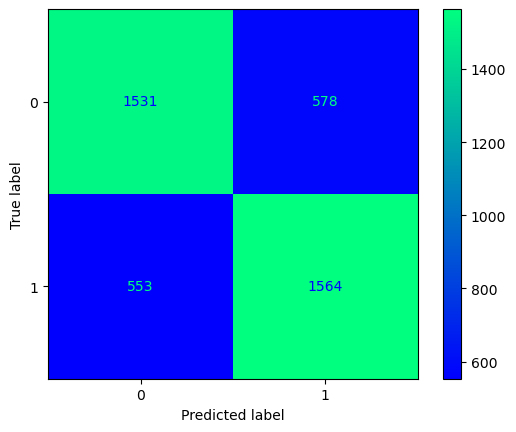

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.73      0.73      0.73      2109
           1       0.73      0.74      0.73      2117

    accuracy                           0.73      4226
   macro avg       0.73      0.73      0.73      4226
weighted avg       0.73      0.73      0.73      4226

-------------------------


In [269]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m3_10min.catboost_GridS()

In [270]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m3_10min,y_val_m3_10min)

Accuracy validación 0.5140098447557744


In [271]:
guardar_modelo(modelo_entrenado_15min,"m3_catboost_GridS_10min")

### Recopilación resultados

In [272]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m3_catboost_GridS", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 8.8. XGBoost

### Partidas 15 min

Hora de inicio:  06:31:04
Hora de fin:  06:31:06
-------------------------
Accuracy train 0.961043498515111
Accuracy test 0.7745691662785282
-------------------------
-------------------------
Matriz de confusión


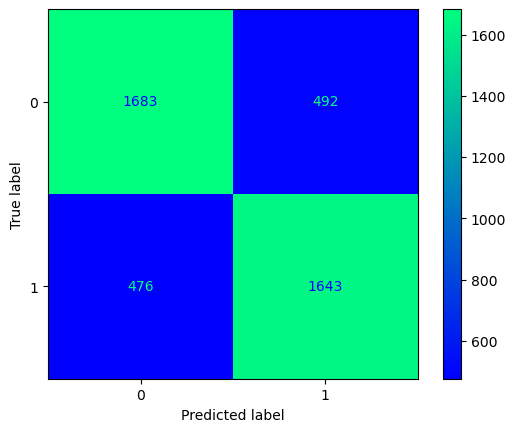

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.78      0.77      0.78      2175
           1       0.77      0.78      0.77      2119

    accuracy                           0.77      4294
   macro avg       0.77      0.77      0.77      4294
weighted avg       0.77      0.77      0.77      4294

-------------------------


In [273]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m3_15min.xgboost()

In [274]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m3_15min,y_val_m3_15min)

Accuracy validación 0.5451835289733556


In [275]:
guardar_modelo(modelo_entrenado_15min,"m3_xgboost_15min")

### Partidas 10 min

Hora de inicio:  06:31:06
Hora de fin:  06:31:07
-------------------------
Accuracy train 0.9384060114786107
Accuracy test 0.7214860388073828
-------------------------
-------------------------
Matriz de confusión


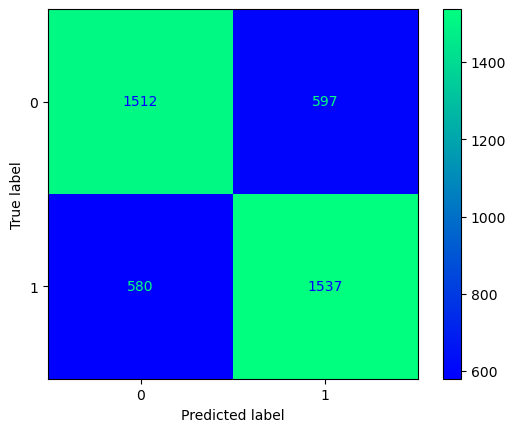

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.72      0.72      0.72      2109
           1       0.72      0.73      0.72      2117

    accuracy                           0.72      4226
   macro avg       0.72      0.72      0.72      4226
weighted avg       0.72      0.72      0.72      4226

-------------------------


In [276]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m3_10min.xgboost()

In [277]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m3_10min,y_val_m3_10min)

Accuracy validación 0.5071942446043165


In [278]:
guardar_modelo(modelo_entrenado_15min,"m3_xgboost_10min")

### Recopilación resultados

In [279]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m3_xgboost", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 8.9. XGBoost Optimizado

Este no

# 8.10. Lightgbm

### Partidas 15 min

Hora de inicio:  06:31:08
Hora de fin:  06:31:08
-------------------------
Accuracy train 0.885576195190124
Accuracy test 0.7911038658593386
-------------------------
-------------------------
Matriz de confusión


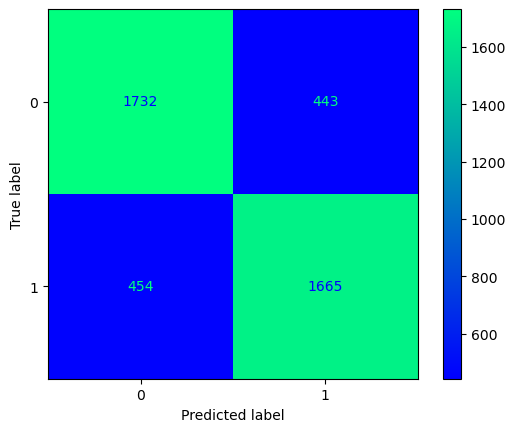

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.79      0.80      0.79      2175
           1       0.79      0.79      0.79      2119

    accuracy                           0.79      4294
   macro avg       0.79      0.79      0.79      4294
weighted avg       0.79      0.79      0.79      4294

-------------------------


In [280]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m3_15min.lightgbm()

In [281]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m3_15min,y_val_m3_15min)

Accuracy validación 0.6539966461710452


In [282]:
guardar_modelo(modelo_entrenado_15min,"m3_lightgbm_15min")

### Partidas 10 min

Hora de inicio:  06:31:08
Hora de fin:  06:31:08
-------------------------
Accuracy train 0.849062185669487
Accuracy test 0.7326076668244202
-------------------------
-------------------------
Matriz de confusión


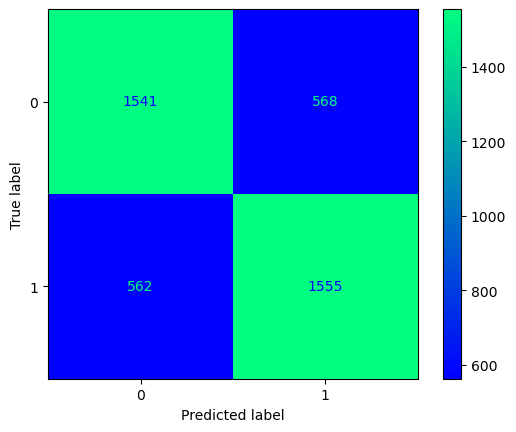

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.73      0.73      0.73      2109
           1       0.73      0.73      0.73      2117

    accuracy                           0.73      4226
   macro avg       0.73      0.73      0.73      4226
weighted avg       0.73      0.73      0.73      4226

-------------------------


In [283]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m3_10min.lightgbm()

In [284]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m3_10min,y_val_m3_10min)

Accuracy validación 0.5107913669064749


In [285]:
guardar_modelo(modelo_entrenado_15min,"m3_lightgbm_10min")

### Recopilación resultados

In [286]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m3_lightgbm", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 8.11. Lightgbm Optimizado

### Partidas 15 min

Hora de inicio:  06:31:09
Hora de fin:  06:34:38
-------------------------
Accuracy train 0.8103418156408315
Accuracy test 0.7971588262692129
-------------------------
-------------------------
Matriz de confusión


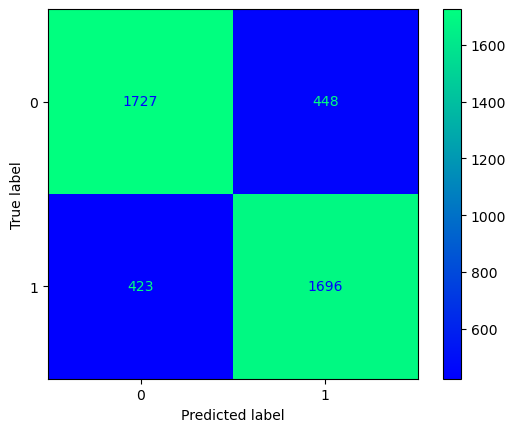

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.80      0.79      0.80      2175
           1       0.79      0.80      0.80      2119

    accuracy                           0.80      4294
   macro avg       0.80      0.80      0.80      4294
weighted avg       0.80      0.80      0.80      4294

-------------------------


In [287]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m3_15min.lightgbm_GridS()

In [288]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m3_15min,y_val_m3_15min)

Accuracy validación 0.5980994969256568


In [289]:
guardar_modelo(modelo_entrenado_15min,"m3_lightgbm_GridS_15min")

### Partidas 10 min

Hora de inicio:  06:34:39
Hora de fin:  06:37:49
-------------------------
Accuracy train 0.7545707354594403
Accuracy test 0.7404164694746805
-------------------------
-------------------------
Matriz de confusión


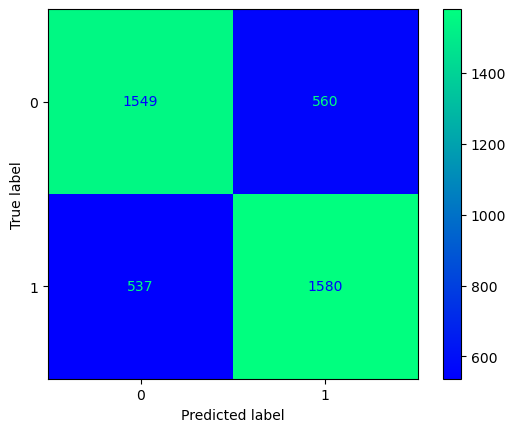

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.74      0.73      0.74      2109
           1       0.74      0.75      0.74      2117

    accuracy                           0.74      4226
   macro avg       0.74      0.74      0.74      4226
weighted avg       0.74      0.74      0.74      4226

-------------------------


In [290]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m3_10min.lightgbm_GridS()

In [291]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m3_10min,y_val_m3_10min)

Accuracy validación 0.5102234002271867


In [292]:
guardar_modelo(modelo_entrenado_15min,"m3_lightgbm_GridS_10min")

### Recopilación resultados

In [293]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m3_lightgbm_GridS", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 8.12. SVC

### Partidas 15 min

Hora de inicio:  06:37:49
Hora de fin:  06:38:01
-------------------------
Accuracy train 0.7861177429686135
Accuracy test 0.7715416860735911
-------------------------
-------------------------
Matriz de confusión


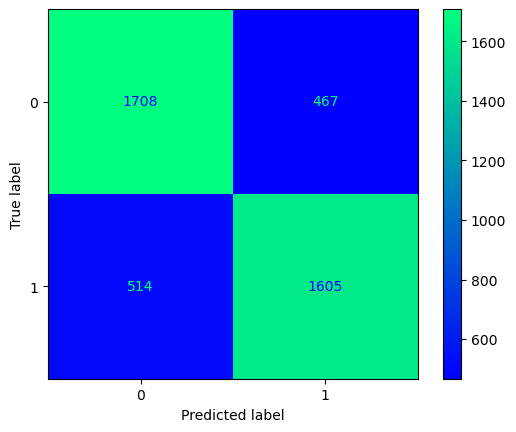

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.77      0.79      0.78      2175
           1       0.77      0.76      0.77      2119

    accuracy                           0.77      4294
   macro avg       0.77      0.77      0.77      4294
weighted avg       0.77      0.77      0.77      4294

-------------------------


In [294]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m3_15min.svc()

In [295]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m3_15min,y_val_m3_15min)

Accuracy validación 0.4920812371902366


In [296]:
guardar_modelo(modelo_entrenado_15min,"m3_svc_15min")

### Partidas 10 min

Hora de inicio:  06:38:29
Hora de fin:  06:38:43
-------------------------
Accuracy train 0.7330335483107508
Accuracy test 0.7285849503076195
-------------------------
-------------------------
Matriz de confusión


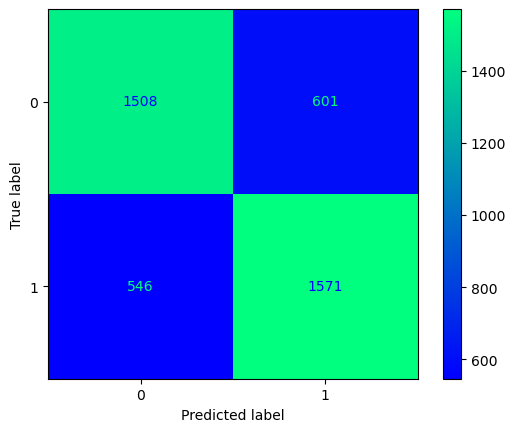

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.73      0.72      0.72      2109
           1       0.72      0.74      0.73      2117

    accuracy                           0.73      4226
   macro avg       0.73      0.73      0.73      4226
weighted avg       0.73      0.73      0.73      4226

-------------------------


In [297]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m3_10min.svc()

In [298]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m3_10min,y_val_m3_10min)

Accuracy validación 0.5018932222642938


In [299]:
guardar_modelo(modelo_entrenado_15min,"m3_svc_10min")

### Recopilación resultados

In [300]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m3_svc", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 8.13. SVC Optimizado

### Partidas 15 min

Hora de inicio:  06:39:16
Hora de fin:  06:53:12
-------------------------
Accuracy train 0.8005590170616665
Accuracy test 0.7859804378202142
-------------------------
-------------------------
Matriz de confusión


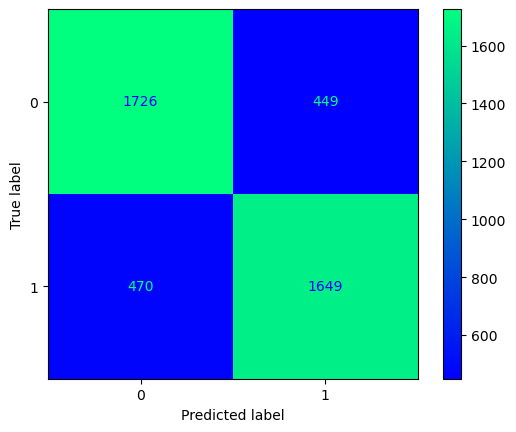

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.79      0.79      0.79      2175
           1       0.79      0.78      0.78      2119

    accuracy                           0.79      4294
   macro avg       0.79      0.79      0.79      4294
weighted avg       0.79      0.79      0.79      4294

-------------------------


In [301]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m3_15min.svc_GridS()

In [302]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m3_15min,y_val_m3_15min)

Accuracy validación 0.4920812371902366


In [303]:
guardar_modelo(modelo_entrenado_15min,"m3_svc_GridS_15min")

### Partidas 10 min

Hora de inicio:  06:53:38
Hora de fin:  07:07:10
-------------------------
Accuracy train 0.7507248091828886
Accuracy test 0.7309512541410317
-------------------------
-------------------------
Matriz de confusión


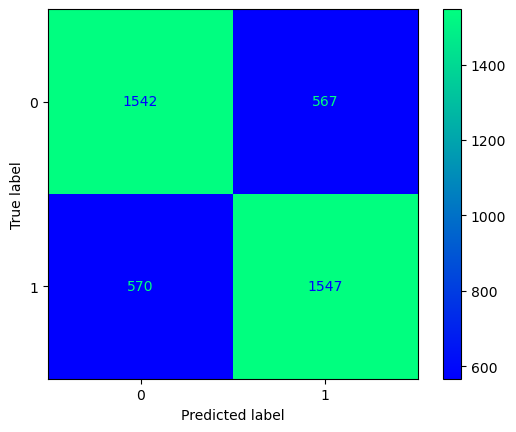

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.73      0.73      0.73      2109
           1       0.73      0.73      0.73      2117

    accuracy                           0.73      4226
   macro avg       0.73      0.73      0.73      4226
weighted avg       0.73      0.73      0.73      4226

-------------------------


In [304]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m3_10min.svc_GridS()

In [305]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m3_10min,y_val_m3_10min)

Accuracy validación 0.5018932222642938


In [306]:
guardar_modelo(modelo_entrenado_15min,"m3_svc_GridS_10min")

### Recopilación resultados

In [307]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m3_svc_GridS", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 8.14. LinearSVC

### Partidas 15 min

Hora de inicio:  07:07:40
Hora de fin:  07:07:40
-------------------------
Accuracy train 0.7871658999592384
Accuracy test 0.7827200745225896
-------------------------
-------------------------
Matriz de confusión


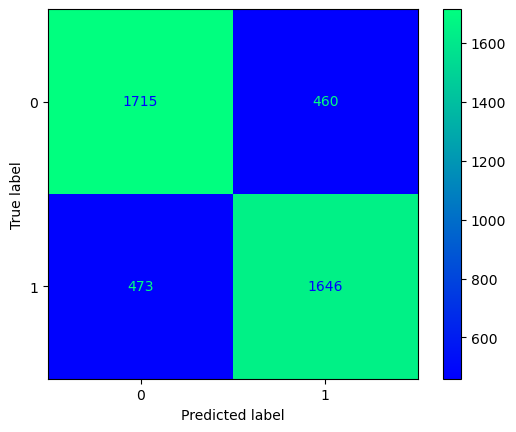

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.78      0.79      0.79      2175
           1       0.78      0.78      0.78      2119

    accuracy                           0.78      4294
   macro avg       0.78      0.78      0.78      4294
weighted avg       0.78      0.78      0.78      4294

-------------------------


In [308]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m3_15min.linearsvc()

In [309]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m3_15min,y_val_m3_15min)

Accuracy validación 0.5079187628097633


In [310]:
guardar_modelo(modelo_entrenado_15min,"m3_linearsvc_15min")

### Partidas 10 min

Hora de inicio:  07:07:40
Hora de fin:  07:07:41
-------------------------
Accuracy train 0.7287734453582628
Accuracy test 0.7302413629910081
-------------------------
-------------------------
Matriz de confusión


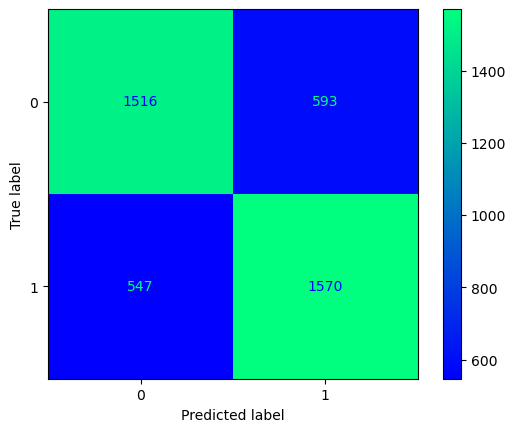

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.73      0.72      0.73      2109
           1       0.73      0.74      0.73      2117

    accuracy                           0.73      4226
   macro avg       0.73      0.73      0.73      4226
weighted avg       0.73      0.73      0.73      4226

-------------------------


In [311]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m3_10min.linearsvc()

In [312]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m3_10min,y_val_m3_10min)

Accuracy validación 0.49810677773570616


In [313]:
guardar_modelo(modelo_entrenado_15min,"m3_linearsvc_10min")

### Recopilación resultados

In [314]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m3_linearsvc", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 8.15. LinearSVC Optimizado

### Partidas 15 min

Hora de inicio:  07:07:41
Hora de fin:  07:09:37
-------------------------
Accuracy train 0.7868747452396203
Accuracy test 0.7852817885421518
-------------------------
-------------------------
Matriz de confusión


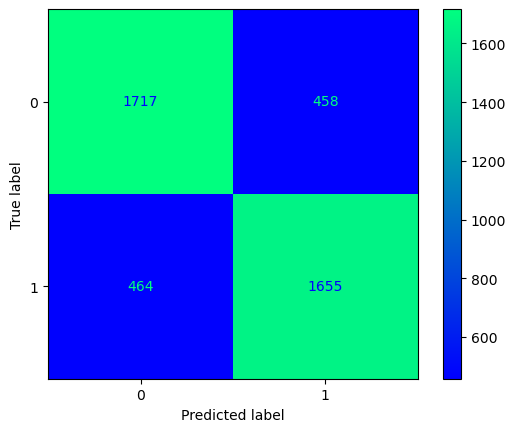

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.79      0.79      0.79      2175
           1       0.78      0.78      0.78      2119

    accuracy                           0.79      4294
   macro avg       0.79      0.79      0.79      4294
weighted avg       0.79      0.79      0.79      4294

-------------------------


In [315]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m3_15min.linearsvc_GridS()

In [316]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m3_15min,y_val_m3_15min)

Accuracy validación 0.5079187628097633


In [317]:
guardar_modelo(modelo_entrenado_15min,"m3_linearsvc_GridS_15min")

### Partidas 10 min

Hora de inicio:  07:09:37
Hora de fin:  07:11:18
-------------------------
Accuracy train 0.7278859239098279
Accuracy test 0.7269285376242309
-------------------------
-------------------------
Matriz de confusión


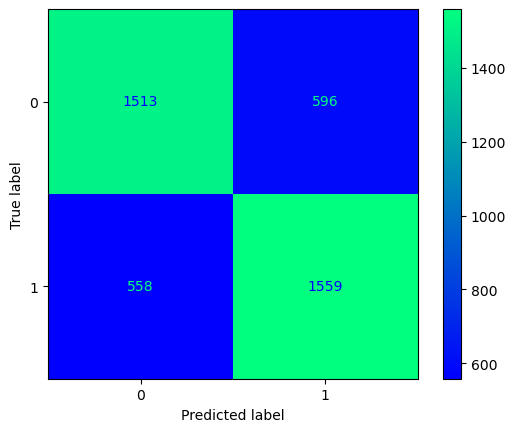

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.73      0.72      0.72      2109
           1       0.72      0.74      0.73      2117

    accuracy                           0.73      4226
   macro avg       0.73      0.73      0.73      4226
weighted avg       0.73      0.73      0.73      4226

-------------------------


In [318]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m3_10min.linearsvc_GridS()

In [319]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m3_10min,y_val_m3_10min)

Accuracy validación 0.49810677773570616


In [320]:
guardar_modelo(modelo_entrenado_15min,"m3_linearsvc_GridS_10min")

### Recopilación resultados

In [321]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m3_linearsvc_GridS", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 9. Modelo 4
Modelo basado en el modelo 2, pero aplicando un escalado a los datos. Se prueba con diferentes escalados a ver cual es el que mejor resultado obtiene, en este modelo se prueba el standarscaler()

In [322]:
#Se hace una copia de los datos iniciales para aplicar este modelo
m4_15min=datos_entrenamiento_15min.copy()

#Columnas muy correlacionadas >0.75. Se utiliza la función get_positive_corr_coefficient definida en el apartado Funciones
lista = list(set(get_positive_corr_coefficient(datos_entrenamiento_15min, 0.75).level_1.values))

#Segunda lista con el target y el ID
lista2 = ['blueWins','gameId']

#Se concatenan ambas listas
lista = lista + lista2

#Se crean la X y la y
X_m4_15min = m4_15min.copy()

#Bucle para eliminar las columnas obtenidas antes
for k in range(0, len(lista)):
    X_m4_15min.drop([lista[k]], axis=1, inplace=True)
    
y_m4_15min = m4_15min[['blueWins']]

#Se realiza la división 
X_train_m4_15min, X_test_m4_15min, y_train_m4_15min, y_test_m4_15min = train_test_split(X_m4_15min, y_m4_15min, test_size=0.2, random_state=42)

In [323]:
#Se preparan los datos de validación
validacion_m4_15min=datos_validacion_15min.copy()

#Se crean la X y la y
X_val_m4_15min = validacion_m4_15min.copy()

#Bucle para eliminar las columnas obtenidas antes
#Al ser datos de validación, hay que aplicar lo mismo que en train, por tanto se eliminan las mismas columnas
for k in range(0, len(lista)):
    X_val_m4_15min.drop([lista[k]], axis=1, inplace=True)
    
y_val_m4_15min = validacion_m4_15min[['blueWins']]

In [324]:
#Se hace una copia de los datos iniciales para aplicar este modelo
m4_10min=datos_entrenamiento_10min.copy()

#Columnas muy correlacionadas >0.75. Se utiliza la función get_positive_corr_coefficient definida en el apartado Funciones
lista = list(set(get_positive_corr_coefficient(datos_entrenamiento_10min, 0.75).level_1.values))

#Segunda lista con el target y el ID
lista2 = ['blueWins','gameId']

#Se concatenan ambas listas
lista = lista + lista2

#Se crean la X y la y
X_m4_10min = m4_10min.copy()

#Bucle para eliminar las columnas obtenidas antes
for k in range(0, len(lista)):
    X_m4_10min.drop([lista[k]], axis=1, inplace=True)
    
y_m4_10min = m4_10min[['blueWins']]

#Se realiza la división 
X_train_m4_10min, X_test_m4_10min, y_train_m4_10min, y_test_m4_10min = train_test_split(X_m4_10min, y_m4_10min, test_size=0.2, random_state=42)

In [325]:
#Se preparan los datos de validación
validacion_m4_10min=datos_validacion_10min.copy()

#Se crean la X y la y
X_val_m4_10min = validacion_m4_10min.copy()

#Bucle para eliminar las columnas obtenidas antes
#Al ser datos de validación, hay que aplicar lo mismo que en train, por tanto se eliminan las mismas columnas
for k in range(0, len(lista)):
    X_val_m4_10min.drop([lista[k]], axis=1, inplace=True)
    
y_val_m4_10min = validacion_m4_10min[['blueWins']]

## StandardScaler

In [326]:
# Se almacenan en el objeto scaler todo lo necesario para estandarizar, con los datos de train de partidas de 15min
scaler = StandardScaler()
scaler.fit(X_train_m4_15min)

# Se utilizan los datos de train para escalar train y test.
X_train_m4_15min = scaler.transform(X_train_m4_15min)
X_test_m4_15min = scaler.transform(X_test_m4_15min)

In [327]:
# Se almacenan en el objeto scaler todo lo necesario para estandarizar, con los datos de train de partidas de 10min
scaler = StandardScaler()
scaler.fit(X_train_m4_10min)

# Se utilizan los datos de train para escalar train y test.
X_train_m4_10min = scaler.transform(X_train_m4_10min)
X_test_m4_10min = scaler.transform(X_test_m4_10min)

In [328]:
# Se almacenan en el objeto scaler todo lo necesario para estandarizar, con los datos de validacion de partidas de 15min
scaler = StandardScaler()
scaler.fit(X_val_m4_15min)

# Se almacenan en el objeto scaler todo lo necesario para estandarizar, con los datos de validacion de partidas de 15min
scaler = StandardScaler()
scaler.fit(X_val_m4_10min)

StandardScaler()

In [329]:
#Se crean los objetos
m4_15min = Models(X_train_m4_15min, X_test_m4_15min, y_train_m4_15min, y_test_m4_15min)
m4_10min = Models(X_train_m4_10min, X_test_m4_10min, y_train_m4_10min, y_test_m4_10min)

# 9.1. LazyClassifier

In [330]:
#LazyClassifier
m4_15min.lazyclassifier()

100%|██████████████████████████████████████████████████████████████████████████████████| 29/29 [01:42<00:00,  3.52s/it]


,Accuracy,Balanced Accuracy,ROC AUC,F1 Score,Time Taken
Model,,,,,
AdaBoostClassifier,0.80,0.80,0.80,0.80,0.95
LGBMClassifier,0.80,0.80,0.80,0.80,0.17
RandomForestClassifier,0.79,0.79,0.79,0.79,2.25
SVC,0.79,0.79,0.79,0.79,16.08
NuSVC,0.79,0.79,0.79,0.79,23.12
LogisticRegression,0.79,0.79,0.79,0.79,0.10
LinearSVC,0.79,0.78,0.78,0.79,2.48
CalibratedClassifierCV,0.79,0.78,0.78,0.79,9.25
XGBClassifier,0.78,0.78,0.78,0.78,0.82


In [331]:
#LazyClassifier
m4_10min.lazyclassifier()

100%|██████████████████████████████████████████████████████████████████████████████████| 29/29 [01:48<00:00,  3.75s/it]


,Accuracy,Balanced Accuracy,ROC AUC,F1 Score,Time Taken
Model,,,,,
LGBMClassifier,0.74,0.74,0.74,0.74,0.16
RandomForestClassifier,0.74,0.74,0.74,0.74,2.19
AdaBoostClassifier,0.74,0.74,0.74,0.74,0.91
CalibratedClassifierCV,0.73,0.73,0.73,0.73,9.45
LogisticRegression,0.73,0.73,0.73,0.73,0.13
RidgeClassifierCV,0.73,0.73,0.73,0.73,0.07
LinearSVC,0.73,0.73,0.73,0.73,2.61
LinearDiscriminantAnalysis,0.73,0.73,0.73,0.73,0.09
RidgeClassifier,0.73,0.73,0.73,0.73,0.05


# 9.2. Random Forest

### Partidas 15 min

Hora de inicio:  07:14:50
Hora de fin:  07:14:54
-------------------------
Accuracy train 1.0
Accuracy test 0.7892408011178389
-------------------------
-------------------------
Matriz de confusión


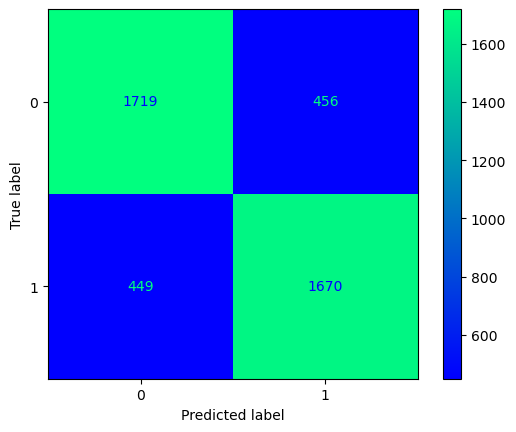

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.79      0.79      0.79      2175
           1       0.79      0.79      0.79      2119

    accuracy                           0.79      4294
   macro avg       0.79      0.79      0.79      4294
weighted avg       0.79      0.79      0.79      4294

-------------------------


In [332]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m4_15min.randomforest()

In [333]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m4_15min,y_val_m4_15min)

Accuracy validación 0.6014533258803801


In [334]:
guardar_modelo(modelo_entrenado_15min,"m4_randomforest_15min")

### Partidas 10 min

Hora de inicio:  07:14:56
Hora de fin:  07:15:00
-------------------------
Accuracy train 1.0
Accuracy test 0.735447231424515
-------------------------
-------------------------
Matriz de confusión


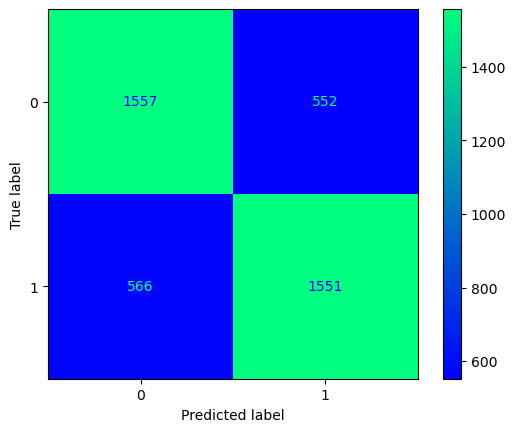

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.73      0.74      0.74      2109
           1       0.74      0.73      0.74      2117

    accuracy                           0.74      4226
   macro avg       0.74      0.74      0.74      4226
weighted avg       0.74      0.74      0.74      4226

-------------------------


In [335]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m4_10min.randomforest()

In [336]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m4_10min,y_val_m4_10min)

Accuracy validación 0.5098447557743279


In [337]:
guardar_modelo(modelo_entrenado_15min,"m4_randomforest_10min")

### Recopilación resultados

In [338]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m4_randomforest", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 9.3. Random Forest Optimizado

### Partidas 15 min

Hora de inicio:  07:15:01
Hora de fin:  07:45:39
-------------------------
Accuracy train 0.8044604903045478
Accuracy test 0.780391243595715
-------------------------
-------------------------
Matriz de confusión


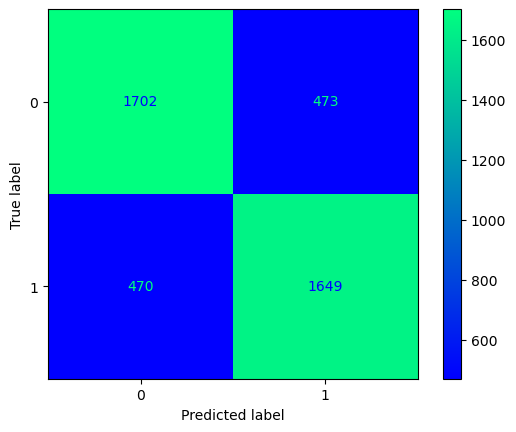

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.78      0.78      0.78      2175
           1       0.78      0.78      0.78      2119

    accuracy                           0.78      4294
   macro avg       0.78      0.78      0.78      4294
weighted avg       0.78      0.78      0.78      4294

-------------------------


In [339]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m4_15min.randomforest_GridS()

In [340]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m4_15min,y_val_m4_15min)

Accuracy validación 0.6854853735792807


In [341]:
guardar_modelo(modelo_entrenado_15min,"m4_randomforest_GridS_15min")

### Partidas 10 min

Hora de inicio:  07:45:39
Hora de fin:  08:15:09
-------------------------
Accuracy train 0.756286610259748
Accuracy test 0.7318977756743966
-------------------------
-------------------------
Matriz de confusión


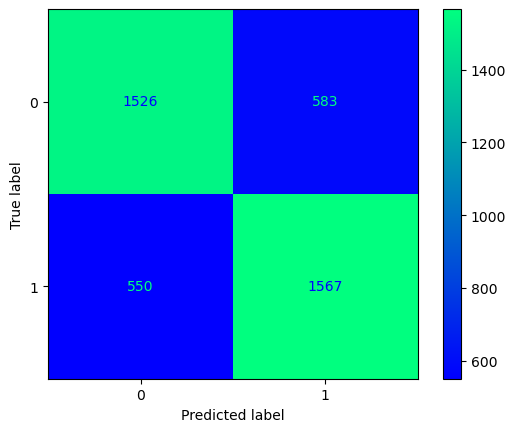

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.74      0.72      0.73      2109
           1       0.73      0.74      0.73      2117

    accuracy                           0.73      4226
   macro avg       0.73      0.73      0.73      4226
weighted avg       0.73      0.73      0.73      4226

-------------------------


In [342]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m4_10min.randomforest_GridS()

In [343]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m4_10min,y_val_m4_10min)

Accuracy validación 0.6236274138583869


In [344]:
guardar_modelo(modelo_entrenado_15min,"m4_randomforest_GridS_10min")

### Recopilación resultados

In [345]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m4_randomforest_GridS", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 9.4. Gradient boosting 

### Partidas 15 min

Hora de inicio:  08:15:10
Hora de fin:  08:15:16
-------------------------
Accuracy train 0.8154079077621849
Accuracy test 0.7943642291569633
-------------------------
-------------------------
Matriz de confusión


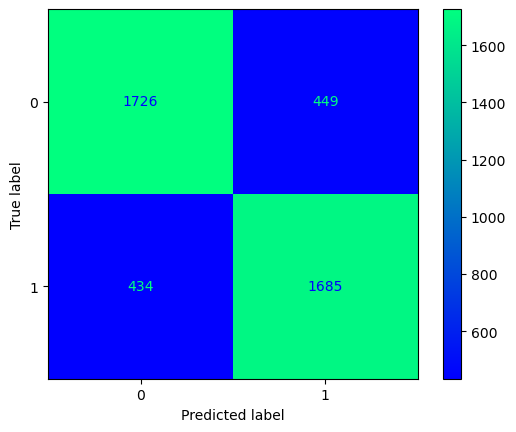

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.80      0.79      0.80      2175
           1       0.79      0.80      0.79      2119

    accuracy                           0.79      4294
   macro avg       0.79      0.79      0.79      4294
weighted avg       0.79      0.79      0.79      4294

-------------------------


In [346]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m4_15min.gradientboosting()

In [347]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m4_15min,y_val_m4_15min)

Accuracy validación 0.5597167877771567


In [348]:
guardar_modelo(modelo_entrenado_15min,"m4_gradientboosting_15min")

### Partidas 10 min

Hora de inicio:  08:15:17
Hora de fin:  08:15:23
-------------------------
Accuracy train 0.7613158984675463
Accuracy test 0.7389966871746332
-------------------------
-------------------------
Matriz de confusión


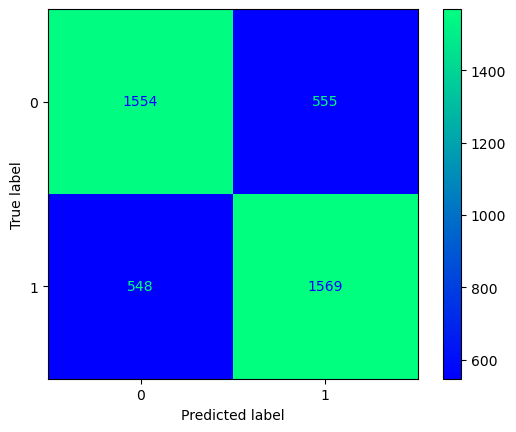

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.74      0.74      0.74      2109
           1       0.74      0.74      0.74      2117

    accuracy                           0.74      4226
   macro avg       0.74      0.74      0.74      4226
weighted avg       0.74      0.74      0.74      4226

-------------------------


In [349]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m4_10min.gradientboosting()

In [350]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m4_10min,y_val_m4_10min)

Accuracy validación 0.5018932222642938


In [351]:
guardar_modelo(modelo_entrenado_15min,"m4_gradientboosting_10min")

### Recopilación resultados

In [352]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m4_gradientboosting", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 9.5. Gradient boosting Optimizado

### Partidas 15 min

Hora de inicio:  08:15:23
Hora de fin:  08:36:53
-------------------------
Accuracy train 0.8084201944913527
Accuracy test 0.7945971122496507
-------------------------
-------------------------
Matriz de confusión


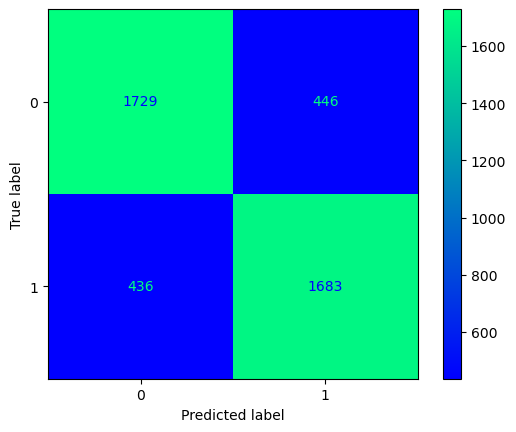

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.80      0.79      0.80      2175
           1       0.79      0.79      0.79      2119

    accuracy                           0.79      4294
   macro avg       0.79      0.79      0.79      4294
weighted avg       0.79      0.79      0.79      4294

-------------------------


In [353]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m4_15min.gradientboosting_GridS()

In [354]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m4_15min,y_val_m4_15min)

Accuracy validación 0.5036333147009503


In [355]:
guardar_modelo(modelo_entrenado_15min,"m4_gradientboosting_GridS_15min")

### Partidas 10 min

Hora de inicio:  08:36:53
Hora de fin:  08:57:04
-------------------------
Accuracy train 0.7551624164250637
Accuracy test 0.7373402744912447
-------------------------
-------------------------
Matriz de confusión


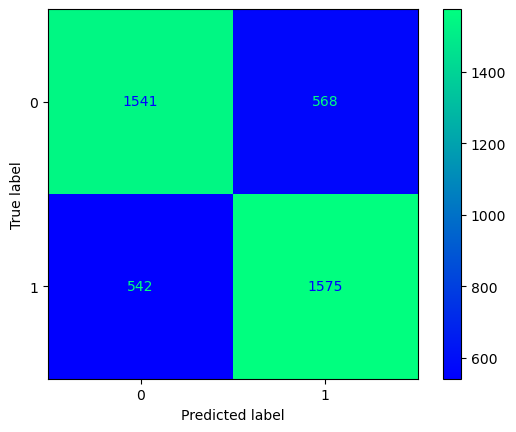

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.74      0.73      0.74      2109
           1       0.73      0.74      0.74      2117

    accuracy                           0.74      4226
   macro avg       0.74      0.74      0.74      4226
weighted avg       0.74      0.74      0.74      4226

-------------------------


In [356]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m4_10min.gradientboosting_GridS()

In [357]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m4_10min,y_val_m4_10min)

Accuracy validación 0.6109428246876183


In [358]:
guardar_modelo(modelo_entrenado_15min,"m4_gradientboosting_GridS_10min")

### Recopilación resultados

In [359]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m4_gradientboosting_GridS", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 9.6. Catboost

### Partidas 15 min

Hora de inicio:  08:57:04
Learning rate set to 0.151764
0:	learn: 0.6280478	total: 5.65ms	remaining: 1.12s
1:	learn: 0.5811880	total: 11ms	remaining: 1.09s
2:	learn: 0.5452961	total: 16.2ms	remaining: 1.06s
3:	learn: 0.5188547	total: 21.3ms	remaining: 1.04s
4:	learn: 0.4974394	total: 26.5ms	remaining: 1.03s
5:	learn: 0.4845805	total: 31.2ms	remaining: 1.01s
6:	learn: 0.4749115	total: 36.6ms	remaining: 1.01s
7:	learn: 0.4669581	total: 41.9ms	remaining: 1s
8:	learn: 0.4597429	total: 47ms	remaining: 998ms
9:	learn: 0.4548147	total: 52.4ms	remaining: 996ms
10:	learn: 0.4507176	total: 57.6ms	remaining: 989ms
11:	learn: 0.4466177	total: 62.9ms	remaining: 985ms
12:	learn: 0.4435788	total: 68.2ms	remaining: 981ms
13:	learn: 0.4406219	total: 73.4ms	remaining: 975ms
14:	learn: 0.4389668	total: 78.6ms	remaining: 970ms
15:	learn: 0.4370834	total: 85.1ms	remaining: 979ms
16:	learn: 0.4358669	total: 91.9ms	remaining: 989ms
17:	learn: 0.4343010	total: 98.5ms	remaining: 996ms
18:	learn: 0.4326345	tota

174:	learn: 0.3520151	total: 914ms	remaining: 131ms
175:	learn: 0.3516275	total: 920ms	remaining: 125ms
176:	learn: 0.3510227	total: 925ms	remaining: 120ms
177:	learn: 0.3507018	total: 930ms	remaining: 115ms
178:	learn: 0.3502562	total: 935ms	remaining: 110ms
179:	learn: 0.3499458	total: 940ms	remaining: 104ms
180:	learn: 0.3495514	total: 945ms	remaining: 99.2ms
181:	learn: 0.3493448	total: 950ms	remaining: 93.9ms
182:	learn: 0.3490727	total: 955ms	remaining: 88.7ms
183:	learn: 0.3487500	total: 960ms	remaining: 83.4ms
184:	learn: 0.3484205	total: 965ms	remaining: 78.2ms
185:	learn: 0.3481655	total: 970ms	remaining: 73ms
186:	learn: 0.3478668	total: 974ms	remaining: 67.7ms
187:	learn: 0.3476417	total: 979ms	remaining: 62.5ms
188:	learn: 0.3476029	total: 984ms	remaining: 57.3ms
189:	learn: 0.3471196	total: 989ms	remaining: 52ms
190:	learn: 0.3466318	total: 994ms	remaining: 46.8ms
191:	learn: 0.3461263	total: 999ms	remaining: 41.6ms
192:	learn: 0.3457525	total: 1s	remaining: 36.4ms
193:	l

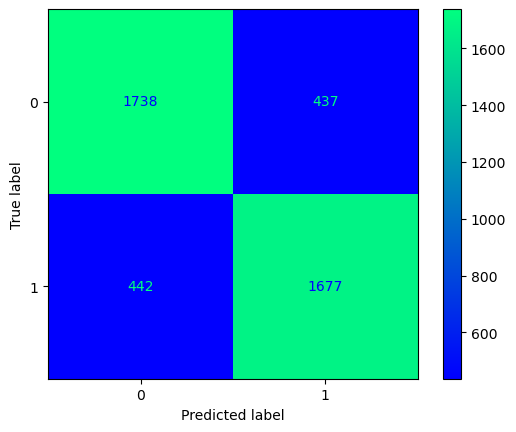

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.80      0.80      0.80      2175
           1       0.79      0.79      0.79      2119

    accuracy                           0.80      4294
   macro avg       0.80      0.80      0.80      4294
weighted avg       0.80      0.80      0.80      4294

-------------------------


In [360]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m4_15min.catboost()

In [361]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m4_15min,y_val_m4_15min)

Accuracy validación 0.5213340786286565


In [362]:
guardar_modelo(modelo_entrenado_15min,"m4_catboost_15min")

### Partidas 10 min

Hora de inicio:  08:57:06
Learning rate set to 0.150733
0:	learn: 0.6515417	total: 5.54ms	remaining: 1.1s
1:	learn: 0.6211600	total: 11.4ms	remaining: 1.13s
2:	learn: 0.5981348	total: 17.1ms	remaining: 1.12s
3:	learn: 0.5814208	total: 22.9ms	remaining: 1.12s
4:	learn: 0.5700351	total: 28.6ms	remaining: 1.11s
5:	learn: 0.5612233	total: 34.3ms	remaining: 1.11s
6:	learn: 0.5540599	total: 40.2ms	remaining: 1.11s
7:	learn: 0.5494562	total: 45.8ms	remaining: 1.1s
8:	learn: 0.5450298	total: 51.4ms	remaining: 1.09s
9:	learn: 0.5421207	total: 57.2ms	remaining: 1.09s
10:	learn: 0.5379909	total: 62.7ms	remaining: 1.08s
11:	learn: 0.5349434	total: 68.6ms	remaining: 1.07s
12:	learn: 0.5328604	total: 74.1ms	remaining: 1.07s
13:	learn: 0.5312753	total: 79.7ms	remaining: 1.06s
14:	learn: 0.5289388	total: 85.4ms	remaining: 1.05s
15:	learn: 0.5273856	total: 90.9ms	remaining: 1.04s
16:	learn: 0.5258589	total: 96.5ms	remaining: 1.04s
17:	learn: 0.5243418	total: 102ms	remaining: 1.03s
18:	learn: 0.5233372	

166:	learn: 0.4478255	total: 960ms	remaining: 190ms
167:	learn: 0.4475752	total: 966ms	remaining: 184ms
168:	learn: 0.4471620	total: 972ms	remaining: 178ms
169:	learn: 0.4465641	total: 978ms	remaining: 173ms
170:	learn: 0.4458999	total: 984ms	remaining: 167ms
171:	learn: 0.4455046	total: 989ms	remaining: 161ms
172:	learn: 0.4450175	total: 995ms	remaining: 155ms
173:	learn: 0.4448757	total: 1s	remaining: 149ms
174:	learn: 0.4448534	total: 1.01s	remaining: 144ms
175:	learn: 0.4446007	total: 1.01s	remaining: 138ms
176:	learn: 0.4441117	total: 1.02s	remaining: 132ms
177:	learn: 0.4436871	total: 1.02s	remaining: 126ms
178:	learn: 0.4431720	total: 1.03s	remaining: 121ms
179:	learn: 0.4426345	total: 1.03s	remaining: 115ms
180:	learn: 0.4421865	total: 1.04s	remaining: 109ms
181:	learn: 0.4415904	total: 1.05s	remaining: 103ms
182:	learn: 0.4410504	total: 1.05s	remaining: 97.7ms
183:	learn: 0.4405852	total: 1.06s	remaining: 92ms
184:	learn: 0.4401967	total: 1.06s	remaining: 86.2ms
185:	learn: 0.

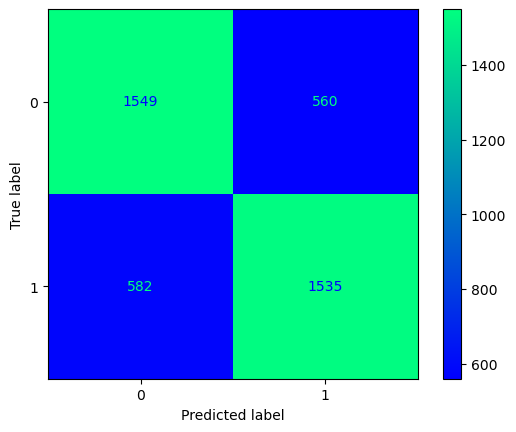

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.73      0.73      0.73      2109
           1       0.73      0.73      0.73      2117

    accuracy                           0.73      4226
   macro avg       0.73      0.73      0.73      4226
weighted avg       0.73      0.73      0.73      4226

-------------------------


In [363]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m4_10min.catboost()

In [364]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m4_10min,y_val_m4_10min)

Accuracy validación 0.5051117001135933


In [365]:
guardar_modelo(modelo_entrenado_15min,"m4_catboost_10min")

### Recopilación resultados

In [366]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m4_catboost", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 9.7. CatBoost Optimizado

### Partidas 15 min

Hora de inicio:  08:57:07
0:	learn: 0.6729135	test: 0.6719676	best: 0.6719676 (0)	total: 3.06ms	remaining: 303ms
1:	learn: 0.6564123	test: 0.6545196	best: 0.6545196 (1)	total: 6.15ms	remaining: 301ms
2:	learn: 0.6403817	test: 0.6377959	best: 0.6377959 (2)	total: 8.98ms	remaining: 291ms
3:	learn: 0.6262070	test: 0.6229564	best: 0.6229564 (3)	total: 11.8ms	remaining: 283ms
4:	learn: 0.6140539	test: 0.6101655	best: 0.6101655 (4)	total: 14.7ms	remaining: 280ms
5:	learn: 0.6037135	test: 0.5990991	best: 0.5990991 (5)	total: 17.4ms	remaining: 273ms
6:	learn: 0.5925952	test: 0.5874633	best: 0.5874633 (6)	total: 20.3ms	remaining: 269ms
7:	learn: 0.5826162	test: 0.5771491	best: 0.5771491 (7)	total: 23.1ms	remaining: 265ms
8:	learn: 0.5727664	test: 0.5672314	best: 0.5672314 (8)	total: 26.2ms	remaining: 265ms
9:	learn: 0.5635804	test: 0.5573817	best: 0.5573817 (9)	total: 29.4ms	remaining: 265ms
10:	learn: 0.5563519	test: 0.5499694	best: 0.5499694 (10)	total: 32.5ms	remaining: 263ms
11:	learn: 0.54

1:	learn: 0.6255807	test: 0.6219531	best: 0.6219531 (1)	total: 6.73ms	remaining: 330ms
2:	learn: 0.6009426	test: 0.5965297	best: 0.5965297 (2)	total: 9.69ms	remaining: 313ms
3:	learn: 0.5805022	test: 0.5758578	best: 0.5758578 (3)	total: 12.3ms	remaining: 296ms
4:	learn: 0.5630179	test: 0.5569482	best: 0.5569482 (4)	total: 15ms	remaining: 285ms
5:	learn: 0.5491414	test: 0.5417077	best: 0.5417077 (5)	total: 17.8ms	remaining: 278ms
6:	learn: 0.5353008	test: 0.5269383	best: 0.5269383 (6)	total: 20.8ms	remaining: 277ms
7:	learn: 0.5256225	test: 0.5166190	best: 0.5166190 (7)	total: 23.6ms	remaining: 272ms
8:	learn: 0.5157635	test: 0.5058786	best: 0.5058786 (8)	total: 26.7ms	remaining: 269ms
9:	learn: 0.5090166	test: 0.4992426	best: 0.4992426 (9)	total: 29.2ms	remaining: 263ms
10:	learn: 0.5020953	test: 0.4915273	best: 0.4915273 (10)	total: 32.1ms	remaining: 260ms
11:	learn: 0.4954979	test: 0.4847222	best: 0.4847222 (11)	total: 35.2ms	remaining: 258ms
12:	learn: 0.4900399	test: 0.4789547	best

6:	learn: 0.5059232	test: 0.4973047	best: 0.4973047 (6)	total: 20.8ms	remaining: 276ms
7:	learn: 0.4961572	test: 0.4867334	best: 0.4867334 (7)	total: 23.7ms	remaining: 272ms
8:	learn: 0.4898102	test: 0.4792078	best: 0.4792078 (8)	total: 26.3ms	remaining: 266ms
9:	learn: 0.4834347	test: 0.4718343	best: 0.4718343 (9)	total: 29.3ms	remaining: 264ms
10:	learn: 0.4778927	test: 0.4661573	best: 0.4661573 (10)	total: 32ms	remaining: 259ms
11:	learn: 0.4730618	test: 0.4608464	best: 0.4608464 (11)	total: 34.9ms	remaining: 256ms
12:	learn: 0.4696011	test: 0.4563152	best: 0.4563152 (12)	total: 37.9ms	remaining: 253ms
13:	learn: 0.4667224	test: 0.4536195	best: 0.4536195 (13)	total: 40.5ms	remaining: 249ms
14:	learn: 0.4625939	test: 0.4487247	best: 0.4487247 (14)	total: 43.2ms	remaining: 245ms
15:	learn: 0.4604846	test: 0.4462321	best: 0.4462321 (15)	total: 45.8ms	remaining: 240ms
16:	learn: 0.4579788	test: 0.4434333	best: 0.4434333 (16)	total: 48.5ms	remaining: 237ms
17:	learn: 0.4561278	test: 0.44

17:	learn: 0.4487822	test: 0.4311316	best: 0.4311316 (17)	total: 51.5ms	remaining: 234ms
18:	learn: 0.4467958	test: 0.4289126	best: 0.4289126 (18)	total: 54.4ms	remaining: 232ms
19:	learn: 0.4454626	test: 0.4278203	best: 0.4278203 (19)	total: 57ms	remaining: 228ms
20:	learn: 0.4442291	test: 0.4259459	best: 0.4259459 (20)	total: 59.7ms	remaining: 225ms
21:	learn: 0.4435879	test: 0.4252466	best: 0.4252466 (21)	total: 62.6ms	remaining: 222ms
22:	learn: 0.4428273	test: 0.4241457	best: 0.4241457 (22)	total: 65.1ms	remaining: 218ms
23:	learn: 0.4419354	test: 0.4232176	best: 0.4232176 (23)	total: 67.8ms	remaining: 215ms
24:	learn: 0.4412087	test: 0.4224799	best: 0.4224799 (24)	total: 70.5ms	remaining: 211ms
25:	learn: 0.4403891	test: 0.4216837	best: 0.4216837 (25)	total: 73.2ms	remaining: 208ms
26:	learn: 0.4397995	test: 0.4209863	best: 0.4209863 (26)	total: 76.1ms	remaining: 206ms
27:	learn: 0.4383660	test: 0.4197655	best: 0.4197655 (27)	total: 79.2ms	remaining: 204ms
28:	learn: 0.4378867	te

20:	learn: 0.4319986	test: 0.4156930	best: 0.4156930 (20)	total: 58ms	remaining: 218ms
21:	learn: 0.4309923	test: 0.4155882	best: 0.4155882 (21)	total: 61.4ms	remaining: 218ms
22:	learn: 0.4298044	test: 0.4151146	best: 0.4151146 (22)	total: 64.1ms	remaining: 215ms
23:	learn: 0.4288641	test: 0.4146923	best: 0.4146923 (23)	total: 66.4ms	remaining: 210ms
24:	learn: 0.4281436	test: 0.4147984	best: 0.4146923 (23)	total: 69.1ms	remaining: 207ms
25:	learn: 0.4273443	test: 0.4143148	best: 0.4143148 (25)	total: 71.6ms	remaining: 204ms
26:	learn: 0.4264270	test: 0.4148869	best: 0.4143148 (25)	total: 74.3ms	remaining: 201ms
27:	learn: 0.4256627	test: 0.4136615	best: 0.4136615 (27)	total: 77.2ms	remaining: 198ms
28:	learn: 0.4250047	test: 0.4138745	best: 0.4136615 (27)	total: 80.2ms	remaining: 196ms
29:	learn: 0.4243785	test: 0.4190898	best: 0.4136615 (27)	total: 83.1ms	remaining: 194ms
30:	learn: 0.4236329	test: 0.4191794	best: 0.4136615 (27)	total: 85.7ms	remaining: 191ms
31:	learn: 0.4229241	te

35:	learn: 0.4733331	test: 0.4614738	best: 0.4614738 (35)	total: 103ms	remaining: 183ms
36:	learn: 0.4720722	test: 0.4602869	best: 0.4602869 (36)	total: 106ms	remaining: 180ms
37:	learn: 0.4710529	test: 0.4590467	best: 0.4590467 (37)	total: 109ms	remaining: 178ms
38:	learn: 0.4696716	test: 0.4573869	best: 0.4573869 (38)	total: 112ms	remaining: 175ms
39:	learn: 0.4682333	test: 0.4557086	best: 0.4557086 (39)	total: 115ms	remaining: 172ms
40:	learn: 0.4672776	test: 0.4547840	best: 0.4547840 (40)	total: 117ms	remaining: 169ms
41:	learn: 0.4661809	test: 0.4536081	best: 0.4536081 (41)	total: 120ms	remaining: 166ms
42:	learn: 0.4652053	test: 0.4525767	best: 0.4525767 (42)	total: 123ms	remaining: 163ms
43:	learn: 0.4641712	test: 0.4514148	best: 0.4514148 (43)	total: 126ms	remaining: 160ms
44:	learn: 0.4631735	test: 0.4500264	best: 0.4500264 (44)	total: 129ms	remaining: 157ms
45:	learn: 0.4623544	test: 0.4490665	best: 0.4490665 (45)	total: 131ms	remaining: 154ms
46:	learn: 0.4616431	test: 0.448

34:	learn: 0.4496755	test: 0.4347554	best: 0.4347554 (34)	total: 99ms	remaining: 184ms
35:	learn: 0.4487449	test: 0.4335738	best: 0.4335738 (35)	total: 102ms	remaining: 181ms
36:	learn: 0.4481294	test: 0.4329653	best: 0.4329653 (36)	total: 105ms	remaining: 178ms
37:	learn: 0.4473386	test: 0.4321440	best: 0.4321440 (37)	total: 107ms	remaining: 175ms
38:	learn: 0.4464320	test: 0.4310203	best: 0.4310203 (38)	total: 110ms	remaining: 172ms
39:	learn: 0.4455892	test: 0.4301108	best: 0.4301108 (39)	total: 113ms	remaining: 170ms
40:	learn: 0.4449690	test: 0.4295732	best: 0.4295732 (40)	total: 116ms	remaining: 167ms
41:	learn: 0.4444957	test: 0.4289870	best: 0.4289870 (41)	total: 118ms	remaining: 163ms
42:	learn: 0.4439862	test: 0.4282738	best: 0.4282738 (42)	total: 121ms	remaining: 161ms
43:	learn: 0.4436976	test: 0.4280564	best: 0.4280564 (43)	total: 124ms	remaining: 158ms
44:	learn: 0.4429835	test: 0.4271141	best: 0.4271141 (44)	total: 127ms	remaining: 155ms
45:	learn: 0.4425095	test: 0.4266

55:	learn: 0.4305791	test: 0.4165616	best: 0.4165616 (55)	total: 156ms	remaining: 123ms
56:	learn: 0.4302522	test: 0.4162670	best: 0.4162670 (56)	total: 161ms	remaining: 122ms
57:	learn: 0.4300997	test: 0.4160398	best: 0.4160398 (57)	total: 165ms	remaining: 120ms
58:	learn: 0.4298586	test: 0.4158055	best: 0.4158055 (58)	total: 171ms	remaining: 119ms
59:	learn: 0.4294873	test: 0.4153020	best: 0.4153020 (59)	total: 178ms	remaining: 119ms
60:	learn: 0.4292300	test: 0.4150555	best: 0.4150555 (60)	total: 181ms	remaining: 116ms
61:	learn: 0.4290273	test: 0.4149335	best: 0.4149335 (61)	total: 183ms	remaining: 112ms
62:	learn: 0.4287089	test: 0.4146906	best: 0.4146906 (62)	total: 186ms	remaining: 109ms
63:	learn: 0.4284176	test: 0.4145587	best: 0.4145587 (63)	total: 189ms	remaining: 106ms
64:	learn: 0.4281652	test: 0.4145540	best: 0.4145540 (64)	total: 191ms	remaining: 103ms
65:	learn: 0.4275949	test: 0.4138772	best: 0.4138772 (65)	total: 194ms	remaining: 100ms
66:	learn: 0.4272126	test: 0.413

47:	learn: 0.4295706	test: 0.4122828	best: 0.4122828 (47)	total: 133ms	remaining: 144ms
48:	learn: 0.4292949	test: 0.4119735	best: 0.4119735 (48)	total: 136ms	remaining: 141ms
49:	learn: 0.4288858	test: 0.4116605	best: 0.4116605 (49)	total: 139ms	remaining: 139ms
50:	learn: 0.4284704	test: 0.4115203	best: 0.4115203 (50)	total: 142ms	remaining: 136ms
51:	learn: 0.4280944	test: 0.4112178	best: 0.4112178 (51)	total: 144ms	remaining: 133ms
52:	learn: 0.4274263	test: 0.4106212	best: 0.4106212 (52)	total: 147ms	remaining: 130ms
53:	learn: 0.4270387	test: 0.4104438	best: 0.4104438 (53)	total: 150ms	remaining: 128ms
54:	learn: 0.4267031	test: 0.4104364	best: 0.4104364 (54)	total: 153ms	remaining: 125ms
55:	learn: 0.4262730	test: 0.4102083	best: 0.4102083 (55)	total: 156ms	remaining: 122ms
56:	learn: 0.4260144	test: 0.4099839	best: 0.4099839 (56)	total: 158ms	remaining: 119ms
57:	learn: 0.4257155	test: 0.4101944	best: 0.4099839 (56)	total: 161ms	remaining: 117ms
58:	learn: 0.4253348	test: 0.409

69:	learn: 0.4010539	test: 0.4272833	best: 0.4136615 (27)	total: 191ms	remaining: 82.1ms
70:	learn: 0.4007369	test: 0.4279285	best: 0.4136615 (27)	total: 194ms	remaining: 79.3ms
71:	learn: 0.4001166	test: 0.4278011	best: 0.4136615 (27)	total: 197ms	remaining: 76.5ms
72:	learn: 0.3996512	test: 0.4279814	best: 0.4136615 (27)	total: 199ms	remaining: 73.6ms
73:	learn: 0.3990797	test: 0.4288091	best: 0.4136615 (27)	total: 202ms	remaining: 70.9ms
74:	learn: 0.3986488	test: 0.4287468	best: 0.4136615 (27)	total: 205ms	remaining: 68.3ms
75:	learn: 0.3982331	test: 0.4290677	best: 0.4136615 (27)	total: 207ms	remaining: 65.5ms
76:	learn: 0.3975790	test: 0.4295212	best: 0.4136615 (27)	total: 210ms	remaining: 62.7ms
77:	learn: 0.3972647	test: 0.4295967	best: 0.4136615 (27)	total: 212ms	remaining: 59.9ms
78:	learn: 0.3969757	test: 0.4300132	best: 0.4136615 (27)	total: 215ms	remaining: 57.1ms
79:	learn: 0.3964875	test: 0.4302454	best: 0.4136615 (27)	total: 217ms	remaining: 54.3ms
80:	learn: 0.3959774	

12:	learn: 0.4900399	test: 0.4789547	best: 0.4789547 (12)	total: 36.5ms	remaining: 244ms
13:	learn: 0.4867824	test: 0.4752858	best: 0.4752858 (13)	total: 39.7ms	remaining: 244ms
14:	learn: 0.4826549	test: 0.4708439	best: 0.4708439 (14)	total: 42.7ms	remaining: 242ms
15:	learn: 0.4792441	test: 0.4676198	best: 0.4676198 (15)	total: 45.3ms	remaining: 238ms
16:	learn: 0.4763511	test: 0.4642902	best: 0.4642902 (16)	total: 48ms	remaining: 234ms
17:	learn: 0.4734602	test: 0.4607168	best: 0.4607168 (17)	total: 50.9ms	remaining: 232ms
18:	learn: 0.4713801	test: 0.4586936	best: 0.4586936 (18)	total: 54ms	remaining: 230ms
19:	learn: 0.4696792	test: 0.4566439	best: 0.4566439 (19)	total: 56.8ms	remaining: 227ms
20:	learn: 0.4677619	test: 0.4541345	best: 0.4541345 (20)	total: 59.6ms	remaining: 224ms
21:	learn: 0.4655859	test: 0.4518369	best: 0.4518369 (21)	total: 62.3ms	remaining: 221ms
22:	learn: 0.4639955	test: 0.4506448	best: 0.4506448 (22)	total: 65ms	remaining: 218ms
23:	learn: 0.4628463	test: 

6:	learn: 0.5059232	test: 0.4973047	best: 0.4973047 (6)	total: 20.8ms	remaining: 276ms
7:	learn: 0.4961572	test: 0.4867334	best: 0.4867334 (7)	total: 23.7ms	remaining: 272ms
8:	learn: 0.4898102	test: 0.4792078	best: 0.4792078 (8)	total: 26.4ms	remaining: 267ms
9:	learn: 0.4834347	test: 0.4718343	best: 0.4718343 (9)	total: 29.4ms	remaining: 265ms
10:	learn: 0.4778927	test: 0.4661573	best: 0.4661573 (10)	total: 32.1ms	remaining: 259ms
11:	learn: 0.4730618	test: 0.4608464	best: 0.4608464 (11)	total: 34.9ms	remaining: 256ms
12:	learn: 0.4696011	test: 0.4563152	best: 0.4563152 (12)	total: 37.8ms	remaining: 253ms
13:	learn: 0.4667224	test: 0.4536195	best: 0.4536195 (13)	total: 40.5ms	remaining: 249ms
14:	learn: 0.4625939	test: 0.4487247	best: 0.4487247 (14)	total: 43.1ms	remaining: 244ms
15:	learn: 0.4604846	test: 0.4462321	best: 0.4462321 (15)	total: 45.7ms	remaining: 240ms
16:	learn: 0.4579788	test: 0.4434333	best: 0.4434333 (16)	total: 48.4ms	remaining: 236ms
17:	learn: 0.4561278	test: 0.

34:	learn: 0.4348945	test: 0.4173790	best: 0.4173790 (34)	total: 96ms	remaining: 178ms
35:	learn: 0.4345686	test: 0.4172612	best: 0.4172612 (35)	total: 98.9ms	remaining: 176ms
36:	learn: 0.4342263	test: 0.4168617	best: 0.4168617 (36)	total: 101ms	remaining: 173ms
37:	learn: 0.4339221	test: 0.4163727	best: 0.4163727 (37)	total: 104ms	remaining: 170ms
38:	learn: 0.4335449	test: 0.4161948	best: 0.4161948 (38)	total: 107ms	remaining: 168ms
39:	learn: 0.4330782	test: 0.4158457	best: 0.4158457 (39)	total: 110ms	remaining: 165ms
40:	learn: 0.4327568	test: 0.4154720	best: 0.4154720 (40)	total: 113ms	remaining: 163ms
41:	learn: 0.4322744	test: 0.4148220	best: 0.4148220 (41)	total: 116ms	remaining: 160ms
42:	learn: 0.4317843	test: 0.4142960	best: 0.4142960 (42)	total: 118ms	remaining: 157ms
43:	learn: 0.4313066	test: 0.4139324	best: 0.4139324 (43)	total: 121ms	remaining: 154ms
44:	learn: 0.4308070	test: 0.4133561	best: 0.4133561 (44)	total: 124ms	remaining: 152ms
45:	learn: 0.4304261	test: 0.413

79:	learn: 0.3964875	test: 0.4302454	best: 0.4136615 (27)	total: 217ms	remaining: 54.3ms
80:	learn: 0.3959774	test: 0.4298980	best: 0.4136615 (27)	total: 220ms	remaining: 51.6ms
81:	learn: 0.3954941	test: 0.4305158	best: 0.4136615 (27)	total: 223ms	remaining: 48.9ms
82:	learn: 0.3950848	test: 0.4347006	best: 0.4136615 (27)	total: 226ms	remaining: 46.3ms
83:	learn: 0.3947333	test: 0.4358001	best: 0.4136615 (27)	total: 229ms	remaining: 43.6ms
84:	learn: 0.3944580	test: 0.4357977	best: 0.4136615 (27)	total: 231ms	remaining: 40.8ms
85:	learn: 0.3940851	test: 0.4353062	best: 0.4136615 (27)	total: 234ms	remaining: 38.1ms
86:	learn: 0.3935366	test: 0.4353343	best: 0.4136615 (27)	total: 237ms	remaining: 35.4ms
87:	learn: 0.3930386	test: 0.4352602	best: 0.4136615 (27)	total: 239ms	remaining: 32.7ms
88:	learn: 0.3923784	test: 0.4349770	best: 0.4136615 (27)	total: 242ms	remaining: 29.9ms
89:	learn: 0.3919850	test: 0.4355179	best: 0.4136615 (27)	total: 245ms	remaining: 27.2ms
90:	learn: 0.3915616	

123:	learn: 0.4357106	test: 0.4209026	best: 0.4209026 (123)	total: 348ms	remaining: 72.9ms
124:	learn: 0.4355972	test: 0.4207631	best: 0.4207631 (124)	total: 351ms	remaining: 70.1ms
125:	learn: 0.4354636	test: 0.4205786	best: 0.4205786 (125)	total: 353ms	remaining: 67.3ms
126:	learn: 0.4352531	test: 0.4203026	best: 0.4203026 (126)	total: 356ms	remaining: 64.5ms
127:	learn: 0.4351597	test: 0.4202811	best: 0.4202811 (127)	total: 359ms	remaining: 61.7ms
128:	learn: 0.4350156	test: 0.4201976	best: 0.4201976 (128)	total: 361ms	remaining: 58.8ms
129:	learn: 0.4348934	test: 0.4200880	best: 0.4200880 (129)	total: 364ms	remaining: 56ms
130:	learn: 0.4347916	test: 0.4200209	best: 0.4200209 (130)	total: 367ms	remaining: 53.3ms
131:	learn: 0.4346830	test: 0.4198739	best: 0.4198739 (131)	total: 370ms	remaining: 50.4ms
132:	learn: 0.4345882	test: 0.4198266	best: 0.4198266 (132)	total: 373ms	remaining: 47.6ms
133:	learn: 0.4344954	test: 0.4197268	best: 0.4197268 (133)	total: 375ms	remaining: 44.8ms
1

67:	learn: 0.4340569	test: 0.4180696	best: 0.4180696 (67)	total: 188ms	remaining: 227ms
68:	learn: 0.4336715	test: 0.4177250	best: 0.4177250 (68)	total: 191ms	remaining: 224ms
69:	learn: 0.4335324	test: 0.4174184	best: 0.4174184 (69)	total: 194ms	remaining: 222ms
70:	learn: 0.4330883	test: 0.4170934	best: 0.4170934 (70)	total: 197ms	remaining: 219ms
71:	learn: 0.4328608	test: 0.4168796	best: 0.4168796 (71)	total: 199ms	remaining: 216ms
72:	learn: 0.4327377	test: 0.4167816	best: 0.4167816 (72)	total: 202ms	remaining: 213ms
73:	learn: 0.4324895	test: 0.4165311	best: 0.4165311 (73)	total: 205ms	remaining: 211ms
74:	learn: 0.4323259	test: 0.4164197	best: 0.4164197 (74)	total: 208ms	remaining: 208ms
75:	learn: 0.4321992	test: 0.4164952	best: 0.4164197 (74)	total: 210ms	remaining: 205ms
76:	learn: 0.4320009	test: 0.4164544	best: 0.4164197 (74)	total: 213ms	remaining: 202ms
77:	learn: 0.4318595	test: 0.4163544	best: 0.4163544 (77)	total: 216ms	remaining: 199ms
78:	learn: 0.4316195	test: 0.416

40:	learn: 0.4357611	test: 0.4204432	best: 0.4204432 (40)	total: 114ms	remaining: 303ms
41:	learn: 0.4355414	test: 0.4201434	best: 0.4201434 (41)	total: 116ms	remaining: 300ms
42:	learn: 0.4353846	test: 0.4199894	best: 0.4199894 (42)	total: 119ms	remaining: 297ms
43:	learn: 0.4347306	test: 0.4194166	best: 0.4194166 (43)	total: 122ms	remaining: 294ms
44:	learn: 0.4344356	test: 0.4192531	best: 0.4192531 (44)	total: 125ms	remaining: 291ms
45:	learn: 0.4338394	test: 0.4187139	best: 0.4187139 (45)	total: 128ms	remaining: 289ms
46:	learn: 0.4335719	test: 0.4186761	best: 0.4186761 (46)	total: 131ms	remaining: 286ms
47:	learn: 0.4332600	test: 0.4183724	best: 0.4183724 (47)	total: 133ms	remaining: 283ms
48:	learn: 0.4329992	test: 0.4184003	best: 0.4183724 (47)	total: 136ms	remaining: 281ms
49:	learn: 0.4327457	test: 0.4179673	best: 0.4179673 (49)	total: 139ms	remaining: 278ms
50:	learn: 0.4324402	test: 0.4179133	best: 0.4179133 (50)	total: 142ms	remaining: 275ms
51:	learn: 0.4319987	test: 0.417

135:	learn: 0.4103216	test: 0.4095071	best: 0.4084083 (118)	total: 375ms	remaining: 38.6ms
136:	learn: 0.4101604	test: 0.4095893	best: 0.4084083 (118)	total: 378ms	remaining: 35.9ms
137:	learn: 0.4099946	test: 0.4095764	best: 0.4084083 (118)	total: 381ms	remaining: 33.1ms
138:	learn: 0.4098061	test: 0.4095229	best: 0.4084083 (118)	total: 383ms	remaining: 30.3ms
139:	learn: 0.4096601	test: 0.4094909	best: 0.4084083 (118)	total: 386ms	remaining: 27.6ms
140:	learn: 0.4094973	test: 0.4094618	best: 0.4084083 (118)	total: 389ms	remaining: 24.8ms
141:	learn: 0.4093127	test: 0.4092054	best: 0.4084083 (118)	total: 391ms	remaining: 22ms
142:	learn: 0.4091330	test: 0.4090629	best: 0.4084083 (118)	total: 394ms	remaining: 19.3ms
143:	learn: 0.4089316	test: 0.4090326	best: 0.4084083 (118)	total: 397ms	remaining: 16.5ms
144:	learn: 0.4087838	test: 0.4089611	best: 0.4084083 (118)	total: 399ms	remaining: 13.8ms
145:	learn: 0.4085545	test: 0.4090578	best: 0.4084083 (118)	total: 402ms	remaining: 11ms
146

114:	learn: 0.4079448	test: 0.4077259	best: 0.4067612 (81)	total: 319ms	remaining: 97.2ms
115:	learn: 0.4078236	test: 0.4076828	best: 0.4067612 (81)	total: 322ms	remaining: 94.4ms
116:	learn: 0.4076239	test: 0.4076968	best: 0.4067612 (81)	total: 325ms	remaining: 91.5ms
117:	learn: 0.4074272	test: 0.4077678	best: 0.4067612 (81)	total: 327ms	remaining: 88.7ms
118:	learn: 0.4071170	test: 0.4079233	best: 0.4067612 (81)	total: 330ms	remaining: 85.9ms
119:	learn: 0.4068200	test: 0.4080035	best: 0.4067612 (81)	total: 332ms	remaining: 83.1ms
120:	learn: 0.4065898	test: 0.4080344	best: 0.4067612 (81)	total: 335ms	remaining: 80.4ms
121:	learn: 0.4064447	test: 0.4079994	best: 0.4067612 (81)	total: 338ms	remaining: 77.5ms
122:	learn: 0.4061642	test: 0.4079137	best: 0.4067612 (81)	total: 341ms	remaining: 74.8ms
123:	learn: 0.4061079	test: 0.4078767	best: 0.4067612 (81)	total: 343ms	remaining: 72ms
124:	learn: 0.4058942	test: 0.4078240	best: 0.4067612 (81)	total: 346ms	remaining: 69.1ms
125:	learn: 

112:	learn: 0.3833615	test: 0.4421241	best: 0.4136615 (27)	total: 308ms	remaining: 101ms
113:	learn: 0.3830931	test: 0.4420033	best: 0.4136615 (27)	total: 311ms	remaining: 98.1ms
114:	learn: 0.3826527	test: 0.4424544	best: 0.4136615 (27)	total: 313ms	remaining: 95.3ms
115:	learn: 0.3820940	test: 0.4421128	best: 0.4136615 (27)	total: 316ms	remaining: 92.7ms
116:	learn: 0.3818790	test: 0.4424232	best: 0.4136615 (27)	total: 318ms	remaining: 89.8ms
117:	learn: 0.3814988	test: 0.4426090	best: 0.4136615 (27)	total: 321ms	remaining: 87.2ms
118:	learn: 0.3811497	test: 0.4422893	best: 0.4136615 (27)	total: 324ms	remaining: 84.4ms
119:	learn: 0.3808115	test: 0.4423028	best: 0.4136615 (27)	total: 327ms	remaining: 81.6ms
120:	learn: 0.3803488	test: 0.4419802	best: 0.4136615 (27)	total: 330ms	remaining: 79ms
121:	learn: 0.3799120	test: 0.4417071	best: 0.4136615 (27)	total: 332ms	remaining: 76.2ms
122:	learn: 0.3795268	test: 0.4415929	best: 0.4136615 (27)	total: 335ms	remaining: 73.4ms
123:	learn: 0

55:	learn: 0.4557321	test: 0.4420408	best: 0.4420408 (55)	total: 160ms	remaining: 269ms
56:	learn: 0.4550152	test: 0.4410682	best: 0.4410682 (56)	total: 164ms	remaining: 267ms
57:	learn: 0.4543757	test: 0.4403556	best: 0.4403556 (57)	total: 167ms	remaining: 264ms
58:	learn: 0.4536723	test: 0.4396102	best: 0.4396102 (58)	total: 170ms	remaining: 261ms
59:	learn: 0.4532104	test: 0.4391187	best: 0.4391187 (59)	total: 172ms	remaining: 258ms
60:	learn: 0.4528168	test: 0.4385539	best: 0.4385539 (60)	total: 175ms	remaining: 256ms
61:	learn: 0.4523851	test: 0.4380123	best: 0.4380123 (61)	total: 178ms	remaining: 252ms
62:	learn: 0.4519548	test: 0.4374053	best: 0.4374053 (62)	total: 181ms	remaining: 250ms
63:	learn: 0.4515498	test: 0.4370421	best: 0.4370421 (63)	total: 183ms	remaining: 247ms
64:	learn: 0.4511658	test: 0.4366124	best: 0.4366124 (64)	total: 186ms	remaining: 243ms
65:	learn: 0.4506684	test: 0.4360076	best: 0.4360076 (65)	total: 189ms	remaining: 240ms
66:	learn: 0.4503263	test: 0.435

28:	learn: 0.4562356	test: 0.4424994	best: 0.4424994 (28)	total: 80.7ms	remaining: 337ms
29:	learn: 0.4549685	test: 0.4410771	best: 0.4410771 (29)	total: 83.8ms	remaining: 335ms
30:	learn: 0.4534948	test: 0.4392601	best: 0.4392601 (30)	total: 86.7ms	remaining: 333ms
31:	learn: 0.4527044	test: 0.4382758	best: 0.4382758 (31)	total: 89.3ms	remaining: 329ms
32:	learn: 0.4517105	test: 0.4369329	best: 0.4369329 (32)	total: 91.9ms	remaining: 326ms
33:	learn: 0.4503011	test: 0.4354366	best: 0.4354366 (33)	total: 94.5ms	remaining: 323ms
34:	learn: 0.4496755	test: 0.4347554	best: 0.4347554 (34)	total: 97.1ms	remaining: 319ms
35:	learn: 0.4487449	test: 0.4335738	best: 0.4335738 (35)	total: 99.8ms	remaining: 316ms
36:	learn: 0.4481294	test: 0.4329653	best: 0.4329653 (36)	total: 102ms	remaining: 313ms
37:	learn: 0.4473386	test: 0.4321440	best: 0.4321440 (37)	total: 105ms	remaining: 310ms
38:	learn: 0.4464320	test: 0.4310203	best: 0.4310203 (38)	total: 108ms	remaining: 307ms
39:	learn: 0.4455892	tes

129:	learn: 0.4205323	test: 0.4103021	best: 0.4103021 (129)	total: 360ms	remaining: 55.4ms
130:	learn: 0.4204008	test: 0.4103528	best: 0.4103021 (129)	total: 363ms	remaining: 52.7ms
131:	learn: 0.4202112	test: 0.4103101	best: 0.4103021 (129)	total: 366ms	remaining: 49.9ms
132:	learn: 0.4199366	test: 0.4102556	best: 0.4102556 (132)	total: 369ms	remaining: 47.2ms
133:	learn: 0.4197858	test: 0.4101371	best: 0.4101371 (133)	total: 372ms	remaining: 44.4ms
134:	learn: 0.4195411	test: 0.4102181	best: 0.4101371 (133)	total: 375ms	remaining: 41.7ms
135:	learn: 0.4193568	test: 0.4100133	best: 0.4100133 (135)	total: 378ms	remaining: 38.9ms
136:	learn: 0.4191720	test: 0.4099207	best: 0.4099207 (136)	total: 381ms	remaining: 36.2ms
137:	learn: 0.4190227	test: 0.4099046	best: 0.4099046 (137)	total: 384ms	remaining: 33.3ms
138:	learn: 0.4188613	test: 0.4098837	best: 0.4098837 (138)	total: 386ms	remaining: 30.6ms
139:	learn: 0.4186579	test: 0.4096302	best: 0.4096302 (139)	total: 389ms	remaining: 27.8ms

96:	learn: 0.4182310	test: 0.4098027	best: 0.4094356 (94)	total: 269ms	remaining: 147ms
97:	learn: 0.4180529	test: 0.4097338	best: 0.4094356 (94)	total: 271ms	remaining: 144ms
98:	learn: 0.4178435	test: 0.4098306	best: 0.4094356 (94)	total: 274ms	remaining: 141ms
99:	learn: 0.4175488	test: 0.4097816	best: 0.4094356 (94)	total: 277ms	remaining: 139ms
100:	learn: 0.4173879	test: 0.4098137	best: 0.4094356 (94)	total: 280ms	remaining: 136ms
101:	learn: 0.4170588	test: 0.4093999	best: 0.4093999 (101)	total: 283ms	remaining: 133ms
102:	learn: 0.4168553	test: 0.4092782	best: 0.4092782 (102)	total: 285ms	remaining: 130ms
103:	learn: 0.4166706	test: 0.4091396	best: 0.4091396 (103)	total: 288ms	remaining: 127ms
104:	learn: 0.4164659	test: 0.4091599	best: 0.4091396 (103)	total: 291ms	remaining: 125ms
105:	learn: 0.4162690	test: 0.4091605	best: 0.4091396 (103)	total: 293ms	remaining: 122ms
106:	learn: 0.4160093	test: 0.4091058	best: 0.4091058 (106)	total: 296ms	remaining: 119ms
107:	learn: 0.41574

46:	learn: 0.4300513	test: 0.4128682	best: 0.4128682 (46)	total: 130ms	remaining: 285ms
47:	learn: 0.4295706	test: 0.4122828	best: 0.4122828 (47)	total: 133ms	remaining: 283ms
48:	learn: 0.4292949	test: 0.4119735	best: 0.4119735 (48)	total: 136ms	remaining: 280ms
49:	learn: 0.4288858	test: 0.4116605	best: 0.4116605 (49)	total: 139ms	remaining: 278ms
50:	learn: 0.4284704	test: 0.4115203	best: 0.4115203 (50)	total: 142ms	remaining: 276ms
51:	learn: 0.4280944	test: 0.4112178	best: 0.4112178 (51)	total: 144ms	remaining: 272ms
52:	learn: 0.4274263	test: 0.4106212	best: 0.4106212 (52)	total: 147ms	remaining: 270ms
53:	learn: 0.4270387	test: 0.4104438	best: 0.4104438 (53)	total: 150ms	remaining: 266ms
54:	learn: 0.4267031	test: 0.4104364	best: 0.4104364 (54)	total: 153ms	remaining: 264ms
55:	learn: 0.4262730	test: 0.4102083	best: 0.4102083 (55)	total: 156ms	remaining: 261ms
56:	learn: 0.4260144	test: 0.4099839	best: 0.4099839 (56)	total: 158ms	remaining: 258ms
57:	learn: 0.4257155	test: 0.410

13:	learn: 0.4380237	test: 0.4192501	best: 0.4192501 (13)	total: 38.5ms	remaining: 374ms
14:	learn: 0.4363178	test: 0.4169604	best: 0.4169604 (14)	total: 41.8ms	remaining: 376ms
15:	learn: 0.4357851	test: 0.4166971	best: 0.4166971 (15)	total: 44.4ms	remaining: 372ms
16:	learn: 0.4346648	test: 0.4162202	best: 0.4162202 (16)	total: 47.1ms	remaining: 368ms
17:	learn: 0.4341410	test: 0.4163687	best: 0.4162202 (16)	total: 49.9ms	remaining: 366ms
18:	learn: 0.4337469	test: 0.4161071	best: 0.4161071 (18)	total: 52.9ms	remaining: 365ms
19:	learn: 0.4327431	test: 0.4163447	best: 0.4161071 (18)	total: 55.8ms	remaining: 363ms
20:	learn: 0.4319986	test: 0.4156930	best: 0.4156930 (20)	total: 58.5ms	remaining: 359ms
21:	learn: 0.4309923	test: 0.4155882	best: 0.4155882 (21)	total: 61.4ms	remaining: 357ms
22:	learn: 0.4298044	test: 0.4151146	best: 0.4151146 (22)	total: 64ms	remaining: 353ms
23:	learn: 0.4288641	test: 0.4146923	best: 0.4146923 (23)	total: 66.3ms	remaining: 348ms
24:	learn: 0.4281436	te

113:	learn: 0.3830931	test: 0.4420033	best: 0.4136615 (27)	total: 318ms	remaining: 100ms
114:	learn: 0.3826527	test: 0.4424544	best: 0.4136615 (27)	total: 321ms	remaining: 97.5ms
115:	learn: 0.3820940	test: 0.4421128	best: 0.4136615 (27)	total: 323ms	remaining: 94.8ms
116:	learn: 0.3818790	test: 0.4424232	best: 0.4136615 (27)	total: 326ms	remaining: 91.9ms
117:	learn: 0.3814988	test: 0.4426090	best: 0.4136615 (27)	total: 329ms	remaining: 89.1ms
118:	learn: 0.3811497	test: 0.4422893	best: 0.4136615 (27)	total: 331ms	remaining: 86.3ms
119:	learn: 0.3808115	test: 0.4423028	best: 0.4136615 (27)	total: 334ms	remaining: 83.4ms
120:	learn: 0.3803488	test: 0.4419802	best: 0.4136615 (27)	total: 337ms	remaining: 80.7ms
121:	learn: 0.3799120	test: 0.4417071	best: 0.4136615 (27)	total: 339ms	remaining: 77.8ms
122:	learn: 0.3795268	test: 0.4415929	best: 0.4136615 (27)	total: 342ms	remaining: 75ms
123:	learn: 0.3790423	test: 0.4433951	best: 0.4136615 (27)	total: 345ms	remaining: 72.3ms
124:	learn: 0

73:	learn: 0.4476877	test: 0.4324584	best: 0.4324584 (73)	total: 213ms	remaining: 219ms
74:	learn: 0.4473296	test: 0.4320135	best: 0.4320135 (74)	total: 216ms	remaining: 216ms
75:	learn: 0.4470306	test: 0.4317247	best: 0.4317247 (75)	total: 219ms	remaining: 214ms
76:	learn: 0.4467429	test: 0.4314953	best: 0.4314953 (76)	total: 222ms	remaining: 211ms
77:	learn: 0.4463780	test: 0.4310526	best: 0.4310526 (77)	total: 225ms	remaining: 208ms
78:	learn: 0.4461148	test: 0.4307788	best: 0.4307788 (78)	total: 227ms	remaining: 204ms
79:	learn: 0.4458001	test: 0.4303800	best: 0.4303800 (79)	total: 230ms	remaining: 201ms
80:	learn: 0.4452924	test: 0.4297617	best: 0.4297617 (80)	total: 233ms	remaining: 198ms
81:	learn: 0.4449553	test: 0.4295076	best: 0.4295076 (81)	total: 235ms	remaining: 195ms
82:	learn: 0.4446008	test: 0.4291240	best: 0.4291240 (82)	total: 238ms	remaining: 192ms
83:	learn: 0.4441573	test: 0.4285364	best: 0.4285364 (83)	total: 241ms	remaining: 189ms
84:	learn: 0.4438547	test: 0.428

35:	learn: 0.4487449	test: 0.4335738	best: 0.4335738 (35)	total: 101ms	remaining: 319ms
36:	learn: 0.4481294	test: 0.4329653	best: 0.4329653 (36)	total: 104ms	remaining: 317ms
37:	learn: 0.4473386	test: 0.4321440	best: 0.4321440 (37)	total: 106ms	remaining: 314ms
38:	learn: 0.4464320	test: 0.4310203	best: 0.4310203 (38)	total: 109ms	remaining: 311ms
39:	learn: 0.4455892	test: 0.4301108	best: 0.4301108 (39)	total: 112ms	remaining: 309ms
40:	learn: 0.4449690	test: 0.4295732	best: 0.4295732 (40)	total: 115ms	remaining: 305ms
41:	learn: 0.4444957	test: 0.4289870	best: 0.4289870 (41)	total: 117ms	remaining: 302ms
42:	learn: 0.4439862	test: 0.4282738	best: 0.4282738 (42)	total: 120ms	remaining: 299ms
43:	learn: 0.4436976	test: 0.4280564	best: 0.4280564 (43)	total: 123ms	remaining: 296ms
44:	learn: 0.4429835	test: 0.4271141	best: 0.4271141 (44)	total: 126ms	remaining: 294ms
45:	learn: 0.4425095	test: 0.4266517	best: 0.4266517 (45)	total: 128ms	remaining: 290ms
46:	learn: 0.4420636	test: 0.425

141:	learn: 0.4183254	test: 0.4096157	best: 0.4096157 (141)	total: 395ms	remaining: 22.3ms
142:	learn: 0.4181661	test: 0.4095533	best: 0.4095533 (142)	total: 399ms	remaining: 19.5ms
143:	learn: 0.4180290	test: 0.4095603	best: 0.4095533 (142)	total: 401ms	remaining: 16.7ms
144:	learn: 0.4177206	test: 0.4093901	best: 0.4093901 (144)	total: 404ms	remaining: 13.9ms
145:	learn: 0.4175663	test: 0.4092319	best: 0.4092319 (145)	total: 407ms	remaining: 11.2ms
146:	learn: 0.4174072	test: 0.4091802	best: 0.4091802 (146)	total: 410ms	remaining: 8.36ms
147:	learn: 0.4172718	test: 0.4091131	best: 0.4091131 (147)	total: 413ms	remaining: 5.58ms
148:	learn: 0.4170902	test: 0.4090613	best: 0.4090613 (148)	total: 416ms	remaining: 2.79ms
149:	learn: 0.4169443	test: 0.4091476	best: 0.4090613 (148)	total: 418ms	remaining: 0us

bestTest = 0.4090613249
bestIteration = 148

26:	loss: 0.4090613	best: 0.4067612 (3)	total: 9.37s	remaining: 37.5s
0:	learn: 0.6365810	test: 0.6338536	best: 0.6338536 (0)	total: 2.76m

102:	learn: 0.4168553	test: 0.4092782	best: 0.4092782 (102)	total: 285ms	remaining: 130ms
103:	learn: 0.4166706	test: 0.4091396	best: 0.4091396 (103)	total: 288ms	remaining: 127ms
104:	learn: 0.4164659	test: 0.4091599	best: 0.4091396 (103)	total: 291ms	remaining: 125ms
105:	learn: 0.4162690	test: 0.4091605	best: 0.4091396 (103)	total: 294ms	remaining: 122ms
106:	learn: 0.4160093	test: 0.4091058	best: 0.4091058 (106)	total: 296ms	remaining: 119ms
107:	learn: 0.4157474	test: 0.4090669	best: 0.4090669 (107)	total: 299ms	remaining: 116ms
108:	learn: 0.4156232	test: 0.4091321	best: 0.4090669 (107)	total: 303ms	remaining: 114ms
109:	learn: 0.4154379	test: 0.4090112	best: 0.4090112 (109)	total: 306ms	remaining: 111ms
110:	learn: 0.4152557	test: 0.4089024	best: 0.4089024 (110)	total: 309ms	remaining: 108ms
111:	learn: 0.4150507	test: 0.4089034	best: 0.4089024 (110)	total: 311ms	remaining: 106ms
112:	learn: 0.4148366	test: 0.4089308	best: 0.4089024 (110)	total: 314ms	remaining: 103ms
113:	learn

62:	learn: 0.4238798	test: 0.4089797	best: 0.4089797 (62)	total: 175ms	remaining: 242ms
63:	learn: 0.4232156	test: 0.4086871	best: 0.4086871 (63)	total: 179ms	remaining: 240ms
64:	learn: 0.4228829	test: 0.4086412	best: 0.4086412 (64)	total: 182ms	remaining: 237ms
65:	learn: 0.4226017	test: 0.4083871	best: 0.4083871 (65)	total: 184ms	remaining: 235ms
66:	learn: 0.4222639	test: 0.4078438	best: 0.4078438 (66)	total: 187ms	remaining: 232ms
67:	learn: 0.4218566	test: 0.4082130	best: 0.4078438 (66)	total: 190ms	remaining: 229ms
68:	learn: 0.4215292	test: 0.4080834	best: 0.4078438 (66)	total: 193ms	remaining: 226ms
69:	learn: 0.4212675	test: 0.4081544	best: 0.4078438 (66)	total: 196ms	remaining: 223ms
70:	learn: 0.4207571	test: 0.4079116	best: 0.4078438 (66)	total: 199ms	remaining: 221ms
71:	learn: 0.4204108	test: 0.4078803	best: 0.4078438 (66)	total: 201ms	remaining: 218ms
72:	learn: 0.4199400	test: 0.4076836	best: 0.4076836 (72)	total: 204ms	remaining: 215ms
73:	learn: 0.4196827	test: 0.407

24:	learn: 0.4281436	test: 0.4147984	best: 0.4146923 (23)	total: 68ms	remaining: 340ms
25:	learn: 0.4273443	test: 0.4143148	best: 0.4143148 (25)	total: 70.8ms	remaining: 338ms
26:	learn: 0.4264270	test: 0.4148869	best: 0.4143148 (25)	total: 73.4ms	remaining: 334ms
27:	learn: 0.4256627	test: 0.4136615	best: 0.4136615 (27)	total: 76.3ms	remaining: 332ms
28:	learn: 0.4250047	test: 0.4138745	best: 0.4136615 (27)	total: 79.2ms	remaining: 330ms
29:	learn: 0.4243785	test: 0.4190898	best: 0.4136615 (27)	total: 82.2ms	remaining: 329ms
30:	learn: 0.4236329	test: 0.4191794	best: 0.4136615 (27)	total: 84.7ms	remaining: 325ms
31:	learn: 0.4229241	test: 0.4223684	best: 0.4136615 (27)	total: 87.6ms	remaining: 323ms
32:	learn: 0.4216108	test: 0.4212472	best: 0.4136615 (27)	total: 90.3ms	remaining: 320ms
33:	learn: 0.4210138	test: 0.4210540	best: 0.4136615 (27)	total: 92.8ms	remaining: 317ms
34:	learn: 0.4205049	test: 0.4219092	best: 0.4136615 (27)	total: 95.8ms	remaining: 315ms
35:	learn: 0.4199299	te

133:	learn: 0.3754006	test: 0.4447093	best: 0.4136615 (27)	total: 361ms	remaining: 43.2ms
134:	learn: 0.3752152	test: 0.4446956	best: 0.4136615 (27)	total: 365ms	remaining: 40.5ms
135:	learn: 0.3749056	test: 0.4455804	best: 0.4136615 (27)	total: 368ms	remaining: 37.8ms
136:	learn: 0.3747012	test: 0.4453690	best: 0.4136615 (27)	total: 370ms	remaining: 35.1ms
137:	learn: 0.3743420	test: 0.4452961	best: 0.4136615 (27)	total: 373ms	remaining: 32.4ms
138:	learn: 0.3739777	test: 0.4468517	best: 0.4136615 (27)	total: 376ms	remaining: 29.7ms
139:	learn: 0.3735014	test: 0.4464458	best: 0.4136615 (27)	total: 378ms	remaining: 27ms
140:	learn: 0.3730154	test: 0.4464797	best: 0.4136615 (27)	total: 381ms	remaining: 24.3ms
141:	learn: 0.3726652	test: 0.4467403	best: 0.4136615 (27)	total: 383ms	remaining: 21.6ms
142:	learn: 0.3718552	test: 0.4470366	best: 0.4136615 (27)	total: 386ms	remaining: 18.9ms
143:	learn: 0.3716153	test: 0.4471190	best: 0.4136615 (27)	total: 389ms	remaining: 16.2ms
144:	learn: 

86:	learn: 0.4433052	test: 0.4277881	best: 0.4277881 (86)	total: 248ms	remaining: 322ms
87:	learn: 0.4431059	test: 0.4275856	best: 0.4275856 (87)	total: 251ms	remaining: 319ms
88:	learn: 0.4428025	test: 0.4272387	best: 0.4272387 (88)	total: 253ms	remaining: 316ms
89:	learn: 0.4425806	test: 0.4270460	best: 0.4270460 (89)	total: 256ms	remaining: 313ms
90:	learn: 0.4423941	test: 0.4268634	best: 0.4268634 (90)	total: 259ms	remaining: 310ms
91:	learn: 0.4421746	test: 0.4265894	best: 0.4265894 (91)	total: 261ms	remaining: 307ms
92:	learn: 0.4418709	test: 0.4262470	best: 0.4262470 (92)	total: 264ms	remaining: 304ms
93:	learn: 0.4415228	test: 0.4259116	best: 0.4259116 (93)	total: 267ms	remaining: 301ms
94:	learn: 0.4413723	test: 0.4258042	best: 0.4258042 (94)	total: 270ms	remaining: 299ms
95:	learn: 0.4411486	test: 0.4255476	best: 0.4255476 (95)	total: 273ms	remaining: 296ms
96:	learn: 0.4409814	test: 0.4253454	best: 0.4253454 (96)	total: 275ms	remaining: 292ms
97:	learn: 0.4406799	test: 0.424

1:	learn: 0.6255807	test: 0.6219531	best: 0.6219531 (1)	total: 6.29ms	remaining: 623ms
2:	learn: 0.6009426	test: 0.5965297	best: 0.5965297 (2)	total: 9.32ms	remaining: 612ms
3:	learn: 0.5805022	test: 0.5758578	best: 0.5758578 (3)	total: 12ms	remaining: 586ms
4:	learn: 0.5630179	test: 0.5569482	best: 0.5569482 (4)	total: 14.6ms	remaining: 570ms
5:	learn: 0.5491414	test: 0.5417077	best: 0.5417077 (5)	total: 17.3ms	remaining: 559ms
6:	learn: 0.5353008	test: 0.5269383	best: 0.5269383 (6)	total: 20.4ms	remaining: 563ms
7:	learn: 0.5256225	test: 0.5166190	best: 0.5166190 (7)	total: 23.3ms	remaining: 559ms
8:	learn: 0.5157635	test: 0.5058786	best: 0.5058786 (8)	total: 26.3ms	remaining: 558ms
9:	learn: 0.5090166	test: 0.4992426	best: 0.4992426 (9)	total: 28.9ms	remaining: 549ms
10:	learn: 0.5020953	test: 0.4915273	best: 0.4915273 (10)	total: 31.7ms	remaining: 545ms
11:	learn: 0.4954979	test: 0.4847222	best: 0.4847222 (11)	total: 34.8ms	remaining: 546ms
12:	learn: 0.4900399	test: 0.4789547	best

102:	learn: 0.4261405	test: 0.4125884	best: 0.4125884 (102)	total: 287ms	remaining: 270ms
103:	learn: 0.4259624	test: 0.4125673	best: 0.4125673 (103)	total: 290ms	remaining: 268ms
104:	learn: 0.4256974	test: 0.4122540	best: 0.4122540 (104)	total: 293ms	remaining: 265ms
105:	learn: 0.4254513	test: 0.4123216	best: 0.4122540 (104)	total: 296ms	remaining: 262ms
106:	learn: 0.4251486	test: 0.4121237	best: 0.4121237 (106)	total: 299ms	remaining: 260ms
107:	learn: 0.4249104	test: 0.4119980	best: 0.4119980 (107)	total: 301ms	remaining: 257ms
108:	learn: 0.4246392	test: 0.4119261	best: 0.4119261 (108)	total: 304ms	remaining: 254ms
109:	learn: 0.4243959	test: 0.4119724	best: 0.4119261 (108)	total: 307ms	remaining: 251ms
110:	learn: 0.4242276	test: 0.4120164	best: 0.4119261 (108)	total: 310ms	remaining: 248ms
111:	learn: 0.4240323	test: 0.4118046	best: 0.4118046 (111)	total: 312ms	remaining: 245ms
112:	learn: 0.4237834	test: 0.4116851	best: 0.4116851 (112)	total: 315ms	remaining: 242ms
113:	learn

24:	learn: 0.4466020	test: 0.4307454	best: 0.4307454 (24)	total: 69.8ms	remaining: 489ms
25:	learn: 0.4451883	test: 0.4293395	best: 0.4293395 (25)	total: 72.8ms	remaining: 487ms
26:	learn: 0.4444054	test: 0.4281464	best: 0.4281464 (26)	total: 75.8ms	remaining: 486ms
27:	learn: 0.4434267	test: 0.4270966	best: 0.4270966 (27)	total: 78.8ms	remaining: 484ms
28:	learn: 0.4428934	test: 0.4265380	best: 0.4265380 (28)	total: 81.5ms	remaining: 481ms
29:	learn: 0.4424745	test: 0.4260744	best: 0.4260744 (29)	total: 84.5ms	remaining: 479ms
30:	learn: 0.4414238	test: 0.4254724	best: 0.4254724 (30)	total: 87.5ms	remaining: 477ms
31:	learn: 0.4407937	test: 0.4249795	best: 0.4249795 (31)	total: 90.4ms	remaining: 475ms
32:	learn: 0.4402355	test: 0.4243598	best: 0.4243598 (32)	total: 92.9ms	remaining: 470ms
33:	learn: 0.4397016	test: 0.4242200	best: 0.4242200 (33)	total: 95.8ms	remaining: 468ms
34:	learn: 0.4392609	test: 0.4237522	best: 0.4237522 (34)	total: 98.4ms	remaining: 464ms
35:	learn: 0.4381170	

119:	learn: 0.4134244	test: 0.4087162	best: 0.4084083 (118)	total: 333ms	remaining: 222ms
120:	learn: 0.4131708	test: 0.4088188	best: 0.4084083 (118)	total: 337ms	remaining: 220ms
121:	learn: 0.4128886	test: 0.4085468	best: 0.4084083 (118)	total: 339ms	remaining: 217ms
122:	learn: 0.4127068	test: 0.4085377	best: 0.4084083 (118)	total: 342ms	remaining: 214ms
123:	learn: 0.4125651	test: 0.4088582	best: 0.4084083 (118)	total: 345ms	remaining: 211ms
124:	learn: 0.4123733	test: 0.4088136	best: 0.4084083 (118)	total: 348ms	remaining: 209ms
125:	learn: 0.4121529	test: 0.4087568	best: 0.4084083 (118)	total: 350ms	remaining: 206ms
126:	learn: 0.4119956	test: 0.4089542	best: 0.4084083 (118)	total: 353ms	remaining: 203ms
127:	learn: 0.4117939	test: 0.4091144	best: 0.4084083 (118)	total: 356ms	remaining: 200ms
128:	learn: 0.4116167	test: 0.4091191	best: 0.4084083 (118)	total: 358ms	remaining: 197ms
129:	learn: 0.4114517	test: 0.4092359	best: 0.4084083 (118)	total: 361ms	remaining: 194ms
130:	learn

42:	learn: 0.4317843	test: 0.4142960	best: 0.4142960 (42)	total: 118ms	remaining: 431ms
43:	learn: 0.4313066	test: 0.4139324	best: 0.4139324 (43)	total: 121ms	remaining: 431ms
44:	learn: 0.4308070	test: 0.4133561	best: 0.4133561 (44)	total: 124ms	remaining: 428ms
45:	learn: 0.4304261	test: 0.4130970	best: 0.4130970 (45)	total: 127ms	remaining: 425ms
46:	learn: 0.4300513	test: 0.4128682	best: 0.4128682 (46)	total: 129ms	remaining: 421ms
47:	learn: 0.4295706	test: 0.4122828	best: 0.4122828 (47)	total: 132ms	remaining: 419ms
48:	learn: 0.4292949	test: 0.4119735	best: 0.4119735 (48)	total: 135ms	remaining: 416ms
49:	learn: 0.4288858	test: 0.4116605	best: 0.4116605 (49)	total: 138ms	remaining: 413ms
50:	learn: 0.4284704	test: 0.4115203	best: 0.4115203 (50)	total: 141ms	remaining: 412ms
51:	learn: 0.4280944	test: 0.4112178	best: 0.4112178 (51)	total: 143ms	remaining: 408ms
52:	learn: 0.4274263	test: 0.4106212	best: 0.4106212 (52)	total: 146ms	remaining: 406ms
53:	learn: 0.4270387	test: 0.410

141:	learn: 0.4020995	test: 0.4079274	best: 0.4067612 (81)	total: 393ms	remaining: 160ms
142:	learn: 0.4018124	test: 0.4078969	best: 0.4067612 (81)	total: 396ms	remaining: 158ms
143:	learn: 0.4017224	test: 0.4078376	best: 0.4067612 (81)	total: 398ms	remaining: 155ms
144:	learn: 0.4014791	test: 0.4079277	best: 0.4067612 (81)	total: 401ms	remaining: 152ms
145:	learn: 0.4013025	test: 0.4077507	best: 0.4067612 (81)	total: 404ms	remaining: 149ms
146:	learn: 0.4011452	test: 0.4079112	best: 0.4067612 (81)	total: 407ms	remaining: 147ms
147:	learn: 0.4010758	test: 0.4079503	best: 0.4067612 (81)	total: 409ms	remaining: 144ms
148:	learn: 0.4008059	test: 0.4081410	best: 0.4067612 (81)	total: 412ms	remaining: 141ms
149:	learn: 0.4005710	test: 0.4083057	best: 0.4067612 (81)	total: 414ms	remaining: 138ms
150:	learn: 0.4004036	test: 0.4083346	best: 0.4067612 (81)	total: 417ms	remaining: 135ms
151:	learn: 0.4001808	test: 0.4083689	best: 0.4067612 (81)	total: 420ms	remaining: 132ms
152:	learn: 0.3999586

71:	learn: 0.4001166	test: 0.4278011	best: 0.4136615 (27)	total: 197ms	remaining: 349ms
72:	learn: 0.3996512	test: 0.4279814	best: 0.4136615 (27)	total: 199ms	remaining: 347ms
73:	learn: 0.3990797	test: 0.4288091	best: 0.4136615 (27)	total: 202ms	remaining: 344ms
74:	learn: 0.3986488	test: 0.4287468	best: 0.4136615 (27)	total: 205ms	remaining: 342ms
75:	learn: 0.3982331	test: 0.4290677	best: 0.4136615 (27)	total: 208ms	remaining: 339ms
76:	learn: 0.3975790	test: 0.4295212	best: 0.4136615 (27)	total: 211ms	remaining: 337ms
77:	learn: 0.3972647	test: 0.4295967	best: 0.4136615 (27)	total: 214ms	remaining: 334ms
78:	learn: 0.3969757	test: 0.4300132	best: 0.4136615 (27)	total: 216ms	remaining: 331ms
79:	learn: 0.3964875	test: 0.4302454	best: 0.4136615 (27)	total: 219ms	remaining: 329ms
80:	learn: 0.3959774	test: 0.4298980	best: 0.4136615 (27)	total: 222ms	remaining: 326ms
81:	learn: 0.3954941	test: 0.4305158	best: 0.4136615 (27)	total: 224ms	remaining: 323ms
82:	learn: 0.3950848	test: 0.434

17:	learn: 0.5171685	test: 0.5090878	best: 0.5090878 (17)	total: 52.1ms	remaining: 527ms
18:	learn: 0.5130606	test: 0.5046977	best: 0.5046977 (18)	total: 55.4ms	remaining: 528ms
19:	learn: 0.5091938	test: 0.5005165	best: 0.5005165 (19)	total: 58.3ms	remaining: 525ms
20:	learn: 0.5060917	test: 0.4970480	best: 0.4970480 (20)	total: 61.1ms	remaining: 521ms
21:	learn: 0.5027119	test: 0.4935474	best: 0.4935474 (21)	total: 63.8ms	remaining: 516ms
22:	learn: 0.4996021	test: 0.4904725	best: 0.4904725 (22)	total: 66.4ms	remaining: 511ms
23:	learn: 0.4965049	test: 0.4871330	best: 0.4871330 (23)	total: 69.3ms	remaining: 509ms
24:	learn: 0.4938759	test: 0.4840960	best: 0.4840960 (24)	total: 72ms	remaining: 504ms
25:	learn: 0.4914627	test: 0.4814496	best: 0.4814496 (25)	total: 74.7ms	remaining: 500ms
26:	learn: 0.4890103	test: 0.4785915	best: 0.4785915 (26)	total: 77.5ms	remaining: 496ms
27:	learn: 0.4864193	test: 0.4758720	best: 0.4758720 (27)	total: 80.5ms	remaining: 495ms
28:	learn: 0.4848403	te

164:	learn: 0.4307605	test: 0.4166269	best: 0.4166269 (164)	total: 458ms	remaining: 97.1ms
165:	learn: 0.4306843	test: 0.4165554	best: 0.4165554 (165)	total: 462ms	remaining: 94.6ms
166:	learn: 0.4305272	test: 0.4164590	best: 0.4164590 (166)	total: 465ms	remaining: 91.9ms
167:	learn: 0.4304258	test: 0.4164118	best: 0.4164118 (167)	total: 468ms	remaining: 89.1ms
168:	learn: 0.4303316	test: 0.4162805	best: 0.4162805 (168)	total: 470ms	remaining: 86.3ms
169:	learn: 0.4302509	test: 0.4162389	best: 0.4162389 (169)	total: 473ms	remaining: 83.5ms
170:	learn: 0.4301533	test: 0.4161338	best: 0.4161338 (170)	total: 476ms	remaining: 80.7ms
171:	learn: 0.4300920	test: 0.4160755	best: 0.4160755 (171)	total: 478ms	remaining: 77.8ms
172:	learn: 0.4298747	test: 0.4158819	best: 0.4158819 (172)	total: 481ms	remaining: 75.1ms
173:	learn: 0.4297955	test: 0.4158468	best: 0.4158468 (173)	total: 484ms	remaining: 72.3ms
174:	learn: 0.4296995	test: 0.4158108	best: 0.4158108 (174)	total: 486ms	remaining: 69.4ms

113:	learn: 0.4235789	test: 0.4116884	best: 0.4116851 (112)	total: 317ms	remaining: 239ms
114:	learn: 0.4233892	test: 0.4114928	best: 0.4114928 (114)	total: 320ms	remaining: 237ms
115:	learn: 0.4231149	test: 0.4112979	best: 0.4112979 (115)	total: 323ms	remaining: 234ms
116:	learn: 0.4227824	test: 0.4110795	best: 0.4110795 (116)	total: 326ms	remaining: 231ms
117:	learn: 0.4226628	test: 0.4110268	best: 0.4110268 (117)	total: 329ms	remaining: 229ms
118:	learn: 0.4225077	test: 0.4110270	best: 0.4110268 (117)	total: 332ms	remaining: 226ms
119:	learn: 0.4223656	test: 0.4109771	best: 0.4109771 (119)	total: 334ms	remaining: 223ms
120:	learn: 0.4222148	test: 0.4108252	best: 0.4108252 (120)	total: 337ms	remaining: 220ms
121:	learn: 0.4220036	test: 0.4106600	best: 0.4106600 (121)	total: 340ms	remaining: 217ms
122:	learn: 0.4218230	test: 0.4106005	best: 0.4106005 (122)	total: 343ms	remaining: 215ms
123:	learn: 0.4215860	test: 0.4108569	best: 0.4106005 (122)	total: 346ms	remaining: 212ms
124:	learn

58:	learn: 0.4298586	test: 0.4158055	best: 0.4158055 (58)	total: 164ms	remaining: 392ms
59:	learn: 0.4294873	test: 0.4153020	best: 0.4153020 (59)	total: 167ms	remaining: 390ms
60:	learn: 0.4292300	test: 0.4150555	best: 0.4150555 (60)	total: 170ms	remaining: 387ms
61:	learn: 0.4290273	test: 0.4149335	best: 0.4149335 (61)	total: 172ms	remaining: 384ms
62:	learn: 0.4287089	test: 0.4146906	best: 0.4146906 (62)	total: 175ms	remaining: 382ms
63:	learn: 0.4284176	test: 0.4145587	best: 0.4145587 (63)	total: 178ms	remaining: 378ms
64:	learn: 0.4281652	test: 0.4145540	best: 0.4145540 (64)	total: 181ms	remaining: 375ms
65:	learn: 0.4275949	test: 0.4138772	best: 0.4138772 (65)	total: 184ms	remaining: 373ms
66:	learn: 0.4272126	test: 0.4136769	best: 0.4136769 (66)	total: 186ms	remaining: 370ms
67:	learn: 0.4268920	test: 0.4132233	best: 0.4132233 (67)	total: 189ms	remaining: 367ms
68:	learn: 0.4267026	test: 0.4131782	best: 0.4131782 (68)	total: 192ms	remaining: 364ms
69:	learn: 0.4262932	test: 0.412

4:	learn: 0.5057342	test: 0.4949099	best: 0.4949099 (4)	total: 14.5ms	remaining: 565ms
5:	learn: 0.4939366	test: 0.4818476	best: 0.4818476 (5)	total: 17.4ms	remaining: 563ms
6:	learn: 0.4839510	test: 0.4702205	best: 0.4702205 (6)	total: 20.5ms	remaining: 566ms
7:	learn: 0.4780774	test: 0.4652436	best: 0.4652436 (7)	total: 23.3ms	remaining: 560ms
8:	learn: 0.4732533	test: 0.4596008	best: 0.4596008 (8)	total: 26.2ms	remaining: 555ms
9:	learn: 0.4688777	test: 0.4540349	best: 0.4540349 (9)	total: 28.9ms	remaining: 549ms
10:	learn: 0.4641784	test: 0.4485400	best: 0.4485400 (10)	total: 31.9ms	remaining: 548ms
11:	learn: 0.4608909	test: 0.4449873	best: 0.4449873 (11)	total: 34.4ms	remaining: 539ms
12:	learn: 0.4585853	test: 0.4424030	best: 0.4424030 (12)	total: 37ms	remaining: 533ms
13:	learn: 0.4562869	test: 0.4396964	best: 0.4396964 (13)	total: 39.9ms	remaining: 530ms
14:	learn: 0.4535231	test: 0.4362977	best: 0.4362977 (14)	total: 42.8ms	remaining: 528ms
15:	learn: 0.4514980	test: 0.433857

152:	learn: 0.3999586	test: 0.4082128	best: 0.4067612 (81)	total: 419ms	remaining: 129ms
153:	learn: 0.3997897	test: 0.4082229	best: 0.4067612 (81)	total: 422ms	remaining: 126ms
154:	learn: 0.3995642	test: 0.4081694	best: 0.4067612 (81)	total: 425ms	remaining: 123ms
155:	learn: 0.3992631	test: 0.4080859	best: 0.4067612 (81)	total: 427ms	remaining: 121ms
156:	learn: 0.3990516	test: 0.4080911	best: 0.4067612 (81)	total: 430ms	remaining: 118ms
157:	learn: 0.3989086	test: 0.4080997	best: 0.4067612 (81)	total: 433ms	remaining: 115ms
158:	learn: 0.3986807	test: 0.4080521	best: 0.4067612 (81)	total: 435ms	remaining: 112ms
159:	learn: 0.3984947	test: 0.4081512	best: 0.4067612 (81)	total: 438ms	remaining: 110ms
160:	learn: 0.3982824	test: 0.4082010	best: 0.4067612 (81)	total: 441ms	remaining: 107ms
161:	learn: 0.3981008	test: 0.4081184	best: 0.4067612 (81)	total: 443ms	remaining: 104ms
162:	learn: 0.3978850	test: 0.4073129	best: 0.4067612 (81)	total: 446ms	remaining: 101ms
163:	learn: 0.3975783

99:	learn: 0.3879296	test: 0.4387356	best: 0.4136615 (27)	total: 270ms	remaining: 270ms
100:	learn: 0.3874512	test: 0.4391663	best: 0.4136615 (27)	total: 274ms	remaining: 268ms
101:	learn: 0.3872647	test: 0.4391893	best: 0.4136615 (27)	total: 276ms	remaining: 265ms
102:	learn: 0.3868318	test: 0.4395212	best: 0.4136615 (27)	total: 279ms	remaining: 263ms
103:	learn: 0.3865004	test: 0.4399789	best: 0.4136615 (27)	total: 281ms	remaining: 260ms
104:	learn: 0.3860109	test: 0.4415623	best: 0.4136615 (27)	total: 284ms	remaining: 257ms
105:	learn: 0.3857841	test: 0.4418346	best: 0.4136615 (27)	total: 287ms	remaining: 254ms
106:	learn: 0.3853794	test: 0.4417507	best: 0.4136615 (27)	total: 290ms	remaining: 252ms
107:	learn: 0.3851497	test: 0.4412893	best: 0.4136615 (27)	total: 292ms	remaining: 249ms
108:	learn: 0.3847243	test: 0.4415771	best: 0.4136615 (27)	total: 295ms	remaining: 246ms
109:	learn: 0.3845173	test: 0.4412817	best: 0.4136615 (27)	total: 297ms	remaining: 243ms
110:	learn: 0.3842164	

47:	learn: 0.4607992	test: 0.4473849	best: 0.4473849 (47)	total: 136ms	remaining: 430ms
48:	learn: 0.4601237	test: 0.4465269	best: 0.4465269 (48)	total: 139ms	remaining: 428ms
49:	learn: 0.4593777	test: 0.4457843	best: 0.4457843 (49)	total: 142ms	remaining: 425ms
50:	learn: 0.4585194	test: 0.4446813	best: 0.4446813 (50)	total: 144ms	remaining: 422ms
51:	learn: 0.4580235	test: 0.4443837	best: 0.4443837 (51)	total: 147ms	remaining: 419ms
52:	learn: 0.4574266	test: 0.4436303	best: 0.4436303 (52)	total: 150ms	remaining: 416ms
53:	learn: 0.4568637	test: 0.4428779	best: 0.4428779 (53)	total: 153ms	remaining: 413ms
54:	learn: 0.4562173	test: 0.4423166	best: 0.4423166 (54)	total: 155ms	remaining: 410ms
55:	learn: 0.4557321	test: 0.4420408	best: 0.4420408 (55)	total: 158ms	remaining: 407ms
56:	learn: 0.4550152	test: 0.4410682	best: 0.4410682 (56)	total: 161ms	remaining: 405ms
57:	learn: 0.4543757	test: 0.4403556	best: 0.4403556 (57)	total: 164ms	remaining: 402ms
58:	learn: 0.4536723	test: 0.439

194:	learn: 0.4273719	test: 0.4139462	best: 0.4139462 (194)	total: 539ms	remaining: 13.8ms
195:	learn: 0.4273035	test: 0.4138890	best: 0.4138890 (195)	total: 542ms	remaining: 11.1ms
196:	learn: 0.4271859	test: 0.4137842	best: 0.4137842 (196)	total: 545ms	remaining: 8.3ms
197:	learn: 0.4270829	test: 0.4136867	best: 0.4136867 (197)	total: 548ms	remaining: 5.53ms
198:	learn: 0.4270015	test: 0.4136706	best: 0.4136706 (198)	total: 550ms	remaining: 2.76ms
199:	learn: 0.4269166	test: 0.4136187	best: 0.4136187 (199)	total: 553ms	remaining: 0us

bestTest = 0.4136186682
bestIteration = 199

40:	loss: 0.4136187	best: 0.4067612 (3)	total: 16.8s	remaining: 38.5s
0:	learn: 0.6540525	test: 0.6522069	best: 0.6522069 (0)	total: 2.73ms	remaining: 544ms
1:	learn: 0.6255807	test: 0.6219531	best: 0.6219531 (1)	total: 5.5ms	remaining: 545ms
2:	learn: 0.6009426	test: 0.5965297	best: 0.5965297 (2)	total: 8.17ms	remaining: 536ms
3:	learn: 0.5805022	test: 0.5758578	best: 0.5758578 (3)	total: 10.8ms	remaining: 5

139:	learn: 0.4186579	test: 0.4096302	best: 0.4096302 (139)	total: 388ms	remaining: 166ms
140:	learn: 0.4184667	test: 0.4096578	best: 0.4096302 (139)	total: 391ms	remaining: 164ms
141:	learn: 0.4183254	test: 0.4096157	best: 0.4096157 (141)	total: 394ms	remaining: 161ms
142:	learn: 0.4181661	test: 0.4095533	best: 0.4095533 (142)	total: 397ms	remaining: 158ms
143:	learn: 0.4180290	test: 0.4095603	best: 0.4095533 (142)	total: 399ms	remaining: 155ms
144:	learn: 0.4177206	test: 0.4093901	best: 0.4093901 (144)	total: 402ms	remaining: 153ms
145:	learn: 0.4175663	test: 0.4092319	best: 0.4092319 (145)	total: 405ms	remaining: 150ms
146:	learn: 0.4174072	test: 0.4091802	best: 0.4091802 (146)	total: 408ms	remaining: 147ms
147:	learn: 0.4172718	test: 0.4091131	best: 0.4091131 (147)	total: 410ms	remaining: 144ms
148:	learn: 0.4170902	test: 0.4090613	best: 0.4090613 (148)	total: 413ms	remaining: 141ms
149:	learn: 0.4169443	test: 0.4091476	best: 0.4090613 (148)	total: 416ms	remaining: 139ms
150:	learn

85:	learn: 0.4211956	test: 0.4099835	best: 0.4099835 (85)	total: 239ms	remaining: 316ms
86:	learn: 0.4209760	test: 0.4098766	best: 0.4098766 (86)	total: 241ms	remaining: 314ms
87:	learn: 0.4204898	test: 0.4096439	best: 0.4096439 (87)	total: 245ms	remaining: 311ms
88:	learn: 0.4202560	test: 0.4096516	best: 0.4096439 (87)	total: 247ms	remaining: 308ms
89:	learn: 0.4199544	test: 0.4095543	best: 0.4095543 (89)	total: 250ms	remaining: 305ms
90:	learn: 0.4197287	test: 0.4095092	best: 0.4095092 (90)	total: 252ms	remaining: 302ms
91:	learn: 0.4194003	test: 0.4095604	best: 0.4095092 (90)	total: 255ms	remaining: 300ms
92:	learn: 0.4192416	test: 0.4094814	best: 0.4094814 (92)	total: 258ms	remaining: 296ms
93:	learn: 0.4189288	test: 0.4094880	best: 0.4094814 (92)	total: 260ms	remaining: 294ms
94:	learn: 0.4187604	test: 0.4094356	best: 0.4094356 (94)	total: 263ms	remaining: 290ms
95:	learn: 0.4184659	test: 0.4098436	best: 0.4094356 (94)	total: 266ms	remaining: 288ms
96:	learn: 0.4182310	test: 0.409

32:	learn: 0.4357468	test: 0.4182305	best: 0.4182305 (32)	total: 90.5ms	remaining: 458ms
33:	learn: 0.4352353	test: 0.4176910	best: 0.4176910 (33)	total: 93.5ms	remaining: 457ms
34:	learn: 0.4348945	test: 0.4173790	best: 0.4173790 (34)	total: 96.6ms	remaining: 456ms
35:	learn: 0.4345686	test: 0.4172612	best: 0.4172612 (35)	total: 99.2ms	remaining: 452ms
36:	learn: 0.4342263	test: 0.4168617	best: 0.4168617 (36)	total: 102ms	remaining: 448ms
37:	learn: 0.4339221	test: 0.4163727	best: 0.4163727 (37)	total: 105ms	remaining: 446ms
38:	learn: 0.4335449	test: 0.4161948	best: 0.4161948 (38)	total: 108ms	remaining: 444ms
39:	learn: 0.4330782	test: 0.4158457	best: 0.4158457 (39)	total: 110ms	remaining: 442ms
40:	learn: 0.4327568	test: 0.4154720	best: 0.4154720 (40)	total: 113ms	remaining: 439ms
41:	learn: 0.4322744	test: 0.4148220	best: 0.4148220 (41)	total: 116ms	remaining: 436ms
42:	learn: 0.4317843	test: 0.4142960	best: 0.4142960 (42)	total: 119ms	remaining: 433ms
43:	learn: 0.4313066	test: 0

178:	learn: 0.3947574	test: 0.4082360	best: 0.4067612 (81)	total: 494ms	remaining: 58ms
179:	learn: 0.3945780	test: 0.4084176	best: 0.4067612 (81)	total: 497ms	remaining: 55.2ms
180:	learn: 0.3943748	test: 0.4085316	best: 0.4067612 (81)	total: 500ms	remaining: 52.5ms
181:	learn: 0.3942252	test: 0.4091902	best: 0.4067612 (81)	total: 503ms	remaining: 49.8ms
182:	learn: 0.3938715	test: 0.4092334	best: 0.4067612 (81)	total: 506ms	remaining: 47ms
183:	learn: 0.3936501	test: 0.4093061	best: 0.4067612 (81)	total: 508ms	remaining: 44.2ms
184:	learn: 0.3935623	test: 0.4092383	best: 0.4067612 (81)	total: 511ms	remaining: 41.4ms
185:	learn: 0.3931813	test: 0.4102540	best: 0.4067612 (81)	total: 514ms	remaining: 38.7ms
186:	learn: 0.3930179	test: 0.4103212	best: 0.4067612 (81)	total: 516ms	remaining: 35.9ms
187:	learn: 0.3928366	test: 0.4101941	best: 0.4067612 (81)	total: 519ms	remaining: 33.1ms
188:	learn: 0.3926272	test: 0.4102263	best: 0.4067612 (81)	total: 522ms	remaining: 30.4ms
189:	learn: 0.

121:	learn: 0.3799120	test: 0.4417071	best: 0.4136615 (27)	total: 329ms	remaining: 210ms
122:	learn: 0.3795268	test: 0.4415929	best: 0.4136615 (27)	total: 332ms	remaining: 208ms
123:	learn: 0.3790423	test: 0.4433951	best: 0.4136615 (27)	total: 335ms	remaining: 205ms
124:	learn: 0.3788497	test: 0.4435737	best: 0.4136615 (27)	total: 337ms	remaining: 202ms
125:	learn: 0.3783894	test: 0.4435316	best: 0.4136615 (27)	total: 340ms	remaining: 200ms
126:	learn: 0.3780025	test: 0.4437641	best: 0.4136615 (27)	total: 343ms	remaining: 197ms
127:	learn: 0.3776482	test: 0.4439369	best: 0.4136615 (27)	total: 346ms	remaining: 194ms
128:	learn: 0.3774250	test: 0.4441762	best: 0.4136615 (27)	total: 348ms	remaining: 192ms
129:	learn: 0.3769904	test: 0.4437801	best: 0.4136615 (27)	total: 351ms	remaining: 189ms
130:	learn: 0.3765947	test: 0.4438849	best: 0.4136615 (27)	total: 353ms	remaining: 186ms
131:	learn: 0.3762498	test: 0.4441980	best: 0.4136615 (27)	total: 356ms	remaining: 183ms
132:	learn: 0.3757218

48:	learn: 0.4450014	test: 0.4338001	best: 0.4338001 (48)	total: 191ms	remaining: 199ms
49:	learn: 0.4443467	test: 0.4331433	best: 0.4331433 (49)	total: 195ms	remaining: 195ms
50:	learn: 0.4438163	test: 0.4327574	best: 0.4327574 (50)	total: 199ms	remaining: 191ms
51:	learn: 0.4433231	test: 0.4324688	best: 0.4324688 (51)	total: 203ms	remaining: 187ms
52:	learn: 0.4423899	test: 0.4313587	best: 0.4313587 (52)	total: 207ms	remaining: 183ms
53:	learn: 0.4416882	test: 0.4307195	best: 0.4307195 (53)	total: 211ms	remaining: 179ms
54:	learn: 0.4412744	test: 0.4303247	best: 0.4303247 (54)	total: 214ms	remaining: 175ms
55:	learn: 0.4407752	test: 0.4297502	best: 0.4297502 (55)	total: 218ms	remaining: 171ms
56:	learn: 0.4400502	test: 0.4289911	best: 0.4289911 (56)	total: 222ms	remaining: 167ms
57:	learn: 0.4394668	test: 0.4285096	best: 0.4285096 (57)	total: 226ms	remaining: 164ms
58:	learn: 0.4388180	test: 0.4278159	best: 0.4278159 (58)	total: 230ms	remaining: 160ms
59:	learn: 0.4383920	test: 0.427

53:	learn: 0.4237914	test: 0.4190820	best: 0.4190820 (53)	total: 208ms	remaining: 177ms
54:	learn: 0.4235372	test: 0.4188741	best: 0.4188741 (54)	total: 212ms	remaining: 174ms
55:	learn: 0.4227733	test: 0.4184603	best: 0.4184603 (55)	total: 217ms	remaining: 170ms
56:	learn: 0.4224478	test: 0.4183391	best: 0.4183391 (56)	total: 220ms	remaining: 166ms
57:	learn: 0.4221827	test: 0.4180646	best: 0.4180646 (57)	total: 223ms	remaining: 162ms
58:	learn: 0.4217768	test: 0.4178745	best: 0.4178745 (58)	total: 227ms	remaining: 158ms
59:	learn: 0.4215015	test: 0.4180277	best: 0.4178745 (58)	total: 231ms	remaining: 154ms
60:	learn: 0.4211236	test: 0.4179012	best: 0.4178745 (58)	total: 235ms	remaining: 150ms
61:	learn: 0.4207533	test: 0.4176874	best: 0.4176874 (61)	total: 238ms	remaining: 146ms
62:	learn: 0.4205163	test: 0.4174328	best: 0.4174328 (62)	total: 242ms	remaining: 142ms
63:	learn: 0.4200805	test: 0.4170387	best: 0.4170387 (63)	total: 246ms	remaining: 138ms
64:	learn: 0.4196760	test: 0.416

58:	learn: 0.4101657	test: 0.4110903	best: 0.4107275 (55)	total: 230ms	remaining: 160ms
59:	learn: 0.4095238	test: 0.4108101	best: 0.4107275 (55)	total: 234ms	remaining: 156ms
60:	learn: 0.4088132	test: 0.4105329	best: 0.4105329 (60)	total: 238ms	remaining: 152ms
61:	learn: 0.4081988	test: 0.4105811	best: 0.4105329 (60)	total: 242ms	remaining: 148ms
62:	learn: 0.4077166	test: 0.4107141	best: 0.4105329 (60)	total: 246ms	remaining: 145ms
63:	learn: 0.4071890	test: 0.4103370	best: 0.4103370 (63)	total: 250ms	remaining: 141ms
64:	learn: 0.4060512	test: 0.4112441	best: 0.4103370 (63)	total: 254ms	remaining: 137ms
65:	learn: 0.4054603	test: 0.4111393	best: 0.4103370 (63)	total: 258ms	remaining: 133ms
66:	learn: 0.4047872	test: 0.4111361	best: 0.4103370 (63)	total: 261ms	remaining: 129ms
67:	learn: 0.4042378	test: 0.4112200	best: 0.4103370 (63)	total: 265ms	remaining: 125ms
68:	learn: 0.4037515	test: 0.4112605	best: 0.4103370 (63)	total: 269ms	remaining: 121ms
69:	learn: 0.4032144	test: 0.410

63:	learn: 0.3996568	test: 0.4134113	best: 0.4115995 (55)	total: 242ms	remaining: 136ms
64:	learn: 0.3988032	test: 0.4138202	best: 0.4115995 (55)	total: 246ms	remaining: 133ms
65:	learn: 0.3978156	test: 0.4140446	best: 0.4115995 (55)	total: 250ms	remaining: 129ms
66:	learn: 0.3969592	test: 0.4141056	best: 0.4115995 (55)	total: 254ms	remaining: 125ms
67:	learn: 0.3957967	test: 0.4137186	best: 0.4115995 (55)	total: 258ms	remaining: 121ms
68:	learn: 0.3948032	test: 0.4139910	best: 0.4115995 (55)	total: 262ms	remaining: 118ms
69:	learn: 0.3942467	test: 0.4136061	best: 0.4115995 (55)	total: 266ms	remaining: 114ms
70:	learn: 0.3934449	test: 0.4139033	best: 0.4115995 (55)	total: 269ms	remaining: 110ms
71:	learn: 0.3924799	test: 0.4144426	best: 0.4115995 (55)	total: 273ms	remaining: 106ms
72:	learn: 0.3917210	test: 0.4146717	best: 0.4115995 (55)	total: 277ms	remaining: 102ms
73:	learn: 0.3912960	test: 0.4136975	best: 0.4115995 (55)	total: 281ms	remaining: 98.6ms
74:	learn: 0.3905248	test: 0.41

73:	learn: 0.3422033	test: 0.4704117	best: 0.4169812 (10)	total: 282ms	remaining: 99.1ms
74:	learn: 0.3411159	test: 0.4704640	best: 0.4169812 (10)	total: 286ms	remaining: 95.2ms
75:	learn: 0.3397485	test: 0.4702496	best: 0.4169812 (10)	total: 289ms	remaining: 91.3ms
76:	learn: 0.3389738	test: 0.4744866	best: 0.4169812 (10)	total: 293ms	remaining: 87.6ms
77:	learn: 0.3377527	test: 0.4761787	best: 0.4169812 (10)	total: 297ms	remaining: 83.8ms
78:	learn: 0.3369883	test: 0.4787550	best: 0.4169812 (10)	total: 301ms	remaining: 80ms
79:	learn: 0.3358227	test: 0.4793739	best: 0.4169812 (10)	total: 305ms	remaining: 76.2ms
80:	learn: 0.3350636	test: 0.4793600	best: 0.4169812 (10)	total: 308ms	remaining: 72.2ms
81:	learn: 0.3341323	test: 0.4796941	best: 0.4169812 (10)	total: 312ms	remaining: 68.4ms
82:	learn: 0.3331170	test: 0.4810024	best: 0.4169812 (10)	total: 315ms	remaining: 64.6ms
83:	learn: 0.3321764	test: 0.4799596	best: 0.4169812 (10)	total: 319ms	remaining: 60.8ms
84:	learn: 0.3309924	te

78:	learn: 0.4306984	test: 0.4212226	best: 0.4212226 (78)	total: 307ms	remaining: 81.6ms
79:	learn: 0.4304039	test: 0.4211551	best: 0.4211551 (79)	total: 311ms	remaining: 77.7ms
80:	learn: 0.4299892	test: 0.4209842	best: 0.4209842 (80)	total: 315ms	remaining: 73.9ms
81:	learn: 0.4296767	test: 0.4206791	best: 0.4206791 (81)	total: 319ms	remaining: 70ms
82:	learn: 0.4293408	test: 0.4203426	best: 0.4203426 (82)	total: 322ms	remaining: 66ms
83:	learn: 0.4291151	test: 0.4200319	best: 0.4200319 (83)	total: 326ms	remaining: 62ms
84:	learn: 0.4289412	test: 0.4199792	best: 0.4199792 (84)	total: 329ms	remaining: 58.1ms
85:	learn: 0.4286585	test: 0.4196394	best: 0.4196394 (85)	total: 333ms	remaining: 54.3ms
86:	learn: 0.4282438	test: 0.4191491	best: 0.4191491 (86)	total: 337ms	remaining: 50.4ms
87:	learn: 0.4280461	test: 0.4189391	best: 0.4189391 (87)	total: 341ms	remaining: 46.4ms
88:	learn: 0.4277555	test: 0.4187309	best: 0.4187309 (88)	total: 344ms	remaining: 42.6ms
89:	learn: 0.4275924	test: 

83:	learn: 0.4125263	test: 0.4144243	best: 0.4144243 (83)	total: 322ms	remaining: 61.4ms
84:	learn: 0.4122311	test: 0.4144525	best: 0.4144243 (83)	total: 327ms	remaining: 57.6ms
85:	learn: 0.4119690	test: 0.4144122	best: 0.4144122 (85)	total: 330ms	remaining: 53.8ms
86:	learn: 0.4116416	test: 0.4145500	best: 0.4144122 (85)	total: 334ms	remaining: 50ms
87:	learn: 0.4112377	test: 0.4144865	best: 0.4144122 (85)	total: 338ms	remaining: 46.1ms
88:	learn: 0.4109620	test: 0.4144120	best: 0.4144120 (88)	total: 342ms	remaining: 42.3ms
89:	learn: 0.4106253	test: 0.4144273	best: 0.4144120 (88)	total: 346ms	remaining: 38.4ms
90:	learn: 0.4100141	test: 0.4141156	best: 0.4141156 (90)	total: 350ms	remaining: 34.6ms
91:	learn: 0.4097882	test: 0.4140985	best: 0.4140985 (91)	total: 354ms	remaining: 30.8ms
92:	learn: 0.4095104	test: 0.4140597	best: 0.4140597 (92)	total: 357ms	remaining: 26.9ms
93:	learn: 0.4091558	test: 0.4139389	best: 0.4139389 (93)	total: 360ms	remaining: 23ms
94:	learn: 0.4082965	test

88:	learn: 0.3914227	test: 0.4104429	best: 0.4100311 (83)	total: 339ms	remaining: 41.9ms
89:	learn: 0.3908281	test: 0.4105336	best: 0.4100311 (83)	total: 344ms	remaining: 38.2ms
90:	learn: 0.3901570	test: 0.4104758	best: 0.4100311 (83)	total: 348ms	remaining: 34.4ms
91:	learn: 0.3896961	test: 0.4106176	best: 0.4100311 (83)	total: 351ms	remaining: 30.6ms
92:	learn: 0.3888815	test: 0.4102000	best: 0.4100311 (83)	total: 355ms	remaining: 26.7ms
93:	learn: 0.3882637	test: 0.4094406	best: 0.4094406 (93)	total: 359ms	remaining: 22.9ms
94:	learn: 0.3878620	test: 0.4092998	best: 0.4092998 (94)	total: 363ms	remaining: 19.1ms
95:	learn: 0.3870101	test: 0.4094776	best: 0.4092998 (94)	total: 367ms	remaining: 15.3ms
96:	learn: 0.3865915	test: 0.4095213	best: 0.4092998 (94)	total: 370ms	remaining: 11.4ms
97:	learn: 0.3859193	test: 0.4088218	best: 0.4088218 (97)	total: 374ms	remaining: 7.63ms
98:	learn: 0.3852366	test: 0.4089071	best: 0.4088218 (97)	total: 378ms	remaining: 3.82ms
99:	learn: 0.3844523	

96:	learn: 0.3738724	test: 0.4191403	best: 0.4115995 (55)	total: 369ms	remaining: 11.4ms
97:	learn: 0.3733089	test: 0.4197702	best: 0.4115995 (55)	total: 373ms	remaining: 7.6ms
98:	learn: 0.3727350	test: 0.4200101	best: 0.4115995 (55)	total: 376ms	remaining: 3.8ms
99:	learn: 0.3720588	test: 0.4199779	best: 0.4115995 (55)	total: 381ms	remaining: 0us

bestTest = 0.4115994711
bestIteration = 55

53:	loss: 0.4115995	best: 0.4067612 (3)	total: 22.5s	remaining: 33.8s
0:	learn: 0.5337847	test: 0.5239723	best: 0.5239723 (0)	total: 3.97ms	remaining: 393ms
1:	learn: 0.4878835	test: 0.4724982	best: 0.4724982 (1)	total: 7.99ms	remaining: 391ms
2:	learn: 0.4646364	test: 0.4472224	best: 0.4472224 (2)	total: 11.9ms	remaining: 385ms
3:	learn: 0.4563004	test: 0.4389882	best: 0.4389882 (3)	total: 15.9ms	remaining: 381ms
4:	learn: 0.4496430	test: 0.4334384	best: 0.4334384 (4)	total: 19.9ms	remaining: 378ms
5:	learn: 0.4440600	test: 0.4276602	best: 0.4276602 (5)	total: 23.8ms	remaining: 373ms
6:	learn: 0.

2:	learn: 0.6298745	test: 0.6274133	best: 0.6274133 (2)	total: 13.1ms	remaining: 423ms
3:	learn: 0.6137828	test: 0.6108931	best: 0.6108931 (3)	total: 17.3ms	remaining: 414ms
4:	learn: 0.5998523	test: 0.5959016	best: 0.5959016 (4)	total: 21.2ms	remaining: 404ms
5:	learn: 0.5879611	test: 0.5832461	best: 0.5832461 (5)	total: 25.1ms	remaining: 394ms
6:	learn: 0.5763856	test: 0.5714025	best: 0.5714025 (6)	total: 29.1ms	remaining: 387ms
7:	learn: 0.5673682	test: 0.5617809	best: 0.5617809 (7)	total: 33ms	remaining: 380ms
8:	learn: 0.5571605	test: 0.5508467	best: 0.5508467 (8)	total: 37.1ms	remaining: 375ms
9:	learn: 0.5479866	test: 0.5411067	best: 0.5411067 (9)	total: 41.1ms	remaining: 370ms
10:	learn: 0.5394037	test: 0.5319292	best: 0.5319292 (10)	total: 45.1ms	remaining: 365ms
11:	learn: 0.5317758	test: 0.5240988	best: 0.5240988 (11)	total: 48.9ms	remaining: 359ms
12:	learn: 0.5250917	test: 0.5173456	best: 0.5173456 (12)	total: 52.9ms	remaining: 354ms
13:	learn: 0.5182600	test: 0.5105701	be

6:	learn: 0.5170099	test: 0.5105678	best: 0.5105678 (6)	total: 28.7ms	remaining: 382ms
7:	learn: 0.5066282	test: 0.4999527	best: 0.4999527 (7)	total: 33.1ms	remaining: 381ms
8:	learn: 0.4964131	test: 0.4890070	best: 0.4890070 (8)	total: 37.2ms	remaining: 376ms
9:	learn: 0.4893411	test: 0.4814940	best: 0.4814940 (9)	total: 41ms	remaining: 369ms
10:	learn: 0.4834600	test: 0.4750505	best: 0.4750505 (10)	total: 45ms	remaining: 364ms
11:	learn: 0.4789772	test: 0.4701378	best: 0.4701378 (11)	total: 49ms	remaining: 359ms
12:	learn: 0.4739459	test: 0.4653250	best: 0.4653250 (12)	total: 52.5ms	remaining: 351ms
13:	learn: 0.4698956	test: 0.4606027	best: 0.4606027 (13)	total: 56.3ms	remaining: 346ms
14:	learn: 0.4659223	test: 0.4557558	best: 0.4557558 (14)	total: 60.1ms	remaining: 341ms
15:	learn: 0.4618092	test: 0.4513753	best: 0.4513753 (15)	total: 64.1ms	remaining: 336ms
16:	learn: 0.4591343	test: 0.4489694	best: 0.4489694 (16)	total: 68ms	remaining: 332ms
17:	learn: 0.4576977	test: 0.4475350	

10:	learn: 0.4601788	test: 0.4484176	best: 0.4484176 (10)	total: 43.7ms	remaining: 354ms
11:	learn: 0.4560145	test: 0.4435728	best: 0.4435728 (11)	total: 47.9ms	remaining: 352ms
12:	learn: 0.4529634	test: 0.4407957	best: 0.4407957 (12)	total: 52ms	remaining: 348ms
13:	learn: 0.4497209	test: 0.4376409	best: 0.4376409 (13)	total: 56ms	remaining: 344ms
14:	learn: 0.4476505	test: 0.4353569	best: 0.4353569 (14)	total: 59.6ms	remaining: 338ms
15:	learn: 0.4450389	test: 0.4326287	best: 0.4326287 (15)	total: 63.3ms	remaining: 332ms
16:	learn: 0.4431859	test: 0.4307580	best: 0.4307580 (16)	total: 67.3ms	remaining: 329ms
17:	learn: 0.4418051	test: 0.4294125	best: 0.4294125 (17)	total: 71.1ms	remaining: 324ms
18:	learn: 0.4403932	test: 0.4278118	best: 0.4278118 (18)	total: 75ms	remaining: 320ms
19:	learn: 0.4383764	test: 0.4259912	best: 0.4259912 (19)	total: 79ms	remaining: 316ms
20:	learn: 0.4370833	test: 0.4248778	best: 0.4248778 (20)	total: 82.8ms	remaining: 311ms
21:	learn: 0.4358907	test: 0.

15:	learn: 0.4378255	test: 0.4248082	best: 0.4248082 (15)	total: 61.8ms	remaining: 324ms
16:	learn: 0.4366120	test: 0.4250255	best: 0.4248082 (15)	total: 66ms	remaining: 322ms
17:	learn: 0.4354620	test: 0.4234752	best: 0.4234752 (17)	total: 69.8ms	remaining: 318ms
18:	learn: 0.4341134	test: 0.4227846	best: 0.4227846 (18)	total: 73.3ms	remaining: 313ms
19:	learn: 0.4329019	test: 0.4218594	best: 0.4218594 (19)	total: 77ms	remaining: 308ms
20:	learn: 0.4316077	test: 0.4210545	best: 0.4210545 (20)	total: 81ms	remaining: 305ms
21:	learn: 0.4310527	test: 0.4203745	best: 0.4203745 (21)	total: 84.8ms	remaining: 301ms
22:	learn: 0.4301825	test: 0.4205146	best: 0.4203745 (21)	total: 88.3ms	remaining: 296ms
23:	learn: 0.4289630	test: 0.4202882	best: 0.4202882 (23)	total: 92.4ms	remaining: 293ms
24:	learn: 0.4281791	test: 0.4197624	best: 0.4197624 (24)	total: 96.2ms	remaining: 289ms
25:	learn: 0.4272475	test: 0.4194108	best: 0.4194108 (25)	total: 99.8ms	remaining: 284ms
26:	learn: 0.4259027	test: 

19:	learn: 0.4182772	test: 0.4191542	best: 0.4169812 (10)	total: 76.8ms	remaining: 307ms
20:	learn: 0.4165435	test: 0.4227964	best: 0.4169812 (10)	total: 81ms	remaining: 305ms
21:	learn: 0.4146478	test: 0.4226983	best: 0.4169812 (10)	total: 84.7ms	remaining: 300ms
22:	learn: 0.4132333	test: 0.4255027	best: 0.4169812 (10)	total: 88.3ms	remaining: 296ms
23:	learn: 0.4110843	test: 0.4256170	best: 0.4169812 (10)	total: 92.4ms	remaining: 293ms
24:	learn: 0.4098734	test: 0.4260734	best: 0.4169812 (10)	total: 95.9ms	remaining: 288ms
25:	learn: 0.4079297	test: 0.4265977	best: 0.4169812 (10)	total: 99.6ms	remaining: 283ms
26:	learn: 0.4067224	test: 0.4272364	best: 0.4169812 (10)	total: 103ms	remaining: 279ms
27:	learn: 0.4047366	test: 0.4281176	best: 0.4169812 (10)	total: 107ms	remaining: 276ms
28:	learn: 0.4028567	test: 0.4288281	best: 0.4169812 (10)	total: 111ms	remaining: 272ms
29:	learn: 0.4012062	test: 0.4302609	best: 0.4169812 (10)	total: 115ms	remaining: 268ms
30:	learn: 0.3995274	test: 

25:	learn: 0.4729537	test: 0.4618885	best: 0.4618885 (25)	total: 103ms	remaining: 490ms
26:	learn: 0.4706659	test: 0.4593709	best: 0.4593709 (26)	total: 107ms	remaining: 485ms
27:	learn: 0.4686016	test: 0.4570772	best: 0.4570772 (27)	total: 111ms	remaining: 482ms
28:	learn: 0.4665302	test: 0.4548629	best: 0.4548629 (28)	total: 114ms	remaining: 478ms
29:	learn: 0.4648509	test: 0.4530806	best: 0.4530806 (29)	total: 118ms	remaining: 473ms
30:	learn: 0.4633317	test: 0.4515157	best: 0.4515157 (30)	total: 122ms	remaining: 469ms
31:	learn: 0.4619437	test: 0.4502382	best: 0.4502382 (31)	total: 126ms	remaining: 465ms
32:	learn: 0.4606012	test: 0.4487295	best: 0.4487295 (32)	total: 130ms	remaining: 460ms
33:	learn: 0.4591046	test: 0.4475040	best: 0.4475040 (33)	total: 134ms	remaining: 456ms
34:	learn: 0.4577013	test: 0.4461325	best: 0.4461325 (34)	total: 137ms	remaining: 451ms
35:	learn: 0.4564140	test: 0.4448528	best: 0.4448528 (35)	total: 141ms	remaining: 448ms
36:	learn: 0.4551928	test: 0.443

130:	learn: 0.4181747	test: 0.4131735	best: 0.4131735 (130)	total: 506ms	remaining: 73.3ms
131:	learn: 0.4179644	test: 0.4130042	best: 0.4130042 (131)	total: 510ms	remaining: 69.5ms
132:	learn: 0.4177796	test: 0.4129947	best: 0.4129947 (132)	total: 513ms	remaining: 65.6ms
133:	learn: 0.4175798	test: 0.4128581	best: 0.4128581 (133)	total: 517ms	remaining: 61.8ms
134:	learn: 0.4174490	test: 0.4126499	best: 0.4126499 (134)	total: 521ms	remaining: 57.9ms
135:	learn: 0.4172598	test: 0.4126040	best: 0.4126040 (135)	total: 525ms	remaining: 54ms
136:	learn: 0.4170616	test: 0.4124710	best: 0.4124710 (136)	total: 528ms	remaining: 50.1ms
137:	learn: 0.4168605	test: 0.4124080	best: 0.4124080 (137)	total: 532ms	remaining: 46.3ms
138:	learn: 0.4166454	test: 0.4122248	best: 0.4122248 (138)	total: 536ms	remaining: 42.4ms
139:	learn: 0.4163983	test: 0.4121218	best: 0.4121218 (139)	total: 540ms	remaining: 38.6ms
140:	learn: 0.4162063	test: 0.4120059	best: 0.4120059 (140)	total: 544ms	remaining: 34.7ms
1

89:	learn: 0.4106253	test: 0.4144273	best: 0.4144120 (88)	total: 345ms	remaining: 230ms
90:	learn: 0.4100141	test: 0.4141156	best: 0.4141156 (90)	total: 349ms	remaining: 227ms
91:	learn: 0.4097882	test: 0.4140985	best: 0.4140985 (91)	total: 353ms	remaining: 223ms
92:	learn: 0.4095104	test: 0.4140597	best: 0.4140597 (92)	total: 356ms	remaining: 218ms
93:	learn: 0.4091558	test: 0.4139389	best: 0.4139389 (93)	total: 360ms	remaining: 214ms
94:	learn: 0.4082965	test: 0.4145742	best: 0.4139389 (93)	total: 364ms	remaining: 211ms
95:	learn: 0.4079078	test: 0.4145185	best: 0.4139389 (93)	total: 367ms	remaining: 206ms
96:	learn: 0.4074584	test: 0.4144222	best: 0.4139389 (93)	total: 371ms	remaining: 203ms
97:	learn: 0.4070684	test: 0.4144203	best: 0.4139389 (93)	total: 374ms	remaining: 199ms
98:	learn: 0.4065421	test: 0.4145441	best: 0.4139389 (93)	total: 378ms	remaining: 195ms
99:	learn: 0.4060825	test: 0.4147364	best: 0.4139389 (93)	total: 382ms	remaining: 191ms
100:	learn: 0.4058265	test: 0.41

48:	learn: 0.4161889	test: 0.4127200	best: 0.4126459 (47)	total: 186ms	remaining: 384ms
49:	learn: 0.4156867	test: 0.4125385	best: 0.4125385 (49)	total: 191ms	remaining: 382ms
50:	learn: 0.4152799	test: 0.4120129	best: 0.4120129 (50)	total: 195ms	remaining: 378ms
51:	learn: 0.4145548	test: 0.4120461	best: 0.4120129 (50)	total: 199ms	remaining: 375ms
52:	learn: 0.4141040	test: 0.4116630	best: 0.4116630 (52)	total: 202ms	remaining: 371ms
53:	learn: 0.4134483	test: 0.4113349	best: 0.4113349 (53)	total: 207ms	remaining: 367ms
54:	learn: 0.4123873	test: 0.4109916	best: 0.4109916 (54)	total: 210ms	remaining: 364ms
55:	learn: 0.4118147	test: 0.4107275	best: 0.4107275 (55)	total: 214ms	remaining: 359ms
56:	learn: 0.4112494	test: 0.4111410	best: 0.4107275 (55)	total: 218ms	remaining: 355ms
57:	learn: 0.4105649	test: 0.4111972	best: 0.4107275 (55)	total: 222ms	remaining: 351ms
58:	learn: 0.4101657	test: 0.4110903	best: 0.4107275 (55)	total: 225ms	remaining: 348ms
59:	learn: 0.4095238	test: 0.410

3:	learn: 0.4992439	test: 0.4892246	best: 0.4892246 (3)	total: 16ms	remaining: 582ms
4:	learn: 0.4865545	test: 0.4766307	best: 0.4766307 (4)	total: 20.1ms	remaining: 583ms
5:	learn: 0.4753718	test: 0.4652402	best: 0.4652402 (5)	total: 24ms	remaining: 575ms
6:	learn: 0.4672678	test: 0.4575930	best: 0.4575930 (6)	total: 27.7ms	remaining: 566ms
7:	learn: 0.4615468	test: 0.4510306	best: 0.4510306 (7)	total: 31.4ms	remaining: 558ms
8:	learn: 0.4572356	test: 0.4469252	best: 0.4469252 (8)	total: 35.4ms	remaining: 555ms
9:	learn: 0.4532209	test: 0.4424719	best: 0.4424719 (9)	total: 39.4ms	remaining: 551ms
10:	learn: 0.4496073	test: 0.4383885	best: 0.4383885 (10)	total: 43ms	remaining: 544ms
11:	learn: 0.4464341	test: 0.4342222	best: 0.4342222 (11)	total: 47.1ms	remaining: 541ms
12:	learn: 0.4433939	test: 0.4312729	best: 0.4312729 (12)	total: 50.9ms	remaining: 536ms
13:	learn: 0.4416324	test: 0.4292213	best: 0.4292213 (13)	total: 54.6ms	remaining: 531ms
14:	learn: 0.4393847	test: 0.4267471	best

109:	learn: 0.3661097	test: 0.4186799	best: 0.4115995 (55)	total: 416ms	remaining: 151ms
110:	learn: 0.3653607	test: 0.4190036	best: 0.4115995 (55)	total: 420ms	remaining: 148ms
111:	learn: 0.3648648	test: 0.4190692	best: 0.4115995 (55)	total: 424ms	remaining: 144ms
112:	learn: 0.3643104	test: 0.4195130	best: 0.4115995 (55)	total: 428ms	remaining: 140ms
113:	learn: 0.3635802	test: 0.4200117	best: 0.4115995 (55)	total: 432ms	remaining: 137ms
114:	learn: 0.3630008	test: 0.4205899	best: 0.4115995 (55)	total: 437ms	remaining: 133ms
115:	learn: 0.3623226	test: 0.4204817	best: 0.4115995 (55)	total: 440ms	remaining: 129ms
116:	learn: 0.3615445	test: 0.4203888	best: 0.4115995 (55)	total: 444ms	remaining: 125ms
117:	learn: 0.3608284	test: 0.4210703	best: 0.4115995 (55)	total: 448ms	remaining: 122ms
118:	learn: 0.3600863	test: 0.4210755	best: 0.4115995 (55)	total: 452ms	remaining: 118ms
119:	learn: 0.3593834	test: 0.4213247	best: 0.4115995 (55)	total: 456ms	remaining: 114ms
120:	learn: 0.3587246

63:	learn: 0.3545973	test: 0.4658227	best: 0.4169812 (10)	total: 247ms	remaining: 331ms
64:	learn: 0.3533539	test: 0.4658440	best: 0.4169812 (10)	total: 250ms	remaining: 327ms
65:	learn: 0.3522175	test: 0.4639734	best: 0.4169812 (10)	total: 254ms	remaining: 324ms
66:	learn: 0.3511111	test: 0.4641302	best: 0.4169812 (10)	total: 258ms	remaining: 319ms
67:	learn: 0.3495499	test: 0.4693405	best: 0.4169812 (10)	total: 262ms	remaining: 316ms
68:	learn: 0.3484876	test: 0.4689564	best: 0.4169812 (10)	total: 266ms	remaining: 312ms
69:	learn: 0.3472013	test: 0.4695380	best: 0.4169812 (10)	total: 269ms	remaining: 307ms
70:	learn: 0.3452737	test: 0.4699098	best: 0.4169812 (10)	total: 272ms	remaining: 303ms
71:	learn: 0.3440600	test: 0.4703911	best: 0.4169812 (10)	total: 276ms	remaining: 299ms
72:	learn: 0.3428367	test: 0.4705890	best: 0.4169812 (10)	total: 280ms	remaining: 295ms
73:	learn: 0.3422033	test: 0.4704117	best: 0.4169812 (10)	total: 284ms	remaining: 291ms
74:	learn: 0.3411159	test: 0.470

20:	learn: 0.4866988	test: 0.4765873	best: 0.4765873 (20)	total: 82.9ms	remaining: 509ms
21:	learn: 0.4834892	test: 0.4731576	best: 0.4731576 (21)	total: 86.7ms	remaining: 505ms
22:	learn: 0.4806124	test: 0.4701502	best: 0.4701502 (22)	total: 90.9ms	remaining: 502ms
23:	learn: 0.4775331	test: 0.4669334	best: 0.4669334 (23)	total: 94.4ms	remaining: 495ms
24:	learn: 0.4752166	test: 0.4642694	best: 0.4642694 (24)	total: 98.4ms	remaining: 492ms
25:	learn: 0.4729537	test: 0.4618885	best: 0.4618885 (25)	total: 102ms	remaining: 488ms
26:	learn: 0.4706659	test: 0.4593709	best: 0.4593709 (26)	total: 106ms	remaining: 482ms
27:	learn: 0.4686016	test: 0.4570772	best: 0.4570772 (27)	total: 110ms	remaining: 478ms
28:	learn: 0.4665302	test: 0.4548629	best: 0.4548629 (28)	total: 114ms	remaining: 475ms
29:	learn: 0.4648509	test: 0.4530806	best: 0.4530806 (29)	total: 118ms	remaining: 470ms
30:	learn: 0.4633317	test: 0.4515157	best: 0.4515157 (30)	total: 121ms	remaining: 466ms
31:	learn: 0.4619437	test: 

125:	learn: 0.4192713	test: 0.4137006	best: 0.4137006 (125)	total: 486ms	remaining: 92.6ms
126:	learn: 0.4190752	test: 0.4136390	best: 0.4136390 (126)	total: 491ms	remaining: 88.8ms
127:	learn: 0.4188416	test: 0.4136006	best: 0.4136006 (127)	total: 495ms	remaining: 85ms
128:	learn: 0.4186630	test: 0.4136020	best: 0.4136006 (127)	total: 498ms	remaining: 81.1ms
129:	learn: 0.4184447	test: 0.4134274	best: 0.4134274 (129)	total: 502ms	remaining: 77.3ms
130:	learn: 0.4181747	test: 0.4131735	best: 0.4131735 (130)	total: 506ms	remaining: 73.4ms
131:	learn: 0.4179644	test: 0.4130042	best: 0.4130042 (131)	total: 510ms	remaining: 69.5ms
132:	learn: 0.4177796	test: 0.4129947	best: 0.4129947 (132)	total: 513ms	remaining: 65.6ms
133:	learn: 0.4175798	test: 0.4128581	best: 0.4128581 (133)	total: 517ms	remaining: 61.8ms
134:	learn: 0.4174490	test: 0.4126499	best: 0.4126499 (134)	total: 521ms	remaining: 57.9ms
135:	learn: 0.4172598	test: 0.4126040	best: 0.4126040 (135)	total: 525ms	remaining: 54ms
136

80:	learn: 0.4140287	test: 0.4151684	best: 0.4150927 (74)	total: 310ms	remaining: 264ms
81:	learn: 0.4137294	test: 0.4151667	best: 0.4150927 (74)	total: 314ms	remaining: 261ms
82:	learn: 0.4128951	test: 0.4146827	best: 0.4146827 (82)	total: 318ms	remaining: 257ms
83:	learn: 0.4125263	test: 0.4144243	best: 0.4144243 (83)	total: 322ms	remaining: 253ms
84:	learn: 0.4122311	test: 0.4144525	best: 0.4144243 (83)	total: 326ms	remaining: 249ms
85:	learn: 0.4119690	test: 0.4144122	best: 0.4144122 (85)	total: 330ms	remaining: 245ms
86:	learn: 0.4116416	test: 0.4145500	best: 0.4144122 (85)	total: 334ms	remaining: 242ms
87:	learn: 0.4112377	test: 0.4144865	best: 0.4144122 (85)	total: 337ms	remaining: 238ms
88:	learn: 0.4109620	test: 0.4144120	best: 0.4144120 (88)	total: 341ms	remaining: 234ms
89:	learn: 0.4106253	test: 0.4144273	best: 0.4144120 (88)	total: 345ms	remaining: 230ms
90:	learn: 0.4100141	test: 0.4141156	best: 0.4141156 (90)	total: 349ms	remaining: 226ms
91:	learn: 0.4097882	test: 0.414

35:	learn: 0.4230905	test: 0.4154654	best: 0.4154654 (35)	total: 140ms	remaining: 443ms
36:	learn: 0.4226293	test: 0.4150643	best: 0.4150643 (36)	total: 144ms	remaining: 440ms
37:	learn: 0.4222123	test: 0.4148949	best: 0.4148949 (37)	total: 148ms	remaining: 436ms
38:	learn: 0.4215515	test: 0.4147587	best: 0.4147587 (38)	total: 152ms	remaining: 432ms
39:	learn: 0.4209769	test: 0.4146940	best: 0.4146940 (39)	total: 156ms	remaining: 428ms
40:	learn: 0.4205428	test: 0.4144679	best: 0.4144679 (40)	total: 159ms	remaining: 423ms
41:	learn: 0.4199952	test: 0.4142829	best: 0.4142829 (41)	total: 163ms	remaining: 419ms
42:	learn: 0.4195918	test: 0.4140097	best: 0.4140097 (42)	total: 167ms	remaining: 415ms
43:	learn: 0.4188408	test: 0.4133252	best: 0.4133252 (43)	total: 171ms	remaining: 411ms
44:	learn: 0.4183963	test: 0.4130416	best: 0.4130416 (44)	total: 174ms	remaining: 406ms
45:	learn: 0.4179287	test: 0.4126764	best: 0.4126764 (45)	total: 178ms	remaining: 402ms
46:	learn: 0.4172218	test: 0.412

147:	learn: 0.3588365	test: 0.4134877	best: 0.4088218 (97)	total: 568ms	remaining: 7.68ms
148:	learn: 0.3583268	test: 0.4135950	best: 0.4088218 (97)	total: 572ms	remaining: 3.84ms
149:	learn: 0.3580952	test: 0.4137190	best: 0.4088218 (97)	total: 576ms	remaining: 0us

bestTest = 0.4088218088
bestIteration = 97

67:	loss: 0.4088218	best: 0.4067612 (3)	total: 29.5s	remaining: 29.1s
0:	learn: 0.6104546	test: 0.6058295	best: 0.6058295 (0)	total: 3.85ms	remaining: 574ms
1:	learn: 0.5590501	test: 0.5508353	best: 0.5508353 (1)	total: 7.89ms	remaining: 584ms
2:	learn: 0.5223728	test: 0.5126838	best: 0.5126838 (2)	total: 11.8ms	remaining: 579ms
3:	learn: 0.4992439	test: 0.4892246	best: 0.4892246 (3)	total: 15.7ms	remaining: 572ms
4:	learn: 0.4865545	test: 0.4766307	best: 0.4766307 (4)	total: 19.5ms	remaining: 566ms
5:	learn: 0.4753718	test: 0.4652402	best: 0.4652402 (5)	total: 23.5ms	remaining: 564ms
6:	learn: 0.4672678	test: 0.4575930	best: 0.4575930 (6)	total: 27.2ms	remaining: 556ms
7:	learn:

103:	learn: 0.3696640	test: 0.4186036	best: 0.4115995 (55)	total: 395ms	remaining: 175ms
104:	learn: 0.3690295	test: 0.4184787	best: 0.4115995 (55)	total: 398ms	remaining: 171ms
105:	learn: 0.3684508	test: 0.4181995	best: 0.4115995 (55)	total: 402ms	remaining: 167ms
106:	learn: 0.3677984	test: 0.4180634	best: 0.4115995 (55)	total: 406ms	remaining: 163ms
107:	learn: 0.3672852	test: 0.4184653	best: 0.4115995 (55)	total: 411ms	remaining: 160ms
108:	learn: 0.3665450	test: 0.4188213	best: 0.4115995 (55)	total: 415ms	remaining: 156ms
109:	learn: 0.3661097	test: 0.4186799	best: 0.4115995 (55)	total: 418ms	remaining: 152ms
110:	learn: 0.3653607	test: 0.4190036	best: 0.4115995 (55)	total: 422ms	remaining: 148ms
111:	learn: 0.3648648	test: 0.4190692	best: 0.4115995 (55)	total: 426ms	remaining: 145ms
112:	learn: 0.3643104	test: 0.4195130	best: 0.4115995 (55)	total: 430ms	remaining: 141ms
113:	learn: 0.3635802	test: 0.4200117	best: 0.4115995 (55)	total: 434ms	remaining: 137ms
114:	learn: 0.3630008

57:	learn: 0.3635420	test: 0.4623757	best: 0.4169812 (10)	total: 226ms	remaining: 359ms
58:	learn: 0.3617605	test: 0.4619524	best: 0.4169812 (10)	total: 230ms	remaining: 355ms
59:	learn: 0.3610290	test: 0.4623342	best: 0.4169812 (10)	total: 234ms	remaining: 351ms
60:	learn: 0.3594082	test: 0.4623529	best: 0.4169812 (10)	total: 238ms	remaining: 347ms
61:	learn: 0.3578031	test: 0.4637917	best: 0.4169812 (10)	total: 242ms	remaining: 343ms
62:	learn: 0.3562689	test: 0.4645437	best: 0.4169812 (10)	total: 246ms	remaining: 339ms
63:	learn: 0.3545973	test: 0.4658227	best: 0.4169812 (10)	total: 250ms	remaining: 335ms
64:	learn: 0.3533539	test: 0.4658440	best: 0.4169812 (10)	total: 253ms	remaining: 331ms
65:	learn: 0.3522175	test: 0.4639734	best: 0.4169812 (10)	total: 257ms	remaining: 327ms
66:	learn: 0.3511111	test: 0.4641302	best: 0.4169812 (10)	total: 260ms	remaining: 322ms
67:	learn: 0.3495499	test: 0.4693405	best: 0.4169812 (10)	total: 264ms	remaining: 319ms
68:	learn: 0.3484876	test: 0.468

17:	learn: 0.4972271	test: 0.4876672	best: 0.4876672 (17)	total: 71.7ms	remaining: 525ms
18:	learn: 0.4937783	test: 0.4840698	best: 0.4840698 (18)	total: 75.9ms	remaining: 523ms
19:	learn: 0.4904809	test: 0.4807960	best: 0.4807960 (19)	total: 79.5ms	remaining: 517ms
20:	learn: 0.4866988	test: 0.4765873	best: 0.4765873 (20)	total: 83.5ms	remaining: 513ms
21:	learn: 0.4834892	test: 0.4731576	best: 0.4731576 (21)	total: 87.1ms	remaining: 507ms
22:	learn: 0.4806124	test: 0.4701502	best: 0.4701502 (22)	total: 91.1ms	remaining: 503ms
23:	learn: 0.4775331	test: 0.4669334	best: 0.4669334 (23)	total: 94.6ms	remaining: 497ms
24:	learn: 0.4752166	test: 0.4642694	best: 0.4642694 (24)	total: 98.6ms	remaining: 493ms
25:	learn: 0.4729537	test: 0.4618885	best: 0.4618885 (25)	total: 103ms	remaining: 489ms
26:	learn: 0.4706659	test: 0.4593709	best: 0.4593709 (26)	total: 106ms	remaining: 484ms
27:	learn: 0.4686016	test: 0.4570772	best: 0.4570772 (27)	total: 110ms	remaining: 480ms
28:	learn: 0.4665302	tes

126:	learn: 0.4190752	test: 0.4136390	best: 0.4136390 (126)	total: 491ms	remaining: 88.9ms
127:	learn: 0.4188416	test: 0.4136006	best: 0.4136006 (127)	total: 495ms	remaining: 85.1ms
128:	learn: 0.4186630	test: 0.4136020	best: 0.4136006 (127)	total: 499ms	remaining: 81.2ms
129:	learn: 0.4184447	test: 0.4134274	best: 0.4134274 (129)	total: 503ms	remaining: 77.4ms
130:	learn: 0.4181747	test: 0.4131735	best: 0.4131735 (130)	total: 507ms	remaining: 73.5ms
131:	learn: 0.4179644	test: 0.4130042	best: 0.4130042 (131)	total: 511ms	remaining: 69.6ms
132:	learn: 0.4177796	test: 0.4129947	best: 0.4129947 (132)	total: 514ms	remaining: 65.7ms
133:	learn: 0.4175798	test: 0.4128581	best: 0.4128581 (133)	total: 518ms	remaining: 61.9ms
134:	learn: 0.4174490	test: 0.4126499	best: 0.4126499 (134)	total: 522ms	remaining: 58ms
135:	learn: 0.4172598	test: 0.4126040	best: 0.4126040 (135)	total: 526ms	remaining: 54.1ms
136:	learn: 0.4170616	test: 0.4124710	best: 0.4124710 (136)	total: 529ms	remaining: 50.2ms
1

87:	learn: 0.4112377	test: 0.4144865	best: 0.4144122 (85)	total: 336ms	remaining: 237ms
88:	learn: 0.4109620	test: 0.4144120	best: 0.4144120 (88)	total: 340ms	remaining: 233ms
89:	learn: 0.4106253	test: 0.4144273	best: 0.4144120 (88)	total: 344ms	remaining: 229ms
90:	learn: 0.4100141	test: 0.4141156	best: 0.4141156 (90)	total: 348ms	remaining: 226ms
91:	learn: 0.4097882	test: 0.4140985	best: 0.4140985 (91)	total: 352ms	remaining: 222ms
92:	learn: 0.4095104	test: 0.4140597	best: 0.4140597 (92)	total: 355ms	remaining: 217ms
93:	learn: 0.4091558	test: 0.4139389	best: 0.4139389 (93)	total: 358ms	remaining: 213ms
94:	learn: 0.4082965	test: 0.4145742	best: 0.4139389 (93)	total: 362ms	remaining: 210ms
95:	learn: 0.4079078	test: 0.4145185	best: 0.4139389 (93)	total: 365ms	remaining: 205ms
96:	learn: 0.4074473	test: 0.4144222	best: 0.4139389 (93)	total: 369ms	remaining: 202ms
97:	learn: 0.4072236	test: 0.4142081	best: 0.4139389 (93)	total: 373ms	remaining: 198ms
98:	learn: 0.4068963	test: 0.414

42:	learn: 0.4195918	test: 0.4140097	best: 0.4140097 (42)	total: 165ms	remaining: 411ms
43:	learn: 0.4188408	test: 0.4133252	best: 0.4133252 (43)	total: 170ms	remaining: 408ms
44:	learn: 0.4183963	test: 0.4130416	best: 0.4130416 (44)	total: 173ms	remaining: 404ms
45:	learn: 0.4179287	test: 0.4126764	best: 0.4126764 (45)	total: 177ms	remaining: 400ms
46:	learn: 0.4172218	test: 0.4129755	best: 0.4126764 (45)	total: 181ms	remaining: 396ms
47:	learn: 0.4167617	test: 0.4126459	best: 0.4126459 (47)	total: 185ms	remaining: 392ms
48:	learn: 0.4161889	test: 0.4127200	best: 0.4126459 (47)	total: 188ms	remaining: 388ms
49:	learn: 0.4156867	test: 0.4125385	best: 0.4125385 (49)	total: 192ms	remaining: 383ms
50:	learn: 0.4152799	test: 0.4120129	best: 0.4120129 (50)	total: 195ms	remaining: 379ms
51:	learn: 0.4145548	test: 0.4120461	best: 0.4120129 (50)	total: 199ms	remaining: 376ms
52:	learn: 0.4141040	test: 0.4116630	best: 0.4116630 (52)	total: 203ms	remaining: 372ms
53:	learn: 0.4134483	test: 0.411

147:	learn: 0.3589280	test: 0.4124718	best: 0.4088218 (97)	total: 569ms	remaining: 7.69ms
148:	learn: 0.3582069	test: 0.4120405	best: 0.4088218 (97)	total: 573ms	remaining: 3.85ms
149:	learn: 0.3579215	test: 0.4121901	best: 0.4088218 (97)	total: 577ms	remaining: 0us

bestTest = 0.4088218088
bestIteration = 97

72:	loss: 0.4088218	best: 0.4067612 (3)	total: 32.5s	remaining: 27.6s
0:	learn: 0.6104546	test: 0.6058295	best: 0.6058295 (0)	total: 3.89ms	remaining: 580ms
1:	learn: 0.5590501	test: 0.5508353	best: 0.5508353 (1)	total: 7.83ms	remaining: 580ms
2:	learn: 0.5223728	test: 0.5126838	best: 0.5126838 (2)	total: 11.7ms	remaining: 573ms
3:	learn: 0.4992439	test: 0.4892246	best: 0.4892246 (3)	total: 15.7ms	remaining: 571ms
4:	learn: 0.4865545	test: 0.4766307	best: 0.4766307 (4)	total: 19.5ms	remaining: 566ms
5:	learn: 0.4753718	test: 0.4652402	best: 0.4652402 (5)	total: 23.4ms	remaining: 562ms
6:	learn: 0.4672678	test: 0.4575930	best: 0.4575930 (6)	total: 27.1ms	remaining: 553ms
7:	learn:

104:	learn: 0.3690295	test: 0.4184787	best: 0.4115995 (55)	total: 397ms	remaining: 170ms
105:	learn: 0.3684508	test: 0.4181995	best: 0.4115995 (55)	total: 401ms	remaining: 166ms
106:	learn: 0.3677984	test: 0.4180634	best: 0.4115995 (55)	total: 405ms	remaining: 163ms
107:	learn: 0.3672852	test: 0.4184653	best: 0.4115995 (55)	total: 409ms	remaining: 159ms
108:	learn: 0.3665450	test: 0.4188213	best: 0.4115995 (55)	total: 413ms	remaining: 155ms
109:	learn: 0.3661097	test: 0.4186799	best: 0.4115995 (55)	total: 416ms	remaining: 151ms
110:	learn: 0.3653607	test: 0.4190036	best: 0.4115995 (55)	total: 420ms	remaining: 148ms
111:	learn: 0.3648648	test: 0.4190692	best: 0.4115995 (55)	total: 424ms	remaining: 144ms
112:	learn: 0.3643104	test: 0.4195130	best: 0.4115995 (55)	total: 428ms	remaining: 140ms
113:	learn: 0.3635802	test: 0.4200117	best: 0.4115995 (55)	total: 432ms	remaining: 136ms
114:	learn: 0.3630008	test: 0.4205899	best: 0.4115995 (55)	total: 436ms	remaining: 133ms
115:	learn: 0.3623226

50:	learn: 0.3725250	test: 0.4514705	best: 0.4169812 (10)	total: 230ms	remaining: 447ms
51:	learn: 0.3710069	test: 0.4550174	best: 0.4169812 (10)	total: 234ms	remaining: 442ms
52:	learn: 0.3700269	test: 0.4554815	best: 0.4169812 (10)	total: 238ms	remaining: 436ms
53:	learn: 0.3684679	test: 0.4550036	best: 0.4169812 (10)	total: 242ms	remaining: 430ms
54:	learn: 0.3672933	test: 0.4584033	best: 0.4169812 (10)	total: 246ms	remaining: 425ms
55:	learn: 0.3657045	test: 0.4607539	best: 0.4169812 (10)	total: 251ms	remaining: 421ms
56:	learn: 0.3647385	test: 0.4613031	best: 0.4169812 (10)	total: 255ms	remaining: 416ms
57:	learn: 0.3635420	test: 0.4623757	best: 0.4169812 (10)	total: 259ms	remaining: 412ms
58:	learn: 0.3617605	test: 0.4619524	best: 0.4169812 (10)	total: 264ms	remaining: 407ms
59:	learn: 0.3610290	test: 0.4623342	best: 0.4169812 (10)	total: 268ms	remaining: 402ms
60:	learn: 0.3594082	test: 0.4623529	best: 0.4169812 (10)	total: 272ms	remaining: 397ms
61:	learn: 0.3578031	test: 0.463

4:	learn: 0.5998523	test: 0.5959016	best: 0.5959016 (4)	total: 20.6ms	remaining: 804ms
5:	learn: 0.5879611	test: 0.5832461	best: 0.5832461 (5)	total: 24.7ms	remaining: 799ms
6:	learn: 0.5763856	test: 0.5714025	best: 0.5714025 (6)	total: 28.7ms	remaining: 792ms
7:	learn: 0.5673682	test: 0.5617809	best: 0.5617809 (7)	total: 32.7ms	remaining: 785ms
8:	learn: 0.5571605	test: 0.5508467	best: 0.5508467 (8)	total: 36.8ms	remaining: 781ms
9:	learn: 0.5479866	test: 0.5411067	best: 0.5411067 (9)	total: 40.8ms	remaining: 776ms
10:	learn: 0.5394037	test: 0.5319292	best: 0.5319292 (10)	total: 44.8ms	remaining: 770ms
11:	learn: 0.5317758	test: 0.5240988	best: 0.5240988 (11)	total: 48.8ms	remaining: 764ms
12:	learn: 0.5250917	test: 0.5173456	best: 0.5173456 (12)	total: 52.8ms	remaining: 759ms
13:	learn: 0.5182600	test: 0.5105701	best: 0.5105701 (13)	total: 56.4ms	remaining: 750ms
14:	learn: 0.5121117	test: 0.5039684	best: 0.5039684 (14)	total: 60.5ms	remaining: 746ms
15:	learn: 0.5064117	test: 0.4976

112:	learn: 0.4219269	test: 0.4150669	best: 0.4150669 (112)	total: 437ms	remaining: 337ms
113:	learn: 0.4217458	test: 0.4149589	best: 0.4149589 (113)	total: 441ms	remaining: 333ms
114:	learn: 0.4214963	test: 0.4148563	best: 0.4148563 (114)	total: 446ms	remaining: 329ms
115:	learn: 0.4211201	test: 0.4144823	best: 0.4144823 (115)	total: 450ms	remaining: 326ms
116:	learn: 0.4208479	test: 0.4145268	best: 0.4144823 (115)	total: 454ms	remaining: 322ms
117:	learn: 0.4206177	test: 0.4143920	best: 0.4143920 (117)	total: 458ms	remaining: 318ms
118:	learn: 0.4204802	test: 0.4144537	best: 0.4143920 (117)	total: 462ms	remaining: 314ms
119:	learn: 0.4203230	test: 0.4143130	best: 0.4143130 (119)	total: 465ms	remaining: 310ms
120:	learn: 0.4201171	test: 0.4142074	best: 0.4142074 (120)	total: 469ms	remaining: 306ms
121:	learn: 0.4199778	test: 0.4140874	best: 0.4140874 (121)	total: 473ms	remaining: 303ms
122:	learn: 0.4197727	test: 0.4140341	best: 0.4140341 (122)	total: 477ms	remaining: 299ms
123:	learn

17:	learn: 0.4576977	test: 0.4475350	best: 0.4475350 (17)	total: 70.7ms	remaining: 715ms
18:	learn: 0.4552183	test: 0.4447691	best: 0.4447691 (18)	total: 75.1ms	remaining: 715ms
19:	learn: 0.4529430	test: 0.4427164	best: 0.4427164 (19)	total: 79ms	remaining: 711ms
20:	learn: 0.4510119	test: 0.4406926	best: 0.4406926 (20)	total: 82.8ms	remaining: 706ms
21:	learn: 0.4491502	test: 0.4389262	best: 0.4389262 (21)	total: 86.5ms	remaining: 700ms
22:	learn: 0.4471338	test: 0.4365609	best: 0.4365609 (22)	total: 90.4ms	remaining: 696ms
23:	learn: 0.4457336	test: 0.4352046	best: 0.4352046 (23)	total: 94.1ms	remaining: 690ms
24:	learn: 0.4440703	test: 0.4338054	best: 0.4338054 (24)	total: 98ms	remaining: 686ms
25:	learn: 0.4425937	test: 0.4324955	best: 0.4324955 (25)	total: 102ms	remaining: 682ms
26:	learn: 0.4412858	test: 0.4310657	best: 0.4310657 (26)	total: 106ms	remaining: 678ms
27:	learn: 0.4407039	test: 0.4303703	best: 0.4303703 (27)	total: 109ms	remaining: 670ms
28:	learn: 0.4396243	test: 0

123:	learn: 0.3948231	test: 0.4132661	best: 0.4125972 (111)	total: 474ms	remaining: 291ms
124:	learn: 0.3944952	test: 0.4133299	best: 0.4125972 (111)	total: 479ms	remaining: 287ms
125:	learn: 0.3940472	test: 0.4131918	best: 0.4125972 (111)	total: 483ms	remaining: 283ms
126:	learn: 0.3935394	test: 0.4132791	best: 0.4125972 (111)	total: 486ms	remaining: 279ms
127:	learn: 0.3932664	test: 0.4132532	best: 0.4125972 (111)	total: 490ms	remaining: 276ms
128:	learn: 0.3926890	test: 0.4133088	best: 0.4125972 (111)	total: 494ms	remaining: 272ms
129:	learn: 0.3924974	test: 0.4132412	best: 0.4125972 (111)	total: 498ms	remaining: 268ms
130:	learn: 0.3921622	test: 0.4133075	best: 0.4125972 (111)	total: 502ms	remaining: 264ms
131:	learn: 0.3917344	test: 0.4134749	best: 0.4125972 (111)	total: 506ms	remaining: 260ms
132:	learn: 0.3911649	test: 0.4134139	best: 0.4125972 (111)	total: 510ms	remaining: 257ms
133:	learn: 0.3907552	test: 0.4136858	best: 0.4125972 (111)	total: 513ms	remaining: 253ms
134:	learn

27:	learn: 0.4302023	test: 0.4183189	best: 0.4183189 (27)	total: 108ms	remaining: 663ms
28:	learn: 0.4294201	test: 0.4185130	best: 0.4183189 (27)	total: 112ms	remaining: 661ms
29:	learn: 0.4287098	test: 0.4176969	best: 0.4176969 (29)	total: 116ms	remaining: 657ms
30:	learn: 0.4278436	test: 0.4176611	best: 0.4176611 (30)	total: 120ms	remaining: 652ms
31:	learn: 0.4269706	test: 0.4176235	best: 0.4176235 (31)	total: 123ms	remaining: 648ms
32:	learn: 0.4260636	test: 0.4173050	best: 0.4173050 (32)	total: 127ms	remaining: 644ms
33:	learn: 0.4248947	test: 0.4161817	best: 0.4161817 (33)	total: 131ms	remaining: 640ms
34:	learn: 0.4240166	test: 0.4160955	best: 0.4160955 (34)	total: 135ms	remaining: 637ms
35:	learn: 0.4230905	test: 0.4154654	best: 0.4154654 (35)	total: 139ms	remaining: 633ms
36:	learn: 0.4226293	test: 0.4150643	best: 0.4150643 (36)	total: 143ms	remaining: 629ms
37:	learn: 0.4222123	test: 0.4148949	best: 0.4148949 (37)	total: 146ms	remaining: 624ms
38:	learn: 0.4215515	test: 0.414

136:	learn: 0.3643683	test: 0.4128893	best: 0.4088218 (97)	total: 523ms	remaining: 241ms
137:	learn: 0.3639994	test: 0.4127086	best: 0.4088218 (97)	total: 528ms	remaining: 237ms
138:	learn: 0.3637018	test: 0.4127843	best: 0.4088218 (97)	total: 531ms	remaining: 233ms
139:	learn: 0.3633555	test: 0.4124561	best: 0.4088218 (97)	total: 535ms	remaining: 229ms
140:	learn: 0.3626671	test: 0.4123315	best: 0.4088218 (97)	total: 539ms	remaining: 226ms
141:	learn: 0.3620770	test: 0.4125908	best: 0.4088218 (97)	total: 543ms	remaining: 222ms
142:	learn: 0.3613408	test: 0.4123092	best: 0.4088218 (97)	total: 547ms	remaining: 218ms
143:	learn: 0.3608589	test: 0.4126968	best: 0.4088218 (97)	total: 551ms	remaining: 214ms
144:	learn: 0.3604602	test: 0.4128851	best: 0.4088218 (97)	total: 554ms	remaining: 210ms
145:	learn: 0.3601431	test: 0.4127415	best: 0.4088218 (97)	total: 558ms	remaining: 206ms
146:	learn: 0.3596222	test: 0.4129071	best: 0.4088218 (97)	total: 561ms	remaining: 202ms
147:	learn: 0.3588365

41:	learn: 0.4155659	test: 0.4143473	best: 0.4143473 (41)	total: 159ms	remaining: 598ms
42:	learn: 0.4144357	test: 0.4142023	best: 0.4142023 (42)	total: 163ms	remaining: 596ms
43:	learn: 0.4140561	test: 0.4141529	best: 0.4141529 (43)	total: 166ms	remaining: 590ms
44:	learn: 0.4134392	test: 0.4135351	best: 0.4135351 (44)	total: 170ms	remaining: 587ms
45:	learn: 0.4127879	test: 0.4131728	best: 0.4131728 (45)	total: 174ms	remaining: 583ms
46:	learn: 0.4118012	test: 0.4125464	best: 0.4125464 (46)	total: 178ms	remaining: 580ms
47:	learn: 0.4113157	test: 0.4123534	best: 0.4123534 (47)	total: 182ms	remaining: 576ms
48:	learn: 0.4107908	test: 0.4123386	best: 0.4123386 (48)	total: 186ms	remaining: 573ms
49:	learn: 0.4101339	test: 0.4120105	best: 0.4120105 (49)	total: 190ms	remaining: 569ms
50:	learn: 0.4095550	test: 0.4119434	best: 0.4119434 (50)	total: 193ms	remaining: 564ms
51:	learn: 0.4088262	test: 0.4117447	best: 0.4117447 (51)	total: 197ms	remaining: 561ms
52:	learn: 0.4081729	test: 0.411

147:	learn: 0.3419177	test: 0.4272421	best: 0.4115995 (55)	total: 561ms	remaining: 197ms
148:	learn: 0.3414672	test: 0.4277222	best: 0.4115995 (55)	total: 566ms	remaining: 194ms
149:	learn: 0.3407129	test: 0.4279850	best: 0.4115995 (55)	total: 570ms	remaining: 190ms
150:	learn: 0.3402310	test: 0.4279950	best: 0.4115995 (55)	total: 573ms	remaining: 186ms
151:	learn: 0.3400282	test: 0.4280213	best: 0.4115995 (55)	total: 577ms	remaining: 182ms
152:	learn: 0.3394374	test: 0.4287743	best: 0.4115995 (55)	total: 581ms	remaining: 179ms
153:	learn: 0.3388959	test: 0.4287215	best: 0.4115995 (55)	total: 585ms	remaining: 175ms
154:	learn: 0.3385314	test: 0.4285204	best: 0.4115995 (55)	total: 589ms	remaining: 171ms
155:	learn: 0.3379893	test: 0.4293138	best: 0.4115995 (55)	total: 593ms	remaining: 167ms
156:	learn: 0.3374454	test: 0.4295744	best: 0.4115995 (55)	total: 596ms	remaining: 163ms
157:	learn: 0.3367546	test: 0.4299423	best: 0.4115995 (55)	total: 600ms	remaining: 160ms
158:	learn: 0.3361437

54:	learn: 0.3672933	test: 0.4584033	best: 0.4169812 (10)	total: 209ms	remaining: 552ms
55:	learn: 0.3657045	test: 0.4607539	best: 0.4169812 (10)	total: 214ms	remaining: 549ms
56:	learn: 0.3647385	test: 0.4613031	best: 0.4169812 (10)	total: 218ms	remaining: 546ms
57:	learn: 0.3635420	test: 0.4623757	best: 0.4169812 (10)	total: 222ms	remaining: 542ms
58:	learn: 0.3617605	test: 0.4619524	best: 0.4169812 (10)	total: 225ms	remaining: 539ms
59:	learn: 0.3610290	test: 0.4623342	best: 0.4169812 (10)	total: 229ms	remaining: 535ms
60:	learn: 0.3594082	test: 0.4623529	best: 0.4169812 (10)	total: 233ms	remaining: 531ms
61:	learn: 0.3578031	test: 0.4637917	best: 0.4169812 (10)	total: 237ms	remaining: 527ms
62:	learn: 0.3562689	test: 0.4645437	best: 0.4169812 (10)	total: 241ms	remaining: 524ms
63:	learn: 0.3545973	test: 0.4658227	best: 0.4169812 (10)	total: 245ms	remaining: 520ms
64:	learn: 0.3533539	test: 0.4658440	best: 0.4169812 (10)	total: 248ms	remaining: 515ms
65:	learn: 0.3522175	test: 0.463

161:	learn: 0.2606238	test: 0.5409743	best: 0.4169812 (10)	total: 609ms	remaining: 143ms
162:	learn: 0.2599915	test: 0.5420139	best: 0.4169812 (10)	total: 614ms	remaining: 139ms
163:	learn: 0.2593173	test: 0.5423274	best: 0.4169812 (10)	total: 617ms	remaining: 135ms
164:	learn: 0.2585014	test: 0.5426528	best: 0.4169812 (10)	total: 621ms	remaining: 132ms
165:	learn: 0.2575673	test: 0.5428420	best: 0.4169812 (10)	total: 625ms	remaining: 128ms
166:	learn: 0.2565792	test: 0.5436951	best: 0.4169812 (10)	total: 629ms	remaining: 124ms
167:	learn: 0.2561192	test: 0.5441142	best: 0.4169812 (10)	total: 632ms	remaining: 120ms
168:	learn: 0.2553319	test: 0.5434514	best: 0.4169812 (10)	total: 636ms	remaining: 117ms
169:	learn: 0.2549174	test: 0.5438363	best: 0.4169812 (10)	total: 639ms	remaining: 113ms
170:	learn: 0.2541207	test: 0.5445640	best: 0.4169812 (10)	total: 643ms	remaining: 109ms
171:	learn: 0.2532048	test: 0.5458138	best: 0.4169812 (10)	total: 647ms	remaining: 105ms
172:	learn: 0.2521370

66:	learn: 0.4350384	test: 0.4243057	best: 0.4243057 (66)	total: 259ms	remaining: 515ms
67:	learn: 0.4345619	test: 0.4239235	best: 0.4239235 (67)	total: 264ms	remaining: 512ms
68:	learn: 0.4340507	test: 0.4235639	best: 0.4235639 (68)	total: 267ms	remaining: 508ms
69:	learn: 0.4337165	test: 0.4231578	best: 0.4231578 (69)	total: 271ms	remaining: 503ms
70:	learn: 0.4334647	test: 0.4228780	best: 0.4228780 (70)	total: 275ms	remaining: 499ms
71:	learn: 0.4331753	test: 0.4227267	best: 0.4227267 (71)	total: 278ms	remaining: 495ms
72:	learn: 0.4327529	test: 0.4224792	best: 0.4224792 (72)	total: 282ms	remaining: 491ms
73:	learn: 0.4322727	test: 0.4221313	best: 0.4221313 (73)	total: 286ms	remaining: 487ms
74:	learn: 0.4320105	test: 0.4219383	best: 0.4219383 (74)	total: 290ms	remaining: 483ms
75:	learn: 0.4317342	test: 0.4217602	best: 0.4217602 (75)	total: 294ms	remaining: 479ms
76:	learn: 0.4313004	test: 0.4214216	best: 0.4214216 (76)	total: 298ms	remaining: 475ms
77:	learn: 0.4310016	test: 0.421

176:	learn: 0.4099003	test: 0.4112034	best: 0.4110623 (173)	total: 679ms	remaining: 88.3ms
177:	learn: 0.4094490	test: 0.4109885	best: 0.4109885 (177)	total: 683ms	remaining: 84.5ms
178:	learn: 0.4092543	test: 0.4108224	best: 0.4108224 (178)	total: 687ms	remaining: 80.6ms
179:	learn: 0.4090631	test: 0.4108475	best: 0.4108224 (178)	total: 691ms	remaining: 76.8ms
180:	learn: 0.4088577	test: 0.4108548	best: 0.4108224 (178)	total: 696ms	remaining: 73ms
181:	learn: 0.4086443	test: 0.4108753	best: 0.4108224 (178)	total: 700ms	remaining: 69.2ms
182:	learn: 0.4083484	test: 0.4108858	best: 0.4108224 (178)	total: 704ms	remaining: 65.4ms
183:	learn: 0.4081920	test: 0.4108383	best: 0.4108224 (178)	total: 708ms	remaining: 61.5ms
184:	learn: 0.4081099	test: 0.4107647	best: 0.4107647 (184)	total: 711ms	remaining: 57.6ms
185:	learn: 0.4079949	test: 0.4107212	best: 0.4107212 (185)	total: 715ms	remaining: 53.8ms
186:	learn: 0.4077503	test: 0.4106312	best: 0.4106312 (186)	total: 718ms	remaining: 49.9ms
1

79:	learn: 0.4144745	test: 0.4152305	best: 0.4150927 (74)	total: 307ms	remaining: 461ms
80:	learn: 0.4140287	test: 0.4151684	best: 0.4150927 (74)	total: 311ms	remaining: 457ms
81:	learn: 0.4137294	test: 0.4151667	best: 0.4150927 (74)	total: 315ms	remaining: 453ms
82:	learn: 0.4128951	test: 0.4146827	best: 0.4146827 (82)	total: 319ms	remaining: 450ms
83:	learn: 0.4125263	test: 0.4144243	best: 0.4144243 (83)	total: 323ms	remaining: 446ms
84:	learn: 0.4122311	test: 0.4144525	best: 0.4144243 (83)	total: 327ms	remaining: 442ms
85:	learn: 0.4119690	test: 0.4144122	best: 0.4144122 (85)	total: 330ms	remaining: 438ms
86:	learn: 0.4116416	test: 0.4145500	best: 0.4144122 (85)	total: 334ms	remaining: 434ms
87:	learn: 0.4112377	test: 0.4144865	best: 0.4144122 (85)	total: 338ms	remaining: 431ms
88:	learn: 0.4109620	test: 0.4144120	best: 0.4144120 (88)	total: 342ms	remaining: 427ms
89:	learn: 0.4106253	test: 0.4144273	best: 0.4144120 (88)	total: 346ms	remaining: 423ms
90:	learn: 0.4100141	test: 0.414

184:	learn: 0.3705400	test: 0.4167914	best: 0.4125521 (130)	total: 712ms	remaining: 57.7ms
185:	learn: 0.3701020	test: 0.4166605	best: 0.4125521 (130)	total: 716ms	remaining: 53.9ms
186:	learn: 0.3697685	test: 0.4168202	best: 0.4125521 (130)	total: 720ms	remaining: 50.1ms
187:	learn: 0.3693449	test: 0.4168918	best: 0.4125521 (130)	total: 724ms	remaining: 46.2ms
188:	learn: 0.3690222	test: 0.4168643	best: 0.4125521 (130)	total: 728ms	remaining: 42.4ms
189:	learn: 0.3687850	test: 0.4169445	best: 0.4125521 (130)	total: 732ms	remaining: 38.5ms
190:	learn: 0.3684997	test: 0.4168853	best: 0.4125521 (130)	total: 735ms	remaining: 34.6ms
191:	learn: 0.3679390	test: 0.4170831	best: 0.4125521 (130)	total: 739ms	remaining: 30.8ms
192:	learn: 0.3676784	test: 0.4171609	best: 0.4125521 (130)	total: 743ms	remaining: 27ms
193:	learn: 0.3670551	test: 0.4169927	best: 0.4125521 (130)	total: 747ms	remaining: 23.1ms
194:	learn: 0.3668369	test: 0.4169427	best: 0.4125521 (130)	total: 751ms	remaining: 19.3ms
1

93:	learn: 0.3882637	test: 0.4094406	best: 0.4094406 (93)	total: 361ms	remaining: 407ms
94:	learn: 0.3878620	test: 0.4092998	best: 0.4092998 (94)	total: 364ms	remaining: 403ms
95:	learn: 0.3870101	test: 0.4094776	best: 0.4092998 (94)	total: 368ms	remaining: 399ms
96:	learn: 0.3865915	test: 0.4095213	best: 0.4092998 (94)	total: 372ms	remaining: 395ms
97:	learn: 0.3859193	test: 0.4088218	best: 0.4088218 (97)	total: 376ms	remaining: 391ms
98:	learn: 0.3852366	test: 0.4089071	best: 0.4088218 (97)	total: 380ms	remaining: 387ms
99:	learn: 0.3844523	test: 0.4091790	best: 0.4088218 (97)	total: 384ms	remaining: 384ms
100:	learn: 0.3842240	test: 0.4091912	best: 0.4088218 (97)	total: 387ms	remaining: 379ms
101:	learn: 0.3837811	test: 0.4093048	best: 0.4088218 (97)	total: 391ms	remaining: 376ms
102:	learn: 0.3832228	test: 0.4096388	best: 0.4088218 (97)	total: 395ms	remaining: 372ms
103:	learn: 0.3825699	test: 0.4098609	best: 0.4088218 (97)	total: 398ms	remaining: 368ms
104:	learn: 0.3817956	test: 

195:	learn: 0.3366207	test: 0.4166928	best: 0.4088218 (97)	total: 761ms	remaining: 15.5ms
196:	learn: 0.3362695	test: 0.4168220	best: 0.4088218 (97)	total: 767ms	remaining: 11.7ms
197:	learn: 0.3358780	test: 0.4166948	best: 0.4088218 (97)	total: 771ms	remaining: 7.78ms
198:	learn: 0.3354876	test: 0.4167678	best: 0.4088218 (97)	total: 774ms	remaining: 3.89ms
199:	learn: 0.3351944	test: 0.4170468	best: 0.4088218 (97)	total: 778ms	remaining: 0us

bestTest = 0.4088218088
bestIteration = 97

82:	loss: 0.4088218	best: 0.4067612 (3)	total: 39.9s	remaining: 25s
0:	learn: 0.6104546	test: 0.6058295	best: 0.6058295 (0)	total: 4.39ms	remaining: 873ms
1:	learn: 0.5590501	test: 0.5508353	best: 0.5508353 (1)	total: 8.43ms	remaining: 835ms
2:	learn: 0.5223728	test: 0.5126838	best: 0.5126838 (2)	total: 12.4ms	remaining: 814ms
3:	learn: 0.4992439	test: 0.4892246	best: 0.4892246 (3)	total: 16.3ms	remaining: 799ms
4:	learn: 0.4865545	test: 0.4766307	best: 0.4766307 (4)	total: 20.7ms	remaining: 807ms
5:	le

95:	learn: 0.3743264	test: 0.4191543	best: 0.4115995 (55)	total: 398ms	remaining: 431ms
96:	learn: 0.3738724	test: 0.4191403	best: 0.4115995 (55)	total: 402ms	remaining: 427ms
97:	learn: 0.3733089	test: 0.4197702	best: 0.4115995 (55)	total: 405ms	remaining: 422ms
98:	learn: 0.3727350	test: 0.4200101	best: 0.4115995 (55)	total: 409ms	remaining: 417ms
99:	learn: 0.3720588	test: 0.4199779	best: 0.4115995 (55)	total: 413ms	remaining: 413ms
100:	learn: 0.3712607	test: 0.4192894	best: 0.4115995 (55)	total: 417ms	remaining: 409ms
101:	learn: 0.3707919	test: 0.4191180	best: 0.4115995 (55)	total: 421ms	remaining: 404ms
102:	learn: 0.3702087	test: 0.4193936	best: 0.4115995 (55)	total: 425ms	remaining: 400ms
103:	learn: 0.3696640	test: 0.4186036	best: 0.4115995 (55)	total: 429ms	remaining: 396ms
104:	learn: 0.3690295	test: 0.4184787	best: 0.4115995 (55)	total: 432ms	remaining: 391ms
105:	learn: 0.3684508	test: 0.4181995	best: 0.4115995 (55)	total: 436ms	remaining: 386ms
106:	learn: 0.3677984	test

3:	learn: 0.4563004	test: 0.4389882	best: 0.4389882 (3)	total: 16.3ms	remaining: 800ms
4:	learn: 0.4496430	test: 0.4334384	best: 0.4334384 (4)	total: 20.6ms	remaining: 804ms
5:	learn: 0.4440600	test: 0.4276602	best: 0.4276602 (5)	total: 24.5ms	remaining: 792ms
6:	learn: 0.4406523	test: 0.4251879	best: 0.4251879 (6)	total: 28.4ms	remaining: 784ms
7:	learn: 0.4380521	test: 0.4234891	best: 0.4234891 (7)	total: 32.3ms	remaining: 776ms
8:	learn: 0.4368239	test: 0.4220715	best: 0.4220715 (8)	total: 35.9ms	remaining: 762ms
9:	learn: 0.4343663	test: 0.4192547	best: 0.4192547 (9)	total: 39.8ms	remaining: 755ms
10:	learn: 0.4316100	test: 0.4169812	best: 0.4169812 (10)	total: 43.6ms	remaining: 750ms
11:	learn: 0.4293763	test: 0.4181414	best: 0.4169812 (10)	total: 47.5ms	remaining: 744ms
12:	learn: 0.4279506	test: 0.4189159	best: 0.4169812 (10)	total: 51.2ms	remaining: 737ms
13:	learn: 0.4264031	test: 0.4192052	best: 0.4169812 (10)	total: 55.1ms	remaining: 732ms
14:	learn: 0.4250893	test: 0.419520

110:	learn: 0.3047240	test: 0.4979110	best: 0.4169812 (10)	total: 420ms	remaining: 337ms
111:	learn: 0.3037776	test: 0.5011390	best: 0.4169812 (10)	total: 424ms	remaining: 334ms
112:	learn: 0.3028750	test: 0.5012354	best: 0.4169812 (10)	total: 428ms	remaining: 330ms
113:	learn: 0.3022357	test: 0.5018317	best: 0.4169812 (10)	total: 432ms	remaining: 326ms
114:	learn: 0.3009693	test: 0.5034753	best: 0.4169812 (10)	total: 436ms	remaining: 322ms
115:	learn: 0.2996857	test: 0.5060630	best: 0.4169812 (10)	total: 440ms	remaining: 318ms
116:	learn: 0.2987735	test: 0.5057403	best: 0.4169812 (10)	total: 443ms	remaining: 314ms
117:	learn: 0.2983303	test: 0.5061597	best: 0.4169812 (10)	total: 447ms	remaining: 311ms
118:	learn: 0.2970626	test: 0.5069945	best: 0.4169812 (10)	total: 450ms	remaining: 307ms
119:	learn: 0.2957046	test: 0.5077367	best: 0.4169812 (10)	total: 454ms	remaining: 303ms
120:	learn: 0.2950915	test: 0.5092199	best: 0.4169812 (10)	total: 458ms	remaining: 299ms
121:	learn: 0.2940672

20:	learn: 0.4866988	test: 0.4765873	best: 0.4765873 (20)	total: 83.2ms	remaining: 709ms
21:	learn: 0.4834892	test: 0.4731576	best: 0.4731576 (21)	total: 87.2ms	remaining: 705ms
22:	learn: 0.4806124	test: 0.4701502	best: 0.4701502 (22)	total: 91.2ms	remaining: 702ms
23:	learn: 0.4775331	test: 0.4669334	best: 0.4669334 (23)	total: 94.7ms	remaining: 695ms
24:	learn: 0.4752166	test: 0.4642694	best: 0.4642694 (24)	total: 98.6ms	remaining: 690ms
25:	learn: 0.4729537	test: 0.4618885	best: 0.4618885 (25)	total: 103ms	remaining: 687ms
26:	learn: 0.4706659	test: 0.4593709	best: 0.4593709 (26)	total: 106ms	remaining: 680ms
27:	learn: 0.4686016	test: 0.4570772	best: 0.4570772 (27)	total: 110ms	remaining: 677ms
28:	learn: 0.4665302	test: 0.4548629	best: 0.4548629 (28)	total: 114ms	remaining: 673ms
29:	learn: 0.4648509	test: 0.4530806	best: 0.4530806 (29)	total: 118ms	remaining: 668ms
30:	learn: 0.4633317	test: 0.4515157	best: 0.4515157 (30)	total: 122ms	remaining: 664ms
31:	learn: 0.4619437	test: 

125:	learn: 0.4192713	test: 0.4137006	best: 0.4137006 (125)	total: 488ms	remaining: 287ms
126:	learn: 0.4190752	test: 0.4136390	best: 0.4136390 (126)	total: 492ms	remaining: 283ms
127:	learn: 0.4188416	test: 0.4136006	best: 0.4136006 (127)	total: 496ms	remaining: 279ms
128:	learn: 0.4186630	test: 0.4136020	best: 0.4136006 (127)	total: 500ms	remaining: 275ms
129:	learn: 0.4184447	test: 0.4134274	best: 0.4134274 (129)	total: 504ms	remaining: 271ms
130:	learn: 0.4181747	test: 0.4131735	best: 0.4131735 (130)	total: 508ms	remaining: 267ms
131:	learn: 0.4179644	test: 0.4130042	best: 0.4130042 (131)	total: 512ms	remaining: 264ms
132:	learn: 0.4177796	test: 0.4129947	best: 0.4129947 (132)	total: 515ms	remaining: 260ms
133:	learn: 0.4175798	test: 0.4128581	best: 0.4128581 (133)	total: 519ms	remaining: 256ms
134:	learn: 0.4174490	test: 0.4126499	best: 0.4126499 (134)	total: 523ms	remaining: 252ms
135:	learn: 0.4172598	test: 0.4126040	best: 0.4126040 (135)	total: 527ms	remaining: 248ms
136:	learn

33:	learn: 0.4352844	test: 0.4265895	best: 0.4265895 (33)	total: 131ms	remaining: 638ms
34:	learn: 0.4346956	test: 0.4258761	best: 0.4258761 (34)	total: 135ms	remaining: 635ms
35:	learn: 0.4336547	test: 0.4250656	best: 0.4250656 (35)	total: 139ms	remaining: 631ms
36:	learn: 0.4329312	test: 0.4246264	best: 0.4246264 (36)	total: 142ms	remaining: 627ms
37:	learn: 0.4320834	test: 0.4238913	best: 0.4238913 (37)	total: 146ms	remaining: 623ms
38:	learn: 0.4312923	test: 0.4245737	best: 0.4238913 (37)	total: 150ms	remaining: 619ms
39:	learn: 0.4305681	test: 0.4237096	best: 0.4237096 (39)	total: 154ms	remaining: 615ms
40:	learn: 0.4298122	test: 0.4229279	best: 0.4229279 (40)	total: 158ms	remaining: 611ms
41:	learn: 0.4292385	test: 0.4226287	best: 0.4226287 (41)	total: 161ms	remaining: 607ms
42:	learn: 0.4286629	test: 0.4222799	best: 0.4222799 (42)	total: 165ms	remaining: 603ms
43:	learn: 0.4282326	test: 0.4219066	best: 0.4219066 (43)	total: 169ms	remaining: 599ms
44:	learn: 0.4275236	test: 0.421

139:	learn: 0.3882091	test: 0.4150482	best: 0.4136810 (105)	total: 531ms	remaining: 228ms
140:	learn: 0.3877675	test: 0.4152956	best: 0.4136810 (105)	total: 535ms	remaining: 224ms
141:	learn: 0.3875390	test: 0.4152001	best: 0.4136810 (105)	total: 539ms	remaining: 220ms
142:	learn: 0.3870479	test: 0.4149838	best: 0.4136810 (105)	total: 543ms	remaining: 216ms
143:	learn: 0.3864987	test: 0.4147106	best: 0.4136810 (105)	total: 547ms	remaining: 213ms
144:	learn: 0.3858811	test: 0.4146699	best: 0.4136810 (105)	total: 551ms	remaining: 209ms
145:	learn: 0.3854296	test: 0.4146944	best: 0.4136810 (105)	total: 554ms	remaining: 205ms
146:	learn: 0.3850812	test: 0.4147730	best: 0.4136810 (105)	total: 558ms	remaining: 201ms
147:	learn: 0.3845084	test: 0.4154795	best: 0.4136810 (105)	total: 562ms	remaining: 198ms
148:	learn: 0.3840365	test: 0.4155421	best: 0.4136810 (105)	total: 566ms	remaining: 194ms
149:	learn: 0.3836901	test: 0.4154312	best: 0.4136810 (105)	total: 570ms	remaining: 190ms
150:	learn

45:	learn: 0.4179287	test: 0.4126764	best: 0.4126764 (45)	total: 175ms	remaining: 587ms
46:	learn: 0.4172218	test: 0.4129755	best: 0.4126764 (45)	total: 180ms	remaining: 585ms
47:	learn: 0.4167617	test: 0.4126459	best: 0.4126459 (47)	total: 183ms	remaining: 581ms
48:	learn: 0.4161889	test: 0.4127200	best: 0.4126459 (47)	total: 187ms	remaining: 577ms
49:	learn: 0.4156867	test: 0.4125385	best: 0.4125385 (49)	total: 191ms	remaining: 572ms
50:	learn: 0.4152799	test: 0.4120129	best: 0.4120129 (50)	total: 194ms	remaining: 568ms
51:	learn: 0.4145548	test: 0.4120461	best: 0.4120129 (50)	total: 198ms	remaining: 564ms
52:	learn: 0.4141040	test: 0.4116630	best: 0.4116630 (52)	total: 202ms	remaining: 560ms
53:	learn: 0.4134483	test: 0.4113349	best: 0.4113349 (53)	total: 206ms	remaining: 556ms
54:	learn: 0.4123873	test: 0.4109916	best: 0.4109916 (54)	total: 210ms	remaining: 553ms
55:	learn: 0.4118147	test: 0.4107275	best: 0.4107275 (55)	total: 213ms	remaining: 548ms
56:	learn: 0.4112494	test: 0.411

150:	learn: 0.3574259	test: 0.4122104	best: 0.4088218 (97)	total: 578ms	remaining: 187ms
151:	learn: 0.3570397	test: 0.4127134	best: 0.4088218 (97)	total: 582ms	remaining: 184ms
152:	learn: 0.3565630	test: 0.4129267	best: 0.4088218 (97)	total: 586ms	remaining: 180ms
153:	learn: 0.3560143	test: 0.4127800	best: 0.4088218 (97)	total: 590ms	remaining: 176ms
154:	learn: 0.3558575	test: 0.4127146	best: 0.4088218 (97)	total: 593ms	remaining: 172ms
155:	learn: 0.3550901	test: 0.4127558	best: 0.4088218 (97)	total: 597ms	remaining: 168ms
156:	learn: 0.3545227	test: 0.4123285	best: 0.4088218 (97)	total: 601ms	remaining: 165ms
157:	learn: 0.3539688	test: 0.4120559	best: 0.4088218 (97)	total: 605ms	remaining: 161ms
158:	learn: 0.3535602	test: 0.4121612	best: 0.4088218 (97)	total: 608ms	remaining: 157ms
159:	learn: 0.3533713	test: 0.4123305	best: 0.4088218 (97)	total: 612ms	remaining: 153ms
160:	learn: 0.3529515	test: 0.4122525	best: 0.4088218 (97)	total: 615ms	remaining: 149ms
161:	learn: 0.3524287

56:	learn: 0.4049117	test: 0.4117902	best: 0.4115995 (55)	total: 217ms	remaining: 545ms
57:	learn: 0.4042757	test: 0.4124428	best: 0.4115995 (55)	total: 221ms	remaining: 542ms
58:	learn: 0.4032440	test: 0.4121719	best: 0.4115995 (55)	total: 225ms	remaining: 538ms
59:	learn: 0.4025470	test: 0.4122066	best: 0.4115995 (55)	total: 229ms	remaining: 534ms
60:	learn: 0.4014953	test: 0.4125539	best: 0.4115995 (55)	total: 233ms	remaining: 530ms
61:	learn: 0.4009002	test: 0.4125831	best: 0.4115995 (55)	total: 236ms	remaining: 526ms
62:	learn: 0.4003258	test: 0.4131670	best: 0.4115995 (55)	total: 240ms	remaining: 523ms
63:	learn: 0.3996568	test: 0.4134113	best: 0.4115995 (55)	total: 244ms	remaining: 519ms
64:	learn: 0.3988032	test: 0.4138202	best: 0.4115995 (55)	total: 248ms	remaining: 516ms
65:	learn: 0.3978156	test: 0.4140446	best: 0.4115995 (55)	total: 252ms	remaining: 511ms
66:	learn: 0.3969592	test: 0.4141056	best: 0.4115995 (55)	total: 256ms	remaining: 508ms
67:	learn: 0.3957967	test: 0.413

165:	learn: 0.3321151	test: 0.4303646	best: 0.4115995 (55)	total: 634ms	remaining: 130ms
166:	learn: 0.3317222	test: 0.4304307	best: 0.4115995 (55)	total: 639ms	remaining: 126ms
167:	learn: 0.3313638	test: 0.4303410	best: 0.4115995 (55)	total: 642ms	remaining: 122ms
168:	learn: 0.3309651	test: 0.4305842	best: 0.4115995 (55)	total: 646ms	remaining: 118ms
169:	learn: 0.3305261	test: 0.4300713	best: 0.4115995 (55)	total: 650ms	remaining: 115ms
170:	learn: 0.3300429	test: 0.4300398	best: 0.4115995 (55)	total: 654ms	remaining: 111ms
171:	learn: 0.3294861	test: 0.4299152	best: 0.4115995 (55)	total: 658ms	remaining: 107ms
172:	learn: 0.3290014	test: 0.4304920	best: 0.4115995 (55)	total: 662ms	remaining: 103ms
173:	learn: 0.3285496	test: 0.4304181	best: 0.4115995 (55)	total: 666ms	remaining: 99.5ms
174:	learn: 0.3280314	test: 0.4306486	best: 0.4115995 (55)	total: 669ms	remaining: 95.6ms
175:	learn: 0.3275841	test: 0.4303317	best: 0.4115995 (55)	total: 673ms	remaining: 91.8ms
176:	learn: 0.3270

71:	learn: 0.3440600	test: 0.4703911	best: 0.4169812 (10)	total: 274ms	remaining: 487ms
72:	learn: 0.3428367	test: 0.4705890	best: 0.4169812 (10)	total: 278ms	remaining: 484ms
73:	learn: 0.3422033	test: 0.4704117	best: 0.4169812 (10)	total: 282ms	remaining: 480ms
74:	learn: 0.3411159	test: 0.4704640	best: 0.4169812 (10)	total: 286ms	remaining: 476ms
75:	learn: 0.3397485	test: 0.4702496	best: 0.4169812 (10)	total: 289ms	remaining: 472ms
76:	learn: 0.3389738	test: 0.4744866	best: 0.4169812 (10)	total: 293ms	remaining: 468ms
77:	learn: 0.3377527	test: 0.4761787	best: 0.4169812 (10)	total: 297ms	remaining: 464ms
78:	learn: 0.3369883	test: 0.4787550	best: 0.4169812 (10)	total: 300ms	remaining: 460ms
79:	learn: 0.3358227	test: 0.4793739	best: 0.4169812 (10)	total: 304ms	remaining: 457ms
80:	learn: 0.3350636	test: 0.4793600	best: 0.4169812 (10)	total: 308ms	remaining: 452ms
81:	learn: 0.3341323	test: 0.4796941	best: 0.4169812 (10)	total: 311ms	remaining: 448ms
82:	learn: 0.3331170	test: 0.481

178:	learn: 0.2477967	test: 0.5505700	best: 0.4169812 (10)	total: 676ms	remaining: 79.3ms
179:	learn: 0.2468836	test: 0.5524437	best: 0.4169812 (10)	total: 680ms	remaining: 75.6ms
180:	learn: 0.2461782	test: 0.5520213	best: 0.4169812 (10)	total: 684ms	remaining: 71.8ms
181:	learn: 0.2455212	test: 0.5522024	best: 0.4169812 (10)	total: 688ms	remaining: 68ms
182:	learn: 0.2445389	test: 0.5530120	best: 0.4169812 (10)	total: 692ms	remaining: 64.3ms
183:	learn: 0.2433162	test: 0.5540233	best: 0.4169812 (10)	total: 696ms	remaining: 60.5ms
184:	learn: 0.2428714	test: 0.5555028	best: 0.4169812 (10)	total: 700ms	remaining: 56.7ms
185:	learn: 0.2422071	test: 0.5556949	best: 0.4169812 (10)	total: 703ms	remaining: 52.9ms
186:	learn: 0.2415440	test: 0.5565603	best: 0.4169812 (10)	total: 707ms	remaining: 49.2ms
187:	learn: 0.2407507	test: 0.5565173	best: 0.4169812 (10)	total: 711ms	remaining: 45.4ms
188:	learn: 0.2400156	test: 0.5564984	best: 0.4169812 (10)	total: 715ms	remaining: 41.6ms
189:	learn: 

84:	learn: 0.4034463	test: 0.4206756	best: 0.4206756 (84)	total: 539ms	remaining: 95.2ms
85:	learn: 0.4029264	test: 0.4202666	best: 0.4202666 (85)	total: 546ms	remaining: 88.9ms
86:	learn: 0.4024866	test: 0.4200655	best: 0.4200655 (86)	total: 552ms	remaining: 82.5ms
87:	learn: 0.4021564	test: 0.4201581	best: 0.4200655 (86)	total: 558ms	remaining: 76.1ms
88:	learn: 0.4011417	test: 0.4204588	best: 0.4200655 (86)	total: 565ms	remaining: 69.8ms
89:	learn: 0.4005375	test: 0.4205573	best: 0.4200655 (86)	total: 571ms	remaining: 63.4ms
90:	learn: 0.4001313	test: 0.4204555	best: 0.4200655 (86)	total: 577ms	remaining: 57.1ms
91:	learn: 0.3996208	test: 0.4203602	best: 0.4200655 (86)	total: 583ms	remaining: 50.7ms
92:	learn: 0.3989846	test: 0.4201826	best: 0.4200655 (86)	total: 590ms	remaining: 44.4ms
93:	learn: 0.3983616	test: 0.4201315	best: 0.4200655 (86)	total: 596ms	remaining: 38ms
94:	learn: 0.3980231	test: 0.4201334	best: 0.4200655 (86)	total: 602ms	remaining: 31.7ms
95:	learn: 0.3975112	te

80:	learn: 0.3715583	test: 0.4191825	best: 0.4150245 (47)	total: 512ms	remaining: 120ms
81:	learn: 0.3708233	test: 0.4198357	best: 0.4150245 (47)	total: 519ms	remaining: 114ms
82:	learn: 0.3698948	test: 0.4194025	best: 0.4150245 (47)	total: 525ms	remaining: 108ms
83:	learn: 0.3689448	test: 0.4187745	best: 0.4150245 (47)	total: 532ms	remaining: 101ms
84:	learn: 0.3684720	test: 0.4187490	best: 0.4150245 (47)	total: 538ms	remaining: 95ms
85:	learn: 0.3676720	test: 0.4185949	best: 0.4150245 (47)	total: 544ms	remaining: 88.6ms
86:	learn: 0.3670104	test: 0.4187747	best: 0.4150245 (47)	total: 550ms	remaining: 82.2ms
87:	learn: 0.3660584	test: 0.4193758	best: 0.4150245 (47)	total: 557ms	remaining: 75.9ms
88:	learn: 0.3656547	test: 0.4190702	best: 0.4150245 (47)	total: 563ms	remaining: 69.6ms
89:	learn: 0.3647767	test: 0.4197568	best: 0.4150245 (47)	total: 570ms	remaining: 63.3ms
90:	learn: 0.3642852	test: 0.4194496	best: 0.4150245 (47)	total: 576ms	remaining: 57ms
91:	learn: 0.3639025	test: 0.

78:	learn: 0.3437235	test: 0.4261479	best: 0.4178063 (35)	total: 499ms	remaining: 133ms
79:	learn: 0.3418966	test: 0.4265552	best: 0.4178063 (35)	total: 506ms	remaining: 126ms
80:	learn: 0.3397029	test: 0.4292816	best: 0.4178063 (35)	total: 512ms	remaining: 120ms
81:	learn: 0.3385851	test: 0.4296172	best: 0.4178063 (35)	total: 519ms	remaining: 114ms
82:	learn: 0.3371717	test: 0.4294656	best: 0.4178063 (35)	total: 525ms	remaining: 108ms
83:	learn: 0.3351632	test: 0.4294046	best: 0.4178063 (35)	total: 532ms	remaining: 101ms
84:	learn: 0.3336949	test: 0.4294959	best: 0.4178063 (35)	total: 540ms	remaining: 95.2ms
85:	learn: 0.3327642	test: 0.4294522	best: 0.4178063 (35)	total: 546ms	remaining: 88.9ms
86:	learn: 0.3315896	test: 0.4295498	best: 0.4178063 (35)	total: 552ms	remaining: 82.5ms
87:	learn: 0.3298436	test: 0.4316046	best: 0.4178063 (35)	total: 558ms	remaining: 76.2ms
88:	learn: 0.3285712	test: 0.4314409	best: 0.4178063 (35)	total: 565ms	remaining: 69.8ms
89:	learn: 0.3274074	test: 

74:	learn: 0.3204716	test: 0.4468755	best: 0.4267909 (16)	total: 487ms	remaining: 162ms
75:	learn: 0.3194200	test: 0.4471956	best: 0.4267909 (16)	total: 493ms	remaining: 156ms
76:	learn: 0.3169437	test: 0.4480599	best: 0.4267909 (16)	total: 500ms	remaining: 149ms
77:	learn: 0.3149106	test: 0.4482931	best: 0.4267909 (16)	total: 506ms	remaining: 143ms
78:	learn: 0.3128465	test: 0.4493815	best: 0.4267909 (16)	total: 513ms	remaining: 136ms
79:	learn: 0.3107228	test: 0.4486672	best: 0.4267909 (16)	total: 520ms	remaining: 130ms
80:	learn: 0.3095331	test: 0.4489820	best: 0.4267909 (16)	total: 526ms	remaining: 123ms
81:	learn: 0.3076160	test: 0.4485968	best: 0.4267909 (16)	total: 532ms	remaining: 117ms
82:	learn: 0.3063642	test: 0.4497459	best: 0.4267909 (16)	total: 539ms	remaining: 110ms
83:	learn: 0.3054548	test: 0.4498886	best: 0.4267909 (16)	total: 544ms	remaining: 104ms
84:	learn: 0.3035092	test: 0.4507618	best: 0.4267909 (16)	total: 550ms	remaining: 97.1ms
85:	learn: 0.3016746	test: 0.45

72:	learn: 0.2301167	test: 0.6310714	best: 0.4360651 (3)	total: 466ms	remaining: 172ms
73:	learn: 0.2277079	test: 0.6342668	best: 0.4360651 (3)	total: 472ms	remaining: 166ms
74:	learn: 0.2247319	test: 0.6414507	best: 0.4360651 (3)	total: 479ms	remaining: 160ms
75:	learn: 0.2223212	test: 0.6418007	best: 0.4360651 (3)	total: 485ms	remaining: 153ms
76:	learn: 0.2201537	test: 0.6442379	best: 0.4360651 (3)	total: 492ms	remaining: 147ms
77:	learn: 0.2176430	test: 0.6482303	best: 0.4360651 (3)	total: 498ms	remaining: 141ms
78:	learn: 0.2154601	test: 0.6556929	best: 0.4360651 (3)	total: 505ms	remaining: 134ms
79:	learn: 0.2140920	test: 0.6570570	best: 0.4360651 (3)	total: 511ms	remaining: 128ms
80:	learn: 0.2127128	test: 0.6583288	best: 0.4360651 (3)	total: 516ms	remaining: 121ms
81:	learn: 0.2111776	test: 0.6612750	best: 0.4360651 (3)	total: 523ms	remaining: 115ms
82:	learn: 0.2093640	test: 0.6625294	best: 0.4360651 (3)	total: 529ms	remaining: 108ms
83:	learn: 0.2064424	test: 0.6653291	best: 

68:	learn: 0.4122753	test: 0.4233597	best: 0.4233597 (68)	total: 444ms	remaining: 200ms
69:	learn: 0.4116203	test: 0.4228822	best: 0.4228822 (69)	total: 451ms	remaining: 193ms
70:	learn: 0.4112850	test: 0.4225567	best: 0.4225567 (70)	total: 457ms	remaining: 187ms
71:	learn: 0.4107046	test: 0.4226489	best: 0.4225567 (70)	total: 463ms	remaining: 180ms
72:	learn: 0.4099957	test: 0.4223764	best: 0.4223764 (72)	total: 470ms	remaining: 174ms
73:	learn: 0.4092492	test: 0.4222143	best: 0.4222143 (73)	total: 476ms	remaining: 167ms
74:	learn: 0.4084433	test: 0.4220221	best: 0.4220221 (74)	total: 482ms	remaining: 161ms
75:	learn: 0.4077988	test: 0.4217834	best: 0.4217834 (75)	total: 488ms	remaining: 154ms
76:	learn: 0.4070890	test: 0.4218500	best: 0.4217834 (75)	total: 495ms	remaining: 148ms
77:	learn: 0.4066844	test: 0.4213578	best: 0.4213578 (77)	total: 501ms	remaining: 141ms
78:	learn: 0.4062439	test: 0.4210168	best: 0.4210168 (78)	total: 507ms	remaining: 135ms
79:	learn: 0.4057443	test: 0.420

70:	learn: 0.3796887	test: 0.4172104	best: 0.4150245 (47)	total: 452ms	remaining: 184ms
71:	learn: 0.3784492	test: 0.4177456	best: 0.4150245 (47)	total: 458ms	remaining: 178ms
72:	learn: 0.3776390	test: 0.4178192	best: 0.4150245 (47)	total: 465ms	remaining: 172ms
73:	learn: 0.3772529	test: 0.4178949	best: 0.4150245 (47)	total: 471ms	remaining: 165ms
74:	learn: 0.3766805	test: 0.4177091	best: 0.4150245 (47)	total: 477ms	remaining: 159ms
75:	learn: 0.3759753	test: 0.4176460	best: 0.4150245 (47)	total: 484ms	remaining: 153ms
76:	learn: 0.3753878	test: 0.4179899	best: 0.4150245 (47)	total: 490ms	remaining: 146ms
77:	learn: 0.3743646	test: 0.4179474	best: 0.4150245 (47)	total: 497ms	remaining: 140ms
78:	learn: 0.3735552	test: 0.4178684	best: 0.4150245 (47)	total: 503ms	remaining: 134ms
79:	learn: 0.3720697	test: 0.4188795	best: 0.4150245 (47)	total: 509ms	remaining: 127ms
80:	learn: 0.3715583	test: 0.4191825	best: 0.4150245 (47)	total: 516ms	remaining: 121ms
81:	learn: 0.3708233	test: 0.419

65:	learn: 0.3631052	test: 0.4247114	best: 0.4178063 (35)	total: 421ms	remaining: 217ms
66:	learn: 0.3623629	test: 0.4248131	best: 0.4178063 (35)	total: 427ms	remaining: 211ms
67:	learn: 0.3608381	test: 0.4248805	best: 0.4178063 (35)	total: 433ms	remaining: 204ms
68:	learn: 0.3589859	test: 0.4258161	best: 0.4178063 (35)	total: 439ms	remaining: 197ms
69:	learn: 0.3577354	test: 0.4241739	best: 0.4178063 (35)	total: 446ms	remaining: 191ms
70:	learn: 0.3559286	test: 0.4256626	best: 0.4178063 (35)	total: 454ms	remaining: 185ms
71:	learn: 0.3546138	test: 0.4258154	best: 0.4178063 (35)	total: 462ms	remaining: 180ms
72:	learn: 0.3528670	test: 0.4261871	best: 0.4178063 (35)	total: 469ms	remaining: 173ms
73:	learn: 0.3515807	test: 0.4257818	best: 0.4178063 (35)	total: 475ms	remaining: 167ms
74:	learn: 0.3500335	test: 0.4249922	best: 0.4178063 (35)	total: 481ms	remaining: 160ms
75:	learn: 0.3488869	test: 0.4253196	best: 0.4178063 (35)	total: 488ms	remaining: 154ms
76:	learn: 0.3471072	test: 0.425

62:	learn: 0.3434075	test: 0.4361535	best: 0.4267909 (16)	total: 397ms	remaining: 233ms
63:	learn: 0.3419673	test: 0.4370770	best: 0.4267909 (16)	total: 403ms	remaining: 227ms
64:	learn: 0.3396799	test: 0.4387850	best: 0.4267909 (16)	total: 409ms	remaining: 220ms
65:	learn: 0.3371536	test: 0.4407221	best: 0.4267909 (16)	total: 416ms	remaining: 214ms
66:	learn: 0.3350114	test: 0.4411873	best: 0.4267909 (16)	total: 422ms	remaining: 208ms
67:	learn: 0.3336939	test: 0.4413140	best: 0.4267909 (16)	total: 428ms	remaining: 202ms
68:	learn: 0.3315814	test: 0.4405599	best: 0.4267909 (16)	total: 435ms	remaining: 195ms
69:	learn: 0.3292850	test: 0.4415864	best: 0.4267909 (16)	total: 441ms	remaining: 189ms
70:	learn: 0.3277968	test: 0.4418330	best: 0.4267909 (16)	total: 448ms	remaining: 183ms
71:	learn: 0.3255679	test: 0.4441469	best: 0.4267909 (16)	total: 454ms	remaining: 177ms
72:	learn: 0.3236545	test: 0.4448762	best: 0.4267909 (16)	total: 461ms	remaining: 170ms
73:	learn: 0.3217207	test: 0.445

57:	learn: 0.2712990	test: 0.5933067	best: 0.4360651 (3)	total: 369ms	remaining: 267ms
58:	learn: 0.2683450	test: 0.5953985	best: 0.4360651 (3)	total: 376ms	remaining: 261ms
59:	learn: 0.2649749	test: 0.5937809	best: 0.4360651 (3)	total: 383ms	remaining: 255ms
60:	learn: 0.2612566	test: 0.5948524	best: 0.4360651 (3)	total: 389ms	remaining: 248ms
61:	learn: 0.2584676	test: 0.5967342	best: 0.4360651 (3)	total: 395ms	remaining: 242ms
62:	learn: 0.2564991	test: 0.5988393	best: 0.4360651 (3)	total: 402ms	remaining: 236ms
63:	learn: 0.2543377	test: 0.6000194	best: 0.4360651 (3)	total: 408ms	remaining: 229ms
64:	learn: 0.2514494	test: 0.6075115	best: 0.4360651 (3)	total: 415ms	remaining: 223ms
65:	learn: 0.2485086	test: 0.6099298	best: 0.4360651 (3)	total: 421ms	remaining: 217ms
66:	learn: 0.2467574	test: 0.6100882	best: 0.4360651 (3)	total: 428ms	remaining: 211ms
67:	learn: 0.2438428	test: 0.6101865	best: 0.4360651 (3)	total: 434ms	remaining: 204ms
68:	learn: 0.2400534	test: 0.6172459	best: 

56:	learn: 0.4202241	test: 0.4248250	best: 0.4248250 (56)	total: 367ms	remaining: 277ms
57:	learn: 0.4194002	test: 0.4254058	best: 0.4248250 (56)	total: 374ms	remaining: 271ms
58:	learn: 0.4186354	test: 0.4254454	best: 0.4248250 (56)	total: 381ms	remaining: 265ms
59:	learn: 0.4181275	test: 0.4252912	best: 0.4248250 (56)	total: 387ms	remaining: 258ms
60:	learn: 0.4174006	test: 0.4249874	best: 0.4248250 (56)	total: 393ms	remaining: 251ms
61:	learn: 0.4168418	test: 0.4245680	best: 0.4245680 (61)	total: 399ms	remaining: 245ms
62:	learn: 0.4162947	test: 0.4241421	best: 0.4241421 (62)	total: 406ms	remaining: 238ms
63:	learn: 0.4156809	test: 0.4236518	best: 0.4236518 (63)	total: 412ms	remaining: 232ms
64:	learn: 0.4149788	test: 0.4235026	best: 0.4235026 (64)	total: 418ms	remaining: 225ms
65:	learn: 0.4142427	test: 0.4233806	best: 0.4233806 (65)	total: 425ms	remaining: 219ms
66:	learn: 0.4133752	test: 0.4237191	best: 0.4233806 (65)	total: 431ms	remaining: 212ms
67:	learn: 0.4127080	test: 0.423

54:	learn: 0.3927269	test: 0.4163913	best: 0.4150245 (47)	total: 346ms	remaining: 283ms
55:	learn: 0.3915745	test: 0.4165947	best: 0.4150245 (47)	total: 353ms	remaining: 277ms
56:	learn: 0.3906771	test: 0.4163028	best: 0.4150245 (47)	total: 359ms	remaining: 271ms
57:	learn: 0.3899010	test: 0.4162792	best: 0.4150245 (47)	total: 366ms	remaining: 265ms
58:	learn: 0.3888920	test: 0.4166446	best: 0.4150245 (47)	total: 372ms	remaining: 259ms
59:	learn: 0.3877242	test: 0.4165447	best: 0.4150245 (47)	total: 379ms	remaining: 253ms
60:	learn: 0.3864514	test: 0.4166722	best: 0.4150245 (47)	total: 386ms	remaining: 247ms
61:	learn: 0.3856618	test: 0.4160280	best: 0.4150245 (47)	total: 392ms	remaining: 240ms
62:	learn: 0.3850018	test: 0.4159077	best: 0.4150245 (47)	total: 398ms	remaining: 234ms
63:	learn: 0.3842991	test: 0.4157222	best: 0.4150245 (47)	total: 404ms	remaining: 227ms
64:	learn: 0.3831440	test: 0.4160103	best: 0.4150245 (47)	total: 411ms	remaining: 221ms
65:	learn: 0.3820061	test: 0.416

54:	learn: 0.3782243	test: 0.4218699	best: 0.4178063 (35)	total: 346ms	remaining: 283ms
55:	learn: 0.3764037	test: 0.4205333	best: 0.4178063 (35)	total: 353ms	remaining: 277ms
56:	learn: 0.3750802	test: 0.4210936	best: 0.4178063 (35)	total: 359ms	remaining: 271ms
57:	learn: 0.3732337	test: 0.4210853	best: 0.4178063 (35)	total: 366ms	remaining: 265ms
58:	learn: 0.3719257	test: 0.4205444	best: 0.4178063 (35)	total: 372ms	remaining: 259ms
59:	learn: 0.3710470	test: 0.4215198	best: 0.4178063 (35)	total: 378ms	remaining: 252ms
60:	learn: 0.3694187	test: 0.4218773	best: 0.4178063 (35)	total: 385ms	remaining: 246ms
61:	learn: 0.3674329	test: 0.4228029	best: 0.4178063 (35)	total: 392ms	remaining: 240ms
62:	learn: 0.3657043	test: 0.4243308	best: 0.4178063 (35)	total: 398ms	remaining: 234ms
63:	learn: 0.3651440	test: 0.4243010	best: 0.4178063 (35)	total: 403ms	remaining: 227ms
64:	learn: 0.3638540	test: 0.4250640	best: 0.4178063 (35)	total: 410ms	remaining: 221ms
65:	learn: 0.3631052	test: 0.424

50:	learn: 0.3641391	test: 0.4337958	best: 0.4267909 (16)	total: 321ms	remaining: 309ms
51:	learn: 0.3628845	test: 0.4330750	best: 0.4267909 (16)	total: 328ms	remaining: 302ms
52:	learn: 0.3601994	test: 0.4329084	best: 0.4267909 (16)	total: 335ms	remaining: 297ms
53:	learn: 0.3585532	test: 0.4327199	best: 0.4267909 (16)	total: 341ms	remaining: 290ms
54:	learn: 0.3573145	test: 0.4335688	best: 0.4267909 (16)	total: 347ms	remaining: 284ms
55:	learn: 0.3550762	test: 0.4338153	best: 0.4267909 (16)	total: 354ms	remaining: 278ms
56:	learn: 0.3535673	test: 0.4347786	best: 0.4267909 (16)	total: 359ms	remaining: 271ms
57:	learn: 0.3515757	test: 0.4365610	best: 0.4267909 (16)	total: 366ms	remaining: 265ms
58:	learn: 0.3499437	test: 0.4360616	best: 0.4267909 (16)	total: 372ms	remaining: 259ms
59:	learn: 0.3477987	test: 0.4357828	best: 0.4267909 (16)	total: 379ms	remaining: 253ms
60:	learn: 0.3466680	test: 0.4351621	best: 0.4267909 (16)	total: 385ms	remaining: 246ms
61:	learn: 0.3447577	test: 0.434

47:	learn: 0.2994275	test: 0.5642888	best: 0.4360651 (3)	total: 306ms	remaining: 331ms
48:	learn: 0.2966524	test: 0.5668582	best: 0.4360651 (3)	total: 312ms	remaining: 325ms
49:	learn: 0.2935066	test: 0.5723023	best: 0.4360651 (3)	total: 319ms	remaining: 319ms
50:	learn: 0.2913193	test: 0.5768731	best: 0.4360651 (3)	total: 325ms	remaining: 312ms
51:	learn: 0.2870626	test: 0.5790440	best: 0.4360651 (3)	total: 332ms	remaining: 306ms
52:	learn: 0.2859871	test: 0.5783434	best: 0.4360651 (3)	total: 338ms	remaining: 299ms
53:	learn: 0.2826663	test: 0.5794535	best: 0.4360651 (3)	total: 344ms	remaining: 293ms
54:	learn: 0.2796990	test: 0.5817580	best: 0.4360651 (3)	total: 351ms	remaining: 287ms
55:	learn: 0.2762420	test: 0.5820289	best: 0.4360651 (3)	total: 357ms	remaining: 280ms
56:	learn: 0.2724732	test: 0.5901135	best: 0.4360651 (3)	total: 364ms	remaining: 274ms
57:	learn: 0.2712990	test: 0.5933067	best: 0.4360651 (3)	total: 370ms	remaining: 268ms
58:	learn: 0.2683450	test: 0.5953985	best: 

41:	learn: 0.4332486	test: 0.4331435	best: 0.4331435 (41)	total: 270ms	remaining: 693ms
42:	learn: 0.4322711	test: 0.4322244	best: 0.4322244 (42)	total: 275ms	remaining: 685ms
43:	learn: 0.4307832	test: 0.4312524	best: 0.4312524 (43)	total: 282ms	remaining: 679ms
44:	learn: 0.4299046	test: 0.4301137	best: 0.4301137 (44)	total: 288ms	remaining: 673ms
45:	learn: 0.4287808	test: 0.4296266	best: 0.4296266 (45)	total: 295ms	remaining: 668ms
46:	learn: 0.4279127	test: 0.4290404	best: 0.4290404 (46)	total: 302ms	remaining: 661ms
47:	learn: 0.4271768	test: 0.4285574	best: 0.4285574 (47)	total: 308ms	remaining: 654ms
48:	learn: 0.4265576	test: 0.4281175	best: 0.4281175 (48)	total: 314ms	remaining: 647ms
49:	learn: 0.4252217	test: 0.4272048	best: 0.4272048 (49)	total: 321ms	remaining: 641ms
50:	learn: 0.4245526	test: 0.4266545	best: 0.4266545 (50)	total: 327ms	remaining: 635ms
51:	learn: 0.4236718	test: 0.4263570	best: 0.4263570 (51)	total: 334ms	remaining: 629ms
52:	learn: 0.4232868	test: 0.426

141:	learn: 0.3768329	test: 0.4174790	best: 0.4171627 (139)	total: 905ms	remaining: 51ms
142:	learn: 0.3765824	test: 0.4172543	best: 0.4171627 (139)	total: 912ms	remaining: 44.6ms
143:	learn: 0.3759201	test: 0.4170713	best: 0.4170713 (143)	total: 918ms	remaining: 38.3ms
144:	learn: 0.3754325	test: 0.4172631	best: 0.4170713 (143)	total: 924ms	remaining: 31.9ms
145:	learn: 0.3752262	test: 0.4171772	best: 0.4170713 (143)	total: 930ms	remaining: 25.5ms
146:	learn: 0.3745645	test: 0.4171769	best: 0.4170713 (143)	total: 937ms	remaining: 19.1ms
147:	learn: 0.3742802	test: 0.4168455	best: 0.4168455 (147)	total: 943ms	remaining: 12.7ms
148:	learn: 0.3739275	test: 0.4169746	best: 0.4168455 (147)	total: 949ms	remaining: 6.37ms
149:	learn: 0.3733287	test: 0.4171381	best: 0.4168455 (147)	total: 956ms	remaining: 0us

bestTest = 0.4168454926
bestIteration = 147

105:	loss: 0.4168455	best: 0.4067612 (3)	total: 56s	remaining: 15.3s
0:	learn: 0.6444909	test: 0.6421861	best: 0.6421861 (0)	total: 6.69ms	r

89:	learn: 0.3647767	test: 0.4197568	best: 0.4150245 (47)	total: 573ms	remaining: 382ms
90:	learn: 0.3642852	test: 0.4194496	best: 0.4150245 (47)	total: 579ms	remaining: 375ms
91:	learn: 0.3639025	test: 0.4194748	best: 0.4150245 (47)	total: 585ms	remaining: 369ms
92:	learn: 0.3633899	test: 0.4194024	best: 0.4150245 (47)	total: 591ms	remaining: 363ms
93:	learn: 0.3617701	test: 0.4203025	best: 0.4150245 (47)	total: 598ms	remaining: 356ms
94:	learn: 0.3605265	test: 0.4204392	best: 0.4150245 (47)	total: 605ms	remaining: 350ms
95:	learn: 0.3592517	test: 0.4212245	best: 0.4150245 (47)	total: 611ms	remaining: 344ms
96:	learn: 0.3581200	test: 0.4212246	best: 0.4150245 (47)	total: 618ms	remaining: 337ms
97:	learn: 0.3573338	test: 0.4207739	best: 0.4150245 (47)	total: 624ms	remaining: 331ms
98:	learn: 0.3565560	test: 0.4209493	best: 0.4150245 (47)	total: 630ms	remaining: 325ms
99:	learn: 0.3555805	test: 0.4208957	best: 0.4150245 (47)	total: 637ms	remaining: 318ms
100:	learn: 0.3544136	test: 0.42

36:	learn: 0.3983654	test: 0.4179642	best: 0.4178063 (35)	total: 233ms	remaining: 713ms
37:	learn: 0.3970822	test: 0.4181171	best: 0.4178063 (35)	total: 240ms	remaining: 707ms
38:	learn: 0.3964758	test: 0.4185197	best: 0.4178063 (35)	total: 246ms	remaining: 701ms
39:	learn: 0.3955814	test: 0.4182043	best: 0.4178063 (35)	total: 253ms	remaining: 695ms
40:	learn: 0.3944046	test: 0.4179008	best: 0.4178063 (35)	total: 259ms	remaining: 689ms
41:	learn: 0.3931738	test: 0.4179572	best: 0.4178063 (35)	total: 265ms	remaining: 682ms
42:	learn: 0.3915554	test: 0.4187395	best: 0.4178063 (35)	total: 272ms	remaining: 677ms
43:	learn: 0.3907494	test: 0.4187170	best: 0.4178063 (35)	total: 278ms	remaining: 670ms
44:	learn: 0.3904246	test: 0.4185794	best: 0.4178063 (35)	total: 282ms	remaining: 659ms
45:	learn: 0.3885611	test: 0.4190972	best: 0.4178063 (35)	total: 289ms	remaining: 653ms
46:	learn: 0.3877034	test: 0.4190605	best: 0.4178063 (35)	total: 295ms	remaining: 646ms
47:	learn: 0.3865220	test: 0.419

134:	learn: 0.2667650	test: 0.4531405	best: 0.4178063 (35)	total: 855ms	remaining: 95ms
135:	learn: 0.2658288	test: 0.4534482	best: 0.4178063 (35)	total: 862ms	remaining: 88.7ms
136:	learn: 0.2647772	test: 0.4546777	best: 0.4178063 (35)	total: 868ms	remaining: 82.4ms
137:	learn: 0.2629077	test: 0.4562209	best: 0.4178063 (35)	total: 875ms	remaining: 76.1ms
138:	learn: 0.2613290	test: 0.4576367	best: 0.4178063 (35)	total: 882ms	remaining: 69.8ms
139:	learn: 0.2607654	test: 0.4583271	best: 0.4178063 (35)	total: 888ms	remaining: 63.4ms
140:	learn: 0.2595914	test: 0.4583789	best: 0.4178063 (35)	total: 894ms	remaining: 57.1ms
141:	learn: 0.2588611	test: 0.4584344	best: 0.4178063 (35)	total: 901ms	remaining: 50.7ms
142:	learn: 0.2576269	test: 0.4589608	best: 0.4178063 (35)	total: 907ms	remaining: 44.4ms
143:	learn: 0.2562517	test: 0.4608850	best: 0.4178063 (35)	total: 914ms	remaining: 38.1ms
144:	learn: 0.2548872	test: 0.4610544	best: 0.4178063 (35)	total: 920ms	remaining: 31.7ms
145:	learn: 

82:	learn: 0.3063642	test: 0.4497459	best: 0.4267909 (16)	total: 524ms	remaining: 423ms
83:	learn: 0.3054548	test: 0.4498886	best: 0.4267909 (16)	total: 529ms	remaining: 416ms
84:	learn: 0.3035092	test: 0.4507618	best: 0.4267909 (16)	total: 536ms	remaining: 410ms
85:	learn: 0.3016746	test: 0.4516241	best: 0.4267909 (16)	total: 543ms	remaining: 404ms
86:	learn: 0.2998159	test: 0.4529332	best: 0.4267909 (16)	total: 549ms	remaining: 398ms
87:	learn: 0.2976016	test: 0.4545933	best: 0.4267909 (16)	total: 556ms	remaining: 392ms
88:	learn: 0.2966657	test: 0.4546398	best: 0.4267909 (16)	total: 562ms	remaining: 385ms
89:	learn: 0.2949885	test: 0.4541456	best: 0.4267909 (16)	total: 568ms	remaining: 379ms
90:	learn: 0.2928093	test: 0.4546522	best: 0.4267909 (16)	total: 574ms	remaining: 372ms
91:	learn: 0.2912358	test: 0.4553077	best: 0.4267909 (16)	total: 579ms	remaining: 365ms
92:	learn: 0.2888115	test: 0.4549514	best: 0.4267909 (16)	total: 586ms	remaining: 359ms
93:	learn: 0.2874119	test: 0.454

29:	learn: 0.3484969	test: 0.5061118	best: 0.4360651 (3)	total: 191ms	remaining: 765ms
30:	learn: 0.3469332	test: 0.5072003	best: 0.4360651 (3)	total: 198ms	remaining: 758ms
31:	learn: 0.3434518	test: 0.5087257	best: 0.4360651 (3)	total: 204ms	remaining: 751ms
32:	learn: 0.3391972	test: 0.5179006	best: 0.4360651 (3)	total: 210ms	remaining: 745ms
33:	learn: 0.3362262	test: 0.5184672	best: 0.4360651 (3)	total: 216ms	remaining: 738ms
34:	learn: 0.3331909	test: 0.5208473	best: 0.4360651 (3)	total: 223ms	remaining: 732ms
35:	learn: 0.3302109	test: 0.5276233	best: 0.4360651 (3)	total: 229ms	remaining: 725ms
36:	learn: 0.3284632	test: 0.5253222	best: 0.4360651 (3)	total: 235ms	remaining: 718ms
37:	learn: 0.3262522	test: 0.5289653	best: 0.4360651 (3)	total: 241ms	remaining: 711ms
38:	learn: 0.3233462	test: 0.5336440	best: 0.4360651 (3)	total: 248ms	remaining: 705ms
39:	learn: 0.3184687	test: 0.5404447	best: 0.4360651 (3)	total: 254ms	remaining: 699ms
40:	learn: 0.3148422	test: 0.5466049	best: 

129:	learn: 0.1282734	test: 0.8018020	best: 0.4360651 (3)	total: 830ms	remaining: 128ms
130:	learn: 0.1270348	test: 0.8058035	best: 0.4360651 (3)	total: 836ms	remaining: 121ms
131:	learn: 0.1258283	test: 0.8066153	best: 0.4360651 (3)	total: 843ms	remaining: 115ms
132:	learn: 0.1240932	test: 0.8085419	best: 0.4360651 (3)	total: 849ms	remaining: 109ms
133:	learn: 0.1228165	test: 0.8075595	best: 0.4360651 (3)	total: 856ms	remaining: 102ms
134:	learn: 0.1208530	test: 0.8047304	best: 0.4360651 (3)	total: 862ms	remaining: 95.8ms
135:	learn: 0.1200666	test: 0.8053987	best: 0.4360651 (3)	total: 869ms	remaining: 89.4ms
136:	learn: 0.1192197	test: 0.8064728	best: 0.4360651 (3)	total: 875ms	remaining: 83ms
137:	learn: 0.1177533	test: 0.8093503	best: 0.4360651 (3)	total: 882ms	remaining: 76.7ms
138:	learn: 0.1157050	test: 0.8135986	best: 0.4360651 (3)	total: 888ms	remaining: 70.3ms
139:	learn: 0.1136752	test: 0.8188841	best: 0.4360651 (3)	total: 895ms	remaining: 63.9ms
140:	learn: 0.1123477	test: 

75:	learn: 0.4077988	test: 0.4217834	best: 0.4217834 (75)	total: 485ms	remaining: 473ms
76:	learn: 0.4070890	test: 0.4218500	best: 0.4217834 (75)	total: 492ms	remaining: 467ms
77:	learn: 0.4066844	test: 0.4213578	best: 0.4213578 (77)	total: 498ms	remaining: 460ms
78:	learn: 0.4062439	test: 0.4210168	best: 0.4210168 (78)	total: 504ms	remaining: 453ms
79:	learn: 0.4057443	test: 0.4209613	best: 0.4209613 (79)	total: 511ms	remaining: 447ms
80:	learn: 0.4054270	test: 0.4210394	best: 0.4209613 (79)	total: 517ms	remaining: 440ms
81:	learn: 0.4049853	test: 0.4209192	best: 0.4209192 (81)	total: 523ms	remaining: 434ms
82:	learn: 0.4046152	test: 0.4209716	best: 0.4209192 (81)	total: 529ms	remaining: 427ms
83:	learn: 0.4040814	test: 0.4209156	best: 0.4209156 (83)	total: 535ms	remaining: 421ms
84:	learn: 0.4034463	test: 0.4206756	best: 0.4206756 (84)	total: 542ms	remaining: 414ms
85:	learn: 0.4029264	test: 0.4202666	best: 0.4202666 (85)	total: 548ms	remaining: 408ms
86:	learn: 0.4024866	test: 0.420

24:	learn: 0.4260052	test: 0.4255472	best: 0.4255472 (24)	total: 160ms	remaining: 801ms
25:	learn: 0.4248751	test: 0.4253294	best: 0.4253294 (25)	total: 167ms	remaining: 796ms
26:	learn: 0.4232209	test: 0.4235221	best: 0.4235221 (26)	total: 173ms	remaining: 788ms
27:	learn: 0.4220484	test: 0.4234890	best: 0.4234890 (27)	total: 179ms	remaining: 781ms
28:	learn: 0.4203709	test: 0.4219858	best: 0.4219858 (28)	total: 185ms	remaining: 774ms
29:	learn: 0.4190196	test: 0.4208324	best: 0.4208324 (29)	total: 192ms	remaining: 768ms
30:	learn: 0.4182316	test: 0.4203975	best: 0.4203975 (30)	total: 198ms	remaining: 760ms
31:	learn: 0.4173896	test: 0.4197015	best: 0.4197015 (31)	total: 204ms	remaining: 752ms
32:	learn: 0.4158523	test: 0.4195759	best: 0.4195759 (32)	total: 211ms	remaining: 747ms
33:	learn: 0.4148083	test: 0.4198282	best: 0.4195759 (32)	total: 217ms	remaining: 740ms
34:	learn: 0.4135831	test: 0.4189817	best: 0.4189817 (34)	total: 223ms	remaining: 733ms
35:	learn: 0.4127125	test: 0.418

122:	learn: 0.3317810	test: 0.4221563	best: 0.4150245 (47)	total: 782ms	remaining: 172ms
123:	learn: 0.3309366	test: 0.4220708	best: 0.4150245 (47)	total: 789ms	remaining: 165ms
124:	learn: 0.3296947	test: 0.4218615	best: 0.4150245 (47)	total: 795ms	remaining: 159ms
125:	learn: 0.3286198	test: 0.4220207	best: 0.4150245 (47)	total: 802ms	remaining: 153ms
126:	learn: 0.3272426	test: 0.4226342	best: 0.4150245 (47)	total: 808ms	remaining: 146ms
127:	learn: 0.3265732	test: 0.4224933	best: 0.4150245 (47)	total: 815ms	remaining: 140ms
128:	learn: 0.3252601	test: 0.4223603	best: 0.4150245 (47)	total: 821ms	remaining: 134ms
129:	learn: 0.3242523	test: 0.4228972	best: 0.4150245 (47)	total: 827ms	remaining: 127ms
130:	learn: 0.3229935	test: 0.4229680	best: 0.4150245 (47)	total: 834ms	remaining: 121ms
131:	learn: 0.3220999	test: 0.4234380	best: 0.4150245 (47)	total: 840ms	remaining: 115ms
132:	learn: 0.3214580	test: 0.4236576	best: 0.4150245 (47)	total: 845ms	remaining: 108ms
133:	learn: 0.3202085

72:	learn: 0.3528670	test: 0.4261871	best: 0.4178063 (35)	total: 459ms	remaining: 485ms
73:	learn: 0.3515807	test: 0.4257818	best: 0.4178063 (35)	total: 466ms	remaining: 479ms
74:	learn: 0.3500335	test: 0.4249922	best: 0.4178063 (35)	total: 472ms	remaining: 472ms
75:	learn: 0.3488869	test: 0.4253196	best: 0.4178063 (35)	total: 478ms	remaining: 466ms
76:	learn: 0.3471072	test: 0.4258791	best: 0.4178063 (35)	total: 485ms	remaining: 460ms
77:	learn: 0.3452314	test: 0.4262738	best: 0.4178063 (35)	total: 492ms	remaining: 454ms
78:	learn: 0.3437235	test: 0.4261479	best: 0.4178063 (35)	total: 498ms	remaining: 447ms
79:	learn: 0.3418966	test: 0.4265552	best: 0.4178063 (35)	total: 504ms	remaining: 441ms
80:	learn: 0.3397029	test: 0.4292816	best: 0.4178063 (35)	total: 511ms	remaining: 435ms
81:	learn: 0.3385851	test: 0.4296172	best: 0.4178063 (35)	total: 517ms	remaining: 429ms
82:	learn: 0.3371717	test: 0.4294656	best: 0.4178063 (35)	total: 523ms	remaining: 423ms
83:	learn: 0.3351632	test: 0.429

19:	learn: 0.4107892	test: 0.4268165	best: 0.4267909 (16)	total: 127ms	remaining: 827ms
20:	learn: 0.4080609	test: 0.4273442	best: 0.4267909 (16)	total: 134ms	remaining: 822ms
21:	learn: 0.4077042	test: 0.4269784	best: 0.4267909 (16)	total: 137ms	remaining: 800ms
22:	learn: 0.4047885	test: 0.4288468	best: 0.4267909 (16)	total: 144ms	remaining: 795ms
23:	learn: 0.4037588	test: 0.4287578	best: 0.4267909 (16)	total: 150ms	remaining: 788ms
24:	learn: 0.4027014	test: 0.4279526	best: 0.4267909 (16)	total: 156ms	remaining: 781ms
25:	learn: 0.4008033	test: 0.4283357	best: 0.4267909 (16)	total: 163ms	remaining: 775ms
26:	learn: 0.3997523	test: 0.4279471	best: 0.4267909 (16)	total: 169ms	remaining: 768ms
27:	learn: 0.3984709	test: 0.4285406	best: 0.4267909 (16)	total: 175ms	remaining: 763ms
28:	learn: 0.3972829	test: 0.4288420	best: 0.4267909 (16)	total: 181ms	remaining: 757ms
29:	learn: 0.3949648	test: 0.4288158	best: 0.4267909 (16)	total: 188ms	remaining: 751ms
30:	learn: 0.3933702	test: 0.429

121:	learn: 0.2461511	test: 0.4788764	best: 0.4267909 (16)	total: 777ms	remaining: 178ms
122:	learn: 0.2445672	test: 0.4787697	best: 0.4267909 (16)	total: 783ms	remaining: 172ms
123:	learn: 0.2440246	test: 0.4794515	best: 0.4267909 (16)	total: 789ms	remaining: 165ms
124:	learn: 0.2427544	test: 0.4789414	best: 0.4267909 (16)	total: 796ms	remaining: 159ms
125:	learn: 0.2415031	test: 0.4799511	best: 0.4267909 (16)	total: 803ms	remaining: 153ms
126:	learn: 0.2402875	test: 0.4811748	best: 0.4267909 (16)	total: 809ms	remaining: 147ms
127:	learn: 0.2387080	test: 0.4831178	best: 0.4267909 (16)	total: 816ms	remaining: 140ms
128:	learn: 0.2371272	test: 0.4841448	best: 0.4267909 (16)	total: 822ms	remaining: 134ms
129:	learn: 0.2362447	test: 0.4853553	best: 0.4267909 (16)	total: 829ms	remaining: 128ms
130:	learn: 0.2349331	test: 0.4867059	best: 0.4267909 (16)	total: 835ms	remaining: 121ms
131:	learn: 0.2336492	test: 0.4883680	best: 0.4267909 (16)	total: 842ms	remaining: 115ms
132:	learn: 0.2331190

68:	learn: 0.2400534	test: 0.6172459	best: 0.4360651 (3)	total: 440ms	remaining: 517ms
69:	learn: 0.2382608	test: 0.6223218	best: 0.4360651 (3)	total: 447ms	remaining: 511ms
70:	learn: 0.2352947	test: 0.6225286	best: 0.4360651 (3)	total: 453ms	remaining: 504ms
71:	learn: 0.2336115	test: 0.6262115	best: 0.4360651 (3)	total: 460ms	remaining: 498ms
72:	learn: 0.2307711	test: 0.6280239	best: 0.4360651 (3)	total: 466ms	remaining: 492ms
73:	learn: 0.2291785	test: 0.6347142	best: 0.4360651 (3)	total: 472ms	remaining: 485ms
74:	learn: 0.2282370	test: 0.6351420	best: 0.4360651 (3)	total: 478ms	remaining: 478ms
75:	learn: 0.2250375	test: 0.6449619	best: 0.4360651 (3)	total: 485ms	remaining: 472ms
76:	learn: 0.2234282	test: 0.6485617	best: 0.4360651 (3)	total: 491ms	remaining: 466ms
77:	learn: 0.2200728	test: 0.6529134	best: 0.4360651 (3)	total: 498ms	remaining: 460ms
78:	learn: 0.2177202	test: 0.6539886	best: 0.4360651 (3)	total: 504ms	remaining: 453ms
79:	learn: 0.2147594	test: 0.6566331	best: 

18:	learn: 0.4783374	test: 0.4717340	best: 0.4717340 (18)	total: 119ms	remaining: 823ms
19:	learn: 0.4747481	test: 0.4680164	best: 0.4680164 (19)	total: 126ms	remaining: 818ms
20:	learn: 0.4713581	test: 0.4641115	best: 0.4641115 (20)	total: 132ms	remaining: 814ms
21:	learn: 0.4687998	test: 0.4621721	best: 0.4621721 (21)	total: 138ms	remaining: 806ms
22:	learn: 0.4660371	test: 0.4595074	best: 0.4595074 (22)	total: 145ms	remaining: 799ms
23:	learn: 0.4630926	test: 0.4568658	best: 0.4568658 (23)	total: 151ms	remaining: 793ms
24:	learn: 0.4602962	test: 0.4540804	best: 0.4540804 (24)	total: 157ms	remaining: 787ms
25:	learn: 0.4579361	test: 0.4516476	best: 0.4516476 (25)	total: 164ms	remaining: 782ms
26:	learn: 0.4558187	test: 0.4498131	best: 0.4498131 (26)	total: 170ms	remaining: 776ms
27:	learn: 0.4537111	test: 0.4479568	best: 0.4479568 (27)	total: 177ms	remaining: 773ms
28:	learn: 0.4516711	test: 0.4462789	best: 0.4462789 (28)	total: 184ms	remaining: 766ms
29:	learn: 0.4494526	test: 0.445

119:	learn: 0.3877678	test: 0.4182712	best: 0.4182712 (119)	total: 759ms	remaining: 190ms
120:	learn: 0.3869633	test: 0.4186103	best: 0.4182712 (119)	total: 766ms	remaining: 183ms
121:	learn: 0.3862614	test: 0.4185403	best: 0.4182712 (119)	total: 772ms	remaining: 177ms
122:	learn: 0.3856751	test: 0.4183902	best: 0.4182712 (119)	total: 778ms	remaining: 171ms
123:	learn: 0.3854281	test: 0.4180404	best: 0.4180404 (123)	total: 785ms	remaining: 164ms
124:	learn: 0.3852414	test: 0.4180324	best: 0.4180324 (124)	total: 791ms	remaining: 158ms
125:	learn: 0.3850055	test: 0.4178089	best: 0.4178089 (125)	total: 797ms	remaining: 152ms
126:	learn: 0.3844010	test: 0.4178601	best: 0.4178089 (125)	total: 804ms	remaining: 146ms
127:	learn: 0.3840541	test: 0.4178855	best: 0.4178089 (125)	total: 810ms	remaining: 139ms
128:	learn: 0.3832471	test: 0.4180980	best: 0.4178089 (125)	total: 817ms	remaining: 133ms
129:	learn: 0.3823906	test: 0.4181379	best: 0.4178089 (125)	total: 823ms	remaining: 127ms
130:	learn

63:	learn: 0.3842991	test: 0.4157222	best: 0.4150245 (47)	total: 408ms	remaining: 548ms
64:	learn: 0.3831440	test: 0.4160103	best: 0.4150245 (47)	total: 415ms	remaining: 542ms
65:	learn: 0.3820061	test: 0.4165494	best: 0.4150245 (47)	total: 421ms	remaining: 536ms
66:	learn: 0.3814775	test: 0.4169926	best: 0.4150245 (47)	total: 428ms	remaining: 530ms
67:	learn: 0.3811511	test: 0.4174778	best: 0.4150245 (47)	total: 434ms	remaining: 523ms
68:	learn: 0.3809108	test: 0.4170597	best: 0.4150245 (47)	total: 440ms	remaining: 516ms
69:	learn: 0.3803770	test: 0.4171343	best: 0.4150245 (47)	total: 446ms	remaining: 509ms
70:	learn: 0.3796887	test: 0.4172104	best: 0.4150245 (47)	total: 452ms	remaining: 503ms
71:	learn: 0.3784492	test: 0.4177456	best: 0.4150245 (47)	total: 459ms	remaining: 497ms
72:	learn: 0.3776390	test: 0.4178192	best: 0.4150245 (47)	total: 465ms	remaining: 490ms
73:	learn: 0.3772529	test: 0.4178949	best: 0.4150245 (47)	total: 471ms	remaining: 484ms
74:	learn: 0.3766805	test: 0.417

8:	learn: 0.4574890	test: 0.4494030	best: 0.4494030 (8)	total: 56.1ms	remaining: 879ms
9:	learn: 0.4518501	test: 0.4439772	best: 0.4439772 (9)	total: 62.6ms	remaining: 877ms
10:	learn: 0.4462492	test: 0.4403663	best: 0.4403663 (10)	total: 69.3ms	remaining: 875ms
11:	learn: 0.4420912	test: 0.4376692	best: 0.4376692 (11)	total: 76.1ms	remaining: 875ms
12:	learn: 0.4390763	test: 0.4344325	best: 0.4344325 (12)	total: 82.8ms	remaining: 873ms
13:	learn: 0.4364779	test: 0.4313092	best: 0.4313092 (13)	total: 88.9ms	remaining: 864ms
14:	learn: 0.4334876	test: 0.4298705	best: 0.4298705 (14)	total: 95.4ms	remaining: 859ms
15:	learn: 0.4313080	test: 0.4284698	best: 0.4284698 (15)	total: 102ms	remaining: 851ms
16:	learn: 0.4291368	test: 0.4282932	best: 0.4282932 (16)	total: 108ms	remaining: 845ms
17:	learn: 0.4271508	test: 0.4273938	best: 0.4273938 (17)	total: 114ms	remaining: 838ms
18:	learn: 0.4249972	test: 0.4264091	best: 0.4264091 (18)	total: 121ms	remaining: 832ms
19:	learn: 0.4217325	test: 0.

107:	learn: 0.3020308	test: 0.4413301	best: 0.4178063 (35)	total: 692ms	remaining: 269ms
108:	learn: 0.3003115	test: 0.4413464	best: 0.4178063 (35)	total: 699ms	remaining: 263ms
109:	learn: 0.2993933	test: 0.4404175	best: 0.4178063 (35)	total: 705ms	remaining: 257ms
110:	learn: 0.2980585	test: 0.4406501	best: 0.4178063 (35)	total: 712ms	remaining: 250ms
111:	learn: 0.2963319	test: 0.4403848	best: 0.4178063 (35)	total: 720ms	remaining: 244ms
112:	learn: 0.2951291	test: 0.4401554	best: 0.4178063 (35)	total: 726ms	remaining: 238ms
113:	learn: 0.2939677	test: 0.4405023	best: 0.4178063 (35)	total: 732ms	remaining: 231ms
114:	learn: 0.2932182	test: 0.4407497	best: 0.4178063 (35)	total: 739ms	remaining: 225ms
115:	learn: 0.2917558	test: 0.4421485	best: 0.4178063 (35)	total: 745ms	remaining: 218ms
116:	learn: 0.2904766	test: 0.4423142	best: 0.4178063 (35)	total: 752ms	remaining: 212ms
117:	learn: 0.2895194	test: 0.4422367	best: 0.4178063 (35)	total: 758ms	remaining: 206ms
118:	learn: 0.2883355

53:	learn: 0.3585532	test: 0.4327199	best: 0.4267909 (16)	total: 340ms	remaining: 604ms
54:	learn: 0.3573145	test: 0.4335688	best: 0.4267909 (16)	total: 347ms	remaining: 599ms
55:	learn: 0.3550762	test: 0.4338153	best: 0.4267909 (16)	total: 353ms	remaining: 593ms
56:	learn: 0.3535673	test: 0.4347786	best: 0.4267909 (16)	total: 359ms	remaining: 586ms
57:	learn: 0.3515757	test: 0.4365610	best: 0.4267909 (16)	total: 366ms	remaining: 580ms
58:	learn: 0.3499437	test: 0.4360616	best: 0.4267909 (16)	total: 372ms	remaining: 574ms
59:	learn: 0.3477987	test: 0.4357828	best: 0.4267909 (16)	total: 378ms	remaining: 568ms
60:	learn: 0.3466680	test: 0.4351621	best: 0.4267909 (16)	total: 385ms	remaining: 561ms
61:	learn: 0.3447577	test: 0.4349122	best: 0.4267909 (16)	total: 391ms	remaining: 555ms
62:	learn: 0.3434075	test: 0.4361535	best: 0.4267909 (16)	total: 397ms	remaining: 549ms
63:	learn: 0.3419673	test: 0.4370770	best: 0.4267909 (16)	total: 404ms	remaining: 543ms
64:	learn: 0.3396799	test: 0.438

149:	learn: 0.2148575	test: 0.5018564	best: 0.4267909 (16)	total: 962ms	remaining: 0us

bestTest = 0.4267909075
bestIteration = 16

118:	loss: 0.4267909	best: 0.4067612 (3)	total: 1m 8s	remaining: 9.22s
0:	learn: 0.5219635	test: 0.5135242	best: 0.5135242 (0)	total: 6.77ms	remaining: 1.01s
1:	learn: 0.4723649	test: 0.4630990	best: 0.4630990 (1)	total: 13.3ms	remaining: 985ms
2:	learn: 0.4503127	test: 0.4411288	best: 0.4411288 (2)	total: 19.7ms	remaining: 966ms
3:	learn: 0.4421273	test: 0.4360651	best: 0.4360651 (3)	total: 25.9ms	remaining: 946ms
4:	learn: 0.4346793	test: 0.4411185	best: 0.4360651 (3)	total: 32.5ms	remaining: 943ms
5:	learn: 0.4301311	test: 0.4386918	best: 0.4360651 (3)	total: 38.6ms	remaining: 928ms
6:	learn: 0.4269699	test: 0.4396008	best: 0.4360651 (3)	total: 44.7ms	remaining: 913ms
7:	learn: 0.4234626	test: 0.4392251	best: 0.4360651 (3)	total: 50.9ms	remaining: 903ms
8:	learn: 0.4210362	test: 0.4371489	best: 0.4360651 (3)	total: 56.8ms	remaining: 890ms
9:	learn: 0.41

96:	learn: 0.1846630	test: 0.7143538	best: 0.4360651 (3)	total: 624ms	remaining: 341ms
97:	learn: 0.1829561	test: 0.7171764	best: 0.4360651 (3)	total: 630ms	remaining: 334ms
98:	learn: 0.1817315	test: 0.7163717	best: 0.4360651 (3)	total: 636ms	remaining: 328ms
99:	learn: 0.1801755	test: 0.7232351	best: 0.4360651 (3)	total: 642ms	remaining: 321ms
100:	learn: 0.1780299	test: 0.7227753	best: 0.4360651 (3)	total: 648ms	remaining: 315ms
101:	learn: 0.1753275	test: 0.7294512	best: 0.4360651 (3)	total: 655ms	remaining: 308ms
102:	learn: 0.1739774	test: 0.7320864	best: 0.4360651 (3)	total: 661ms	remaining: 302ms
103:	learn: 0.1719829	test: 0.7341905	best: 0.4360651 (3)	total: 668ms	remaining: 295ms
104:	learn: 0.1705318	test: 0.7387471	best: 0.4360651 (3)	total: 674ms	remaining: 289ms
105:	learn: 0.1684488	test: 0.7403659	best: 0.4360651 (3)	total: 681ms	remaining: 283ms
106:	learn: 0.1661041	test: 0.7433837	best: 0.4360651 (3)	total: 687ms	remaining: 276ms
107:	learn: 0.1635832	test: 0.751483

43:	learn: 0.4307832	test: 0.4312524	best: 0.4312524 (43)	total: 279ms	remaining: 988ms
44:	learn: 0.4299046	test: 0.4301137	best: 0.4301137 (44)	total: 285ms	remaining: 982ms
45:	learn: 0.4287808	test: 0.4296266	best: 0.4296266 (45)	total: 292ms	remaining: 978ms
46:	learn: 0.4279127	test: 0.4290404	best: 0.4290404 (46)	total: 298ms	remaining: 972ms
47:	learn: 0.4271768	test: 0.4285574	best: 0.4285574 (47)	total: 305ms	remaining: 965ms
48:	learn: 0.4265576	test: 0.4281175	best: 0.4281175 (48)	total: 311ms	remaining: 958ms
49:	learn: 0.4252217	test: 0.4272048	best: 0.4272048 (49)	total: 317ms	remaining: 952ms
50:	learn: 0.4245526	test: 0.4266545	best: 0.4266545 (50)	total: 324ms	remaining: 946ms
51:	learn: 0.4236718	test: 0.4263570	best: 0.4263570 (51)	total: 331ms	remaining: 941ms
52:	learn: 0.4232868	test: 0.4261294	best: 0.4261294 (52)	total: 337ms	remaining: 934ms
53:	learn: 0.4222467	test: 0.4261032	best: 0.4261032 (53)	total: 343ms	remaining: 929ms
54:	learn: 0.4217507	test: 0.425

143:	learn: 0.3759201	test: 0.4170713	best: 0.4170713 (143)	total: 915ms	remaining: 356ms
144:	learn: 0.3754325	test: 0.4172631	best: 0.4170713 (143)	total: 922ms	remaining: 350ms
145:	learn: 0.3752262	test: 0.4171772	best: 0.4170713 (143)	total: 928ms	remaining: 343ms
146:	learn: 0.3745645	test: 0.4171769	best: 0.4170713 (143)	total: 935ms	remaining: 337ms
147:	learn: 0.3742802	test: 0.4168455	best: 0.4168455 (147)	total: 941ms	remaining: 331ms
148:	learn: 0.3739275	test: 0.4169746	best: 0.4168455 (147)	total: 948ms	remaining: 324ms
149:	learn: 0.3733287	test: 0.4171381	best: 0.4168455 (147)	total: 954ms	remaining: 318ms
150:	learn: 0.3730998	test: 0.4171954	best: 0.4168455 (147)	total: 960ms	remaining: 312ms
151:	learn: 0.3726251	test: 0.4174292	best: 0.4168455 (147)	total: 967ms	remaining: 305ms
152:	learn: 0.3723835	test: 0.4173012	best: 0.4168455 (147)	total: 973ms	remaining: 299ms
153:	learn: 0.3720744	test: 0.4172847	best: 0.4168455 (147)	total: 980ms	remaining: 293ms
154:	learn

37:	learn: 0.4097489	test: 0.4186250	best: 0.4177137 (36)	total: 246ms	remaining: 1.05s
38:	learn: 0.4083065	test: 0.4179953	best: 0.4177137 (36)	total: 252ms	remaining: 1.04s
39:	learn: 0.4069752	test: 0.4174376	best: 0.4174376 (39)	total: 259ms	remaining: 1.03s
40:	learn: 0.4059202	test: 0.4175742	best: 0.4174376 (39)	total: 265ms	remaining: 1.03s
41:	learn: 0.4042715	test: 0.4180436	best: 0.4174376 (39)	total: 272ms	remaining: 1.02s
42:	learn: 0.4035512	test: 0.4175917	best: 0.4174376 (39)	total: 278ms	remaining: 1.01s
43:	learn: 0.4019590	test: 0.4166643	best: 0.4166643 (43)	total: 284ms	remaining: 1.01s
44:	learn: 0.4013305	test: 0.4162790	best: 0.4162790 (44)	total: 290ms	remaining: 998ms
45:	learn: 0.4006682	test: 0.4158755	best: 0.4158755 (45)	total: 296ms	remaining: 991ms
46:	learn: 0.3995992	test: 0.4155730	best: 0.4155730 (46)	total: 303ms	remaining: 985ms
47:	learn: 0.3983630	test: 0.4150245	best: 0.4150245 (47)	total: 309ms	remaining: 979ms
48:	learn: 0.3979365	test: 0.415

136:	learn: 0.3172064	test: 0.4241780	best: 0.4150245 (47)	total: 876ms	remaining: 403ms
137:	learn: 0.3165188	test: 0.4240193	best: 0.4150245 (47)	total: 883ms	remaining: 397ms
138:	learn: 0.3157223	test: 0.4240873	best: 0.4150245 (47)	total: 889ms	remaining: 390ms
139:	learn: 0.3145957	test: 0.4240384	best: 0.4150245 (47)	total: 896ms	remaining: 384ms
140:	learn: 0.3134824	test: 0.4234379	best: 0.4150245 (47)	total: 902ms	remaining: 378ms
141:	learn: 0.3123930	test: 0.4239389	best: 0.4150245 (47)	total: 909ms	remaining: 371ms
142:	learn: 0.3117808	test: 0.4233253	best: 0.4150245 (47)	total: 915ms	remaining: 365ms
143:	learn: 0.3109216	test: 0.4232760	best: 0.4150245 (47)	total: 922ms	remaining: 358ms
144:	learn: 0.3100331	test: 0.4230408	best: 0.4150245 (47)	total: 928ms	remaining: 352ms
145:	learn: 0.3090859	test: 0.4228236	best: 0.4150245 (47)	total: 934ms	remaining: 345ms
146:	learn: 0.3082215	test: 0.4224961	best: 0.4150245 (47)	total: 941ms	remaining: 339ms
147:	learn: 0.3076012

28:	learn: 0.4096078	test: 0.4219766	best: 0.4219766 (28)	total: 215ms	remaining: 1.27s
29:	learn: 0.4084640	test: 0.4216426	best: 0.4216426 (29)	total: 221ms	remaining: 1.25s
30:	learn: 0.4075141	test: 0.4212467	best: 0.4212467 (30)	total: 228ms	remaining: 1.24s
31:	learn: 0.4056960	test: 0.4207477	best: 0.4207477 (31)	total: 234ms	remaining: 1.23s
32:	learn: 0.4041475	test: 0.4210676	best: 0.4207477 (31)	total: 241ms	remaining: 1.22s
33:	learn: 0.4031345	test: 0.4197374	best: 0.4197374 (33)	total: 247ms	remaining: 1.21s
34:	learn: 0.4019949	test: 0.4191465	best: 0.4191465 (34)	total: 253ms	remaining: 1.19s
35:	learn: 0.4004306	test: 0.4178063	best: 0.4178063 (35)	total: 260ms	remaining: 1.18s
36:	learn: 0.3983654	test: 0.4179642	best: 0.4178063 (35)	total: 266ms	remaining: 1.17s
37:	learn: 0.3970822	test: 0.4181171	best: 0.4178063 (35)	total: 273ms	remaining: 1.16s
38:	learn: 0.3964758	test: 0.4185197	best: 0.4178063 (35)	total: 279ms	remaining: 1.15s
39:	learn: 0.3955814	test: 0.418

126:	learn: 0.2772054	test: 0.4497925	best: 0.4178063 (35)	total: 837ms	remaining: 481ms
127:	learn: 0.2756948	test: 0.4511807	best: 0.4178063 (35)	total: 843ms	remaining: 474ms
128:	learn: 0.2741332	test: 0.4512604	best: 0.4178063 (35)	total: 850ms	remaining: 468ms
129:	learn: 0.2730264	test: 0.4508317	best: 0.4178063 (35)	total: 856ms	remaining: 461ms
130:	learn: 0.2715045	test: 0.4522255	best: 0.4178063 (35)	total: 863ms	remaining: 455ms
131:	learn: 0.2707880	test: 0.4522595	best: 0.4178063 (35)	total: 869ms	remaining: 448ms
132:	learn: 0.2695354	test: 0.4528575	best: 0.4178063 (35)	total: 876ms	remaining: 441ms
133:	learn: 0.2683386	test: 0.4529040	best: 0.4178063 (35)	total: 882ms	remaining: 435ms
134:	learn: 0.2667650	test: 0.4531405	best: 0.4178063 (35)	total: 889ms	remaining: 428ms
135:	learn: 0.2658288	test: 0.4534482	best: 0.4178063 (35)	total: 895ms	remaining: 421ms
136:	learn: 0.2647772	test: 0.4546777	best: 0.4178063 (35)	total: 901ms	remaining: 415ms
137:	learn: 0.2629077

23:	learn: 0.4037588	test: 0.4287578	best: 0.4267909 (16)	total: 150ms	remaining: 1.1s
24:	learn: 0.4027014	test: 0.4279526	best: 0.4267909 (16)	total: 157ms	remaining: 1.1s
25:	learn: 0.4008033	test: 0.4283357	best: 0.4267909 (16)	total: 163ms	remaining: 1.09s
26:	learn: 0.3997523	test: 0.4279471	best: 0.4267909 (16)	total: 169ms	remaining: 1.08s
27:	learn: 0.3984709	test: 0.4285406	best: 0.4267909 (16)	total: 176ms	remaining: 1.08s
28:	learn: 0.3972829	test: 0.4288420	best: 0.4267909 (16)	total: 182ms	remaining: 1.07s
29:	learn: 0.3949648	test: 0.4288158	best: 0.4267909 (16)	total: 188ms	remaining: 1.07s
30:	learn: 0.3933702	test: 0.4290769	best: 0.4267909 (16)	total: 194ms	remaining: 1.06s
31:	learn: 0.3920516	test: 0.4299667	best: 0.4267909 (16)	total: 201ms	remaining: 1.05s
32:	learn: 0.3907773	test: 0.4299838	best: 0.4267909 (16)	total: 207ms	remaining: 1.05s
33:	learn: 0.3898768	test: 0.4306196	best: 0.4267909 (16)	total: 213ms	remaining: 1.04s
34:	learn: 0.3878429	test: 0.43126

120:	learn: 0.2504864	test: 0.4708305	best: 0.4267909 (16)	total: 769ms	remaining: 502ms
121:	learn: 0.2495313	test: 0.4716451	best: 0.4267909 (16)	total: 775ms	remaining: 495ms
122:	learn: 0.2478872	test: 0.4722266	best: 0.4267909 (16)	total: 781ms	remaining: 489ms
123:	learn: 0.2470169	test: 0.4701748	best: 0.4267909 (16)	total: 788ms	remaining: 483ms
124:	learn: 0.2452946	test: 0.4721458	best: 0.4267909 (16)	total: 794ms	remaining: 476ms
125:	learn: 0.2437365	test: 0.4727024	best: 0.4267909 (16)	total: 801ms	remaining: 471ms
126:	learn: 0.2421036	test: 0.4743240	best: 0.4267909 (16)	total: 808ms	remaining: 464ms
127:	learn: 0.2410950	test: 0.4753476	best: 0.4267909 (16)	total: 814ms	remaining: 458ms
128:	learn: 0.2401800	test: 0.4753340	best: 0.4267909 (16)	total: 821ms	remaining: 452ms
129:	learn: 0.2392409	test: 0.4762157	best: 0.4267909 (16)	total: 827ms	remaining: 445ms
130:	learn: 0.2378976	test: 0.4764620	best: 0.4267909 (16)	total: 834ms	remaining: 439ms
131:	learn: 0.2367260

31:	learn: 0.3434518	test: 0.5087257	best: 0.4360651 (3)	total: 226ms	remaining: 1.19s
32:	learn: 0.3391972	test: 0.5179006	best: 0.4360651 (3)	total: 233ms	remaining: 1.18s
33:	learn: 0.3362262	test: 0.5184672	best: 0.4360651 (3)	total: 239ms	remaining: 1.17s
34:	learn: 0.3331909	test: 0.5208473	best: 0.4360651 (3)	total: 245ms	remaining: 1.16s
35:	learn: 0.3302109	test: 0.5276233	best: 0.4360651 (3)	total: 252ms	remaining: 1.15s
36:	learn: 0.3284632	test: 0.5253222	best: 0.4360651 (3)	total: 258ms	remaining: 1.14s
37:	learn: 0.3262522	test: 0.5289653	best: 0.4360651 (3)	total: 264ms	remaining: 1.13s
38:	learn: 0.3233462	test: 0.5336440	best: 0.4360651 (3)	total: 271ms	remaining: 1.12s
39:	learn: 0.3184687	test: 0.5404447	best: 0.4360651 (3)	total: 277ms	remaining: 1.11s
40:	learn: 0.3148422	test: 0.5466049	best: 0.4360651 (3)	total: 284ms	remaining: 1.1s
41:	learn: 0.3134415	test: 0.5461683	best: 0.4360651 (3)	total: 290ms	remaining: 1.09s
42:	learn: 0.3117847	test: 0.5455167	best: 0

146:	learn: 0.1058081	test: 0.8283651	best: 0.4360651 (3)	total: 1.05s	remaining: 379ms
147:	learn: 0.1043066	test: 0.8246101	best: 0.4360651 (3)	total: 1.06s	remaining: 372ms
148:	learn: 0.1035270	test: 0.8281138	best: 0.4360651 (3)	total: 1.06s	remaining: 364ms
149:	learn: 0.1023873	test: 0.8313968	best: 0.4360651 (3)	total: 1.07s	remaining: 357ms
150:	learn: 0.1011822	test: 0.8321775	best: 0.4360651 (3)	total: 1.08s	remaining: 350ms
151:	learn: 0.1004504	test: 0.8339718	best: 0.4360651 (3)	total: 1.08s	remaining: 343ms
152:	learn: 0.0992177	test: 0.8363628	best: 0.4360651 (3)	total: 1.09s	remaining: 335ms
153:	learn: 0.0978648	test: 0.8398621	best: 0.4360651 (3)	total: 1.1s	remaining: 328ms
154:	learn: 0.0966497	test: 0.8441866	best: 0.4360651 (3)	total: 1.11s	remaining: 322ms
155:	learn: 0.0955138	test: 0.8505734	best: 0.4360651 (3)	total: 1.12s	remaining: 316ms
156:	learn: 0.0943091	test: 0.8506121	best: 0.4360651 (3)	total: 1.13s	remaining: 309ms
157:	learn: 0.0934353	test: 0.853

65:	learn: 0.4142427	test: 0.4233806	best: 0.4233806 (65)	total: 463ms	remaining: 940ms
66:	learn: 0.4133752	test: 0.4237191	best: 0.4233806 (65)	total: 470ms	remaining: 932ms
67:	learn: 0.4127080	test: 0.4235044	best: 0.4233806 (65)	total: 476ms	remaining: 925ms
68:	learn: 0.4122753	test: 0.4233597	best: 0.4233597 (68)	total: 483ms	remaining: 916ms
69:	learn: 0.4116203	test: 0.4228822	best: 0.4228822 (69)	total: 490ms	remaining: 910ms
70:	learn: 0.4112850	test: 0.4225567	best: 0.4225567 (70)	total: 502ms	remaining: 913ms
71:	learn: 0.4107046	test: 0.4226489	best: 0.4225567 (70)	total: 510ms	remaining: 906ms
72:	learn: 0.4099957	test: 0.4223764	best: 0.4223764 (72)	total: 516ms	remaining: 897ms
73:	learn: 0.4092492	test: 0.4222143	best: 0.4222143 (73)	total: 522ms	remaining: 889ms
74:	learn: 0.4084433	test: 0.4220221	best: 0.4220221 (74)	total: 529ms	remaining: 882ms
75:	learn: 0.4077988	test: 0.4217834	best: 0.4217834 (75)	total: 535ms	remaining: 873ms
76:	learn: 0.4070890	test: 0.421

187:	learn: 0.3575433	test: 0.4192596	best: 0.4168455 (147)	total: 1.29s	remaining: 82.2ms
188:	learn: 0.3568394	test: 0.4192755	best: 0.4168455 (147)	total: 1.29s	remaining: 75.3ms
189:	learn: 0.3564396	test: 0.4191318	best: 0.4168455 (147)	total: 1.3s	remaining: 68.4ms
190:	learn: 0.3561664	test: 0.4191889	best: 0.4168455 (147)	total: 1.31s	remaining: 61.6ms
191:	learn: 0.3554742	test: 0.4193552	best: 0.4168455 (147)	total: 1.31s	remaining: 54.7ms
192:	learn: 0.3552497	test: 0.4193385	best: 0.4168455 (147)	total: 1.32s	remaining: 47.9ms
193:	learn: 0.3548313	test: 0.4194077	best: 0.4168455 (147)	total: 1.33s	remaining: 41ms
194:	learn: 0.3545276	test: 0.4194929	best: 0.4168455 (147)	total: 1.33s	remaining: 34.2ms
195:	learn: 0.3540236	test: 0.4197182	best: 0.4168455 (147)	total: 1.34s	remaining: 27.3ms
196:	learn: 0.3534617	test: 0.4201823	best: 0.4168455 (147)	total: 1.34s	remaining: 20.5ms
197:	learn: 0.3530299	test: 0.4203042	best: 0.4168455 (147)	total: 1.35s	remaining: 13.7ms
19

86:	learn: 0.3670104	test: 0.4187747	best: 0.4150245 (47)	total: 555ms	remaining: 721ms
87:	learn: 0.3660584	test: 0.4193758	best: 0.4150245 (47)	total: 562ms	remaining: 715ms
88:	learn: 0.3656547	test: 0.4190702	best: 0.4150245 (47)	total: 568ms	remaining: 709ms
89:	learn: 0.3647767	test: 0.4197568	best: 0.4150245 (47)	total: 575ms	remaining: 703ms
90:	learn: 0.3642852	test: 0.4194496	best: 0.4150245 (47)	total: 581ms	remaining: 696ms
91:	learn: 0.3639025	test: 0.4194748	best: 0.4150245 (47)	total: 588ms	remaining: 690ms
92:	learn: 0.3633899	test: 0.4194024	best: 0.4150245 (47)	total: 594ms	remaining: 684ms
93:	learn: 0.3617701	test: 0.4203025	best: 0.4150245 (47)	total: 601ms	remaining: 678ms
94:	learn: 0.3605265	test: 0.4204392	best: 0.4150245 (47)	total: 608ms	remaining: 672ms
95:	learn: 0.3592517	test: 0.4212245	best: 0.4150245 (47)	total: 614ms	remaining: 665ms
96:	learn: 0.3581200	test: 0.4212246	best: 0.4150245 (47)	total: 621ms	remaining: 659ms
97:	learn: 0.3573338	test: 0.420

181:	learn: 0.2768676	test: 0.4289210	best: 0.4150245 (47)	total: 1.18s	remaining: 116ms
182:	learn: 0.2764692	test: 0.4291492	best: 0.4150245 (47)	total: 1.18s	remaining: 110ms
183:	learn: 0.2754065	test: 0.4288254	best: 0.4150245 (47)	total: 1.19s	remaining: 103ms
184:	learn: 0.2750602	test: 0.4288896	best: 0.4150245 (47)	total: 1.2s	remaining: 97ms
185:	learn: 0.2743558	test: 0.4290246	best: 0.4150245 (47)	total: 1.2s	remaining: 90.5ms
186:	learn: 0.2738698	test: 0.4295427	best: 0.4150245 (47)	total: 1.21s	remaining: 84.1ms
187:	learn: 0.2734920	test: 0.4296644	best: 0.4150245 (47)	total: 1.22s	remaining: 77.6ms
188:	learn: 0.2727662	test: 0.4299992	best: 0.4150245 (47)	total: 1.22s	remaining: 71.1ms
189:	learn: 0.2723693	test: 0.4300155	best: 0.4150245 (47)	total: 1.23s	remaining: 64.6ms
190:	learn: 0.2714499	test: 0.4294177	best: 0.4150245 (47)	total: 1.23s	remaining: 58.2ms
191:	learn: 0.2707876	test: 0.4294561	best: 0.4150245 (47)	total: 1.24s	remaining: 51.7ms
192:	learn: 0.269

77:	learn: 0.3452314	test: 0.4262738	best: 0.4178063 (35)	total: 493ms	remaining: 770ms
78:	learn: 0.3437235	test: 0.4261479	best: 0.4178063 (35)	total: 499ms	remaining: 765ms
79:	learn: 0.3418966	test: 0.4265552	best: 0.4178063 (35)	total: 505ms	remaining: 758ms
80:	learn: 0.3397029	test: 0.4292816	best: 0.4178063 (35)	total: 512ms	remaining: 752ms
81:	learn: 0.3385851	test: 0.4296172	best: 0.4178063 (35)	total: 518ms	remaining: 746ms
82:	learn: 0.3371717	test: 0.4294656	best: 0.4178063 (35)	total: 524ms	remaining: 739ms
83:	learn: 0.3351632	test: 0.4294046	best: 0.4178063 (35)	total: 531ms	remaining: 733ms
84:	learn: 0.3336949	test: 0.4294959	best: 0.4178063 (35)	total: 537ms	remaining: 727ms
85:	learn: 0.3327642	test: 0.4294522	best: 0.4178063 (35)	total: 543ms	remaining: 719ms
86:	learn: 0.3315896	test: 0.4295498	best: 0.4178063 (35)	total: 549ms	remaining: 713ms
87:	learn: 0.3298436	test: 0.4316046	best: 0.4178063 (35)	total: 555ms	remaining: 707ms
88:	learn: 0.3285712	test: 0.431

173:	learn: 0.2258651	test: 0.4754228	best: 0.4178063 (35)	total: 1.12s	remaining: 167ms
174:	learn: 0.2247988	test: 0.4757598	best: 0.4178063 (35)	total: 1.13s	remaining: 161ms
175:	learn: 0.2240036	test: 0.4755579	best: 0.4178063 (35)	total: 1.13s	remaining: 154ms
176:	learn: 0.2228254	test: 0.4761909	best: 0.4178063 (35)	total: 1.14s	remaining: 148ms
177:	learn: 0.2222059	test: 0.4772547	best: 0.4178063 (35)	total: 1.15s	remaining: 142ms
178:	learn: 0.2212969	test: 0.4770045	best: 0.4178063 (35)	total: 1.15s	remaining: 135ms
179:	learn: 0.2207908	test: 0.4776981	best: 0.4178063 (35)	total: 1.16s	remaining: 129ms
180:	learn: 0.2196684	test: 0.4795390	best: 0.4178063 (35)	total: 1.17s	remaining: 122ms
181:	learn: 0.2190874	test: 0.4798329	best: 0.4178063 (35)	total: 1.17s	remaining: 116ms
182:	learn: 0.2182177	test: 0.4805474	best: 0.4178063 (35)	total: 1.18s	remaining: 109ms
183:	learn: 0.2176619	test: 0.4810133	best: 0.4178063 (35)	total: 1.18s	remaining: 103ms
184:	learn: 0.2167890

70:	learn: 0.3277968	test: 0.4418330	best: 0.4267909 (16)	total: 452ms	remaining: 821ms
71:	learn: 0.3255679	test: 0.4441469	best: 0.4267909 (16)	total: 459ms	remaining: 816ms
72:	learn: 0.3236545	test: 0.4448762	best: 0.4267909 (16)	total: 466ms	remaining: 810ms
73:	learn: 0.3217207	test: 0.4452841	best: 0.4267909 (16)	total: 472ms	remaining: 804ms
74:	learn: 0.3204546	test: 0.4467677	best: 0.4267909 (16)	total: 479ms	remaining: 798ms
75:	learn: 0.3181122	test: 0.4479115	best: 0.4267909 (16)	total: 485ms	remaining: 792ms
76:	learn: 0.3163909	test: 0.4478546	best: 0.4267909 (16)	total: 492ms	remaining: 785ms
77:	learn: 0.3142834	test: 0.4477133	best: 0.4267909 (16)	total: 498ms	remaining: 780ms
78:	learn: 0.3119500	test: 0.4484919	best: 0.4267909 (16)	total: 505ms	remaining: 773ms
79:	learn: 0.3103654	test: 0.4489221	best: 0.4267909 (16)	total: 512ms	remaining: 768ms
80:	learn: 0.3092712	test: 0.4480363	best: 0.4267909 (16)	total: 518ms	remaining: 762ms
81:	learn: 0.3069543	test: 0.449

168:	learn: 0.1943105	test: 0.5094629	best: 0.4267909 (16)	total: 1.09s	remaining: 200ms
169:	learn: 0.1935429	test: 0.5087880	best: 0.4267909 (16)	total: 1.1s	remaining: 194ms
170:	learn: 0.1928145	test: 0.5084181	best: 0.4267909 (16)	total: 1.1s	remaining: 187ms
171:	learn: 0.1916965	test: 0.5094851	best: 0.4267909 (16)	total: 1.11s	remaining: 181ms
172:	learn: 0.1908270	test: 0.5101571	best: 0.4267909 (16)	total: 1.12s	remaining: 174ms
173:	learn: 0.1899618	test: 0.5126775	best: 0.4267909 (16)	total: 1.12s	remaining: 168ms
174:	learn: 0.1886341	test: 0.5143765	best: 0.4267909 (16)	total: 1.13s	remaining: 161ms
175:	learn: 0.1877430	test: 0.5138750	best: 0.4267909 (16)	total: 1.14s	remaining: 155ms
176:	learn: 0.1865106	test: 0.5142032	best: 0.4267909 (16)	total: 1.14s	remaining: 148ms
177:	learn: 0.1856008	test: 0.5152067	best: 0.4267909 (16)	total: 1.15s	remaining: 142ms
178:	learn: 0.1848284	test: 0.5155262	best: 0.4267909 (16)	total: 1.16s	remaining: 136ms
179:	learn: 0.1840188	t

67:	learn: 0.2438428	test: 0.6101865	best: 0.4360651 (3)	total: 437ms	remaining: 849ms
68:	learn: 0.2400534	test: 0.6172459	best: 0.4360651 (3)	total: 444ms	remaining: 843ms
69:	learn: 0.2382608	test: 0.6223218	best: 0.4360651 (3)	total: 450ms	remaining: 837ms
70:	learn: 0.2352947	test: 0.6225286	best: 0.4360651 (3)	total: 457ms	remaining: 830ms
71:	learn: 0.2336115	test: 0.6262115	best: 0.4360651 (3)	total: 464ms	remaining: 824ms
72:	learn: 0.2307711	test: 0.6280239	best: 0.4360651 (3)	total: 470ms	remaining: 818ms
73:	learn: 0.2291785	test: 0.6347142	best: 0.4360651 (3)	total: 476ms	remaining: 811ms
74:	learn: 0.2282370	test: 0.6351420	best: 0.4360651 (3)	total: 482ms	remaining: 804ms
75:	learn: 0.2250375	test: 0.6449619	best: 0.4360651 (3)	total: 489ms	remaining: 797ms
76:	learn: 0.2234282	test: 0.6485617	best: 0.4360651 (3)	total: 495ms	remaining: 791ms
77:	learn: 0.2200728	test: 0.6529134	best: 0.4360651 (3)	total: 502ms	remaining: 785ms
78:	learn: 0.2177202	test: 0.6539886	best: 

164:	learn: 0.0833606	test: 0.8588381	best: 0.4360651 (3)	total: 1.06s	remaining: 225ms
165:	learn: 0.0824703	test: 0.8586991	best: 0.4360651 (3)	total: 1.07s	remaining: 218ms
166:	learn: 0.0811812	test: 0.8618235	best: 0.4360651 (3)	total: 1.07s	remaining: 212ms
167:	learn: 0.0804134	test: 0.8644580	best: 0.4360651 (3)	total: 1.08s	remaining: 205ms
168:	learn: 0.0793785	test: 0.8732036	best: 0.4360651 (3)	total: 1.08s	remaining: 199ms
169:	learn: 0.0783997	test: 0.8729150	best: 0.4360651 (3)	total: 1.09s	remaining: 193ms
170:	learn: 0.0776621	test: 0.8751826	best: 0.4360651 (3)	total: 1.1s	remaining: 186ms
171:	learn: 0.0767069	test: 0.8746346	best: 0.4360651 (3)	total: 1.1s	remaining: 180ms
172:	learn: 0.0758586	test: 0.8748803	best: 0.4360651 (3)	total: 1.11s	remaining: 173ms
173:	learn: 0.0748113	test: 0.8771417	best: 0.4360651 (3)	total: 1.12s	remaining: 167ms
174:	learn: 0.0737720	test: 0.8848124	best: 0.4360651 (3)	total: 1.12s	remaining: 160ms
175:	learn: 0.0724005	test: 0.8888

63:	learn: 0.4156809	test: 0.4236518	best: 0.4236518 (63)	total: 409ms	remaining: 869ms
64:	learn: 0.4149788	test: 0.4235026	best: 0.4235026 (64)	total: 415ms	remaining: 862ms
65:	learn: 0.4142427	test: 0.4233806	best: 0.4233806 (65)	total: 422ms	remaining: 856ms
66:	learn: 0.4133752	test: 0.4237191	best: 0.4233806 (65)	total: 428ms	remaining: 850ms
67:	learn: 0.4127080	test: 0.4235044	best: 0.4233806 (65)	total: 434ms	remaining: 843ms
68:	learn: 0.4122753	test: 0.4233597	best: 0.4233597 (68)	total: 441ms	remaining: 836ms
69:	learn: 0.4116203	test: 0.4228822	best: 0.4228822 (69)	total: 447ms	remaining: 830ms
70:	learn: 0.4112850	test: 0.4225567	best: 0.4225567 (70)	total: 453ms	remaining: 823ms
71:	learn: 0.4107046	test: 0.4226489	best: 0.4225567 (70)	total: 459ms	remaining: 816ms
72:	learn: 0.4099957	test: 0.4223764	best: 0.4223764 (72)	total: 465ms	remaining: 810ms
73:	learn: 0.4092492	test: 0.4222143	best: 0.4222143 (73)	total: 472ms	remaining: 803ms
74:	learn: 0.4084433	test: 0.422

161:	learn: 0.3700222	test: 0.4168542	best: 0.4168455 (147)	total: 1.02s	remaining: 241ms
162:	learn: 0.3693776	test: 0.4171242	best: 0.4168455 (147)	total: 1.03s	remaining: 234ms
163:	learn: 0.3688626	test: 0.4172302	best: 0.4168455 (147)	total: 1.04s	remaining: 228ms
164:	learn: 0.3683424	test: 0.4173238	best: 0.4168455 (147)	total: 1.04s	remaining: 222ms
165:	learn: 0.3681150	test: 0.4174604	best: 0.4168455 (147)	total: 1.05s	remaining: 215ms
166:	learn: 0.3676876	test: 0.4172644	best: 0.4168455 (147)	total: 1.06s	remaining: 209ms
167:	learn: 0.3670398	test: 0.4170612	best: 0.4168455 (147)	total: 1.06s	remaining: 203ms
168:	learn: 0.3665039	test: 0.4171295	best: 0.4168455 (147)	total: 1.07s	remaining: 196ms
169:	learn: 0.3655349	test: 0.4175441	best: 0.4168455 (147)	total: 1.08s	remaining: 190ms
170:	learn: 0.3653188	test: 0.4174963	best: 0.4168455 (147)	total: 1.08s	remaining: 184ms
171:	learn: 0.3649457	test: 0.4176920	best: 0.4168455 (147)	total: 1.09s	remaining: 177ms
172:	learn

55:	learn: 0.3915745	test: 0.4165947	best: 0.4150245 (47)	total: 357ms	remaining: 918ms
56:	learn: 0.3906771	test: 0.4163028	best: 0.4150245 (47)	total: 364ms	remaining: 913ms
57:	learn: 0.3899010	test: 0.4162792	best: 0.4150245 (47)	total: 370ms	remaining: 906ms
58:	learn: 0.3888920	test: 0.4166446	best: 0.4150245 (47)	total: 377ms	remaining: 900ms
59:	learn: 0.3877242	test: 0.4165447	best: 0.4150245 (47)	total: 383ms	remaining: 894ms
60:	learn: 0.3864514	test: 0.4166722	best: 0.4150245 (47)	total: 390ms	remaining: 889ms
61:	learn: 0.3856618	test: 0.4160280	best: 0.4150245 (47)	total: 396ms	remaining: 882ms
62:	learn: 0.3850018	test: 0.4159077	best: 0.4150245 (47)	total: 403ms	remaining: 876ms
63:	learn: 0.3842991	test: 0.4157222	best: 0.4150245 (47)	total: 409ms	remaining: 869ms
64:	learn: 0.3831440	test: 0.4160103	best: 0.4150245 (47)	total: 416ms	remaining: 863ms
65:	learn: 0.3820061	test: 0.4165494	best: 0.4150245 (47)	total: 422ms	remaining: 858ms
66:	learn: 0.3814775	test: 0.416

152:	learn: 0.3022469	test: 0.4231540	best: 0.4150245 (47)	total: 980ms	remaining: 301ms
153:	learn: 0.3008927	test: 0.4231812	best: 0.4150245 (47)	total: 987ms	remaining: 295ms
154:	learn: 0.3001304	test: 0.4233613	best: 0.4150245 (47)	total: 994ms	remaining: 288ms
155:	learn: 0.2991386	test: 0.4243064	best: 0.4150245 (47)	total: 1s	remaining: 282ms
156:	learn: 0.2979956	test: 0.4240503	best: 0.4150245 (47)	total: 1.01s	remaining: 276ms
157:	learn: 0.2967105	test: 0.4243491	best: 0.4150245 (47)	total: 1.01s	remaining: 269ms
158:	learn: 0.2955799	test: 0.4247204	best: 0.4150245 (47)	total: 1.02s	remaining: 263ms
159:	learn: 0.2946317	test: 0.4248234	best: 0.4150245 (47)	total: 1.03s	remaining: 257ms
160:	learn: 0.2935514	test: 0.4250756	best: 0.4150245 (47)	total: 1.03s	remaining: 250ms
161:	learn: 0.2927164	test: 0.4250175	best: 0.4150245 (47)	total: 1.04s	remaining: 244ms
162:	learn: 0.2920440	test: 0.4247595	best: 0.4150245 (47)	total: 1.04s	remaining: 237ms
163:	learn: 0.2913135	te

49:	learn: 0.3842295	test: 0.4214470	best: 0.4178063 (35)	total: 316ms	remaining: 949ms
50:	learn: 0.3832576	test: 0.4217609	best: 0.4178063 (35)	total: 322ms	remaining: 942ms
51:	learn: 0.3814493	test: 0.4222305	best: 0.4178063 (35)	total: 329ms	remaining: 936ms
52:	learn: 0.3804318	test: 0.4210888	best: 0.4178063 (35)	total: 335ms	remaining: 930ms
53:	learn: 0.3793042	test: 0.4210986	best: 0.4178063 (35)	total: 342ms	remaining: 923ms
54:	learn: 0.3782243	test: 0.4218699	best: 0.4178063 (35)	total: 348ms	remaining: 918ms
55:	learn: 0.3764037	test: 0.4205333	best: 0.4178063 (35)	total: 355ms	remaining: 912ms
56:	learn: 0.3750802	test: 0.4210936	best: 0.4178063 (35)	total: 361ms	remaining: 906ms
57:	learn: 0.3732337	test: 0.4210853	best: 0.4178063 (35)	total: 368ms	remaining: 900ms
58:	learn: 0.3719257	test: 0.4205444	best: 0.4178063 (35)	total: 374ms	remaining: 893ms
59:	learn: 0.3710470	test: 0.4215198	best: 0.4178063 (35)	total: 380ms	remaining: 887ms
60:	learn: 0.3694187	test: 0.421

144:	learn: 0.2548872	test: 0.4610544	best: 0.4178063 (35)	total: 924ms	remaining: 351ms
145:	learn: 0.2536241	test: 0.4616207	best: 0.4178063 (35)	total: 931ms	remaining: 344ms
146:	learn: 0.2524616	test: 0.4617235	best: 0.4178063 (35)	total: 938ms	remaining: 338ms
147:	learn: 0.2515746	test: 0.4624834	best: 0.4178063 (35)	total: 944ms	remaining: 332ms
148:	learn: 0.2502835	test: 0.4623816	best: 0.4178063 (35)	total: 951ms	remaining: 325ms
149:	learn: 0.2487118	test: 0.4642432	best: 0.4178063 (35)	total: 957ms	remaining: 319ms
150:	learn: 0.2480618	test: 0.4648894	best: 0.4178063 (35)	total: 964ms	remaining: 313ms
151:	learn: 0.2469138	test: 0.4648377	best: 0.4178063 (35)	total: 971ms	remaining: 307ms
152:	learn: 0.2462887	test: 0.4640909	best: 0.4178063 (35)	total: 977ms	remaining: 300ms
153:	learn: 0.2457179	test: 0.4646828	best: 0.4178063 (35)	total: 983ms	remaining: 294ms
154:	learn: 0.2448128	test: 0.4656971	best: 0.4178063 (35)	total: 990ms	remaining: 287ms
155:	learn: 0.2442297

38:	learn: 0.3827815	test: 0.4316405	best: 0.4267909 (16)	total: 246ms	remaining: 1.02s
39:	learn: 0.3810501	test: 0.4327875	best: 0.4267909 (16)	total: 253ms	remaining: 1.01s
40:	learn: 0.3804100	test: 0.4328958	best: 0.4267909 (16)	total: 259ms	remaining: 1s
41:	learn: 0.3789110	test: 0.4321414	best: 0.4267909 (16)	total: 265ms	remaining: 998ms
42:	learn: 0.3773759	test: 0.4320567	best: 0.4267909 (16)	total: 271ms	remaining: 990ms
43:	learn: 0.3751697	test: 0.4321924	best: 0.4267909 (16)	total: 278ms	remaining: 984ms
44:	learn: 0.3731221	test: 0.4328924	best: 0.4267909 (16)	total: 284ms	remaining: 979ms
45:	learn: 0.3716057	test: 0.4335844	best: 0.4267909 (16)	total: 290ms	remaining: 972ms
46:	learn: 0.3697548	test: 0.4352188	best: 0.4267909 (16)	total: 297ms	remaining: 967ms
47:	learn: 0.3683054	test: 0.4337784	best: 0.4267909 (16)	total: 303ms	remaining: 960ms
48:	learn: 0.3661302	test: 0.4332561	best: 0.4267909 (16)	total: 310ms	remaining: 955ms
49:	learn: 0.3645081	test: 0.433189

132:	learn: 0.2331190	test: 0.4884212	best: 0.4267909 (16)	total: 853ms	remaining: 430ms
133:	learn: 0.2320668	test: 0.4900661	best: 0.4267909 (16)	total: 860ms	remaining: 423ms
134:	learn: 0.2311414	test: 0.4899897	best: 0.4267909 (16)	total: 866ms	remaining: 417ms
135:	learn: 0.2299240	test: 0.4915318	best: 0.4267909 (16)	total: 873ms	remaining: 411ms
136:	learn: 0.2286342	test: 0.4919655	best: 0.4267909 (16)	total: 879ms	remaining: 404ms
137:	learn: 0.2277606	test: 0.4920260	best: 0.4267909 (16)	total: 885ms	remaining: 398ms
138:	learn: 0.2269141	test: 0.4941959	best: 0.4267909 (16)	total: 891ms	remaining: 391ms
139:	learn: 0.2254973	test: 0.4947856	best: 0.4267909 (16)	total: 898ms	remaining: 385ms
140:	learn: 0.2242032	test: 0.4957589	best: 0.4267909 (16)	total: 904ms	remaining: 378ms
141:	learn: 0.2232057	test: 0.4958124	best: 0.4267909 (16)	total: 910ms	remaining: 372ms
142:	learn: 0.2216532	test: 0.4981754	best: 0.4267909 (16)	total: 917ms	remaining: 366ms
143:	learn: 0.2210302

26:	learn: 0.3605869	test: 0.4977963	best: 0.4360651 (3)	total: 171ms	remaining: 1.1s
27:	learn: 0.3572470	test: 0.4990298	best: 0.4360651 (3)	total: 178ms	remaining: 1.09s
28:	learn: 0.3527794	test: 0.5040403	best: 0.4360651 (3)	total: 185ms	remaining: 1.09s
29:	learn: 0.3484969	test: 0.5061118	best: 0.4360651 (3)	total: 191ms	remaining: 1.08s
30:	learn: 0.3469332	test: 0.5072003	best: 0.4360651 (3)	total: 197ms	remaining: 1.07s
31:	learn: 0.3434518	test: 0.5087257	best: 0.4360651 (3)	total: 203ms	remaining: 1.07s
32:	learn: 0.3391972	test: 0.5179006	best: 0.4360651 (3)	total: 210ms	remaining: 1.06s
33:	learn: 0.3362262	test: 0.5184672	best: 0.4360651 (3)	total: 216ms	remaining: 1.05s
34:	learn: 0.3331909	test: 0.5208473	best: 0.4360651 (3)	total: 222ms	remaining: 1.05s
35:	learn: 0.3302109	test: 0.5276233	best: 0.4360651 (3)	total: 229ms	remaining: 1.04s
36:	learn: 0.3284632	test: 0.5253222	best: 0.4360651 (3)	total: 235ms	remaining: 1.03s
37:	learn: 0.3262522	test: 0.5289653	best: 0

125:	learn: 0.1352287	test: 0.7899360	best: 0.4360651 (3)	total: 807ms	remaining: 474ms
126:	learn: 0.1338093	test: 0.7903016	best: 0.4360651 (3)	total: 814ms	remaining: 468ms
127:	learn: 0.1322231	test: 0.7946407	best: 0.4360651 (3)	total: 820ms	remaining: 461ms
128:	learn: 0.1299626	test: 0.8023596	best: 0.4360651 (3)	total: 827ms	remaining: 455ms
129:	learn: 0.1282734	test: 0.8018020	best: 0.4360651 (3)	total: 833ms	remaining: 449ms
130:	learn: 0.1270348	test: 0.8058035	best: 0.4360651 (3)	total: 840ms	remaining: 442ms
131:	learn: 0.1258283	test: 0.8066153	best: 0.4360651 (3)	total: 846ms	remaining: 436ms
132:	learn: 0.1240932	test: 0.8085419	best: 0.4360651 (3)	total: 853ms	remaining: 430ms
133:	learn: 0.1228165	test: 0.8075595	best: 0.4360651 (3)	total: 859ms	remaining: 423ms
134:	learn: 0.1208530	test: 0.8047304	best: 0.4360651 (3)	total: 866ms	remaining: 417ms
135:	learn: 0.1200666	test: 0.8053987	best: 0.4360651 (3)	total: 872ms	remaining: 410ms
136:	learn: 0.1192197	test: 0.80

41:	learn: 0.4253088	test: 0.4371379	best: 0.4371379 (41)	total: 118ms	remaining: 164ms
42:	learn: 0.4249349	test: 0.4368740	best: 0.4368740 (42)	total: 122ms	remaining: 161ms
43:	learn: 0.4245251	test: 0.4364763	best: 0.4364763 (43)	total: 125ms	remaining: 159ms
44:	learn: 0.4242885	test: 0.4366212	best: 0.4364763 (43)	total: 128ms	remaining: 156ms
45:	learn: 0.4239629	test: 0.4365832	best: 0.4364763 (43)	total: 130ms	remaining: 153ms
46:	learn: 0.4235915	test: 0.4366615	best: 0.4364763 (43)	total: 133ms	remaining: 150ms
47:	learn: 0.4229223	test: 0.4361925	best: 0.4361925 (47)	total: 136ms	remaining: 147ms
48:	learn: 0.4225332	test: 0.4358060	best: 0.4358060 (48)	total: 138ms	remaining: 144ms
49:	learn: 0.4220009	test: 0.4361647	best: 0.4358060 (48)	total: 141ms	remaining: 141ms
50:	learn: 0.4213452	test: 0.4361701	best: 0.4358060 (48)	total: 144ms	remaining: 139ms
51:	learn: 0.4211165	test: 0.4361311	best: 0.4358060 (48)	total: 147ms	remaining: 136ms
52:	learn: 0.4205552	test: 0.435

73:	learn: 0.4150489	test: 0.4330834	best: 0.4329413 (67)	total: 210ms	remaining: 73.6ms
74:	learn: 0.4147746	test: 0.4331209	best: 0.4329413 (67)	total: 212ms	remaining: 70.8ms
75:	learn: 0.4143882	test: 0.4326953	best: 0.4326953 (75)	total: 215ms	remaining: 67.9ms
76:	learn: 0.4141233	test: 0.4325586	best: 0.4325586 (76)	total: 218ms	remaining: 65ms
77:	learn: 0.4139359	test: 0.4325061	best: 0.4325061 (77)	total: 220ms	remaining: 62.1ms
78:	learn: 0.4137073	test: 0.4324799	best: 0.4324799 (78)	total: 223ms	remaining: 59.3ms
79:	learn: 0.4133346	test: 0.4326967	best: 0.4324799 (78)	total: 226ms	remaining: 56.4ms
80:	learn: 0.4128831	test: 0.4327582	best: 0.4324799 (78)	total: 229ms	remaining: 53.6ms
81:	learn: 0.4126243	test: 0.4325123	best: 0.4324799 (78)	total: 232ms	remaining: 50.8ms
82:	learn: 0.4123404	test: 0.4324806	best: 0.4324799 (78)	total: 234ms	remaining: 48ms
83:	learn: 0.4120347	test: 0.4326463	best: 0.4324799 (78)	total: 237ms	remaining: 45.1ms
84:	learn: 0.4118065	test

3:	learn: 0.5223419	test: 0.5260203	best: 0.5260203 (3)	total: 11.8ms	remaining: 282ms
4:	learn: 0.5073362	test: 0.5113213	best: 0.5113213 (4)	total: 14.7ms	remaining: 278ms
5:	learn: 0.4934668	test: 0.4992828	best: 0.4992828 (5)	total: 17.4ms	remaining: 273ms
6:	learn: 0.4849911	test: 0.4908230	best: 0.4908230 (6)	total: 20.5ms	remaining: 272ms
7:	learn: 0.4776626	test: 0.4835709	best: 0.4835709 (7)	total: 23.5ms	remaining: 270ms
8:	learn: 0.4718131	test: 0.4774302	best: 0.4774302 (8)	total: 26.4ms	remaining: 267ms
9:	learn: 0.4661185	test: 0.4720167	best: 0.4720167 (9)	total: 29.1ms	remaining: 262ms
10:	learn: 0.4614070	test: 0.4671897	best: 0.4671897 (10)	total: 32ms	remaining: 259ms
11:	learn: 0.4586668	test: 0.4650800	best: 0.4650800 (11)	total: 34.6ms	remaining: 254ms
12:	learn: 0.4549735	test: 0.4613553	best: 0.4613553 (12)	total: 37.7ms	remaining: 252ms
13:	learn: 0.4519731	test: 0.4588624	best: 0.4588624 (13)	total: 40.4ms	remaining: 248ms
14:	learn: 0.4495783	test: 0.4570220	

35:	learn: 0.4316420	test: 0.4196033	best: 0.4196033 (35)	total: 102ms	remaining: 182ms
36:	learn: 0.4313956	test: 0.4195153	best: 0.4195153 (36)	total: 106ms	remaining: 180ms
37:	learn: 0.4310557	test: 0.4191724	best: 0.4191724 (37)	total: 108ms	remaining: 177ms
38:	learn: 0.4307584	test: 0.4190458	best: 0.4190458 (38)	total: 111ms	remaining: 173ms
39:	learn: 0.4302977	test: 0.4188809	best: 0.4188809 (39)	total: 114ms	remaining: 171ms
40:	learn: 0.4299811	test: 0.4185819	best: 0.4185819 (40)	total: 117ms	remaining: 168ms
41:	learn: 0.4296664	test: 0.4182544	best: 0.4182544 (41)	total: 120ms	remaining: 166ms
42:	learn: 0.4292594	test: 0.4177710	best: 0.4177710 (42)	total: 123ms	remaining: 163ms
43:	learn: 0.4288425	test: 0.4172875	best: 0.4172875 (43)	total: 126ms	remaining: 160ms
44:	learn: 0.4283475	test: 0.4169923	best: 0.4169923 (44)	total: 129ms	remaining: 157ms
45:	learn: 0.4279639	test: 0.4179089	best: 0.4169923 (44)	total: 132ms	remaining: 155ms
46:	learn: 0.4275872	test: 0.417

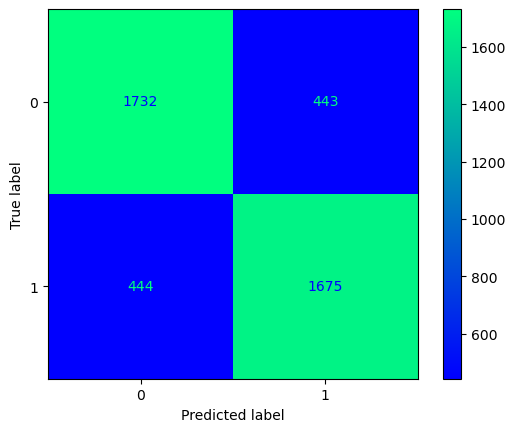

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.80      0.80      0.80      2175
           1       0.79      0.79      0.79      2119

    accuracy                           0.79      4294
   macro avg       0.79      0.79      0.79      4294
weighted avg       0.79      0.79      0.79      4294

-------------------------


In [367]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m4_15min.catboost_GridS()

In [368]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m4_15min,y_val_m4_15min)

Accuracy validación 0.5004658095770449


In [369]:
guardar_modelo(modelo_entrenado_15min,"m4_catboost_GridS_15min")

### Partidas 10 min

Hora de inicio:  08:58:39
0:	learn: 0.6802647	test: 0.6807433	best: 0.6807433 (0)	total: 2.94ms	remaining: 291ms
1:	learn: 0.6689158	test: 0.6697816	best: 0.6697816 (1)	total: 6.16ms	remaining: 302ms
2:	learn: 0.6589247	test: 0.6603556	best: 0.6603556 (2)	total: 8.97ms	remaining: 290ms
3:	learn: 0.6500374	test: 0.6513181	best: 0.6513181 (3)	total: 11.7ms	remaining: 280ms
4:	learn: 0.6421871	test: 0.6436742	best: 0.6436742 (4)	total: 14.3ms	remaining: 271ms
5:	learn: 0.6344732	test: 0.6360919	best: 0.6360919 (5)	total: 17.1ms	remaining: 268ms
6:	learn: 0.6273873	test: 0.6295695	best: 0.6295695 (6)	total: 20ms	remaining: 265ms
7:	learn: 0.6211253	test: 0.6235522	best: 0.6235522 (7)	total: 22.6ms	remaining: 260ms
8:	learn: 0.6153659	test: 0.6181242	best: 0.6181242 (8)	total: 25.4ms	remaining: 257ms
9:	learn: 0.6095364	test: 0.6128845	best: 0.6128845 (9)	total: 28.3ms	remaining: 255ms
10:	learn: 0.6051725	test: 0.6088321	best: 0.6088321 (10)	total: 31ms	remaining: 251ms
11:	learn: 0.601032

18:	learn: 0.5464703	test: 0.5566992	best: 0.5566992 (18)	total: 54.5ms	remaining: 232ms
19:	learn: 0.5447202	test: 0.5552417	best: 0.5552417 (19)	total: 57.5ms	remaining: 230ms
20:	learn: 0.5425479	test: 0.5536915	best: 0.5536915 (20)	total: 60.3ms	remaining: 227ms
21:	learn: 0.5415303	test: 0.5524317	best: 0.5524317 (21)	total: 63.1ms	remaining: 224ms
22:	learn: 0.5401108	test: 0.5513072	best: 0.5513072 (22)	total: 65.7ms	remaining: 220ms
23:	learn: 0.5390747	test: 0.5503647	best: 0.5503647 (23)	total: 68.4ms	remaining: 217ms
24:	learn: 0.5381366	test: 0.5499719	best: 0.5499719 (24)	total: 71.5ms	remaining: 215ms
25:	learn: 0.5370905	test: 0.5489507	best: 0.5489507 (25)	total: 74.5ms	remaining: 212ms
26:	learn: 0.5362019	test: 0.5479604	best: 0.5479604 (26)	total: 77.1ms	remaining: 208ms
27:	learn: 0.5350065	test: 0.5471325	best: 0.5471325 (27)	total: 79.8ms	remaining: 205ms
28:	learn: 0.5342441	test: 0.5467085	best: 0.5467085 (28)	total: 82.8ms	remaining: 203ms
29:	learn: 0.5333247	

61:	learn: 0.5117171	test: 0.5327309	best: 0.5327309 (61)	total: 181ms	remaining: 111ms
62:	learn: 0.5113486	test: 0.5322656	best: 0.5322656 (62)	total: 184ms	remaining: 108ms
63:	learn: 0.5110632	test: 0.5322839	best: 0.5322656 (62)	total: 187ms	remaining: 105ms
64:	learn: 0.5107820	test: 0.5321279	best: 0.5321279 (64)	total: 190ms	remaining: 102ms
65:	learn: 0.5103512	test: 0.5318965	best: 0.5318965 (65)	total: 192ms	remaining: 99.1ms
66:	learn: 0.5097461	test: 0.5316483	best: 0.5316483 (66)	total: 196ms	remaining: 96.3ms
67:	learn: 0.5094913	test: 0.5315137	best: 0.5315137 (67)	total: 198ms	remaining: 93.3ms
68:	learn: 0.5092494	test: 0.5313012	best: 0.5313012 (68)	total: 201ms	remaining: 90.3ms
69:	learn: 0.5090076	test: 0.5313886	best: 0.5313012 (68)	total: 204ms	remaining: 87.4ms
70:	learn: 0.5087489	test: 0.5313503	best: 0.5313012 (68)	total: 207ms	remaining: 84.5ms
71:	learn: 0.5084830	test: 0.5314498	best: 0.5313012 (68)	total: 209ms	remaining: 81.4ms
72:	learn: 0.5078400	test

4:	learn: 0.5360979	test: 0.5459720	best: 0.5459720 (4)	total: 14.5ms	remaining: 276ms
5:	learn: 0.5327947	test: 0.5430779	best: 0.5430779 (5)	total: 17.5ms	remaining: 274ms
6:	learn: 0.5311508	test: 0.5423642	best: 0.5423642 (6)	total: 20.5ms	remaining: 273ms
7:	learn: 0.5291699	test: 0.5414841	best: 0.5414841 (7)	total: 23.3ms	remaining: 268ms
8:	learn: 0.5251852	test: 0.5399747	best: 0.5399747 (8)	total: 26ms	remaining: 263ms
9:	learn: 0.5234742	test: 0.5390370	best: 0.5390370 (9)	total: 29.1ms	remaining: 262ms
10:	learn: 0.5217966	test: 0.5372709	best: 0.5372709 (10)	total: 31.8ms	remaining: 257ms
11:	learn: 0.5202002	test: 0.5358826	best: 0.5358826 (11)	total: 34.4ms	remaining: 252ms
12:	learn: 0.5192951	test: 0.5343899	best: 0.5343899 (12)	total: 37ms	remaining: 248ms
13:	learn: 0.5178185	test: 0.5337039	best: 0.5337039 (13)	total: 39.7ms	remaining: 244ms
14:	learn: 0.5173840	test: 0.5336209	best: 0.5336209 (14)	total: 42.7ms	remaining: 242ms
15:	learn: 0.5167463	test: 0.5334388	

47:	learn: 0.5394313	test: 0.5504287	best: 0.5504287 (47)	total: 135ms	remaining: 147ms
48:	learn: 0.5385959	test: 0.5497220	best: 0.5497220 (48)	total: 138ms	remaining: 144ms
49:	learn: 0.5381466	test: 0.5493919	best: 0.5493919 (49)	total: 141ms	remaining: 141ms
50:	learn: 0.5376481	test: 0.5489323	best: 0.5489323 (50)	total: 144ms	remaining: 138ms
51:	learn: 0.5371179	test: 0.5484434	best: 0.5484434 (51)	total: 147ms	remaining: 136ms
52:	learn: 0.5365124	test: 0.5480769	best: 0.5480769 (52)	total: 150ms	remaining: 133ms
53:	learn: 0.5358160	test: 0.5474164	best: 0.5474164 (53)	total: 152ms	remaining: 130ms
54:	learn: 0.5352935	test: 0.5469941	best: 0.5469941 (54)	total: 155ms	remaining: 127ms
55:	learn: 0.5347826	test: 0.5464203	best: 0.5464203 (55)	total: 158ms	remaining: 124ms
56:	learn: 0.5342895	test: 0.5460871	best: 0.5460871 (56)	total: 161ms	remaining: 122ms
57:	learn: 0.5338494	test: 0.5458561	best: 0.5458561 (57)	total: 164ms	remaining: 119ms
58:	learn: 0.5335386	test: 0.545

89:	learn: 0.5115961	test: 0.5321443	best: 0.5321443 (89)	total: 257ms	remaining: 28.6ms
90:	learn: 0.5114696	test: 0.5320974	best: 0.5320974 (90)	total: 260ms	remaining: 25.7ms
91:	learn: 0.5111515	test: 0.5320057	best: 0.5320057 (91)	total: 263ms	remaining: 22.9ms
92:	learn: 0.5109006	test: 0.5319212	best: 0.5319212 (92)	total: 266ms	remaining: 20ms
93:	learn: 0.5107420	test: 0.5317930	best: 0.5317930 (93)	total: 269ms	remaining: 17.2ms
94:	learn: 0.5106109	test: 0.5316746	best: 0.5316746 (94)	total: 272ms	remaining: 14.3ms
95:	learn: 0.5104046	test: 0.5316507	best: 0.5316507 (95)	total: 274ms	remaining: 11.4ms
96:	learn: 0.5102680	test: 0.5315223	best: 0.5315223 (96)	total: 277ms	remaining: 8.58ms
97:	learn: 0.5101876	test: 0.5313969	best: 0.5313969 (97)	total: 280ms	remaining: 5.72ms
98:	learn: 0.5099674	test: 0.5313236	best: 0.5313236 (98)	total: 283ms	remaining: 2.86ms
99:	learn: 0.5096995	test: 0.5312855	best: 0.5312855 (99)	total: 286ms	remaining: 0us

bestTest = 0.5312854922
b

30:	learn: 0.5184494	test: 0.5335513	best: 0.5335513 (30)	total: 88.7ms	remaining: 198ms
31:	learn: 0.5180057	test: 0.5334812	best: 0.5334812 (31)	total: 91.7ms	remaining: 195ms
32:	learn: 0.5176854	test: 0.5334763	best: 0.5334763 (32)	total: 94.3ms	remaining: 192ms
33:	learn: 0.5172487	test: 0.5334783	best: 0.5334763 (32)	total: 97ms	remaining: 188ms
34:	learn: 0.5169510	test: 0.5332757	best: 0.5332757 (34)	total: 99.6ms	remaining: 185ms
35:	learn: 0.5166028	test: 0.5332668	best: 0.5332668 (35)	total: 103ms	remaining: 183ms
36:	learn: 0.5160141	test: 0.5341909	best: 0.5332668 (35)	total: 106ms	remaining: 180ms
37:	learn: 0.5157262	test: 0.5340935	best: 0.5332668 (35)	total: 109ms	remaining: 177ms
38:	learn: 0.5152594	test: 0.5337187	best: 0.5332668 (35)	total: 112ms	remaining: 175ms
39:	learn: 0.5144541	test: 0.5333596	best: 0.5332668 (35)	total: 115ms	remaining: 172ms
40:	learn: 0.5139892	test: 0.5330760	best: 0.5330760 (40)	total: 118ms	remaining: 169ms
41:	learn: 0.5137287	test: 0.

73:	learn: 0.4819092	test: 0.5524383	best: 0.5328955 (17)	total: 208ms	remaining: 73ms
74:	learn: 0.4814674	test: 0.5548973	best: 0.5328955 (17)	total: 211ms	remaining: 70.4ms
75:	learn: 0.4810942	test: 0.5546586	best: 0.5328955 (17)	total: 214ms	remaining: 67.5ms
76:	learn: 0.4805865	test: 0.5552897	best: 0.5328955 (17)	total: 216ms	remaining: 64.6ms
77:	learn: 0.4799808	test: 0.5558761	best: 0.5328955 (17)	total: 219ms	remaining: 61.8ms
78:	learn: 0.4795026	test: 0.5560415	best: 0.5328955 (17)	total: 222ms	remaining: 59ms
79:	learn: 0.4791289	test: 0.5556250	best: 0.5328955 (17)	total: 225ms	remaining: 56.3ms
80:	learn: 0.4787289	test: 0.5551514	best: 0.5328955 (17)	total: 228ms	remaining: 53.4ms
81:	learn: 0.4782558	test: 0.5559187	best: 0.5328955 (17)	total: 230ms	remaining: 50.5ms
82:	learn: 0.4780205	test: 0.5557360	best: 0.5328955 (17)	total: 233ms	remaining: 47.8ms
83:	learn: 0.4776223	test: 0.5564175	best: 0.5328955 (17)	total: 236ms	remaining: 44.9ms
84:	learn: 0.4771496	test

17:	learn: 0.5483540	test: 0.5579954	best: 0.5579954 (17)	total: 50.9ms	remaining: 232ms
18:	learn: 0.5464703	test: 0.5566992	best: 0.5566992 (18)	total: 53.8ms	remaining: 229ms
19:	learn: 0.5447202	test: 0.5552417	best: 0.5552417 (19)	total: 56.5ms	remaining: 226ms
20:	learn: 0.5425479	test: 0.5536915	best: 0.5536915 (20)	total: 59.3ms	remaining: 223ms
21:	learn: 0.5415303	test: 0.5524317	best: 0.5524317 (21)	total: 62ms	remaining: 220ms
22:	learn: 0.5401108	test: 0.5513072	best: 0.5513072 (22)	total: 64.7ms	remaining: 217ms
23:	learn: 0.5390747	test: 0.5503647	best: 0.5503647 (23)	total: 67.3ms	remaining: 213ms
24:	learn: 0.5381366	test: 0.5499719	best: 0.5499719 (24)	total: 70.4ms	remaining: 211ms
25:	learn: 0.5370905	test: 0.5489507	best: 0.5489507 (25)	total: 73.5ms	remaining: 209ms
26:	learn: 0.5362019	test: 0.5479604	best: 0.5479604 (26)	total: 76.2ms	remaining: 206ms
27:	learn: 0.5350065	test: 0.5471325	best: 0.5471325 (27)	total: 78.9ms	remaining: 203ms
28:	learn: 0.5342441	te

57:	learn: 0.5128548	test: 0.5334640	best: 0.5327471 (44)	total: 166ms	remaining: 120ms
58:	learn: 0.5124894	test: 0.5332982	best: 0.5327471 (44)	total: 169ms	remaining: 117ms
59:	learn: 0.5122322	test: 0.5331599	best: 0.5327471 (44)	total: 171ms	remaining: 114ms
60:	learn: 0.5119570	test: 0.5331178	best: 0.5327471 (44)	total: 174ms	remaining: 112ms
61:	learn: 0.5117171	test: 0.5327309	best: 0.5327309 (61)	total: 178ms	remaining: 109ms
62:	learn: 0.5113486	test: 0.5322656	best: 0.5322656 (62)	total: 180ms	remaining: 106ms
63:	learn: 0.5110632	test: 0.5322839	best: 0.5322656 (62)	total: 183ms	remaining: 103ms
64:	learn: 0.5107820	test: 0.5321279	best: 0.5321279 (64)	total: 186ms	remaining: 99.9ms
65:	learn: 0.5103512	test: 0.5318965	best: 0.5318965 (65)	total: 189ms	remaining: 97.2ms
66:	learn: 0.5097461	test: 0.5316483	best: 0.5316483 (66)	total: 192ms	remaining: 94.5ms
67:	learn: 0.5094913	test: 0.5315137	best: 0.5315137 (67)	total: 194ms	remaining: 91.5ms
68:	learn: 0.5092494	test: 0

99:	learn: 0.4940155	test: 0.5334142	best: 0.5302435 (80)	total: 283ms	remaining: 0us

bestTest = 0.5302435319
bestIteration = 80

13:	loss: 0.5302435	best: 0.5302435 (3)	total: 4.06s	remaining: 35.1s
0:	learn: 0.5997941	test: 0.6038423	best: 0.6038423 (0)	total: 2.82ms	remaining: 280ms
1:	learn: 0.5700795	test: 0.5727180	best: 0.5727180 (1)	total: 5.5ms	remaining: 270ms
2:	learn: 0.5535951	test: 0.5595149	best: 0.5595149 (2)	total: 8.27ms	remaining: 267ms
3:	learn: 0.5412440	test: 0.5493121	best: 0.5493121 (3)	total: 10.9ms	remaining: 262ms
4:	learn: 0.5360979	test: 0.5459720	best: 0.5459720 (4)	total: 13.7ms	remaining: 261ms
5:	learn: 0.5327947	test: 0.5430779	best: 0.5430779 (5)	total: 16.6ms	remaining: 259ms
6:	learn: 0.5311508	test: 0.5423642	best: 0.5423642 (6)	total: 19.6ms	remaining: 260ms
7:	learn: 0.5291699	test: 0.5414841	best: 0.5414841 (7)	total: 22.4ms	remaining: 257ms
8:	learn: 0.5251852	test: 0.5399747	best: 0.5399747 (8)	total: 25ms	remaining: 253ms
9:	learn: 0.5234742

42:	learn: 0.5426283	test: 0.5529048	best: 0.5529048 (42)	total: 122ms	remaining: 303ms
43:	learn: 0.5418536	test: 0.5524249	best: 0.5524249 (43)	total: 125ms	remaining: 301ms
44:	learn: 0.5411059	test: 0.5516907	best: 0.5516907 (44)	total: 127ms	remaining: 297ms
45:	learn: 0.5406119	test: 0.5513743	best: 0.5513743 (45)	total: 130ms	remaining: 295ms
46:	learn: 0.5401282	test: 0.5508863	best: 0.5508863 (46)	total: 133ms	remaining: 292ms
47:	learn: 0.5394313	test: 0.5504287	best: 0.5504287 (47)	total: 136ms	remaining: 289ms
48:	learn: 0.5385959	test: 0.5497220	best: 0.5497220 (48)	total: 139ms	remaining: 286ms
49:	learn: 0.5381466	test: 0.5493919	best: 0.5493919 (49)	total: 141ms	remaining: 283ms
50:	learn: 0.5376481	test: 0.5489323	best: 0.5489323 (50)	total: 144ms	remaining: 280ms
51:	learn: 0.5371179	test: 0.5484434	best: 0.5484434 (51)	total: 147ms	remaining: 278ms
52:	learn: 0.5365124	test: 0.5480769	best: 0.5480769 (52)	total: 150ms	remaining: 275ms
53:	learn: 0.5358160	test: 0.547

32:	learn: 0.5306684	test: 0.5439963	best: 0.5439963 (32)	total: 94ms	remaining: 333ms
33:	learn: 0.5296041	test: 0.5433579	best: 0.5433579 (33)	total: 97.3ms	remaining: 332ms
34:	learn: 0.5290585	test: 0.5427678	best: 0.5427678 (34)	total: 100ms	remaining: 329ms
35:	learn: 0.5284468	test: 0.5423921	best: 0.5423921 (35)	total: 103ms	remaining: 327ms
36:	learn: 0.5279794	test: 0.5417779	best: 0.5417779 (36)	total: 106ms	remaining: 323ms
37:	learn: 0.5273921	test: 0.5415084	best: 0.5415084 (37)	total: 109ms	remaining: 320ms
38:	learn: 0.5267680	test: 0.5408259	best: 0.5408259 (38)	total: 111ms	remaining: 317ms
39:	learn: 0.5261781	test: 0.5403619	best: 0.5403619 (39)	total: 114ms	remaining: 314ms
40:	learn: 0.5257475	test: 0.5399777	best: 0.5399777 (40)	total: 117ms	remaining: 311ms
41:	learn: 0.5251878	test: 0.5395281	best: 0.5395281 (41)	total: 120ms	remaining: 308ms
42:	learn: 0.5246073	test: 0.5389373	best: 0.5389373 (42)	total: 123ms	remaining: 306ms
43:	learn: 0.5240898	test: 0.538

21:	learn: 0.5298492	test: 0.5421938	best: 0.5421938 (21)	total: 62.1ms	remaining: 361ms
22:	learn: 0.5292066	test: 0.5418179	best: 0.5418179 (22)	total: 65ms	remaining: 359ms
23:	learn: 0.5282398	test: 0.5406217	best: 0.5406217 (23)	total: 67.8ms	remaining: 356ms
24:	learn: 0.5271519	test: 0.5397932	best: 0.5397932 (24)	total: 70.4ms	remaining: 352ms
25:	learn: 0.5263576	test: 0.5394656	best: 0.5394656 (25)	total: 73.6ms	remaining: 351ms
26:	learn: 0.5254835	test: 0.5386268	best: 0.5386268 (26)	total: 76.3ms	remaining: 348ms
27:	learn: 0.5245271	test: 0.5380120	best: 0.5380120 (27)	total: 79.4ms	remaining: 346ms
28:	learn: 0.5238751	test: 0.5373839	best: 0.5373839 (28)	total: 82.5ms	remaining: 344ms
29:	learn: 0.5232259	test: 0.5366999	best: 0.5366999 (29)	total: 85.1ms	remaining: 340ms
30:	learn: 0.5226011	test: 0.5364849	best: 0.5364849 (30)	total: 88.1ms	remaining: 338ms
31:	learn: 0.5222848	test: 0.5362345	best: 0.5362345 (31)	total: 90.7ms	remaining: 334ms
32:	learn: 0.5219195	te

14:	learn: 0.5327261	test: 0.5456405	best: 0.5456405 (14)	total: 43.6ms	remaining: 392ms
15:	learn: 0.5314156	test: 0.5445024	best: 0.5445024 (15)	total: 46.7ms	remaining: 391ms
16:	learn: 0.5300168	test: 0.5429302	best: 0.5429302 (16)	total: 49.3ms	remaining: 386ms
17:	learn: 0.5280412	test: 0.5412368	best: 0.5412368 (17)	total: 52.1ms	remaining: 382ms
18:	learn: 0.5269203	test: 0.5401528	best: 0.5401528 (18)	total: 55.1ms	remaining: 380ms
19:	learn: 0.5262477	test: 0.5396057	best: 0.5396057 (19)	total: 57.7ms	remaining: 375ms
20:	learn: 0.5251696	test: 0.5389283	best: 0.5389283 (20)	total: 60.8ms	remaining: 373ms
21:	learn: 0.5244128	test: 0.5380927	best: 0.5380927 (21)	total: 63.4ms	remaining: 369ms
22:	learn: 0.5236149	test: 0.5376045	best: 0.5376045 (22)	total: 66.3ms	remaining: 366ms
23:	learn: 0.5225954	test: 0.5372275	best: 0.5372275 (23)	total: 68.9ms	remaining: 362ms
24:	learn: 0.5218612	test: 0.5368104	best: 0.5368104 (24)	total: 71.5ms	remaining: 358ms
25:	learn: 0.5209293	

13:	learn: 0.5178185	test: 0.5337039	best: 0.5337039 (13)	total: 39.1ms	remaining: 380ms
14:	learn: 0.5173840	test: 0.5336209	best: 0.5336209 (14)	total: 42.4ms	remaining: 381ms
15:	learn: 0.5167463	test: 0.5334388	best: 0.5334388 (15)	total: 44.9ms	remaining: 376ms
16:	learn: 0.5160347	test: 0.5331355	best: 0.5331355 (16)	total: 48ms	remaining: 376ms
17:	learn: 0.5155177	test: 0.5328955	best: 0.5328955 (17)	total: 50.7ms	remaining: 372ms
18:	learn: 0.5147511	test: 0.5341520	best: 0.5328955 (17)	total: 53.8ms	remaining: 371ms
19:	learn: 0.5139527	test: 0.5340998	best: 0.5328955 (17)	total: 56.8ms	remaining: 369ms
20:	learn: 0.5130663	test: 0.5341568	best: 0.5328955 (17)	total: 59.5ms	remaining: 366ms
21:	learn: 0.5121861	test: 0.5343453	best: 0.5328955 (17)	total: 62.1ms	remaining: 361ms
22:	learn: 0.5113360	test: 0.5350168	best: 0.5328955 (17)	total: 64.8ms	remaining: 358ms
23:	learn: 0.5100128	test: 0.5343356	best: 0.5328955 (17)	total: 67.5ms	remaining: 354ms
24:	learn: 0.5092657	te

4:	learn: 0.6421871	test: 0.6436742	best: 0.6436742 (4)	total: 14.9ms	remaining: 432ms
5:	learn: 0.6344732	test: 0.6360919	best: 0.6360919 (5)	total: 17.9ms	remaining: 430ms
6:	learn: 0.6273873	test: 0.6295695	best: 0.6295695 (6)	total: 20.7ms	remaining: 422ms
7:	learn: 0.6211253	test: 0.6235522	best: 0.6235522 (7)	total: 23.4ms	remaining: 415ms
8:	learn: 0.6153659	test: 0.6181242	best: 0.6181242 (8)	total: 26.1ms	remaining: 409ms
9:	learn: 0.6095364	test: 0.6128845	best: 0.6128845 (9)	total: 28.9ms	remaining: 404ms
10:	learn: 0.6051725	test: 0.6088321	best: 0.6088321 (10)	total: 31.6ms	remaining: 400ms
11:	learn: 0.6010325	test: 0.6050357	best: 0.6050357 (11)	total: 34.7ms	remaining: 399ms
12:	learn: 0.5972970	test: 0.6016113	best: 0.6016113 (12)	total: 37.8ms	remaining: 399ms
13:	learn: 0.5932807	test: 0.5979854	best: 0.5979854 (13)	total: 40.6ms	remaining: 394ms
14:	learn: 0.5896069	test: 0.5945090	best: 0.5945090 (14)	total: 43.4ms	remaining: 390ms
15:	learn: 0.5859646	test: 0.5911

147:	learn: 0.5153942	test: 0.5328933	best: 0.5328933 (147)	total: 418ms	remaining: 5.65ms
148:	learn: 0.5151961	test: 0.5327549	best: 0.5327549 (148)	total: 422ms	remaining: 2.83ms
149:	learn: 0.5151263	test: 0.5327376	best: 0.5327376 (149)	total: 425ms	remaining: 0us

bestTest = 0.5327375891
bestIteration = 149

20:	loss: 0.5327376	best: 0.5302435 (3)	total: 6.94s	remaining: 37.7s
0:	learn: 0.6681838	test: 0.6691349	best: 0.6691349 (0)	total: 2.75ms	remaining: 410ms
1:	learn: 0.6483426	test: 0.6500074	best: 0.6500074 (1)	total: 5.61ms	remaining: 415ms
2:	learn: 0.6328473	test: 0.6348487	best: 0.6348487 (2)	total: 8.6ms	remaining: 421ms
3:	learn: 0.6203166	test: 0.6226279	best: 0.6226279 (3)	total: 11.3ms	remaining: 413ms
4:	learn: 0.6097983	test: 0.6128700	best: 0.6128700 (4)	total: 14.1ms	remaining: 410ms
5:	learn: 0.5996771	test: 0.6037805	best: 0.6037805 (5)	total: 16.8ms	remaining: 404ms
6:	learn: 0.5918710	test: 0.5969068	best: 0.5969068 (6)	total: 19.6ms	remaining: 400ms
7:	lea

136:	learn: 0.5022707	test: 0.5309809	best: 0.5302555 (123)	total: 393ms	remaining: 37.2ms
137:	learn: 0.5020932	test: 0.5311410	best: 0.5302555 (123)	total: 396ms	remaining: 34.4ms
138:	learn: 0.5019478	test: 0.5310818	best: 0.5302555 (123)	total: 399ms	remaining: 31.5ms
139:	learn: 0.5018154	test: 0.5310448	best: 0.5302555 (123)	total: 401ms	remaining: 28.7ms
140:	learn: 0.5016164	test: 0.5310976	best: 0.5302555 (123)	total: 404ms	remaining: 25.8ms
141:	learn: 0.5013929	test: 0.5311426	best: 0.5302555 (123)	total: 407ms	remaining: 22.9ms
142:	learn: 0.5012076	test: 0.5313612	best: 0.5302555 (123)	total: 412ms	remaining: 20.2ms
143:	learn: 0.5010111	test: 0.5313261	best: 0.5302555 (123)	total: 415ms	remaining: 17.3ms
144:	learn: 0.5009091	test: 0.5312451	best: 0.5302555 (123)	total: 418ms	remaining: 14.4ms
145:	learn: 0.5007145	test: 0.5313086	best: 0.5302555 (123)	total: 421ms	remaining: 11.5ms
146:	learn: 0.5005633	test: 0.5314614	best: 0.5302555 (123)	total: 423ms	remaining: 8.63ms

129:	learn: 0.4928750	test: 0.5350215	best: 0.5311060 (91)	total: 364ms	remaining: 56ms
130:	learn: 0.4925592	test: 0.5348831	best: 0.5311060 (91)	total: 368ms	remaining: 53.3ms
131:	learn: 0.4924085	test: 0.5349807	best: 0.5311060 (91)	total: 370ms	remaining: 50.5ms
132:	learn: 0.4919735	test: 0.5351693	best: 0.5311060 (91)	total: 373ms	remaining: 47.7ms
133:	learn: 0.4914788	test: 0.5355492	best: 0.5311060 (91)	total: 376ms	remaining: 44.9ms
134:	learn: 0.4912602	test: 0.5356196	best: 0.5311060 (91)	total: 379ms	remaining: 42.1ms
135:	learn: 0.4910126	test: 0.5356343	best: 0.5311060 (91)	total: 382ms	remaining: 39.3ms
136:	learn: 0.4907766	test: 0.5357903	best: 0.5311060 (91)	total: 385ms	remaining: 36.5ms
137:	learn: 0.4906064	test: 0.5359718	best: 0.5311060 (91)	total: 387ms	remaining: 33.7ms
138:	learn: 0.4904873	test: 0.5359647	best: 0.5311060 (91)	total: 390ms	remaining: 30.9ms
139:	learn: 0.4902217	test: 0.5357054	best: 0.5311060 (91)	total: 393ms	remaining: 28ms
140:	learn: 0.

123:	learn: 0.4887509	test: 0.5343197	best: 0.5302435 (80)	total: 346ms	remaining: 72.6ms
124:	learn: 0.4885605	test: 0.5343241	best: 0.5302435 (80)	total: 350ms	remaining: 69.9ms
125:	learn: 0.4884410	test: 0.5342801	best: 0.5302435 (80)	total: 352ms	remaining: 67.1ms
126:	learn: 0.4882437	test: 0.5343953	best: 0.5302435 (80)	total: 355ms	remaining: 64.3ms
127:	learn: 0.4880202	test: 0.5343355	best: 0.5302435 (80)	total: 358ms	remaining: 61.5ms
128:	learn: 0.4879051	test: 0.5341789	best: 0.5302435 (80)	total: 360ms	remaining: 58.7ms
129:	learn: 0.4875811	test: 0.5344286	best: 0.5302435 (80)	total: 363ms	remaining: 55.9ms
130:	learn: 0.4873406	test: 0.5345021	best: 0.5302435 (80)	total: 366ms	remaining: 53.1ms
131:	learn: 0.4871451	test: 0.5345644	best: 0.5302435 (80)	total: 369ms	remaining: 50.3ms
132:	learn: 0.4867908	test: 0.5347105	best: 0.5302435 (80)	total: 372ms	remaining: 47.5ms
133:	learn: 0.4866219	test: 0.5346747	best: 0.5302435 (80)	total: 375ms	remaining: 44.7ms
134:	learn

108:	learn: 0.4666443	test: 0.5600599	best: 0.5328955 (17)	total: 326ms	remaining: 123ms
109:	learn: 0.4662766	test: 0.5602648	best: 0.5328955 (17)	total: 329ms	remaining: 120ms
110:	learn: 0.4658612	test: 0.5604522	best: 0.5328955 (17)	total: 332ms	remaining: 117ms
111:	learn: 0.4651174	test: 0.5619269	best: 0.5328955 (17)	total: 335ms	remaining: 114ms
112:	learn: 0.4646529	test: 0.5620588	best: 0.5328955 (17)	total: 338ms	remaining: 111ms
113:	learn: 0.4643817	test: 0.5628318	best: 0.5328955 (17)	total: 341ms	remaining: 108ms
114:	learn: 0.4639743	test: 0.5632987	best: 0.5328955 (17)	total: 344ms	remaining: 105ms
115:	learn: 0.4634698	test: 0.5632627	best: 0.5328955 (17)	total: 347ms	remaining: 102ms
116:	learn: 0.4630575	test: 0.5636153	best: 0.5328955 (17)	total: 350ms	remaining: 98.7ms
117:	learn: 0.4627018	test: 0.5634643	best: 0.5328955 (17)	total: 353ms	remaining: 95.7ms
118:	learn: 0.4625616	test: 0.5637243	best: 0.5328955 (17)	total: 356ms	remaining: 92.7ms
119:	learn: 0.4623

100:	learn: 0.5217495	test: 0.5368236	best: 0.5367927 (99)	total: 284ms	remaining: 138ms
101:	learn: 0.5216146	test: 0.5367461	best: 0.5367461 (101)	total: 287ms	remaining: 135ms
102:	learn: 0.5214394	test: 0.5366303	best: 0.5366303 (102)	total: 290ms	remaining: 132ms
103:	learn: 0.5212930	test: 0.5365459	best: 0.5365459 (103)	total: 293ms	remaining: 129ms
104:	learn: 0.5211527	test: 0.5364128	best: 0.5364128 (104)	total: 295ms	remaining: 127ms
105:	learn: 0.5210247	test: 0.5363173	best: 0.5363173 (105)	total: 299ms	remaining: 124ms
106:	learn: 0.5209129	test: 0.5361666	best: 0.5361666 (106)	total: 301ms	remaining: 121ms
107:	learn: 0.5207569	test: 0.5361185	best: 0.5361185 (107)	total: 304ms	remaining: 118ms
108:	learn: 0.5206066	test: 0.5359383	best: 0.5359383 (108)	total: 307ms	remaining: 115ms
109:	learn: 0.5204237	test: 0.5358457	best: 0.5358457 (109)	total: 309ms	remaining: 113ms
110:	learn: 0.5202076	test: 0.5357364	best: 0.5357364 (110)	total: 312ms	remaining: 110ms
111:	learn:

90:	learn: 0.5114696	test: 0.5320974	best: 0.5320974 (90)	total: 263ms	remaining: 170ms
91:	learn: 0.5111515	test: 0.5320057	best: 0.5320057 (91)	total: 266ms	remaining: 168ms
92:	learn: 0.5109006	test: 0.5319212	best: 0.5319212 (92)	total: 269ms	remaining: 165ms
93:	learn: 0.5107420	test: 0.5317930	best: 0.5317930 (93)	total: 272ms	remaining: 162ms
94:	learn: 0.5106109	test: 0.5316746	best: 0.5316746 (94)	total: 274ms	remaining: 159ms
95:	learn: 0.5104046	test: 0.5316507	best: 0.5316507 (95)	total: 277ms	remaining: 156ms
96:	learn: 0.5102680	test: 0.5315223	best: 0.5315223 (96)	total: 280ms	remaining: 153ms
97:	learn: 0.5101876	test: 0.5313969	best: 0.5313969 (97)	total: 283ms	remaining: 150ms
98:	learn: 0.5099674	test: 0.5313236	best: 0.5313236 (98)	total: 286ms	remaining: 147ms
99:	learn: 0.5096995	test: 0.5312855	best: 0.5312855 (99)	total: 288ms	remaining: 144ms
100:	learn: 0.5093445	test: 0.5311361	best: 0.5311361 (100)	total: 292ms	remaining: 141ms
101:	learn: 0.5092090	test: 0.

87:	learn: 0.5031000	test: 0.5315701	best: 0.5312260 (83)	total: 247ms	remaining: 174ms
88:	learn: 0.5027107	test: 0.5314314	best: 0.5312260 (83)	total: 251ms	remaining: 172ms
89:	learn: 0.5023645	test: 0.5313022	best: 0.5312260 (83)	total: 253ms	remaining: 169ms
90:	learn: 0.5021214	test: 0.5312106	best: 0.5312106 (90)	total: 256ms	remaining: 166ms
91:	learn: 0.5019043	test: 0.5311060	best: 0.5311060 (91)	total: 258ms	remaining: 163ms
92:	learn: 0.5017166	test: 0.5312562	best: 0.5311060 (91)	total: 261ms	remaining: 160ms
93:	learn: 0.5013733	test: 0.5313185	best: 0.5311060 (91)	total: 264ms	remaining: 157ms
94:	learn: 0.5011560	test: 0.5314968	best: 0.5311060 (91)	total: 267ms	remaining: 154ms
95:	learn: 0.5008909	test: 0.5312885	best: 0.5311060 (91)	total: 269ms	remaining: 151ms
96:	learn: 0.5005859	test: 0.5313544	best: 0.5311060 (91)	total: 272ms	remaining: 149ms
97:	learn: 0.5003972	test: 0.5313740	best: 0.5311060 (91)	total: 275ms	remaining: 146ms
98:	learn: 0.5001460	test: 0.531

79:	learn: 0.4998268	test: 0.5304553	best: 0.5303607 (77)	total: 226ms	remaining: 197ms
80:	learn: 0.4995058	test: 0.5302435	best: 0.5302435 (80)	total: 228ms	remaining: 195ms
81:	learn: 0.4991326	test: 0.5304148	best: 0.5302435 (80)	total: 231ms	remaining: 192ms
82:	learn: 0.4988823	test: 0.5305402	best: 0.5302435 (80)	total: 234ms	remaining: 189ms
83:	learn: 0.4985959	test: 0.5308173	best: 0.5302435 (80)	total: 236ms	remaining: 186ms
84:	learn: 0.4983571	test: 0.5314508	best: 0.5302435 (80)	total: 239ms	remaining: 183ms
85:	learn: 0.4981945	test: 0.5315636	best: 0.5302435 (80)	total: 242ms	remaining: 180ms
86:	learn: 0.4976791	test: 0.5316784	best: 0.5302435 (80)	total: 245ms	remaining: 177ms
87:	learn: 0.4974846	test: 0.5315258	best: 0.5302435 (80)	total: 248ms	remaining: 175ms
88:	learn: 0.4971786	test: 0.5313727	best: 0.5302435 (80)	total: 251ms	remaining: 172ms
89:	learn: 0.4968650	test: 0.5319507	best: 0.5302435 (80)	total: 253ms	remaining: 169ms
90:	learn: 0.4966351	test: 0.531

72:	learn: 0.4823338	test: 0.5522516	best: 0.5328955 (17)	total: 204ms	remaining: 215ms
73:	learn: 0.4819092	test: 0.5524383	best: 0.5328955 (17)	total: 207ms	remaining: 212ms
74:	learn: 0.4814674	test: 0.5548973	best: 0.5328955 (17)	total: 210ms	remaining: 210ms
75:	learn: 0.4810942	test: 0.5546586	best: 0.5328955 (17)	total: 212ms	remaining: 207ms
76:	learn: 0.4805865	test: 0.5552897	best: 0.5328955 (17)	total: 215ms	remaining: 204ms
77:	learn: 0.4799808	test: 0.5558761	best: 0.5328955 (17)	total: 218ms	remaining: 201ms
78:	learn: 0.4795026	test: 0.5560415	best: 0.5328955 (17)	total: 221ms	remaining: 198ms
79:	learn: 0.4791289	test: 0.5556250	best: 0.5328955 (17)	total: 225ms	remaining: 197ms
80:	learn: 0.4787289	test: 0.5551514	best: 0.5328955 (17)	total: 227ms	remaining: 194ms
81:	learn: 0.4782558	test: 0.5559187	best: 0.5328955 (17)	total: 230ms	remaining: 191ms
82:	learn: 0.4780205	test: 0.5557360	best: 0.5328955 (17)	total: 233ms	remaining: 188ms
83:	learn: 0.4776223	test: 0.556

64:	learn: 0.5311586	test: 0.5439293	best: 0.5439293 (64)	total: 186ms	remaining: 386ms
65:	learn: 0.5307536	test: 0.5436063	best: 0.5436063 (65)	total: 189ms	remaining: 384ms
66:	learn: 0.5303339	test: 0.5433505	best: 0.5433505 (66)	total: 192ms	remaining: 380ms
67:	learn: 0.5300133	test: 0.5431220	best: 0.5431220 (67)	total: 195ms	remaining: 378ms
68:	learn: 0.5296208	test: 0.5427516	best: 0.5427516 (68)	total: 198ms	remaining: 375ms
69:	learn: 0.5292923	test: 0.5424131	best: 0.5424131 (69)	total: 201ms	remaining: 373ms
70:	learn: 0.5290465	test: 0.5422401	best: 0.5422401 (70)	total: 203ms	remaining: 370ms
71:	learn: 0.5287434	test: 0.5419834	best: 0.5419834 (71)	total: 206ms	remaining: 366ms
72:	learn: 0.5285735	test: 0.5417988	best: 0.5417988 (72)	total: 210ms	remaining: 365ms
73:	learn: 0.5281322	test: 0.5415382	best: 0.5415382 (73)	total: 213ms	remaining: 362ms
74:	learn: 0.5277857	test: 0.5412366	best: 0.5412366 (74)	total: 216ms	remaining: 359ms
75:	learn: 0.5273667	test: 0.540

6:	learn: 0.5918710	test: 0.5969068	best: 0.5969068 (6)	total: 20.3ms	remaining: 560ms
7:	learn: 0.5836157	test: 0.5896842	best: 0.5896842 (7)	total: 23.4ms	remaining: 561ms
8:	learn: 0.5777949	test: 0.5842356	best: 0.5842356 (8)	total: 26.1ms	remaining: 553ms
9:	learn: 0.5724104	test: 0.5789011	best: 0.5789011 (9)	total: 28.8ms	remaining: 548ms
10:	learn: 0.5685232	test: 0.5751773	best: 0.5751773 (10)	total: 31.7ms	remaining: 544ms
11:	learn: 0.5647679	test: 0.5714038	best: 0.5714038 (11)	total: 34.4ms	remaining: 539ms
12:	learn: 0.5604244	test: 0.5681446	best: 0.5681446 (12)	total: 37.4ms	remaining: 538ms
13:	learn: 0.5571143	test: 0.5652925	best: 0.5652925 (13)	total: 40.2ms	remaining: 534ms
14:	learn: 0.5550706	test: 0.5629288	best: 0.5629288 (14)	total: 42.9ms	remaining: 529ms
15:	learn: 0.5527726	test: 0.5615310	best: 0.5615310 (15)	total: 46ms	remaining: 529ms
16:	learn: 0.5505531	test: 0.5597653	best: 0.5597653 (16)	total: 48.9ms	remaining: 527ms
17:	learn: 0.5483540	test: 0.55

150:	learn: 0.5000538	test: 0.5318290	best: 0.5302555 (123)	total: 434ms	remaining: 141ms
151:	learn: 0.4998806	test: 0.5319436	best: 0.5302555 (123)	total: 437ms	remaining: 138ms
152:	learn: 0.4997503	test: 0.5320239	best: 0.5302555 (123)	total: 440ms	remaining: 135ms
153:	learn: 0.4995543	test: 0.5320160	best: 0.5302555 (123)	total: 442ms	remaining: 132ms
154:	learn: 0.4992643	test: 0.5321709	best: 0.5302555 (123)	total: 445ms	remaining: 129ms
155:	learn: 0.4991662	test: 0.5321614	best: 0.5302555 (123)	total: 448ms	remaining: 126ms
156:	learn: 0.4990104	test: 0.5321351	best: 0.5302555 (123)	total: 451ms	remaining: 123ms
157:	learn: 0.4986916	test: 0.5323236	best: 0.5302555 (123)	total: 454ms	remaining: 121ms
158:	learn: 0.4985611	test: 0.5322297	best: 0.5302555 (123)	total: 457ms	remaining: 118ms
159:	learn: 0.4984542	test: 0.5323197	best: 0.5302555 (123)	total: 460ms	remaining: 115ms
160:	learn: 0.4982670	test: 0.5323564	best: 0.5302555 (123)	total: 462ms	remaining: 112ms
161:	learn

93:	learn: 0.5013733	test: 0.5313185	best: 0.5311060 (91)	total: 264ms	remaining: 297ms
94:	learn: 0.5011560	test: 0.5314968	best: 0.5311060 (91)	total: 267ms	remaining: 295ms
95:	learn: 0.5008909	test: 0.5312885	best: 0.5311060 (91)	total: 270ms	remaining: 292ms
96:	learn: 0.5005859	test: 0.5313544	best: 0.5311060 (91)	total: 273ms	remaining: 290ms
97:	learn: 0.5003972	test: 0.5313740	best: 0.5311060 (91)	total: 275ms	remaining: 286ms
98:	learn: 0.5001460	test: 0.5314901	best: 0.5311060 (91)	total: 278ms	remaining: 284ms
99:	learn: 0.4999617	test: 0.5315136	best: 0.5311060 (91)	total: 281ms	remaining: 281ms
100:	learn: 0.4997914	test: 0.5315390	best: 0.5311060 (91)	total: 284ms	remaining: 278ms
101:	learn: 0.4995115	test: 0.5311666	best: 0.5311060 (91)	total: 286ms	remaining: 275ms
102:	learn: 0.4991967	test: 0.5312797	best: 0.5311060 (91)	total: 290ms	remaining: 273ms
103:	learn: 0.4989492	test: 0.5321322	best: 0.5311060 (91)	total: 293ms	remaining: 270ms
104:	learn: 0.4986175	test: 

35:	learn: 0.5166028	test: 0.5332668	best: 0.5332668 (35)	total: 103ms	remaining: 470ms
36:	learn: 0.5160141	test: 0.5341909	best: 0.5332668 (35)	total: 107ms	remaining: 469ms
37:	learn: 0.5157262	test: 0.5340935	best: 0.5332668 (35)	total: 109ms	remaining: 467ms
38:	learn: 0.5152594	test: 0.5337187	best: 0.5332668 (35)	total: 113ms	remaining: 465ms
39:	learn: 0.5144541	test: 0.5333596	best: 0.5332668 (35)	total: 116ms	remaining: 463ms
40:	learn: 0.5139892	test: 0.5330760	best: 0.5330760 (40)	total: 119ms	remaining: 460ms
41:	learn: 0.5137287	test: 0.5329194	best: 0.5329194 (41)	total: 121ms	remaining: 457ms
42:	learn: 0.5134689	test: 0.5328783	best: 0.5328783 (42)	total: 124ms	remaining: 454ms
43:	learn: 0.5132109	test: 0.5328019	best: 0.5328019 (43)	total: 127ms	remaining: 451ms
44:	learn: 0.5128384	test: 0.5324031	best: 0.5324031 (44)	total: 130ms	remaining: 447ms
45:	learn: 0.5125470	test: 0.5324640	best: 0.5324031 (44)	total: 132ms	remaining: 443ms
46:	learn: 0.5122071	test: 0.532

178:	learn: 0.4769037	test: 0.5379195	best: 0.5302435 (80)	total: 505ms	remaining: 59.2ms
179:	learn: 0.4767224	test: 0.5380163	best: 0.5302435 (80)	total: 507ms	remaining: 56.4ms
180:	learn: 0.4766456	test: 0.5378222	best: 0.5302435 (80)	total: 510ms	remaining: 53.5ms
181:	learn: 0.4764714	test: 0.5377676	best: 0.5302435 (80)	total: 513ms	remaining: 50.7ms
182:	learn: 0.4762639	test: 0.5379631	best: 0.5302435 (80)	total: 516ms	remaining: 47.9ms
183:	learn: 0.4760312	test: 0.5380120	best: 0.5302435 (80)	total: 518ms	remaining: 45.1ms
184:	learn: 0.4757968	test: 0.5380897	best: 0.5302435 (80)	total: 521ms	remaining: 42.2ms
185:	learn: 0.4756245	test: 0.5380372	best: 0.5302435 (80)	total: 524ms	remaining: 39.4ms
186:	learn: 0.4755535	test: 0.5381644	best: 0.5302435 (80)	total: 527ms	remaining: 36.6ms
187:	learn: 0.4752490	test: 0.5385705	best: 0.5302435 (80)	total: 530ms	remaining: 33.8ms
188:	learn: 0.4750382	test: 0.5384174	best: 0.5302435 (80)	total: 533ms	remaining: 31ms
189:	learn: 

122:	learn: 0.4611119	test: 0.5640887	best: 0.5328955 (17)	total: 343ms	remaining: 214ms
123:	learn: 0.4606568	test: 0.5650600	best: 0.5328955 (17)	total: 346ms	remaining: 212ms
124:	learn: 0.4602781	test: 0.5651552	best: 0.5328955 (17)	total: 348ms	remaining: 209ms
125:	learn: 0.4597530	test: 0.5653884	best: 0.5328955 (17)	total: 351ms	remaining: 206ms
126:	learn: 0.4593835	test: 0.5653979	best: 0.5328955 (17)	total: 353ms	remaining: 203ms
127:	learn: 0.4590704	test: 0.5653423	best: 0.5328955 (17)	total: 356ms	remaining: 200ms
128:	learn: 0.4589340	test: 0.5653962	best: 0.5328955 (17)	total: 359ms	remaining: 198ms
129:	learn: 0.4585885	test: 0.5653991	best: 0.5328955 (17)	total: 362ms	remaining: 195ms
130:	learn: 0.4581365	test: 0.5650817	best: 0.5328955 (17)	total: 365ms	remaining: 192ms
131:	learn: 0.4578653	test: 0.5649328	best: 0.5328955 (17)	total: 367ms	remaining: 189ms
132:	learn: 0.4573290	test: 0.5649169	best: 0.5328955 (17)	total: 370ms	remaining: 186ms
133:	learn: 0.4570140

66:	learn: 0.5303339	test: 0.5433505	best: 0.5433505 (66)	total: 188ms	remaining: 372ms
67:	learn: 0.5300133	test: 0.5431220	best: 0.5431220 (67)	total: 191ms	remaining: 371ms
68:	learn: 0.5296208	test: 0.5427516	best: 0.5427516 (68)	total: 194ms	remaining: 368ms
69:	learn: 0.5292923	test: 0.5424131	best: 0.5424131 (69)	total: 197ms	remaining: 366ms
70:	learn: 0.5290465	test: 0.5422401	best: 0.5422401 (70)	total: 200ms	remaining: 363ms
71:	learn: 0.5287434	test: 0.5419834	best: 0.5419834 (71)	total: 202ms	remaining: 360ms
72:	learn: 0.5285735	test: 0.5417988	best: 0.5417988 (72)	total: 205ms	remaining: 356ms
73:	learn: 0.5281322	test: 0.5415382	best: 0.5415382 (73)	total: 207ms	remaining: 353ms
74:	learn: 0.5277857	test: 0.5412366	best: 0.5412366 (74)	total: 210ms	remaining: 350ms
75:	learn: 0.5273667	test: 0.5409063	best: 0.5409063 (75)	total: 213ms	remaining: 348ms
76:	learn: 0.5270095	test: 0.5406774	best: 0.5406774 (76)	total: 216ms	remaining: 345ms
77:	learn: 0.5268344	test: 0.540

8:	learn: 0.5777949	test: 0.5842356	best: 0.5842356 (8)	total: 25.6ms	remaining: 543ms
9:	learn: 0.5724104	test: 0.5789011	best: 0.5789011 (9)	total: 28.6ms	remaining: 543ms
10:	learn: 0.5685232	test: 0.5751773	best: 0.5751773 (10)	total: 31.4ms	remaining: 540ms
11:	learn: 0.5647679	test: 0.5714038	best: 0.5714038 (11)	total: 34.1ms	remaining: 534ms
12:	learn: 0.5604244	test: 0.5681446	best: 0.5681446 (12)	total: 37ms	remaining: 533ms
13:	learn: 0.5571143	test: 0.5652925	best: 0.5652925 (13)	total: 39.9ms	remaining: 530ms
14:	learn: 0.5550706	test: 0.5629288	best: 0.5629288 (14)	total: 42.6ms	remaining: 525ms
15:	learn: 0.5527726	test: 0.5615310	best: 0.5615310 (15)	total: 45.7ms	remaining: 526ms
16:	learn: 0.5505531	test: 0.5597653	best: 0.5597653 (16)	total: 48.5ms	remaining: 522ms
17:	learn: 0.5483540	test: 0.5579954	best: 0.5579954 (17)	total: 51.4ms	remaining: 520ms
18:	learn: 0.5464703	test: 0.5566992	best: 0.5566992 (18)	total: 54.3ms	remaining: 517ms
19:	learn: 0.5447202	test: 

148:	learn: 0.5002703	test: 0.5317364	best: 0.5302555 (123)	total: 427ms	remaining: 146ms
149:	learn: 0.5001565	test: 0.5317411	best: 0.5302555 (123)	total: 430ms	remaining: 143ms
150:	learn: 0.5000538	test: 0.5318290	best: 0.5302555 (123)	total: 433ms	remaining: 140ms
151:	learn: 0.4998806	test: 0.5319436	best: 0.5302555 (123)	total: 436ms	remaining: 138ms
152:	learn: 0.4997503	test: 0.5320239	best: 0.5302555 (123)	total: 438ms	remaining: 135ms
153:	learn: 0.4995543	test: 0.5320160	best: 0.5302555 (123)	total: 441ms	remaining: 132ms
154:	learn: 0.4992643	test: 0.5321709	best: 0.5302555 (123)	total: 444ms	remaining: 129ms
155:	learn: 0.4991662	test: 0.5321614	best: 0.5302555 (123)	total: 447ms	remaining: 126ms
156:	learn: 0.4990104	test: 0.5321351	best: 0.5302555 (123)	total: 450ms	remaining: 123ms
157:	learn: 0.4986916	test: 0.5323236	best: 0.5302555 (123)	total: 453ms	remaining: 120ms
158:	learn: 0.4985611	test: 0.5322297	best: 0.5302555 (123)	total: 456ms	remaining: 117ms
159:	learn

91:	learn: 0.5019043	test: 0.5311060	best: 0.5311060 (91)	total: 261ms	remaining: 307ms
92:	learn: 0.5017166	test: 0.5312562	best: 0.5311060 (91)	total: 264ms	remaining: 304ms
93:	learn: 0.5013733	test: 0.5313185	best: 0.5311060 (91)	total: 267ms	remaining: 301ms
94:	learn: 0.5011560	test: 0.5314968	best: 0.5311060 (91)	total: 270ms	remaining: 298ms
95:	learn: 0.5008909	test: 0.5312885	best: 0.5311060 (91)	total: 272ms	remaining: 295ms
96:	learn: 0.5005859	test: 0.5313544	best: 0.5311060 (91)	total: 275ms	remaining: 293ms
97:	learn: 0.5003972	test: 0.5313740	best: 0.5311060 (91)	total: 278ms	remaining: 289ms
98:	learn: 0.5001460	test: 0.5314901	best: 0.5311060 (91)	total: 281ms	remaining: 287ms
99:	learn: 0.4999617	test: 0.5315136	best: 0.5311060 (91)	total: 284ms	remaining: 284ms
100:	learn: 0.4997914	test: 0.5315390	best: 0.5311060 (91)	total: 287ms	remaining: 281ms
101:	learn: 0.4995115	test: 0.5311666	best: 0.5311060 (91)	total: 289ms	remaining: 278ms
102:	learn: 0.4991967	test: 0.

32:	learn: 0.5176854	test: 0.5334763	best: 0.5334763 (32)	total: 95.4ms	remaining: 483ms
33:	learn: 0.5172487	test: 0.5334783	best: 0.5334763 (32)	total: 98.3ms	remaining: 480ms
34:	learn: 0.5169510	test: 0.5332757	best: 0.5332757 (34)	total: 101ms	remaining: 476ms
35:	learn: 0.5166028	test: 0.5332668	best: 0.5332668 (35)	total: 104ms	remaining: 473ms
36:	learn: 0.5160141	test: 0.5341909	best: 0.5332668 (35)	total: 107ms	remaining: 471ms
37:	learn: 0.5157262	test: 0.5340935	best: 0.5332668 (35)	total: 110ms	remaining: 469ms
38:	learn: 0.5152594	test: 0.5337187	best: 0.5332668 (35)	total: 113ms	remaining: 467ms
39:	learn: 0.5144541	test: 0.5333596	best: 0.5332668 (35)	total: 116ms	remaining: 464ms
40:	learn: 0.5139892	test: 0.5330760	best: 0.5330760 (40)	total: 119ms	remaining: 462ms
41:	learn: 0.5137287	test: 0.5329194	best: 0.5329194 (41)	total: 122ms	remaining: 458ms
42:	learn: 0.5134689	test: 0.5328783	best: 0.5328783 (42)	total: 125ms	remaining: 456ms
43:	learn: 0.5132109	test: 0.5

174:	learn: 0.4776082	test: 0.5367584	best: 0.5302435 (80)	total: 495ms	remaining: 70.7ms
175:	learn: 0.4773931	test: 0.5366967	best: 0.5302435 (80)	total: 498ms	remaining: 67.9ms
176:	learn: 0.4771690	test: 0.5364964	best: 0.5302435 (80)	total: 501ms	remaining: 65.1ms
177:	learn: 0.4770805	test: 0.5366071	best: 0.5302435 (80)	total: 504ms	remaining: 62.2ms
178:	learn: 0.4769037	test: 0.5379195	best: 0.5302435 (80)	total: 507ms	remaining: 59.4ms
179:	learn: 0.4767224	test: 0.5380163	best: 0.5302435 (80)	total: 509ms	remaining: 56.6ms
180:	learn: 0.4766456	test: 0.5378222	best: 0.5302435 (80)	total: 512ms	remaining: 53.8ms
181:	learn: 0.4764714	test: 0.5377676	best: 0.5302435 (80)	total: 515ms	remaining: 50.9ms
182:	learn: 0.4762639	test: 0.5379631	best: 0.5302435 (80)	total: 517ms	remaining: 48.1ms
183:	learn: 0.4760312	test: 0.5380120	best: 0.5302435 (80)	total: 520ms	remaining: 45.2ms
184:	learn: 0.4757968	test: 0.5380897	best: 0.5302435 (80)	total: 523ms	remaining: 42.4ms
185:	learn

115:	learn: 0.4634698	test: 0.5632627	best: 0.5328955 (17)	total: 329ms	remaining: 239ms
116:	learn: 0.4630575	test: 0.5636153	best: 0.5328955 (17)	total: 333ms	remaining: 236ms
117:	learn: 0.4627018	test: 0.5634643	best: 0.5328955 (17)	total: 336ms	remaining: 233ms
118:	learn: 0.4625616	test: 0.5637243	best: 0.5328955 (17)	total: 339ms	remaining: 231ms
119:	learn: 0.4623165	test: 0.5637040	best: 0.5328955 (17)	total: 341ms	remaining: 228ms
120:	learn: 0.4617698	test: 0.5641359	best: 0.5328955 (17)	total: 345ms	remaining: 225ms
121:	learn: 0.4614573	test: 0.5644783	best: 0.5328955 (17)	total: 348ms	remaining: 222ms
122:	learn: 0.4611119	test: 0.5640887	best: 0.5328955 (17)	total: 350ms	remaining: 219ms
123:	learn: 0.4606568	test: 0.5650600	best: 0.5328955 (17)	total: 353ms	remaining: 217ms
124:	learn: 0.4602781	test: 0.5651552	best: 0.5328955 (17)	total: 356ms	remaining: 213ms
125:	learn: 0.4597530	test: 0.5653884	best: 0.5328955 (17)	total: 359ms	remaining: 211ms
126:	learn: 0.4593835

56:	learn: 0.5342895	test: 0.5460871	best: 0.5460871 (56)	total: 167ms	remaining: 418ms
57:	learn: 0.5338494	test: 0.5458561	best: 0.5458561 (57)	total: 170ms	remaining: 416ms
58:	learn: 0.5335386	test: 0.5455966	best: 0.5455966 (58)	total: 173ms	remaining: 412ms
59:	learn: 0.5332192	test: 0.5453961	best: 0.5453961 (59)	total: 175ms	remaining: 409ms
60:	learn: 0.5328508	test: 0.5451716	best: 0.5451716 (60)	total: 178ms	remaining: 405ms
61:	learn: 0.5325460	test: 0.5450011	best: 0.5450011 (61)	total: 181ms	remaining: 402ms
62:	learn: 0.5322061	test: 0.5445169	best: 0.5445169 (62)	total: 184ms	remaining: 399ms
63:	learn: 0.5317026	test: 0.5441700	best: 0.5441700 (63)	total: 186ms	remaining: 396ms
64:	learn: 0.5311586	test: 0.5439293	best: 0.5439293 (64)	total: 189ms	remaining: 393ms
65:	learn: 0.5307536	test: 0.5436063	best: 0.5436063 (65)	total: 192ms	remaining: 390ms
66:	learn: 0.5303339	test: 0.5433505	best: 0.5433505 (66)	total: 195ms	remaining: 387ms
67:	learn: 0.5300133	test: 0.543

192:	learn: 0.5103867	test: 0.5300910	best: 0.5300910 (192)	total: 568ms	remaining: 20.6ms
193:	learn: 0.5102391	test: 0.5300405	best: 0.5300405 (193)	total: 571ms	remaining: 17.7ms
194:	learn: 0.5101323	test: 0.5300397	best: 0.5300397 (194)	total: 574ms	remaining: 14.7ms
195:	learn: 0.5099849	test: 0.5299152	best: 0.5299152 (195)	total: 576ms	remaining: 11.8ms
196:	learn: 0.5098531	test: 0.5298969	best: 0.5298969 (196)	total: 580ms	remaining: 8.82ms
197:	learn: 0.5097756	test: 0.5298753	best: 0.5298753 (197)	total: 582ms	remaining: 5.88ms
198:	learn: 0.5096926	test: 0.5298078	best: 0.5298078 (198)	total: 585ms	remaining: 2.94ms
199:	learn: 0.5095738	test: 0.5297739	best: 0.5297739 (199)	total: 587ms	remaining: 0us

bestTest = 0.5297739441
bestIteration = 199

40:	loss: 0.5297739	best: 0.5297739 (30)	total: 17.2s	remaining: 39.4s
0:	learn: 0.6681838	test: 0.6691349	best: 0.6691349 (0)	total: 2.75ms	remaining: 546ms
1:	learn: 0.6483426	test: 0.6500074	best: 0.6500074 (1)	total: 5.58ms	r

135:	learn: 0.5024850	test: 0.5311331	best: 0.5302555 (123)	total: 394ms	remaining: 186ms
136:	learn: 0.5022707	test: 0.5309809	best: 0.5302555 (123)	total: 398ms	remaining: 183ms
137:	learn: 0.5020932	test: 0.5311410	best: 0.5302555 (123)	total: 401ms	remaining: 180ms
138:	learn: 0.5019478	test: 0.5310818	best: 0.5302555 (123)	total: 404ms	remaining: 177ms
139:	learn: 0.5018154	test: 0.5310448	best: 0.5302555 (123)	total: 406ms	remaining: 174ms
140:	learn: 0.5016164	test: 0.5310976	best: 0.5302555 (123)	total: 409ms	remaining: 171ms
141:	learn: 0.5013929	test: 0.5311426	best: 0.5302555 (123)	total: 412ms	remaining: 168ms
142:	learn: 0.5012076	test: 0.5313612	best: 0.5302555 (123)	total: 415ms	remaining: 165ms
143:	learn: 0.5010111	test: 0.5313261	best: 0.5302555 (123)	total: 418ms	remaining: 163ms
144:	learn: 0.5009091	test: 0.5312451	best: 0.5302555 (123)	total: 421ms	remaining: 160ms
145:	learn: 0.5007145	test: 0.5313086	best: 0.5302555 (123)	total: 423ms	remaining: 157ms
146:	learn

72:	learn: 0.5078400	test: 0.5313968	best: 0.5313012 (68)	total: 213ms	remaining: 371ms
73:	learn: 0.5073910	test: 0.5312449	best: 0.5312449 (73)	total: 216ms	remaining: 368ms
74:	learn: 0.5071704	test: 0.5314133	best: 0.5312449 (73)	total: 219ms	remaining: 365ms
75:	learn: 0.5068997	test: 0.5313652	best: 0.5312449 (73)	total: 222ms	remaining: 363ms
76:	learn: 0.5065821	test: 0.5318452	best: 0.5312449 (73)	total: 225ms	remaining: 359ms
77:	learn: 0.5062089	test: 0.5317856	best: 0.5312449 (73)	total: 228ms	remaining: 357ms
78:	learn: 0.5058591	test: 0.5318273	best: 0.5312449 (73)	total: 231ms	remaining: 353ms
79:	learn: 0.5056304	test: 0.5319826	best: 0.5312449 (73)	total: 233ms	remaining: 350ms
80:	learn: 0.5053271	test: 0.5319777	best: 0.5312449 (73)	total: 236ms	remaining: 347ms
81:	learn: 0.5048534	test: 0.5315420	best: 0.5312449 (73)	total: 239ms	remaining: 343ms
82:	learn: 0.5045385	test: 0.5316115	best: 0.5312449 (73)	total: 241ms	remaining: 340ms
83:	learn: 0.5041869	test: 0.531

11:	learn: 0.5386935	test: 0.5505751	best: 0.5505751 (11)	total: 35ms	remaining: 549ms
12:	learn: 0.5363756	test: 0.5485155	best: 0.5485155 (12)	total: 38.1ms	remaining: 549ms
13:	learn: 0.5342993	test: 0.5468061	best: 0.5468061 (13)	total: 41.1ms	remaining: 546ms
14:	learn: 0.5327261	test: 0.5456405	best: 0.5456405 (14)	total: 44.2ms	remaining: 545ms
15:	learn: 0.5314156	test: 0.5445024	best: 0.5445024 (15)	total: 47.2ms	remaining: 543ms
16:	learn: 0.5300168	test: 0.5429302	best: 0.5429302 (16)	total: 49.9ms	remaining: 537ms
17:	learn: 0.5280412	test: 0.5412368	best: 0.5412368 (17)	total: 52.9ms	remaining: 535ms
18:	learn: 0.5269203	test: 0.5401528	best: 0.5401528 (18)	total: 56ms	remaining: 533ms
19:	learn: 0.5262477	test: 0.5396057	best: 0.5396057 (19)	total: 58.7ms	remaining: 528ms
20:	learn: 0.5251696	test: 0.5389283	best: 0.5389283 (20)	total: 61.8ms	remaining: 527ms
21:	learn: 0.5244128	test: 0.5380927	best: 0.5380927 (21)	total: 64.6ms	remaining: 523ms
22:	learn: 0.5236149	test

150:	learn: 0.4826080	test: 0.5368793	best: 0.5302435 (80)	total: 438ms	remaining: 142ms
151:	learn: 0.4824679	test: 0.5370414	best: 0.5302435 (80)	total: 441ms	remaining: 139ms
152:	learn: 0.4822128	test: 0.5369350	best: 0.5302435 (80)	total: 444ms	remaining: 136ms
153:	learn: 0.4820008	test: 0.5371479	best: 0.5302435 (80)	total: 447ms	remaining: 133ms
154:	learn: 0.4818704	test: 0.5366105	best: 0.5302435 (80)	total: 450ms	remaining: 131ms
155:	learn: 0.4816146	test: 0.5367138	best: 0.5302435 (80)	total: 453ms	remaining: 128ms
156:	learn: 0.4813934	test: 0.5366949	best: 0.5302435 (80)	total: 455ms	remaining: 125ms
157:	learn: 0.4812050	test: 0.5364207	best: 0.5302435 (80)	total: 458ms	remaining: 122ms
158:	learn: 0.4811340	test: 0.5363676	best: 0.5302435 (80)	total: 460ms	remaining: 119ms
159:	learn: 0.4810774	test: 0.5365085	best: 0.5302435 (80)	total: 463ms	remaining: 116ms
160:	learn: 0.4807397	test: 0.5366657	best: 0.5302435 (80)	total: 466ms	remaining: 113ms
161:	learn: 0.4804909

95:	learn: 0.4722340	test: 0.5571817	best: 0.5328955 (17)	total: 265ms	remaining: 288ms
96:	learn: 0.4718317	test: 0.5570201	best: 0.5328955 (17)	total: 268ms	remaining: 285ms
97:	learn: 0.4713190	test: 0.5574484	best: 0.5328955 (17)	total: 271ms	remaining: 282ms
98:	learn: 0.4708168	test: 0.5579860	best: 0.5328955 (17)	total: 274ms	remaining: 279ms
99:	learn: 0.4703661	test: 0.5579433	best: 0.5328955 (17)	total: 277ms	remaining: 277ms
100:	learn: 0.4699499	test: 0.5577030	best: 0.5328955 (17)	total: 279ms	remaining: 274ms
101:	learn: 0.4691397	test: 0.5591116	best: 0.5328955 (17)	total: 282ms	remaining: 271ms
102:	learn: 0.4688260	test: 0.5590118	best: 0.5328955 (17)	total: 285ms	remaining: 269ms
103:	learn: 0.4684623	test: 0.5589851	best: 0.5328955 (17)	total: 288ms	remaining: 266ms
104:	learn: 0.4682507	test: 0.5594519	best: 0.5328955 (17)	total: 290ms	remaining: 263ms
105:	learn: 0.4678500	test: 0.5590473	best: 0.5328955 (17)	total: 293ms	remaining: 260ms
106:	learn: 0.4672980	test

25:	learn: 0.5492025	test: 0.5615723	best: 0.5615723 (25)	total: 111ms	remaining: 317ms
26:	learn: 0.5477238	test: 0.5603080	best: 0.5603080 (26)	total: 116ms	remaining: 313ms
27:	learn: 0.5456487	test: 0.5587155	best: 0.5587155 (27)	total: 120ms	remaining: 309ms
28:	learn: 0.5441187	test: 0.5572042	best: 0.5572042 (28)	total: 125ms	remaining: 306ms
29:	learn: 0.5426277	test: 0.5559267	best: 0.5559267 (29)	total: 129ms	remaining: 301ms
30:	learn: 0.5412835	test: 0.5552328	best: 0.5552328 (30)	total: 133ms	remaining: 297ms
31:	learn: 0.5400111	test: 0.5544285	best: 0.5544285 (31)	total: 138ms	remaining: 292ms
32:	learn: 0.5389909	test: 0.5536967	best: 0.5536967 (32)	total: 142ms	remaining: 289ms
33:	learn: 0.5379005	test: 0.5527329	best: 0.5527329 (33)	total: 146ms	remaining: 284ms
34:	learn: 0.5368705	test: 0.5518584	best: 0.5518584 (34)	total: 151ms	remaining: 280ms
35:	learn: 0.5358656	test: 0.5511560	best: 0.5511560 (35)	total: 155ms	remaining: 276ms
36:	learn: 0.5347912	test: 0.550

17:	learn: 0.5340913	test: 0.5487099	best: 0.5487099 (17)	total: 78.2ms	remaining: 356ms
18:	learn: 0.5320675	test: 0.5471891	best: 0.5471891 (18)	total: 82.9ms	remaining: 353ms
19:	learn: 0.5307068	test: 0.5464836	best: 0.5464836 (19)	total: 87.2ms	remaining: 349ms
20:	learn: 0.5292968	test: 0.5450902	best: 0.5450902 (20)	total: 91.3ms	remaining: 343ms
21:	learn: 0.5280559	test: 0.5442323	best: 0.5442323 (21)	total: 95.6ms	remaining: 339ms
22:	learn: 0.5270187	test: 0.5435254	best: 0.5435254 (22)	total: 100ms	remaining: 335ms
23:	learn: 0.5258375	test: 0.5436619	best: 0.5435254 (22)	total: 105ms	remaining: 331ms
24:	learn: 0.5245129	test: 0.5423696	best: 0.5423696 (24)	total: 109ms	remaining: 327ms
25:	learn: 0.5233272	test: 0.5419344	best: 0.5419344 (25)	total: 113ms	remaining: 323ms
26:	learn: 0.5221212	test: 0.5410841	best: 0.5410841 (26)	total: 118ms	remaining: 319ms
27:	learn: 0.5211223	test: 0.5408491	best: 0.5408491 (27)	total: 123ms	remaining: 315ms
28:	learn: 0.5202898	test: 

9:	learn: 0.5416359	test: 0.5567552	best: 0.5567552 (9)	total: 44.3ms	remaining: 399ms
10:	learn: 0.5377369	test: 0.5539129	best: 0.5539129 (10)	total: 48.5ms	remaining: 392ms
11:	learn: 0.5344798	test: 0.5510817	best: 0.5510817 (11)	total: 52.8ms	remaining: 387ms
12:	learn: 0.5318219	test: 0.5494747	best: 0.5494747 (12)	total: 57.3ms	remaining: 383ms
13:	learn: 0.5295990	test: 0.5477863	best: 0.5477863 (13)	total: 61.7ms	remaining: 379ms
14:	learn: 0.5277033	test: 0.5463880	best: 0.5463880 (14)	total: 66.2ms	remaining: 375ms
15:	learn: 0.5256542	test: 0.5452052	best: 0.5452052 (15)	total: 70.6ms	remaining: 370ms
16:	learn: 0.5242481	test: 0.5443313	best: 0.5443313 (16)	total: 75ms	remaining: 366ms
17:	learn: 0.5223383	test: 0.5423942	best: 0.5423942 (17)	total: 79.4ms	remaining: 362ms
18:	learn: 0.5206970	test: 0.5409730	best: 0.5409730 (18)	total: 83.7ms	remaining: 357ms
19:	learn: 0.5195005	test: 0.5398777	best: 0.5398777 (19)	total: 88.2ms	remaining: 353ms
20:	learn: 0.5184391	test

44:	learn: 0.4965628	test: 0.5383789	best: 0.5368857 (41)	total: 192ms	remaining: 235ms
45:	learn: 0.4958355	test: 0.5383962	best: 0.5368857 (41)	total: 197ms	remaining: 231ms
46:	learn: 0.4952012	test: 0.5386168	best: 0.5368857 (41)	total: 202ms	remaining: 228ms
47:	learn: 0.4945282	test: 0.5387277	best: 0.5368857 (41)	total: 206ms	remaining: 223ms
48:	learn: 0.4935357	test: 0.5381638	best: 0.5368857 (41)	total: 210ms	remaining: 219ms
49:	learn: 0.4927053	test: 0.5383327	best: 0.5368857 (41)	total: 215ms	remaining: 215ms
50:	learn: 0.4920067	test: 0.5387635	best: 0.5368857 (41)	total: 219ms	remaining: 210ms
51:	learn: 0.4911441	test: 0.5393761	best: 0.5368857 (41)	total: 223ms	remaining: 206ms
52:	learn: 0.4899904	test: 0.5395027	best: 0.5368857 (41)	total: 228ms	remaining: 202ms
53:	learn: 0.4891053	test: 0.5401965	best: 0.5368857 (41)	total: 232ms	remaining: 198ms
54:	learn: 0.4878051	test: 0.5405750	best: 0.5368857 (41)	total: 237ms	remaining: 194ms
55:	learn: 0.4867135	test: 0.543

37:	learn: 0.4699385	test: 0.5674225	best: 0.5319473 (11)	total: 161ms	remaining: 263ms
38:	learn: 0.4682920	test: 0.5714855	best: 0.5319473 (11)	total: 166ms	remaining: 260ms
39:	learn: 0.4666015	test: 0.5716068	best: 0.5319473 (11)	total: 170ms	remaining: 255ms
40:	learn: 0.4653395	test: 0.5728243	best: 0.5319473 (11)	total: 174ms	remaining: 251ms
41:	learn: 0.4646345	test: 0.5741886	best: 0.5319473 (11)	total: 178ms	remaining: 246ms
42:	learn: 0.4630376	test: 0.5754555	best: 0.5319473 (11)	total: 183ms	remaining: 242ms
43:	learn: 0.4618583	test: 0.5773170	best: 0.5319473 (11)	total: 187ms	remaining: 238ms
44:	learn: 0.4609013	test: 0.5786515	best: 0.5319473 (11)	total: 191ms	remaining: 234ms
45:	learn: 0.4597715	test: 0.5793989	best: 0.5319473 (11)	total: 195ms	remaining: 229ms
46:	learn: 0.4583870	test: 0.5794716	best: 0.5319473 (11)	total: 200ms	remaining: 225ms
47:	learn: 0.4570498	test: 0.5790492	best: 0.5319473 (11)	total: 204ms	remaining: 220ms
48:	learn: 0.4557043	test: 0.579

35:	learn: 0.5358656	test: 0.5511560	best: 0.5511560 (35)	total: 155ms	remaining: 275ms
36:	learn: 0.5347912	test: 0.5503868	best: 0.5503868 (36)	total: 159ms	remaining: 270ms
37:	learn: 0.5341152	test: 0.5498510	best: 0.5498510 (37)	total: 163ms	remaining: 266ms
38:	learn: 0.5332855	test: 0.5493339	best: 0.5493339 (38)	total: 167ms	remaining: 262ms
39:	learn: 0.5322822	test: 0.5485173	best: 0.5485173 (39)	total: 172ms	remaining: 258ms
40:	learn: 0.5314394	test: 0.5477184	best: 0.5477184 (40)	total: 176ms	remaining: 253ms
41:	learn: 0.5306290	test: 0.5473003	best: 0.5473003 (41)	total: 180ms	remaining: 249ms
42:	learn: 0.5298907	test: 0.5466558	best: 0.5466558 (42)	total: 185ms	remaining: 245ms
43:	learn: 0.5291839	test: 0.5460842	best: 0.5460842 (43)	total: 189ms	remaining: 241ms
44:	learn: 0.5284473	test: 0.5455061	best: 0.5455061 (44)	total: 194ms	remaining: 237ms
45:	learn: 0.5275003	test: 0.5448628	best: 0.5448628 (45)	total: 198ms	remaining: 233ms
46:	learn: 0.5265977	test: 0.544

30:	learn: 0.5186347	test: 0.5396534	best: 0.5396534 (30)	total: 132ms	remaining: 294ms
31:	learn: 0.5179071	test: 0.5390764	best: 0.5390764 (31)	total: 136ms	remaining: 290ms
32:	learn: 0.5173558	test: 0.5385400	best: 0.5385400 (32)	total: 140ms	remaining: 285ms
33:	learn: 0.5165504	test: 0.5384159	best: 0.5384159 (33)	total: 145ms	remaining: 282ms
34:	learn: 0.5158786	test: 0.5383906	best: 0.5383906 (34)	total: 149ms	remaining: 277ms
35:	learn: 0.5150199	test: 0.5381831	best: 0.5381831 (35)	total: 154ms	remaining: 273ms
36:	learn: 0.5145655	test: 0.5382223	best: 0.5381831 (35)	total: 158ms	remaining: 269ms
37:	learn: 0.5140704	test: 0.5376316	best: 0.5376316 (37)	total: 163ms	remaining: 265ms
38:	learn: 0.5135515	test: 0.5375323	best: 0.5375323 (38)	total: 167ms	remaining: 261ms
39:	learn: 0.5125875	test: 0.5369177	best: 0.5369177 (39)	total: 171ms	remaining: 257ms
40:	learn: 0.5121411	test: 0.5369873	best: 0.5369177 (39)	total: 176ms	remaining: 253ms
41:	learn: 0.5116082	test: 0.536

26:	learn: 0.5125276	test: 0.5361246	best: 0.5361246 (26)	total: 116ms	remaining: 314ms
27:	learn: 0.5119850	test: 0.5359360	best: 0.5359360 (27)	total: 120ms	remaining: 309ms
28:	learn: 0.5112146	test: 0.5360799	best: 0.5359360 (27)	total: 124ms	remaining: 304ms
29:	learn: 0.5101069	test: 0.5357564	best: 0.5357564 (29)	total: 129ms	remaining: 300ms
30:	learn: 0.5094969	test: 0.5359406	best: 0.5357564 (29)	total: 133ms	remaining: 296ms
31:	learn: 0.5090204	test: 0.5356859	best: 0.5356859 (31)	total: 137ms	remaining: 291ms
32:	learn: 0.5085101	test: 0.5350420	best: 0.5350420 (32)	total: 141ms	remaining: 287ms
33:	learn: 0.5078407	test: 0.5350209	best: 0.5350209 (33)	total: 146ms	remaining: 283ms
34:	learn: 0.5072135	test: 0.5342770	best: 0.5342770 (34)	total: 150ms	remaining: 278ms
35:	learn: 0.5065983	test: 0.5343793	best: 0.5342770 (34)	total: 154ms	remaining: 274ms
36:	learn: 0.5060411	test: 0.5337811	best: 0.5337811 (36)	total: 158ms	remaining: 270ms
37:	learn: 0.5053661	test: 0.533

23:	learn: 0.5106605	test: 0.5370466	best: 0.5368942 (22)	total: 104ms	remaining: 329ms
24:	learn: 0.5096423	test: 0.5377480	best: 0.5368942 (22)	total: 108ms	remaining: 325ms
25:	learn: 0.5086143	test: 0.5385077	best: 0.5368942 (22)	total: 113ms	remaining: 321ms
26:	learn: 0.5080019	test: 0.5383845	best: 0.5368942 (22)	total: 117ms	remaining: 317ms
27:	learn: 0.5074524	test: 0.5386840	best: 0.5368942 (22)	total: 122ms	remaining: 312ms
28:	learn: 0.5068442	test: 0.5382469	best: 0.5368942 (22)	total: 126ms	remaining: 308ms
29:	learn: 0.5063631	test: 0.5379650	best: 0.5368942 (22)	total: 130ms	remaining: 303ms
30:	learn: 0.5058348	test: 0.5378444	best: 0.5368942 (22)	total: 134ms	remaining: 298ms
31:	learn: 0.5048669	test: 0.5385928	best: 0.5368942 (22)	total: 138ms	remaining: 294ms
32:	learn: 0.5039726	test: 0.5380332	best: 0.5368942 (22)	total: 142ms	remaining: 289ms
33:	learn: 0.5031106	test: 0.5375167	best: 0.5368942 (22)	total: 147ms	remaining: 284ms
34:	learn: 0.5023245	test: 0.537

18:	learn: 0.5014258	test: 0.5361259	best: 0.5319473 (11)	total: 80.9ms	remaining: 345ms
19:	learn: 0.5000725	test: 0.5363459	best: 0.5319473 (11)	total: 85.2ms	remaining: 341ms
20:	learn: 0.4981637	test: 0.5373384	best: 0.5319473 (11)	total: 89.7ms	remaining: 337ms
21:	learn: 0.4957099	test: 0.5426564	best: 0.5319473 (11)	total: 93.9ms	remaining: 333ms
22:	learn: 0.4940472	test: 0.5448038	best: 0.5319473 (11)	total: 98.4ms	remaining: 329ms
23:	learn: 0.4919463	test: 0.5464921	best: 0.5319473 (11)	total: 103ms	remaining: 326ms
24:	learn: 0.4902519	test: 0.5475645	best: 0.5319473 (11)	total: 107ms	remaining: 322ms
25:	learn: 0.4893346	test: 0.5480241	best: 0.5319473 (11)	total: 111ms	remaining: 317ms
26:	learn: 0.4879137	test: 0.5489866	best: 0.5319473 (11)	total: 116ms	remaining: 312ms
27:	learn: 0.4865021	test: 0.5493827	best: 0.5319473 (11)	total: 120ms	remaining: 308ms
28:	learn: 0.4853088	test: 0.5497395	best: 0.5319473 (11)	total: 124ms	remaining: 303ms
29:	learn: 0.4829475	test: 

13:	learn: 0.5814600	test: 0.5895994	best: 0.5895994 (13)	total: 59.9ms	remaining: 368ms
14:	learn: 0.5774884	test: 0.5860847	best: 0.5860847 (14)	total: 64.3ms	remaining: 365ms
15:	learn: 0.5738165	test: 0.5825313	best: 0.5825313 (15)	total: 68.4ms	remaining: 359ms
16:	learn: 0.5699483	test: 0.5791441	best: 0.5791441 (16)	total: 72.8ms	remaining: 355ms
17:	learn: 0.5673476	test: 0.5770020	best: 0.5770020 (17)	total: 77ms	remaining: 351ms
18:	learn: 0.5639678	test: 0.5741227	best: 0.5741227 (18)	total: 81.1ms	remaining: 346ms
19:	learn: 0.5616241	test: 0.5722219	best: 0.5722219 (19)	total: 85.5ms	remaining: 342ms
20:	learn: 0.5588654	test: 0.5696635	best: 0.5696635 (20)	total: 89.9ms	remaining: 338ms
21:	learn: 0.5568118	test: 0.5679440	best: 0.5679440 (21)	total: 94.3ms	remaining: 334ms
22:	learn: 0.5548168	test: 0.5663318	best: 0.5663318 (22)	total: 98.4ms	remaining: 329ms
23:	learn: 0.5530723	test: 0.5645766	best: 0.5645766 (23)	total: 103ms	remaining: 326ms
24:	learn: 0.5511618	tes

49:	learn: 0.5075764	test: 0.5347226	best: 0.5347226 (49)	total: 215ms	remaining: 215ms
50:	learn: 0.5071614	test: 0.5348214	best: 0.5347226 (49)	total: 220ms	remaining: 211ms
51:	learn: 0.5067955	test: 0.5343397	best: 0.5343397 (51)	total: 224ms	remaining: 207ms
52:	learn: 0.5064922	test: 0.5341364	best: 0.5341364 (52)	total: 228ms	remaining: 202ms
53:	learn: 0.5060882	test: 0.5338872	best: 0.5338872 (53)	total: 233ms	remaining: 198ms
54:	learn: 0.5054223	test: 0.5337477	best: 0.5337477 (54)	total: 237ms	remaining: 194ms
55:	learn: 0.5048227	test: 0.5334839	best: 0.5334839 (55)	total: 241ms	remaining: 190ms
56:	learn: 0.5044704	test: 0.5332571	best: 0.5332571 (56)	total: 246ms	remaining: 185ms
57:	learn: 0.5039928	test: 0.5331472	best: 0.5331472 (57)	total: 250ms	remaining: 181ms
58:	learn: 0.5037618	test: 0.5330701	best: 0.5330701 (58)	total: 254ms	remaining: 177ms
59:	learn: 0.5035219	test: 0.5331282	best: 0.5330701 (58)	total: 258ms	remaining: 172ms
60:	learn: 0.5031150	test: 0.533

43:	learn: 0.5026835	test: 0.5340038	best: 0.5335091 (41)	total: 187ms	remaining: 238ms
44:	learn: 0.5023189	test: 0.5339388	best: 0.5335091 (41)	total: 192ms	remaining: 234ms
45:	learn: 0.5019911	test: 0.5338642	best: 0.5335091 (41)	total: 196ms	remaining: 230ms
46:	learn: 0.5013175	test: 0.5345310	best: 0.5335091 (41)	total: 200ms	remaining: 226ms
47:	learn: 0.5007565	test: 0.5342465	best: 0.5335091 (41)	total: 204ms	remaining: 221ms
48:	learn: 0.5001143	test: 0.5340212	best: 0.5335091 (41)	total: 209ms	remaining: 217ms
49:	learn: 0.4996158	test: 0.5338130	best: 0.5335091 (41)	total: 213ms	remaining: 213ms
50:	learn: 0.4992150	test: 0.5337230	best: 0.5335091 (41)	total: 217ms	remaining: 209ms
51:	learn: 0.4988636	test: 0.5336981	best: 0.5335091 (41)	total: 222ms	remaining: 205ms
52:	learn: 0.4983515	test: 0.5340628	best: 0.5335091 (41)	total: 226ms	remaining: 200ms
53:	learn: 0.4978770	test: 0.5332611	best: 0.5332611 (53)	total: 230ms	remaining: 196ms
54:	learn: 0.4972616	test: 0.533

40:	learn: 0.4985875	test: 0.5371852	best: 0.5368942 (22)	total: 176ms	remaining: 253ms
41:	learn: 0.4982958	test: 0.5368857	best: 0.5368857 (41)	total: 180ms	remaining: 249ms
42:	learn: 0.4978307	test: 0.5379138	best: 0.5368857 (41)	total: 185ms	remaining: 245ms
43:	learn: 0.4971661	test: 0.5385660	best: 0.5368857 (41)	total: 189ms	remaining: 241ms
44:	learn: 0.4965628	test: 0.5383789	best: 0.5368857 (41)	total: 193ms	remaining: 236ms
45:	learn: 0.4958355	test: 0.5383962	best: 0.5368857 (41)	total: 197ms	remaining: 231ms
46:	learn: 0.4952012	test: 0.5386168	best: 0.5368857 (41)	total: 201ms	remaining: 227ms
47:	learn: 0.4945282	test: 0.5387277	best: 0.5368857 (41)	total: 205ms	remaining: 222ms
48:	learn: 0.4935357	test: 0.5381638	best: 0.5368857 (41)	total: 209ms	remaining: 218ms
49:	learn: 0.4927053	test: 0.5383327	best: 0.5368857 (41)	total: 214ms	remaining: 214ms
50:	learn: 0.4920067	test: 0.5387635	best: 0.5368857 (41)	total: 218ms	remaining: 210ms
51:	learn: 0.4911441	test: 0.539

34:	learn: 0.4751524	test: 0.5620078	best: 0.5319473 (11)	total: 149ms	remaining: 277ms
35:	learn: 0.4732971	test: 0.5642027	best: 0.5319473 (11)	total: 154ms	remaining: 273ms
36:	learn: 0.4715014	test: 0.5677201	best: 0.5319473 (11)	total: 158ms	remaining: 269ms
37:	learn: 0.4699385	test: 0.5674225	best: 0.5319473 (11)	total: 162ms	remaining: 265ms
38:	learn: 0.4682920	test: 0.5714855	best: 0.5319473 (11)	total: 167ms	remaining: 261ms
39:	learn: 0.4666015	test: 0.5716068	best: 0.5319473 (11)	total: 170ms	remaining: 256ms
40:	learn: 0.4653395	test: 0.5728243	best: 0.5319473 (11)	total: 175ms	remaining: 251ms
41:	learn: 0.4646345	test: 0.5741886	best: 0.5319473 (11)	total: 179ms	remaining: 247ms
42:	learn: 0.4630376	test: 0.5754555	best: 0.5319473 (11)	total: 183ms	remaining: 243ms
43:	learn: 0.4618583	test: 0.5773170	best: 0.5319473 (11)	total: 187ms	remaining: 239ms
44:	learn: 0.4609013	test: 0.5786515	best: 0.5319473 (11)	total: 192ms	remaining: 234ms
45:	learn: 0.4597715	test: 0.579

29:	learn: 0.5426277	test: 0.5559267	best: 0.5559267 (29)	total: 127ms	remaining: 508ms
30:	learn: 0.5412835	test: 0.5552328	best: 0.5552328 (30)	total: 132ms	remaining: 506ms
31:	learn: 0.5400111	test: 0.5544285	best: 0.5544285 (31)	total: 136ms	remaining: 502ms
32:	learn: 0.5389909	test: 0.5536967	best: 0.5536967 (32)	total: 141ms	remaining: 499ms
33:	learn: 0.5379005	test: 0.5527329	best: 0.5527329 (33)	total: 145ms	remaining: 495ms
34:	learn: 0.5368705	test: 0.5518584	best: 0.5518584 (34)	total: 149ms	remaining: 491ms
35:	learn: 0.5358656	test: 0.5511560	best: 0.5511560 (35)	total: 154ms	remaining: 487ms
36:	learn: 0.5347912	test: 0.5503868	best: 0.5503868 (36)	total: 158ms	remaining: 482ms
37:	learn: 0.5341152	test: 0.5498510	best: 0.5498510 (37)	total: 162ms	remaining: 478ms
38:	learn: 0.5332855	test: 0.5493339	best: 0.5493339 (38)	total: 166ms	remaining: 474ms
39:	learn: 0.5322822	test: 0.5485173	best: 0.5485173 (39)	total: 171ms	remaining: 470ms
40:	learn: 0.5314394	test: 0.547

123:	learn: 0.5016450	test: 0.5321002	best: 0.5320300 (121)	total: 532ms	remaining: 112ms
124:	learn: 0.5012894	test: 0.5317661	best: 0.5317661 (124)	total: 537ms	remaining: 107ms
125:	learn: 0.5009709	test: 0.5315624	best: 0.5315624 (125)	total: 541ms	remaining: 103ms
126:	learn: 0.5006864	test: 0.5315170	best: 0.5315170 (126)	total: 545ms	remaining: 98.8ms
127:	learn: 0.5005681	test: 0.5314551	best: 0.5314551 (127)	total: 550ms	remaining: 94.5ms
128:	learn: 0.5004465	test: 0.5314391	best: 0.5314391 (128)	total: 554ms	remaining: 90.1ms
129:	learn: 0.5002176	test: 0.5313210	best: 0.5313210 (129)	total: 558ms	remaining: 85.9ms
130:	learn: 0.5000854	test: 0.5314397	best: 0.5313210 (129)	total: 563ms	remaining: 81.6ms
131:	learn: 0.4998963	test: 0.5314826	best: 0.5313210 (129)	total: 567ms	remaining: 77.3ms
132:	learn: 0.4997979	test: 0.5314168	best: 0.5313210 (129)	total: 571ms	remaining: 73ms
133:	learn: 0.4996149	test: 0.5314068	best: 0.5313210 (129)	total: 575ms	remaining: 68.6ms
134:

70:	learn: 0.4989607	test: 0.5329232	best: 0.5326338 (66)	total: 304ms	remaining: 338ms
71:	learn: 0.4986171	test: 0.5330918	best: 0.5326338 (66)	total: 309ms	remaining: 334ms
72:	learn: 0.4984575	test: 0.5331968	best: 0.5326338 (66)	total: 313ms	remaining: 330ms
73:	learn: 0.4982148	test: 0.5330636	best: 0.5326338 (66)	total: 317ms	remaining: 326ms
74:	learn: 0.4979132	test: 0.5329654	best: 0.5326338 (66)	total: 322ms	remaining: 322ms
75:	learn: 0.4976930	test: 0.5328635	best: 0.5326338 (66)	total: 326ms	remaining: 317ms
76:	learn: 0.4972115	test: 0.5327762	best: 0.5326338 (66)	total: 330ms	remaining: 313ms
77:	learn: 0.4970851	test: 0.5326914	best: 0.5326338 (66)	total: 334ms	remaining: 308ms
78:	learn: 0.4968017	test: 0.5328260	best: 0.5326338 (66)	total: 338ms	remaining: 304ms
79:	learn: 0.4966191	test: 0.5329532	best: 0.5326338 (66)	total: 343ms	remaining: 300ms
80:	learn: 0.4963274	test: 0.5333212	best: 0.5326338 (66)	total: 347ms	remaining: 295ms
81:	learn: 0.4957669	test: 0.533

13:	learn: 0.5295990	test: 0.5477863	best: 0.5477863 (13)	total: 60.2ms	remaining: 585ms
14:	learn: 0.5277033	test: 0.5463880	best: 0.5463880 (14)	total: 64.8ms	remaining: 583ms
15:	learn: 0.5256542	test: 0.5452052	best: 0.5452052 (15)	total: 69.2ms	remaining: 580ms
16:	learn: 0.5242481	test: 0.5443313	best: 0.5443313 (16)	total: 73.5ms	remaining: 575ms
17:	learn: 0.5223383	test: 0.5423942	best: 0.5423942 (17)	total: 77.9ms	remaining: 571ms
18:	learn: 0.5206970	test: 0.5409730	best: 0.5409730 (18)	total: 82.2ms	remaining: 566ms
19:	learn: 0.5195005	test: 0.5398777	best: 0.5398777 (19)	total: 86.5ms	remaining: 562ms
20:	learn: 0.5184391	test: 0.5393936	best: 0.5393936 (20)	total: 90.7ms	remaining: 557ms
21:	learn: 0.5171992	test: 0.5390389	best: 0.5390389 (21)	total: 95.1ms	remaining: 553ms
22:	learn: 0.5161261	test: 0.5379768	best: 0.5379768 (22)	total: 99.3ms	remaining: 548ms
23:	learn: 0.5150737	test: 0.5374530	best: 0.5374530 (23)	total: 104ms	remaining: 543ms
24:	learn: 0.5142808	t

108:	learn: 0.4630638	test: 0.5424919	best: 0.5329038 (61)	total: 468ms	remaining: 176ms
109:	learn: 0.4624441	test: 0.5420817	best: 0.5329038 (61)	total: 473ms	remaining: 172ms
110:	learn: 0.4619804	test: 0.5420332	best: 0.5329038 (61)	total: 477ms	remaining: 168ms
111:	learn: 0.4615691	test: 0.5415252	best: 0.5329038 (61)	total: 481ms	remaining: 163ms
112:	learn: 0.4610848	test: 0.5416321	best: 0.5329038 (61)	total: 485ms	remaining: 159ms
113:	learn: 0.4607677	test: 0.5417223	best: 0.5329038 (61)	total: 489ms	remaining: 155ms
114:	learn: 0.4603446	test: 0.5420153	best: 0.5329038 (61)	total: 493ms	remaining: 150ms
115:	learn: 0.4596892	test: 0.5426904	best: 0.5329038 (61)	total: 498ms	remaining: 146ms
116:	learn: 0.4591973	test: 0.5425315	best: 0.5329038 (61)	total: 502ms	remaining: 142ms
117:	learn: 0.4586465	test: 0.5426804	best: 0.5329038 (61)	total: 506ms	remaining: 137ms
118:	learn: 0.4579719	test: 0.5429760	best: 0.5329038 (61)	total: 510ms	remaining: 133ms
119:	learn: 0.4573248

55:	learn: 0.4867135	test: 0.5432547	best: 0.5368857 (41)	total: 242ms	remaining: 406ms
56:	learn: 0.4857682	test: 0.5431076	best: 0.5368857 (41)	total: 246ms	remaining: 402ms
57:	learn: 0.4847776	test: 0.5434716	best: 0.5368857 (41)	total: 251ms	remaining: 398ms
58:	learn: 0.4839603	test: 0.5433955	best: 0.5368857 (41)	total: 255ms	remaining: 394ms
59:	learn: 0.4833255	test: 0.5436688	best: 0.5368857 (41)	total: 259ms	remaining: 389ms
60:	learn: 0.4823482	test: 0.5432043	best: 0.5368857 (41)	total: 263ms	remaining: 384ms
61:	learn: 0.4815733	test: 0.5431422	best: 0.5368857 (41)	total: 268ms	remaining: 380ms
62:	learn: 0.4806597	test: 0.5431374	best: 0.5368857 (41)	total: 272ms	remaining: 376ms
63:	learn: 0.4797654	test: 0.5446507	best: 0.5368857 (41)	total: 276ms	remaining: 371ms
64:	learn: 0.4789466	test: 0.5455667	best: 0.5368857 (41)	total: 281ms	remaining: 367ms
65:	learn: 0.4776885	test: 0.5455971	best: 0.5368857 (41)	total: 285ms	remaining: 363ms
66:	learn: 0.4767678	test: 0.546

149:	learn: 0.4212909	test: 0.5676101	best: 0.5368857 (41)	total: 642ms	remaining: 0us

bestTest = 0.5368857121
bestIteration = 41

63:	loss: 0.5368857	best: 0.5297739 (30)	total: 28.7s	remaining: 31.8s
0:	learn: 0.5921957	test: 0.5941701	best: 0.5941701 (0)	total: 4.3ms	remaining: 641ms
1:	learn: 0.5616716	test: 0.5689041	best: 0.5689041 (1)	total: 8.53ms	remaining: 631ms
2:	learn: 0.5442872	test: 0.5524892	best: 0.5524892 (2)	total: 12.8ms	remaining: 630ms
3:	learn: 0.5358174	test: 0.5443510	best: 0.5443510 (3)	total: 17.2ms	remaining: 627ms
4:	learn: 0.5305751	test: 0.5392809	best: 0.5392809 (4)	total: 21.4ms	remaining: 621ms
5:	learn: 0.5262541	test: 0.5361921	best: 0.5361921 (5)	total: 25.7ms	remaining: 617ms
6:	learn: 0.5234599	test: 0.5345908	best: 0.5345908 (6)	total: 30.1ms	remaining: 614ms
7:	learn: 0.5205583	test: 0.5337356	best: 0.5337356 (7)	total: 34.3ms	remaining: 609ms
8:	learn: 0.5177063	test: 0.5325132	best: 0.5325132 (8)	total: 38.3ms	remaining: 600ms
9:	learn: 0.516

93:	learn: 0.4017043	test: 0.6447752	best: 0.5319473 (11)	total: 403ms	remaining: 240ms
94:	learn: 0.4007470	test: 0.6445385	best: 0.5319473 (11)	total: 407ms	remaining: 236ms
95:	learn: 0.4000960	test: 0.6443941	best: 0.5319473 (11)	total: 411ms	remaining: 231ms
96:	learn: 0.3985071	test: 0.6468336	best: 0.5319473 (11)	total: 416ms	remaining: 227ms
97:	learn: 0.3977062	test: 0.6486657	best: 0.5319473 (11)	total: 420ms	remaining: 223ms
98:	learn: 0.3969890	test: 0.6489983	best: 0.5319473 (11)	total: 424ms	remaining: 218ms
99:	learn: 0.3966932	test: 0.6511979	best: 0.5319473 (11)	total: 428ms	remaining: 214ms
100:	learn: 0.3955097	test: 0.6535202	best: 0.5319473 (11)	total: 433ms	remaining: 210ms
101:	learn: 0.3944151	test: 0.6533022	best: 0.5319473 (11)	total: 436ms	remaining: 205ms
102:	learn: 0.3934630	test: 0.6539887	best: 0.5319473 (11)	total: 441ms	remaining: 201ms
103:	learn: 0.3920788	test: 0.6543035	best: 0.5319473 (11)	total: 445ms	remaining: 197ms
104:	learn: 0.3907822	test: 

56:	learn: 0.5213037	test: 0.5407306	best: 0.5407306 (56)	total: 389ms	remaining: 634ms
57:	learn: 0.5206805	test: 0.5401987	best: 0.5401987 (57)	total: 394ms	remaining: 624ms
58:	learn: 0.5202978	test: 0.5400693	best: 0.5400693 (58)	total: 398ms	remaining: 614ms
59:	learn: 0.5198484	test: 0.5398383	best: 0.5398383 (59)	total: 402ms	remaining: 604ms
60:	learn: 0.5193636	test: 0.5394567	best: 0.5394567 (60)	total: 407ms	remaining: 594ms
61:	learn: 0.5190642	test: 0.5393884	best: 0.5393884 (61)	total: 411ms	remaining: 583ms
62:	learn: 0.5182760	test: 0.5387917	best: 0.5387917 (62)	total: 415ms	remaining: 574ms
63:	learn: 0.5178913	test: 0.5385317	best: 0.5385317 (63)	total: 419ms	remaining: 564ms
64:	learn: 0.5175787	test: 0.5382656	best: 0.5382656 (64)	total: 424ms	remaining: 554ms
65:	learn: 0.5171853	test: 0.5379732	best: 0.5379732 (65)	total: 428ms	remaining: 545ms
66:	learn: 0.5168059	test: 0.5377474	best: 0.5377474 (66)	total: 433ms	remaining: 536ms
67:	learn: 0.5164777	test: 0.537

1:	learn: 0.6457377	test: 0.6475489	best: 0.6475489 (1)	total: 9.73ms	remaining: 720ms
2:	learn: 0.6267444	test: 0.6304264	best: 0.6304264 (2)	total: 14.6ms	remaining: 716ms
3:	learn: 0.6133869	test: 0.6182615	best: 0.6182615 (3)	total: 19.2ms	remaining: 701ms
4:	learn: 0.6015794	test: 0.6075573	best: 0.6075573 (4)	total: 23.4ms	remaining: 679ms
5:	learn: 0.5904232	test: 0.5980702	best: 0.5980702 (5)	total: 27.6ms	remaining: 661ms
6:	learn: 0.5816838	test: 0.5894505	best: 0.5894505 (6)	total: 31.6ms	remaining: 646ms
7:	learn: 0.5732009	test: 0.5822441	best: 0.5822441 (7)	total: 35.8ms	remaining: 635ms
8:	learn: 0.5664486	test: 0.5763805	best: 0.5763805 (8)	total: 39.8ms	remaining: 624ms
9:	learn: 0.5600526	test: 0.5703689	best: 0.5703689 (9)	total: 44.1ms	remaining: 618ms
10:	learn: 0.5548960	test: 0.5656792	best: 0.5656792 (10)	total: 49ms	remaining: 619ms
11:	learn: 0.5505402	test: 0.5618425	best: 0.5618425 (11)	total: 53.2ms	remaining: 611ms
12:	learn: 0.5471985	test: 0.5590230	best

138:	learn: 0.4705423	test: 0.5404158	best: 0.5326338 (66)	total: 618ms	remaining: 48.9ms
139:	learn: 0.4700359	test: 0.5403123	best: 0.5326338 (66)	total: 622ms	remaining: 44.4ms
140:	learn: 0.4693573	test: 0.5406407	best: 0.5326338 (66)	total: 626ms	remaining: 40ms
141:	learn: 0.4691505	test: 0.5407505	best: 0.5326338 (66)	total: 631ms	remaining: 35.5ms
142:	learn: 0.4686947	test: 0.5405493	best: 0.5326338 (66)	total: 635ms	remaining: 31.1ms
143:	learn: 0.4683155	test: 0.5407863	best: 0.5326338 (66)	total: 639ms	remaining: 26.6ms
144:	learn: 0.4679740	test: 0.5407366	best: 0.5326338 (66)	total: 643ms	remaining: 22.2ms
145:	learn: 0.4675815	test: 0.5403322	best: 0.5326338 (66)	total: 648ms	remaining: 17.7ms
146:	learn: 0.4668435	test: 0.5397343	best: 0.5326338 (66)	total: 652ms	remaining: 13.3ms
147:	learn: 0.4664328	test: 0.5399886	best: 0.5326338 (66)	total: 656ms	remaining: 8.87ms
148:	learn: 0.4661115	test: 0.5404409	best: 0.5326338 (66)	total: 661ms	remaining: 4.43ms
149:	learn: 

81:	learn: 0.4807441	test: 0.5363279	best: 0.5329038 (61)	total: 355ms	remaining: 294ms
82:	learn: 0.4801014	test: 0.5362813	best: 0.5329038 (61)	total: 359ms	remaining: 290ms
83:	learn: 0.4794127	test: 0.5361327	best: 0.5329038 (61)	total: 363ms	remaining: 286ms
84:	learn: 0.4789970	test: 0.5361144	best: 0.5329038 (61)	total: 368ms	remaining: 281ms
85:	learn: 0.4782617	test: 0.5365837	best: 0.5329038 (61)	total: 372ms	remaining: 277ms
86:	learn: 0.4775756	test: 0.5371167	best: 0.5329038 (61)	total: 376ms	remaining: 273ms
87:	learn: 0.4769642	test: 0.5370794	best: 0.5329038 (61)	total: 381ms	remaining: 268ms
88:	learn: 0.4762672	test: 0.5379026	best: 0.5329038 (61)	total: 385ms	remaining: 264ms
89:	learn: 0.4755710	test: 0.5375090	best: 0.5329038 (61)	total: 390ms	remaining: 260ms
90:	learn: 0.4750936	test: 0.5379364	best: 0.5329038 (61)	total: 394ms	remaining: 255ms
91:	learn: 0.4743529	test: 0.5378152	best: 0.5329038 (61)	total: 398ms	remaining: 251ms
92:	learn: 0.4733702	test: 0.537

25:	learn: 0.5086143	test: 0.5385077	best: 0.5368942 (22)	total: 116ms	remaining: 554ms
26:	learn: 0.5080019	test: 0.5383845	best: 0.5368942 (22)	total: 121ms	remaining: 550ms
27:	learn: 0.5074524	test: 0.5386840	best: 0.5368942 (22)	total: 125ms	remaining: 544ms
28:	learn: 0.5068442	test: 0.5382469	best: 0.5368942 (22)	total: 129ms	remaining: 539ms
29:	learn: 0.5063631	test: 0.5379650	best: 0.5368942 (22)	total: 134ms	remaining: 535ms
30:	learn: 0.5058348	test: 0.5378444	best: 0.5368942 (22)	total: 138ms	remaining: 529ms
31:	learn: 0.5048669	test: 0.5385928	best: 0.5368942 (22)	total: 142ms	remaining: 525ms
32:	learn: 0.5039726	test: 0.5380332	best: 0.5368942 (22)	total: 147ms	remaining: 520ms
33:	learn: 0.5031106	test: 0.5375167	best: 0.5368942 (22)	total: 151ms	remaining: 515ms
34:	learn: 0.5023245	test: 0.5375143	best: 0.5368942 (22)	total: 155ms	remaining: 511ms
35:	learn: 0.5015383	test: 0.5371629	best: 0.5368942 (22)	total: 160ms	remaining: 506ms
36:	learn: 0.5011253	test: 0.537

120:	learn: 0.4397751	test: 0.5636483	best: 0.5368857 (41)	total: 531ms	remaining: 127ms
121:	learn: 0.4389026	test: 0.5642080	best: 0.5368857 (41)	total: 535ms	remaining: 123ms
122:	learn: 0.4382574	test: 0.5640601	best: 0.5368857 (41)	total: 540ms	remaining: 118ms
123:	learn: 0.4378519	test: 0.5641527	best: 0.5368857 (41)	total: 544ms	remaining: 114ms
124:	learn: 0.4371737	test: 0.5644184	best: 0.5368857 (41)	total: 548ms	remaining: 110ms
125:	learn: 0.4363138	test: 0.5650130	best: 0.5368857 (41)	total: 553ms	remaining: 105ms
126:	learn: 0.4357197	test: 0.5649908	best: 0.5368857 (41)	total: 557ms	remaining: 101ms
127:	learn: 0.4352389	test: 0.5650295	best: 0.5368857 (41)	total: 561ms	remaining: 96.4ms
128:	learn: 0.4345306	test: 0.5654741	best: 0.5368857 (41)	total: 566ms	remaining: 92.1ms
129:	learn: 0.4338734	test: 0.5653016	best: 0.5368857 (41)	total: 570ms	remaining: 87.6ms
130:	learn: 0.4331886	test: 0.5659715	best: 0.5368857 (41)	total: 574ms	remaining: 83.2ms
131:	learn: 0.432

62:	learn: 0.4382589	test: 0.6051014	best: 0.5319473 (11)	total: 275ms	remaining: 380ms
63:	learn: 0.4368388	test: 0.6111167	best: 0.5319473 (11)	total: 280ms	remaining: 376ms
64:	learn: 0.4355588	test: 0.6107330	best: 0.5319473 (11)	total: 284ms	remaining: 372ms
65:	learn: 0.4342163	test: 0.6117936	best: 0.5319473 (11)	total: 289ms	remaining: 368ms
66:	learn: 0.4330969	test: 0.6131733	best: 0.5319473 (11)	total: 294ms	remaining: 364ms
67:	learn: 0.4319221	test: 0.6162266	best: 0.5319473 (11)	total: 298ms	remaining: 360ms
68:	learn: 0.4304602	test: 0.6177079	best: 0.5319473 (11)	total: 303ms	remaining: 355ms
69:	learn: 0.4293232	test: 0.6172095	best: 0.5319473 (11)	total: 307ms	remaining: 351ms
70:	learn: 0.4280828	test: 0.6176342	best: 0.5319473 (11)	total: 311ms	remaining: 346ms
71:	learn: 0.4271152	test: 0.6184530	best: 0.5319473 (11)	total: 315ms	remaining: 342ms
72:	learn: 0.4263222	test: 0.6186848	best: 0.5319473 (11)	total: 320ms	remaining: 337ms
73:	learn: 0.4249053	test: 0.619

10:	learn: 0.5960874	test: 0.6028109	best: 0.6028109 (10)	total: 49.7ms	remaining: 628ms
11:	learn: 0.5906827	test: 0.5977655	best: 0.5977655 (11)	total: 54.2ms	remaining: 623ms
12:	learn: 0.5853566	test: 0.5930085	best: 0.5930085 (12)	total: 58.7ms	remaining: 618ms
13:	learn: 0.5814600	test: 0.5895994	best: 0.5895994 (13)	total: 62.9ms	remaining: 611ms
14:	learn: 0.5774884	test: 0.5860847	best: 0.5860847 (14)	total: 67.1ms	remaining: 604ms
15:	learn: 0.5738165	test: 0.5825313	best: 0.5825313 (15)	total: 71.2ms	remaining: 596ms
16:	learn: 0.5699483	test: 0.5791441	best: 0.5791441 (16)	total: 75.3ms	remaining: 589ms
17:	learn: 0.5673476	test: 0.5770020	best: 0.5770020 (17)	total: 79.6ms	remaining: 584ms
18:	learn: 0.5639678	test: 0.5741227	best: 0.5741227 (18)	total: 83.7ms	remaining: 577ms
19:	learn: 0.5616241	test: 0.5722219	best: 0.5722219 (19)	total: 88.1ms	remaining: 572ms
20:	learn: 0.5588654	test: 0.5696635	best: 0.5696635 (20)	total: 92.4ms	remaining: 568ms
21:	learn: 0.5568118	

0:	learn: 0.6659401	test: 0.6664700	best: 0.6664700 (0)	total: 4.95ms	remaining: 737ms
1:	learn: 0.6457377	test: 0.6475489	best: 0.6475489 (1)	total: 9.55ms	remaining: 706ms
2:	learn: 0.6267444	test: 0.6304264	best: 0.6304264 (2)	total: 13.9ms	remaining: 680ms
3:	learn: 0.6133869	test: 0.6182615	best: 0.6182615 (3)	total: 18.3ms	remaining: 669ms
4:	learn: 0.6015794	test: 0.6075573	best: 0.6075573 (4)	total: 22.4ms	remaining: 650ms
5:	learn: 0.5904232	test: 0.5980702	best: 0.5980702 (5)	total: 26.4ms	remaining: 633ms
6:	learn: 0.5816838	test: 0.5894505	best: 0.5894505 (6)	total: 30.4ms	remaining: 621ms
7:	learn: 0.5732009	test: 0.5822441	best: 0.5822441 (7)	total: 34.5ms	remaining: 613ms
8:	learn: 0.5664486	test: 0.5763805	best: 0.5763805 (8)	total: 38.6ms	remaining: 606ms
9:	learn: 0.5600526	test: 0.5703689	best: 0.5703689 (9)	total: 42.9ms	remaining: 600ms
10:	learn: 0.5548960	test: 0.5656792	best: 0.5656792 (10)	total: 47.4ms	remaining: 599ms
11:	learn: 0.5505402	test: 0.5618425	best

96:	learn: 0.4892479	test: 0.5343867	best: 0.5326338 (66)	total: 423ms	remaining: 231ms
97:	learn: 0.4889305	test: 0.5345199	best: 0.5326338 (66)	total: 428ms	remaining: 227ms
98:	learn: 0.4884624	test: 0.5344654	best: 0.5326338 (66)	total: 432ms	remaining: 223ms
99:	learn: 0.4879753	test: 0.5346989	best: 0.5326338 (66)	total: 436ms	remaining: 218ms
100:	learn: 0.4875039	test: 0.5349567	best: 0.5326338 (66)	total: 441ms	remaining: 214ms
101:	learn: 0.4870356	test: 0.5345583	best: 0.5326338 (66)	total: 445ms	remaining: 209ms
102:	learn: 0.4862732	test: 0.5348740	best: 0.5326338 (66)	total: 450ms	remaining: 205ms
103:	learn: 0.4858015	test: 0.5352670	best: 0.5326338 (66)	total: 454ms	remaining: 201ms
104:	learn: 0.4854793	test: 0.5350763	best: 0.5326338 (66)	total: 458ms	remaining: 196ms
105:	learn: 0.4852354	test: 0.5351347	best: 0.5326338 (66)	total: 462ms	remaining: 192ms
106:	learn: 0.4847072	test: 0.5359187	best: 0.5326338 (66)	total: 467ms	remaining: 188ms
107:	learn: 0.4842470	tes

38:	learn: 0.5047206	test: 0.5336373	best: 0.5335740 (37)	total: 168ms	remaining: 478ms
39:	learn: 0.5042320	test: 0.5335953	best: 0.5335740 (37)	total: 173ms	remaining: 474ms
40:	learn: 0.5038643	test: 0.5336372	best: 0.5335740 (37)	total: 177ms	remaining: 470ms
41:	learn: 0.5035389	test: 0.5335091	best: 0.5335091 (41)	total: 181ms	remaining: 465ms
42:	learn: 0.5031023	test: 0.5339703	best: 0.5335091 (41)	total: 185ms	remaining: 461ms
43:	learn: 0.5026835	test: 0.5340038	best: 0.5335091 (41)	total: 190ms	remaining: 457ms
44:	learn: 0.5023189	test: 0.5339388	best: 0.5335091 (41)	total: 194ms	remaining: 452ms
45:	learn: 0.5019911	test: 0.5338642	best: 0.5335091 (41)	total: 198ms	remaining: 447ms
46:	learn: 0.5013175	test: 0.5345310	best: 0.5335091 (41)	total: 202ms	remaining: 443ms
47:	learn: 0.5007565	test: 0.5342465	best: 0.5335091 (41)	total: 207ms	remaining: 439ms
48:	learn: 0.5001143	test: 0.5340212	best: 0.5335091 (41)	total: 211ms	remaining: 435ms
49:	learn: 0.4996158	test: 0.533

24:	learn: 0.5096423	test: 0.5377480	best: 0.5368942 (22)	total: 111ms	remaining: 555ms
25:	learn: 0.5086143	test: 0.5385077	best: 0.5368942 (22)	total: 116ms	remaining: 552ms
26:	learn: 0.5080019	test: 0.5383845	best: 0.5368942 (22)	total: 120ms	remaining: 548ms
27:	learn: 0.5074524	test: 0.5386840	best: 0.5368942 (22)	total: 125ms	remaining: 543ms
28:	learn: 0.5068442	test: 0.5382469	best: 0.5368942 (22)	total: 129ms	remaining: 537ms
29:	learn: 0.5063631	test: 0.5379650	best: 0.5368942 (22)	total: 133ms	remaining: 532ms
30:	learn: 0.5058348	test: 0.5378444	best: 0.5368942 (22)	total: 137ms	remaining: 528ms
31:	learn: 0.5048669	test: 0.5385928	best: 0.5368942 (22)	total: 142ms	remaining: 524ms
32:	learn: 0.5039726	test: 0.5380332	best: 0.5368942 (22)	total: 146ms	remaining: 518ms
33:	learn: 0.5031106	test: 0.5375167	best: 0.5368942 (22)	total: 151ms	remaining: 514ms
34:	learn: 0.5023245	test: 0.5375143	best: 0.5368942 (22)	total: 156ms	remaining: 511ms
35:	learn: 0.5015383	test: 0.537

12:	learn: 0.5105684	test: 0.5329779	best: 0.5319473 (11)	total: 56.2ms	remaining: 592ms
13:	learn: 0.5083414	test: 0.5333170	best: 0.5319473 (11)	total: 60.8ms	remaining: 590ms
14:	learn: 0.5067293	test: 0.5348800	best: 0.5319473 (11)	total: 65.2ms	remaining: 587ms
15:	learn: 0.5056913	test: 0.5356681	best: 0.5319473 (11)	total: 69.6ms	remaining: 583ms
16:	learn: 0.5040264	test: 0.5357331	best: 0.5319473 (11)	total: 74.2ms	remaining: 581ms
17:	learn: 0.5028336	test: 0.5368614	best: 0.5319473 (11)	total: 78.5ms	remaining: 576ms
18:	learn: 0.5014258	test: 0.5361259	best: 0.5319473 (11)	total: 82.9ms	remaining: 571ms
19:	learn: 0.5000725	test: 0.5363459	best: 0.5319473 (11)	total: 87ms	remaining: 565ms
20:	learn: 0.4981637	test: 0.5373384	best: 0.5319473 (11)	total: 91.4ms	remaining: 561ms
21:	learn: 0.4957099	test: 0.5426564	best: 0.5319473 (11)	total: 95.5ms	remaining: 556ms
22:	learn: 0.4940472	test: 0.5448038	best: 0.5319473 (11)	total: 99.8ms	remaining: 551ms
23:	learn: 0.4919463	te

105:	learn: 0.3896722	test: 0.6541020	best: 0.5319473 (11)	total: 458ms	remaining: 190ms
106:	learn: 0.3888520	test: 0.6539062	best: 0.5319473 (11)	total: 463ms	remaining: 186ms
107:	learn: 0.3879871	test: 0.6561321	best: 0.5319473 (11)	total: 467ms	remaining: 182ms
108:	learn: 0.3870091	test: 0.6565754	best: 0.5319473 (11)	total: 471ms	remaining: 177ms
109:	learn: 0.3862464	test: 0.6573334	best: 0.5319473 (11)	total: 476ms	remaining: 173ms
110:	learn: 0.3853928	test: 0.6577721	best: 0.5319473 (11)	total: 480ms	remaining: 169ms
111:	learn: 0.3846038	test: 0.6581009	best: 0.5319473 (11)	total: 484ms	remaining: 164ms
112:	learn: 0.3834009	test: 0.6591329	best: 0.5319473 (11)	total: 488ms	remaining: 160ms
113:	learn: 0.3823770	test: 0.6619389	best: 0.5319473 (11)	total: 493ms	remaining: 156ms
114:	learn: 0.3812465	test: 0.6634900	best: 0.5319473 (11)	total: 497ms	remaining: 151ms
115:	learn: 0.3798534	test: 0.6658498	best: 0.5319473 (11)	total: 502ms	remaining: 147ms
116:	learn: 0.3792776

95:	learn: 0.5084348	test: 0.5336430	best: 0.5336100 (94)	total: 428ms	remaining: 464ms
96:	learn: 0.5082662	test: 0.5335523	best: 0.5335523 (96)	total: 433ms	remaining: 459ms
97:	learn: 0.5079602	test: 0.5334011	best: 0.5334011 (97)	total: 437ms	remaining: 455ms
98:	learn: 0.5077030	test: 0.5331612	best: 0.5331612 (98)	total: 441ms	remaining: 450ms
99:	learn: 0.5075383	test: 0.5330672	best: 0.5330672 (99)	total: 445ms	remaining: 445ms
100:	learn: 0.5072299	test: 0.5329578	best: 0.5329578 (100)	total: 450ms	remaining: 441ms
101:	learn: 0.5069544	test: 0.5329308	best: 0.5329308 (101)	total: 454ms	remaining: 436ms
102:	learn: 0.5065250	test: 0.5326566	best: 0.5326566 (102)	total: 459ms	remaining: 432ms
103:	learn: 0.5063578	test: 0.5328096	best: 0.5326566 (102)	total: 463ms	remaining: 427ms
104:	learn: 0.5061341	test: 0.5327474	best: 0.5326566 (102)	total: 467ms	remaining: 423ms
105:	learn: 0.5058980	test: 0.5327606	best: 0.5326566 (102)	total: 472ms	remaining: 418ms
106:	learn: 0.505675

187:	learn: 0.4891983	test: 0.5298529	best: 0.5298529 (187)	total: 831ms	remaining: 53ms
188:	learn: 0.4890659	test: 0.5297973	best: 0.5297973 (188)	total: 836ms	remaining: 48.6ms
189:	learn: 0.4889223	test: 0.5299735	best: 0.5297973 (188)	total: 840ms	remaining: 44.2ms
190:	learn: 0.4886948	test: 0.5299533	best: 0.5297973 (188)	total: 844ms	remaining: 39.8ms
191:	learn: 0.4884716	test: 0.5299911	best: 0.5297973 (188)	total: 849ms	remaining: 35.4ms
192:	learn: 0.4882495	test: 0.5302780	best: 0.5297973 (188)	total: 853ms	remaining: 30.9ms
193:	learn: 0.4880657	test: 0.5303520	best: 0.5297973 (188)	total: 858ms	remaining: 26.5ms
194:	learn: 0.4878634	test: 0.5304318	best: 0.5297973 (188)	total: 862ms	remaining: 22.1ms
195:	learn: 0.4876695	test: 0.5304516	best: 0.5297973 (188)	total: 867ms	remaining: 17.7ms
196:	learn: 0.4873645	test: 0.5305295	best: 0.5297973 (188)	total: 871ms	remaining: 13.3ms
197:	learn: 0.4872572	test: 0.5305107	best: 0.5297973 (188)	total: 875ms	remaining: 8.84ms
1

81:	learn: 0.4957669	test: 0.5337733	best: 0.5326338 (66)	total: 353ms	remaining: 508ms
82:	learn: 0.4955354	test: 0.5337382	best: 0.5326338 (66)	total: 357ms	remaining: 504ms
83:	learn: 0.4950844	test: 0.5337543	best: 0.5326338 (66)	total: 362ms	remaining: 500ms
84:	learn: 0.4946719	test: 0.5341348	best: 0.5326338 (66)	total: 366ms	remaining: 496ms
85:	learn: 0.4942062	test: 0.5341709	best: 0.5326338 (66)	total: 371ms	remaining: 491ms
86:	learn: 0.4938057	test: 0.5346579	best: 0.5326338 (66)	total: 375ms	remaining: 487ms
87:	learn: 0.4933550	test: 0.5341810	best: 0.5326338 (66)	total: 379ms	remaining: 483ms
88:	learn: 0.4930940	test: 0.5339963	best: 0.5326338 (66)	total: 383ms	remaining: 478ms
89:	learn: 0.4924689	test: 0.5338996	best: 0.5326338 (66)	total: 388ms	remaining: 474ms
90:	learn: 0.4921979	test: 0.5338025	best: 0.5326338 (66)	total: 392ms	remaining: 470ms
91:	learn: 0.4918612	test: 0.5336657	best: 0.5326338 (66)	total: 396ms	remaining: 465ms
92:	learn: 0.4914834	test: 0.533

178:	learn: 0.4549223	test: 0.5427538	best: 0.5326338 (66)	total: 769ms	remaining: 90.2ms
179:	learn: 0.4546568	test: 0.5427562	best: 0.5326338 (66)	total: 773ms	remaining: 85.9ms
180:	learn: 0.4542240	test: 0.5426405	best: 0.5326338 (66)	total: 778ms	remaining: 81.6ms
181:	learn: 0.4539077	test: 0.5425725	best: 0.5326338 (66)	total: 782ms	remaining: 77.4ms
182:	learn: 0.4534762	test: 0.5427721	best: 0.5326338 (66)	total: 787ms	remaining: 73.1ms
183:	learn: 0.4532364	test: 0.5427878	best: 0.5326338 (66)	total: 791ms	remaining: 68.8ms
184:	learn: 0.4528289	test: 0.5427666	best: 0.5326338 (66)	total: 795ms	remaining: 64.5ms
185:	learn: 0.4524307	test: 0.5427879	best: 0.5326338 (66)	total: 800ms	remaining: 60.2ms
186:	learn: 0.4522415	test: 0.5428646	best: 0.5326338 (66)	total: 804ms	remaining: 55.9ms
187:	learn: 0.4519458	test: 0.5429297	best: 0.5326338 (66)	total: 808ms	remaining: 51.6ms
188:	learn: 0.4516683	test: 0.5429265	best: 0.5326338 (66)	total: 812ms	remaining: 47.3ms
189:	learn

70:	learn: 0.4880799	test: 0.5340888	best: 0.5329038 (61)	total: 309ms	remaining: 562ms
71:	learn: 0.4871980	test: 0.5346857	best: 0.5329038 (61)	total: 314ms	remaining: 558ms
72:	learn: 0.4864855	test: 0.5350711	best: 0.5329038 (61)	total: 318ms	remaining: 553ms
73:	learn: 0.4856871	test: 0.5347922	best: 0.5329038 (61)	total: 322ms	remaining: 549ms
74:	learn: 0.4850414	test: 0.5350373	best: 0.5329038 (61)	total: 327ms	remaining: 544ms
75:	learn: 0.4844496	test: 0.5350999	best: 0.5329038 (61)	total: 331ms	remaining: 540ms
76:	learn: 0.4838151	test: 0.5354578	best: 0.5329038 (61)	total: 335ms	remaining: 535ms
77:	learn: 0.4833332	test: 0.5357032	best: 0.5329038 (61)	total: 339ms	remaining: 531ms
78:	learn: 0.4826354	test: 0.5354983	best: 0.5329038 (61)	total: 344ms	remaining: 526ms
79:	learn: 0.4818553	test: 0.5356502	best: 0.5329038 (61)	total: 348ms	remaining: 522ms
80:	learn: 0.4813395	test: 0.5361035	best: 0.5329038 (61)	total: 352ms	remaining: 517ms
81:	learn: 0.4807441	test: 0.536

164:	learn: 0.4350841	test: 0.5536308	best: 0.5329038 (61)	total: 712ms	remaining: 151ms
165:	learn: 0.4345718	test: 0.5544102	best: 0.5329038 (61)	total: 717ms	remaining: 147ms
166:	learn: 0.4341597	test: 0.5545768	best: 0.5329038 (61)	total: 721ms	remaining: 142ms
167:	learn: 0.4336912	test: 0.5545102	best: 0.5329038 (61)	total: 725ms	remaining: 138ms
168:	learn: 0.4330295	test: 0.5547203	best: 0.5329038 (61)	total: 730ms	remaining: 134ms
169:	learn: 0.4325624	test: 0.5548942	best: 0.5329038 (61)	total: 734ms	remaining: 130ms
170:	learn: 0.4321145	test: 0.5557698	best: 0.5329038 (61)	total: 739ms	remaining: 125ms
171:	learn: 0.4316400	test: 0.5558038	best: 0.5329038 (61)	total: 743ms	remaining: 121ms
172:	learn: 0.4312837	test: 0.5563227	best: 0.5329038 (61)	total: 747ms	remaining: 117ms
173:	learn: 0.4307935	test: 0.5566614	best: 0.5329038 (61)	total: 751ms	remaining: 112ms
174:	learn: 0.4304346	test: 0.5567498	best: 0.5329038 (61)	total: 755ms	remaining: 108ms
175:	learn: 0.4298874

56:	learn: 0.4857682	test: 0.5431076	best: 0.5368857 (41)	total: 249ms	remaining: 624ms
57:	learn: 0.4847776	test: 0.5434716	best: 0.5368857 (41)	total: 253ms	remaining: 620ms
58:	learn: 0.4839603	test: 0.5433955	best: 0.5368857 (41)	total: 258ms	remaining: 616ms
59:	learn: 0.4833255	test: 0.5436688	best: 0.5368857 (41)	total: 262ms	remaining: 611ms
60:	learn: 0.4823482	test: 0.5432043	best: 0.5368857 (41)	total: 266ms	remaining: 606ms
61:	learn: 0.4815733	test: 0.5431422	best: 0.5368857 (41)	total: 270ms	remaining: 601ms
62:	learn: 0.4806597	test: 0.5431374	best: 0.5368857 (41)	total: 274ms	remaining: 597ms
63:	learn: 0.4797654	test: 0.5446507	best: 0.5368857 (41)	total: 279ms	remaining: 593ms
64:	learn: 0.4789466	test: 0.5455667	best: 0.5368857 (41)	total: 283ms	remaining: 588ms
65:	learn: 0.4776885	test: 0.5455971	best: 0.5368857 (41)	total: 287ms	remaining: 584ms
66:	learn: 0.4767678	test: 0.5462131	best: 0.5368857 (41)	total: 292ms	remaining: 579ms
67:	learn: 0.4759323	test: 0.546

152:	learn: 0.4201598	test: 0.5683099	best: 0.5368857 (41)	total: 670ms	remaining: 206ms
153:	learn: 0.4194677	test: 0.5683854	best: 0.5368857 (41)	total: 675ms	remaining: 202ms
154:	learn: 0.4188733	test: 0.5682642	best: 0.5368857 (41)	total: 679ms	remaining: 197ms
155:	learn: 0.4185384	test: 0.5694464	best: 0.5368857 (41)	total: 683ms	remaining: 193ms
156:	learn: 0.4178908	test: 0.5699319	best: 0.5368857 (41)	total: 688ms	remaining: 188ms
157:	learn: 0.4171539	test: 0.5697286	best: 0.5368857 (41)	total: 692ms	remaining: 184ms
158:	learn: 0.4165117	test: 0.5700838	best: 0.5368857 (41)	total: 696ms	remaining: 180ms
159:	learn: 0.4160759	test: 0.5699602	best: 0.5368857 (41)	total: 701ms	remaining: 175ms
160:	learn: 0.4154584	test: 0.5705207	best: 0.5368857 (41)	total: 705ms	remaining: 171ms
161:	learn: 0.4146867	test: 0.5709873	best: 0.5368857 (41)	total: 709ms	remaining: 166ms
162:	learn: 0.4142798	test: 0.5714647	best: 0.5368857 (41)	total: 714ms	remaining: 162ms
163:	learn: 0.4136528

46:	learn: 0.4583870	test: 0.5794716	best: 0.5319473 (11)	total: 201ms	remaining: 655ms
47:	learn: 0.4570498	test: 0.5790492	best: 0.5319473 (11)	total: 206ms	remaining: 651ms
48:	learn: 0.4557043	test: 0.5790094	best: 0.5319473 (11)	total: 210ms	remaining: 648ms
49:	learn: 0.4541752	test: 0.5795722	best: 0.5319473 (11)	total: 214ms	remaining: 643ms
50:	learn: 0.4531321	test: 0.5801555	best: 0.5319473 (11)	total: 219ms	remaining: 639ms
51:	learn: 0.4519525	test: 0.5809007	best: 0.5319473 (11)	total: 223ms	remaining: 635ms
52:	learn: 0.4506025	test: 0.5818768	best: 0.5319473 (11)	total: 227ms	remaining: 630ms
53:	learn: 0.4493920	test: 0.5820783	best: 0.5319473 (11)	total: 232ms	remaining: 626ms
54:	learn: 0.4480255	test: 0.5825768	best: 0.5319473 (11)	total: 236ms	remaining: 622ms
55:	learn: 0.4472619	test: 0.5835394	best: 0.5319473 (11)	total: 240ms	remaining: 617ms
56:	learn: 0.4457411	test: 0.5861255	best: 0.5319473 (11)	total: 243ms	remaining: 611ms
57:	learn: 0.4449332	test: 0.588

142:	learn: 0.3536213	test: 0.6880342	best: 0.5319473 (11)	total: 607ms	remaining: 242ms
143:	learn: 0.3527477	test: 0.6892972	best: 0.5319473 (11)	total: 611ms	remaining: 238ms
144:	learn: 0.3519686	test: 0.6904126	best: 0.5319473 (11)	total: 616ms	remaining: 234ms
145:	learn: 0.3508580	test: 0.6903400	best: 0.5319473 (11)	total: 620ms	remaining: 229ms
146:	learn: 0.3500037	test: 0.6905530	best: 0.5319473 (11)	total: 624ms	remaining: 225ms
147:	learn: 0.3492189	test: 0.6914635	best: 0.5319473 (11)	total: 629ms	remaining: 221ms
148:	learn: 0.3487056	test: 0.6913728	best: 0.5319473 (11)	total: 633ms	remaining: 217ms
149:	learn: 0.3480018	test: 0.6933375	best: 0.5319473 (11)	total: 637ms	remaining: 212ms
150:	learn: 0.3470317	test: 0.6961460	best: 0.5319473 (11)	total: 641ms	remaining: 208ms
151:	learn: 0.3461851	test: 0.6980575	best: 0.5319473 (11)	total: 646ms	remaining: 204ms
152:	learn: 0.3452924	test: 0.6985610	best: 0.5319473 (11)	total: 650ms	remaining: 200ms
153:	learn: 0.3447677

36:	learn: 0.5347912	test: 0.5503868	best: 0.5503868 (36)	total: 159ms	remaining: 702ms
37:	learn: 0.5341152	test: 0.5498510	best: 0.5498510 (37)	total: 164ms	remaining: 699ms
38:	learn: 0.5332855	test: 0.5493339	best: 0.5493339 (38)	total: 168ms	remaining: 695ms
39:	learn: 0.5322822	test: 0.5485173	best: 0.5485173 (39)	total: 173ms	remaining: 691ms
40:	learn: 0.5314394	test: 0.5477184	best: 0.5477184 (40)	total: 177ms	remaining: 686ms
41:	learn: 0.5306290	test: 0.5473003	best: 0.5473003 (41)	total: 181ms	remaining: 682ms
42:	learn: 0.5298907	test: 0.5466558	best: 0.5466558 (42)	total: 186ms	remaining: 678ms
43:	learn: 0.5291839	test: 0.5460842	best: 0.5460842 (43)	total: 190ms	remaining: 674ms
44:	learn: 0.5284473	test: 0.5455061	best: 0.5455061 (44)	total: 195ms	remaining: 670ms
45:	learn: 0.5275003	test: 0.5448628	best: 0.5448628 (45)	total: 199ms	remaining: 665ms
46:	learn: 0.5265977	test: 0.5441610	best: 0.5441610 (46)	total: 203ms	remaining: 661ms
47:	learn: 0.5260062	test: 0.543

134:	learn: 0.4994512	test: 0.5314385	best: 0.5313210 (129)	total: 578ms	remaining: 278ms
135:	learn: 0.4992352	test: 0.5314099	best: 0.5313210 (129)	total: 583ms	remaining: 274ms
136:	learn: 0.4990984	test: 0.5313417	best: 0.5313210 (129)	total: 587ms	remaining: 270ms
137:	learn: 0.4989632	test: 0.5311757	best: 0.5311757 (137)	total: 591ms	remaining: 266ms
138:	learn: 0.4987819	test: 0.5310817	best: 0.5310817 (138)	total: 595ms	remaining: 261ms
139:	learn: 0.4986931	test: 0.5310472	best: 0.5310472 (139)	total: 600ms	remaining: 257ms
140:	learn: 0.4984978	test: 0.5310177	best: 0.5310177 (140)	total: 604ms	remaining: 253ms
141:	learn: 0.4983666	test: 0.5309247	best: 0.5309247 (141)	total: 608ms	remaining: 248ms
142:	learn: 0.4982250	test: 0.5309393	best: 0.5309247 (141)	total: 612ms	remaining: 244ms
143:	learn: 0.4980281	test: 0.5308058	best: 0.5308058 (143)	total: 616ms	remaining: 240ms
144:	learn: 0.4978800	test: 0.5308394	best: 0.5308058 (143)	total: 620ms	remaining: 235ms
145:	learn

28:	learn: 0.5202898	test: 0.5401061	best: 0.5401061 (28)	total: 124ms	remaining: 729ms
29:	learn: 0.5192838	test: 0.5401391	best: 0.5401061 (28)	total: 128ms	remaining: 727ms
30:	learn: 0.5186347	test: 0.5396534	best: 0.5396534 (30)	total: 133ms	remaining: 723ms
31:	learn: 0.5179071	test: 0.5390764	best: 0.5390764 (31)	total: 137ms	remaining: 718ms
32:	learn: 0.5173558	test: 0.5385400	best: 0.5385400 (32)	total: 141ms	remaining: 713ms
33:	learn: 0.5165504	test: 0.5384159	best: 0.5384159 (33)	total: 145ms	remaining: 709ms
34:	learn: 0.5158786	test: 0.5383906	best: 0.5383906 (34)	total: 150ms	remaining: 706ms
35:	learn: 0.5150199	test: 0.5381831	best: 0.5381831 (35)	total: 154ms	remaining: 703ms
36:	learn: 0.5145655	test: 0.5382223	best: 0.5381831 (35)	total: 159ms	remaining: 698ms
37:	learn: 0.5140704	test: 0.5376316	best: 0.5376316 (37)	total: 163ms	remaining: 695ms
38:	learn: 0.5135515	test: 0.5375323	best: 0.5375323 (38)	total: 167ms	remaining: 691ms
39:	learn: 0.5125875	test: 0.536

121:	learn: 0.4776385	test: 0.5374952	best: 0.5326338 (66)	total: 528ms	remaining: 337ms
122:	learn: 0.4772306	test: 0.5375426	best: 0.5326338 (66)	total: 532ms	remaining: 333ms
123:	learn: 0.4769545	test: 0.5374908	best: 0.5326338 (66)	total: 536ms	remaining: 329ms
124:	learn: 0.4762152	test: 0.5382554	best: 0.5326338 (66)	total: 541ms	remaining: 324ms
125:	learn: 0.4756919	test: 0.5383119	best: 0.5326338 (66)	total: 545ms	remaining: 320ms
126:	learn: 0.4753162	test: 0.5383597	best: 0.5326338 (66)	total: 549ms	remaining: 316ms
127:	learn: 0.4749089	test: 0.5386237	best: 0.5326338 (66)	total: 554ms	remaining: 311ms
128:	learn: 0.4746063	test: 0.5387523	best: 0.5326338 (66)	total: 558ms	remaining: 307ms
129:	learn: 0.4743198	test: 0.5389231	best: 0.5326338 (66)	total: 562ms	remaining: 303ms
130:	learn: 0.4739313	test: 0.5389653	best: 0.5326338 (66)	total: 567ms	remaining: 299ms
131:	learn: 0.4734051	test: 0.5391206	best: 0.5326338 (66)	total: 571ms	remaining: 294ms
132:	learn: 0.4729507

15:	learn: 0.5256542	test: 0.5452052	best: 0.5452052 (15)	total: 68.8ms	remaining: 792ms
16:	learn: 0.5242481	test: 0.5443313	best: 0.5443313 (16)	total: 73.4ms	remaining: 790ms
17:	learn: 0.5223383	test: 0.5423942	best: 0.5423942 (17)	total: 77.8ms	remaining: 787ms
18:	learn: 0.5206970	test: 0.5409730	best: 0.5409730 (18)	total: 82.1ms	remaining: 782ms
19:	learn: 0.5195005	test: 0.5398777	best: 0.5398777 (19)	total: 86.3ms	remaining: 777ms
20:	learn: 0.5184391	test: 0.5393936	best: 0.5393936 (20)	total: 90.6ms	remaining: 772ms
21:	learn: 0.5171992	test: 0.5390389	best: 0.5390389 (21)	total: 95ms	remaining: 768ms
22:	learn: 0.5161261	test: 0.5379768	best: 0.5379768 (22)	total: 99.3ms	remaining: 764ms
23:	learn: 0.5150737	test: 0.5374530	best: 0.5374530 (23)	total: 103ms	remaining: 758ms
24:	learn: 0.5142808	test: 0.5365628	best: 0.5365628 (24)	total: 108ms	remaining: 754ms
25:	learn: 0.5132538	test: 0.5365318	best: 0.5365318 (25)	total: 112ms	remaining: 751ms
26:	learn: 0.5125276	test:

113:	learn: 0.4607677	test: 0.5417223	best: 0.5329038 (61)	total: 487ms	remaining: 368ms
114:	learn: 0.4603446	test: 0.5420153	best: 0.5329038 (61)	total: 491ms	remaining: 363ms
115:	learn: 0.4596892	test: 0.5426904	best: 0.5329038 (61)	total: 496ms	remaining: 359ms
116:	learn: 0.4591973	test: 0.5425315	best: 0.5329038 (61)	total: 500ms	remaining: 355ms
117:	learn: 0.4586465	test: 0.5426804	best: 0.5329038 (61)	total: 505ms	remaining: 351ms
118:	learn: 0.4579719	test: 0.5429760	best: 0.5329038 (61)	total: 508ms	remaining: 346ms
119:	learn: 0.4573248	test: 0.5430247	best: 0.5329038 (61)	total: 513ms	remaining: 342ms
120:	learn: 0.4566583	test: 0.5436057	best: 0.5329038 (61)	total: 517ms	remaining: 338ms
121:	learn: 0.4560899	test: 0.5434501	best: 0.5329038 (61)	total: 521ms	remaining: 333ms
122:	learn: 0.4554389	test: 0.5432010	best: 0.5329038 (61)	total: 525ms	remaining: 329ms
123:	learn: 0.4547625	test: 0.5430627	best: 0.5329038 (61)	total: 529ms	remaining: 325ms
124:	learn: 0.4543021

10:	learn: 0.5294783	test: 0.5452548	best: 0.5452548 (10)	total: 48.2ms	remaining: 828ms
11:	learn: 0.5271254	test: 0.5444141	best: 0.5444141 (11)	total: 52.9ms	remaining: 829ms
12:	learn: 0.5245731	test: 0.5431219	best: 0.5431219 (12)	total: 57.3ms	remaining: 825ms
13:	learn: 0.5221508	test: 0.5424100	best: 0.5424100 (13)	total: 61.7ms	remaining: 820ms
14:	learn: 0.5208770	test: 0.5413087	best: 0.5413087 (14)	total: 66ms	remaining: 814ms
15:	learn: 0.5195299	test: 0.5410077	best: 0.5410077 (15)	total: 70.2ms	remaining: 808ms
16:	learn: 0.5185897	test: 0.5405140	best: 0.5405140 (16)	total: 74.5ms	remaining: 802ms
17:	learn: 0.5173603	test: 0.5400287	best: 0.5400287 (17)	total: 78.9ms	remaining: 798ms
18:	learn: 0.5160058	test: 0.5391608	best: 0.5391608 (18)	total: 83.4ms	remaining: 794ms
19:	learn: 0.5150492	test: 0.5388784	best: 0.5388784 (19)	total: 87.8ms	remaining: 790ms
20:	learn: 0.5135146	test: 0.5380412	best: 0.5380412 (20)	total: 92.2ms	remaining: 786ms
21:	learn: 0.5125801	te

107:	learn: 0.4478232	test: 0.5605763	best: 0.5368857 (41)	total: 467ms	remaining: 398ms
108:	learn: 0.4471286	test: 0.5610268	best: 0.5368857 (41)	total: 471ms	remaining: 394ms
109:	learn: 0.4465378	test: 0.5614210	best: 0.5368857 (41)	total: 476ms	remaining: 389ms
110:	learn: 0.4460961	test: 0.5622774	best: 0.5368857 (41)	total: 480ms	remaining: 385ms
111:	learn: 0.4454314	test: 0.5623921	best: 0.5368857 (41)	total: 484ms	remaining: 380ms
112:	learn: 0.4447599	test: 0.5624679	best: 0.5368857 (41)	total: 488ms	remaining: 376ms
113:	learn: 0.4439784	test: 0.5624627	best: 0.5368857 (41)	total: 493ms	remaining: 372ms
114:	learn: 0.4431949	test: 0.5632921	best: 0.5368857 (41)	total: 497ms	remaining: 367ms
115:	learn: 0.4427021	test: 0.5634745	best: 0.5368857 (41)	total: 501ms	remaining: 363ms
116:	learn: 0.4419788	test: 0.5636229	best: 0.5368857 (41)	total: 506ms	remaining: 359ms
117:	learn: 0.4411009	test: 0.5632951	best: 0.5368857 (41)	total: 510ms	remaining: 354ms
118:	learn: 0.4408924

1:	learn: 0.5616716	test: 0.5689041	best: 0.5689041 (1)	total: 8.95ms	remaining: 886ms
2:	learn: 0.5442872	test: 0.5524892	best: 0.5524892 (2)	total: 13.6ms	remaining: 890ms
3:	learn: 0.5358174	test: 0.5443510	best: 0.5443510 (3)	total: 17.9ms	remaining: 878ms
4:	learn: 0.5305751	test: 0.5392809	best: 0.5392809 (4)	total: 22.2ms	remaining: 866ms
5:	learn: 0.5262541	test: 0.5361921	best: 0.5361921 (5)	total: 26.4ms	remaining: 855ms
6:	learn: 0.5234599	test: 0.5345908	best: 0.5345908 (6)	total: 30.6ms	remaining: 843ms
7:	learn: 0.5205583	test: 0.5337356	best: 0.5337356 (7)	total: 34.8ms	remaining: 835ms
8:	learn: 0.5177063	test: 0.5325132	best: 0.5325132 (8)	total: 38.9ms	remaining: 825ms
9:	learn: 0.5160723	test: 0.5321537	best: 0.5321537 (9)	total: 43.1ms	remaining: 820ms
10:	learn: 0.5142276	test: 0.5329257	best: 0.5321537 (9)	total: 47.2ms	remaining: 811ms
11:	learn: 0.5125762	test: 0.5319473	best: 0.5319473 (11)	total: 51.4ms	remaining: 805ms
12:	learn: 0.5105684	test: 0.5329779	bes

96:	learn: 0.3985071	test: 0.6468336	best: 0.5319473 (11)	total: 412ms	remaining: 438ms
97:	learn: 0.3977062	test: 0.6486657	best: 0.5319473 (11)	total: 417ms	remaining: 434ms
98:	learn: 0.3969890	test: 0.6489983	best: 0.5319473 (11)	total: 421ms	remaining: 429ms
99:	learn: 0.3966932	test: 0.6511979	best: 0.5319473 (11)	total: 425ms	remaining: 425ms
100:	learn: 0.3955097	test: 0.6535202	best: 0.5319473 (11)	total: 429ms	remaining: 421ms
101:	learn: 0.3944151	test: 0.6533022	best: 0.5319473 (11)	total: 433ms	remaining: 416ms
102:	learn: 0.3934630	test: 0.6539887	best: 0.5319473 (11)	total: 438ms	remaining: 412ms
103:	learn: 0.3920788	test: 0.6543035	best: 0.5319473 (11)	total: 442ms	remaining: 408ms
104:	learn: 0.3907822	test: 0.6546141	best: 0.5319473 (11)	total: 446ms	remaining: 404ms
105:	learn: 0.3896722	test: 0.6541020	best: 0.5319473 (11)	total: 450ms	remaining: 399ms
106:	learn: 0.3888520	test: 0.6539062	best: 0.5319473 (11)	total: 454ms	remaining: 395ms
107:	learn: 0.3879871	tes

195:	learn: 0.3092774	test: 0.7303726	best: 0.5319473 (11)	total: 831ms	remaining: 17ms
196:	learn: 0.3083255	test: 0.7310962	best: 0.5319473 (11)	total: 836ms	remaining: 12.7ms
197:	learn: 0.3071061	test: 0.7327424	best: 0.5319473 (11)	total: 840ms	remaining: 8.49ms
198:	learn: 0.3059521	test: 0.7333244	best: 0.5319473 (11)	total: 844ms	remaining: 4.24ms
199:	learn: 0.3053699	test: 0.7335022	best: 0.5319473 (11)	total: 849ms	remaining: 0us

bestTest = 0.5319472664
bestIteration = 11

84:	loss: 0.5319473	best: 0.5297739 (30)	total: 44.9s	remaining: 26.4s
0:	learn: 0.6790853	test: 0.6793565	best: 0.6793565 (0)	total: 4.21ms	remaining: 838ms
1:	learn: 0.6673944	test: 0.6683677	best: 0.6683677 (1)	total: 8.66ms	remaining: 858ms
2:	learn: 0.6554064	test: 0.6574214	best: 0.6574214 (2)	total: 13ms	remaining: 852ms
3:	learn: 0.6460683	test: 0.6487699	best: 0.6487699 (3)	total: 17.3ms	remaining: 848ms
4:	learn: 0.6370823	test: 0.6405023	best: 0.6405023 (4)	total: 21.6ms	remaining: 842ms
5:	lea

88:	learn: 0.5100989	test: 0.5340669	best: 0.5340669 (88)	total: 384ms	remaining: 479ms
89:	learn: 0.5098746	test: 0.5339007	best: 0.5339007 (89)	total: 389ms	remaining: 475ms
90:	learn: 0.5095951	test: 0.5338320	best: 0.5338320 (90)	total: 393ms	remaining: 471ms
91:	learn: 0.5094226	test: 0.5336610	best: 0.5336610 (91)	total: 397ms	remaining: 466ms
92:	learn: 0.5092098	test: 0.5336293	best: 0.5336293 (92)	total: 401ms	remaining: 462ms
93:	learn: 0.5088627	test: 0.5336379	best: 0.5336293 (92)	total: 406ms	remaining: 458ms
94:	learn: 0.5086385	test: 0.5336100	best: 0.5336100 (94)	total: 410ms	remaining: 454ms
95:	learn: 0.5084348	test: 0.5336430	best: 0.5336100 (94)	total: 415ms	remaining: 449ms
96:	learn: 0.5082662	test: 0.5335523	best: 0.5335523 (96)	total: 419ms	remaining: 445ms
97:	learn: 0.5079602	test: 0.5334011	best: 0.5334011 (97)	total: 423ms	remaining: 440ms
98:	learn: 0.5077030	test: 0.5331612	best: 0.5331612 (98)	total: 427ms	remaining: 436ms
99:	learn: 0.5075383	test: 0.533

183:	learn: 0.4899859	test: 0.5301080	best: 0.5300788 (182)	total: 790ms	remaining: 68.7ms
184:	learn: 0.4897881	test: 0.5300911	best: 0.5300788 (182)	total: 794ms	remaining: 64.4ms
185:	learn: 0.4895745	test: 0.5299656	best: 0.5299656 (185)	total: 799ms	remaining: 60.1ms
186:	learn: 0.4893212	test: 0.5299306	best: 0.5299306 (186)	total: 803ms	remaining: 55.8ms
187:	learn: 0.4891983	test: 0.5298529	best: 0.5298529 (187)	total: 807ms	remaining: 51.5ms
188:	learn: 0.4890659	test: 0.5297973	best: 0.5297973 (188)	total: 811ms	remaining: 47.2ms
189:	learn: 0.4889223	test: 0.5299735	best: 0.5297973 (188)	total: 816ms	remaining: 42.9ms
190:	learn: 0.4886948	test: 0.5299533	best: 0.5297973 (188)	total: 820ms	remaining: 38.6ms
191:	learn: 0.4884716	test: 0.5299911	best: 0.5297973 (188)	total: 824ms	remaining: 34.3ms
192:	learn: 0.4882495	test: 0.5302780	best: 0.5297973 (188)	total: 829ms	remaining: 30.1ms
193:	learn: 0.4880657	test: 0.5303520	best: 0.5297973 (188)	total: 833ms	remaining: 25.8ms

80:	learn: 0.4963274	test: 0.5333212	best: 0.5326338 (66)	total: 347ms	remaining: 509ms
81:	learn: 0.4957669	test: 0.5337733	best: 0.5326338 (66)	total: 351ms	remaining: 506ms
82:	learn: 0.4955354	test: 0.5337382	best: 0.5326338 (66)	total: 356ms	remaining: 501ms
83:	learn: 0.4950844	test: 0.5337543	best: 0.5326338 (66)	total: 360ms	remaining: 497ms
84:	learn: 0.4946719	test: 0.5341348	best: 0.5326338 (66)	total: 365ms	remaining: 493ms
85:	learn: 0.4942062	test: 0.5341709	best: 0.5326338 (66)	total: 369ms	remaining: 489ms
86:	learn: 0.4938057	test: 0.5346579	best: 0.5326338 (66)	total: 373ms	remaining: 485ms
87:	learn: 0.4933550	test: 0.5341810	best: 0.5326338 (66)	total: 378ms	remaining: 481ms
88:	learn: 0.4930940	test: 0.5339963	best: 0.5326338 (66)	total: 382ms	remaining: 476ms
89:	learn: 0.4924689	test: 0.5338996	best: 0.5326338 (66)	total: 386ms	remaining: 472ms
90:	learn: 0.4921979	test: 0.5338025	best: 0.5326338 (66)	total: 391ms	remaining: 468ms
91:	learn: 0.4918612	test: 0.533

174:	learn: 0.4562970	test: 0.5423212	best: 0.5326338 (66)	total: 751ms	remaining: 107ms
175:	learn: 0.4559183	test: 0.5420696	best: 0.5326338 (66)	total: 755ms	remaining: 103ms
176:	learn: 0.4555495	test: 0.5423044	best: 0.5326338 (66)	total: 760ms	remaining: 98.7ms
177:	learn: 0.4552750	test: 0.5424513	best: 0.5326338 (66)	total: 764ms	remaining: 94.4ms
178:	learn: 0.4549223	test: 0.5427538	best: 0.5326338 (66)	total: 768ms	remaining: 90.1ms
179:	learn: 0.4546568	test: 0.5427562	best: 0.5326338 (66)	total: 772ms	remaining: 85.8ms
180:	learn: 0.4542240	test: 0.5426405	best: 0.5326338 (66)	total: 776ms	remaining: 81.5ms
181:	learn: 0.4539077	test: 0.5425725	best: 0.5326338 (66)	total: 781ms	remaining: 77.2ms
182:	learn: 0.4534762	test: 0.5427721	best: 0.5326338 (66)	total: 785ms	remaining: 72.9ms
183:	learn: 0.4532364	test: 0.5427878	best: 0.5326338 (66)	total: 789ms	remaining: 68.6ms
184:	learn: 0.4528289	test: 0.5427666	best: 0.5326338 (66)	total: 794ms	remaining: 64.4ms
185:	learn: 

67:	learn: 0.4894643	test: 0.5341620	best: 0.5329038 (61)	total: 291ms	remaining: 565ms
68:	learn: 0.4888819	test: 0.5342364	best: 0.5329038 (61)	total: 296ms	remaining: 562ms
69:	learn: 0.4885240	test: 0.5341778	best: 0.5329038 (61)	total: 300ms	remaining: 557ms
70:	learn: 0.4880799	test: 0.5340888	best: 0.5329038 (61)	total: 304ms	remaining: 553ms
71:	learn: 0.4871980	test: 0.5346857	best: 0.5329038 (61)	total: 309ms	remaining: 549ms
72:	learn: 0.4864855	test: 0.5350711	best: 0.5329038 (61)	total: 313ms	remaining: 545ms
73:	learn: 0.4856871	test: 0.5347922	best: 0.5329038 (61)	total: 317ms	remaining: 540ms
74:	learn: 0.4850414	test: 0.5350373	best: 0.5329038 (61)	total: 322ms	remaining: 536ms
75:	learn: 0.4844496	test: 0.5350999	best: 0.5329038 (61)	total: 326ms	remaining: 532ms
76:	learn: 0.4838151	test: 0.5354578	best: 0.5329038 (61)	total: 330ms	remaining: 528ms
77:	learn: 0.4833332	test: 0.5357032	best: 0.5329038 (61)	total: 335ms	remaining: 524ms
78:	learn: 0.4826354	test: 0.535

161:	learn: 0.4364949	test: 0.5528894	best: 0.5329038 (61)	total: 697ms	remaining: 164ms
162:	learn: 0.4360952	test: 0.5531189	best: 0.5329038 (61)	total: 703ms	remaining: 159ms
163:	learn: 0.4356071	test: 0.5533475	best: 0.5329038 (61)	total: 707ms	remaining: 155ms
164:	learn: 0.4350841	test: 0.5536308	best: 0.5329038 (61)	total: 711ms	remaining: 151ms
165:	learn: 0.4345718	test: 0.5544102	best: 0.5329038 (61)	total: 716ms	remaining: 147ms
166:	learn: 0.4341597	test: 0.5545768	best: 0.5329038 (61)	total: 720ms	remaining: 142ms
167:	learn: 0.4336912	test: 0.5545102	best: 0.5329038 (61)	total: 724ms	remaining: 138ms
168:	learn: 0.4330295	test: 0.5547203	best: 0.5329038 (61)	total: 729ms	remaining: 134ms
169:	learn: 0.4325624	test: 0.5548942	best: 0.5329038 (61)	total: 733ms	remaining: 129ms
170:	learn: 0.4321145	test: 0.5557698	best: 0.5329038 (61)	total: 738ms	remaining: 125ms
171:	learn: 0.4316400	test: 0.5558038	best: 0.5329038 (61)	total: 742ms	remaining: 121ms
172:	learn: 0.4312837

54:	learn: 0.4878051	test: 0.5405750	best: 0.5368857 (41)	total: 236ms	remaining: 623ms
55:	learn: 0.4867135	test: 0.5432547	best: 0.5368857 (41)	total: 241ms	remaining: 619ms
56:	learn: 0.4857682	test: 0.5431076	best: 0.5368857 (41)	total: 245ms	remaining: 615ms
57:	learn: 0.4847776	test: 0.5434716	best: 0.5368857 (41)	total: 250ms	remaining: 611ms
58:	learn: 0.4839603	test: 0.5433955	best: 0.5368857 (41)	total: 254ms	remaining: 607ms
59:	learn: 0.4833255	test: 0.5436688	best: 0.5368857 (41)	total: 258ms	remaining: 602ms
60:	learn: 0.4823482	test: 0.5432043	best: 0.5368857 (41)	total: 262ms	remaining: 597ms
61:	learn: 0.4815733	test: 0.5431422	best: 0.5368857 (41)	total: 266ms	remaining: 593ms
62:	learn: 0.4806597	test: 0.5431374	best: 0.5368857 (41)	total: 271ms	remaining: 589ms
63:	learn: 0.4797654	test: 0.5446507	best: 0.5368857 (41)	total: 275ms	remaining: 584ms
64:	learn: 0.4789466	test: 0.5455667	best: 0.5368857 (41)	total: 279ms	remaining: 580ms
65:	learn: 0.4776885	test: 0.545

149:	learn: 0.4212909	test: 0.5676101	best: 0.5368857 (41)	total: 639ms	remaining: 213ms
150:	learn: 0.4209670	test: 0.5678237	best: 0.5368857 (41)	total: 643ms	remaining: 209ms
151:	learn: 0.4207750	test: 0.5677671	best: 0.5368857 (41)	total: 648ms	remaining: 204ms
152:	learn: 0.4201598	test: 0.5683099	best: 0.5368857 (41)	total: 652ms	remaining: 200ms
153:	learn: 0.4194677	test: 0.5683854	best: 0.5368857 (41)	total: 656ms	remaining: 196ms
154:	learn: 0.4188733	test: 0.5682642	best: 0.5368857 (41)	total: 661ms	remaining: 192ms
155:	learn: 0.4185384	test: 0.5694464	best: 0.5368857 (41)	total: 665ms	remaining: 188ms
156:	learn: 0.4178908	test: 0.5699319	best: 0.5368857 (41)	total: 669ms	remaining: 183ms
157:	learn: 0.4171539	test: 0.5697286	best: 0.5368857 (41)	total: 674ms	remaining: 179ms
158:	learn: 0.4165117	test: 0.5700838	best: 0.5368857 (41)	total: 678ms	remaining: 175ms
159:	learn: 0.4160759	test: 0.5699602	best: 0.5368857 (41)	total: 682ms	remaining: 171ms
160:	learn: 0.4154584

44:	learn: 0.4609013	test: 0.5786515	best: 0.5319473 (11)	total: 191ms	remaining: 658ms
45:	learn: 0.4597715	test: 0.5793989	best: 0.5319473 (11)	total: 195ms	remaining: 654ms
46:	learn: 0.4583870	test: 0.5794716	best: 0.5319473 (11)	total: 200ms	remaining: 650ms
47:	learn: 0.4570498	test: 0.5790492	best: 0.5319473 (11)	total: 204ms	remaining: 645ms
48:	learn: 0.4557043	test: 0.5790094	best: 0.5319473 (11)	total: 208ms	remaining: 641ms
49:	learn: 0.4541752	test: 0.5795722	best: 0.5319473 (11)	total: 212ms	remaining: 637ms
50:	learn: 0.4531321	test: 0.5801555	best: 0.5319473 (11)	total: 217ms	remaining: 633ms
51:	learn: 0.4519525	test: 0.5809007	best: 0.5319473 (11)	total: 221ms	remaining: 629ms
52:	learn: 0.4506025	test: 0.5818768	best: 0.5319473 (11)	total: 225ms	remaining: 624ms
53:	learn: 0.4493920	test: 0.5820783	best: 0.5319473 (11)	total: 229ms	remaining: 620ms
54:	learn: 0.4480255	test: 0.5825768	best: 0.5319473 (11)	total: 233ms	remaining: 615ms
55:	learn: 0.4472619	test: 0.583

146:	learn: 0.3500037	test: 0.6905530	best: 0.5319473 (11)	total: 621ms	remaining: 224ms
147:	learn: 0.3492189	test: 0.6914635	best: 0.5319473 (11)	total: 626ms	remaining: 220ms
148:	learn: 0.3487056	test: 0.6913728	best: 0.5319473 (11)	total: 630ms	remaining: 216ms
149:	learn: 0.3480018	test: 0.6933375	best: 0.5319473 (11)	total: 634ms	remaining: 211ms
150:	learn: 0.3470317	test: 0.6961460	best: 0.5319473 (11)	total: 638ms	remaining: 207ms
151:	learn: 0.3461851	test: 0.6980575	best: 0.5319473 (11)	total: 642ms	remaining: 203ms
152:	learn: 0.3452924	test: 0.6985610	best: 0.5319473 (11)	total: 647ms	remaining: 199ms
153:	learn: 0.3447677	test: 0.6982286	best: 0.5319473 (11)	total: 651ms	remaining: 194ms
154:	learn: 0.3438584	test: 0.6993298	best: 0.5319473 (11)	total: 655ms	remaining: 190ms
155:	learn: 0.3429509	test: 0.6994405	best: 0.5319473 (11)	total: 659ms	remaining: 186ms
156:	learn: 0.3418837	test: 0.7002693	best: 0.5319473 (11)	total: 664ms	remaining: 182ms
157:	learn: 0.3406206

50:	learn: 0.5058733	test: 0.5395283	best: 0.5395283 (50)	total: 384ms	remaining: 369ms
51:	learn: 0.5054604	test: 0.5393607	best: 0.5393607 (51)	total: 391ms	remaining: 361ms
52:	learn: 0.5049777	test: 0.5390367	best: 0.5390367 (52)	total: 398ms	remaining: 353ms
53:	learn: 0.5033750	test: 0.5395528	best: 0.5390367 (52)	total: 406ms	remaining: 346ms
54:	learn: 0.5027555	test: 0.5393047	best: 0.5390367 (52)	total: 414ms	remaining: 338ms
55:	learn: 0.5018330	test: 0.5389355	best: 0.5389355 (55)	total: 421ms	remaining: 331ms
56:	learn: 0.5013139	test: 0.5386884	best: 0.5386884 (56)	total: 428ms	remaining: 323ms
57:	learn: 0.5005881	test: 0.5383642	best: 0.5383642 (57)	total: 436ms	remaining: 316ms
58:	learn: 0.4998239	test: 0.5378091	best: 0.5378091 (58)	total: 449ms	remaining: 312ms
59:	learn: 0.4992341	test: 0.5378763	best: 0.5378091 (58)	total: 461ms	remaining: 307ms
60:	learn: 0.4983820	test: 0.5380528	best: 0.5378091 (58)	total: 476ms	remaining: 304ms
61:	learn: 0.4975501	test: 0.537

61:	learn: 0.4716338	test: 0.5454798	best: 0.5388901 (35)	total: 464ms	remaining: 285ms
62:	learn: 0.4708524	test: 0.5455862	best: 0.5388901 (35)	total: 472ms	remaining: 277ms
63:	learn: 0.4702624	test: 0.5444189	best: 0.5388901 (35)	total: 479ms	remaining: 269ms
64:	learn: 0.4697119	test: 0.5439606	best: 0.5388901 (35)	total: 486ms	remaining: 262ms
65:	learn: 0.4692285	test: 0.5438319	best: 0.5388901 (35)	total: 494ms	remaining: 254ms
66:	learn: 0.4687630	test: 0.5438766	best: 0.5388901 (35)	total: 501ms	remaining: 247ms
67:	learn: 0.4681569	test: 0.5443716	best: 0.5388901 (35)	total: 508ms	remaining: 239ms
68:	learn: 0.4672951	test: 0.5454531	best: 0.5388901 (35)	total: 516ms	remaining: 232ms
69:	learn: 0.4665631	test: 0.5453430	best: 0.5388901 (35)	total: 523ms	remaining: 224ms
70:	learn: 0.4655354	test: 0.5453859	best: 0.5388901 (35)	total: 531ms	remaining: 217ms
71:	learn: 0.4647995	test: 0.5458962	best: 0.5388901 (35)	total: 539ms	remaining: 209ms
72:	learn: 0.4641954	test: 0.545

65:	learn: 0.4459328	test: 0.5537282	best: 0.5376082 (21)	total: 499ms	remaining: 257ms
66:	learn: 0.4445772	test: 0.5539986	best: 0.5376082 (21)	total: 506ms	remaining: 249ms
67:	learn: 0.4426217	test: 0.5547406	best: 0.5376082 (21)	total: 514ms	remaining: 242ms
68:	learn: 0.4408685	test: 0.5560565	best: 0.5376082 (21)	total: 522ms	remaining: 234ms
69:	learn: 0.4390835	test: 0.5574029	best: 0.5376082 (21)	total: 529ms	remaining: 227ms
70:	learn: 0.4377682	test: 0.5577628	best: 0.5376082 (21)	total: 537ms	remaining: 219ms
71:	learn: 0.4366628	test: 0.5574818	best: 0.5376082 (21)	total: 544ms	remaining: 212ms
72:	learn: 0.4357112	test: 0.5584133	best: 0.5376082 (21)	total: 552ms	remaining: 204ms
73:	learn: 0.4348134	test: 0.5596729	best: 0.5376082 (21)	total: 559ms	remaining: 196ms
74:	learn: 0.4336520	test: 0.5598834	best: 0.5376082 (21)	total: 567ms	remaining: 189ms
75:	learn: 0.4320071	test: 0.5599387	best: 0.5376082 (21)	total: 574ms	remaining: 181ms
76:	learn: 0.4305349	test: 0.559

73:	learn: 0.4091731	test: 0.5830403	best: 0.5398871 (20)	total: 558ms	remaining: 196ms
74:	learn: 0.4077572	test: 0.5832454	best: 0.5398871 (20)	total: 565ms	remaining: 188ms
75:	learn: 0.4065630	test: 0.5842557	best: 0.5398871 (20)	total: 573ms	remaining: 181ms
76:	learn: 0.4048410	test: 0.5860521	best: 0.5398871 (20)	total: 581ms	remaining: 173ms
77:	learn: 0.4035645	test: 0.5878424	best: 0.5398871 (20)	total: 588ms	remaining: 166ms
78:	learn: 0.4026043	test: 0.5874697	best: 0.5398871 (20)	total: 595ms	remaining: 158ms
79:	learn: 0.4012755	test: 0.5876993	best: 0.5398871 (20)	total: 603ms	remaining: 151ms
80:	learn: 0.3989104	test: 0.5887336	best: 0.5398871 (20)	total: 610ms	remaining: 143ms
81:	learn: 0.3974829	test: 0.5890072	best: 0.5398871 (20)	total: 618ms	remaining: 136ms
82:	learn: 0.3955984	test: 0.5884224	best: 0.5398871 (20)	total: 625ms	remaining: 128ms
83:	learn: 0.3931210	test: 0.5888520	best: 0.5398871 (20)	total: 633ms	remaining: 121ms
84:	learn: 0.3915777	test: 0.589

85:	learn: 0.2791435	test: 0.8608265	best: 0.5562648 (3)	total: 652ms	remaining: 106ms
86:	learn: 0.2765233	test: 0.8672479	best: 0.5562648 (3)	total: 660ms	remaining: 98.6ms
87:	learn: 0.2738761	test: 0.8698258	best: 0.5562648 (3)	total: 668ms	remaining: 91.1ms
88:	learn: 0.2726176	test: 0.8712962	best: 0.5562648 (3)	total: 675ms	remaining: 83.4ms
89:	learn: 0.2697633	test: 0.8744882	best: 0.5562648 (3)	total: 683ms	remaining: 75.9ms
90:	learn: 0.2677582	test: 0.8782603	best: 0.5562648 (3)	total: 691ms	remaining: 68.3ms
91:	learn: 0.2653754	test: 0.8826319	best: 0.5562648 (3)	total: 698ms	remaining: 60.7ms
92:	learn: 0.2635120	test: 0.8875779	best: 0.5562648 (3)	total: 706ms	remaining: 53.1ms
93:	learn: 0.2613998	test: 0.8891617	best: 0.5562648 (3)	total: 714ms	remaining: 45.6ms
94:	learn: 0.2595649	test: 0.8993944	best: 0.5562648 (3)	total: 721ms	remaining: 38ms
95:	learn: 0.2572299	test: 0.9030454	best: 0.5562648 (3)	total: 729ms	remaining: 30.4ms
96:	learn: 0.2555089	test: 0.912138

99:	learn: 0.4777617	test: 0.5379899	best: 0.5356225 (72)	total: 748ms	remaining: 0us

bestTest = 0.5356225413
bestIteration = 72

95:	loss: 0.5356225	best: 0.5297739 (30)	total: 53.8s	remaining: 21.9s
0:	learn: 0.6646948	test: 0.6653606	best: 0.6653606 (0)	total: 7.11ms	remaining: 704ms
1:	learn: 0.6424371	test: 0.6450903	best: 0.6450903 (1)	total: 14.5ms	remaining: 709ms
2:	learn: 0.6216461	test: 0.6264176	best: 0.6264176 (2)	total: 21.7ms	remaining: 703ms
3:	learn: 0.6029314	test: 0.6104084	best: 0.6104084 (3)	total: 29.3ms	remaining: 703ms
4:	learn: 0.5896762	test: 0.5984633	best: 0.5984633 (4)	total: 36.9ms	remaining: 701ms
5:	learn: 0.5783295	test: 0.5889544	best: 0.5889544 (5)	total: 44.6ms	remaining: 698ms
6:	learn: 0.5681792	test: 0.5799616	best: 0.5799616 (6)	total: 52.1ms	remaining: 692ms
7:	learn: 0.5609859	test: 0.5731281	best: 0.5731281 (7)	total: 59.5ms	remaining: 684ms
8:	learn: 0.5542259	test: 0.5689044	best: 0.5689044 (8)	total: 67.4ms	remaining: 682ms
9:	learn: 0.548

8:	learn: 0.5319927	test: 0.5508251	best: 0.5508251 (8)	total: 68.2ms	remaining: 689ms
9:	learn: 0.5265612	test: 0.5501093	best: 0.5501093 (9)	total: 75.8ms	remaining: 682ms
10:	learn: 0.5233607	test: 0.5492037	best: 0.5492037 (10)	total: 83.3ms	remaining: 674ms
11:	learn: 0.5207890	test: 0.5476700	best: 0.5476700 (11)	total: 90.8ms	remaining: 666ms
12:	learn: 0.5177136	test: 0.5460636	best: 0.5460636 (12)	total: 98.2ms	remaining: 657ms
13:	learn: 0.5150782	test: 0.5450669	best: 0.5450669 (13)	total: 106ms	remaining: 649ms
14:	learn: 0.5131909	test: 0.5448104	best: 0.5448104 (14)	total: 113ms	remaining: 640ms
15:	learn: 0.5109105	test: 0.5430152	best: 0.5430152 (15)	total: 120ms	remaining: 631ms
16:	learn: 0.5085719	test: 0.5418746	best: 0.5418746 (16)	total: 128ms	remaining: 623ms
17:	learn: 0.5059886	test: 0.5410785	best: 0.5410785 (17)	total: 135ms	remaining: 617ms
18:	learn: 0.5041929	test: 0.5398757	best: 0.5398757 (18)	total: 143ms	remaining: 608ms
19:	learn: 0.5019369	test: 0.53

20:	learn: 0.4920149	test: 0.5398871	best: 0.5398871 (20)	total: 157ms	remaining: 590ms
21:	learn: 0.4898616	test: 0.5420415	best: 0.5398871 (20)	total: 165ms	remaining: 584ms
22:	learn: 0.4876444	test: 0.5415834	best: 0.5398871 (20)	total: 171ms	remaining: 574ms
23:	learn: 0.4865829	test: 0.5410569	best: 0.5398871 (20)	total: 179ms	remaining: 566ms
24:	learn: 0.4854418	test: 0.5425832	best: 0.5398871 (20)	total: 186ms	remaining: 559ms
25:	learn: 0.4836962	test: 0.5422435	best: 0.5398871 (20)	total: 194ms	remaining: 551ms
26:	learn: 0.4822104	test: 0.5437422	best: 0.5398871 (20)	total: 201ms	remaining: 543ms
27:	learn: 0.4812256	test: 0.5453351	best: 0.5398871 (20)	total: 208ms	remaining: 535ms
28:	learn: 0.4805168	test: 0.5459195	best: 0.5398871 (20)	total: 216ms	remaining: 528ms
29:	learn: 0.4793545	test: 0.5466049	best: 0.5398871 (20)	total: 223ms	remaining: 520ms
30:	learn: 0.4774600	test: 0.5477965	best: 0.5398871 (20)	total: 230ms	remaining: 512ms
31:	learn: 0.4749475	test: 0.547

32:	learn: 0.4220437	test: 0.6758766	best: 0.5562648 (3)	total: 248ms	remaining: 503ms
33:	learn: 0.4175957	test: 0.6817037	best: 0.5562648 (3)	total: 256ms	remaining: 496ms
34:	learn: 0.4161309	test: 0.6819409	best: 0.5562648 (3)	total: 263ms	remaining: 488ms
35:	learn: 0.4131624	test: 0.6818468	best: 0.5562648 (3)	total: 270ms	remaining: 481ms
36:	learn: 0.4098906	test: 0.6841315	best: 0.5562648 (3)	total: 278ms	remaining: 473ms
37:	learn: 0.4068934	test: 0.6833454	best: 0.5562648 (3)	total: 285ms	remaining: 466ms
38:	learn: 0.4041535	test: 0.6856443	best: 0.5562648 (3)	total: 292ms	remaining: 456ms
39:	learn: 0.4018895	test: 0.6875733	best: 0.5562648 (3)	total: 299ms	remaining: 449ms
40:	learn: 0.3980348	test: 0.6953571	best: 0.5562648 (3)	total: 307ms	remaining: 441ms
41:	learn: 0.3946511	test: 0.7013912	best: 0.5562648 (3)	total: 315ms	remaining: 434ms
42:	learn: 0.3919098	test: 0.7007254	best: 0.5562648 (3)	total: 322ms	remaining: 427ms
43:	learn: 0.3882598	test: 0.7039645	best: 

41:	learn: 0.5138751	test: 0.5423174	best: 0.5423174 (41)	total: 317ms	remaining: 438ms
42:	learn: 0.5124855	test: 0.5417688	best: 0.5417688 (42)	total: 325ms	remaining: 431ms
43:	learn: 0.5113011	test: 0.5415262	best: 0.5415262 (43)	total: 333ms	remaining: 424ms
44:	learn: 0.5104001	test: 0.5411519	best: 0.5411519 (44)	total: 340ms	remaining: 416ms
45:	learn: 0.5096441	test: 0.5408890	best: 0.5408890 (45)	total: 347ms	remaining: 408ms
46:	learn: 0.5089537	test: 0.5405889	best: 0.5405889 (46)	total: 355ms	remaining: 400ms
47:	learn: 0.5082037	test: 0.5403369	best: 0.5403369 (47)	total: 362ms	remaining: 393ms
48:	learn: 0.5076380	test: 0.5400343	best: 0.5400343 (48)	total: 369ms	remaining: 384ms
49:	learn: 0.5069647	test: 0.5399977	best: 0.5399977 (49)	total: 377ms	remaining: 377ms
50:	learn: 0.5058733	test: 0.5395283	best: 0.5395283 (50)	total: 384ms	remaining: 369ms
51:	learn: 0.5054604	test: 0.5393607	best: 0.5393607 (51)	total: 392ms	remaining: 361ms
52:	learn: 0.5049777	test: 0.539

52:	learn: 0.4787237	test: 0.5432576	best: 0.5388901 (35)	total: 395ms	remaining: 351ms
53:	learn: 0.4778925	test: 0.5426309	best: 0.5388901 (35)	total: 403ms	remaining: 343ms
54:	learn: 0.4775909	test: 0.5428337	best: 0.5388901 (35)	total: 410ms	remaining: 335ms
55:	learn: 0.4771049	test: 0.5430805	best: 0.5388901 (35)	total: 417ms	remaining: 328ms
56:	learn: 0.4759534	test: 0.5443310	best: 0.5388901 (35)	total: 425ms	remaining: 320ms
57:	learn: 0.4746582	test: 0.5451303	best: 0.5388901 (35)	total: 432ms	remaining: 313ms
58:	learn: 0.4740181	test: 0.5455408	best: 0.5388901 (35)	total: 440ms	remaining: 305ms
59:	learn: 0.4735144	test: 0.5456139	best: 0.5388901 (35)	total: 447ms	remaining: 298ms
60:	learn: 0.4727135	test: 0.5457221	best: 0.5388901 (35)	total: 455ms	remaining: 291ms
61:	learn: 0.4716338	test: 0.5454798	best: 0.5388901 (35)	total: 462ms	remaining: 283ms
62:	learn: 0.4708524	test: 0.5455862	best: 0.5388901 (35)	total: 470ms	remaining: 276ms
63:	learn: 0.4702624	test: 0.544

64:	learn: 0.4474984	test: 0.5544159	best: 0.5376082 (21)	total: 490ms	remaining: 264ms
65:	learn: 0.4459328	test: 0.5537282	best: 0.5376082 (21)	total: 498ms	remaining: 256ms
66:	learn: 0.4445772	test: 0.5539986	best: 0.5376082 (21)	total: 506ms	remaining: 249ms
67:	learn: 0.4426217	test: 0.5547406	best: 0.5376082 (21)	total: 513ms	remaining: 242ms
68:	learn: 0.4408685	test: 0.5560565	best: 0.5376082 (21)	total: 521ms	remaining: 234ms
69:	learn: 0.4390835	test: 0.5574029	best: 0.5376082 (21)	total: 529ms	remaining: 227ms
70:	learn: 0.4377682	test: 0.5577628	best: 0.5376082 (21)	total: 536ms	remaining: 219ms
71:	learn: 0.4366628	test: 0.5574818	best: 0.5376082 (21)	total: 544ms	remaining: 211ms
72:	learn: 0.4357112	test: 0.5584133	best: 0.5376082 (21)	total: 551ms	remaining: 204ms
73:	learn: 0.4348134	test: 0.5596729	best: 0.5376082 (21)	total: 559ms	remaining: 196ms
74:	learn: 0.4336520	test: 0.5598834	best: 0.5376082 (21)	total: 567ms	remaining: 189ms
75:	learn: 0.4320071	test: 0.559

74:	learn: 0.4077572	test: 0.5832454	best: 0.5398871 (20)	total: 557ms	remaining: 186ms
75:	learn: 0.4065630	test: 0.5842557	best: 0.5398871 (20)	total: 565ms	remaining: 178ms
76:	learn: 0.4048410	test: 0.5860521	best: 0.5398871 (20)	total: 573ms	remaining: 171ms
77:	learn: 0.4035645	test: 0.5878424	best: 0.5398871 (20)	total: 580ms	remaining: 164ms
78:	learn: 0.4026043	test: 0.5874697	best: 0.5398871 (20)	total: 587ms	remaining: 156ms
79:	learn: 0.4012755	test: 0.5876993	best: 0.5398871 (20)	total: 595ms	remaining: 149ms
80:	learn: 0.3989104	test: 0.5887336	best: 0.5398871 (20)	total: 602ms	remaining: 141ms
81:	learn: 0.3974829	test: 0.5890072	best: 0.5398871 (20)	total: 610ms	remaining: 134ms
82:	learn: 0.3955984	test: 0.5884224	best: 0.5398871 (20)	total: 617ms	remaining: 126ms
83:	learn: 0.3931210	test: 0.5888520	best: 0.5398871 (20)	total: 625ms	remaining: 119ms
84:	learn: 0.3915777	test: 0.5897761	best: 0.5398871 (20)	total: 633ms	remaining: 112ms
85:	learn: 0.3894259	test: 0.590

87:	learn: 0.2738761	test: 0.8698257	best: 0.5562648 (3)	total: 667ms	remaining: 91ms
88:	learn: 0.2726176	test: 0.8712962	best: 0.5562648 (3)	total: 675ms	remaining: 83.4ms
89:	learn: 0.2697633	test: 0.8744882	best: 0.5562648 (3)	total: 683ms	remaining: 75.9ms
90:	learn: 0.2677582	test: 0.8782603	best: 0.5562648 (3)	total: 691ms	remaining: 68.3ms
91:	learn: 0.2653754	test: 0.8826319	best: 0.5562648 (3)	total: 699ms	remaining: 60.7ms
92:	learn: 0.2635120	test: 0.8875779	best: 0.5562648 (3)	total: 706ms	remaining: 53.2ms
93:	learn: 0.2613998	test: 0.8891617	best: 0.5562648 (3)	total: 714ms	remaining: 45.6ms
94:	learn: 0.2595649	test: 0.8993944	best: 0.5562648 (3)	total: 722ms	remaining: 38ms
95:	learn: 0.2572299	test: 0.9030454	best: 0.5562648 (3)	total: 729ms	remaining: 30.4ms
96:	learn: 0.2555089	test: 0.9121387	best: 0.5562648 (3)	total: 737ms	remaining: 22.8ms
97:	learn: 0.2529176	test: 0.9123220	best: 0.5562648 (3)	total: 745ms	remaining: 15.2ms
98:	learn: 0.2510561	test: 0.9163801

95:	learn: 0.4796875	test: 0.5379365	best: 0.5356225 (72)	total: 719ms	remaining: 404ms
96:	learn: 0.4790426	test: 0.5377758	best: 0.5356225 (72)	total: 726ms	remaining: 397ms
97:	learn: 0.4785973	test: 0.5377018	best: 0.5356225 (72)	total: 734ms	remaining: 389ms
98:	learn: 0.4779651	test: 0.5379505	best: 0.5356225 (72)	total: 741ms	remaining: 382ms
99:	learn: 0.4777617	test: 0.5379899	best: 0.5356225 (72)	total: 749ms	remaining: 374ms
100:	learn: 0.4774331	test: 0.5379637	best: 0.5356225 (72)	total: 756ms	remaining: 367ms
101:	learn: 0.4770749	test: 0.5382402	best: 0.5356225 (72)	total: 763ms	remaining: 359ms
102:	learn: 0.4769418	test: 0.5381736	best: 0.5356225 (72)	total: 770ms	remaining: 352ms
103:	learn: 0.4767624	test: 0.5381340	best: 0.5356225 (72)	total: 777ms	remaining: 344ms
104:	learn: 0.4763201	test: 0.5378777	best: 0.5356225 (72)	total: 784ms	remaining: 336ms
105:	learn: 0.4760191	test: 0.5375875	best: 0.5356225 (72)	total: 792ms	remaining: 329ms
106:	learn: 0.4757911	test

58:	learn: 0.4740181	test: 0.5455408	best: 0.5388901 (35)	total: 442ms	remaining: 682ms
59:	learn: 0.4735144	test: 0.5456139	best: 0.5388901 (35)	total: 450ms	remaining: 675ms
60:	learn: 0.4727135	test: 0.5457221	best: 0.5388901 (35)	total: 457ms	remaining: 667ms
61:	learn: 0.4716338	test: 0.5454798	best: 0.5388901 (35)	total: 465ms	remaining: 660ms
62:	learn: 0.4708524	test: 0.5455862	best: 0.5388901 (35)	total: 472ms	remaining: 652ms
63:	learn: 0.4702624	test: 0.5444189	best: 0.5388901 (35)	total: 480ms	remaining: 645ms
64:	learn: 0.4697119	test: 0.5439606	best: 0.5388901 (35)	total: 487ms	remaining: 637ms
65:	learn: 0.4692285	test: 0.5438319	best: 0.5388901 (35)	total: 495ms	remaining: 630ms
66:	learn: 0.4687630	test: 0.5438766	best: 0.5388901 (35)	total: 502ms	remaining: 622ms
67:	learn: 0.4681569	test: 0.5443716	best: 0.5388901 (35)	total: 509ms	remaining: 614ms
68:	learn: 0.4672951	test: 0.5454531	best: 0.5388901 (35)	total: 516ms	remaining: 606ms
69:	learn: 0.4665631	test: 0.545

18:	learn: 0.5041929	test: 0.5398757	best: 0.5398757 (18)	total: 140ms	remaining: 968ms
19:	learn: 0.5019369	test: 0.5390259	best: 0.5390259 (19)	total: 148ms	remaining: 962ms
20:	learn: 0.5004449	test: 0.5388427	best: 0.5388427 (20)	total: 155ms	remaining: 953ms
21:	learn: 0.4979816	test: 0.5376082	best: 0.5376082 (21)	total: 163ms	remaining: 946ms
22:	learn: 0.4964289	test: 0.5377649	best: 0.5376082 (21)	total: 170ms	remaining: 938ms
23:	learn: 0.4954651	test: 0.5385435	best: 0.5376082 (21)	total: 177ms	remaining: 930ms
24:	learn: 0.4938526	test: 0.5399076	best: 0.5376082 (21)	total: 185ms	remaining: 923ms
25:	learn: 0.4922217	test: 0.5404833	best: 0.5376082 (21)	total: 192ms	remaining: 916ms
26:	learn: 0.4907713	test: 0.5405862	best: 0.5376082 (21)	total: 199ms	remaining: 908ms
27:	learn: 0.4898787	test: 0.5396877	best: 0.5376082 (21)	total: 207ms	remaining: 900ms
28:	learn: 0.4884143	test: 0.5397896	best: 0.5376082 (21)	total: 214ms	remaining: 892ms
29:	learn: 0.4870132	test: 0.540

131:	learn: 0.3529340	test: 0.5963160	best: 0.5376082 (21)	total: 978ms	remaining: 133ms
132:	learn: 0.3520528	test: 0.5982965	best: 0.5376082 (21)	total: 986ms	remaining: 126ms
133:	learn: 0.3512706	test: 0.5979999	best: 0.5376082 (21)	total: 994ms	remaining: 119ms
134:	learn: 0.3499190	test: 0.5992199	best: 0.5376082 (21)	total: 1s	remaining: 111ms
135:	learn: 0.3486005	test: 0.5993300	best: 0.5376082 (21)	total: 1.01s	remaining: 104ms
136:	learn: 0.3473810	test: 0.5995800	best: 0.5376082 (21)	total: 1.02s	remaining: 96.5ms
137:	learn: 0.3458813	test: 0.6034174	best: 0.5376082 (21)	total: 1.02s	remaining: 89.1ms
138:	learn: 0.3449862	test: 0.6040892	best: 0.5376082 (21)	total: 1.03s	remaining: 81.7ms
139:	learn: 0.3441277	test: 0.6043421	best: 0.5376082 (21)	total: 1.04s	remaining: 74.3ms
140:	learn: 0.3424875	test: 0.6057284	best: 0.5376082 (21)	total: 1.05s	remaining: 66.9ms
141:	learn: 0.3411281	test: 0.6063742	best: 0.5376082 (21)	total: 1.06s	remaining: 59.5ms
142:	learn: 0.3404

94:	learn: 0.3722874	test: 0.6038774	best: 0.5398871 (20)	total: 704ms	remaining: 408ms
95:	learn: 0.3700009	test: 0.6064875	best: 0.5398871 (20)	total: 712ms	remaining: 401ms
96:	learn: 0.3680197	test: 0.6072254	best: 0.5398871 (20)	total: 720ms	remaining: 393ms
97:	learn: 0.3661924	test: 0.6077029	best: 0.5398871 (20)	total: 727ms	remaining: 386ms
98:	learn: 0.3652339	test: 0.6091461	best: 0.5398871 (20)	total: 735ms	remaining: 378ms
99:	learn: 0.3630314	test: 0.6103152	best: 0.5398871 (20)	total: 742ms	remaining: 371ms
100:	learn: 0.3617661	test: 0.6115768	best: 0.5398871 (20)	total: 749ms	remaining: 364ms
101:	learn: 0.3603667	test: 0.6117397	best: 0.5398871 (20)	total: 757ms	remaining: 356ms
102:	learn: 0.3584992	test: 0.6130939	best: 0.5398871 (20)	total: 765ms	remaining: 349ms
103:	learn: 0.3562823	test: 0.6151708	best: 0.5398871 (20)	total: 772ms	remaining: 342ms
104:	learn: 0.3542686	test: 0.6157109	best: 0.5398871 (20)	total: 780ms	remaining: 334ms
105:	learn: 0.3527938	test:

55:	learn: 0.3547472	test: 0.7518876	best: 0.5562648 (3)	total: 417ms	remaining: 700ms
56:	learn: 0.3521685	test: 0.7587408	best: 0.5562648 (3)	total: 424ms	remaining: 692ms
57:	learn: 0.3482397	test: 0.7604754	best: 0.5562648 (3)	total: 432ms	remaining: 685ms
58:	learn: 0.3454770	test: 0.7654912	best: 0.5562648 (3)	total: 439ms	remaining: 677ms
59:	learn: 0.3421033	test: 0.7683070	best: 0.5562648 (3)	total: 447ms	remaining: 670ms
60:	learn: 0.3385833	test: 0.7726927	best: 0.5562648 (3)	total: 454ms	remaining: 663ms
61:	learn: 0.3357775	test: 0.7777801	best: 0.5562648 (3)	total: 462ms	remaining: 656ms
62:	learn: 0.3334067	test: 0.7800838	best: 0.5562648 (3)	total: 469ms	remaining: 648ms
63:	learn: 0.3315732	test: 0.7781723	best: 0.5562648 (3)	total: 477ms	remaining: 641ms
64:	learn: 0.3300874	test: 0.7778643	best: 0.5562648 (3)	total: 484ms	remaining: 633ms
65:	learn: 0.3271408	test: 0.7794253	best: 0.5562648 (3)	total: 492ms	remaining: 626ms
66:	learn: 0.3244307	test: 0.7847962	best: 

16:	learn: 0.5575499	test: 0.5717127	best: 0.5717127 (16)	total: 127ms	remaining: 993ms
17:	learn: 0.5551043	test: 0.5697823	best: 0.5697823 (17)	total: 135ms	remaining: 987ms
18:	learn: 0.5521115	test: 0.5673640	best: 0.5673640 (18)	total: 142ms	remaining: 981ms
19:	learn: 0.5497078	test: 0.5651626	best: 0.5651626 (19)	total: 150ms	remaining: 972ms
20:	learn: 0.5463585	test: 0.5625911	best: 0.5625911 (20)	total: 157ms	remaining: 965ms
21:	learn: 0.5438248	test: 0.5605428	best: 0.5605428 (21)	total: 165ms	remaining: 957ms
22:	learn: 0.5412959	test: 0.5585464	best: 0.5585464 (22)	total: 172ms	remaining: 950ms
23:	learn: 0.5393155	test: 0.5570690	best: 0.5570690 (23)	total: 179ms	remaining: 942ms
24:	learn: 0.5368426	test: 0.5551703	best: 0.5551703 (24)	total: 187ms	remaining: 934ms
25:	learn: 0.5345438	test: 0.5537101	best: 0.5537101 (25)	total: 194ms	remaining: 927ms
26:	learn: 0.5326705	test: 0.5527439	best: 0.5527439 (26)	total: 202ms	remaining: 919ms
27:	learn: 0.5312463	test: 0.551

131:	learn: 0.4648283	test: 0.5385799	best: 0.5356225 (72)	total: 975ms	remaining: 133ms
132:	learn: 0.4642787	test: 0.5387927	best: 0.5356225 (72)	total: 983ms	remaining: 126ms
133:	learn: 0.4637712	test: 0.5388311	best: 0.5356225 (72)	total: 990ms	remaining: 118ms
134:	learn: 0.4631914	test: 0.5390505	best: 0.5356225 (72)	total: 998ms	remaining: 111ms
135:	learn: 0.4627958	test: 0.5389889	best: 0.5356225 (72)	total: 1s	remaining: 103ms
136:	learn: 0.4625643	test: 0.5387514	best: 0.5356225 (72)	total: 1.01s	remaining: 96.1ms
137:	learn: 0.4623614	test: 0.5387783	best: 0.5356225 (72)	total: 1.02s	remaining: 88.7ms
138:	learn: 0.4614885	test: 0.5384109	best: 0.5356225 (72)	total: 1.03s	remaining: 81.3ms
139:	learn: 0.4611102	test: 0.5384347	best: 0.5356225 (72)	total: 1.03s	remaining: 73.9ms
140:	learn: 0.4608064	test: 0.5384663	best: 0.5356225 (72)	total: 1.04s	remaining: 66.5ms
141:	learn: 0.4604551	test: 0.5381566	best: 0.5356225 (72)	total: 1.05s	remaining: 59.1ms
142:	learn: 0.4602

95:	learn: 0.4454444	test: 0.5512585	best: 0.5388901 (35)	total: 705ms	remaining: 397ms
96:	learn: 0.4444595	test: 0.5512979	best: 0.5388901 (35)	total: 713ms	remaining: 389ms
97:	learn: 0.4437537	test: 0.5512836	best: 0.5388901 (35)	total: 720ms	remaining: 382ms
98:	learn: 0.4429103	test: 0.5512457	best: 0.5388901 (35)	total: 727ms	remaining: 375ms
99:	learn: 0.4421479	test: 0.5520198	best: 0.5388901 (35)	total: 735ms	remaining: 367ms
100:	learn: 0.4415092	test: 0.5518796	best: 0.5388901 (35)	total: 742ms	remaining: 360ms
101:	learn: 0.4410661	test: 0.5517264	best: 0.5388901 (35)	total: 749ms	remaining: 353ms
102:	learn: 0.4402765	test: 0.5524879	best: 0.5388901 (35)	total: 757ms	remaining: 345ms
103:	learn: 0.4392884	test: 0.5525252	best: 0.5388901 (35)	total: 764ms	remaining: 338ms
104:	learn: 0.4380468	test: 0.5533935	best: 0.5388901 (35)	total: 772ms	remaining: 331ms
105:	learn: 0.4368392	test: 0.5528352	best: 0.5388901 (35)	total: 779ms	remaining: 324ms
106:	learn: 0.4353122	test

57:	learn: 0.4557192	test: 0.5484228	best: 0.5376082 (21)	total: 443ms	remaining: 703ms
58:	learn: 0.4547386	test: 0.5485066	best: 0.5376082 (21)	total: 450ms	remaining: 695ms
59:	learn: 0.4533989	test: 0.5494308	best: 0.5376082 (21)	total: 458ms	remaining: 687ms
60:	learn: 0.4517369	test: 0.5530527	best: 0.5376082 (21)	total: 465ms	remaining: 679ms
61:	learn: 0.4510376	test: 0.5530406	best: 0.5376082 (21)	total: 472ms	remaining: 670ms
62:	learn: 0.4500671	test: 0.5540830	best: 0.5376082 (21)	total: 479ms	remaining: 662ms
63:	learn: 0.4485013	test: 0.5539025	best: 0.5376082 (21)	total: 487ms	remaining: 654ms
64:	learn: 0.4474984	test: 0.5544159	best: 0.5376082 (21)	total: 494ms	remaining: 646ms
65:	learn: 0.4459328	test: 0.5537282	best: 0.5376082 (21)	total: 502ms	remaining: 639ms
66:	learn: 0.4445772	test: 0.5539986	best: 0.5376082 (21)	total: 509ms	remaining: 631ms
67:	learn: 0.4426217	test: 0.5547406	best: 0.5376082 (21)	total: 517ms	remaining: 623ms
68:	learn: 0.4408685	test: 0.556

20:	learn: 0.4920149	test: 0.5398871	best: 0.5398871 (20)	total: 155ms	remaining: 952ms
21:	learn: 0.4898616	test: 0.5420415	best: 0.5398871 (20)	total: 163ms	remaining: 947ms
22:	learn: 0.4876444	test: 0.5415834	best: 0.5398871 (20)	total: 169ms	remaining: 935ms
23:	learn: 0.4865829	test: 0.5410569	best: 0.5398871 (20)	total: 177ms	remaining: 927ms
24:	learn: 0.4854418	test: 0.5425832	best: 0.5398871 (20)	total: 184ms	remaining: 921ms
25:	learn: 0.4836962	test: 0.5422435	best: 0.5398871 (20)	total: 192ms	remaining: 914ms
26:	learn: 0.4822104	test: 0.5437422	best: 0.5398871 (20)	total: 199ms	remaining: 906ms
27:	learn: 0.4812256	test: 0.5453351	best: 0.5398871 (20)	total: 206ms	remaining: 898ms
28:	learn: 0.4805168	test: 0.5459195	best: 0.5398871 (20)	total: 214ms	remaining: 891ms
29:	learn: 0.4793545	test: 0.5466049	best: 0.5398871 (20)	total: 221ms	remaining: 884ms
30:	learn: 0.4774600	test: 0.5477965	best: 0.5398871 (20)	total: 228ms	remaining: 876ms
31:	learn: 0.4749475	test: 0.547

131:	learn: 0.3156821	test: 0.6493178	best: 0.5398871 (20)	total: 982ms	remaining: 134ms
132:	learn: 0.3140249	test: 0.6524222	best: 0.5398871 (20)	total: 990ms	remaining: 127ms
133:	learn: 0.3127656	test: 0.6527278	best: 0.5398871 (20)	total: 998ms	remaining: 119ms
134:	learn: 0.3117982	test: 0.6533449	best: 0.5398871 (20)	total: 1s	remaining: 112ms
135:	learn: 0.3098687	test: 0.6534993	best: 0.5398871 (20)	total: 1.01s	remaining: 104ms
136:	learn: 0.3083879	test: 0.6576144	best: 0.5398871 (20)	total: 1.02s	remaining: 96.8ms
137:	learn: 0.3069004	test: 0.6578408	best: 0.5398871 (20)	total: 1.03s	remaining: 89.4ms
138:	learn: 0.3054048	test: 0.6588237	best: 0.5398871 (20)	total: 1.03s	remaining: 82ms
139:	learn: 0.3038213	test: 0.6603644	best: 0.5398871 (20)	total: 1.04s	remaining: 74.5ms
140:	learn: 0.3025831	test: 0.6605290	best: 0.5398871 (20)	total: 1.05s	remaining: 67.1ms
141:	learn: 0.3013406	test: 0.6603208	best: 0.5398871 (20)	total: 1.06s	remaining: 59.6ms
142:	learn: 0.299617

91:	learn: 0.2653754	test: 0.8826319	best: 0.5562648 (3)	total: 687ms	remaining: 433ms
92:	learn: 0.2635120	test: 0.8875779	best: 0.5562648 (3)	total: 695ms	remaining: 426ms
93:	learn: 0.2613998	test: 0.8891617	best: 0.5562648 (3)	total: 703ms	remaining: 419ms
94:	learn: 0.2595649	test: 0.8993944	best: 0.5562648 (3)	total: 711ms	remaining: 411ms
95:	learn: 0.2572299	test: 0.9030454	best: 0.5562648 (3)	total: 718ms	remaining: 404ms
96:	learn: 0.2555089	test: 0.9121387	best: 0.5562648 (3)	total: 726ms	remaining: 397ms
97:	learn: 0.2529176	test: 0.9123220	best: 0.5562648 (3)	total: 734ms	remaining: 389ms
98:	learn: 0.2510561	test: 0.9163801	best: 0.5562648 (3)	total: 741ms	remaining: 382ms
99:	learn: 0.2479866	test: 0.9178658	best: 0.5562648 (3)	total: 749ms	remaining: 375ms
100:	learn: 0.2459972	test: 0.9191361	best: 0.5562648 (3)	total: 757ms	remaining: 367ms
101:	learn: 0.2430443	test: 0.9225555	best: 0.5562648 (3)	total: 765ms	remaining: 360ms
102:	learn: 0.2400778	test: 0.9284735	bes

45:	learn: 0.5096441	test: 0.5408890	best: 0.5408890 (45)	total: 347ms	remaining: 785ms
46:	learn: 0.5089537	test: 0.5405889	best: 0.5405889 (46)	total: 355ms	remaining: 778ms
47:	learn: 0.5082037	test: 0.5403369	best: 0.5403369 (47)	total: 362ms	remaining: 770ms
48:	learn: 0.5076380	test: 0.5400343	best: 0.5400343 (48)	total: 369ms	remaining: 761ms
49:	learn: 0.5069647	test: 0.5399977	best: 0.5399977 (49)	total: 376ms	remaining: 753ms
50:	learn: 0.5058733	test: 0.5395283	best: 0.5395283 (50)	total: 384ms	remaining: 745ms
51:	learn: 0.5054604	test: 0.5393607	best: 0.5393607 (51)	total: 391ms	remaining: 737ms
52:	learn: 0.5049777	test: 0.5390367	best: 0.5390367 (52)	total: 398ms	remaining: 729ms
53:	learn: 0.5033750	test: 0.5395528	best: 0.5390367 (52)	total: 406ms	remaining: 722ms
54:	learn: 0.5027555	test: 0.5393047	best: 0.5390367 (52)	total: 413ms	remaining: 714ms
55:	learn: 0.5018330	test: 0.5389355	best: 0.5389355 (55)	total: 421ms	remaining: 707ms
56:	learn: 0.5013139	test: 0.538

5:	learn: 0.5783295	test: 0.5889544	best: 0.5889544 (5)	total: 45.3ms	remaining: 1.09s
6:	learn: 0.5681792	test: 0.5799616	best: 0.5799616 (6)	total: 53ms	remaining: 1.08s
7:	learn: 0.5609859	test: 0.5731281	best: 0.5731281 (7)	total: 60.7ms	remaining: 1.08s
8:	learn: 0.5542259	test: 0.5689044	best: 0.5689044 (8)	total: 69.1ms	remaining: 1.08s
9:	learn: 0.5482916	test: 0.5647107	best: 0.5647107 (9)	total: 76.9ms	remaining: 1.08s
10:	learn: 0.5433772	test: 0.5617881	best: 0.5617881 (10)	total: 84.6ms	remaining: 1.07s
11:	learn: 0.5388149	test: 0.5587557	best: 0.5587557 (11)	total: 92.3ms	remaining: 1.06s
12:	learn: 0.5356807	test: 0.5561093	best: 0.5561093 (12)	total: 99.6ms	remaining: 1.05s
13:	learn: 0.5316884	test: 0.5534282	best: 0.5534282 (13)	total: 107ms	remaining: 1.04s
14:	learn: 0.5290861	test: 0.5518591	best: 0.5518591 (14)	total: 114ms	remaining: 1.03s
15:	learn: 0.5257746	test: 0.5508124	best: 0.5508124 (15)	total: 122ms	remaining: 1.02s
16:	learn: 0.5236209	test: 0.5493502

118:	learn: 0.4219733	test: 0.5597812	best: 0.5388901 (35)	total: 890ms	remaining: 232ms
119:	learn: 0.4208382	test: 0.5612822	best: 0.5388901 (35)	total: 898ms	remaining: 225ms
120:	learn: 0.4197401	test: 0.5612985	best: 0.5388901 (35)	total: 906ms	remaining: 217ms
121:	learn: 0.4191391	test: 0.5619285	best: 0.5388901 (35)	total: 913ms	remaining: 210ms
122:	learn: 0.4180282	test: 0.5628647	best: 0.5388901 (35)	total: 921ms	remaining: 202ms
123:	learn: 0.4168271	test: 0.5629764	best: 0.5388901 (35)	total: 929ms	remaining: 195ms
124:	learn: 0.4161299	test: 0.5631323	best: 0.5388901 (35)	total: 936ms	remaining: 187ms
125:	learn: 0.4149608	test: 0.5634741	best: 0.5388901 (35)	total: 944ms	remaining: 180ms
126:	learn: 0.4132845	test: 0.5641185	best: 0.5388901 (35)	total: 951ms	remaining: 172ms
127:	learn: 0.4123351	test: 0.5648726	best: 0.5388901 (35)	total: 959ms	remaining: 165ms
128:	learn: 0.4110065	test: 0.5654859	best: 0.5388901 (35)	total: 966ms	remaining: 157ms
129:	learn: 0.4102659

79:	learn: 0.4269656	test: 0.5624888	best: 0.5376082 (21)	total: 602ms	remaining: 527ms
80:	learn: 0.4250428	test: 0.5628576	best: 0.5376082 (21)	total: 610ms	remaining: 520ms
81:	learn: 0.4240188	test: 0.5630543	best: 0.5376082 (21)	total: 618ms	remaining: 512ms
82:	learn: 0.4220697	test: 0.5651942	best: 0.5376082 (21)	total: 625ms	remaining: 505ms
83:	learn: 0.4204906	test: 0.5651980	best: 0.5376082 (21)	total: 633ms	remaining: 498ms
84:	learn: 0.4191797	test: 0.5661741	best: 0.5376082 (21)	total: 641ms	remaining: 490ms
85:	learn: 0.4177216	test: 0.5661718	best: 0.5376082 (21)	total: 648ms	remaining: 482ms
86:	learn: 0.4161689	test: 0.5674605	best: 0.5376082 (21)	total: 656ms	remaining: 475ms
87:	learn: 0.4144295	test: 0.5677121	best: 0.5376082 (21)	total: 663ms	remaining: 467ms
88:	learn: 0.4130282	test: 0.5685455	best: 0.5376082 (21)	total: 671ms	remaining: 460ms
89:	learn: 0.4109065	test: 0.5684830	best: 0.5376082 (21)	total: 678ms	remaining: 452ms
90:	learn: 0.4094010	test: 0.568

39:	learn: 0.4636703	test: 0.5570426	best: 0.5398871 (20)	total: 296ms	remaining: 814ms
40:	learn: 0.4627856	test: 0.5573614	best: 0.5398871 (20)	total: 304ms	remaining: 807ms
41:	learn: 0.4617913	test: 0.5584120	best: 0.5398871 (20)	total: 311ms	remaining: 801ms
42:	learn: 0.4607356	test: 0.5591108	best: 0.5398871 (20)	total: 319ms	remaining: 793ms
43:	learn: 0.4593851	test: 0.5603718	best: 0.5398871 (20)	total: 326ms	remaining: 785ms
44:	learn: 0.4587770	test: 0.5611459	best: 0.5398871 (20)	total: 333ms	remaining: 778ms
45:	learn: 0.4565845	test: 0.5616992	best: 0.5398871 (20)	total: 341ms	remaining: 771ms
46:	learn: 0.4556495	test: 0.5609362	best: 0.5398871 (20)	total: 348ms	remaining: 763ms
47:	learn: 0.4547516	test: 0.5612152	best: 0.5398871 (20)	total: 355ms	remaining: 755ms
48:	learn: 0.4520660	test: 0.5632269	best: 0.5398871 (20)	total: 363ms	remaining: 749ms
49:	learn: 0.4512093	test: 0.5635021	best: 0.5398871 (20)	total: 370ms	remaining: 740ms
50:	learn: 0.4491637	test: 0.565

148:	learn: 0.2930749	test: 0.6676500	best: 0.5398871 (20)	total: 1.12s	remaining: 7.55ms
149:	learn: 0.2913573	test: 0.6703865	best: 0.5398871 (20)	total: 1.13s	remaining: 0us

bestTest = 0.5398871421
bestIteration = 20

118:	loss: 0.5398871	best: 0.5297739 (30)	total: 1m 16s	remaining: 10.3s
0:	learn: 0.5884928	test: 0.5910032	best: 0.5910032 (0)	total: 7.09ms	remaining: 1.06s
1:	learn: 0.5493150	test: 0.5689627	best: 0.5689627 (1)	total: 14.8ms	remaining: 1.09s
2:	learn: 0.5318705	test: 0.5574454	best: 0.5574454 (2)	total: 22ms	remaining: 1.08s
3:	learn: 0.5246080	test: 0.5562648	best: 0.5562648 (3)	total: 29.3ms	remaining: 1.07s
4:	learn: 0.5200147	test: 0.5563862	best: 0.5562648 (3)	total: 36.7ms	remaining: 1.06s
5:	learn: 0.5156421	test: 0.5569862	best: 0.5562648 (3)	total: 43.9ms	remaining: 1.05s
6:	learn: 0.5098273	test: 0.5578397	best: 0.5562648 (3)	total: 51.1ms	remaining: 1.04s
7:	learn: 0.5066628	test: 0.5634975	best: 0.5562648 (3)	total: 58.7ms	remaining: 1.04s
8:	learn: 0

106:	learn: 0.2317687	test: 0.9547946	best: 0.5562648 (3)	total: 828ms	remaining: 333ms
107:	learn: 0.2307170	test: 0.9578628	best: 0.5562648 (3)	total: 836ms	remaining: 325ms
108:	learn: 0.2278777	test: 0.9598119	best: 0.5562648 (3)	total: 844ms	remaining: 317ms
109:	learn: 0.2252460	test: 0.9602717	best: 0.5562648 (3)	total: 851ms	remaining: 310ms
110:	learn: 0.2235638	test: 0.9630095	best: 0.5562648 (3)	total: 859ms	remaining: 302ms
111:	learn: 0.2212237	test: 0.9674512	best: 0.5562648 (3)	total: 866ms	remaining: 294ms
112:	learn: 0.2188831	test: 0.9727990	best: 0.5562648 (3)	total: 874ms	remaining: 286ms
113:	learn: 0.2168472	test: 0.9749472	best: 0.5562648 (3)	total: 882ms	remaining: 278ms
114:	learn: 0.2153329	test: 0.9746422	best: 0.5562648 (3)	total: 889ms	remaining: 271ms
115:	learn: 0.2135231	test: 0.9797768	best: 0.5562648 (3)	total: 897ms	remaining: 263ms
116:	learn: 0.2121474	test: 0.9791883	best: 0.5562648 (3)	total: 904ms	remaining: 255ms
117:	learn: 0.2106938	test: 0.98

69:	learn: 0.4923526	test: 0.5359522	best: 0.5359522 (69)	total: 525ms	remaining: 976ms
70:	learn: 0.4921109	test: 0.5358681	best: 0.5358681 (70)	total: 533ms	remaining: 968ms
71:	learn: 0.4917102	test: 0.5357989	best: 0.5357989 (71)	total: 540ms	remaining: 960ms
72:	learn: 0.4913503	test: 0.5356225	best: 0.5356225 (72)	total: 547ms	remaining: 952ms
73:	learn: 0.4907316	test: 0.5358742	best: 0.5356225 (72)	total: 555ms	remaining: 944ms
74:	learn: 0.4903485	test: 0.5360573	best: 0.5356225 (72)	total: 562ms	remaining: 937ms
75:	learn: 0.4900126	test: 0.5359896	best: 0.5356225 (72)	total: 570ms	remaining: 929ms
76:	learn: 0.4897035	test: 0.5362383	best: 0.5356225 (72)	total: 577ms	remaining: 921ms
77:	learn: 0.4890435	test: 0.5364203	best: 0.5356225 (72)	total: 584ms	remaining: 914ms
78:	learn: 0.4882277	test: 0.5362541	best: 0.5356225 (72)	total: 592ms	remaining: 906ms
79:	learn: 0.4880029	test: 0.5363127	best: 0.5356225 (72)	total: 598ms	remaining: 898ms
80:	learn: 0.4873766	test: 0.536

181:	learn: 0.4442560	test: 0.5401188	best: 0.5356225 (72)	total: 1.35s	remaining: 134ms
182:	learn: 0.4437966	test: 0.5401696	best: 0.5356225 (72)	total: 1.36s	remaining: 126ms
183:	learn: 0.4429612	test: 0.5404453	best: 0.5356225 (72)	total: 1.37s	remaining: 119ms
184:	learn: 0.4427370	test: 0.5404351	best: 0.5356225 (72)	total: 1.37s	remaining: 111ms
185:	learn: 0.4421175	test: 0.5403917	best: 0.5356225 (72)	total: 1.38s	remaining: 104ms
186:	learn: 0.4419937	test: 0.5403417	best: 0.5356225 (72)	total: 1.39s	remaining: 96.5ms
187:	learn: 0.4415511	test: 0.5404767	best: 0.5356225 (72)	total: 1.4s	remaining: 89.1ms
188:	learn: 0.4411502	test: 0.5405246	best: 0.5356225 (72)	total: 1.4s	remaining: 81.6ms
189:	learn: 0.4408958	test: 0.5404384	best: 0.5356225 (72)	total: 1.41s	remaining: 74.2ms
190:	learn: 0.4404237	test: 0.5406614	best: 0.5356225 (72)	total: 1.42s	remaining: 66.8ms
191:	learn: 0.4400067	test: 0.5406167	best: 0.5356225 (72)	total: 1.43s	remaining: 59.4ms
192:	learn: 0.439

95:	learn: 0.4454444	test: 0.5512585	best: 0.5388901 (35)	total: 707ms	remaining: 766ms
96:	learn: 0.4444595	test: 0.5512979	best: 0.5388901 (35)	total: 715ms	remaining: 759ms
97:	learn: 0.4437537	test: 0.5512836	best: 0.5388901 (35)	total: 722ms	remaining: 752ms
98:	learn: 0.4429103	test: 0.5512457	best: 0.5388901 (35)	total: 730ms	remaining: 744ms
99:	learn: 0.4421479	test: 0.5520198	best: 0.5388901 (35)	total: 737ms	remaining: 737ms
100:	learn: 0.4415092	test: 0.5518796	best: 0.5388901 (35)	total: 744ms	remaining: 730ms
101:	learn: 0.4410661	test: 0.5517264	best: 0.5388901 (35)	total: 752ms	remaining: 722ms
102:	learn: 0.4402765	test: 0.5524879	best: 0.5388901 (35)	total: 759ms	remaining: 715ms
103:	learn: 0.4392884	test: 0.5525252	best: 0.5388901 (35)	total: 767ms	remaining: 708ms
104:	learn: 0.4380468	test: 0.5533935	best: 0.5388901 (35)	total: 774ms	remaining: 700ms
105:	learn: 0.4368392	test: 0.5528352	best: 0.5388901 (35)	total: 782ms	remaining: 693ms
106:	learn: 0.4353122	test

2:	learn: 0.5985392	test: 0.6048171	best: 0.6048171 (2)	total: 21.9ms	remaining: 1.44s
3:	learn: 0.5793319	test: 0.5883534	best: 0.5883534 (3)	total: 29.3ms	remaining: 1.44s
4:	learn: 0.5648239	test: 0.5760508	best: 0.5760508 (4)	total: 36.9ms	remaining: 1.44s
5:	learn: 0.5542863	test: 0.5683395	best: 0.5683395 (5)	total: 44.3ms	remaining: 1.43s
6:	learn: 0.5457077	test: 0.5600853	best: 0.5600853 (6)	total: 51.8ms	remaining: 1.43s
7:	learn: 0.5386860	test: 0.5536340	best: 0.5536340 (7)	total: 59.4ms	remaining: 1.42s
8:	learn: 0.5319927	test: 0.5508251	best: 0.5508251 (8)	total: 67.4ms	remaining: 1.43s
9:	learn: 0.5265612	test: 0.5501093	best: 0.5501093 (9)	total: 75ms	remaining: 1.42s
10:	learn: 0.5233607	test: 0.5492037	best: 0.5492037 (10)	total: 82.5ms	remaining: 1.42s
11:	learn: 0.5207890	test: 0.5476700	best: 0.5476700 (11)	total: 90.1ms	remaining: 1.41s
12:	learn: 0.5177136	test: 0.5460636	best: 0.5460636 (12)	total: 97.7ms	remaining: 1.4s
13:	learn: 0.5150782	test: 0.5450669	bes

113:	learn: 0.3752821	test: 0.5843338	best: 0.5376082 (21)	total: 850ms	remaining: 642ms
114:	learn: 0.3743921	test: 0.5839174	best: 0.5376082 (21)	total: 858ms	remaining: 634ms
115:	learn: 0.3732455	test: 0.5836399	best: 0.5376082 (21)	total: 866ms	remaining: 627ms
116:	learn: 0.3723530	test: 0.5842527	best: 0.5376082 (21)	total: 873ms	remaining: 619ms
117:	learn: 0.3708329	test: 0.5857394	best: 0.5376082 (21)	total: 881ms	remaining: 612ms
118:	learn: 0.3693933	test: 0.5876772	best: 0.5376082 (21)	total: 889ms	remaining: 605ms
119:	learn: 0.3681167	test: 0.5879315	best: 0.5376082 (21)	total: 896ms	remaining: 597ms
120:	learn: 0.3671951	test: 0.5891805	best: 0.5376082 (21)	total: 903ms	remaining: 590ms
121:	learn: 0.3657670	test: 0.5887193	best: 0.5376082 (21)	total: 911ms	remaining: 582ms
122:	learn: 0.3646018	test: 0.5898074	best: 0.5376082 (21)	total: 918ms	remaining: 575ms
123:	learn: 0.3632910	test: 0.5922741	best: 0.5376082 (21)	total: 926ms	remaining: 567ms
124:	learn: 0.3617247

26:	learn: 0.4822104	test: 0.5437422	best: 0.5398871 (20)	total: 198ms	remaining: 1.27s
27:	learn: 0.4812256	test: 0.5453351	best: 0.5398871 (20)	total: 206ms	remaining: 1.26s
28:	learn: 0.4805168	test: 0.5459195	best: 0.5398871 (20)	total: 213ms	remaining: 1.26s
29:	learn: 0.4793545	test: 0.5466049	best: 0.5398871 (20)	total: 220ms	remaining: 1.25s
30:	learn: 0.4774600	test: 0.5477965	best: 0.5398871 (20)	total: 228ms	remaining: 1.24s
31:	learn: 0.4749475	test: 0.5475035	best: 0.5398871 (20)	total: 235ms	remaining: 1.23s
32:	learn: 0.4734829	test: 0.5475227	best: 0.5398871 (20)	total: 242ms	remaining: 1.23s
33:	learn: 0.4713797	test: 0.5516479	best: 0.5398871 (20)	total: 249ms	remaining: 1.22s
34:	learn: 0.4698746	test: 0.5513196	best: 0.5398871 (20)	total: 256ms	remaining: 1.2s
35:	learn: 0.4689439	test: 0.5510280	best: 0.5398871 (20)	total: 263ms	remaining: 1.2s
36:	learn: 0.4676968	test: 0.5535532	best: 0.5398871 (20)	total: 270ms	remaining: 1.19s
37:	learn: 0.4654656	test: 0.55475

140:	learn: 0.3025831	test: 0.6605290	best: 0.5398871 (20)	total: 1.05s	remaining: 440ms
141:	learn: 0.3013406	test: 0.6603208	best: 0.5398871 (20)	total: 1.06s	remaining: 432ms
142:	learn: 0.2996175	test: 0.6618898	best: 0.5398871 (20)	total: 1.06s	remaining: 425ms
143:	learn: 0.2984652	test: 0.6618492	best: 0.5398871 (20)	total: 1.07s	remaining: 417ms
144:	learn: 0.2970774	test: 0.6623011	best: 0.5398871 (20)	total: 1.08s	remaining: 410ms
145:	learn: 0.2960933	test: 0.6641524	best: 0.5398871 (20)	total: 1.09s	remaining: 402ms
146:	learn: 0.2947517	test: 0.6676653	best: 0.5398871 (20)	total: 1.09s	remaining: 395ms
147:	learn: 0.2939871	test: 0.6674999	best: 0.5398871 (20)	total: 1.1s	remaining: 388ms
148:	learn: 0.2930749	test: 0.6676500	best: 0.5398871 (20)	total: 1.11s	remaining: 380ms
149:	learn: 0.2913573	test: 0.6703865	best: 0.5398871 (20)	total: 1.12s	remaining: 373ms
150:	learn: 0.2899424	test: 0.6718353	best: 0.5398871 (20)	total: 1.13s	remaining: 365ms
151:	learn: 0.2888978	

52:	learn: 0.3624453	test: 0.7396319	best: 0.5562648 (3)	total: 393ms	remaining: 1.09s
53:	learn: 0.3603629	test: 0.7436397	best: 0.5562648 (3)	total: 400ms	remaining: 1.08s
54:	learn: 0.3574259	test: 0.7461400	best: 0.5562648 (3)	total: 407ms	remaining: 1.07s
55:	learn: 0.3547472	test: 0.7518876	best: 0.5562648 (3)	total: 415ms	remaining: 1.07s
56:	learn: 0.3521685	test: 0.7587408	best: 0.5562648 (3)	total: 422ms	remaining: 1.06s
57:	learn: 0.3482397	test: 0.7604754	best: 0.5562648 (3)	total: 430ms	remaining: 1.05s
58:	learn: 0.3454770	test: 0.7654912	best: 0.5562648 (3)	total: 437ms	remaining: 1.04s
59:	learn: 0.3421033	test: 0.7683070	best: 0.5562648 (3)	total: 445ms	remaining: 1.04s
60:	learn: 0.3385833	test: 0.7726927	best: 0.5562648 (3)	total: 452ms	remaining: 1.03s
61:	learn: 0.3357775	test: 0.7777801	best: 0.5562648 (3)	total: 460ms	remaining: 1.02s
62:	learn: 0.3334067	test: 0.7800838	best: 0.5562648 (3)	total: 468ms	remaining: 1.02s
63:	learn: 0.3315732	test: 0.7781723	best: 

163:	learn: 0.1382871	test: 1.1103175	best: 0.5562648 (3)	total: 1.24s	remaining: 271ms
164:	learn: 0.1373091	test: 1.1061112	best: 0.5562648 (3)	total: 1.24s	remaining: 264ms
165:	learn: 0.1362915	test: 1.1116089	best: 0.5562648 (3)	total: 1.25s	remaining: 256ms
166:	learn: 0.1348363	test: 1.1107902	best: 0.5562648 (3)	total: 1.26s	remaining: 249ms
167:	learn: 0.1332536	test: 1.1111672	best: 0.5562648 (3)	total: 1.26s	remaining: 241ms
168:	learn: 0.1324437	test: 1.1108237	best: 0.5562648 (3)	total: 1.27s	remaining: 233ms
169:	learn: 0.1303294	test: 1.1137574	best: 0.5562648 (3)	total: 1.28s	remaining: 226ms
170:	learn: 0.1296419	test: 1.1125214	best: 0.5562648 (3)	total: 1.29s	remaining: 218ms
171:	learn: 0.1283093	test: 1.1168739	best: 0.5562648 (3)	total: 1.29s	remaining: 211ms
172:	learn: 0.1266913	test: 1.1182368	best: 0.5562648 (3)	total: 1.3s	remaining: 203ms
173:	learn: 0.1252291	test: 1.1162243	best: 0.5562648 (3)	total: 1.31s	remaining: 196ms
174:	learn: 0.1239587	test: 1.116

76:	learn: 0.4897035	test: 0.5362383	best: 0.5356225 (72)	total: 567ms	remaining: 906ms
77:	learn: 0.4890435	test: 0.5364203	best: 0.5356225 (72)	total: 575ms	remaining: 899ms
78:	learn: 0.4882277	test: 0.5362541	best: 0.5356225 (72)	total: 582ms	remaining: 892ms
79:	learn: 0.4880029	test: 0.5363127	best: 0.5356225 (72)	total: 589ms	remaining: 884ms
80:	learn: 0.4873766	test: 0.5364217	best: 0.5356225 (72)	total: 597ms	remaining: 877ms
81:	learn: 0.4867976	test: 0.5364326	best: 0.5356225 (72)	total: 604ms	remaining: 869ms
82:	learn: 0.4862109	test: 0.5363078	best: 0.5356225 (72)	total: 611ms	remaining: 862ms
83:	learn: 0.4857996	test: 0.5361985	best: 0.5356225 (72)	total: 619ms	remaining: 855ms
84:	learn: 0.4851476	test: 0.5361943	best: 0.5356225 (72)	total: 626ms	remaining: 847ms
85:	learn: 0.4847832	test: 0.5364936	best: 0.5356225 (72)	total: 633ms	remaining: 839ms
86:	learn: 0.4845629	test: 0.5364881	best: 0.5356225 (72)	total: 641ms	remaining: 832ms
87:	learn: 0.4841910	test: 0.537

189:	learn: 0.4408958	test: 0.5404384	best: 0.5356225 (72)	total: 1.39s	remaining: 73.2ms
190:	learn: 0.4404237	test: 0.5406614	best: 0.5356225 (72)	total: 1.4s	remaining: 65.9ms
191:	learn: 0.4400067	test: 0.5406167	best: 0.5356225 (72)	total: 1.41s	remaining: 58.6ms
192:	learn: 0.4395629	test: 0.5409233	best: 0.5356225 (72)	total: 1.41s	remaining: 51.3ms
193:	learn: 0.4389677	test: 0.5409937	best: 0.5356225 (72)	total: 1.42s	remaining: 43.9ms
194:	learn: 0.4383953	test: 0.5412359	best: 0.5356225 (72)	total: 1.43s	remaining: 36.6ms
195:	learn: 0.4378246	test: 0.5409434	best: 0.5356225 (72)	total: 1.44s	remaining: 29.3ms
196:	learn: 0.4372472	test: 0.5411481	best: 0.5356225 (72)	total: 1.44s	remaining: 22ms
197:	learn: 0.4367411	test: 0.5413321	best: 0.5356225 (72)	total: 1.45s	remaining: 14.7ms
198:	learn: 0.4365709	test: 0.5413354	best: 0.5356225 (72)	total: 1.46s	remaining: 7.33ms
199:	learn: 0.4361465	test: 0.5412752	best: 0.5356225 (72)	total: 1.47s	remaining: 0us

bestTest = 0.53

102:	learn: 0.4402765	test: 0.5524879	best: 0.5388901 (35)	total: 758ms	remaining: 714ms
103:	learn: 0.4392884	test: 0.5525252	best: 0.5388901 (35)	total: 766ms	remaining: 707ms
104:	learn: 0.4380468	test: 0.5533935	best: 0.5388901 (35)	total: 773ms	remaining: 700ms
105:	learn: 0.4368392	test: 0.5528352	best: 0.5388901 (35)	total: 781ms	remaining: 693ms
106:	learn: 0.4353122	test: 0.5533010	best: 0.5388901 (35)	total: 789ms	remaining: 686ms
107:	learn: 0.4337293	test: 0.5530331	best: 0.5388901 (35)	total: 796ms	remaining: 678ms
108:	learn: 0.4324275	test: 0.5539359	best: 0.5388901 (35)	total: 804ms	remaining: 671ms
109:	learn: 0.4311685	test: 0.5544020	best: 0.5388901 (35)	total: 812ms	remaining: 664ms
110:	learn: 0.4305513	test: 0.5542807	best: 0.5388901 (35)	total: 820ms	remaining: 657ms
111:	learn: 0.4297031	test: 0.5544089	best: 0.5388901 (35)	total: 827ms	remaining: 650ms
112:	learn: 0.4284746	test: 0.5550404	best: 0.5388901 (35)	total: 835ms	remaining: 643ms
113:	learn: 0.4268781

13:	learn: 0.5150782	test: 0.5450669	best: 0.5450669 (13)	total: 105ms	remaining: 1.39s
14:	learn: 0.5131909	test: 0.5448104	best: 0.5448104 (14)	total: 112ms	remaining: 1.38s
15:	learn: 0.5109105	test: 0.5430152	best: 0.5430152 (15)	total: 119ms	remaining: 1.37s
16:	learn: 0.5085719	test: 0.5418746	best: 0.5418746 (16)	total: 127ms	remaining: 1.36s
17:	learn: 0.5059886	test: 0.5410785	best: 0.5410785 (17)	total: 135ms	remaining: 1.36s
18:	learn: 0.5041929	test: 0.5398757	best: 0.5398757 (18)	total: 142ms	remaining: 1.35s
19:	learn: 0.5019369	test: 0.5390259	best: 0.5390259 (19)	total: 149ms	remaining: 1.34s
20:	learn: 0.5004449	test: 0.5388427	best: 0.5388427 (20)	total: 157ms	remaining: 1.34s
21:	learn: 0.4979816	test: 0.5376082	best: 0.5376082 (21)	total: 164ms	remaining: 1.33s
22:	learn: 0.4964289	test: 0.5377649	best: 0.5376082 (21)	total: 172ms	remaining: 1.32s
23:	learn: 0.4954651	test: 0.5385435	best: 0.5376082 (21)	total: 179ms	remaining: 1.31s
24:	learn: 0.4938526	test: 0.539

127:	learn: 0.3577866	test: 0.5954826	best: 0.5376082 (21)	total: 963ms	remaining: 542ms
128:	learn: 0.3562580	test: 0.5958888	best: 0.5376082 (21)	total: 971ms	remaining: 535ms
129:	learn: 0.3552467	test: 0.5961065	best: 0.5376082 (21)	total: 979ms	remaining: 527ms
130:	learn: 0.3542431	test: 0.5958546	best: 0.5376082 (21)	total: 987ms	remaining: 520ms
131:	learn: 0.3529340	test: 0.5963160	best: 0.5376082 (21)	total: 994ms	remaining: 512ms
132:	learn: 0.3520528	test: 0.5982965	best: 0.5376082 (21)	total: 1s	remaining: 505ms
133:	learn: 0.3512706	test: 0.5979999	best: 0.5376082 (21)	total: 1.01s	remaining: 497ms
134:	learn: 0.3499190	test: 0.5992199	best: 0.5376082 (21)	total: 1.02s	remaining: 489ms
135:	learn: 0.3486005	test: 0.5993300	best: 0.5376082 (21)	total: 1.02s	remaining: 482ms
136:	learn: 0.3473810	test: 0.5995800	best: 0.5376082 (21)	total: 1.03s	remaining: 474ms
137:	learn: 0.3458813	test: 0.6034174	best: 0.5376082 (21)	total: 1.04s	remaining: 467ms
138:	learn: 0.3449862	te

39:	learn: 0.4636703	test: 0.5570426	best: 0.5398871 (20)	total: 292ms	remaining: 1.17s
40:	learn: 0.4627856	test: 0.5573614	best: 0.5398871 (20)	total: 300ms	remaining: 1.16s
41:	learn: 0.4617913	test: 0.5584120	best: 0.5398871 (20)	total: 308ms	remaining: 1.16s
42:	learn: 0.4607356	test: 0.5591108	best: 0.5398871 (20)	total: 316ms	remaining: 1.15s
43:	learn: 0.4593851	test: 0.5603718	best: 0.5398871 (20)	total: 323ms	remaining: 1.14s
44:	learn: 0.4587770	test: 0.5611459	best: 0.5398871 (20)	total: 330ms	remaining: 1.14s
45:	learn: 0.4565845	test: 0.5616992	best: 0.5398871 (20)	total: 338ms	remaining: 1.13s
46:	learn: 0.4556495	test: 0.5609362	best: 0.5398871 (20)	total: 345ms	remaining: 1.12s
47:	learn: 0.4547516	test: 0.5612152	best: 0.5398871 (20)	total: 352ms	remaining: 1.12s
48:	learn: 0.4520660	test: 0.5632269	best: 0.5398871 (20)	total: 360ms	remaining: 1.11s
49:	learn: 0.4512093	test: 0.5635021	best: 0.5398871 (20)	total: 367ms	remaining: 1.1s
50:	learn: 0.4491637	test: 0.5652

155:	learn: 0.2839970	test: 0.6752958	best: 0.5398871 (20)	total: 1.17s	remaining: 329ms
156:	learn: 0.2829435	test: 0.6752023	best: 0.5398871 (20)	total: 1.17s	remaining: 321ms
157:	learn: 0.2819826	test: 0.6761977	best: 0.5398871 (20)	total: 1.18s	remaining: 314ms
158:	learn: 0.2805763	test: 0.6753609	best: 0.5398871 (20)	total: 1.19s	remaining: 306ms
159:	learn: 0.2795362	test: 0.6770913	best: 0.5398871 (20)	total: 1.2s	remaining: 299ms
160:	learn: 0.2788401	test: 0.6770585	best: 0.5398871 (20)	total: 1.2s	remaining: 291ms
161:	learn: 0.2775014	test: 0.6776001	best: 0.5398871 (20)	total: 1.21s	remaining: 284ms
162:	learn: 0.2766068	test: 0.6776585	best: 0.5398871 (20)	total: 1.22s	remaining: 276ms
163:	learn: 0.2757920	test: 0.6800125	best: 0.5398871 (20)	total: 1.22s	remaining: 269ms
164:	learn: 0.2750698	test: 0.6804550	best: 0.5398871 (20)	total: 1.23s	remaining: 261ms
165:	learn: 0.2742344	test: 0.6813323	best: 0.5398871 (20)	total: 1.24s	remaining: 254ms
166:	learn: 0.2728942	t

67:	learn: 0.3214285	test: 0.7852720	best: 0.5562648 (3)	total: 505ms	remaining: 980ms
68:	learn: 0.3187334	test: 0.7890677	best: 0.5562648 (3)	total: 513ms	remaining: 974ms
69:	learn: 0.3168019	test: 0.7943427	best: 0.5562648 (3)	total: 520ms	remaining: 966ms
70:	learn: 0.3151175	test: 0.7974689	best: 0.5562648 (3)	total: 528ms	remaining: 959ms
71:	learn: 0.3131026	test: 0.8028302	best: 0.5562648 (3)	total: 535ms	remaining: 952ms
72:	learn: 0.3099340	test: 0.8049558	best: 0.5562648 (3)	total: 543ms	remaining: 945ms
73:	learn: 0.3072662	test: 0.8098081	best: 0.5562648 (3)	total: 551ms	remaining: 937ms
74:	learn: 0.3058744	test: 0.8101453	best: 0.5562648 (3)	total: 558ms	remaining: 930ms
75:	learn: 0.3035257	test: 0.8118127	best: 0.5562648 (3)	total: 566ms	remaining: 923ms
76:	learn: 0.3008738	test: 0.8129764	best: 0.5562648 (3)	total: 573ms	remaining: 915ms
77:	learn: 0.2985650	test: 0.8193533	best: 0.5562648 (3)	total: 581ms	remaining: 908ms
78:	learn: 0.2952089	test: 0.8239157	best: 

176:	learn: 0.1216194	test: 1.1304680	best: 0.5562648 (3)	total: 1.33s	remaining: 173ms
177:	learn: 0.1202692	test: 1.1318252	best: 0.5562648 (3)	total: 1.34s	remaining: 166ms
178:	learn: 0.1190458	test: 1.1334620	best: 0.5562648 (3)	total: 1.35s	remaining: 158ms
179:	learn: 0.1178549	test: 1.1345615	best: 0.5562648 (3)	total: 1.35s	remaining: 151ms
180:	learn: 0.1160773	test: 1.1450284	best: 0.5562648 (3)	total: 1.36s	remaining: 143ms
181:	learn: 0.1148629	test: 1.1455203	best: 0.5562648 (3)	total: 1.37s	remaining: 135ms
182:	learn: 0.1137445	test: 1.1462829	best: 0.5562648 (3)	total: 1.38s	remaining: 128ms
183:	learn: 0.1122518	test: 1.1509653	best: 0.5562648 (3)	total: 1.38s	remaining: 120ms
184:	learn: 0.1109421	test: 1.1504294	best: 0.5562648 (3)	total: 1.39s	remaining: 113ms
185:	learn: 0.1097443	test: 1.1532024	best: 0.5562648 (3)	total: 1.4s	remaining: 105ms
186:	learn: 0.1085274	test: 1.1550487	best: 0.5562648 (3)	total: 1.41s	remaining: 97.8ms
187:	learn: 0.1075327	test: 1.16

86:	learn: 0.4845629	test: 0.5364881	best: 0.5356225 (72)	total: 649ms	remaining: 843ms
87:	learn: 0.4841910	test: 0.5370034	best: 0.5356225 (72)	total: 656ms	remaining: 836ms
88:	learn: 0.4833154	test: 0.5370080	best: 0.5356225 (72)	total: 665ms	remaining: 829ms
89:	learn: 0.4826096	test: 0.5371883	best: 0.5356225 (72)	total: 672ms	remaining: 821ms
90:	learn: 0.4821971	test: 0.5372339	best: 0.5356225 (72)	total: 679ms	remaining: 814ms
91:	learn: 0.4819432	test: 0.5370325	best: 0.5356225 (72)	total: 685ms	remaining: 804ms
92:	learn: 0.4810545	test: 0.5373971	best: 0.5356225 (72)	total: 692ms	remaining: 796ms
93:	learn: 0.4806729	test: 0.5373725	best: 0.5356225 (72)	total: 699ms	remaining: 789ms
94:	learn: 0.4800241	test: 0.5374297	best: 0.5356225 (72)	total: 707ms	remaining: 781ms
95:	learn: 0.4796875	test: 0.5379365	best: 0.5356225 (72)	total: 714ms	remaining: 774ms
96:	learn: 0.4790426	test: 0.5377758	best: 0.5356225 (72)	total: 722ms	remaining: 766ms
97:	learn: 0.4785973	test: 0.537

199:	learn: 0.4361465	test: 0.5412752	best: 0.5356225 (72)	total: 1.48s	remaining: 0us

bestTest = 0.5356225413
bestIteration = 72

130:	loss: 0.5356225	best: 0.5297739 (30)	total: 1m 34s	remaining: 2.88s
0:	learn: 0.6646948	test: 0.6653606	best: 0.6653606 (0)	total: 6.85ms	remaining: 1.36s
1:	learn: 0.6424371	test: 0.6450903	best: 0.6450903 (1)	total: 14.3ms	remaining: 1.42s
2:	learn: 0.6216461	test: 0.6264176	best: 0.6264176 (2)	total: 21.3ms	remaining: 1.4s
3:	learn: 0.6029314	test: 0.6104084	best: 0.6104084 (3)	total: 28.8ms	remaining: 1.41s
4:	learn: 0.5896762	test: 0.5984633	best: 0.5984633 (4)	total: 36.1ms	remaining: 1.41s
5:	learn: 0.5783295	test: 0.5889544	best: 0.5889544 (5)	total: 44ms	remaining: 1.42s
6:	learn: 0.5681792	test: 0.5799616	best: 0.5799616 (6)	total: 51.4ms	remaining: 1.42s
7:	learn: 0.5609859	test: 0.5731281	best: 0.5731281 (7)	total: 58.7ms	remaining: 1.41s
8:	learn: 0.5542259	test: 0.5689044	best: 0.5689044 (8)	total: 66.6ms	remaining: 1.41s
9:	learn: 0.548

112:	learn: 0.4284746	test: 0.5550404	best: 0.5388901 (35)	total: 834ms	remaining: 642ms
113:	learn: 0.4268781	test: 0.5553314	best: 0.5388901 (35)	total: 842ms	remaining: 635ms
114:	learn: 0.4261478	test: 0.5558803	best: 0.5388901 (35)	total: 849ms	remaining: 627ms
115:	learn: 0.4249371	test: 0.5571934	best: 0.5388901 (35)	total: 857ms	remaining: 620ms
116:	learn: 0.4239767	test: 0.5584795	best: 0.5388901 (35)	total: 864ms	remaining: 613ms
117:	learn: 0.4225865	test: 0.5594010	best: 0.5388901 (35)	total: 872ms	remaining: 606ms
118:	learn: 0.4219733	test: 0.5597812	best: 0.5388901 (35)	total: 879ms	remaining: 598ms
119:	learn: 0.4208382	test: 0.5612822	best: 0.5388901 (35)	total: 887ms	remaining: 591ms
120:	learn: 0.4197401	test: 0.5612985	best: 0.5388901 (35)	total: 894ms	remaining: 584ms
121:	learn: 0.4191391	test: 0.5619285	best: 0.5388901 (35)	total: 901ms	remaining: 576ms
122:	learn: 0.4180282	test: 0.5628647	best: 0.5388901 (35)	total: 909ms	remaining: 569ms
123:	learn: 0.4168271

22:	learn: 0.4964289	test: 0.5377649	best: 0.5376082 (21)	total: 170ms	remaining: 1.31s
23:	learn: 0.4954651	test: 0.5385435	best: 0.5376082 (21)	total: 177ms	remaining: 1.3s
24:	learn: 0.4938526	test: 0.5399076	best: 0.5376082 (21)	total: 185ms	remaining: 1.29s
25:	learn: 0.4922217	test: 0.5404833	best: 0.5376082 (21)	total: 192ms	remaining: 1.29s
26:	learn: 0.4907713	test: 0.5405862	best: 0.5376082 (21)	total: 200ms	remaining: 1.28s
27:	learn: 0.4898787	test: 0.5396877	best: 0.5376082 (21)	total: 207ms	remaining: 1.27s
28:	learn: 0.4884143	test: 0.5397896	best: 0.5376082 (21)	total: 214ms	remaining: 1.26s
29:	learn: 0.4870132	test: 0.5406973	best: 0.5376082 (21)	total: 222ms	remaining: 1.25s
30:	learn: 0.4856915	test: 0.5408133	best: 0.5376082 (21)	total: 229ms	remaining: 1.25s
31:	learn: 0.4852615	test: 0.5406388	best: 0.5376082 (21)	total: 236ms	remaining: 1.24s
32:	learn: 0.4842616	test: 0.5404643	best: 0.5376082 (21)	total: 244ms	remaining: 1.23s
33:	learn: 0.4825583	test: 0.5414

137:	learn: 0.3458813	test: 0.6034174	best: 0.5376082 (21)	total: 1.03s	remaining: 463ms
138:	learn: 0.3449862	test: 0.6040892	best: 0.5376082 (21)	total: 1.04s	remaining: 455ms
139:	learn: 0.3441277	test: 0.6043421	best: 0.5376082 (21)	total: 1.04s	remaining: 448ms
140:	learn: 0.3424875	test: 0.6057284	best: 0.5376082 (21)	total: 1.05s	remaining: 440ms
141:	learn: 0.3411281	test: 0.6063742	best: 0.5376082 (21)	total: 1.06s	remaining: 433ms
142:	learn: 0.3404770	test: 0.6070762	best: 0.5376082 (21)	total: 1.07s	remaining: 425ms
143:	learn: 0.3397523	test: 0.6071405	best: 0.5376082 (21)	total: 1.07s	remaining: 418ms
144:	learn: 0.3384078	test: 0.6089659	best: 0.5376082 (21)	total: 1.08s	remaining: 410ms
145:	learn: 0.3368297	test: 0.6086032	best: 0.5376082 (21)	total: 1.09s	remaining: 403ms
146:	learn: 0.3355979	test: 0.6087707	best: 0.5376082 (21)	total: 1.1s	remaining: 396ms
147:	learn: 0.3341293	test: 0.6100199	best: 0.5376082 (21)	total: 1.1s	remaining: 388ms
148:	learn: 0.3332419	t

50:	learn: 0.4491637	test: 0.5652289	best: 0.5398871 (20)	total: 373ms	remaining: 1.09s
51:	learn: 0.4478744	test: 0.5659158	best: 0.5398871 (20)	total: 381ms	remaining: 1.08s
52:	learn: 0.4461137	test: 0.5665010	best: 0.5398871 (20)	total: 388ms	remaining: 1.08s
53:	learn: 0.4435904	test: 0.5647323	best: 0.5398871 (20)	total: 396ms	remaining: 1.07s
54:	learn: 0.4419534	test: 0.5644699	best: 0.5398871 (20)	total: 403ms	remaining: 1.06s
55:	learn: 0.4397224	test: 0.5652036	best: 0.5398871 (20)	total: 410ms	remaining: 1.05s
56:	learn: 0.4379777	test: 0.5643609	best: 0.5398871 (20)	total: 417ms	remaining: 1.05s
57:	learn: 0.4350794	test: 0.5666134	best: 0.5398871 (20)	total: 425ms	remaining: 1.04s
58:	learn: 0.4334122	test: 0.5670869	best: 0.5398871 (20)	total: 432ms	remaining: 1.03s
59:	learn: 0.4319471	test: 0.5684082	best: 0.5398871 (20)	total: 439ms	remaining: 1.02s
60:	learn: 0.4303326	test: 0.5689852	best: 0.5398871 (20)	total: 447ms	remaining: 1.02s
61:	learn: 0.4290982	test: 0.570

160:	learn: 0.2788401	test: 0.6770585	best: 0.5398871 (20)	total: 1.2s	remaining: 291ms
161:	learn: 0.2775014	test: 0.6776001	best: 0.5398871 (20)	total: 1.21s	remaining: 284ms
162:	learn: 0.2766068	test: 0.6776585	best: 0.5398871 (20)	total: 1.22s	remaining: 276ms
163:	learn: 0.2757920	test: 0.6800125	best: 0.5398871 (20)	total: 1.22s	remaining: 269ms
164:	learn: 0.2750698	test: 0.6804550	best: 0.5398871 (20)	total: 1.23s	remaining: 261ms
165:	learn: 0.2742344	test: 0.6813323	best: 0.5398871 (20)	total: 1.24s	remaining: 254ms
166:	learn: 0.2728942	test: 0.6837882	best: 0.5398871 (20)	total: 1.25s	remaining: 246ms
167:	learn: 0.2721159	test: 0.6851746	best: 0.5398871 (20)	total: 1.25s	remaining: 239ms
168:	learn: 0.2707060	test: 0.6846194	best: 0.5398871 (20)	total: 1.26s	remaining: 231ms
169:	learn: 0.2692600	test: 0.6838859	best: 0.5398871 (20)	total: 1.27s	remaining: 224ms
170:	learn: 0.2680863	test: 0.6857624	best: 0.5398871 (20)	total: 1.28s	remaining: 217ms
171:	learn: 0.2668946	

71:	learn: 0.3131026	test: 0.8028302	best: 0.5562648 (3)	total: 534ms	remaining: 950ms
72:	learn: 0.3099340	test: 0.8049558	best: 0.5562648 (3)	total: 542ms	remaining: 943ms
73:	learn: 0.3072662	test: 0.8098081	best: 0.5562648 (3)	total: 549ms	remaining: 935ms
74:	learn: 0.3058744	test: 0.8101453	best: 0.5562648 (3)	total: 557ms	remaining: 928ms
75:	learn: 0.3035257	test: 0.8118127	best: 0.5562648 (3)	total: 564ms	remaining: 920ms
76:	learn: 0.3008738	test: 0.8129764	best: 0.5562648 (3)	total: 572ms	remaining: 913ms
77:	learn: 0.2985650	test: 0.8193533	best: 0.5562648 (3)	total: 579ms	remaining: 906ms
78:	learn: 0.2952089	test: 0.8239157	best: 0.5562648 (3)	total: 587ms	remaining: 899ms
79:	learn: 0.2931730	test: 0.8310863	best: 0.5562648 (3)	total: 594ms	remaining: 891ms
80:	learn: 0.2902833	test: 0.8401831	best: 0.5562648 (3)	total: 602ms	remaining: 884ms
81:	learn: 0.2871408	test: 0.8456737	best: 0.5562648 (3)	total: 609ms	remaining: 877ms
82:	learn: 0.2851992	test: 0.8526584	best: 

182:	learn: 0.1137445	test: 1.1462829	best: 0.5562648 (3)	total: 1.38s	remaining: 128ms
183:	learn: 0.1122518	test: 1.1509653	best: 0.5562648 (3)	total: 1.38s	remaining: 120ms
184:	learn: 0.1109421	test: 1.1504294	best: 0.5562648 (3)	total: 1.39s	remaining: 113ms
185:	learn: 0.1097443	test: 1.1532024	best: 0.5562648 (3)	total: 1.4s	remaining: 105ms
186:	learn: 0.1085274	test: 1.1550487	best: 0.5562648 (3)	total: 1.41s	remaining: 97.7ms
187:	learn: 0.1075327	test: 1.1613494	best: 0.5562648 (3)	total: 1.41s	remaining: 90.2ms
188:	learn: 0.1064892	test: 1.1667559	best: 0.5562648 (3)	total: 1.42s	remaining: 82.7ms
189:	learn: 0.1055331	test: 1.1692753	best: 0.5562648 (3)	total: 1.43s	remaining: 75.1ms
190:	learn: 0.1049937	test: 1.1711477	best: 0.5562648 (3)	total: 1.44s	remaining: 67.6ms
191:	learn: 0.1040240	test: 1.1776387	best: 0.5562648 (3)	total: 1.44s	remaining: 60.1ms
192:	learn: 0.1029462	test: 1.1800893	best: 0.5562648 (3)	total: 1.45s	remaining: 52.6ms
193:	learn: 0.1022309	test

88:	learn: 0.5275955	test: 0.5286653	best: 0.5286653 (88)	total: 256ms	remaining: 320ms
89:	learn: 0.5273430	test: 0.5284949	best: 0.5284949 (89)	total: 259ms	remaining: 317ms
90:	learn: 0.5271229	test: 0.5283688	best: 0.5283688 (90)	total: 262ms	remaining: 314ms
91:	learn: 0.5269681	test: 0.5282349	best: 0.5282349 (91)	total: 265ms	remaining: 311ms
92:	learn: 0.5267933	test: 0.5280951	best: 0.5280951 (92)	total: 268ms	remaining: 308ms
93:	learn: 0.5265553	test: 0.5278810	best: 0.5278810 (93)	total: 271ms	remaining: 305ms
94:	learn: 0.5264253	test: 0.5277415	best: 0.5277415 (94)	total: 273ms	remaining: 302ms
95:	learn: 0.5262235	test: 0.5275713	best: 0.5275713 (95)	total: 276ms	remaining: 299ms
96:	learn: 0.5260019	test: 0.5275193	best: 0.5275193 (96)	total: 279ms	remaining: 297ms
97:	learn: 0.5259032	test: 0.5272842	best: 0.5272842 (97)	total: 282ms	remaining: 294ms
98:	learn: 0.5257044	test: 0.5270663	best: 0.5270663 (98)	total: 285ms	remaining: 291ms
99:	learn: 0.5255386	test: 0.526

20:	learn: 0.5749979	test: 0.5728662	best: 0.5728662 (20)	total: 58.6ms	remaining: 499ms
21:	learn: 0.5728695	test: 0.5705803	best: 0.5705803 (21)	total: 61.7ms	remaining: 499ms
22:	learn: 0.5706619	test: 0.5682881	best: 0.5682881 (22)	total: 64.5ms	remaining: 497ms
23:	learn: 0.5688722	test: 0.5663821	best: 0.5663821 (23)	total: 67.3ms	remaining: 493ms
24:	learn: 0.5670436	test: 0.5646452	best: 0.5646452 (24)	total: 70.3ms	remaining: 492ms
25:	learn: 0.5656644	test: 0.5632812	best: 0.5632812 (25)	total: 73ms	remaining: 489ms
26:	learn: 0.5638411	test: 0.5610963	best: 0.5610963 (26)	total: 75.8ms	remaining: 486ms
27:	learn: 0.5623899	test: 0.5596601	best: 0.5596601 (27)	total: 78.8ms	remaining: 484ms
28:	learn: 0.5609632	test: 0.5581445	best: 0.5581445 (28)	total: 81.6ms	remaining: 481ms
29:	learn: 0.5596573	test: 0.5566429	best: 0.5566429 (29)	total: 84.5ms	remaining: 479ms
30:	learn: 0.5585163	test: 0.5554269	best: 0.5554269 (30)	total: 87.1ms	remaining: 475ms
31:	learn: 0.5574655	te

160:	learn: 0.5183657	test: 0.5156507	best: 0.5156507 (160)	total: 461ms	remaining: 112ms
161:	learn: 0.5182433	test: 0.5155630	best: 0.5155630 (161)	total: 465ms	remaining: 109ms
162:	learn: 0.5181500	test: 0.5155940	best: 0.5155630 (161)	total: 468ms	remaining: 106ms
163:	learn: 0.5180410	test: 0.5155735	best: 0.5155630 (161)	total: 471ms	remaining: 103ms
164:	learn: 0.5178138	test: 0.5153663	best: 0.5153663 (164)	total: 474ms	remaining: 100ms
165:	learn: 0.5177211	test: 0.5153069	best: 0.5153069 (165)	total: 477ms	remaining: 97.7ms
166:	learn: 0.5176461	test: 0.5152194	best: 0.5152194 (166)	total: 479ms	remaining: 94.7ms
167:	learn: 0.5175526	test: 0.5151488	best: 0.5151488 (167)	total: 482ms	remaining: 91.8ms
168:	learn: 0.5174738	test: 0.5150589	best: 0.5150589 (168)	total: 485ms	remaining: 88.9ms
169:	learn: 0.5173703	test: 0.5149703	best: 0.5149703 (169)	total: 487ms	remaining: 86ms
170:	learn: 0.5171463	test: 0.5148436	best: 0.5148436 (170)	total: 490ms	remaining: 83.2ms
171:	l

92:	learn: 0.5257286	test: 0.5307209	best: 0.5307209 (92)	total: 266ms	remaining: 306ms
93:	learn: 0.5255929	test: 0.5305792	best: 0.5305792 (93)	total: 269ms	remaining: 304ms
94:	learn: 0.5254123	test: 0.5304066	best: 0.5304066 (94)	total: 272ms	remaining: 301ms
95:	learn: 0.5252677	test: 0.5302861	best: 0.5302861 (95)	total: 275ms	remaining: 298ms
96:	learn: 0.5250200	test: 0.5301817	best: 0.5301817 (96)	total: 278ms	remaining: 295ms
97:	learn: 0.5249385	test: 0.5301412	best: 0.5301412 (97)	total: 281ms	remaining: 293ms
98:	learn: 0.5248311	test: 0.5301008	best: 0.5301008 (98)	total: 284ms	remaining: 290ms
99:	learn: 0.5245176	test: 0.5297880	best: 0.5297880 (99)	total: 287ms	remaining: 287ms
100:	learn: 0.5243106	test: 0.5298471	best: 0.5297880 (99)	total: 290ms	remaining: 285ms
101:	learn: 0.5241658	test: 0.5296914	best: 0.5296914 (101)	total: 293ms	remaining: 282ms
102:	learn: 0.5240653	test: 0.5296381	best: 0.5296381 (102)	total: 296ms	remaining: 279ms
103:	learn: 0.5239052	test:

22:	learn: 0.5706529	test: 0.5729985	best: 0.5729985 (22)	total: 65.5ms	remaining: 504ms
23:	learn: 0.5685582	test: 0.5713344	best: 0.5713344 (23)	total: 68.6ms	remaining: 503ms
24:	learn: 0.5666482	test: 0.5694438	best: 0.5694438 (24)	total: 71.4ms	remaining: 500ms
25:	learn: 0.5647757	test: 0.5678541	best: 0.5678541 (25)	total: 74.1ms	remaining: 496ms
26:	learn: 0.5630801	test: 0.5661461	best: 0.5661461 (26)	total: 76.9ms	remaining: 493ms
27:	learn: 0.5613349	test: 0.5646054	best: 0.5646054 (27)	total: 79.7ms	remaining: 490ms
28:	learn: 0.5598398	test: 0.5631193	best: 0.5631193 (28)	total: 82.4ms	remaining: 486ms
29:	learn: 0.5583699	test: 0.5618536	best: 0.5618536 (29)	total: 85.2ms	remaining: 483ms
30:	learn: 0.5569666	test: 0.5605100	best: 0.5605100 (30)	total: 88.1ms	remaining: 480ms
31:	learn: 0.5556399	test: 0.5591803	best: 0.5591803 (31)	total: 91.2ms	remaining: 479ms
32:	learn: 0.5544268	test: 0.5581917	best: 0.5581917 (32)	total: 94ms	remaining: 476ms
33:	learn: 0.5530769	te

166:	learn: 0.5137013	test: 0.5253821	best: 0.5253696 (165)	total: 477ms	remaining: 94.3ms
167:	learn: 0.5136340	test: 0.5253143	best: 0.5253143 (167)	total: 480ms	remaining: 91.5ms
168:	learn: 0.5135542	test: 0.5253493	best: 0.5253143 (167)	total: 483ms	remaining: 88.6ms
169:	learn: 0.5134840	test: 0.5253893	best: 0.5253143 (167)	total: 486ms	remaining: 85.8ms
170:	learn: 0.5134100	test: 0.5253177	best: 0.5253143 (167)	total: 489ms	remaining: 82.9ms
171:	learn: 0.5133353	test: 0.5252737	best: 0.5252737 (171)	total: 492ms	remaining: 80ms
172:	learn: 0.5132613	test: 0.5252175	best: 0.5252175 (172)	total: 494ms	remaining: 77.1ms
173:	learn: 0.5131810	test: 0.5251483	best: 0.5251483 (173)	total: 497ms	remaining: 74.3ms
174:	learn: 0.5131098	test: 0.5250437	best: 0.5250437 (174)	total: 500ms	remaining: 71.4ms
175:	learn: 0.5130379	test: 0.5250436	best: 0.5250436 (175)	total: 503ms	remaining: 68.6ms
176:	learn: 0.5129047	test: 0.5251129	best: 0.5250436 (175)	total: 506ms	remaining: 65.8ms
1

99:	learn: 0.5221669	test: 0.5364810	best: 0.5364810 (99)	total: 285ms	remaining: 285ms
100:	learn: 0.5220421	test: 0.5364074	best: 0.5364074 (100)	total: 288ms	remaining: 283ms
101:	learn: 0.5219083	test: 0.5363172	best: 0.5363172 (101)	total: 291ms	remaining: 280ms
102:	learn: 0.5216544	test: 0.5360545	best: 0.5360545 (102)	total: 294ms	remaining: 277ms
103:	learn: 0.5213109	test: 0.5358507	best: 0.5358507 (103)	total: 297ms	remaining: 274ms
104:	learn: 0.5211956	test: 0.5358412	best: 0.5358412 (104)	total: 300ms	remaining: 272ms
105:	learn: 0.5209884	test: 0.5358050	best: 0.5358050 (105)	total: 303ms	remaining: 269ms
106:	learn: 0.5207979	test: 0.5357125	best: 0.5357125 (106)	total: 306ms	remaining: 266ms
107:	learn: 0.5206023	test: 0.5356404	best: 0.5356404 (107)	total: 309ms	remaining: 263ms
108:	learn: 0.5202933	test: 0.5355181	best: 0.5355181 (108)	total: 312ms	remaining: 260ms
109:	learn: 0.5202004	test: 0.5354657	best: 0.5354657 (109)	total: 314ms	remaining: 257ms
110:	learn: 

Hora de fin:  09:00:23
-------------------------
Accuracy train 0.7465830424235252
Accuracy test 0.732371036441079
-------------------------
-------------------------
Matriz de confusión


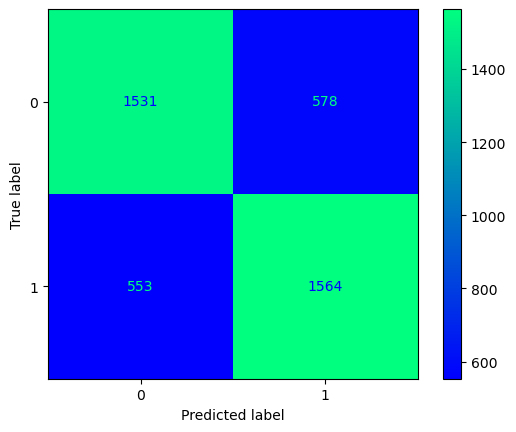

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.73      0.73      0.73      2109
           1       0.73      0.74      0.73      2117

    accuracy                           0.73      4226
   macro avg       0.73      0.73      0.73      4226
weighted avg       0.73      0.73      0.73      4226

-------------------------


In [370]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m4_10min.catboost_GridS()

In [371]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m4_10min,y_val_m4_10min)

Accuracy validación 0.5603937902309731


In [372]:
guardar_modelo(modelo_entrenado_15min,"m4_catboost_GridS_10min")

### Recopilación resultados

In [373]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m4_catboost_GridS", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 9.8. XGBoost

### Partidas 15 min

Hora de inicio:  09:00:23
Hora de fin:  09:00:25
-------------------------
Accuracy train 0.961043498515111
Accuracy test 0.7743362831858407
-------------------------
-------------------------
Matriz de confusión


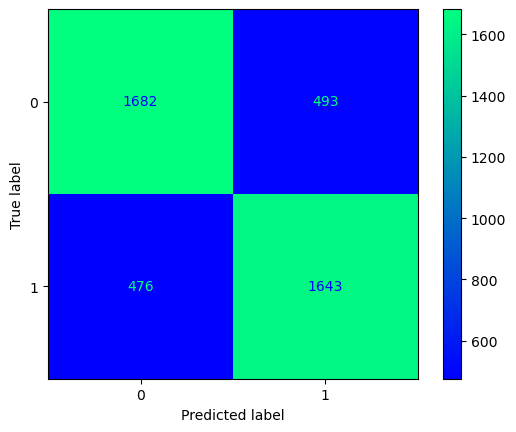

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.78      0.77      0.78      2175
           1       0.77      0.78      0.77      2119

    accuracy                           0.77      4294
   macro avg       0.77      0.77      0.77      4294
weighted avg       0.77      0.77      0.77      4294

-------------------------


In [374]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m4_15min.xgboost()

In [375]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m4_15min,y_val_m4_15min)

Accuracy validación 0.5425749953419042


In [376]:
guardar_modelo(modelo_entrenado_15min,"m4_xgboost_15min")

### Partidas 10 min

Hora de inicio:  09:00:25
Hora de fin:  09:00:27
-------------------------
Accuracy train 0.9384060114786107
Accuracy test 0.7217226691907241
-------------------------
-------------------------
Matriz de confusión


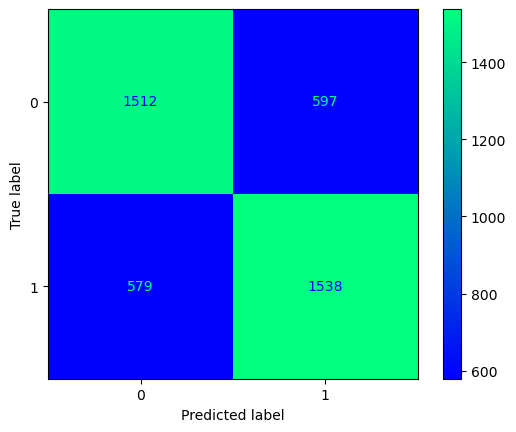

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.72      0.72      0.72      2109
           1       0.72      0.73      0.72      2117

    accuracy                           0.72      4226
   macro avg       0.72      0.72      0.72      4226
weighted avg       0.72      0.72      0.72      4226

-------------------------


In [377]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m4_10min.xgboost()

In [378]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m4_10min,y_val_m4_10min)

Accuracy validación 0.5094661113214691


In [379]:
guardar_modelo(modelo_entrenado_15min,"m4_xgboost_10min")

### Recopilación resultados

In [380]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m4_xgboost", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 9.9. XGBoost Optimizado

Este no

# 9.10. Lightgbm

### Partidas 15 min

Hora de inicio:  09:00:27
Hora de fin:  09:00:27
-------------------------
Accuracy train 0.8840621906481104
Accuracy test 0.7892408011178389
-------------------------
-------------------------
Matriz de confusión


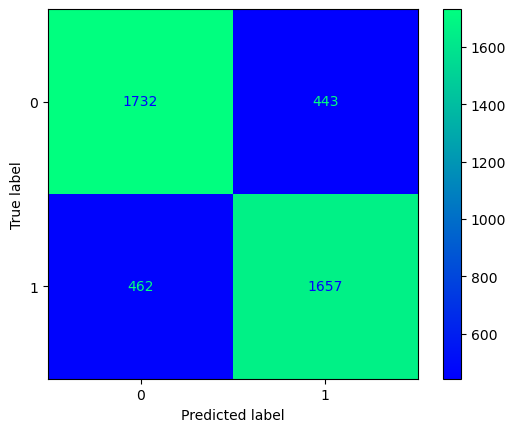

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.79      0.80      0.79      2175
           1       0.79      0.78      0.79      2119

    accuracy                           0.79      4294
   macro avg       0.79      0.79      0.79      4294
weighted avg       0.79      0.79      0.79      4294

-------------------------


In [381]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m4_15min.lightgbm()

In [382]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m4_15min,y_val_m4_15min)

Accuracy validación 0.582634618967766


In [383]:
guardar_modelo(modelo_entrenado_15min,"m4_lightgbm_15min")

### Partidas 10 min

Hora de inicio:  09:00:28
Hora de fin:  09:00:28
-------------------------
Accuracy train 0.8480563280279273
Accuracy test 0.7316611452910554
-------------------------
-------------------------
Matriz de confusión


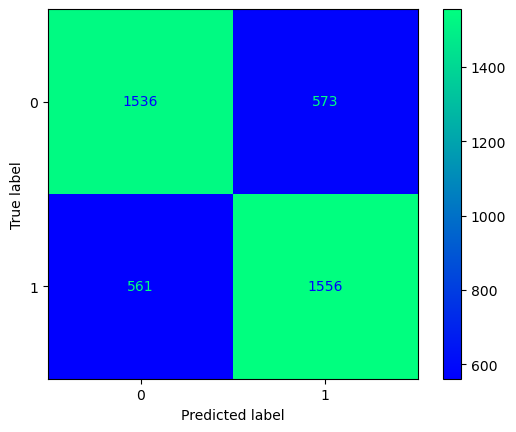

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.73      0.73      0.73      2109
           1       0.73      0.74      0.73      2117

    accuracy                           0.73      4226
   macro avg       0.73      0.73      0.73      4226
weighted avg       0.73      0.73      0.73      4226

-------------------------


In [384]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m4_10min.lightgbm()

In [385]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m4_10min,y_val_m4_10min)

Accuracy validación 0.5817872018174933


In [386]:
guardar_modelo(modelo_entrenado_15min,"m4_lightgbm_10min")

### Recopilación resultados

In [387]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m4_lightgbm", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 9.11. Lightgbm Optimizado

### Partidas 15 min

Hora de inicio:  09:00:28
Hora de fin:  09:04:18
-------------------------
Accuracy train 0.8203575379956909
Accuracy test 0.7969259431765254
-------------------------
-------------------------
Matriz de confusión


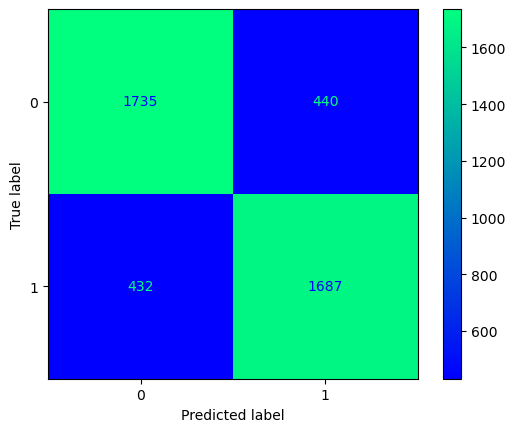

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.80      0.80      0.80      2175
           1       0.79      0.80      0.79      2119

    accuracy                           0.80      4294
   macro avg       0.80      0.80      0.80      4294
weighted avg       0.80      0.80      0.80      4294

-------------------------


In [388]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m4_15min.lightgbm_GridS()

In [389]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m4_15min,y_val_m4_15min)

Accuracy validación 0.5613937022545183


In [390]:
guardar_modelo(modelo_entrenado_15min,"m4_lightgbm_GridS_15min")

### Partidas 10 min

Hora de inicio:  09:04:18
Hora de fin:  09:07:45
-------------------------
Accuracy train 0.767646884799716
Accuracy test 0.738760056791292
-------------------------
-------------------------
Matriz de confusión


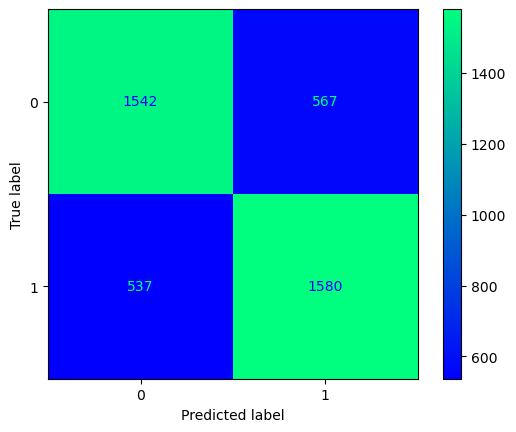

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.74      0.73      0.74      2109
           1       0.74      0.75      0.74      2117

    accuracy                           0.74      4226
   macro avg       0.74      0.74      0.74      4226
weighted avg       0.74      0.74      0.74      4226

-------------------------


In [391]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m4_10min.lightgbm_GridS()

In [392]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m4_10min,y_val_m4_10min)

Accuracy validación 0.5083301779628928


In [393]:
guardar_modelo(modelo_entrenado_15min,"m4_lightgbm_GridS_10min")

### Recopilación resultados

In [394]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m4_lightgbm_GridS", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 9.12. SVC

### Partidas 15 min

Hora de inicio:  09:07:46
Hora de fin:  09:07:57
-------------------------
Accuracy train 0.8202993070517673
Accuracy test 0.7857475547275268
-------------------------
-------------------------
Matriz de confusión


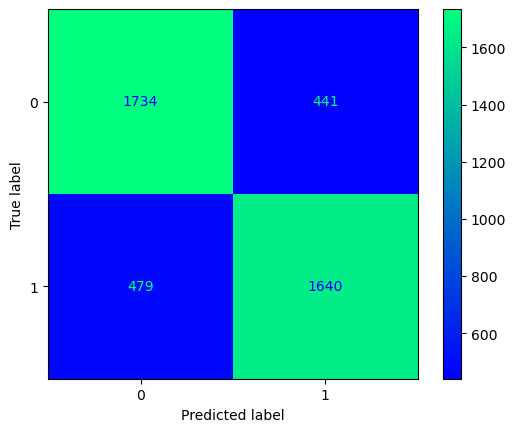

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.78      0.80      0.79      2175
           1       0.79      0.77      0.78      2119

    accuracy                           0.79      4294
   macro avg       0.79      0.79      0.79      4294
weighted avg       0.79      0.79      0.79      4294

-------------------------


In [395]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m4_15min.svc()

In [396]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m4_15min,y_val_m4_15min)

Accuracy validación 0.4920812371902366


In [397]:
guardar_modelo(modelo_entrenado_15min,"m4_svc_15min")

### Partidas 10 min

Hora de inicio:  09:08:24
Hora de fin:  09:08:37
-------------------------
Accuracy train 0.7618484113366073
Accuracy test 0.7276384287742547
-------------------------
-------------------------
Matriz de confusión


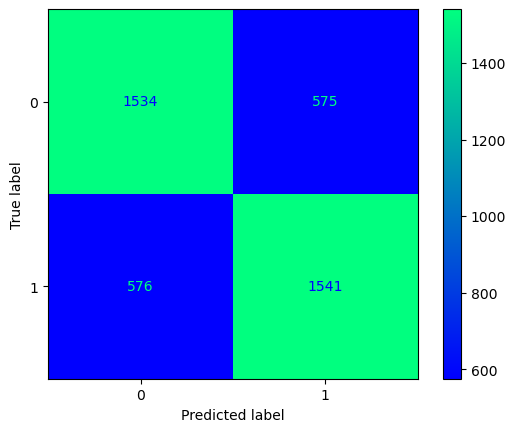

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.73      0.73      0.73      2109
           1       0.73      0.73      0.73      2117

    accuracy                           0.73      4226
   macro avg       0.73      0.73      0.73      4226
weighted avg       0.73      0.73      0.73      4226

-------------------------


In [398]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m4_10min.svc()

In [399]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m4_10min,y_val_m4_10min)

Accuracy validación 0.49810677773570616


In [400]:
guardar_modelo(modelo_entrenado_15min,"m4_svc_10min")

### Recopilación resultados

In [401]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m4_svc", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 9.13. SVC Optimizado

### Partidas 15 min

Hora de inicio:  09:09:08
Hora de fin:  09:32:54
-------------------------
Accuracy train 0.802247714435451
Accuracy test 0.7969259431765254
-------------------------
-------------------------
Matriz de confusión


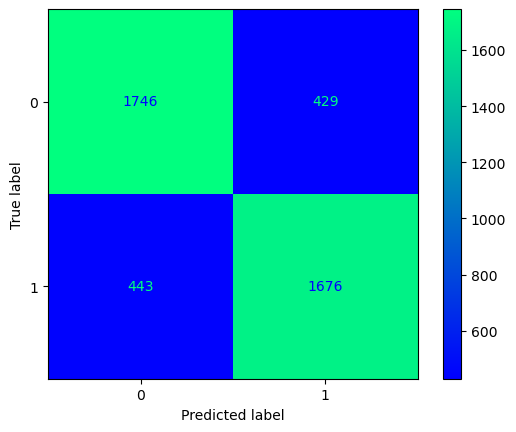

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.80      0.80      0.80      2175
           1       0.80      0.79      0.79      2119

    accuracy                           0.80      4294
   macro avg       0.80      0.80      0.80      4294
weighted avg       0.80      0.80      0.80      4294

-------------------------


In [402]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m4_15min.svc_GridS()

In [403]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m4_15min,y_val_m4_15min)

Accuracy validación 0.4920812371902366


In [404]:
guardar_modelo(modelo_entrenado_15min,"m4_svc_GridS_15min")

### Partidas 10 min

Hora de inicio:  09:33:19
Hora de fin:  09:59:11
-------------------------
Accuracy train 0.7471747233891486
Accuracy test 0.7309512541410317
-------------------------
-------------------------
Matriz de confusión


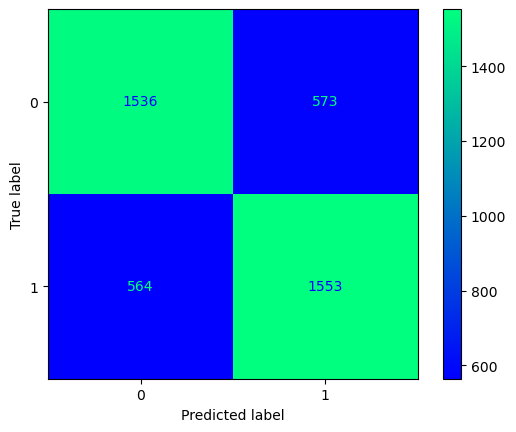

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.73      0.73      0.73      2109
           1       0.73      0.73      0.73      2117

    accuracy                           0.73      4226
   macro avg       0.73      0.73      0.73      4226
weighted avg       0.73      0.73      0.73      4226

-------------------------


In [405]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m4_10min.svc_GridS()

In [406]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m4_10min,y_val_m4_10min)

Accuracy validación 0.5018932222642938


In [407]:
guardar_modelo(modelo_entrenado_15min,"m4_svc_GridS_10min")

### Recopilación resultados

In [408]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m4_svc_GridS", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 9.14. LinearSVC

### Partidas 15 min

Hora de inicio:  09:59:41
Hora de fin:  09:59:43
-------------------------
Accuracy train 0.7865835905200024
Accuracy test 0.7850489054494644
-------------------------
-------------------------
Matriz de confusión


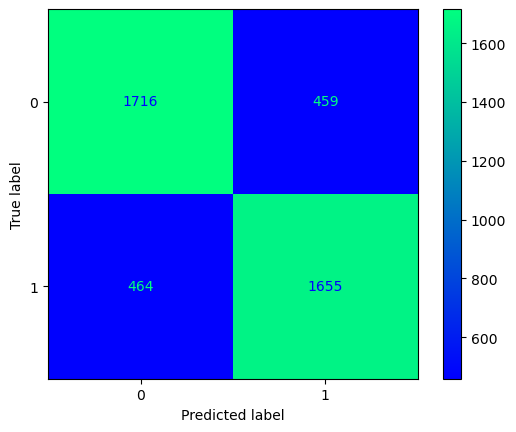

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.79      0.79      0.79      2175
           1       0.78      0.78      0.78      2119

    accuracy                           0.79      4294
   macro avg       0.79      0.78      0.79      4294
weighted avg       0.79      0.79      0.79      4294

-------------------------


In [409]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m4_15min.linearsvc()

In [410]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m4_15min,y_val_m4_15min)

Accuracy validación 0.5079187628097633


In [411]:
guardar_modelo(modelo_entrenado_15min,"m4_linearsvc_15min")

### Partidas 10 min

Hora de inicio:  09:59:44
Hora de fin:  09:59:46
-------------------------
Accuracy train 0.7287142772617005
Accuracy test 0.7288215806909607
-------------------------
-------------------------
Matriz de confusión


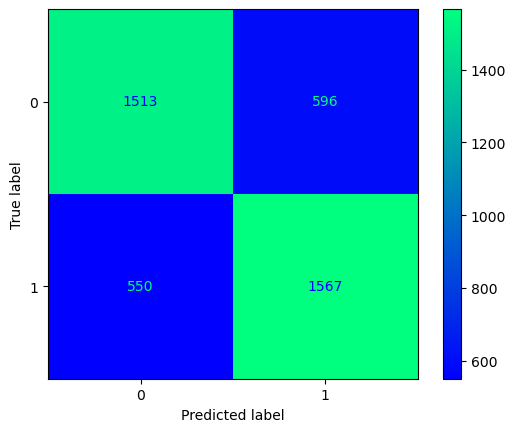

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.73      0.72      0.73      2109
           1       0.72      0.74      0.73      2117

    accuracy                           0.73      4226
   macro avg       0.73      0.73      0.73      4226
weighted avg       0.73      0.73      0.73      4226

-------------------------


In [412]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m4_10min.linearsvc()

In [413]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m4_10min,y_val_m4_10min)

Accuracy validación 0.49810677773570616


In [414]:
guardar_modelo(modelo_entrenado_15min,"m4_linearsvc_10min")

### Recopilación resultados

In [415]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m4_linearsvc", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 9.15. LinearSVC Optimizado

### Partidas 15 min

Hora de inicio:  09:59:46
Hora de fin:  10:04:47
-------------------------
Accuracy train 0.7869912071274675
Accuracy test 0.7852817885421518
-------------------------
-------------------------
Matriz de confusión


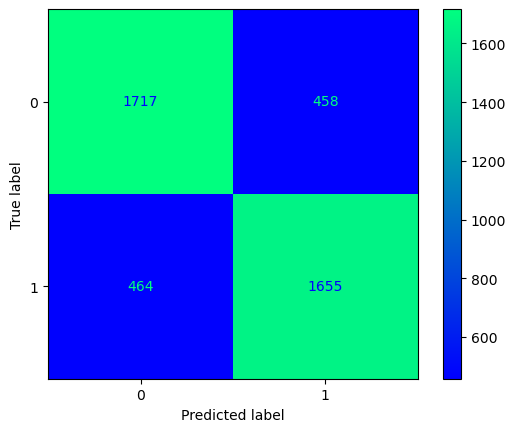

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.79      0.79      0.79      2175
           1       0.78      0.78      0.78      2119

    accuracy                           0.79      4294
   macro avg       0.79      0.79      0.79      4294
weighted avg       0.79      0.79      0.79      4294

-------------------------


In [416]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m4_15min.linearsvc_GridS()

In [417]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m4_15min,y_val_m4_15min)

Accuracy validación 0.5079187628097633


In [418]:
guardar_modelo(modelo_entrenado_15min,"m4_linearsvc_GridS_15min")

### Partidas 10 min

Hora de inicio:  10:04:48
Hora de fin:  10:10:04
-------------------------
Accuracy train 0.7288917815513875
Accuracy test 0.7292948414576431
-------------------------
-------------------------
Matriz de confusión


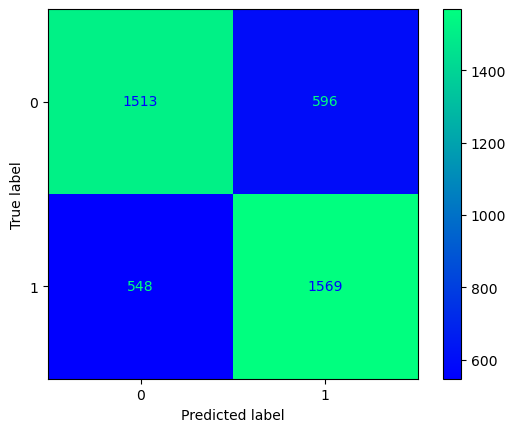

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.73      0.72      0.73      2109
           1       0.72      0.74      0.73      2117

    accuracy                           0.73      4226
   macro avg       0.73      0.73      0.73      4226
weighted avg       0.73      0.73      0.73      4226

-------------------------


In [419]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m4_10min.linearsvc_GridS()

In [420]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m4_10min,y_val_m4_10min)

Accuracy validación 0.49810677773570616


In [421]:
guardar_modelo(modelo_entrenado_15min,"m4_linearsvc_GridS_10min")

### Recopilación resultados

In [422]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m4_linearsvc_GridS", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 10. Modelo 5
Modelo basado en el modelo 1, pero aplicando un escalado a los datos. Se aplica un MinMaxScaler

In [423]:
#Se hace una copia de los datos iniciales para aplicar este modelo
modelo5_15min=datos_entrenamiento_15min.copy()

#Se crean la X y la y
X_m5_15min = modelo5_15min.copy().drop(['blueWins'], axis=1)
y_m5_15min = modelo5_15min[['blueWins']]

#Se realiza la división 
X_train_m5_15min, X_test_m5_15min, y_train_m5_15min, y_test_m5_15min = train_test_split(X_m5_15min, y_m5_15min, test_size=0.2, random_state=42)

In [424]:
#Se hace una copia de los datos iniciales para aplicar este modelo
modelo5_10min=datos_entrenamiento_10min.copy()

#Se crean la X y la y
X_m5_10min = modelo5_10min.copy().drop(['blueWins'], axis=1)
y_m5_10min = modelo5_10min[['blueWins']]

#Se realiza la división 
X_train_m5_10min, X_test_m5_10min, y_train_m5_10min, y_test_m5_10min = train_test_split(X_m5_10min, y_m5_10min, test_size=0.2, random_state=42)

In [425]:
#Se preparan los datos de validación
validacion_m5_15min=datos_validacion_15min.copy()

#Se crean la X y la y
X_val_m5_15min = validacion_m5_15min.copy().drop(['blueWins'], axis=1)
y_val_m5_15min = validacion_m5_15min[['blueWins']]

In [426]:
#Se preparan los datos de validación
validacion_m5_10min=datos_validacion_10min.copy()

#Se crean la X y la y
X_val_m5_10min = validacion_m5_10min.copy().drop(['blueWins'], axis=1)
y_val_m5_10min = validacion_m5_10min[['blueWins']]

## MinMaxScaler

In [427]:
# Se almacenan en el objeto scaler todo lo necesario para estandarizar, con los datos de train de partidas de 15min
scaler = MinMaxScaler()
scaler.fit(X_train_m5_15min)

# Se utilizan los datos de train para escalar train y test.
X_train_m5_15min = scaler.transform(X_train_m5_15min)
X_test_m5_15min = scaler.transform(X_test_m5_15min)

In [428]:
# Se almacenan en el objeto scaler todo lo necesario para estandarizar, con los datos de train de partidas de 10min
scaler = MinMaxScaler()
scaler.fit(X_train_m5_10min)

# Se utilizan los datos de train para escalar train y test.
X_train_m5_10min = scaler.transform(X_train_m5_10min)
X_test_m5_10min = scaler.transform(X_test_m5_10min)

In [429]:
# Se almacenan en el objeto scaler todo lo necesario para estandarizar, con los datos de validacion de partidas de 15min
scaler = MinMaxScaler()
scaler.fit(X_val_m5_15min)

# Se almacenan en el objeto scaler todo lo necesario para estandarizar, con los datos de validacion de partidas de 15min
scaler = MinMaxScaler()
scaler.fit(X_val_m5_10min)

MinMaxScaler()

In [430]:
#Se crean los objetos
m5_15min = Models(X_train_m5_15min, X_test_m5_15min, y_train_m5_15min, y_test_m5_15min)
m5_10min = Models(X_train_m5_10min, X_test_m5_10min, y_train_m5_10min, y_test_m5_10min)

# 10.1. LazyClassifier

In [431]:
#LazyClassifier
m5_15min.lazyclassifier()

100%|██████████████████████████████████████████████████████████████████████████████████| 29/29 [02:00<00:00,  4.15s/it]


,Accuracy,Balanced Accuracy,ROC AUC,F1 Score,Time Taken
Model,,,,,
CalibratedClassifierCV,0.81,0.81,0.81,0.81,12.53
LinearSVC,0.81,0.81,0.81,0.81,3.30
LogisticRegression,0.81,0.81,0.81,0.81,0.29
RandomForestClassifier,0.81,0.81,0.81,0.81,2.85
LGBMClassifier,0.81,0.81,0.81,0.81,0.25
RidgeClassifierCV,0.81,0.81,0.81,0.81,0.11
LinearDiscriminantAnalysis,0.81,0.81,0.81,0.81,0.16
RidgeClassifier,0.81,0.81,0.81,0.81,0.07
SVC,0.81,0.81,0.81,0.81,19.05


In [432]:
#LazyClassifier
m5_10min.lazyclassifier()

100%|██████████████████████████████████████████████████████████████████████████████████| 29/29 [02:17<00:00,  4.75s/it]


,Accuracy,Balanced Accuracy,ROC AUC,F1 Score,Time Taken
Model,,,,,
RidgeClassifierCV,0.74,0.74,0.74,0.74,0.11
RidgeClassifier,0.74,0.74,0.74,0.74,0.07
LinearSVC,0.74,0.74,0.74,0.74,3.64
LinearDiscriminantAnalysis,0.74,0.74,0.74,0.74,0.16
CalibratedClassifierCV,0.74,0.74,0.74,0.74,13.97
LogisticRegression,0.74,0.74,0.74,0.74,0.29
RandomForestClassifier,0.74,0.74,0.74,0.74,2.75
AdaBoostClassifier,0.74,0.74,0.74,0.74,1.40
LGBMClassifier,0.74,0.74,0.74,0.74,0.22


# 10.2. Random Forest

### Partidas 15 min

Hora de inicio:  10:14:23
Hora de fin:  10:14:28
-------------------------
Accuracy train 1.0
Accuracy test 0.8071727992547741
-------------------------
-------------------------
Matriz de confusión


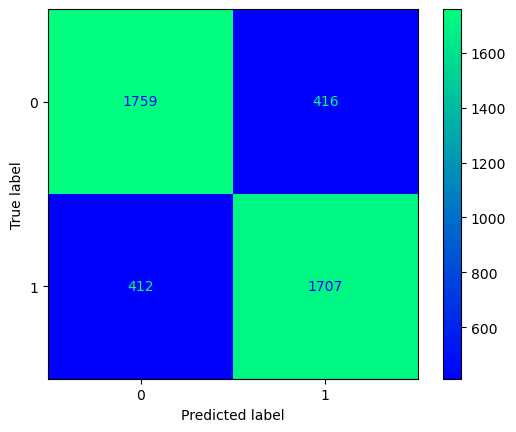

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.81      0.81      0.81      2175
           1       0.80      0.81      0.80      2119

    accuracy                           0.81      4294
   macro avg       0.81      0.81      0.81      4294
weighted avg       0.81      0.81      0.81      4294

-------------------------


In [433]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m5_15min.randomforest()

In [434]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m5_15min,y_val_m5_15min)

Accuracy validación 0.6713247624371157


In [435]:
guardar_modelo(modelo_entrenado_15min,"m5_randomforest_15min")

### Partidas 10 min

Hora de inicio:  10:14:29
Hora de fin:  10:14:35
-------------------------
Accuracy train 1.0
Accuracy test 0.740889730241363
-------------------------
-------------------------
Matriz de confusión


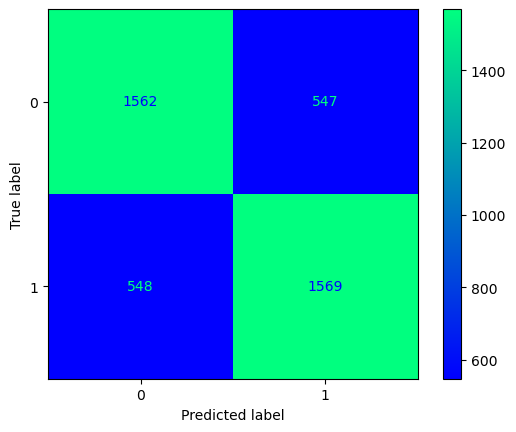

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.74      0.74      0.74      2109
           1       0.74      0.74      0.74      2117

    accuracy                           0.74      4226
   macro avg       0.74      0.74      0.74      4226
weighted avg       0.74      0.74      0.74      4226

-------------------------


In [436]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m5_10min.randomforest()

In [437]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m5_10min,y_val_m5_10min)

Accuracy validación 0.5295342673229837


In [438]:
guardar_modelo(modelo_entrenado_15min,"m5_randomforest_10min")

### Recopilación resultados

In [439]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m5_randomforest", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 10.3. Random Forest Optimizado

### Partidas 15 min

Hora de inicio:  10:14:36
Hora de fin:  10:51:25
-------------------------
Accuracy train 0.8156990624818028
Accuracy test 0.8088029809035864
-------------------------
-------------------------
Matriz de confusión


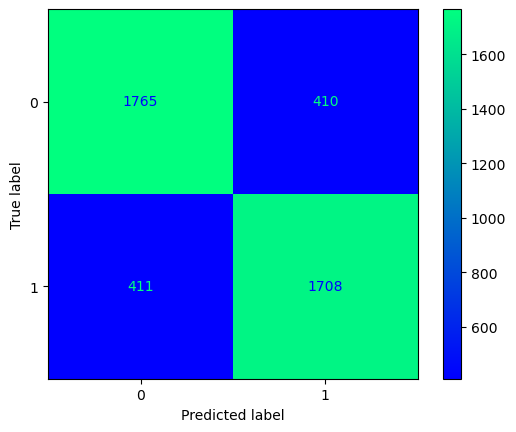

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.81      0.81      0.81      2175
           1       0.81      0.81      0.81      2119

    accuracy                           0.81      4294
   macro avg       0.81      0.81      0.81      4294
weighted avg       0.81      0.81      0.81      4294

-------------------------


In [440]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m5_15min.randomforest_GridS()

In [441]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m5_15min,y_val_m5_15min)

Accuracy validación 0.7305757406372275


In [442]:
guardar_modelo(modelo_entrenado_15min,"m5_randomforest_GridS_15min")

### Partidas 10 min

Hora de inicio:  10:51:26
Hora de fin:  11:24:37
-------------------------
Accuracy train 0.7647476480681616
Accuracy test 0.7394699479413157
-------------------------
-------------------------
Matriz de confusión


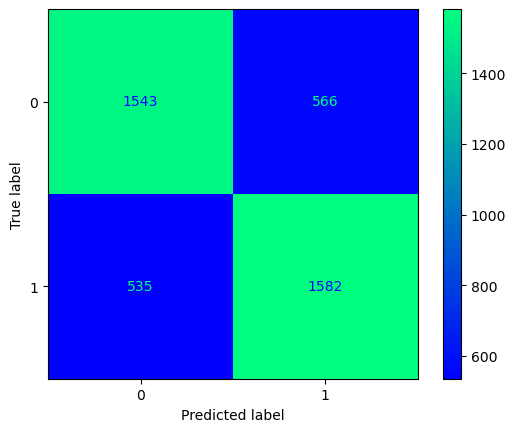

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.74      0.73      0.74      2109
           1       0.74      0.75      0.74      2117

    accuracy                           0.74      4226
   macro avg       0.74      0.74      0.74      4226
weighted avg       0.74      0.74      0.74      4226

-------------------------


In [443]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m5_10min.randomforest_GridS()

In [444]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m5_10min,y_val_m5_10min)

Accuracy validación 0.6241953805376751


In [445]:
guardar_modelo(modelo_entrenado_15min,"m5_randomforest_GridS_10min")

### Recopilación resultados

In [446]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m5_randomforest_GridS", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 10.4. Gradient boosting 

### Partidas 15 min

Hora de inicio:  11:24:38
Hora de fin:  11:24:50
-------------------------
Accuracy train 0.8276946369300646
Accuracy test 0.807638565440149
-------------------------
-------------------------
Matriz de confusión


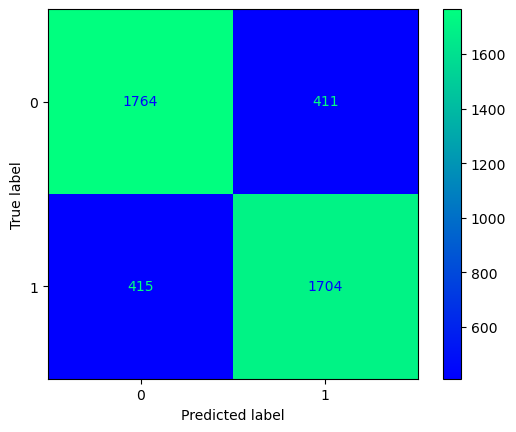

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.81      0.81      0.81      2175
           1       0.81      0.80      0.80      2119

    accuracy                           0.81      4294
   macro avg       0.81      0.81      0.81      4294
weighted avg       0.81      0.81      0.81      4294

-------------------------


In [447]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m5_15min.gradientboosting()

In [448]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m5_15min,y_val_m5_15min)

Accuracy validación 0.4091671324762437


In [449]:
guardar_modelo(modelo_entrenado_15min,"m5_gradientboosting_15min")

### Partidas 10 min

Hora de inicio:  11:24:51
Hora de fin:  11:25:01
-------------------------
Accuracy train 0.7701911129518964
Accuracy test 0.7375769048745859
-------------------------
-------------------------
Matriz de confusión


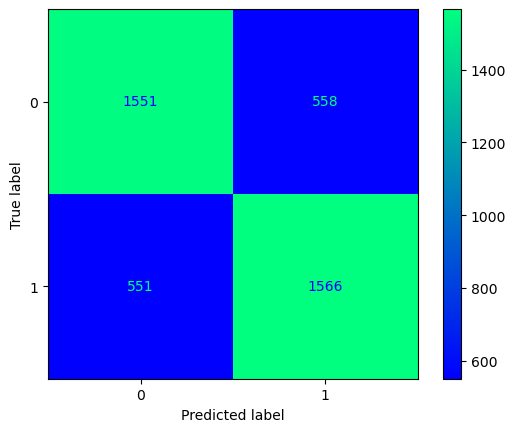

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.74      0.74      0.74      2109
           1       0.74      0.74      0.74      2117

    accuracy                           0.74      4226
   macro avg       0.74      0.74      0.74      4226
weighted avg       0.74      0.74      0.74      4226

-------------------------


In [450]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m5_10min.gradientboosting()

In [451]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m5_10min,y_val_m5_10min)

Accuracy validación 0.51533510034078


In [452]:
guardar_modelo(modelo_entrenado_15min,"m5_gradientboosting_10min")

### Recopilación resultados

In [453]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m5_gradientboosting", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 10.5. Gradient boosting Optimizado

### Partidas 15 min

Hora de inicio:  11:25:02
Hora de fin:  11:51:06
-------------------------
Accuracy train 0.8370698189017644
Accuracy test 0.8095016301816488
-------------------------
-------------------------
Matriz de confusión


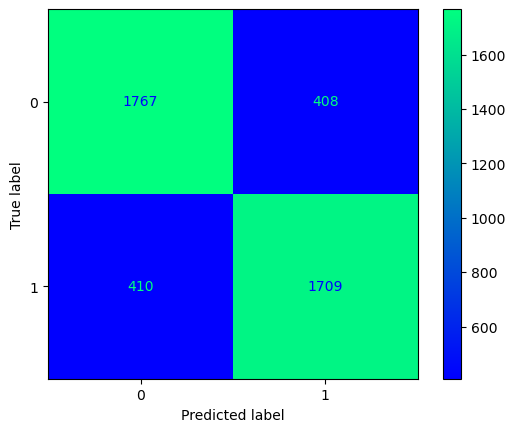

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.81      0.81      0.81      2175
           1       0.81      0.81      0.81      2119

    accuracy                           0.81      4294
   macro avg       0.81      0.81      0.81      4294
weighted avg       0.81      0.81      0.81      4294

-------------------------


In [454]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m5_15min.gradientboosting_GridS()

In [455]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m5_15min,y_val_m5_15min)

Accuracy validación 0.6730016769144773


In [456]:
guardar_modelo(modelo_entrenado_15min,"m5_gradientboosting_GridS_15min")

### Partidas 10 min

Hora de inicio:  11:51:06
Hora de fin:  12:15:59
-------------------------
Accuracy train 0.7651026566475356
Accuracy test 0.7382867960246096
-------------------------
-------------------------
Matriz de confusión


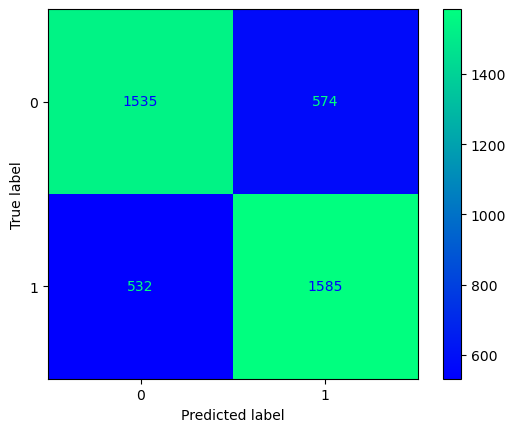

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.74      0.73      0.74      2109
           1       0.73      0.75      0.74      2117

    accuracy                           0.74      4226
   macro avg       0.74      0.74      0.74      4226
weighted avg       0.74      0.74      0.74      4226

-------------------------


In [457]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m5_10min.gradientboosting_GridS()

In [458]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m5_10min,y_val_m5_10min)

Accuracy validación 0.5037864445285877


In [459]:
guardar_modelo(modelo_entrenado_15min,"m5_gradientboosting_GridS_10min")

### Recopilación resultados

In [460]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m5_gradientboosting_GridS", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 10.6. Catboost

### Partidas 15 min

Hora de inicio:  12:15:59
Learning rate set to 0.151764
0:	learn: 0.6179776	total: 8.62ms	remaining: 1.71s
1:	learn: 0.5696056	total: 16.9ms	remaining: 1.67s
2:	learn: 0.5311687	total: 25.1ms	remaining: 1.65s
3:	learn: 0.5050932	total: 33.5ms	remaining: 1.64s
4:	learn: 0.4886776	total: 42.3ms	remaining: 1.65s
5:	learn: 0.4741001	total: 50.5ms	remaining: 1.63s
6:	learn: 0.4628672	total: 58.6ms	remaining: 1.62s
7:	learn: 0.4552205	total: 67.1ms	remaining: 1.61s
8:	learn: 0.4479512	total: 76.2ms	remaining: 1.62s
9:	learn: 0.4418865	total: 84.3ms	remaining: 1.6s
10:	learn: 0.4364878	total: 92.3ms	remaining: 1.59s
11:	learn: 0.4327483	total: 100ms	remaining: 1.57s
12:	learn: 0.4297974	total: 108ms	remaining: 1.55s
13:	learn: 0.4269826	total: 116ms	remaining: 1.54s
14:	learn: 0.4241425	total: 127ms	remaining: 1.57s
15:	learn: 0.4216922	total: 135ms	remaining: 1.56s
16:	learn: 0.4204644	total: 144ms	remaining: 1.54s
17:	learn: 0.4182281	total: 156ms	remaining: 1.58s
18:	learn: 0.4162996	total

165:	learn: 0.3353267	total: 1.23s	remaining: 253ms
166:	learn: 0.3350469	total: 1.24s	remaining: 246ms
167:	learn: 0.3343438	total: 1.25s	remaining: 238ms
168:	learn: 0.3335649	total: 1.26s	remaining: 231ms
169:	learn: 0.3331934	total: 1.26s	remaining: 223ms
170:	learn: 0.3328403	total: 1.27s	remaining: 216ms
171:	learn: 0.3323852	total: 1.28s	remaining: 208ms
172:	learn: 0.3319781	total: 1.28s	remaining: 201ms
173:	learn: 0.3315267	total: 1.29s	remaining: 193ms
174:	learn: 0.3311254	total: 1.3s	remaining: 186ms
175:	learn: 0.3304487	total: 1.31s	remaining: 178ms
176:	learn: 0.3300368	total: 1.31s	remaining: 171ms
177:	learn: 0.3297048	total: 1.32s	remaining: 164ms
178:	learn: 0.3292415	total: 1.33s	remaining: 156ms
179:	learn: 0.3285709	total: 1.34s	remaining: 149ms
180:	learn: 0.3280972	total: 1.34s	remaining: 141ms
181:	learn: 0.3274843	total: 1.35s	remaining: 134ms
182:	learn: 0.3270573	total: 1.36s	remaining: 126ms
183:	learn: 0.3263361	total: 1.36s	remaining: 119ms
184:	learn: 0

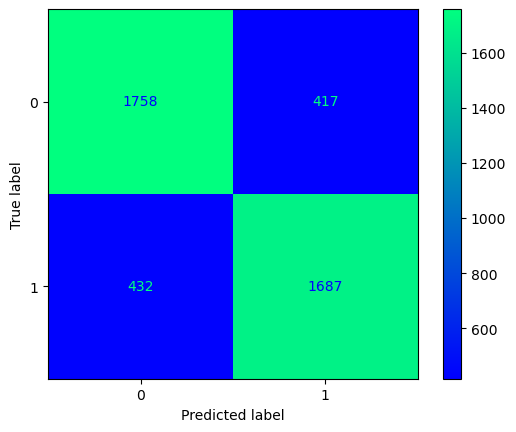

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.80      0.81      0.81      2175
           1       0.80      0.80      0.80      2119

    accuracy                           0.80      4294
   macro avg       0.80      0.80      0.80      4294
weighted avg       0.80      0.80      0.80      4294

-------------------------


In [461]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m5_15min.catboost()

In [462]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m5_15min,y_val_m5_15min)

Accuracy validación 0.67002049562139


In [463]:
guardar_modelo(modelo_entrenado_15min,"m5_catboost_15min")

### Partidas 10 min

Hora de inicio:  12:16:01
Learning rate set to 0.150733
0:	learn: 0.6509642	total: 10.3ms	remaining: 2.04s
1:	learn: 0.6171984	total: 18.3ms	remaining: 1.81s
2:	learn: 0.5966963	total: 27ms	remaining: 1.77s
3:	learn: 0.5788801	total: 36.8ms	remaining: 1.8s
4:	learn: 0.5650406	total: 44.8ms	remaining: 1.75s
5:	learn: 0.5536083	total: 52.7ms	remaining: 1.7s
6:	learn: 0.5458894	total: 61ms	remaining: 1.68s
7:	learn: 0.5393474	total: 68.8ms	remaining: 1.65s
8:	learn: 0.5350829	total: 75ms	remaining: 1.59s
9:	learn: 0.5311261	total: 81.3ms	remaining: 1.54s
10:	learn: 0.5286937	total: 87.7ms	remaining: 1.51s
11:	learn: 0.5259782	total: 93.6ms	remaining: 1.47s
12:	learn: 0.5237836	total: 99.7ms	remaining: 1.43s
13:	learn: 0.5213130	total: 106ms	remaining: 1.41s
14:	learn: 0.5197328	total: 112ms	remaining: 1.38s
15:	learn: 0.5180927	total: 118ms	remaining: 1.36s
16:	learn: 0.5170469	total: 124ms	remaining: 1.33s
17:	learn: 0.5154976	total: 130ms	remaining: 1.32s
18:	learn: 0.5142647	total: 136

173:	learn: 0.4346569	total: 1.18s	remaining: 177ms
174:	learn: 0.4342797	total: 1.19s	remaining: 170ms
175:	learn: 0.4338032	total: 1.2s	remaining: 163ms
176:	learn: 0.4334975	total: 1.2s	remaining: 157ms
177:	learn: 0.4329972	total: 1.21s	remaining: 150ms
178:	learn: 0.4325714	total: 1.22s	remaining: 143ms
179:	learn: 0.4317965	total: 1.23s	remaining: 136ms
180:	learn: 0.4313437	total: 1.23s	remaining: 129ms
181:	learn: 0.4312427	total: 1.24s	remaining: 122ms
182:	learn: 0.4306972	total: 1.24s	remaining: 116ms
183:	learn: 0.4303424	total: 1.25s	remaining: 109ms
184:	learn: 0.4299083	total: 1.26s	remaining: 102ms
185:	learn: 0.4295113	total: 1.27s	remaining: 95.4ms
186:	learn: 0.4290899	total: 1.27s	remaining: 88.5ms
187:	learn: 0.4284026	total: 1.28s	remaining: 81.7ms
188:	learn: 0.4276504	total: 1.29s	remaining: 74.8ms
189:	learn: 0.4272945	total: 1.29s	remaining: 68ms
190:	learn: 0.4267845	total: 1.3s	remaining: 61.2ms
191:	learn: 0.4266891	total: 1.3s	remaining: 54.3ms
192:	learn:

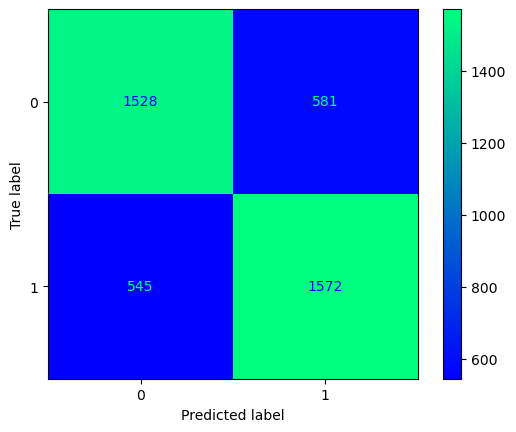

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.74      0.72      0.73      2109
           1       0.73      0.74      0.74      2117

    accuracy                           0.73      4226
   macro avg       0.73      0.73      0.73      4226
weighted avg       0.73      0.73      0.73      4226

-------------------------


In [464]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m5_10min.catboost()

In [465]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m5_10min,y_val_m5_10min)

Accuracy validación 0.6173797803862173


In [466]:
guardar_modelo(modelo_entrenado_15min,"m5_catboost_10min")

### Recopilación resultados

In [467]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m5_catboost", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 10.7. CatBoost Optimizado

### Partidas 15 min

Hora de inicio:  12:16:03
0:	learn: 0.6717839	test: 0.6706242	best: 0.6706242 (0)	total: 3.44ms	remaining: 340ms
1:	learn: 0.6523375	test: 0.6503542	best: 0.6503542 (1)	total: 7.03ms	remaining: 344ms
2:	learn: 0.6358068	test: 0.6331596	best: 0.6331596 (2)	total: 10.4ms	remaining: 336ms
3:	learn: 0.6197712	test: 0.6162970	best: 0.6162970 (3)	total: 13.7ms	remaining: 328ms
4:	learn: 0.6037344	test: 0.5989970	best: 0.5989970 (4)	total: 17.2ms	remaining: 327ms
5:	learn: 0.5912331	test: 0.5857635	best: 0.5857635 (5)	total: 20.9ms	remaining: 327ms
6:	learn: 0.5786575	test: 0.5722855	best: 0.5722855 (6)	total: 24.6ms	remaining: 327ms
7:	learn: 0.5691048	test: 0.5622034	best: 0.5622034 (7)	total: 28ms	remaining: 322ms
8:	learn: 0.5593454	test: 0.5517411	best: 0.5517411 (8)	total: 33.5ms	remaining: 339ms
9:	learn: 0.5508132	test: 0.5426626	best: 0.5426626 (9)	total: 39.2ms	remaining: 353ms
10:	learn: 0.5437542	test: 0.5354932	best: 0.5354932 (10)	total: 42.6ms	remaining: 344ms
11:	learn: 0.5369

96:	learn: 0.4224431	test: 0.4046115	best: 0.4046115 (96)	total: 361ms	remaining: 11.2ms
97:	learn: 0.4221853	test: 0.4043534	best: 0.4043534 (97)	total: 365ms	remaining: 7.45ms
98:	learn: 0.4220340	test: 0.4041761	best: 0.4041761 (98)	total: 368ms	remaining: 3.71ms
99:	learn: 0.4218929	test: 0.4040061	best: 0.4040061 (99)	total: 371ms	remaining: 0us

bestTest = 0.4040061449
bestIteration = 99

0:	loss: 0.4040061	best: 0.4040061 (0)	total: 409ms	remaining: 54.8s
0:	learn: 0.6518916	test: 0.6496042	best: 0.6496042 (0)	total: 3.24ms	remaining: 321ms
1:	learn: 0.6183106	test: 0.6144103	best: 0.6144103 (1)	total: 6.46ms	remaining: 316ms
2:	learn: 0.5917641	test: 0.5864583	best: 0.5864583 (2)	total: 9.73ms	remaining: 315ms
3:	learn: 0.5689434	test: 0.5616230	best: 0.5616230 (3)	total: 13.1ms	remaining: 313ms
4:	learn: 0.5504148	test: 0.5428282	best: 0.5428282 (4)	total: 16.6ms	remaining: 315ms
5:	learn: 0.5359413	test: 0.5277705	best: 0.5277705 (5)	total: 19.8ms	remaining: 309ms
6:	learn: 0

1:	learn: 0.5901461	test: 0.5844955	best: 0.5844955 (1)	total: 18.6ms	remaining: 913ms
2:	learn: 0.5618043	test: 0.5554221	best: 0.5554221 (2)	total: 25.1ms	remaining: 810ms
3:	learn: 0.5335944	test: 0.5243869	best: 0.5243869 (3)	total: 30.5ms	remaining: 733ms
4:	learn: 0.5158039	test: 0.5053849	best: 0.5053849 (4)	total: 34.7ms	remaining: 660ms
5:	learn: 0.5020710	test: 0.4903925	best: 0.4903925 (5)	total: 39.2ms	remaining: 615ms
6:	learn: 0.4907171	test: 0.4777355	best: 0.4777355 (6)	total: 43.8ms	remaining: 581ms
7:	learn: 0.4816845	test: 0.4676766	best: 0.4676766 (7)	total: 48ms	remaining: 552ms
8:	learn: 0.4742710	test: 0.4597583	best: 0.4597583 (8)	total: 51.3ms	remaining: 519ms
9:	learn: 0.4687336	test: 0.4533478	best: 0.4533478 (9)	total: 61.6ms	remaining: 554ms
10:	learn: 0.4631474	test: 0.4472833	best: 0.4472833 (10)	total: 71.1ms	remaining: 575ms
11:	learn: 0.4579718	test: 0.4417019	best: 0.4417019 (11)	total: 77.5ms	remaining: 568ms
12:	learn: 0.4543038	test: 0.4373336	best

13:	learn: 0.4392507	test: 0.4218670	best: 0.4218670 (13)	total: 47.2ms	remaining: 290ms
14:	learn: 0.4364493	test: 0.4188386	best: 0.4188386 (14)	total: 51.3ms	remaining: 291ms
15:	learn: 0.4342856	test: 0.4155549	best: 0.4155549 (15)	total: 55.3ms	remaining: 290ms
16:	learn: 0.4326066	test: 0.4137040	best: 0.4137040 (16)	total: 59.6ms	remaining: 291ms
17:	learn: 0.4307828	test: 0.4115648	best: 0.4115648 (17)	total: 67.2ms	remaining: 306ms
18:	learn: 0.4289350	test: 0.4096946	best: 0.4096946 (18)	total: 72.2ms	remaining: 308ms
19:	learn: 0.4272459	test: 0.4076696	best: 0.4076696 (19)	total: 76.1ms	remaining: 305ms
20:	learn: 0.4256717	test: 0.4059463	best: 0.4059463 (20)	total: 79.6ms	remaining: 300ms
21:	learn: 0.4248028	test: 0.4051650	best: 0.4051650 (21)	total: 83.7ms	remaining: 297ms
22:	learn: 0.4236461	test: 0.4039757	best: 0.4039757 (22)	total: 87ms	remaining: 291ms
23:	learn: 0.4232030	test: 0.4032050	best: 0.4032050 (23)	total: 89.8ms	remaining: 284ms
24:	learn: 0.4216975	te

42:	learn: 0.3998497	test: 0.3976871	best: 0.3943747 (31)	total: 134ms	remaining: 177ms
43:	learn: 0.3989591	test: 0.3974006	best: 0.3943747 (31)	total: 138ms	remaining: 176ms
44:	learn: 0.3983430	test: 0.3980884	best: 0.3943747 (31)	total: 142ms	remaining: 173ms
45:	learn: 0.3973469	test: 0.3979494	best: 0.3943747 (31)	total: 146ms	remaining: 171ms
46:	learn: 0.3970583	test: 0.3990942	best: 0.3943747 (31)	total: 154ms	remaining: 174ms
47:	learn: 0.3962680	test: 0.3999293	best: 0.3943747 (31)	total: 161ms	remaining: 174ms
48:	learn: 0.3954173	test: 0.3991325	best: 0.3943747 (31)	total: 164ms	remaining: 171ms
49:	learn: 0.3950483	test: 0.3988048	best: 0.3943747 (31)	total: 168ms	remaining: 168ms
50:	learn: 0.3943669	test: 0.3988082	best: 0.3943747 (31)	total: 171ms	remaining: 164ms
51:	learn: 0.3939116	test: 0.3986779	best: 0.3943747 (31)	total: 174ms	remaining: 160ms
52:	learn: 0.3932970	test: 0.3989048	best: 0.3943747 (31)	total: 177ms	remaining: 157ms
53:	learn: 0.3928168	test: 0.398

56:	learn: 0.4392079	test: 0.4222754	best: 0.4222754 (56)	total: 203ms	remaining: 153ms
57:	learn: 0.4383761	test: 0.4212055	best: 0.4212055 (57)	total: 209ms	remaining: 151ms
58:	learn: 0.4377613	test: 0.4205676	best: 0.4205676 (58)	total: 213ms	remaining: 148ms
59:	learn: 0.4368059	test: 0.4196124	best: 0.4196124 (59)	total: 217ms	remaining: 144ms
60:	learn: 0.4359673	test: 0.4188608	best: 0.4188608 (60)	total: 221ms	remaining: 141ms
61:	learn: 0.4353161	test: 0.4184005	best: 0.4184005 (61)	total: 225ms	remaining: 138ms
62:	learn: 0.4349269	test: 0.4179898	best: 0.4179898 (62)	total: 230ms	remaining: 135ms
63:	learn: 0.4344466	test: 0.4175127	best: 0.4175127 (63)	total: 234ms	remaining: 131ms
64:	learn: 0.4338348	test: 0.4168506	best: 0.4168506 (64)	total: 237ms	remaining: 128ms
65:	learn: 0.4332052	test: 0.4161610	best: 0.4161610 (65)	total: 240ms	remaining: 124ms
66:	learn: 0.4328461	test: 0.4157639	best: 0.4157639 (66)	total: 243ms	remaining: 120ms
67:	learn: 0.4323764	test: 0.415

78:	learn: 0.4149439	test: 0.3959849	best: 0.3959849 (78)	total: 265ms	remaining: 70.5ms
79:	learn: 0.4147958	test: 0.3959574	best: 0.3959574 (79)	total: 270ms	remaining: 67.5ms
80:	learn: 0.4143672	test: 0.3955420	best: 0.3955420 (80)	total: 274ms	remaining: 64.2ms
81:	learn: 0.4140331	test: 0.3951021	best: 0.3951021 (81)	total: 282ms	remaining: 61.8ms
82:	learn: 0.4139103	test: 0.3952065	best: 0.3951021 (81)	total: 291ms	remaining: 59.6ms
83:	learn: 0.4137012	test: 0.3949804	best: 0.3949804 (83)	total: 294ms	remaining: 56ms
84:	learn: 0.4136397	test: 0.3948929	best: 0.3948929 (84)	total: 297ms	remaining: 52.5ms
85:	learn: 0.4133388	test: 0.3946593	best: 0.3946593 (85)	total: 301ms	remaining: 48.9ms
86:	learn: 0.4130720	test: 0.3944350	best: 0.3944350 (86)	total: 304ms	remaining: 45.4ms
87:	learn: 0.4128000	test: 0.3941634	best: 0.3941634 (87)	total: 307ms	remaining: 41.8ms
88:	learn: 0.4124858	test: 0.3938706	best: 0.3938706 (88)	total: 310ms	remaining: 38.3ms
89:	learn: 0.4123355	te

0:	learn: 0.6165189	test: 0.6120144	best: 0.6120144 (0)	total: 3.98ms	remaining: 394ms
1:	learn: 0.5670942	test: 0.5598102	best: 0.5598102 (1)	total: 8.82ms	remaining: 432ms
2:	learn: 0.5392464	test: 0.5302127	best: 0.5302127 (2)	total: 12.9ms	remaining: 417ms
3:	learn: 0.5142678	test: 0.5038668	best: 0.5038668 (3)	total: 17.5ms	remaining: 420ms
4:	learn: 0.4959251	test: 0.4832724	best: 0.4832724 (4)	total: 21.9ms	remaining: 417ms
5:	learn: 0.4829671	test: 0.4690211	best: 0.4690211 (5)	total: 26ms	remaining: 408ms
6:	learn: 0.4733155	test: 0.4588933	best: 0.4588933 (6)	total: 32.3ms	remaining: 428ms
7:	learn: 0.4654891	test: 0.4501285	best: 0.4501285 (7)	total: 38.1ms	remaining: 438ms
8:	learn: 0.4588286	test: 0.4426527	best: 0.4426527 (8)	total: 41.3ms	remaining: 417ms
9:	learn: 0.4548311	test: 0.4385450	best: 0.4385450 (9)	total: 44.4ms	remaining: 400ms
10:	learn: 0.4488005	test: 0.4313522	best: 0.4313522 (10)	total: 48.4ms	remaining: 391ms
11:	learn: 0.4453122	test: 0.4269963	best: 

19:	learn: 0.4182594	test: 0.4001326	best: 0.3999357 (18)	total: 66.1ms	remaining: 264ms
20:	learn: 0.4169275	test: 0.3991908	best: 0.3991908 (20)	total: 70.4ms	remaining: 265ms
21:	learn: 0.4159662	test: 0.3990156	best: 0.3990156 (21)	total: 74.4ms	remaining: 264ms
22:	learn: 0.4150805	test: 0.3990139	best: 0.3990139 (22)	total: 78.9ms	remaining: 264ms
23:	learn: 0.4141599	test: 0.3987206	best: 0.3987206 (23)	total: 83ms	remaining: 263ms
24:	learn: 0.4130486	test: 0.3973813	best: 0.3973813 (24)	total: 87.4ms	remaining: 262ms
25:	learn: 0.4121041	test: 0.3968204	best: 0.3968204 (25)	total: 91.7ms	remaining: 261ms
26:	learn: 0.4112899	test: 0.3966299	best: 0.3966299 (26)	total: 94.5ms	remaining: 255ms
27:	learn: 0.4105704	test: 0.3966505	best: 0.3966299 (26)	total: 97.5ms	remaining: 251ms
28:	learn: 0.4095984	test: 0.3959781	best: 0.3959781 (28)	total: 101ms	remaining: 248ms
29:	learn: 0.4091451	test: 0.3956605	best: 0.3956605 (29)	total: 105ms	remaining: 244ms
30:	learn: 0.4084605	test

40:	learn: 0.4526469	test: 0.4366784	best: 0.4366784 (40)	total: 135ms	remaining: 195ms
41:	learn: 0.4512313	test: 0.4350657	best: 0.4350657 (41)	total: 140ms	remaining: 193ms
42:	learn: 0.4503174	test: 0.4341246	best: 0.4341246 (42)	total: 144ms	remaining: 191ms
43:	learn: 0.4493093	test: 0.4329936	best: 0.4329936 (43)	total: 148ms	remaining: 189ms
44:	learn: 0.4484630	test: 0.4321684	best: 0.4321684 (44)	total: 156ms	remaining: 191ms
45:	learn: 0.4478129	test: 0.4313683	best: 0.4313683 (45)	total: 162ms	remaining: 190ms
46:	learn: 0.4469035	test: 0.4303420	best: 0.4303420 (46)	total: 165ms	remaining: 186ms
47:	learn: 0.4461523	test: 0.4295304	best: 0.4295304 (47)	total: 168ms	remaining: 182ms
48:	learn: 0.4454676	test: 0.4288752	best: 0.4288752 (48)	total: 171ms	remaining: 178ms
49:	learn: 0.4445874	test: 0.4280360	best: 0.4280360 (49)	total: 175ms	remaining: 175ms
50:	learn: 0.4440238	test: 0.4274377	best: 0.4274377 (50)	total: 178ms	remaining: 171ms
51:	learn: 0.4430625	test: 0.426

55:	learn: 0.4215437	test: 0.4019344	best: 0.4019344 (55)	total: 199ms	remaining: 156ms
56:	learn: 0.4212719	test: 0.4015859	best: 0.4015859 (56)	total: 203ms	remaining: 153ms
57:	learn: 0.4206216	test: 0.4005259	best: 0.4005259 (57)	total: 207ms	remaining: 150ms
58:	learn: 0.4203059	test: 0.4004598	best: 0.4004598 (58)	total: 211ms	remaining: 147ms
59:	learn: 0.4198989	test: 0.3999681	best: 0.3999681 (59)	total: 215ms	remaining: 144ms
60:	learn: 0.4193828	test: 0.3995145	best: 0.3995145 (60)	total: 222ms	remaining: 142ms
61:	learn: 0.4192427	test: 0.3996391	best: 0.3995145 (60)	total: 225ms	remaining: 138ms
62:	learn: 0.4190055	test: 0.3994911	best: 0.3994911 (62)	total: 228ms	remaining: 134ms
63:	learn: 0.4188539	test: 0.3994482	best: 0.3994482 (63)	total: 231ms	remaining: 130ms
64:	learn: 0.4185448	test: 0.3991911	best: 0.3991911 (64)	total: 234ms	remaining: 126ms
65:	learn: 0.4181973	test: 0.3988897	best: 0.3988897 (65)	total: 238ms	remaining: 123ms
66:	learn: 0.4179118	test: 0.398

80:	learn: 0.4065425	test: 0.3942177	best: 0.3942177 (80)	total: 268ms	remaining: 63ms
81:	learn: 0.4062634	test: 0.3940997	best: 0.3940997 (81)	total: 273ms	remaining: 59.8ms
82:	learn: 0.4059238	test: 0.3940542	best: 0.3940542 (82)	total: 276ms	remaining: 56.6ms
83:	learn: 0.4056568	test: 0.3937204	best: 0.3937204 (83)	total: 280ms	remaining: 53.4ms
84:	learn: 0.4054197	test: 0.3935661	best: 0.3935661 (84)	total: 284ms	remaining: 50.1ms
85:	learn: 0.4050797	test: 0.3934117	best: 0.3934117 (85)	total: 288ms	remaining: 46.9ms
86:	learn: 0.4048495	test: 0.3934532	best: 0.3934117 (85)	total: 292ms	remaining: 43.7ms
87:	learn: 0.4044740	test: 0.3934626	best: 0.3934117 (85)	total: 296ms	remaining: 40.4ms
88:	learn: 0.4041994	test: 0.3935295	best: 0.3934117 (85)	total: 299ms	remaining: 36.9ms
89:	learn: 0.4039730	test: 0.3934147	best: 0.3934117 (85)	total: 302ms	remaining: 33.6ms
90:	learn: 0.4036351	test: 0.3933905	best: 0.3933905 (90)	total: 306ms	remaining: 30.2ms
91:	learn: 0.4033322	te

0:	learn: 0.5430263	test: 0.5324942	best: 0.5324942 (0)	total: 3.82ms	remaining: 378ms
1:	learn: 0.5004107	test: 0.4888962	best: 0.4888962 (1)	total: 8.61ms	remaining: 422ms
2:	learn: 0.4771118	test: 0.4608708	best: 0.4608708 (2)	total: 12.6ms	remaining: 409ms
3:	learn: 0.4614579	test: 0.4426767	best: 0.4426767 (3)	total: 17.9ms	remaining: 430ms
4:	learn: 0.4527749	test: 0.4342472	best: 0.4342472 (4)	total: 26.7ms	remaining: 508ms
5:	learn: 0.4480374	test: 0.4281514	best: 0.4281514 (5)	total: 37.9ms	remaining: 594ms
6:	learn: 0.4428972	test: 0.4241669	best: 0.4241669 (6)	total: 41.9ms	remaining: 557ms
7:	learn: 0.4370083	test: 0.4171309	best: 0.4171309 (7)	total: 45.2ms	remaining: 520ms
8:	learn: 0.4345245	test: 0.4141842	best: 0.4141842 (8)	total: 48.9ms	remaining: 494ms
9:	learn: 0.4324286	test: 0.4115507	best: 0.4115507 (9)	total: 52.1ms	remaining: 469ms
10:	learn: 0.4305031	test: 0.4093098	best: 0.4093098 (10)	total: 55.2ms	remaining: 446ms
11:	learn: 0.4275026	test: 0.4044389	best

18:	learn: 0.4993649	test: 0.4884236	best: 0.4884236 (18)	total: 63.7ms	remaining: 439ms
19:	learn: 0.4956794	test: 0.4844573	best: 0.4844573 (19)	total: 68.3ms	remaining: 444ms
20:	learn: 0.4920856	test: 0.4804196	best: 0.4804196 (20)	total: 72.9ms	remaining: 448ms
21:	learn: 0.4893222	test: 0.4774666	best: 0.4774666 (21)	total: 80.5ms	remaining: 468ms
22:	learn: 0.4864726	test: 0.4740915	best: 0.4740915 (22)	total: 89.8ms	remaining: 496ms
23:	learn: 0.4838326	test: 0.4711716	best: 0.4711716 (23)	total: 93ms	remaining: 488ms
24:	learn: 0.4805109	test: 0.4678247	best: 0.4678247 (24)	total: 96.5ms	remaining: 482ms
25:	learn: 0.4775923	test: 0.4647593	best: 0.4647593 (25)	total: 100ms	remaining: 477ms
26:	learn: 0.4751635	test: 0.4621277	best: 0.4621277 (26)	total: 104ms	remaining: 474ms
27:	learn: 0.4733052	test: 0.4598771	best: 0.4598771 (27)	total: 107ms	remaining: 467ms
28:	learn: 0.4710161	test: 0.4574829	best: 0.4574829 (28)	total: 111ms	remaining: 461ms
29:	learn: 0.4693438	test: 

135:	learn: 0.4156782	test: 0.3988822	best: 0.3988822 (135)	total: 465ms	remaining: 47.8ms
136:	learn: 0.4156268	test: 0.3988739	best: 0.3988739 (136)	total: 469ms	remaining: 44.5ms
137:	learn: 0.4154552	test: 0.3986308	best: 0.3986308 (137)	total: 473ms	remaining: 41.1ms
138:	learn: 0.4153388	test: 0.3984947	best: 0.3984947 (138)	total: 477ms	remaining: 37.7ms
139:	learn: 0.4151948	test: 0.3983639	best: 0.3983639 (139)	total: 484ms	remaining: 34.6ms
140:	learn: 0.4151367	test: 0.3983534	best: 0.3983534 (140)	total: 495ms	remaining: 31.6ms
141:	learn: 0.4150427	test: 0.3983125	best: 0.3983125 (141)	total: 498ms	remaining: 28.1ms
142:	learn: 0.4149214	test: 0.3981911	best: 0.3981911 (142)	total: 501ms	remaining: 24.5ms
143:	learn: 0.4147903	test: 0.3980541	best: 0.3980541 (143)	total: 505ms	remaining: 21ms
144:	learn: 0.4146038	test: 0.3978065	best: 0.3978065 (144)	total: 508ms	remaining: 17.5ms
145:	learn: 0.4145097	test: 0.3977700	best: 0.3977700 (145)	total: 511ms	remaining: 14ms
146

99:	learn: 0.4100589	test: 0.3928939	best: 0.3928939 (99)	total: 338ms	remaining: 169ms
100:	learn: 0.4099058	test: 0.3928187	best: 0.3928187 (100)	total: 342ms	remaining: 166ms
101:	learn: 0.4097297	test: 0.3927641	best: 0.3927641 (101)	total: 346ms	remaining: 163ms
102:	learn: 0.4095429	test: 0.3925938	best: 0.3925938 (102)	total: 351ms	remaining: 160ms
103:	learn: 0.4094402	test: 0.3925550	best: 0.3925550 (103)	total: 354ms	remaining: 157ms
104:	learn: 0.4091963	test: 0.3925354	best: 0.3925354 (104)	total: 358ms	remaining: 154ms
105:	learn: 0.4089444	test: 0.3926832	best: 0.3925354 (104)	total: 363ms	remaining: 151ms
106:	learn: 0.4087482	test: 0.3924824	best: 0.3924824 (106)	total: 367ms	remaining: 148ms
107:	learn: 0.4084710	test: 0.3922596	best: 0.3922596 (107)	total: 370ms	remaining: 144ms
108:	learn: 0.4082722	test: 0.3923106	best: 0.3922596 (107)	total: 373ms	remaining: 140ms
109:	learn: 0.4080658	test: 0.3921508	best: 0.3921508 (109)	total: 376ms	remaining: 137ms
110:	learn: 

64:	learn: 0.4112651	test: 0.3951341	best: 0.3950052 (61)	total: 247ms	remaining: 323ms
65:	learn: 0.4109219	test: 0.3952533	best: 0.3950052 (61)	total: 252ms	remaining: 320ms
66:	learn: 0.4106596	test: 0.3953414	best: 0.3950052 (61)	total: 258ms	remaining: 320ms
67:	learn: 0.4103791	test: 0.3952764	best: 0.3950052 (61)	total: 266ms	remaining: 321ms
68:	learn: 0.4101156	test: 0.3952291	best: 0.3950052 (61)	total: 273ms	remaining: 321ms
69:	learn: 0.4097335	test: 0.3950311	best: 0.3950052 (61)	total: 277ms	remaining: 317ms
70:	learn: 0.4095014	test: 0.3948484	best: 0.3948484 (70)	total: 280ms	remaining: 312ms
71:	learn: 0.4092731	test: 0.3950858	best: 0.3948484 (70)	total: 283ms	remaining: 307ms
72:	learn: 0.4090209	test: 0.3947477	best: 0.3947477 (72)	total: 287ms	remaining: 303ms
73:	learn: 0.4088161	test: 0.3948071	best: 0.3947477 (72)	total: 290ms	remaining: 298ms
74:	learn: 0.4083963	test: 0.3945249	best: 0.3945249 (74)	total: 294ms	remaining: 294ms
75:	learn: 0.4081110	test: 0.394

28:	learn: 0.4192516	test: 0.3994011	best: 0.3994011 (28)	total: 96.8ms	remaining: 404ms
29:	learn: 0.4188857	test: 0.3989401	best: 0.3989401 (29)	total: 101ms	remaining: 404ms
30:	learn: 0.4183228	test: 0.3986441	best: 0.3986441 (30)	total: 105ms	remaining: 404ms
31:	learn: 0.4178192	test: 0.3981846	best: 0.3981846 (31)	total: 109ms	remaining: 403ms
32:	learn: 0.4174520	test: 0.3991654	best: 0.3981846 (31)	total: 116ms	remaining: 410ms
33:	learn: 0.4167325	test: 0.3983337	best: 0.3981846 (31)	total: 125ms	remaining: 426ms
34:	learn: 0.4163897	test: 0.3980304	best: 0.3980304 (34)	total: 133ms	remaining: 435ms
35:	learn: 0.4161176	test: 0.3977406	best: 0.3977406 (35)	total: 137ms	remaining: 433ms
36:	learn: 0.4157365	test: 0.3975253	best: 0.3975253 (36)	total: 142ms	remaining: 435ms
37:	learn: 0.4152924	test: 0.3969347	best: 0.3969347 (37)	total: 146ms	remaining: 430ms
38:	learn: 0.4147547	test: 0.3967892	best: 0.3967892 (38)	total: 149ms	remaining: 424ms
39:	learn: 0.4143008	test: 0.39

126:	learn: 0.3858814	test: 0.3975796	best: 0.3928507 (77)	total: 495ms	remaining: 89.7ms
127:	learn: 0.3856495	test: 0.3974098	best: 0.3928507 (77)	total: 500ms	remaining: 86ms
128:	learn: 0.3854558	test: 0.3973924	best: 0.3928507 (77)	total: 505ms	remaining: 82.2ms
129:	learn: 0.3851710	test: 0.3972288	best: 0.3928507 (77)	total: 516ms	remaining: 79.4ms
130:	learn: 0.3849374	test: 0.3974004	best: 0.3928507 (77)	total: 523ms	remaining: 75.8ms
131:	learn: 0.3846416	test: 0.3971092	best: 0.3928507 (77)	total: 526ms	remaining: 71.8ms
132:	learn: 0.3842190	test: 0.3969052	best: 0.3928507 (77)	total: 530ms	remaining: 67.8ms
133:	learn: 0.3841178	test: 0.3970615	best: 0.3928507 (77)	total: 533ms	remaining: 63.6ms
134:	learn: 0.3839046	test: 0.3971711	best: 0.3928507 (77)	total: 537ms	remaining: 59.6ms
135:	learn: 0.3837095	test: 0.3971223	best: 0.3928507 (77)	total: 540ms	remaining: 55.6ms
136:	learn: 0.3835186	test: 0.3970803	best: 0.3928507 (77)	total: 543ms	remaining: 51.6ms
137:	learn: 

80:	learn: 0.3800874	test: 0.4008969	best: 0.3943747 (31)	total: 306ms	remaining: 261ms
81:	learn: 0.3794091	test: 0.4008228	best: 0.3943747 (31)	total: 311ms	remaining: 258ms
82:	learn: 0.3789081	test: 0.4003298	best: 0.3943747 (31)	total: 315ms	remaining: 254ms
83:	learn: 0.3782373	test: 0.4006801	best: 0.3943747 (31)	total: 319ms	remaining: 251ms
84:	learn: 0.3776952	test: 0.4009557	best: 0.3943747 (31)	total: 323ms	remaining: 247ms
85:	learn: 0.3771620	test: 0.4010236	best: 0.3943747 (31)	total: 327ms	remaining: 243ms
86:	learn: 0.3764167	test: 0.4010062	best: 0.3943747 (31)	total: 331ms	remaining: 240ms
87:	learn: 0.3760147	test: 0.4008698	best: 0.3943747 (31)	total: 335ms	remaining: 236ms
88:	learn: 0.3754255	test: 0.4013717	best: 0.3943747 (31)	total: 339ms	remaining: 232ms
89:	learn: 0.3748670	test: 0.4022598	best: 0.3943747 (31)	total: 342ms	remaining: 228ms
90:	learn: 0.3745080	test: 0.4022160	best: 0.3943747 (31)	total: 346ms	remaining: 224ms
91:	learn: 0.3741400	test: 0.401

33:	learn: 0.4624376	test: 0.4478684	best: 0.4478684 (33)	total: 127ms	remaining: 433ms
34:	learn: 0.4610096	test: 0.4461898	best: 0.4461898 (34)	total: 135ms	remaining: 444ms
35:	learn: 0.4590695	test: 0.4440159	best: 0.4440159 (35)	total: 146ms	remaining: 462ms
36:	learn: 0.4577669	test: 0.4426033	best: 0.4426033 (36)	total: 154ms	remaining: 471ms
37:	learn: 0.4565931	test: 0.4410757	best: 0.4410757 (37)	total: 161ms	remaining: 476ms
38:	learn: 0.4555893	test: 0.4399782	best: 0.4399782 (38)	total: 165ms	remaining: 469ms
39:	learn: 0.4537286	test: 0.4378930	best: 0.4378930 (39)	total: 168ms	remaining: 463ms
40:	learn: 0.4526469	test: 0.4366784	best: 0.4366784 (40)	total: 172ms	remaining: 456ms
41:	learn: 0.4512313	test: 0.4350657	best: 0.4350657 (41)	total: 175ms	remaining: 451ms
42:	learn: 0.4503174	test: 0.4341246	best: 0.4341246 (42)	total: 179ms	remaining: 447ms
43:	learn: 0.4493093	test: 0.4329936	best: 0.4329936 (43)	total: 183ms	remaining: 440ms
44:	learn: 0.4484630	test: 0.432

135:	learn: 0.4156782	test: 0.3988822	best: 0.3988822 (135)	total: 546ms	remaining: 56.2ms
136:	learn: 0.4156268	test: 0.3988739	best: 0.3988739 (136)	total: 550ms	remaining: 52.2ms
137:	learn: 0.4154552	test: 0.3986308	best: 0.3986308 (137)	total: 554ms	remaining: 48.2ms
138:	learn: 0.4153388	test: 0.3984947	best: 0.3984947 (138)	total: 559ms	remaining: 44.2ms
139:	learn: 0.4151948	test: 0.3983639	best: 0.3983639 (139)	total: 563ms	remaining: 40.2ms
140:	learn: 0.4151367	test: 0.3983534	best: 0.3983534 (140)	total: 567ms	remaining: 36.2ms
141:	learn: 0.4150427	test: 0.3983125	best: 0.3983125 (141)	total: 570ms	remaining: 32.1ms
142:	learn: 0.4149214	test: 0.3981911	best: 0.3981911 (142)	total: 573ms	remaining: 28.1ms
143:	learn: 0.4147903	test: 0.3980541	best: 0.3980541 (143)	total: 576ms	remaining: 24ms
144:	learn: 0.4146038	test: 0.3978065	best: 0.3978065 (144)	total: 579ms	remaining: 20ms
145:	learn: 0.4145097	test: 0.3977700	best: 0.3977700 (145)	total: 582ms	remaining: 15.9ms
146

105:	learn: 0.4089444	test: 0.3926832	best: 0.3925354 (104)	total: 351ms	remaining: 146ms
106:	learn: 0.4087482	test: 0.3924824	best: 0.3924824 (106)	total: 355ms	remaining: 143ms
107:	learn: 0.4084710	test: 0.3922596	best: 0.3922596 (107)	total: 359ms	remaining: 140ms
108:	learn: 0.4082722	test: 0.3923106	best: 0.3922596 (107)	total: 363ms	remaining: 136ms
109:	learn: 0.4080658	test: 0.3921508	best: 0.3921508 (109)	total: 367ms	remaining: 134ms
110:	learn: 0.4079140	test: 0.3920898	best: 0.3920898 (110)	total: 371ms	remaining: 130ms
111:	learn: 0.4074640	test: 0.3915204	best: 0.3915204 (111)	total: 383ms	remaining: 130ms
112:	learn: 0.4072402	test: 0.3914116	best: 0.3914116 (112)	total: 390ms	remaining: 128ms
113:	learn: 0.4071183	test: 0.3914279	best: 0.3914116 (112)	total: 394ms	remaining: 124ms
114:	learn: 0.4070353	test: 0.3913216	best: 0.3913216 (114)	total: 398ms	remaining: 121ms
115:	learn: 0.4068579	test: 0.3913631	best: 0.3913216 (114)	total: 401ms	remaining: 118ms
116:	learn

64:	learn: 0.4112651	test: 0.3951341	best: 0.3950052 (61)	total: 242ms	remaining: 317ms
65:	learn: 0.4109219	test: 0.3952533	best: 0.3950052 (61)	total: 247ms	remaining: 314ms
66:	learn: 0.4106596	test: 0.3953414	best: 0.3950052 (61)	total: 251ms	remaining: 311ms
67:	learn: 0.4103791	test: 0.3952764	best: 0.3950052 (61)	total: 256ms	remaining: 309ms
68:	learn: 0.4101156	test: 0.3952291	best: 0.3950052 (61)	total: 265ms	remaining: 311ms
69:	learn: 0.4097335	test: 0.3950311	best: 0.3950052 (61)	total: 269ms	remaining: 307ms
70:	learn: 0.4095014	test: 0.3948484	best: 0.3948484 (70)	total: 272ms	remaining: 302ms
71:	learn: 0.4092731	test: 0.3950858	best: 0.3948484 (70)	total: 275ms	remaining: 297ms
72:	learn: 0.4090209	test: 0.3947477	best: 0.3947477 (72)	total: 278ms	remaining: 293ms
73:	learn: 0.4088161	test: 0.3948071	best: 0.3947477 (72)	total: 282ms	remaining: 290ms
74:	learn: 0.4083963	test: 0.3945249	best: 0.3945249 (74)	total: 285ms	remaining: 285ms
75:	learn: 0.4081110	test: 0.394

32:	learn: 0.4174520	test: 0.3991654	best: 0.3981846 (31)	total: 107ms	remaining: 378ms
33:	learn: 0.4167325	test: 0.3983337	best: 0.3981846 (31)	total: 111ms	remaining: 379ms
34:	learn: 0.4163897	test: 0.3980304	best: 0.3980304 (34)	total: 115ms	remaining: 378ms
35:	learn: 0.4161176	test: 0.3977406	best: 0.3977406 (35)	total: 122ms	remaining: 387ms
36:	learn: 0.4157365	test: 0.3975253	best: 0.3975253 (36)	total: 128ms	remaining: 392ms
37:	learn: 0.4152924	test: 0.3969347	best: 0.3969347 (37)	total: 136ms	remaining: 402ms
38:	learn: 0.4147547	test: 0.3967892	best: 0.3967892 (38)	total: 140ms	remaining: 400ms
39:	learn: 0.4143008	test: 0.3964328	best: 0.3964328 (39)	total: 143ms	remaining: 394ms
40:	learn: 0.4138605	test: 0.3963314	best: 0.3963314 (40)	total: 147ms	remaining: 390ms
41:	learn: 0.4136703	test: 0.3962928	best: 0.3962928 (41)	total: 150ms	remaining: 385ms
42:	learn: 0.4133648	test: 0.3970254	best: 0.3962928 (41)	total: 153ms	remaining: 381ms
43:	learn: 0.4130684	test: 0.396

2:	learn: 0.4771118	test: 0.4608708	best: 0.4608708 (2)	total: 10.7ms	remaining: 525ms
3:	learn: 0.4614579	test: 0.4426767	best: 0.4426767 (3)	total: 15.3ms	remaining: 558ms
4:	learn: 0.4527749	test: 0.4342472	best: 0.4342472 (4)	total: 23ms	remaining: 667ms
5:	learn: 0.4480374	test: 0.4281514	best: 0.4281514 (5)	total: 33.1ms	remaining: 795ms
6:	learn: 0.4428972	test: 0.4241669	best: 0.4241669 (6)	total: 37.9ms	remaining: 774ms
7:	learn: 0.4370083	test: 0.4171309	best: 0.4171309 (7)	total: 41.2ms	remaining: 731ms
8:	learn: 0.4345245	test: 0.4141842	best: 0.4141842 (8)	total: 44.6ms	remaining: 698ms
9:	learn: 0.4324286	test: 0.4115507	best: 0.4115507 (9)	total: 47.5ms	remaining: 665ms
10:	learn: 0.4305031	test: 0.4093098	best: 0.4093098 (10)	total: 50.6ms	remaining: 639ms
11:	learn: 0.4275026	test: 0.4044389	best: 0.4044389 (11)	total: 53.9ms	remaining: 620ms
12:	learn: 0.4264695	test: 0.4038782	best: 0.4038782 (12)	total: 56.8ms	remaining: 599ms
13:	learn: 0.4246997	test: 0.4025402	be

124:	learn: 0.3583105	test: 0.4095356	best: 0.3943747 (31)	total: 412ms	remaining: 82.4ms
125:	learn: 0.3580033	test: 0.4098584	best: 0.3943747 (31)	total: 416ms	remaining: 79.3ms
126:	learn: 0.3577307	test: 0.4097395	best: 0.3943747 (31)	total: 420ms	remaining: 76.1ms
127:	learn: 0.3572998	test: 0.4105475	best: 0.3943747 (31)	total: 427ms	remaining: 73.4ms
128:	learn: 0.3568186	test: 0.4105096	best: 0.3943747 (31)	total: 436ms	remaining: 71ms
129:	learn: 0.3563422	test: 0.4103355	best: 0.3943747 (31)	total: 439ms	remaining: 67.6ms
130:	learn: 0.3557921	test: 0.4102457	best: 0.3943747 (31)	total: 443ms	remaining: 64.2ms
131:	learn: 0.3554060	test: 0.4108436	best: 0.3943747 (31)	total: 446ms	remaining: 60.8ms
132:	learn: 0.3546242	test: 0.4110774	best: 0.3943747 (31)	total: 449ms	remaining: 57.4ms
133:	learn: 0.3542300	test: 0.4111054	best: 0.3943747 (31)	total: 452ms	remaining: 54ms
134:	learn: 0.3537232	test: 0.4113655	best: 0.3943747 (31)	total: 455ms	remaining: 50.6ms
135:	learn: 0.

96:	learn: 0.4224431	test: 0.4046115	best: 0.4046115 (96)	total: 321ms	remaining: 175ms
97:	learn: 0.4221853	test: 0.4043534	best: 0.4043534 (97)	total: 325ms	remaining: 172ms
98:	learn: 0.4220340	test: 0.4041761	best: 0.4041761 (98)	total: 329ms	remaining: 170ms
99:	learn: 0.4218929	test: 0.4040061	best: 0.4040061 (99)	total: 333ms	remaining: 166ms
100:	learn: 0.4214959	test: 0.4036121	best: 0.4036121 (100)	total: 338ms	remaining: 164ms
101:	learn: 0.4213901	test: 0.4035366	best: 0.4035366 (101)	total: 343ms	remaining: 161ms
102:	learn: 0.4211774	test: 0.4032906	best: 0.4032906 (102)	total: 352ms	remaining: 161ms
103:	learn: 0.4210622	test: 0.4031465	best: 0.4031465 (103)	total: 358ms	remaining: 158ms
104:	learn: 0.4207689	test: 0.4028080	best: 0.4028080 (104)	total: 361ms	remaining: 155ms
105:	learn: 0.4206381	test: 0.4027231	best: 0.4027231 (105)	total: 365ms	remaining: 151ms
106:	learn: 0.4204483	test: 0.4025756	best: 0.4025756 (106)	total: 368ms	remaining: 148ms
107:	learn: 0.4203

65:	learn: 0.4181973	test: 0.3988897	best: 0.3988897 (65)	total: 219ms	remaining: 279ms
66:	learn: 0.4179118	test: 0.3987384	best: 0.3987384 (66)	total: 224ms	remaining: 277ms
67:	learn: 0.4177244	test: 0.3985498	best: 0.3985498 (67)	total: 227ms	remaining: 274ms
68:	learn: 0.4174025	test: 0.3982753	best: 0.3982753 (68)	total: 233ms	remaining: 274ms
69:	learn: 0.4171014	test: 0.3979167	best: 0.3979167 (69)	total: 243ms	remaining: 278ms
70:	learn: 0.4168527	test: 0.3975301	best: 0.3975301 (70)	total: 247ms	remaining: 274ms
71:	learn: 0.4165874	test: 0.3971604	best: 0.3971604 (71)	total: 250ms	remaining: 271ms
72:	learn: 0.4162381	test: 0.3967518	best: 0.3967518 (72)	total: 254ms	remaining: 268ms
73:	learn: 0.4157907	test: 0.3964521	best: 0.3964521 (73)	total: 257ms	remaining: 264ms
74:	learn: 0.4156415	test: 0.3963691	best: 0.3963691 (74)	total: 260ms	remaining: 260ms
75:	learn: 0.4154608	test: 0.3962271	best: 0.3962271 (75)	total: 263ms	remaining: 256ms
76:	learn: 0.4152909	test: 0.396

33:	learn: 0.4225181	test: 0.4032962	best: 0.4032962 (33)	total: 110ms	remaining: 375ms
34:	learn: 0.4220545	test: 0.4029116	best: 0.4029116 (34)	total: 114ms	remaining: 375ms
35:	learn: 0.4215992	test: 0.4027376	best: 0.4027376 (35)	total: 120ms	remaining: 378ms
36:	learn: 0.4210040	test: 0.4021179	best: 0.4021179 (36)	total: 128ms	remaining: 390ms
37:	learn: 0.4203929	test: 0.4014287	best: 0.4014287 (37)	total: 135ms	remaining: 398ms
38:	learn: 0.4201246	test: 0.4013545	best: 0.4013545 (38)	total: 139ms	remaining: 396ms
39:	learn: 0.4198197	test: 0.4009761	best: 0.4009761 (39)	total: 142ms	remaining: 391ms
40:	learn: 0.4193790	test: 0.4005398	best: 0.4005398 (40)	total: 146ms	remaining: 387ms
41:	learn: 0.4189050	test: 0.3999299	best: 0.3999299 (41)	total: 149ms	remaining: 382ms
42:	learn: 0.4185760	test: 0.3998927	best: 0.3998927 (42)	total: 152ms	remaining: 378ms
43:	learn: 0.4184120	test: 0.3998766	best: 0.3998766 (43)	total: 155ms	remaining: 373ms
44:	learn: 0.4179635	test: 0.399

1:	learn: 0.5670942	test: 0.5598102	best: 0.5598102 (1)	total: 7.48ms	remaining: 553ms
2:	learn: 0.5392464	test: 0.5302127	best: 0.5302127 (2)	total: 11.9ms	remaining: 582ms
3:	learn: 0.5142678	test: 0.5038668	best: 0.5038668 (3)	total: 16.6ms	remaining: 605ms
4:	learn: 0.4959251	test: 0.4832724	best: 0.4832724 (4)	total: 21.2ms	remaining: 614ms
5:	learn: 0.4829671	test: 0.4690211	best: 0.4690211 (5)	total: 25.2ms	remaining: 606ms
6:	learn: 0.4733155	test: 0.4588933	best: 0.4588933 (6)	total: 32.3ms	remaining: 660ms
7:	learn: 0.4654891	test: 0.4501285	best: 0.4501285 (7)	total: 35.6ms	remaining: 632ms
8:	learn: 0.4588286	test: 0.4426527	best: 0.4426527 (8)	total: 38.9ms	remaining: 609ms
9:	learn: 0.4548311	test: 0.4385450	best: 0.4385450 (9)	total: 42ms	remaining: 588ms
10:	learn: 0.4488005	test: 0.4313522	best: 0.4313522 (10)	total: 45.9ms	remaining: 580ms
11:	learn: 0.4453122	test: 0.4269963	best: 0.4269963 (11)	total: 49.3ms	remaining: 567ms
12:	learn: 0.4413853	test: 0.4236202	best

128:	learn: 0.3854558	test: 0.3973924	best: 0.3928507 (77)	total: 424ms	remaining: 69ms
129:	learn: 0.3851710	test: 0.3972288	best: 0.3928507 (77)	total: 429ms	remaining: 65.9ms
130:	learn: 0.3849374	test: 0.3974004	best: 0.3928507 (77)	total: 433ms	remaining: 62.8ms
131:	learn: 0.3846416	test: 0.3971092	best: 0.3928507 (77)	total: 439ms	remaining: 59.8ms
132:	learn: 0.3842190	test: 0.3969052	best: 0.3928507 (77)	total: 443ms	remaining: 56.7ms
133:	learn: 0.3841178	test: 0.3970615	best: 0.3928507 (77)	total: 452ms	remaining: 53.9ms
134:	learn: 0.3839046	test: 0.3971711	best: 0.3928507 (77)	total: 456ms	remaining: 50.6ms
135:	learn: 0.3837095	test: 0.3971223	best: 0.3928507 (77)	total: 459ms	remaining: 47.3ms
136:	learn: 0.3835186	test: 0.3970803	best: 0.3928507 (77)	total: 462ms	remaining: 43.8ms
137:	learn: 0.3833343	test: 0.3971464	best: 0.3928507 (77)	total: 465ms	remaining: 40.5ms
138:	learn: 0.3830703	test: 0.3972791	best: 0.3928507 (77)	total: 468ms	remaining: 37.1ms
139:	learn: 

100:	learn: 0.3692208	test: 0.4034065	best: 0.3943747 (31)	total: 324ms	remaining: 157ms
101:	learn: 0.3685502	test: 0.4062269	best: 0.3943747 (31)	total: 328ms	remaining: 154ms
102:	learn: 0.3680419	test: 0.4060620	best: 0.3943747 (31)	total: 331ms	remaining: 151ms
103:	learn: 0.3675247	test: 0.4078122	best: 0.3943747 (31)	total: 335ms	remaining: 148ms
104:	learn: 0.3670739	test: 0.4079376	best: 0.3943747 (31)	total: 338ms	remaining: 145ms
105:	learn: 0.3664899	test: 0.4084731	best: 0.3943747 (31)	total: 341ms	remaining: 141ms
106:	learn: 0.3659051	test: 0.4085254	best: 0.3943747 (31)	total: 344ms	remaining: 138ms
107:	learn: 0.3654370	test: 0.4090047	best: 0.3943747 (31)	total: 347ms	remaining: 135ms
108:	learn: 0.3651322	test: 0.4086092	best: 0.3943747 (31)	total: 350ms	remaining: 132ms
109:	learn: 0.3647350	test: 0.4083783	best: 0.3943747 (31)	total: 353ms	remaining: 128ms
110:	learn: 0.3641950	test: 0.4082746	best: 0.3943747 (31)	total: 358ms	remaining: 126ms
111:	learn: 0.3636589

65:	learn: 0.4332052	test: 0.4161610	best: 0.4161610 (65)	total: 234ms	remaining: 474ms
66:	learn: 0.4328461	test: 0.4157639	best: 0.4157639 (66)	total: 238ms	remaining: 472ms
67:	learn: 0.4323764	test: 0.4152754	best: 0.4152754 (67)	total: 242ms	remaining: 470ms
68:	learn: 0.4318650	test: 0.4147021	best: 0.4147021 (68)	total: 246ms	remaining: 468ms
69:	learn: 0.4312768	test: 0.4141221	best: 0.4141221 (69)	total: 257ms	remaining: 477ms
70:	learn: 0.4307806	test: 0.4136030	best: 0.4136030 (70)	total: 263ms	remaining: 478ms
71:	learn: 0.4304440	test: 0.4132467	best: 0.4132467 (71)	total: 267ms	remaining: 474ms
72:	learn: 0.4299454	test: 0.4127265	best: 0.4127265 (72)	total: 270ms	remaining: 470ms
73:	learn: 0.4294021	test: 0.4120002	best: 0.4120002 (73)	total: 273ms	remaining: 465ms
74:	learn: 0.4290593	test: 0.4115677	best: 0.4115677 (74)	total: 277ms	remaining: 461ms
75:	learn: 0.4285588	test: 0.4109343	best: 0.4109343 (75)	total: 280ms	remaining: 457ms
76:	learn: 0.4282363	test: 0.410

185:	learn: 0.4097796	test: 0.3953100	best: 0.3951657 (180)	total: 642ms	remaining: 48.4ms
186:	learn: 0.4097129	test: 0.3952850	best: 0.3951657 (180)	total: 646ms	remaining: 44.9ms
187:	learn: 0.4096324	test: 0.3952210	best: 0.3951657 (180)	total: 651ms	remaining: 41.5ms
188:	learn: 0.4095282	test: 0.3951582	best: 0.3951582 (188)	total: 659ms	remaining: 38.4ms
189:	learn: 0.4094084	test: 0.3950608	best: 0.3950608 (189)	total: 665ms	remaining: 35ms
190:	learn: 0.4093147	test: 0.3950050	best: 0.3950050 (190)	total: 670ms	remaining: 31.6ms
191:	learn: 0.4092323	test: 0.3949261	best: 0.3949261 (191)	total: 673ms	remaining: 28ms
192:	learn: 0.4091600	test: 0.3949340	best: 0.3949261 (191)	total: 677ms	remaining: 24.5ms
193:	learn: 0.4090967	test: 0.3949100	best: 0.3949100 (193)	total: 680ms	remaining: 21ms
194:	learn: 0.4090375	test: 0.3949381	best: 0.3949100 (193)	total: 683ms	remaining: 17.5ms
195:	learn: 0.4089780	test: 0.3949473	best: 0.3949100 (193)	total: 686ms	remaining: 14ms
196:	le

111:	learn: 0.4074640	test: 0.3915204	best: 0.3915204 (111)	total: 375ms	remaining: 295ms
112:	learn: 0.4072402	test: 0.3914116	best: 0.3914116 (112)	total: 385ms	remaining: 296ms
113:	learn: 0.4071183	test: 0.3914279	best: 0.3914116 (112)	total: 391ms	remaining: 295ms
114:	learn: 0.4070353	test: 0.3913216	best: 0.3913216 (114)	total: 400ms	remaining: 295ms
115:	learn: 0.4068579	test: 0.3913631	best: 0.3913216 (114)	total: 408ms	remaining: 295ms
116:	learn: 0.4066863	test: 0.3913024	best: 0.3913024 (116)	total: 413ms	remaining: 293ms
117:	learn: 0.4065054	test: 0.3913964	best: 0.3913024 (116)	total: 417ms	remaining: 290ms
118:	learn: 0.4062596	test: 0.3914000	best: 0.3913024 (116)	total: 421ms	remaining: 286ms
119:	learn: 0.4061179	test: 0.3913881	best: 0.3913024 (116)	total: 424ms	remaining: 283ms
120:	learn: 0.4059591	test: 0.3913719	best: 0.3913024 (116)	total: 427ms	remaining: 279ms
121:	learn: 0.4057079	test: 0.3912992	best: 0.3912992 (121)	total: 430ms	remaining: 275ms
122:	learn

28:	learn: 0.4253647	test: 0.4066813	best: 0.4066813 (28)	total: 102ms	remaining: 601ms
29:	learn: 0.4246289	test: 0.4059536	best: 0.4059536 (29)	total: 106ms	remaining: 600ms
30:	learn: 0.4241317	test: 0.4055515	best: 0.4055515 (30)	total: 110ms	remaining: 600ms
31:	learn: 0.4236216	test: 0.4048941	best: 0.4048941 (31)	total: 114ms	remaining: 598ms
32:	learn: 0.4229452	test: 0.4038776	best: 0.4038776 (32)	total: 118ms	remaining: 597ms
33:	learn: 0.4225181	test: 0.4032962	best: 0.4032962 (33)	total: 122ms	remaining: 595ms
34:	learn: 0.4220545	test: 0.4029116	best: 0.4029116 (34)	total: 127ms	remaining: 597ms
35:	learn: 0.4215992	test: 0.4027376	best: 0.4027376 (35)	total: 130ms	remaining: 593ms
36:	learn: 0.4210040	test: 0.4021179	best: 0.4021179 (36)	total: 133ms	remaining: 585ms
37:	learn: 0.4203929	test: 0.4014287	best: 0.4014287 (37)	total: 136ms	remaining: 579ms
38:	learn: 0.4201246	test: 0.4013545	best: 0.4013545 (38)	total: 139ms	remaining: 574ms
39:	learn: 0.4198197	test: 0.400

156:	learn: 0.3880629	test: 0.3921236	best: 0.3906109 (112)	total: 518ms	remaining: 142ms
157:	learn: 0.3878620	test: 0.3922990	best: 0.3906109 (112)	total: 522ms	remaining: 139ms
158:	learn: 0.3874766	test: 0.3923859	best: 0.3906109 (112)	total: 526ms	remaining: 136ms
159:	learn: 0.3872837	test: 0.3925001	best: 0.3906109 (112)	total: 530ms	remaining: 133ms
160:	learn: 0.3871638	test: 0.3928507	best: 0.3906109 (112)	total: 534ms	remaining: 129ms
161:	learn: 0.3869633	test: 0.3927349	best: 0.3906109 (112)	total: 538ms	remaining: 126ms
162:	learn: 0.3867571	test: 0.3926181	best: 0.3906109 (112)	total: 543ms	remaining: 123ms
163:	learn: 0.3865872	test: 0.3924645	best: 0.3906109 (112)	total: 546ms	remaining: 120ms
164:	learn: 0.3864452	test: 0.3923823	best: 0.3906109 (112)	total: 549ms	remaining: 116ms
165:	learn: 0.3863225	test: 0.3925249	best: 0.3906109 (112)	total: 553ms	remaining: 113ms
166:	learn: 0.3861277	test: 0.3924565	best: 0.3906109 (112)	total: 556ms	remaining: 110ms
167:	learn

84:	learn: 0.3976113	test: 0.3935288	best: 0.3928507 (77)	total: 293ms	remaining: 397ms
85:	learn: 0.3974545	test: 0.3934952	best: 0.3928507 (77)	total: 297ms	remaining: 394ms
86:	learn: 0.3971533	test: 0.3933796	best: 0.3928507 (77)	total: 301ms	remaining: 392ms
87:	learn: 0.3968697	test: 0.3933409	best: 0.3928507 (77)	total: 306ms	remaining: 389ms
88:	learn: 0.3963845	test: 0.3944658	best: 0.3928507 (77)	total: 310ms	remaining: 387ms
89:	learn: 0.3961077	test: 0.3944410	best: 0.3928507 (77)	total: 314ms	remaining: 384ms
90:	learn: 0.3957662	test: 0.3944263	best: 0.3928507 (77)	total: 319ms	remaining: 382ms
91:	learn: 0.3954893	test: 0.3943413	best: 0.3928507 (77)	total: 322ms	remaining: 378ms
92:	learn: 0.3951891	test: 0.3942331	best: 0.3928507 (77)	total: 325ms	remaining: 374ms
93:	learn: 0.3948793	test: 0.3946025	best: 0.3928507 (77)	total: 329ms	remaining: 371ms
94:	learn: 0.3947216	test: 0.3945750	best: 0.3928507 (77)	total: 331ms	remaining: 366ms
95:	learn: 0.3944604	test: 0.394

13:	learn: 0.4246997	test: 0.4025402	best: 0.4025402 (13)	total: 44.7ms	remaining: 594ms
14:	learn: 0.4235384	test: 0.4013465	best: 0.4013465 (14)	total: 48.7ms	remaining: 601ms
15:	learn: 0.4225643	test: 0.4000443	best: 0.4000443 (15)	total: 52.6ms	remaining: 605ms
16:	learn: 0.4216910	test: 0.4001876	best: 0.4000443 (15)	total: 56.6ms	remaining: 609ms
17:	learn: 0.4200019	test: 0.4013248	best: 0.4000443 (15)	total: 61ms	remaining: 616ms
18:	learn: 0.4190667	test: 0.3999357	best: 0.3999357 (18)	total: 64.7ms	remaining: 617ms
19:	learn: 0.4182594	test: 0.4001326	best: 0.3999357 (18)	total: 68.9ms	remaining: 621ms
20:	learn: 0.4169275	test: 0.3991908	best: 0.3991908 (20)	total: 73.8ms	remaining: 629ms
21:	learn: 0.4159662	test: 0.3990156	best: 0.3990156 (21)	total: 76.8ms	remaining: 621ms
22:	learn: 0.4150805	test: 0.3990139	best: 0.3990139 (22)	total: 80.1ms	remaining: 616ms
23:	learn: 0.4141599	test: 0.3987206	best: 0.3987206 (23)	total: 83.2ms	remaining: 610ms
24:	learn: 0.4130486	te

135:	learn: 0.3531605	test: 0.4114904	best: 0.3943747 (31)	total: 447ms	remaining: 211ms
136:	learn: 0.3527370	test: 0.4116626	best: 0.3943747 (31)	total: 452ms	remaining: 208ms
137:	learn: 0.3525766	test: 0.4125488	best: 0.3943747 (31)	total: 456ms	remaining: 205ms
138:	learn: 0.3520236	test: 0.4129743	best: 0.3943747 (31)	total: 460ms	remaining: 202ms
139:	learn: 0.3515847	test: 0.4134857	best: 0.3943747 (31)	total: 464ms	remaining: 199ms
140:	learn: 0.3512016	test: 0.4135590	best: 0.3943747 (31)	total: 468ms	remaining: 196ms
141:	learn: 0.3508033	test: 0.4135204	best: 0.3943747 (31)	total: 475ms	remaining: 194ms
142:	learn: 0.3503494	test: 0.4141472	best: 0.3943747 (31)	total: 482ms	remaining: 192ms
143:	learn: 0.3499266	test: 0.4143065	best: 0.3943747 (31)	total: 485ms	remaining: 189ms
144:	learn: 0.3494876	test: 0.4151434	best: 0.3943747 (31)	total: 489ms	remaining: 185ms
145:	learn: 0.3490445	test: 0.4145928	best: 0.3943747 (31)	total: 492ms	remaining: 182ms
146:	learn: 0.3487684

53:	learn: 0.4416326	test: 0.4250403	best: 0.4250403 (53)	total: 179ms	remaining: 485ms
54:	learn: 0.4409916	test: 0.4244276	best: 0.4244276 (54)	total: 183ms	remaining: 484ms
55:	learn: 0.4399709	test: 0.4231483	best: 0.4231483 (55)	total: 188ms	remaining: 483ms
56:	learn: 0.4392079	test: 0.4222754	best: 0.4222754 (56)	total: 194ms	remaining: 486ms
57:	learn: 0.4383761	test: 0.4212055	best: 0.4212055 (57)	total: 204ms	remaining: 498ms
58:	learn: 0.4377613	test: 0.4205676	best: 0.4205676 (58)	total: 207ms	remaining: 494ms
59:	learn: 0.4368059	test: 0.4196124	best: 0.4196124 (59)	total: 210ms	remaining: 490ms
60:	learn: 0.4359673	test: 0.4188608	best: 0.4188608 (60)	total: 213ms	remaining: 486ms
61:	learn: 0.4353161	test: 0.4184005	best: 0.4184005 (61)	total: 216ms	remaining: 481ms
62:	learn: 0.4349269	test: 0.4179898	best: 0.4179898 (62)	total: 219ms	remaining: 477ms
63:	learn: 0.4344466	test: 0.4175127	best: 0.4175127 (63)	total: 223ms	remaining: 473ms
64:	learn: 0.4338348	test: 0.416

172:	learn: 0.4111773	test: 0.3957475	best: 0.3957475 (172)	total: 575ms	remaining: 89.8ms
173:	learn: 0.4110987	test: 0.3957442	best: 0.3957442 (173)	total: 580ms	remaining: 86.6ms
174:	learn: 0.4109911	test: 0.3957197	best: 0.3957197 (174)	total: 584ms	remaining: 83.4ms
175:	learn: 0.4108291	test: 0.3955220	best: 0.3955220 (175)	total: 588ms	remaining: 80.2ms
176:	learn: 0.4106785	test: 0.3955327	best: 0.3955220 (175)	total: 598ms	remaining: 77.7ms
177:	learn: 0.4105039	test: 0.3953278	best: 0.3953278 (177)	total: 605ms	remaining: 74.8ms
178:	learn: 0.4104403	test: 0.3953028	best: 0.3953028 (178)	total: 608ms	remaining: 71.4ms
179:	learn: 0.4103483	test: 0.3952375	best: 0.3952375 (179)	total: 611ms	remaining: 67.9ms
180:	learn: 0.4102325	test: 0.3951657	best: 0.3951657 (180)	total: 615ms	remaining: 64.5ms
181:	learn: 0.4101433	test: 0.3953200	best: 0.3951657 (180)	total: 618ms	remaining: 61.1ms
182:	learn: 0.4099934	test: 0.3952886	best: 0.3951657 (180)	total: 622ms	remaining: 57.8ms

90:	learn: 0.4121094	test: 0.3937572	best: 0.3937450 (89)	total: 319ms	remaining: 382ms
91:	learn: 0.4119600	test: 0.3937058	best: 0.3937058 (91)	total: 324ms	remaining: 380ms
92:	learn: 0.4117125	test: 0.3936578	best: 0.3936578 (92)	total: 328ms	remaining: 377ms
93:	learn: 0.4114925	test: 0.3936428	best: 0.3936428 (93)	total: 333ms	remaining: 376ms
94:	learn: 0.4112564	test: 0.3937459	best: 0.3936428 (93)	total: 344ms	remaining: 380ms
95:	learn: 0.4110344	test: 0.3936343	best: 0.3936343 (95)	total: 348ms	remaining: 377ms
96:	learn: 0.4108843	test: 0.3936448	best: 0.3936343 (95)	total: 351ms	remaining: 373ms
97:	learn: 0.4107110	test: 0.3933523	best: 0.3933523 (97)	total: 355ms	remaining: 369ms
98:	learn: 0.4104089	test: 0.3931280	best: 0.3931280 (98)	total: 358ms	remaining: 365ms
99:	learn: 0.4100589	test: 0.3928939	best: 0.3928939 (99)	total: 361ms	remaining: 361ms
100:	learn: 0.4099058	test: 0.3928187	best: 0.3928187 (100)	total: 365ms	remaining: 357ms
101:	learn: 0.4097297	test: 0.

12:	learn: 0.4543038	test: 0.4373336	best: 0.4373336 (12)	total: 43.9ms	remaining: 631ms
13:	learn: 0.4504342	test: 0.4333031	best: 0.4333031 (13)	total: 48.9ms	remaining: 650ms
14:	learn: 0.4471501	test: 0.4295794	best: 0.4295794 (14)	total: 53.6ms	remaining: 661ms
15:	learn: 0.4451423	test: 0.4273737	best: 0.4273737 (15)	total: 64.1ms	remaining: 738ms
16:	learn: 0.4428269	test: 0.4252024	best: 0.4252024 (16)	total: 71.7ms	remaining: 772ms
17:	learn: 0.4407547	test: 0.4229782	best: 0.4229782 (17)	total: 74.8ms	remaining: 756ms
18:	learn: 0.4384604	test: 0.4206927	best: 0.4206927 (18)	total: 78.4ms	remaining: 746ms
19:	learn: 0.4361503	test: 0.4188104	best: 0.4188104 (19)	total: 81.7ms	remaining: 735ms
20:	learn: 0.4348274	test: 0.4173450	best: 0.4173450 (20)	total: 84.5ms	remaining: 720ms
21:	learn: 0.4331248	test: 0.4152150	best: 0.4152150 (21)	total: 87.8ms	remaining: 710ms
22:	learn: 0.4322084	test: 0.4144584	best: 0.4144584 (22)	total: 91.8ms	remaining: 706ms
23:	learn: 0.4310864	

131:	learn: 0.3938204	test: 0.3906398	best: 0.3906109 (112)	total: 446ms	remaining: 230ms
132:	learn: 0.3936298	test: 0.3908163	best: 0.3906109 (112)	total: 450ms	remaining: 227ms
133:	learn: 0.3932687	test: 0.3909438	best: 0.3906109 (112)	total: 455ms	remaining: 224ms
134:	learn: 0.3930258	test: 0.3909295	best: 0.3906109 (112)	total: 459ms	remaining: 221ms
135:	learn: 0.3928016	test: 0.3908997	best: 0.3906109 (112)	total: 467ms	remaining: 220ms
136:	learn: 0.3926228	test: 0.3910006	best: 0.3906109 (112)	total: 476ms	remaining: 219ms
137:	learn: 0.3924187	test: 0.3909161	best: 0.3906109 (112)	total: 479ms	remaining: 215ms
138:	learn: 0.3921951	test: 0.3909472	best: 0.3906109 (112)	total: 483ms	remaining: 212ms
139:	learn: 0.3919430	test: 0.3910878	best: 0.3906109 (112)	total: 486ms	remaining: 208ms
140:	learn: 0.3917236	test: 0.3909586	best: 0.3906109 (112)	total: 490ms	remaining: 205ms
141:	learn: 0.3914808	test: 0.3908878	best: 0.3906109 (112)	total: 493ms	remaining: 201ms
142:	learn

48:	learn: 0.4112756	test: 0.3962457	best: 0.3962457 (48)	total: 157ms	remaining: 483ms
49:	learn: 0.4107588	test: 0.3960071	best: 0.3960071 (49)	total: 161ms	remaining: 483ms
50:	learn: 0.4103893	test: 0.3956725	best: 0.3956725 (50)	total: 165ms	remaining: 481ms
51:	learn: 0.4101418	test: 0.3959783	best: 0.3956725 (50)	total: 169ms	remaining: 480ms
52:	learn: 0.4096114	test: 0.3958204	best: 0.3956725 (50)	total: 178ms	remaining: 494ms
53:	learn: 0.4085389	test: 0.3943500	best: 0.3943500 (53)	total: 186ms	remaining: 503ms
54:	learn: 0.4082764	test: 0.3943544	best: 0.3943500 (53)	total: 189ms	remaining: 500ms
55:	learn: 0.4078829	test: 0.3942965	best: 0.3942965 (55)	total: 193ms	remaining: 496ms
56:	learn: 0.4074668	test: 0.3940855	best: 0.3940855 (56)	total: 196ms	remaining: 492ms
57:	learn: 0.4070710	test: 0.3945938	best: 0.3940855 (56)	total: 199ms	remaining: 488ms
58:	learn: 0.4067274	test: 0.3944303	best: 0.3940855 (56)	total: 203ms	remaining: 485ms
59:	learn: 0.4063138	test: 0.394

168:	learn: 0.3761156	test: 0.3968745	best: 0.3928507 (77)	total: 561ms	remaining: 103ms
169:	learn: 0.3757791	test: 0.3971637	best: 0.3928507 (77)	total: 565ms	remaining: 99.7ms
170:	learn: 0.3752859	test: 0.3972266	best: 0.3928507 (77)	total: 569ms	remaining: 96.6ms
171:	learn: 0.3749521	test: 0.3973735	best: 0.3928507 (77)	total: 576ms	remaining: 93.7ms
172:	learn: 0.3747213	test: 0.3972873	best: 0.3928507 (77)	total: 584ms	remaining: 91.1ms
173:	learn: 0.3744902	test: 0.3973631	best: 0.3928507 (77)	total: 589ms	remaining: 88ms
174:	learn: 0.3742970	test: 0.3973120	best: 0.3928507 (77)	total: 592ms	remaining: 84.6ms
175:	learn: 0.3739503	test: 0.3980180	best: 0.3928507 (77)	total: 595ms	remaining: 81.2ms
176:	learn: 0.3736415	test: 0.3982081	best: 0.3928507 (77)	total: 598ms	remaining: 77.7ms
177:	learn: 0.3733826	test: 0.3980462	best: 0.3928507 (77)	total: 602ms	remaining: 74.4ms
178:	learn: 0.3731729	test: 0.3979113	best: 0.3928507 (77)	total: 605ms	remaining: 71ms
179:	learn: 0.3

96:	learn: 0.3714620	test: 0.4026132	best: 0.3943747 (31)	total: 317ms	remaining: 337ms
97:	learn: 0.3710222	test: 0.4024433	best: 0.3943747 (31)	total: 322ms	remaining: 335ms
98:	learn: 0.3704637	test: 0.4035042	best: 0.3943747 (31)	total: 325ms	remaining: 332ms
99:	learn: 0.3698233	test: 0.4033610	best: 0.3943747 (31)	total: 331ms	remaining: 331ms
100:	learn: 0.3692208	test: 0.4034065	best: 0.3943747 (31)	total: 339ms	remaining: 332ms
101:	learn: 0.3685502	test: 0.4062269	best: 0.3943747 (31)	total: 345ms	remaining: 332ms
102:	learn: 0.3680419	test: 0.4060620	best: 0.3943747 (31)	total: 348ms	remaining: 328ms
103:	learn: 0.3675247	test: 0.4078122	best: 0.3943747 (31)	total: 352ms	remaining: 325ms
104:	learn: 0.3670739	test: 0.4079376	best: 0.3943747 (31)	total: 354ms	remaining: 321ms
105:	learn: 0.3664899	test: 0.4084731	best: 0.3943747 (31)	total: 358ms	remaining: 317ms
106:	learn: 0.3659051	test: 0.4085254	best: 0.3943747 (31)	total: 361ms	remaining: 314ms
107:	learn: 0.3654370	tes

22:	learn: 0.4864726	test: 0.4740915	best: 0.4740915 (22)	total: 76.1ms	remaining: 586ms
23:	learn: 0.4838326	test: 0.4711716	best: 0.4711716 (23)	total: 80.7ms	remaining: 592ms
24:	learn: 0.4805109	test: 0.4678247	best: 0.4678247 (24)	total: 85ms	remaining: 595ms
25:	learn: 0.4775923	test: 0.4647593	best: 0.4647593 (25)	total: 89.5ms	remaining: 599ms
26:	learn: 0.4751635	test: 0.4621277	best: 0.4621277 (26)	total: 94.1ms	remaining: 603ms
27:	learn: 0.4733052	test: 0.4598771	best: 0.4598771 (27)	total: 103ms	remaining: 635ms
28:	learn: 0.4710161	test: 0.4574829	best: 0.4574829 (28)	total: 107ms	remaining: 630ms
29:	learn: 0.4693438	test: 0.4559249	best: 0.4559249 (29)	total: 110ms	remaining: 623ms
30:	learn: 0.4670677	test: 0.4531764	best: 0.4531764 (30)	total: 114ms	remaining: 619ms
31:	learn: 0.4653157	test: 0.4509920	best: 0.4509920 (31)	total: 117ms	remaining: 614ms
32:	learn: 0.4639177	test: 0.4494425	best: 0.4494425 (32)	total: 120ms	remaining: 608ms
33:	learn: 0.4624376	test: 0.

144:	learn: 0.4146038	test: 0.3978065	best: 0.3978065 (144)	total: 481ms	remaining: 182ms
145:	learn: 0.4145097	test: 0.3977700	best: 0.3977700 (145)	total: 485ms	remaining: 179ms
146:	learn: 0.4144377	test: 0.3977579	best: 0.3977579 (146)	total: 490ms	remaining: 177ms
147:	learn: 0.4143766	test: 0.3977224	best: 0.3977224 (147)	total: 499ms	remaining: 175ms
148:	learn: 0.4142412	test: 0.3976158	best: 0.3976158 (148)	total: 508ms	remaining: 174ms
149:	learn: 0.4141778	test: 0.3975060	best: 0.3975060 (149)	total: 515ms	remaining: 172ms
150:	learn: 0.4140511	test: 0.3974594	best: 0.3974594 (150)	total: 518ms	remaining: 168ms
151:	learn: 0.4139316	test: 0.3973350	best: 0.3973350 (151)	total: 521ms	remaining: 165ms
152:	learn: 0.4138698	test: 0.3973615	best: 0.3973350 (151)	total: 525ms	remaining: 161ms
153:	learn: 0.4136961	test: 0.3972396	best: 0.3972396 (153)	total: 528ms	remaining: 158ms
154:	learn: 0.4135749	test: 0.3971692	best: 0.3971692 (154)	total: 531ms	remaining: 154ms
155:	learn

63:	learn: 0.4188539	test: 0.3994482	best: 0.3994482 (63)	total: 220ms	remaining: 467ms
64:	learn: 0.4185448	test: 0.3991911	best: 0.3991911 (64)	total: 224ms	remaining: 465ms
65:	learn: 0.4181973	test: 0.3988897	best: 0.3988897 (65)	total: 230ms	remaining: 467ms
66:	learn: 0.4179118	test: 0.3987384	best: 0.3987384 (66)	total: 238ms	remaining: 473ms
67:	learn: 0.4177244	test: 0.3985498	best: 0.3985498 (67)	total: 246ms	remaining: 478ms
68:	learn: 0.4174025	test: 0.3982753	best: 0.3982753 (68)	total: 250ms	remaining: 474ms
69:	learn: 0.4171014	test: 0.3979167	best: 0.3979167 (69)	total: 253ms	remaining: 470ms
70:	learn: 0.4168527	test: 0.3975301	best: 0.3975301 (70)	total: 257ms	remaining: 467ms
71:	learn: 0.4165874	test: 0.3971604	best: 0.3971604 (71)	total: 260ms	remaining: 463ms
72:	learn: 0.4162381	test: 0.3967518	best: 0.3967518 (72)	total: 263ms	remaining: 458ms
73:	learn: 0.4157907	test: 0.3964521	best: 0.3964521 (73)	total: 266ms	remaining: 453ms
74:	learn: 0.4156415	test: 0.396

175:	learn: 0.3962033	test: 0.3910310	best: 0.3908421 (132)	total: 622ms	remaining: 84.8ms
176:	learn: 0.3960402	test: 0.3908974	best: 0.3908421 (132)	total: 626ms	remaining: 81.4ms
177:	learn: 0.3959511	test: 0.3909767	best: 0.3908421 (132)	total: 630ms	remaining: 77.9ms
178:	learn: 0.3958353	test: 0.3908950	best: 0.3908421 (132)	total: 638ms	remaining: 74.8ms
179:	learn: 0.3956099	test: 0.3909421	best: 0.3908421 (132)	total: 647ms	remaining: 71.9ms
180:	learn: 0.3954805	test: 0.3909329	best: 0.3908421 (132)	total: 651ms	remaining: 68.3ms
181:	learn: 0.3953219	test: 0.3908872	best: 0.3908421 (132)	total: 654ms	remaining: 64.7ms
182:	learn: 0.3951423	test: 0.3907633	best: 0.3907633 (182)	total: 657ms	remaining: 61.1ms
183:	learn: 0.3949756	test: 0.3908374	best: 0.3907633 (182)	total: 661ms	remaining: 57.4ms
184:	learn: 0.3948444	test: 0.3909642	best: 0.3907633 (182)	total: 664ms	remaining: 53.8ms
185:	learn: 0.3945669	test: 0.3914269	best: 0.3907633 (182)	total: 668ms	remaining: 50.2ms

90:	learn: 0.4036351	test: 0.3933905	best: 0.3933905 (90)	total: 315ms	remaining: 378ms
91:	learn: 0.4033322	test: 0.3931517	best: 0.3931517 (91)	total: 320ms	remaining: 375ms
92:	learn: 0.4031475	test: 0.3933089	best: 0.3931517 (91)	total: 324ms	remaining: 372ms
93:	learn: 0.4029154	test: 0.3934946	best: 0.3931517 (91)	total: 328ms	remaining: 369ms
94:	learn: 0.4025999	test: 0.3933856	best: 0.3931517 (91)	total: 332ms	remaining: 367ms
95:	learn: 0.4023838	test: 0.3929499	best: 0.3929499 (95)	total: 336ms	remaining: 364ms
96:	learn: 0.4021057	test: 0.3924851	best: 0.3924851 (96)	total: 341ms	remaining: 363ms
97:	learn: 0.4018209	test: 0.3919688	best: 0.3919688 (97)	total: 348ms	remaining: 363ms
98:	learn: 0.4016312	test: 0.3920076	best: 0.3919688 (97)	total: 352ms	remaining: 359ms
99:	learn: 0.4013988	test: 0.3918079	best: 0.3918079 (99)	total: 355ms	remaining: 355ms
100:	learn: 0.4011748	test: 0.3918504	best: 0.3918079 (99)	total: 358ms	remaining: 351ms
101:	learn: 0.4009895	test: 0.3

9:	learn: 0.4548311	test: 0.4385450	best: 0.4385450 (9)	total: 35.6ms	remaining: 677ms
10:	learn: 0.4488005	test: 0.4313522	best: 0.4313522 (10)	total: 40.3ms	remaining: 693ms
11:	learn: 0.4453122	test: 0.4269963	best: 0.4269963 (11)	total: 44.7ms	remaining: 700ms
12:	learn: 0.4413853	test: 0.4236202	best: 0.4236202 (12)	total: 52.1ms	remaining: 749ms
13:	learn: 0.4392507	test: 0.4218670	best: 0.4218670 (13)	total: 61.8ms	remaining: 821ms
14:	learn: 0.4364493	test: 0.4188386	best: 0.4188386 (14)	total: 68.1ms	remaining: 839ms
15:	learn: 0.4342856	test: 0.4155549	best: 0.4155549 (15)	total: 84.8ms	remaining: 975ms
16:	learn: 0.4326066	test: 0.4137040	best: 0.4137040 (16)	total: 94.9ms	remaining: 1.02s
17:	learn: 0.4307828	test: 0.4115648	best: 0.4115648 (17)	total: 104ms	remaining: 1.05s
18:	learn: 0.4289350	test: 0.4096946	best: 0.4096946 (18)	total: 114ms	remaining: 1.09s
19:	learn: 0.4272459	test: 0.4076696	best: 0.4076696 (19)	total: 121ms	remaining: 1.08s
20:	learn: 0.4256717	test:

114:	learn: 0.3894231	test: 0.3967272	best: 0.3928507 (77)	total: 439ms	remaining: 324ms
115:	learn: 0.3890689	test: 0.3967808	best: 0.3928507 (77)	total: 443ms	remaining: 321ms
116:	learn: 0.3887594	test: 0.3967290	best: 0.3928507 (77)	total: 452ms	remaining: 321ms
117:	learn: 0.3884573	test: 0.3963690	best: 0.3928507 (77)	total: 461ms	remaining: 320ms
118:	learn: 0.3879812	test: 0.3969180	best: 0.3928507 (77)	total: 468ms	remaining: 318ms
119:	learn: 0.3877210	test: 0.3967136	best: 0.3928507 (77)	total: 471ms	remaining: 314ms
120:	learn: 0.3874786	test: 0.3967582	best: 0.3928507 (77)	total: 475ms	remaining: 310ms
121:	learn: 0.3872029	test: 0.3972101	best: 0.3928507 (77)	total: 478ms	remaining: 306ms
122:	learn: 0.3869372	test: 0.3973218	best: 0.3928507 (77)	total: 482ms	remaining: 302ms
123:	learn: 0.3867194	test: 0.3974201	best: 0.3928507 (77)	total: 485ms	remaining: 297ms
124:	learn: 0.3865510	test: 0.3975556	best: 0.3928507 (77)	total: 488ms	remaining: 293ms
125:	learn: 0.3861936

35:	learn: 0.4051191	test: 0.3948660	best: 0.3943747 (31)	total: 120ms	remaining: 545ms
36:	learn: 0.4044644	test: 0.3952301	best: 0.3943747 (31)	total: 124ms	remaining: 546ms
37:	learn: 0.4037348	test: 0.3959947	best: 0.3943747 (31)	total: 128ms	remaining: 544ms
38:	learn: 0.4027714	test: 0.3968836	best: 0.3943747 (31)	total: 132ms	remaining: 544ms
39:	learn: 0.4021319	test: 0.3969990	best: 0.3943747 (31)	total: 136ms	remaining: 544ms
40:	learn: 0.4012553	test: 0.3971658	best: 0.3943747 (31)	total: 140ms	remaining: 542ms
41:	learn: 0.4006703	test: 0.3972880	best: 0.3943747 (31)	total: 144ms	remaining: 541ms
42:	learn: 0.3998497	test: 0.3976871	best: 0.3943747 (31)	total: 148ms	remaining: 541ms
43:	learn: 0.3989591	test: 0.3974006	best: 0.3943747 (31)	total: 151ms	remaining: 537ms
44:	learn: 0.3983430	test: 0.3980884	best: 0.3943747 (31)	total: 154ms	remaining: 531ms
45:	learn: 0.3973469	test: 0.3979494	best: 0.3943747 (31)	total: 157ms	remaining: 526ms
46:	learn: 0.3970583	test: 0.399

160:	learn: 0.3432169	test: 0.4193999	best: 0.3943747 (31)	total: 534ms	remaining: 129ms
161:	learn: 0.3427414	test: 0.4188911	best: 0.3943747 (31)	total: 538ms	remaining: 126ms
162:	learn: 0.3423575	test: 0.4185538	best: 0.3943747 (31)	total: 542ms	remaining: 123ms
163:	learn: 0.3419069	test: 0.4188253	best: 0.3943747 (31)	total: 546ms	remaining: 120ms
164:	learn: 0.3415577	test: 0.4189938	best: 0.3943747 (31)	total: 550ms	remaining: 117ms
165:	learn: 0.3412041	test: 0.4189412	best: 0.3943747 (31)	total: 560ms	remaining: 115ms
166:	learn: 0.3406763	test: 0.4194857	best: 0.3943747 (31)	total: 564ms	remaining: 112ms
167:	learn: 0.3403176	test: 0.4194582	best: 0.3943747 (31)	total: 567ms	remaining: 108ms
168:	learn: 0.3399427	test: 0.4198124	best: 0.3943747 (31)	total: 571ms	remaining: 105ms
169:	learn: 0.3393586	test: 0.4197939	best: 0.3943747 (31)	total: 574ms	remaining: 101ms
170:	learn: 0.3388773	test: 0.4205920	best: 0.3943747 (31)	total: 578ms	remaining: 98ms
171:	learn: 0.3384228	

94:	learn: 0.4102022	test: 0.3972503	best: 0.3972503 (94)	total: 493ms	remaining: 25.9ms
95:	learn: 0.4098568	test: 0.3971289	best: 0.3971289 (95)	total: 499ms	remaining: 20.8ms
96:	learn: 0.4096343	test: 0.3969944	best: 0.3969944 (96)	total: 505ms	remaining: 15.6ms
97:	learn: 0.4094515	test: 0.3968238	best: 0.3968238 (97)	total: 511ms	remaining: 10.4ms
98:	learn: 0.4090859	test: 0.3967165	best: 0.3967165 (98)	total: 518ms	remaining: 5.23ms
99:	learn: 0.4089117	test: 0.3967248	best: 0.3967165 (98)	total: 523ms	remaining: 0us

bestTest = 0.39671646
bestIteration = 98

45:	loss: 0.3967165	best: 0.3906109 (27)	total: 24.3s	remaining: 47s
0:	learn: 0.6453325	test: 0.6420079	best: 0.6420079 (0)	total: 5.83ms	remaining: 577ms
1:	learn: 0.6081315	test: 0.6028050	best: 0.6028050 (1)	total: 10.8ms	remaining: 530ms
2:	learn: 0.5736655	test: 0.5665638	best: 0.5665638 (2)	total: 15.9ms	remaining: 516ms
3:	learn: 0.5480078	test: 0.5394550	best: 0.5394550 (3)	total: 21.3ms	remaining: 510ms
4:	learn:

15:	learn: 0.4284861	test: 0.4127329	best: 0.4127329 (15)	total: 82.9ms	remaining: 435ms
16:	learn: 0.4265766	test: 0.4108559	best: 0.4108559 (16)	total: 89.6ms	remaining: 438ms
17:	learn: 0.4245346	test: 0.4089047	best: 0.4089047 (17)	total: 96.2ms	remaining: 438ms
18:	learn: 0.4225281	test: 0.4063969	best: 0.4063969 (18)	total: 102ms	remaining: 437ms
19:	learn: 0.4199460	test: 0.4047259	best: 0.4047259 (19)	total: 109ms	remaining: 437ms
20:	learn: 0.4188541	test: 0.4044479	best: 0.4044479 (20)	total: 115ms	remaining: 433ms
21:	learn: 0.4171595	test: 0.4026400	best: 0.4026400 (21)	total: 122ms	remaining: 431ms
22:	learn: 0.4160631	test: 0.4017723	best: 0.4017723 (22)	total: 127ms	remaining: 425ms
23:	learn: 0.4146969	test: 0.4006358	best: 0.4006358 (23)	total: 133ms	remaining: 421ms
24:	learn: 0.4134460	test: 0.4002476	best: 0.4002476 (24)	total: 138ms	remaining: 413ms
25:	learn: 0.4125216	test: 0.4004196	best: 0.4002476 (24)	total: 143ms	remaining: 407ms
26:	learn: 0.4112790	test: 0.

37:	learn: 0.4026024	test: 0.3993842	best: 0.3972526 (29)	total: 189ms	remaining: 308ms
38:	learn: 0.4023397	test: 0.3991149	best: 0.3972526 (29)	total: 195ms	remaining: 305ms
39:	learn: 0.4015189	test: 0.3990443	best: 0.3972526 (29)	total: 201ms	remaining: 302ms
40:	learn: 0.4010325	test: 0.3987921	best: 0.3972526 (29)	total: 207ms	remaining: 298ms
41:	learn: 0.4003388	test: 0.3987703	best: 0.3972526 (29)	total: 213ms	remaining: 294ms
42:	learn: 0.3997053	test: 0.3976440	best: 0.3972526 (29)	total: 217ms	remaining: 288ms
43:	learn: 0.3989570	test: 0.3978840	best: 0.3972526 (29)	total: 222ms	remaining: 283ms
44:	learn: 0.3980242	test: 0.3982943	best: 0.3972526 (29)	total: 228ms	remaining: 278ms
45:	learn: 0.3974475	test: 0.3985499	best: 0.3972526 (29)	total: 232ms	remaining: 273ms
46:	learn: 0.3967397	test: 0.3989794	best: 0.3972526 (29)	total: 237ms	remaining: 267ms
47:	learn: 0.3957601	test: 0.3990062	best: 0.3972526 (29)	total: 242ms	remaining: 262ms
48:	learn: 0.3953587	test: 0.398

57:	learn: 0.3444733	test: 0.4461368	best: 0.4001264 (16)	total: 295ms	remaining: 214ms
58:	learn: 0.3432441	test: 0.4471761	best: 0.4001264 (16)	total: 301ms	remaining: 209ms
59:	learn: 0.3412948	test: 0.4497542	best: 0.4001264 (16)	total: 308ms	remaining: 205ms
60:	learn: 0.3399307	test: 0.4504731	best: 0.4001264 (16)	total: 322ms	remaining: 206ms
61:	learn: 0.3387453	test: 0.4504141	best: 0.4001264 (16)	total: 326ms	remaining: 200ms
62:	learn: 0.3369167	test: 0.4543455	best: 0.4001264 (16)	total: 332ms	remaining: 195ms
63:	learn: 0.3356403	test: 0.4570752	best: 0.4001264 (16)	total: 337ms	remaining: 189ms
64:	learn: 0.3348503	test: 0.4571317	best: 0.4001264 (16)	total: 341ms	remaining: 184ms
65:	learn: 0.3334031	test: 0.4577277	best: 0.4001264 (16)	total: 346ms	remaining: 178ms
66:	learn: 0.3316867	test: 0.4581136	best: 0.4001264 (16)	total: 351ms	remaining: 173ms
67:	learn: 0.3303430	test: 0.4592821	best: 0.4001264 (16)	total: 356ms	remaining: 167ms
68:	learn: 0.3288314	test: 0.462

81:	learn: 0.4134485	test: 0.4000405	best: 0.4000405 (81)	total: 414ms	remaining: 90.8ms
82:	learn: 0.4131496	test: 0.3997230	best: 0.3997230 (82)	total: 420ms	remaining: 86.1ms
83:	learn: 0.4128794	test: 0.3994972	best: 0.3994972 (83)	total: 435ms	remaining: 82.8ms
84:	learn: 0.4126892	test: 0.3994103	best: 0.3994103 (84)	total: 443ms	remaining: 78.1ms
85:	learn: 0.4122990	test: 0.3990930	best: 0.3990930 (85)	total: 447ms	remaining: 72.8ms
86:	learn: 0.4118828	test: 0.3986527	best: 0.3986527 (86)	total: 453ms	remaining: 67.6ms
87:	learn: 0.4116063	test: 0.3983653	best: 0.3983653 (87)	total: 457ms	remaining: 62.3ms
88:	learn: 0.4114359	test: 0.3982115	best: 0.3982115 (88)	total: 461ms	remaining: 57ms
89:	learn: 0.4112124	test: 0.3981676	best: 0.3981676 (89)	total: 466ms	remaining: 51.8ms
90:	learn: 0.4110268	test: 0.3979365	best: 0.3979365 (90)	total: 471ms	remaining: 46.5ms
91:	learn: 0.4107903	test: 0.3976568	best: 0.3976568 (91)	total: 475ms	remaining: 41.3ms
92:	learn: 0.4106417	te

6:	learn: 0.4702922	test: 0.4569404	best: 0.4569404 (6)	total: 36.3ms	remaining: 482ms
7:	learn: 0.4626731	test: 0.4486155	best: 0.4486155 (7)	total: 45.9ms	remaining: 528ms
8:	learn: 0.4552985	test: 0.4409837	best: 0.4409837 (8)	total: 59.4ms	remaining: 601ms
9:	learn: 0.4503806	test: 0.4351388	best: 0.4351388 (9)	total: 68.5ms	remaining: 616ms
10:	learn: 0.4451396	test: 0.4301186	best: 0.4301186 (10)	total: 74.5ms	remaining: 603ms
11:	learn: 0.4422852	test: 0.4270068	best: 0.4270068 (11)	total: 79.1ms	remaining: 580ms
12:	learn: 0.4385598	test: 0.4231858	best: 0.4231858 (12)	total: 84.2ms	remaining: 563ms
13:	learn: 0.4353862	test: 0.4202023	best: 0.4202023 (13)	total: 88.7ms	remaining: 545ms
14:	learn: 0.4312048	test: 0.4156488	best: 0.4156488 (14)	total: 93.5ms	remaining: 530ms
15:	learn: 0.4284861	test: 0.4127329	best: 0.4127329 (15)	total: 98.5ms	remaining: 517ms
16:	learn: 0.4265766	test: 0.4108559	best: 0.4108559 (16)	total: 104ms	remaining: 505ms
17:	learn: 0.4245346	test: 0.4

23:	learn: 0.4127049	test: 0.3980421	best: 0.3980421 (23)	total: 115ms	remaining: 365ms
24:	learn: 0.4119488	test: 0.3982057	best: 0.3980421 (23)	total: 123ms	remaining: 368ms
25:	learn: 0.4109886	test: 0.3977643	best: 0.3977643 (25)	total: 136ms	remaining: 388ms
26:	learn: 0.4103289	test: 0.3975250	best: 0.3975250 (26)	total: 150ms	remaining: 405ms
27:	learn: 0.4097386	test: 0.3975145	best: 0.3975145 (27)	total: 155ms	remaining: 398ms
28:	learn: 0.4093318	test: 0.3973418	best: 0.3973418 (28)	total: 161ms	remaining: 393ms
29:	learn: 0.4085915	test: 0.3972526	best: 0.3972526 (29)	total: 168ms	remaining: 392ms
30:	learn: 0.4075492	test: 0.3977897	best: 0.3972526 (29)	total: 174ms	remaining: 387ms
31:	learn: 0.4067593	test: 0.3976178	best: 0.3972526 (29)	total: 179ms	remaining: 380ms
32:	learn: 0.4061495	test: 0.3973463	best: 0.3972526 (29)	total: 185ms	remaining: 375ms
33:	learn: 0.4053481	test: 0.3990355	best: 0.3972526 (29)	total: 190ms	remaining: 369ms
34:	learn: 0.4047751	test: 0.398

44:	learn: 0.3633344	test: 0.4206117	best: 0.4001264 (16)	total: 229ms	remaining: 280ms
45:	learn: 0.3619212	test: 0.4209364	best: 0.4001264 (16)	total: 235ms	remaining: 276ms
46:	learn: 0.3606978	test: 0.4212789	best: 0.4001264 (16)	total: 241ms	remaining: 272ms
47:	learn: 0.3592772	test: 0.4214051	best: 0.4001264 (16)	total: 248ms	remaining: 268ms
48:	learn: 0.3576089	test: 0.4244325	best: 0.4001264 (16)	total: 254ms	remaining: 264ms
49:	learn: 0.3559299	test: 0.4246913	best: 0.4001264 (16)	total: 260ms	remaining: 260ms
50:	learn: 0.3542942	test: 0.4279096	best: 0.4001264 (16)	total: 266ms	remaining: 255ms
51:	learn: 0.3525823	test: 0.4341988	best: 0.4001264 (16)	total: 271ms	remaining: 250ms
52:	learn: 0.3514082	test: 0.4352314	best: 0.4001264 (16)	total: 276ms	remaining: 245ms
53:	learn: 0.3503255	test: 0.4356256	best: 0.4001264 (16)	total: 281ms	remaining: 239ms
54:	learn: 0.3489599	test: 0.4394492	best: 0.4001264 (16)	total: 285ms	remaining: 233ms
55:	learn: 0.3473625	test: 0.443

64:	learn: 0.4195244	test: 0.4046282	best: 0.4046282 (64)	total: 332ms	remaining: 179ms
65:	learn: 0.4190783	test: 0.4041466	best: 0.4041466 (65)	total: 338ms	remaining: 174ms
66:	learn: 0.4186830	test: 0.4039124	best: 0.4039124 (66)	total: 344ms	remaining: 169ms
67:	learn: 0.4182979	test: 0.4035909	best: 0.4035909 (67)	total: 350ms	remaining: 165ms
68:	learn: 0.4179175	test: 0.4032505	best: 0.4032505 (68)	total: 356ms	remaining: 160ms
69:	learn: 0.4175236	test: 0.4030578	best: 0.4030578 (69)	total: 364ms	remaining: 156ms
70:	learn: 0.4172838	test: 0.4028989	best: 0.4028989 (70)	total: 369ms	remaining: 151ms
71:	learn: 0.4169119	test: 0.4026443	best: 0.4026443 (71)	total: 374ms	remaining: 146ms
72:	learn: 0.4164861	test: 0.4021212	best: 0.4021212 (72)	total: 379ms	remaining: 140ms
73:	learn: 0.4161974	test: 0.4018962	best: 0.4018962 (73)	total: 384ms	remaining: 135ms
74:	learn: 0.4159258	test: 0.4016934	best: 0.4016934 (74)	total: 388ms	remaining: 129ms
75:	learn: 0.4156412	test: 0.401

82:	learn: 0.3980540	test: 0.3934759	best: 0.3933474 (75)	total: 430ms	remaining: 88ms
83:	learn: 0.3976590	test: 0.3935754	best: 0.3933474 (75)	total: 436ms	remaining: 83ms
84:	learn: 0.3973825	test: 0.3934146	best: 0.3933474 (75)	total: 442ms	remaining: 78ms
85:	learn: 0.3969476	test: 0.3938574	best: 0.3933474 (75)	total: 448ms	remaining: 73ms
86:	learn: 0.3964634	test: 0.3938485	best: 0.3933474 (75)	total: 459ms	remaining: 68.5ms
87:	learn: 0.3960971	test: 0.3944023	best: 0.3933474 (75)	total: 463ms	remaining: 63.2ms
88:	learn: 0.3957752	test: 0.3946276	best: 0.3933474 (75)	total: 468ms	remaining: 57.9ms
89:	learn: 0.3954315	test: 0.3944749	best: 0.3933474 (75)	total: 473ms	remaining: 52.6ms
90:	learn: 0.3950087	test: 0.3941979	best: 0.3933474 (75)	total: 478ms	remaining: 47.3ms
91:	learn: 0.3946310	test: 0.3941079	best: 0.3933474 (75)	total: 483ms	remaining: 42ms
92:	learn: 0.3941934	test: 0.3942631	best: 0.3933474 (75)	total: 488ms	remaining: 36.7ms
93:	learn: 0.3939914	test: 0.39

0:	learn: 0.6047809	test: 0.5983681	best: 0.5983681 (0)	total: 6.53ms	remaining: 646ms
1:	learn: 0.5541703	test: 0.5433161	best: 0.5433161 (1)	total: 13.7ms	remaining: 669ms
2:	learn: 0.5169992	test: 0.5042560	best: 0.5042560 (2)	total: 22.2ms	remaining: 716ms
3:	learn: 0.4897533	test: 0.4760155	best: 0.4760155 (3)	total: 32.5ms	remaining: 779ms
4:	learn: 0.4707098	test: 0.4570780	best: 0.4570780 (4)	total: 37.4ms	remaining: 711ms
5:	learn: 0.4583526	test: 0.4437248	best: 0.4437248 (5)	total: 43ms	remaining: 673ms
6:	learn: 0.4521231	test: 0.4355633	best: 0.4355633 (6)	total: 48.1ms	remaining: 639ms
7:	learn: 0.4466762	test: 0.4300933	best: 0.4300933 (7)	total: 52.9ms	remaining: 609ms
8:	learn: 0.4406176	test: 0.4238306	best: 0.4238306 (8)	total: 58ms	remaining: 587ms
9:	learn: 0.4368207	test: 0.4204327	best: 0.4204327 (9)	total: 63.2ms	remaining: 569ms
10:	learn: 0.4333991	test: 0.4167148	best: 0.4167148 (10)	total: 68.2ms	remaining: 552ms
11:	learn: 0.4305188	test: 0.4138204	best: 0.

98:	learn: 0.3551677	test: 0.4038572	best: 0.3972526 (29)	total: 654ms	remaining: 6.6ms
99:	learn: 0.3544195	test: 0.4038873	best: 0.3972526 (29)	total: 661ms	remaining: 0us

bestTest = 0.3972525557
bestIteration = 29

58:	loss: 0.3972526	best: 0.3906109 (27)	total: 31.2s	remaining: 40.2s
0:	learn: 0.5224486	test: 0.5083182	best: 0.5083182 (0)	total: 6.8ms	remaining: 673ms
1:	learn: 0.4781246	test: 0.4614657	best: 0.4614657 (1)	total: 14.8ms	remaining: 727ms
2:	learn: 0.4559171	test: 0.4359452	best: 0.4359452 (2)	total: 21.7ms	remaining: 702ms
3:	learn: 0.4428812	test: 0.4254748	best: 0.4254748 (3)	total: 26.9ms	remaining: 645ms
4:	learn: 0.4376604	test: 0.4189480	best: 0.4189480 (4)	total: 31.6ms	remaining: 600ms
5:	learn: 0.4307416	test: 0.4129679	best: 0.4129679 (5)	total: 36.5ms	remaining: 572ms
6:	learn: 0.4273363	test: 0.4095693	best: 0.4095693 (6)	total: 41.4ms	remaining: 550ms
7:	learn: 0.4241185	test: 0.4067640	best: 0.4067640 (7)	total: 46ms	remaining: 529ms
8:	learn: 0.42019

18:	learn: 0.4777535	test: 0.4654693	best: 0.4654693 (18)	total: 105ms	remaining: 723ms
19:	learn: 0.4740168	test: 0.4610706	best: 0.4610706 (19)	total: 119ms	remaining: 772ms
20:	learn: 0.4710871	test: 0.4580561	best: 0.4580561 (20)	total: 130ms	remaining: 798ms
21:	learn: 0.4673262	test: 0.4538088	best: 0.4538088 (21)	total: 136ms	remaining: 789ms
22:	learn: 0.4649189	test: 0.4513734	best: 0.4513734 (22)	total: 140ms	remaining: 775ms
23:	learn: 0.4623529	test: 0.4487108	best: 0.4487108 (23)	total: 146ms	remaining: 764ms
24:	learn: 0.4600022	test: 0.4461296	best: 0.4461296 (24)	total: 150ms	remaining: 751ms
25:	learn: 0.4577610	test: 0.4437696	best: 0.4437696 (25)	total: 155ms	remaining: 740ms
26:	learn: 0.4559983	test: 0.4419918	best: 0.4419918 (26)	total: 160ms	remaining: 730ms
27:	learn: 0.4537994	test: 0.4397488	best: 0.4397488 (27)	total: 165ms	remaining: 721ms
28:	learn: 0.4520414	test: 0.4378606	best: 0.4378606 (28)	total: 171ms	remaining: 712ms
29:	learn: 0.4502280	test: 0.435

129:	learn: 0.4017952	test: 0.3941983	best: 0.3941983 (129)	total: 716ms	remaining: 110ms
130:	learn: 0.4016314	test: 0.3943085	best: 0.3941983 (129)	total: 722ms	remaining: 105ms
131:	learn: 0.4015215	test: 0.3943440	best: 0.3941983 (129)	total: 728ms	remaining: 99.3ms
132:	learn: 0.4014438	test: 0.3943327	best: 0.3941983 (129)	total: 734ms	remaining: 93.8ms
133:	learn: 0.4012459	test: 0.3943407	best: 0.3941983 (129)	total: 743ms	remaining: 88.7ms
134:	learn: 0.4010338	test: 0.3943209	best: 0.3941983 (129)	total: 749ms	remaining: 83.3ms
135:	learn: 0.4008152	test: 0.3943125	best: 0.3941983 (129)	total: 755ms	remaining: 77.7ms
136:	learn: 0.4005153	test: 0.3942081	best: 0.3941983 (129)	total: 759ms	remaining: 72.1ms
137:	learn: 0.4003634	test: 0.3941518	best: 0.3941518 (137)	total: 764ms	remaining: 66.5ms
138:	learn: 0.4002045	test: 0.3940623	best: 0.3940623 (138)	total: 769ms	remaining: 60.9ms
139:	learn: 0.4000146	test: 0.3938629	best: 0.3938629 (139)	total: 774ms	remaining: 55.3ms
1

98:	learn: 0.3918094	test: 0.3940061	best: 0.3933474 (75)	total: 529ms	remaining: 273ms
99:	learn: 0.3913804	test: 0.3939973	best: 0.3933474 (75)	total: 539ms	remaining: 270ms
100:	learn: 0.3908671	test: 0.3939536	best: 0.3933474 (75)	total: 550ms	remaining: 267ms
101:	learn: 0.3902333	test: 0.3939341	best: 0.3933474 (75)	total: 560ms	remaining: 263ms
102:	learn: 0.3899704	test: 0.3937836	best: 0.3933474 (75)	total: 565ms	remaining: 258ms
103:	learn: 0.3895674	test: 0.3936134	best: 0.3933474 (75)	total: 570ms	remaining: 252ms
104:	learn: 0.3891376	test: 0.3936428	best: 0.3933474 (75)	total: 574ms	remaining: 246ms
105:	learn: 0.3886619	test: 0.3936092	best: 0.3933474 (75)	total: 579ms	remaining: 240ms
106:	learn: 0.3882645	test: 0.3940713	best: 0.3933474 (75)	total: 585ms	remaining: 235ms
107:	learn: 0.3878004	test: 0.3942754	best: 0.3933474 (75)	total: 590ms	remaining: 230ms
108:	learn: 0.3875669	test: 0.3942367	best: 0.3933474 (75)	total: 595ms	remaining: 224ms
109:	learn: 0.3870767	t

64:	learn: 0.3913230	test: 0.3982803	best: 0.3966876 (45)	total: 340ms	remaining: 445ms
65:	learn: 0.3909263	test: 0.3980798	best: 0.3966876 (45)	total: 350ms	remaining: 445ms
66:	learn: 0.3901270	test: 0.3978067	best: 0.3966876 (45)	total: 366ms	remaining: 454ms
67:	learn: 0.3898049	test: 0.3976943	best: 0.3966876 (45)	total: 379ms	remaining: 456ms
68:	learn: 0.3891373	test: 0.3975837	best: 0.3966876 (45)	total: 391ms	remaining: 459ms
69:	learn: 0.3888100	test: 0.3978488	best: 0.3966876 (45)	total: 404ms	remaining: 462ms
70:	learn: 0.3881243	test: 0.3980248	best: 0.3966876 (45)	total: 418ms	remaining: 465ms
71:	learn: 0.3875955	test: 0.3979984	best: 0.3966876 (45)	total: 432ms	remaining: 468ms
72:	learn: 0.3868434	test: 0.3987205	best: 0.3966876 (45)	total: 444ms	remaining: 469ms
73:	learn: 0.3861041	test: 0.3986357	best: 0.3966876 (45)	total: 458ms	remaining: 471ms
74:	learn: 0.3856278	test: 0.3985584	best: 0.3966876 (45)	total: 470ms	remaining: 470ms
75:	learn: 0.3848523	test: 0.398

35:	learn: 0.4041024	test: 0.3989324	best: 0.3972526 (29)	total: 220ms	remaining: 696ms
36:	learn: 0.4034249	test: 0.3996569	best: 0.3972526 (29)	total: 225ms	remaining: 688ms
37:	learn: 0.4026024	test: 0.3993842	best: 0.3972526 (29)	total: 233ms	remaining: 686ms
38:	learn: 0.4023397	test: 0.3991149	best: 0.3972526 (29)	total: 241ms	remaining: 687ms
39:	learn: 0.4015189	test: 0.3990443	best: 0.3972526 (29)	total: 254ms	remaining: 697ms
40:	learn: 0.4010325	test: 0.3987921	best: 0.3972526 (29)	total: 258ms	remaining: 687ms
41:	learn: 0.4003388	test: 0.3987703	best: 0.3972526 (29)	total: 263ms	remaining: 677ms
42:	learn: 0.3997053	test: 0.3976440	best: 0.3972526 (29)	total: 268ms	remaining: 667ms
43:	learn: 0.3989570	test: 0.3978840	best: 0.3972526 (29)	total: 273ms	remaining: 658ms
44:	learn: 0.3980242	test: 0.3982943	best: 0.3972526 (29)	total: 278ms	remaining: 650ms
45:	learn: 0.3974475	test: 0.3985499	best: 0.3972526 (29)	total: 285ms	remaining: 644ms
46:	learn: 0.3967397	test: 0.398

135:	learn: 0.3264634	test: 0.4153089	best: 0.3972526 (29)	total: 842ms	remaining: 86.7ms
136:	learn: 0.3259204	test: 0.4154450	best: 0.3972526 (29)	total: 848ms	remaining: 80.5ms
137:	learn: 0.3252171	test: 0.4160554	best: 0.3972526 (29)	total: 854ms	remaining: 74.3ms
138:	learn: 0.3246347	test: 0.4161295	best: 0.3972526 (29)	total: 860ms	remaining: 68.1ms
139:	learn: 0.3239165	test: 0.4164428	best: 0.3972526 (29)	total: 866ms	remaining: 61.9ms
140:	learn: 0.3233083	test: 0.4164479	best: 0.3972526 (29)	total: 876ms	remaining: 55.9ms
141:	learn: 0.3230192	test: 0.4170181	best: 0.3972526 (29)	total: 882ms	remaining: 49.7ms
142:	learn: 0.3223326	test: 0.4168008	best: 0.3972526 (29)	total: 888ms	remaining: 43.5ms
143:	learn: 0.3217330	test: 0.4160399	best: 0.3972526 (29)	total: 895ms	remaining: 37.3ms
144:	learn: 0.3212000	test: 0.4163926	best: 0.3972526 (29)	total: 899ms	remaining: 31ms
145:	learn: 0.3205465	test: 0.4161354	best: 0.3972526 (29)	total: 904ms	remaining: 24.8ms
146:	learn: 

94:	learn: 0.2950692	test: 0.4931316	best: 0.4001264 (16)	total: 560ms	remaining: 324ms
95:	learn: 0.2939468	test: 0.4930908	best: 0.4001264 (16)	total: 568ms	remaining: 320ms
96:	learn: 0.2924528	test: 0.4933383	best: 0.4001264 (16)	total: 582ms	remaining: 318ms
97:	learn: 0.2912802	test: 0.4949039	best: 0.4001264 (16)	total: 593ms	remaining: 314ms
98:	learn: 0.2897184	test: 0.4946831	best: 0.4001264 (16)	total: 598ms	remaining: 308ms
99:	learn: 0.2888766	test: 0.4960673	best: 0.4001264 (16)	total: 602ms	remaining: 301ms
100:	learn: 0.2881559	test: 0.4964337	best: 0.4001264 (16)	total: 607ms	remaining: 294ms
101:	learn: 0.2872889	test: 0.4990482	best: 0.4001264 (16)	total: 612ms	remaining: 288ms
102:	learn: 0.2860362	test: 0.4988066	best: 0.4001264 (16)	total: 616ms	remaining: 281ms
103:	learn: 0.2847097	test: 0.4988797	best: 0.4001264 (16)	total: 623ms	remaining: 275ms
104:	learn: 0.2836266	test: 0.4997047	best: 0.4001264 (16)	total: 629ms	remaining: 270ms
105:	learn: 0.2824773	test:

46:	learn: 0.4311496	test: 0.4163296	best: 0.4163296 (46)	total: 276ms	remaining: 605ms
47:	learn: 0.4303017	test: 0.4154728	best: 0.4154728 (47)	total: 282ms	remaining: 599ms
48:	learn: 0.4292386	test: 0.4144637	best: 0.4144637 (48)	total: 288ms	remaining: 594ms
49:	learn: 0.4286146	test: 0.4138067	best: 0.4138067 (49)	total: 294ms	remaining: 589ms
50:	learn: 0.4279538	test: 0.4129702	best: 0.4129702 (50)	total: 301ms	remaining: 584ms
51:	learn: 0.4271054	test: 0.4119716	best: 0.4119716 (51)	total: 311ms	remaining: 586ms
52:	learn: 0.4265006	test: 0.4112623	best: 0.4112623 (52)	total: 316ms	remaining: 578ms
53:	learn: 0.4261000	test: 0.4106953	best: 0.4106953 (53)	total: 321ms	remaining: 571ms
54:	learn: 0.4253175	test: 0.4101061	best: 0.4101061 (54)	total: 326ms	remaining: 563ms
55:	learn: 0.4248696	test: 0.4097013	best: 0.4097013 (55)	total: 331ms	remaining: 555ms
56:	learn: 0.4241498	test: 0.4090244	best: 0.4090244 (56)	total: 336ms	remaining: 547ms
57:	learn: 0.4234454	test: 0.408

5:	learn: 0.5127640	test: 0.5021823	best: 0.5021823 (5)	total: 31.1ms	remaining: 747ms
6:	learn: 0.5008756	test: 0.4893869	best: 0.4893869 (6)	total: 37.8ms	remaining: 773ms
7:	learn: 0.4898174	test: 0.4771863	best: 0.4771863 (7)	total: 43.9ms	remaining: 779ms
8:	learn: 0.4806483	test: 0.4675154	best: 0.4675154 (8)	total: 50.1ms	remaining: 784ms
9:	learn: 0.4733717	test: 0.4596083	best: 0.4596083 (9)	total: 56.4ms	remaining: 789ms
10:	learn: 0.4675678	test: 0.4535024	best: 0.4535024 (10)	total: 64.3ms	remaining: 813ms
11:	learn: 0.4619033	test: 0.4474756	best: 0.4474756 (11)	total: 69.6ms	remaining: 801ms
12:	learn: 0.4568441	test: 0.4418787	best: 0.4418787 (12)	total: 74.5ms	remaining: 785ms
13:	learn: 0.4533367	test: 0.4386096	best: 0.4386096 (13)	total: 80ms	remaining: 777ms
14:	learn: 0.4506828	test: 0.4354788	best: 0.4354788 (14)	total: 84.8ms	remaining: 763ms
15:	learn: 0.4468836	test: 0.4313621	best: 0.4313621 (15)	total: 89.7ms	remaining: 751ms
16:	learn: 0.4444136	test: 0.4285

117:	learn: 0.3829979	test: 0.3949408	best: 0.3933474 (75)	total: 633ms	remaining: 172ms
118:	learn: 0.3825937	test: 0.3947959	best: 0.3933474 (75)	total: 640ms	remaining: 167ms
119:	learn: 0.3821239	test: 0.3952186	best: 0.3933474 (75)	total: 646ms	remaining: 161ms
120:	learn: 0.3817866	test: 0.3950909	best: 0.3933474 (75)	total: 656ms	remaining: 157ms
121:	learn: 0.3811439	test: 0.3949047	best: 0.3933474 (75)	total: 669ms	remaining: 154ms
122:	learn: 0.3807119	test: 0.3949366	best: 0.3933474 (75)	total: 674ms	remaining: 148ms
123:	learn: 0.3804190	test: 0.3949665	best: 0.3933474 (75)	total: 679ms	remaining: 142ms
124:	learn: 0.3797256	test: 0.3945761	best: 0.3933474 (75)	total: 684ms	remaining: 137ms
125:	learn: 0.3788465	test: 0.3946116	best: 0.3933474 (75)	total: 689ms	remaining: 131ms
126:	learn: 0.3784203	test: 0.3949141	best: 0.3933474 (75)	total: 694ms	remaining: 126ms
127:	learn: 0.3778534	test: 0.3948142	best: 0.3933474 (75)	total: 699ms	remaining: 120ms
128:	learn: 0.3774337

79:	learn: 0.3823698	test: 0.3984595	best: 0.3966876 (45)	total: 421ms	remaining: 369ms
80:	learn: 0.3816114	test: 0.3982864	best: 0.3966876 (45)	total: 428ms	remaining: 364ms
81:	learn: 0.3810438	test: 0.3982308	best: 0.3966876 (45)	total: 434ms	remaining: 360ms
82:	learn: 0.3800583	test: 0.3972216	best: 0.3966876 (45)	total: 439ms	remaining: 355ms
83:	learn: 0.3792680	test: 0.3968553	best: 0.3966876 (45)	total: 446ms	remaining: 350ms
84:	learn: 0.3786375	test: 0.3970990	best: 0.3966876 (45)	total: 454ms	remaining: 347ms
85:	learn: 0.3779221	test: 0.3972907	best: 0.3966876 (45)	total: 460ms	remaining: 342ms
86:	learn: 0.3772558	test: 0.3979462	best: 0.3966876 (45)	total: 465ms	remaining: 337ms
87:	learn: 0.3762755	test: 0.3985457	best: 0.3966876 (45)	total: 470ms	remaining: 331ms
88:	learn: 0.3757118	test: 0.3984479	best: 0.3966876 (45)	total: 475ms	remaining: 326ms
89:	learn: 0.3751167	test: 0.3984826	best: 0.3966876 (45)	total: 480ms	remaining: 320ms
90:	learn: 0.3744000	test: 0.398

46:	learn: 0.3967397	test: 0.3989794	best: 0.3972526 (29)	total: 245ms	remaining: 537ms
47:	learn: 0.3957601	test: 0.3990062	best: 0.3972526 (29)	total: 252ms	remaining: 535ms
48:	learn: 0.3953587	test: 0.3989188	best: 0.3972526 (29)	total: 258ms	remaining: 531ms
49:	learn: 0.3951063	test: 0.3990416	best: 0.3972526 (29)	total: 271ms	remaining: 541ms
50:	learn: 0.3945505	test: 0.3988744	best: 0.3972526 (29)	total: 275ms	remaining: 534ms
51:	learn: 0.3934387	test: 0.3988301	best: 0.3972526 (29)	total: 281ms	remaining: 529ms
52:	learn: 0.3929642	test: 0.3986540	best: 0.3972526 (29)	total: 285ms	remaining: 521ms
53:	learn: 0.3921364	test: 0.3994105	best: 0.3972526 (29)	total: 290ms	remaining: 515ms
54:	learn: 0.3915119	test: 0.3996641	best: 0.3972526 (29)	total: 295ms	remaining: 509ms
55:	learn: 0.3907498	test: 0.3997916	best: 0.3972526 (29)	total: 299ms	remaining: 502ms
56:	learn: 0.3895869	test: 0.3981344	best: 0.3972526 (29)	total: 304ms	remaining: 496ms
57:	learn: 0.3886603	test: 0.398

146:	learn: 0.3196775	test: 0.4160247	best: 0.3972526 (29)	total: 876ms	remaining: 17.9ms
147:	learn: 0.3192399	test: 0.4158922	best: 0.3972526 (29)	total: 888ms	remaining: 12ms
148:	learn: 0.3183574	test: 0.4171462	best: 0.3972526 (29)	total: 900ms	remaining: 6.04ms
149:	learn: 0.3176098	test: 0.4171422	best: 0.3972526 (29)	total: 914ms	remaining: 0us

bestTest = 0.3972525557
bestIteration = 29

68:	loss: 0.3972526	best: 0.3906109 (27)	total: 39.6s	remaining: 37.9s
0:	learn: 0.5224486	test: 0.5083182	best: 0.5083182 (0)	total: 7.54ms	remaining: 1.12s
1:	learn: 0.4781246	test: 0.4614657	best: 0.4614657 (1)	total: 13.2ms	remaining: 976ms
2:	learn: 0.4559171	test: 0.4359452	best: 0.4359452 (2)	total: 17.9ms	remaining: 879ms
3:	learn: 0.4428812	test: 0.4254748	best: 0.4254748 (3)	total: 23.2ms	remaining: 847ms
4:	learn: 0.4376604	test: 0.4189480	best: 0.4189480 (4)	total: 29ms	remaining: 841ms
5:	learn: 0.4307416	test: 0.4129679	best: 0.4129679 (5)	total: 34.1ms	remaining: 818ms
6:	learn:

112:	learn: 0.2740540	test: 0.5017607	best: 0.4001264 (16)	total: 604ms	remaining: 198ms
113:	learn: 0.2729884	test: 0.5024161	best: 0.4001264 (16)	total: 610ms	remaining: 193ms
114:	learn: 0.2715977	test: 0.5027530	best: 0.4001264 (16)	total: 616ms	remaining: 187ms
115:	learn: 0.2705009	test: 0.5033043	best: 0.4001264 (16)	total: 621ms	remaining: 182ms
116:	learn: 0.2692965	test: 0.5049132	best: 0.4001264 (16)	total: 626ms	remaining: 177ms
117:	learn: 0.2680867	test: 0.5054621	best: 0.4001264 (16)	total: 632ms	remaining: 171ms
118:	learn: 0.2673370	test: 0.5057509	best: 0.4001264 (16)	total: 637ms	remaining: 166ms
119:	learn: 0.2659342	test: 0.5058449	best: 0.4001264 (16)	total: 642ms	remaining: 160ms
120:	learn: 0.2654654	test: 0.5084255	best: 0.4001264 (16)	total: 647ms	remaining: 155ms
121:	learn: 0.2641443	test: 0.5071348	best: 0.4001264 (16)	total: 652ms	remaining: 150ms
122:	learn: 0.2629686	test: 0.5073381	best: 0.4001264 (16)	total: 657ms	remaining: 144ms
123:	learn: 0.2620782

78:	learn: 0.4148514	test: 0.4009161	best: 0.4009161 (78)	total: 436ms	remaining: 392ms
79:	learn: 0.4141913	test: 0.4002348	best: 0.4002348 (79)	total: 442ms	remaining: 386ms
80:	learn: 0.4138019	test: 0.4002743	best: 0.4002348 (79)	total: 448ms	remaining: 382ms
81:	learn: 0.4134485	test: 0.4000405	best: 0.4000405 (81)	total: 454ms	remaining: 377ms
82:	learn: 0.4131496	test: 0.3997230	best: 0.3997230 (82)	total: 460ms	remaining: 372ms
83:	learn: 0.4128794	test: 0.3994972	best: 0.3994972 (83)	total: 466ms	remaining: 366ms
84:	learn: 0.4126892	test: 0.3994103	best: 0.3994103 (84)	total: 471ms	remaining: 360ms
85:	learn: 0.4122990	test: 0.3990930	best: 0.3990930 (85)	total: 476ms	remaining: 354ms
86:	learn: 0.4118828	test: 0.3986527	best: 0.3986527 (86)	total: 481ms	remaining: 348ms
87:	learn: 0.4116063	test: 0.3983653	best: 0.3983653 (87)	total: 485ms	remaining: 342ms
88:	learn: 0.4114359	test: 0.3982115	best: 0.3982115 (88)	total: 490ms	remaining: 336ms
89:	learn: 0.4112124	test: 0.398

53:	learn: 0.4076102	test: 0.3957306	best: 0.3957306 (53)	total: 276ms	remaining: 490ms
54:	learn: 0.4071801	test: 0.3956538	best: 0.3956538 (54)	total: 283ms	remaining: 489ms
55:	learn: 0.4067729	test: 0.3959916	best: 0.3956538 (54)	total: 291ms	remaining: 488ms
56:	learn: 0.4064202	test: 0.3960083	best: 0.3956538 (54)	total: 297ms	remaining: 484ms
57:	learn: 0.4062178	test: 0.3959009	best: 0.3956538 (54)	total: 303ms	remaining: 480ms
58:	learn: 0.4059187	test: 0.3959813	best: 0.3956538 (54)	total: 308ms	remaining: 475ms
59:	learn: 0.4056371	test: 0.3961238	best: 0.3956538 (54)	total: 313ms	remaining: 469ms
60:	learn: 0.4051357	test: 0.3954971	best: 0.3954971 (60)	total: 318ms	remaining: 464ms
61:	learn: 0.4049420	test: 0.3953604	best: 0.3953604 (61)	total: 323ms	remaining: 458ms
62:	learn: 0.4044137	test: 0.3952244	best: 0.3952244 (62)	total: 328ms	remaining: 454ms
63:	learn: 0.4040870	test: 0.3950483	best: 0.3950483 (63)	total: 333ms	remaining: 448ms
64:	learn: 0.4038436	test: 0.394

27:	learn: 0.4107654	test: 0.3991644	best: 0.3991644 (27)	total: 138ms	remaining: 600ms
28:	learn: 0.4100736	test: 0.3991659	best: 0.3991644 (27)	total: 144ms	remaining: 600ms
29:	learn: 0.4093834	test: 0.3989153	best: 0.3989153 (29)	total: 149ms	remaining: 597ms
30:	learn: 0.4085080	test: 0.3984407	best: 0.3984407 (30)	total: 155ms	remaining: 596ms
31:	learn: 0.4078318	test: 0.3982850	best: 0.3982850 (31)	total: 161ms	remaining: 595ms
32:	learn: 0.4072508	test: 0.3980401	best: 0.3980401 (32)	total: 168ms	remaining: 595ms
33:	learn: 0.4065712	test: 0.3976764	best: 0.3976764 (33)	total: 173ms	remaining: 590ms
34:	learn: 0.4060246	test: 0.3980306	best: 0.3976764 (33)	total: 178ms	remaining: 585ms
35:	learn: 0.4055123	test: 0.3980796	best: 0.3976764 (33)	total: 183ms	remaining: 579ms
36:	learn: 0.4047772	test: 0.3984470	best: 0.3976764 (33)	total: 188ms	remaining: 575ms
37:	learn: 0.4045457	test: 0.3982795	best: 0.3976764 (33)	total: 193ms	remaining: 569ms
38:	learn: 0.4041863	test: 0.398

146:	learn: 0.3390743	test: 0.4066598	best: 0.3966876 (45)	total: 752ms	remaining: 15.4ms
147:	learn: 0.3386064	test: 0.4067163	best: 0.3966876 (45)	total: 759ms	remaining: 10.3ms
148:	learn: 0.3383799	test: 0.4069945	best: 0.3966876 (45)	total: 764ms	remaining: 5.13ms
149:	learn: 0.3376572	test: 0.4067169	best: 0.3966876 (45)	total: 770ms	remaining: 0us

bestTest = 0.3966876093
bestIteration = 45

72:	loss: 0.3966876	best: 0.3906109 (27)	total: 42.8s	remaining: 36.4s
0:	learn: 0.6047809	test: 0.5983681	best: 0.5983681 (0)	total: 9.94ms	remaining: 1.48s
1:	learn: 0.5541703	test: 0.5433161	best: 0.5433161 (1)	total: 16.4ms	remaining: 1.21s
2:	learn: 0.5169992	test: 0.5042560	best: 0.5042560 (2)	total: 21.7ms	remaining: 1.06s
3:	learn: 0.4897533	test: 0.4760155	best: 0.4760155 (3)	total: 26.8ms	remaining: 977ms
4:	learn: 0.4707098	test: 0.4570780	best: 0.4570780 (4)	total: 31.7ms	remaining: 919ms
5:	learn: 0.4583526	test: 0.4437248	best: 0.4437248 (5)	total: 36.6ms	remaining: 878ms
6:	le

117:	learn: 0.3396735	test: 0.4112116	best: 0.3972526 (29)	total: 597ms	remaining: 162ms
118:	learn: 0.3390113	test: 0.4111407	best: 0.3972526 (29)	total: 605ms	remaining: 158ms
119:	learn: 0.3380751	test: 0.4115806	best: 0.3972526 (29)	total: 614ms	remaining: 154ms
120:	learn: 0.3374632	test: 0.4122211	best: 0.3972526 (29)	total: 628ms	remaining: 151ms
121:	learn: 0.3365786	test: 0.4129093	best: 0.3972526 (29)	total: 634ms	remaining: 145ms
122:	learn: 0.3361347	test: 0.4126083	best: 0.3972526 (29)	total: 638ms	remaining: 140ms
123:	learn: 0.3351894	test: 0.4121574	best: 0.3972526 (29)	total: 643ms	remaining: 135ms
124:	learn: 0.3340948	test: 0.4130934	best: 0.3972526 (29)	total: 649ms	remaining: 130ms
125:	learn: 0.3333732	test: 0.4131353	best: 0.3972526 (29)	total: 653ms	remaining: 124ms
126:	learn: 0.3325999	test: 0.4139741	best: 0.3972526 (29)	total: 658ms	remaining: 119ms
127:	learn: 0.3320049	test: 0.4138159	best: 0.3972526 (29)	total: 663ms	remaining: 114ms
128:	learn: 0.3313598

86:	learn: 0.3041109	test: 0.4881881	best: 0.4001264 (16)	total: 455ms	remaining: 329ms
87:	learn: 0.3025753	test: 0.4902489	best: 0.4001264 (16)	total: 461ms	remaining: 325ms
88:	learn: 0.3015999	test: 0.4895632	best: 0.4001264 (16)	total: 467ms	remaining: 320ms
89:	learn: 0.3009370	test: 0.4905198	best: 0.4001264 (16)	total: 473ms	remaining: 316ms
90:	learn: 0.2997656	test: 0.4930070	best: 0.4001264 (16)	total: 482ms	remaining: 313ms
91:	learn: 0.2988403	test: 0.4937041	best: 0.4001264 (16)	total: 487ms	remaining: 307ms
92:	learn: 0.2976581	test: 0.4938099	best: 0.4001264 (16)	total: 491ms	remaining: 301ms
93:	learn: 0.2961361	test: 0.4932558	best: 0.4001264 (16)	total: 497ms	remaining: 296ms
94:	learn: 0.2950692	test: 0.4931316	best: 0.4001264 (16)	total: 502ms	remaining: 290ms
95:	learn: 0.2939468	test: 0.4930908	best: 0.4001264 (16)	total: 506ms	remaining: 285ms
96:	learn: 0.2924528	test: 0.4933383	best: 0.4001264 (16)	total: 511ms	remaining: 279ms
97:	learn: 0.2912802	test: 0.494

64:	learn: 0.4195244	test: 0.4046282	best: 0.4046282 (64)	total: 328ms	remaining: 681ms
65:	learn: 0.4190783	test: 0.4041466	best: 0.4041466 (65)	total: 334ms	remaining: 678ms
66:	learn: 0.4186830	test: 0.4039124	best: 0.4039124 (66)	total: 343ms	remaining: 681ms
67:	learn: 0.4182979	test: 0.4035909	best: 0.4035909 (67)	total: 350ms	remaining: 680ms
68:	learn: 0.4179175	test: 0.4032505	best: 0.4032505 (68)	total: 357ms	remaining: 677ms
69:	learn: 0.4175236	test: 0.4030578	best: 0.4030578 (69)	total: 362ms	remaining: 672ms
70:	learn: 0.4172838	test: 0.4028989	best: 0.4028989 (70)	total: 367ms	remaining: 667ms
71:	learn: 0.4169119	test: 0.4026443	best: 0.4026443 (71)	total: 372ms	remaining: 661ms
72:	learn: 0.4164861	test: 0.4021212	best: 0.4021212 (72)	total: 377ms	remaining: 656ms
73:	learn: 0.4161974	test: 0.4018962	best: 0.4018962 (73)	total: 381ms	remaining: 649ms
74:	learn: 0.4159258	test: 0.4016934	best: 0.4016934 (74)	total: 386ms	remaining: 643ms
75:	learn: 0.4156412	test: 0.401

182:	learn: 0.3916191	test: 0.3928646	best: 0.3926305 (176)	total: 930ms	remaining: 86.4ms
183:	learn: 0.3912625	test: 0.3927818	best: 0.3926305 (176)	total: 935ms	remaining: 81.3ms
184:	learn: 0.3910521	test: 0.3927705	best: 0.3926305 (176)	total: 941ms	remaining: 76.3ms
185:	learn: 0.3909295	test: 0.3926716	best: 0.3926305 (176)	total: 947ms	remaining: 71.3ms
186:	learn: 0.3906556	test: 0.3927377	best: 0.3926305 (176)	total: 958ms	remaining: 66.6ms
187:	learn: 0.3903804	test: 0.3926951	best: 0.3926305 (176)	total: 963ms	remaining: 61.5ms
188:	learn: 0.3901711	test: 0.3926743	best: 0.3926305 (176)	total: 968ms	remaining: 56.3ms
189:	learn: 0.3898339	test: 0.3927780	best: 0.3926305 (176)	total: 973ms	remaining: 51.2ms
190:	learn: 0.3896516	test: 0.3926520	best: 0.3926305 (176)	total: 978ms	remaining: 46.1ms
191:	learn: 0.3895220	test: 0.3924847	best: 0.3924847 (191)	total: 982ms	remaining: 40.9ms
192:	learn: 0.3894299	test: 0.3924609	best: 0.3924609 (192)	total: 986ms	remaining: 35.8ms

105:	learn: 0.3886619	test: 0.3936092	best: 0.3933474 (75)	total: 539ms	remaining: 478ms
106:	learn: 0.3882645	test: 0.3940713	best: 0.3933474 (75)	total: 546ms	remaining: 474ms
107:	learn: 0.3878004	test: 0.3942754	best: 0.3933474 (75)	total: 552ms	remaining: 470ms
108:	learn: 0.3875669	test: 0.3942367	best: 0.3933474 (75)	total: 557ms	remaining: 465ms
109:	learn: 0.3870767	test: 0.3940557	best: 0.3933474 (75)	total: 563ms	remaining: 461ms
110:	learn: 0.3863994	test: 0.3942782	best: 0.3933474 (75)	total: 571ms	remaining: 458ms
111:	learn: 0.3858853	test: 0.3946206	best: 0.3933474 (75)	total: 576ms	remaining: 453ms
112:	learn: 0.3854373	test: 0.3942896	best: 0.3933474 (75)	total: 582ms	remaining: 448ms
113:	learn: 0.3850549	test: 0.3942697	best: 0.3933474 (75)	total: 587ms	remaining: 443ms
114:	learn: 0.3846125	test: 0.3942769	best: 0.3933474 (75)	total: 591ms	remaining: 437ms
115:	learn: 0.3841713	test: 0.3944831	best: 0.3933474 (75)	total: 596ms	remaining: 432ms
116:	learn: 0.3834506

23:	learn: 0.4146969	test: 0.4006358	best: 0.4006358 (23)	total: 119ms	remaining: 874ms
24:	learn: 0.4134460	test: 0.4002476	best: 0.4002476 (24)	total: 125ms	remaining: 876ms
25:	learn: 0.4125216	test: 0.4004196	best: 0.4002476 (24)	total: 131ms	remaining: 878ms
26:	learn: 0.4112790	test: 0.3997170	best: 0.3997170 (26)	total: 137ms	remaining: 878ms
27:	learn: 0.4107654	test: 0.3991644	best: 0.3991644 (27)	total: 143ms	remaining: 881ms
28:	learn: 0.4100736	test: 0.3991659	best: 0.3991644 (27)	total: 149ms	remaining: 877ms
29:	learn: 0.4093834	test: 0.3989153	best: 0.3989153 (29)	total: 153ms	remaining: 867ms
30:	learn: 0.4085080	test: 0.3984407	best: 0.3984407 (30)	total: 158ms	remaining: 861ms
31:	learn: 0.4078318	test: 0.3982850	best: 0.3982850 (31)	total: 163ms	remaining: 855ms
32:	learn: 0.4072508	test: 0.3980401	best: 0.3980401 (32)	total: 167ms	remaining: 847ms
33:	learn: 0.4065712	test: 0.3976764	best: 0.3976764 (33)	total: 172ms	remaining: 840ms
34:	learn: 0.4060246	test: 0.398

148:	learn: 0.3381360	test: 0.4079733	best: 0.3966876 (45)	total: 752ms	remaining: 257ms
149:	learn: 0.3376587	test: 0.4077222	best: 0.3966876 (45)	total: 758ms	remaining: 253ms
150:	learn: 0.3370742	test: 0.4076229	best: 0.3966876 (45)	total: 764ms	remaining: 248ms
151:	learn: 0.3368351	test: 0.4077646	best: 0.3966876 (45)	total: 770ms	remaining: 243ms
152:	learn: 0.3361550	test: 0.4074167	best: 0.3966876 (45)	total: 780ms	remaining: 239ms
153:	learn: 0.3355014	test: 0.4073783	best: 0.3966876 (45)	total: 784ms	remaining: 234ms
154:	learn: 0.3350691	test: 0.4077414	best: 0.3966876 (45)	total: 790ms	remaining: 229ms
155:	learn: 0.3347284	test: 0.4079387	best: 0.3966876 (45)	total: 795ms	remaining: 224ms
156:	learn: 0.3342379	test: 0.4082537	best: 0.3966876 (45)	total: 800ms	remaining: 219ms
157:	learn: 0.3336171	test: 0.4083168	best: 0.3966876 (45)	total: 805ms	remaining: 214ms
158:	learn: 0.3329118	test: 0.4081524	best: 0.3966876 (45)	total: 810ms	remaining: 209ms
159:	learn: 0.3321373

71:	learn: 0.3763759	test: 0.4016405	best: 0.3972526 (29)	total: 363ms	remaining: 645ms
72:	learn: 0.3756045	test: 0.4013272	best: 0.3972526 (29)	total: 370ms	remaining: 643ms
73:	learn: 0.3747737	test: 0.4014790	best: 0.3972526 (29)	total: 375ms	remaining: 639ms
74:	learn: 0.3738526	test: 0.4015472	best: 0.3972526 (29)	total: 382ms	remaining: 636ms
75:	learn: 0.3731343	test: 0.4018390	best: 0.3972526 (29)	total: 388ms	remaining: 633ms
76:	learn: 0.3720999	test: 0.4019209	best: 0.3972526 (29)	total: 398ms	remaining: 636ms
77:	learn: 0.3712324	test: 0.4025224	best: 0.3972526 (29)	total: 403ms	remaining: 631ms
78:	learn: 0.3705817	test: 0.4029241	best: 0.3972526 (29)	total: 408ms	remaining: 625ms
79:	learn: 0.3696484	test: 0.4028916	best: 0.3972526 (29)	total: 414ms	remaining: 620ms
80:	learn: 0.3686041	test: 0.4027846	best: 0.3972526 (29)	total: 419ms	remaining: 615ms
81:	learn: 0.3677817	test: 0.4032675	best: 0.3972526 (29)	total: 424ms	remaining: 610ms
82:	learn: 0.3670065	test: 0.403

186:	learn: 0.2951006	test: 0.4255552	best: 0.3972526 (29)	total: 980ms	remaining: 68.1ms
187:	learn: 0.2944645	test: 0.4259606	best: 0.3972526 (29)	total: 986ms	remaining: 62.9ms
188:	learn: 0.2941188	test: 0.4256905	best: 0.3972526 (29)	total: 992ms	remaining: 57.7ms
189:	learn: 0.2934940	test: 0.4258845	best: 0.3972526 (29)	total: 1000ms	remaining: 52.6ms
190:	learn: 0.2931249	test: 0.4259067	best: 0.3972526 (29)	total: 1.01s	remaining: 47.6ms
191:	learn: 0.2926551	test: 0.4267372	best: 0.3972526 (29)	total: 1.01s	remaining: 42.3ms
192:	learn: 0.2918907	test: 0.4275794	best: 0.3972526 (29)	total: 1.02s	remaining: 37ms
193:	learn: 0.2913179	test: 0.4274466	best: 0.3972526 (29)	total: 1.02s	remaining: 31.7ms
194:	learn: 0.2907355	test: 0.4281345	best: 0.3972526 (29)	total: 1.03s	remaining: 26.4ms
195:	learn: 0.2901297	test: 0.4288437	best: 0.3972526 (29)	total: 1.03s	remaining: 21.1ms
196:	learn: 0.2895083	test: 0.4294253	best: 0.3972526 (29)	total: 1.04s	remaining: 15.9ms
197:	learn:

96:	learn: 0.2924528	test: 0.4933383	best: 0.4001264 (16)	total: 538ms	remaining: 571ms
97:	learn: 0.2912802	test: 0.4949039	best: 0.4001264 (16)	total: 544ms	remaining: 566ms
98:	learn: 0.2897184	test: 0.4946831	best: 0.4001264 (16)	total: 550ms	remaining: 561ms
99:	learn: 0.2888766	test: 0.4960673	best: 0.4001264 (16)	total: 561ms	remaining: 561ms
100:	learn: 0.2881559	test: 0.4964337	best: 0.4001264 (16)	total: 572ms	remaining: 561ms
101:	learn: 0.2872889	test: 0.4990482	best: 0.4001264 (16)	total: 577ms	remaining: 554ms
102:	learn: 0.2860362	test: 0.4988066	best: 0.4001264 (16)	total: 582ms	remaining: 548ms
103:	learn: 0.2847097	test: 0.4988797	best: 0.4001264 (16)	total: 586ms	remaining: 541ms
104:	learn: 0.2836266	test: 0.4997047	best: 0.4001264 (16)	total: 591ms	remaining: 535ms
105:	learn: 0.2824773	test: 0.4981378	best: 0.4001264 (16)	total: 596ms	remaining: 529ms
106:	learn: 0.2810801	test: 0.4977131	best: 0.4001264 (16)	total: 604ms	remaining: 525ms
107:	learn: 0.2794680	tes

12:	learn: 0.5090406	test: 0.4991110	best: 0.4991110 (12)	total: 75.5ms	remaining: 1.09s
13:	learn: 0.5027872	test: 0.4922758	best: 0.4922758 (13)	total: 81.8ms	remaining: 1.09s
14:	learn: 0.4973094	test: 0.4866421	best: 0.4866421 (14)	total: 88ms	remaining: 1.08s
15:	learn: 0.4914421	test: 0.4805889	best: 0.4805889 (15)	total: 94.6ms	remaining: 1.09s
16:	learn: 0.4866315	test: 0.4751749	best: 0.4751749 (16)	total: 101ms	remaining: 1.09s
17:	learn: 0.4822483	test: 0.4702276	best: 0.4702276 (17)	total: 106ms	remaining: 1.07s
18:	learn: 0.4777535	test: 0.4654693	best: 0.4654693 (18)	total: 111ms	remaining: 1.06s
19:	learn: 0.4740168	test: 0.4610706	best: 0.4610706 (19)	total: 117ms	remaining: 1.05s
20:	learn: 0.4710871	test: 0.4580561	best: 0.4580561 (20)	total: 121ms	remaining: 1.03s
21:	learn: 0.4673262	test: 0.4538088	best: 0.4538088 (21)	total: 126ms	remaining: 1.02s
22:	learn: 0.4649189	test: 0.4513734	best: 0.4513734 (22)	total: 131ms	remaining: 1.01s
23:	learn: 0.4623529	test: 0.4

126:	learn: 0.4023043	test: 0.3944658	best: 0.3944658 (126)	total: 702ms	remaining: 403ms
127:	learn: 0.4020653	test: 0.3942767	best: 0.3942767 (127)	total: 708ms	remaining: 398ms
128:	learn: 0.4019935	test: 0.3942461	best: 0.3942461 (128)	total: 714ms	remaining: 393ms
129:	learn: 0.4017952	test: 0.3941983	best: 0.3941983 (129)	total: 721ms	remaining: 388ms
130:	learn: 0.4016314	test: 0.3943085	best: 0.3941983 (129)	total: 726ms	remaining: 382ms
131:	learn: 0.4015215	test: 0.3943440	best: 0.3941983 (129)	total: 731ms	remaining: 376ms
132:	learn: 0.4014438	test: 0.3943327	best: 0.3941983 (129)	total: 738ms	remaining: 372ms
133:	learn: 0.4012459	test: 0.3943407	best: 0.3941983 (129)	total: 743ms	remaining: 366ms
134:	learn: 0.4010338	test: 0.3943209	best: 0.3941983 (129)	total: 748ms	remaining: 360ms
135:	learn: 0.4008152	test: 0.3943125	best: 0.3941983 (129)	total: 753ms	remaining: 354ms
136:	learn: 0.4005153	test: 0.3942081	best: 0.3941983 (129)	total: 758ms	remaining: 349ms
137:	learn

17:	learn: 0.4419088	test: 0.4258880	best: 0.4258880 (17)	total: 199ms	remaining: 2.01s
18:	learn: 0.4395796	test: 0.4234647	best: 0.4234647 (18)	total: 205ms	remaining: 1.96s
19:	learn: 0.4372462	test: 0.4206691	best: 0.4206691 (19)	total: 210ms	remaining: 1.89s
20:	learn: 0.4351177	test: 0.4181398	best: 0.4181398 (20)	total: 215ms	remaining: 1.84s
21:	learn: 0.4329507	test: 0.4163676	best: 0.4163676 (21)	total: 222ms	remaining: 1.79s
22:	learn: 0.4315278	test: 0.4152426	best: 0.4152426 (22)	total: 226ms	remaining: 1.74s
23:	learn: 0.4300602	test: 0.4136381	best: 0.4136381 (23)	total: 231ms	remaining: 1.69s
24:	learn: 0.4283839	test: 0.4114055	best: 0.4114055 (24)	total: 237ms	remaining: 1.66s
25:	learn: 0.4272902	test: 0.4103151	best: 0.4103151 (25)	total: 241ms	remaining: 1.61s
26:	learn: 0.4262504	test: 0.4098156	best: 0.4098156 (26)	total: 246ms	remaining: 1.57s
27:	learn: 0.4252666	test: 0.4086453	best: 0.4086453 (27)	total: 251ms	remaining: 1.54s
28:	learn: 0.4243134	test: 0.407

139:	learn: 0.3729571	test: 0.3948521	best: 0.3933474 (75)	total: 833ms	remaining: 357ms
140:	learn: 0.3724691	test: 0.3949520	best: 0.3933474 (75)	total: 838ms	remaining: 351ms
141:	learn: 0.3718334	test: 0.3951862	best: 0.3933474 (75)	total: 843ms	remaining: 344ms
142:	learn: 0.3711662	test: 0.3950790	best: 0.3933474 (75)	total: 848ms	remaining: 338ms
143:	learn: 0.3707291	test: 0.3949659	best: 0.3933474 (75)	total: 853ms	remaining: 332ms
144:	learn: 0.3703703	test: 0.3950809	best: 0.3933474 (75)	total: 857ms	remaining: 325ms
145:	learn: 0.3698686	test: 0.3951499	best: 0.3933474 (75)	total: 863ms	remaining: 319ms
146:	learn: 0.3694021	test: 0.3952859	best: 0.3933474 (75)	total: 868ms	remaining: 313ms
147:	learn: 0.3688306	test: 0.3953083	best: 0.3933474 (75)	total: 873ms	remaining: 307ms
148:	learn: 0.3684801	test: 0.3956765	best: 0.3933474 (75)	total: 878ms	remaining: 300ms
149:	learn: 0.3679462	test: 0.3961749	best: 0.3933474 (75)	total: 884ms	remaining: 295ms
150:	learn: 0.3673381

37:	learn: 0.4045457	test: 0.3982795	best: 0.3976764 (33)	total: 212ms	remaining: 903ms
38:	learn: 0.4041863	test: 0.3980369	best: 0.3976764 (33)	total: 217ms	remaining: 894ms
39:	learn: 0.4038048	test: 0.3981891	best: 0.3976764 (33)	total: 221ms	remaining: 885ms
40:	learn: 0.4028918	test: 0.3981794	best: 0.3976764 (33)	total: 228ms	remaining: 886ms
41:	learn: 0.4020454	test: 0.3979702	best: 0.3976764 (33)	total: 233ms	remaining: 877ms
42:	learn: 0.4013619	test: 0.3977525	best: 0.3976764 (33)	total: 238ms	remaining: 868ms
43:	learn: 0.4010854	test: 0.3977147	best: 0.3976764 (33)	total: 242ms	remaining: 860ms
44:	learn: 0.4003753	test: 0.3974730	best: 0.3974730 (44)	total: 247ms	remaining: 851ms
45:	learn: 0.3997619	test: 0.3966876	best: 0.3966876 (45)	total: 252ms	remaining: 844ms
46:	learn: 0.3995321	test: 0.3968723	best: 0.3966876 (45)	total: 257ms	remaining: 835ms
47:	learn: 0.3989964	test: 0.3969488	best: 0.3966876 (45)	total: 262ms	remaining: 828ms
48:	learn: 0.3985813	test: 0.396

144:	learn: 0.3397347	test: 0.4091886	best: 0.3966876 (45)	total: 844ms	remaining: 320ms
145:	learn: 0.3391428	test: 0.4091997	best: 0.3966876 (45)	total: 849ms	remaining: 314ms
146:	learn: 0.3384031	test: 0.4099835	best: 0.3966876 (45)	total: 854ms	remaining: 308ms
147:	learn: 0.3378577	test: 0.4099521	best: 0.3966876 (45)	total: 860ms	remaining: 302ms
148:	learn: 0.3372345	test: 0.4100400	best: 0.3966876 (45)	total: 865ms	remaining: 296ms
149:	learn: 0.3367001	test: 0.4103341	best: 0.3966876 (45)	total: 870ms	remaining: 290ms
150:	learn: 0.3361392	test: 0.4103322	best: 0.3966876 (45)	total: 875ms	remaining: 284ms
151:	learn: 0.3356502	test: 0.4103169	best: 0.3966876 (45)	total: 880ms	remaining: 278ms
152:	learn: 0.3350613	test: 0.4102872	best: 0.3966876 (45)	total: 885ms	remaining: 272ms
153:	learn: 0.3343151	test: 0.4102313	best: 0.3966876 (45)	total: 890ms	remaining: 266ms
154:	learn: 0.3337347	test: 0.4102790	best: 0.3966876 (45)	total: 899ms	remaining: 261ms
155:	learn: 0.3332944

62:	learn: 0.3843572	test: 0.3992920	best: 0.3972526 (29)	total: 310ms	remaining: 674ms
63:	learn: 0.3832636	test: 0.4008559	best: 0.3972526 (29)	total: 315ms	remaining: 670ms
64:	learn: 0.3824859	test: 0.4012414	best: 0.3972526 (29)	total: 320ms	remaining: 664ms
65:	learn: 0.3812314	test: 0.4013479	best: 0.3972526 (29)	total: 325ms	remaining: 659ms
66:	learn: 0.3803995	test: 0.4015330	best: 0.3972526 (29)	total: 330ms	remaining: 655ms
67:	learn: 0.3792491	test: 0.4019676	best: 0.3972526 (29)	total: 335ms	remaining: 650ms
68:	learn: 0.3786553	test: 0.4015545	best: 0.3972526 (29)	total: 340ms	remaining: 645ms
69:	learn: 0.3779634	test: 0.4014642	best: 0.3972526 (29)	total: 345ms	remaining: 641ms
70:	learn: 0.3774013	test: 0.4016365	best: 0.3972526 (29)	total: 350ms	remaining: 636ms
71:	learn: 0.3763759	test: 0.4016405	best: 0.3972526 (29)	total: 354ms	remaining: 630ms
72:	learn: 0.3756045	test: 0.4013272	best: 0.3972526 (29)	total: 360ms	remaining: 626ms
73:	learn: 0.3747737	test: 0.401

189:	learn: 0.2934940	test: 0.4258845	best: 0.3972526 (29)	total: 958ms	remaining: 50.4ms
190:	learn: 0.2931249	test: 0.4259067	best: 0.3972526 (29)	total: 963ms	remaining: 45.4ms
191:	learn: 0.2926551	test: 0.4267372	best: 0.3972526 (29)	total: 973ms	remaining: 40.5ms
192:	learn: 0.2918907	test: 0.4275794	best: 0.3972526 (29)	total: 978ms	remaining: 35.5ms
193:	learn: 0.2913179	test: 0.4274466	best: 0.3972526 (29)	total: 983ms	remaining: 30.4ms
194:	learn: 0.2907355	test: 0.4281345	best: 0.3972526 (29)	total: 987ms	remaining: 25.3ms
195:	learn: 0.2901297	test: 0.4288437	best: 0.3972526 (29)	total: 992ms	remaining: 20.2ms
196:	learn: 0.2895083	test: 0.4294253	best: 0.3972526 (29)	total: 997ms	remaining: 15.2ms
197:	learn: 0.2889959	test: 0.4290737	best: 0.3972526 (29)	total: 1s	remaining: 10.1ms
198:	learn: 0.2886535	test: 0.4294434	best: 0.3972526 (29)	total: 1.01s	remaining: 5.06ms
199:	learn: 0.2882492	test: 0.4292939	best: 0.3972526 (29)	total: 1.01s	remaining: 0us

bestTest = 0.39

109:	learn: 0.2775090	test: 0.4978127	best: 0.4001264 (16)	total: 575ms	remaining: 471ms
110:	learn: 0.2763706	test: 0.4983072	best: 0.4001264 (16)	total: 580ms	remaining: 465ms
111:	learn: 0.2755340	test: 0.5002355	best: 0.4001264 (16)	total: 584ms	remaining: 459ms
112:	learn: 0.2740540	test: 0.5017607	best: 0.4001264 (16)	total: 591ms	remaining: 455ms
113:	learn: 0.2729884	test: 0.5024161	best: 0.4001264 (16)	total: 596ms	remaining: 449ms
114:	learn: 0.2715977	test: 0.5027530	best: 0.4001264 (16)	total: 600ms	remaining: 444ms
115:	learn: 0.2705009	test: 0.5033043	best: 0.4001264 (16)	total: 605ms	remaining: 438ms
116:	learn: 0.2692965	test: 0.5049132	best: 0.4001264 (16)	total: 609ms	remaining: 432ms
117:	learn: 0.2680867	test: 0.5054621	best: 0.4001264 (16)	total: 614ms	remaining: 427ms
118:	learn: 0.2673370	test: 0.5057509	best: 0.4001264 (16)	total: 619ms	remaining: 421ms
119:	learn: 0.2659342	test: 0.5058449	best: 0.4001264 (16)	total: 626ms	remaining: 417ms
120:	learn: 0.2654654

32:	learn: 0.4456811	test: 0.4313787	best: 0.4313787 (32)	total: 166ms	remaining: 838ms
33:	learn: 0.4442459	test: 0.4296091	best: 0.4296091 (33)	total: 170ms	remaining: 831ms
34:	learn: 0.4427945	test: 0.4282151	best: 0.4282151 (34)	total: 175ms	remaining: 824ms
35:	learn: 0.4417747	test: 0.4270653	best: 0.4270653 (35)	total: 180ms	remaining: 818ms
36:	learn: 0.4408661	test: 0.4261245	best: 0.4261245 (36)	total: 185ms	remaining: 813ms
37:	learn: 0.4398228	test: 0.4249123	best: 0.4249123 (37)	total: 189ms	remaining: 807ms
38:	learn: 0.4386692	test: 0.4240054	best: 0.4240054 (38)	total: 196ms	remaining: 810ms
39:	learn: 0.4374550	test: 0.4229302	best: 0.4229302 (39)	total: 201ms	remaining: 804ms
40:	learn: 0.4364339	test: 0.4219456	best: 0.4219456 (40)	total: 206ms	remaining: 797ms
41:	learn: 0.4355365	test: 0.4209113	best: 0.4209113 (41)	total: 211ms	remaining: 795ms
42:	learn: 0.4345810	test: 0.4197596	best: 0.4197596 (42)	total: 216ms	remaining: 788ms
43:	learn: 0.4337196	test: 0.418

143:	learn: 0.3992786	test: 0.3937830	best: 0.3937830 (143)	total: 768ms	remaining: 299ms
144:	learn: 0.3990550	test: 0.3939589	best: 0.3937830 (143)	total: 773ms	remaining: 293ms
145:	learn: 0.3989418	test: 0.3939022	best: 0.3937830 (143)	total: 778ms	remaining: 288ms
146:	learn: 0.3987246	test: 0.3939024	best: 0.3937830 (143)	total: 782ms	remaining: 282ms
147:	learn: 0.3985793	test: 0.3938036	best: 0.3937830 (143)	total: 787ms	remaining: 277ms
148:	learn: 0.3984274	test: 0.3937974	best: 0.3937830 (143)	total: 792ms	remaining: 271ms
149:	learn: 0.3982417	test: 0.3936615	best: 0.3936615 (149)	total: 797ms	remaining: 266ms
150:	learn: 0.3979717	test: 0.3936976	best: 0.3936615 (149)	total: 802ms	remaining: 260ms
151:	learn: 0.3978311	test: 0.3935101	best: 0.3935101 (151)	total: 806ms	remaining: 255ms
152:	learn: 0.3977016	test: 0.3933835	best: 0.3933835 (152)	total: 811ms	remaining: 249ms
153:	learn: 0.3976023	test: 0.3932480	best: 0.3932480 (153)	total: 818ms	remaining: 244ms
154:	learn

43:	learn: 0.4120379	test: 0.3987274	best: 0.3987274 (43)	total: 272ms	remaining: 964ms
44:	learn: 0.4113771	test: 0.3986106	best: 0.3986106 (44)	total: 278ms	remaining: 959ms
45:	learn: 0.4107873	test: 0.3981168	best: 0.3981168 (45)	total: 284ms	remaining: 952ms
46:	learn: 0.4103426	test: 0.3978213	best: 0.3978213 (46)	total: 291ms	remaining: 946ms
47:	learn: 0.4099997	test: 0.3975313	best: 0.3975313 (47)	total: 300ms	remaining: 949ms
48:	learn: 0.4093479	test: 0.3974827	best: 0.3974827 (48)	total: 305ms	remaining: 940ms
49:	learn: 0.4089701	test: 0.3971704	best: 0.3971704 (49)	total: 310ms	remaining: 930ms
50:	learn: 0.4086844	test: 0.3968523	best: 0.3968523 (50)	total: 315ms	remaining: 920ms
51:	learn: 0.4083841	test: 0.3965544	best: 0.3965544 (51)	total: 320ms	remaining: 912ms
52:	learn: 0.4079261	test: 0.3959166	best: 0.3959166 (52)	total: 327ms	remaining: 906ms
53:	learn: 0.4076102	test: 0.3957306	best: 0.3957306 (53)	total: 333ms	remaining: 900ms
54:	learn: 0.4071801	test: 0.395

166:	learn: 0.3595858	test: 0.3988993	best: 0.3933474 (75)	total: 907ms	remaining: 179ms
167:	learn: 0.3591573	test: 0.3992196	best: 0.3933474 (75)	total: 914ms	remaining: 174ms
168:	learn: 0.3589101	test: 0.3997958	best: 0.3933474 (75)	total: 920ms	remaining: 169ms
169:	learn: 0.3580828	test: 0.3995940	best: 0.3933474 (75)	total: 933ms	remaining: 165ms
170:	learn: 0.3578824	test: 0.3996128	best: 0.3933474 (75)	total: 938ms	remaining: 159ms
171:	learn: 0.3572643	test: 0.3993625	best: 0.3933474 (75)	total: 942ms	remaining: 153ms
172:	learn: 0.3566464	test: 0.3993047	best: 0.3933474 (75)	total: 948ms	remaining: 148ms
173:	learn: 0.3563451	test: 0.3991596	best: 0.3933474 (75)	total: 953ms	remaining: 142ms
174:	learn: 0.3556156	test: 0.3997239	best: 0.3933474 (75)	total: 958ms	remaining: 137ms
175:	learn: 0.3552596	test: 0.3994171	best: 0.3933474 (75)	total: 962ms	remaining: 131ms
176:	learn: 0.3548516	test: 0.3993919	best: 0.3933474 (75)	total: 968ms	remaining: 126ms
177:	learn: 0.3545566

84:	learn: 0.3786375	test: 0.3970990	best: 0.3966876 (45)	total: 449ms	remaining: 607ms
85:	learn: 0.3779221	test: 0.3972907	best: 0.3966876 (45)	total: 459ms	remaining: 608ms
86:	learn: 0.3772558	test: 0.3979462	best: 0.3966876 (45)	total: 474ms	remaining: 616ms
87:	learn: 0.3762755	test: 0.3985457	best: 0.3966876 (45)	total: 479ms	remaining: 609ms
88:	learn: 0.3757118	test: 0.3984479	best: 0.3966876 (45)	total: 484ms	remaining: 603ms
89:	learn: 0.3751167	test: 0.3984826	best: 0.3966876 (45)	total: 489ms	remaining: 597ms
90:	learn: 0.3744000	test: 0.3983721	best: 0.3966876 (45)	total: 494ms	remaining: 592ms
91:	learn: 0.3737490	test: 0.3985560	best: 0.3966876 (45)	total: 500ms	remaining: 587ms
92:	learn: 0.3732635	test: 0.3989638	best: 0.3966876 (45)	total: 505ms	remaining: 581ms
93:	learn: 0.3726004	test: 0.3990677	best: 0.3966876 (45)	total: 510ms	remaining: 575ms
94:	learn: 0.3718405	test: 0.4003376	best: 0.3966876 (45)	total: 514ms	remaining: 568ms
95:	learn: 0.3712839	test: 0.400

2:	learn: 0.5169992	test: 0.5042560	best: 0.5042560 (2)	total: 18.7ms	remaining: 1.23s
3:	learn: 0.4897533	test: 0.4760155	best: 0.4760155 (3)	total: 25.5ms	remaining: 1.25s
4:	learn: 0.4707098	test: 0.4570780	best: 0.4570780 (4)	total: 31.8ms	remaining: 1.24s
5:	learn: 0.4583526	test: 0.4437248	best: 0.4437248 (5)	total: 37.9ms	remaining: 1.22s
6:	learn: 0.4521231	test: 0.4355633	best: 0.4355633 (6)	total: 44.7ms	remaining: 1.23s
7:	learn: 0.4466762	test: 0.4300933	best: 0.4300933 (7)	total: 49.8ms	remaining: 1.2s
8:	learn: 0.4406176	test: 0.4238306	best: 0.4238306 (8)	total: 54.7ms	remaining: 1.16s
9:	learn: 0.4368207	test: 0.4204327	best: 0.4204327 (9)	total: 59.5ms	remaining: 1.13s
10:	learn: 0.4333991	test: 0.4167148	best: 0.4167148 (10)	total: 64.6ms	remaining: 1.11s
11:	learn: 0.4305188	test: 0.4138204	best: 0.4138204 (11)	total: 69.1ms	remaining: 1.08s
12:	learn: 0.4280689	test: 0.4111536	best: 0.4111536 (12)	total: 73.6ms	remaining: 1.06s
13:	learn: 0.4256995	test: 0.4082168	b

121:	learn: 0.3365786	test: 0.4129093	best: 0.3972526 (29)	total: 637ms	remaining: 408ms
122:	learn: 0.3361347	test: 0.4126083	best: 0.3972526 (29)	total: 644ms	remaining: 403ms
123:	learn: 0.3351894	test: 0.4121574	best: 0.3972526 (29)	total: 651ms	remaining: 399ms
124:	learn: 0.3340948	test: 0.4130934	best: 0.3972526 (29)	total: 663ms	remaining: 398ms
125:	learn: 0.3333732	test: 0.4131353	best: 0.3972526 (29)	total: 667ms	remaining: 392ms
126:	learn: 0.3325999	test: 0.4139741	best: 0.3972526 (29)	total: 674ms	remaining: 387ms
127:	learn: 0.3320049	test: 0.4138159	best: 0.3972526 (29)	total: 680ms	remaining: 383ms
128:	learn: 0.3313598	test: 0.4135532	best: 0.3972526 (29)	total: 685ms	remaining: 377ms
129:	learn: 0.3309544	test: 0.4136147	best: 0.3972526 (29)	total: 690ms	remaining: 371ms
130:	learn: 0.3302996	test: 0.4137156	best: 0.3972526 (29)	total: 694ms	remaining: 366ms
131:	learn: 0.3295774	test: 0.4147617	best: 0.3972526 (29)	total: 700ms	remaining: 360ms
132:	learn: 0.3289658

37:	learn: 0.3731163	test: 0.4170800	best: 0.4001264 (16)	total: 197ms	remaining: 841ms
38:	learn: 0.3720600	test: 0.4161712	best: 0.4001264 (16)	total: 203ms	remaining: 839ms
39:	learn: 0.3704263	test: 0.4162073	best: 0.4001264 (16)	total: 209ms	remaining: 836ms
40:	learn: 0.3687604	test: 0.4175620	best: 0.4001264 (16)	total: 218ms	remaining: 844ms
41:	learn: 0.3672176	test: 0.4191278	best: 0.4001264 (16)	total: 230ms	remaining: 866ms
42:	learn: 0.3662823	test: 0.4187629	best: 0.4001264 (16)	total: 235ms	remaining: 858ms
43:	learn: 0.3650860	test: 0.4188884	best: 0.4001264 (16)	total: 240ms	remaining: 849ms
44:	learn: 0.3633344	test: 0.4206117	best: 0.4001264 (16)	total: 244ms	remaining: 842ms
45:	learn: 0.3619212	test: 0.4209364	best: 0.4001264 (16)	total: 250ms	remaining: 836ms
46:	learn: 0.3606978	test: 0.4212789	best: 0.4001264 (16)	total: 254ms	remaining: 828ms
47:	learn: 0.3592772	test: 0.4214051	best: 0.4001264 (16)	total: 259ms	remaining: 821ms
48:	learn: 0.3576089	test: 0.424

156:	learn: 0.2302757	test: 0.5362164	best: 0.4001264 (16)	total: 818ms	remaining: 224ms
157:	learn: 0.2291221	test: 0.5399062	best: 0.4001264 (16)	total: 824ms	remaining: 219ms
158:	learn: 0.2282574	test: 0.5388155	best: 0.4001264 (16)	total: 831ms	remaining: 214ms
159:	learn: 0.2275218	test: 0.5390611	best: 0.4001264 (16)	total: 844ms	remaining: 211ms
160:	learn: 0.2267120	test: 0.5402886	best: 0.4001264 (16)	total: 851ms	remaining: 206ms
161:	learn: 0.2261864	test: 0.5404821	best: 0.4001264 (16)	total: 856ms	remaining: 201ms
162:	learn: 0.2254575	test: 0.5418408	best: 0.4001264 (16)	total: 860ms	remaining: 195ms
163:	learn: 0.2244255	test: 0.5412966	best: 0.4001264 (16)	total: 865ms	remaining: 190ms
164:	learn: 0.2237790	test: 0.5410898	best: 0.4001264 (16)	total: 869ms	remaining: 184ms
165:	learn: 0.2227640	test: 0.5417722	best: 0.4001264 (16)	total: 874ms	remaining: 179ms
166:	learn: 0.2223663	test: 0.5397909	best: 0.4001264 (16)	total: 879ms	remaining: 174ms
167:	learn: 0.2216391

62:	learn: 0.4043583	test: 0.4010527	best: 0.4010527 (62)	total: 612ms	remaining: 360ms
63:	learn: 0.4040110	test: 0.4008809	best: 0.4008809 (63)	total: 623ms	remaining: 351ms
64:	learn: 0.4035527	test: 0.4004147	best: 0.4004147 (64)	total: 634ms	remaining: 341ms
65:	learn: 0.4030502	test: 0.4000269	best: 0.4000269 (65)	total: 643ms	remaining: 331ms
66:	learn: 0.4026959	test: 0.3998214	best: 0.3998214 (66)	total: 652ms	remaining: 321ms
67:	learn: 0.4022640	test: 0.3998348	best: 0.3998214 (66)	total: 661ms	remaining: 311ms
68:	learn: 0.4018461	test: 0.3997058	best: 0.3997058 (68)	total: 669ms	remaining: 301ms
69:	learn: 0.4012542	test: 0.3992797	best: 0.3992797 (69)	total: 678ms	remaining: 290ms
70:	learn: 0.4008255	test: 0.3990462	best: 0.3990462 (70)	total: 687ms	remaining: 280ms
71:	learn: 0.4002290	test: 0.3985800	best: 0.3985800 (71)	total: 695ms	remaining: 270ms
72:	learn: 0.3996627	test: 0.3983201	best: 0.3983201 (72)	total: 704ms	remaining: 260ms
73:	learn: 0.3991003	test: 0.397

54:	learn: 0.3790298	test: 0.3977761	best: 0.3976511 (38)	total: 513ms	remaining: 420ms
55:	learn: 0.3774736	test: 0.3986689	best: 0.3976511 (38)	total: 524ms	remaining: 412ms
56:	learn: 0.3757749	test: 0.3994115	best: 0.3976511 (38)	total: 536ms	remaining: 405ms
57:	learn: 0.3751220	test: 0.3994666	best: 0.3976511 (38)	total: 546ms	remaining: 395ms
58:	learn: 0.3736729	test: 0.4007894	best: 0.3976511 (38)	total: 555ms	remaining: 386ms
59:	learn: 0.3730113	test: 0.4008814	best: 0.3976511 (38)	total: 564ms	remaining: 376ms
60:	learn: 0.3721452	test: 0.4006187	best: 0.3976511 (38)	total: 573ms	remaining: 366ms
61:	learn: 0.3715079	test: 0.4000923	best: 0.3976511 (38)	total: 582ms	remaining: 357ms
62:	learn: 0.3705110	test: 0.4006157	best: 0.3976511 (38)	total: 591ms	remaining: 347ms
63:	learn: 0.3704449	test: 0.4006490	best: 0.3976511 (38)	total: 595ms	remaining: 335ms
64:	learn: 0.3693613	test: 0.4001557	best: 0.3976511 (38)	total: 604ms	remaining: 325ms
65:	learn: 0.3683658	test: 0.400

47:	learn: 0.3735777	test: 0.4030519	best: 0.3962578 (22)	total: 455ms	remaining: 493ms
48:	learn: 0.3729532	test: 0.4038446	best: 0.3962578 (22)	total: 466ms	remaining: 485ms
49:	learn: 0.3709402	test: 0.4045039	best: 0.3962578 (22)	total: 477ms	remaining: 477ms
50:	learn: 0.3698111	test: 0.4050208	best: 0.3962578 (22)	total: 490ms	remaining: 471ms
51:	learn: 0.3694431	test: 0.4049521	best: 0.3962578 (22)	total: 500ms	remaining: 461ms
52:	learn: 0.3673828	test: 0.4055969	best: 0.3962578 (22)	total: 509ms	remaining: 451ms
53:	learn: 0.3666303	test: 0.4053936	best: 0.3962578 (22)	total: 518ms	remaining: 441ms
54:	learn: 0.3660606	test: 0.4051474	best: 0.3962578 (22)	total: 526ms	remaining: 431ms
55:	learn: 0.3642376	test: 0.4063186	best: 0.3962578 (22)	total: 536ms	remaining: 421ms
56:	learn: 0.3623494	test: 0.4067866	best: 0.3962578 (22)	total: 545ms	remaining: 411ms
57:	learn: 0.3601748	test: 0.4074270	best: 0.3962578 (22)	total: 555ms	remaining: 402ms
58:	learn: 0.3589306	test: 0.407

48:	learn: 0.3519097	test: 0.4182008	best: 0.4022360 (30)	total: 503ms	remaining: 523ms
49:	learn: 0.3508020	test: 0.4176993	best: 0.4022360 (30)	total: 514ms	remaining: 514ms
50:	learn: 0.3499895	test: 0.4179712	best: 0.4022360 (30)	total: 528ms	remaining: 507ms
51:	learn: 0.3482689	test: 0.4183844	best: 0.4022360 (30)	total: 539ms	remaining: 498ms
52:	learn: 0.3457480	test: 0.4202922	best: 0.4022360 (30)	total: 548ms	remaining: 486ms
53:	learn: 0.3443715	test: 0.4209468	best: 0.4022360 (30)	total: 558ms	remaining: 475ms
54:	learn: 0.3424356	test: 0.4210989	best: 0.4022360 (30)	total: 568ms	remaining: 464ms
55:	learn: 0.3401695	test: 0.4204936	best: 0.4022360 (30)	total: 578ms	remaining: 454ms
56:	learn: 0.3376237	test: 0.4214880	best: 0.4022360 (30)	total: 588ms	remaining: 443ms
57:	learn: 0.3356752	test: 0.4223000	best: 0.4022360 (30)	total: 597ms	remaining: 432ms
58:	learn: 0.3330563	test: 0.4226204	best: 0.4022360 (30)	total: 606ms	remaining: 421ms
59:	learn: 0.3313479	test: 0.422

61:	learn: 0.2390488	test: 0.5822454	best: 0.4128902 (7)	total: 568ms	remaining: 348ms
62:	learn: 0.2370176	test: 0.5855948	best: 0.4128902 (7)	total: 581ms	remaining: 341ms
63:	learn: 0.2346242	test: 0.5899628	best: 0.4128902 (7)	total: 601ms	remaining: 338ms
64:	learn: 0.2311093	test: 0.5906551	best: 0.4128902 (7)	total: 610ms	remaining: 329ms
65:	learn: 0.2280129	test: 0.5945180	best: 0.4128902 (7)	total: 619ms	remaining: 319ms
66:	learn: 0.2256055	test: 0.5998152	best: 0.4128902 (7)	total: 628ms	remaining: 309ms
67:	learn: 0.2227307	test: 0.6038940	best: 0.4128902 (7)	total: 638ms	remaining: 300ms
68:	learn: 0.2210179	test: 0.6028986	best: 0.4128902 (7)	total: 647ms	remaining: 291ms
69:	learn: 0.2182524	test: 0.6109367	best: 0.4128902 (7)	total: 656ms	remaining: 281ms
70:	learn: 0.2154036	test: 0.6225428	best: 0.4128902 (7)	total: 665ms	remaining: 272ms
71:	learn: 0.2135763	test: 0.6231127	best: 0.4128902 (7)	total: 674ms	remaining: 262ms
72:	learn: 0.2105796	test: 0.6241146	best: 

71:	learn: 0.4002290	test: 0.3985800	best: 0.3985800 (71)	total: 688ms	remaining: 268ms
72:	learn: 0.3996627	test: 0.3983201	best: 0.3983201 (72)	total: 700ms	remaining: 259ms
73:	learn: 0.3991003	test: 0.3979985	best: 0.3979985 (73)	total: 711ms	remaining: 250ms
74:	learn: 0.3986955	test: 0.3975662	best: 0.3975662 (74)	total: 721ms	remaining: 240ms
75:	learn: 0.3977432	test: 0.3971464	best: 0.3971464 (75)	total: 733ms	remaining: 232ms
76:	learn: 0.3973965	test: 0.3968824	best: 0.3968824 (76)	total: 744ms	remaining: 222ms
77:	learn: 0.3968921	test: 0.3970199	best: 0.3968824 (76)	total: 754ms	remaining: 213ms
78:	learn: 0.3964483	test: 0.3969363	best: 0.3968824 (76)	total: 763ms	remaining: 203ms
79:	learn: 0.3961532	test: 0.3967722	best: 0.3967722 (79)	total: 771ms	remaining: 193ms
80:	learn: 0.3956418	test: 0.3968195	best: 0.3967722 (79)	total: 780ms	remaining: 183ms
81:	learn: 0.3951795	test: 0.3965018	best: 0.3965018 (81)	total: 789ms	remaining: 173ms
82:	learn: 0.3946523	test: 0.396

84:	learn: 0.3531142	test: 0.4028211	best: 0.3976511 (38)	total: 788ms	remaining: 139ms
85:	learn: 0.3528187	test: 0.4030584	best: 0.3976511 (38)	total: 798ms	remaining: 130ms
86:	learn: 0.3524983	test: 0.4030755	best: 0.3976511 (38)	total: 814ms	remaining: 122ms
87:	learn: 0.3511697	test: 0.4032260	best: 0.3976511 (38)	total: 825ms	remaining: 112ms
88:	learn: 0.3505182	test: 0.4034584	best: 0.3976511 (38)	total: 834ms	remaining: 103ms
89:	learn: 0.3496570	test: 0.4034048	best: 0.3976511 (38)	total: 844ms	remaining: 93.8ms
90:	learn: 0.3483293	test: 0.4035747	best: 0.3976511 (38)	total: 855ms	remaining: 84.5ms
91:	learn: 0.3479403	test: 0.4033390	best: 0.3976511 (38)	total: 863ms	remaining: 75.1ms
92:	learn: 0.3471891	test: 0.4031237	best: 0.3976511 (38)	total: 872ms	remaining: 65.6ms
93:	learn: 0.3462567	test: 0.4029561	best: 0.3976511 (38)	total: 881ms	remaining: 56.2ms
94:	learn: 0.3455448	test: 0.4033644	best: 0.3976511 (38)	total: 890ms	remaining: 46.8ms
95:	learn: 0.3447315	test:

96:	learn: 0.2970117	test: 0.4327471	best: 0.3962578 (22)	total: 912ms	remaining: 28.2ms
97:	learn: 0.2949717	test: 0.4344303	best: 0.3962578 (22)	total: 923ms	remaining: 18.8ms
98:	learn: 0.2929351	test: 0.4345715	best: 0.3962578 (22)	total: 940ms	remaining: 9.49ms
99:	learn: 0.2910971	test: 0.4339247	best: 0.3962578 (22)	total: 954ms	remaining: 0us

bestTest = 0.396257809
bestIteration = 22

97:	loss: 0.3962578	best: 0.3906109 (27)	total: 1m 8s	remaining: 25.9s
0:	learn: 0.5879545	test: 0.5794700	best: 0.5794700 (0)	total: 10.3ms	remaining: 1.02s
1:	learn: 0.5309647	test: 0.5239184	best: 0.5239184 (1)	total: 20.5ms	remaining: 1s
2:	learn: 0.4956221	test: 0.4862887	best: 0.4862887 (2)	total: 31.9ms	remaining: 1.03s
3:	learn: 0.4741465	test: 0.4646630	best: 0.4646630 (3)	total: 41.9ms	remaining: 1s
4:	learn: 0.4590475	test: 0.4492492	best: 0.4492492 (4)	total: 51ms	remaining: 969ms
5:	learn: 0.4483098	test: 0.4391912	best: 0.4391912 (5)	total: 60.2ms	remaining: 944ms
6:	learn: 0.440316

7:	learn: 0.4067198	test: 0.4128902	best: 0.4128902 (7)	total: 73ms	remaining: 840ms
8:	learn: 0.4019602	test: 0.4144195	best: 0.4128902 (7)	total: 83.7ms	remaining: 846ms
9:	learn: 0.3992465	test: 0.4143407	best: 0.4128902 (7)	total: 98.1ms	remaining: 883ms
10:	learn: 0.3969223	test: 0.4184324	best: 0.4128902 (7)	total: 110ms	remaining: 891ms
11:	learn: 0.3945361	test: 0.4196936	best: 0.4128902 (7)	total: 119ms	remaining: 870ms
12:	learn: 0.3913879	test: 0.4206219	best: 0.4128902 (7)	total: 128ms	remaining: 858ms
13:	learn: 0.3887419	test: 0.4254248	best: 0.4128902 (7)	total: 139ms	remaining: 856ms
14:	learn: 0.3866207	test: 0.4271291	best: 0.4128902 (7)	total: 150ms	remaining: 852ms
15:	learn: 0.3849834	test: 0.4282558	best: 0.4128902 (7)	total: 159ms	remaining: 835ms
16:	learn: 0.3829083	test: 0.4278498	best: 0.4128902 (7)	total: 168ms	remaining: 820ms
17:	learn: 0.3804005	test: 0.4337519	best: 0.4128902 (7)	total: 177ms	remaining: 805ms
18:	learn: 0.3780063	test: 0.4352722	best: 0.

20:	learn: 0.4582450	test: 0.4487623	best: 0.4487623 (20)	total: 189ms	remaining: 710ms
21:	learn: 0.4542350	test: 0.4448839	best: 0.4448839 (21)	total: 201ms	remaining: 711ms
22:	learn: 0.4511771	test: 0.4419172	best: 0.4419172 (22)	total: 215ms	remaining: 721ms
23:	learn: 0.4476196	test: 0.4382633	best: 0.4382633 (23)	total: 224ms	remaining: 710ms
24:	learn: 0.4448555	test: 0.4358254	best: 0.4358254 (24)	total: 234ms	remaining: 701ms
25:	learn: 0.4430966	test: 0.4339052	best: 0.4339052 (25)	total: 242ms	remaining: 689ms
26:	learn: 0.4406368	test: 0.4318413	best: 0.4318413 (26)	total: 253ms	remaining: 684ms
27:	learn: 0.4387442	test: 0.4297572	best: 0.4297572 (27)	total: 262ms	remaining: 673ms
28:	learn: 0.4368338	test: 0.4277969	best: 0.4277969 (28)	total: 270ms	remaining: 662ms
29:	learn: 0.4350963	test: 0.4261106	best: 0.4261106 (29)	total: 279ms	remaining: 651ms
30:	learn: 0.4334335	test: 0.4247993	best: 0.4247993 (30)	total: 289ms	remaining: 644ms
31:	learn: 0.4318697	test: 0.423

33:	learn: 0.3985215	test: 0.3988807	best: 0.3988807 (33)	total: 317ms	remaining: 615ms
34:	learn: 0.3973483	test: 0.3990276	best: 0.3988807 (33)	total: 329ms	remaining: 611ms
35:	learn: 0.3957195	test: 0.3986830	best: 0.3986830 (35)	total: 345ms	remaining: 613ms
36:	learn: 0.3949270	test: 0.3983979	best: 0.3983979 (36)	total: 354ms	remaining: 603ms
37:	learn: 0.3939399	test: 0.3980175	best: 0.3980175 (37)	total: 363ms	remaining: 592ms
38:	learn: 0.3933184	test: 0.3976511	best: 0.3976511 (38)	total: 372ms	remaining: 582ms
39:	learn: 0.3919041	test: 0.3981124	best: 0.3976511 (38)	total: 383ms	remaining: 575ms
40:	learn: 0.3912669	test: 0.3978271	best: 0.3976511 (38)	total: 392ms	remaining: 564ms
41:	learn: 0.3896343	test: 0.3979296	best: 0.3976511 (38)	total: 402ms	remaining: 555ms
42:	learn: 0.3888546	test: 0.3982755	best: 0.3976511 (38)	total: 411ms	remaining: 545ms
43:	learn: 0.3875660	test: 0.3990526	best: 0.3976511 (38)	total: 420ms	remaining: 534ms
44:	learn: 0.3868961	test: 0.398

25:	learn: 0.3994809	test: 0.3970083	best: 0.3962578 (22)	total: 237ms	remaining: 673ms
26:	learn: 0.3975847	test: 0.3977722	best: 0.3962578 (22)	total: 250ms	remaining: 676ms
27:	learn: 0.3963289	test: 0.3973198	best: 0.3962578 (22)	total: 269ms	remaining: 691ms
28:	learn: 0.3941826	test: 0.3979011	best: 0.3962578 (22)	total: 277ms	remaining: 679ms
29:	learn: 0.3933100	test: 0.3977448	best: 0.3962578 (22)	total: 286ms	remaining: 668ms
30:	learn: 0.3923854	test: 0.3980302	best: 0.3962578 (22)	total: 294ms	remaining: 655ms
31:	learn: 0.3905966	test: 0.3983164	best: 0.3962578 (22)	total: 303ms	remaining: 645ms
32:	learn: 0.3902135	test: 0.3982304	best: 0.3962578 (22)	total: 312ms	remaining: 633ms
33:	learn: 0.3885882	test: 0.3996210	best: 0.3962578 (22)	total: 321ms	remaining: 623ms
34:	learn: 0.3871648	test: 0.3993319	best: 0.3962578 (22)	total: 330ms	remaining: 612ms
35:	learn: 0.3859421	test: 0.3993987	best: 0.3962578 (22)	total: 339ms	remaining: 602ms
36:	learn: 0.3847743	test: 0.400

36:	learn: 0.3708313	test: 0.4110686	best: 0.4022360 (30)	total: 343ms	remaining: 585ms
37:	learn: 0.3696921	test: 0.4104799	best: 0.4022360 (30)	total: 355ms	remaining: 580ms
38:	learn: 0.3682866	test: 0.4115675	best: 0.4022360 (30)	total: 372ms	remaining: 582ms
39:	learn: 0.3665884	test: 0.4136037	best: 0.4022360 (30)	total: 381ms	remaining: 571ms
40:	learn: 0.3654239	test: 0.4141718	best: 0.4022360 (30)	total: 389ms	remaining: 560ms
41:	learn: 0.3645495	test: 0.4141087	best: 0.4022360 (30)	total: 398ms	remaining: 549ms
42:	learn: 0.3623435	test: 0.4140447	best: 0.4022360 (30)	total: 407ms	remaining: 539ms
43:	learn: 0.3596818	test: 0.4131825	best: 0.4022360 (30)	total: 416ms	remaining: 530ms
44:	learn: 0.3583219	test: 0.4137751	best: 0.4022360 (30)	total: 426ms	remaining: 520ms
45:	learn: 0.3560139	test: 0.4150506	best: 0.4022360 (30)	total: 436ms	remaining: 511ms
46:	learn: 0.3542749	test: 0.4174019	best: 0.4022360 (30)	total: 445ms	remaining: 501ms
47:	learn: 0.3535795	test: 0.417

52:	learn: 0.2648094	test: 0.5607407	best: 0.4128902 (7)	total: 485ms	remaining: 430ms
53:	learn: 0.2613452	test: 0.5658829	best: 0.4128902 (7)	total: 501ms	remaining: 427ms
54:	learn: 0.2584644	test: 0.5683028	best: 0.4128902 (7)	total: 512ms	remaining: 419ms
55:	learn: 0.2545996	test: 0.5673796	best: 0.4128902 (7)	total: 522ms	remaining: 410ms
56:	learn: 0.2521134	test: 0.5669183	best: 0.4128902 (7)	total: 530ms	remaining: 400ms
57:	learn: 0.2482949	test: 0.5693830	best: 0.4128902 (7)	total: 548ms	remaining: 397ms
58:	learn: 0.2453806	test: 0.5713406	best: 0.4128902 (7)	total: 558ms	remaining: 388ms
59:	learn: 0.2440359	test: 0.5716019	best: 0.4128902 (7)	total: 567ms	remaining: 378ms
60:	learn: 0.2419016	test: 0.5745177	best: 0.4128902 (7)	total: 576ms	remaining: 368ms
61:	learn: 0.2390488	test: 0.5822453	best: 0.4128902 (7)	total: 586ms	remaining: 359ms
62:	learn: 0.2370176	test: 0.5855947	best: 0.4128902 (7)	total: 594ms	remaining: 349ms
63:	learn: 0.2346242	test: 0.5899627	best: 

64:	learn: 0.4035527	test: 0.4004147	best: 0.4004147 (64)	total: 612ms	remaining: 800ms
65:	learn: 0.4030502	test: 0.4000269	best: 0.4000269 (65)	total: 623ms	remaining: 793ms
66:	learn: 0.4026959	test: 0.3998214	best: 0.3998214 (66)	total: 634ms	remaining: 785ms
67:	learn: 0.4022640	test: 0.3998348	best: 0.3998214 (66)	total: 643ms	remaining: 776ms
68:	learn: 0.4018461	test: 0.3997058	best: 0.3997058 (68)	total: 653ms	remaining: 766ms
69:	learn: 0.4012542	test: 0.3992797	best: 0.3992797 (69)	total: 661ms	remaining: 756ms
70:	learn: 0.4008255	test: 0.3990462	best: 0.3990462 (70)	total: 670ms	remaining: 746ms
71:	learn: 0.4002290	test: 0.3985800	best: 0.3985800 (71)	total: 678ms	remaining: 735ms
72:	learn: 0.3996627	test: 0.3983201	best: 0.3983201 (72)	total: 687ms	remaining: 725ms
73:	learn: 0.3991003	test: 0.3979985	best: 0.3979985 (73)	total: 696ms	remaining: 715ms
74:	learn: 0.3986955	test: 0.3975662	best: 0.3975662 (74)	total: 705ms	remaining: 705ms
75:	learn: 0.3977432	test: 0.397

9:	learn: 0.4603110	test: 0.4486782	best: 0.4486782 (9)	total: 94ms	remaining: 1.32s
10:	learn: 0.4528628	test: 0.4428468	best: 0.4428468 (10)	total: 111ms	remaining: 1.4s
11:	learn: 0.4472589	test: 0.4381603	best: 0.4381603 (11)	total: 124ms	remaining: 1.43s
12:	learn: 0.4421114	test: 0.4328215	best: 0.4328215 (12)	total: 133ms	remaining: 1.4s
13:	learn: 0.4372366	test: 0.4286139	best: 0.4286139 (13)	total: 142ms	remaining: 1.38s
14:	learn: 0.4332254	test: 0.4245507	best: 0.4245507 (14)	total: 151ms	remaining: 1.36s
15:	learn: 0.4303646	test: 0.4217418	best: 0.4217418 (15)	total: 160ms	remaining: 1.34s
16:	learn: 0.4273662	test: 0.4193307	best: 0.4193307 (16)	total: 169ms	remaining: 1.32s
17:	learn: 0.4245643	test: 0.4175830	best: 0.4175830 (17)	total: 181ms	remaining: 1.32s
18:	learn: 0.4222801	test: 0.4156028	best: 0.4156028 (18)	total: 191ms	remaining: 1.32s
19:	learn: 0.4200747	test: 0.4132122	best: 0.4132122 (19)	total: 200ms	remaining: 1.3s
20:	learn: 0.4179322	test: 0.4108249	b

118:	learn: 0.3208949	test: 0.4069221	best: 0.3976511 (38)	total: 1.16s	remaining: 301ms
119:	learn: 0.3192829	test: 0.4071598	best: 0.3976511 (38)	total: 1.17s	remaining: 292ms
120:	learn: 0.3176434	test: 0.4076587	best: 0.3976511 (38)	total: 1.18s	remaining: 284ms
121:	learn: 0.3164027	test: 0.4074698	best: 0.3976511 (38)	total: 1.2s	remaining: 276ms
122:	learn: 0.3156638	test: 0.4074307	best: 0.3976511 (38)	total: 1.22s	remaining: 268ms
123:	learn: 0.3144678	test: 0.4078807	best: 0.3976511 (38)	total: 1.24s	remaining: 260ms
124:	learn: 0.3131543	test: 0.4076844	best: 0.3976511 (38)	total: 1.25s	remaining: 250ms
125:	learn: 0.3121594	test: 0.4076339	best: 0.3976511 (38)	total: 1.26s	remaining: 240ms
126:	learn: 0.3109576	test: 0.4073439	best: 0.3976511 (38)	total: 1.27s	remaining: 230ms
127:	learn: 0.3099566	test: 0.4075907	best: 0.3976511 (38)	total: 1.28s	remaining: 220ms
128:	learn: 0.3093501	test: 0.4079343	best: 0.3976511 (38)	total: 1.29s	remaining: 209ms
129:	learn: 0.3085408	

72:	learn: 0.3374098	test: 0.4158313	best: 0.3962578 (22)	total: 699ms	remaining: 738ms
73:	learn: 0.3364794	test: 0.4159039	best: 0.3962578 (22)	total: 713ms	remaining: 732ms
74:	learn: 0.3352635	test: 0.4160780	best: 0.3962578 (22)	total: 724ms	remaining: 724ms
75:	learn: 0.3335520	test: 0.4173493	best: 0.3962578 (22)	total: 737ms	remaining: 717ms
76:	learn: 0.3310932	test: 0.4189182	best: 0.3962578 (22)	total: 748ms	remaining: 709ms
77:	learn: 0.3290402	test: 0.4194526	best: 0.3962578 (22)	total: 758ms	remaining: 699ms
78:	learn: 0.3269072	test: 0.4209552	best: 0.3962578 (22)	total: 767ms	remaining: 690ms
79:	learn: 0.3244597	test: 0.4231406	best: 0.3962578 (22)	total: 777ms	remaining: 680ms
80:	learn: 0.3223894	test: 0.4236555	best: 0.3962578 (22)	total: 786ms	remaining: 669ms
81:	learn: 0.3205094	test: 0.4241831	best: 0.3962578 (22)	total: 794ms	remaining: 659ms
82:	learn: 0.3190344	test: 0.4247782	best: 0.3962578 (22)	total: 806ms	remaining: 651ms
83:	learn: 0.3182380	test: 0.424

33:	learn: 0.3763241	test: 0.4070745	best: 0.4022360 (30)	total: 314ms	remaining: 1.07s
34:	learn: 0.3739903	test: 0.4083389	best: 0.4022360 (30)	total: 326ms	remaining: 1.07s
35:	learn: 0.3731992	test: 0.4087898	best: 0.4022360 (30)	total: 341ms	remaining: 1.08s
36:	learn: 0.3708313	test: 0.4110686	best: 0.4022360 (30)	total: 351ms	remaining: 1.07s
37:	learn: 0.3696921	test: 0.4104799	best: 0.4022360 (30)	total: 360ms	remaining: 1.06s
38:	learn: 0.3682866	test: 0.4115675	best: 0.4022360 (30)	total: 368ms	remaining: 1.05s
39:	learn: 0.3665884	test: 0.4136037	best: 0.4022360 (30)	total: 378ms	remaining: 1.04s
40:	learn: 0.3654239	test: 0.4141718	best: 0.4022360 (30)	total: 387ms	remaining: 1.03s
41:	learn: 0.3645495	test: 0.4141087	best: 0.4022360 (30)	total: 395ms	remaining: 1.01s
42:	learn: 0.3623435	test: 0.4140447	best: 0.4022360 (30)	total: 404ms	remaining: 1s
43:	learn: 0.3596818	test: 0.4131825	best: 0.4022360 (30)	total: 413ms	remaining: 996ms
44:	learn: 0.3583219	test: 0.413775

126:	learn: 0.2176313	test: 0.4819472	best: 0.4022360 (30)	total: 1.19s	remaining: 215ms
127:	learn: 0.2162208	test: 0.4819366	best: 0.4022360 (30)	total: 1.2s	remaining: 206ms
128:	learn: 0.2149670	test: 0.4816501	best: 0.4022360 (30)	total: 1.21s	remaining: 197ms
129:	learn: 0.2141776	test: 0.4812008	best: 0.4022360 (30)	total: 1.22s	remaining: 188ms
130:	learn: 0.2130391	test: 0.4825201	best: 0.4022360 (30)	total: 1.23s	remaining: 179ms
131:	learn: 0.2117625	test: 0.4857585	best: 0.4022360 (30)	total: 1.24s	remaining: 169ms
132:	learn: 0.2105067	test: 0.4855633	best: 0.4022360 (30)	total: 1.25s	remaining: 160ms
133:	learn: 0.2097293	test: 0.4849340	best: 0.4022360 (30)	total: 1.26s	remaining: 150ms
134:	learn: 0.2083929	test: 0.4855040	best: 0.4022360 (30)	total: 1.27s	remaining: 141ms
135:	learn: 0.2068761	test: 0.4879335	best: 0.4022360 (30)	total: 1.28s	remaining: 131ms
136:	learn: 0.2051057	test: 0.4894392	best: 0.4022360 (30)	total: 1.28s	remaining: 122ms
137:	learn: 0.2041078	

69:	learn: 0.2182524	test: 0.6109367	best: 0.4128902 (7)	total: 647ms	remaining: 740ms
70:	learn: 0.2154036	test: 0.6225428	best: 0.4128902 (7)	total: 662ms	remaining: 737ms
71:	learn: 0.2135763	test: 0.6231127	best: 0.4128902 (7)	total: 676ms	remaining: 732ms
72:	learn: 0.2105796	test: 0.6241146	best: 0.4128902 (7)	total: 685ms	remaining: 722ms
73:	learn: 0.2076563	test: 0.6250386	best: 0.4128902 (7)	total: 694ms	remaining: 713ms
74:	learn: 0.2045829	test: 0.6275431	best: 0.4128902 (7)	total: 703ms	remaining: 703ms
75:	learn: 0.2008708	test: 0.6352969	best: 0.4128902 (7)	total: 712ms	remaining: 694ms
76:	learn: 0.1985122	test: 0.6372151	best: 0.4128902 (7)	total: 721ms	remaining: 684ms
77:	learn: 0.1964823	test: 0.6412338	best: 0.4128902 (7)	total: 730ms	remaining: 674ms
78:	learn: 0.1947663	test: 0.6402271	best: 0.4128902 (7)	total: 739ms	remaining: 664ms
79:	learn: 0.1922588	test: 0.6449327	best: 0.4128902 (7)	total: 747ms	remaining: 654ms
80:	learn: 0.1899303	test: 0.6469381	best: 

28:	learn: 0.4368338	test: 0.4277969	best: 0.4277969 (28)	total: 330ms	remaining: 1.38s
29:	learn: 0.4350963	test: 0.4261106	best: 0.4261106 (29)	total: 342ms	remaining: 1.37s
30:	learn: 0.4334335	test: 0.4247993	best: 0.4247993 (30)	total: 353ms	remaining: 1.35s
31:	learn: 0.4318697	test: 0.4231878	best: 0.4231878 (31)	total: 362ms	remaining: 1.33s
32:	learn: 0.4304185	test: 0.4217582	best: 0.4217582 (32)	total: 370ms	remaining: 1.31s
33:	learn: 0.4294187	test: 0.4209001	best: 0.4209001 (33)	total: 380ms	remaining: 1.29s
34:	learn: 0.4277482	test: 0.4196199	best: 0.4196199 (34)	total: 388ms	remaining: 1.27s
35:	learn: 0.4264478	test: 0.4183174	best: 0.4183174 (35)	total: 402ms	remaining: 1.27s
36:	learn: 0.4252669	test: 0.4170889	best: 0.4170889 (36)	total: 411ms	remaining: 1.25s
37:	learn: 0.4242844	test: 0.4162081	best: 0.4162081 (37)	total: 419ms	remaining: 1.24s
38:	learn: 0.4230570	test: 0.4151698	best: 0.4151698 (38)	total: 428ms	remaining: 1.22s
39:	learn: 0.4223023	test: 0.414

123:	learn: 0.3760311	test: 0.3934635	best: 0.3933139 (122)	total: 1.19s	remaining: 250ms
124:	learn: 0.3755649	test: 0.3938388	best: 0.3933139 (122)	total: 1.2s	remaining: 241ms
125:	learn: 0.3751716	test: 0.3938739	best: 0.3933139 (122)	total: 1.22s	remaining: 232ms
126:	learn: 0.3747016	test: 0.3939010	best: 0.3933139 (122)	total: 1.23s	remaining: 223ms
127:	learn: 0.3744125	test: 0.3938896	best: 0.3933139 (122)	total: 1.24s	remaining: 213ms
128:	learn: 0.3742997	test: 0.3938187	best: 0.3933139 (122)	total: 1.25s	remaining: 204ms
129:	learn: 0.3741522	test: 0.3937704	best: 0.3933139 (122)	total: 1.26s	remaining: 194ms
130:	learn: 0.3734837	test: 0.3934910	best: 0.3933139 (122)	total: 1.27s	remaining: 184ms
131:	learn: 0.3732949	test: 0.3935224	best: 0.3933139 (122)	total: 1.28s	remaining: 174ms
132:	learn: 0.3725258	test: 0.3936210	best: 0.3933139 (122)	total: 1.28s	remaining: 164ms
133:	learn: 0.3716508	test: 0.3939795	best: 0.3933139 (122)	total: 1.29s	remaining: 155ms
134:	learn:

85:	learn: 0.3528187	test: 0.4030584	best: 0.3976511 (38)	total: 791ms	remaining: 589ms
86:	learn: 0.3524983	test: 0.4030755	best: 0.3976511 (38)	total: 802ms	remaining: 581ms
87:	learn: 0.3511697	test: 0.4032260	best: 0.3976511 (38)	total: 818ms	remaining: 576ms
88:	learn: 0.3505182	test: 0.4034584	best: 0.3976511 (38)	total: 827ms	remaining: 567ms
89:	learn: 0.3496570	test: 0.4034048	best: 0.3976511 (38)	total: 836ms	remaining: 557ms
90:	learn: 0.3483293	test: 0.4035747	best: 0.3976511 (38)	total: 846ms	remaining: 548ms
91:	learn: 0.3479403	test: 0.4033390	best: 0.3976511 (38)	total: 857ms	remaining: 540ms
92:	learn: 0.3471891	test: 0.4031237	best: 0.3976511 (38)	total: 866ms	remaining: 530ms
93:	learn: 0.3462567	test: 0.4029561	best: 0.3976511 (38)	total: 875ms	remaining: 521ms
94:	learn: 0.3455448	test: 0.4033644	best: 0.3976511 (38)	total: 885ms	remaining: 512ms
95:	learn: 0.3447315	test: 0.4033495	best: 0.3976511 (38)	total: 894ms	remaining: 503ms
96:	learn: 0.3434133	test: 0.403

27:	learn: 0.3963289	test: 0.3973198	best: 0.3962578 (22)	total: 257ms	remaining: 1.12s
28:	learn: 0.3941826	test: 0.3979011	best: 0.3962578 (22)	total: 269ms	remaining: 1.12s
29:	learn: 0.3933100	test: 0.3977448	best: 0.3962578 (22)	total: 279ms	remaining: 1.12s
30:	learn: 0.3923854	test: 0.3980302	best: 0.3962578 (22)	total: 290ms	remaining: 1.11s
31:	learn: 0.3905966	test: 0.3983164	best: 0.3962578 (22)	total: 298ms	remaining: 1.1s
32:	learn: 0.3902135	test: 0.3982304	best: 0.3962578 (22)	total: 307ms	remaining: 1.09s
33:	learn: 0.3885882	test: 0.3996210	best: 0.3962578 (22)	total: 316ms	remaining: 1.08s
34:	learn: 0.3871648	test: 0.3993319	best: 0.3962578 (22)	total: 325ms	remaining: 1.07s
35:	learn: 0.3859421	test: 0.3993987	best: 0.3962578 (22)	total: 334ms	remaining: 1.06s
36:	learn: 0.3847743	test: 0.4001366	best: 0.3962578 (22)	total: 342ms	remaining: 1.04s
37:	learn: 0.3838834	test: 0.4000472	best: 0.3962578 (22)	total: 351ms	remaining: 1.03s
38:	learn: 0.3829223	test: 0.3999

139:	learn: 0.2365821	test: 0.4562226	best: 0.3962578 (22)	total: 1.31s	remaining: 93.5ms
140:	learn: 0.2356772	test: 0.4560377	best: 0.3962578 (22)	total: 1.32s	remaining: 84.3ms
141:	learn: 0.2342184	test: 0.4569709	best: 0.3962578 (22)	total: 1.33s	remaining: 75ms
142:	learn: 0.2325319	test: 0.4562502	best: 0.3962578 (22)	total: 1.34s	remaining: 65.6ms
143:	learn: 0.2314511	test: 0.4567196	best: 0.3962578 (22)	total: 1.35s	remaining: 56.2ms
144:	learn: 0.2298242	test: 0.4594230	best: 0.3962578 (22)	total: 1.36s	remaining: 46.9ms
145:	learn: 0.2290033	test: 0.4612026	best: 0.3962578 (22)	total: 1.37s	remaining: 37.5ms
146:	learn: 0.2277943	test: 0.4627567	best: 0.3962578 (22)	total: 1.38s	remaining: 28.1ms
147:	learn: 0.2262917	test: 0.4648860	best: 0.3962578 (22)	total: 1.39s	remaining: 18.7ms
148:	learn: 0.2249475	test: 0.4643556	best: 0.3962578 (22)	total: 1.4s	remaining: 9.36ms
149:	learn: 0.2241887	test: 0.4644809	best: 0.3962578 (22)	total: 1.4s	remaining: 0us

bestTest = 0.396

82:	learn: 0.2851819	test: 0.4476615	best: 0.4022360 (30)	total: 771ms	remaining: 623ms
83:	learn: 0.2828528	test: 0.4477429	best: 0.4022360 (30)	total: 786ms	remaining: 618ms
84:	learn: 0.2806171	test: 0.4507756	best: 0.4022360 (30)	total: 799ms	remaining: 611ms
85:	learn: 0.2794016	test: 0.4514998	best: 0.4022360 (30)	total: 808ms	remaining: 601ms
86:	learn: 0.2777244	test: 0.4525077	best: 0.4022360 (30)	total: 817ms	remaining: 591ms
87:	learn: 0.2756332	test: 0.4533202	best: 0.4022360 (30)	total: 826ms	remaining: 582ms
88:	learn: 0.2743241	test: 0.4529927	best: 0.4022360 (30)	total: 834ms	remaining: 572ms
89:	learn: 0.2720636	test: 0.4546962	best: 0.4022360 (30)	total: 843ms	remaining: 562ms
90:	learn: 0.2702155	test: 0.4545218	best: 0.4022360 (30)	total: 852ms	remaining: 553ms
91:	learn: 0.2688076	test: 0.4547259	best: 0.4022360 (30)	total: 860ms	remaining: 542ms
92:	learn: 0.2668751	test: 0.4559533	best: 0.4022360 (30)	total: 870ms	remaining: 533ms
93:	learn: 0.2653617	test: 0.455

25:	learn: 0.3550598	test: 0.4514817	best: 0.4128902 (7)	total: 236ms	remaining: 1.12s
26:	learn: 0.3501157	test: 0.4578711	best: 0.4128902 (7)	total: 249ms	remaining: 1.14s
27:	learn: 0.3472190	test: 0.4597396	best: 0.4128902 (7)	total: 266ms	remaining: 1.16s
28:	learn: 0.3437910	test: 0.4638584	best: 0.4128902 (7)	total: 275ms	remaining: 1.15s
29:	learn: 0.3427789	test: 0.4652913	best: 0.4128902 (7)	total: 281ms	remaining: 1.12s
30:	learn: 0.3378924	test: 0.4660829	best: 0.4128902 (7)	total: 289ms	remaining: 1.11s
31:	learn: 0.3330654	test: 0.4728770	best: 0.4128902 (7)	total: 299ms	remaining: 1.1s
32:	learn: 0.3315911	test: 0.4746950	best: 0.4128902 (7)	total: 306ms	remaining: 1.08s
33:	learn: 0.3294073	test: 0.4791986	best: 0.4128902 (7)	total: 315ms	remaining: 1.07s
34:	learn: 0.3266963	test: 0.4862687	best: 0.4128902 (7)	total: 324ms	remaining: 1.06s
35:	learn: 0.3226423	test: 0.4900962	best: 0.4128902 (7)	total: 332ms	remaining: 1.05s
36:	learn: 0.3200816	test: 0.4920584	best: 0

137:	learn: 0.0933919	test: 0.7846412	best: 0.4128902 (7)	total: 1.27s	remaining: 111ms
138:	learn: 0.0923697	test: 0.7874687	best: 0.4128902 (7)	total: 1.28s	remaining: 102ms
139:	learn: 0.0911338	test: 0.7923013	best: 0.4128902 (7)	total: 1.3s	remaining: 92.9ms
140:	learn: 0.0897580	test: 0.7961156	best: 0.4128902 (7)	total: 1.31s	remaining: 83.9ms
141:	learn: 0.0886000	test: 0.7989788	best: 0.4128902 (7)	total: 1.32s	remaining: 74.6ms
142:	learn: 0.0867347	test: 0.8000981	best: 0.4128902 (7)	total: 1.33s	remaining: 65.2ms
143:	learn: 0.0856442	test: 0.8051410	best: 0.4128902 (7)	total: 1.34s	remaining: 55.9ms
144:	learn: 0.0845759	test: 0.8050961	best: 0.4128902 (7)	total: 1.35s	remaining: 46.6ms
145:	learn: 0.0836900	test: 0.8077314	best: 0.4128902 (7)	total: 1.36s	remaining: 37.2ms
146:	learn: 0.0825915	test: 0.8090348	best: 0.4128902 (7)	total: 1.37s	remaining: 27.9ms
147:	learn: 0.0812380	test: 0.8105446	best: 0.4128902 (7)	total: 1.38s	remaining: 18.6ms
148:	learn: 0.0801444	te

102:	learn: 0.3849684	test: 0.3944064	best: 0.3943846 (100)	total: 930ms	remaining: 424ms
103:	learn: 0.3848849	test: 0.3943884	best: 0.3943846 (100)	total: 936ms	remaining: 414ms
104:	learn: 0.3845102	test: 0.3944565	best: 0.3943846 (100)	total: 946ms	remaining: 405ms
105:	learn: 0.3842985	test: 0.3944270	best: 0.3943846 (100)	total: 962ms	remaining: 399ms
106:	learn: 0.3839470	test: 0.3944088	best: 0.3943846 (100)	total: 971ms	remaining: 390ms
107:	learn: 0.3828582	test: 0.3944117	best: 0.3943846 (100)	total: 980ms	remaining: 381ms
108:	learn: 0.3825249	test: 0.3943070	best: 0.3943070 (108)	total: 989ms	remaining: 372ms
109:	learn: 0.3821756	test: 0.3943539	best: 0.3943070 (108)	total: 997ms	remaining: 363ms
110:	learn: 0.3816032	test: 0.3941559	best: 0.3941559 (110)	total: 1s	remaining: 353ms
111:	learn: 0.3813856	test: 0.3942471	best: 0.3941559 (110)	total: 1.01s	remaining: 344ms
112:	learn: 0.3808494	test: 0.3943011	best: 0.3941559 (110)	total: 1.02s	remaining: 335ms
113:	learn: 0

44:	learn: 0.3868961	test: 0.3984878	best: 0.3976511 (38)	total: 414ms	remaining: 966ms
45:	learn: 0.3861609	test: 0.3990310	best: 0.3976511 (38)	total: 425ms	remaining: 961ms
46:	learn: 0.3856410	test: 0.3985957	best: 0.3976511 (38)	total: 438ms	remaining: 959ms
47:	learn: 0.3848081	test: 0.3984495	best: 0.3976511 (38)	total: 448ms	remaining: 952ms
48:	learn: 0.3840510	test: 0.3986001	best: 0.3976511 (38)	total: 457ms	remaining: 942ms
49:	learn: 0.3829764	test: 0.3983113	best: 0.3976511 (38)	total: 466ms	remaining: 931ms
50:	learn: 0.3818766	test: 0.3978183	best: 0.3976511 (38)	total: 474ms	remaining: 921ms
51:	learn: 0.3804158	test: 0.3978507	best: 0.3976511 (38)	total: 484ms	remaining: 911ms
52:	learn: 0.3799170	test: 0.3976866	best: 0.3976511 (38)	total: 492ms	remaining: 901ms
53:	learn: 0.3796287	test: 0.3978797	best: 0.3976511 (38)	total: 500ms	remaining: 889ms
54:	learn: 0.3790298	test: 0.3977761	best: 0.3976511 (38)	total: 509ms	remaining: 879ms
55:	learn: 0.3774736	test: 0.398

139:	learn: 0.2962508	test: 0.4127256	best: 0.3976511 (38)	total: 1.27s	remaining: 91ms
140:	learn: 0.2949906	test: 0.4131498	best: 0.3976511 (38)	total: 1.29s	remaining: 82.2ms
141:	learn: 0.2939546	test: 0.4133629	best: 0.3976511 (38)	total: 1.3s	remaining: 73.4ms
142:	learn: 0.2926377	test: 0.4127983	best: 0.3976511 (38)	total: 1.31s	remaining: 64.2ms
143:	learn: 0.2917245	test: 0.4130387	best: 0.3976511 (38)	total: 1.32s	remaining: 55ms
144:	learn: 0.2903525	test: 0.4126059	best: 0.3976511 (38)	total: 1.33s	remaining: 45.9ms
145:	learn: 0.2888129	test: 0.4126807	best: 0.3976511 (38)	total: 1.34s	remaining: 36.8ms
146:	learn: 0.2878603	test: 0.4133619	best: 0.3976511 (38)	total: 1.35s	remaining: 27.6ms
147:	learn: 0.2864914	test: 0.4140197	best: 0.3976511 (38)	total: 1.36s	remaining: 18.4ms
148:	learn: 0.2857346	test: 0.4140616	best: 0.3976511 (38)	total: 1.37s	remaining: 9.19ms
149:	learn: 0.2846403	test: 0.4152367	best: 0.3976511 (38)	total: 1.38s	remaining: 0us

bestTest = 0.3976

101:	learn: 0.2882326	test: 0.4343736	best: 0.3962578 (22)	total: 941ms	remaining: 443ms
102:	learn: 0.2867412	test: 0.4349631	best: 0.3962578 (22)	total: 952ms	remaining: 434ms
103:	learn: 0.2849516	test: 0.4363319	best: 0.3962578 (22)	total: 966ms	remaining: 427ms
104:	learn: 0.2837131	test: 0.4356884	best: 0.3962578 (22)	total: 983ms	remaining: 421ms
105:	learn: 0.2817740	test: 0.4371973	best: 0.3962578 (22)	total: 992ms	remaining: 412ms
106:	learn: 0.2805728	test: 0.4381147	best: 0.3962578 (22)	total: 1s	remaining: 402ms
107:	learn: 0.2784909	test: 0.4384077	best: 0.3962578 (22)	total: 1.01s	remaining: 393ms
108:	learn: 0.2771878	test: 0.4384802	best: 0.3962578 (22)	total: 1.02s	remaining: 383ms
109:	learn: 0.2760749	test: 0.4401187	best: 0.3962578 (22)	total: 1.03s	remaining: 374ms
110:	learn: 0.2745012	test: 0.4399432	best: 0.3962578 (22)	total: 1.04s	remaining: 364ms
111:	learn: 0.2728861	test: 0.4414544	best: 0.3962578 (22)	total: 1.05s	remaining: 355ms
112:	learn: 0.2714446	te

55:	learn: 0.3401695	test: 0.4204936	best: 0.4022360 (30)	total: 562ms	remaining: 943ms
56:	learn: 0.3376237	test: 0.4214880	best: 0.4022360 (30)	total: 576ms	remaining: 940ms
57:	learn: 0.3356752	test: 0.4223000	best: 0.4022360 (30)	total: 594ms	remaining: 943ms
58:	learn: 0.3330563	test: 0.4226204	best: 0.4022360 (30)	total: 606ms	remaining: 934ms
59:	learn: 0.3313479	test: 0.4220282	best: 0.4022360 (30)	total: 614ms	remaining: 921ms
60:	learn: 0.3302181	test: 0.4226592	best: 0.4022360 (30)	total: 624ms	remaining: 911ms
61:	learn: 0.3281154	test: 0.4235255	best: 0.4022360 (30)	total: 635ms	remaining: 901ms
62:	learn: 0.3255129	test: 0.4252220	best: 0.4022360 (30)	total: 644ms	remaining: 889ms
63:	learn: 0.3218197	test: 0.4296564	best: 0.4022360 (30)	total: 653ms	remaining: 877ms
64:	learn: 0.3200181	test: 0.4288772	best: 0.4022360 (30)	total: 661ms	remaining: 865ms
65:	learn: 0.3176441	test: 0.4310204	best: 0.4022360 (30)	total: 670ms	remaining: 853ms
66:	learn: 0.3148623	test: 0.432

15:	learn: 0.3849834	test: 0.4282558	best: 0.4128902 (7)	total: 138ms	remaining: 1.16s
16:	learn: 0.3829083	test: 0.4278498	best: 0.4128902 (7)	total: 149ms	remaining: 1.17s
17:	learn: 0.3804005	test: 0.4337519	best: 0.4128902 (7)	total: 168ms	remaining: 1.23s
18:	learn: 0.3780063	test: 0.4352722	best: 0.4128902 (7)	total: 181ms	remaining: 1.25s
19:	learn: 0.3752042	test: 0.4397579	best: 0.4128902 (7)	total: 190ms	remaining: 1.23s
20:	learn: 0.3728834	test: 0.4395378	best: 0.4128902 (7)	total: 198ms	remaining: 1.22s
21:	learn: 0.3690479	test: 0.4390774	best: 0.4128902 (7)	total: 206ms	remaining: 1.2s
22:	learn: 0.3673967	test: 0.4368097	best: 0.4128902 (7)	total: 214ms	remaining: 1.18s
23:	learn: 0.3635316	test: 0.4405527	best: 0.4128902 (7)	total: 223ms	remaining: 1.17s
24:	learn: 0.3596116	test: 0.4475895	best: 0.4128902 (7)	total: 232ms	remaining: 1.16s
25:	learn: 0.3550598	test: 0.4514816	best: 0.4128902 (7)	total: 240ms	remaining: 1.14s
26:	learn: 0.3501157	test: 0.4578710	best: 0

133:	learn: 0.0972768	test: 0.7769578	best: 0.4128902 (7)	total: 1.22s	remaining: 146ms
134:	learn: 0.0958150	test: 0.7741931	best: 0.4128902 (7)	total: 1.24s	remaining: 138ms
135:	learn: 0.0947137	test: 0.7745187	best: 0.4128902 (7)	total: 1.26s	remaining: 130ms
136:	learn: 0.0934429	test: 0.7749755	best: 0.4128902 (7)	total: 1.27s	remaining: 121ms
137:	learn: 0.0919103	test: 0.7785275	best: 0.4128902 (7)	total: 1.28s	remaining: 111ms
138:	learn: 0.0908505	test: 0.7805003	best: 0.4128902 (7)	total: 1.29s	remaining: 102ms
139:	learn: 0.0899983	test: 0.7836556	best: 0.4128902 (7)	total: 1.3s	remaining: 92.8ms
140:	learn: 0.0889583	test: 0.7866106	best: 0.4128902 (7)	total: 1.31s	remaining: 83.5ms
141:	learn: 0.0877108	test: 0.7884761	best: 0.4128902 (7)	total: 1.32s	remaining: 74.2ms
142:	learn: 0.0864463	test: 0.7893102	best: 0.4128902 (7)	total: 1.32s	remaining: 64.9ms
143:	learn: 0.0858243	test: 0.7933946	best: 0.4128902 (7)	total: 1.33s	remaining: 55.6ms
144:	learn: 0.0841588	test: 

92:	learn: 0.3899863	test: 0.3958156	best: 0.3958156 (92)	total: 903ms	remaining: 1.04s
93:	learn: 0.3894556	test: 0.3957280	best: 0.3957280 (93)	total: 914ms	remaining: 1.03s
94:	learn: 0.3891279	test: 0.3955731	best: 0.3955731 (94)	total: 933ms	remaining: 1.03s
95:	learn: 0.3885206	test: 0.3953102	best: 0.3953102 (95)	total: 943ms	remaining: 1.02s
96:	learn: 0.3878922	test: 0.3949995	best: 0.3949995 (96)	total: 951ms	remaining: 1.01s
97:	learn: 0.3873489	test: 0.3945268	best: 0.3945268 (97)	total: 960ms	remaining: 999ms
98:	learn: 0.3867755	test: 0.3946535	best: 0.3945268 (97)	total: 972ms	remaining: 992ms
99:	learn: 0.3864215	test: 0.3943934	best: 0.3943934 (99)	total: 981ms	remaining: 981ms
100:	learn: 0.3861980	test: 0.3943846	best: 0.3943846 (100)	total: 989ms	remaining: 970ms
101:	learn: 0.3854618	test: 0.3944184	best: 0.3943846 (100)	total: 998ms	remaining: 959ms
102:	learn: 0.3849684	test: 0.3944064	best: 0.3943846 (100)	total: 1.01s	remaining: 948ms
103:	learn: 0.3848849	test

186:	learn: 0.3468337	test: 0.3964711	best: 0.3933139 (122)	total: 1.76s	remaining: 122ms
187:	learn: 0.3458272	test: 0.3962154	best: 0.3933139 (122)	total: 1.77s	remaining: 113ms
188:	learn: 0.3454239	test: 0.3963576	best: 0.3933139 (122)	total: 1.79s	remaining: 104ms
189:	learn: 0.3452251	test: 0.3964689	best: 0.3933139 (122)	total: 1.79s	remaining: 94.5ms
190:	learn: 0.3450325	test: 0.3964331	best: 0.3933139 (122)	total: 1.8s	remaining: 85ms
191:	learn: 0.3447053	test: 0.3963333	best: 0.3933139 (122)	total: 1.81s	remaining: 75.5ms
192:	learn: 0.3441179	test: 0.3964112	best: 0.3933139 (122)	total: 1.82s	remaining: 66.1ms
193:	learn: 0.3435143	test: 0.3964195	best: 0.3933139 (122)	total: 1.83s	remaining: 56.6ms
194:	learn: 0.3429802	test: 0.3963223	best: 0.3933139 (122)	total: 1.84s	remaining: 47.2ms
195:	learn: 0.3422728	test: 0.3964719	best: 0.3933139 (122)	total: 1.85s	remaining: 37.7ms
196:	learn: 0.3418021	test: 0.3965943	best: 0.3933139 (122)	total: 1.86s	remaining: 28.3ms
197:	

83:	learn: 0.3545535	test: 0.4019306	best: 0.3976511 (38)	total: 944ms	remaining: 1.3s
84:	learn: 0.3531142	test: 0.4028211	best: 0.3976511 (38)	total: 960ms	remaining: 1.3s
85:	learn: 0.3528187	test: 0.4030584	best: 0.3976511 (38)	total: 971ms	remaining: 1.29s
86:	learn: 0.3524983	test: 0.4030755	best: 0.3976511 (38)	total: 980ms	remaining: 1.27s
87:	learn: 0.3511697	test: 0.4032260	best: 0.3976511 (38)	total: 991ms	remaining: 1.26s
88:	learn: 0.3505182	test: 0.4034584	best: 0.3976511 (38)	total: 1.01s	remaining: 1.25s
89:	learn: 0.3496570	test: 0.4034048	best: 0.3976511 (38)	total: 1.02s	remaining: 1.25s
90:	learn: 0.3483293	test: 0.4035747	best: 0.3976511 (38)	total: 1.04s	remaining: 1.25s
91:	learn: 0.3479403	test: 0.4033390	best: 0.3976511 (38)	total: 1.06s	remaining: 1.24s
92:	learn: 0.3471891	test: 0.4031237	best: 0.3976511 (38)	total: 1.07s	remaining: 1.24s
93:	learn: 0.3462567	test: 0.4029561	best: 0.3976511 (38)	total: 1.08s	remaining: 1.22s
94:	learn: 0.3455448	test: 0.40336

183:	learn: 0.2532641	test: 0.4212653	best: 0.3976511 (38)	total: 2.22s	remaining: 193ms
184:	learn: 0.2524548	test: 0.4207824	best: 0.3976511 (38)	total: 2.23s	remaining: 181ms
185:	learn: 0.2517422	test: 0.4207647	best: 0.3976511 (38)	total: 2.25s	remaining: 169ms
186:	learn: 0.2508851	test: 0.4205155	best: 0.3976511 (38)	total: 2.26s	remaining: 157ms
187:	learn: 0.2504286	test: 0.4206428	best: 0.3976511 (38)	total: 2.27s	remaining: 145ms
188:	learn: 0.2497699	test: 0.4210738	best: 0.3976511 (38)	total: 2.28s	remaining: 133ms
189:	learn: 0.2492284	test: 0.4208108	best: 0.3976511 (38)	total: 2.29s	remaining: 120ms
190:	learn: 0.2483347	test: 0.4216656	best: 0.3976511 (38)	total: 2.3s	remaining: 108ms
191:	learn: 0.2477132	test: 0.4223293	best: 0.3976511 (38)	total: 2.31s	remaining: 96.1ms
192:	learn: 0.2467886	test: 0.4226036	best: 0.3976511 (38)	total: 2.31s	remaining: 84ms
193:	learn: 0.2460153	test: 0.4228365	best: 0.3976511 (38)	total: 2.32s	remaining: 71.9ms
194:	learn: 0.2449913

77:	learn: 0.3290402	test: 0.4194526	best: 0.3962578 (22)	total: 709ms	remaining: 1.11s
78:	learn: 0.3269072	test: 0.4209552	best: 0.3962578 (22)	total: 721ms	remaining: 1.1s
79:	learn: 0.3244597	test: 0.4231406	best: 0.3962578 (22)	total: 732ms	remaining: 1.1s
80:	learn: 0.3223894	test: 0.4236555	best: 0.3962578 (22)	total: 741ms	remaining: 1.09s
81:	learn: 0.3205094	test: 0.4241831	best: 0.3962578 (22)	total: 750ms	remaining: 1.08s
82:	learn: 0.3190344	test: 0.4247782	best: 0.3962578 (22)	total: 759ms	remaining: 1.07s
83:	learn: 0.3182380	test: 0.4248274	best: 0.3962578 (22)	total: 767ms	remaining: 1.06s
84:	learn: 0.3170135	test: 0.4255623	best: 0.3962578 (22)	total: 776ms	remaining: 1.05s
85:	learn: 0.3148444	test: 0.4269484	best: 0.3962578 (22)	total: 785ms	remaining: 1.04s
86:	learn: 0.3133836	test: 0.4271850	best: 0.3962578 (22)	total: 793ms	remaining: 1.03s
87:	learn: 0.3111840	test: 0.4278990	best: 0.3962578 (22)	total: 803ms	remaining: 1.02s
88:	learn: 0.3087607	test: 0.43123

187:	learn: 0.1850449	test: 0.4841090	best: 0.3962578 (22)	total: 1.74s	remaining: 111ms
188:	learn: 0.1839429	test: 0.4850589	best: 0.3962578 (22)	total: 1.75s	remaining: 102ms
189:	learn: 0.1827866	test: 0.4847998	best: 0.3962578 (22)	total: 1.77s	remaining: 93.1ms
190:	learn: 0.1817979	test: 0.4853309	best: 0.3962578 (22)	total: 1.78s	remaining: 83.8ms
191:	learn: 0.1808530	test: 0.4859978	best: 0.3962578 (22)	total: 1.79s	remaining: 74.5ms
192:	learn: 0.1801961	test: 0.4865828	best: 0.3962578 (22)	total: 1.8s	remaining: 65.2ms
193:	learn: 0.1792675	test: 0.4873646	best: 0.3962578 (22)	total: 1.8s	remaining: 55.8ms
194:	learn: 0.1783783	test: 0.4889512	best: 0.3962578 (22)	total: 1.81s	remaining: 46.5ms
195:	learn: 0.1772538	test: 0.4895108	best: 0.3962578 (22)	total: 1.82s	remaining: 37.2ms
196:	learn: 0.1762086	test: 0.4882184	best: 0.3962578 (22)	total: 1.83s	remaining: 27.9ms
197:	learn: 0.1753340	test: 0.4877015	best: 0.3962578 (22)	total: 1.84s	remaining: 18.6ms
198:	learn: 0.

96:	learn: 0.2616587	test: 0.4592104	best: 0.4022360 (30)	total: 895ms	remaining: 951ms
97:	learn: 0.2597385	test: 0.4586686	best: 0.4022360 (30)	total: 906ms	remaining: 943ms
98:	learn: 0.2581539	test: 0.4586879	best: 0.4022360 (30)	total: 919ms	remaining: 937ms
99:	learn: 0.2561463	test: 0.4600117	best: 0.4022360 (30)	total: 929ms	remaining: 929ms
100:	learn: 0.2547700	test: 0.4601681	best: 0.4022360 (30)	total: 938ms	remaining: 920ms
101:	learn: 0.2536549	test: 0.4605349	best: 0.4022360 (30)	total: 947ms	remaining: 910ms
102:	learn: 0.2515844	test: 0.4628698	best: 0.4022360 (30)	total: 956ms	remaining: 900ms
103:	learn: 0.2499693	test: 0.4642766	best: 0.4022360 (30)	total: 965ms	remaining: 890ms
104:	learn: 0.2475400	test: 0.4656410	best: 0.4022360 (30)	total: 973ms	remaining: 880ms
105:	learn: 0.2459650	test: 0.4664370	best: 0.4022360 (30)	total: 982ms	remaining: 871ms
106:	learn: 0.2444285	test: 0.4673814	best: 0.4022360 (30)	total: 991ms	remaining: 861ms
107:	learn: 0.2434645	tes

5:	learn: 0.4154782	test: 0.4164423	best: 0.4151692 (4)	total: 57.2ms	remaining: 1.85s
6:	learn: 0.4113459	test: 0.4139236	best: 0.4139236 (6)	total: 68.4ms	remaining: 1.89s
7:	learn: 0.4067198	test: 0.4128902	best: 0.4128902 (7)	total: 81.5ms	remaining: 1.96s
8:	learn: 0.4019602	test: 0.4144195	best: 0.4128902 (7)	total: 90ms	remaining: 1.91s
9:	learn: 0.3992465	test: 0.4143407	best: 0.4128902 (7)	total: 98.5ms	remaining: 1.87s
10:	learn: 0.3969223	test: 0.4184324	best: 0.4128902 (7)	total: 107ms	remaining: 1.84s
11:	learn: 0.3945361	test: 0.4196936	best: 0.4128902 (7)	total: 116ms	remaining: 1.81s
12:	learn: 0.3913879	test: 0.4206219	best: 0.4128902 (7)	total: 124ms	remaining: 1.79s
13:	learn: 0.3887419	test: 0.4254248	best: 0.4128902 (7)	total: 133ms	remaining: 1.77s
14:	learn: 0.3866207	test: 0.4271291	best: 0.4128902 (7)	total: 141ms	remaining: 1.74s
15:	learn: 0.3849834	test: 0.4282558	best: 0.4128902 (7)	total: 154ms	remaining: 1.77s
16:	learn: 0.3829083	test: 0.4278498	best: 0.

121:	learn: 0.1134608	test: 0.7601103	best: 0.4128902 (7)	total: 1.12s	remaining: 718ms
122:	learn: 0.1125343	test: 0.7604886	best: 0.4128902 (7)	total: 1.13s	remaining: 710ms
123:	learn: 0.1117913	test: 0.7610977	best: 0.4128902 (7)	total: 1.15s	remaining: 707ms
124:	learn: 0.1104156	test: 0.7630221	best: 0.4128902 (7)	total: 1.16s	remaining: 698ms
125:	learn: 0.1085417	test: 0.7658103	best: 0.4128902 (7)	total: 1.17s	remaining: 688ms
126:	learn: 0.1073527	test: 0.7727369	best: 0.4128902 (7)	total: 1.18s	remaining: 678ms
127:	learn: 0.1052614	test: 0.7745036	best: 0.4128902 (7)	total: 1.19s	remaining: 669ms
128:	learn: 0.1045404	test: 0.7758702	best: 0.4128902 (7)	total: 1.2s	remaining: 659ms
129:	learn: 0.1025511	test: 0.7760019	best: 0.4128902 (7)	total: 1.21s	remaining: 650ms
130:	learn: 0.1013959	test: 0.7753783	best: 0.4128902 (7)	total: 1.22s	remaining: 640ms
131:	learn: 0.1001135	test: 0.7756159	best: 0.4128902 (7)	total: 1.22s	remaining: 631ms
132:	learn: 0.0985101	test: 0.775

36:	learn: 0.4252669	test: 0.4170889	best: 0.4170889 (36)	total: 335ms	remaining: 1.48s
37:	learn: 0.4242844	test: 0.4162081	best: 0.4162081 (37)	total: 347ms	remaining: 1.48s
38:	learn: 0.4230570	test: 0.4151698	best: 0.4151698 (38)	total: 363ms	remaining: 1.5s
39:	learn: 0.4223023	test: 0.4145099	best: 0.4145099 (39)	total: 372ms	remaining: 1.49s
40:	learn: 0.4213340	test: 0.4137150	best: 0.4137150 (40)	total: 380ms	remaining: 1.47s
41:	learn: 0.4203481	test: 0.4131639	best: 0.4131639 (41)	total: 389ms	remaining: 1.46s
42:	learn: 0.4192459	test: 0.4120577	best: 0.4120577 (42)	total: 397ms	remaining: 1.45s
43:	learn: 0.4183100	test: 0.4112944	best: 0.4112944 (43)	total: 406ms	remaining: 1.44s
44:	learn: 0.4174509	test: 0.4104887	best: 0.4104887 (44)	total: 414ms	remaining: 1.43s
45:	learn: 0.4165534	test: 0.4096632	best: 0.4096632 (45)	total: 423ms	remaining: 1.42s
46:	learn: 0.4158873	test: 0.4088200	best: 0.4088200 (46)	total: 431ms	remaining: 1.4s
47:	learn: 0.4151698	test: 0.40843

133:	learn: 0.3716508	test: 0.3939795	best: 0.3933139 (122)	total: 1.2s	remaining: 590ms
134:	learn: 0.3716216	test: 0.3939926	best: 0.3933139 (122)	total: 1.2s	remaining: 578ms
135:	learn: 0.3714380	test: 0.3938641	best: 0.3933139 (122)	total: 1.21s	remaining: 571ms
136:	learn: 0.3706334	test: 0.3940396	best: 0.3933139 (122)	total: 1.23s	remaining: 565ms
137:	learn: 0.3703516	test: 0.3940680	best: 0.3933139 (122)	total: 1.24s	remaining: 556ms
138:	learn: 0.3699520	test: 0.3940856	best: 0.3933139 (122)	total: 1.25s	remaining: 547ms
139:	learn: 0.3694923	test: 0.3942457	best: 0.3933139 (122)	total: 1.25s	remaining: 538ms
140:	learn: 0.3689412	test: 0.3944015	best: 0.3933139 (122)	total: 1.26s	remaining: 529ms
141:	learn: 0.3682935	test: 0.3947578	best: 0.3933139 (122)	total: 1.28s	remaining: 521ms
142:	learn: 0.3678676	test: 0.3949340	best: 0.3933139 (122)	total: 1.28s	remaining: 512ms
143:	learn: 0.3674991	test: 0.3948053	best: 0.3933139 (122)	total: 1.29s	remaining: 503ms
144:	learn: 

24:	learn: 0.4103512	test: 0.4047661	best: 0.4047661 (24)	total: 238ms	remaining: 1.66s
25:	learn: 0.4083734	test: 0.4033127	best: 0.4033127 (25)	total: 249ms	remaining: 1.66s
26:	learn: 0.4065403	test: 0.4023386	best: 0.4023386 (26)	total: 260ms	remaining: 1.66s
27:	learn: 0.4046657	test: 0.4023858	best: 0.4023386 (26)	total: 270ms	remaining: 1.66s
28:	learn: 0.4030414	test: 0.4015176	best: 0.4015176 (28)	total: 278ms	remaining: 1.64s
29:	learn: 0.4019018	test: 0.4008922	best: 0.4008922 (29)	total: 287ms	remaining: 1.63s
30:	learn: 0.4010948	test: 0.4002138	best: 0.4002138 (30)	total: 296ms	remaining: 1.61s
31:	learn: 0.4000367	test: 0.3998457	best: 0.3998457 (31)	total: 305ms	remaining: 1.6s
32:	learn: 0.3992516	test: 0.3993480	best: 0.3993480 (32)	total: 314ms	remaining: 1.59s
33:	learn: 0.3985215	test: 0.3988807	best: 0.3988807 (33)	total: 322ms	remaining: 1.57s
34:	learn: 0.3973483	test: 0.3990276	best: 0.3988807 (33)	total: 331ms	remaining: 1.56s
35:	learn: 0.3957195	test: 0.3986

118:	learn: 0.3208949	test: 0.4069221	best: 0.3976511 (38)	total: 1.09s	remaining: 743ms
119:	learn: 0.3192829	test: 0.4071598	best: 0.3976511 (38)	total: 1.1s	remaining: 736ms
120:	learn: 0.3176434	test: 0.4076587	best: 0.3976511 (38)	total: 1.12s	remaining: 731ms
121:	learn: 0.3164027	test: 0.4074698	best: 0.3976511 (38)	total: 1.13s	remaining: 722ms
122:	learn: 0.3156638	test: 0.4074307	best: 0.3976511 (38)	total: 1.14s	remaining: 712ms
123:	learn: 0.3144678	test: 0.4078807	best: 0.3976511 (38)	total: 1.15s	remaining: 703ms
124:	learn: 0.3131543	test: 0.4076844	best: 0.3976511 (38)	total: 1.16s	remaining: 694ms
125:	learn: 0.3121594	test: 0.4076339	best: 0.3976511 (38)	total: 1.16s	remaining: 684ms
126:	learn: 0.3109576	test: 0.4073439	best: 0.3976511 (38)	total: 1.17s	remaining: 675ms
127:	learn: 0.3099566	test: 0.4075907	best: 0.3976511 (38)	total: 1.18s	remaining: 665ms
128:	learn: 0.3093501	test: 0.4079343	best: 0.3976511 (38)	total: 1.19s	remaining: 655ms
129:	learn: 0.3085408	

29:	learn: 0.3933100	test: 0.3977448	best: 0.3962578 (22)	total: 278ms	remaining: 1.57s
30:	learn: 0.3923854	test: 0.3980302	best: 0.3962578 (22)	total: 288ms	remaining: 1.57s
31:	learn: 0.3905966	test: 0.3983164	best: 0.3962578 (22)	total: 299ms	remaining: 1.57s
32:	learn: 0.3902135	test: 0.3982304	best: 0.3962578 (22)	total: 308ms	remaining: 1.56s
33:	learn: 0.3885882	test: 0.3996210	best: 0.3962578 (22)	total: 316ms	remaining: 1.54s
34:	learn: 0.3871648	test: 0.3993319	best: 0.3962578 (22)	total: 325ms	remaining: 1.53s
35:	learn: 0.3859421	test: 0.3993987	best: 0.3962578 (22)	total: 334ms	remaining: 1.52s
36:	learn: 0.3847743	test: 0.4001366	best: 0.3962578 (22)	total: 342ms	remaining: 1.51s
37:	learn: 0.3838834	test: 0.4000472	best: 0.3962578 (22)	total: 351ms	remaining: 1.5s
38:	learn: 0.3829223	test: 0.3999541	best: 0.3962578 (22)	total: 359ms	remaining: 1.48s
39:	learn: 0.3817873	test: 0.4003778	best: 0.3962578 (22)	total: 368ms	remaining: 1.47s
40:	learn: 0.3806996	test: 0.4010

124:	learn: 0.2558357	test: 0.4488419	best: 0.3962578 (22)	total: 1.14s	remaining: 687ms
125:	learn: 0.2545033	test: 0.4497862	best: 0.3962578 (22)	total: 1.16s	remaining: 679ms
126:	learn: 0.2530139	test: 0.4513964	best: 0.3962578 (22)	total: 1.17s	remaining: 674ms
127:	learn: 0.2515051	test: 0.4518038	best: 0.3962578 (22)	total: 1.18s	remaining: 664ms
128:	learn: 0.2496399	test: 0.4528956	best: 0.3962578 (22)	total: 1.19s	remaining: 655ms
129:	learn: 0.2481149	test: 0.4521792	best: 0.3962578 (22)	total: 1.2s	remaining: 646ms
130:	learn: 0.2469338	test: 0.4532590	best: 0.3962578 (22)	total: 1.21s	remaining: 638ms
131:	learn: 0.2461017	test: 0.4534209	best: 0.3962578 (22)	total: 1.22s	remaining: 628ms
132:	learn: 0.2454952	test: 0.4540635	best: 0.3962578 (22)	total: 1.23s	remaining: 619ms
133:	learn: 0.2441946	test: 0.4543410	best: 0.3962578 (22)	total: 1.24s	remaining: 609ms
134:	learn: 0.2428353	test: 0.4547135	best: 0.3962578 (22)	total: 1.25s	remaining: 600ms
135:	learn: 0.2413557	

36:	learn: 0.3708313	test: 0.4110686	best: 0.4022360 (30)	total: 346ms	remaining: 1.53s
37:	learn: 0.3696921	test: 0.4104799	best: 0.4022360 (30)	total: 357ms	remaining: 1.52s
38:	learn: 0.3682866	test: 0.4115675	best: 0.4022360 (30)	total: 371ms	remaining: 1.53s
39:	learn: 0.3665884	test: 0.4136037	best: 0.4022360 (30)	total: 384ms	remaining: 1.53s
40:	learn: 0.3654239	test: 0.4141718	best: 0.4022360 (30)	total: 392ms	remaining: 1.52s
41:	learn: 0.3645495	test: 0.4141087	best: 0.4022360 (30)	total: 400ms	remaining: 1.51s
42:	learn: 0.3623435	test: 0.4140447	best: 0.4022360 (30)	total: 411ms	remaining: 1.5s
43:	learn: 0.3596818	test: 0.4131825	best: 0.4022360 (30)	total: 427ms	remaining: 1.51s
44:	learn: 0.3583219	test: 0.4137751	best: 0.4022360 (30)	total: 436ms	remaining: 1.5s
45:	learn: 0.3560139	test: 0.4150506	best: 0.4022360 (30)	total: 445ms	remaining: 1.49s
46:	learn: 0.3542749	test: 0.4174019	best: 0.4022360 (30)	total: 454ms	remaining: 1.48s
47:	learn: 0.3535795	test: 0.41758

146:	learn: 0.1913467	test: 0.4946364	best: 0.4022360 (30)	total: 1.37s	remaining: 495ms
147:	learn: 0.1898321	test: 0.4952021	best: 0.4022360 (30)	total: 1.38s	remaining: 486ms
148:	learn: 0.1889811	test: 0.4957277	best: 0.4022360 (30)	total: 1.4s	remaining: 480ms
149:	learn: 0.1882005	test: 0.4965964	best: 0.4022360 (30)	total: 1.41s	remaining: 471ms
150:	learn: 0.1870364	test: 0.4965598	best: 0.4022360 (30)	total: 1.43s	remaining: 463ms
151:	learn: 0.1859218	test: 0.4972026	best: 0.4022360 (30)	total: 1.43s	remaining: 453ms
152:	learn: 0.1843052	test: 0.4983216	best: 0.4022360 (30)	total: 1.44s	remaining: 444ms
153:	learn: 0.1831294	test: 0.4985330	best: 0.4022360 (30)	total: 1.45s	remaining: 434ms
154:	learn: 0.1818510	test: 0.4990001	best: 0.4022360 (30)	total: 1.46s	remaining: 425ms
155:	learn: 0.1804437	test: 0.4998335	best: 0.4022360 (30)	total: 1.47s	remaining: 415ms
156:	learn: 0.1797645	test: 0.5012658	best: 0.4022360 (30)	total: 1.48s	remaining: 406ms
157:	learn: 0.1784496	

38:	learn: 0.3135029	test: 0.4982760	best: 0.4128902 (7)	total: 338ms	remaining: 1.39s
39:	learn: 0.3092808	test: 0.5013888	best: 0.4128902 (7)	total: 351ms	remaining: 1.4s
40:	learn: 0.3058514	test: 0.5087744	best: 0.4128902 (7)	total: 366ms	remaining: 1.42s
41:	learn: 0.3028364	test: 0.5092062	best: 0.4128902 (7)	total: 374ms	remaining: 1.41s
42:	learn: 0.2984647	test: 0.5110791	best: 0.4128902 (7)	total: 383ms	remaining: 1.4s
43:	learn: 0.2947517	test: 0.5164578	best: 0.4128902 (7)	total: 391ms	remaining: 1.39s
44:	learn: 0.2926507	test: 0.5177036	best: 0.4128902 (7)	total: 399ms	remaining: 1.37s
45:	learn: 0.2891650	test: 0.5211239	best: 0.4128902 (7)	total: 408ms	remaining: 1.36s
46:	learn: 0.2864462	test: 0.5251633	best: 0.4128902 (7)	total: 415ms	remaining: 1.35s
47:	learn: 0.2823489	test: 0.5369914	best: 0.4128902 (7)	total: 424ms	remaining: 1.34s
48:	learn: 0.2783836	test: 0.5393694	best: 0.4128902 (7)	total: 433ms	remaining: 1.33s
49:	learn: 0.2751646	test: 0.5508137	best: 0.

153:	learn: 0.0747832	test: 0.8133544	best: 0.4128902 (7)	total: 1.42s	remaining: 423ms
154:	learn: 0.0741391	test: 0.8138580	best: 0.4128902 (7)	total: 1.43s	remaining: 414ms
155:	learn: 0.0728353	test: 0.8225500	best: 0.4128902 (7)	total: 1.44s	remaining: 406ms
156:	learn: 0.0719827	test: 0.8287217	best: 0.4128902 (7)	total: 1.45s	remaining: 396ms
157:	learn: 0.0708925	test: 0.8321926	best: 0.4128902 (7)	total: 1.46s	remaining: 387ms
158:	learn: 0.0699912	test: 0.8360259	best: 0.4128902 (7)	total: 1.46s	remaining: 378ms
159:	learn: 0.0692984	test: 0.8389683	best: 0.4128902 (7)	total: 1.47s	remaining: 368ms
160:	learn: 0.0682476	test: 0.8413673	best: 0.4128902 (7)	total: 1.48s	remaining: 359ms
161:	learn: 0.0672116	test: 0.8427628	best: 0.4128902 (7)	total: 1.49s	remaining: 350ms
162:	learn: 0.0661728	test: 0.8438211	best: 0.4128902 (7)	total: 1.5s	remaining: 340ms
163:	learn: 0.0656888	test: 0.8449030	best: 0.4128902 (7)	total: 1.51s	remaining: 331ms
164:	learn: 0.0643498	test: 0.850

45:	learn: 0.4165534	test: 0.4096632	best: 0.4096632 (45)	total: 417ms	remaining: 1.4s
46:	learn: 0.4158873	test: 0.4088200	best: 0.4088200 (46)	total: 430ms	remaining: 1.4s
47:	learn: 0.4151698	test: 0.4084391	best: 0.4084391 (47)	total: 445ms	remaining: 1.41s
48:	learn: 0.4144213	test: 0.4076904	best: 0.4076904 (48)	total: 454ms	remaining: 1.4s
49:	learn: 0.4138273	test: 0.4072055	best: 0.4072055 (49)	total: 463ms	remaining: 1.39s
50:	learn: 0.4130713	test: 0.4065020	best: 0.4065020 (50)	total: 471ms	remaining: 1.38s
51:	learn: 0.4122724	test: 0.4060757	best: 0.4060757 (51)	total: 480ms	remaining: 1.37s
52:	learn: 0.4113306	test: 0.4057156	best: 0.4057156 (52)	total: 489ms	remaining: 1.36s
53:	learn: 0.4104255	test: 0.4054747	best: 0.4054747 (53)	total: 498ms	remaining: 1.34s
54:	learn: 0.4093698	test: 0.4047899	best: 0.4047899 (54)	total: 506ms	remaining: 1.33s
55:	learn: 0.4088345	test: 0.4042773	best: 0.4042773 (55)	total: 515ms	remaining: 1.32s
56:	learn: 0.4079468	test: 0.403805

141:	learn: 0.3682935	test: 0.3947578	best: 0.3933139 (122)	total: 1.29s	remaining: 526ms
142:	learn: 0.3678676	test: 0.3949340	best: 0.3933139 (122)	total: 1.3s	remaining: 517ms
143:	learn: 0.3674991	test: 0.3948053	best: 0.3933139 (122)	total: 1.31s	remaining: 509ms
144:	learn: 0.3671733	test: 0.3947777	best: 0.3933139 (122)	total: 1.32s	remaining: 500ms
145:	learn: 0.3668988	test: 0.3944168	best: 0.3933139 (122)	total: 1.33s	remaining: 491ms
146:	learn: 0.3665196	test: 0.3944076	best: 0.3933139 (122)	total: 1.33s	remaining: 482ms
147:	learn: 0.3660509	test: 0.3943850	best: 0.3933139 (122)	total: 1.34s	remaining: 472ms
148:	learn: 0.3656091	test: 0.3944707	best: 0.3933139 (122)	total: 1.35s	remaining: 463ms
149:	learn: 0.3650663	test: 0.3946976	best: 0.3933139 (122)	total: 1.36s	remaining: 454ms
150:	learn: 0.3646642	test: 0.3948051	best: 0.3933139 (122)	total: 1.37s	remaining: 445ms
151:	learn: 0.3640598	test: 0.3951440	best: 0.3933139 (122)	total: 1.38s	remaining: 436ms
152:	learn:

34:	learn: 0.3973483	test: 0.3990276	best: 0.3988807 (33)	total: 336ms	remaining: 1.58s
35:	learn: 0.3957195	test: 0.3986830	best: 0.3986830 (35)	total: 354ms	remaining: 1.61s
36:	learn: 0.3949270	test: 0.3983979	best: 0.3983979 (36)	total: 369ms	remaining: 1.62s
37:	learn: 0.3939399	test: 0.3980175	best: 0.3980175 (37)	total: 377ms	remaining: 1.61s
38:	learn: 0.3933184	test: 0.3976511	best: 0.3976511 (38)	total: 386ms	remaining: 1.59s
39:	learn: 0.3919041	test: 0.3981124	best: 0.3976511 (38)	total: 395ms	remaining: 1.58s
40:	learn: 0.3912669	test: 0.3978271	best: 0.3976511 (38)	total: 403ms	remaining: 1.56s
41:	learn: 0.3896343	test: 0.3979296	best: 0.3976511 (38)	total: 412ms	remaining: 1.55s
42:	learn: 0.3888546	test: 0.3982755	best: 0.3976511 (38)	total: 420ms	remaining: 1.53s
43:	learn: 0.3875660	test: 0.3990526	best: 0.3976511 (38)	total: 428ms	remaining: 1.52s
44:	learn: 0.3868961	test: 0.3984878	best: 0.3976511 (38)	total: 437ms	remaining: 1.5s
45:	learn: 0.3861609	test: 0.3990

128:	learn: 0.3093501	test: 0.4079343	best: 0.3976511 (38)	total: 1.4s	remaining: 772ms
129:	learn: 0.3085408	test: 0.4085447	best: 0.3976511 (38)	total: 1.41s	remaining: 761ms
130:	learn: 0.3070415	test: 0.4095642	best: 0.3976511 (38)	total: 1.43s	remaining: 753ms
131:	learn: 0.3061594	test: 0.4090791	best: 0.3976511 (38)	total: 1.44s	remaining: 741ms
132:	learn: 0.3052605	test: 0.4095647	best: 0.3976511 (38)	total: 1.45s	remaining: 729ms
133:	learn: 0.3033914	test: 0.4103478	best: 0.3976511 (38)	total: 1.46s	remaining: 717ms
134:	learn: 0.3024178	test: 0.4104764	best: 0.3976511 (38)	total: 1.46s	remaining: 705ms
135:	learn: 0.3012120	test: 0.4106191	best: 0.3976511 (38)	total: 1.47s	remaining: 694ms
136:	learn: 0.2998967	test: 0.4109056	best: 0.3976511 (38)	total: 1.48s	remaining: 681ms
137:	learn: 0.2984522	test: 0.4121300	best: 0.3976511 (38)	total: 1.49s	remaining: 670ms
138:	learn: 0.2971748	test: 0.4124615	best: 0.3976511 (38)	total: 1.5s	remaining: 658ms
139:	learn: 0.2962508	t

22:	learn: 0.4042614	test: 0.3962578	best: 0.3962578 (22)	total: 211ms	remaining: 1.63s
23:	learn: 0.4021218	test: 0.3974696	best: 0.3962578 (22)	total: 226ms	remaining: 1.66s
24:	learn: 0.4010456	test: 0.3975622	best: 0.3962578 (22)	total: 243ms	remaining: 1.7s
25:	learn: 0.3994809	test: 0.3970083	best: 0.3962578 (22)	total: 252ms	remaining: 1.68s
26:	learn: 0.3975847	test: 0.3977722	best: 0.3962578 (22)	total: 260ms	remaining: 1.67s
27:	learn: 0.3963289	test: 0.3973198	best: 0.3962578 (22)	total: 269ms	remaining: 1.65s
28:	learn: 0.3941826	test: 0.3979011	best: 0.3962578 (22)	total: 279ms	remaining: 1.65s
29:	learn: 0.3933100	test: 0.3977448	best: 0.3962578 (22)	total: 290ms	remaining: 1.64s
30:	learn: 0.3923854	test: 0.3980302	best: 0.3962578 (22)	total: 298ms	remaining: 1.62s
31:	learn: 0.3905966	test: 0.3983164	best: 0.3962578 (22)	total: 306ms	remaining: 1.61s
32:	learn: 0.3902135	test: 0.3982304	best: 0.3962578 (22)	total: 314ms	remaining: 1.59s
33:	learn: 0.3885882	test: 0.3996

137:	learn: 0.2403596	test: 0.4560597	best: 0.3962578 (22)	total: 1.31s	remaining: 588ms
138:	learn: 0.2386338	test: 0.4569884	best: 0.3962578 (22)	total: 1.32s	remaining: 581ms
139:	learn: 0.2371545	test: 0.4571370	best: 0.3962578 (22)	total: 1.33s	remaining: 571ms
140:	learn: 0.2366798	test: 0.4576628	best: 0.3962578 (22)	total: 1.34s	remaining: 562ms
141:	learn: 0.2351908	test: 0.4583350	best: 0.3962578 (22)	total: 1.35s	remaining: 553ms
142:	learn: 0.2341603	test: 0.4586421	best: 0.3962578 (22)	total: 1.36s	remaining: 543ms
143:	learn: 0.2325867	test: 0.4584457	best: 0.3962578 (22)	total: 1.37s	remaining: 533ms
144:	learn: 0.2310001	test: 0.4585815	best: 0.3962578 (22)	total: 1.38s	remaining: 524ms
145:	learn: 0.2299861	test: 0.4588490	best: 0.3962578 (22)	total: 1.39s	remaining: 515ms
146:	learn: 0.2287378	test: 0.4585687	best: 0.3962578 (22)	total: 1.4s	remaining: 505ms
147:	learn: 0.2272844	test: 0.4603983	best: 0.3962578 (22)	total: 1.41s	remaining: 495ms
148:	learn: 0.2258096	

47:	learn: 0.3535795	test: 0.4175875	best: 0.4022360 (30)	total: 461ms	remaining: 1.46s
48:	learn: 0.3519097	test: 0.4182008	best: 0.4022360 (30)	total: 472ms	remaining: 1.46s
49:	learn: 0.3508020	test: 0.4176993	best: 0.4022360 (30)	total: 484ms	remaining: 1.45s
50:	learn: 0.3499895	test: 0.4179712	best: 0.4022360 (30)	total: 493ms	remaining: 1.44s
51:	learn: 0.3482689	test: 0.4183844	best: 0.4022360 (30)	total: 502ms	remaining: 1.43s
52:	learn: 0.3457480	test: 0.4202922	best: 0.4022360 (30)	total: 511ms	remaining: 1.42s
53:	learn: 0.3443715	test: 0.4209468	best: 0.4022360 (30)	total: 520ms	remaining: 1.41s
54:	learn: 0.3424356	test: 0.4210989	best: 0.4022360 (30)	total: 529ms	remaining: 1.39s
55:	learn: 0.3401695	test: 0.4204936	best: 0.4022360 (30)	total: 538ms	remaining: 1.38s
56:	learn: 0.3376237	test: 0.4214880	best: 0.4022360 (30)	total: 548ms	remaining: 1.37s
57:	learn: 0.3356752	test: 0.4223000	best: 0.4022360 (30)	total: 556ms	remaining: 1.36s
58:	learn: 0.3330563	test: 0.422

161:	learn: 0.1703630	test: 0.5068099	best: 0.4022360 (30)	total: 1.51s	remaining: 355ms
162:	learn: 0.1697229	test: 0.5065901	best: 0.4022360 (30)	total: 1.52s	remaining: 346ms
163:	learn: 0.1686990	test: 0.5067557	best: 0.4022360 (30)	total: 1.54s	remaining: 339ms
164:	learn: 0.1675802	test: 0.5074551	best: 0.4022360 (30)	total: 1.55s	remaining: 329ms
165:	learn: 0.1663051	test: 0.5072715	best: 0.4022360 (30)	total: 1.56s	remaining: 320ms
166:	learn: 0.1655486	test: 0.5079818	best: 0.4022360 (30)	total: 1.57s	remaining: 310ms
167:	learn: 0.1646527	test: 0.5088716	best: 0.4022360 (30)	total: 1.59s	remaining: 302ms
168:	learn: 0.1634192	test: 0.5085857	best: 0.4022360 (30)	total: 1.59s	remaining: 293ms
169:	learn: 0.1625050	test: 0.5095122	best: 0.4022360 (30)	total: 1.6s	remaining: 283ms
170:	learn: 0.1613679	test: 0.5113284	best: 0.4022360 (30)	total: 1.61s	remaining: 274ms
171:	learn: 0.1605683	test: 0.5114219	best: 0.4022360 (30)	total: 1.62s	remaining: 264ms
172:	learn: 0.1588176	

54:	learn: 0.2584644	test: 0.5683028	best: 0.4128902 (7)	total: 492ms	remaining: 1.3s
55:	learn: 0.2545996	test: 0.5673796	best: 0.4128902 (7)	total: 504ms	remaining: 1.3s
56:	learn: 0.2521134	test: 0.5669183	best: 0.4128902 (7)	total: 515ms	remaining: 1.29s
57:	learn: 0.2482949	test: 0.5693830	best: 0.4128902 (7)	total: 526ms	remaining: 1.29s
58:	learn: 0.2453806	test: 0.5713406	best: 0.4128902 (7)	total: 535ms	remaining: 1.28s
59:	learn: 0.2440359	test: 0.5716019	best: 0.4128902 (7)	total: 543ms	remaining: 1.27s
60:	learn: 0.2419016	test: 0.5745177	best: 0.4128902 (7)	total: 551ms	remaining: 1.26s
61:	learn: 0.2390488	test: 0.5822453	best: 0.4128902 (7)	total: 560ms	remaining: 1.25s
62:	learn: 0.2370176	test: 0.5855947	best: 0.4128902 (7)	total: 569ms	remaining: 1.24s
63:	learn: 0.2346242	test: 0.5899627	best: 0.4128902 (7)	total: 578ms	remaining: 1.23s
64:	learn: 0.2311093	test: 0.5906550	best: 0.4128902 (7)	total: 587ms	remaining: 1.22s
65:	learn: 0.2280129	test: 0.5945179	best: 0.

168:	learn: 0.0591849	test: 0.8598537	best: 0.4128902 (7)	total: 1.55s	remaining: 285ms
169:	learn: 0.0582804	test: 0.8594268	best: 0.4128902 (7)	total: 1.56s	remaining: 276ms
170:	learn: 0.0571514	test: 0.8637017	best: 0.4128902 (7)	total: 1.57s	remaining: 267ms
171:	learn: 0.0563466	test: 0.8700116	best: 0.4128902 (7)	total: 1.58s	remaining: 258ms
172:	learn: 0.0554586	test: 0.8713645	best: 0.4128902 (7)	total: 1.59s	remaining: 249ms
173:	learn: 0.0549189	test: 0.8771779	best: 0.4128902 (7)	total: 1.6s	remaining: 240ms
174:	learn: 0.0544378	test: 0.8785438	best: 0.4128902 (7)	total: 1.61s	remaining: 230ms
175:	learn: 0.0537925	test: 0.8787679	best: 0.4128902 (7)	total: 1.62s	remaining: 221ms
176:	learn: 0.0525127	test: 0.8815272	best: 0.4128902 (7)	total: 1.63s	remaining: 212ms
177:	learn: 0.0517280	test: 0.8824471	best: 0.4128902 (7)	total: 1.64s	remaining: 202ms
178:	learn: 0.0510607	test: 0.8852695	best: 0.4128902 (7)	total: 1.65s	remaining: 193ms
179:	learn: 0.0501248	test: 0.887

85:	learn: 0.3974665	test: 0.4180224	best: 0.4179889 (81)	total: 289ms	remaining: 215ms
86:	learn: 0.3972139	test: 0.4179194	best: 0.4179194 (86)	total: 293ms	remaining: 212ms
87:	learn: 0.3969681	test: 0.4182458	best: 0.4179194 (86)	total: 297ms	remaining: 210ms
88:	learn: 0.3966850	test: 0.4179426	best: 0.4179194 (86)	total: 302ms	remaining: 207ms
89:	learn: 0.3964892	test: 0.4179925	best: 0.4179194 (86)	total: 306ms	remaining: 204ms
90:	learn: 0.3959525	test: 0.4171213	best: 0.4171213 (90)	total: 313ms	remaining: 203ms
91:	learn: 0.3957522	test: 0.4170187	best: 0.4170187 (91)	total: 317ms	remaining: 200ms
92:	learn: 0.3950593	test: 0.4176813	best: 0.4170187 (91)	total: 321ms	remaining: 197ms
93:	learn: 0.3948330	test: 0.4177448	best: 0.4170187 (91)	total: 323ms	remaining: 193ms
94:	learn: 0.3945823	test: 0.4177732	best: 0.4170187 (91)	total: 327ms	remaining: 189ms
95:	learn: 0.3944547	test: 0.4177938	best: 0.4170187 (91)	total: 330ms	remaining: 186ms
96:	learn: 0.3941793	test: 0.417

46:	learn: 0.4131922	test: 0.4125382	best: 0.4125382 (46)	total: 157ms	remaining: 344ms
47:	learn: 0.4127311	test: 0.4121499	best: 0.4121499 (47)	total: 161ms	remaining: 343ms
48:	learn: 0.4124812	test: 0.4121374	best: 0.4121374 (48)	total: 166ms	remaining: 341ms
49:	learn: 0.4116503	test: 0.4113665	best: 0.4113665 (49)	total: 174ms	remaining: 348ms
50:	learn: 0.4112662	test: 0.4108824	best: 0.4108824 (50)	total: 183ms	remaining: 356ms
51:	learn: 0.4110862	test: 0.4109526	best: 0.4108824 (50)	total: 189ms	remaining: 356ms
52:	learn: 0.4108709	test: 0.4106553	best: 0.4106553 (52)	total: 192ms	remaining: 351ms
53:	learn: 0.4100566	test: 0.4103109	best: 0.4103109 (53)	total: 195ms	remaining: 348ms
54:	learn: 0.4097836	test: 0.4101679	best: 0.4101679 (54)	total: 199ms	remaining: 344ms
55:	learn: 0.4094760	test: 0.4101107	best: 0.4101107 (55)	total: 202ms	remaining: 340ms
56:	learn: 0.4092578	test: 0.4100025	best: 0.4100025 (56)	total: 205ms	remaining: 335ms
57:	learn: 0.4089992	test: 0.409

6:	learn: 0.4832785	test: 0.4981645	best: 0.4981645 (6)	total: 24.1ms	remaining: 492ms
7:	learn: 0.4731552	test: 0.4893813	best: 0.4893813 (7)	total: 29ms	remaining: 514ms
8:	learn: 0.4656305	test: 0.4833202	best: 0.4833202 (8)	total: 33.1ms	remaining: 519ms
9:	learn: 0.4581148	test: 0.4776394	best: 0.4776394 (9)	total: 40.2ms	remaining: 562ms
10:	learn: 0.4527235	test: 0.4735181	best: 0.4735181 (10)	total: 48.1ms	remaining: 608ms
11:	learn: 0.4474900	test: 0.4689377	best: 0.4689377 (11)	total: 53ms	remaining: 610ms
12:	learn: 0.4428521	test: 0.4647105	best: 0.4647105 (12)	total: 57ms	remaining: 601ms
13:	learn: 0.4404796	test: 0.4624902	best: 0.4624902 (13)	total: 60.8ms	remaining: 591ms
14:	learn: 0.4378862	test: 0.4606473	best: 0.4606473 (14)	total: 64.3ms	remaining: 579ms
15:	learn: 0.4345791	test: 0.4576172	best: 0.4576172 (15)	total: 67.5ms	remaining: 565ms
16:	learn: 0.4322006	test: 0.4556787	best: 0.4556787 (16)	total: 70.7ms	remaining: 553ms
17:	learn: 0.4291699	test: 0.453997

120:	learn: 0.3857778	test: 0.4330272	best: 0.4318740 (94)	total: 425ms	remaining: 102ms
121:	learn: 0.3854937	test: 0.4334183	best: 0.4318740 (94)	total: 430ms	remaining: 98.8ms
122:	learn: 0.3853265	test: 0.4333830	best: 0.4318740 (94)	total: 434ms	remaining: 95.3ms
123:	learn: 0.3851380	test: 0.4333733	best: 0.4318740 (94)	total: 439ms	remaining: 92ms
124:	learn: 0.3850006	test: 0.4332295	best: 0.4318740 (94)	total: 443ms	remaining: 88.7ms
125:	learn: 0.3848275	test: 0.4331348	best: 0.4318740 (94)	total: 452ms	remaining: 86.2ms
126:	learn: 0.3845995	test: 0.4332292	best: 0.4318740 (94)	total: 458ms	remaining: 82.9ms
127:	learn: 0.3842477	test: 0.4332040	best: 0.4318740 (94)	total: 461ms	remaining: 79.3ms
128:	learn: 0.3839711	test: 0.4332182	best: 0.4318740 (94)	total: 464ms	remaining: 75.5ms
129:	learn: 0.3837381	test: 0.4334192	best: 0.4318740 (94)	total: 467ms	remaining: 71.9ms
130:	learn: 0.3835685	test: 0.4334283	best: 0.4318740 (94)	total: 471ms	remaining: 68.3ms
131:	learn: 0

74:	learn: 0.4001109	test: 0.4190285	best: 0.4190214 (73)	total: 258ms	remaining: 258ms
75:	learn: 0.3997948	test: 0.4190256	best: 0.4190214 (73)	total: 262ms	remaining: 255ms
76:	learn: 0.3994276	test: 0.4187032	best: 0.4187032 (76)	total: 266ms	remaining: 252ms
77:	learn: 0.3991445	test: 0.4186675	best: 0.4186675 (77)	total: 270ms	remaining: 250ms
78:	learn: 0.3988947	test: 0.4185188	best: 0.4185188 (78)	total: 278ms	remaining: 250ms
79:	learn: 0.3986116	test: 0.4184552	best: 0.4184552 (79)	total: 286ms	remaining: 250ms
80:	learn: 0.3983223	test: 0.4183622	best: 0.4183622 (80)	total: 291ms	remaining: 248ms
81:	learn: 0.3980175	test: 0.4179942	best: 0.4179942 (81)	total: 294ms	remaining: 244ms
82:	learn: 0.3976366	test: 0.4179181	best: 0.4179181 (82)	total: 298ms	remaining: 241ms
83:	learn: 0.3973872	test: 0.4179333	best: 0.4179181 (82)	total: 302ms	remaining: 237ms
84:	learn: 0.3971791	test: 0.4178955	best: 0.4178955 (84)	total: 305ms	remaining: 233ms
85:	learn: 0.3969496	test: 0.418

34:	learn: 0.4210728	test: 0.4022210	best: 0.4022210 (34)	total: 121ms	remaining: 396ms
35:	learn: 0.4204598	test: 0.4017436	best: 0.4017436 (35)	total: 125ms	remaining: 396ms
36:	learn: 0.4199518	test: 0.4012103	best: 0.4012103 (36)	total: 135ms	remaining: 411ms
37:	learn: 0.4192619	test: 0.4005907	best: 0.4005907 (37)	total: 144ms	remaining: 423ms
38:	learn: 0.4189476	test: 0.4004574	best: 0.4004574 (38)	total: 149ms	remaining: 425ms
39:	learn: 0.4185767	test: 0.3999587	best: 0.3999587 (39)	total: 153ms	remaining: 420ms
40:	learn: 0.4181762	test: 0.3996793	best: 0.3996793 (40)	total: 156ms	remaining: 415ms
41:	learn: 0.4177497	test: 0.3992119	best: 0.3992119 (41)	total: 159ms	remaining: 409ms
42:	learn: 0.4175695	test: 0.3989188	best: 0.3989188 (42)	total: 162ms	remaining: 403ms
43:	learn: 0.4171444	test: 0.3983899	best: 0.3983899 (43)	total: 165ms	remaining: 398ms
44:	learn: 0.4168073	test: 0.3982679	best: 0.3982679 (44)	total: 168ms	remaining: 392ms
45:	learn: 0.4163223	test: 0.397

Hora de fin:  12:18:12
-------------------------
Accuracy train 0.8195423047807605
Accuracy test 0.8067070330693992
-------------------------
-------------------------
Matriz de confusión


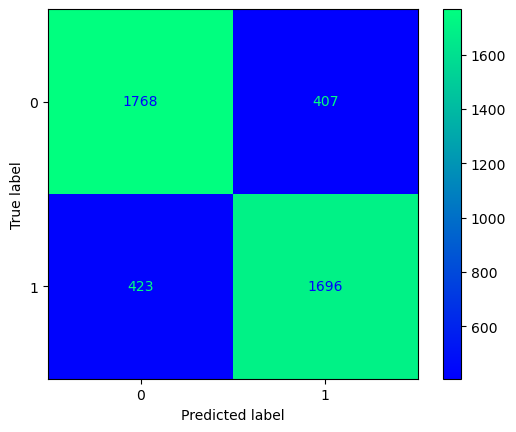

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.81      0.81      0.81      2175
           1       0.81      0.80      0.80      2119

    accuracy                           0.81      4294
   macro avg       0.81      0.81      0.81      4294
weighted avg       0.81      0.81      0.81      4294

-------------------------


In [468]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m5_15min.catboost_GridS()

In [469]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m5_15min,y_val_m5_15min)

Accuracy validación 0.6478479597540525


In [470]:
guardar_modelo(modelo_entrenado_15min,"m5_catboost_GridS_15min")

### Partidas 10 min

Hora de inicio:  12:18:12
0:	learn: 0.6792899	test: 0.6799498	best: 0.6799498 (0)	total: 3.5ms	remaining: 347ms
1:	learn: 0.6673570	test: 0.6685300	best: 0.6685300 (1)	total: 6.66ms	remaining: 326ms
2:	learn: 0.6562104	test: 0.6574124	best: 0.6574124 (2)	total: 9.69ms	remaining: 313ms
3:	learn: 0.6463607	test: 0.6476008	best: 0.6476008 (3)	total: 12.7ms	remaining: 306ms
4:	learn: 0.6370008	test: 0.6385877	best: 0.6385877 (4)	total: 15.9ms	remaining: 302ms
5:	learn: 0.6290374	test: 0.6306030	best: 0.6306030 (5)	total: 19.4ms	remaining: 304ms
6:	learn: 0.6217772	test: 0.6232499	best: 0.6232499 (6)	total: 22.6ms	remaining: 300ms
7:	learn: 0.6155478	test: 0.6172070	best: 0.6172070 (7)	total: 26ms	remaining: 299ms
8:	learn: 0.6103130	test: 0.6123064	best: 0.6123064 (8)	total: 36.3ms	remaining: 368ms
9:	learn: 0.6043567	test: 0.6066977	best: 0.6066977 (9)	total: 41.5ms	remaining: 374ms
10:	learn: 0.5992548	test: 0.6017636	best: 0.6017636 (10)	total: 44.5ms	remaining: 360ms
11:	learn: 0.59467

94:	learn: 0.5151003	test: 0.5264993	best: 0.5264993 (94)	total: 365ms	remaining: 19.2ms
95:	learn: 0.5148912	test: 0.5262895	best: 0.5262895 (95)	total: 370ms	remaining: 15.4ms
96:	learn: 0.5147515	test: 0.5261722	best: 0.5261722 (96)	total: 373ms	remaining: 11.5ms
97:	learn: 0.5145571	test: 0.5260565	best: 0.5260565 (97)	total: 377ms	remaining: 7.69ms
98:	learn: 0.5144219	test: 0.5259367	best: 0.5259367 (98)	total: 380ms	remaining: 3.84ms
99:	learn: 0.5143362	test: 0.5257999	best: 0.5257999 (99)	total: 383ms	remaining: 0us

bestTest = 0.5257999283
bestIteration = 99

0:	loss: 0.5257999	best: 0.5257999 (0)	total: 421ms	remaining: 56.4s
0:	learn: 0.6663176	test: 0.6676106	best: 0.6676106 (0)	total: 3.38ms	remaining: 335ms
1:	learn: 0.6468615	test: 0.6484419	best: 0.6484419 (1)	total: 6.64ms	remaining: 325ms
2:	learn: 0.6296273	test: 0.6317154	best: 0.6317154 (2)	total: 9.94ms	remaining: 321ms
3:	learn: 0.6159531	test: 0.6186778	best: 0.6186778 (3)	total: 14.5ms	remaining: 348ms
4:	lear

98:	learn: 0.5026193	test: 0.5202484	best: 0.5201669 (97)	total: 369ms	remaining: 3.73ms
99:	learn: 0.5024205	test: 0.5203334	best: 0.5201669 (97)	total: 374ms	remaining: 0us

bestTest = 0.5201669234
bestIteration = 97

1:	loss: 0.5201669	best: 0.5201669 (1)	total: 801ms	remaining: 53.3s
0:	learn: 0.6542395	test: 0.6561245	best: 0.6561245 (0)	total: 10.1ms	remaining: 1s
1:	learn: 0.6286447	test: 0.6308661	best: 0.6308661 (1)	total: 16.8ms	remaining: 821ms
2:	learn: 0.6065541	test: 0.6090924	best: 0.6090924 (2)	total: 21.8ms	remaining: 704ms
3:	learn: 0.5902593	test: 0.5934670	best: 0.5934670 (3)	total: 25.8ms	remaining: 620ms
4:	learn: 0.5800053	test: 0.5833423	best: 0.5833423 (4)	total: 30.3ms	remaining: 576ms
5:	learn: 0.5693604	test: 0.5734383	best: 0.5734383 (5)	total: 34.3ms	remaining: 537ms
6:	learn: 0.5612783	test: 0.5665695	best: 0.5665695 (6)	total: 38.6ms	remaining: 513ms
7:	learn: 0.5559415	test: 0.5611593	best: 0.5611593 (7)	total: 43.1ms	remaining: 495ms
8:	learn: 0.551361

7:	learn: 0.5427054	test: 0.5494478	best: 0.5494478 (7)	total: 25.6ms	remaining: 294ms
8:	learn: 0.5385773	test: 0.5459559	best: 0.5459559 (8)	total: 29.9ms	remaining: 302ms
9:	learn: 0.5352470	test: 0.5432199	best: 0.5432199 (9)	total: 34.1ms	remaining: 307ms
10:	learn: 0.5319394	test: 0.5406076	best: 0.5406076 (10)	total: 41.5ms	remaining: 336ms
11:	learn: 0.5294243	test: 0.5383142	best: 0.5383142 (11)	total: 48ms	remaining: 352ms
12:	learn: 0.5275372	test: 0.5365019	best: 0.5365019 (12)	total: 52.7ms	remaining: 353ms
13:	learn: 0.5258492	test: 0.5343113	best: 0.5343113 (13)	total: 56.2ms	remaining: 345ms
14:	learn: 0.5250259	test: 0.5334141	best: 0.5334141 (14)	total: 59.3ms	remaining: 336ms
15:	learn: 0.5234845	test: 0.5320035	best: 0.5320035 (15)	total: 62.1ms	remaining: 326ms
16:	learn: 0.5216116	test: 0.5310436	best: 0.5310436 (16)	total: 65.4ms	remaining: 319ms
17:	learn: 0.5205515	test: 0.5312593	best: 0.5310436 (16)	total: 69ms	remaining: 314ms
18:	learn: 0.5197396	test: 0.53

22:	learn: 0.5059584	test: 0.5259379	best: 0.5254781 (18)	total: 74.4ms	remaining: 249ms
23:	learn: 0.5044864	test: 0.5250963	best: 0.5250963 (23)	total: 79ms	remaining: 250ms
24:	learn: 0.5035936	test: 0.5258918	best: 0.5250963 (23)	total: 82.4ms	remaining: 247ms
25:	learn: 0.5027232	test: 0.5254051	best: 0.5250963 (23)	total: 86.4ms	remaining: 246ms
26:	learn: 0.5020643	test: 0.5258668	best: 0.5250963 (23)	total: 89.9ms	remaining: 243ms
27:	learn: 0.5013603	test: 0.5271022	best: 0.5250963 (23)	total: 94.1ms	remaining: 242ms
28:	learn: 0.5002730	test: 0.5264787	best: 0.5250963 (23)	total: 97.6ms	remaining: 239ms
29:	learn: 0.4992740	test: 0.5266196	best: 0.5250963 (23)	total: 100ms	remaining: 234ms
30:	learn: 0.4986177	test: 0.5270061	best: 0.5250963 (23)	total: 104ms	remaining: 231ms
31:	learn: 0.4980528	test: 0.5268330	best: 0.5250963 (23)	total: 107ms	remaining: 227ms
32:	learn: 0.4975166	test: 0.5273988	best: 0.5250963 (23)	total: 110ms	remaining: 224ms
33:	learn: 0.4972435	test: 

39:	learn: 0.5370209	test: 0.5443724	best: 0.5443724 (39)	total: 139ms	remaining: 208ms
40:	learn: 0.5360909	test: 0.5435362	best: 0.5435362 (40)	total: 143ms	remaining: 206ms
41:	learn: 0.5353293	test: 0.5429442	best: 0.5429442 (41)	total: 147ms	remaining: 203ms
42:	learn: 0.5344960	test: 0.5423255	best: 0.5423255 (42)	total: 151ms	remaining: 200ms
43:	learn: 0.5337956	test: 0.5417804	best: 0.5417804 (43)	total: 158ms	remaining: 201ms
44:	learn: 0.5328503	test: 0.5411148	best: 0.5411148 (44)	total: 166ms	remaining: 203ms
45:	learn: 0.5320200	test: 0.5405176	best: 0.5405176 (45)	total: 173ms	remaining: 203ms
46:	learn: 0.5314163	test: 0.5400160	best: 0.5400160 (46)	total: 176ms	remaining: 198ms
47:	learn: 0.5307204	test: 0.5393899	best: 0.5393899 (47)	total: 179ms	remaining: 194ms
48:	learn: 0.5302971	test: 0.5389564	best: 0.5389564 (48)	total: 182ms	remaining: 190ms
49:	learn: 0.5298060	test: 0.5385832	best: 0.5385832 (49)	total: 186ms	remaining: 186ms
50:	learn: 0.5293048	test: 0.538

56:	learn: 0.5105791	test: 0.5234445	best: 0.5234445 (56)	total: 199ms	remaining: 150ms
57:	learn: 0.5101691	test: 0.5235046	best: 0.5234445 (56)	total: 204ms	remaining: 148ms
58:	learn: 0.5100559	test: 0.5233643	best: 0.5233643 (58)	total: 208ms	remaining: 144ms
59:	learn: 0.5098259	test: 0.5232615	best: 0.5232615 (59)	total: 212ms	remaining: 141ms
60:	learn: 0.5095224	test: 0.5231116	best: 0.5231116 (60)	total: 218ms	remaining: 139ms
61:	learn: 0.5093478	test: 0.5228876	best: 0.5228876 (61)	total: 225ms	remaining: 138ms
62:	learn: 0.5091076	test: 0.5228227	best: 0.5228227 (62)	total: 229ms	remaining: 134ms
63:	learn: 0.5087700	test: 0.5225216	best: 0.5225216 (63)	total: 232ms	remaining: 130ms
64:	learn: 0.5086045	test: 0.5224400	best: 0.5224400 (64)	total: 235ms	remaining: 127ms
65:	learn: 0.5084289	test: 0.5225171	best: 0.5224400 (64)	total: 239ms	remaining: 123ms
66:	learn: 0.5082342	test: 0.5225644	best: 0.5224400 (64)	total: 242ms	remaining: 119ms
67:	learn: 0.5080955	test: 0.522

75:	learn: 0.5019787	test: 0.5220709	best: 0.5216245 (66)	total: 258ms	remaining: 81.4ms
76:	learn: 0.5018259	test: 0.5222232	best: 0.5216245 (66)	total: 262ms	remaining: 78.2ms
77:	learn: 0.5014573	test: 0.5223927	best: 0.5216245 (66)	total: 266ms	remaining: 74.9ms
78:	learn: 0.5009777	test: 0.5219089	best: 0.5216245 (66)	total: 270ms	remaining: 71.8ms
79:	learn: 0.5006873	test: 0.5218530	best: 0.5216245 (66)	total: 274ms	remaining: 68.5ms
80:	learn: 0.5001518	test: 0.5222353	best: 0.5216245 (66)	total: 283ms	remaining: 66.4ms
81:	learn: 0.4997653	test: 0.5220412	best: 0.5216245 (66)	total: 286ms	remaining: 62.9ms
82:	learn: 0.4994449	test: 0.5217798	best: 0.5216245 (66)	total: 290ms	remaining: 59.5ms
83:	learn: 0.4991144	test: 0.5217849	best: 0.5216245 (66)	total: 294ms	remaining: 56ms
84:	learn: 0.4988678	test: 0.5218331	best: 0.5216245 (66)	total: 297ms	remaining: 52.4ms
85:	learn: 0.4985797	test: 0.5219541	best: 0.5216245 (66)	total: 300ms	remaining: 48.8ms
86:	learn: 0.4982344	te

95:	learn: 0.4876127	test: 0.5250484	best: 0.5220157 (43)	total: 323ms	remaining: 13.5ms
96:	learn: 0.4873281	test: 0.5249774	best: 0.5220157 (43)	total: 327ms	remaining: 10.1ms
97:	learn: 0.4869670	test: 0.5250779	best: 0.5220157 (43)	total: 332ms	remaining: 6.78ms
98:	learn: 0.4867119	test: 0.5254435	best: 0.5220157 (43)	total: 336ms	remaining: 3.39ms
99:	learn: 0.4864346	test: 0.5255362	best: 0.5220157 (43)	total: 340ms	remaining: 0us

bestTest = 0.5220156761
bestIteration = 43

8:	loss: 0.5220157	best: 0.5201669 (6)	total: 3.29s	remaining: 46.1s
0:	learn: 0.5933945	test: 0.5985148	best: 0.5985148 (0)	total: 4.49ms	remaining: 445ms
1:	learn: 0.5579891	test: 0.5627756	best: 0.5627756 (1)	total: 9.11ms	remaining: 446ms
2:	learn: 0.5408445	test: 0.5484667	best: 0.5484667 (2)	total: 12.3ms	remaining: 399ms
3:	learn: 0.5343842	test: 0.5424398	best: 0.5424398 (3)	total: 16.9ms	remaining: 406ms
4:	learn: 0.5290519	test: 0.5377641	best: 0.5377641 (4)	total: 22.1ms	remaining: 421ms
5:	learn:

21:	learn: 0.5615425	test: 0.5664426	best: 0.5664426 (21)	total: 68.4ms	remaining: 243ms
22:	learn: 0.5589516	test: 0.5643998	best: 0.5643998 (22)	total: 72.6ms	remaining: 243ms
23:	learn: 0.5569831	test: 0.5627496	best: 0.5627496 (23)	total: 76.9ms	remaining: 243ms
24:	learn: 0.5552836	test: 0.5611173	best: 0.5611173 (24)	total: 82.9ms	remaining: 249ms
25:	learn: 0.5534953	test: 0.5590823	best: 0.5590823 (25)	total: 90.4ms	remaining: 257ms
26:	learn: 0.5521152	test: 0.5578540	best: 0.5578540 (26)	total: 94.5ms	remaining: 255ms
27:	learn: 0.5505527	test: 0.5562984	best: 0.5562984 (27)	total: 97.6ms	remaining: 251ms
28:	learn: 0.5487146	test: 0.5548689	best: 0.5548689 (28)	total: 101ms	remaining: 246ms
29:	learn: 0.5473577	test: 0.5534637	best: 0.5534637 (29)	total: 104ms	remaining: 242ms
30:	learn: 0.5464707	test: 0.5525417	best: 0.5525417 (30)	total: 108ms	remaining: 240ms
31:	learn: 0.5454294	test: 0.5515686	best: 0.5515686 (31)	total: 111ms	remaining: 235ms
32:	learn: 0.5444040	test

43:	learn: 0.5154868	test: 0.5265942	best: 0.5265942 (43)	total: 143ms	remaining: 182ms
44:	learn: 0.5150936	test: 0.5264064	best: 0.5264064 (44)	total: 147ms	remaining: 180ms
45:	learn: 0.5148396	test: 0.5263090	best: 0.5263090 (45)	total: 151ms	remaining: 177ms
46:	learn: 0.5145512	test: 0.5263496	best: 0.5263090 (45)	total: 155ms	remaining: 175ms
47:	learn: 0.5141761	test: 0.5259585	best: 0.5259585 (47)	total: 159ms	remaining: 172ms
48:	learn: 0.5138934	test: 0.5258480	best: 0.5258480 (48)	total: 164ms	remaining: 170ms
49:	learn: 0.5135023	test: 0.5254269	best: 0.5254269 (49)	total: 168ms	remaining: 168ms
50:	learn: 0.5128916	test: 0.5250486	best: 0.5250486 (50)	total: 172ms	remaining: 165ms
51:	learn: 0.5124742	test: 0.5248867	best: 0.5248867 (51)	total: 177ms	remaining: 164ms
52:	learn: 0.5121520	test: 0.5246998	best: 0.5246998 (52)	total: 185ms	remaining: 164ms
53:	learn: 0.5116191	test: 0.5245099	best: 0.5245099 (53)	total: 189ms	remaining: 161ms
54:	learn: 0.5113628	test: 0.524

72:	learn: 0.5028379	test: 0.5221578	best: 0.5216245 (66)	total: 233ms	remaining: 86.2ms
73:	learn: 0.5026007	test: 0.5221789	best: 0.5216245 (66)	total: 237ms	remaining: 83.3ms
74:	learn: 0.5022891	test: 0.5220417	best: 0.5216245 (66)	total: 241ms	remaining: 80.4ms
75:	learn: 0.5019787	test: 0.5220709	best: 0.5216245 (66)	total: 245ms	remaining: 77.5ms
76:	learn: 0.5018259	test: 0.5222232	best: 0.5216245 (66)	total: 249ms	remaining: 74.4ms
77:	learn: 0.5014573	test: 0.5223927	best: 0.5216245 (66)	total: 254ms	remaining: 71.5ms
78:	learn: 0.5009777	test: 0.5219089	best: 0.5216245 (66)	total: 258ms	remaining: 68.5ms
79:	learn: 0.5006873	test: 0.5218530	best: 0.5216245 (66)	total: 262ms	remaining: 65.6ms
80:	learn: 0.5001518	test: 0.5222353	best: 0.5216245 (66)	total: 266ms	remaining: 62.4ms
81:	learn: 0.4997653	test: 0.5220412	best: 0.5216245 (66)	total: 270ms	remaining: 59.3ms
82:	learn: 0.4994449	test: 0.5217798	best: 0.5216245 (66)	total: 273ms	remaining: 56ms
83:	learn: 0.4991144	te

89:	learn: 0.4891286	test: 0.5248388	best: 0.5220157 (43)	total: 310ms	remaining: 34.5ms
90:	learn: 0.4890035	test: 0.5248210	best: 0.5220157 (43)	total: 315ms	remaining: 31.1ms
91:	learn: 0.4886471	test: 0.5248586	best: 0.5220157 (43)	total: 319ms	remaining: 27.8ms
92:	learn: 0.4882999	test: 0.5249597	best: 0.5220157 (43)	total: 324ms	remaining: 24.4ms
93:	learn: 0.4880519	test: 0.5248486	best: 0.5220157 (43)	total: 329ms	remaining: 21ms
94:	learn: 0.4878298	test: 0.5247545	best: 0.5220157 (43)	total: 333ms	remaining: 17.5ms
95:	learn: 0.4876127	test: 0.5250484	best: 0.5220157 (43)	total: 337ms	remaining: 14ms
96:	learn: 0.4873281	test: 0.5249774	best: 0.5220157 (43)	total: 341ms	remaining: 10.6ms
97:	learn: 0.4869670	test: 0.5250779	best: 0.5220157 (43)	total: 345ms	remaining: 7.04ms
98:	learn: 0.4867119	test: 0.5254435	best: 0.5220157 (43)	total: 349ms	remaining: 3.53ms
99:	learn: 0.4864346	test: 0.5255362	best: 0.5220157 (43)	total: 353ms	remaining: 0us

bestTest = 0.5220156761
bes

10:	learn: 0.5992548	test: 0.6017636	best: 0.6017636 (10)	total: 34ms	remaining: 429ms
11:	learn: 0.5946732	test: 0.5975207	best: 0.5975207 (11)	total: 38.4ms	remaining: 442ms
12:	learn: 0.5901427	test: 0.5930992	best: 0.5930992 (12)	total: 42.3ms	remaining: 446ms
13:	learn: 0.5862184	test: 0.5892314	best: 0.5892314 (13)	total: 46.2ms	remaining: 449ms
14:	learn: 0.5819147	test: 0.5853168	best: 0.5853168 (14)	total: 50.5ms	remaining: 455ms
15:	learn: 0.5782857	test: 0.5822861	best: 0.5822861 (15)	total: 54.6ms	remaining: 458ms
16:	learn: 0.5751033	test: 0.5791242	best: 0.5791242 (16)	total: 59.1ms	remaining: 462ms
17:	learn: 0.5714860	test: 0.5759509	best: 0.5759509 (17)	total: 62.8ms	remaining: 461ms
18:	learn: 0.5690918	test: 0.5735536	best: 0.5735536 (18)	total: 65.9ms	remaining: 455ms
19:	learn: 0.5666191	test: 0.5710326	best: 0.5710326 (19)	total: 69.6ms	remaining: 453ms
20:	learn: 0.5637678	test: 0.5686978	best: 0.5686978 (20)	total: 73ms	remaining: 449ms
21:	learn: 0.5615425	test

133:	learn: 0.5099184	test: 0.5230059	best: 0.5230059 (133)	total: 434ms	remaining: 51.9ms
134:	learn: 0.5097790	test: 0.5229028	best: 0.5229028 (134)	total: 439ms	remaining: 48.8ms
135:	learn: 0.5096922	test: 0.5229839	best: 0.5229028 (134)	total: 445ms	remaining: 45.8ms
136:	learn: 0.5096295	test: 0.5229613	best: 0.5229028 (134)	total: 451ms	remaining: 42.8ms
137:	learn: 0.5095590	test: 0.5229049	best: 0.5229028 (134)	total: 459ms	remaining: 39.9ms
138:	learn: 0.5094326	test: 0.5228207	best: 0.5228207 (138)	total: 464ms	remaining: 36.7ms
139:	learn: 0.5092645	test: 0.5226902	best: 0.5226902 (139)	total: 467ms	remaining: 33.4ms
140:	learn: 0.5091872	test: 0.5226577	best: 0.5226577 (140)	total: 470ms	remaining: 30ms
141:	learn: 0.5089859	test: 0.5226444	best: 0.5226444 (141)	total: 473ms	remaining: 26.7ms
142:	learn: 0.5088206	test: 0.5225191	best: 0.5225191 (142)	total: 477ms	remaining: 23.3ms
143:	learn: 0.5087082	test: 0.5224493	best: 0.5224493 (143)	total: 480ms	remaining: 20ms
144

107:	learn: 0.5007306	test: 0.5196877	best: 0.5196877 (107)	total: 350ms	remaining: 136ms
108:	learn: 0.5004830	test: 0.5195957	best: 0.5195957 (108)	total: 354ms	remaining: 133ms
109:	learn: 0.5001803	test: 0.5196926	best: 0.5195957 (108)	total: 358ms	remaining: 130ms
110:	learn: 0.5000552	test: 0.5198240	best: 0.5195957 (108)	total: 362ms	remaining: 127ms
111:	learn: 0.4999093	test: 0.5197385	best: 0.5195957 (108)	total: 367ms	remaining: 124ms
112:	learn: 0.4996908	test: 0.5198922	best: 0.5195957 (108)	total: 370ms	remaining: 121ms
113:	learn: 0.4995706	test: 0.5199036	best: 0.5195957 (108)	total: 375ms	remaining: 118ms
114:	learn: 0.4992939	test: 0.5198315	best: 0.5195957 (108)	total: 379ms	remaining: 115ms
115:	learn: 0.4989986	test: 0.5196205	best: 0.5195957 (108)	total: 382ms	remaining: 112ms
116:	learn: 0.4987789	test: 0.5196005	best: 0.5195957 (108)	total: 385ms	remaining: 109ms
117:	learn: 0.4985419	test: 0.5195952	best: 0.5195952 (117)	total: 390ms	remaining: 106ms
118:	learn

81:	learn: 0.4997653	test: 0.5220412	best: 0.5216245 (66)	total: 259ms	remaining: 214ms
82:	learn: 0.4994449	test: 0.5217798	best: 0.5216245 (66)	total: 263ms	remaining: 213ms
83:	learn: 0.4991144	test: 0.5217849	best: 0.5216245 (66)	total: 267ms	remaining: 210ms
84:	learn: 0.4988678	test: 0.5218331	best: 0.5216245 (66)	total: 271ms	remaining: 207ms
85:	learn: 0.4985797	test: 0.5219541	best: 0.5216245 (66)	total: 275ms	remaining: 205ms
86:	learn: 0.4982344	test: 0.5219718	best: 0.5216245 (66)	total: 281ms	remaining: 204ms
87:	learn: 0.4981034	test: 0.5220235	best: 0.5216245 (66)	total: 286ms	remaining: 201ms
88:	learn: 0.4975688	test: 0.5219577	best: 0.5216245 (66)	total: 290ms	remaining: 199ms
89:	learn: 0.4973226	test: 0.5224759	best: 0.5216245 (66)	total: 294ms	remaining: 196ms
90:	learn: 0.4970759	test: 0.5226466	best: 0.5216245 (66)	total: 297ms	remaining: 192ms
91:	learn: 0.4965906	test: 0.5222950	best: 0.5216245 (66)	total: 300ms	remaining: 189ms
92:	learn: 0.4962980	test: 0.522

54:	learn: 0.5019856	test: 0.5228863	best: 0.5220157 (43)	total: 172ms	remaining: 297ms
55:	learn: 0.5016718	test: 0.5227917	best: 0.5220157 (43)	total: 176ms	remaining: 296ms
56:	learn: 0.5013546	test: 0.5226472	best: 0.5220157 (43)	total: 180ms	remaining: 294ms
57:	learn: 0.5009145	test: 0.5229228	best: 0.5220157 (43)	total: 186ms	remaining: 295ms
58:	learn: 0.5004138	test: 0.5229825	best: 0.5220157 (43)	total: 191ms	remaining: 294ms
59:	learn: 0.4998393	test: 0.5231562	best: 0.5220157 (43)	total: 195ms	remaining: 292ms
60:	learn: 0.4993205	test: 0.5233234	best: 0.5220157 (43)	total: 200ms	remaining: 291ms
61:	learn: 0.4988953	test: 0.5230749	best: 0.5220157 (43)	total: 203ms	remaining: 288ms
62:	learn: 0.4985267	test: 0.5231575	best: 0.5220157 (43)	total: 205ms	remaining: 283ms
63:	learn: 0.4981621	test: 0.5229337	best: 0.5220157 (43)	total: 208ms	remaining: 280ms
64:	learn: 0.4978289	test: 0.5231955	best: 0.5220157 (43)	total: 211ms	remaining: 276ms
65:	learn: 0.4972726	test: 0.523

25:	learn: 0.5027232	test: 0.5254051	best: 0.5250963 (23)	total: 78.8ms	remaining: 376ms
26:	learn: 0.5020643	test: 0.5258668	best: 0.5250963 (23)	total: 82.5ms	remaining: 376ms
27:	learn: 0.5013603	test: 0.5271022	best: 0.5250963 (23)	total: 86.9ms	remaining: 379ms
28:	learn: 0.5002730	test: 0.5264787	best: 0.5250963 (23)	total: 91.2ms	remaining: 380ms
29:	learn: 0.4992740	test: 0.5266196	best: 0.5250963 (23)	total: 94.9ms	remaining: 380ms
30:	learn: 0.4986177	test: 0.5270061	best: 0.5250963 (23)	total: 99.1ms	remaining: 380ms
31:	learn: 0.4980528	test: 0.5268330	best: 0.5250963 (23)	total: 107ms	remaining: 396ms
32:	learn: 0.4975166	test: 0.5273988	best: 0.5250963 (23)	total: 111ms	remaining: 392ms
33:	learn: 0.4972435	test: 0.5289817	best: 0.5250963 (23)	total: 114ms	remaining: 388ms
34:	learn: 0.4966539	test: 0.5285278	best: 0.5250963 (23)	total: 117ms	remaining: 383ms
35:	learn: 0.4959837	test: 0.5285352	best: 0.5250963 (23)	total: 120ms	remaining: 381ms
36:	learn: 0.4953999	test:

0:	learn: 0.6792899	test: 0.6799498	best: 0.6799498 (0)	total: 4.59ms	remaining: 685ms
1:	learn: 0.6673570	test: 0.6685300	best: 0.6685300 (1)	total: 8.74ms	remaining: 647ms
2:	learn: 0.6562104	test: 0.6574124	best: 0.6574124 (2)	total: 12.7ms	remaining: 620ms
3:	learn: 0.6463607	test: 0.6476008	best: 0.6476008 (3)	total: 21.4ms	remaining: 780ms
4:	learn: 0.6370008	test: 0.6385877	best: 0.6385877 (4)	total: 29.8ms	remaining: 864ms
5:	learn: 0.6290374	test: 0.6306030	best: 0.6306030 (5)	total: 32.9ms	remaining: 790ms
6:	learn: 0.6217772	test: 0.6232499	best: 0.6232499 (6)	total: 36.5ms	remaining: 745ms
7:	learn: 0.6155478	test: 0.6172070	best: 0.6172070 (7)	total: 39.5ms	remaining: 702ms
8:	learn: 0.6103130	test: 0.6123064	best: 0.6123064 (8)	total: 42.5ms	remaining: 665ms
9:	learn: 0.6043567	test: 0.6066977	best: 0.6066977 (9)	total: 45.5ms	remaining: 637ms
10:	learn: 0.5992548	test: 0.6017636	best: 0.6017636 (10)	total: 48.5ms	remaining: 613ms
11:	learn: 0.5946732	test: 0.5975207	best

130:	learn: 0.5102368	test: 0.5231262	best: 0.5231262 (130)	total: 433ms	remaining: 62.8ms
131:	learn: 0.5101977	test: 0.5231113	best: 0.5231113 (131)	total: 437ms	remaining: 59.6ms
132:	learn: 0.5100249	test: 0.5230344	best: 0.5230344 (132)	total: 441ms	remaining: 56.4ms
133:	learn: 0.5099184	test: 0.5230059	best: 0.5230059 (133)	total: 445ms	remaining: 53.1ms
134:	learn: 0.5097790	test: 0.5229028	best: 0.5229028 (134)	total: 454ms	remaining: 50.4ms
135:	learn: 0.5096922	test: 0.5229839	best: 0.5229028 (134)	total: 464ms	remaining: 47.8ms
136:	learn: 0.5096295	test: 0.5229613	best: 0.5229028 (134)	total: 468ms	remaining: 44.4ms
137:	learn: 0.5095590	test: 0.5229049	best: 0.5229028 (134)	total: 471ms	remaining: 41ms
138:	learn: 0.5094326	test: 0.5228207	best: 0.5228207 (138)	total: 475ms	remaining: 37.6ms
139:	learn: 0.5092645	test: 0.5226902	best: 0.5226902 (139)	total: 478ms	remaining: 34.2ms
140:	learn: 0.5091872	test: 0.5226577	best: 0.5226577 (140)	total: 481ms	remaining: 30.7ms
1

100:	learn: 0.5022467	test: 0.5203658	best: 0.5201669 (97)	total: 323ms	remaining: 157ms
101:	learn: 0.5019409	test: 0.5201361	best: 0.5201361 (101)	total: 327ms	remaining: 154ms
102:	learn: 0.5017904	test: 0.5201087	best: 0.5201087 (102)	total: 331ms	remaining: 151ms
103:	learn: 0.5016124	test: 0.5200256	best: 0.5200256 (103)	total: 335ms	remaining: 148ms
104:	learn: 0.5013282	test: 0.5200757	best: 0.5200256 (103)	total: 345ms	remaining: 148ms
105:	learn: 0.5011419	test: 0.5200485	best: 0.5200256 (103)	total: 349ms	remaining: 145ms
106:	learn: 0.5009555	test: 0.5199713	best: 0.5199713 (106)	total: 352ms	remaining: 141ms
107:	learn: 0.5007306	test: 0.5196877	best: 0.5196877 (107)	total: 355ms	remaining: 138ms
108:	learn: 0.5004830	test: 0.5195957	best: 0.5195957 (108)	total: 358ms	remaining: 135ms
109:	learn: 0.5001803	test: 0.5196926	best: 0.5195957 (108)	total: 361ms	remaining: 131ms
110:	learn: 0.5000552	test: 0.5198240	best: 0.5195957 (108)	total: 364ms	remaining: 128ms
111:	learn:

77:	learn: 0.5014573	test: 0.5223927	best: 0.5216245 (66)	total: 247ms	remaining: 228ms
78:	learn: 0.5009777	test: 0.5219089	best: 0.5216245 (66)	total: 252ms	remaining: 226ms
79:	learn: 0.5006873	test: 0.5218530	best: 0.5216245 (66)	total: 256ms	remaining: 224ms
80:	learn: 0.5001518	test: 0.5222353	best: 0.5216245 (66)	total: 260ms	remaining: 221ms
81:	learn: 0.4997653	test: 0.5220412	best: 0.5216245 (66)	total: 264ms	remaining: 219ms
82:	learn: 0.4994449	test: 0.5217798	best: 0.5216245 (66)	total: 269ms	remaining: 217ms
83:	learn: 0.4991144	test: 0.5217849	best: 0.5216245 (66)	total: 272ms	remaining: 214ms
84:	learn: 0.4988678	test: 0.5218331	best: 0.5216245 (66)	total: 277ms	remaining: 212ms
85:	learn: 0.4985797	test: 0.5219541	best: 0.5216245 (66)	total: 280ms	remaining: 208ms
86:	learn: 0.4982344	test: 0.5219718	best: 0.5216245 (66)	total: 283ms	remaining: 205ms
87:	learn: 0.4981034	test: 0.5220235	best: 0.5216245 (66)	total: 286ms	remaining: 202ms
88:	learn: 0.4975688	test: 0.521

50:	learn: 0.5033859	test: 0.5230484	best: 0.5220157 (43)	total: 159ms	remaining: 310ms
51:	learn: 0.5029835	test: 0.5230100	best: 0.5220157 (43)	total: 164ms	remaining: 308ms
52:	learn: 0.5026878	test: 0.5229144	best: 0.5220157 (43)	total: 167ms	remaining: 306ms
53:	learn: 0.5022878	test: 0.5227584	best: 0.5220157 (43)	total: 172ms	remaining: 306ms
54:	learn: 0.5019856	test: 0.5228863	best: 0.5220157 (43)	total: 176ms	remaining: 304ms
55:	learn: 0.5016718	test: 0.5227917	best: 0.5220157 (43)	total: 183ms	remaining: 307ms
56:	learn: 0.5013546	test: 0.5226472	best: 0.5220157 (43)	total: 188ms	remaining: 307ms
57:	learn: 0.5009145	test: 0.5229228	best: 0.5220157 (43)	total: 191ms	remaining: 303ms
58:	learn: 0.5004138	test: 0.5229825	best: 0.5220157 (43)	total: 194ms	remaining: 300ms
59:	learn: 0.4998393	test: 0.5231562	best: 0.5220157 (43)	total: 198ms	remaining: 296ms
60:	learn: 0.4993205	test: 0.5233234	best: 0.5220157 (43)	total: 201ms	remaining: 293ms
61:	learn: 0.4988953	test: 0.523

32:	learn: 0.4975166	test: 0.5273988	best: 0.5250963 (23)	total: 101ms	remaining: 357ms
33:	learn: 0.4972435	test: 0.5289817	best: 0.5250963 (23)	total: 105ms	remaining: 359ms
34:	learn: 0.4966539	test: 0.5285278	best: 0.5250963 (23)	total: 109ms	remaining: 358ms
35:	learn: 0.4959837	test: 0.5285352	best: 0.5250963 (23)	total: 113ms	remaining: 358ms
36:	learn: 0.4953999	test: 0.5287721	best: 0.5250963 (23)	total: 123ms	remaining: 375ms
37:	learn: 0.4947600	test: 0.5288131	best: 0.5250963 (23)	total: 131ms	remaining: 385ms
38:	learn: 0.4941631	test: 0.5284994	best: 0.5250963 (23)	total: 134ms	remaining: 381ms
39:	learn: 0.4938469	test: 0.5284194	best: 0.5250963 (23)	total: 137ms	remaining: 376ms
40:	learn: 0.4929787	test: 0.5294540	best: 0.5250963 (23)	total: 140ms	remaining: 371ms
41:	learn: 0.4925348	test: 0.5291121	best: 0.5250963 (23)	total: 143ms	remaining: 367ms
42:	learn: 0.4919740	test: 0.5291857	best: 0.5250963 (23)	total: 146ms	remaining: 362ms
43:	learn: 0.4916595	test: 0.529

8:	learn: 0.6103130	test: 0.6123064	best: 0.6123064 (8)	total: 28.2ms	remaining: 442ms
9:	learn: 0.6043567	test: 0.6066977	best: 0.6066977 (9)	total: 33.6ms	remaining: 471ms
10:	learn: 0.5992548	test: 0.6017636	best: 0.6017636 (10)	total: 42.1ms	remaining: 532ms
11:	learn: 0.5946732	test: 0.5975207	best: 0.5975207 (11)	total: 50.8ms	remaining: 585ms
12:	learn: 0.5901427	test: 0.5930992	best: 0.5930992 (12)	total: 60.1ms	remaining: 633ms
13:	learn: 0.5862184	test: 0.5892314	best: 0.5892314 (13)	total: 65.4ms	remaining: 636ms
14:	learn: 0.5819147	test: 0.5853168	best: 0.5853168 (14)	total: 68.7ms	remaining: 618ms
15:	learn: 0.5782857	test: 0.5822861	best: 0.5822861 (15)	total: 71.8ms	remaining: 601ms
16:	learn: 0.5751033	test: 0.5791242	best: 0.5791242 (16)	total: 74.9ms	remaining: 586ms
17:	learn: 0.5714860	test: 0.5759509	best: 0.5759509 (17)	total: 78ms	remaining: 572ms
18:	learn: 0.5690918	test: 0.5735536	best: 0.5735536 (18)	total: 81.3ms	remaining: 561ms
19:	learn: 0.5666191	test: 

127:	learn: 0.5105139	test: 0.5232510	best: 0.5232510 (127)	total: 431ms	remaining: 74ms
128:	learn: 0.5104338	test: 0.5232061	best: 0.5232061 (128)	total: 435ms	remaining: 70.8ms
129:	learn: 0.5103439	test: 0.5232013	best: 0.5232013 (129)	total: 439ms	remaining: 67.5ms
130:	learn: 0.5102368	test: 0.5231262	best: 0.5231262 (130)	total: 444ms	remaining: 64.5ms
131:	learn: 0.5101977	test: 0.5231113	best: 0.5231113 (131)	total: 452ms	remaining: 61.7ms
132:	learn: 0.5100249	test: 0.5230344	best: 0.5230344 (132)	total: 457ms	remaining: 58.5ms
133:	learn: 0.5099184	test: 0.5230059	best: 0.5230059 (133)	total: 461ms	remaining: 55ms
134:	learn: 0.5097790	test: 0.5229028	best: 0.5229028 (134)	total: 464ms	remaining: 51.6ms
135:	learn: 0.5096922	test: 0.5229839	best: 0.5229028 (134)	total: 468ms	remaining: 48.1ms
136:	learn: 0.5096295	test: 0.5229613	best: 0.5229028 (134)	total: 472ms	remaining: 44.8ms
137:	learn: 0.5095590	test: 0.5229049	best: 0.5229028 (134)	total: 476ms	remaining: 41.4ms
138

100:	learn: 0.5022467	test: 0.5203658	best: 0.5201669 (97)	total: 330ms	remaining: 160ms
101:	learn: 0.5019409	test: 0.5201361	best: 0.5201361 (101)	total: 334ms	remaining: 157ms
102:	learn: 0.5017904	test: 0.5201087	best: 0.5201087 (102)	total: 338ms	remaining: 154ms
103:	learn: 0.5016124	test: 0.5200256	best: 0.5200256 (103)	total: 341ms	remaining: 151ms
104:	learn: 0.5013282	test: 0.5200757	best: 0.5200256 (103)	total: 345ms	remaining: 148ms
105:	learn: 0.5011419	test: 0.5200485	best: 0.5200256 (103)	total: 350ms	remaining: 145ms
106:	learn: 0.5009555	test: 0.5199713	best: 0.5199713 (106)	total: 354ms	remaining: 142ms
107:	learn: 0.5007306	test: 0.5196877	best: 0.5196877 (107)	total: 358ms	remaining: 139ms
108:	learn: 0.5004830	test: 0.5195957	best: 0.5195957 (108)	total: 362ms	remaining: 136ms
109:	learn: 0.5001803	test: 0.5196926	best: 0.5195957 (108)	total: 365ms	remaining: 133ms
110:	learn: 0.5000552	test: 0.5198240	best: 0.5195957 (108)	total: 368ms	remaining: 129ms
111:	learn:

73:	learn: 0.5026007	test: 0.5221789	best: 0.5216245 (66)	total: 243ms	remaining: 250ms
74:	learn: 0.5022891	test: 0.5220417	best: 0.5216245 (66)	total: 248ms	remaining: 248ms
75:	learn: 0.5019787	test: 0.5220709	best: 0.5216245 (66)	total: 252ms	remaining: 246ms
76:	learn: 0.5018259	test: 0.5222232	best: 0.5216245 (66)	total: 256ms	remaining: 243ms
77:	learn: 0.5014573	test: 0.5223927	best: 0.5216245 (66)	total: 260ms	remaining: 240ms
78:	learn: 0.5009777	test: 0.5219089	best: 0.5216245 (66)	total: 264ms	remaining: 238ms
79:	learn: 0.5006873	test: 0.5218530	best: 0.5216245 (66)	total: 269ms	remaining: 235ms
80:	learn: 0.5001518	test: 0.5222353	best: 0.5216245 (66)	total: 273ms	remaining: 232ms
81:	learn: 0.4997653	test: 0.5220412	best: 0.5216245 (66)	total: 276ms	remaining: 229ms
82:	learn: 0.4994449	test: 0.5217798	best: 0.5216245 (66)	total: 280ms	remaining: 226ms
83:	learn: 0.4991144	test: 0.5217849	best: 0.5216245 (66)	total: 283ms	remaining: 222ms
84:	learn: 0.4988678	test: 0.521

47:	learn: 0.5046505	test: 0.5224427	best: 0.5220157 (43)	total: 149ms	remaining: 317ms
48:	learn: 0.5043452	test: 0.5225552	best: 0.5220157 (43)	total: 154ms	remaining: 317ms
49:	learn: 0.5039942	test: 0.5224890	best: 0.5220157 (43)	total: 158ms	remaining: 316ms
50:	learn: 0.5033859	test: 0.5230484	best: 0.5220157 (43)	total: 162ms	remaining: 315ms
51:	learn: 0.5029835	test: 0.5230100	best: 0.5220157 (43)	total: 171ms	remaining: 322ms
52:	learn: 0.5026878	test: 0.5229144	best: 0.5220157 (43)	total: 178ms	remaining: 326ms
53:	learn: 0.5022878	test: 0.5227584	best: 0.5220157 (43)	total: 182ms	remaining: 323ms
54:	learn: 0.5019856	test: 0.5228863	best: 0.5220157 (43)	total: 184ms	remaining: 319ms
55:	learn: 0.5016718	test: 0.5227917	best: 0.5220157 (43)	total: 188ms	remaining: 315ms
56:	learn: 0.5013546	test: 0.5226472	best: 0.5220157 (43)	total: 191ms	remaining: 311ms
57:	learn: 0.5009145	test: 0.5229228	best: 0.5220157 (43)	total: 194ms	remaining: 308ms
58:	learn: 0.5004138	test: 0.522

25:	learn: 0.5027232	test: 0.5254051	best: 0.5250963 (23)	total: 79.7ms	remaining: 380ms
26:	learn: 0.5020643	test: 0.5258668	best: 0.5250963 (23)	total: 83.6ms	remaining: 381ms
27:	learn: 0.5013603	test: 0.5271022	best: 0.5250963 (23)	total: 87.8ms	remaining: 383ms
28:	learn: 0.5002730	test: 0.5264787	best: 0.5250963 (23)	total: 91.5ms	remaining: 382ms
29:	learn: 0.4992740	test: 0.5266196	best: 0.5250963 (23)	total: 95.3ms	remaining: 381ms
30:	learn: 0.4986177	test: 0.5270061	best: 0.5250963 (23)	total: 99.2ms	remaining: 381ms
31:	learn: 0.4980528	test: 0.5268330	best: 0.5250963 (23)	total: 103ms	remaining: 382ms
32:	learn: 0.4975166	test: 0.5273988	best: 0.5250963 (23)	total: 108ms	remaining: 382ms
33:	learn: 0.4972435	test: 0.5289817	best: 0.5250963 (23)	total: 116ms	remaining: 395ms
34:	learn: 0.4966539	test: 0.5285278	best: 0.5250963 (23)	total: 119ms	remaining: 393ms
35:	learn: 0.4959837	test: 0.5285352	best: 0.5250963 (23)	total: 123ms	remaining: 389ms
36:	learn: 0.4953999	test:

0:	learn: 0.6792899	test: 0.6799498	best: 0.6799498 (0)	total: 5.16ms	remaining: 1.03s
1:	learn: 0.6673570	test: 0.6685300	best: 0.6685300 (1)	total: 9.22ms	remaining: 913ms
2:	learn: 0.6562104	test: 0.6574124	best: 0.6574124 (2)	total: 13.4ms	remaining: 878ms
3:	learn: 0.6463607	test: 0.6476008	best: 0.6476008 (3)	total: 19.4ms	remaining: 949ms
4:	learn: 0.6370008	test: 0.6385877	best: 0.6385877 (4)	total: 27.4ms	remaining: 1.07s
5:	learn: 0.6290374	test: 0.6306030	best: 0.6306030 (5)	total: 30.6ms	remaining: 989ms
6:	learn: 0.6217772	test: 0.6232499	best: 0.6232499 (6)	total: 34ms	remaining: 937ms
7:	learn: 0.6155478	test: 0.6172070	best: 0.6172070 (7)	total: 37.1ms	remaining: 889ms
8:	learn: 0.6103130	test: 0.6123064	best: 0.6123064 (8)	total: 40ms	remaining: 849ms
9:	learn: 0.6043567	test: 0.6066977	best: 0.6066977 (9)	total: 43ms	remaining: 817ms
10:	learn: 0.5992548	test: 0.6017636	best: 0.6017636 (10)	total: 46ms	remaining: 790ms
11:	learn: 0.5946732	test: 0.5975207	best: 0.5975

128:	learn: 0.5104338	test: 0.5232061	best: 0.5232061 (128)	total: 417ms	remaining: 230ms
129:	learn: 0.5103439	test: 0.5232013	best: 0.5232013 (129)	total: 422ms	remaining: 227ms
130:	learn: 0.5102368	test: 0.5231262	best: 0.5231262 (130)	total: 426ms	remaining: 224ms
131:	learn: 0.5101977	test: 0.5231113	best: 0.5231113 (131)	total: 429ms	remaining: 221ms
132:	learn: 0.5100249	test: 0.5230344	best: 0.5230344 (132)	total: 434ms	remaining: 218ms
133:	learn: 0.5099184	test: 0.5230059	best: 0.5230059 (133)	total: 439ms	remaining: 216ms
134:	learn: 0.5097790	test: 0.5229028	best: 0.5229028 (134)	total: 446ms	remaining: 215ms
135:	learn: 0.5096922	test: 0.5229839	best: 0.5229028 (134)	total: 449ms	remaining: 211ms
136:	learn: 0.5096295	test: 0.5229613	best: 0.5229028 (134)	total: 452ms	remaining: 208ms
137:	learn: 0.5095590	test: 0.5229049	best: 0.5229028 (134)	total: 455ms	remaining: 204ms
138:	learn: 0.5094326	test: 0.5228207	best: 0.5228207 (138)	total: 458ms	remaining: 201ms
139:	learn

45:	learn: 0.5148396	test: 0.5263090	best: 0.5263090 (45)	total: 145ms	remaining: 487ms
46:	learn: 0.5145512	test: 0.5263496	best: 0.5263090 (45)	total: 150ms	remaining: 488ms
47:	learn: 0.5141761	test: 0.5259585	best: 0.5259585 (47)	total: 154ms	remaining: 486ms
48:	learn: 0.5138934	test: 0.5258480	best: 0.5258480 (48)	total: 158ms	remaining: 486ms
49:	learn: 0.5135023	test: 0.5254269	best: 0.5254269 (49)	total: 162ms	remaining: 485ms
50:	learn: 0.5128916	test: 0.5250486	best: 0.5250486 (50)	total: 166ms	remaining: 484ms
51:	learn: 0.5124742	test: 0.5248867	best: 0.5248867 (51)	total: 170ms	remaining: 484ms
52:	learn: 0.5121520	test: 0.5246998	best: 0.5246998 (52)	total: 174ms	remaining: 482ms
53:	learn: 0.5116191	test: 0.5245099	best: 0.5245099 (53)	total: 177ms	remaining: 479ms
54:	learn: 0.5113628	test: 0.5243027	best: 0.5243027 (54)	total: 181ms	remaining: 478ms
55:	learn: 0.5107953	test: 0.5236005	best: 0.5236005 (55)	total: 185ms	remaining: 475ms
56:	learn: 0.5105791	test: 0.523

160:	learn: 0.4903867	test: 0.5206485	best: 0.5194837 (118)	total: 545ms	remaining: 132ms
161:	learn: 0.4902271	test: 0.5206338	best: 0.5194837 (118)	total: 549ms	remaining: 129ms
162:	learn: 0.4900640	test: 0.5206190	best: 0.5194837 (118)	total: 556ms	remaining: 126ms
163:	learn: 0.4899467	test: 0.5207434	best: 0.5194837 (118)	total: 560ms	remaining: 123ms
164:	learn: 0.4898141	test: 0.5207923	best: 0.5194837 (118)	total: 569ms	remaining: 121ms
165:	learn: 0.4896453	test: 0.5207348	best: 0.5194837 (118)	total: 575ms	remaining: 118ms
166:	learn: 0.4895073	test: 0.5207296	best: 0.5194837 (118)	total: 578ms	remaining: 114ms
167:	learn: 0.4893648	test: 0.5208458	best: 0.5194837 (118)	total: 582ms	remaining: 111ms
168:	learn: 0.4892275	test: 0.5207937	best: 0.5194837 (118)	total: 585ms	remaining: 107ms
169:	learn: 0.4891372	test: 0.5208078	best: 0.5194837 (118)	total: 588ms	remaining: 104ms
170:	learn: 0.4888049	test: 0.5210106	best: 0.5194837 (118)	total: 591ms	remaining: 100ms
171:	learn

66:	learn: 0.5044221	test: 0.5216245	best: 0.5216245 (66)	total: 264ms	remaining: 523ms
67:	learn: 0.5041512	test: 0.5221694	best: 0.5216245 (66)	total: 274ms	remaining: 532ms
68:	learn: 0.5039095	test: 0.5221812	best: 0.5216245 (66)	total: 284ms	remaining: 539ms
69:	learn: 0.5035811	test: 0.5219581	best: 0.5216245 (66)	total: 294ms	remaining: 545ms
70:	learn: 0.5033766	test: 0.5219603	best: 0.5216245 (66)	total: 299ms	remaining: 544ms
71:	learn: 0.5031028	test: 0.5220589	best: 0.5216245 (66)	total: 303ms	remaining: 538ms
72:	learn: 0.5028379	test: 0.5221578	best: 0.5216245 (66)	total: 306ms	remaining: 532ms
73:	learn: 0.5026007	test: 0.5221789	best: 0.5216245 (66)	total: 309ms	remaining: 526ms
74:	learn: 0.5022891	test: 0.5220417	best: 0.5216245 (66)	total: 312ms	remaining: 520ms
75:	learn: 0.5019787	test: 0.5220709	best: 0.5216245 (66)	total: 315ms	remaining: 514ms
76:	learn: 0.5018259	test: 0.5222232	best: 0.5216245 (66)	total: 318ms	remaining: 508ms
77:	learn: 0.5014573	test: 0.522

13:	learn: 0.5258492	test: 0.5343113	best: 0.5343113 (13)	total: 45.1ms	remaining: 599ms
14:	learn: 0.5250259	test: 0.5334141	best: 0.5334141 (14)	total: 49.4ms	remaining: 609ms
15:	learn: 0.5234845	test: 0.5320035	best: 0.5320035 (15)	total: 53ms	remaining: 610ms
16:	learn: 0.5216116	test: 0.5310436	best: 0.5310436 (16)	total: 57.7ms	remaining: 621ms
17:	learn: 0.5205515	test: 0.5312593	best: 0.5310436 (16)	total: 62ms	remaining: 627ms
18:	learn: 0.5197396	test: 0.5304259	best: 0.5304259 (18)	total: 66.3ms	remaining: 631ms
19:	learn: 0.5188141	test: 0.5300646	best: 0.5300646 (19)	total: 70.7ms	remaining: 636ms
20:	learn: 0.5180507	test: 0.5301788	best: 0.5300646 (19)	total: 76.8ms	remaining: 654ms
21:	learn: 0.5173465	test: 0.5294560	best: 0.5294560 (21)	total: 80.5ms	remaining: 651ms
22:	learn: 0.5167397	test: 0.5289575	best: 0.5289575 (22)	total: 83.3ms	remaining: 641ms
23:	learn: 0.5159469	test: 0.5280781	best: 0.5280781 (23)	total: 86.2ms	remaining: 632ms
24:	learn: 0.5150469	test

144:	learn: 0.4742597	test: 0.5309050	best: 0.5220157 (43)	total: 465ms	remaining: 176ms
145:	learn: 0.4739515	test: 0.5312242	best: 0.5220157 (43)	total: 469ms	remaining: 174ms
146:	learn: 0.4737484	test: 0.5322706	best: 0.5220157 (43)	total: 473ms	remaining: 171ms
147:	learn: 0.4736359	test: 0.5322656	best: 0.5220157 (43)	total: 478ms	remaining: 168ms
148:	learn: 0.4734387	test: 0.5325389	best: 0.5220157 (43)	total: 481ms	remaining: 165ms
149:	learn: 0.4731332	test: 0.5326257	best: 0.5220157 (43)	total: 485ms	remaining: 162ms
150:	learn: 0.4728937	test: 0.5327088	best: 0.5220157 (43)	total: 492ms	remaining: 160ms
151:	learn: 0.4727823	test: 0.5328043	best: 0.5220157 (43)	total: 497ms	remaining: 157ms
152:	learn: 0.4724983	test: 0.5336866	best: 0.5220157 (43)	total: 500ms	remaining: 154ms
153:	learn: 0.4721895	test: 0.5336325	best: 0.5220157 (43)	total: 503ms	remaining: 150ms
154:	learn: 0.4720436	test: 0.5336640	best: 0.5220157 (43)	total: 506ms	remaining: 147ms
155:	learn: 0.4718779

67:	learn: 0.4778160	test: 0.5421362	best: 0.5250963 (23)	total: 230ms	remaining: 446ms
68:	learn: 0.4773257	test: 0.5425798	best: 0.5250963 (23)	total: 234ms	remaining: 444ms
69:	learn: 0.4770461	test: 0.5433675	best: 0.5250963 (23)	total: 238ms	remaining: 442ms
70:	learn: 0.4764647	test: 0.5430771	best: 0.5250963 (23)	total: 242ms	remaining: 439ms
71:	learn: 0.4758719	test: 0.5432505	best: 0.5250963 (23)	total: 246ms	remaining: 437ms
72:	learn: 0.4753082	test: 0.5432254	best: 0.5250963 (23)	total: 254ms	remaining: 442ms
73:	learn: 0.4746640	test: 0.5430880	best: 0.5250963 (23)	total: 258ms	remaining: 440ms
74:	learn: 0.4740479	test: 0.5432955	best: 0.5250963 (23)	total: 261ms	remaining: 435ms
75:	learn: 0.4735644	test: 0.5431052	best: 0.5250963 (23)	total: 264ms	remaining: 431ms
76:	learn: 0.4733343	test: 0.5430237	best: 0.5250963 (23)	total: 268ms	remaining: 428ms
77:	learn: 0.4730498	test: 0.5433526	best: 0.5250963 (23)	total: 271ms	remaining: 423ms
78:	learn: 0.4724314	test: 0.543

195:	learn: 0.4239501	test: 0.5725258	best: 0.5250963 (23)	total: 633ms	remaining: 12.9ms
196:	learn: 0.4235497	test: 0.5725269	best: 0.5250963 (23)	total: 637ms	remaining: 9.7ms
197:	learn: 0.4232381	test: 0.5725328	best: 0.5250963 (23)	total: 641ms	remaining: 6.47ms
198:	learn: 0.4228955	test: 0.5730150	best: 0.5250963 (23)	total: 648ms	remaining: 3.26ms
199:	learn: 0.4225409	test: 0.5732076	best: 0.5250963 (23)	total: 657ms	remaining: 0us

bestTest = 0.5250963284
bestIteration = 23

34:	loss: 0.5250963	best: 0.5194837 (16)	total: 16.4s	remaining: 46.8s
0:	learn: 0.6792899	test: 0.6799498	best: 0.6799498 (0)	total: 3.63ms	remaining: 723ms
1:	learn: 0.6673570	test: 0.6685300	best: 0.6685300 (1)	total: 6.71ms	remaining: 665ms
2:	learn: 0.6562104	test: 0.6574124	best: 0.6574124 (2)	total: 9.7ms	remaining: 637ms
3:	learn: 0.6463607	test: 0.6476008	best: 0.6476008 (3)	total: 12.7ms	remaining: 624ms
4:	learn: 0.6370008	test: 0.6385877	best: 0.6385877 (4)	total: 15.8ms	remaining: 618ms
5:	l

115:	learn: 0.5118920	test: 0.5242680	best: 0.5242680 (115)	total: 382ms	remaining: 276ms
116:	learn: 0.5117845	test: 0.5241646	best: 0.5241646 (116)	total: 385ms	remaining: 273ms
117:	learn: 0.5116985	test: 0.5241128	best: 0.5241128 (117)	total: 390ms	remaining: 271ms
118:	learn: 0.5116237	test: 0.5240853	best: 0.5240853 (118)	total: 394ms	remaining: 268ms
119:	learn: 0.5115280	test: 0.5240068	best: 0.5240068 (119)	total: 403ms	remaining: 269ms
120:	learn: 0.5113998	test: 0.5239135	best: 0.5239135 (120)	total: 410ms	remaining: 268ms
121:	learn: 0.5112856	test: 0.5238906	best: 0.5238906 (121)	total: 416ms	remaining: 266ms
122:	learn: 0.5111757	test: 0.5237931	best: 0.5237931 (122)	total: 419ms	remaining: 262ms
123:	learn: 0.5110449	test: 0.5237105	best: 0.5237105 (123)	total: 422ms	remaining: 259ms
124:	learn: 0.5108538	test: 0.5235359	best: 0.5235359 (124)	total: 425ms	remaining: 255ms
125:	learn: 0.5107361	test: 0.5234402	best: 0.5234402 (125)	total: 429ms	remaining: 252ms
126:	learn

35:	learn: 0.5199780	test: 0.5300145	best: 0.5300145 (35)	total: 115ms	remaining: 523ms
36:	learn: 0.5193457	test: 0.5294562	best: 0.5294562 (36)	total: 119ms	remaining: 524ms
37:	learn: 0.5185846	test: 0.5289163	best: 0.5289163 (37)	total: 123ms	remaining: 524ms
38:	learn: 0.5179457	test: 0.5284646	best: 0.5284646 (38)	total: 129ms	remaining: 535ms
39:	learn: 0.5171719	test: 0.5281552	best: 0.5281552 (39)	total: 137ms	remaining: 547ms
40:	learn: 0.5167065	test: 0.5277801	best: 0.5277801 (40)	total: 142ms	remaining: 553ms
41:	learn: 0.5162861	test: 0.5271770	best: 0.5271770 (41)	total: 145ms	remaining: 547ms
42:	learn: 0.5159582	test: 0.5268830	best: 0.5268830 (42)	total: 148ms	remaining: 541ms
43:	learn: 0.5154868	test: 0.5265942	best: 0.5265942 (43)	total: 151ms	remaining: 536ms
44:	learn: 0.5150936	test: 0.5264064	best: 0.5264064 (44)	total: 154ms	remaining: 532ms
45:	learn: 0.5148396	test: 0.5263090	best: 0.5263090 (45)	total: 157ms	remaining: 527ms
46:	learn: 0.5145512	test: 0.526

158:	learn: 0.4906428	test: 0.5206149	best: 0.5194837 (118)	total: 516ms	remaining: 133ms
159:	learn: 0.4905144	test: 0.5205731	best: 0.5194837 (118)	total: 521ms	remaining: 130ms
160:	learn: 0.4903867	test: 0.5206485	best: 0.5194837 (118)	total: 524ms	remaining: 127ms
161:	learn: 0.4902271	test: 0.5206338	best: 0.5194837 (118)	total: 531ms	remaining: 125ms
162:	learn: 0.4900640	test: 0.5206190	best: 0.5194837 (118)	total: 535ms	remaining: 122ms
163:	learn: 0.4899467	test: 0.5207434	best: 0.5194837 (118)	total: 540ms	remaining: 118ms
164:	learn: 0.4898141	test: 0.5207923	best: 0.5194837 (118)	total: 544ms	remaining: 115ms
165:	learn: 0.4896453	test: 0.5207348	best: 0.5194837 (118)	total: 548ms	remaining: 112ms
166:	learn: 0.4895073	test: 0.5207296	best: 0.5194837 (118)	total: 552ms	remaining: 109ms
167:	learn: 0.4893648	test: 0.5208458	best: 0.5194837 (118)	total: 555ms	remaining: 106ms
168:	learn: 0.4892275	test: 0.5207937	best: 0.5194837 (118)	total: 558ms	remaining: 102ms
169:	learn

83:	learn: 0.4991144	test: 0.5217849	best: 0.5216245 (66)	total: 274ms	remaining: 379ms
84:	learn: 0.4988678	test: 0.5218331	best: 0.5216245 (66)	total: 279ms	remaining: 377ms
85:	learn: 0.4985797	test: 0.5219541	best: 0.5216245 (66)	total: 283ms	remaining: 375ms
86:	learn: 0.4982344	test: 0.5219718	best: 0.5216245 (66)	total: 287ms	remaining: 372ms
87:	learn: 0.4981034	test: 0.5220235	best: 0.5216245 (66)	total: 291ms	remaining: 370ms
88:	learn: 0.4975688	test: 0.5219577	best: 0.5216245 (66)	total: 295ms	remaining: 368ms
89:	learn: 0.4973226	test: 0.5224759	best: 0.5216245 (66)	total: 299ms	remaining: 366ms
90:	learn: 0.4970759	test: 0.5226466	best: 0.5216245 (66)	total: 303ms	remaining: 363ms
91:	learn: 0.4965906	test: 0.5222950	best: 0.5216245 (66)	total: 307ms	remaining: 360ms
92:	learn: 0.4962980	test: 0.5220605	best: 0.5216245 (66)	total: 310ms	remaining: 357ms
93:	learn: 0.4960815	test: 0.5221905	best: 0.5216245 (66)	total: 313ms	remaining: 353ms
94:	learn: 0.4958503	test: 0.522

10:	learn: 0.5319394	test: 0.5406076	best: 0.5406076 (10)	total: 36ms	remaining: 619ms
11:	learn: 0.5294243	test: 0.5383142	best: 0.5383142 (11)	total: 40.3ms	remaining: 631ms
12:	learn: 0.5275372	test: 0.5365019	best: 0.5365019 (12)	total: 45.9ms	remaining: 660ms
13:	learn: 0.5258492	test: 0.5343113	best: 0.5343113 (13)	total: 54.9ms	remaining: 730ms
14:	learn: 0.5250259	test: 0.5334141	best: 0.5334141 (14)	total: 61.5ms	remaining: 759ms
15:	learn: 0.5234845	test: 0.5320035	best: 0.5320035 (15)	total: 64.4ms	remaining: 741ms
16:	learn: 0.5216116	test: 0.5310436	best: 0.5310436 (16)	total: 67.9ms	remaining: 731ms
17:	learn: 0.5205515	test: 0.5312593	best: 0.5310436 (16)	total: 71ms	remaining: 718ms
18:	learn: 0.5197396	test: 0.5304259	best: 0.5304259 (18)	total: 74.8ms	remaining: 712ms
19:	learn: 0.5188141	test: 0.5300646	best: 0.5300646 (19)	total: 78.1ms	remaining: 703ms
20:	learn: 0.5180507	test: 0.5301788	best: 0.5300646 (19)	total: 81.3ms	remaining: 693ms
21:	learn: 0.5173465	test

127:	learn: 0.4788882	test: 0.5288942	best: 0.5220157 (43)	total: 434ms	remaining: 244ms
128:	learn: 0.4784738	test: 0.5290268	best: 0.5220157 (43)	total: 438ms	remaining: 241ms
129:	learn: 0.4783638	test: 0.5291070	best: 0.5220157 (43)	total: 442ms	remaining: 238ms
130:	learn: 0.4782465	test: 0.5291343	best: 0.5220157 (43)	total: 446ms	remaining: 235ms
131:	learn: 0.4780471	test: 0.5292907	best: 0.5220157 (43)	total: 450ms	remaining: 232ms
132:	learn: 0.4777331	test: 0.5294138	best: 0.5220157 (43)	total: 454ms	remaining: 229ms
133:	learn: 0.4776119	test: 0.5294879	best: 0.5220157 (43)	total: 459ms	remaining: 226ms
134:	learn: 0.4772984	test: 0.5293057	best: 0.5220157 (43)	total: 463ms	remaining: 223ms
135:	learn: 0.4770301	test: 0.5292454	best: 0.5220157 (43)	total: 466ms	remaining: 219ms
136:	learn: 0.4768045	test: 0.5294481	best: 0.5220157 (43)	total: 470ms	remaining: 216ms
137:	learn: 0.4763343	test: 0.5295990	best: 0.5220157 (43)	total: 472ms	remaining: 212ms
138:	learn: 0.4759066

53:	learn: 0.4855593	test: 0.5375591	best: 0.5250963 (23)	total: 167ms	remaining: 451ms
54:	learn: 0.4852534	test: 0.5375095	best: 0.5250963 (23)	total: 171ms	remaining: 451ms
55:	learn: 0.4847021	test: 0.5375291	best: 0.5250963 (23)	total: 175ms	remaining: 450ms
56:	learn: 0.4835484	test: 0.5384287	best: 0.5250963 (23)	total: 185ms	remaining: 464ms
57:	learn: 0.4831539	test: 0.5385197	best: 0.5250963 (23)	total: 194ms	remaining: 476ms
58:	learn: 0.4825677	test: 0.5391104	best: 0.5250963 (23)	total: 197ms	remaining: 472ms
59:	learn: 0.4819631	test: 0.5390286	best: 0.5250963 (23)	total: 200ms	remaining: 467ms
60:	learn: 0.4815663	test: 0.5392085	best: 0.5250963 (23)	total: 203ms	remaining: 463ms
61:	learn: 0.4806287	test: 0.5419131	best: 0.5250963 (23)	total: 207ms	remaining: 461ms
62:	learn: 0.4801125	test: 0.5421996	best: 0.5250963 (23)	total: 210ms	remaining: 458ms
63:	learn: 0.4796653	test: 0.5421791	best: 0.5250963 (23)	total: 213ms	remaining: 453ms
64:	learn: 0.4791594	test: 0.541

159:	learn: 0.4372479	test: 0.5656146	best: 0.5250963 (23)	total: 598ms	remaining: 150ms
160:	learn: 0.4368643	test: 0.5659131	best: 0.5250963 (23)	total: 602ms	remaining: 146ms
161:	learn: 0.4363835	test: 0.5661065	best: 0.5250963 (23)	total: 605ms	remaining: 142ms
162:	learn: 0.4358337	test: 0.5660629	best: 0.5250963 (23)	total: 608ms	remaining: 138ms
163:	learn: 0.4353734	test: 0.5661215	best: 0.5250963 (23)	total: 610ms	remaining: 134ms
164:	learn: 0.4351650	test: 0.5662794	best: 0.5250963 (23)	total: 614ms	remaining: 130ms
165:	learn: 0.4347017	test: 0.5664149	best: 0.5250963 (23)	total: 617ms	remaining: 126ms
166:	learn: 0.4343155	test: 0.5663829	best: 0.5250963 (23)	total: 620ms	remaining: 122ms
167:	learn: 0.4338169	test: 0.5666803	best: 0.5250963 (23)	total: 623ms	remaining: 119ms
168:	learn: 0.4335735	test: 0.5671696	best: 0.5250963 (23)	total: 626ms	remaining: 115ms
169:	learn: 0.4331587	test: 0.5675354	best: 0.5250963 (23)	total: 631ms	remaining: 111ms
170:	learn: 0.4328162

76:	learn: 0.5187445	test: 0.5295720	best: 0.5295720 (76)	total: 280ms	remaining: 447ms
77:	learn: 0.5185535	test: 0.5294260	best: 0.5294260 (77)	total: 283ms	remaining: 443ms
78:	learn: 0.5181883	test: 0.5292249	best: 0.5292249 (78)	total: 286ms	remaining: 438ms
79:	learn: 0.5180695	test: 0.5291010	best: 0.5291010 (79)	total: 289ms	remaining: 433ms
80:	learn: 0.5177778	test: 0.5288834	best: 0.5288834 (80)	total: 292ms	remaining: 429ms
81:	learn: 0.5175760	test: 0.5285808	best: 0.5285808 (81)	total: 295ms	remaining: 424ms
82:	learn: 0.5171846	test: 0.5283755	best: 0.5283755 (82)	total: 298ms	remaining: 420ms
83:	learn: 0.5169533	test: 0.5282647	best: 0.5282647 (83)	total: 302ms	remaining: 417ms
84:	learn: 0.5167404	test: 0.5280397	best: 0.5280397 (84)	total: 306ms	remaining: 414ms
85:	learn: 0.5165040	test: 0.5279060	best: 0.5279060 (85)	total: 309ms	remaining: 410ms
86:	learn: 0.5163430	test: 0.5277845	best: 0.5277845 (86)	total: 312ms	remaining: 405ms
87:	learn: 0.5161880	test: 0.527

187:	learn: 0.5041452	test: 0.5215674	best: 0.5213104 (182)	total: 682ms	remaining: 43.5ms
188:	learn: 0.5039969	test: 0.5214965	best: 0.5213104 (182)	total: 686ms	remaining: 39.9ms
189:	learn: 0.5039384	test: 0.5214683	best: 0.5213104 (182)	total: 688ms	remaining: 36.2ms
190:	learn: 0.5038909	test: 0.5214947	best: 0.5213104 (182)	total: 691ms	remaining: 32.6ms
191:	learn: 0.5038117	test: 0.5214972	best: 0.5213104 (182)	total: 694ms	remaining: 28.9ms
192:	learn: 0.5037069	test: 0.5214319	best: 0.5213104 (182)	total: 698ms	remaining: 25.3ms
193:	learn: 0.5036235	test: 0.5214604	best: 0.5213104 (182)	total: 701ms	remaining: 21.7ms
194:	learn: 0.5035438	test: 0.5214300	best: 0.5213104 (182)	total: 704ms	remaining: 18.1ms
195:	learn: 0.5034683	test: 0.5215248	best: 0.5213104 (182)	total: 709ms	remaining: 14.5ms
196:	learn: 0.5034177	test: 0.5214486	best: 0.5213104 (182)	total: 712ms	remaining: 10.8ms
197:	learn: 0.5033094	test: 0.5213625	best: 0.5213104 (182)	total: 714ms	remaining: 7.22ms

85:	learn: 0.5049863	test: 0.5206571	best: 0.5206571 (85)	total: 380ms	remaining: 504ms
86:	learn: 0.5048857	test: 0.5206524	best: 0.5206524 (86)	total: 384ms	remaining: 498ms
87:	learn: 0.5046516	test: 0.5204931	best: 0.5204931 (87)	total: 387ms	remaining: 492ms
88:	learn: 0.5045214	test: 0.5204808	best: 0.5204808 (88)	total: 390ms	remaining: 486ms
89:	learn: 0.5042818	test: 0.5205773	best: 0.5204808 (88)	total: 392ms	remaining: 480ms
90:	learn: 0.5041846	test: 0.5205329	best: 0.5204808 (88)	total: 395ms	remaining: 474ms
91:	learn: 0.5040115	test: 0.5206190	best: 0.5204808 (88)	total: 399ms	remaining: 468ms
92:	learn: 0.5038122	test: 0.5205532	best: 0.5204808 (88)	total: 402ms	remaining: 462ms
93:	learn: 0.5035851	test: 0.5205021	best: 0.5204808 (88)	total: 405ms	remaining: 456ms
94:	learn: 0.5033384	test: 0.5203174	best: 0.5203174 (94)	total: 408ms	remaining: 451ms
95:	learn: 0.5031252	test: 0.5201780	best: 0.5201780 (95)	total: 411ms	remaining: 445ms
96:	learn: 0.5029632	test: 0.520

6:	learn: 0.5612783	test: 0.5665695	best: 0.5665695 (6)	total: 31ms	remaining: 854ms
7:	learn: 0.5559415	test: 0.5611593	best: 0.5611593 (7)	total: 36.1ms	remaining: 866ms
8:	learn: 0.5513611	test: 0.5570544	best: 0.5570544 (8)	total: 41ms	remaining: 871ms
9:	learn: 0.5466635	test: 0.5526473	best: 0.5526473 (9)	total: 45.9ms	remaining: 872ms
10:	learn: 0.5432082	test: 0.5497753	best: 0.5497753 (10)	total: 49.7ms	remaining: 854ms
11:	learn: 0.5408292	test: 0.5475997	best: 0.5475997 (11)	total: 53.6ms	remaining: 839ms
12:	learn: 0.5381284	test: 0.5453317	best: 0.5453317 (12)	total: 56.9ms	remaining: 819ms
13:	learn: 0.5357508	test: 0.5426408	best: 0.5426408 (13)	total: 59.9ms	remaining: 796ms
14:	learn: 0.5339477	test: 0.5407028	best: 0.5407028 (14)	total: 68.7ms	remaining: 848ms
15:	learn: 0.5324997	test: 0.5391359	best: 0.5391359 (15)	total: 78ms	remaining: 896ms
16:	learn: 0.5308200	test: 0.5378748	best: 0.5378748 (16)	total: 88.3ms	remaining: 950ms
17:	learn: 0.5292802	test: 0.536786

109:	learn: 0.4918125	test: 0.5224069	best: 0.5216245 (66)	total: 433ms	remaining: 355ms
110:	learn: 0.4916044	test: 0.5226117	best: 0.5216245 (66)	total: 437ms	remaining: 351ms
111:	learn: 0.4914064	test: 0.5224237	best: 0.5216245 (66)	total: 443ms	remaining: 348ms
112:	learn: 0.4912493	test: 0.5224986	best: 0.5216245 (66)	total: 450ms	remaining: 347ms
113:	learn: 0.4909600	test: 0.5224295	best: 0.5216245 (66)	total: 459ms	remaining: 346ms
114:	learn: 0.4908351	test: 0.5225397	best: 0.5216245 (66)	total: 462ms	remaining: 341ms
115:	learn: 0.4906058	test: 0.5226665	best: 0.5216245 (66)	total: 464ms	remaining: 336ms
116:	learn: 0.4904345	test: 0.5224957	best: 0.5216245 (66)	total: 467ms	remaining: 331ms
117:	learn: 0.4900527	test: 0.5226199	best: 0.5216245 (66)	total: 471ms	remaining: 327ms
118:	learn: 0.4897825	test: 0.5225427	best: 0.5216245 (66)	total: 474ms	remaining: 323ms
119:	learn: 0.4894352	test: 0.5223867	best: 0.5216245 (66)	total: 477ms	remaining: 318ms
120:	learn: 0.4891744

40:	learn: 0.5080422	test: 0.5229073	best: 0.5229073 (40)	total: 126ms	remaining: 488ms
41:	learn: 0.5076210	test: 0.5227432	best: 0.5227432 (41)	total: 130ms	remaining: 488ms
42:	learn: 0.5066622	test: 0.5221584	best: 0.5221584 (42)	total: 134ms	remaining: 490ms
43:	learn: 0.5063614	test: 0.5220157	best: 0.5220157 (43)	total: 138ms	remaining: 489ms
44:	learn: 0.5058517	test: 0.5231604	best: 0.5220157 (43)	total: 145ms	remaining: 499ms
45:	learn: 0.5054391	test: 0.5229245	best: 0.5220157 (43)	total: 155ms	remaining: 519ms
46:	learn: 0.5051821	test: 0.5227764	best: 0.5220157 (43)	total: 158ms	remaining: 515ms
47:	learn: 0.5046505	test: 0.5224427	best: 0.5220157 (43)	total: 161ms	remaining: 510ms
48:	learn: 0.5043452	test: 0.5225552	best: 0.5220157 (43)	total: 164ms	remaining: 506ms
49:	learn: 0.5039942	test: 0.5224890	best: 0.5220157 (43)	total: 168ms	remaining: 503ms
50:	learn: 0.5033859	test: 0.5230484	best: 0.5220157 (43)	total: 171ms	remaining: 500ms
51:	learn: 0.5029835	test: 0.523

161:	learn: 0.4700849	test: 0.5334309	best: 0.5220157 (43)	total: 528ms	remaining: 124ms
162:	learn: 0.4699411	test: 0.5336680	best: 0.5220157 (43)	total: 532ms	remaining: 121ms
163:	learn: 0.4697960	test: 0.5335712	best: 0.5220157 (43)	total: 536ms	remaining: 118ms
164:	learn: 0.4696891	test: 0.5336180	best: 0.5220157 (43)	total: 540ms	remaining: 115ms
165:	learn: 0.4694055	test: 0.5339632	best: 0.5220157 (43)	total: 544ms	remaining: 111ms
166:	learn: 0.4691773	test: 0.5341984	best: 0.5220157 (43)	total: 548ms	remaining: 108ms
167:	learn: 0.4688894	test: 0.5342537	best: 0.5220157 (43)	total: 552ms	remaining: 105ms
168:	learn: 0.4686753	test: 0.5343483	best: 0.5220157 (43)	total: 558ms	remaining: 102ms
169:	learn: 0.4684378	test: 0.5343877	best: 0.5220157 (43)	total: 562ms	remaining: 99.2ms
170:	learn: 0.4682870	test: 0.5344237	best: 0.5220157 (43)	total: 565ms	remaining: 95.8ms
171:	learn: 0.4680409	test: 0.5344374	best: 0.5220157 (43)	total: 568ms	remaining: 92.4ms
172:	learn: 0.4677

90:	learn: 0.4661601	test: 0.5468465	best: 0.5250963 (23)	total: 292ms	remaining: 350ms
91:	learn: 0.4656149	test: 0.5471499	best: 0.5250963 (23)	total: 296ms	remaining: 348ms
92:	learn: 0.4649697	test: 0.5476866	best: 0.5250963 (23)	total: 300ms	remaining: 345ms
93:	learn: 0.4644260	test: 0.5476827	best: 0.5250963 (23)	total: 304ms	remaining: 343ms
94:	learn: 0.4637214	test: 0.5479949	best: 0.5250963 (23)	total: 308ms	remaining: 340ms
95:	learn: 0.4633645	test: 0.5478822	best: 0.5250963 (23)	total: 312ms	remaining: 338ms
96:	learn: 0.4630065	test: 0.5484318	best: 0.5250963 (23)	total: 317ms	remaining: 336ms
97:	learn: 0.4626388	test: 0.5479733	best: 0.5250963 (23)	total: 320ms	remaining: 334ms
98:	learn: 0.4621898	test: 0.5484983	best: 0.5250963 (23)	total: 323ms	remaining: 330ms
99:	learn: 0.4618900	test: 0.5494222	best: 0.5250963 (23)	total: 326ms	remaining: 326ms
100:	learn: 0.4612566	test: 0.5502728	best: 0.5250963 (23)	total: 329ms	remaining: 323ms
101:	learn: 0.4608308	test: 0.5

18:	learn: 0.5542795	test: 0.5616948	best: 0.5616948 (18)	total: 89ms	remaining: 380ms
19:	learn: 0.5521388	test: 0.5596427	best: 0.5596427 (19)	total: 95.2ms	remaining: 381ms
20:	learn: 0.5499866	test: 0.5578944	best: 0.5578944 (20)	total: 101ms	remaining: 380ms
21:	learn: 0.5478800	test: 0.5557509	best: 0.5557509 (21)	total: 106ms	remaining: 377ms
22:	learn: 0.5454817	test: 0.5538453	best: 0.5538453 (22)	total: 115ms	remaining: 387ms
23:	learn: 0.5435614	test: 0.5521059	best: 0.5521059 (23)	total: 122ms	remaining: 385ms
24:	learn: 0.5418260	test: 0.5504248	best: 0.5504248 (24)	total: 127ms	remaining: 380ms
25:	learn: 0.5402373	test: 0.5490656	best: 0.5490656 (25)	total: 131ms	remaining: 374ms
26:	learn: 0.5389227	test: 0.5477596	best: 0.5477596 (26)	total: 137ms	remaining: 370ms
27:	learn: 0.5374285	test: 0.5463817	best: 0.5463817 (27)	total: 142ms	remaining: 365ms
28:	learn: 0.5359930	test: 0.5450287	best: 0.5450287 (28)	total: 146ms	remaining: 358ms
29:	learn: 0.5344913	test: 0.543

49:	learn: 0.5021273	test: 0.5210315	best: 0.5210315 (49)	total: 234ms	remaining: 234ms
50:	learn: 0.5018261	test: 0.5208734	best: 0.5208734 (50)	total: 239ms	remaining: 230ms
51:	learn: 0.5014453	test: 0.5209198	best: 0.5208734 (50)	total: 245ms	remaining: 226ms
52:	learn: 0.5010482	test: 0.5210124	best: 0.5208734 (50)	total: 252ms	remaining: 223ms
53:	learn: 0.5002868	test: 0.5209765	best: 0.5208734 (50)	total: 257ms	remaining: 219ms
54:	learn: 0.4998864	test: 0.5210114	best: 0.5208734 (50)	total: 264ms	remaining: 216ms
55:	learn: 0.4995031	test: 0.5208670	best: 0.5208670 (55)	total: 268ms	remaining: 211ms
56:	learn: 0.4990411	test: 0.5209457	best: 0.5208670 (55)	total: 273ms	remaining: 206ms
57:	learn: 0.4984288	test: 0.5212617	best: 0.5208670 (55)	total: 278ms	remaining: 201ms
58:	learn: 0.4981668	test: 0.5212877	best: 0.5208670 (55)	total: 282ms	remaining: 196ms
59:	learn: 0.4977958	test: 0.5209699	best: 0.5208670 (55)	total: 286ms	remaining: 191ms
60:	learn: 0.4974878	test: 0.520

76:	learn: 0.4764957	test: 0.5293547	best: 0.5241578 (36)	total: 367ms	remaining: 110ms
77:	learn: 0.4755870	test: 0.5299641	best: 0.5241578 (36)	total: 376ms	remaining: 106ms
78:	learn: 0.4747117	test: 0.5315860	best: 0.5241578 (36)	total: 388ms	remaining: 103ms
79:	learn: 0.4740890	test: 0.5315224	best: 0.5241578 (36)	total: 398ms	remaining: 99.5ms
80:	learn: 0.4732505	test: 0.5316409	best: 0.5241578 (36)	total: 403ms	remaining: 94.4ms
81:	learn: 0.4725040	test: 0.5311928	best: 0.5241578 (36)	total: 408ms	remaining: 89.5ms
82:	learn: 0.4715541	test: 0.5307114	best: 0.5241578 (36)	total: 412ms	remaining: 84.4ms
83:	learn: 0.4708260	test: 0.5312010	best: 0.5241578 (36)	total: 417ms	remaining: 79.4ms
84:	learn: 0.4703703	test: 0.5315375	best: 0.5241578 (36)	total: 421ms	remaining: 74.3ms
85:	learn: 0.4698027	test: 0.5315707	best: 0.5241578 (36)	total: 426ms	remaining: 69.4ms
86:	learn: 0.4693942	test: 0.5315478	best: 0.5241578 (36)	total: 431ms	remaining: 64.3ms
87:	learn: 0.4687240	tes

8:	learn: 0.5099903	test: 0.5341441	best: 0.5341441 (8)	total: 42.1ms	remaining: 426ms
9:	learn: 0.5083948	test: 0.5327905	best: 0.5327905 (9)	total: 47.8ms	remaining: 430ms
10:	learn: 0.5074550	test: 0.5323401	best: 0.5323401 (10)	total: 53.9ms	remaining: 436ms
11:	learn: 0.5058374	test: 0.5319126	best: 0.5319126 (11)	total: 59.7ms	remaining: 438ms
12:	learn: 0.5046637	test: 0.5314514	best: 0.5314514 (12)	total: 65.6ms	remaining: 439ms
13:	learn: 0.5030458	test: 0.5323687	best: 0.5314514 (12)	total: 70.8ms	remaining: 435ms
14:	learn: 0.5018454	test: 0.5322763	best: 0.5314514 (12)	total: 75.3ms	remaining: 427ms
15:	learn: 0.5009131	test: 0.5334381	best: 0.5314514 (12)	total: 79.6ms	remaining: 418ms
16:	learn: 0.5003053	test: 0.5344065	best: 0.5314514 (12)	total: 84.3ms	remaining: 411ms
17:	learn: 0.4988999	test: 0.5367390	best: 0.5314514 (12)	total: 89ms	remaining: 405ms
18:	learn: 0.4971112	test: 0.5363938	best: 0.5314514 (12)	total: 93.1ms	remaining: 397ms
19:	learn: 0.4961039	test: 

37:	learn: 0.5260737	test: 0.5371401	best: 0.5371401 (37)	total: 176ms	remaining: 287ms
38:	learn: 0.5253216	test: 0.5365002	best: 0.5365002 (38)	total: 181ms	remaining: 284ms
39:	learn: 0.5245048	test: 0.5357922	best: 0.5357922 (39)	total: 190ms	remaining: 286ms
40:	learn: 0.5237675	test: 0.5351300	best: 0.5351300 (40)	total: 201ms	remaining: 290ms
41:	learn: 0.5229275	test: 0.5345398	best: 0.5345398 (41)	total: 207ms	remaining: 286ms
42:	learn: 0.5223146	test: 0.5341205	best: 0.5341205 (42)	total: 211ms	remaining: 280ms
43:	learn: 0.5215320	test: 0.5334444	best: 0.5334444 (43)	total: 215ms	remaining: 274ms
44:	learn: 0.5210341	test: 0.5329202	best: 0.5329202 (44)	total: 220ms	remaining: 269ms
45:	learn: 0.5206421	test: 0.5325528	best: 0.5325528 (45)	total: 224ms	remaining: 263ms
46:	learn: 0.5200871	test: 0.5322455	best: 0.5322455 (46)	total: 229ms	remaining: 258ms
47:	learn: 0.5193624	test: 0.5319904	best: 0.5319904 (47)	total: 233ms	remaining: 253ms
48:	learn: 0.5188941	test: 0.531

63:	learn: 0.4962694	test: 0.5207381	best: 0.5207381 (63)	total: 305ms	remaining: 171ms
64:	learn: 0.4959678	test: 0.5209235	best: 0.5207381 (63)	total: 311ms	remaining: 168ms
65:	learn: 0.4955105	test: 0.5209496	best: 0.5207381 (63)	total: 323ms	remaining: 167ms
66:	learn: 0.4951235	test: 0.5213713	best: 0.5207381 (63)	total: 337ms	remaining: 166ms
67:	learn: 0.4948068	test: 0.5214365	best: 0.5207381 (63)	total: 342ms	remaining: 161ms
68:	learn: 0.4943992	test: 0.5214412	best: 0.5207381 (63)	total: 347ms	remaining: 156ms
69:	learn: 0.4941144	test: 0.5212952	best: 0.5207381 (63)	total: 351ms	remaining: 151ms
70:	learn: 0.4937654	test: 0.5212931	best: 0.5207381 (63)	total: 356ms	remaining: 145ms
71:	learn: 0.4932060	test: 0.5210928	best: 0.5207381 (63)	total: 361ms	remaining: 140ms
72:	learn: 0.4928973	test: 0.5210662	best: 0.5207381 (63)	total: 366ms	remaining: 136ms
73:	learn: 0.4925788	test: 0.5213334	best: 0.5207381 (63)	total: 373ms	remaining: 131ms
74:	learn: 0.4923202	test: 0.521

96:	learn: 0.4627759	test: 0.5342791	best: 0.5241578 (36)	total: 455ms	remaining: 14.1ms
97:	learn: 0.4623471	test: 0.5345173	best: 0.5241578 (36)	total: 468ms	remaining: 9.55ms
98:	learn: 0.4617234	test: 0.5350131	best: 0.5241578 (36)	total: 481ms	remaining: 4.86ms
99:	learn: 0.4611490	test: 0.5353416	best: 0.5241578 (36)	total: 488ms	remaining: 0us

bestTest = 0.5241578092
bestIteration = 36

52:	loss: 0.5241578	best: 0.5194837 (16)	total: 27.3s	remaining: 42.2s
0:	learn: 0.6331496	test: 0.6362809	best: 0.6362809 (0)	total: 4.45ms	remaining: 440ms
1:	learn: 0.5986460	test: 0.6034753	best: 0.6034753 (1)	total: 8.76ms	remaining: 429ms
2:	learn: 0.5766077	test: 0.5825266	best: 0.5825266 (2)	total: 13.7ms	remaining: 443ms
3:	learn: 0.5619701	test: 0.5693668	best: 0.5693668 (3)	total: 18.2ms	remaining: 438ms
4:	learn: 0.5504888	test: 0.5592290	best: 0.5592290 (4)	total: 22.4ms	remaining: 425ms
5:	learn: 0.5415526	test: 0.5514031	best: 0.5514031 (5)	total: 27.1ms	remaining: 425ms
6:	learn:

19:	learn: 0.4961039	test: 0.5372567	best: 0.5314514 (12)	total: 92.1ms	remaining: 369ms
20:	learn: 0.4948058	test: 0.5407304	best: 0.5314514 (12)	total: 98.6ms	remaining: 371ms
21:	learn: 0.4929187	test: 0.5423483	best: 0.5314514 (12)	total: 111ms	remaining: 393ms
22:	learn: 0.4910724	test: 0.5463358	best: 0.5314514 (12)	total: 120ms	remaining: 401ms
23:	learn: 0.4894489	test: 0.5473219	best: 0.5314514 (12)	total: 124ms	remaining: 394ms
24:	learn: 0.4875191	test: 0.5464886	best: 0.5314514 (12)	total: 129ms	remaining: 388ms
25:	learn: 0.4860958	test: 0.5486777	best: 0.5314514 (12)	total: 134ms	remaining: 381ms
26:	learn: 0.4838584	test: 0.5513421	best: 0.5314514 (12)	total: 139ms	remaining: 375ms
27:	learn: 0.4818263	test: 0.5570039	best: 0.5314514 (12)	total: 143ms	remaining: 368ms
28:	learn: 0.4803923	test: 0.5568117	best: 0.5314514 (12)	total: 148ms	remaining: 362ms
29:	learn: 0.4781832	test: 0.5576040	best: 0.5314514 (12)	total: 153ms	remaining: 356ms
30:	learn: 0.4763393	test: 0.5

50:	learn: 0.5178366	test: 0.5307740	best: 0.5307740 (50)	total: 245ms	remaining: 236ms
51:	learn: 0.5173125	test: 0.5303691	best: 0.5303691 (51)	total: 251ms	remaining: 232ms
52:	learn: 0.5168275	test: 0.5299364	best: 0.5299364 (52)	total: 259ms	remaining: 230ms
53:	learn: 0.5162774	test: 0.5296217	best: 0.5296217 (53)	total: 265ms	remaining: 226ms
54:	learn: 0.5157450	test: 0.5293770	best: 0.5293770 (54)	total: 272ms	remaining: 222ms
55:	learn: 0.5152791	test: 0.5291637	best: 0.5291637 (55)	total: 277ms	remaining: 217ms
56:	learn: 0.5148540	test: 0.5287868	best: 0.5287868 (56)	total: 281ms	remaining: 212ms
57:	learn: 0.5142411	test: 0.5285282	best: 0.5285282 (57)	total: 286ms	remaining: 207ms
58:	learn: 0.5138175	test: 0.5282543	best: 0.5282543 (58)	total: 291ms	remaining: 202ms
59:	learn: 0.5133925	test: 0.5278992	best: 0.5278992 (59)	total: 295ms	remaining: 197ms
60:	learn: 0.5130381	test: 0.5276765	best: 0.5276765 (60)	total: 300ms	remaining: 192ms
61:	learn: 0.5128573	test: 0.527

80:	learn: 0.4904666	test: 0.5213499	best: 0.5207381 (63)	total: 388ms	remaining: 90.9ms
81:	learn: 0.4902775	test: 0.5215593	best: 0.5207381 (63)	total: 393ms	remaining: 86.3ms
82:	learn: 0.4899221	test: 0.5212230	best: 0.5207381 (63)	total: 399ms	remaining: 81.6ms
83:	learn: 0.4893885	test: 0.5213764	best: 0.5207381 (63)	total: 412ms	remaining: 78.4ms
84:	learn: 0.4889894	test: 0.5213630	best: 0.5207381 (63)	total: 416ms	remaining: 73.5ms
85:	learn: 0.4886920	test: 0.5211770	best: 0.5207381 (63)	total: 421ms	remaining: 68.5ms
86:	learn: 0.4882975	test: 0.5211003	best: 0.5207381 (63)	total: 426ms	remaining: 63.6ms
87:	learn: 0.4879369	test: 0.5210451	best: 0.5207381 (63)	total: 430ms	remaining: 58.6ms
88:	learn: 0.4876641	test: 0.5211491	best: 0.5207381 (63)	total: 434ms	remaining: 53.7ms
89:	learn: 0.4872779	test: 0.5211114	best: 0.5207381 (63)	total: 439ms	remaining: 48.8ms
90:	learn: 0.4869375	test: 0.5215112	best: 0.5207381 (63)	total: 444ms	remaining: 43.9ms
91:	learn: 0.4866849	

14:	learn: 0.5131078	test: 0.5290267	best: 0.5290267 (14)	total: 72ms	remaining: 408ms
15:	learn: 0.5112090	test: 0.5283895	best: 0.5283895 (15)	total: 78.2ms	remaining: 411ms
16:	learn: 0.5097385	test: 0.5279273	best: 0.5279273 (16)	total: 84.6ms	remaining: 413ms
17:	learn: 0.5084508	test: 0.5270431	best: 0.5270431 (17)	total: 90.6ms	remaining: 413ms
18:	learn: 0.5076799	test: 0.5263317	best: 0.5263317 (18)	total: 96.1ms	remaining: 410ms
19:	learn: 0.5063656	test: 0.5256759	best: 0.5256759 (19)	total: 104ms	remaining: 418ms
20:	learn: 0.5059095	test: 0.5255475	best: 0.5255475 (20)	total: 109ms	remaining: 410ms
21:	learn: 0.5051666	test: 0.5256440	best: 0.5255475 (20)	total: 114ms	remaining: 403ms
22:	learn: 0.5040749	test: 0.5258355	best: 0.5255475 (20)	total: 119ms	remaining: 397ms
23:	learn: 0.5033265	test: 0.5258117	best: 0.5255475 (20)	total: 123ms	remaining: 391ms
24:	learn: 0.5025099	test: 0.5253389	best: 0.5253389 (24)	total: 128ms	remaining: 383ms
25:	learn: 0.5015049	test: 0.

42:	learn: 0.4576112	test: 0.5679293	best: 0.5314514 (12)	total: 209ms	remaining: 277ms
43:	learn: 0.4559384	test: 0.5686082	best: 0.5314514 (12)	total: 215ms	remaining: 273ms
44:	learn: 0.4541141	test: 0.5690700	best: 0.5314514 (12)	total: 221ms	remaining: 270ms
45:	learn: 0.4527147	test: 0.5705532	best: 0.5314514 (12)	total: 234ms	remaining: 275ms
46:	learn: 0.4516142	test: 0.5710103	best: 0.5314514 (12)	total: 239ms	remaining: 269ms
47:	learn: 0.4502753	test: 0.5733743	best: 0.5314514 (12)	total: 243ms	remaining: 264ms
48:	learn: 0.4490501	test: 0.5732346	best: 0.5314514 (12)	total: 248ms	remaining: 258ms
49:	learn: 0.4478000	test: 0.5740185	best: 0.5314514 (12)	total: 253ms	remaining: 253ms
50:	learn: 0.4468009	test: 0.5758511	best: 0.5314514 (12)	total: 257ms	remaining: 247ms
51:	learn: 0.4452795	test: 0.5773391	best: 0.5314514 (12)	total: 262ms	remaining: 241ms
52:	learn: 0.4435381	test: 0.5778369	best: 0.5314514 (12)	total: 267ms	remaining: 236ms
53:	learn: 0.4419733	test: 0.577

72:	learn: 0.5088914	test: 0.5252850	best: 0.5252850 (72)	total: 357ms	remaining: 377ms
73:	learn: 0.5084666	test: 0.5250971	best: 0.5250971 (73)	total: 363ms	remaining: 373ms
74:	learn: 0.5081233	test: 0.5249035	best: 0.5249035 (74)	total: 369ms	remaining: 369ms
75:	learn: 0.5078434	test: 0.5247694	best: 0.5247694 (75)	total: 374ms	remaining: 364ms
76:	learn: 0.5075811	test: 0.5247094	best: 0.5247094 (76)	total: 383ms	remaining: 363ms
77:	learn: 0.5073299	test: 0.5245293	best: 0.5245293 (77)	total: 389ms	remaining: 359ms
78:	learn: 0.5072754	test: 0.5245253	best: 0.5245253 (78)	total: 392ms	remaining: 352ms
79:	learn: 0.5069858	test: 0.5243059	best: 0.5243059 (79)	total: 396ms	remaining: 347ms
80:	learn: 0.5067772	test: 0.5241268	best: 0.5241268 (80)	total: 401ms	remaining: 341ms
81:	learn: 0.5065106	test: 0.5241676	best: 0.5241268 (80)	total: 406ms	remaining: 337ms
82:	learn: 0.5062650	test: 0.5240944	best: 0.5240944 (82)	total: 410ms	remaining: 331ms
83:	learn: 0.5059748	test: 0.524

13:	learn: 0.5357577	test: 0.5452421	best: 0.5452421 (13)	total: 64.5ms	remaining: 627ms
14:	learn: 0.5333503	test: 0.5429812	best: 0.5429812 (14)	total: 70.6ms	remaining: 635ms
15:	learn: 0.5306733	test: 0.5407288	best: 0.5407288 (15)	total: 76.2ms	remaining: 638ms
16:	learn: 0.5288257	test: 0.5392462	best: 0.5392462 (16)	total: 87.4ms	remaining: 684ms
17:	learn: 0.5273160	test: 0.5376637	best: 0.5376637 (17)	total: 93.7ms	remaining: 687ms
18:	learn: 0.5253208	test: 0.5355790	best: 0.5355790 (18)	total: 98.6ms	remaining: 680ms
19:	learn: 0.5235260	test: 0.5340236	best: 0.5340236 (19)	total: 103ms	remaining: 672ms
20:	learn: 0.5225111	test: 0.5328668	best: 0.5328668 (20)	total: 108ms	remaining: 662ms
21:	learn: 0.5210735	test: 0.5315122	best: 0.5315122 (21)	total: 112ms	remaining: 653ms
22:	learn: 0.5201612	test: 0.5306651	best: 0.5306651 (22)	total: 117ms	remaining: 644ms
23:	learn: 0.5193366	test: 0.5300119	best: 0.5300119 (23)	total: 121ms	remaining: 636ms
24:	learn: 0.5181141	test:

137:	learn: 0.4650718	test: 0.5268773	best: 0.5207381 (63)	total: 667ms	remaining: 58ms
138:	learn: 0.4647843	test: 0.5268943	best: 0.5207381 (63)	total: 673ms	remaining: 53.2ms
139:	learn: 0.4641293	test: 0.5278047	best: 0.5207381 (63)	total: 678ms	remaining: 48.4ms
140:	learn: 0.4637921	test: 0.5278506	best: 0.5207381 (63)	total: 686ms	remaining: 43.8ms
141:	learn: 0.4633120	test: 0.5278492	best: 0.5207381 (63)	total: 698ms	remaining: 39.3ms
142:	learn: 0.4629665	test: 0.5282450	best: 0.5207381 (63)	total: 702ms	remaining: 34.4ms
143:	learn: 0.4626002	test: 0.5282821	best: 0.5207381 (63)	total: 707ms	remaining: 29.5ms
144:	learn: 0.4621549	test: 0.5283368	best: 0.5207381 (63)	total: 712ms	remaining: 24.6ms
145:	learn: 0.4617659	test: 0.5283698	best: 0.5207381 (63)	total: 717ms	remaining: 19.6ms
146:	learn: 0.4614989	test: 0.5284784	best: 0.5207381 (63)	total: 721ms	remaining: 14.7ms
147:	learn: 0.4608109	test: 0.5299280	best: 0.5207381 (63)	total: 726ms	remaining: 9.81ms
148:	learn: 

117:	learn: 0.4492149	test: 0.5399281	best: 0.5241578 (36)	total: 551ms	remaining: 149ms
118:	learn: 0.4487254	test: 0.5398467	best: 0.5241578 (36)	total: 556ms	remaining: 145ms
119:	learn: 0.4482712	test: 0.5400785	best: 0.5241578 (36)	total: 562ms	remaining: 140ms
120:	learn: 0.4478224	test: 0.5403108	best: 0.5241578 (36)	total: 568ms	remaining: 136ms
121:	learn: 0.4471319	test: 0.5404778	best: 0.5241578 (36)	total: 576ms	remaining: 132ms
122:	learn: 0.4465833	test: 0.5412685	best: 0.5241578 (36)	total: 582ms	remaining: 128ms
123:	learn: 0.4461046	test: 0.5414770	best: 0.5241578 (36)	total: 587ms	remaining: 123ms
124:	learn: 0.4455948	test: 0.5421127	best: 0.5241578 (36)	total: 593ms	remaining: 119ms
125:	learn: 0.4450733	test: 0.5421093	best: 0.5241578 (36)	total: 598ms	remaining: 114ms
126:	learn: 0.4445664	test: 0.5424568	best: 0.5241578 (36)	total: 602ms	remaining: 109ms
127:	learn: 0.4441357	test: 0.5432019	best: 0.5241578 (36)	total: 607ms	remaining: 104ms
128:	learn: 0.4436305

96:	learn: 0.4448371	test: 0.5469687	best: 0.5243916 (31)	total: 478ms	remaining: 261ms
97:	learn: 0.4441014	test: 0.5485539	best: 0.5243916 (31)	total: 484ms	remaining: 257ms
98:	learn: 0.4433174	test: 0.5494569	best: 0.5243916 (31)	total: 496ms	remaining: 256ms
99:	learn: 0.4425931	test: 0.5510234	best: 0.5243916 (31)	total: 506ms	remaining: 253ms
100:	learn: 0.4418890	test: 0.5509194	best: 0.5243916 (31)	total: 510ms	remaining: 248ms
101:	learn: 0.4411764	test: 0.5511483	best: 0.5243916 (31)	total: 515ms	remaining: 242ms
102:	learn: 0.4404825	test: 0.5509402	best: 0.5243916 (31)	total: 520ms	remaining: 237ms
103:	learn: 0.4400550	test: 0.5509406	best: 0.5243916 (31)	total: 524ms	remaining: 232ms
104:	learn: 0.4394683	test: 0.5505882	best: 0.5243916 (31)	total: 529ms	remaining: 227ms
105:	learn: 0.4387466	test: 0.5511274	best: 0.5243916 (31)	total: 533ms	remaining: 221ms
106:	learn: 0.4380666	test: 0.5512377	best: 0.5243916 (31)	total: 538ms	remaining: 216ms
107:	learn: 0.4373857	tes

75:	learn: 0.4145777	test: 0.6108447	best: 0.5314514 (12)	total: 355ms	remaining: 346ms
76:	learn: 0.4130415	test: 0.6136444	best: 0.5314514 (12)	total: 361ms	remaining: 342ms
77:	learn: 0.4117931	test: 0.6142150	best: 0.5314514 (12)	total: 367ms	remaining: 339ms
78:	learn: 0.4101519	test: 0.6190713	best: 0.5314514 (12)	total: 373ms	remaining: 335ms
79:	learn: 0.4088170	test: 0.6197335	best: 0.5314514 (12)	total: 379ms	remaining: 331ms
80:	learn: 0.4076721	test: 0.6194484	best: 0.5314514 (12)	total: 384ms	remaining: 327ms
81:	learn: 0.4057881	test: 0.6200721	best: 0.5314514 (12)	total: 389ms	remaining: 323ms
82:	learn: 0.4040047	test: 0.6206200	best: 0.5314514 (12)	total: 393ms	remaining: 318ms
83:	learn: 0.4031534	test: 0.6208273	best: 0.5314514 (12)	total: 398ms	remaining: 313ms
84:	learn: 0.4016453	test: 0.6226330	best: 0.5314514 (12)	total: 409ms	remaining: 313ms
85:	learn: 0.3998886	test: 0.6227262	best: 0.5314514 (12)	total: 414ms	remaining: 308ms
86:	learn: 0.3985290	test: 0.630

58:	learn: 0.5138175	test: 0.5282543	best: 0.5282543 (58)	total: 284ms	remaining: 438ms
59:	learn: 0.5133925	test: 0.5278992	best: 0.5278992 (59)	total: 290ms	remaining: 435ms
60:	learn: 0.5130381	test: 0.5276765	best: 0.5276765 (60)	total: 296ms	remaining: 432ms
61:	learn: 0.5128573	test: 0.5274911	best: 0.5274911 (61)	total: 301ms	remaining: 427ms
62:	learn: 0.5125513	test: 0.5272322	best: 0.5272322 (62)	total: 306ms	remaining: 423ms
63:	learn: 0.5120256	test: 0.5269407	best: 0.5269407 (63)	total: 311ms	remaining: 418ms
64:	learn: 0.5115499	test: 0.5269195	best: 0.5269195 (64)	total: 317ms	remaining: 415ms
65:	learn: 0.5110929	test: 0.5267257	best: 0.5267257 (65)	total: 322ms	remaining: 410ms
66:	learn: 0.5108652	test: 0.5267015	best: 0.5267015 (66)	total: 327ms	remaining: 404ms
67:	learn: 0.5104838	test: 0.5263401	best: 0.5263401 (67)	total: 331ms	remaining: 399ms
68:	learn: 0.5101556	test: 0.5263601	best: 0.5263401 (67)	total: 336ms	remaining: 394ms
69:	learn: 0.5097735	test: 0.525

39:	learn: 0.5063667	test: 0.5219853	best: 0.5219853 (39)	total: 186ms	remaining: 511ms
40:	learn: 0.5060582	test: 0.5216752	best: 0.5216752 (40)	total: 199ms	remaining: 529ms
41:	learn: 0.5056742	test: 0.5215802	best: 0.5215802 (41)	total: 207ms	remaining: 531ms
42:	learn: 0.5050858	test: 0.5217928	best: 0.5215802 (41)	total: 213ms	remaining: 530ms
43:	learn: 0.5046799	test: 0.5217840	best: 0.5215802 (41)	total: 217ms	remaining: 524ms
44:	learn: 0.5044011	test: 0.5216568	best: 0.5215802 (41)	total: 222ms	remaining: 519ms
45:	learn: 0.5038150	test: 0.5218425	best: 0.5215802 (41)	total: 227ms	remaining: 513ms
46:	learn: 0.5032609	test: 0.5215669	best: 0.5215669 (46)	total: 231ms	remaining: 507ms
47:	learn: 0.5029112	test: 0.5217657	best: 0.5215669 (46)	total: 236ms	remaining: 502ms
48:	learn: 0.5023349	test: 0.5211584	best: 0.5211584 (48)	total: 241ms	remaining: 496ms
49:	learn: 0.5021273	test: 0.5210315	best: 0.5210315 (49)	total: 245ms	remaining: 490ms
50:	learn: 0.5018261	test: 0.520

16:	learn: 0.5187691	test: 0.5311351	best: 0.5311351 (16)	total: 77.3ms	remaining: 605ms
17:	learn: 0.5177059	test: 0.5309974	best: 0.5309974 (17)	total: 82.7ms	remaining: 607ms
18:	learn: 0.5166802	test: 0.5305360	best: 0.5305360 (18)	total: 88.7ms	remaining: 612ms
19:	learn: 0.5156320	test: 0.5296959	best: 0.5296959 (19)	total: 94.8ms	remaining: 616ms
20:	learn: 0.5138220	test: 0.5295760	best: 0.5295760 (20)	total: 103ms	remaining: 634ms
21:	learn: 0.5127803	test: 0.5286909	best: 0.5286909 (21)	total: 111ms	remaining: 645ms
22:	learn: 0.5117626	test: 0.5285491	best: 0.5285491 (22)	total: 116ms	remaining: 638ms
23:	learn: 0.5108874	test: 0.5278183	best: 0.5278183 (23)	total: 120ms	remaining: 633ms
24:	learn: 0.5098849	test: 0.5270317	best: 0.5270317 (24)	total: 125ms	remaining: 626ms
25:	learn: 0.5090728	test: 0.5262570	best: 0.5262570 (25)	total: 129ms	remaining: 616ms
26:	learn: 0.5084635	test: 0.5260887	best: 0.5260887 (26)	total: 134ms	remaining: 609ms
27:	learn: 0.5074439	test: 0

143:	learn: 0.4351628	test: 0.5479302	best: 0.5241578 (36)	total: 695ms	remaining: 29ms
144:	learn: 0.4347326	test: 0.5480281	best: 0.5241578 (36)	total: 701ms	remaining: 24.2ms
145:	learn: 0.4342817	test: 0.5480353	best: 0.5241578 (36)	total: 707ms	remaining: 19.4ms
146:	learn: 0.4333448	test: 0.5490579	best: 0.5241578 (36)	total: 720ms	remaining: 14.7ms
147:	learn: 0.4329458	test: 0.5493875	best: 0.5241578 (36)	total: 728ms	remaining: 9.84ms
148:	learn: 0.4326727	test: 0.5493702	best: 0.5241578 (36)	total: 733ms	remaining: 4.92ms
149:	learn: 0.4320814	test: 0.5491441	best: 0.5241578 (36)	total: 738ms	remaining: 0us

bestTest = 0.5241578092
bestIteration = 36

67:	loss: 0.5241578	best: 0.5194837 (16)	total: 36.6s	remaining: 36s
0:	learn: 0.6331496	test: 0.6362809	best: 0.6362809 (0)	total: 4.59ms	remaining: 685ms
1:	learn: 0.5986460	test: 0.6034753	best: 0.6034753 (1)	total: 9.25ms	remaining: 684ms
2:	learn: 0.5766077	test: 0.5825266	best: 0.5825266 (2)	total: 14.2ms	remaining: 694ms


118:	learn: 0.4299667	test: 0.5542271	best: 0.5243916 (31)	total: 563ms	remaining: 147ms
119:	learn: 0.4294443	test: 0.5539161	best: 0.5243916 (31)	total: 569ms	remaining: 142ms
120:	learn: 0.4285359	test: 0.5537783	best: 0.5243916 (31)	total: 582ms	remaining: 139ms
121:	learn: 0.4278039	test: 0.5534883	best: 0.5243916 (31)	total: 592ms	remaining: 136ms
122:	learn: 0.4271639	test: 0.5542114	best: 0.5243916 (31)	total: 596ms	remaining: 131ms
123:	learn: 0.4262938	test: 0.5547601	best: 0.5243916 (31)	total: 601ms	remaining: 126ms
124:	learn: 0.4257666	test: 0.5560831	best: 0.5243916 (31)	total: 606ms	remaining: 121ms
125:	learn: 0.4252055	test: 0.5578407	best: 0.5243916 (31)	total: 610ms	remaining: 116ms
126:	learn: 0.4247202	test: 0.5576784	best: 0.5243916 (31)	total: 615ms	remaining: 111ms
127:	learn: 0.4239824	test: 0.5583341	best: 0.5243916 (31)	total: 621ms	remaining: 107ms
128:	learn: 0.4232953	test: 0.5583726	best: 0.5243916 (31)	total: 626ms	remaining: 102ms
129:	learn: 0.4225013

100:	learn: 0.3818885	test: 0.6458902	best: 0.5314514 (12)	total: 487ms	remaining: 236ms
101:	learn: 0.3807795	test: 0.6453237	best: 0.5314514 (12)	total: 500ms	remaining: 235ms
102:	learn: 0.3797956	test: 0.6453761	best: 0.5314514 (12)	total: 510ms	remaining: 233ms
103:	learn: 0.3786270	test: 0.6462447	best: 0.5314514 (12)	total: 516ms	remaining: 228ms
104:	learn: 0.3777184	test: 0.6459838	best: 0.5314514 (12)	total: 521ms	remaining: 223ms
105:	learn: 0.3765842	test: 0.6461219	best: 0.5314514 (12)	total: 525ms	remaining: 218ms
106:	learn: 0.3754419	test: 0.6467072	best: 0.5314514 (12)	total: 530ms	remaining: 213ms
107:	learn: 0.3744055	test: 0.6472061	best: 0.5314514 (12)	total: 535ms	remaining: 208ms
108:	learn: 0.3734824	test: 0.6477607	best: 0.5314514 (12)	total: 539ms	remaining: 203ms
109:	learn: 0.3727650	test: 0.6491327	best: 0.5314514 (12)	total: 544ms	remaining: 198ms
110:	learn: 0.3718993	test: 0.6501062	best: 0.5314514 (12)	total: 548ms	remaining: 193ms
111:	learn: 0.3707483

79:	learn: 0.5069858	test: 0.5243059	best: 0.5243059 (79)	total: 387ms	remaining: 338ms
80:	learn: 0.5067772	test: 0.5241268	best: 0.5241268 (80)	total: 392ms	remaining: 334ms
81:	learn: 0.5065106	test: 0.5241676	best: 0.5241268 (80)	total: 398ms	remaining: 330ms
82:	learn: 0.5062650	test: 0.5240944	best: 0.5240944 (82)	total: 403ms	remaining: 326ms
83:	learn: 0.5059748	test: 0.5240615	best: 0.5240615 (83)	total: 410ms	remaining: 322ms
84:	learn: 0.5056349	test: 0.5238628	best: 0.5238628 (84)	total: 417ms	remaining: 319ms
85:	learn: 0.5053213	test: 0.5235822	best: 0.5235822 (85)	total: 421ms	remaining: 314ms
86:	learn: 0.5051248	test: 0.5235002	best: 0.5235002 (86)	total: 426ms	remaining: 308ms
87:	learn: 0.5047600	test: 0.5233407	best: 0.5233407 (87)	total: 431ms	remaining: 303ms
88:	learn: 0.5044521	test: 0.5232410	best: 0.5232410 (88)	total: 435ms	remaining: 298ms
89:	learn: 0.5040112	test: 0.5232846	best: 0.5232410 (88)	total: 439ms	remaining: 293ms
90:	learn: 0.5038413	test: 0.523

21:	learn: 0.5210735	test: 0.5315122	best: 0.5315122 (21)	total: 105ms	remaining: 611ms
22:	learn: 0.5201612	test: 0.5306651	best: 0.5306651 (22)	total: 111ms	remaining: 612ms
23:	learn: 0.5193366	test: 0.5300119	best: 0.5300119 (23)	total: 121ms	remaining: 634ms
24:	learn: 0.5181141	test: 0.5292994	best: 0.5292994 (24)	total: 131ms	remaining: 655ms
25:	learn: 0.5167707	test: 0.5283514	best: 0.5283514 (25)	total: 136ms	remaining: 647ms
26:	learn: 0.5158336	test: 0.5280620	best: 0.5280620 (26)	total: 140ms	remaining: 637ms
27:	learn: 0.5149531	test: 0.5270978	best: 0.5270978 (27)	total: 145ms	remaining: 631ms
28:	learn: 0.5137588	test: 0.5261721	best: 0.5261721 (28)	total: 150ms	remaining: 624ms
29:	learn: 0.5130354	test: 0.5258295	best: 0.5258295 (29)	total: 154ms	remaining: 616ms
30:	learn: 0.5124652	test: 0.5252628	best: 0.5252628 (30)	total: 158ms	remaining: 607ms
31:	learn: 0.5116764	test: 0.5248403	best: 0.5248403 (31)	total: 163ms	remaining: 601ms
32:	learn: 0.5109328	test: 0.524

2:	learn: 0.5941812	test: 0.5990432	best: 0.5990432 (2)	total: 13.6ms	remaining: 668ms
3:	learn: 0.5791601	test: 0.5844595	best: 0.5844595 (3)	total: 19.3ms	remaining: 705ms
4:	learn: 0.5661643	test: 0.5724640	best: 0.5724640 (4)	total: 30.9ms	remaining: 895ms
5:	learn: 0.5567954	test: 0.5646803	best: 0.5646803 (5)	total: 44.4ms	remaining: 1.06s
6:	learn: 0.5481924	test: 0.5570014	best: 0.5570014 (6)	total: 49.4ms	remaining: 1.01s
7:	learn: 0.5422668	test: 0.5516484	best: 0.5516484 (7)	total: 54.1ms	remaining: 960ms
8:	learn: 0.5375126	test: 0.5465854	best: 0.5465854 (8)	total: 58.7ms	remaining: 919ms
9:	learn: 0.5336042	test: 0.5428262	best: 0.5428262 (9)	total: 63.3ms	remaining: 887ms
10:	learn: 0.5306756	test: 0.5399941	best: 0.5399941 (10)	total: 68.3ms	remaining: 863ms
11:	learn: 0.5275978	test: 0.5378287	best: 0.5378287 (11)	total: 73ms	remaining: 839ms
12:	learn: 0.5251556	test: 0.5359393	best: 0.5359393 (12)	total: 77.7ms	remaining: 819ms
13:	learn: 0.5235770	test: 0.5344894	be

128:	learn: 0.4429991	test: 0.5424602	best: 0.5241578 (36)	total: 633ms	remaining: 103ms
129:	learn: 0.4424400	test: 0.5424120	best: 0.5241578 (36)	total: 639ms	remaining: 98.3ms
130:	learn: 0.4421964	test: 0.5423027	best: 0.5241578 (36)	total: 648ms	remaining: 93.9ms
131:	learn: 0.4417716	test: 0.5425581	best: 0.5241578 (36)	total: 660ms	remaining: 90.1ms
132:	learn: 0.4412391	test: 0.5426995	best: 0.5241578 (36)	total: 665ms	remaining: 85ms
133:	learn: 0.4407009	test: 0.5427815	best: 0.5241578 (36)	total: 670ms	remaining: 80ms
134:	learn: 0.4400746	test: 0.5430914	best: 0.5241578 (36)	total: 675ms	remaining: 75ms
135:	learn: 0.4396364	test: 0.5437488	best: 0.5241578 (36)	total: 679ms	remaining: 69.9ms
136:	learn: 0.4389646	test: 0.5438355	best: 0.5241578 (36)	total: 684ms	remaining: 64.9ms
137:	learn: 0.4383600	test: 0.5440130	best: 0.5241578 (36)	total: 689ms	remaining: 59.9ms
138:	learn: 0.4376012	test: 0.5442641	best: 0.5241578 (36)	total: 694ms	remaining: 54.9ms
139:	learn: 0.437

103:	learn: 0.4400550	test: 0.5509406	best: 0.5243916 (31)	total: 498ms	remaining: 220ms
104:	learn: 0.4394683	test: 0.5505882	best: 0.5243916 (31)	total: 504ms	remaining: 216ms
105:	learn: 0.4387466	test: 0.5511274	best: 0.5243916 (31)	total: 512ms	remaining: 213ms
106:	learn: 0.4380666	test: 0.5512377	best: 0.5243916 (31)	total: 526ms	remaining: 212ms
107:	learn: 0.4373857	test: 0.5512714	best: 0.5243916 (31)	total: 531ms	remaining: 207ms
108:	learn: 0.4365361	test: 0.5514503	best: 0.5243916 (31)	total: 536ms	remaining: 202ms
109:	learn: 0.4359974	test: 0.5518347	best: 0.5243916 (31)	total: 541ms	remaining: 197ms
110:	learn: 0.4353035	test: 0.5518917	best: 0.5243916 (31)	total: 546ms	remaining: 192ms
111:	learn: 0.4345487	test: 0.5523491	best: 0.5243916 (31)	total: 550ms	remaining: 187ms
112:	learn: 0.4341516	test: 0.5524151	best: 0.5243916 (31)	total: 554ms	remaining: 181ms
113:	learn: 0.4333936	test: 0.5531899	best: 0.5243916 (31)	total: 559ms	remaining: 177ms
114:	learn: 0.4328522

82:	learn: 0.4040047	test: 0.6206200	best: 0.5314514 (12)	total: 382ms	remaining: 308ms
83:	learn: 0.4031534	test: 0.6208273	best: 0.5314514 (12)	total: 388ms	remaining: 305ms
84:	learn: 0.4016453	test: 0.6226330	best: 0.5314514 (12)	total: 393ms	remaining: 301ms
85:	learn: 0.3998886	test: 0.6227262	best: 0.5314514 (12)	total: 404ms	remaining: 301ms
86:	learn: 0.3985290	test: 0.6308151	best: 0.5314514 (12)	total: 416ms	remaining: 302ms
87:	learn: 0.3969892	test: 0.6327497	best: 0.5314514 (12)	total: 422ms	remaining: 297ms
88:	learn: 0.3955738	test: 0.6335986	best: 0.5314514 (12)	total: 426ms	remaining: 292ms
89:	learn: 0.3944477	test: 0.6356193	best: 0.5314514 (12)	total: 430ms	remaining: 287ms
90:	learn: 0.3934327	test: 0.6349009	best: 0.5314514 (12)	total: 435ms	remaining: 282ms
91:	learn: 0.3919608	test: 0.6394279	best: 0.5314514 (12)	total: 441ms	remaining: 278ms
92:	learn: 0.3913505	test: 0.6408407	best: 0.5314514 (12)	total: 446ms	remaining: 273ms
93:	learn: 0.3904293	test: 0.645

56:	learn: 0.5148540	test: 0.5287868	best: 0.5287868 (56)	total: 276ms	remaining: 692ms
57:	learn: 0.5142411	test: 0.5285282	best: 0.5285282 (57)	total: 282ms	remaining: 691ms
58:	learn: 0.5138175	test: 0.5282543	best: 0.5282543 (58)	total: 288ms	remaining: 688ms
59:	learn: 0.5133925	test: 0.5278992	best: 0.5278992 (59)	total: 299ms	remaining: 698ms
60:	learn: 0.5130381	test: 0.5276765	best: 0.5276765 (60)	total: 309ms	remaining: 703ms
61:	learn: 0.5128573	test: 0.5274911	best: 0.5274911 (61)	total: 312ms	remaining: 694ms
62:	learn: 0.5125513	test: 0.5272322	best: 0.5272322 (62)	total: 316ms	remaining: 687ms
63:	learn: 0.5120256	test: 0.5269407	best: 0.5269407 (63)	total: 321ms	remaining: 682ms
64:	learn: 0.5115499	test: 0.5269195	best: 0.5269195 (64)	total: 326ms	remaining: 676ms
65:	learn: 0.5110929	test: 0.5267257	best: 0.5267257 (65)	total: 330ms	remaining: 670ms
66:	learn: 0.5108652	test: 0.5267015	best: 0.5267015 (66)	total: 335ms	remaining: 665ms
67:	learn: 0.5104838	test: 0.526

182:	learn: 0.4841802	test: 0.5202971	best: 0.5198179 (153)	total: 883ms	remaining: 82.1ms
183:	learn: 0.4840091	test: 0.5203764	best: 0.5198179 (153)	total: 889ms	remaining: 77.3ms
184:	learn: 0.4839005	test: 0.5204124	best: 0.5198179 (153)	total: 895ms	remaining: 72.5ms
185:	learn: 0.4836774	test: 0.5204051	best: 0.5198179 (153)	total: 900ms	remaining: 67.8ms
186:	learn: 0.4835092	test: 0.5204426	best: 0.5198179 (153)	total: 907ms	remaining: 63ms
187:	learn: 0.4831330	test: 0.5207612	best: 0.5198179 (153)	total: 914ms	remaining: 58.3ms
188:	learn: 0.4829818	test: 0.5207638	best: 0.5198179 (153)	total: 918ms	remaining: 53.5ms
189:	learn: 0.4827821	test: 0.5207269	best: 0.5198179 (153)	total: 923ms	remaining: 48.6ms
190:	learn: 0.4826399	test: 0.5207343	best: 0.5198179 (153)	total: 928ms	remaining: 43.7ms
191:	learn: 0.4823325	test: 0.5210204	best: 0.5198179 (153)	total: 932ms	remaining: 38.8ms
192:	learn: 0.4820917	test: 0.5212347	best: 0.5198179 (153)	total: 937ms	remaining: 34ms
193

112:	learn: 0.4775081	test: 0.5226393	best: 0.5207381 (63)	total: 531ms	remaining: 409ms
113:	learn: 0.4768527	test: 0.5226408	best: 0.5207381 (63)	total: 537ms	remaining: 405ms
114:	learn: 0.4765027	test: 0.5230648	best: 0.5207381 (63)	total: 543ms	remaining: 401ms
115:	learn: 0.4757937	test: 0.5240917	best: 0.5207381 (63)	total: 549ms	remaining: 397ms
116:	learn: 0.4751387	test: 0.5241458	best: 0.5207381 (63)	total: 562ms	remaining: 399ms
117:	learn: 0.4746912	test: 0.5242567	best: 0.5207381 (63)	total: 567ms	remaining: 394ms
118:	learn: 0.4743314	test: 0.5242685	best: 0.5207381 (63)	total: 571ms	remaining: 389ms
119:	learn: 0.4736754	test: 0.5243365	best: 0.5207381 (63)	total: 576ms	remaining: 384ms
120:	learn: 0.4732985	test: 0.5243702	best: 0.5207381 (63)	total: 581ms	remaining: 379ms
121:	learn: 0.4728709	test: 0.5245175	best: 0.5207381 (63)	total: 585ms	remaining: 374ms
122:	learn: 0.4723654	test: 0.5245915	best: 0.5207381 (63)	total: 590ms	remaining: 369ms
123:	learn: 0.4720031

36:	learn: 0.5004692	test: 0.5241578	best: 0.5241578 (36)	total: 171ms	remaining: 755ms
37:	learn: 0.4995525	test: 0.5250724	best: 0.5241578 (36)	total: 177ms	remaining: 756ms
38:	learn: 0.4992295	test: 0.5255356	best: 0.5241578 (36)	total: 183ms	remaining: 755ms
39:	learn: 0.4983921	test: 0.5259619	best: 0.5241578 (36)	total: 192ms	remaining: 770ms
40:	learn: 0.4978035	test: 0.5253408	best: 0.5241578 (36)	total: 200ms	remaining: 777ms
41:	learn: 0.4975111	test: 0.5252530	best: 0.5241578 (36)	total: 205ms	remaining: 770ms
42:	learn: 0.4968909	test: 0.5252593	best: 0.5241578 (36)	total: 210ms	remaining: 766ms
43:	learn: 0.4961212	test: 0.5259429	best: 0.5241578 (36)	total: 214ms	remaining: 760ms
44:	learn: 0.4954268	test: 0.5259126	best: 0.5241578 (36)	total: 219ms	remaining: 754ms
45:	learn: 0.4949203	test: 0.5262023	best: 0.5241578 (36)	total: 223ms	remaining: 747ms
46:	learn: 0.4943546	test: 0.5269788	best: 0.5241578 (36)	total: 228ms	remaining: 742ms
47:	learn: 0.4938708	test: 0.526

165:	learn: 0.4231194	test: 0.5531395	best: 0.5241578 (36)	total: 802ms	remaining: 164ms
166:	learn: 0.4226565	test: 0.5533026	best: 0.5241578 (36)	total: 808ms	remaining: 160ms
167:	learn: 0.4220292	test: 0.5543181	best: 0.5241578 (36)	total: 814ms	remaining: 155ms
168:	learn: 0.4215207	test: 0.5546390	best: 0.5241578 (36)	total: 820ms	remaining: 150ms
169:	learn: 0.4209800	test: 0.5546919	best: 0.5241578 (36)	total: 826ms	remaining: 146ms
170:	learn: 0.4202070	test: 0.5551478	best: 0.5241578 (36)	total: 837ms	remaining: 142ms
171:	learn: 0.4196148	test: 0.5553003	best: 0.5241578 (36)	total: 845ms	remaining: 138ms
172:	learn: 0.4191211	test: 0.5560728	best: 0.5241578 (36)	total: 849ms	remaining: 133ms
173:	learn: 0.4188142	test: 0.5561614	best: 0.5241578 (36)	total: 854ms	remaining: 128ms
174:	learn: 0.4184089	test: 0.5561408	best: 0.5241578 (36)	total: 859ms	remaining: 123ms
175:	learn: 0.4180529	test: 0.5558127	best: 0.5241578 (36)	total: 863ms	remaining: 118ms
176:	learn: 0.4174695

89:	learn: 0.4491128	test: 0.5440798	best: 0.5243916 (31)	total: 443ms	remaining: 542ms
90:	learn: 0.4484504	test: 0.5452935	best: 0.5243916 (31)	total: 449ms	remaining: 538ms
91:	learn: 0.4478355	test: 0.5459521	best: 0.5243916 (31)	total: 455ms	remaining: 534ms
92:	learn: 0.4471055	test: 0.5466418	best: 0.5243916 (31)	total: 468ms	remaining: 539ms
93:	learn: 0.4463738	test: 0.5468129	best: 0.5243916 (31)	total: 475ms	remaining: 536ms
94:	learn: 0.4459985	test: 0.5467760	best: 0.5243916 (31)	total: 480ms	remaining: 530ms
95:	learn: 0.4453752	test: 0.5468475	best: 0.5243916 (31)	total: 485ms	remaining: 525ms
96:	learn: 0.4448371	test: 0.5469687	best: 0.5243916 (31)	total: 489ms	remaining: 520ms
97:	learn: 0.4441014	test: 0.5485539	best: 0.5243916 (31)	total: 494ms	remaining: 514ms
98:	learn: 0.4433174	test: 0.5494569	best: 0.5243916 (31)	total: 498ms	remaining: 508ms
99:	learn: 0.4425931	test: 0.5510234	best: 0.5243916 (31)	total: 503ms	remaining: 503ms
100:	learn: 0.4418890	test: 0.55

14:	learn: 0.5018454	test: 0.5322763	best: 0.5314514 (12)	total: 67.6ms	remaining: 834ms
15:	learn: 0.5009131	test: 0.5334381	best: 0.5314514 (12)	total: 76.2ms	remaining: 876ms
16:	learn: 0.5003053	test: 0.5344065	best: 0.5314514 (12)	total: 86.3ms	remaining: 930ms
17:	learn: 0.4988999	test: 0.5367390	best: 0.5314514 (12)	total: 95.5ms	remaining: 966ms
18:	learn: 0.4971112	test: 0.5363938	best: 0.5314514 (12)	total: 101ms	remaining: 963ms
19:	learn: 0.4961039	test: 0.5372567	best: 0.5314514 (12)	total: 105ms	remaining: 948ms
20:	learn: 0.4948058	test: 0.5407304	best: 0.5314514 (12)	total: 110ms	remaining: 939ms
21:	learn: 0.4929187	test: 0.5423483	best: 0.5314514 (12)	total: 116ms	remaining: 939ms
22:	learn: 0.4910724	test: 0.5463358	best: 0.5314514 (12)	total: 124ms	remaining: 951ms
23:	learn: 0.4894489	test: 0.5473219	best: 0.5314514 (12)	total: 128ms	remaining: 940ms
24:	learn: 0.4875191	test: 0.5464886	best: 0.5314514 (12)	total: 133ms	remaining: 930ms
25:	learn: 0.4860958	test: 0

146:	learn: 0.3312107	test: 0.6904609	best: 0.5314514 (12)	total: 701ms	remaining: 253ms
147:	learn: 0.3303215	test: 0.6903877	best: 0.5314514 (12)	total: 709ms	remaining: 249ms
148:	learn: 0.3292871	test: 0.6950773	best: 0.5314514 (12)	total: 715ms	remaining: 245ms
149:	learn: 0.3277476	test: 0.6949679	best: 0.5314514 (12)	total: 720ms	remaining: 240ms
150:	learn: 0.3266890	test: 0.6962561	best: 0.5314514 (12)	total: 726ms	remaining: 236ms
151:	learn: 0.3261111	test: 0.6962261	best: 0.5314514 (12)	total: 733ms	remaining: 231ms
152:	learn: 0.3252084	test: 0.6966521	best: 0.5314514 (12)	total: 737ms	remaining: 226ms
153:	learn: 0.3241459	test: 0.6974937	best: 0.5314514 (12)	total: 741ms	remaining: 221ms
154:	learn: 0.3232729	test: 0.6990315	best: 0.5314514 (12)	total: 746ms	remaining: 217ms
155:	learn: 0.3225460	test: 0.6997885	best: 0.5314514 (12)	total: 751ms	remaining: 212ms
156:	learn: 0.3215417	test: 0.7021899	best: 0.5314514 (12)	total: 755ms	remaining: 207ms
157:	learn: 0.3207343

68:	learn: 0.5101556	test: 0.5263601	best: 0.5263401 (67)	total: 340ms	remaining: 645ms
69:	learn: 0.5097735	test: 0.5259733	best: 0.5259733 (69)	total: 345ms	remaining: 642ms
70:	learn: 0.5094926	test: 0.5257079	best: 0.5257079 (70)	total: 353ms	remaining: 642ms
71:	learn: 0.5091737	test: 0.5256151	best: 0.5256151 (71)	total: 363ms	remaining: 644ms
72:	learn: 0.5088914	test: 0.5252850	best: 0.5252850 (72)	total: 369ms	remaining: 642ms
73:	learn: 0.5084666	test: 0.5250971	best: 0.5250971 (73)	total: 374ms	remaining: 636ms
74:	learn: 0.5081233	test: 0.5249035	best: 0.5249035 (74)	total: 378ms	remaining: 630ms
75:	learn: 0.5078434	test: 0.5247694	best: 0.5247694 (75)	total: 382ms	remaining: 624ms
76:	learn: 0.5075811	test: 0.5247094	best: 0.5247094 (76)	total: 387ms	remaining: 618ms
77:	learn: 0.5073299	test: 0.5245293	best: 0.5245293 (77)	total: 392ms	remaining: 613ms
78:	learn: 0.5072754	test: 0.5245253	best: 0.5245253 (78)	total: 395ms	remaining: 604ms
79:	learn: 0.5069858	test: 0.524

3:	learn: 0.6032824	test: 0.6068373	best: 0.6068373 (3)	total: 18.8ms	remaining: 921ms
4:	learn: 0.5904599	test: 0.5945083	best: 0.5945083 (4)	total: 24.2ms	remaining: 944ms
5:	learn: 0.5798208	test: 0.5839720	best: 0.5839720 (5)	total: 30ms	remaining: 970ms
6:	learn: 0.5703783	test: 0.5754044	best: 0.5754044 (6)	total: 35.7ms	remaining: 986ms
7:	learn: 0.5626482	test: 0.5688719	best: 0.5688719 (7)	total: 47.8ms	remaining: 1.15s
8:	learn: 0.5560756	test: 0.5631890	best: 0.5631890 (8)	total: 59.3ms	remaining: 1.26s
9:	learn: 0.5511537	test: 0.5585866	best: 0.5585866 (9)	total: 72.6ms	remaining: 1.38s
10:	learn: 0.5462704	test: 0.5537749	best: 0.5537749 (10)	total: 79.5ms	remaining: 1.37s
11:	learn: 0.5424359	test: 0.5510676	best: 0.5510676 (11)	total: 84.2ms	remaining: 1.32s
12:	learn: 0.5386953	test: 0.5475288	best: 0.5475288 (12)	total: 89.3ms	remaining: 1.28s
13:	learn: 0.5357577	test: 0.5452421	best: 0.5452421 (13)	total: 94.2ms	remaining: 1.25s
14:	learn: 0.5333503	test: 0.5429812	

129:	learn: 0.4690636	test: 0.5254120	best: 0.5207381 (63)	total: 635ms	remaining: 342ms
130:	learn: 0.4686066	test: 0.5252298	best: 0.5207381 (63)	total: 641ms	remaining: 338ms
131:	learn: 0.4682242	test: 0.5254759	best: 0.5207381 (63)	total: 647ms	remaining: 333ms
132:	learn: 0.4675891	test: 0.5260403	best: 0.5207381 (63)	total: 652ms	remaining: 329ms
133:	learn: 0.4672037	test: 0.5261249	best: 0.5207381 (63)	total: 665ms	remaining: 327ms
134:	learn: 0.4666682	test: 0.5265692	best: 0.5207381 (63)	total: 670ms	remaining: 323ms
135:	learn: 0.4662756	test: 0.5266519	best: 0.5207381 (63)	total: 675ms	remaining: 318ms
136:	learn: 0.4657162	test: 0.5266791	best: 0.5207381 (63)	total: 680ms	remaining: 313ms
137:	learn: 0.4650718	test: 0.5268773	best: 0.5207381 (63)	total: 684ms	remaining: 307ms
138:	learn: 0.4647843	test: 0.5268943	best: 0.5207381 (63)	total: 698ms	remaining: 306ms
139:	learn: 0.4641293	test: 0.5278047	best: 0.5207381 (63)	total: 702ms	remaining: 301ms
140:	learn: 0.4637921

55:	learn: 0.4894156	test: 0.5266377	best: 0.5241578 (36)	total: 274ms	remaining: 704ms
56:	learn: 0.4889312	test: 0.5266856	best: 0.5241578 (36)	total: 280ms	remaining: 702ms
57:	learn: 0.4887470	test: 0.5267417	best: 0.5241578 (36)	total: 285ms	remaining: 698ms
58:	learn: 0.4885377	test: 0.5267177	best: 0.5241578 (36)	total: 291ms	remaining: 694ms
59:	learn: 0.4878458	test: 0.5267635	best: 0.5241578 (36)	total: 296ms	remaining: 692ms
60:	learn: 0.4872150	test: 0.5262936	best: 0.5241578 (36)	total: 303ms	remaining: 690ms
61:	learn: 0.4869562	test: 0.5262771	best: 0.5241578 (36)	total: 307ms	remaining: 683ms
62:	learn: 0.4862560	test: 0.5263927	best: 0.5241578 (36)	total: 312ms	remaining: 678ms
63:	learn: 0.4859860	test: 0.5271061	best: 0.5241578 (36)	total: 316ms	remaining: 672ms
64:	learn: 0.4851087	test: 0.5270770	best: 0.5241578 (36)	total: 321ms	remaining: 666ms
65:	learn: 0.4844461	test: 0.5275745	best: 0.5241578 (36)	total: 325ms	remaining: 660ms
66:	learn: 0.4837148	test: 0.527

186:	learn: 0.4126468	test: 0.5606551	best: 0.5241578 (36)	total: 903ms	remaining: 62.8ms
187:	learn: 0.4122654	test: 0.5610527	best: 0.5241578 (36)	total: 908ms	remaining: 58ms
188:	learn: 0.4116821	test: 0.5614796	best: 0.5241578 (36)	total: 914ms	remaining: 53.2ms
189:	learn: 0.4109248	test: 0.5619996	best: 0.5241578 (36)	total: 920ms	remaining: 48.4ms
190:	learn: 0.4104050	test: 0.5621528	best: 0.5241578 (36)	total: 926ms	remaining: 43.6ms
191:	learn: 0.4097835	test: 0.5630411	best: 0.5241578 (36)	total: 932ms	remaining: 38.8ms
192:	learn: 0.4091319	test: 0.5632130	best: 0.5241578 (36)	total: 938ms	remaining: 34ms
193:	learn: 0.4084447	test: 0.5641529	best: 0.5241578 (36)	total: 942ms	remaining: 29.1ms
194:	learn: 0.4077472	test: 0.5638192	best: 0.5241578 (36)	total: 947ms	remaining: 24.3ms
195:	learn: 0.4072884	test: 0.5648899	best: 0.5241578 (36)	total: 951ms	remaining: 19.4ms
196:	learn: 0.4066298	test: 0.5647201	best: 0.5241578 (36)	total: 956ms	remaining: 14.6ms
197:	learn: 0.

116:	learn: 0.4313629	test: 0.5539775	best: 0.5243916 (31)	total: 561ms	remaining: 398ms
117:	learn: 0.4306862	test: 0.5539313	best: 0.5243916 (31)	total: 566ms	remaining: 394ms
118:	learn: 0.4299667	test: 0.5542271	best: 0.5243916 (31)	total: 572ms	remaining: 389ms
119:	learn: 0.4294443	test: 0.5539161	best: 0.5243916 (31)	total: 578ms	remaining: 385ms
120:	learn: 0.4285359	test: 0.5537783	best: 0.5243916 (31)	total: 584ms	remaining: 381ms
121:	learn: 0.4278039	test: 0.5534883	best: 0.5243916 (31)	total: 590ms	remaining: 377ms
122:	learn: 0.4271639	test: 0.5542114	best: 0.5243916 (31)	total: 596ms	remaining: 373ms
123:	learn: 0.4262938	test: 0.5547601	best: 0.5243916 (31)	total: 600ms	remaining: 368ms
124:	learn: 0.4257666	test: 0.5560831	best: 0.5243916 (31)	total: 605ms	remaining: 363ms
125:	learn: 0.4252055	test: 0.5578407	best: 0.5243916 (31)	total: 610ms	remaining: 358ms
126:	learn: 0.4247202	test: 0.5576784	best: 0.5243916 (31)	total: 614ms	remaining: 353ms
127:	learn: 0.4239824

47:	learn: 0.4502753	test: 0.5733743	best: 0.5314514 (12)	total: 227ms	remaining: 718ms
48:	learn: 0.4490501	test: 0.5732346	best: 0.5314514 (12)	total: 240ms	remaining: 739ms
49:	learn: 0.4478000	test: 0.5740185	best: 0.5314514 (12)	total: 253ms	remaining: 759ms
50:	learn: 0.4468009	test: 0.5758511	best: 0.5314514 (12)	total: 262ms	remaining: 766ms
51:	learn: 0.4452795	test: 0.5773391	best: 0.5314514 (12)	total: 267ms	remaining: 760ms
52:	learn: 0.4435381	test: 0.5778369	best: 0.5314514 (12)	total: 272ms	remaining: 754ms
53:	learn: 0.4419733	test: 0.5779763	best: 0.5314514 (12)	total: 277ms	remaining: 748ms
54:	learn: 0.4407312	test: 0.5792087	best: 0.5314514 (12)	total: 281ms	remaining: 741ms
55:	learn: 0.4391130	test: 0.5819234	best: 0.5314514 (12)	total: 287ms	remaining: 738ms
56:	learn: 0.4380188	test: 0.5825334	best: 0.5314514 (12)	total: 292ms	remaining: 733ms
57:	learn: 0.4369600	test: 0.5850966	best: 0.5314514 (12)	total: 297ms	remaining: 727ms
58:	learn: 0.4354803	test: 0.585

175:	learn: 0.3018808	test: 0.7190604	best: 0.5314514 (12)	total: 855ms	remaining: 117ms
176:	learn: 0.3011047	test: 0.7205635	best: 0.5314514 (12)	total: 861ms	remaining: 112ms
177:	learn: 0.3002154	test: 0.7209691	best: 0.5314514 (12)	total: 867ms	remaining: 107ms
178:	learn: 0.2995771	test: 0.7212792	best: 0.5314514 (12)	total: 872ms	remaining: 102ms
179:	learn: 0.2989182	test: 0.7240545	best: 0.5314514 (12)	total: 878ms	remaining: 97.5ms
180:	learn: 0.2977562	test: 0.7260679	best: 0.5314514 (12)	total: 884ms	remaining: 92.8ms
181:	learn: 0.2970677	test: 0.7289921	best: 0.5314514 (12)	total: 890ms	remaining: 88ms
182:	learn: 0.2961942	test: 0.7290010	best: 0.5314514 (12)	total: 893ms	remaining: 83ms
183:	learn: 0.2954162	test: 0.7298851	best: 0.5314514 (12)	total: 898ms	remaining: 78.1ms
184:	learn: 0.2942019	test: 0.7305299	best: 0.5314514 (12)	total: 902ms	remaining: 73.2ms
185:	learn: 0.2936557	test: 0.7317357	best: 0.5314514 (12)	total: 907ms	remaining: 68.2ms
186:	learn: 0.2928

104:	learn: 0.5005971	test: 0.5221343	best: 0.5221343 (104)	total: 506ms	remaining: 458ms
105:	learn: 0.5004136	test: 0.5221409	best: 0.5221343 (104)	total: 513ms	remaining: 455ms
106:	learn: 0.5001832	test: 0.5221010	best: 0.5221010 (106)	total: 525ms	remaining: 456ms
107:	learn: 0.4997655	test: 0.5215701	best: 0.5215701 (107)	total: 534ms	remaining: 454ms
108:	learn: 0.4995650	test: 0.5215728	best: 0.5215701 (107)	total: 538ms	remaining: 449ms
109:	learn: 0.4993971	test: 0.5214645	best: 0.5214645 (109)	total: 542ms	remaining: 444ms
110:	learn: 0.4992929	test: 0.5214338	best: 0.5214338 (110)	total: 547ms	remaining: 438ms
111:	learn: 0.4990453	test: 0.5213494	best: 0.5213494 (111)	total: 551ms	remaining: 433ms
112:	learn: 0.4988953	test: 0.5212861	best: 0.5212861 (112)	total: 555ms	remaining: 428ms
113:	learn: 0.4986674	test: 0.5212894	best: 0.5212861 (112)	total: 560ms	remaining: 423ms
114:	learn: 0.4986054	test: 0.5212471	best: 0.5212471 (114)	total: 564ms	remaining: 417ms
115:	learn

38:	learn: 0.5067406	test: 0.5221304	best: 0.5221304 (38)	total: 190ms	remaining: 782ms
39:	learn: 0.5063667	test: 0.5219853	best: 0.5219853 (39)	total: 195ms	remaining: 781ms
40:	learn: 0.5060582	test: 0.5216752	best: 0.5216752 (40)	total: 201ms	remaining: 780ms
41:	learn: 0.5056742	test: 0.5215802	best: 0.5215802 (41)	total: 207ms	remaining: 778ms
42:	learn: 0.5050858	test: 0.5217928	best: 0.5215802 (41)	total: 213ms	remaining: 778ms
43:	learn: 0.5046799	test: 0.5217840	best: 0.5215802 (41)	total: 218ms	remaining: 774ms
44:	learn: 0.5044011	test: 0.5216568	best: 0.5215802 (41)	total: 223ms	remaining: 767ms
45:	learn: 0.5038150	test: 0.5218425	best: 0.5215802 (41)	total: 227ms	remaining: 761ms
46:	learn: 0.5032609	test: 0.5215669	best: 0.5215669 (46)	total: 232ms	remaining: 755ms
47:	learn: 0.5029112	test: 0.5217657	best: 0.5215669 (46)	total: 237ms	remaining: 751ms
48:	learn: 0.5023349	test: 0.5211584	best: 0.5211584 (48)	total: 244ms	remaining: 751ms
49:	learn: 0.5021273	test: 0.521

164:	learn: 0.4530216	test: 0.5308501	best: 0.5207381 (63)	total: 801ms	remaining: 170ms
165:	learn: 0.4527610	test: 0.5310136	best: 0.5207381 (63)	total: 807ms	remaining: 165ms
166:	learn: 0.4523138	test: 0.5310168	best: 0.5207381 (63)	total: 812ms	remaining: 160ms
167:	learn: 0.4518178	test: 0.5311047	best: 0.5207381 (63)	total: 822ms	remaining: 157ms
168:	learn: 0.4515370	test: 0.5311633	best: 0.5207381 (63)	total: 832ms	remaining: 153ms
169:	learn: 0.4511585	test: 0.5311687	best: 0.5207381 (63)	total: 836ms	remaining: 148ms
170:	learn: 0.4507289	test: 0.5312904	best: 0.5207381 (63)	total: 841ms	remaining: 143ms
171:	learn: 0.4503761	test: 0.5311488	best: 0.5207381 (63)	total: 846ms	remaining: 138ms
172:	learn: 0.4498257	test: 0.5314069	best: 0.5207381 (63)	total: 850ms	remaining: 133ms
173:	learn: 0.4493783	test: 0.5318147	best: 0.5207381 (63)	total: 855ms	remaining: 128ms
174:	learn: 0.4488380	test: 0.5317668	best: 0.5207381 (63)	total: 859ms	remaining: 123ms
175:	learn: 0.4485922

89:	learn: 0.4669147	test: 0.5327191	best: 0.5241578 (36)	total: 429ms	remaining: 525ms
90:	learn: 0.4664270	test: 0.5329819	best: 0.5241578 (36)	total: 435ms	remaining: 521ms
91:	learn: 0.4656833	test: 0.5333839	best: 0.5241578 (36)	total: 441ms	remaining: 517ms
92:	learn: 0.4652140	test: 0.5335683	best: 0.5241578 (36)	total: 449ms	remaining: 517ms
93:	learn: 0.4646487	test: 0.5340293	best: 0.5241578 (36)	total: 462ms	remaining: 521ms
94:	learn: 0.4639777	test: 0.5337558	best: 0.5241578 (36)	total: 466ms	remaining: 515ms
95:	learn: 0.4634262	test: 0.5338458	best: 0.5241578 (36)	total: 471ms	remaining: 510ms
96:	learn: 0.4627759	test: 0.5342791	best: 0.5241578 (36)	total: 475ms	remaining: 505ms
97:	learn: 0.4623471	test: 0.5345173	best: 0.5241578 (36)	total: 480ms	remaining: 499ms
98:	learn: 0.4617234	test: 0.5350131	best: 0.5241578 (36)	total: 484ms	remaining: 494ms
99:	learn: 0.4611490	test: 0.5353416	best: 0.5241578 (36)	total: 489ms	remaining: 489ms
100:	learn: 0.4604688	test: 0.53

22:	learn: 0.5040749	test: 0.5258355	best: 0.5255475 (20)	total: 104ms	remaining: 803ms
23:	learn: 0.5033265	test: 0.5258117	best: 0.5255475 (20)	total: 113ms	remaining: 828ms
24:	learn: 0.5025099	test: 0.5253389	best: 0.5253389 (24)	total: 121ms	remaining: 848ms
25:	learn: 0.5015049	test: 0.5251004	best: 0.5251004 (25)	total: 134ms	remaining: 899ms
26:	learn: 0.5003254	test: 0.5254689	best: 0.5251004 (25)	total: 140ms	remaining: 895ms
27:	learn: 0.4994300	test: 0.5253585	best: 0.5251004 (25)	total: 144ms	remaining: 885ms
28:	learn: 0.4987511	test: 0.5256042	best: 0.5251004 (25)	total: 149ms	remaining: 879ms
29:	learn: 0.4981939	test: 0.5249677	best: 0.5249677 (29)	total: 153ms	remaining: 870ms
30:	learn: 0.4976634	test: 0.5250151	best: 0.5249677 (29)	total: 158ms	remaining: 861ms
31:	learn: 0.4969257	test: 0.5243916	best: 0.5243916 (31)	total: 163ms	remaining: 854ms
32:	learn: 0.4961727	test: 0.5248039	best: 0.5243916 (31)	total: 167ms	remaining: 845ms
33:	learn: 0.4955973	test: 0.524

145:	learn: 0.4110856	test: 0.5655979	best: 0.5243916 (31)	total: 709ms	remaining: 262ms
146:	learn: 0.4105207	test: 0.5659021	best: 0.5243916 (31)	total: 715ms	remaining: 258ms
147:	learn: 0.4098416	test: 0.5674700	best: 0.5243916 (31)	total: 724ms	remaining: 254ms
148:	learn: 0.4092692	test: 0.5679466	best: 0.5243916 (31)	total: 736ms	remaining: 252ms
149:	learn: 0.4087460	test: 0.5680393	best: 0.5243916 (31)	total: 742ms	remaining: 247ms
150:	learn: 0.4079491	test: 0.5688011	best: 0.5243916 (31)	total: 746ms	remaining: 242ms
151:	learn: 0.4071801	test: 0.5696573	best: 0.5243916 (31)	total: 751ms	remaining: 237ms
152:	learn: 0.4065542	test: 0.5701221	best: 0.5243916 (31)	total: 755ms	remaining: 232ms
153:	learn: 0.4059802	test: 0.5703561	best: 0.5243916 (31)	total: 760ms	remaining: 227ms
154:	learn: 0.4053909	test: 0.5701728	best: 0.5243916 (31)	total: 765ms	remaining: 222ms
155:	learn: 0.4045360	test: 0.5706992	best: 0.5243916 (31)	total: 769ms	remaining: 217ms
156:	learn: 0.4037856

78:	learn: 0.4101519	test: 0.6190713	best: 0.5314514 (12)	total: 379ms	remaining: 580ms
79:	learn: 0.4088170	test: 0.6197335	best: 0.5314514 (12)	total: 391ms	remaining: 587ms
80:	learn: 0.4076721	test: 0.6194484	best: 0.5314514 (12)	total: 402ms	remaining: 591ms
81:	learn: 0.4057881	test: 0.6200721	best: 0.5314514 (12)	total: 411ms	remaining: 591ms
82:	learn: 0.4040047	test: 0.6206200	best: 0.5314514 (12)	total: 415ms	remaining: 585ms
83:	learn: 0.4031534	test: 0.6208273	best: 0.5314514 (12)	total: 419ms	remaining: 579ms
84:	learn: 0.4016453	test: 0.6226330	best: 0.5314514 (12)	total: 424ms	remaining: 574ms
85:	learn: 0.3998886	test: 0.6227262	best: 0.5314514 (12)	total: 429ms	remaining: 568ms
86:	learn: 0.3985290	test: 0.6308151	best: 0.5314514 (12)	total: 433ms	remaining: 563ms
87:	learn: 0.3969892	test: 0.6327497	best: 0.5314514 (12)	total: 438ms	remaining: 557ms
88:	learn: 0.3955738	test: 0.6335986	best: 0.5314514 (12)	total: 442ms	remaining: 552ms
89:	learn: 0.3944477	test: 0.635

183:	learn: 0.2954162	test: 0.7298851	best: 0.5314514 (12)	total: 997ms	remaining: 86.7ms
184:	learn: 0.2942019	test: 0.7305299	best: 0.5314514 (12)	total: 1s	remaining: 81.3ms
185:	learn: 0.2936557	test: 0.7317357	best: 0.5314514 (12)	total: 1.01s	remaining: 75.9ms
186:	learn: 0.2928882	test: 0.7328718	best: 0.5314514 (12)	total: 1.02s	remaining: 71ms
187:	learn: 0.2920881	test: 0.7326391	best: 0.5314514 (12)	total: 1.03s	remaining: 65.6ms
188:	learn: 0.2909076	test: 0.7345651	best: 0.5314514 (12)	total: 1.03s	remaining: 60.1ms
189:	learn: 0.2897380	test: 0.7360193	best: 0.5314514 (12)	total: 1.04s	remaining: 54.6ms
190:	learn: 0.2888423	test: 0.7371902	best: 0.5314514 (12)	total: 1.04s	remaining: 49.1ms
191:	learn: 0.2876789	test: 0.7386339	best: 0.5314514 (12)	total: 1.05s	remaining: 43.6ms
192:	learn: 0.2868181	test: 0.7415461	best: 0.5314514 (12)	total: 1.05s	remaining: 38.1ms
193:	learn: 0.2858407	test: 0.7416506	best: 0.5314514 (12)	total: 1.05s	remaining: 32.6ms
194:	learn: 0.2

85:	learn: 0.4828520	test: 0.5243517	best: 0.5237558 (74)	total: 733ms	remaining: 119ms
86:	learn: 0.4822499	test: 0.5243041	best: 0.5237558 (74)	total: 747ms	remaining: 112ms
87:	learn: 0.4815461	test: 0.5246365	best: 0.5237558 (74)	total: 762ms	remaining: 104ms
88:	learn: 0.4809847	test: 0.5243187	best: 0.5237558 (74)	total: 770ms	remaining: 95.2ms
89:	learn: 0.4807679	test: 0.5242432	best: 0.5237558 (74)	total: 778ms	remaining: 86.5ms
90:	learn: 0.4801412	test: 0.5243742	best: 0.5237558 (74)	total: 787ms	remaining: 77.8ms
91:	learn: 0.4797733	test: 0.5242960	best: 0.5237558 (74)	total: 795ms	remaining: 69.1ms
92:	learn: 0.4794734	test: 0.5244651	best: 0.5237558 (74)	total: 803ms	remaining: 60.4ms
93:	learn: 0.4790614	test: 0.5247359	best: 0.5237558 (74)	total: 811ms	remaining: 51.8ms
94:	learn: 0.4783727	test: 0.5245199	best: 0.5237558 (74)	total: 820ms	remaining: 43.1ms
95:	learn: 0.4776487	test: 0.5249059	best: 0.5237558 (74)	total: 828ms	remaining: 34.5ms
96:	learn: 0.4766584	tes

83:	learn: 0.4542481	test: 0.5355326	best: 0.5283268 (39)	total: 713ms	remaining: 136ms
84:	learn: 0.4539592	test: 0.5358810	best: 0.5283268 (39)	total: 723ms	remaining: 128ms
85:	learn: 0.4532379	test: 0.5365077	best: 0.5283268 (39)	total: 741ms	remaining: 121ms
86:	learn: 0.4522384	test: 0.5357872	best: 0.5283268 (39)	total: 750ms	remaining: 112ms
87:	learn: 0.4514187	test: 0.5360416	best: 0.5283268 (39)	total: 758ms	remaining: 103ms
88:	learn: 0.4501647	test: 0.5370617	best: 0.5283268 (39)	total: 767ms	remaining: 94.8ms
89:	learn: 0.4492868	test: 0.5366016	best: 0.5283268 (39)	total: 775ms	remaining: 86.1ms
90:	learn: 0.4484249	test: 0.5368300	best: 0.5283268 (39)	total: 783ms	remaining: 77.5ms
91:	learn: 0.4467766	test: 0.5378128	best: 0.5283268 (39)	total: 791ms	remaining: 68.8ms
92:	learn: 0.4455330	test: 0.5386715	best: 0.5283268 (39)	total: 800ms	remaining: 60.2ms
93:	learn: 0.4447565	test: 0.5382684	best: 0.5283268 (39)	total: 809ms	remaining: 51.6ms
94:	learn: 0.4436610	test:

82:	learn: 0.4110229	test: 0.5610989	best: 0.5307528 (23)	total: 703ms	remaining: 144ms
83:	learn: 0.4095765	test: 0.5610634	best: 0.5307528 (23)	total: 714ms	remaining: 136ms
84:	learn: 0.4083981	test: 0.5619517	best: 0.5307528 (23)	total: 724ms	remaining: 128ms
85:	learn: 0.4062148	test: 0.5625608	best: 0.5307528 (23)	total: 734ms	remaining: 120ms
86:	learn: 0.4037866	test: 0.5641740	best: 0.5307528 (23)	total: 744ms	remaining: 111ms
87:	learn: 0.4016475	test: 0.5654527	best: 0.5307528 (23)	total: 752ms	remaining: 103ms
88:	learn: 0.3997606	test: 0.5658525	best: 0.5307528 (23)	total: 761ms	remaining: 94ms
89:	learn: 0.3975192	test: 0.5656698	best: 0.5307528 (23)	total: 769ms	remaining: 85.5ms
90:	learn: 0.3947151	test: 0.5700242	best: 0.5307528 (23)	total: 777ms	remaining: 76.8ms
91:	learn: 0.3931046	test: 0.5719004	best: 0.5307528 (23)	total: 785ms	remaining: 68.3ms
92:	learn: 0.3915050	test: 0.5715848	best: 0.5307528 (23)	total: 793ms	remaining: 59.7ms
93:	learn: 0.3904965	test: 0.

80:	learn: 0.3807802	test: 0.5927533	best: 0.5351445 (18)	total: 700ms	remaining: 164ms
81:	learn: 0.3792628	test: 0.5939366	best: 0.5351445 (18)	total: 710ms	remaining: 156ms
82:	learn: 0.3772394	test: 0.5945703	best: 0.5351445 (18)	total: 720ms	remaining: 147ms
83:	learn: 0.3753326	test: 0.5967194	best: 0.5351445 (18)	total: 731ms	remaining: 139ms
84:	learn: 0.3730970	test: 0.5992820	best: 0.5351445 (18)	total: 740ms	remaining: 131ms
85:	learn: 0.3715324	test: 0.6009734	best: 0.5351445 (18)	total: 748ms	remaining: 122ms
86:	learn: 0.3697013	test: 0.6009781	best: 0.5351445 (18)	total: 757ms	remaining: 113ms
87:	learn: 0.3673256	test: 0.6022924	best: 0.5351445 (18)	total: 766ms	remaining: 104ms
88:	learn: 0.3651646	test: 0.6037172	best: 0.5351445 (18)	total: 774ms	remaining: 95.6ms
89:	learn: 0.3641047	test: 0.6030029	best: 0.5351445 (18)	total: 782ms	remaining: 86.8ms
90:	learn: 0.3617575	test: 0.6046225	best: 0.5351445 (18)	total: 790ms	remaining: 78.1ms
91:	learn: 0.3594696	test: 0.

73:	learn: 0.2829470	test: 0.8774825	best: 0.5359888 (3)	total: 658ms	remaining: 231ms
74:	learn: 0.2799910	test: 0.8797673	best: 0.5359888 (3)	total: 668ms	remaining: 223ms
75:	learn: 0.2782527	test: 0.8844320	best: 0.5359888 (3)	total: 680ms	remaining: 215ms
76:	learn: 0.2750843	test: 0.8883193	best: 0.5359888 (3)	total: 692ms	remaining: 207ms
77:	learn: 0.2724062	test: 0.8918675	best: 0.5359888 (3)	total: 701ms	remaining: 198ms
78:	learn: 0.2699123	test: 0.8923831	best: 0.5359888 (3)	total: 709ms	remaining: 188ms
79:	learn: 0.2677072	test: 0.8962162	best: 0.5359888 (3)	total: 720ms	remaining: 180ms
80:	learn: 0.2661476	test: 0.8995785	best: 0.5359888 (3)	total: 729ms	remaining: 171ms
81:	learn: 0.2627935	test: 0.9028419	best: 0.5359888 (3)	total: 737ms	remaining: 162ms
82:	learn: 0.2609494	test: 0.9025897	best: 0.5359888 (3)	total: 745ms	remaining: 153ms
83:	learn: 0.2571370	test: 0.9079330	best: 0.5359888 (3)	total: 754ms	remaining: 144ms
84:	learn: 0.2543255	test: 0.9116777	best: 

72:	learn: 0.4903394	test: 0.5239024	best: 0.5239024 (72)	total: 610ms	remaining: 225ms
73:	learn: 0.4899411	test: 0.5238904	best: 0.5238904 (73)	total: 624ms	remaining: 219ms
74:	learn: 0.4894563	test: 0.5237558	best: 0.5237558 (74)	total: 638ms	remaining: 213ms
75:	learn: 0.4889347	test: 0.5242253	best: 0.5237558 (74)	total: 647ms	remaining: 204ms
76:	learn: 0.4884895	test: 0.5239748	best: 0.5237558 (74)	total: 655ms	remaining: 196ms
77:	learn: 0.4876993	test: 0.5241462	best: 0.5237558 (74)	total: 663ms	remaining: 187ms
78:	learn: 0.4870665	test: 0.5242089	best: 0.5237558 (74)	total: 671ms	remaining: 178ms
79:	learn: 0.4863353	test: 0.5241835	best: 0.5237558 (74)	total: 679ms	remaining: 170ms
80:	learn: 0.4857371	test: 0.5244704	best: 0.5237558 (74)	total: 687ms	remaining: 161ms
81:	learn: 0.4853245	test: 0.5241209	best: 0.5237558 (74)	total: 695ms	remaining: 153ms
82:	learn: 0.4847562	test: 0.5242651	best: 0.5237558 (74)	total: 703ms	remaining: 144ms
83:	learn: 0.4843463	test: 0.524

74:	learn: 0.4610021	test: 0.5338606	best: 0.5283268 (39)	total: 625ms	remaining: 208ms
75:	learn: 0.4603675	test: 0.5334847	best: 0.5283268 (39)	total: 635ms	remaining: 201ms
76:	learn: 0.4592182	test: 0.5344789	best: 0.5283268 (39)	total: 655ms	remaining: 196ms
77:	learn: 0.4589224	test: 0.5345435	best: 0.5283268 (39)	total: 663ms	remaining: 187ms
78:	learn: 0.4584300	test: 0.5354208	best: 0.5283268 (39)	total: 672ms	remaining: 179ms
79:	learn: 0.4580450	test: 0.5357964	best: 0.5283268 (39)	total: 680ms	remaining: 170ms
80:	learn: 0.4576980	test: 0.5354836	best: 0.5283268 (39)	total: 688ms	remaining: 161ms
81:	learn: 0.4572716	test: 0.5358578	best: 0.5283268 (39)	total: 695ms	remaining: 153ms
82:	learn: 0.4557747	test: 0.5362118	best: 0.5283268 (39)	total: 703ms	remaining: 144ms
83:	learn: 0.4542481	test: 0.5355326	best: 0.5283268 (39)	total: 712ms	remaining: 136ms
84:	learn: 0.4539592	test: 0.5358810	best: 0.5283268 (39)	total: 722ms	remaining: 127ms
85:	learn: 0.4532379	test: 0.536

71:	learn: 0.4320564	test: 0.5528680	best: 0.5307528 (23)	total: 612ms	remaining: 238ms
72:	learn: 0.4304082	test: 0.5523208	best: 0.5307528 (23)	total: 622ms	remaining: 230ms
73:	learn: 0.4281860	test: 0.5533179	best: 0.5307528 (23)	total: 633ms	remaining: 222ms
74:	learn: 0.4260506	test: 0.5536553	best: 0.5307528 (23)	total: 642ms	remaining: 214ms
75:	learn: 0.4245589	test: 0.5541836	best: 0.5307528 (23)	total: 650ms	remaining: 205ms
76:	learn: 0.4230911	test: 0.5544266	best: 0.5307528 (23)	total: 657ms	remaining: 196ms
77:	learn: 0.4214916	test: 0.5554942	best: 0.5307528 (23)	total: 665ms	remaining: 188ms
78:	learn: 0.4196849	test: 0.5547155	best: 0.5307528 (23)	total: 673ms	remaining: 179ms
79:	learn: 0.4174701	test: 0.5552426	best: 0.5307528 (23)	total: 682ms	remaining: 170ms
80:	learn: 0.4146445	test: 0.5578710	best: 0.5307528 (23)	total: 690ms	remaining: 162ms
81:	learn: 0.4129664	test: 0.5595404	best: 0.5307528 (23)	total: 698ms	remaining: 153ms
82:	learn: 0.4110229	test: 0.561

69:	learn: 0.4007709	test: 0.5821330	best: 0.5351445 (18)	total: 597ms	remaining: 256ms
70:	learn: 0.3983654	test: 0.5840996	best: 0.5351445 (18)	total: 608ms	remaining: 248ms
71:	learn: 0.3961457	test: 0.5855479	best: 0.5351445 (18)	total: 618ms	remaining: 241ms
72:	learn: 0.3938691	test: 0.5849292	best: 0.5351445 (18)	total: 628ms	remaining: 232ms
73:	learn: 0.3918603	test: 0.5876840	best: 0.5351445 (18)	total: 636ms	remaining: 224ms
74:	learn: 0.3897513	test: 0.5885600	best: 0.5351445 (18)	total: 645ms	remaining: 215ms
75:	learn: 0.3877238	test: 0.5896948	best: 0.5351445 (18)	total: 653ms	remaining: 206ms
76:	learn: 0.3866164	test: 0.5901823	best: 0.5351445 (18)	total: 662ms	remaining: 198ms
77:	learn: 0.3850020	test: 0.5915254	best: 0.5351445 (18)	total: 670ms	remaining: 189ms
78:	learn: 0.3836110	test: 0.5913383	best: 0.5351445 (18)	total: 678ms	remaining: 180ms
79:	learn: 0.3824332	test: 0.5929280	best: 0.5351445 (18)	total: 686ms	remaining: 172ms
80:	learn: 0.3807802	test: 0.592

67:	learn: 0.2972222	test: 0.8633237	best: 0.5359888 (3)	total: 583ms	remaining: 274ms
68:	learn: 0.2940919	test: 0.8656216	best: 0.5359888 (3)	total: 596ms	remaining: 268ms
69:	learn: 0.2916889	test: 0.8656175	best: 0.5359888 (3)	total: 611ms	remaining: 262ms
70:	learn: 0.2901702	test: 0.8682610	best: 0.5359888 (3)	total: 618ms	remaining: 253ms
71:	learn: 0.2892655	test: 0.8671592	best: 0.5359888 (3)	total: 626ms	remaining: 243ms
72:	learn: 0.2864123	test: 0.8697916	best: 0.5359888 (3)	total: 635ms	remaining: 235ms
73:	learn: 0.2828341	test: 0.8730472	best: 0.5359888 (3)	total: 643ms	remaining: 226ms
74:	learn: 0.2799510	test: 0.8775024	best: 0.5359888 (3)	total: 651ms	remaining: 217ms
75:	learn: 0.2785001	test: 0.8811400	best: 0.5359888 (3)	total: 659ms	remaining: 208ms
76:	learn: 0.2745992	test: 0.8837602	best: 0.5359888 (3)	total: 667ms	remaining: 199ms
77:	learn: 0.2709402	test: 0.8883651	best: 0.5359888 (3)	total: 676ms	remaining: 191ms
78:	learn: 0.2687597	test: 0.8953090	best: 

67:	learn: 0.4938350	test: 0.5240357	best: 0.5240108 (66)	total: 584ms	remaining: 275ms
68:	learn: 0.4934440	test: 0.5240903	best: 0.5240108 (66)	total: 595ms	remaining: 267ms
69:	learn: 0.4924862	test: 0.5241672	best: 0.5240108 (66)	total: 610ms	remaining: 261ms
70:	learn: 0.4914366	test: 0.5243904	best: 0.5240108 (66)	total: 618ms	remaining: 252ms
71:	learn: 0.4909427	test: 0.5243437	best: 0.5240108 (66)	total: 626ms	remaining: 244ms
72:	learn: 0.4903394	test: 0.5239024	best: 0.5239024 (72)	total: 635ms	remaining: 235ms
73:	learn: 0.4899411	test: 0.5238904	best: 0.5238904 (73)	total: 644ms	remaining: 226ms
74:	learn: 0.4894563	test: 0.5237558	best: 0.5237558 (74)	total: 652ms	remaining: 217ms
75:	learn: 0.4889347	test: 0.5242253	best: 0.5237558 (74)	total: 660ms	remaining: 208ms
76:	learn: 0.4884895	test: 0.5239748	best: 0.5237558 (74)	total: 668ms	remaining: 200ms
77:	learn: 0.4876993	test: 0.5241462	best: 0.5237558 (74)	total: 677ms	remaining: 191ms
78:	learn: 0.4870665	test: 0.524

65:	learn: 0.4661863	test: 0.5321634	best: 0.5283268 (39)	total: 554ms	remaining: 285ms
66:	learn: 0.4656512	test: 0.5325336	best: 0.5283268 (39)	total: 564ms	remaining: 278ms
67:	learn: 0.4654777	test: 0.5325078	best: 0.5283268 (39)	total: 582ms	remaining: 274ms
68:	learn: 0.4646187	test: 0.5330291	best: 0.5283268 (39)	total: 591ms	remaining: 266ms
69:	learn: 0.4639045	test: 0.5330431	best: 0.5283268 (39)	total: 602ms	remaining: 258ms
70:	learn: 0.4634887	test: 0.5332076	best: 0.5283268 (39)	total: 609ms	remaining: 249ms
71:	learn: 0.4631074	test: 0.5332313	best: 0.5283268 (39)	total: 622ms	remaining: 242ms
72:	learn: 0.4622704	test: 0.5329923	best: 0.5283268 (39)	total: 630ms	remaining: 233ms
73:	learn: 0.4618837	test: 0.5332835	best: 0.5283268 (39)	total: 638ms	remaining: 224ms
74:	learn: 0.4610021	test: 0.5338606	best: 0.5283268 (39)	total: 645ms	remaining: 215ms
75:	learn: 0.4603675	test: 0.5334847	best: 0.5283268 (39)	total: 653ms	remaining: 206ms
76:	learn: 0.4592182	test: 0.534

68:	learn: 0.4369315	test: 0.5510817	best: 0.5307528 (23)	total: 568ms	remaining: 255ms
69:	learn: 0.4361646	test: 0.5508493	best: 0.5307528 (23)	total: 582ms	remaining: 249ms
70:	learn: 0.4338221	test: 0.5532946	best: 0.5307528 (23)	total: 596ms	remaining: 244ms
71:	learn: 0.4320564	test: 0.5528680	best: 0.5307528 (23)	total: 610ms	remaining: 237ms
72:	learn: 0.4304082	test: 0.5523208	best: 0.5307528 (23)	total: 618ms	remaining: 229ms
73:	learn: 0.4281860	test: 0.5533179	best: 0.5307528 (23)	total: 627ms	remaining: 220ms
74:	learn: 0.4260506	test: 0.5536553	best: 0.5307528 (23)	total: 635ms	remaining: 212ms
75:	learn: 0.4245589	test: 0.5541836	best: 0.5307528 (23)	total: 643ms	remaining: 203ms
76:	learn: 0.4230911	test: 0.5544266	best: 0.5307528 (23)	total: 650ms	remaining: 194ms
77:	learn: 0.4214916	test: 0.5554942	best: 0.5307528 (23)	total: 658ms	remaining: 186ms
78:	learn: 0.4196849	test: 0.5547155	best: 0.5307528 (23)	total: 666ms	remaining: 177ms
79:	learn: 0.4174701	test: 0.555

63:	learn: 0.4137229	test: 0.5713073	best: 0.5351445 (18)	total: 543ms	remaining: 305ms
64:	learn: 0.4117487	test: 0.5725028	best: 0.5351445 (18)	total: 557ms	remaining: 300ms
65:	learn: 0.4084551	test: 0.5735866	best: 0.5351445 (18)	total: 570ms	remaining: 294ms
66:	learn: 0.4060795	test: 0.5754778	best: 0.5351445 (18)	total: 579ms	remaining: 285ms
67:	learn: 0.4035289	test: 0.5763786	best: 0.5351445 (18)	total: 587ms	remaining: 276ms
68:	learn: 0.4018875	test: 0.5803025	best: 0.5351445 (18)	total: 595ms	remaining: 267ms
69:	learn: 0.4007709	test: 0.5821330	best: 0.5351445 (18)	total: 603ms	remaining: 258ms
70:	learn: 0.3983654	test: 0.5840996	best: 0.5351445 (18)	total: 611ms	remaining: 250ms
71:	learn: 0.3961457	test: 0.5855479	best: 0.5351445 (18)	total: 620ms	remaining: 241ms
72:	learn: 0.3938691	test: 0.5849292	best: 0.5351445 (18)	total: 628ms	remaining: 232ms
73:	learn: 0.3918603	test: 0.5876840	best: 0.5351445 (18)	total: 636ms	remaining: 224ms
74:	learn: 0.3897513	test: 0.588

61:	learn: 0.3127061	test: 0.8329707	best: 0.5359888 (3)	total: 541ms	remaining: 331ms
62:	learn: 0.3091361	test: 0.8348886	best: 0.5359888 (3)	total: 556ms	remaining: 327ms
63:	learn: 0.3063340	test: 0.8401770	best: 0.5359888 (3)	total: 568ms	remaining: 320ms
64:	learn: 0.3038783	test: 0.8424832	best: 0.5359888 (3)	total: 577ms	remaining: 310ms
65:	learn: 0.3009219	test: 0.8506467	best: 0.5359888 (3)	total: 585ms	remaining: 301ms
66:	learn: 0.2988021	test: 0.8547195	best: 0.5359888 (3)	total: 593ms	remaining: 292ms
67:	learn: 0.2972222	test: 0.8633238	best: 0.5359888 (3)	total: 601ms	remaining: 283ms
68:	learn: 0.2940919	test: 0.8656217	best: 0.5359888 (3)	total: 609ms	remaining: 274ms
69:	learn: 0.2916889	test: 0.8656176	best: 0.5359888 (3)	total: 618ms	remaining: 265ms
70:	learn: 0.2901702	test: 0.8682610	best: 0.5359888 (3)	total: 625ms	remaining: 255ms
71:	learn: 0.2892655	test: 0.8671593	best: 0.5359888 (3)	total: 633ms	remaining: 246ms
72:	learn: 0.2864123	test: 0.8697916	best: 

60:	learn: 0.4976335	test: 0.5247192	best: 0.5247192 (60)	total: 519ms	remaining: 758ms
61:	learn: 0.4968102	test: 0.5244141	best: 0.5244141 (61)	total: 529ms	remaining: 752ms
62:	learn: 0.4964098	test: 0.5243492	best: 0.5243492 (62)	total: 541ms	remaining: 747ms
63:	learn: 0.4956123	test: 0.5244228	best: 0.5243492 (62)	total: 550ms	remaining: 739ms
64:	learn: 0.4951476	test: 0.5244027	best: 0.5243492 (62)	total: 558ms	remaining: 729ms
65:	learn: 0.4948049	test: 0.5243209	best: 0.5243209 (65)	total: 566ms	remaining: 720ms
66:	learn: 0.4943865	test: 0.5240108	best: 0.5240108 (66)	total: 574ms	remaining: 711ms
67:	learn: 0.4938350	test: 0.5240357	best: 0.5240108 (66)	total: 582ms	remaining: 702ms
68:	learn: 0.4934440	test: 0.5240903	best: 0.5240108 (66)	total: 590ms	remaining: 692ms
69:	learn: 0.4924862	test: 0.5241672	best: 0.5240108 (66)	total: 598ms	remaining: 683ms
70:	learn: 0.4914366	test: 0.5243904	best: 0.5240108 (66)	total: 606ms	remaining: 674ms
71:	learn: 0.4909427	test: 0.524

12:	learn: 0.5298686	test: 0.5463674	best: 0.5463674 (12)	total: 106ms	remaining: 1.11s
13:	learn: 0.5268011	test: 0.5442354	best: 0.5442354 (13)	total: 116ms	remaining: 1.12s
14:	learn: 0.5235721	test: 0.5418071	best: 0.5418071 (14)	total: 128ms	remaining: 1.16s
15:	learn: 0.5212297	test: 0.5397671	best: 0.5397671 (15)	total: 144ms	remaining: 1.2s
16:	learn: 0.5192981	test: 0.5385094	best: 0.5385094 (16)	total: 148ms	remaining: 1.16s
17:	learn: 0.5170152	test: 0.5369653	best: 0.5369653 (17)	total: 157ms	remaining: 1.15s
18:	learn: 0.5155319	test: 0.5358682	best: 0.5358682 (18)	total: 165ms	remaining: 1.14s
19:	learn: 0.5136099	test: 0.5350571	best: 0.5350571 (19)	total: 174ms	remaining: 1.13s
20:	learn: 0.5117447	test: 0.5337963	best: 0.5337963 (20)	total: 182ms	remaining: 1.12s
21:	learn: 0.5105196	test: 0.5335121	best: 0.5335121 (21)	total: 190ms	remaining: 1.11s
22:	learn: 0.5091368	test: 0.5332283	best: 0.5332283 (22)	total: 198ms	remaining: 1.09s
23:	learn: 0.5067397	test: 0.5328

112:	learn: 0.4234066	test: 0.5418263	best: 0.5283268 (39)	total: 946ms	remaining: 310ms
113:	learn: 0.4224612	test: 0.5421044	best: 0.5283268 (39)	total: 957ms	remaining: 302ms
114:	learn: 0.4212764	test: 0.5421719	best: 0.5283268 (39)	total: 972ms	remaining: 296ms
115:	learn: 0.4200548	test: 0.5427895	best: 0.5283268 (39)	total: 981ms	remaining: 288ms
116:	learn: 0.4190491	test: 0.5436903	best: 0.5283268 (39)	total: 990ms	remaining: 279ms
117:	learn: 0.4178553	test: 0.5435773	best: 0.5283268 (39)	total: 998ms	remaining: 271ms
118:	learn: 0.4161004	test: 0.5435505	best: 0.5283268 (39)	total: 1.01s	remaining: 262ms
119:	learn: 0.4148638	test: 0.5437282	best: 0.5283268 (39)	total: 1.01s	remaining: 254ms
120:	learn: 0.4140314	test: 0.5445895	best: 0.5283268 (39)	total: 1.02s	remaining: 245ms
121:	learn: 0.4120408	test: 0.5457279	best: 0.5283268 (39)	total: 1.03s	remaining: 237ms
122:	learn: 0.4103196	test: 0.5457638	best: 0.5283268 (39)	total: 1.04s	remaining: 228ms
123:	learn: 0.4087147

63:	learn: 0.4449910	test: 0.5503458	best: 0.5307528 (23)	total: 532ms	remaining: 715ms
64:	learn: 0.4429679	test: 0.5497740	best: 0.5307528 (23)	total: 542ms	remaining: 709ms
65:	learn: 0.4409887	test: 0.5501363	best: 0.5307528 (23)	total: 553ms	remaining: 704ms
66:	learn: 0.4400118	test: 0.5500287	best: 0.5307528 (23)	total: 566ms	remaining: 701ms
67:	learn: 0.4381221	test: 0.5501645	best: 0.5307528 (23)	total: 575ms	remaining: 693ms
68:	learn: 0.4369315	test: 0.5510817	best: 0.5307528 (23)	total: 582ms	remaining: 684ms
69:	learn: 0.4361646	test: 0.5508493	best: 0.5307528 (23)	total: 591ms	remaining: 675ms
70:	learn: 0.4338221	test: 0.5532946	best: 0.5307528 (23)	total: 599ms	remaining: 667ms
71:	learn: 0.4320564	test: 0.5528680	best: 0.5307528 (23)	total: 608ms	remaining: 658ms
72:	learn: 0.4304082	test: 0.5523208	best: 0.5307528 (23)	total: 615ms	remaining: 649ms
73:	learn: 0.4281860	test: 0.5533179	best: 0.5307528 (23)	total: 624ms	remaining: 641ms
74:	learn: 0.4260506	test: 0.553

10:	learn: 0.5096792	test: 0.5379961	best: 0.5379961 (10)	total: 87.5ms	remaining: 1.11s
11:	learn: 0.5070805	test: 0.5375527	best: 0.5375527 (11)	total: 96.8ms	remaining: 1.11s
12:	learn: 0.5043697	test: 0.5379785	best: 0.5375527 (11)	total: 108ms	remaining: 1.14s
13:	learn: 0.5025112	test: 0.5374283	best: 0.5374283 (13)	total: 123ms	remaining: 1.2s
14:	learn: 0.5015545	test: 0.5362876	best: 0.5362876 (14)	total: 129ms	remaining: 1.16s
15:	learn: 0.4993155	test: 0.5358509	best: 0.5358509 (15)	total: 137ms	remaining: 1.15s
16:	learn: 0.4978976	test: 0.5357009	best: 0.5357009 (16)	total: 145ms	remaining: 1.13s
17:	learn: 0.4960646	test: 0.5357221	best: 0.5357009 (16)	total: 153ms	remaining: 1.12s
18:	learn: 0.4945309	test: 0.5351445	best: 0.5351445 (18)	total: 161ms	remaining: 1.11s
19:	learn: 0.4925835	test: 0.5363566	best: 0.5351445 (18)	total: 169ms	remaining: 1.1s
20:	learn: 0.4907836	test: 0.5366454	best: 0.5351445 (18)	total: 177ms	remaining: 1.08s
21:	learn: 0.4885330	test: 0.538

108:	learn: 0.3318144	test: 0.6155315	best: 0.5351445 (18)	total: 925ms	remaining: 348ms
109:	learn: 0.3307094	test: 0.6169877	best: 0.5351445 (18)	total: 935ms	remaining: 340ms
110:	learn: 0.3283971	test: 0.6188482	best: 0.5351445 (18)	total: 946ms	remaining: 332ms
111:	learn: 0.3265125	test: 0.6201936	best: 0.5351445 (18)	total: 961ms	remaining: 326ms
112:	learn: 0.3249720	test: 0.6205401	best: 0.5351445 (18)	total: 969ms	remaining: 317ms
113:	learn: 0.3224863	test: 0.6252411	best: 0.5351445 (18)	total: 977ms	remaining: 309ms
114:	learn: 0.3206165	test: 0.6254365	best: 0.5351445 (18)	total: 985ms	remaining: 300ms
115:	learn: 0.3195386	test: 0.6254187	best: 0.5351445 (18)	total: 993ms	remaining: 291ms
116:	learn: 0.3177916	test: 0.6270366	best: 0.5351445 (18)	total: 1s	remaining: 282ms
117:	learn: 0.3161871	test: 0.6270531	best: 0.5351445 (18)	total: 1.01s	remaining: 274ms
118:	learn: 0.3142922	test: 0.6279302	best: 0.5351445 (18)	total: 1.02s	remaining: 265ms
119:	learn: 0.3130784	te

56:	learn: 0.3274568	test: 0.8041284	best: 0.5359888 (3)	total: 481ms	remaining: 785ms
57:	learn: 0.3250407	test: 0.8072071	best: 0.5359888 (3)	total: 495ms	remaining: 785ms
58:	learn: 0.3230723	test: 0.8143044	best: 0.5359888 (3)	total: 506ms	remaining: 780ms
59:	learn: 0.3199378	test: 0.8178018	best: 0.5359888 (3)	total: 514ms	remaining: 771ms
60:	learn: 0.3157254	test: 0.8233249	best: 0.5359888 (3)	total: 524ms	remaining: 764ms
61:	learn: 0.3127061	test: 0.8329706	best: 0.5359888 (3)	total: 533ms	remaining: 757ms
62:	learn: 0.3091361	test: 0.8348885	best: 0.5359888 (3)	total: 542ms	remaining: 748ms
63:	learn: 0.3063340	test: 0.8401769	best: 0.5359888 (3)	total: 550ms	remaining: 739ms
64:	learn: 0.3038783	test: 0.8424831	best: 0.5359888 (3)	total: 558ms	remaining: 730ms
65:	learn: 0.3009219	test: 0.8506466	best: 0.5359888 (3)	total: 566ms	remaining: 721ms
66:	learn: 0.2988021	test: 0.8547194	best: 0.5359888 (3)	total: 574ms	remaining: 711ms
67:	learn: 0.2972222	test: 0.8633237	best: 

6:	learn: 0.6066013	test: 0.6115164	best: 0.6115164 (6)	total: 58.3ms	remaining: 1.19s
7:	learn: 0.5985252	test: 0.6036325	best: 0.6036325 (7)	total: 68.6ms	remaining: 1.22s
8:	learn: 0.5904536	test: 0.5959982	best: 0.5959982 (8)	total: 78.8ms	remaining: 1.24s
9:	learn: 0.5835067	test: 0.5895809	best: 0.5895809 (9)	total: 88.8ms	remaining: 1.24s
10:	learn: 0.5775899	test: 0.5839628	best: 0.5839628 (10)	total: 96.5ms	remaining: 1.22s
11:	learn: 0.5732708	test: 0.5799673	best: 0.5799673 (11)	total: 105ms	remaining: 1.2s
12:	learn: 0.5685126	test: 0.5761157	best: 0.5761157 (12)	total: 113ms	remaining: 1.19s
13:	learn: 0.5633278	test: 0.5716530	best: 0.5716530 (13)	total: 122ms	remaining: 1.18s
14:	learn: 0.5593861	test: 0.5679422	best: 0.5679422 (14)	total: 130ms	remaining: 1.17s
15:	learn: 0.5552833	test: 0.5643083	best: 0.5643083 (15)	total: 138ms	remaining: 1.15s
16:	learn: 0.5514795	test: 0.5608856	best: 0.5608856 (16)	total: 146ms	remaining: 1.14s
17:	learn: 0.5480525	test: 0.5578439

110:	learn: 0.4705830	test: 0.5259687	best: 0.5237558 (74)	total: 933ms	remaining: 328ms
111:	learn: 0.4702127	test: 0.5257603	best: 0.5237558 (74)	total: 943ms	remaining: 320ms
112:	learn: 0.4693873	test: 0.5254212	best: 0.5237558 (74)	total: 953ms	remaining: 312ms
113:	learn: 0.4687304	test: 0.5253107	best: 0.5237558 (74)	total: 963ms	remaining: 304ms
114:	learn: 0.4684216	test: 0.5252289	best: 0.5237558 (74)	total: 971ms	remaining: 295ms
115:	learn: 0.4682308	test: 0.5250509	best: 0.5237558 (74)	total: 979ms	remaining: 287ms
116:	learn: 0.4676945	test: 0.5249939	best: 0.5237558 (74)	total: 986ms	remaining: 278ms
117:	learn: 0.4672841	test: 0.5249898	best: 0.5237558 (74)	total: 993ms	remaining: 269ms
118:	learn: 0.4671584	test: 0.5249463	best: 0.5237558 (74)	total: 1s	remaining: 261ms
119:	learn: 0.4670333	test: 0.5249452	best: 0.5237558 (74)	total: 1.01s	remaining: 252ms
120:	learn: 0.4667380	test: 0.5251058	best: 0.5237558 (74)	total: 1.01s	remaining: 243ms
121:	learn: 0.4664343	te

61:	learn: 0.4703368	test: 0.5307897	best: 0.5283268 (39)	total: 523ms	remaining: 742ms
62:	learn: 0.4689234	test: 0.5313343	best: 0.5283268 (39)	total: 533ms	remaining: 736ms
63:	learn: 0.4681936	test: 0.5312873	best: 0.5283268 (39)	total: 543ms	remaining: 730ms
64:	learn: 0.4668607	test: 0.5314724	best: 0.5283268 (39)	total: 553ms	remaining: 724ms
65:	learn: 0.4661863	test: 0.5321634	best: 0.5283268 (39)	total: 561ms	remaining: 714ms
66:	learn: 0.4656512	test: 0.5325336	best: 0.5283268 (39)	total: 570ms	remaining: 706ms
67:	learn: 0.4654777	test: 0.5325078	best: 0.5283268 (39)	total: 577ms	remaining: 696ms
68:	learn: 0.4646187	test: 0.5330291	best: 0.5283268 (39)	total: 585ms	remaining: 687ms
69:	learn: 0.4639045	test: 0.5330431	best: 0.5283268 (39)	total: 593ms	remaining: 678ms
70:	learn: 0.4634887	test: 0.5332076	best: 0.5283268 (39)	total: 601ms	remaining: 669ms
71:	learn: 0.4631074	test: 0.5332313	best: 0.5283268 (39)	total: 609ms	remaining: 659ms
72:	learn: 0.4622704	test: 0.532

12:	learn: 0.5152403	test: 0.5346312	best: 0.5346312 (12)	total: 105ms	remaining: 1.11s
13:	learn: 0.5133349	test: 0.5329425	best: 0.5329425 (13)	total: 118ms	remaining: 1.14s
14:	learn: 0.5100096	test: 0.5327368	best: 0.5327368 (14)	total: 136ms	remaining: 1.23s
15:	learn: 0.5079984	test: 0.5321776	best: 0.5321776 (15)	total: 144ms	remaining: 1.21s
16:	learn: 0.5075961	test: 0.5319427	best: 0.5319427 (16)	total: 147ms	remaining: 1.15s
17:	learn: 0.5050867	test: 0.5317595	best: 0.5317595 (17)	total: 157ms	remaining: 1.15s
18:	learn: 0.5031729	test: 0.5312338	best: 0.5312338 (18)	total: 164ms	remaining: 1.13s
19:	learn: 0.5021086	test: 0.5311176	best: 0.5311176 (19)	total: 172ms	remaining: 1.12s
20:	learn: 0.5009361	test: 0.5316295	best: 0.5311176 (19)	total: 180ms	remaining: 1.1s
21:	learn: 0.4991482	test: 0.5310252	best: 0.5310252 (21)	total: 188ms	remaining: 1.09s
22:	learn: 0.4981032	test: 0.5313160	best: 0.5310252 (21)	total: 196ms	remaining: 1.08s
23:	learn: 0.4964839	test: 0.5307

113:	learn: 0.3621803	test: 0.5881598	best: 0.5307528 (23)	total: 974ms	remaining: 308ms
114:	learn: 0.3604154	test: 0.5885118	best: 0.5307528 (23)	total: 985ms	remaining: 300ms
115:	learn: 0.3590170	test: 0.5890428	best: 0.5307528 (23)	total: 995ms	remaining: 292ms
116:	learn: 0.3575236	test: 0.5896269	best: 0.5307528 (23)	total: 1s	remaining: 284ms
117:	learn: 0.3560087	test: 0.5897096	best: 0.5307528 (23)	total: 1.02s	remaining: 276ms
118:	learn: 0.3546974	test: 0.5901850	best: 0.5307528 (23)	total: 1.02s	remaining: 267ms
119:	learn: 0.3530961	test: 0.5906182	best: 0.5307528 (23)	total: 1.03s	remaining: 258ms
120:	learn: 0.3514401	test: 0.5915103	best: 0.5307528 (23)	total: 1.04s	remaining: 250ms
121:	learn: 0.3503553	test: 0.5918523	best: 0.5307528 (23)	total: 1.05s	remaining: 241ms
122:	learn: 0.3493618	test: 0.5919921	best: 0.5307528 (23)	total: 1.06s	remaining: 233ms
123:	learn: 0.3481986	test: 0.5916787	best: 0.5307528 (23)	total: 1.07s	remaining: 224ms
124:	learn: 0.3470066	te

66:	learn: 0.4060795	test: 0.5754778	best: 0.5351445 (18)	total: 549ms	remaining: 680ms
67:	learn: 0.4035289	test: 0.5763786	best: 0.5351445 (18)	total: 564ms	remaining: 680ms
68:	learn: 0.4018875	test: 0.5803025	best: 0.5351445 (18)	total: 575ms	remaining: 675ms
69:	learn: 0.4007709	test: 0.5821330	best: 0.5351445 (18)	total: 583ms	remaining: 666ms
70:	learn: 0.3983654	test: 0.5840996	best: 0.5351445 (18)	total: 591ms	remaining: 657ms
71:	learn: 0.3961457	test: 0.5855479	best: 0.5351445 (18)	total: 600ms	remaining: 650ms
72:	learn: 0.3938691	test: 0.5849292	best: 0.5351445 (18)	total: 608ms	remaining: 641ms
73:	learn: 0.3918603	test: 0.5876840	best: 0.5351445 (18)	total: 616ms	remaining: 633ms
74:	learn: 0.3897513	test: 0.5885600	best: 0.5351445 (18)	total: 624ms	remaining: 624ms
75:	learn: 0.3877238	test: 0.5896948	best: 0.5351445 (18)	total: 633ms	remaining: 616ms
76:	learn: 0.3866164	test: 0.5901823	best: 0.5351445 (18)	total: 641ms	remaining: 608ms
77:	learn: 0.3850020	test: 0.591

14:	learn: 0.4745443	test: 0.5651798	best: 0.5359888 (3)	total: 120ms	remaining: 1.08s
15:	learn: 0.4722982	test: 0.5668884	best: 0.5359888 (3)	total: 131ms	remaining: 1.09s
16:	learn: 0.4700441	test: 0.5731018	best: 0.5359888 (3)	total: 141ms	remaining: 1.1s
17:	learn: 0.4676125	test: 0.5749315	best: 0.5359888 (3)	total: 152ms	remaining: 1.12s
18:	learn: 0.4636672	test: 0.5802185	best: 0.5359888 (3)	total: 161ms	remaining: 1.11s
19:	learn: 0.4588563	test: 0.5859421	best: 0.5359888 (3)	total: 169ms	remaining: 1.1s
20:	learn: 0.4558643	test: 0.5883782	best: 0.5359888 (3)	total: 177ms	remaining: 1.09s
21:	learn: 0.4509511	test: 0.5948251	best: 0.5359888 (3)	total: 185ms	remaining: 1.08s
22:	learn: 0.4468008	test: 0.6013293	best: 0.5359888 (3)	total: 194ms	remaining: 1.07s
23:	learn: 0.4435493	test: 0.6051231	best: 0.5359888 (3)	total: 202ms	remaining: 1.06s
24:	learn: 0.4383836	test: 0.6116041	best: 0.5359888 (3)	total: 210ms	remaining: 1.05s
25:	learn: 0.4343452	test: 0.6181447	best: 0.

112:	learn: 0.1864611	test: 1.0508747	best: 0.5359888 (3)	total: 972ms	remaining: 318ms
113:	learn: 0.1845329	test: 1.0571069	best: 0.5359888 (3)	total: 982ms	remaining: 310ms
114:	learn: 0.1832262	test: 1.0565818	best: 0.5359888 (3)	total: 997ms	remaining: 304ms
115:	learn: 0.1810209	test: 1.0594210	best: 0.5359888 (3)	total: 1.01s	remaining: 295ms
116:	learn: 0.1793590	test: 1.0619568	best: 0.5359888 (3)	total: 1.01s	remaining: 286ms
117:	learn: 0.1774273	test: 1.0668150	best: 0.5359888 (3)	total: 1.02s	remaining: 278ms
118:	learn: 0.1762986	test: 1.0656037	best: 0.5359888 (3)	total: 1.03s	remaining: 269ms
119:	learn: 0.1734992	test: 1.0730138	best: 0.5359888 (3)	total: 1.04s	remaining: 260ms
120:	learn: 0.1714753	test: 1.0784461	best: 0.5359888 (3)	total: 1.05s	remaining: 251ms
121:	learn: 0.1704784	test: 1.0769902	best: 0.5359888 (3)	total: 1.06s	remaining: 242ms
122:	learn: 0.1683151	test: 1.0811454	best: 0.5359888 (3)	total: 1.06s	remaining: 234ms
123:	learn: 0.1668385	test: 1.08

64:	learn: 0.4951476	test: 0.5244027	best: 0.5243492 (62)	total: 550ms	remaining: 720ms
65:	learn: 0.4948049	test: 0.5243209	best: 0.5243209 (65)	total: 561ms	remaining: 714ms
66:	learn: 0.4943865	test: 0.5240108	best: 0.5240108 (66)	total: 576ms	remaining: 714ms
67:	learn: 0.4938350	test: 0.5240357	best: 0.5240108 (66)	total: 584ms	remaining: 705ms
68:	learn: 0.4934440	test: 0.5240903	best: 0.5240108 (66)	total: 592ms	remaining: 696ms
69:	learn: 0.4924862	test: 0.5241672	best: 0.5240108 (66)	total: 601ms	remaining: 686ms
70:	learn: 0.4914366	test: 0.5243904	best: 0.5240108 (66)	total: 609ms	remaining: 677ms
71:	learn: 0.4909427	test: 0.5243437	best: 0.5240108 (66)	total: 617ms	remaining: 668ms
72:	learn: 0.4903394	test: 0.5239024	best: 0.5239024 (72)	total: 624ms	remaining: 659ms
73:	learn: 0.4899411	test: 0.5238904	best: 0.5238904 (73)	total: 632ms	remaining: 649ms
74:	learn: 0.4894563	test: 0.5237558	best: 0.5237558 (74)	total: 640ms	remaining: 640ms
75:	learn: 0.4889347	test: 0.524

13:	learn: 0.5268011	test: 0.5442354	best: 0.5442354 (13)	total: 120ms	remaining: 1.16s
14:	learn: 0.5235721	test: 0.5418071	best: 0.5418071 (14)	total: 130ms	remaining: 1.17s
15:	learn: 0.5212297	test: 0.5397671	best: 0.5397671 (15)	total: 141ms	remaining: 1.18s
16:	learn: 0.5192981	test: 0.5385094	best: 0.5385094 (16)	total: 145ms	remaining: 1.14s
17:	learn: 0.5170152	test: 0.5369653	best: 0.5369653 (17)	total: 156ms	remaining: 1.14s
18:	learn: 0.5155319	test: 0.5358682	best: 0.5358682 (18)	total: 164ms	remaining: 1.13s
19:	learn: 0.5136099	test: 0.5350571	best: 0.5350571 (19)	total: 172ms	remaining: 1.12s
20:	learn: 0.5117447	test: 0.5337963	best: 0.5337963 (20)	total: 180ms	remaining: 1.1s
21:	learn: 0.5105196	test: 0.5335121	best: 0.5335121 (21)	total: 188ms	remaining: 1.09s
22:	learn: 0.5091368	test: 0.5332283	best: 0.5332283 (22)	total: 196ms	remaining: 1.08s
23:	learn: 0.5067397	test: 0.5328004	best: 0.5328004 (23)	total: 204ms	remaining: 1.07s
24:	learn: 0.5050840	test: 0.5320

113:	learn: 0.4224612	test: 0.5421044	best: 0.5283268 (39)	total: 964ms	remaining: 304ms
114:	learn: 0.4212764	test: 0.5421719	best: 0.5283268 (39)	total: 974ms	remaining: 296ms
115:	learn: 0.4200548	test: 0.5427895	best: 0.5283268 (39)	total: 987ms	remaining: 289ms
116:	learn: 0.4190491	test: 0.5436903	best: 0.5283268 (39)	total: 995ms	remaining: 281ms
117:	learn: 0.4178553	test: 0.5435773	best: 0.5283268 (39)	total: 1s	remaining: 272ms
118:	learn: 0.4161004	test: 0.5435505	best: 0.5283268 (39)	total: 1.01s	remaining: 263ms
119:	learn: 0.4148638	test: 0.5437282	best: 0.5283268 (39)	total: 1.02s	remaining: 255ms
120:	learn: 0.4140314	test: 0.5445895	best: 0.5283268 (39)	total: 1.03s	remaining: 246ms
121:	learn: 0.4120408	test: 0.5457279	best: 0.5283268 (39)	total: 1.04s	remaining: 238ms
122:	learn: 0.4103196	test: 0.5457638	best: 0.5283268 (39)	total: 1.04s	remaining: 229ms
123:	learn: 0.4087147	test: 0.5473983	best: 0.5283268 (39)	total: 1.05s	remaining: 221ms
124:	learn: 0.4078590	te

63:	learn: 0.4449910	test: 0.5503458	best: 0.5307528 (23)	total: 551ms	remaining: 740ms
64:	learn: 0.4429679	test: 0.5497740	best: 0.5307528 (23)	total: 561ms	remaining: 734ms
65:	learn: 0.4409887	test: 0.5501363	best: 0.5307528 (23)	total: 572ms	remaining: 728ms
66:	learn: 0.4400118	test: 0.5500287	best: 0.5307528 (23)	total: 580ms	remaining: 719ms
67:	learn: 0.4381221	test: 0.5501645	best: 0.5307528 (23)	total: 589ms	remaining: 710ms
68:	learn: 0.4369315	test: 0.5510817	best: 0.5307528 (23)	total: 597ms	remaining: 701ms
69:	learn: 0.4361646	test: 0.5508493	best: 0.5307528 (23)	total: 605ms	remaining: 691ms
70:	learn: 0.4338221	test: 0.5532946	best: 0.5307528 (23)	total: 613ms	remaining: 682ms
71:	learn: 0.4320564	test: 0.5528680	best: 0.5307528 (23)	total: 622ms	remaining: 673ms
72:	learn: 0.4304082	test: 0.5523208	best: 0.5307528 (23)	total: 630ms	remaining: 664ms
73:	learn: 0.4281860	test: 0.5533179	best: 0.5307528 (23)	total: 638ms	remaining: 655ms
74:	learn: 0.4260506	test: 0.553

13:	learn: 0.5025112	test: 0.5374283	best: 0.5374283 (13)	total: 115ms	remaining: 1.12s
14:	learn: 0.5015545	test: 0.5362876	best: 0.5362876 (14)	total: 122ms	remaining: 1.1s
15:	learn: 0.4993155	test: 0.5358509	best: 0.5358509 (15)	total: 133ms	remaining: 1.11s
16:	learn: 0.4978976	test: 0.5357009	best: 0.5357009 (16)	total: 142ms	remaining: 1.11s
17:	learn: 0.4960646	test: 0.5357221	best: 0.5357009 (16)	total: 150ms	remaining: 1.1s
18:	learn: 0.4945309	test: 0.5351445	best: 0.5351445 (18)	total: 158ms	remaining: 1.09s
19:	learn: 0.4925835	test: 0.5363566	best: 0.5351445 (18)	total: 166ms	remaining: 1.08s
20:	learn: 0.4907836	test: 0.5366454	best: 0.5351445 (18)	total: 174ms	remaining: 1.07s
21:	learn: 0.4885330	test: 0.5384654	best: 0.5351445 (18)	total: 182ms	remaining: 1.06s
22:	learn: 0.4871949	test: 0.5385673	best: 0.5351445 (18)	total: 190ms	remaining: 1.05s
23:	learn: 0.4858325	test: 0.5399097	best: 0.5351445 (18)	total: 198ms	remaining: 1.04s
24:	learn: 0.4833641	test: 0.54260

116:	learn: 0.3177916	test: 0.6270366	best: 0.5351445 (18)	total: 986ms	remaining: 278ms
117:	learn: 0.3161871	test: 0.6270531	best: 0.5351445 (18)	total: 1s	remaining: 272ms
118:	learn: 0.3142922	test: 0.6279302	best: 0.5351445 (18)	total: 1.01s	remaining: 265ms
119:	learn: 0.3130784	test: 0.6284355	best: 0.5351445 (18)	total: 1.02s	remaining: 256ms
120:	learn: 0.3119356	test: 0.6291175	best: 0.5351445 (18)	total: 1.03s	remaining: 247ms
121:	learn: 0.3105922	test: 0.6301791	best: 0.5351445 (18)	total: 1.04s	remaining: 239ms
122:	learn: 0.3087775	test: 0.6325356	best: 0.5351445 (18)	total: 1.05s	remaining: 230ms
123:	learn: 0.3079491	test: 0.6319723	best: 0.5351445 (18)	total: 1.06s	remaining: 222ms
124:	learn: 0.3067943	test: 0.6318747	best: 0.5351445 (18)	total: 1.06s	remaining: 213ms
125:	learn: 0.3049314	test: 0.6337027	best: 0.5351445 (18)	total: 1.07s	remaining: 204ms
126:	learn: 0.3041828	test: 0.6341389	best: 0.5351445 (18)	total: 1.08s	remaining: 196ms
127:	learn: 0.3024503	te

65:	learn: 0.3009219	test: 0.8506467	best: 0.5359888 (3)	total: 561ms	remaining: 714ms
66:	learn: 0.2988021	test: 0.8547195	best: 0.5359888 (3)	total: 572ms	remaining: 708ms
67:	learn: 0.2972222	test: 0.8633238	best: 0.5359888 (3)	total: 582ms	remaining: 701ms
68:	learn: 0.2940919	test: 0.8656217	best: 0.5359888 (3)	total: 599ms	remaining: 703ms
69:	learn: 0.2916889	test: 0.8656176	best: 0.5359888 (3)	total: 608ms	remaining: 695ms
70:	learn: 0.2901702	test: 0.8682610	best: 0.5359888 (3)	total: 616ms	remaining: 685ms
71:	learn: 0.2892655	test: 0.8671593	best: 0.5359888 (3)	total: 623ms	remaining: 675ms
72:	learn: 0.2864123	test: 0.8697916	best: 0.5359888 (3)	total: 632ms	remaining: 666ms
73:	learn: 0.2828341	test: 0.8730473	best: 0.5359888 (3)	total: 641ms	remaining: 658ms
74:	learn: 0.2799510	test: 0.8775025	best: 0.5359888 (3)	total: 649ms	remaining: 649ms
75:	learn: 0.2785001	test: 0.8811400	best: 0.5359888 (3)	total: 657ms	remaining: 639ms
76:	learn: 0.2745992	test: 0.8837603	best: 

13:	learn: 0.5633278	test: 0.5716530	best: 0.5716530 (13)	total: 114ms	remaining: 1.52s
14:	learn: 0.5593861	test: 0.5679422	best: 0.5679422 (14)	total: 124ms	remaining: 1.53s
15:	learn: 0.5552833	test: 0.5643083	best: 0.5643083 (15)	total: 134ms	remaining: 1.54s
16:	learn: 0.5514795	test: 0.5608856	best: 0.5608856 (16)	total: 144ms	remaining: 1.55s
17:	learn: 0.5480525	test: 0.5578439	best: 0.5578439 (17)	total: 154ms	remaining: 1.55s
18:	learn: 0.5445043	test: 0.5549894	best: 0.5549894 (18)	total: 163ms	remaining: 1.55s
19:	learn: 0.5418070	test: 0.5523584	best: 0.5523584 (19)	total: 171ms	remaining: 1.54s
20:	learn: 0.5391606	test: 0.5501749	best: 0.5501749 (20)	total: 179ms	remaining: 1.52s
21:	learn: 0.5370456	test: 0.5482207	best: 0.5482207 (21)	total: 187ms	remaining: 1.51s
22:	learn: 0.5350354	test: 0.5467977	best: 0.5467977 (22)	total: 195ms	remaining: 1.5s
23:	learn: 0.5332916	test: 0.5457132	best: 0.5457132 (23)	total: 203ms	remaining: 1.49s
24:	learn: 0.5311173	test: 0.5440

113:	learn: 0.4687304	test: 0.5253107	best: 0.5237558 (74)	total: 964ms	remaining: 728ms
114:	learn: 0.4684216	test: 0.5252289	best: 0.5237558 (74)	total: 975ms	remaining: 720ms
115:	learn: 0.4682308	test: 0.5250509	best: 0.5237558 (74)	total: 985ms	remaining: 713ms
116:	learn: 0.4676945	test: 0.5249939	best: 0.5237558 (74)	total: 995ms	remaining: 706ms
117:	learn: 0.4672841	test: 0.5249898	best: 0.5237558 (74)	total: 1s	remaining: 696ms
118:	learn: 0.4671584	test: 0.5249463	best: 0.5237558 (74)	total: 1.01s	remaining: 688ms
119:	learn: 0.4670333	test: 0.5249452	best: 0.5237558 (74)	total: 1.02s	remaining: 678ms
120:	learn: 0.4667380	test: 0.5251058	best: 0.5237558 (74)	total: 1.02s	remaining: 670ms
121:	learn: 0.4664343	test: 0.5253511	best: 0.5237558 (74)	total: 1.03s	remaining: 660ms
122:	learn: 0.4660012	test: 0.5256236	best: 0.5237558 (74)	total: 1.04s	remaining: 652ms
123:	learn: 0.4656567	test: 0.5254613	best: 0.5237558 (74)	total: 1.05s	remaining: 643ms
124:	learn: 0.4650337	te

13:	learn: 0.5268011	test: 0.5442354	best: 0.5442354 (13)	total: 116ms	remaining: 1.55s
14:	learn: 0.5235721	test: 0.5418071	best: 0.5418071 (14)	total: 134ms	remaining: 1.65s
15:	learn: 0.5212297	test: 0.5397671	best: 0.5397671 (15)	total: 145ms	remaining: 1.67s
16:	learn: 0.5192981	test: 0.5385094	best: 0.5385094 (16)	total: 149ms	remaining: 1.61s
17:	learn: 0.5170152	test: 0.5369653	best: 0.5369653 (17)	total: 158ms	remaining: 1.6s
18:	learn: 0.5155319	test: 0.5358682	best: 0.5358682 (18)	total: 166ms	remaining: 1.58s
19:	learn: 0.5136099	test: 0.5350571	best: 0.5350571 (19)	total: 174ms	remaining: 1.57s
20:	learn: 0.5117447	test: 0.5337963	best: 0.5337963 (20)	total: 182ms	remaining: 1.55s
21:	learn: 0.5105196	test: 0.5335121	best: 0.5335121 (21)	total: 190ms	remaining: 1.54s
22:	learn: 0.5091368	test: 0.5332283	best: 0.5332283 (22)	total: 198ms	remaining: 1.52s
23:	learn: 0.5067397	test: 0.5328004	best: 0.5328004 (23)	total: 206ms	remaining: 1.51s
24:	learn: 0.5050840	test: 0.5320

113:	learn: 0.4224612	test: 0.5421044	best: 0.5283268 (39)	total: 963ms	remaining: 726ms
114:	learn: 0.4212764	test: 0.5421719	best: 0.5283268 (39)	total: 977ms	remaining: 722ms
115:	learn: 0.4200548	test: 0.5427895	best: 0.5283268 (39)	total: 988ms	remaining: 716ms
116:	learn: 0.4190491	test: 0.5436903	best: 0.5283268 (39)	total: 998ms	remaining: 708ms
117:	learn: 0.4178553	test: 0.5435773	best: 0.5283268 (39)	total: 1.01s	remaining: 699ms
118:	learn: 0.4161004	test: 0.5435505	best: 0.5283268 (39)	total: 1.01s	remaining: 691ms
119:	learn: 0.4148638	test: 0.5437282	best: 0.5283268 (39)	total: 1.03s	remaining: 685ms
120:	learn: 0.4140314	test: 0.5445895	best: 0.5283268 (39)	total: 1.03s	remaining: 676ms
121:	learn: 0.4120408	test: 0.5457279	best: 0.5283268 (39)	total: 1.04s	remaining: 668ms
122:	learn: 0.4103196	test: 0.5457638	best: 0.5283268 (39)	total: 1.05s	remaining: 659ms
123:	learn: 0.4087147	test: 0.5473983	best: 0.5283268 (39)	total: 1.06s	remaining: 650ms
124:	learn: 0.4078590

11:	learn: 0.5180021	test: 0.5363036	best: 0.5363036 (11)	total: 102ms	remaining: 1.6s
12:	learn: 0.5152403	test: 0.5346312	best: 0.5346312 (12)	total: 113ms	remaining: 1.62s
13:	learn: 0.5133349	test: 0.5329425	best: 0.5329425 (13)	total: 123ms	remaining: 1.64s
14:	learn: 0.5100096	test: 0.5327368	best: 0.5327368 (14)	total: 132ms	remaining: 1.63s
15:	learn: 0.5079984	test: 0.5321776	best: 0.5321776 (15)	total: 140ms	remaining: 1.61s
16:	learn: 0.5075961	test: 0.5319427	best: 0.5319427 (16)	total: 143ms	remaining: 1.54s
17:	learn: 0.5050867	test: 0.5317595	best: 0.5317595 (17)	total: 153ms	remaining: 1.54s
18:	learn: 0.5031729	test: 0.5312338	best: 0.5312338 (18)	total: 160ms	remaining: 1.53s
19:	learn: 0.5021086	test: 0.5311176	best: 0.5311176 (19)	total: 170ms	remaining: 1.53s
20:	learn: 0.5009361	test: 0.5316295	best: 0.5311176 (19)	total: 178ms	remaining: 1.52s
21:	learn: 0.4991482	test: 0.5310252	best: 0.5310252 (21)	total: 186ms	remaining: 1.5s
22:	learn: 0.4981032	test: 0.53131

109:	learn: 0.3679054	test: 0.5840922	best: 0.5307528 (23)	total: 930ms	remaining: 761ms
110:	learn: 0.3662512	test: 0.5853556	best: 0.5307528 (23)	total: 942ms	remaining: 756ms
111:	learn: 0.3649735	test: 0.5855736	best: 0.5307528 (23)	total: 958ms	remaining: 753ms
112:	learn: 0.3638606	test: 0.5859104	best: 0.5307528 (23)	total: 966ms	remaining: 744ms
113:	learn: 0.3621803	test: 0.5881598	best: 0.5307528 (23)	total: 975ms	remaining: 735ms
114:	learn: 0.3604154	test: 0.5885118	best: 0.5307528 (23)	total: 983ms	remaining: 727ms
115:	learn: 0.3590170	test: 0.5890428	best: 0.5307528 (23)	total: 992ms	remaining: 718ms
116:	learn: 0.3575236	test: 0.5896269	best: 0.5307528 (23)	total: 999ms	remaining: 709ms
117:	learn: 0.3560087	test: 0.5897096	best: 0.5307528 (23)	total: 1.01s	remaining: 700ms
118:	learn: 0.3546974	test: 0.5901850	best: 0.5307528 (23)	total: 1.01s	remaining: 691ms
119:	learn: 0.3530961	test: 0.5906182	best: 0.5307528 (23)	total: 1.02s	remaining: 683ms
120:	learn: 0.3514401

7:	learn: 0.5197867	test: 0.5434248	best: 0.5434248 (7)	total: 64.3ms	remaining: 1.54s
8:	learn: 0.5173566	test: 0.5414451	best: 0.5414451 (8)	total: 74.4ms	remaining: 1.58s
9:	learn: 0.5135116	test: 0.5393426	best: 0.5393426 (9)	total: 88.4ms	remaining: 1.68s
10:	learn: 0.5096792	test: 0.5379961	best: 0.5379961 (10)	total: 100ms	remaining: 1.72s
11:	learn: 0.5070805	test: 0.5375527	best: 0.5375527 (11)	total: 108ms	remaining: 1.69s
12:	learn: 0.5043697	test: 0.5379785	best: 0.5375527 (11)	total: 116ms	remaining: 1.67s
13:	learn: 0.5025112	test: 0.5374283	best: 0.5374283 (13)	total: 124ms	remaining: 1.65s
14:	learn: 0.5015545	test: 0.5362876	best: 0.5362876 (14)	total: 130ms	remaining: 1.6s
15:	learn: 0.4993155	test: 0.5358509	best: 0.5358509 (15)	total: 138ms	remaining: 1.58s
16:	learn: 0.4978976	test: 0.5357009	best: 0.5357009 (16)	total: 145ms	remaining: 1.56s
17:	learn: 0.4960646	test: 0.5357221	best: 0.5357009 (16)	total: 153ms	remaining: 1.55s
18:	learn: 0.4945309	test: 0.5351445

106:	learn: 0.3342396	test: 0.6142427	best: 0.5351445 (18)	total: 919ms	remaining: 799ms
107:	learn: 0.3332367	test: 0.6143861	best: 0.5351445 (18)	total: 930ms	remaining: 792ms
108:	learn: 0.3318144	test: 0.6155315	best: 0.5351445 (18)	total: 940ms	remaining: 785ms
109:	learn: 0.3307094	test: 0.6169877	best: 0.5351445 (18)	total: 949ms	remaining: 777ms
110:	learn: 0.3283971	test: 0.6188482	best: 0.5351445 (18)	total: 957ms	remaining: 767ms
111:	learn: 0.3265125	test: 0.6201936	best: 0.5351445 (18)	total: 965ms	remaining: 758ms
112:	learn: 0.3249720	test: 0.6205401	best: 0.5351445 (18)	total: 973ms	remaining: 749ms
113:	learn: 0.3224863	test: 0.6252411	best: 0.5351445 (18)	total: 982ms	remaining: 741ms
114:	learn: 0.3206165	test: 0.6254365	best: 0.5351445 (18)	total: 990ms	remaining: 732ms
115:	learn: 0.3195386	test: 0.6254187	best: 0.5351445 (18)	total: 998ms	remaining: 723ms
116:	learn: 0.3177916	test: 0.6270366	best: 0.5351445 (18)	total: 1.01s	remaining: 714ms
117:	learn: 0.3161871

199:	learn: 0.2061079	test: 0.6990823	best: 0.5351445 (18)	total: 1.74s	remaining: 0us

bestTest = 0.5351445068
bestIteration = 18

123:	loss: 0.5351445	best: 0.5194837 (16)	total: 1m 35s	remaining: 8.51s
0:	learn: 0.5701850	test: 0.5819813	best: 0.5819813 (0)	total: 11ms	remaining: 2.2s
1:	learn: 0.5374523	test: 0.5523979	best: 0.5523979 (1)	total: 21.9ms	remaining: 2.17s
2:	learn: 0.5248665	test: 0.5405489	best: 0.5405489 (2)	total: 33.5ms	remaining: 2.2s
3:	learn: 0.5169397	test: 0.5359888	best: 0.5359888 (3)	total: 41ms	remaining: 2.01s
4:	learn: 0.5102044	test: 0.5365775	best: 0.5359888 (3)	total: 49.1ms	remaining: 1.91s
5:	learn: 0.5055366	test: 0.5412661	best: 0.5359888 (3)	total: 56.8ms	remaining: 1.84s
6:	learn: 0.5028220	test: 0.5386490	best: 0.5359888 (3)	total: 64.6ms	remaining: 1.78s
7:	learn: 0.4993933	test: 0.5415786	best: 0.5359888 (3)	total: 72.7ms	remaining: 1.75s
8:	learn: 0.4969214	test: 0.5433951	best: 0.5359888 (3)	total: 80.7ms	remaining: 1.71s
9:	learn: 0.491939

108:	learn: 0.1963091	test: 0.9922124	best: 0.5359888 (3)	total: 1.06s	remaining: 885ms
109:	learn: 0.1932965	test: 0.9961911	best: 0.5359888 (3)	total: 1.07s	remaining: 876ms
110:	learn: 0.1909257	test: 1.0003691	best: 0.5359888 (3)	total: 1.09s	remaining: 872ms
111:	learn: 0.1895001	test: 1.0038922	best: 0.5359888 (3)	total: 1.1s	remaining: 864ms
112:	learn: 0.1877904	test: 1.0089109	best: 0.5359888 (3)	total: 1.11s	remaining: 853ms
113:	learn: 0.1866156	test: 1.0140826	best: 0.5359888 (3)	total: 1.11s	remaining: 842ms
114:	learn: 0.1848354	test: 1.0172959	best: 0.5359888 (3)	total: 1.12s	remaining: 831ms
115:	learn: 0.1825877	test: 1.0238851	best: 0.5359888 (3)	total: 1.13s	remaining: 820ms
116:	learn: 0.1805730	test: 1.0242827	best: 0.5359888 (3)	total: 1.14s	remaining: 809ms
117:	learn: 0.1791039	test: 1.0282296	best: 0.5359888 (3)	total: 1.15s	remaining: 798ms
118:	learn: 0.1760402	test: 1.0332167	best: 0.5359888 (3)	total: 1.16s	remaining: 788ms
119:	learn: 0.1740021	test: 1.037

4:	learn: 0.6258400	test: 0.6300706	best: 0.6300706 (4)	total: 42.3ms	remaining: 1.65s
5:	learn: 0.6161206	test: 0.6208494	best: 0.6208494 (5)	total: 56.4ms	remaining: 1.82s
6:	learn: 0.6066013	test: 0.6115164	best: 0.6115164 (6)	total: 72.1ms	remaining: 1.99s
7:	learn: 0.5985252	test: 0.6036325	best: 0.6036325 (7)	total: 80.4ms	remaining: 1.93s
8:	learn: 0.5904536	test: 0.5959982	best: 0.5959982 (8)	total: 89.6ms	remaining: 1.9s
9:	learn: 0.5835067	test: 0.5895809	best: 0.5895809 (9)	total: 100ms	remaining: 1.9s
10:	learn: 0.5775899	test: 0.5839628	best: 0.5839628 (10)	total: 108ms	remaining: 1.86s
11:	learn: 0.5732708	test: 0.5799673	best: 0.5799673 (11)	total: 116ms	remaining: 1.82s
12:	learn: 0.5685126	test: 0.5761157	best: 0.5761157 (12)	total: 124ms	remaining: 1.79s
13:	learn: 0.5633278	test: 0.5716530	best: 0.5716530 (13)	total: 133ms	remaining: 1.77s
14:	learn: 0.5593861	test: 0.5679422	best: 0.5679422 (14)	total: 141ms	remaining: 1.74s
15:	learn: 0.5552833	test: 0.5643083	best

104:	learn: 0.4727402	test: 0.5257623	best: 0.5237558 (74)	total: 890ms	remaining: 805ms
105:	learn: 0.4722332	test: 0.5258702	best: 0.5237558 (74)	total: 904ms	remaining: 801ms
106:	learn: 0.4720215	test: 0.5257661	best: 0.5237558 (74)	total: 921ms	remaining: 801ms
107:	learn: 0.4715468	test: 0.5260243	best: 0.5237558 (74)	total: 930ms	remaining: 792ms
108:	learn: 0.4709226	test: 0.5261005	best: 0.5237558 (74)	total: 941ms	remaining: 785ms
109:	learn: 0.4708307	test: 0.5259891	best: 0.5237558 (74)	total: 949ms	remaining: 776ms
110:	learn: 0.4705830	test: 0.5259687	best: 0.5237558 (74)	total: 956ms	remaining: 767ms
111:	learn: 0.4702127	test: 0.5257603	best: 0.5237558 (74)	total: 964ms	remaining: 758ms
112:	learn: 0.4693873	test: 0.5254212	best: 0.5237558 (74)	total: 973ms	remaining: 749ms
113:	learn: 0.4687304	test: 0.5253107	best: 0.5237558 (74)	total: 981ms	remaining: 740ms
114:	learn: 0.4684216	test: 0.5252289	best: 0.5237558 (74)	total: 989ms	remaining: 731ms
115:	learn: 0.4682308

3:	learn: 0.5968586	test: 0.6043415	best: 0.6043415 (3)	total: 32.9ms	remaining: 1.61s
4:	learn: 0.5839067	test: 0.5932660	best: 0.5932660 (4)	total: 42.3ms	remaining: 1.65s
5:	learn: 0.5726962	test: 0.5829537	best: 0.5829537 (5)	total: 60.7ms	remaining: 1.96s
6:	learn: 0.5632804	test: 0.5743038	best: 0.5743038 (6)	total: 72.8ms	remaining: 2.01s
7:	learn: 0.5565629	test: 0.5675903	best: 0.5675903 (7)	total: 81.2ms	remaining: 1.95s
8:	learn: 0.5491648	test: 0.5605338	best: 0.5605338 (8)	total: 89.2ms	remaining: 1.89s
9:	learn: 0.5425167	test: 0.5545989	best: 0.5545989 (9)	total: 97.1ms	remaining: 1.84s
10:	learn: 0.5370346	test: 0.5500678	best: 0.5500678 (10)	total: 105ms	remaining: 1.8s
11:	learn: 0.5329055	test: 0.5480230	best: 0.5480230 (11)	total: 113ms	remaining: 1.77s
12:	learn: 0.5298686	test: 0.5463674	best: 0.5463674 (12)	total: 121ms	remaining: 1.74s
13:	learn: 0.5268011	test: 0.5442354	best: 0.5442354 (13)	total: 129ms	remaining: 1.71s
14:	learn: 0.5235721	test: 0.5418071	bes

104:	learn: 0.4318481	test: 0.5406842	best: 0.5283268 (39)	total: 896ms	remaining: 811ms
105:	learn: 0.4305515	test: 0.5407505	best: 0.5283268 (39)	total: 907ms	remaining: 804ms
106:	learn: 0.4291627	test: 0.5410394	best: 0.5283268 (39)	total: 917ms	remaining: 797ms
107:	learn: 0.4285498	test: 0.5407918	best: 0.5283268 (39)	total: 927ms	remaining: 789ms
108:	learn: 0.4275774	test: 0.5402618	best: 0.5283268 (39)	total: 934ms	remaining: 780ms
109:	learn: 0.4269796	test: 0.5408509	best: 0.5283268 (39)	total: 942ms	remaining: 771ms
110:	learn: 0.4263471	test: 0.5411222	best: 0.5283268 (39)	total: 949ms	remaining: 761ms
111:	learn: 0.4251164	test: 0.5414064	best: 0.5283268 (39)	total: 958ms	remaining: 752ms
112:	learn: 0.4234066	test: 0.5418263	best: 0.5283268 (39)	total: 966ms	remaining: 744ms
113:	learn: 0.4224612	test: 0.5421044	best: 0.5283268 (39)	total: 974ms	remaining: 735ms
114:	learn: 0.4212764	test: 0.5421719	best: 0.5283268 (39)	total: 982ms	remaining: 726ms
115:	learn: 0.4200548

1:	learn: 0.6133006	test: 0.6188359	best: 0.6188359 (1)	total: 16.9ms	remaining: 1.68s
2:	learn: 0.5917309	test: 0.5974954	best: 0.5974954 (2)	total: 25.8ms	remaining: 1.69s
3:	learn: 0.5726989	test: 0.5797440	best: 0.5797440 (3)	total: 36.2ms	remaining: 1.77s
4:	learn: 0.5600234	test: 0.5693389	best: 0.5693389 (4)	total: 49.6ms	remaining: 1.93s
5:	learn: 0.5485868	test: 0.5606643	best: 0.5606643 (5)	total: 57.4ms	remaining: 1.86s
6:	learn: 0.5402808	test: 0.5536569	best: 0.5536569 (6)	total: 66ms	remaining: 1.82s
7:	learn: 0.5351391	test: 0.5483103	best: 0.5483103 (7)	total: 73.9ms	remaining: 1.77s
8:	learn: 0.5286293	test: 0.5438949	best: 0.5438949 (8)	total: 82.4ms	remaining: 1.75s
9:	learn: 0.5245231	test: 0.5402125	best: 0.5402125 (9)	total: 90.1ms	remaining: 1.71s
10:	learn: 0.5207635	test: 0.5376099	best: 0.5376099 (10)	total: 98.2ms	remaining: 1.69s
11:	learn: 0.5180021	test: 0.5363036	best: 0.5363036 (11)	total: 106ms	remaining: 1.66s
12:	learn: 0.5152403	test: 0.5346312	best:

102:	learn: 0.3776193	test: 0.5781405	best: 0.5307528 (23)	total: 853ms	remaining: 804ms
103:	learn: 0.3766230	test: 0.5780165	best: 0.5307528 (23)	total: 863ms	remaining: 796ms
104:	learn: 0.3754875	test: 0.5781319	best: 0.5307528 (23)	total: 873ms	remaining: 790ms
105:	learn: 0.3732488	test: 0.5784896	best: 0.5307528 (23)	total: 884ms	remaining: 784ms
106:	learn: 0.3715686	test: 0.5797561	best: 0.5307528 (23)	total: 897ms	remaining: 780ms
107:	learn: 0.3703141	test: 0.5810438	best: 0.5307528 (23)	total: 906ms	remaining: 772ms
108:	learn: 0.3692505	test: 0.5817138	best: 0.5307528 (23)	total: 915ms	remaining: 764ms
109:	learn: 0.3679054	test: 0.5840922	best: 0.5307528 (23)	total: 924ms	remaining: 756ms
110:	learn: 0.3662512	test: 0.5853556	best: 0.5307528 (23)	total: 932ms	remaining: 747ms
111:	learn: 0.3649735	test: 0.5855736	best: 0.5307528 (23)	total: 940ms	remaining: 739ms
112:	learn: 0.3638606	test: 0.5859104	best: 0.5307528 (23)	total: 948ms	remaining: 730ms
113:	learn: 0.3621803

199:	learn: 0.2566952	test: 0.6422595	best: 0.5307528 (23)	total: 1.71s	remaining: 0us

bestTest = 0.5307527617
bestIteration = 23

127:	loss: 0.5307528	best: 0.5194837 (16)	total: 1m 42s	remaining: 5.63s
0:	learn: 0.6287520	test: 0.6338258	best: 0.6338258 (0)	total: 10.6ms	remaining: 2.11s
1:	learn: 0.5956536	test: 0.6028799	best: 0.6028799 (1)	total: 23.5ms	remaining: 2.33s
2:	learn: 0.5733001	test: 0.5807259	best: 0.5807259 (2)	total: 32.3ms	remaining: 2.12s
3:	learn: 0.5558414	test: 0.5653462	best: 0.5653462 (3)	total: 40.7ms	remaining: 1.99s
4:	learn: 0.5420819	test: 0.5544322	best: 0.5544322 (4)	total: 48.8ms	remaining: 1.9s
5:	learn: 0.5323949	test: 0.5481833	best: 0.5481833 (5)	total: 56.9ms	remaining: 1.84s
6:	learn: 0.5241245	test: 0.5469933	best: 0.5469933 (6)	total: 65.3ms	remaining: 1.8s
7:	learn: 0.5197867	test: 0.5434248	best: 0.5434248 (7)	total: 73.1ms	remaining: 1.75s
8:	learn: 0.5173566	test: 0.5414451	best: 0.5414451 (8)	total: 80.6ms	remaining: 1.71s
9:	learn: 0.51

97:	learn: 0.3486550	test: 0.6090957	best: 0.5351445 (18)	total: 837ms	remaining: 871ms
98:	learn: 0.3465717	test: 0.6114156	best: 0.5351445 (18)	total: 848ms	remaining: 865ms
99:	learn: 0.3453559	test: 0.6125811	best: 0.5351445 (18)	total: 859ms	remaining: 859ms
100:	learn: 0.3436749	test: 0.6134583	best: 0.5351445 (18)	total: 870ms	remaining: 853ms
101:	learn: 0.3422676	test: 0.6130958	best: 0.5351445 (18)	total: 878ms	remaining: 843ms
102:	learn: 0.3399519	test: 0.6130001	best: 0.5351445 (18)	total: 887ms	remaining: 835ms
103:	learn: 0.3387923	test: 0.6128401	best: 0.5351445 (18)	total: 895ms	remaining: 826ms
104:	learn: 0.3368676	test: 0.6127484	best: 0.5351445 (18)	total: 903ms	remaining: 817ms
105:	learn: 0.3351446	test: 0.6140227	best: 0.5351445 (18)	total: 912ms	remaining: 809ms
106:	learn: 0.3342396	test: 0.6142427	best: 0.5351445 (18)	total: 919ms	remaining: 799ms
107:	learn: 0.3332367	test: 0.6143861	best: 0.5351445 (18)	total: 928ms	remaining: 790ms
108:	learn: 0.3318144	te

194:	learn: 0.2118385	test: 0.6973777	best: 0.5351445 (18)	total: 1.7s	remaining: 43.5ms
195:	learn: 0.2104687	test: 0.7002013	best: 0.5351445 (18)	total: 1.71s	remaining: 34.8ms
196:	learn: 0.2093471	test: 0.7001471	best: 0.5351445 (18)	total: 1.72s	remaining: 26.2ms
197:	learn: 0.2080077	test: 0.6999223	best: 0.5351445 (18)	total: 1.73s	remaining: 17.5ms
198:	learn: 0.2073566	test: 0.6988757	best: 0.5351445 (18)	total: 1.74s	remaining: 8.73ms
199:	learn: 0.2061079	test: 0.6990823	best: 0.5351445 (18)	total: 1.75s	remaining: 0us

bestTest = 0.5351445068
bestIteration = 18

128:	loss: 0.5351445	best: 0.5194837 (16)	total: 1m 44s	remaining: 4.87s
0:	learn: 0.5701850	test: 0.5819813	best: 0.5819813 (0)	total: 9.79ms	remaining: 1.95s
1:	learn: 0.5374523	test: 0.5523979	best: 0.5523979 (1)	total: 17.4ms	remaining: 1.73s
2:	learn: 0.5248665	test: 0.5405489	best: 0.5405489 (2)	total: 25.5ms	remaining: 1.67s
3:	learn: 0.5169397	test: 0.5359888	best: 0.5359888 (3)	total: 33.3ms	remaining: 1.63

94:	learn: 0.2274206	test: 0.9537400	best: 0.5359888 (3)	total: 814ms	remaining: 900ms
95:	learn: 0.2247892	test: 0.9672945	best: 0.5359888 (3)	total: 825ms	remaining: 894ms
96:	learn: 0.2225447	test: 0.9736955	best: 0.5359888 (3)	total: 839ms	remaining: 891ms
97:	learn: 0.2193037	test: 0.9776814	best: 0.5359888 (3)	total: 848ms	remaining: 882ms
98:	learn: 0.2169599	test: 0.9748677	best: 0.5359888 (3)	total: 859ms	remaining: 876ms
99:	learn: 0.2146469	test: 0.9783700	best: 0.5359888 (3)	total: 868ms	remaining: 868ms
100:	learn: 0.2122128	test: 0.9972495	best: 0.5359888 (3)	total: 877ms	remaining: 859ms
101:	learn: 0.2091410	test: 1.0060992	best: 0.5359888 (3)	total: 885ms	remaining: 851ms
102:	learn: 0.2070483	test: 1.0148912	best: 0.5359888 (3)	total: 894ms	remaining: 841ms
103:	learn: 0.2041893	test: 1.0179058	best: 0.5359888 (3)	total: 902ms	remaining: 832ms
104:	learn: 0.2015664	test: 1.0254921	best: 0.5359888 (3)	total: 910ms	remaining: 823ms
105:	learn: 0.1997440	test: 1.0260694	

190:	learn: 0.0768327	test: 1.2986585	best: 0.5359888 (3)	total: 1.66s	remaining: 78.4ms
191:	learn: 0.0759221	test: 1.2996506	best: 0.5359888 (3)	total: 1.67s	remaining: 69.8ms
192:	learn: 0.0753863	test: 1.2996306	best: 0.5359888 (3)	total: 1.69s	remaining: 61.3ms
193:	learn: 0.0745285	test: 1.3092502	best: 0.5359888 (3)	total: 1.71s	remaining: 52.9ms
194:	learn: 0.0737195	test: 1.3065144	best: 0.5359888 (3)	total: 1.72s	remaining: 44ms
195:	learn: 0.0725166	test: 1.3033640	best: 0.5359888 (3)	total: 1.73s	remaining: 35.2ms
196:	learn: 0.0716801	test: 1.3044136	best: 0.5359888 (3)	total: 1.73s	remaining: 26.4ms
197:	learn: 0.0708658	test: 1.3101631	best: 0.5359888 (3)	total: 1.74s	remaining: 17.6ms
198:	learn: 0.0698688	test: 1.3160027	best: 0.5359888 (3)	total: 1.75s	remaining: 8.8ms
199:	learn: 0.0690056	test: 1.3232735	best: 0.5359888 (3)	total: 1.76s	remaining: 0us

bestTest = 0.5359888421
bestIteration = 3

129:	loss: 0.5359888	best: 0.5194837 (16)	total: 1m 46s	remaining: 4.1s


86:	learn: 0.4822499	test: 0.5243041	best: 0.5237558 (74)	total: 761ms	remaining: 989ms
87:	learn: 0.4815461	test: 0.5246365	best: 0.5237558 (74)	total: 772ms	remaining: 982ms
88:	learn: 0.4809847	test: 0.5243187	best: 0.5237558 (74)	total: 782ms	remaining: 976ms
89:	learn: 0.4807679	test: 0.5242432	best: 0.5237558 (74)	total: 790ms	remaining: 965ms
90:	learn: 0.4801412	test: 0.5243742	best: 0.5237558 (74)	total: 799ms	remaining: 956ms
91:	learn: 0.4797733	test: 0.5242960	best: 0.5237558 (74)	total: 806ms	remaining: 946ms
92:	learn: 0.4794734	test: 0.5244651	best: 0.5237558 (74)	total: 815ms	remaining: 937ms
93:	learn: 0.4790614	test: 0.5247359	best: 0.5237558 (74)	total: 823ms	remaining: 928ms
94:	learn: 0.4783727	test: 0.5245199	best: 0.5237558 (74)	total: 831ms	remaining: 918ms
95:	learn: 0.4776487	test: 0.5249059	best: 0.5237558 (74)	total: 839ms	remaining: 908ms
96:	learn: 0.4766584	test: 0.5249905	best: 0.5237558 (74)	total: 847ms	remaining: 899ms
97:	learn: 0.4762793	test: 0.524

185:	learn: 0.4385666	test: 0.5297839	best: 0.5237558 (74)	total: 1.61s	remaining: 121ms
186:	learn: 0.4378522	test: 0.5302228	best: 0.5237558 (74)	total: 1.62s	remaining: 112ms
187:	learn: 0.4370116	test: 0.5302831	best: 0.5237558 (74)	total: 1.63s	remaining: 104ms
188:	learn: 0.4366494	test: 0.5303190	best: 0.5237558 (74)	total: 1.64s	remaining: 95.3ms
189:	learn: 0.4360660	test: 0.5306778	best: 0.5237558 (74)	total: 1.65s	remaining: 86.6ms
190:	learn: 0.4355394	test: 0.5309491	best: 0.5237558 (74)	total: 1.65s	remaining: 77.9ms
191:	learn: 0.4348319	test: 0.5309392	best: 0.5237558 (74)	total: 1.66s	remaining: 69.2ms
192:	learn: 0.4341719	test: 0.5309776	best: 0.5237558 (74)	total: 1.67s	remaining: 60.6ms
193:	learn: 0.4334857	test: 0.5307884	best: 0.5237558 (74)	total: 1.68s	remaining: 51.9ms
194:	learn: 0.4328183	test: 0.5305933	best: 0.5237558 (74)	total: 1.69s	remaining: 43.2ms
195:	learn: 0.4323571	test: 0.5306550	best: 0.5237558 (74)	total: 1.69s	remaining: 34.6ms
196:	learn: 0

88:	learn: 0.4501647	test: 0.5370617	best: 0.5283268 (39)	total: 749ms	remaining: 935ms
89:	learn: 0.4492868	test: 0.5366016	best: 0.5283268 (39)	total: 759ms	remaining: 928ms
90:	learn: 0.4484249	test: 0.5368300	best: 0.5283268 (39)	total: 770ms	remaining: 922ms
91:	learn: 0.4467766	test: 0.5378128	best: 0.5283268 (39)	total: 778ms	remaining: 913ms
92:	learn: 0.4455330	test: 0.5386715	best: 0.5283268 (39)	total: 787ms	remaining: 906ms
93:	learn: 0.4447565	test: 0.5382684	best: 0.5283268 (39)	total: 795ms	remaining: 897ms
94:	learn: 0.4436610	test: 0.5386602	best: 0.5283268 (39)	total: 804ms	remaining: 888ms
95:	learn: 0.4421140	test: 0.5398175	best: 0.5283268 (39)	total: 813ms	remaining: 880ms
96:	learn: 0.4408057	test: 0.5402984	best: 0.5283268 (39)	total: 821ms	remaining: 872ms
97:	learn: 0.4395798	test: 0.5408436	best: 0.5283268 (39)	total: 829ms	remaining: 863ms
98:	learn: 0.4384938	test: 0.5405476	best: 0.5283268 (39)	total: 837ms	remaining: 854ms
99:	learn: 0.4371353	test: 0.539

186:	learn: 0.3417548	test: 0.5678453	best: 0.5283268 (39)	total: 1.59s	remaining: 111ms
187:	learn: 0.3398124	test: 0.5681376	best: 0.5283268 (39)	total: 1.6s	remaining: 102ms
188:	learn: 0.3387338	test: 0.5689175	best: 0.5283268 (39)	total: 1.62s	remaining: 94.1ms
189:	learn: 0.3373423	test: 0.5701949	best: 0.5283268 (39)	total: 1.63s	remaining: 85.7ms
190:	learn: 0.3364452	test: 0.5704367	best: 0.5283268 (39)	total: 1.64s	remaining: 77.1ms
191:	learn: 0.3351863	test: 0.5706662	best: 0.5283268 (39)	total: 1.65s	remaining: 68.5ms
192:	learn: 0.3339933	test: 0.5707327	best: 0.5283268 (39)	total: 1.65s	remaining: 60ms
193:	learn: 0.3331178	test: 0.5711527	best: 0.5283268 (39)	total: 1.66s	remaining: 51.4ms
194:	learn: 0.3318019	test: 0.5720450	best: 0.5283268 (39)	total: 1.67s	remaining: 42.8ms
195:	learn: 0.3309467	test: 0.5729036	best: 0.5283268 (39)	total: 1.68s	remaining: 34.3ms
196:	learn: 0.3302641	test: 0.5728267	best: 0.5283268 (39)	total: 1.69s	remaining: 25.7ms
197:	learn: 0.3

82:	learn: 0.4110229	test: 0.5610989	best: 0.5307528 (23)	total: 691ms	remaining: 974ms
83:	learn: 0.4095765	test: 0.5610634	best: 0.5307528 (23)	total: 701ms	remaining: 969ms
84:	learn: 0.4083981	test: 0.5619517	best: 0.5307528 (23)	total: 720ms	remaining: 974ms
85:	learn: 0.4062148	test: 0.5625608	best: 0.5307528 (23)	total: 733ms	remaining: 972ms
86:	learn: 0.4037866	test: 0.5641740	best: 0.5307528 (23)	total: 742ms	remaining: 964ms
87:	learn: 0.4016475	test: 0.5654527	best: 0.5307528 (23)	total: 752ms	remaining: 957ms
88:	learn: 0.3997606	test: 0.5658525	best: 0.5307528 (23)	total: 761ms	remaining: 949ms
89:	learn: 0.3975192	test: 0.5656698	best: 0.5307528 (23)	total: 771ms	remaining: 942ms
90:	learn: 0.3947151	test: 0.5700242	best: 0.5307528 (23)	total: 779ms	remaining: 933ms
91:	learn: 0.3931046	test: 0.5719004	best: 0.5307528 (23)	total: 787ms	remaining: 924ms
92:	learn: 0.3915050	test: 0.5715848	best: 0.5307528 (23)	total: 795ms	remaining: 914ms
93:	learn: 0.3904965	test: 0.571

181:	learn: 0.2772625	test: 0.6337315	best: 0.5307528 (23)	total: 1.56s	remaining: 154ms
182:	learn: 0.2766167	test: 0.6343342	best: 0.5307528 (23)	total: 1.57s	remaining: 146ms
183:	learn: 0.2757462	test: 0.6352035	best: 0.5307528 (23)	total: 1.58s	remaining: 138ms
184:	learn: 0.2742823	test: 0.6356074	best: 0.5307528 (23)	total: 1.59s	remaining: 129ms
185:	learn: 0.2730286	test: 0.6362720	best: 0.5307528 (23)	total: 1.6s	remaining: 120ms
186:	learn: 0.2721891	test: 0.6365168	best: 0.5307528 (23)	total: 1.61s	remaining: 112ms
187:	learn: 0.2707966	test: 0.6361240	best: 0.5307528 (23)	total: 1.61s	remaining: 103ms
188:	learn: 0.2694990	test: 0.6356206	best: 0.5307528 (23)	total: 1.62s	remaining: 94.5ms
189:	learn: 0.2683587	test: 0.6362408	best: 0.5307528 (23)	total: 1.63s	remaining: 85.9ms
190:	learn: 0.2670243	test: 0.6372258	best: 0.5307528 (23)	total: 1.64s	remaining: 77.3ms
191:	learn: 0.2659037	test: 0.6368038	best: 0.5307528 (23)	total: 1.65s	remaining: 68.7ms
192:	learn: 0.2648

80:	learn: 0.3807802	test: 0.5927533	best: 0.5351445 (18)	total: 695ms	remaining: 1.02s
81:	learn: 0.3792628	test: 0.5939366	best: 0.5351445 (18)	total: 704ms	remaining: 1.01s
82:	learn: 0.3772394	test: 0.5945703	best: 0.5351445 (18)	total: 718ms	remaining: 1.01s
83:	learn: 0.3753326	test: 0.5967194	best: 0.5351445 (18)	total: 729ms	remaining: 1.01s
84:	learn: 0.3730970	test: 0.5992820	best: 0.5351445 (18)	total: 737ms	remaining: 997ms
85:	learn: 0.3715324	test: 0.6009734	best: 0.5351445 (18)	total: 745ms	remaining: 988ms
86:	learn: 0.3697013	test: 0.6009781	best: 0.5351445 (18)	total: 754ms	remaining: 979ms
87:	learn: 0.3673256	test: 0.6022924	best: 0.5351445 (18)	total: 763ms	remaining: 971ms
88:	learn: 0.3651646	test: 0.6037172	best: 0.5351445 (18)	total: 771ms	remaining: 961ms
89:	learn: 0.3641047	test: 0.6030029	best: 0.5351445 (18)	total: 778ms	remaining: 951ms
90:	learn: 0.3617575	test: 0.6046225	best: 0.5351445 (18)	total: 787ms	remaining: 943ms
91:	learn: 0.3594696	test: 0.605

177:	learn: 0.2338046	test: 0.6817520	best: 0.5351445 (18)	total: 1.55s	remaining: 192ms
178:	learn: 0.2326716	test: 0.6827011	best: 0.5351445 (18)	total: 1.56s	remaining: 184ms
179:	learn: 0.2311212	test: 0.6815701	best: 0.5351445 (18)	total: 1.58s	remaining: 175ms
180:	learn: 0.2296405	test: 0.6825190	best: 0.5351445 (18)	total: 1.58s	remaining: 166ms
181:	learn: 0.2282766	test: 0.6829687	best: 0.5351445 (18)	total: 1.59s	remaining: 158ms
182:	learn: 0.2267689	test: 0.6840914	best: 0.5351445 (18)	total: 1.6s	remaining: 149ms
183:	learn: 0.2255349	test: 0.6817136	best: 0.5351445 (18)	total: 1.61s	remaining: 140ms
184:	learn: 0.2243906	test: 0.6823902	best: 0.5351445 (18)	total: 1.62s	remaining: 131ms
185:	learn: 0.2229434	test: 0.6825336	best: 0.5351445 (18)	total: 1.63s	remaining: 122ms
186:	learn: 0.2216574	test: 0.6822255	best: 0.5351445 (18)	total: 1.64s	remaining: 114ms
187:	learn: 0.2198534	test: 0.6875580	best: 0.5351445 (18)	total: 1.64s	remaining: 105ms
188:	learn: 0.2187182	

75:	learn: 0.2785001	test: 0.8811400	best: 0.5359888 (3)	total: 653ms	remaining: 1.06s
76:	learn: 0.2745992	test: 0.8837603	best: 0.5359888 (3)	total: 663ms	remaining: 1.06s
77:	learn: 0.2709402	test: 0.8883651	best: 0.5359888 (3)	total: 679ms	remaining: 1.06s
78:	learn: 0.2687597	test: 0.8953090	best: 0.5359888 (3)	total: 688ms	remaining: 1.05s
79:	learn: 0.2665154	test: 0.8987776	best: 0.5359888 (3)	total: 696ms	remaining: 1.04s
80:	learn: 0.2645012	test: 0.9037934	best: 0.5359888 (3)	total: 704ms	remaining: 1.03s
81:	learn: 0.2627638	test: 0.9041393	best: 0.5359888 (3)	total: 712ms	remaining: 1.02s
82:	learn: 0.2589816	test: 0.9049333	best: 0.5359888 (3)	total: 721ms	remaining: 1.01s
83:	learn: 0.2569205	test: 0.9116439	best: 0.5359888 (3)	total: 729ms	remaining: 1.01s
84:	learn: 0.2535103	test: 0.9120250	best: 0.5359888 (3)	total: 737ms	remaining: 997ms
85:	learn: 0.2507522	test: 0.9162884	best: 0.5359888 (3)	total: 745ms	remaining: 988ms
86:	learn: 0.2480807	test: 0.9185878	best: 

173:	learn: 0.0944996	test: 1.2156174	best: 0.5359888 (3)	total: 1.51s	remaining: 225ms
174:	learn: 0.0933417	test: 1.2230633	best: 0.5359888 (3)	total: 1.52s	remaining: 218ms
175:	learn: 0.0928508	test: 1.2230376	best: 0.5359888 (3)	total: 1.54s	remaining: 210ms
176:	learn: 0.0925289	test: 1.2243209	best: 0.5359888 (3)	total: 1.55s	remaining: 201ms
177:	learn: 0.0907272	test: 1.2264552	best: 0.5359888 (3)	total: 1.56s	remaining: 192ms
178:	learn: 0.0895991	test: 1.2296761	best: 0.5359888 (3)	total: 1.57s	remaining: 184ms
179:	learn: 0.0887493	test: 1.2334745	best: 0.5359888 (3)	total: 1.58s	remaining: 175ms
180:	learn: 0.0878287	test: 1.2345489	best: 0.5359888 (3)	total: 1.58s	remaining: 166ms
181:	learn: 0.0873427	test: 1.2355585	best: 0.5359888 (3)	total: 1.59s	remaining: 158ms
182:	learn: 0.0864474	test: 1.2393224	best: 0.5359888 (3)	total: 1.6s	remaining: 149ms
183:	learn: 0.0857253	test: 1.2496775	best: 0.5359888 (3)	total: 1.61s	remaining: 140ms
184:	learn: 0.0848736	test: 1.251

106:	learn: 0.5051512	test: 0.5120599	best: 0.5118613 (101)	total: 354ms	remaining: 142ms
107:	learn: 0.5049520	test: 0.5117506	best: 0.5117506 (107)	total: 358ms	remaining: 139ms
108:	learn: 0.5048038	test: 0.5115120	best: 0.5115120 (108)	total: 362ms	remaining: 136ms
109:	learn: 0.5046068	test: 0.5115544	best: 0.5115120 (108)	total: 369ms	remaining: 134ms
110:	learn: 0.5044052	test: 0.5115478	best: 0.5115120 (108)	total: 379ms	remaining: 133ms
111:	learn: 0.5040253	test: 0.5115453	best: 0.5115120 (108)	total: 384ms	remaining: 130ms
112:	learn: 0.5036772	test: 0.5106700	best: 0.5106700 (112)	total: 388ms	remaining: 127ms
113:	learn: 0.5035400	test: 0.5107083	best: 0.5106700 (112)	total: 391ms	remaining: 124ms
114:	learn: 0.5033775	test: 0.5107975	best: 0.5106700 (112)	total: 394ms	remaining: 120ms
115:	learn: 0.5031692	test: 0.5106169	best: 0.5106169 (115)	total: 397ms	remaining: 116ms
116:	learn: 0.5029275	test: 0.5105256	best: 0.5105256 (116)	total: 400ms	remaining: 113ms
117:	learn

68:	learn: 0.5131682	test: 0.5092535	best: 0.5092535 (68)	total: 232ms	remaining: 272ms
69:	learn: 0.5129716	test: 0.5091126	best: 0.5091126 (69)	total: 236ms	remaining: 270ms
70:	learn: 0.5127511	test: 0.5089565	best: 0.5089565 (70)	total: 240ms	remaining: 267ms
71:	learn: 0.5124766	test: 0.5087007	best: 0.5087007 (71)	total: 245ms	remaining: 265ms
72:	learn: 0.5122895	test: 0.5085052	best: 0.5085052 (72)	total: 249ms	remaining: 262ms
73:	learn: 0.5121732	test: 0.5083556	best: 0.5083556 (73)	total: 252ms	remaining: 259ms
74:	learn: 0.5120340	test: 0.5082765	best: 0.5082765 (74)	total: 257ms	remaining: 257ms
75:	learn: 0.5118297	test: 0.5082433	best: 0.5082433 (75)	total: 264ms	remaining: 257ms
76:	learn: 0.5115928	test: 0.5082347	best: 0.5082347 (76)	total: 267ms	remaining: 253ms
77:	learn: 0.5114009	test: 0.5081956	best: 0.5081956 (77)	total: 270ms	remaining: 250ms
78:	learn: 0.5110102	test: 0.5078354	best: 0.5078354 (78)	total: 273ms	remaining: 246ms
79:	learn: 0.5108632	test: 0.507

31:	learn: 0.5234218	test: 0.5264033	best: 0.5264033 (31)	total: 102ms	remaining: 378ms
32:	learn: 0.5229088	test: 0.5260549	best: 0.5260549 (32)	total: 107ms	remaining: 379ms
33:	learn: 0.5221837	test: 0.5256144	best: 0.5256144 (33)	total: 111ms	remaining: 379ms
34:	learn: 0.5212317	test: 0.5251910	best: 0.5251910 (34)	total: 115ms	remaining: 379ms
35:	learn: 0.5204833	test: 0.5244295	best: 0.5244295 (35)	total: 119ms	remaining: 378ms
36:	learn: 0.5200538	test: 0.5242734	best: 0.5242734 (36)	total: 124ms	remaining: 378ms
37:	learn: 0.5195903	test: 0.5239574	best: 0.5239574 (37)	total: 128ms	remaining: 378ms
38:	learn: 0.5189355	test: 0.5236397	best: 0.5236397 (38)	total: 133ms	remaining: 377ms
39:	learn: 0.5185220	test: 0.5234987	best: 0.5234987 (39)	total: 136ms	remaining: 373ms
40:	learn: 0.5180951	test: 0.5230275	best: 0.5230275 (40)	total: 139ms	remaining: 369ms
41:	learn: 0.5177083	test: 0.5227514	best: 0.5227514 (41)	total: 142ms	remaining: 366ms
42:	learn: 0.5172867	test: 0.522

0:	learn: 0.6680885	test: 0.6696406	best: 0.6696406 (0)	total: 5.68ms	remaining: 847ms
1:	learn: 0.6472000	test: 0.6493460	best: 0.6493460 (1)	total: 9.72ms	remaining: 719ms
2:	learn: 0.6291929	test: 0.6323283	best: 0.6323283 (2)	total: 12.9ms	remaining: 633ms
3:	learn: 0.6142697	test: 0.6172727	best: 0.6172727 (3)	total: 16ms	remaining: 585ms
4:	learn: 0.6036062	test: 0.6075575	best: 0.6075575 (4)	total: 19.1ms	remaining: 554ms
5:	learn: 0.5937525	test: 0.5977661	best: 0.5977661 (5)	total: 22.6ms	remaining: 542ms
6:	learn: 0.5853710	test: 0.5898278	best: 0.5898278 (6)	total: 25.9ms	remaining: 529ms
7:	learn: 0.5787727	test: 0.5838658	best: 0.5838658 (7)	total: 29ms	remaining: 515ms
8:	learn: 0.5734397	test: 0.5790102	best: 0.5790102 (8)	total: 31.9ms	remaining: 500ms
9:	learn: 0.5685705	test: 0.5745926	best: 0.5745926 (9)	total: 35.1ms	remaining: 491ms
10:	learn: 0.5649967	test: 0.5713185	best: 0.5713185 (10)	total: 38.6ms	remaining: 488ms
11:	learn: 0.5589859	test: 0.5655742	best: 0.

119:	learn: 0.4983661	test: 0.5226103	best: 0.5215221 (104)	total: 408ms	remaining: 102ms
120:	learn: 0.4982157	test: 0.5225999	best: 0.5215221 (104)	total: 412ms	remaining: 98.8ms
121:	learn: 0.4979194	test: 0.5225078	best: 0.5215221 (104)	total: 417ms	remaining: 95.6ms
122:	learn: 0.4976149	test: 0.5223982	best: 0.5215221 (104)	total: 421ms	remaining: 92.4ms
123:	learn: 0.4973352	test: 0.5227274	best: 0.5215221 (104)	total: 425ms	remaining: 89.2ms
124:	learn: 0.4969695	test: 0.5227340	best: 0.5215221 (104)	total: 434ms	remaining: 86.7ms
125:	learn: 0.4967731	test: 0.5226055	best: 0.5215221 (104)	total: 439ms	remaining: 83.7ms
126:	learn: 0.4966148	test: 0.5224200	best: 0.5215221 (104)	total: 443ms	remaining: 80.2ms
127:	learn: 0.4964844	test: 0.5223988	best: 0.5215221 (104)	total: 446ms	remaining: 76.6ms
128:	learn: 0.4962790	test: 0.5224350	best: 0.5215221 (104)	total: 449ms	remaining: 73.1ms
129:	learn: 0.4961430	test: 0.5223230	best: 0.5215221 (104)	total: 453ms	remaining: 69.6ms


83:	learn: 0.5059977	test: 0.5201846	best: 0.5201846 (83)	total: 281ms	remaining: 221ms
84:	learn: 0.5058391	test: 0.5200736	best: 0.5200736 (84)	total: 286ms	remaining: 218ms
85:	learn: 0.5055302	test: 0.5201639	best: 0.5200736 (84)	total: 291ms	remaining: 216ms
86:	learn: 0.5053770	test: 0.5201856	best: 0.5200736 (84)	total: 295ms	remaining: 213ms
87:	learn: 0.5052161	test: 0.5200828	best: 0.5200736 (84)	total: 299ms	remaining: 210ms
88:	learn: 0.5050629	test: 0.5201912	best: 0.5200736 (84)	total: 303ms	remaining: 208ms
89:	learn: 0.5048988	test: 0.5201905	best: 0.5200736 (84)	total: 307ms	remaining: 205ms
90:	learn: 0.5047361	test: 0.5200976	best: 0.5200736 (84)	total: 312ms	remaining: 202ms
91:	learn: 0.5045322	test: 0.5199529	best: 0.5199529 (91)	total: 315ms	remaining: 199ms
92:	learn: 0.5043692	test: 0.5199260	best: 0.5199260 (92)	total: 318ms	remaining: 195ms
93:	learn: 0.5041973	test: 0.5199147	best: 0.5199147 (93)	total: 322ms	remaining: 192ms
94:	learn: 0.5040366	test: 0.519

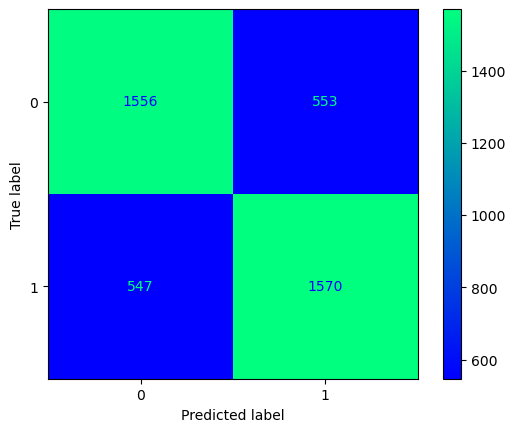

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.74      0.74      0.74      2109
           1       0.74      0.74      0.74      2117

    accuracy                           0.74      4226
   macro avg       0.74      0.74      0.74      4226
weighted avg       0.74      0.74      0.74      4226

-------------------------


In [471]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m5_10min.catboost_GridS()

In [472]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m5_10min,y_val_m5_10min)

Accuracy validación 0.5227186671715259


In [473]:
guardar_modelo(modelo_entrenado_15min,"m5_catboost_GridS_10min")

### Recopilación resultados

In [474]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m5_catboost_GridS", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 10.8. XGBoost

### Partidas 15 min

Hora de inicio:  12:20:11
Hora de fin:  12:20:13
-------------------------
Accuracy train 0.9854422640190997
Accuracy test 0.7871448532836516
-------------------------
-------------------------
Matriz de confusión


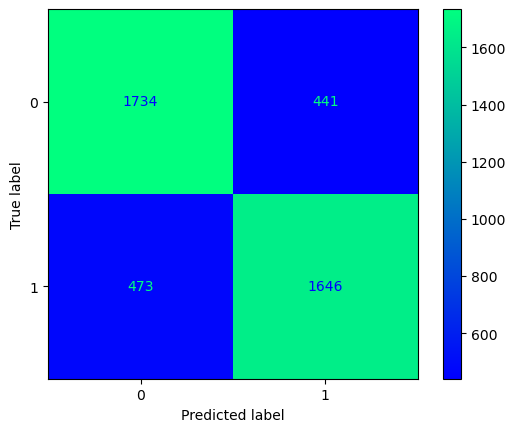

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.79      0.80      0.79      2175
           1       0.79      0.78      0.78      2119

    accuracy                           0.79      4294
   macro avg       0.79      0.79      0.79      4294
weighted avg       0.79      0.79      0.79      4294

-------------------------


In [475]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m5_15min.xgboost()

In [476]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m5_15min,y_val_m5_15min)

Accuracy validación 0.592137134339482


In [477]:
guardar_modelo(modelo_entrenado_15min,"m5_xgboost_15min")

### Partidas 10 min

Hora de inicio:  12:20:13
Hora de fin:  12:20:16
-------------------------
Accuracy train 0.9550914147091888
Accuracy test 0.7155702792238523
-------------------------
-------------------------
Matriz de confusión


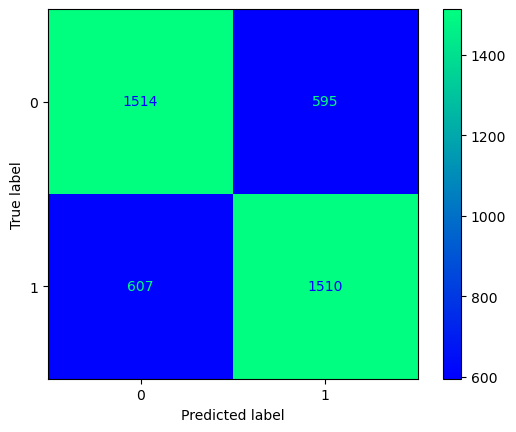

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.71      0.72      0.72      2109
           1       0.72      0.71      0.72      2117

    accuracy                           0.72      4226
   macro avg       0.72      0.72      0.72      4226
weighted avg       0.72      0.72      0.72      4226

-------------------------


In [478]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m5_10min.xgboost()

In [479]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m5_10min,y_val_m5_10min)

Accuracy validación 0.5041650889814464


In [480]:
guardar_modelo(modelo_entrenado_15min,"m5_xgboost_10min")

### Recopilación resultados

In [481]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m5_xgboost", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 10.9. XGBoost Optimizado

Este no

# 10.10. Lightgbm

### Partidas 15 min

Hora de inicio:  12:20:16
Hora de fin:  12:20:16
-------------------------
Accuracy train 0.9108484248529669
Accuracy test 0.803213786679087
-------------------------
-------------------------
Matriz de confusión


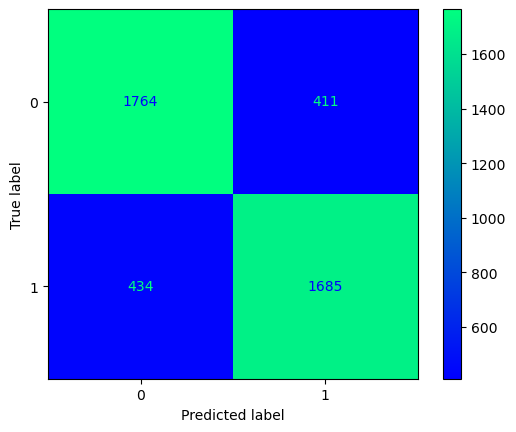

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.80      0.81      0.81      2175
           1       0.80      0.80      0.80      2119

    accuracy                           0.80      4294
   macro avg       0.80      0.80      0.80      4294
weighted avg       0.80      0.80      0.80      4294

-------------------------


In [482]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m5_15min.lightgbm()

In [483]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m5_15min,y_val_m5_15min)

Accuracy validación 0.5092230296254892


In [484]:
guardar_modelo(modelo_entrenado_15min,"m5_lightgbm_15min")

### Partidas 10 min

Hora de inicio:  12:20:17
Hora de fin:  12:20:17
-------------------------
Accuracy train 0.8605407964025797
Accuracy test 0.7328442972077615
-------------------------
-------------------------
Matriz de confusión


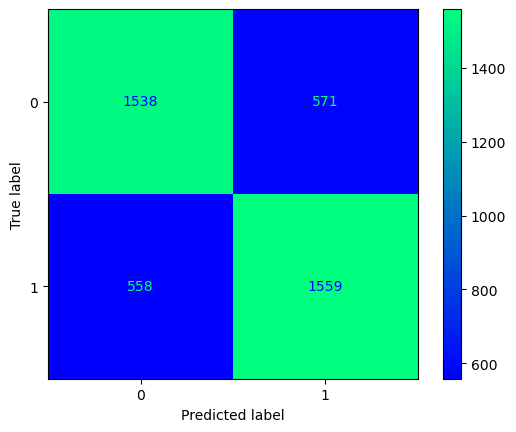

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.73      0.73      0.73      2109
           1       0.73      0.74      0.73      2117

    accuracy                           0.73      4226
   macro avg       0.73      0.73      0.73      4226
weighted avg       0.73      0.73      0.73      4226

-------------------------


In [485]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m5_10min.lightgbm()

In [486]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m5_10min,y_val_m5_10min)

Accuracy validación 0.6198409693297994


In [487]:
guardar_modelo(modelo_entrenado_15min,"m5_lightgbm_10min")

### Recopilación resultados

In [488]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m5_lightgbm", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


# 10.11. Lightgbm Optimizado

### Partidas 15 min

Hora de inicio:  12:20:17
Hora de fin:  12:25:25
-------------------------
Accuracy train 0.8223373900890933
Accuracy test 0.8099673963670238
-------------------------
-------------------------
Matriz de confusión


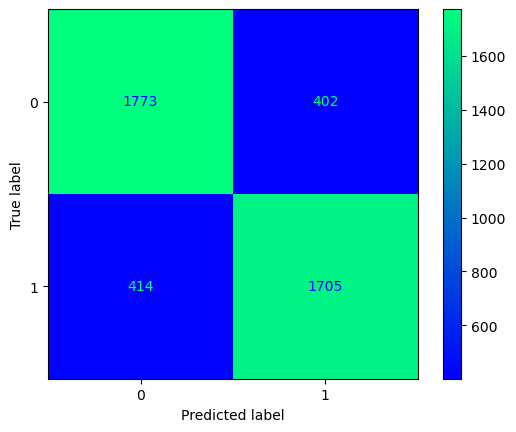

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.81      0.82      0.81      2175
           1       0.81      0.80      0.81      2119

    accuracy                           0.81      4294
   macro avg       0.81      0.81      0.81      4294
weighted avg       0.81      0.81      0.81      4294

-------------------------


In [489]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m5_15min.lightgbm_GridS()

In [490]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m5_15min,y_val_m5_15min)

Accuracy validación 0.5172349543506615


In [491]:
guardar_modelo(modelo_entrenado_15min,"m5_lightgbm_GridS_15min")

### Partidas 10 min

Hora de inicio:  12:25:25
Hora de fin:  12:29:46
-------------------------
Accuracy train 0.7739187030353234
Accuracy test 0.7401798390913393
-------------------------
-------------------------
Matriz de confusión


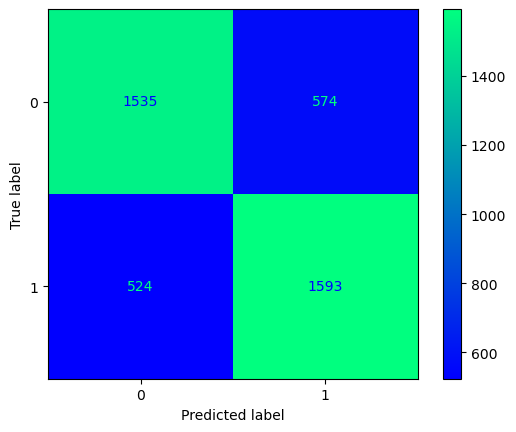

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.75      0.73      0.74      2109
           1       0.74      0.75      0.74      2117

    accuracy                           0.74      4226
   macro avg       0.74      0.74      0.74      4226
weighted avg       0.74      0.74      0.74      4226

-------------------------


In [492]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m5_10min.lightgbm_GridS()

In [493]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m5_10min,y_val_m5_10min)

Accuracy validación 0.5096554335478986


In [494]:
guardar_modelo(modelo_entrenado_15min,"m5_lightgbm_GridS_10min")

### Recopilación resultados

In [495]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m5_lightgbm_GridS", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
...,...,...,...,...,...,...,...
56,m5_catboost,0.87,0.80,0.67,0.81,0.73,0.62
57,m5_catboost_GridS,0.82,0.81,0.65,0.76,0.74,0.52
58,m5_xgboost,0.99,0.79,0.59,0.96,0.72,0.50
59,m5_lightgbm,0.91,0.80,0.51,0.86,0.73,0.62


# 10.12. SVC

### Partidas 15 min

Hora de inicio:  12:29:46
Hora de fin:  12:30:02
-------------------------
Accuracy train 0.8099924299772899
Accuracy test 0.7990218910107126
-------------------------
-------------------------
Matriz de confusión


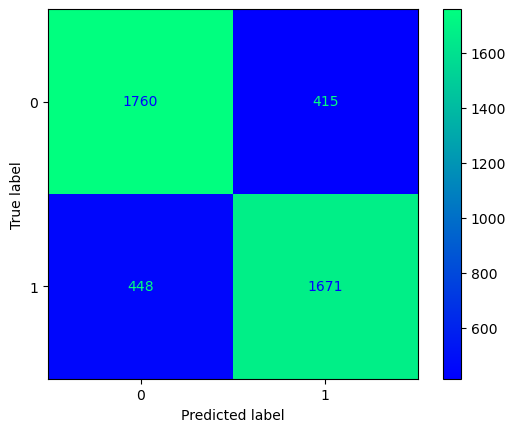

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.80      0.81      0.80      2175
           1       0.80      0.79      0.79      2119

    accuracy                           0.80      4294
   macro avg       0.80      0.80      0.80      4294
weighted avg       0.80      0.80      0.80      4294

-------------------------


In [496]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m5_15min.svc()

In [497]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m5_15min,y_val_m5_15min)

Accuracy validación 0.4920812371902366


In [498]:
guardar_modelo(modelo_entrenado_15min,"m5_svc_15min")

### Partidas 10 min

Hora de inicio:  12:30:30
Hora de fin:  12:30:48
-------------------------
Accuracy train 0.7479439086444589
Accuracy test 0.7361571225745386
-------------------------
-------------------------
Matriz de confusión


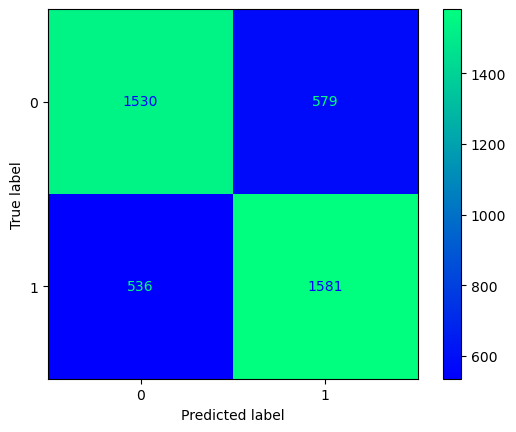

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.74      0.73      0.73      2109
           1       0.73      0.75      0.74      2117

    accuracy                           0.74      4226
   macro avg       0.74      0.74      0.74      4226
weighted avg       0.74      0.74      0.74      4226

-------------------------


In [499]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m5_10min.svc()

In [500]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m5_10min,y_val_m5_10min)

Accuracy validación 0.5018932222642938


In [501]:
guardar_modelo(modelo_entrenado_15min,"m5_svc_10min")

### Recopilación resultados

In [502]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m5_svc", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
...,...,...,...,...,...,...,...
57,m5_catboost_GridS,0.82,0.81,0.65,0.76,0.74,0.52
58,m5_xgboost,0.99,0.79,0.59,0.96,0.72,0.50
59,m5_lightgbm,0.91,0.80,0.51,0.86,0.73,0.62
60,m5_lightgbm_GridS,0.82,0.81,0.52,0.77,0.74,0.51


# 10.13. SVC Optimizado

### Partidas 15 min

Hora de inicio:  12:31:21
Hora de fin:  12:49:57
-------------------------
Accuracy train 0.8091189658184359
Accuracy test 0.8136935258500233
-------------------------
-------------------------
Matriz de confusión


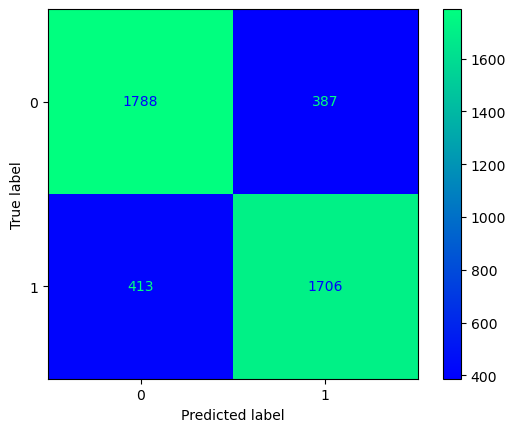

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.81      0.82      0.82      2175
           1       0.82      0.81      0.81      2119

    accuracy                           0.81      4294
   macro avg       0.81      0.81      0.81      4294
weighted avg       0.81      0.81      0.81      4294

-------------------------


In [503]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m5_15min.svc_GridS()

In [504]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m5_15min,y_val_m5_15min)

Accuracy validación 0.4920812371902366


In [505]:
guardar_modelo(modelo_entrenado_15min,"m5_svc_GridS_15min")

### Partidas 10 min

Hora de inicio:  12:50:23
Hora de fin:  13:09:32
-------------------------
Accuracy train 0.7451630081060292
Accuracy test 0.7389966871746332
-------------------------
-------------------------
Matriz de confusión


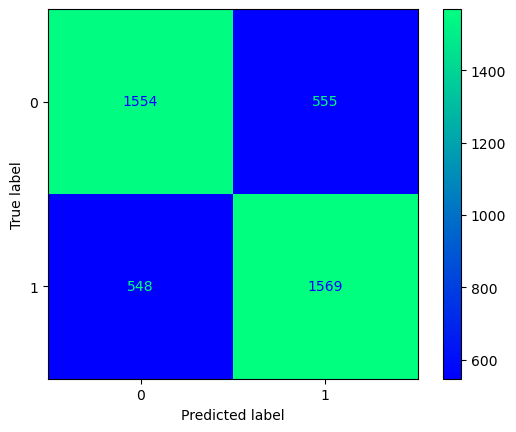

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.74      0.74      0.74      2109
           1       0.74      0.74      0.74      2117

    accuracy                           0.74      4226
   macro avg       0.74      0.74      0.74      4226
weighted avg       0.74      0.74      0.74      4226

-------------------------


In [506]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m5_10min.svc_GridS()

In [507]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m5_10min,y_val_m5_10min)

Accuracy validación 0.5018932222642938


In [508]:
guardar_modelo(modelo_entrenado_15min,"m5_svc_GridS_10min")

### Recopilación resultados

In [509]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m5_svc_GridS", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
...,...,...,...,...,...,...,...
58,m5_xgboost,0.99,0.79,0.59,0.96,0.72,0.50
59,m5_lightgbm,0.91,0.80,0.51,0.86,0.73,0.62
60,m5_lightgbm_GridS,0.82,0.81,0.52,0.77,0.74,0.51
61,m5_svc,0.81,0.80,0.49,0.75,0.74,0.50


# 10.14. LinearSVC

### Partidas 15 min

Hora de inicio:  13:10:04
Hora de fin:  13:10:05
-------------------------
Accuracy train 0.8101088918651371
Accuracy test 0.8134606427573359
-------------------------
-------------------------
Matriz de confusión


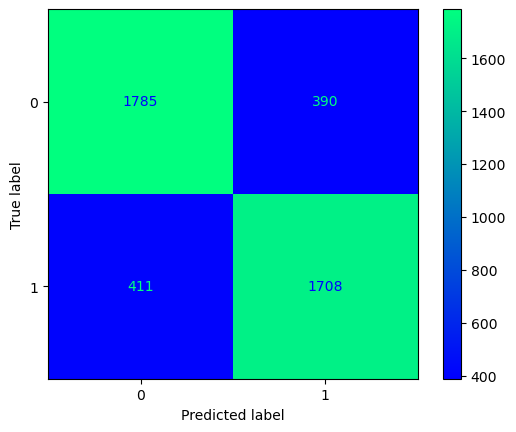

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.81      0.82      0.82      2175
           1       0.81      0.81      0.81      2119

    accuracy                           0.81      4294
   macro avg       0.81      0.81      0.81      4294
weighted avg       0.81      0.81      0.81      4294

-------------------------


In [510]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m5_15min.linearsvc()

In [511]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m5_15min,y_val_m5_15min)

Accuracy validación 0.4920812371902366


In [512]:
guardar_modelo(modelo_entrenado_15min,"m5_linearsvc_15min")

### Partidas 10 min

Hora de inicio:  13:10:05
Hora de fin:  13:10:06
-------------------------
Accuracy train 0.7433879652091592
Accuracy test 0.7378135352579271
-------------------------
-------------------------
Matriz de confusión


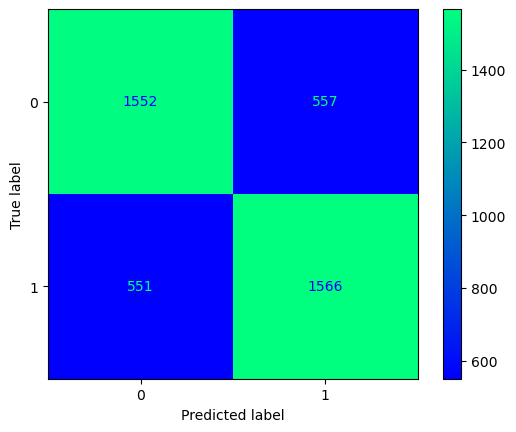

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.74      0.74      0.74      2109
           1       0.74      0.74      0.74      2117

    accuracy                           0.74      4226
   macro avg       0.74      0.74      0.74      4226
weighted avg       0.74      0.74      0.74      4226

-------------------------


In [513]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m5_10min.linearsvc()

In [514]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m5_10min,y_val_m5_10min)

Accuracy validación 0.5018932222642938


In [515]:
guardar_modelo(modelo_entrenado_15min,"m5_linearsvc_10min")

### Recopilación resultados

In [516]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m5_linearsvc", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
...,...,...,...,...,...,...,...
59,m5_lightgbm,0.91,0.80,0.51,0.86,0.73,0.62
60,m5_lightgbm_GridS,0.82,0.81,0.52,0.77,0.74,0.51
61,m5_svc,0.81,0.80,0.49,0.75,0.74,0.50
62,m5_svc_GridS,0.81,0.81,0.49,0.75,0.74,0.50


# 10.15. LinearSVC Optimizado

### Partidas 15 min

Hora de inicio:  13:10:06
Hora de fin:  13:13:01
-------------------------
Accuracy train 0.8101088918651371
Accuracy test 0.8134606427573359
-------------------------
-------------------------
Matriz de confusión


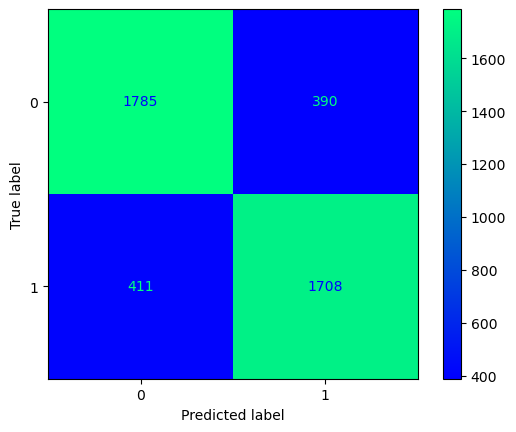

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.81      0.82      0.82      2175
           1       0.81      0.81      0.81      2119

    accuracy                           0.81      4294
   macro avg       0.81      0.81      0.81      4294
weighted avg       0.81      0.81      0.81      4294

-------------------------


In [517]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m5_15min.linearsvc_GridS()

In [518]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m5_15min,y_val_m5_15min)

Accuracy validación 0.4920812371902366


In [519]:
guardar_modelo(modelo_entrenado_15min,"m5_linearsvc_GridS_15min")

### Partidas 10 min

Hora de inicio:  13:13:01
Hora de fin:  13:15:58
-------------------------
Accuracy train 0.7449263357197798
Accuracy test 0.7385234264079508
-------------------------
-------------------------
Matriz de confusión


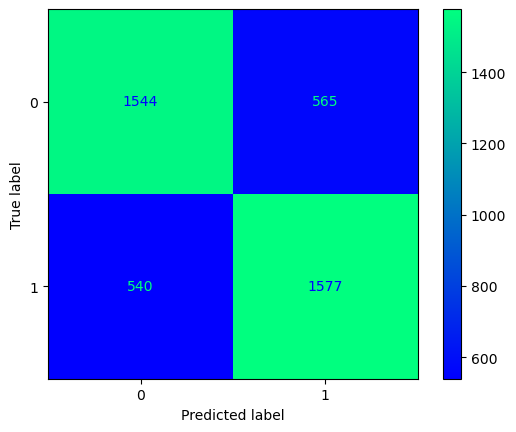

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.74      0.73      0.74      2109
           1       0.74      0.74      0.74      2117

    accuracy                           0.74      4226
   macro avg       0.74      0.74      0.74      4226
weighted avg       0.74      0.74      0.74      4226

-------------------------


In [520]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m5_10min.linearsvc_GridS()

In [521]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m5_10min,y_val_m5_10min)

Accuracy validación 0.5018932222642938


In [522]:
guardar_modelo(modelo_entrenado_15min,"m5_linearsvc_GridS_10min")

### Recopilación resultados

In [523]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m5_linearsvc_GridS", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
...,...,...,...,...,...,...,...
60,m5_lightgbm_GridS,0.82,0.81,0.52,0.77,0.74,0.51
61,m5_svc,0.81,0.80,0.49,0.75,0.74,0.50
62,m5_svc_GridS,0.81,0.81,0.49,0.75,0.74,0.50
63,m5_linearsvc,0.81,0.81,0.49,0.74,0.74,0.50


# 11. Modelo 6
Modelo basado en el modelo 1, pero aplicando un escalado a los datos. Se aplica un StandardScaler

In [524]:
#Se hace una copia de los datos iniciales para aplicar este modelo
modelo6_15min=datos_entrenamiento_15min.copy()

#Se crean la X y la y
X_m6_15min = modelo6_15min.copy().drop(['blueWins'], axis=1)
y_m6_15min = modelo6_15min[['blueWins']]

#Se realiza la división 
X_train_m6_15min, X_test_m6_15min, y_train_m6_15min, y_test_m6_15min = train_test_split(X_m6_15min, y_m6_15min, test_size=0.2, random_state=42)

In [525]:
#Se hace una copia de los datos iniciales para aplicar este modelo
modelo6_10min=datos_entrenamiento_10min.copy()

#Se crean la X y la y
X_m6_10min = modelo6_10min.copy().drop(['blueWins'], axis=1)
y_m6_10min = modelo6_10min[['blueWins']]

#Se realiza la división 
X_train_m6_10min, X_test_m6_10min, y_train_m6_10min, y_test_m6_10min = train_test_split(X_m6_10min, y_m6_10min, test_size=0.2, random_state=42)

In [526]:
#Se preparan los datos de validación
validacion_m6_15min=datos_validacion_15min.copy()

#Se crean la X y la y
X_val_m6_15min = validacion_m6_15min.copy().drop(['blueWins'], axis=1)
y_val_m6_15min = validacion_m6_15min[['blueWins']]

In [527]:
#Se preparan los datos de validación
validacion_m6_10min=datos_validacion_10min.copy()

#Se crean la X y la y
X_val_m6_10min = validacion_m6_10min.copy().drop(['blueWins'], axis=1)
y_val_m6_10min = validacion_m6_10min[['blueWins']]

## StandardScaler

In [528]:
# Se almacenan en el objeto scaler todo lo necesario para estandarizar, con los datos de train de partidas de 15min
scaler = StandardScaler()
scaler.fit(X_train_m6_15min)

# Se utilizan los datos de train para escalar train y test.
X_train_m6_15min = scaler.transform(X_train_m6_15min)
X_test_m6_15min = scaler.transform(X_test_m6_15min)

In [529]:
# Se almacenan en el objeto scaler todo lo necesario para estandarizar, con los datos de train de partidas de 10min
scaler = StandardScaler()
scaler.fit(X_train_m6_10min)

# Se utilizan los datos de train para escalar train y test.
X_train_m6_10min = scaler.transform(X_train_m6_10min)
X_test_m6_10min = scaler.transform(X_test_m6_10min)

In [530]:
# Se almacenan en el objeto scaler todo lo necesario para estandarizar, con los datos de validacion de partidas de 15min
scaler = StandardScaler()
scaler.fit(X_val_m6_15min)

# Se almacenan en el objeto scaler todo lo necesario para estandarizar, con los datos de validacion de partidas de 15min
scaler = StandardScaler()
scaler.fit(X_val_m6_10min)

StandardScaler()

In [531]:
#Se crean los objetos
m6_15min = Models(X_train_m6_15min, X_test_m6_15min, y_train_m6_15min, y_test_m6_15min)
m6_10min = Models(X_train_m6_10min, X_test_m6_10min, y_train_m6_10min, y_test_m6_10min)

# 11.1. LazyClassifier

In [532]:
#LazyClassifier
m6_15min.lazyclassifier()

100%|██████████████████████████████████████████████████████████████████████████████████| 29/29 [02:00<00:00,  4.16s/it]


,Accuracy,Balanced Accuracy,ROC AUC,F1 Score,Time Taken
Model,,,,,
CalibratedClassifierCV,0.81,0.81,0.81,0.81,12.59
LinearSVC,0.81,0.81,0.81,0.81,3.29
LogisticRegression,0.81,0.81,0.81,0.81,0.28
RandomForestClassifier,0.81,0.81,0.81,0.81,2.87
LGBMClassifier,0.81,0.81,0.81,0.81,0.25
RidgeClassifierCV,0.81,0.81,0.81,0.81,0.11
LinearDiscriminantAnalysis,0.81,0.81,0.81,0.81,0.16
RidgeClassifier,0.81,0.81,0.81,0.81,0.07
SVC,0.81,0.81,0.81,0.81,19.36


In [533]:
#LazyClassifier
m6_10min.lazyclassifier()

100%|██████████████████████████████████████████████████████████████████████████████████| 29/29 [02:18<00:00,  4.76s/it]


,Accuracy,Balanced Accuracy,ROC AUC,F1 Score,Time Taken
Model,,,,,
RidgeClassifierCV,0.74,0.74,0.74,0.74,0.11
RidgeClassifier,0.74,0.74,0.74,0.74,0.07
LinearSVC,0.74,0.74,0.74,0.74,3.70
LinearDiscriminantAnalysis,0.74,0.74,0.74,0.74,0.15
CalibratedClassifierCV,0.74,0.74,0.74,0.74,14.07
LogisticRegression,0.74,0.74,0.74,0.74,0.28
RandomForestClassifier,0.74,0.74,0.74,0.74,2.72
AdaBoostClassifier,0.74,0.74,0.74,0.74,1.41
LGBMClassifier,0.74,0.74,0.74,0.74,0.22


# 11.2. Random Forest

### Partidas 15 min

Hora de inicio:  13:20:17
Hora de fin:  13:20:23
-------------------------
Accuracy train 1.0
Accuracy test 0.807638565440149
-------------------------
-------------------------
Matriz de confusión


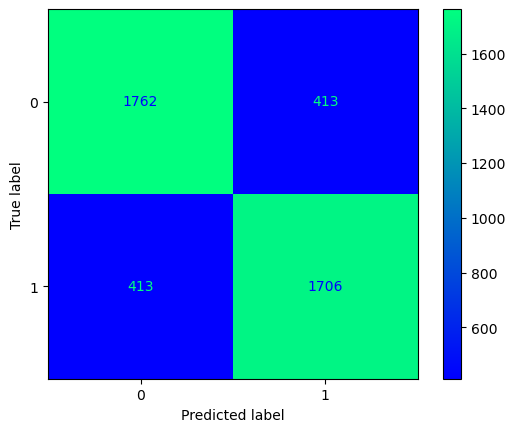

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.81      0.81      0.81      2175
           1       0.81      0.81      0.81      2119

    accuracy                           0.81      4294
   macro avg       0.81      0.81      0.81      4294
weighted avg       0.81      0.81      0.81      4294

-------------------------


In [534]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m6_15min.randomforest()

In [535]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m6_15min,y_val_m6_15min)

Accuracy validación 0.6679709334823924


In [536]:
guardar_modelo(modelo_entrenado_15min,"m6_randomforest_15min")

### Partidas 10 min

Hora de inicio:  13:20:24
Hora de fin:  13:20:29
-------------------------
Accuracy train 1.0
Accuracy test 0.740889730241363
-------------------------
-------------------------
Matriz de confusión


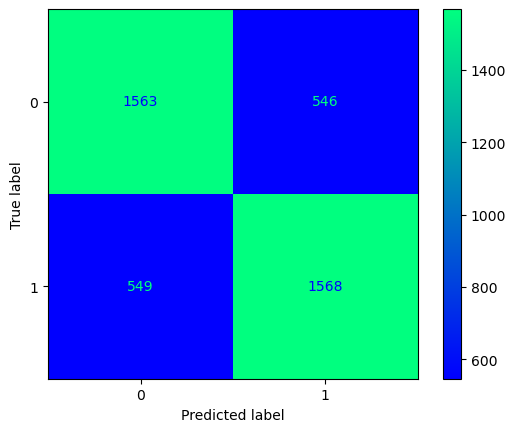

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.74      0.74      0.74      2109
           1       0.74      0.74      0.74      2117

    accuracy                           0.74      4226
   macro avg       0.74      0.74      0.74      4226
weighted avg       0.74      0.74      0.74      4226

-------------------------


In [537]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m6_10min.randomforest()

In [538]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m6_10min,y_val_m6_10min)

Accuracy validación 0.6130253691783415


In [539]:
guardar_modelo(modelo_entrenado_15min,"m6_randomforest_10min")

### Recopilación resultados

In [540]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m6_randomforest", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
...,...,...,...,...,...,...,...
61,m5_svc,0.81,0.80,0.49,0.75,0.74,0.50
62,m5_svc_GridS,0.81,0.81,0.49,0.75,0.74,0.50
63,m5_linearsvc,0.81,0.81,0.49,0.74,0.74,0.50
64,m5_linearsvc_GridS,0.81,0.81,0.49,0.74,0.74,0.50


# 11.3. Random Forest Optimizado

### Partidas 15 min

Hora de inicio:  13:20:30
Hora de fin:  13:56:55
-------------------------
Accuracy train 0.8156990624818028
Accuracy test 0.8088029809035864
-------------------------
-------------------------
Matriz de confusión


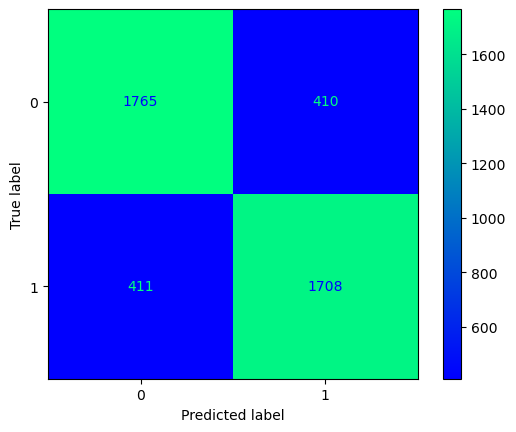

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.81      0.81      0.81      2175
           1       0.81      0.81      0.81      2119

    accuracy                           0.81      4294
   macro avg       0.81      0.81      0.81      4294
weighted avg       0.81      0.81      0.81      4294

-------------------------


In [541]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m6_15min.randomforest_GridS()

In [542]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m6_15min,y_val_m6_15min)

Accuracy validación 0.7359791317309484


In [543]:
guardar_modelo(modelo_entrenado_15min,"m6_randomforest_GridS_15min")

### Partidas 10 min

Hora de inicio:  13:56:55
Hora de fin:  14:30:27
-------------------------
Accuracy train 0.7647476480681616
Accuracy test 0.7394699479413157
-------------------------
-------------------------
Matriz de confusión


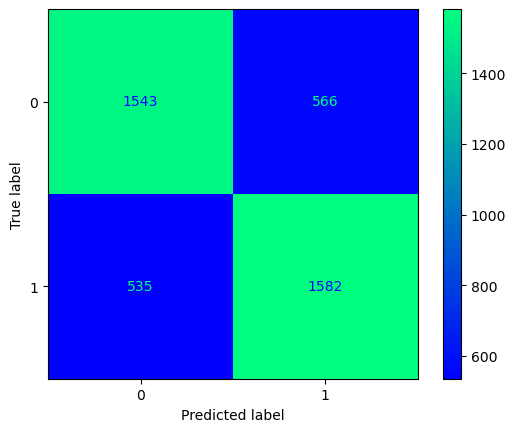

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.74      0.73      0.74      2109
           1       0.74      0.75      0.74      2117

    accuracy                           0.74      4226
   macro avg       0.74      0.74      0.74      4226
weighted avg       0.74      0.74      0.74      4226

-------------------------


In [544]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m6_10min.randomforest_GridS()

In [545]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m6_10min,y_val_m6_10min)

Accuracy validación 0.6448315032184778


In [546]:
guardar_modelo(modelo_entrenado_15min,"m6_randomforest_GridS_10min")

### Recopilación resultados

In [547]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m6_randomforest_GridS", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
...,...,...,...,...,...,...,...
62,m5_svc_GridS,0.81,0.81,0.49,0.75,0.74,0.50
63,m5_linearsvc,0.81,0.81,0.49,0.74,0.74,0.50
64,m5_linearsvc_GridS,0.81,0.81,0.49,0.74,0.74,0.50
65,m6_randomforest,1.00,0.81,0.67,1.00,0.74,0.61


# 11.4. Gradient boosting 

### Partidas 15 min

Hora de inicio:  14:30:27
Hora de fin:  14:30:40
-------------------------
Accuracy train 0.8276946369300646
Accuracy test 0.8074056823474616
-------------------------
-------------------------
Matriz de confusión


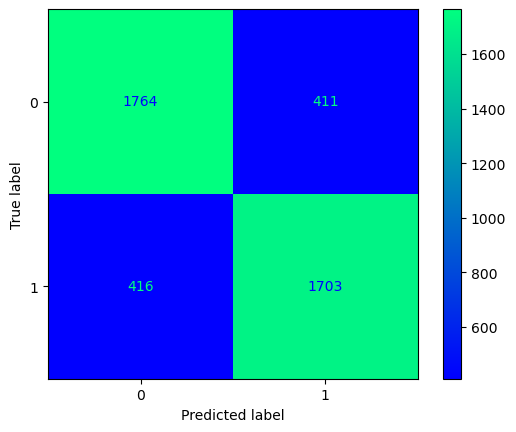

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.81      0.81      0.81      2175
           1       0.81      0.80      0.80      2119

    accuracy                           0.81      4294
   macro avg       0.81      0.81      0.81      4294
weighted avg       0.81      0.81      0.81      4294

-------------------------


In [548]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m6_15min.gradientboosting()

In [549]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m6_15min,y_val_m6_15min)

Accuracy validación 0.48854108440469535


In [550]:
guardar_modelo(modelo_entrenado_15min,"m6_gradientboosting_15min")

### Partidas 10 min

Hora de inicio:  14:30:40
Hora de fin:  14:30:51
-------------------------
Accuracy train 0.7701911129518964
Accuracy test 0.7373402744912447
-------------------------
-------------------------
Matriz de confusión


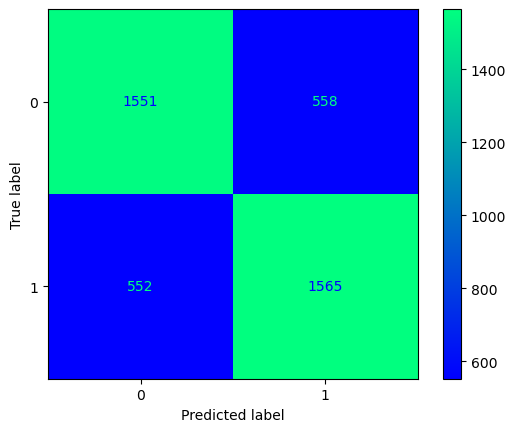

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.74      0.74      0.74      2109
           1       0.74      0.74      0.74      2117

    accuracy                           0.74      4226
   macro avg       0.74      0.74      0.74      4226
weighted avg       0.74      0.74      0.74      4226

-------------------------


In [551]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m6_10min.gradientboosting()

In [552]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m6_10min,y_val_m6_10min)

Accuracy validación 0.5022718667171526


In [553]:
guardar_modelo(modelo_entrenado_15min,"m6_gradientboosting_10min")

### Recopilación resultados

In [554]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m6_gradientboosting", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
...,...,...,...,...,...,...,...
63,m5_linearsvc,0.81,0.81,0.49,0.74,0.74,0.50
64,m5_linearsvc_GridS,0.81,0.81,0.49,0.74,0.74,0.50
65,m6_randomforest,1.00,0.81,0.67,1.00,0.74,0.61
66,m6_randomforest_GridS,0.82,0.81,0.74,0.76,0.74,0.64


# 11.5. Gradient boosting Optimizado

### Partidas 15 min

Hora de inicio:  14:30:51
Hora de fin:  14:56:42
-------------------------
Accuracy train 0.8370698189017644
Accuracy test 0.8092687470889613
-------------------------
-------------------------
Matriz de confusión


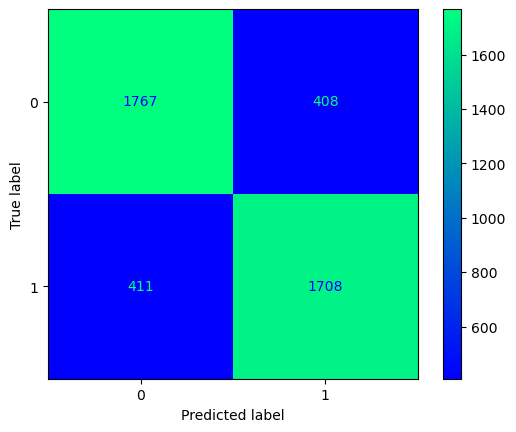

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.81      0.81      0.81      2175
           1       0.81      0.81      0.81      2119

    accuracy                           0.81      4294
   macro avg       0.81      0.81      0.81      4294
weighted avg       0.81      0.81      0.81      4294

-------------------------


In [555]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m6_15min.gradientboosting_GridS()

In [556]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m6_15min,y_val_m6_15min)

Accuracy validación 0.5716415129495063


In [557]:
guardar_modelo(modelo_entrenado_15min,"m6_gradientboosting_GridS_15min")

### Partidas 10 min

Hora de inicio:  14:56:42
Hora de fin:  15:20:24
-------------------------
Accuracy train 0.7651026566475356
Accuracy test 0.7382867960246096
-------------------------
-------------------------
Matriz de confusión


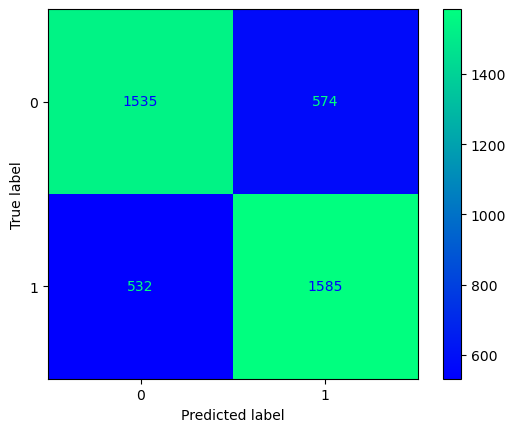

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.74      0.73      0.74      2109
           1       0.73      0.75      0.74      2117

    accuracy                           0.74      4226
   macro avg       0.74      0.74      0.74      4226
weighted avg       0.74      0.74      0.74      4226

-------------------------


In [558]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m6_10min.gradientboosting_GridS()

In [559]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m6_10min,y_val_m6_10min)

Accuracy validación 0.5526315789473685


In [560]:
guardar_modelo(modelo_entrenado_15min,"m6_gradientboosting_GridS_10min")

### Recopilación resultados

In [561]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m6_gradientboosting_GridS", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
...,...,...,...,...,...,...,...
64,m5_linearsvc_GridS,0.81,0.81,0.49,0.74,0.74,0.50
65,m6_randomforest,1.00,0.81,0.67,1.00,0.74,0.61
66,m6_randomforest_GridS,0.82,0.81,0.74,0.76,0.74,0.64
67,m6_gradientboosting,0.83,0.81,0.49,0.77,0.74,0.50


# 11.6. Catboost

### Partidas 15 min

Hora de inicio:  15:20:25
Learning rate set to 0.151764
0:	learn: 0.6179776	total: 8.67ms	remaining: 1.73s
1:	learn: 0.5696056	total: 16.8ms	remaining: 1.67s
2:	learn: 0.5311687	total: 25ms	remaining: 1.64s
3:	learn: 0.5050932	total: 33.3ms	remaining: 1.63s
4:	learn: 0.4886776	total: 41.9ms	remaining: 1.64s
5:	learn: 0.4741001	total: 50.2ms	remaining: 1.62s
6:	learn: 0.4628672	total: 59.1ms	remaining: 1.63s
7:	learn: 0.4552205	total: 68.1ms	remaining: 1.64s
8:	learn: 0.4479512	total: 76.7ms	remaining: 1.63s
9:	learn: 0.4418865	total: 84.9ms	remaining: 1.61s
10:	learn: 0.4364878	total: 92.8ms	remaining: 1.59s
11:	learn: 0.4327483	total: 101ms	remaining: 1.58s
12:	learn: 0.4297974	total: 111ms	remaining: 1.6s
13:	learn: 0.4269826	total: 119ms	remaining: 1.58s
14:	learn: 0.4241425	total: 129ms	remaining: 1.59s
15:	learn: 0.4216922	total: 137ms	remaining: 1.58s
16:	learn: 0.4204644	total: 145ms	remaining: 1.56s
17:	learn: 0.4182281	total: 154ms	remaining: 1.56s
18:	learn: 0.4162996	total: 

169:	learn: 0.3331934	total: 1.24s	remaining: 218ms
170:	learn: 0.3328403	total: 1.25s	remaining: 211ms
171:	learn: 0.3323852	total: 1.26s	remaining: 205ms
172:	learn: 0.3319781	total: 1.27s	remaining: 198ms
173:	learn: 0.3315267	total: 1.27s	remaining: 190ms
174:	learn: 0.3311254	total: 1.28s	remaining: 183ms
175:	learn: 0.3304487	total: 1.29s	remaining: 175ms
176:	learn: 0.3300368	total: 1.29s	remaining: 168ms
177:	learn: 0.3297048	total: 1.3s	remaining: 161ms
178:	learn: 0.3292415	total: 1.31s	remaining: 153ms
179:	learn: 0.3285709	total: 1.31s	remaining: 146ms
180:	learn: 0.3280972	total: 1.32s	remaining: 139ms
181:	learn: 0.3274843	total: 1.33s	remaining: 132ms
182:	learn: 0.3270573	total: 1.34s	remaining: 124ms
183:	learn: 0.3263361	total: 1.34s	remaining: 117ms
184:	learn: 0.3261503	total: 1.35s	remaining: 110ms
185:	learn: 0.3259076	total: 1.36s	remaining: 102ms
186:	learn: 0.3255257	total: 1.36s	remaining: 94.9ms
187:	learn: 0.3250548	total: 1.37s	remaining: 87.6ms
188:	learn:

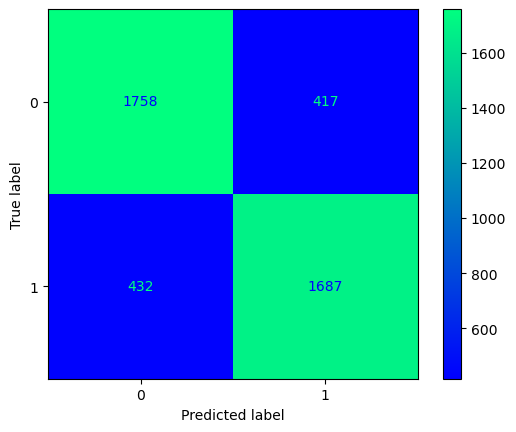

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.80      0.81      0.81      2175
           1       0.80      0.80      0.80      2119

    accuracy                           0.80      4294
   macro avg       0.80      0.80      0.80      4294
weighted avg       0.80      0.80      0.80      4294

-------------------------


In [562]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m6_15min.catboost()

In [563]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m6_15min,y_val_m6_15min)

Accuracy validación 0.6057387739891932


In [564]:
guardar_modelo(modelo_entrenado_15min,"m6_catboost_15min")

### Partidas 10 min

Hora de inicio:  15:20:26
Learning rate set to 0.150733
0:	learn: 0.6509642	total: 9.67ms	remaining: 1.92s
1:	learn: 0.6171984	total: 20.5ms	remaining: 2.03s
2:	learn: 0.5966963	total: 32.5ms	remaining: 2.14s
3:	learn: 0.5788801	total: 39.2ms	remaining: 1.92s
4:	learn: 0.5650406	total: 45.5ms	remaining: 1.77s
5:	learn: 0.5536083	total: 51.9ms	remaining: 1.68s
6:	learn: 0.5458894	total: 58.1ms	remaining: 1.6s
7:	learn: 0.5393474	total: 64.4ms	remaining: 1.54s
8:	learn: 0.5350829	total: 70.5ms	remaining: 1.5s
9:	learn: 0.5311261	total: 76.8ms	remaining: 1.46s
10:	learn: 0.5286937	total: 83ms	remaining: 1.43s
11:	learn: 0.5259782	total: 89.1ms	remaining: 1.4s
12:	learn: 0.5237836	total: 95.5ms	remaining: 1.37s
13:	learn: 0.5213130	total: 102ms	remaining: 1.35s
14:	learn: 0.5197328	total: 108ms	remaining: 1.33s
15:	learn: 0.5180927	total: 114ms	remaining: 1.31s
16:	learn: 0.5170469	total: 120ms	remaining: 1.29s
17:	learn: 0.5154976	total: 128ms	remaining: 1.3s
18:	learn: 0.5142647	total: 1

159:	learn: 0.4407357	total: 1.07s	remaining: 267ms
160:	learn: 0.4405391	total: 1.07s	remaining: 260ms
161:	learn: 0.4401811	total: 1.08s	remaining: 254ms
162:	learn: 0.4397220	total: 1.09s	remaining: 247ms
163:	learn: 0.4392447	total: 1.1s	remaining: 241ms
164:	learn: 0.4387228	total: 1.1s	remaining: 234ms
165:	learn: 0.4383521	total: 1.11s	remaining: 227ms
166:	learn: 0.4380330	total: 1.11s	remaining: 220ms
167:	learn: 0.4375925	total: 1.12s	remaining: 213ms
168:	learn: 0.4374207	total: 1.13s	remaining: 207ms
169:	learn: 0.4370748	total: 1.13s	remaining: 200ms
170:	learn: 0.4363937	total: 1.14s	remaining: 193ms
171:	learn: 0.4357105	total: 1.15s	remaining: 187ms
172:	learn: 0.4351421	total: 1.15s	remaining: 180ms
173:	learn: 0.4346569	total: 1.16s	remaining: 174ms
174:	learn: 0.4342797	total: 1.17s	remaining: 167ms
175:	learn: 0.4338032	total: 1.17s	remaining: 160ms
176:	learn: 0.4334975	total: 1.18s	remaining: 153ms
177:	learn: 0.4329972	total: 1.19s	remaining: 147ms
178:	learn: 0.

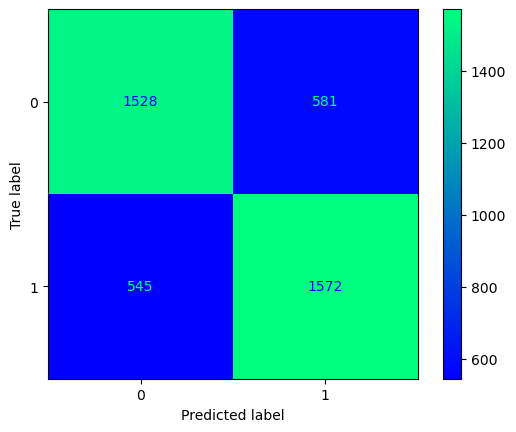

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.74      0.72      0.73      2109
           1       0.73      0.74      0.74      2117

    accuracy                           0.73      4226
   macro avg       0.73      0.73      0.73      4226
weighted avg       0.73      0.73      0.73      4226

-------------------------


In [565]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m6_10min.catboost()

In [566]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m6_10min,y_val_m6_10min)

Accuracy validación 0.5918212798182506


In [567]:
guardar_modelo(modelo_entrenado_15min,"m6_catboost_10min")

### Recopilación resultados

In [568]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m6_catboost", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
...,...,...,...,...,...,...,...
65,m6_randomforest,1.00,0.81,0.67,1.00,0.74,0.61
66,m6_randomforest_GridS,0.82,0.81,0.74,0.76,0.74,0.64
67,m6_gradientboosting,0.83,0.81,0.49,0.77,0.74,0.50
68,m6_gradientboosting_GridS,0.84,0.81,0.57,0.77,0.74,0.55


# 11.7. CatBoost Optimizado

### Partidas 15 min

Hora de inicio:  15:20:28
0:	learn: 0.6717839	test: 0.6706242	best: 0.6706242 (0)	total: 3.47ms	remaining: 344ms
1:	learn: 0.6523375	test: 0.6503542	best: 0.6503542 (1)	total: 7.19ms	remaining: 352ms
2:	learn: 0.6358068	test: 0.6331596	best: 0.6331596 (2)	total: 10.6ms	remaining: 344ms
3:	learn: 0.6197712	test: 0.6162970	best: 0.6162970 (3)	total: 14ms	remaining: 336ms
4:	learn: 0.6037344	test: 0.5989970	best: 0.5989970 (4)	total: 18.2ms	remaining: 346ms
5:	learn: 0.5912331	test: 0.5857635	best: 0.5857635 (5)	total: 21.9ms	remaining: 343ms
6:	learn: 0.5786575	test: 0.5722855	best: 0.5722855 (6)	total: 25.5ms	remaining: 339ms
7:	learn: 0.5691048	test: 0.5622034	best: 0.5622034 (7)	total: 29.1ms	remaining: 335ms
8:	learn: 0.5593454	test: 0.5517411	best: 0.5517411 (8)	total: 32.3ms	remaining: 326ms
9:	learn: 0.5508132	test: 0.5426626	best: 0.5426626 (9)	total: 35.5ms	remaining: 319ms
10:	learn: 0.5437542	test: 0.5354932	best: 0.5354932 (10)	total: 38.8ms	remaining: 314ms
11:	learn: 0.5369

0:	learn: 0.6518916	test: 0.6496042	best: 0.6496042 (0)	total: 7.79ms	remaining: 771ms
1:	learn: 0.6183106	test: 0.6144103	best: 0.6144103 (1)	total: 12.1ms	remaining: 591ms
2:	learn: 0.5917641	test: 0.5864583	best: 0.5864583 (2)	total: 15.4ms	remaining: 498ms
3:	learn: 0.5689434	test: 0.5616230	best: 0.5616230 (3)	total: 18.8ms	remaining: 451ms
4:	learn: 0.5504148	test: 0.5428282	best: 0.5428282 (4)	total: 22.3ms	remaining: 424ms
5:	learn: 0.5359413	test: 0.5277705	best: 0.5277705 (5)	total: 25.6ms	remaining: 402ms
6:	learn: 0.5238260	test: 0.5141602	best: 0.5141602 (6)	total: 29ms	remaining: 385ms
7:	learn: 0.5111462	test: 0.5003580	best: 0.5003580 (7)	total: 32.6ms	remaining: 375ms
8:	learn: 0.5019588	test: 0.4900558	best: 0.4900558 (8)	total: 36.4ms	remaining: 368ms
9:	learn: 0.4936790	test: 0.4810849	best: 0.4810849 (9)	total: 43ms	remaining: 387ms
10:	learn: 0.4879461	test: 0.4747085	best: 0.4747085 (10)	total: 47ms	remaining: 380ms
11:	learn: 0.4820197	test: 0.4683165	best: 0.46

5:	learn: 0.5020710	test: 0.4903925	best: 0.4903925 (5)	total: 26ms	remaining: 408ms
6:	learn: 0.4907171	test: 0.4777355	best: 0.4777355 (6)	total: 30ms	remaining: 399ms
7:	learn: 0.4816845	test: 0.4676766	best: 0.4676766 (7)	total: 34.2ms	remaining: 393ms
8:	learn: 0.4742710	test: 0.4597583	best: 0.4597583 (8)	total: 39ms	remaining: 395ms
9:	learn: 0.4687336	test: 0.4533478	best: 0.4533478 (9)	total: 43.6ms	remaining: 392ms
10:	learn: 0.4631474	test: 0.4472833	best: 0.4472833 (10)	total: 48.3ms	remaining: 391ms
11:	learn: 0.4579718	test: 0.4417019	best: 0.4417019 (11)	total: 52.8ms	remaining: 387ms
12:	learn: 0.4543038	test: 0.4373336	best: 0.4373336 (12)	total: 56.5ms	remaining: 378ms
13:	learn: 0.4504342	test: 0.4333031	best: 0.4333031 (13)	total: 61.7ms	remaining: 379ms
14:	learn: 0.4471501	test: 0.4295794	best: 0.4295794 (14)	total: 65.8ms	remaining: 373ms
15:	learn: 0.4451423	test: 0.4273737	best: 0.4273737 (15)	total: 69.7ms	remaining: 366ms
16:	learn: 0.4428269	test: 0.4252024	

10:	learn: 0.4488005	test: 0.4313522	best: 0.4313522 (10)	total: 38.2ms	remaining: 309ms
11:	learn: 0.4453122	test: 0.4269963	best: 0.4269963 (11)	total: 43.1ms	remaining: 316ms
12:	learn: 0.4413853	test: 0.4236202	best: 0.4236202 (12)	total: 47.4ms	remaining: 317ms
13:	learn: 0.4392507	test: 0.4218670	best: 0.4218670 (13)	total: 51.6ms	remaining: 317ms
14:	learn: 0.4364493	test: 0.4188386	best: 0.4188386 (14)	total: 58.9ms	remaining: 334ms
15:	learn: 0.4342856	test: 0.4155549	best: 0.4155549 (15)	total: 64.9ms	remaining: 341ms
16:	learn: 0.4326066	test: 0.4137040	best: 0.4137040 (16)	total: 68.6ms	remaining: 335ms
17:	learn: 0.4307828	test: 0.4115648	best: 0.4115648 (17)	total: 71.6ms	remaining: 326ms
18:	learn: 0.4289350	test: 0.4096946	best: 0.4096946 (18)	total: 75ms	remaining: 320ms
19:	learn: 0.4272459	test: 0.4076696	best: 0.4076696 (19)	total: 78.3ms	remaining: 313ms
20:	learn: 0.4256717	test: 0.4059463	best: 0.4059463 (20)	total: 81.8ms	remaining: 308ms
21:	learn: 0.4248028	te

7:	learn: 0.4370083	test: 0.4171309	best: 0.4171309 (7)	total: 26.9ms	remaining: 310ms
8:	learn: 0.4345245	test: 0.4141842	best: 0.4141842 (8)	total: 31.4ms	remaining: 317ms
9:	learn: 0.4324286	test: 0.4115507	best: 0.4115507 (9)	total: 36.7ms	remaining: 330ms
10:	learn: 0.4305031	test: 0.4093098	best: 0.4093098 (10)	total: 45.2ms	remaining: 366ms
11:	learn: 0.4275026	test: 0.4044389	best: 0.4044389 (11)	total: 50.1ms	remaining: 368ms
12:	learn: 0.4264695	test: 0.4038782	best: 0.4038782 (12)	total: 53.2ms	remaining: 356ms
13:	learn: 0.4246997	test: 0.4025402	best: 0.4025402 (13)	total: 56.3ms	remaining: 346ms
14:	learn: 0.4235384	test: 0.4013465	best: 0.4013465 (14)	total: 59.4ms	remaining: 337ms
15:	learn: 0.4225643	test: 0.4000443	best: 0.4000443 (15)	total: 63ms	remaining: 331ms
16:	learn: 0.4216910	test: 0.4001876	best: 0.4000443 (15)	total: 66.1ms	remaining: 323ms
17:	learn: 0.4200019	test: 0.4013248	best: 0.4000443 (15)	total: 69.6ms	remaining: 317ms
18:	learn: 0.4190667	test: 0.

14:	learn: 0.5176717	test: 0.5079757	best: 0.5079757 (14)	total: 53.9ms	remaining: 305ms
15:	learn: 0.5125755	test: 0.5026171	best: 0.5026171 (15)	total: 58.6ms	remaining: 307ms
16:	learn: 0.5077150	test: 0.4975988	best: 0.4975988 (16)	total: 62.5ms	remaining: 305ms
17:	learn: 0.5034368	test: 0.4929535	best: 0.4929535 (17)	total: 69.3ms	remaining: 316ms
18:	learn: 0.4993649	test: 0.4884236	best: 0.4884236 (18)	total: 78.7ms	remaining: 336ms
19:	learn: 0.4956794	test: 0.4844573	best: 0.4844573 (19)	total: 82.8ms	remaining: 331ms
20:	learn: 0.4920856	test: 0.4804196	best: 0.4804196 (20)	total: 86.9ms	remaining: 327ms
21:	learn: 0.4893222	test: 0.4774666	best: 0.4774666 (21)	total: 90.4ms	remaining: 321ms
22:	learn: 0.4864726	test: 0.4740915	best: 0.4740915 (22)	total: 93.6ms	remaining: 313ms
23:	learn: 0.4838326	test: 0.4711716	best: 0.4711716 (23)	total: 96.8ms	remaining: 306ms
24:	learn: 0.4805109	test: 0.4678247	best: 0.4678247 (24)	total: 100ms	remaining: 301ms
25:	learn: 0.4775923	t

27:	learn: 0.4409691	test: 0.4228246	best: 0.4228246 (27)	total: 94ms	remaining: 242ms
28:	learn: 0.4400463	test: 0.4216909	best: 0.4216909 (28)	total: 98.8ms	remaining: 242ms
29:	learn: 0.4389705	test: 0.4207076	best: 0.4207076 (29)	total: 105ms	remaining: 245ms
30:	learn: 0.4376994	test: 0.4192948	best: 0.4192948 (30)	total: 112ms	remaining: 249ms
31:	learn: 0.4366883	test: 0.4182460	best: 0.4182460 (31)	total: 121ms	remaining: 257ms
32:	learn: 0.4358196	test: 0.4173899	best: 0.4173899 (32)	total: 124ms	remaining: 252ms
33:	learn: 0.4349896	test: 0.4163683	best: 0.4163683 (33)	total: 128ms	remaining: 248ms
34:	learn: 0.4343816	test: 0.4157198	best: 0.4157198 (34)	total: 131ms	remaining: 243ms
35:	learn: 0.4335366	test: 0.4148798	best: 0.4148798 (35)	total: 134ms	remaining: 238ms
36:	learn: 0.4325593	test: 0.4139471	best: 0.4139471 (36)	total: 138ms	remaining: 234ms
37:	learn: 0.4318790	test: 0.4132470	best: 0.4132470 (37)	total: 141ms	remaining: 230ms
38:	learn: 0.4314184	test: 0.412

44:	learn: 0.4179635	test: 0.3993722	best: 0.3993722 (44)	total: 159ms	remaining: 194ms
45:	learn: 0.4176364	test: 0.3991162	best: 0.3991162 (45)	total: 163ms	remaining: 191ms
46:	learn: 0.4173260	test: 0.3988339	best: 0.3988339 (46)	total: 166ms	remaining: 187ms
47:	learn: 0.4168168	test: 0.3984749	best: 0.3984749 (47)	total: 169ms	remaining: 184ms
48:	learn: 0.4166556	test: 0.3982454	best: 0.3982454 (48)	total: 172ms	remaining: 180ms
49:	learn: 0.4161233	test: 0.3977289	best: 0.3977289 (49)	total: 176ms	remaining: 176ms
50:	learn: 0.4154211	test: 0.3973684	best: 0.3973684 (50)	total: 179ms	remaining: 172ms
51:	learn: 0.4151241	test: 0.3972024	best: 0.3972024 (51)	total: 183ms	remaining: 169ms
52:	learn: 0.4147716	test: 0.3969889	best: 0.3969889 (52)	total: 186ms	remaining: 165ms
53:	learn: 0.4145466	test: 0.3968761	best: 0.3968761 (53)	total: 190ms	remaining: 161ms
54:	learn: 0.4142682	test: 0.3967654	best: 0.3967654 (54)	total: 193ms	remaining: 158ms
55:	learn: 0.4141052	test: 0.396

58:	learn: 0.4067274	test: 0.3944303	best: 0.3940855 (56)	total: 214ms	remaining: 149ms
59:	learn: 0.4063138	test: 0.3946265	best: 0.3940855 (56)	total: 217ms	remaining: 145ms
60:	learn: 0.4059062	test: 0.3944254	best: 0.3940855 (56)	total: 220ms	remaining: 141ms
61:	learn: 0.4055937	test: 0.3941442	best: 0.3940855 (56)	total: 224ms	remaining: 137ms
62:	learn: 0.4051357	test: 0.3942138	best: 0.3940855 (56)	total: 227ms	remaining: 134ms
63:	learn: 0.4047569	test: 0.3942930	best: 0.3940855 (56)	total: 230ms	remaining: 130ms
64:	learn: 0.4043493	test: 0.3941660	best: 0.3940855 (56)	total: 234ms	remaining: 126ms
65:	learn: 0.4041691	test: 0.3942328	best: 0.3940855 (56)	total: 237ms	remaining: 122ms
66:	learn: 0.4035910	test: 0.3938226	best: 0.3938226 (66)	total: 242ms	remaining: 119ms
67:	learn: 0.4032990	test: 0.3938453	best: 0.3938226 (66)	total: 249ms	remaining: 117ms
68:	learn: 0.4029018	test: 0.3938158	best: 0.3938158 (68)	total: 257ms	remaining: 116ms
69:	learn: 0.4025588	test: 0.393

80:	learn: 0.3800874	test: 0.4008969	best: 0.3943747 (31)	total: 275ms	remaining: 64.5ms
81:	learn: 0.3794091	test: 0.4008228	best: 0.3943747 (31)	total: 282ms	remaining: 62ms
82:	learn: 0.3789081	test: 0.4003298	best: 0.3943747 (31)	total: 291ms	remaining: 59.5ms
83:	learn: 0.3782373	test: 0.4006801	best: 0.3943747 (31)	total: 296ms	remaining: 56.3ms
84:	learn: 0.3776952	test: 0.4009557	best: 0.3943747 (31)	total: 300ms	remaining: 52.9ms
85:	learn: 0.3771620	test: 0.4010236	best: 0.3943747 (31)	total: 305ms	remaining: 49.6ms
86:	learn: 0.3764167	test: 0.4010062	best: 0.3943747 (31)	total: 308ms	remaining: 46ms
87:	learn: 0.3760147	test: 0.4008698	best: 0.3943747 (31)	total: 311ms	remaining: 42.4ms
88:	learn: 0.3754255	test: 0.4013717	best: 0.3943747 (31)	total: 314ms	remaining: 38.8ms
89:	learn: 0.3748670	test: 0.4022598	best: 0.3943747 (31)	total: 317ms	remaining: 35.2ms
90:	learn: 0.3745080	test: 0.4022160	best: 0.3943747 (31)	total: 322ms	remaining: 31.8ms
91:	learn: 0.3741400	test

87:	learn: 0.4247118	test: 0.4070702	best: 0.4070702 (87)	total: 320ms	remaining: 43.6ms
88:	learn: 0.4246127	test: 0.4069368	best: 0.4069368 (88)	total: 324ms	remaining: 40ms
89:	learn: 0.4241828	test: 0.4064993	best: 0.4064993 (89)	total: 328ms	remaining: 36.5ms
90:	learn: 0.4240129	test: 0.4063531	best: 0.4063531 (90)	total: 332ms	remaining: 32.8ms
91:	learn: 0.4237806	test: 0.4061198	best: 0.4061198 (91)	total: 336ms	remaining: 29.2ms
92:	learn: 0.4234792	test: 0.4057550	best: 0.4057550 (92)	total: 344ms	remaining: 25.9ms
93:	learn: 0.4231045	test: 0.4053466	best: 0.4053466 (93)	total: 353ms	remaining: 22.5ms
94:	learn: 0.4229304	test: 0.4052061	best: 0.4052061 (94)	total: 356ms	remaining: 18.7ms
95:	learn: 0.4226575	test: 0.4048502	best: 0.4048502 (95)	total: 359ms	remaining: 15ms
96:	learn: 0.4224431	test: 0.4046115	best: 0.4046115 (96)	total: 362ms	remaining: 11.2ms
97:	learn: 0.4221853	test: 0.4043534	best: 0.4043534 (97)	total: 366ms	remaining: 7.47ms
98:	learn: 0.4220340	test

98:	learn: 0.4104089	test: 0.3931280	best: 0.3931280 (98)	total: 346ms	remaining: 3.5ms
99:	learn: 0.4100589	test: 0.3928939	best: 0.3928939 (99)	total: 351ms	remaining: 0us

bestTest = 0.3928938768
bestIteration = 99

11:	loss: 0.3928939	best: 0.3918079 (2)	total: 4.51s	remaining: 46.2s
0:	learn: 0.6334769	test: 0.6300745	best: 0.6300745 (0)	total: 4.4ms	remaining: 436ms
1:	learn: 0.5901461	test: 0.5844955	best: 0.5844955 (1)	total: 9.79ms	remaining: 480ms
2:	learn: 0.5618043	test: 0.5554221	best: 0.5554221 (2)	total: 14ms	remaining: 453ms
3:	learn: 0.5335944	test: 0.5243869	best: 0.5243869 (3)	total: 21.2ms	remaining: 508ms
4:	learn: 0.5158039	test: 0.5053849	best: 0.5053849 (4)	total: 24.8ms	remaining: 472ms
5:	learn: 0.5020710	test: 0.4903925	best: 0.4903925 (5)	total: 28.5ms	remaining: 446ms
6:	learn: 0.4907171	test: 0.4777355	best: 0.4777355 (6)	total: 32ms	remaining: 426ms
7:	learn: 0.4816845	test: 0.4676766	best: 0.4676766 (7)	total: 35.2ms	remaining: 405ms
8:	learn: 0.4742710	

9:	learn: 0.4548311	test: 0.4385450	best: 0.4385450 (9)	total: 34.4ms	remaining: 310ms
10:	learn: 0.4488005	test: 0.4313522	best: 0.4313522 (10)	total: 39.3ms	remaining: 318ms
11:	learn: 0.4453122	test: 0.4269963	best: 0.4269963 (11)	total: 43.6ms	remaining: 320ms
12:	learn: 0.4413853	test: 0.4236202	best: 0.4236202 (12)	total: 48.7ms	remaining: 326ms
13:	learn: 0.4392507	test: 0.4218670	best: 0.4218670 (13)	total: 54.6ms	remaining: 335ms
14:	learn: 0.4364493	test: 0.4188386	best: 0.4188386 (14)	total: 61.7ms	remaining: 350ms
15:	learn: 0.4342856	test: 0.4155549	best: 0.4155549 (15)	total: 64.8ms	remaining: 340ms
16:	learn: 0.4326066	test: 0.4137040	best: 0.4137040 (16)	total: 67.9ms	remaining: 332ms
17:	learn: 0.4307828	test: 0.4115648	best: 0.4115648 (17)	total: 70.9ms	remaining: 323ms
18:	learn: 0.4289350	test: 0.4096946	best: 0.4096946 (18)	total: 74.8ms	remaining: 319ms
19:	learn: 0.4272459	test: 0.4076696	best: 0.4076696 (19)	total: 78.2ms	remaining: 313ms
20:	learn: 0.4256717	te

22:	learn: 0.4150805	test: 0.3990139	best: 0.3990139 (22)	total: 75.4ms	remaining: 252ms
23:	learn: 0.4141599	test: 0.3987206	best: 0.3987206 (23)	total: 80ms	remaining: 253ms
24:	learn: 0.4130486	test: 0.3973813	best: 0.3973813 (24)	total: 84ms	remaining: 252ms
25:	learn: 0.4121041	test: 0.3968204	best: 0.3968204 (25)	total: 88ms	remaining: 250ms
26:	learn: 0.4112899	test: 0.3966299	best: 0.3966299 (26)	total: 91.7ms	remaining: 248ms
27:	learn: 0.4105704	test: 0.3966505	best: 0.3966299 (26)	total: 95.8ms	remaining: 246ms
28:	learn: 0.4095984	test: 0.3959781	best: 0.3959781 (28)	total: 100ms	remaining: 245ms
29:	learn: 0.4091451	test: 0.3956605	best: 0.3956605 (29)	total: 106ms	remaining: 246ms
30:	learn: 0.4084605	test: 0.3954195	best: 0.3954195 (30)	total: 108ms	remaining: 241ms
31:	learn: 0.4075519	test: 0.3943747	best: 0.3943747 (31)	total: 112ms	remaining: 238ms
32:	learn: 0.4068815	test: 0.3944692	best: 0.3943747 (31)	total: 115ms	remaining: 234ms
33:	learn: 0.4063601	test: 0.394

41:	learn: 0.4512313	test: 0.4350657	best: 0.4350657 (41)	total: 150ms	remaining: 386ms
42:	learn: 0.4503174	test: 0.4341246	best: 0.4341246 (42)	total: 156ms	remaining: 388ms
43:	learn: 0.4493093	test: 0.4329936	best: 0.4329936 (43)	total: 165ms	remaining: 397ms
44:	learn: 0.4484630	test: 0.4321684	best: 0.4321684 (44)	total: 170ms	remaining: 397ms
45:	learn: 0.4478129	test: 0.4313683	best: 0.4313683 (45)	total: 177ms	remaining: 400ms
46:	learn: 0.4469035	test: 0.4303420	best: 0.4303420 (46)	total: 180ms	remaining: 395ms
47:	learn: 0.4461523	test: 0.4295304	best: 0.4295304 (47)	total: 184ms	remaining: 391ms
48:	learn: 0.4454676	test: 0.4288752	best: 0.4288752 (48)	total: 187ms	remaining: 386ms
49:	learn: 0.4445874	test: 0.4280360	best: 0.4280360 (49)	total: 191ms	remaining: 381ms
50:	learn: 0.4440238	test: 0.4274377	best: 0.4274377 (50)	total: 194ms	remaining: 376ms
51:	learn: 0.4430625	test: 0.4264105	best: 0.4264105 (51)	total: 197ms	remaining: 372ms
52:	learn: 0.4422900	test: 0.425

6:	learn: 0.5238260	test: 0.5141602	best: 0.5141602 (6)	total: 24ms	remaining: 491ms
7:	learn: 0.5111462	test: 0.5003580	best: 0.5003580 (7)	total: 28.8ms	remaining: 511ms
8:	learn: 0.5019588	test: 0.4900558	best: 0.4900558 (8)	total: 33.4ms	remaining: 524ms
9:	learn: 0.4936790	test: 0.4810849	best: 0.4810849 (9)	total: 38.1ms	remaining: 533ms
10:	learn: 0.4879461	test: 0.4747085	best: 0.4747085 (10)	total: 42.2ms	remaining: 533ms
11:	learn: 0.4820197	test: 0.4683165	best: 0.4683165 (11)	total: 46.5ms	remaining: 535ms
12:	learn: 0.4765699	test: 0.4625074	best: 0.4625074 (12)	total: 52ms	remaining: 548ms
13:	learn: 0.4723157	test: 0.4576009	best: 0.4576009 (13)	total: 56.1ms	remaining: 545ms
14:	learn: 0.4684738	test: 0.4534987	best: 0.4534987 (14)	total: 59.4ms	remaining: 535ms
15:	learn: 0.4644084	test: 0.4493283	best: 0.4493283 (15)	total: 62.7ms	remaining: 525ms
16:	learn: 0.4616681	test: 0.4463294	best: 0.4463294 (16)	total: 66.4ms	remaining: 519ms
17:	learn: 0.4591333	test: 0.4435

123:	learn: 0.4053950	test: 0.3912948	best: 0.3911822 (122)	total: 440ms	remaining: 92.3ms
124:	learn: 0.4051891	test: 0.3913151	best: 0.3911822 (122)	total: 444ms	remaining: 88.9ms
125:	learn: 0.4049948	test: 0.3911590	best: 0.3911590 (125)	total: 449ms	remaining: 85.4ms
126:	learn: 0.4048173	test: 0.3910058	best: 0.3910058 (126)	total: 452ms	remaining: 81.9ms
127:	learn: 0.4046707	test: 0.3909672	best: 0.3909672 (127)	total: 456ms	remaining: 78.4ms
128:	learn: 0.4045075	test: 0.3909990	best: 0.3909672 (127)	total: 461ms	remaining: 75ms
129:	learn: 0.4042041	test: 0.3910222	best: 0.3909672 (127)	total: 465ms	remaining: 71.6ms
130:	learn: 0.4040401	test: 0.3909209	best: 0.3909209 (130)	total: 470ms	remaining: 68.2ms
131:	learn: 0.4038604	test: 0.3909300	best: 0.3909209 (130)	total: 475ms	remaining: 64.8ms
132:	learn: 0.4036316	test: 0.3908421	best: 0.3908421 (132)	total: 480ms	remaining: 61.4ms
133:	learn: 0.4034775	test: 0.3909719	best: 0.3908421 (132)	total: 486ms	remaining: 58ms
134

83:	learn: 0.4056568	test: 0.3937204	best: 0.3937204 (83)	total: 297ms	remaining: 233ms
84:	learn: 0.4054197	test: 0.3935661	best: 0.3935661 (84)	total: 301ms	remaining: 230ms
85:	learn: 0.4050797	test: 0.3934117	best: 0.3934117 (85)	total: 305ms	remaining: 227ms
86:	learn: 0.4048495	test: 0.3934532	best: 0.3934117 (85)	total: 309ms	remaining: 224ms
87:	learn: 0.4044740	test: 0.3934626	best: 0.3934117 (85)	total: 314ms	remaining: 221ms
88:	learn: 0.4041994	test: 0.3935295	best: 0.3934117 (85)	total: 319ms	remaining: 219ms
89:	learn: 0.4039730	test: 0.3934147	best: 0.3934117 (85)	total: 324ms	remaining: 216ms
90:	learn: 0.4036351	test: 0.3933905	best: 0.3933905 (90)	total: 328ms	remaining: 213ms
91:	learn: 0.4033322	test: 0.3931517	best: 0.3931517 (91)	total: 331ms	remaining: 209ms
92:	learn: 0.4031475	test: 0.3933089	best: 0.3931517 (91)	total: 334ms	remaining: 205ms
93:	learn: 0.4029154	test: 0.3934946	best: 0.3931517 (91)	total: 337ms	remaining: 201ms
94:	learn: 0.4025999	test: 0.393

54:	learn: 0.4082764	test: 0.3943544	best: 0.3943500 (53)	total: 198ms	remaining: 343ms
55:	learn: 0.4078829	test: 0.3942965	best: 0.3942965 (55)	total: 203ms	remaining: 340ms
56:	learn: 0.4074668	test: 0.3940855	best: 0.3940855 (56)	total: 207ms	remaining: 337ms
57:	learn: 0.4070710	test: 0.3945938	best: 0.3940855 (56)	total: 211ms	remaining: 335ms
58:	learn: 0.4067274	test: 0.3944303	best: 0.3940855 (56)	total: 215ms	remaining: 332ms
59:	learn: 0.4063138	test: 0.3946265	best: 0.3940855 (56)	total: 219ms	remaining: 329ms
60:	learn: 0.4059062	test: 0.3944254	best: 0.3940855 (56)	total: 225ms	remaining: 328ms
61:	learn: 0.4055937	test: 0.3941442	best: 0.3940855 (56)	total: 230ms	remaining: 326ms
62:	learn: 0.4051357	test: 0.3942138	best: 0.3940855 (56)	total: 234ms	remaining: 323ms
63:	learn: 0.4047569	test: 0.3942930	best: 0.3940855 (56)	total: 237ms	remaining: 318ms
64:	learn: 0.4043493	test: 0.3941660	best: 0.3940855 (56)	total: 240ms	remaining: 314ms
65:	learn: 0.4041691	test: 0.394

15:	learn: 0.4225643	test: 0.4000443	best: 0.4000443 (15)	total: 58.8ms	remaining: 492ms
16:	learn: 0.4216910	test: 0.4001876	best: 0.4000443 (15)	total: 63.2ms	remaining: 495ms
17:	learn: 0.4200019	test: 0.4013248	best: 0.4000443 (15)	total: 67.6ms	remaining: 496ms
18:	learn: 0.4190667	test: 0.3999357	best: 0.3999357 (18)	total: 71.3ms	remaining: 492ms
19:	learn: 0.4182594	test: 0.4001326	best: 0.3999357 (18)	total: 75.8ms	remaining: 493ms
20:	learn: 0.4169275	test: 0.3991908	best: 0.3991908 (20)	total: 80.2ms	remaining: 493ms
21:	learn: 0.4159662	test: 0.3990156	best: 0.3990156 (21)	total: 84.4ms	remaining: 491ms
22:	learn: 0.4150805	test: 0.3990139	best: 0.3990139 (22)	total: 88.4ms	remaining: 488ms
23:	learn: 0.4141599	test: 0.3987206	best: 0.3987206 (23)	total: 92.4ms	remaining: 485ms
24:	learn: 0.4130486	test: 0.3973813	best: 0.3973813 (24)	total: 96.4ms	remaining: 482ms
25:	learn: 0.4121041	test: 0.3968204	best: 0.3968204 (25)	total: 99.5ms	remaining: 474ms
26:	learn: 0.4112899	

133:	learn: 0.3542300	test: 0.4111054	best: 0.3943747 (31)	total: 460ms	remaining: 54.9ms
134:	learn: 0.3537232	test: 0.4113655	best: 0.3943747 (31)	total: 464ms	remaining: 51.6ms
135:	learn: 0.3531605	test: 0.4114904	best: 0.3943747 (31)	total: 468ms	remaining: 48.2ms
136:	learn: 0.3527370	test: 0.4116626	best: 0.3943747 (31)	total: 472ms	remaining: 44.8ms
137:	learn: 0.3525766	test: 0.4125488	best: 0.3943747 (31)	total: 477ms	remaining: 41.4ms
138:	learn: 0.3520236	test: 0.4129743	best: 0.3943747 (31)	total: 485ms	remaining: 38.4ms
139:	learn: 0.3515847	test: 0.4134857	best: 0.3943747 (31)	total: 493ms	remaining: 35.2ms
140:	learn: 0.3512016	test: 0.4135590	best: 0.3943747 (31)	total: 496ms	remaining: 31.7ms
141:	learn: 0.3508033	test: 0.4135204	best: 0.3943747 (31)	total: 500ms	remaining: 28.1ms
142:	learn: 0.3503494	test: 0.4141472	best: 0.3943747 (31)	total: 503ms	remaining: 24.6ms
143:	learn: 0.3499266	test: 0.4143065	best: 0.3943747 (31)	total: 506ms	remaining: 21.1ms
144:	learn

89:	learn: 0.4241828	test: 0.4064993	best: 0.4064993 (89)	total: 317ms	remaining: 212ms
90:	learn: 0.4240129	test: 0.4063531	best: 0.4063531 (90)	total: 322ms	remaining: 209ms
91:	learn: 0.4237806	test: 0.4061198	best: 0.4061198 (91)	total: 326ms	remaining: 205ms
92:	learn: 0.4234792	test: 0.4057550	best: 0.4057550 (92)	total: 330ms	remaining: 202ms
93:	learn: 0.4231045	test: 0.4053466	best: 0.4053466 (93)	total: 334ms	remaining: 199ms
94:	learn: 0.4229304	test: 0.4052061	best: 0.4052061 (94)	total: 338ms	remaining: 196ms
95:	learn: 0.4226575	test: 0.4048502	best: 0.4048502 (95)	total: 342ms	remaining: 193ms
96:	learn: 0.4224431	test: 0.4046115	best: 0.4046115 (96)	total: 347ms	remaining: 189ms
97:	learn: 0.4221853	test: 0.4043534	best: 0.4043534 (97)	total: 350ms	remaining: 186ms
98:	learn: 0.4220340	test: 0.4041761	best: 0.4041761 (98)	total: 353ms	remaining: 182ms
99:	learn: 0.4218929	test: 0.4040061	best: 0.4040061 (99)	total: 356ms	remaining: 178ms
100:	learn: 0.4214959	test: 0.40

57:	learn: 0.4206216	test: 0.4005259	best: 0.4005259 (57)	total: 208ms	remaining: 330ms
58:	learn: 0.4203059	test: 0.4004598	best: 0.4004598 (58)	total: 213ms	remaining: 328ms
59:	learn: 0.4198989	test: 0.3999681	best: 0.3999681 (59)	total: 217ms	remaining: 325ms
60:	learn: 0.4193828	test: 0.3995145	best: 0.3995145 (60)	total: 223ms	remaining: 325ms
61:	learn: 0.4192427	test: 0.3996391	best: 0.3995145 (60)	total: 232ms	remaining: 329ms
62:	learn: 0.4190055	test: 0.3994911	best: 0.3994911 (62)	total: 238ms	remaining: 328ms
63:	learn: 0.4188539	test: 0.3994482	best: 0.3994482 (63)	total: 241ms	remaining: 323ms
64:	learn: 0.4185448	test: 0.3991911	best: 0.3991911 (64)	total: 244ms	remaining: 319ms
65:	learn: 0.4181973	test: 0.3988897	best: 0.3988897 (65)	total: 247ms	remaining: 315ms
66:	learn: 0.4179118	test: 0.3987384	best: 0.3987384 (66)	total: 250ms	remaining: 310ms
67:	learn: 0.4177244	test: 0.3985498	best: 0.3985498 (67)	total: 253ms	remaining: 306ms
68:	learn: 0.4174025	test: 0.398

16:	learn: 0.4428269	test: 0.4252024	best: 0.4252024 (16)	total: 57.2ms	remaining: 448ms
17:	learn: 0.4407547	test: 0.4229782	best: 0.4229782 (17)	total: 62.4ms	remaining: 457ms
18:	learn: 0.4384604	test: 0.4206927	best: 0.4206927 (18)	total: 66.5ms	remaining: 458ms
19:	learn: 0.4361503	test: 0.4188104	best: 0.4188104 (19)	total: 70.9ms	remaining: 461ms
20:	learn: 0.4348274	test: 0.4173450	best: 0.4173450 (20)	total: 75.2ms	remaining: 462ms
21:	learn: 0.4331248	test: 0.4152150	best: 0.4152150 (21)	total: 79.4ms	remaining: 462ms
22:	learn: 0.4322084	test: 0.4144584	best: 0.4144584 (22)	total: 83.5ms	remaining: 461ms
23:	learn: 0.4310864	test: 0.4133523	best: 0.4133523 (23)	total: 87.3ms	remaining: 458ms
24:	learn: 0.4294539	test: 0.4116788	best: 0.4116788 (24)	total: 90.6ms	remaining: 453ms
25:	learn: 0.4286444	test: 0.4108258	best: 0.4108258 (25)	total: 93.7ms	remaining: 447ms
26:	learn: 0.4273498	test: 0.4094520	best: 0.4094520 (26)	total: 96.8ms	remaining: 441ms
27:	learn: 0.4264882	

132:	learn: 0.3936298	test: 0.3908163	best: 0.3906109 (112)	total: 472ms	remaining: 60.3ms
133:	learn: 0.3932687	test: 0.3909438	best: 0.3906109 (112)	total: 476ms	remaining: 56.8ms
134:	learn: 0.3930258	test: 0.3909295	best: 0.3906109 (112)	total: 480ms	remaining: 53.3ms
135:	learn: 0.3928016	test: 0.3908997	best: 0.3906109 (112)	total: 484ms	remaining: 49.8ms
136:	learn: 0.3926228	test: 0.3910006	best: 0.3906109 (112)	total: 488ms	remaining: 46.3ms
137:	learn: 0.3924187	test: 0.3909161	best: 0.3906109 (112)	total: 496ms	remaining: 43.1ms
138:	learn: 0.3921951	test: 0.3909472	best: 0.3906109 (112)	total: 501ms	remaining: 39.7ms
139:	learn: 0.3919430	test: 0.3910878	best: 0.3906109 (112)	total: 504ms	remaining: 36ms
140:	learn: 0.3917236	test: 0.3909586	best: 0.3906109 (112)	total: 508ms	remaining: 32.4ms
141:	learn: 0.3914808	test: 0.3908878	best: 0.3906109 (112)	total: 511ms	remaining: 28.8ms
142:	learn: 0.3912776	test: 0.3908876	best: 0.3906109 (112)	total: 515ms	remaining: 25.2ms
1

94:	learn: 0.3947216	test: 0.3945750	best: 0.3928507 (77)	total: 335ms	remaining: 194ms
95:	learn: 0.3944604	test: 0.3946581	best: 0.3928507 (77)	total: 339ms	remaining: 191ms
96:	learn: 0.3942358	test: 0.3944972	best: 0.3928507 (77)	total: 343ms	remaining: 188ms
97:	learn: 0.3940150	test: 0.3946981	best: 0.3928507 (77)	total: 348ms	remaining: 185ms
98:	learn: 0.3936553	test: 0.3948989	best: 0.3928507 (77)	total: 352ms	remaining: 181ms
99:	learn: 0.3932629	test: 0.3949046	best: 0.3928507 (77)	total: 356ms	remaining: 178ms
100:	learn: 0.3929999	test: 0.3949282	best: 0.3928507 (77)	total: 360ms	remaining: 175ms
101:	learn: 0.3926953	test: 0.3949314	best: 0.3928507 (77)	total: 368ms	remaining: 173ms
102:	learn: 0.3921845	test: 0.3950685	best: 0.3928507 (77)	total: 372ms	remaining: 170ms
103:	learn: 0.3920191	test: 0.3950816	best: 0.3928507 (77)	total: 375ms	remaining: 166ms
104:	learn: 0.3917460	test: 0.3954223	best: 0.3928507 (77)	total: 378ms	remaining: 162ms
105:	learn: 0.3915340	test:

62:	learn: 0.3878954	test: 0.4000948	best: 0.3943747 (31)	total: 221ms	remaining: 306ms
63:	learn: 0.3871489	test: 0.4012702	best: 0.3943747 (31)	total: 226ms	remaining: 304ms
64:	learn: 0.3866358	test: 0.4010588	best: 0.3943747 (31)	total: 230ms	remaining: 300ms
65:	learn: 0.3861154	test: 0.4011955	best: 0.3943747 (31)	total: 234ms	remaining: 298ms
66:	learn: 0.3857103	test: 0.4011037	best: 0.3943747 (31)	total: 238ms	remaining: 295ms
67:	learn: 0.3852472	test: 0.4012190	best: 0.3943747 (31)	total: 241ms	remaining: 291ms
68:	learn: 0.3848437	test: 0.4012915	best: 0.3943747 (31)	total: 245ms	remaining: 287ms
69:	learn: 0.3844826	test: 0.4015733	best: 0.3943747 (31)	total: 248ms	remaining: 283ms
70:	learn: 0.3840935	test: 0.4016739	best: 0.3943747 (31)	total: 251ms	remaining: 279ms
71:	learn: 0.3839178	test: 0.4016717	best: 0.3943747 (31)	total: 254ms	remaining: 275ms
72:	learn: 0.3836045	test: 0.4016659	best: 0.3943747 (31)	total: 257ms	remaining: 271ms
73:	learn: 0.3832338	test: 0.401

29:	learn: 0.4693438	test: 0.4559249	best: 0.4559249 (29)	total: 108ms	remaining: 432ms
30:	learn: 0.4670677	test: 0.4531764	best: 0.4531764 (30)	total: 112ms	remaining: 430ms
31:	learn: 0.4653157	test: 0.4509920	best: 0.4509920 (31)	total: 117ms	remaining: 430ms
32:	learn: 0.4639177	test: 0.4494425	best: 0.4494425 (32)	total: 121ms	remaining: 429ms
33:	learn: 0.4624376	test: 0.4478684	best: 0.4478684 (33)	total: 125ms	remaining: 427ms
34:	learn: 0.4610096	test: 0.4461898	best: 0.4461898 (34)	total: 129ms	remaining: 425ms
35:	learn: 0.4590695	test: 0.4440159	best: 0.4440159 (35)	total: 135ms	remaining: 426ms
36:	learn: 0.4577669	test: 0.4426033	best: 0.4426033 (36)	total: 138ms	remaining: 421ms
37:	learn: 0.4565931	test: 0.4410757	best: 0.4410757 (37)	total: 141ms	remaining: 417ms
38:	learn: 0.4555893	test: 0.4399782	best: 0.4399782 (38)	total: 145ms	remaining: 411ms
39:	learn: 0.4537286	test: 0.4378930	best: 0.4378930 (39)	total: 148ms	remaining: 407ms
40:	learn: 0.4526469	test: 0.436

143:	learn: 0.4147903	test: 0.3980541	best: 0.3980541 (143)	total: 511ms	remaining: 21.3ms
144:	learn: 0.4146038	test: 0.3978065	best: 0.3978065 (144)	total: 515ms	remaining: 17.8ms
145:	learn: 0.4145097	test: 0.3977700	best: 0.3977700 (145)	total: 519ms	remaining: 14.2ms
146:	learn: 0.4144377	test: 0.3977579	best: 0.3977579 (146)	total: 523ms	remaining: 10.7ms
147:	learn: 0.4143766	test: 0.3977224	best: 0.3977224 (147)	total: 527ms	remaining: 7.12ms
148:	learn: 0.4142412	test: 0.3976158	best: 0.3976158 (148)	total: 531ms	remaining: 3.56ms
149:	learn: 0.4141778	test: 0.3975060	best: 0.3975060 (149)	total: 536ms	remaining: 0us

bestTest = 0.3975059763
bestIteration = 149

25:	loss: 0.3975060	best: 0.3906109 (22)	total: 11.6s	remaining: 48.6s
0:	learn: 0.6518916	test: 0.6496042	best: 0.6496042 (0)	total: 3.32ms	remaining: 495ms
1:	learn: 0.6183106	test: 0.6144103	best: 0.6144103 (1)	total: 6.65ms	remaining: 492ms
2:	learn: 0.5917641	test: 0.5864583	best: 0.5864583 (2)	total: 10.4ms	remai

104:	learn: 0.4091963	test: 0.3925354	best: 0.3925354 (104)	total: 373ms	remaining: 160ms
105:	learn: 0.4089444	test: 0.3926832	best: 0.3925354 (104)	total: 377ms	remaining: 156ms
106:	learn: 0.4087482	test: 0.3924824	best: 0.3924824 (106)	total: 381ms	remaining: 153ms
107:	learn: 0.4084710	test: 0.3922596	best: 0.3922596 (107)	total: 385ms	remaining: 150ms
108:	learn: 0.4082722	test: 0.3923106	best: 0.3922596 (107)	total: 388ms	remaining: 146ms
109:	learn: 0.4080658	test: 0.3921508	best: 0.3921508 (109)	total: 392ms	remaining: 143ms
110:	learn: 0.4079140	test: 0.3920898	best: 0.3920898 (110)	total: 397ms	remaining: 139ms
111:	learn: 0.4074640	test: 0.3915204	best: 0.3915204 (111)	total: 403ms	remaining: 137ms
112:	learn: 0.4072402	test: 0.3914116	best: 0.3914116 (112)	total: 407ms	remaining: 133ms
113:	learn: 0.4071183	test: 0.3914279	best: 0.3914116 (112)	total: 410ms	remaining: 129ms
114:	learn: 0.4070353	test: 0.3913216	best: 0.3913216 (114)	total: 412ms	remaining: 126ms
115:	learn

71:	learn: 0.4092731	test: 0.3950858	best: 0.3948484 (70)	total: 255ms	remaining: 276ms
72:	learn: 0.4090209	test: 0.3947477	best: 0.3947477 (72)	total: 259ms	remaining: 273ms
73:	learn: 0.4088161	test: 0.3948071	best: 0.3947477 (72)	total: 263ms	remaining: 270ms
74:	learn: 0.4083963	test: 0.3945249	best: 0.3945249 (74)	total: 269ms	remaining: 269ms
75:	learn: 0.4081110	test: 0.3945047	best: 0.3945047 (75)	total: 279ms	remaining: 272ms
76:	learn: 0.4078796	test: 0.3944977	best: 0.3944977 (76)	total: 286ms	remaining: 271ms
77:	learn: 0.4074427	test: 0.3948381	best: 0.3944977 (76)	total: 289ms	remaining: 267ms
78:	learn: 0.4072592	test: 0.3945756	best: 0.3944977 (76)	total: 292ms	remaining: 263ms
79:	learn: 0.4068353	test: 0.3944908	best: 0.3944908 (79)	total: 296ms	remaining: 259ms
80:	learn: 0.4065425	test: 0.3942177	best: 0.3942177 (80)	total: 300ms	remaining: 255ms
81:	learn: 0.4062634	test: 0.3940997	best: 0.3940997 (81)	total: 302ms	remaining: 251ms
82:	learn: 0.4059238	test: 0.394

34:	learn: 0.4163897	test: 0.3980304	best: 0.3980304 (34)	total: 116ms	remaining: 382ms
35:	learn: 0.4161176	test: 0.3977406	best: 0.3977406 (35)	total: 121ms	remaining: 382ms
36:	learn: 0.4157365	test: 0.3975253	best: 0.3975253 (36)	total: 126ms	remaining: 384ms
37:	learn: 0.4152924	test: 0.3969347	best: 0.3969347 (37)	total: 134ms	remaining: 394ms
38:	learn: 0.4147547	test: 0.3967892	best: 0.3967892 (38)	total: 143ms	remaining: 406ms
39:	learn: 0.4143008	test: 0.3964328	best: 0.3964328 (39)	total: 146ms	remaining: 401ms
40:	learn: 0.4138605	test: 0.3963314	best: 0.3963314 (40)	total: 149ms	remaining: 397ms
41:	learn: 0.4136703	test: 0.3962928	best: 0.3962928 (41)	total: 152ms	remaining: 391ms
42:	learn: 0.4133648	test: 0.3970254	best: 0.3962928 (41)	total: 156ms	remaining: 388ms
43:	learn: 0.4130684	test: 0.3968349	best: 0.3962928 (41)	total: 159ms	remaining: 383ms
44:	learn: 0.4126337	test: 0.3965531	best: 0.3962928 (41)	total: 162ms	remaining: 379ms
45:	learn: 0.4123378	test: 0.396

146:	learn: 0.3812560	test: 0.3973582	best: 0.3928507 (77)	total: 515ms	remaining: 10.5ms
147:	learn: 0.3810662	test: 0.3969184	best: 0.3928507 (77)	total: 520ms	remaining: 7.02ms
148:	learn: 0.3807714	test: 0.3970861	best: 0.3928507 (77)	total: 524ms	remaining: 3.52ms
149:	learn: 0.3804019	test: 0.3968709	best: 0.3928507 (77)	total: 528ms	remaining: 0us

bestTest = 0.392850726
bestIteration = 77

28:	loss: 0.3928507	best: 0.3906109 (27)	total: 13.2s	remaining: 48.4s
0:	learn: 0.5430263	test: 0.5324942	best: 0.5324942 (0)	total: 4.69ms	remaining: 699ms
1:	learn: 0.5004107	test: 0.4888962	best: 0.4888962 (1)	total: 9.27ms	remaining: 686ms
2:	learn: 0.4771118	test: 0.4608708	best: 0.4608708 (2)	total: 13.9ms	remaining: 681ms
3:	learn: 0.4614579	test: 0.4426767	best: 0.4426767 (3)	total: 17.8ms	remaining: 650ms
4:	learn: 0.4527749	test: 0.4342472	best: 0.4342472 (4)	total: 20.9ms	remaining: 605ms
5:	learn: 0.4480374	test: 0.4281514	best: 0.4281514 (5)	total: 24.3ms	remaining: 584ms
6:	lea

113:	learn: 0.3629180	test: 0.4089172	best: 0.3943747 (31)	total: 403ms	remaining: 127ms
114:	learn: 0.3627089	test: 0.4092694	best: 0.3943747 (31)	total: 407ms	remaining: 124ms
115:	learn: 0.3623308	test: 0.4092481	best: 0.3943747 (31)	total: 411ms	remaining: 120ms
116:	learn: 0.3619525	test: 0.4095618	best: 0.3943747 (31)	total: 415ms	remaining: 117ms
117:	learn: 0.3615208	test: 0.4093217	best: 0.3943747 (31)	total: 419ms	remaining: 114ms
118:	learn: 0.3610728	test: 0.4087143	best: 0.3943747 (31)	total: 424ms	remaining: 110ms
119:	learn: 0.3605183	test: 0.4088423	best: 0.3943747 (31)	total: 428ms	remaining: 107ms
120:	learn: 0.3598648	test: 0.4090128	best: 0.3943747 (31)	total: 433ms	remaining: 104ms
121:	learn: 0.3595406	test: 0.4093450	best: 0.3943747 (31)	total: 436ms	remaining: 100ms
122:	learn: 0.3592817	test: 0.4096704	best: 0.3943747 (31)	total: 439ms	remaining: 96.5ms
123:	learn: 0.3587959	test: 0.4092966	best: 0.3943747 (31)	total: 442ms	remaining: 92.8ms
124:	learn: 0.35831

79:	learn: 0.4271772	test: 0.4095815	best: 0.4095815 (79)	total: 286ms	remaining: 429ms
80:	learn: 0.4269829	test: 0.4093579	best: 0.4093579 (80)	total: 293ms	remaining: 431ms
81:	learn: 0.4266062	test: 0.4090792	best: 0.4090792 (81)	total: 304ms	remaining: 437ms
82:	learn: 0.4263209	test: 0.4087442	best: 0.4087442 (82)	total: 312ms	remaining: 439ms
83:	learn: 0.4259356	test: 0.4084213	best: 0.4084213 (83)	total: 315ms	remaining: 435ms
84:	learn: 0.4256808	test: 0.4081840	best: 0.4081840 (84)	total: 319ms	remaining: 431ms
85:	learn: 0.4253499	test: 0.4077560	best: 0.4077560 (85)	total: 322ms	remaining: 427ms
86:	learn: 0.4250086	test: 0.4073466	best: 0.4073466 (86)	total: 326ms	remaining: 423ms
87:	learn: 0.4247118	test: 0.4070702	best: 0.4070702 (87)	total: 329ms	remaining: 418ms
88:	learn: 0.4246127	test: 0.4069368	best: 0.4069368 (88)	total: 332ms	remaining: 414ms
89:	learn: 0.4241828	test: 0.4064993	best: 0.4064993 (89)	total: 337ms	remaining: 412ms
90:	learn: 0.4240129	test: 0.406

187:	learn: 0.4096324	test: 0.3952210	best: 0.3951657 (180)	total: 681ms	remaining: 43.4ms
188:	learn: 0.4095282	test: 0.3951582	best: 0.3951582 (188)	total: 685ms	remaining: 39.9ms
189:	learn: 0.4094084	test: 0.3950608	best: 0.3950608 (189)	total: 689ms	remaining: 36.2ms
190:	learn: 0.4093147	test: 0.3950050	best: 0.3950050 (190)	total: 693ms	remaining: 32.7ms
191:	learn: 0.4092323	test: 0.3949261	best: 0.3949261 (191)	total: 697ms	remaining: 29.1ms
192:	learn: 0.4091600	test: 0.3949340	best: 0.3949261 (191)	total: 702ms	remaining: 25.5ms
193:	learn: 0.4090967	test: 0.3949100	best: 0.3949100 (193)	total: 706ms	remaining: 21.8ms
194:	learn: 0.4090375	test: 0.3949381	best: 0.3949100 (193)	total: 709ms	remaining: 18.2ms
195:	learn: 0.4089780	test: 0.3949473	best: 0.3949100 (193)	total: 712ms	remaining: 14.5ms
196:	learn: 0.4088125	test: 0.3948567	best: 0.3948567 (196)	total: 716ms	remaining: 10.9ms
197:	learn: 0.4087684	test: 0.3948253	best: 0.3948253 (197)	total: 719ms	remaining: 7.26ms

98:	learn: 0.4104089	test: 0.3931280	best: 0.3931280 (98)	total: 354ms	remaining: 361ms
99:	learn: 0.4100589	test: 0.3928939	best: 0.3928939 (99)	total: 358ms	remaining: 358ms
100:	learn: 0.4099058	test: 0.3928187	best: 0.3928187 (100)	total: 363ms	remaining: 356ms
101:	learn: 0.4097297	test: 0.3927641	best: 0.3927641 (101)	total: 367ms	remaining: 353ms
102:	learn: 0.4095429	test: 0.3925938	best: 0.3925938 (102)	total: 371ms	remaining: 350ms
103:	learn: 0.4094402	test: 0.3925550	best: 0.3925550 (103)	total: 375ms	remaining: 346ms
104:	learn: 0.4091963	test: 0.3925354	best: 0.3925354 (104)	total: 380ms	remaining: 344ms
105:	learn: 0.4089444	test: 0.3926832	best: 0.3925354 (104)	total: 384ms	remaining: 340ms
106:	learn: 0.4087482	test: 0.3924824	best: 0.3924824 (106)	total: 387ms	remaining: 336ms
107:	learn: 0.4084710	test: 0.3922596	best: 0.3922596 (107)	total: 390ms	remaining: 332ms
108:	learn: 0.4082722	test: 0.3923106	best: 0.3922596 (107)	total: 393ms	remaining: 328ms
109:	learn: 0.

20:	learn: 0.4348274	test: 0.4173450	best: 0.4173450 (20)	total: 73.7ms	remaining: 628ms
21:	learn: 0.4331248	test: 0.4152150	best: 0.4152150 (21)	total: 77.3ms	remaining: 625ms
22:	learn: 0.4322084	test: 0.4144584	best: 0.4144584 (22)	total: 80.3ms	remaining: 618ms
23:	learn: 0.4310864	test: 0.4133523	best: 0.4133523 (23)	total: 83.9ms	remaining: 615ms
24:	learn: 0.4294539	test: 0.4116788	best: 0.4116788 (24)	total: 88ms	remaining: 616ms
25:	learn: 0.4286444	test: 0.4108258	best: 0.4108258 (25)	total: 92.1ms	remaining: 617ms
26:	learn: 0.4273498	test: 0.4094520	best: 0.4094520 (26)	total: 96.2ms	remaining: 617ms
27:	learn: 0.4264882	test: 0.4080971	best: 0.4080971 (27)	total: 101ms	remaining: 620ms
28:	learn: 0.4253647	test: 0.4066813	best: 0.4066813 (28)	total: 108ms	remaining: 638ms
29:	learn: 0.4246289	test: 0.4059536	best: 0.4059536 (29)	total: 111ms	remaining: 631ms
30:	learn: 0.4241317	test: 0.4055515	best: 0.4055515 (30)	total: 115ms	remaining: 626ms
31:	learn: 0.4236216	test: 

135:	learn: 0.3928016	test: 0.3908997	best: 0.3906109 (112)	total: 480ms	remaining: 226ms
136:	learn: 0.3926228	test: 0.3910006	best: 0.3906109 (112)	total: 484ms	remaining: 223ms
137:	learn: 0.3924187	test: 0.3909161	best: 0.3906109 (112)	total: 488ms	remaining: 219ms
138:	learn: 0.3921951	test: 0.3909472	best: 0.3906109 (112)	total: 493ms	remaining: 216ms
139:	learn: 0.3919430	test: 0.3910878	best: 0.3906109 (112)	total: 497ms	remaining: 213ms
140:	learn: 0.3917236	test: 0.3909586	best: 0.3906109 (112)	total: 501ms	remaining: 210ms
141:	learn: 0.3914808	test: 0.3908878	best: 0.3906109 (112)	total: 507ms	remaining: 207ms
142:	learn: 0.3912776	test: 0.3908876	best: 0.3906109 (112)	total: 511ms	remaining: 204ms
143:	learn: 0.3910644	test: 0.3908348	best: 0.3906109 (112)	total: 514ms	remaining: 200ms
144:	learn: 0.3907565	test: 0.3912322	best: 0.3906109 (112)	total: 517ms	remaining: 196ms
145:	learn: 0.3905177	test: 0.3912073	best: 0.3906109 (112)	total: 520ms	remaining: 192ms
146:	learn

51:	learn: 0.4101418	test: 0.3959783	best: 0.3956725 (50)	total: 186ms	remaining: 529ms
52:	learn: 0.4096114	test: 0.3958204	best: 0.3956725 (50)	total: 191ms	remaining: 529ms
53:	learn: 0.4085389	test: 0.3943500	best: 0.3943500 (53)	total: 195ms	remaining: 527ms
54:	learn: 0.4082764	test: 0.3943544	best: 0.3943500 (53)	total: 199ms	remaining: 524ms
55:	learn: 0.4078829	test: 0.3942965	best: 0.3942965 (55)	total: 203ms	remaining: 523ms
56:	learn: 0.4074668	test: 0.3940855	best: 0.3940855 (56)	total: 211ms	remaining: 528ms
57:	learn: 0.4070710	test: 0.3945938	best: 0.3940855 (56)	total: 216ms	remaining: 528ms
58:	learn: 0.4067274	test: 0.3944303	best: 0.3940855 (56)	total: 219ms	remaining: 524ms
59:	learn: 0.4063138	test: 0.3946265	best: 0.3940855 (56)	total: 222ms	remaining: 518ms
60:	learn: 0.4059062	test: 0.3944254	best: 0.3940855 (56)	total: 225ms	remaining: 513ms
61:	learn: 0.4055937	test: 0.3941442	best: 0.3940855 (56)	total: 229ms	remaining: 509ms
62:	learn: 0.4051357	test: 0.394

166:	learn: 0.3764306	test: 0.3969412	best: 0.3928507 (77)	total: 587ms	remaining: 116ms
167:	learn: 0.3763467	test: 0.3967847	best: 0.3928507 (77)	total: 592ms	remaining: 113ms
168:	learn: 0.3761156	test: 0.3968745	best: 0.3928507 (77)	total: 596ms	remaining: 109ms
169:	learn: 0.3757791	test: 0.3971637	best: 0.3928507 (77)	total: 600ms	remaining: 106ms
170:	learn: 0.3752859	test: 0.3972266	best: 0.3928507 (77)	total: 604ms	remaining: 102ms
171:	learn: 0.3749521	test: 0.3973735	best: 0.3928507 (77)	total: 609ms	remaining: 99.1ms
172:	learn: 0.3747213	test: 0.3972873	best: 0.3928507 (77)	total: 618ms	remaining: 96.4ms
173:	learn: 0.3744902	test: 0.3973631	best: 0.3928507 (77)	total: 623ms	remaining: 93.1ms
174:	learn: 0.3742970	test: 0.3973120	best: 0.3928507 (77)	total: 626ms	remaining: 89.4ms
175:	learn: 0.3739503	test: 0.3980180	best: 0.3928507 (77)	total: 629ms	remaining: 85.8ms
176:	learn: 0.3736415	test: 0.3982081	best: 0.3928507 (77)	total: 633ms	remaining: 82.2ms
177:	learn: 0.3

81:	learn: 0.3794091	test: 0.4008228	best: 0.3943747 (31)	total: 286ms	remaining: 412ms
82:	learn: 0.3789081	test: 0.4003298	best: 0.3943747 (31)	total: 290ms	remaining: 409ms
83:	learn: 0.3782373	test: 0.4006801	best: 0.3943747 (31)	total: 294ms	remaining: 406ms
84:	learn: 0.3776952	test: 0.4009557	best: 0.3943747 (31)	total: 298ms	remaining: 403ms
85:	learn: 0.3771620	test: 0.4010236	best: 0.3943747 (31)	total: 302ms	remaining: 400ms
86:	learn: 0.3764167	test: 0.4010062	best: 0.3943747 (31)	total: 306ms	remaining: 397ms
87:	learn: 0.3760147	test: 0.4008698	best: 0.3943747 (31)	total: 311ms	remaining: 395ms
88:	learn: 0.3754255	test: 0.4013717	best: 0.3943747 (31)	total: 314ms	remaining: 392ms
89:	learn: 0.3748670	test: 0.4022598	best: 0.3943747 (31)	total: 318ms	remaining: 388ms
90:	learn: 0.3745080	test: 0.4022160	best: 0.3943747 (31)	total: 321ms	remaining: 385ms
91:	learn: 0.3741400	test: 0.4018949	best: 0.3943747 (31)	total: 324ms	remaining: 380ms
92:	learn: 0.3735613	test: 0.401

2:	learn: 0.6358068	test: 0.6331596	best: 0.6331596 (2)	total: 10.5ms	remaining: 691ms
3:	learn: 0.6197712	test: 0.6162970	best: 0.6162970 (3)	total: 13.9ms	remaining: 680ms
4:	learn: 0.6037344	test: 0.5989970	best: 0.5989970 (4)	total: 21ms	remaining: 819ms
5:	learn: 0.5912331	test: 0.5857635	best: 0.5857635 (5)	total: 31.7ms	remaining: 1.02s
6:	learn: 0.5786575	test: 0.5722855	best: 0.5722855 (6)	total: 42.1ms	remaining: 1.16s
7:	learn: 0.5691048	test: 0.5622034	best: 0.5622034 (7)	total: 45.4ms	remaining: 1.09s
8:	learn: 0.5593454	test: 0.5517411	best: 0.5517411 (8)	total: 48.5ms	remaining: 1.03s
9:	learn: 0.5508132	test: 0.5426626	best: 0.5426626 (9)	total: 51.8ms	remaining: 984ms
10:	learn: 0.5437542	test: 0.5354932	best: 0.5354932 (10)	total: 55.4ms	remaining: 953ms
11:	learn: 0.5369298	test: 0.5283602	best: 0.5283602 (11)	total: 59.3ms	remaining: 928ms
12:	learn: 0.5306024	test: 0.5218186	best: 0.5218186 (12)	total: 62.6ms	remaining: 900ms
13:	learn: 0.5235907	test: 0.5141326	be

107:	learn: 0.4203538	test: 0.4025260	best: 0.4025260 (107)	total: 410ms	remaining: 349ms
108:	learn: 0.4201372	test: 0.4023138	best: 0.4023138 (108)	total: 417ms	remaining: 348ms
109:	learn: 0.4198539	test: 0.4019937	best: 0.4019937 (109)	total: 425ms	remaining: 347ms
110:	learn: 0.4197214	test: 0.4019006	best: 0.4019006 (110)	total: 429ms	remaining: 344ms
111:	learn: 0.4195996	test: 0.4017939	best: 0.4017939 (111)	total: 433ms	remaining: 340ms
112:	learn: 0.4194539	test: 0.4016633	best: 0.4016633 (112)	total: 437ms	remaining: 337ms
113:	learn: 0.4192673	test: 0.4015318	best: 0.4015318 (113)	total: 441ms	remaining: 333ms
114:	learn: 0.4190364	test: 0.4013061	best: 0.4013061 (114)	total: 445ms	remaining: 329ms
115:	learn: 0.4188473	test: 0.4010757	best: 0.4010757 (115)	total: 448ms	remaining: 325ms
116:	learn: 0.4186728	test: 0.4009010	best: 0.4009010 (116)	total: 451ms	remaining: 320ms
117:	learn: 0.4185522	test: 0.4008699	best: 0.4008699 (117)	total: 455ms	remaining: 316ms
118:	learn

19:	learn: 0.4544765	test: 0.4379545	best: 0.4379545 (19)	total: 70.8ms	remaining: 637ms
20:	learn: 0.4527086	test: 0.4357827	best: 0.4357827 (20)	total: 75.3ms	remaining: 641ms
21:	learn: 0.4497689	test: 0.4325042	best: 0.4325042 (21)	total: 79.2ms	remaining: 641ms
22:	learn: 0.4481264	test: 0.4304000	best: 0.4304000 (22)	total: 83.8ms	remaining: 645ms
23:	learn: 0.4465940	test: 0.4287872	best: 0.4287872 (23)	total: 91.1ms	remaining: 668ms
24:	learn: 0.4448964	test: 0.4270788	best: 0.4270788 (24)	total: 97.8ms	remaining: 685ms
25:	learn: 0.4435306	test: 0.4258031	best: 0.4258031 (25)	total: 102ms	remaining: 680ms
26:	learn: 0.4423874	test: 0.4245789	best: 0.4245789 (26)	total: 105ms	remaining: 671ms
27:	learn: 0.4409691	test: 0.4228246	best: 0.4228246 (27)	total: 108ms	remaining: 662ms
28:	learn: 0.4400463	test: 0.4216909	best: 0.4216909 (28)	total: 111ms	remaining: 655ms
29:	learn: 0.4389705	test: 0.4207076	best: 0.4207076 (29)	total: 114ms	remaining: 646ms
30:	learn: 0.4376994	test:

138:	learn: 0.4027196	test: 0.3909566	best: 0.3908421 (132)	total: 490ms	remaining: 215ms
139:	learn: 0.4025569	test: 0.3911322	best: 0.3908421 (132)	total: 493ms	remaining: 211ms
140:	learn: 0.4023473	test: 0.3912440	best: 0.3908421 (132)	total: 498ms	remaining: 208ms
141:	learn: 0.4020888	test: 0.3911762	best: 0.3908421 (132)	total: 502ms	remaining: 205ms
142:	learn: 0.4017638	test: 0.3911040	best: 0.3908421 (132)	total: 506ms	remaining: 202ms
143:	learn: 0.4016268	test: 0.3913199	best: 0.3908421 (132)	total: 511ms	remaining: 199ms
144:	learn: 0.4013508	test: 0.3915315	best: 0.3908421 (132)	total: 514ms	remaining: 195ms
145:	learn: 0.4011724	test: 0.3914433	best: 0.3908421 (132)	total: 518ms	remaining: 191ms
146:	learn: 0.4010167	test: 0.3913332	best: 0.3908421 (132)	total: 521ms	remaining: 188ms
147:	learn: 0.4009003	test: 0.3912746	best: 0.3908421 (132)	total: 524ms	remaining: 184ms
148:	learn: 0.4007095	test: 0.3915634	best: 0.3908421 (132)	total: 527ms	remaining: 180ms
149:	learn

47:	learn: 0.4168168	test: 0.3984749	best: 0.3984749 (47)	total: 173ms	remaining: 547ms
48:	learn: 0.4166556	test: 0.3982454	best: 0.3982454 (48)	total: 177ms	remaining: 545ms
49:	learn: 0.4161233	test: 0.3977289	best: 0.3977289 (49)	total: 183ms	remaining: 548ms
50:	learn: 0.4154211	test: 0.3973684	best: 0.3973684 (50)	total: 193ms	remaining: 563ms
51:	learn: 0.4151241	test: 0.3972024	best: 0.3972024 (51)	total: 201ms	remaining: 573ms
52:	learn: 0.4147716	test: 0.3969889	best: 0.3969889 (52)	total: 205ms	remaining: 567ms
53:	learn: 0.4145466	test: 0.3968761	best: 0.3968761 (53)	total: 208ms	remaining: 562ms
54:	learn: 0.4142682	test: 0.3967654	best: 0.3967654 (54)	total: 211ms	remaining: 556ms
55:	learn: 0.4141052	test: 0.3966984	best: 0.3966984 (55)	total: 214ms	remaining: 551ms
56:	learn: 0.4135127	test: 0.3962922	best: 0.3962922 (56)	total: 218ms	remaining: 546ms
57:	learn: 0.4131222	test: 0.3956294	best: 0.3956294 (57)	total: 221ms	remaining: 541ms
58:	learn: 0.4128741	test: 0.395

164:	learn: 0.3864452	test: 0.3923823	best: 0.3906109 (112)	total: 590ms	remaining: 125ms
165:	learn: 0.3863225	test: 0.3925249	best: 0.3906109 (112)	total: 594ms	remaining: 122ms
166:	learn: 0.3861277	test: 0.3924565	best: 0.3906109 (112)	total: 601ms	remaining: 119ms
167:	learn: 0.3859077	test: 0.3928451	best: 0.3906109 (112)	total: 610ms	remaining: 116ms
168:	learn: 0.3856970	test: 0.3928780	best: 0.3906109 (112)	total: 619ms	remaining: 114ms
169:	learn: 0.3855079	test: 0.3930968	best: 0.3906109 (112)	total: 622ms	remaining: 110ms
170:	learn: 0.3853299	test: 0.3931242	best: 0.3906109 (112)	total: 625ms	remaining: 106ms
171:	learn: 0.3851489	test: 0.3932554	best: 0.3906109 (112)	total: 629ms	remaining: 102ms
172:	learn: 0.3849709	test: 0.3932185	best: 0.3906109 (112)	total: 631ms	remaining: 98.5ms
173:	learn: 0.3847099	test: 0.3933613	best: 0.3906109 (112)	total: 634ms	remaining: 94.8ms
174:	learn: 0.3844731	test: 0.3934835	best: 0.3906109 (112)	total: 638ms	remaining: 91.1ms
175:	le

77:	learn: 0.3998948	test: 0.3928507	best: 0.3928507 (77)	total: 281ms	remaining: 439ms
78:	learn: 0.3995868	test: 0.3929273	best: 0.3928507 (77)	total: 287ms	remaining: 440ms
79:	learn: 0.3992697	test: 0.3931336	best: 0.3928507 (77)	total: 296ms	remaining: 443ms
80:	learn: 0.3988517	test: 0.3936214	best: 0.3928507 (77)	total: 306ms	remaining: 449ms
81:	learn: 0.3985319	test: 0.3936068	best: 0.3928507 (77)	total: 311ms	remaining: 447ms
82:	learn: 0.3981834	test: 0.3935505	best: 0.3928507 (77)	total: 314ms	remaining: 443ms
83:	learn: 0.3979659	test: 0.3934685	best: 0.3928507 (77)	total: 317ms	remaining: 438ms
84:	learn: 0.3976113	test: 0.3935288	best: 0.3928507 (77)	total: 321ms	remaining: 434ms
85:	learn: 0.3974545	test: 0.3934952	best: 0.3928507 (77)	total: 324ms	remaining: 430ms
86:	learn: 0.3971533	test: 0.3933796	best: 0.3928507 (77)	total: 327ms	remaining: 425ms
87:	learn: 0.3968697	test: 0.3933409	best: 0.3928507 (77)	total: 330ms	remaining: 420ms
88:	learn: 0.3963845	test: 0.394

196:	learn: 0.3689930	test: 0.3995834	best: 0.3928507 (77)	total: 714ms	remaining: 10.9ms
197:	learn: 0.3687091	test: 0.3996591	best: 0.3928507 (77)	total: 718ms	remaining: 7.25ms
198:	learn: 0.3685843	test: 0.3996617	best: 0.3928507 (77)	total: 722ms	remaining: 3.63ms
199:	learn: 0.3682931	test: 0.3994190	best: 0.3928507 (77)	total: 726ms	remaining: 0us

bestTest = 0.392850726
bestIteration = 77

38:	loss: 0.3928507	best: 0.3906109 (27)	total: 20.3s	remaining: 50.1s
0:	learn: 0.5430263	test: 0.5324942	best: 0.5324942 (0)	total: 4.31ms	remaining: 857ms
1:	learn: 0.5004107	test: 0.4888962	best: 0.4888962 (1)	total: 9.1ms	remaining: 901ms
2:	learn: 0.4771118	test: 0.4608708	best: 0.4608708 (2)	total: 13.7ms	remaining: 900ms
3:	learn: 0.4614579	test: 0.4426767	best: 0.4426767 (3)	total: 17ms	remaining: 833ms
4:	learn: 0.4527749	test: 0.4342472	best: 0.4342472 (4)	total: 20.1ms	remaining: 784ms
5:	learn: 0.4480374	test: 0.4281514	best: 0.4281514 (5)	total: 24ms	remaining: 777ms
6:	learn: 0

110:	learn: 0.3641950	test: 0.4082746	best: 0.3943747 (31)	total: 387ms	remaining: 310ms
111:	learn: 0.3636589	test: 0.4083352	best: 0.3943747 (31)	total: 391ms	remaining: 307ms
112:	learn: 0.3633224	test: 0.4088676	best: 0.3943747 (31)	total: 393ms	remaining: 303ms
113:	learn: 0.3629180	test: 0.4089172	best: 0.3943747 (31)	total: 397ms	remaining: 299ms
114:	learn: 0.3627089	test: 0.4092694	best: 0.3943747 (31)	total: 400ms	remaining: 296ms
115:	learn: 0.3623308	test: 0.4092481	best: 0.3943747 (31)	total: 404ms	remaining: 293ms
116:	learn: 0.3619525	test: 0.4095618	best: 0.3943747 (31)	total: 411ms	remaining: 292ms
117:	learn: 0.3615208	test: 0.4093217	best: 0.3943747 (31)	total: 417ms	remaining: 290ms
118:	learn: 0.3610728	test: 0.4087143	best: 0.3943747 (31)	total: 421ms	remaining: 286ms
119:	learn: 0.3605183	test: 0.4088423	best: 0.3943747 (31)	total: 424ms	remaining: 282ms
120:	learn: 0.3598648	test: 0.4090128	best: 0.3943747 (31)	total: 426ms	remaining: 278ms
121:	learn: 0.3595406

21:	learn: 0.4893222	test: 0.4774666	best: 0.4774666 (21)	total: 79.4ms	remaining: 643ms
22:	learn: 0.4864726	test: 0.4740915	best: 0.4740915 (22)	total: 83.7ms	remaining: 644ms
23:	learn: 0.4838326	test: 0.4711716	best: 0.4711716 (23)	total: 87.8ms	remaining: 644ms
24:	learn: 0.4805109	test: 0.4678247	best: 0.4678247 (24)	total: 92.1ms	remaining: 645ms
25:	learn: 0.4775923	test: 0.4647593	best: 0.4647593 (25)	total: 97ms	remaining: 649ms
26:	learn: 0.4751635	test: 0.4621277	best: 0.4621277 (26)	total: 102ms	remaining: 651ms
27:	learn: 0.4733052	test: 0.4598771	best: 0.4598771 (27)	total: 106ms	remaining: 651ms
28:	learn: 0.4710161	test: 0.4574829	best: 0.4574829 (28)	total: 111ms	remaining: 652ms
29:	learn: 0.4693438	test: 0.4559249	best: 0.4559249 (29)	total: 115ms	remaining: 649ms
30:	learn: 0.4670677	test: 0.4531764	best: 0.4531764 (30)	total: 118ms	remaining: 643ms
31:	learn: 0.4653157	test: 0.4509920	best: 0.4509920 (31)	total: 121ms	remaining: 638ms
32:	learn: 0.4639177	test: 0.

129:	learn: 0.4168022	test: 0.3995838	best: 0.3995838 (129)	total: 471ms	remaining: 253ms
130:	learn: 0.4166780	test: 0.3994828	best: 0.3994828 (130)	total: 474ms	remaining: 250ms
131:	learn: 0.4163030	test: 0.3992208	best: 0.3992208 (131)	total: 478ms	remaining: 246ms
132:	learn: 0.4161694	test: 0.3990646	best: 0.3990646 (132)	total: 481ms	remaining: 242ms
133:	learn: 0.4160765	test: 0.3990052	best: 0.3990052 (133)	total: 485ms	remaining: 239ms
134:	learn: 0.4159261	test: 0.3989055	best: 0.3989055 (134)	total: 494ms	remaining: 238ms
135:	learn: 0.4156782	test: 0.3988822	best: 0.3988822 (135)	total: 504ms	remaining: 237ms
136:	learn: 0.4156268	test: 0.3988739	best: 0.3988739 (136)	total: 507ms	remaining: 233ms
137:	learn: 0.4154552	test: 0.3986308	best: 0.3986308 (137)	total: 510ms	remaining: 229ms
138:	learn: 0.4153388	test: 0.3984947	best: 0.3984947 (138)	total: 514ms	remaining: 226ms
139:	learn: 0.4151948	test: 0.3983639	best: 0.3983639 (139)	total: 518ms	remaining: 222ms
140:	learn

20:	learn: 0.4527086	test: 0.4357827	best: 0.4357827 (20)	total: 77.9ms	remaining: 664ms
21:	learn: 0.4497689	test: 0.4325042	best: 0.4325042 (21)	total: 84.4ms	remaining: 683ms
22:	learn: 0.4481264	test: 0.4304000	best: 0.4304000 (22)	total: 93.8ms	remaining: 722ms
23:	learn: 0.4465940	test: 0.4287872	best: 0.4287872 (23)	total: 102ms	remaining: 744ms
24:	learn: 0.4448964	test: 0.4270788	best: 0.4270788 (24)	total: 107ms	remaining: 746ms
25:	learn: 0.4435306	test: 0.4258031	best: 0.4258031 (25)	total: 111ms	remaining: 743ms
26:	learn: 0.4423874	test: 0.4245789	best: 0.4245789 (26)	total: 114ms	remaining: 731ms
27:	learn: 0.4409691	test: 0.4228246	best: 0.4228246 (27)	total: 117ms	remaining: 719ms
28:	learn: 0.4400463	test: 0.4216909	best: 0.4216909 (28)	total: 121ms	remaining: 711ms
29:	learn: 0.4389705	test: 0.4207076	best: 0.4207076 (29)	total: 124ms	remaining: 702ms
30:	learn: 0.4376994	test: 0.4192948	best: 0.4192948 (30)	total: 127ms	remaining: 691ms
31:	learn: 0.4366883	test: 0.

132:	learn: 0.4036316	test: 0.3908421	best: 0.3908421 (132)	total: 485ms	remaining: 245ms
133:	learn: 0.4034775	test: 0.3909719	best: 0.3908421 (132)	total: 490ms	remaining: 241ms
134:	learn: 0.4032881	test: 0.3910247	best: 0.3908421 (132)	total: 494ms	remaining: 238ms
135:	learn: 0.4030543	test: 0.3909380	best: 0.3908421 (132)	total: 498ms	remaining: 235ms
136:	learn: 0.4029037	test: 0.3910589	best: 0.3908421 (132)	total: 507ms	remaining: 233ms
137:	learn: 0.4027934	test: 0.3910607	best: 0.3908421 (132)	total: 512ms	remaining: 230ms
138:	learn: 0.4027196	test: 0.3909566	best: 0.3908421 (132)	total: 515ms	remaining: 226ms
139:	learn: 0.4025569	test: 0.3911322	best: 0.3908421 (132)	total: 519ms	remaining: 223ms
140:	learn: 0.4023473	test: 0.3912440	best: 0.3908421 (132)	total: 523ms	remaining: 219ms
141:	learn: 0.4020888	test: 0.3911762	best: 0.3908421 (132)	total: 526ms	remaining: 215ms
142:	learn: 0.4017638	test: 0.3911040	best: 0.3908421 (132)	total: 529ms	remaining: 211ms
143:	learn

48:	learn: 0.4166556	test: 0.3982454	best: 0.3982454 (48)	total: 172ms	remaining: 531ms
49:	learn: 0.4161233	test: 0.3977289	best: 0.3977289 (49)	total: 177ms	remaining: 531ms
50:	learn: 0.4154211	test: 0.3973684	best: 0.3973684 (50)	total: 181ms	remaining: 529ms
51:	learn: 0.4151241	test: 0.3972024	best: 0.3972024 (51)	total: 186ms	remaining: 528ms
52:	learn: 0.4147716	test: 0.3969889	best: 0.3969889 (52)	total: 190ms	remaining: 526ms
53:	learn: 0.4145466	test: 0.3968761	best: 0.3968761 (53)	total: 194ms	remaining: 524ms
54:	learn: 0.4142682	test: 0.3967654	best: 0.3967654 (54)	total: 198ms	remaining: 522ms
55:	learn: 0.4141052	test: 0.3966984	best: 0.3966984 (55)	total: 202ms	remaining: 519ms
56:	learn: 0.4135127	test: 0.3962922	best: 0.3962922 (56)	total: 206ms	remaining: 516ms
57:	learn: 0.4131222	test: 0.3956294	best: 0.3956294 (57)	total: 209ms	remaining: 511ms
58:	learn: 0.4128741	test: 0.3954376	best: 0.3954376 (58)	total: 212ms	remaining: 507ms
59:	learn: 0.4126331	test: 0.395

157:	learn: 0.3878620	test: 0.3922990	best: 0.3906109 (112)	total: 575ms	remaining: 153ms
158:	learn: 0.3874766	test: 0.3923859	best: 0.3906109 (112)	total: 579ms	remaining: 149ms
159:	learn: 0.3872837	test: 0.3925001	best: 0.3906109 (112)	total: 582ms	remaining: 145ms
160:	learn: 0.3871638	test: 0.3928507	best: 0.3906109 (112)	total: 586ms	remaining: 142ms
161:	learn: 0.3869633	test: 0.3927349	best: 0.3906109 (112)	total: 591ms	remaining: 139ms
162:	learn: 0.3867571	test: 0.3926181	best: 0.3906109 (112)	total: 595ms	remaining: 135ms
163:	learn: 0.3865872	test: 0.3924645	best: 0.3906109 (112)	total: 599ms	remaining: 131ms
164:	learn: 0.3864452	test: 0.3923823	best: 0.3906109 (112)	total: 603ms	remaining: 128ms
165:	learn: 0.3863225	test: 0.3925249	best: 0.3906109 (112)	total: 608ms	remaining: 125ms
166:	learn: 0.3861277	test: 0.3924565	best: 0.3906109 (112)	total: 611ms	remaining: 121ms
167:	learn: 0.3859077	test: 0.3928451	best: 0.3906109 (112)	total: 615ms	remaining: 117ms
168:	learn

66:	learn: 0.4035910	test: 0.3938226	best: 0.3938226 (66)	total: 239ms	remaining: 474ms
67:	learn: 0.4032990	test: 0.3938453	best: 0.3938226 (66)	total: 243ms	remaining: 472ms
68:	learn: 0.4029018	test: 0.3938158	best: 0.3938158 (68)	total: 247ms	remaining: 470ms
69:	learn: 0.4025588	test: 0.3936951	best: 0.3936951 (69)	total: 251ms	remaining: 467ms
70:	learn: 0.4021642	test: 0.3934889	best: 0.3934889 (70)	total: 258ms	remaining: 469ms
71:	learn: 0.4018383	test: 0.3934046	best: 0.3934046 (71)	total: 268ms	remaining: 477ms
72:	learn: 0.4014823	test: 0.3934896	best: 0.3934046 (71)	total: 272ms	remaining: 473ms
73:	learn: 0.4011485	test: 0.3934927	best: 0.3934046 (71)	total: 276ms	remaining: 470ms
74:	learn: 0.4008508	test: 0.3932747	best: 0.3932747 (74)	total: 279ms	remaining: 465ms
75:	learn: 0.4005091	test: 0.3931782	best: 0.3931782 (75)	total: 282ms	remaining: 460ms
76:	learn: 0.4002475	test: 0.3929764	best: 0.3929764 (76)	total: 285ms	remaining: 455ms
77:	learn: 0.3998948	test: 0.392

180:	learn: 0.3726906	test: 0.3980251	best: 0.3928507 (77)	total: 657ms	remaining: 68.9ms
181:	learn: 0.3725302	test: 0.3980267	best: 0.3928507 (77)	total: 661ms	remaining: 65.3ms
182:	learn: 0.3722332	test: 0.3980379	best: 0.3928507 (77)	total: 665ms	remaining: 61.8ms
183:	learn: 0.3720154	test: 0.3981429	best: 0.3928507 (77)	total: 670ms	remaining: 58.2ms
184:	learn: 0.3718255	test: 0.3980924	best: 0.3928507 (77)	total: 680ms	remaining: 55.2ms
185:	learn: 0.3715663	test: 0.3981255	best: 0.3928507 (77)	total: 690ms	remaining: 51.9ms
186:	learn: 0.3711699	test: 0.3980894	best: 0.3928507 (77)	total: 693ms	remaining: 48.2ms
187:	learn: 0.3709373	test: 0.3981375	best: 0.3928507 (77)	total: 697ms	remaining: 44.5ms
188:	learn: 0.3707444	test: 0.3980291	best: 0.3928507 (77)	total: 700ms	remaining: 40.7ms
189:	learn: 0.3704648	test: 0.3982631	best: 0.3928507 (77)	total: 703ms	remaining: 37ms
190:	learn: 0.3702841	test: 0.3983291	best: 0.3928507 (77)	total: 707ms	remaining: 33.3ms
191:	learn: 

92:	learn: 0.3735613	test: 0.4018761	best: 0.3943747 (31)	total: 328ms	remaining: 377ms
93:	learn: 0.3730008	test: 0.4021226	best: 0.3943747 (31)	total: 332ms	remaining: 375ms
94:	learn: 0.3724487	test: 0.4018777	best: 0.3943747 (31)	total: 340ms	remaining: 376ms
95:	learn: 0.3718965	test: 0.4025833	best: 0.3943747 (31)	total: 346ms	remaining: 375ms
96:	learn: 0.3714620	test: 0.4026132	best: 0.3943747 (31)	total: 350ms	remaining: 372ms
97:	learn: 0.3710222	test: 0.4024433	best: 0.3943747 (31)	total: 355ms	remaining: 369ms
98:	learn: 0.3704637	test: 0.4035042	best: 0.3943747 (31)	total: 358ms	remaining: 365ms
99:	learn: 0.3698233	test: 0.4033610	best: 0.3943747 (31)	total: 361ms	remaining: 361ms
100:	learn: 0.3692208	test: 0.4034065	best: 0.3943747 (31)	total: 364ms	remaining: 357ms
101:	learn: 0.3685502	test: 0.4062269	best: 0.3943747 (31)	total: 368ms	remaining: 353ms
102:	learn: 0.3680419	test: 0.4060620	best: 0.3943747 (31)	total: 371ms	remaining: 350ms
103:	learn: 0.3675247	test: 0

3:	learn: 0.6060781	test: 0.6015769	best: 0.6015769 (3)	total: 22.2ms	remaining: 532ms
4:	learn: 0.5890736	test: 0.5834880	best: 0.5834880 (4)	total: 29.3ms	remaining: 556ms
5:	learn: 0.5751547	test: 0.5686950	best: 0.5686950 (5)	total: 35.7ms	remaining: 559ms
6:	learn: 0.5621043	test: 0.5548701	best: 0.5548701 (6)	total: 42ms	remaining: 558ms
7:	learn: 0.5502690	test: 0.5425174	best: 0.5425174 (7)	total: 50.4ms	remaining: 580ms
8:	learn: 0.5413556	test: 0.5332939	best: 0.5332939 (8)	total: 57.8ms	remaining: 584ms
9:	learn: 0.5324055	test: 0.5238353	best: 0.5238353 (9)	total: 65.4ms	remaining: 589ms
10:	learn: 0.5241050	test: 0.5148167	best: 0.5148167 (10)	total: 70.1ms	remaining: 567ms
11:	learn: 0.5165898	test: 0.5073022	best: 0.5073022 (11)	total: 75.8ms	remaining: 556ms
12:	learn: 0.5090406	test: 0.4991110	best: 0.4991110 (12)	total: 80.8ms	remaining: 541ms
13:	learn: 0.5027872	test: 0.4922758	best: 0.4922758 (13)	total: 85.6ms	remaining: 526ms
14:	learn: 0.4973094	test: 0.4866421	

99:	learn: 0.4089117	test: 0.3967248	best: 0.3967165 (98)	total: 560ms	remaining: 0us

bestTest = 0.39671646
bestIteration = 98

45:	loss: 0.3967165	best: 0.3906109 (27)	total: 25.3s	remaining: 49s
0:	learn: 0.6453325	test: 0.6420079	best: 0.6420079 (0)	total: 6.52ms	remaining: 646ms
1:	learn: 0.6081315	test: 0.6028050	best: 0.6028050 (1)	total: 12.7ms	remaining: 623ms
2:	learn: 0.5736655	test: 0.5665638	best: 0.5665638 (2)	total: 19.4ms	remaining: 626ms
3:	learn: 0.5480078	test: 0.5394550	best: 0.5394550 (3)	total: 25.6ms	remaining: 616ms
4:	learn: 0.5272775	test: 0.5173844	best: 0.5173844 (4)	total: 30.7ms	remaining: 583ms
5:	learn: 0.5127640	test: 0.5021823	best: 0.5021823 (5)	total: 37.3ms	remaining: 585ms
6:	learn: 0.5008756	test: 0.4893869	best: 0.4893869 (6)	total: 42.2ms	remaining: 560ms
7:	learn: 0.4898174	test: 0.4771863	best: 0.4771863 (7)	total: 47ms	remaining: 541ms
8:	learn: 0.4806483	test: 0.4675154	best: 0.4675154 (8)	total: 52.5ms	remaining: 531ms
9:	learn: 0.4733717	t

93:	learn: 0.3939914	test: 0.3942926	best: 0.3933474 (75)	total: 524ms	remaining: 33.4ms
94:	learn: 0.3936432	test: 0.3939626	best: 0.3933474 (75)	total: 532ms	remaining: 28ms
95:	learn: 0.3931788	test: 0.3941130	best: 0.3933474 (75)	total: 539ms	remaining: 22.5ms
96:	learn: 0.3925511	test: 0.3943461	best: 0.3933474 (75)	total: 546ms	remaining: 16.9ms
97:	learn: 0.3922939	test: 0.3943872	best: 0.3933474 (75)	total: 552ms	remaining: 11.3ms
98:	learn: 0.3918094	test: 0.3940061	best: 0.3933474 (75)	total: 556ms	remaining: 5.62ms
99:	learn: 0.3913804	test: 0.3939973	best: 0.3933474 (75)	total: 561ms	remaining: 0us

bestTest = 0.3933474083
bestIteration = 75

46:	loss: 0.3933474	best: 0.3906109 (27)	total: 25.9s	remaining: 48.5s
0:	learn: 0.6241623	test: 0.6192667	best: 0.6192667 (0)	total: 5.12ms	remaining: 507ms
1:	learn: 0.5773638	test: 0.5704212	best: 0.5704212 (1)	total: 9.99ms	remaining: 490ms
2:	learn: 0.5383860	test: 0.5295322	best: 0.5295322 (2)	total: 15.1ms	remaining: 490ms
3:	le

89:	learn: 0.3751167	test: 0.3984826	best: 0.3966876 (45)	total: 484ms	remaining: 53.8ms
90:	learn: 0.3744000	test: 0.3983721	best: 0.3966876 (45)	total: 491ms	remaining: 48.5ms
91:	learn: 0.3737490	test: 0.3985560	best: 0.3966876 (45)	total: 497ms	remaining: 43.2ms
92:	learn: 0.3732635	test: 0.3989638	best: 0.3966876 (45)	total: 503ms	remaining: 37.8ms
93:	learn: 0.3726004	test: 0.3990677	best: 0.3966876 (45)	total: 510ms	remaining: 32.6ms
94:	learn: 0.3718405	test: 0.4003376	best: 0.3966876 (45)	total: 515ms	remaining: 27.1ms
95:	learn: 0.3712839	test: 0.4002469	best: 0.3966876 (45)	total: 519ms	remaining: 21.6ms
96:	learn: 0.3706230	test: 0.3999340	best: 0.3966876 (45)	total: 524ms	remaining: 16.2ms
97:	learn: 0.3698217	test: 0.3997779	best: 0.3966876 (45)	total: 529ms	remaining: 10.8ms
98:	learn: 0.3691425	test: 0.3995029	best: 0.3966876 (45)	total: 534ms	remaining: 5.39ms
99:	learn: 0.3679136	test: 0.4003454	best: 0.3966876 (45)	total: 538ms	remaining: 0us

bestTest = 0.3966876093

86:	learn: 0.3632839	test: 0.4033824	best: 0.3972526 (29)	total: 454ms	remaining: 67.8ms
87:	learn: 0.3628248	test: 0.4034660	best: 0.3972526 (29)	total: 459ms	remaining: 62.5ms
88:	learn: 0.3620324	test: 0.4032940	best: 0.3972526 (29)	total: 465ms	remaining: 57.4ms
89:	learn: 0.3614561	test: 0.4031194	best: 0.3972526 (29)	total: 473ms	remaining: 52.6ms
90:	learn: 0.3607049	test: 0.4026972	best: 0.3972526 (29)	total: 482ms	remaining: 47.7ms
91:	learn: 0.3599823	test: 0.4031180	best: 0.3972526 (29)	total: 487ms	remaining: 42.3ms
92:	learn: 0.3592342	test: 0.4032896	best: 0.3972526 (29)	total: 492ms	remaining: 37ms
93:	learn: 0.3585786	test: 0.4034905	best: 0.3972526 (29)	total: 497ms	remaining: 31.7ms
94:	learn: 0.3580912	test: 0.4035948	best: 0.3972526 (29)	total: 501ms	remaining: 26.4ms
95:	learn: 0.3574947	test: 0.4030380	best: 0.3972526 (29)	total: 506ms	remaining: 21.1ms
96:	learn: 0.3567631	test: 0.4034259	best: 0.3972526 (29)	total: 511ms	remaining: 15.8ms
97:	learn: 0.3559475	te

83:	learn: 0.3070533	test: 0.4833363	best: 0.4001264 (16)	total: 440ms	remaining: 83.8ms
84:	learn: 0.3058752	test: 0.4877446	best: 0.4001264 (16)	total: 446ms	remaining: 78.8ms
85:	learn: 0.3051368	test: 0.4882168	best: 0.4001264 (16)	total: 453ms	remaining: 73.7ms
86:	learn: 0.3041109	test: 0.4881881	best: 0.4001264 (16)	total: 458ms	remaining: 68.4ms
87:	learn: 0.3025753	test: 0.4902489	best: 0.4001264 (16)	total: 467ms	remaining: 63.6ms
88:	learn: 0.3015999	test: 0.4895632	best: 0.4001264 (16)	total: 471ms	remaining: 58.3ms
89:	learn: 0.3009370	test: 0.4905198	best: 0.4001264 (16)	total: 476ms	remaining: 52.9ms
90:	learn: 0.2997656	test: 0.4930070	best: 0.4001264 (16)	total: 481ms	remaining: 47.6ms
91:	learn: 0.2988403	test: 0.4937041	best: 0.4001264 (16)	total: 486ms	remaining: 42.2ms
92:	learn: 0.2976581	test: 0.4938099	best: 0.4001264 (16)	total: 490ms	remaining: 36.9ms
93:	learn: 0.2961361	test: 0.4932558	best: 0.4001264 (16)	total: 495ms	remaining: 31.6ms
94:	learn: 0.2950692	

81:	learn: 0.4134485	test: 0.4000405	best: 0.4000405 (81)	total: 437ms	remaining: 96ms
82:	learn: 0.4131496	test: 0.3997230	best: 0.3997230 (82)	total: 443ms	remaining: 90.7ms
83:	learn: 0.4128794	test: 0.3994972	best: 0.3994972 (83)	total: 454ms	remaining: 86.4ms
84:	learn: 0.4126892	test: 0.3994103	best: 0.3994103 (84)	total: 460ms	remaining: 81.3ms
85:	learn: 0.4122990	test: 0.3990930	best: 0.3990930 (85)	total: 465ms	remaining: 75.7ms
86:	learn: 0.4118828	test: 0.3986527	best: 0.3986527 (86)	total: 470ms	remaining: 70.3ms
87:	learn: 0.4116063	test: 0.3983653	best: 0.3983653 (87)	total: 475ms	remaining: 64.7ms
88:	learn: 0.4114359	test: 0.3982115	best: 0.3982115 (88)	total: 479ms	remaining: 59.2ms
89:	learn: 0.4112124	test: 0.3981676	best: 0.3981676 (89)	total: 483ms	remaining: 53.7ms
90:	learn: 0.4110268	test: 0.3979365	best: 0.3979365 (90)	total: 488ms	remaining: 48.3ms
91:	learn: 0.4107903	test: 0.3976568	best: 0.3976568 (91)	total: 492ms	remaining: 42.8ms
92:	learn: 0.4106417	te

82:	learn: 0.3980540	test: 0.3934759	best: 0.3933474 (75)	total: 454ms	remaining: 92.9ms
83:	learn: 0.3976590	test: 0.3935754	best: 0.3933474 (75)	total: 460ms	remaining: 87.6ms
84:	learn: 0.3973825	test: 0.3934146	best: 0.3933474 (75)	total: 466ms	remaining: 82.2ms
85:	learn: 0.3969476	test: 0.3938574	best: 0.3933474 (75)	total: 472ms	remaining: 76.8ms
86:	learn: 0.3964634	test: 0.3938485	best: 0.3933474 (75)	total: 477ms	remaining: 71.3ms
87:	learn: 0.3960971	test: 0.3944023	best: 0.3933474 (75)	total: 482ms	remaining: 65.8ms
88:	learn: 0.3957752	test: 0.3946276	best: 0.3933474 (75)	total: 487ms	remaining: 60.2ms
89:	learn: 0.3954315	test: 0.3944749	best: 0.3933474 (75)	total: 492ms	remaining: 54.7ms
90:	learn: 0.3950087	test: 0.3941979	best: 0.3933474 (75)	total: 497ms	remaining: 49.2ms
91:	learn: 0.3946310	test: 0.3941079	best: 0.3933474 (75)	total: 502ms	remaining: 43.6ms
92:	learn: 0.3941934	test: 0.3942631	best: 0.3933474 (75)	total: 506ms	remaining: 38.1ms
93:	learn: 0.3939914	

75:	learn: 0.3848523	test: 0.3984975	best: 0.3966876 (45)	total: 394ms	remaining: 124ms
76:	learn: 0.3842268	test: 0.3982758	best: 0.3966876 (45)	total: 399ms	remaining: 119ms
77:	learn: 0.3836541	test: 0.3981899	best: 0.3966876 (45)	total: 403ms	remaining: 114ms
78:	learn: 0.3831173	test: 0.3983099	best: 0.3966876 (45)	total: 408ms	remaining: 108ms
79:	learn: 0.3823698	test: 0.3984595	best: 0.3966876 (45)	total: 418ms	remaining: 104ms
80:	learn: 0.3816114	test: 0.3982864	best: 0.3966876 (45)	total: 423ms	remaining: 99.2ms
81:	learn: 0.3810438	test: 0.3982308	best: 0.3966876 (45)	total: 428ms	remaining: 93.9ms
82:	learn: 0.3800583	test: 0.3972216	best: 0.3966876 (45)	total: 432ms	remaining: 88.6ms
83:	learn: 0.3792680	test: 0.3968553	best: 0.3966876 (45)	total: 437ms	remaining: 83.3ms
84:	learn: 0.3786375	test: 0.3970990	best: 0.3966876 (45)	total: 442ms	remaining: 78ms
85:	learn: 0.3779221	test: 0.3972907	best: 0.3966876 (45)	total: 447ms	remaining: 72.8ms
86:	learn: 0.3772558	test: 0

85:	learn: 0.3640890	test: 0.4036652	best: 0.3972526 (29)	total: 454ms	remaining: 73.9ms
86:	learn: 0.3632839	test: 0.4033824	best: 0.3972526 (29)	total: 460ms	remaining: 68.7ms
87:	learn: 0.3628248	test: 0.4034660	best: 0.3972526 (29)	total: 466ms	remaining: 63.5ms
88:	learn: 0.3620324	test: 0.4032940	best: 0.3972526 (29)	total: 477ms	remaining: 58.9ms
89:	learn: 0.3614561	test: 0.4031194	best: 0.3972526 (29)	total: 483ms	remaining: 53.7ms
90:	learn: 0.3607049	test: 0.4026972	best: 0.3972526 (29)	total: 488ms	remaining: 48.2ms
91:	learn: 0.3599823	test: 0.4031180	best: 0.3972526 (29)	total: 493ms	remaining: 42.8ms
92:	learn: 0.3592342	test: 0.4032896	best: 0.3972526 (29)	total: 498ms	remaining: 37.5ms
93:	learn: 0.3585786	test: 0.4034905	best: 0.3972526 (29)	total: 504ms	remaining: 32.2ms
94:	learn: 0.3580912	test: 0.4035948	best: 0.3972526 (29)	total: 510ms	remaining: 26.8ms
95:	learn: 0.3574947	test: 0.4030380	best: 0.3972526 (29)	total: 515ms	remaining: 21.4ms
96:	learn: 0.3567631	

2:	learn: 0.6261367	test: 0.6227142	best: 0.6227142 (2)	total: 16.5ms	remaining: 532ms
3:	learn: 0.6060781	test: 0.6015769	best: 0.6015769 (3)	total: 22.8ms	remaining: 548ms
4:	learn: 0.5890736	test: 0.5834880	best: 0.5834880 (4)	total: 29.2ms	remaining: 556ms
5:	learn: 0.5751547	test: 0.5686950	best: 0.5686950 (5)	total: 35.8ms	remaining: 561ms
6:	learn: 0.5621043	test: 0.5548701	best: 0.5548701 (6)	total: 47.4ms	remaining: 630ms
7:	learn: 0.5502690	test: 0.5425174	best: 0.5425174 (7)	total: 52.4ms	remaining: 602ms
8:	learn: 0.5413556	test: 0.5332939	best: 0.5332939 (8)	total: 56.8ms	remaining: 574ms
9:	learn: 0.5324055	test: 0.5238353	best: 0.5238353 (9)	total: 61.5ms	remaining: 553ms
10:	learn: 0.5241050	test: 0.5148167	best: 0.5148167 (10)	total: 66ms	remaining: 534ms
11:	learn: 0.5165898	test: 0.5073022	best: 0.5073022 (11)	total: 70.9ms	remaining: 520ms
12:	learn: 0.5090406	test: 0.4991110	best: 0.4991110 (12)	total: 76.5ms	remaining: 512ms
13:	learn: 0.5027872	test: 0.4922758	be

16:	learn: 0.4444136	test: 0.4285063	best: 0.4285063 (16)	total: 90.5ms	remaining: 442ms
17:	learn: 0.4419088	test: 0.4258880	best: 0.4258880 (17)	total: 96.6ms	remaining: 440ms
18:	learn: 0.4395796	test: 0.4234647	best: 0.4234647 (18)	total: 103ms	remaining: 438ms
19:	learn: 0.4372462	test: 0.4206691	best: 0.4206691 (19)	total: 109ms	remaining: 436ms
20:	learn: 0.4351177	test: 0.4181398	best: 0.4181398 (20)	total: 115ms	remaining: 434ms
21:	learn: 0.4329507	test: 0.4163676	best: 0.4163676 (21)	total: 120ms	remaining: 427ms
22:	learn: 0.4315278	test: 0.4152426	best: 0.4152426 (22)	total: 125ms	remaining: 419ms
23:	learn: 0.4300602	test: 0.4136381	best: 0.4136381 (23)	total: 130ms	remaining: 413ms
24:	learn: 0.4283839	test: 0.4114055	best: 0.4114055 (24)	total: 135ms	remaining: 405ms
25:	learn: 0.4272902	test: 0.4103151	best: 0.4103151 (25)	total: 140ms	remaining: 397ms
26:	learn: 0.4262504	test: 0.4098156	best: 0.4098156 (26)	total: 145ms	remaining: 391ms
27:	learn: 0.4252666	test: 0.4

10:	learn: 0.4451396	test: 0.4301186	best: 0.4301186 (10)	total: 65.4ms	remaining: 529ms
11:	learn: 0.4422852	test: 0.4270068	best: 0.4270068 (11)	total: 71ms	remaining: 521ms
12:	learn: 0.4385598	test: 0.4231858	best: 0.4231858 (12)	total: 77.1ms	remaining: 516ms
13:	learn: 0.4353862	test: 0.4202023	best: 0.4202023 (13)	total: 86.1ms	remaining: 529ms
14:	learn: 0.4312048	test: 0.4156488	best: 0.4156488 (14)	total: 92.6ms	remaining: 525ms
15:	learn: 0.4284861	test: 0.4127329	best: 0.4127329 (15)	total: 98.2ms	remaining: 516ms
16:	learn: 0.4265766	test: 0.4108559	best: 0.4108559 (16)	total: 103ms	remaining: 503ms
17:	learn: 0.4245346	test: 0.4089047	best: 0.4089047 (17)	total: 108ms	remaining: 493ms
18:	learn: 0.4225281	test: 0.4063969	best: 0.4063969 (18)	total: 113ms	remaining: 482ms
19:	learn: 0.4199460	test: 0.4047259	best: 0.4047259 (19)	total: 118ms	remaining: 472ms
20:	learn: 0.4188541	test: 0.4044479	best: 0.4044479 (20)	total: 123ms	remaining: 462ms
21:	learn: 0.4171595	test: 0

10:	learn: 0.4333991	test: 0.4167148	best: 0.4167148 (10)	total: 54.1ms	remaining: 438ms
11:	learn: 0.4305188	test: 0.4138204	best: 0.4138204 (11)	total: 60ms	remaining: 440ms
12:	learn: 0.4280689	test: 0.4111536	best: 0.4111536 (12)	total: 66.1ms	remaining: 442ms
13:	learn: 0.4256995	test: 0.4082168	best: 0.4082168 (13)	total: 72ms	remaining: 442ms
14:	learn: 0.4239225	test: 0.4065342	best: 0.4065342 (14)	total: 77.4ms	remaining: 439ms
15:	learn: 0.4226535	test: 0.4052259	best: 0.4052259 (15)	total: 83ms	remaining: 436ms
16:	learn: 0.4217962	test: 0.4048051	best: 0.4048051 (16)	total: 87.8ms	remaining: 429ms
17:	learn: 0.4206972	test: 0.4043928	best: 0.4043928 (17)	total: 92.3ms	remaining: 420ms
18:	learn: 0.4190508	test: 0.4025565	best: 0.4025565 (18)	total: 97.4ms	remaining: 415ms
19:	learn: 0.4177375	test: 0.4016383	best: 0.4016383 (19)	total: 102ms	remaining: 409ms
20:	learn: 0.4161628	test: 0.4000142	best: 0.4000142 (20)	total: 107ms	remaining: 402ms
21:	learn: 0.4148016	test: 0.

25:	learn: 0.3922864	test: 0.4076863	best: 0.4001264 (16)	total: 135ms	remaining: 385ms
26:	learn: 0.3902649	test: 0.4077360	best: 0.4001264 (16)	total: 146ms	remaining: 394ms
27:	learn: 0.3883299	test: 0.4072725	best: 0.4001264 (16)	total: 157ms	remaining: 404ms
28:	learn: 0.3871990	test: 0.4070662	best: 0.4001264 (16)	total: 163ms	remaining: 400ms
29:	learn: 0.3853906	test: 0.4075404	best: 0.4001264 (16)	total: 168ms	remaining: 391ms
30:	learn: 0.3839856	test: 0.4090927	best: 0.4001264 (16)	total: 173ms	remaining: 384ms
31:	learn: 0.3821850	test: 0.4102040	best: 0.4001264 (16)	total: 177ms	remaining: 377ms
32:	learn: 0.3804232	test: 0.4125721	best: 0.4001264 (16)	total: 182ms	remaining: 370ms
33:	learn: 0.3786730	test: 0.4128070	best: 0.4001264 (16)	total: 187ms	remaining: 364ms
34:	learn: 0.3772996	test: 0.4133783	best: 0.4001264 (16)	total: 192ms	remaining: 356ms
35:	learn: 0.3754667	test: 0.4151075	best: 0.4001264 (16)	total: 197ms	remaining: 350ms
36:	learn: 0.3739922	test: 0.416

20:	learn: 0.4710871	test: 0.4580561	best: 0.4580561 (20)	total: 111ms	remaining: 682ms
21:	learn: 0.4673262	test: 0.4538088	best: 0.4538088 (21)	total: 117ms	remaining: 682ms
22:	learn: 0.4649189	test: 0.4513734	best: 0.4513734 (22)	total: 127ms	remaining: 702ms
23:	learn: 0.4623529	test: 0.4487108	best: 0.4487108 (23)	total: 136ms	remaining: 712ms
24:	learn: 0.4600022	test: 0.4461296	best: 0.4461296 (24)	total: 140ms	remaining: 701ms
25:	learn: 0.4577610	test: 0.4437696	best: 0.4437696 (25)	total: 145ms	remaining: 693ms
26:	learn: 0.4559983	test: 0.4419918	best: 0.4419918 (26)	total: 150ms	remaining: 684ms
27:	learn: 0.4537994	test: 0.4397488	best: 0.4397488 (27)	total: 155ms	remaining: 675ms
28:	learn: 0.4520414	test: 0.4378606	best: 0.4378606 (28)	total: 160ms	remaining: 666ms
29:	learn: 0.4502280	test: 0.4359072	best: 0.4359072 (29)	total: 164ms	remaining: 658ms
30:	learn: 0.4485958	test: 0.4339780	best: 0.4339780 (30)	total: 169ms	remaining: 650ms
31:	learn: 0.4470492	test: 0.432

130:	learn: 0.4016314	test: 0.3943085	best: 0.3941983 (129)	total: 700ms	remaining: 102ms
131:	learn: 0.4015215	test: 0.3943440	best: 0.3941983 (129)	total: 707ms	remaining: 96.4ms
132:	learn: 0.4014438	test: 0.3943327	best: 0.3941983 (129)	total: 713ms	remaining: 91.2ms
133:	learn: 0.4012459	test: 0.3943407	best: 0.3941983 (129)	total: 721ms	remaining: 86ms
134:	learn: 0.4010338	test: 0.3943209	best: 0.3941983 (129)	total: 731ms	remaining: 81.3ms
135:	learn: 0.4008152	test: 0.3943125	best: 0.3941983 (129)	total: 736ms	remaining: 75.8ms
136:	learn: 0.4005153	test: 0.3942081	best: 0.3941983 (129)	total: 742ms	remaining: 70.4ms
137:	learn: 0.4003634	test: 0.3941518	best: 0.3941518 (137)	total: 747ms	remaining: 64.9ms
138:	learn: 0.4002045	test: 0.3940623	best: 0.3940623 (138)	total: 751ms	remaining: 59.5ms
139:	learn: 0.4000146	test: 0.3938629	best: 0.3938629 (139)	total: 757ms	remaining: 54ms
140:	learn: 0.3998152	test: 0.3938702	best: 0.3938629 (139)	total: 762ms	remaining: 48.7ms
141:

107:	learn: 0.3878004	test: 0.3942754	best: 0.3933474 (75)	total: 530ms	remaining: 206ms
108:	learn: 0.3875669	test: 0.3942367	best: 0.3933474 (75)	total: 536ms	remaining: 202ms
109:	learn: 0.3870767	test: 0.3940557	best: 0.3933474 (75)	total: 546ms	remaining: 198ms
110:	learn: 0.3863994	test: 0.3942782	best: 0.3933474 (75)	total: 558ms	remaining: 196ms
111:	learn: 0.3858853	test: 0.3946206	best: 0.3933474 (75)	total: 564ms	remaining: 191ms
112:	learn: 0.3854373	test: 0.3942896	best: 0.3933474 (75)	total: 569ms	remaining: 186ms
113:	learn: 0.3850549	test: 0.3942697	best: 0.3933474 (75)	total: 574ms	remaining: 181ms
114:	learn: 0.3846125	test: 0.3942769	best: 0.3933474 (75)	total: 578ms	remaining: 176ms
115:	learn: 0.3841713	test: 0.3944831	best: 0.3933474 (75)	total: 583ms	remaining: 171ms
116:	learn: 0.3834506	test: 0.3949767	best: 0.3933474 (75)	total: 588ms	remaining: 166ms
117:	learn: 0.3829979	test: 0.3949408	best: 0.3933474 (75)	total: 592ms	remaining: 161ms
118:	learn: 0.3825937

80:	learn: 0.3816114	test: 0.3982864	best: 0.3966876 (45)	total: 398ms	remaining: 339ms
81:	learn: 0.3810438	test: 0.3982308	best: 0.3966876 (45)	total: 405ms	remaining: 335ms
82:	learn: 0.3800583	test: 0.3972216	best: 0.3966876 (45)	total: 410ms	remaining: 331ms
83:	learn: 0.3792680	test: 0.3968553	best: 0.3966876 (45)	total: 420ms	remaining: 330ms
84:	learn: 0.3786375	test: 0.3970990	best: 0.3966876 (45)	total: 426ms	remaining: 326ms
85:	learn: 0.3779221	test: 0.3972907	best: 0.3966876 (45)	total: 431ms	remaining: 321ms
86:	learn: 0.3772558	test: 0.3979462	best: 0.3966876 (45)	total: 436ms	remaining: 316ms
87:	learn: 0.3762755	test: 0.3985457	best: 0.3966876 (45)	total: 441ms	remaining: 311ms
88:	learn: 0.3757118	test: 0.3984479	best: 0.3966876 (45)	total: 446ms	remaining: 306ms
89:	learn: 0.3751167	test: 0.3984826	best: 0.3966876 (45)	total: 451ms	remaining: 300ms
90:	learn: 0.3744000	test: 0.3983721	best: 0.3966876 (45)	total: 456ms	remaining: 295ms
91:	learn: 0.3737490	test: 0.398

54:	learn: 0.3915119	test: 0.3996641	best: 0.3972526 (29)	total: 274ms	remaining: 474ms
55:	learn: 0.3907498	test: 0.3997916	best: 0.3972526 (29)	total: 280ms	remaining: 470ms
56:	learn: 0.3895869	test: 0.3981344	best: 0.3972526 (29)	total: 286ms	remaining: 466ms
57:	learn: 0.3886603	test: 0.3980587	best: 0.3972526 (29)	total: 292ms	remaining: 463ms
58:	learn: 0.3876463	test: 0.3985007	best: 0.3972526 (29)	total: 298ms	remaining: 460ms
59:	learn: 0.3868589	test: 0.3988039	best: 0.3972526 (29)	total: 307ms	remaining: 461ms
60:	learn: 0.3859359	test: 0.3992766	best: 0.3972526 (29)	total: 313ms	remaining: 456ms
61:	learn: 0.3849428	test: 0.3995651	best: 0.3972526 (29)	total: 317ms	remaining: 450ms
62:	learn: 0.3843572	test: 0.3992920	best: 0.3972526 (29)	total: 322ms	remaining: 444ms
63:	learn: 0.3832636	test: 0.4008559	best: 0.3972526 (29)	total: 327ms	remaining: 439ms
64:	learn: 0.3824859	test: 0.4012414	best: 0.3972526 (29)	total: 332ms	remaining: 434ms
65:	learn: 0.3812314	test: 0.401

30:	learn: 0.3839856	test: 0.4090927	best: 0.4001264 (16)	total: 145ms	remaining: 555ms
31:	learn: 0.3821850	test: 0.4102040	best: 0.4001264 (16)	total: 150ms	remaining: 555ms
32:	learn: 0.3804232	test: 0.4125721	best: 0.4001264 (16)	total: 157ms	remaining: 556ms
33:	learn: 0.3786730	test: 0.4128070	best: 0.4001264 (16)	total: 169ms	remaining: 576ms
34:	learn: 0.3772996	test: 0.4133783	best: 0.4001264 (16)	total: 176ms	remaining: 578ms
35:	learn: 0.3754667	test: 0.4151075	best: 0.4001264 (16)	total: 181ms	remaining: 572ms
36:	learn: 0.3739922	test: 0.4167530	best: 0.4001264 (16)	total: 186ms	remaining: 567ms
37:	learn: 0.3731163	test: 0.4170800	best: 0.4001264 (16)	total: 190ms	remaining: 559ms
38:	learn: 0.3720600	test: 0.4161712	best: 0.4001264 (16)	total: 195ms	remaining: 554ms
39:	learn: 0.3704263	test: 0.4162073	best: 0.4001264 (16)	total: 199ms	remaining: 548ms
40:	learn: 0.3687604	test: 0.4175620	best: 0.4001264 (16)	total: 204ms	remaining: 542ms
41:	learn: 0.3672176	test: 0.419

0:	learn: 0.6683278	test: 0.6666274	best: 0.6666274 (0)	total: 6.02ms	remaining: 898ms
1:	learn: 0.6467450	test: 0.6441879	best: 0.6441879 (1)	total: 12.4ms	remaining: 920ms
2:	learn: 0.6261367	test: 0.6227142	best: 0.6227142 (2)	total: 19ms	remaining: 931ms
3:	learn: 0.6060781	test: 0.6015769	best: 0.6015769 (3)	total: 34.9ms	remaining: 1.27s
4:	learn: 0.5890736	test: 0.5834880	best: 0.5834880 (4)	total: 40.1ms	remaining: 1.16s
5:	learn: 0.5751547	test: 0.5686950	best: 0.5686950 (5)	total: 45.4ms	remaining: 1.09s
6:	learn: 0.5621043	test: 0.5548701	best: 0.5548701 (6)	total: 50.2ms	remaining: 1.02s
7:	learn: 0.5502690	test: 0.5425174	best: 0.5425174 (7)	total: 55.2ms	remaining: 979ms
8:	learn: 0.5413556	test: 0.5332939	best: 0.5332939 (8)	total: 59.9ms	remaining: 938ms
9:	learn: 0.5324055	test: 0.5238353	best: 0.5238353 (9)	total: 64.4ms	remaining: 902ms
10:	learn: 0.5241050	test: 0.5148167	best: 0.5148167 (10)	total: 68.9ms	remaining: 871ms
11:	learn: 0.5165898	test: 0.5073022	best: 

129:	learn: 0.4017952	test: 0.3941983	best: 0.3941983 (129)	total: 654ms	remaining: 101ms
130:	learn: 0.4016314	test: 0.3943085	best: 0.3941983 (129)	total: 660ms	remaining: 95.8ms
131:	learn: 0.4015215	test: 0.3943440	best: 0.3941983 (129)	total: 667ms	remaining: 90.9ms
132:	learn: 0.4014438	test: 0.3943327	best: 0.3941983 (129)	total: 673ms	remaining: 86ms
133:	learn: 0.4012459	test: 0.3943407	best: 0.3941983 (129)	total: 679ms	remaining: 81ms
134:	learn: 0.4010338	test: 0.3943209	best: 0.3941983 (129)	total: 686ms	remaining: 76.2ms
135:	learn: 0.4008152	test: 0.3943125	best: 0.3941983 (129)	total: 690ms	remaining: 71.1ms
136:	learn: 0.4005153	test: 0.3942081	best: 0.3941983 (129)	total: 695ms	remaining: 66ms
137:	learn: 0.4003634	test: 0.3941518	best: 0.3941518 (137)	total: 700ms	remaining: 60.9ms
138:	learn: 0.4002045	test: 0.3940623	best: 0.3940623 (138)	total: 705ms	remaining: 55.8ms
139:	learn: 0.4000146	test: 0.3938629	best: 0.3938629 (139)	total: 710ms	remaining: 50.7ms
140:	l

103:	learn: 0.3895674	test: 0.3936134	best: 0.3933474 (75)	total: 521ms	remaining: 231ms
104:	learn: 0.3891376	test: 0.3936428	best: 0.3933474 (75)	total: 527ms	remaining: 226ms
105:	learn: 0.3886619	test: 0.3936092	best: 0.3933474 (75)	total: 533ms	remaining: 221ms
106:	learn: 0.3882645	test: 0.3940713	best: 0.3933474 (75)	total: 540ms	remaining: 217ms
107:	learn: 0.3878004	test: 0.3942754	best: 0.3933474 (75)	total: 545ms	remaining: 212ms
108:	learn: 0.3875669	test: 0.3942367	best: 0.3933474 (75)	total: 549ms	remaining: 207ms
109:	learn: 0.3870767	test: 0.3940557	best: 0.3933474 (75)	total: 554ms	remaining: 201ms
110:	learn: 0.3863994	test: 0.3942782	best: 0.3933474 (75)	total: 559ms	remaining: 196ms
111:	learn: 0.3858853	test: 0.3946206	best: 0.3933474 (75)	total: 564ms	remaining: 191ms
112:	learn: 0.3854373	test: 0.3942896	best: 0.3933474 (75)	total: 569ms	remaining: 186ms
113:	learn: 0.3850549	test: 0.3942697	best: 0.3933474 (75)	total: 573ms	remaining: 181ms
114:	learn: 0.3846125

83:	learn: 0.3792680	test: 0.3968553	best: 0.3966876 (45)	total: 404ms	remaining: 317ms
84:	learn: 0.3786375	test: 0.3970990	best: 0.3966876 (45)	total: 414ms	remaining: 317ms
85:	learn: 0.3779221	test: 0.3972907	best: 0.3966876 (45)	total: 428ms	remaining: 319ms
86:	learn: 0.3772558	test: 0.3979462	best: 0.3966876 (45)	total: 438ms	remaining: 317ms
87:	learn: 0.3762755	test: 0.3985457	best: 0.3966876 (45)	total: 443ms	remaining: 312ms
88:	learn: 0.3757118	test: 0.3984479	best: 0.3966876 (45)	total: 448ms	remaining: 307ms
89:	learn: 0.3751167	test: 0.3984826	best: 0.3966876 (45)	total: 453ms	remaining: 302ms
90:	learn: 0.3744000	test: 0.3983721	best: 0.3966876 (45)	total: 458ms	remaining: 297ms
91:	learn: 0.3737490	test: 0.3985560	best: 0.3966876 (45)	total: 463ms	remaining: 292ms
92:	learn: 0.3732635	test: 0.3989638	best: 0.3966876 (45)	total: 467ms	remaining: 286ms
93:	learn: 0.3726004	test: 0.3990677	best: 0.3966876 (45)	total: 472ms	remaining: 281ms
94:	learn: 0.3718405	test: 0.400

59:	learn: 0.3868589	test: 0.3988039	best: 0.3972526 (29)	total: 290ms	remaining: 435ms
60:	learn: 0.3859359	test: 0.3992766	best: 0.3972526 (29)	total: 296ms	remaining: 432ms
61:	learn: 0.3849428	test: 0.3995651	best: 0.3972526 (29)	total: 302ms	remaining: 429ms
62:	learn: 0.3843572	test: 0.3992920	best: 0.3972526 (29)	total: 308ms	remaining: 425ms
63:	learn: 0.3832636	test: 0.4008559	best: 0.3972526 (29)	total: 314ms	remaining: 422ms
64:	learn: 0.3824859	test: 0.4012414	best: 0.3972526 (29)	total: 320ms	remaining: 419ms
65:	learn: 0.3812314	test: 0.4013479	best: 0.3972526 (29)	total: 325ms	remaining: 414ms
66:	learn: 0.3803995	test: 0.4015330	best: 0.3972526 (29)	total: 330ms	remaining: 409ms
67:	learn: 0.3792491	test: 0.4019676	best: 0.3972526 (29)	total: 335ms	remaining: 404ms
68:	learn: 0.3786553	test: 0.4015545	best: 0.3972526 (29)	total: 340ms	remaining: 399ms
69:	learn: 0.3779634	test: 0.4014642	best: 0.3972526 (29)	total: 345ms	remaining: 394ms
70:	learn: 0.3774013	test: 0.401

31:	learn: 0.3821850	test: 0.4102040	best: 0.4001264 (16)	total: 151ms	remaining: 558ms
32:	learn: 0.3804232	test: 0.4125721	best: 0.4001264 (16)	total: 158ms	remaining: 559ms
33:	learn: 0.3786730	test: 0.4128070	best: 0.4001264 (16)	total: 164ms	remaining: 560ms
34:	learn: 0.3772996	test: 0.4133783	best: 0.4001264 (16)	total: 171ms	remaining: 563ms
35:	learn: 0.3754667	test: 0.4151075	best: 0.4001264 (16)	total: 180ms	remaining: 570ms
36:	learn: 0.3739922	test: 0.4167530	best: 0.4001264 (16)	total: 185ms	remaining: 566ms
37:	learn: 0.3731163	test: 0.4170800	best: 0.4001264 (16)	total: 190ms	remaining: 559ms
38:	learn: 0.3720600	test: 0.4161712	best: 0.4001264 (16)	total: 194ms	remaining: 553ms
39:	learn: 0.3704263	test: 0.4162073	best: 0.4001264 (16)	total: 199ms	remaining: 548ms
40:	learn: 0.3687604	test: 0.4175620	best: 0.4001264 (16)	total: 204ms	remaining: 542ms
41:	learn: 0.3672176	test: 0.4191278	best: 0.4001264 (16)	total: 208ms	remaining: 535ms
42:	learn: 0.3662823	test: 0.418

10:	learn: 0.5241050	test: 0.5148167	best: 0.5148167 (10)	total: 55.7ms	remaining: 703ms
11:	learn: 0.5165898	test: 0.5073022	best: 0.5073022 (11)	total: 62ms	remaining: 713ms
12:	learn: 0.5090406	test: 0.4991110	best: 0.4991110 (12)	total: 68.3ms	remaining: 719ms
13:	learn: 0.5027872	test: 0.4922758	best: 0.4922758 (13)	total: 74.4ms	remaining: 722ms
14:	learn: 0.4973094	test: 0.4866421	best: 0.4866421 (14)	total: 80.3ms	remaining: 723ms
15:	learn: 0.4914421	test: 0.4805889	best: 0.4805889 (15)	total: 86.6ms	remaining: 726ms
16:	learn: 0.4866315	test: 0.4751749	best: 0.4751749 (16)	total: 91.6ms	remaining: 717ms
17:	learn: 0.4822483	test: 0.4702276	best: 0.4702276 (17)	total: 96.6ms	remaining: 708ms
18:	learn: 0.4777535	test: 0.4654693	best: 0.4654693 (18)	total: 102ms	remaining: 704ms
19:	learn: 0.4740168	test: 0.4610706	best: 0.4610706 (19)	total: 107ms	remaining: 696ms
20:	learn: 0.4710871	test: 0.4580561	best: 0.4580561 (20)	total: 112ms	remaining: 688ms
21:	learn: 0.4673262	test:

129:	learn: 0.4017952	test: 0.3941983	best: 0.3941983 (129)	total: 672ms	remaining: 103ms
130:	learn: 0.4016314	test: 0.3943085	best: 0.3941983 (129)	total: 678ms	remaining: 98.4ms
131:	learn: 0.4015215	test: 0.3943440	best: 0.3941983 (129)	total: 684ms	remaining: 93.3ms
132:	learn: 0.4014438	test: 0.3943327	best: 0.3941983 (129)	total: 692ms	remaining: 88.5ms
133:	learn: 0.4012459	test: 0.3943407	best: 0.3941983 (129)	total: 703ms	remaining: 83.9ms
134:	learn: 0.4010338	test: 0.3943209	best: 0.3941983 (129)	total: 708ms	remaining: 78.6ms
135:	learn: 0.4008152	test: 0.3943125	best: 0.3941983 (129)	total: 713ms	remaining: 73.4ms
136:	learn: 0.4005153	test: 0.3942081	best: 0.3941983 (129)	total: 718ms	remaining: 68.1ms
137:	learn: 0.4003634	test: 0.3941518	best: 0.3941518 (137)	total: 724ms	remaining: 62.9ms
138:	learn: 0.4002045	test: 0.3940623	best: 0.3940623 (138)	total: 729ms	remaining: 57.7ms
139:	learn: 0.4000146	test: 0.3938629	best: 0.3938629 (139)	total: 734ms	remaining: 52.4ms


101:	learn: 0.3902333	test: 0.3939341	best: 0.3933474 (75)	total: 506ms	remaining: 238ms
102:	learn: 0.3899704	test: 0.3937836	best: 0.3933474 (75)	total: 512ms	remaining: 234ms
103:	learn: 0.3895674	test: 0.3936134	best: 0.3933474 (75)	total: 518ms	remaining: 229ms
104:	learn: 0.3891376	test: 0.3936428	best: 0.3933474 (75)	total: 524ms	remaining: 224ms
105:	learn: 0.3886619	test: 0.3936092	best: 0.3933474 (75)	total: 533ms	remaining: 221ms
106:	learn: 0.3882645	test: 0.3940713	best: 0.3933474 (75)	total: 542ms	remaining: 218ms
107:	learn: 0.3878004	test: 0.3942754	best: 0.3933474 (75)	total: 547ms	remaining: 213ms
108:	learn: 0.3875669	test: 0.3942367	best: 0.3933474 (75)	total: 552ms	remaining: 208ms
109:	learn: 0.3870767	test: 0.3940557	best: 0.3933474 (75)	total: 556ms	remaining: 202ms
110:	learn: 0.3863994	test: 0.3942782	best: 0.3933474 (75)	total: 561ms	remaining: 197ms
111:	learn: 0.3858853	test: 0.3946206	best: 0.3933474 (75)	total: 566ms	remaining: 192ms
112:	learn: 0.3854373

71:	learn: 0.3875955	test: 0.3979984	best: 0.3966876 (45)	total: 370ms	remaining: 401ms
72:	learn: 0.3868434	test: 0.3987205	best: 0.3966876 (45)	total: 377ms	remaining: 397ms
73:	learn: 0.3861041	test: 0.3986357	best: 0.3966876 (45)	total: 382ms	remaining: 393ms
74:	learn: 0.3856278	test: 0.3985584	best: 0.3966876 (45)	total: 390ms	remaining: 390ms
75:	learn: 0.3848523	test: 0.3984975	best: 0.3966876 (45)	total: 399ms	remaining: 388ms
76:	learn: 0.3842268	test: 0.3982758	best: 0.3966876 (45)	total: 404ms	remaining: 383ms
77:	learn: 0.3836541	test: 0.3981899	best: 0.3966876 (45)	total: 409ms	remaining: 377ms
78:	learn: 0.3831173	test: 0.3983099	best: 0.3966876 (45)	total: 413ms	remaining: 371ms
79:	learn: 0.3823698	test: 0.3984595	best: 0.3966876 (45)	total: 418ms	remaining: 366ms
80:	learn: 0.3816114	test: 0.3982864	best: 0.3966876 (45)	total: 423ms	remaining: 361ms
81:	learn: 0.3810438	test: 0.3982308	best: 0.3966876 (45)	total: 428ms	remaining: 355ms
82:	learn: 0.3800583	test: 0.397

45:	learn: 0.3974475	test: 0.3985499	best: 0.3972526 (29)	total: 233ms	remaining: 526ms
46:	learn: 0.3967397	test: 0.3989794	best: 0.3972526 (29)	total: 239ms	remaining: 523ms
47:	learn: 0.3957601	test: 0.3990062	best: 0.3972526 (29)	total: 245ms	remaining: 520ms
48:	learn: 0.3953587	test: 0.3989188	best: 0.3972526 (29)	total: 251ms	remaining: 518ms
49:	learn: 0.3951063	test: 0.3990416	best: 0.3972526 (29)	total: 262ms	remaining: 525ms
50:	learn: 0.3945505	test: 0.3988744	best: 0.3972526 (29)	total: 267ms	remaining: 518ms
51:	learn: 0.3934387	test: 0.3988301	best: 0.3972526 (29)	total: 272ms	remaining: 512ms
52:	learn: 0.3929642	test: 0.3986540	best: 0.3972526 (29)	total: 276ms	remaining: 505ms
53:	learn: 0.3921364	test: 0.3994105	best: 0.3972526 (29)	total: 281ms	remaining: 499ms
54:	learn: 0.3915119	test: 0.3996641	best: 0.3972526 (29)	total: 286ms	remaining: 493ms
55:	learn: 0.3907498	test: 0.3997916	best: 0.3972526 (29)	total: 290ms	remaining: 487ms
56:	learn: 0.3895869	test: 0.398

23:	learn: 0.3960224	test: 0.4072886	best: 0.4001264 (16)	total: 115ms	remaining: 604ms
24:	learn: 0.3941355	test: 0.4074294	best: 0.4001264 (16)	total: 122ms	remaining: 609ms
25:	learn: 0.3922864	test: 0.4076863	best: 0.4001264 (16)	total: 129ms	remaining: 614ms
26:	learn: 0.3902649	test: 0.4077360	best: 0.4001264 (16)	total: 141ms	remaining: 641ms
27:	learn: 0.3883299	test: 0.4072725	best: 0.4001264 (16)	total: 145ms	remaining: 633ms
28:	learn: 0.3871990	test: 0.4070662	best: 0.4001264 (16)	total: 150ms	remaining: 627ms
29:	learn: 0.3853906	test: 0.4075404	best: 0.4001264 (16)	total: 155ms	remaining: 619ms
30:	learn: 0.3839856	test: 0.4090927	best: 0.4001264 (16)	total: 160ms	remaining: 612ms
31:	learn: 0.3821850	test: 0.4102040	best: 0.4001264 (16)	total: 164ms	remaining: 605ms
32:	learn: 0.3804232	test: 0.4125721	best: 0.4001264 (16)	total: 169ms	remaining: 600ms
33:	learn: 0.3786730	test: 0.4128070	best: 0.4001264 (16)	total: 174ms	remaining: 595ms
34:	learn: 0.3772996	test: 0.413

148:	learn: 0.2371454	test: 0.5268327	best: 0.4001264 (16)	total: 747ms	remaining: 5.01ms
149:	learn: 0.2365280	test: 0.5272917	best: 0.4001264 (16)	total: 754ms	remaining: 0us

bestTest = 0.4001263781
bestIteration = 16

74:	loss: 0.4001264	best: 0.3906109 (27)	total: 44.5s	remaining: 35.6s
0:	learn: 0.6683278	test: 0.6666274	best: 0.6666274 (0)	total: 6.66ms	remaining: 1.32s
1:	learn: 0.6467450	test: 0.6441879	best: 0.6441879 (1)	total: 13.2ms	remaining: 1.31s
2:	learn: 0.6261367	test: 0.6227142	best: 0.6227142 (2)	total: 18.6ms	remaining: 1.22s
3:	learn: 0.6060781	test: 0.6015769	best: 0.6015769 (3)	total: 23.7ms	remaining: 1.16s
4:	learn: 0.5890736	test: 0.5834880	best: 0.5834880 (4)	total: 28.7ms	remaining: 1.12s
5:	learn: 0.5751547	test: 0.5686950	best: 0.5686950 (5)	total: 33.8ms	remaining: 1.09s
6:	learn: 0.5621043	test: 0.5548701	best: 0.5548701 (6)	total: 38.5ms	remaining: 1.06s
7:	learn: 0.5502690	test: 0.5425174	best: 0.5425174 (7)	total: 43.4ms	remaining: 1.04s
8:	learn: 0

126:	learn: 0.4023043	test: 0.3944658	best: 0.3944658 (126)	total: 636ms	remaining: 366ms
127:	learn: 0.4020653	test: 0.3942767	best: 0.3942767 (127)	total: 644ms	remaining: 362ms
128:	learn: 0.4019935	test: 0.3942461	best: 0.3942461 (128)	total: 658ms	remaining: 362ms
129:	learn: 0.4017952	test: 0.3941983	best: 0.3941983 (129)	total: 668ms	remaining: 360ms
130:	learn: 0.4016314	test: 0.3943085	best: 0.3941983 (129)	total: 673ms	remaining: 354ms
131:	learn: 0.4015215	test: 0.3943440	best: 0.3941983 (129)	total: 678ms	remaining: 349ms
132:	learn: 0.4014438	test: 0.3943327	best: 0.3941983 (129)	total: 683ms	remaining: 344ms
133:	learn: 0.4012459	test: 0.3943407	best: 0.3941983 (129)	total: 687ms	remaining: 339ms
134:	learn: 0.4010338	test: 0.3943209	best: 0.3941983 (129)	total: 692ms	remaining: 333ms
135:	learn: 0.4008152	test: 0.3943125	best: 0.3941983 (129)	total: 697ms	remaining: 328ms
136:	learn: 0.4005153	test: 0.3942081	best: 0.3941983 (129)	total: 702ms	remaining: 323ms
137:	learn

51:	learn: 0.4083841	test: 0.3965544	best: 0.3965544 (51)	total: 260ms	remaining: 739ms
52:	learn: 0.4079261	test: 0.3959166	best: 0.3959166 (52)	total: 268ms	remaining: 744ms
53:	learn: 0.4076102	test: 0.3957306	best: 0.3957306 (53)	total: 278ms	remaining: 752ms
54:	learn: 0.4071801	test: 0.3956538	best: 0.3956538 (54)	total: 284ms	remaining: 750ms
55:	learn: 0.4067729	test: 0.3959916	best: 0.3956538 (54)	total: 323ms	remaining: 831ms
56:	learn: 0.4064202	test: 0.3960083	best: 0.3956538 (54)	total: 335ms	remaining: 842ms
57:	learn: 0.4062178	test: 0.3959009	best: 0.3956538 (54)	total: 341ms	remaining: 835ms
58:	learn: 0.4059187	test: 0.3959813	best: 0.3956538 (54)	total: 373ms	remaining: 892ms
59:	learn: 0.4056371	test: 0.3961238	best: 0.3956538 (54)	total: 387ms	remaining: 902ms
60:	learn: 0.4051357	test: 0.3954971	best: 0.3954971 (60)	total: 392ms	remaining: 894ms
61:	learn: 0.4049420	test: 0.3953604	best: 0.3953604 (61)	total: 397ms	remaining: 883ms
62:	learn: 0.4044137	test: 0.395

152:	learn: 0.3663709	test: 0.3962472	best: 0.3933474 (75)	total: 897ms	remaining: 276ms
153:	learn: 0.3659811	test: 0.3968974	best: 0.3933474 (75)	total: 904ms	remaining: 270ms
154:	learn: 0.3655112	test: 0.3972791	best: 0.3933474 (75)	total: 910ms	remaining: 264ms
155:	learn: 0.3649891	test: 0.3972837	best: 0.3933474 (75)	total: 916ms	remaining: 258ms
156:	learn: 0.3645656	test: 0.3974015	best: 0.3933474 (75)	total: 922ms	remaining: 252ms
157:	learn: 0.3640111	test: 0.3974068	best: 0.3933474 (75)	total: 927ms	remaining: 246ms
158:	learn: 0.3635864	test: 0.3975281	best: 0.3933474 (75)	total: 931ms	remaining: 240ms
159:	learn: 0.3632384	test: 0.3974845	best: 0.3933474 (75)	total: 937ms	remaining: 234ms
160:	learn: 0.3627665	test: 0.3974656	best: 0.3933474 (75)	total: 942ms	remaining: 228ms
161:	learn: 0.3620143	test: 0.3982856	best: 0.3933474 (75)	total: 947ms	remaining: 222ms
162:	learn: 0.3616447	test: 0.3983205	best: 0.3933474 (75)	total: 951ms	remaining: 216ms
163:	learn: 0.3611699

75:	learn: 0.3848523	test: 0.3984975	best: 0.3966876 (45)	total: 368ms	remaining: 601ms
76:	learn: 0.3842268	test: 0.3982758	best: 0.3966876 (45)	total: 377ms	remaining: 602ms
77:	learn: 0.3836541	test: 0.3981899	best: 0.3966876 (45)	total: 389ms	remaining: 609ms
78:	learn: 0.3831173	test: 0.3983099	best: 0.3966876 (45)	total: 398ms	remaining: 610ms
79:	learn: 0.3823698	test: 0.3984595	best: 0.3966876 (45)	total: 403ms	remaining: 605ms
80:	learn: 0.3816114	test: 0.3982864	best: 0.3966876 (45)	total: 408ms	remaining: 600ms
81:	learn: 0.3810438	test: 0.3982308	best: 0.3966876 (45)	total: 413ms	remaining: 595ms
82:	learn: 0.3800583	test: 0.3972216	best: 0.3966876 (45)	total: 418ms	remaining: 589ms
83:	learn: 0.3792680	test: 0.3968553	best: 0.3966876 (45)	total: 423ms	remaining: 584ms
84:	learn: 0.3786375	test: 0.3970990	best: 0.3966876 (45)	total: 428ms	remaining: 579ms
85:	learn: 0.3779221	test: 0.3972907	best: 0.3966876 (45)	total: 433ms	remaining: 574ms
86:	learn: 0.3772558	test: 0.397

196:	learn: 0.3124560	test: 0.4152029	best: 0.3966876 (45)	total: 993ms	remaining: 15.1ms
197:	learn: 0.3119062	test: 0.4147257	best: 0.3966876 (45)	total: 1000ms	remaining: 10.1ms
198:	learn: 0.3115191	test: 0.4155001	best: 0.3966876 (45)	total: 1s	remaining: 5.05ms
199:	learn: 0.3110807	test: 0.4152873	best: 0.3966876 (45)	total: 1.01s	remaining: 0us

bestTest = 0.3966876093
bestIteration = 45

77:	loss: 0.3966876	best: 0.3906109 (27)	total: 47.7s	remaining: 34.8s
0:	learn: 0.6047809	test: 0.5983681	best: 0.5983681 (0)	total: 4.89ms	remaining: 974ms
1:	learn: 0.5541703	test: 0.5433161	best: 0.5433161 (1)	total: 9.82ms	remaining: 972ms
2:	learn: 0.5169992	test: 0.5042560	best: 0.5042560 (2)	total: 14.7ms	remaining: 965ms
3:	learn: 0.4897533	test: 0.4760155	best: 0.4760155 (3)	total: 20.1ms	remaining: 985ms
4:	learn: 0.4707098	test: 0.4570780	best: 0.4570780 (4)	total: 24.9ms	remaining: 972ms
5:	learn: 0.4583526	test: 0.4437248	best: 0.4437248 (5)	total: 29.8ms	remaining: 963ms
6:	lear

118:	learn: 0.3390113	test: 0.4111407	best: 0.3972526 (29)	total: 589ms	remaining: 401ms
119:	learn: 0.3380751	test: 0.4115806	best: 0.3972526 (29)	total: 595ms	remaining: 397ms
120:	learn: 0.3374632	test: 0.4122211	best: 0.3972526 (29)	total: 601ms	remaining: 393ms
121:	learn: 0.3365786	test: 0.4129093	best: 0.3972526 (29)	total: 614ms	remaining: 393ms
122:	learn: 0.3361347	test: 0.4126083	best: 0.3972526 (29)	total: 626ms	remaining: 392ms
123:	learn: 0.3351894	test: 0.4121574	best: 0.3972526 (29)	total: 631ms	remaining: 387ms
124:	learn: 0.3340948	test: 0.4130934	best: 0.3972526 (29)	total: 636ms	remaining: 382ms
125:	learn: 0.3333732	test: 0.4131353	best: 0.3972526 (29)	total: 641ms	remaining: 376ms
126:	learn: 0.3325999	test: 0.4139741	best: 0.3972526 (29)	total: 646ms	remaining: 371ms
127:	learn: 0.3320049	test: 0.4138159	best: 0.3972526 (29)	total: 651ms	remaining: 366ms
128:	learn: 0.3313598	test: 0.4135532	best: 0.3972526 (29)	total: 655ms	remaining: 361ms
129:	learn: 0.3309544

40:	learn: 0.3687604	test: 0.4175620	best: 0.4001264 (16)	total: 206ms	remaining: 800ms
41:	learn: 0.3672176	test: 0.4191278	best: 0.4001264 (16)	total: 212ms	remaining: 798ms
42:	learn: 0.3662823	test: 0.4187629	best: 0.4001264 (16)	total: 218ms	remaining: 795ms
43:	learn: 0.3650860	test: 0.4188884	best: 0.4001264 (16)	total: 224ms	remaining: 793ms
44:	learn: 0.3633344	test: 0.4206117	best: 0.4001264 (16)	total: 230ms	remaining: 791ms
45:	learn: 0.3619212	test: 0.4209364	best: 0.4001264 (16)	total: 236ms	remaining: 791ms
46:	learn: 0.3606978	test: 0.4212789	best: 0.4001264 (16)	total: 241ms	remaining: 785ms
47:	learn: 0.3592772	test: 0.4214051	best: 0.4001264 (16)	total: 246ms	remaining: 778ms
48:	learn: 0.3576089	test: 0.4244325	best: 0.4001264 (16)	total: 251ms	remaining: 774ms
49:	learn: 0.3559299	test: 0.4246913	best: 0.4001264 (16)	total: 256ms	remaining: 768ms
50:	learn: 0.3542942	test: 0.4279096	best: 0.4001264 (16)	total: 261ms	remaining: 762ms
51:	learn: 0.3525823	test: 0.434

165:	learn: 0.2227640	test: 0.5417722	best: 0.4001264 (16)	total: 829ms	remaining: 170ms
166:	learn: 0.2223663	test: 0.5397909	best: 0.4001264 (16)	total: 841ms	remaining: 166ms
167:	learn: 0.2216391	test: 0.5414806	best: 0.4001264 (16)	total: 855ms	remaining: 163ms
168:	learn: 0.2209184	test: 0.5425360	best: 0.4001264 (16)	total: 860ms	remaining: 158ms
169:	learn: 0.2203172	test: 0.5426229	best: 0.4001264 (16)	total: 865ms	remaining: 153ms
170:	learn: 0.2190784	test: 0.5425831	best: 0.4001264 (16)	total: 870ms	remaining: 147ms
171:	learn: 0.2182568	test: 0.5406495	best: 0.4001264 (16)	total: 875ms	remaining: 142ms
172:	learn: 0.2174491	test: 0.5411680	best: 0.4001264 (16)	total: 879ms	remaining: 137ms
173:	learn: 0.2166693	test: 0.5410753	best: 0.4001264 (16)	total: 884ms	remaining: 132ms
174:	learn: 0.2160513	test: 0.5418012	best: 0.4001264 (16)	total: 889ms	remaining: 127ms
175:	learn: 0.2153087	test: 0.5424837	best: 0.4001264 (16)	total: 893ms	remaining: 122ms
176:	learn: 0.2141332

85:	learn: 0.4122990	test: 0.3990930	best: 0.3990930 (85)	total: 448ms	remaining: 594ms
86:	learn: 0.4118828	test: 0.3986527	best: 0.3986527 (86)	total: 454ms	remaining: 590ms
87:	learn: 0.4116063	test: 0.3983653	best: 0.3983653 (87)	total: 461ms	remaining: 587ms
88:	learn: 0.4114359	test: 0.3982115	best: 0.3982115 (88)	total: 474ms	remaining: 591ms
89:	learn: 0.4112124	test: 0.3981676	best: 0.3981676 (89)	total: 479ms	remaining: 586ms
90:	learn: 0.4110268	test: 0.3979365	best: 0.3979365 (90)	total: 484ms	remaining: 580ms
91:	learn: 0.4107903	test: 0.3976568	best: 0.3976568 (91)	total: 488ms	remaining: 573ms
92:	learn: 0.4106417	test: 0.3974074	best: 0.3974074 (92)	total: 493ms	remaining: 568ms
93:	learn: 0.4104386	test: 0.3973494	best: 0.3973494 (93)	total: 498ms	remaining: 562ms
94:	learn: 0.4102022	test: 0.3972503	best: 0.3972503 (94)	total: 503ms	remaining: 556ms
95:	learn: 0.4098568	test: 0.3971289	best: 0.3971289 (95)	total: 508ms	remaining: 550ms
96:	learn: 0.4096343	test: 0.396

12:	learn: 0.4568441	test: 0.4418787	best: 0.4418787 (12)	total: 65.2ms	remaining: 937ms
13:	learn: 0.4533367	test: 0.4386096	best: 0.4386096 (13)	total: 71.3ms	remaining: 947ms
14:	learn: 0.4506828	test: 0.4354788	best: 0.4354788 (14)	total: 77.2ms	remaining: 952ms
15:	learn: 0.4468836	test: 0.4313621	best: 0.4313621 (15)	total: 83.1ms	remaining: 956ms
16:	learn: 0.4444136	test: 0.4285063	best: 0.4285063 (16)	total: 89.6ms	remaining: 964ms
17:	learn: 0.4419088	test: 0.4258880	best: 0.4258880 (17)	total: 98.5ms	remaining: 996ms
18:	learn: 0.4395796	test: 0.4234647	best: 0.4234647 (18)	total: 104ms	remaining: 989ms
19:	learn: 0.4372462	test: 0.4206691	best: 0.4206691 (19)	total: 109ms	remaining: 977ms
20:	learn: 0.4351177	test: 0.4181398	best: 0.4181398 (20)	total: 113ms	remaining: 965ms
21:	learn: 0.4329507	test: 0.4163676	best: 0.4163676 (21)	total: 119ms	remaining: 959ms
22:	learn: 0.4315278	test: 0.4152426	best: 0.4152426 (22)	total: 123ms	remaining: 948ms
23:	learn: 0.4300602	test:

139:	learn: 0.3729571	test: 0.3948521	best: 0.3933474 (75)	total: 699ms	remaining: 299ms
140:	learn: 0.3724691	test: 0.3949520	best: 0.3933474 (75)	total: 705ms	remaining: 295ms
141:	learn: 0.3718334	test: 0.3951862	best: 0.3933474 (75)	total: 711ms	remaining: 290ms
142:	learn: 0.3711662	test: 0.3950790	best: 0.3933474 (75)	total: 717ms	remaining: 286ms
143:	learn: 0.3707291	test: 0.3949659	best: 0.3933474 (75)	total: 727ms	remaining: 283ms
144:	learn: 0.3703703	test: 0.3950809	best: 0.3933474 (75)	total: 733ms	remaining: 278ms
145:	learn: 0.3698686	test: 0.3951499	best: 0.3933474 (75)	total: 738ms	remaining: 273ms
146:	learn: 0.3694021	test: 0.3952859	best: 0.3933474 (75)	total: 743ms	remaining: 268ms
147:	learn: 0.3688306	test: 0.3953083	best: 0.3933474 (75)	total: 748ms	remaining: 263ms
148:	learn: 0.3684801	test: 0.3956765	best: 0.3933474 (75)	total: 752ms	remaining: 257ms
149:	learn: 0.3679462	test: 0.3961749	best: 0.3933474 (75)	total: 757ms	remaining: 252ms
150:	learn: 0.3673381

58:	learn: 0.3943168	test: 0.3980845	best: 0.3966876 (45)	total: 294ms	remaining: 703ms
59:	learn: 0.3938852	test: 0.3975230	best: 0.3966876 (45)	total: 300ms	remaining: 699ms
60:	learn: 0.3934422	test: 0.3978373	best: 0.3966876 (45)	total: 307ms	remaining: 699ms
61:	learn: 0.3930366	test: 0.3980152	best: 0.3966876 (45)	total: 320ms	remaining: 711ms
62:	learn: 0.3926341	test: 0.3979541	best: 0.3966876 (45)	total: 325ms	remaining: 707ms
63:	learn: 0.3922827	test: 0.3980148	best: 0.3966876 (45)	total: 330ms	remaining: 701ms
64:	learn: 0.3913230	test: 0.3982803	best: 0.3966876 (45)	total: 335ms	remaining: 696ms
65:	learn: 0.3909263	test: 0.3980798	best: 0.3966876 (45)	total: 340ms	remaining: 690ms
66:	learn: 0.3901270	test: 0.3978067	best: 0.3966876 (45)	total: 345ms	remaining: 684ms
67:	learn: 0.3898049	test: 0.3976943	best: 0.3966876 (45)	total: 349ms	remaining: 677ms
68:	learn: 0.3891373	test: 0.3975837	best: 0.3966876 (45)	total: 354ms	remaining: 672ms
69:	learn: 0.3888100	test: 0.397

184:	learn: 0.3165191	test: 0.4176770	best: 0.3966876 (45)	total: 928ms	remaining: 75.2ms
185:	learn: 0.3157482	test: 0.4178655	best: 0.3966876 (45)	total: 937ms	remaining: 70.5ms
186:	learn: 0.3151582	test: 0.4181980	best: 0.3966876 (45)	total: 951ms	remaining: 66.1ms
187:	learn: 0.3147058	test: 0.4184415	best: 0.3966876 (45)	total: 958ms	remaining: 61.2ms
188:	learn: 0.3142281	test: 0.4191096	best: 0.3966876 (45)	total: 964ms	remaining: 56.1ms
189:	learn: 0.3135148	test: 0.4187570	best: 0.3966876 (45)	total: 969ms	remaining: 51ms
190:	learn: 0.3128677	test: 0.4191982	best: 0.3966876 (45)	total: 974ms	remaining: 45.9ms
191:	learn: 0.3122616	test: 0.4189313	best: 0.3966876 (45)	total: 979ms	remaining: 40.8ms
192:	learn: 0.3118240	test: 0.4191964	best: 0.3966876 (45)	total: 984ms	remaining: 35.7ms
193:	learn: 0.3113419	test: 0.4193357	best: 0.3966876 (45)	total: 988ms	remaining: 30.6ms
194:	learn: 0.3110937	test: 0.4195254	best: 0.3966876 (45)	total: 992ms	remaining: 25.4ms
195:	learn: 

102:	learn: 0.3525966	test: 0.4051360	best: 0.3972526 (29)	total: 527ms	remaining: 496ms
103:	learn: 0.3517344	test: 0.4053707	best: 0.3972526 (29)	total: 533ms	remaining: 492ms
104:	learn: 0.3507406	test: 0.4055530	best: 0.3972526 (29)	total: 540ms	remaining: 488ms
105:	learn: 0.3497067	test: 0.4056323	best: 0.3972526 (29)	total: 546ms	remaining: 484ms
106:	learn: 0.3491088	test: 0.4055559	best: 0.3972526 (29)	total: 552ms	remaining: 480ms
107:	learn: 0.3483599	test: 0.4056877	best: 0.3972526 (29)	total: 561ms	remaining: 478ms
108:	learn: 0.3475859	test: 0.4054950	best: 0.3972526 (29)	total: 566ms	remaining: 472ms
109:	learn: 0.3466809	test: 0.4051855	best: 0.3972526 (29)	total: 571ms	remaining: 467ms
110:	learn: 0.3457341	test: 0.4057507	best: 0.3972526 (29)	total: 576ms	remaining: 462ms
111:	learn: 0.3450761	test: 0.4059534	best: 0.3972526 (29)	total: 581ms	remaining: 456ms
112:	learn: 0.3443157	test: 0.4064476	best: 0.3972526 (29)	total: 586ms	remaining: 451ms
113:	learn: 0.3433922

28:	learn: 0.3871990	test: 0.4070662	best: 0.4001264 (16)	total: 138ms	remaining: 814ms
29:	learn: 0.3853906	test: 0.4075404	best: 0.4001264 (16)	total: 144ms	remaining: 814ms
30:	learn: 0.3839856	test: 0.4090927	best: 0.4001264 (16)	total: 156ms	remaining: 851ms
31:	learn: 0.3821850	test: 0.4102040	best: 0.4001264 (16)	total: 169ms	remaining: 885ms
32:	learn: 0.3804232	test: 0.4125721	best: 0.4001264 (16)	total: 174ms	remaining: 879ms
33:	learn: 0.3786730	test: 0.4128070	best: 0.4001264 (16)	total: 179ms	remaining: 873ms
34:	learn: 0.3772996	test: 0.4133783	best: 0.4001264 (16)	total: 183ms	remaining: 864ms
35:	learn: 0.3754667	test: 0.4151075	best: 0.4001264 (16)	total: 188ms	remaining: 857ms
36:	learn: 0.3739922	test: 0.4167530	best: 0.4001264 (16)	total: 193ms	remaining: 849ms
37:	learn: 0.3731163	test: 0.4170800	best: 0.4001264 (16)	total: 197ms	remaining: 840ms
38:	learn: 0.3720600	test: 0.4161712	best: 0.4001264 (16)	total: 202ms	remaining: 832ms
39:	learn: 0.3704263	test: 0.416

147:	learn: 0.2381872	test: 0.5240348	best: 0.4001264 (16)	total: 741ms	remaining: 260ms
148:	learn: 0.2371454	test: 0.5268327	best: 0.4001264 (16)	total: 747ms	remaining: 256ms
149:	learn: 0.2365280	test: 0.5272917	best: 0.4001264 (16)	total: 753ms	remaining: 251ms
150:	learn: 0.2351780	test: 0.5318960	best: 0.4001264 (16)	total: 759ms	remaining: 246ms
151:	learn: 0.2343755	test: 0.5330610	best: 0.4001264 (16)	total: 766ms	remaining: 242ms
152:	learn: 0.2333786	test: 0.5345319	best: 0.4001264 (16)	total: 777ms	remaining: 239ms
153:	learn: 0.2322888	test: 0.5344514	best: 0.4001264 (16)	total: 782ms	remaining: 233ms
154:	learn: 0.2317168	test: 0.5348982	best: 0.4001264 (16)	total: 787ms	remaining: 228ms
155:	learn: 0.2307469	test: 0.5360672	best: 0.4001264 (16)	total: 791ms	remaining: 223ms
156:	learn: 0.2302757	test: 0.5362164	best: 0.4001264 (16)	total: 796ms	remaining: 218ms
157:	learn: 0.2291221	test: 0.5399062	best: 0.4001264 (16)	total: 801ms	remaining: 213ms
158:	learn: 0.2282574

67:	learn: 0.4182979	test: 0.4035909	best: 0.4035909 (67)	total: 338ms	remaining: 657ms
68:	learn: 0.4179175	test: 0.4032505	best: 0.4032505 (68)	total: 345ms	remaining: 654ms
69:	learn: 0.4175236	test: 0.4030578	best: 0.4030578 (69)	total: 352ms	remaining: 654ms
70:	learn: 0.4172838	test: 0.4028989	best: 0.4028989 (70)	total: 366ms	remaining: 664ms
71:	learn: 0.4169119	test: 0.4026443	best: 0.4026443 (71)	total: 370ms	remaining: 658ms
72:	learn: 0.4164861	test: 0.4021212	best: 0.4021212 (72)	total: 376ms	remaining: 653ms
73:	learn: 0.4161974	test: 0.4018962	best: 0.4018962 (73)	total: 380ms	remaining: 647ms
74:	learn: 0.4159258	test: 0.4016934	best: 0.4016934 (74)	total: 384ms	remaining: 640ms
75:	learn: 0.4156412	test: 0.4013814	best: 0.4013814 (75)	total: 389ms	remaining: 634ms
76:	learn: 0.4154151	test: 0.4011830	best: 0.4011830 (76)	total: 394ms	remaining: 629ms
77:	learn: 0.4150716	test: 0.4010337	best: 0.4010337 (77)	total: 398ms	remaining: 623ms
78:	learn: 0.4148514	test: 0.400

193:	learn: 0.3892413	test: 0.3922821	best: 0.3922821 (193)	total: 978ms	remaining: 30.2ms
194:	learn: 0.3890786	test: 0.3922654	best: 0.3922654 (194)	total: 984ms	remaining: 25.2ms
195:	learn: 0.3889334	test: 0.3921824	best: 0.3921824 (195)	total: 993ms	remaining: 20.3ms
196:	learn: 0.3887368	test: 0.3921525	best: 0.3921525 (196)	total: 1s	remaining: 15.3ms
197:	learn: 0.3883646	test: 0.3922221	best: 0.3921525 (196)	total: 1.01s	remaining: 10.2ms
198:	learn: 0.3881048	test: 0.3922764	best: 0.3921525 (196)	total: 1.01s	remaining: 5.09ms
199:	learn: 0.3879244	test: 0.3920853	best: 0.3920853 (199)	total: 1.02s	remaining: 0us

bestTest = 0.392085307
bestIteration = 199

85:	loss: 0.3920853	best: 0.3906109 (27)	total: 55.9s	remaining: 31.8s
0:	learn: 0.6453325	test: 0.6420079	best: 0.6420079 (0)	total: 4.92ms	remaining: 980ms
1:	learn: 0.6081315	test: 0.6028050	best: 0.6028050 (1)	total: 9.99ms	remaining: 990ms
2:	learn: 0.5736655	test: 0.5665638	best: 0.5665638 (2)	total: 15.3ms	remaining

122:	learn: 0.3807119	test: 0.3949366	best: 0.3933474 (75)	total: 603ms	remaining: 378ms
123:	learn: 0.3804190	test: 0.3949665	best: 0.3933474 (75)	total: 610ms	remaining: 374ms
124:	learn: 0.3797256	test: 0.3945761	best: 0.3933474 (75)	total: 616ms	remaining: 370ms
125:	learn: 0.3788465	test: 0.3946116	best: 0.3933474 (75)	total: 622ms	remaining: 366ms
126:	learn: 0.3784203	test: 0.3949141	best: 0.3933474 (75)	total: 629ms	remaining: 361ms
127:	learn: 0.3778534	test: 0.3948142	best: 0.3933474 (75)	total: 635ms	remaining: 357ms
128:	learn: 0.3774337	test: 0.3947223	best: 0.3933474 (75)	total: 640ms	remaining: 352ms
129:	learn: 0.3770073	test: 0.3946622	best: 0.3933474 (75)	total: 645ms	remaining: 347ms
130:	learn: 0.3766292	test: 0.3946314	best: 0.3933474 (75)	total: 650ms	remaining: 342ms
131:	learn: 0.3762633	test: 0.3948432	best: 0.3933474 (75)	total: 655ms	remaining: 337ms
132:	learn: 0.3758375	test: 0.3947630	best: 0.3933474 (75)	total: 660ms	remaining: 333ms
133:	learn: 0.3753617

46:	learn: 0.3995321	test: 0.3968723	best: 0.3966876 (45)	total: 234ms	remaining: 762ms
47:	learn: 0.3989964	test: 0.3969488	best: 0.3966876 (45)	total: 240ms	remaining: 761ms
48:	learn: 0.3985813	test: 0.3967956	best: 0.3966876 (45)	total: 246ms	remaining: 758ms
49:	learn: 0.3982814	test: 0.3968700	best: 0.3966876 (45)	total: 252ms	remaining: 755ms
50:	learn: 0.3980414	test: 0.3969289	best: 0.3966876 (45)	total: 257ms	remaining: 752ms
51:	learn: 0.3976727	test: 0.3970012	best: 0.3966876 (45)	total: 263ms	remaining: 748ms
52:	learn: 0.3973894	test: 0.3968029	best: 0.3966876 (45)	total: 267ms	remaining: 742ms
53:	learn: 0.3970719	test: 0.3968113	best: 0.3966876 (45)	total: 272ms	remaining: 735ms
54:	learn: 0.3966302	test: 0.3966919	best: 0.3966876 (45)	total: 277ms	remaining: 731ms
55:	learn: 0.3960943	test: 0.3973632	best: 0.3966876 (45)	total: 282ms	remaining: 726ms
56:	learn: 0.3955521	test: 0.3978773	best: 0.3966876 (45)	total: 287ms	remaining: 720ms
57:	learn: 0.3951945	test: 0.397

172:	learn: 0.3253965	test: 0.4079525	best: 0.3966876 (45)	total: 869ms	remaining: 136ms
173:	learn: 0.3248551	test: 0.4082433	best: 0.3966876 (45)	total: 875ms	remaining: 131ms
174:	learn: 0.3243986	test: 0.4081368	best: 0.3966876 (45)	total: 881ms	remaining: 126ms
175:	learn: 0.3237034	test: 0.4076200	best: 0.3966876 (45)	total: 889ms	remaining: 121ms
176:	learn: 0.3233533	test: 0.4075191	best: 0.3966876 (45)	total: 897ms	remaining: 117ms
177:	learn: 0.3225593	test: 0.4073749	best: 0.3966876 (45)	total: 904ms	remaining: 112ms
178:	learn: 0.3220882	test: 0.4076804	best: 0.3966876 (45)	total: 909ms	remaining: 107ms
179:	learn: 0.3213789	test: 0.4079768	best: 0.3966876 (45)	total: 914ms	remaining: 102ms
180:	learn: 0.3208794	test: 0.4080327	best: 0.3966876 (45)	total: 920ms	remaining: 96.6ms
181:	learn: 0.3203657	test: 0.4080175	best: 0.3966876 (45)	total: 925ms	remaining: 91.5ms
182:	learn: 0.3197325	test: 0.4076724	best: 0.3966876 (45)	total: 930ms	remaining: 86.4ms
183:	learn: 0.3191

97:	learn: 0.3559475	test: 0.4034751	best: 0.3972526 (29)	total: 490ms	remaining: 509ms
98:	learn: 0.3551677	test: 0.4038572	best: 0.3972526 (29)	total: 496ms	remaining: 506ms
99:	learn: 0.3544195	test: 0.4038873	best: 0.3972526 (29)	total: 502ms	remaining: 502ms
100:	learn: 0.3540943	test: 0.4046945	best: 0.3972526 (29)	total: 507ms	remaining: 497ms
101:	learn: 0.3532684	test: 0.4052208	best: 0.3972526 (29)	total: 513ms	remaining: 493ms
102:	learn: 0.3525966	test: 0.4051360	best: 0.3972526 (29)	total: 519ms	remaining: 489ms
103:	learn: 0.3517344	test: 0.4053707	best: 0.3972526 (29)	total: 524ms	remaining: 484ms
104:	learn: 0.3507406	test: 0.4055530	best: 0.3972526 (29)	total: 529ms	remaining: 479ms
105:	learn: 0.3497067	test: 0.4056323	best: 0.3972526 (29)	total: 534ms	remaining: 474ms
106:	learn: 0.3491088	test: 0.4055559	best: 0.3972526 (29)	total: 539ms	remaining: 468ms
107:	learn: 0.3483599	test: 0.4056877	best: 0.3972526 (29)	total: 543ms	remaining: 463ms
108:	learn: 0.3475859	te

18:	learn: 0.4039564	test: 0.4010652	best: 0.4001264 (16)	total: 90.6ms	remaining: 863ms
19:	learn: 0.4024497	test: 0.4033416	best: 0.4001264 (16)	total: 96.9ms	remaining: 872ms
20:	learn: 0.4013244	test: 0.4033558	best: 0.4001264 (16)	total: 103ms	remaining: 878ms
21:	learn: 0.3991269	test: 0.4060761	best: 0.4001264 (16)	total: 114ms	remaining: 920ms
22:	learn: 0.3978235	test: 0.4058345	best: 0.4001264 (16)	total: 120ms	remaining: 922ms
23:	learn: 0.3960224	test: 0.4072886	best: 0.4001264 (16)	total: 125ms	remaining: 914ms
24:	learn: 0.3941355	test: 0.4074294	best: 0.4001264 (16)	total: 130ms	remaining: 909ms
25:	learn: 0.3922864	test: 0.4076863	best: 0.4001264 (16)	total: 134ms	remaining: 898ms
26:	learn: 0.3902649	test: 0.4077360	best: 0.4001264 (16)	total: 139ms	remaining: 892ms
27:	learn: 0.3883299	test: 0.4072725	best: 0.4001264 (16)	total: 144ms	remaining: 885ms
28:	learn: 0.3871990	test: 0.4070662	best: 0.4001264 (16)	total: 149ms	remaining: 877ms
29:	learn: 0.3853906	test: 0.4

150:	learn: 0.2351780	test: 0.5318960	best: 0.4001264 (16)	total: 738ms	remaining: 239ms
151:	learn: 0.2343755	test: 0.5330610	best: 0.4001264 (16)	total: 744ms	remaining: 235ms
152:	learn: 0.2333786	test: 0.5345319	best: 0.4001264 (16)	total: 750ms	remaining: 230ms
153:	learn: 0.2322888	test: 0.5344514	best: 0.4001264 (16)	total: 756ms	remaining: 226ms
154:	learn: 0.2317168	test: 0.5348982	best: 0.4001264 (16)	total: 762ms	remaining: 221ms
155:	learn: 0.2307469	test: 0.5360672	best: 0.4001264 (16)	total: 768ms	remaining: 217ms
156:	learn: 0.2302757	test: 0.5362164	best: 0.4001264 (16)	total: 773ms	remaining: 212ms
157:	learn: 0.2291221	test: 0.5399062	best: 0.4001264 (16)	total: 778ms	remaining: 207ms
158:	learn: 0.2282574	test: 0.5388155	best: 0.4001264 (16)	total: 783ms	remaining: 202ms
159:	learn: 0.2275218	test: 0.5390611	best: 0.4001264 (16)	total: 788ms	remaining: 197ms
160:	learn: 0.2267120	test: 0.5402886	best: 0.4001264 (16)	total: 793ms	remaining: 192ms
161:	learn: 0.2261864

43:	learn: 0.4183100	test: 0.4112944	best: 0.4112944 (43)	total: 391ms	remaining: 498ms
44:	learn: 0.4174509	test: 0.4104887	best: 0.4104887 (44)	total: 402ms	remaining: 491ms
45:	learn: 0.4165534	test: 0.4096632	best: 0.4096632 (45)	total: 417ms	remaining: 489ms
46:	learn: 0.4158873	test: 0.4088200	best: 0.4088200 (46)	total: 426ms	remaining: 480ms
47:	learn: 0.4151698	test: 0.4084391	best: 0.4084391 (47)	total: 434ms	remaining: 470ms
48:	learn: 0.4144213	test: 0.4076904	best: 0.4076904 (48)	total: 444ms	remaining: 462ms
49:	learn: 0.4138273	test: 0.4072055	best: 0.4072055 (49)	total: 452ms	remaining: 452ms
50:	learn: 0.4130713	test: 0.4065020	best: 0.4065020 (50)	total: 461ms	remaining: 443ms
51:	learn: 0.4122724	test: 0.4060757	best: 0.4060757 (51)	total: 470ms	remaining: 434ms
52:	learn: 0.4113306	test: 0.4057156	best: 0.4057156 (52)	total: 478ms	remaining: 424ms
53:	learn: 0.4104255	test: 0.4054747	best: 0.4054747 (53)	total: 487ms	remaining: 415ms
54:	learn: 0.4093698	test: 0.404

38:	learn: 0.3933184	test: 0.3976511	best: 0.3976511 (38)	total: 350ms	remaining: 547ms
39:	learn: 0.3919041	test: 0.3981124	best: 0.3976511 (38)	total: 365ms	remaining: 547ms
40:	learn: 0.3912669	test: 0.3978271	best: 0.3976511 (38)	total: 378ms	remaining: 544ms
41:	learn: 0.3896343	test: 0.3979296	best: 0.3976511 (38)	total: 387ms	remaining: 534ms
42:	learn: 0.3888546	test: 0.3982755	best: 0.3976511 (38)	total: 395ms	remaining: 524ms
43:	learn: 0.3875660	test: 0.3990526	best: 0.3976511 (38)	total: 403ms	remaining: 513ms
44:	learn: 0.3868961	test: 0.3984878	best: 0.3976511 (38)	total: 412ms	remaining: 503ms
45:	learn: 0.3861609	test: 0.3990310	best: 0.3976511 (38)	total: 420ms	remaining: 493ms
46:	learn: 0.3856410	test: 0.3985957	best: 0.3976511 (38)	total: 429ms	remaining: 483ms
47:	learn: 0.3848081	test: 0.3984495	best: 0.3976511 (38)	total: 437ms	remaining: 474ms
48:	learn: 0.3840510	test: 0.3986001	best: 0.3976511 (38)	total: 446ms	remaining: 464ms
49:	learn: 0.3829764	test: 0.398

51:	learn: 0.3694431	test: 0.4049521	best: 0.3962578 (22)	total: 472ms	remaining: 436ms
52:	learn: 0.3673828	test: 0.4055969	best: 0.3962578 (22)	total: 484ms	remaining: 429ms
53:	learn: 0.3666303	test: 0.4053936	best: 0.3962578 (22)	total: 497ms	remaining: 423ms
54:	learn: 0.3660606	test: 0.4051474	best: 0.3962578 (22)	total: 506ms	remaining: 414ms
55:	learn: 0.3642376	test: 0.4063186	best: 0.3962578 (22)	total: 515ms	remaining: 405ms
56:	learn: 0.3623494	test: 0.4067866	best: 0.3962578 (22)	total: 525ms	remaining: 396ms
57:	learn: 0.3601748	test: 0.4074270	best: 0.3962578 (22)	total: 534ms	remaining: 387ms
58:	learn: 0.3589306	test: 0.4075580	best: 0.3962578 (22)	total: 543ms	remaining: 377ms
59:	learn: 0.3580923	test: 0.4076679	best: 0.3962578 (22)	total: 552ms	remaining: 368ms
60:	learn: 0.3566408	test: 0.4085290	best: 0.3962578 (22)	total: 560ms	remaining: 358ms
61:	learn: 0.3561176	test: 0.4086044	best: 0.3962578 (22)	total: 568ms	remaining: 348ms
62:	learn: 0.3534596	test: 0.410

46:	learn: 0.3542749	test: 0.4174019	best: 0.4022360 (30)	total: 428ms	remaining: 483ms
47:	learn: 0.3535795	test: 0.4175875	best: 0.4022360 (30)	total: 438ms	remaining: 474ms
48:	learn: 0.3519097	test: 0.4182008	best: 0.4022360 (30)	total: 450ms	remaining: 468ms
49:	learn: 0.3508020	test: 0.4176993	best: 0.4022360 (30)	total: 458ms	remaining: 458ms
50:	learn: 0.3499895	test: 0.4179712	best: 0.4022360 (30)	total: 467ms	remaining: 449ms
51:	learn: 0.3482689	test: 0.4183844	best: 0.4022360 (30)	total: 476ms	remaining: 439ms
52:	learn: 0.3457480	test: 0.4202922	best: 0.4022360 (30)	total: 485ms	remaining: 430ms
53:	learn: 0.3443715	test: 0.4209468	best: 0.4022360 (30)	total: 494ms	remaining: 420ms
54:	learn: 0.3424356	test: 0.4210989	best: 0.4022360 (30)	total: 502ms	remaining: 411ms
55:	learn: 0.3401695	test: 0.4204936	best: 0.4022360 (30)	total: 511ms	remaining: 401ms
56:	learn: 0.3376237	test: 0.4214880	best: 0.4022360 (30)	total: 520ms	remaining: 392ms
57:	learn: 0.3356752	test: 0.422

40:	learn: 0.3058514	test: 0.5087745	best: 0.4128902 (7)	total: 361ms	remaining: 519ms
41:	learn: 0.3028364	test: 0.5092062	best: 0.4128902 (7)	total: 374ms	remaining: 516ms
42:	learn: 0.2984647	test: 0.5110792	best: 0.4128902 (7)	total: 384ms	remaining: 510ms
43:	learn: 0.2947517	test: 0.5164578	best: 0.4128902 (7)	total: 395ms	remaining: 502ms
44:	learn: 0.2926507	test: 0.5177036	best: 0.4128902 (7)	total: 403ms	remaining: 492ms
45:	learn: 0.2891650	test: 0.5211239	best: 0.4128902 (7)	total: 412ms	remaining: 483ms
46:	learn: 0.2864462	test: 0.5251633	best: 0.4128902 (7)	total: 419ms	remaining: 473ms
47:	learn: 0.2823489	test: 0.5369914	best: 0.4128902 (7)	total: 428ms	remaining: 464ms
48:	learn: 0.2783836	test: 0.5393694	best: 0.4128902 (7)	total: 437ms	remaining: 455ms
49:	learn: 0.2751646	test: 0.5508138	best: 0.4128902 (7)	total: 446ms	remaining: 446ms
50:	learn: 0.2707854	test: 0.5554168	best: 0.4128902 (7)	total: 456ms	remaining: 438ms
51:	learn: 0.2675031	test: 0.5570698	best: 

33:	learn: 0.4294187	test: 0.4209001	best: 0.4209001 (33)	total: 310ms	remaining: 602ms
34:	learn: 0.4277482	test: 0.4196199	best: 0.4196199 (34)	total: 321ms	remaining: 596ms
35:	learn: 0.4264478	test: 0.4183174	best: 0.4183174 (35)	total: 332ms	remaining: 591ms
36:	learn: 0.4252669	test: 0.4170889	best: 0.4170889 (36)	total: 341ms	remaining: 580ms
37:	learn: 0.4242844	test: 0.4162081	best: 0.4162081 (37)	total: 349ms	remaining: 570ms
38:	learn: 0.4230570	test: 0.4151698	best: 0.4151698 (38)	total: 358ms	remaining: 560ms
39:	learn: 0.4223023	test: 0.4145099	best: 0.4145099 (39)	total: 366ms	remaining: 550ms
40:	learn: 0.4213340	test: 0.4137150	best: 0.4137150 (40)	total: 375ms	remaining: 539ms
41:	learn: 0.4203481	test: 0.4131639	best: 0.4131639 (41)	total: 383ms	remaining: 529ms
42:	learn: 0.4192459	test: 0.4120577	best: 0.4120577 (42)	total: 392ms	remaining: 519ms
43:	learn: 0.4183100	test: 0.4112944	best: 0.4112944 (43)	total: 400ms	remaining: 510ms
44:	learn: 0.4174509	test: 0.410

30:	learn: 0.4010948	test: 0.4002138	best: 0.4002138 (30)	total: 280ms	remaining: 624ms
31:	learn: 0.4000367	test: 0.3998457	best: 0.3998457 (31)	total: 293ms	remaining: 623ms
32:	learn: 0.3992516	test: 0.3993480	best: 0.3993480 (32)	total: 311ms	remaining: 631ms
33:	learn: 0.3985215	test: 0.3988807	best: 0.3988807 (33)	total: 319ms	remaining: 620ms
34:	learn: 0.3973483	test: 0.3990276	best: 0.3988807 (33)	total: 328ms	remaining: 610ms
35:	learn: 0.3957195	test: 0.3986830	best: 0.3986830 (35)	total: 338ms	remaining: 601ms
36:	learn: 0.3949270	test: 0.3983979	best: 0.3983979 (36)	total: 346ms	remaining: 590ms
37:	learn: 0.3939399	test: 0.3980175	best: 0.3980175 (37)	total: 355ms	remaining: 579ms
38:	learn: 0.3933184	test: 0.3976511	best: 0.3976511 (38)	total: 363ms	remaining: 568ms
39:	learn: 0.3919041	test: 0.3981124	best: 0.3976511 (38)	total: 372ms	remaining: 558ms
40:	learn: 0.3912669	test: 0.3978271	best: 0.3976511 (38)	total: 380ms	remaining: 547ms
41:	learn: 0.3896343	test: 0.397

23:	learn: 0.4021218	test: 0.3974696	best: 0.3962578 (22)	total: 216ms	remaining: 683ms
24:	learn: 0.4010456	test: 0.3975622	best: 0.3962578 (22)	total: 230ms	remaining: 691ms
25:	learn: 0.3994809	test: 0.3970083	best: 0.3962578 (22)	total: 243ms	remaining: 691ms
26:	learn: 0.3975847	test: 0.3977722	best: 0.3962578 (22)	total: 251ms	remaining: 679ms
27:	learn: 0.3963289	test: 0.3973198	best: 0.3962578 (22)	total: 260ms	remaining: 668ms
28:	learn: 0.3941826	test: 0.3979011	best: 0.3962578 (22)	total: 269ms	remaining: 658ms
29:	learn: 0.3933100	test: 0.3977448	best: 0.3962578 (22)	total: 278ms	remaining: 648ms
30:	learn: 0.3923854	test: 0.3980302	best: 0.3962578 (22)	total: 286ms	remaining: 636ms
31:	learn: 0.3905966	test: 0.3983164	best: 0.3962578 (22)	total: 294ms	remaining: 625ms
32:	learn: 0.3902135	test: 0.3982304	best: 0.3962578 (22)	total: 302ms	remaining: 614ms
33:	learn: 0.3885882	test: 0.3996210	best: 0.3962578 (22)	total: 311ms	remaining: 604ms
34:	learn: 0.3871648	test: 0.399

16:	learn: 0.4049331	test: 0.4064223	best: 0.4061984 (14)	total: 148ms	remaining: 723ms
17:	learn: 0.4031100	test: 0.4045802	best: 0.4045802 (17)	total: 158ms	remaining: 721ms
18:	learn: 0.4000547	test: 0.4039722	best: 0.4039722 (18)	total: 176ms	remaining: 751ms
19:	learn: 0.3986583	test: 0.4033615	best: 0.4033615 (19)	total: 190ms	remaining: 761ms
20:	learn: 0.3974981	test: 0.4025336	best: 0.4025336 (20)	total: 199ms	remaining: 747ms
21:	learn: 0.3959947	test: 0.4033111	best: 0.4025336 (20)	total: 207ms	remaining: 735ms
22:	learn: 0.3941941	test: 0.4035138	best: 0.4025336 (20)	total: 216ms	remaining: 723ms
23:	learn: 0.3911510	test: 0.4024429	best: 0.4024429 (23)	total: 225ms	remaining: 712ms
24:	learn: 0.3891238	test: 0.4023922	best: 0.4023922 (24)	total: 233ms	remaining: 699ms
25:	learn: 0.3880968	test: 0.4031321	best: 0.4023922 (24)	total: 241ms	remaining: 687ms
26:	learn: 0.3865130	test: 0.4033229	best: 0.4023922 (24)	total: 250ms	remaining: 676ms
27:	learn: 0.3853630	test: 0.403

8:	learn: 0.4019602	test: 0.4144195	best: 0.4128902 (7)	total: 78.5ms	remaining: 794ms
9:	learn: 0.3992465	test: 0.4143407	best: 0.4128902 (7)	total: 87.3ms	remaining: 786ms
10:	learn: 0.3969223	test: 0.4184324	best: 0.4128902 (7)	total: 95.9ms	remaining: 776ms
11:	learn: 0.3945361	test: 0.4196936	best: 0.4128902 (7)	total: 104ms	remaining: 766ms
12:	learn: 0.3913879	test: 0.4206219	best: 0.4128902 (7)	total: 113ms	remaining: 757ms
13:	learn: 0.3887419	test: 0.4254248	best: 0.4128902 (7)	total: 122ms	remaining: 751ms
14:	learn: 0.3866207	test: 0.4271291	best: 0.4128902 (7)	total: 131ms	remaining: 741ms
15:	learn: 0.3849834	test: 0.4282558	best: 0.4128902 (7)	total: 140ms	remaining: 734ms
16:	learn: 0.3829083	test: 0.4278498	best: 0.4128902 (7)	total: 149ms	remaining: 725ms
17:	learn: 0.3804005	test: 0.4337519	best: 0.4128902 (7)	total: 164ms	remaining: 747ms
18:	learn: 0.3780063	test: 0.4352722	best: 0.4128902 (7)	total: 177ms	remaining: 753ms
19:	learn: 0.3752042	test: 0.4397579	best:

2:	learn: 0.6150260	test: 0.6095830	best: 0.6095830 (2)	total: 28.8ms	remaining: 930ms
3:	learn: 0.5972725	test: 0.5909164	best: 0.5909164 (3)	total: 46.5ms	remaining: 1.12s
4:	learn: 0.5809204	test: 0.5738068	best: 0.5738068 (4)	total: 58ms	remaining: 1.1s
5:	learn: 0.5655859	test: 0.5581719	best: 0.5581719 (5)	total: 67ms	remaining: 1.05s
6:	learn: 0.5533987	test: 0.5461109	best: 0.5461109 (6)	total: 75.9ms	remaining: 1.01s
7:	learn: 0.5409394	test: 0.5330632	best: 0.5330632 (7)	total: 84.7ms	remaining: 975ms
8:	learn: 0.5290488	test: 0.5205783	best: 0.5205783 (8)	total: 93.6ms	remaining: 947ms
9:	learn: 0.5198248	test: 0.5108119	best: 0.5108119 (9)	total: 102ms	remaining: 922ms
10:	learn: 0.5113912	test: 0.5026990	best: 0.5026990 (10)	total: 112ms	remaining: 906ms
11:	learn: 0.5043904	test: 0.4956651	best: 0.4956651 (11)	total: 121ms	remaining: 884ms
12:	learn: 0.4976271	test: 0.4883233	best: 0.4883233 (12)	total: 129ms	remaining: 864ms
13:	learn: 0.4909757	test: 0.4814945	best: 0.4

98:	learn: 0.3867755	test: 0.3946535	best: 0.3945268 (97)	total: 897ms	remaining: 9.06ms
99:	learn: 0.3864215	test: 0.3943934	best: 0.3943934 (99)	total: 912ms	remaining: 0us

bestTest = 0.3943934227
bestIteration = 99

100:	loss: 0.3943934	best: 0.3906109 (27)	total: 1m 10s	remaining: 23.6s
0:	learn: 0.6340482	test: 0.6291868	best: 0.6291868 (0)	total: 11.6ms	remaining: 1.14s
1:	learn: 0.5934475	test: 0.5858202	best: 0.5858202 (1)	total: 20.6ms	remaining: 1.01s
2:	learn: 0.5614837	test: 0.5522828	best: 0.5522828 (2)	total: 29.4ms	remaining: 950ms
3:	learn: 0.5372832	test: 0.5270625	best: 0.5270625 (3)	total: 38ms	remaining: 912ms
4:	learn: 0.5169342	test: 0.5070619	best: 0.5070619 (4)	total: 46.8ms	remaining: 890ms
5:	learn: 0.5016225	test: 0.4914337	best: 0.4914337 (5)	total: 55.7ms	remaining: 872ms
6:	learn: 0.4888630	test: 0.4784014	best: 0.4784014 (6)	total: 64.4ms	remaining: 855ms
7:	learn: 0.4768616	test: 0.4658270	best: 0.4658270 (7)	total: 73.4ms	remaining: 844ms
8:	learn: 0.4

93:	learn: 0.3462567	test: 0.4029561	best: 0.3976511 (38)	total: 851ms	remaining: 54.3ms
94:	learn: 0.3455448	test: 0.4033644	best: 0.3976511 (38)	total: 864ms	remaining: 45.5ms
95:	learn: 0.3447315	test: 0.4033495	best: 0.3976511 (38)	total: 877ms	remaining: 36.5ms
96:	learn: 0.3434133	test: 0.4032494	best: 0.3976511 (38)	total: 886ms	remaining: 27.4ms
97:	learn: 0.3428882	test: 0.4030040	best: 0.3976511 (38)	total: 895ms	remaining: 18.3ms
98:	learn: 0.3422370	test: 0.4032946	best: 0.3976511 (38)	total: 904ms	remaining: 9.13ms
99:	learn: 0.3415183	test: 0.4040120	best: 0.3976511 (38)	total: 912ms	remaining: 0us

bestTest = 0.3976511344
bestIteration = 38

101:	loss: 0.3976511	best: 0.3906109 (27)	total: 1m 11s	remaining: 23s
0:	learn: 0.6095708	test: 0.6027780	best: 0.6027780 (0)	total: 9.2ms	remaining: 911ms
1:	learn: 0.5592587	test: 0.5489845	best: 0.5489845 (1)	total: 18ms	remaining: 883ms
2:	learn: 0.5247813	test: 0.5129774	best: 0.5129774 (2)	total: 27ms	remaining: 874ms
3:	learn

87:	learn: 0.3111840	test: 0.4278990	best: 0.3962578 (22)	total: 795ms	remaining: 108ms
88:	learn: 0.3087607	test: 0.4312312	best: 0.3962578 (22)	total: 810ms	remaining: 100ms
89:	learn: 0.3071268	test: 0.4312783	best: 0.3962578 (22)	total: 826ms	remaining: 91.8ms
90:	learn: 0.3054649	test: 0.4317441	best: 0.3962578 (22)	total: 836ms	remaining: 82.7ms
91:	learn: 0.3035703	test: 0.4315806	best: 0.3962578 (22)	total: 845ms	remaining: 73.4ms
92:	learn: 0.3025356	test: 0.4314320	best: 0.3962578 (22)	total: 853ms	remaining: 64.2ms
93:	learn: 0.3011854	test: 0.4315960	best: 0.3962578 (22)	total: 862ms	remaining: 55ms
94:	learn: 0.3000049	test: 0.4322912	best: 0.3962578 (22)	total: 870ms	remaining: 45.8ms
95:	learn: 0.2984661	test: 0.4327723	best: 0.3962578 (22)	total: 879ms	remaining: 36.6ms
96:	learn: 0.2970117	test: 0.4327471	best: 0.3962578 (22)	total: 888ms	remaining: 27.5ms
97:	learn: 0.2949717	test: 0.4344302	best: 0.3962578 (22)	total: 897ms	remaining: 18.3ms
98:	learn: 0.2929351	test

99:	learn: 0.2561463	test: 0.4600117	best: 0.4022360 (30)	total: 919ms	remaining: 0us

bestTest = 0.4022360113
bestIteration = 30

103:	loss: 0.4022360	best: 0.3906109 (27)	total: 1m 12s	remaining: 21.7s
0:	learn: 0.5015837	test: 0.4857372	best: 0.4857372 (0)	total: 13.9ms	remaining: 1.38s
1:	learn: 0.4523085	test: 0.4389369	best: 0.4389369 (1)	total: 32.7ms	remaining: 1.6s
2:	learn: 0.4353959	test: 0.4258466	best: 0.4258466 (2)	total: 41.9ms	remaining: 1.35s
3:	learn: 0.4267526	test: 0.4209139	best: 0.4209139 (3)	total: 50.2ms	remaining: 1.2s
4:	learn: 0.4209680	test: 0.4151692	best: 0.4151692 (4)	total: 58.6ms	remaining: 1.11s
5:	learn: 0.4154782	test: 0.4164423	best: 0.4151692 (4)	total: 67.5ms	remaining: 1.06s
6:	learn: 0.4113459	test: 0.4139236	best: 0.4139236 (6)	total: 76.1ms	remaining: 1.01s
7:	learn: 0.4067198	test: 0.4128902	best: 0.4128902 (7)	total: 84.4ms	remaining: 971ms
8:	learn: 0.4019602	test: 0.4144195	best: 0.4128902 (7)	total: 92.6ms	remaining: 936ms
9:	learn: 0.399

93:	learn: 0.1594928	test: 0.6888163	best: 0.4128902 (7)	total: 862ms	remaining: 55ms
94:	learn: 0.1572309	test: 0.6884432	best: 0.4128902 (7)	total: 876ms	remaining: 46.1ms
95:	learn: 0.1564638	test: 0.6904675	best: 0.4128902 (7)	total: 885ms	remaining: 36.9ms
96:	learn: 0.1540312	test: 0.6955318	best: 0.4128902 (7)	total: 899ms	remaining: 27.8ms
97:	learn: 0.1523762	test: 0.7010194	best: 0.4128902 (7)	total: 908ms	remaining: 18.5ms
98:	learn: 0.1506497	test: 0.7055139	best: 0.4128902 (7)	total: 917ms	remaining: 9.26ms
99:	learn: 0.1487447	test: 0.7044851	best: 0.4128902 (7)	total: 926ms	remaining: 0us

bestTest = 0.4128902198
bestIteration = 7

104:	loss: 0.4128902	best: 0.3906109 (27)	total: 1m 13s	remaining: 21.1s
0:	learn: 0.6617993	test: 0.6591769	best: 0.6591769 (0)	total: 9.52ms	remaining: 1.42s
1:	learn: 0.6373738	test: 0.6331289	best: 0.6331289 (1)	total: 18.4ms	remaining: 1.36s
2:	learn: 0.6150260	test: 0.6095830	best: 0.6095830 (2)	total: 27.3ms	remaining: 1.33s
3:	learn: 0

104:	learn: 0.3845102	test: 0.3944565	best: 0.3943846 (100)	total: 977ms	remaining: 419ms
105:	learn: 0.3842985	test: 0.3944270	best: 0.3943846 (100)	total: 987ms	remaining: 410ms
106:	learn: 0.3839470	test: 0.3944088	best: 0.3943846 (100)	total: 1000ms	remaining: 402ms
107:	learn: 0.3828582	test: 0.3944117	best: 0.3943846 (100)	total: 1.01s	remaining: 394ms
108:	learn: 0.3825249	test: 0.3943070	best: 0.3943070 (108)	total: 1.02s	remaining: 384ms
109:	learn: 0.3821756	test: 0.3943539	best: 0.3943070 (108)	total: 1.03s	remaining: 375ms
110:	learn: 0.3816032	test: 0.3941559	best: 0.3941559 (110)	total: 1.04s	remaining: 365ms
111:	learn: 0.3813856	test: 0.3942471	best: 0.3941559 (110)	total: 1.05s	remaining: 355ms
112:	learn: 0.3808494	test: 0.3943011	best: 0.3941559 (110)	total: 1.05s	remaining: 345ms
113:	learn: 0.3806123	test: 0.3939049	best: 0.3939049 (113)	total: 1.06s	remaining: 336ms
114:	learn: 0.3801886	test: 0.3937323	best: 0.3937323 (114)	total: 1.07s	remaining: 327ms
115:	lear

47:	learn: 0.3848081	test: 0.3984495	best: 0.3976511 (38)	total: 448ms	remaining: 951ms
48:	learn: 0.3840510	test: 0.3986001	best: 0.3976511 (38)	total: 459ms	remaining: 946ms
49:	learn: 0.3829764	test: 0.3983113	best: 0.3976511 (38)	total: 471ms	remaining: 941ms
50:	learn: 0.3818766	test: 0.3978183	best: 0.3976511 (38)	total: 481ms	remaining: 933ms
51:	learn: 0.3804158	test: 0.3978507	best: 0.3976511 (38)	total: 490ms	remaining: 924ms
52:	learn: 0.3799170	test: 0.3976866	best: 0.3976511 (38)	total: 499ms	remaining: 913ms
53:	learn: 0.3796287	test: 0.3978797	best: 0.3976511 (38)	total: 507ms	remaining: 902ms
54:	learn: 0.3790298	test: 0.3977761	best: 0.3976511 (38)	total: 516ms	remaining: 891ms
55:	learn: 0.3774736	test: 0.3986689	best: 0.3976511 (38)	total: 525ms	remaining: 881ms
56:	learn: 0.3757749	test: 0.3994115	best: 0.3976511 (38)	total: 533ms	remaining: 870ms
57:	learn: 0.3751220	test: 0.3994666	best: 0.3976511 (38)	total: 542ms	remaining: 859ms
58:	learn: 0.3736729	test: 0.400

141:	learn: 0.2939546	test: 0.4133629	best: 0.3976511 (38)	total: 1.3s	remaining: 73.5ms
142:	learn: 0.2926377	test: 0.4127983	best: 0.3976511 (38)	total: 1.32s	remaining: 64.5ms
143:	learn: 0.2917245	test: 0.4130387	best: 0.3976511 (38)	total: 1.33s	remaining: 55.6ms
144:	learn: 0.2903525	test: 0.4126059	best: 0.3976511 (38)	total: 1.34s	remaining: 46.3ms
145:	learn: 0.2888129	test: 0.4126807	best: 0.3976511 (38)	total: 1.35s	remaining: 37ms
146:	learn: 0.2878603	test: 0.4133619	best: 0.3976511 (38)	total: 1.36s	remaining: 27.8ms
147:	learn: 0.2864914	test: 0.4140197	best: 0.3976511 (38)	total: 1.37s	remaining: 18.5ms
148:	learn: 0.2857346	test: 0.4140616	best: 0.3976511 (38)	total: 1.38s	remaining: 9.25ms
149:	learn: 0.2846403	test: 0.4152367	best: 0.3976511 (38)	total: 1.39s	remaining: 0us

bestTest = 0.3976511344
bestIteration = 38

106:	loss: 0.3976511	best: 0.3906109 (27)	total: 1m 16s	remaining: 20s
0:	learn: 0.6095708	test: 0.6027780	best: 0.6027780 (0)	total: 9.15ms	remaining:

85:	learn: 0.3148444	test: 0.4269484	best: 0.3962578 (22)	total: 783ms	remaining: 583ms
86:	learn: 0.3133836	test: 0.4271850	best: 0.3962578 (22)	total: 794ms	remaining: 575ms
87:	learn: 0.3111840	test: 0.4278990	best: 0.3962578 (22)	total: 805ms	remaining: 567ms
88:	learn: 0.3087607	test: 0.4312312	best: 0.3962578 (22)	total: 816ms	remaining: 559ms
89:	learn: 0.3071268	test: 0.4312784	best: 0.3962578 (22)	total: 825ms	remaining: 550ms
90:	learn: 0.3054649	test: 0.4317442	best: 0.3962578 (22)	total: 834ms	remaining: 541ms
91:	learn: 0.3035703	test: 0.4315806	best: 0.3962578 (22)	total: 843ms	remaining: 531ms
92:	learn: 0.3025356	test: 0.4314320	best: 0.3962578 (22)	total: 851ms	remaining: 522ms
93:	learn: 0.3011853	test: 0.4315960	best: 0.3962578 (22)	total: 859ms	remaining: 512ms
94:	learn: 0.3000049	test: 0.4322912	best: 0.3962578 (22)	total: 868ms	remaining: 503ms
95:	learn: 0.2984661	test: 0.4327724	best: 0.3962578 (22)	total: 877ms	remaining: 493ms
96:	learn: 0.2970117	test: 0.432

28:	learn: 0.3836202	test: 0.4039107	best: 0.4023922 (24)	total: 264ms	remaining: 1.1s
29:	learn: 0.3829310	test: 0.4029578	best: 0.4023922 (24)	total: 275ms	remaining: 1.1s
30:	learn: 0.3813980	test: 0.4022360	best: 0.4022360 (30)	total: 286ms	remaining: 1.1s
31:	learn: 0.3796445	test: 0.4049000	best: 0.4022360 (30)	total: 297ms	remaining: 1.1s
32:	learn: 0.3768773	test: 0.4069694	best: 0.4022360 (30)	total: 307ms	remaining: 1.09s
33:	learn: 0.3763241	test: 0.4070745	best: 0.4022360 (30)	total: 315ms	remaining: 1.07s
34:	learn: 0.3739903	test: 0.4083389	best: 0.4022360 (30)	total: 324ms	remaining: 1.06s
35:	learn: 0.3731992	test: 0.4087898	best: 0.4022360 (30)	total: 333ms	remaining: 1.05s
36:	learn: 0.3708313	test: 0.4110686	best: 0.4022360 (30)	total: 342ms	remaining: 1.04s
37:	learn: 0.3696921	test: 0.4104799	best: 0.4022360 (30)	total: 351ms	remaining: 1.03s
38:	learn: 0.3682866	test: 0.4115675	best: 0.4022360 (30)	total: 359ms	remaining: 1.02s
39:	learn: 0.3665884	test: 0.4136037

123:	learn: 0.2213765	test: 0.4808797	best: 0.4022360 (30)	total: 1.13s	remaining: 237ms
124:	learn: 0.2202654	test: 0.4815413	best: 0.4022360 (30)	total: 1.14s	remaining: 228ms
125:	learn: 0.2189011	test: 0.4813997	best: 0.4022360 (30)	total: 1.16s	remaining: 220ms
126:	learn: 0.2176313	test: 0.4819472	best: 0.4022360 (30)	total: 1.17s	remaining: 211ms
127:	learn: 0.2162208	test: 0.4819366	best: 0.4022360 (30)	total: 1.17s	remaining: 202ms
128:	learn: 0.2149670	test: 0.4816501	best: 0.4022360 (30)	total: 1.18s	remaining: 193ms
129:	learn: 0.2141776	test: 0.4812008	best: 0.4022360 (30)	total: 1.19s	remaining: 183ms
130:	learn: 0.2130391	test: 0.4825201	best: 0.4022360 (30)	total: 1.2s	remaining: 174ms
131:	learn: 0.2117625	test: 0.4857585	best: 0.4022360 (30)	total: 1.21s	remaining: 165ms
132:	learn: 0.2105067	test: 0.4855633	best: 0.4022360 (30)	total: 1.22s	remaining: 156ms
133:	learn: 0.2097293	test: 0.4849340	best: 0.4022360 (30)	total: 1.23s	remaining: 146ms
134:	learn: 0.2083929	

88:	learn: 0.1695931	test: 0.6775455	best: 0.4128902 (7)	total: 807ms	remaining: 553ms
89:	learn: 0.1684330	test: 0.6753765	best: 0.4128902 (7)	total: 818ms	remaining: 545ms
90:	learn: 0.1659065	test: 0.6779887	best: 0.4128902 (7)	total: 829ms	remaining: 537ms
91:	learn: 0.1626907	test: 0.6821465	best: 0.4128902 (7)	total: 838ms	remaining: 528ms
92:	learn: 0.1615852	test: 0.6853197	best: 0.4128902 (7)	total: 846ms	remaining: 519ms
93:	learn: 0.1594928	test: 0.6888164	best: 0.4128902 (7)	total: 855ms	remaining: 510ms
94:	learn: 0.1572309	test: 0.6884433	best: 0.4128902 (7)	total: 865ms	remaining: 501ms
95:	learn: 0.1564638	test: 0.6904676	best: 0.4128902 (7)	total: 873ms	remaining: 491ms
96:	learn: 0.1540312	test: 0.6955319	best: 0.4128902 (7)	total: 882ms	remaining: 482ms
97:	learn: 0.1523762	test: 0.7010195	best: 0.4128902 (7)	total: 891ms	remaining: 473ms
98:	learn: 0.1506497	test: 0.7055140	best: 0.4128902 (7)	total: 900ms	remaining: 463ms
99:	learn: 0.1487447	test: 0.7044852	best: 

52:	learn: 0.4113306	test: 0.4057156	best: 0.4057156 (52)	total: 485ms	remaining: 888ms
53:	learn: 0.4104255	test: 0.4054747	best: 0.4054747 (53)	total: 497ms	remaining: 884ms
54:	learn: 0.4093698	test: 0.4047899	best: 0.4047899 (54)	total: 509ms	remaining: 879ms
55:	learn: 0.4088345	test: 0.4042773	best: 0.4042773 (55)	total: 518ms	remaining: 869ms
56:	learn: 0.4079468	test: 0.4038054	best: 0.4038054 (56)	total: 527ms	remaining: 860ms
57:	learn: 0.4072532	test: 0.4030631	best: 0.4030631 (57)	total: 535ms	remaining: 849ms
58:	learn: 0.4067440	test: 0.4023550	best: 0.4023550 (58)	total: 544ms	remaining: 839ms
59:	learn: 0.4058550	test: 0.4016460	best: 0.4016460 (59)	total: 552ms	remaining: 828ms
60:	learn: 0.4053345	test: 0.4016719	best: 0.4016460 (59)	total: 561ms	remaining: 818ms
61:	learn: 0.4049322	test: 0.4012754	best: 0.4012754 (61)	total: 569ms	remaining: 808ms
62:	learn: 0.4043583	test: 0.4010527	best: 0.4010527 (62)	total: 577ms	remaining: 797ms
63:	learn: 0.4040110	test: 0.400

147:	learn: 0.3660509	test: 0.3943850	best: 0.3933139 (122)	total: 1.33s	remaining: 18ms
148:	learn: 0.3656091	test: 0.3944707	best: 0.3933139 (122)	total: 1.34s	remaining: 9.02ms
149:	learn: 0.3650663	test: 0.3946976	best: 0.3933139 (122)	total: 1.35s	remaining: 0us

bestTest = 0.3933139375
bestIteration = 122

110:	loss: 0.3933139	best: 0.3906109 (27)	total: 1m 22s	remaining: 17.8s
0:	learn: 0.6340482	test: 0.6291868	best: 0.6291868 (0)	total: 12.4ms	remaining: 1.85s
1:	learn: 0.5934475	test: 0.5858202	best: 0.5858202 (1)	total: 21.2ms	remaining: 1.57s
2:	learn: 0.5614837	test: 0.5522828	best: 0.5522828 (2)	total: 30.5ms	remaining: 1.49s
3:	learn: 0.5372832	test: 0.5270625	best: 0.5270625 (3)	total: 39.4ms	remaining: 1.44s
4:	learn: 0.5169342	test: 0.5070619	best: 0.5070619 (4)	total: 48.5ms	remaining: 1.41s
5:	learn: 0.5016225	test: 0.4914337	best: 0.4914337 (5)	total: 57.4ms	remaining: 1.38s
6:	learn: 0.4888630	test: 0.4784014	best: 0.4784014 (6)	total: 66.1ms	remaining: 1.35s
7:	l

91:	learn: 0.3479403	test: 0.4033390	best: 0.3976511 (38)	total: 831ms	remaining: 524ms
92:	learn: 0.3471891	test: 0.4031237	best: 0.3976511 (38)	total: 843ms	remaining: 517ms
93:	learn: 0.3462567	test: 0.4029561	best: 0.3976511 (38)	total: 854ms	remaining: 509ms
94:	learn: 0.3455448	test: 0.4033644	best: 0.3976511 (38)	total: 864ms	remaining: 500ms
95:	learn: 0.3447315	test: 0.4033495	best: 0.3976511 (38)	total: 873ms	remaining: 491ms
96:	learn: 0.3434133	test: 0.4032494	best: 0.3976511 (38)	total: 883ms	remaining: 482ms
97:	learn: 0.3428882	test: 0.4030040	best: 0.3976511 (38)	total: 891ms	remaining: 473ms
98:	learn: 0.3422370	test: 0.4032946	best: 0.3976511 (38)	total: 900ms	remaining: 463ms
99:	learn: 0.3415183	test: 0.4040120	best: 0.3976511 (38)	total: 908ms	remaining: 454ms
100:	learn: 0.3409227	test: 0.4039874	best: 0.3976511 (38)	total: 917ms	remaining: 445ms
101:	learn: 0.3404105	test: 0.4039149	best: 0.3976511 (38)	total: 924ms	remaining: 435ms
102:	learn: 0.3390405	test: 0.

33:	learn: 0.3885882	test: 0.3996210	best: 0.3962578 (22)	total: 307ms	remaining: 1.05s
34:	learn: 0.3871648	test: 0.3993319	best: 0.3962578 (22)	total: 319ms	remaining: 1.05s
35:	learn: 0.3859421	test: 0.3993987	best: 0.3962578 (22)	total: 334ms	remaining: 1.06s
36:	learn: 0.3847743	test: 0.4001366	best: 0.3962578 (22)	total: 344ms	remaining: 1.05s
37:	learn: 0.3838834	test: 0.4000472	best: 0.3962578 (22)	total: 352ms	remaining: 1.04s
38:	learn: 0.3829223	test: 0.3999541	best: 0.3962578 (22)	total: 361ms	remaining: 1.03s
39:	learn: 0.3817873	test: 0.4003778	best: 0.3962578 (22)	total: 370ms	remaining: 1.02s
40:	learn: 0.3806996	test: 0.4010268	best: 0.3962578 (22)	total: 378ms	remaining: 1s
41:	learn: 0.3799873	test: 0.4011838	best: 0.3962578 (22)	total: 387ms	remaining: 994ms
42:	learn: 0.3792441	test: 0.4013277	best: 0.3962578 (22)	total: 395ms	remaining: 984ms
43:	learn: 0.3783612	test: 0.4018124	best: 0.3962578 (22)	total: 404ms	remaining: 973ms
44:	learn: 0.3773922	test: 0.402477

144:	learn: 0.2298242	test: 0.4594230	best: 0.3962578 (22)	total: 1.35s	remaining: 46.6ms
145:	learn: 0.2290033	test: 0.4612026	best: 0.3962578 (22)	total: 1.36s	remaining: 37.4ms
146:	learn: 0.2277943	test: 0.4627567	best: 0.3962578 (22)	total: 1.38s	remaining: 28.1ms
147:	learn: 0.2262917	test: 0.4648860	best: 0.3962578 (22)	total: 1.39s	remaining: 18.7ms
148:	learn: 0.2249475	test: 0.4643556	best: 0.3962578 (22)	total: 1.39s	remaining: 9.36ms
149:	learn: 0.2241887	test: 0.4644809	best: 0.3962578 (22)	total: 1.4s	remaining: 0us

bestTest = 0.396257809
bestIteration = 22

112:	loss: 0.3962578	best: 0.3906109 (27)	total: 1m 24s	remaining: 16.5s
0:	learn: 0.5879545	test: 0.5794700	best: 0.5794700 (0)	total: 9.55ms	remaining: 1.42s
1:	learn: 0.5309647	test: 0.5239184	best: 0.5239184 (1)	total: 18.6ms	remaining: 1.38s
2:	learn: 0.4956221	test: 0.4862887	best: 0.4862887 (2)	total: 27.4ms	remaining: 1.34s
3:	learn: 0.4741465	test: 0.4646630	best: 0.4646630 (3)	total: 36ms	remaining: 1.31s
4

106:	learn: 0.2444285	test: 0.4673814	best: 0.4022360 (30)	total: 986ms	remaining: 396ms
107:	learn: 0.2434645	test: 0.4685547	best: 0.4022360 (30)	total: 997ms	remaining: 388ms
108:	learn: 0.2417107	test: 0.4683394	best: 0.4022360 (30)	total: 1.01s	remaining: 379ms
109:	learn: 0.2403841	test: 0.4682320	best: 0.4022360 (30)	total: 1.02s	remaining: 371ms
110:	learn: 0.2390064	test: 0.4688495	best: 0.4022360 (30)	total: 1.03s	remaining: 361ms
111:	learn: 0.2368849	test: 0.4710067	best: 0.4022360 (30)	total: 1.04s	remaining: 352ms
112:	learn: 0.2360380	test: 0.4720890	best: 0.4022360 (30)	total: 1.04s	remaining: 342ms
113:	learn: 0.2345741	test: 0.4741855	best: 0.4022360 (30)	total: 1.05s	remaining: 333ms
114:	learn: 0.2335397	test: 0.4744355	best: 0.4022360 (30)	total: 1.06s	remaining: 323ms
115:	learn: 0.2329305	test: 0.4747603	best: 0.4022360 (30)	total: 1.07s	remaining: 314ms
116:	learn: 0.2319558	test: 0.4749309	best: 0.4022360 (30)	total: 1.08s	remaining: 304ms
117:	learn: 0.2304545

52:	learn: 0.2648094	test: 0.5607408	best: 0.4128902 (7)	total: 472ms	remaining: 863ms
53:	learn: 0.2613452	test: 0.5658830	best: 0.4128902 (7)	total: 483ms	remaining: 859ms
54:	learn: 0.2584644	test: 0.5683029	best: 0.4128902 (7)	total: 501ms	remaining: 866ms
55:	learn: 0.2545996	test: 0.5673796	best: 0.4128902 (7)	total: 511ms	remaining: 857ms
56:	learn: 0.2521134	test: 0.5669184	best: 0.4128902 (7)	total: 519ms	remaining: 847ms
57:	learn: 0.2482949	test: 0.5693831	best: 0.4128902 (7)	total: 528ms	remaining: 838ms
58:	learn: 0.2453806	test: 0.5713406	best: 0.4128902 (7)	total: 537ms	remaining: 829ms
59:	learn: 0.2440359	test: 0.5716020	best: 0.4128902 (7)	total: 545ms	remaining: 818ms
60:	learn: 0.2419016	test: 0.5745177	best: 0.4128902 (7)	total: 554ms	remaining: 808ms
61:	learn: 0.2390488	test: 0.5822454	best: 0.4128902 (7)	total: 563ms	remaining: 799ms
62:	learn: 0.2370176	test: 0.5855948	best: 0.4128902 (7)	total: 571ms	remaining: 789ms
63:	learn: 0.2346242	test: 0.5899628	best: 

16:	learn: 0.4744864	test: 0.4649194	best: 0.4649194 (16)	total: 154ms	remaining: 1.21s
17:	learn: 0.4700067	test: 0.4603381	best: 0.4603381 (17)	total: 166ms	remaining: 1.22s
18:	learn: 0.4656680	test: 0.4564572	best: 0.4564572 (18)	total: 180ms	remaining: 1.24s
19:	learn: 0.4616618	test: 0.4522776	best: 0.4522776 (19)	total: 189ms	remaining: 1.23s
20:	learn: 0.4582450	test: 0.4487623	best: 0.4487623 (20)	total: 198ms	remaining: 1.22s
21:	learn: 0.4542350	test: 0.4448839	best: 0.4448839 (21)	total: 207ms	remaining: 1.2s
22:	learn: 0.4511771	test: 0.4419172	best: 0.4419172 (22)	total: 216ms	remaining: 1.19s
23:	learn: 0.4476196	test: 0.4382633	best: 0.4382633 (23)	total: 225ms	remaining: 1.18s
24:	learn: 0.4448555	test: 0.4358254	best: 0.4358254 (24)	total: 233ms	remaining: 1.17s
25:	learn: 0.4430966	test: 0.4339052	best: 0.4339052 (25)	total: 242ms	remaining: 1.15s
26:	learn: 0.4406368	test: 0.4318413	best: 0.4318413 (26)	total: 250ms	remaining: 1.14s
27:	learn: 0.4387442	test: 0.4297

110:	learn: 0.3816032	test: 0.3941559	best: 0.3941559 (110)	total: 1s	remaining: 352ms
111:	learn: 0.3813856	test: 0.3942471	best: 0.3941559 (110)	total: 1.01s	remaining: 344ms
112:	learn: 0.3808494	test: 0.3943011	best: 0.3941559 (110)	total: 1.03s	remaining: 337ms
113:	learn: 0.3806123	test: 0.3939049	best: 0.3939049 (113)	total: 1.04s	remaining: 327ms
114:	learn: 0.3801886	test: 0.3937323	best: 0.3937323 (114)	total: 1.05s	remaining: 318ms
115:	learn: 0.3799825	test: 0.3937394	best: 0.3937323 (114)	total: 1.06s	remaining: 310ms
116:	learn: 0.3797665	test: 0.3936334	best: 0.3936334 (116)	total: 1.07s	remaining: 301ms
117:	learn: 0.3794240	test: 0.3936229	best: 0.3936229 (117)	total: 1.08s	remaining: 292ms
118:	learn: 0.3791668	test: 0.3936434	best: 0.3936229 (117)	total: 1.08s	remaining: 282ms
119:	learn: 0.3786488	test: 0.3935917	best: 0.3935917 (119)	total: 1.09s	remaining: 273ms
120:	learn: 0.3779432	test: 0.3933865	best: 0.3933865 (120)	total: 1.1s	remaining: 264ms
121:	learn: 0.

74:	learn: 0.3611215	test: 0.4013536	best: 0.3976511 (38)	total: 687ms	remaining: 687ms
75:	learn: 0.3606225	test: 0.4011974	best: 0.3976511 (38)	total: 699ms	remaining: 681ms
76:	learn: 0.3604153	test: 0.4011060	best: 0.3976511 (38)	total: 710ms	remaining: 673ms
77:	learn: 0.3594580	test: 0.4008930	best: 0.3976511 (38)	total: 719ms	remaining: 664ms
78:	learn: 0.3589655	test: 0.4005821	best: 0.3976511 (38)	total: 728ms	remaining: 654ms
79:	learn: 0.3583728	test: 0.4009201	best: 0.3976511 (38)	total: 737ms	remaining: 645ms
80:	learn: 0.3579105	test: 0.4009226	best: 0.3976511 (38)	total: 746ms	remaining: 635ms
81:	learn: 0.3563097	test: 0.4008779	best: 0.3976511 (38)	total: 755ms	remaining: 626ms
82:	learn: 0.3556723	test: 0.4009674	best: 0.3976511 (38)	total: 763ms	remaining: 616ms
83:	learn: 0.3545535	test: 0.4019306	best: 0.3976511 (38)	total: 772ms	remaining: 607ms
84:	learn: 0.3531142	test: 0.4028211	best: 0.3976511 (38)	total: 781ms	remaining: 597ms
85:	learn: 0.3528187	test: 0.403

17:	learn: 0.4124230	test: 0.4037342	best: 0.4037342 (17)	total: 157ms	remaining: 1.15s
18:	learn: 0.4103968	test: 0.4017683	best: 0.4017683 (18)	total: 168ms	remaining: 1.16s
19:	learn: 0.4089564	test: 0.4003836	best: 0.4003836 (19)	total: 178ms	remaining: 1.16s
20:	learn: 0.4067939	test: 0.3991455	best: 0.3991455 (20)	total: 189ms	remaining: 1.16s
21:	learn: 0.4052362	test: 0.3971564	best: 0.3971564 (21)	total: 198ms	remaining: 1.15s
22:	learn: 0.4042614	test: 0.3962578	best: 0.3962578 (22)	total: 206ms	remaining: 1.14s
23:	learn: 0.4021218	test: 0.3974696	best: 0.3962578 (22)	total: 215ms	remaining: 1.13s
24:	learn: 0.4010456	test: 0.3975622	best: 0.3962578 (22)	total: 223ms	remaining: 1.12s
25:	learn: 0.3994809	test: 0.3970083	best: 0.3962578 (22)	total: 232ms	remaining: 1.1s
26:	learn: 0.3975847	test: 0.3977722	best: 0.3962578 (22)	total: 240ms	remaining: 1.09s
27:	learn: 0.3963289	test: 0.3973198	best: 0.3962578 (22)	total: 248ms	remaining: 1.08s
28:	learn: 0.3941826	test: 0.3979

127:	learn: 0.2527146	test: 0.4519423	best: 0.3962578 (22)	total: 1.19s	remaining: 205ms
128:	learn: 0.2516766	test: 0.4526321	best: 0.3962578 (22)	total: 1.2s	remaining: 196ms
129:	learn: 0.2500071	test: 0.4531019	best: 0.3962578 (22)	total: 1.22s	remaining: 187ms
130:	learn: 0.2481532	test: 0.4535677	best: 0.3962578 (22)	total: 1.23s	remaining: 178ms
131:	learn: 0.2468944	test: 0.4546713	best: 0.3962578 (22)	total: 1.23s	remaining: 168ms
132:	learn: 0.2463604	test: 0.4550907	best: 0.3962578 (22)	total: 1.24s	remaining: 159ms
133:	learn: 0.2453165	test: 0.4552914	best: 0.3962578 (22)	total: 1.25s	remaining: 149ms
134:	learn: 0.2439177	test: 0.4545540	best: 0.3962578 (22)	total: 1.26s	remaining: 140ms
135:	learn: 0.2428200	test: 0.4544635	best: 0.3962578 (22)	total: 1.27s	remaining: 131ms
136:	learn: 0.2417936	test: 0.4552926	best: 0.3962578 (22)	total: 1.28s	remaining: 121ms
137:	learn: 0.2403596	test: 0.4560597	best: 0.3962578 (22)	total: 1.29s	remaining: 112ms
138:	learn: 0.2386338	

71:	learn: 0.3055305	test: 0.4367092	best: 0.4022360 (30)	total: 660ms	remaining: 715ms
72:	learn: 0.3039981	test: 0.4390000	best: 0.4022360 (30)	total: 675ms	remaining: 712ms
73:	learn: 0.3030185	test: 0.4386935	best: 0.4022360 (30)	total: 687ms	remaining: 706ms
74:	learn: 0.3016913	test: 0.4389209	best: 0.4022360 (30)	total: 696ms	remaining: 696ms
75:	learn: 0.2992309	test: 0.4392353	best: 0.4022360 (30)	total: 705ms	remaining: 687ms
76:	learn: 0.2963046	test: 0.4419588	best: 0.4022360 (30)	total: 715ms	remaining: 678ms
77:	learn: 0.2947557	test: 0.4414492	best: 0.4022360 (30)	total: 723ms	remaining: 668ms
78:	learn: 0.2933119	test: 0.4413444	best: 0.4022360 (30)	total: 731ms	remaining: 657ms
79:	learn: 0.2907471	test: 0.4430903	best: 0.4022360 (30)	total: 740ms	remaining: 647ms
80:	learn: 0.2896959	test: 0.4430403	best: 0.4022360 (30)	total: 748ms	remaining: 637ms
81:	learn: 0.2875908	test: 0.4439097	best: 0.4022360 (30)	total: 757ms	remaining: 628ms
82:	learn: 0.2851819	test: 0.447

13:	learn: 0.3887419	test: 0.4254248	best: 0.4128902 (7)	total: 120ms	remaining: 1.17s
14:	learn: 0.3866207	test: 0.4271291	best: 0.4128902 (7)	total: 131ms	remaining: 1.18s
15:	learn: 0.3849834	test: 0.4282558	best: 0.4128902 (7)	total: 142ms	remaining: 1.19s
16:	learn: 0.3829083	test: 0.4278498	best: 0.4128902 (7)	total: 159ms	remaining: 1.25s
17:	learn: 0.3804005	test: 0.4337519	best: 0.4128902 (7)	total: 167ms	remaining: 1.23s
18:	learn: 0.3780063	test: 0.4352722	best: 0.4128902 (7)	total: 176ms	remaining: 1.21s
19:	learn: 0.3752042	test: 0.4397579	best: 0.4128902 (7)	total: 185ms	remaining: 1.2s
20:	learn: 0.3728834	test: 0.4395378	best: 0.4128902 (7)	total: 193ms	remaining: 1.19s
21:	learn: 0.3690479	test: 0.4390774	best: 0.4128902 (7)	total: 201ms	remaining: 1.17s
22:	learn: 0.3673967	test: 0.4368097	best: 0.4128902 (7)	total: 209ms	remaining: 1.16s
23:	learn: 0.3635316	test: 0.4405527	best: 0.4128902 (7)	total: 218ms	remaining: 1.15s
24:	learn: 0.3596116	test: 0.4475895	best: 0

128:	learn: 0.1045404	test: 0.7758702	best: 0.4128902 (7)	total: 1.18s	remaining: 191ms
129:	learn: 0.1025511	test: 0.7760018	best: 0.4128902 (7)	total: 1.19s	remaining: 183ms
130:	learn: 0.1013959	test: 0.7753783	best: 0.4128902 (7)	total: 1.21s	remaining: 175ms
131:	learn: 0.1001135	test: 0.7756158	best: 0.4128902 (7)	total: 1.22s	remaining: 166ms
132:	learn: 0.0985101	test: 0.7750993	best: 0.4128902 (7)	total: 1.23s	remaining: 157ms
133:	learn: 0.0972768	test: 0.7769578	best: 0.4128902 (7)	total: 1.24s	remaining: 147ms
134:	learn: 0.0958150	test: 0.7741931	best: 0.4128902 (7)	total: 1.24s	remaining: 138ms
135:	learn: 0.0947137	test: 0.7745187	best: 0.4128902 (7)	total: 1.25s	remaining: 129ms
136:	learn: 0.0934429	test: 0.7749755	best: 0.4128902 (7)	total: 1.26s	remaining: 120ms
137:	learn: 0.0919103	test: 0.7785275	best: 0.4128902 (7)	total: 1.27s	remaining: 111ms
138:	learn: 0.0908505	test: 0.7805003	best: 0.4128902 (7)	total: 1.28s	remaining: 101ms
139:	learn: 0.0899983	test: 0.78

91:	learn: 0.3907872	test: 0.3958711	best: 0.3958711 (91)	total: 840ms	remaining: 986ms
92:	learn: 0.3899863	test: 0.3958156	best: 0.3958156 (92)	total: 856ms	remaining: 985ms
93:	learn: 0.3894556	test: 0.3957280	best: 0.3957280 (93)	total: 870ms	remaining: 981ms
94:	learn: 0.3891279	test: 0.3955731	best: 0.3955731 (94)	total: 878ms	remaining: 971ms
95:	learn: 0.3885206	test: 0.3953102	best: 0.3953102 (95)	total: 887ms	remaining: 961ms
96:	learn: 0.3878922	test: 0.3949995	best: 0.3949995 (96)	total: 895ms	remaining: 951ms
97:	learn: 0.3873489	test: 0.3945268	best: 0.3945268 (97)	total: 904ms	remaining: 941ms
98:	learn: 0.3867755	test: 0.3946535	best: 0.3945268 (97)	total: 920ms	remaining: 938ms
99:	learn: 0.3864215	test: 0.3943934	best: 0.3943934 (99)	total: 928ms	remaining: 928ms
100:	learn: 0.3861980	test: 0.3943846	best: 0.3943846 (100)	total: 936ms	remaining: 918ms
101:	learn: 0.3854618	test: 0.3944184	best: 0.3943846 (100)	total: 945ms	remaining: 908ms
102:	learn: 0.3849684	test: 

187:	learn: 0.3458272	test: 0.3962154	best: 0.3933139 (122)	total: 1.71s	remaining: 109ms
188:	learn: 0.3454239	test: 0.3963576	best: 0.3933139 (122)	total: 1.72s	remaining: 99.9ms
189:	learn: 0.3452251	test: 0.3964689	best: 0.3933139 (122)	total: 1.73s	remaining: 90.9ms
190:	learn: 0.3450325	test: 0.3964331	best: 0.3933139 (122)	total: 1.74s	remaining: 81.9ms
191:	learn: 0.3447053	test: 0.3963333	best: 0.3933139 (122)	total: 1.75s	remaining: 72.8ms
192:	learn: 0.3441179	test: 0.3964112	best: 0.3933139 (122)	total: 1.76s	remaining: 63.7ms
193:	learn: 0.3435143	test: 0.3964195	best: 0.3933139 (122)	total: 1.76s	remaining: 54.6ms
194:	learn: 0.3429802	test: 0.3963223	best: 0.3933139 (122)	total: 1.77s	remaining: 45.5ms
195:	learn: 0.3422728	test: 0.3964719	best: 0.3933139 (122)	total: 1.78s	remaining: 36.4ms
196:	learn: 0.3418021	test: 0.3965943	best: 0.3933139 (122)	total: 1.79s	remaining: 27.3ms
197:	learn: 0.3409095	test: 0.3965647	best: 0.3933139 (122)	total: 1.8s	remaining: 18.2ms
1

80:	learn: 0.3579105	test: 0.4009226	best: 0.3976511 (38)	total: 740ms	remaining: 1.09s
81:	learn: 0.3563097	test: 0.4008779	best: 0.3976511 (38)	total: 754ms	remaining: 1.08s
82:	learn: 0.3556723	test: 0.4009674	best: 0.3976511 (38)	total: 768ms	remaining: 1.08s
83:	learn: 0.3545535	test: 0.4019306	best: 0.3976511 (38)	total: 776ms	remaining: 1.07s
84:	learn: 0.3531142	test: 0.4028211	best: 0.3976511 (38)	total: 785ms	remaining: 1.06s
85:	learn: 0.3528187	test: 0.4030584	best: 0.3976511 (38)	total: 794ms	remaining: 1.05s
86:	learn: 0.3524983	test: 0.4030755	best: 0.3976511 (38)	total: 802ms	remaining: 1.04s
87:	learn: 0.3511697	test: 0.4032260	best: 0.3976511 (38)	total: 811ms	remaining: 1.03s
88:	learn: 0.3505182	test: 0.4034584	best: 0.3976511 (38)	total: 819ms	remaining: 1.02s
89:	learn: 0.3496570	test: 0.4034048	best: 0.3976511 (38)	total: 828ms	remaining: 1.01s
90:	learn: 0.3483293	test: 0.4035747	best: 0.3976511 (38)	total: 837ms	remaining: 1s
91:	learn: 0.3479403	test: 0.403339

193:	learn: 0.2460153	test: 0.4228365	best: 0.3976511 (38)	total: 1.79s	remaining: 55.4ms
194:	learn: 0.2449913	test: 0.4243274	best: 0.3976511 (38)	total: 1.8s	remaining: 46.2ms
195:	learn: 0.2447412	test: 0.4246266	best: 0.3976511 (38)	total: 1.81s	remaining: 37ms
196:	learn: 0.2441908	test: 0.4246020	best: 0.3976511 (38)	total: 1.82s	remaining: 27.8ms
197:	learn: 0.2436550	test: 0.4247025	best: 0.3976511 (38)	total: 1.83s	remaining: 18.5ms
198:	learn: 0.2425583	test: 0.4252279	best: 0.3976511 (38)	total: 1.84s	remaining: 9.26ms
199:	learn: 0.2419807	test: 0.4251849	best: 0.3976511 (38)	total: 1.85s	remaining: 0us

bestTest = 0.3976511344
bestIteration = 38

121:	loss: 0.3976511	best: 0.3906109 (27)	total: 1m 38s	remaining: 10.5s
0:	learn: 0.6095708	test: 0.6027780	best: 0.6027780 (0)	total: 9.46ms	remaining: 1.88s
1:	learn: 0.5592587	test: 0.5489845	best: 0.5489845 (1)	total: 18.4ms	remaining: 1.82s
2:	learn: 0.5247813	test: 0.5129774	best: 0.5129774 (2)	total: 27.4ms	remaining: 1.8

85:	learn: 0.3148444	test: 0.4269484	best: 0.3962578 (22)	total: 778ms	remaining: 1.03s
86:	learn: 0.3133836	test: 0.4271850	best: 0.3962578 (22)	total: 789ms	remaining: 1.02s
87:	learn: 0.3111840	test: 0.4278990	best: 0.3962578 (22)	total: 807ms	remaining: 1.03s
88:	learn: 0.3087607	test: 0.4312312	best: 0.3962578 (22)	total: 816ms	remaining: 1.02s
89:	learn: 0.3071268	test: 0.4312784	best: 0.3962578 (22)	total: 825ms	remaining: 1.01s
90:	learn: 0.3054649	test: 0.4317442	best: 0.3962578 (22)	total: 834ms	remaining: 999ms
91:	learn: 0.3035703	test: 0.4315806	best: 0.3962578 (22)	total: 843ms	remaining: 989ms
92:	learn: 0.3025356	test: 0.4314320	best: 0.3962578 (22)	total: 851ms	remaining: 979ms
93:	learn: 0.3011853	test: 0.4315960	best: 0.3962578 (22)	total: 860ms	remaining: 969ms
94:	learn: 0.3000049	test: 0.4322912	best: 0.3962578 (22)	total: 869ms	remaining: 960ms
95:	learn: 0.2984661	test: 0.4327724	best: 0.3962578 (22)	total: 877ms	remaining: 950ms
96:	learn: 0.2970117	test: 0.432

198:	learn: 0.1742585	test: 0.4880727	best: 0.3962578 (22)	total: 1.84s	remaining: 9.26ms
199:	learn: 0.1737813	test: 0.4881264	best: 0.3962578 (22)	total: 1.85s	remaining: 0us

bestTest = 0.396257809
bestIteration = 22

122:	loss: 0.3962578	best: 0.3906109 (27)	total: 1m 40s	remaining: 9.78s
0:	learn: 0.5879545	test: 0.5794700	best: 0.5794700 (0)	total: 10.7ms	remaining: 2.12s
1:	learn: 0.5309647	test: 0.5239184	best: 0.5239184 (1)	total: 20.2ms	remaining: 2s
2:	learn: 0.4956221	test: 0.4862887	best: 0.4862887 (2)	total: 29ms	remaining: 1.91s
3:	learn: 0.4741465	test: 0.4646630	best: 0.4646630 (3)	total: 37.7ms	remaining: 1.85s
4:	learn: 0.4590475	test: 0.4492492	best: 0.4492492 (4)	total: 46.3ms	remaining: 1.81s
5:	learn: 0.4483098	test: 0.4391912	best: 0.4391912 (5)	total: 55.4ms	remaining: 1.79s
6:	learn: 0.4403166	test: 0.4316788	best: 0.4316788 (6)	total: 64ms	remaining: 1.76s
7:	learn: 0.4333510	test: 0.4255267	best: 0.4255267 (7)	total: 72.6ms	remaining: 1.74s
8:	learn: 0.42772

114:	learn: 0.2335397	test: 0.4744355	best: 0.4022360 (30)	total: 1.04s	remaining: 772ms
115:	learn: 0.2329305	test: 0.4747603	best: 0.4022360 (30)	total: 1.05s	remaining: 764ms
116:	learn: 0.2319558	test: 0.4749309	best: 0.4022360 (30)	total: 1.06s	remaining: 756ms
117:	learn: 0.2304545	test: 0.4753392	best: 0.4022360 (30)	total: 1.08s	remaining: 749ms
118:	learn: 0.2286377	test: 0.4764969	best: 0.4022360 (30)	total: 1.09s	remaining: 740ms
119:	learn: 0.2267313	test: 0.4783963	best: 0.4022360 (30)	total: 1.09s	remaining: 731ms
120:	learn: 0.2257628	test: 0.4781020	best: 0.4022360 (30)	total: 1.1s	remaining: 721ms
121:	learn: 0.2239609	test: 0.4788220	best: 0.4022360 (30)	total: 1.11s	remaining: 712ms
122:	learn: 0.2227380	test: 0.4792133	best: 0.4022360 (30)	total: 1.12s	remaining: 702ms
123:	learn: 0.2213765	test: 0.4808797	best: 0.4022360 (30)	total: 1.13s	remaining: 692ms
124:	learn: 0.2202654	test: 0.4815413	best: 0.4022360 (30)	total: 1.14s	remaining: 683ms
125:	learn: 0.2189011	

7:	learn: 0.4067198	test: 0.4128902	best: 0.4128902 (7)	total: 69.6ms	remaining: 1.67s
8:	learn: 0.4019602	test: 0.4144195	best: 0.4128902 (7)	total: 80.2ms	remaining: 1.7s
9:	learn: 0.3992465	test: 0.4143407	best: 0.4128902 (7)	total: 95.4ms	remaining: 1.81s
10:	learn: 0.3969223	test: 0.4184324	best: 0.4128902 (7)	total: 116ms	remaining: 2s
11:	learn: 0.3945361	test: 0.4196936	best: 0.4128902 (7)	total: 127ms	remaining: 1.99s
12:	learn: 0.3913879	test: 0.4206219	best: 0.4128902 (7)	total: 136ms	remaining: 1.96s
13:	learn: 0.3887419	test: 0.4254248	best: 0.4128902 (7)	total: 145ms	remaining: 1.93s
14:	learn: 0.3866207	test: 0.4271291	best: 0.4128902 (7)	total: 153ms	remaining: 1.89s
15:	learn: 0.3849834	test: 0.4282558	best: 0.4128902 (7)	total: 162ms	remaining: 1.86s
16:	learn: 0.3829083	test: 0.4278498	best: 0.4128902 (7)	total: 171ms	remaining: 1.84s
17:	learn: 0.3804005	test: 0.4337519	best: 0.4128902 (7)	total: 179ms	remaining: 1.81s
18:	learn: 0.3780063	test: 0.4352722	best: 0.41

120:	learn: 0.1148691	test: 0.7563973	best: 0.4128902 (7)	total: 1.13s	remaining: 736ms
121:	learn: 0.1134608	test: 0.7601103	best: 0.4128902 (7)	total: 1.14s	remaining: 728ms
122:	learn: 0.1125343	test: 0.7604886	best: 0.4128902 (7)	total: 1.16s	remaining: 726ms
123:	learn: 0.1117913	test: 0.7610977	best: 0.4128902 (7)	total: 1.17s	remaining: 719ms
124:	learn: 0.1104156	test: 0.7630221	best: 0.4128902 (7)	total: 1.18s	remaining: 709ms
125:	learn: 0.1085417	test: 0.7658103	best: 0.4128902 (7)	total: 1.19s	remaining: 699ms
126:	learn: 0.1073527	test: 0.7727369	best: 0.4128902 (7)	total: 1.2s	remaining: 689ms
127:	learn: 0.1052614	test: 0.7745036	best: 0.4128902 (7)	total: 1.21s	remaining: 680ms
128:	learn: 0.1045404	test: 0.7758702	best: 0.4128902 (7)	total: 1.22s	remaining: 670ms
129:	learn: 0.1025511	test: 0.7760019	best: 0.4128902 (7)	total: 1.23s	remaining: 660ms
130:	learn: 0.1013959	test: 0.7753783	best: 0.4128902 (7)	total: 1.23s	remaining: 650ms
131:	learn: 0.1001135	test: 0.775

33:	learn: 0.4294187	test: 0.4209001	best: 0.4209001 (33)	total: 313ms	remaining: 1.53s
34:	learn: 0.4277482	test: 0.4196199	best: 0.4196199 (34)	total: 328ms	remaining: 1.55s
35:	learn: 0.4264478	test: 0.4183174	best: 0.4183174 (35)	total: 341ms	remaining: 1.55s
36:	learn: 0.4252669	test: 0.4170889	best: 0.4170889 (36)	total: 349ms	remaining: 1.54s
37:	learn: 0.4242844	test: 0.4162081	best: 0.4162081 (37)	total: 359ms	remaining: 1.53s
38:	learn: 0.4230570	test: 0.4151698	best: 0.4151698 (38)	total: 367ms	remaining: 1.52s
39:	learn: 0.4223023	test: 0.4145099	best: 0.4145099 (39)	total: 376ms	remaining: 1.5s
40:	learn: 0.4213340	test: 0.4137150	best: 0.4137150 (40)	total: 384ms	remaining: 1.49s
41:	learn: 0.4203481	test: 0.4131639	best: 0.4131639 (41)	total: 393ms	remaining: 1.48s
42:	learn: 0.4192459	test: 0.4120577	best: 0.4120577 (42)	total: 401ms	remaining: 1.47s
43:	learn: 0.4183100	test: 0.4112944	best: 0.4112944 (43)	total: 410ms	remaining: 1.45s
44:	learn: 0.4174509	test: 0.4104

130:	learn: 0.3734837	test: 0.3934910	best: 0.3933139 (122)	total: 1.18s	remaining: 621ms
131:	learn: 0.3732949	test: 0.3935224	best: 0.3933139 (122)	total: 1.19s	remaining: 613ms
132:	learn: 0.3725258	test: 0.3936210	best: 0.3933139 (122)	total: 1.2s	remaining: 606ms
133:	learn: 0.3716508	test: 0.3939795	best: 0.3933139 (122)	total: 1.21s	remaining: 597ms
134:	learn: 0.3716216	test: 0.3939926	best: 0.3933139 (122)	total: 1.22s	remaining: 585ms
135:	learn: 0.3714380	test: 0.3938641	best: 0.3933139 (122)	total: 1.22s	remaining: 576ms
136:	learn: 0.3706334	test: 0.3940396	best: 0.3933139 (122)	total: 1.23s	remaining: 567ms
137:	learn: 0.3703516	test: 0.3940680	best: 0.3933139 (122)	total: 1.24s	remaining: 558ms
138:	learn: 0.3699520	test: 0.3940856	best: 0.3933139 (122)	total: 1.25s	remaining: 549ms
139:	learn: 0.3694923	test: 0.3942457	best: 0.3933139 (122)	total: 1.26s	remaining: 539ms
140:	learn: 0.3689412	test: 0.3944015	best: 0.3933139 (122)	total: 1.27s	remaining: 530ms
141:	learn:

26:	learn: 0.4065403	test: 0.4023386	best: 0.4023386 (26)	total: 250ms	remaining: 1.6s
27:	learn: 0.4046657	test: 0.4023858	best: 0.4023386 (26)	total: 262ms	remaining: 1.61s
28:	learn: 0.4030414	test: 0.4015176	best: 0.4015176 (28)	total: 275ms	remaining: 1.62s
29:	learn: 0.4019018	test: 0.4008922	best: 0.4008922 (29)	total: 284ms	remaining: 1.61s
30:	learn: 0.4010948	test: 0.4002138	best: 0.4002138 (30)	total: 292ms	remaining: 1.59s
31:	learn: 0.4000367	test: 0.3998457	best: 0.3998457 (31)	total: 301ms	remaining: 1.58s
32:	learn: 0.3992516	test: 0.3993480	best: 0.3993480 (32)	total: 309ms	remaining: 1.57s
33:	learn: 0.3985215	test: 0.3988807	best: 0.3988807 (33)	total: 318ms	remaining: 1.55s
34:	learn: 0.3973483	test: 0.3990276	best: 0.3988807 (33)	total: 327ms	remaining: 1.54s
35:	learn: 0.3957195	test: 0.3986830	best: 0.3986830 (35)	total: 336ms	remaining: 1.53s
36:	learn: 0.3949270	test: 0.3983979	best: 0.3983979 (36)	total: 344ms	remaining: 1.52s
37:	learn: 0.3939399	test: 0.3980

121:	learn: 0.3164027	test: 0.4074698	best: 0.3976511 (38)	total: 1.1s	remaining: 706ms
122:	learn: 0.3156638	test: 0.4074307	best: 0.3976511 (38)	total: 1.11s	remaining: 698ms
123:	learn: 0.3144678	test: 0.4078807	best: 0.3976511 (38)	total: 1.13s	remaining: 691ms
124:	learn: 0.3131543	test: 0.4076844	best: 0.3976511 (38)	total: 1.14s	remaining: 682ms
125:	learn: 0.3121594	test: 0.4076339	best: 0.3976511 (38)	total: 1.15s	remaining: 673ms
126:	learn: 0.3109576	test: 0.4073439	best: 0.3976511 (38)	total: 1.15s	remaining: 664ms
127:	learn: 0.3099566	test: 0.4075907	best: 0.3976511 (38)	total: 1.16s	remaining: 655ms
128:	learn: 0.3093501	test: 0.4079343	best: 0.3976511 (38)	total: 1.17s	remaining: 645ms
129:	learn: 0.3085408	test: 0.4085447	best: 0.3976511 (38)	total: 1.18s	remaining: 636ms
130:	learn: 0.3070415	test: 0.4095642	best: 0.3976511 (38)	total: 1.19s	remaining: 627ms
131:	learn: 0.3061594	test: 0.4090791	best: 0.3976511 (38)	total: 1.2s	remaining: 617ms
132:	learn: 0.3052605	t

34:	learn: 0.3871648	test: 0.3993319	best: 0.3962578 (22)	total: 314ms	remaining: 1.48s
35:	learn: 0.3859421	test: 0.3993987	best: 0.3962578 (22)	total: 327ms	remaining: 1.49s
36:	learn: 0.3847743	test: 0.4001366	best: 0.3962578 (22)	total: 342ms	remaining: 1.5s
37:	learn: 0.3838834	test: 0.4000472	best: 0.3962578 (22)	total: 351ms	remaining: 1.5s
38:	learn: 0.3829223	test: 0.3999541	best: 0.3962578 (22)	total: 359ms	remaining: 1.48s
39:	learn: 0.3817873	test: 0.4003778	best: 0.3962578 (22)	total: 368ms	remaining: 1.47s
40:	learn: 0.3806996	test: 0.4010268	best: 0.3962578 (22)	total: 376ms	remaining: 1.46s
41:	learn: 0.3799873	test: 0.4011838	best: 0.3962578 (22)	total: 385ms	remaining: 1.45s
42:	learn: 0.3792441	test: 0.4013277	best: 0.3962578 (22)	total: 394ms	remaining: 1.44s
43:	learn: 0.3783612	test: 0.4018124	best: 0.3962578 (22)	total: 403ms	remaining: 1.43s
44:	learn: 0.3773922	test: 0.4024772	best: 0.3962578 (22)	total: 411ms	remaining: 1.42s
45:	learn: 0.3759361	test: 0.40269

150:	learn: 0.2229372	test: 0.4647507	best: 0.3962578 (22)	total: 1.39s	remaining: 452ms
151:	learn: 0.2215932	test: 0.4649550	best: 0.3962578 (22)	total: 1.4s	remaining: 444ms
152:	learn: 0.2204627	test: 0.4663119	best: 0.3962578 (22)	total: 1.42s	remaining: 435ms
153:	learn: 0.2197200	test: 0.4667032	best: 0.3962578 (22)	total: 1.42s	remaining: 425ms
154:	learn: 0.2189244	test: 0.4664600	best: 0.3962578 (22)	total: 1.43s	remaining: 416ms
155:	learn: 0.2182058	test: 0.4666244	best: 0.3962578 (22)	total: 1.44s	remaining: 407ms
156:	learn: 0.2167985	test: 0.4668853	best: 0.3962578 (22)	total: 1.45s	remaining: 397ms
157:	learn: 0.2155487	test: 0.4673477	best: 0.3962578 (22)	total: 1.46s	remaining: 388ms
158:	learn: 0.2143512	test: 0.4671413	best: 0.3962578 (22)	total: 1.47s	remaining: 379ms
159:	learn: 0.2129766	test: 0.4673562	best: 0.3962578 (22)	total: 1.48s	remaining: 369ms
160:	learn: 0.2117608	test: 0.4681202	best: 0.3962578 (22)	total: 1.49s	remaining: 360ms
161:	learn: 0.2109123	

43:	learn: 0.3596818	test: 0.4131825	best: 0.4022360 (30)	total: 397ms	remaining: 1.41s
44:	learn: 0.3583219	test: 0.4137751	best: 0.4022360 (30)	total: 409ms	remaining: 1.41s
45:	learn: 0.3560139	test: 0.4150506	best: 0.4022360 (30)	total: 423ms	remaining: 1.42s
46:	learn: 0.3542749	test: 0.4174019	best: 0.4022360 (30)	total: 433ms	remaining: 1.41s
47:	learn: 0.3535795	test: 0.4175875	best: 0.4022360 (30)	total: 441ms	remaining: 1.4s
48:	learn: 0.3519097	test: 0.4182008	best: 0.4022360 (30)	total: 450ms	remaining: 1.39s
49:	learn: 0.3508020	test: 0.4176993	best: 0.4022360 (30)	total: 458ms	remaining: 1.38s
50:	learn: 0.3499895	test: 0.4179712	best: 0.4022360 (30)	total: 467ms	remaining: 1.36s
51:	learn: 0.3482689	test: 0.4183844	best: 0.4022360 (30)	total: 476ms	remaining: 1.35s
52:	learn: 0.3457480	test: 0.4202922	best: 0.4022360 (30)	total: 485ms	remaining: 1.34s
53:	learn: 0.3443715	test: 0.4209468	best: 0.4022360 (30)	total: 494ms	remaining: 1.33s
54:	learn: 0.3424356	test: 0.4210

136:	learn: 0.2039025	test: 0.4862929	best: 0.4022360 (30)	total: 1.25s	remaining: 575ms
137:	learn: 0.2021048	test: 0.4898372	best: 0.4022360 (30)	total: 1.26s	remaining: 567ms
138:	learn: 0.2009377	test: 0.4904379	best: 0.4022360 (30)	total: 1.27s	remaining: 558ms
139:	learn: 0.2000743	test: 0.4909121	best: 0.4022360 (30)	total: 1.28s	remaining: 549ms
140:	learn: 0.1983349	test: 0.4900899	best: 0.4022360 (30)	total: 1.29s	remaining: 540ms
141:	learn: 0.1973972	test: 0.4916812	best: 0.4022360 (30)	total: 1.3s	remaining: 531ms
142:	learn: 0.1957560	test: 0.4922861	best: 0.4022360 (30)	total: 1.31s	remaining: 522ms
143:	learn: 0.1947566	test: 0.4916682	best: 0.4022360 (30)	total: 1.32s	remaining: 512ms
144:	learn: 0.1934943	test: 0.4927584	best: 0.4022360 (30)	total: 1.33s	remaining: 503ms
145:	learn: 0.1925742	test: 0.4934842	best: 0.4022360 (30)	total: 1.33s	remaining: 494ms
146:	learn: 0.1913467	test: 0.4946364	best: 0.4022360 (30)	total: 1.34s	remaining: 484ms
147:	learn: 0.1898321	

31:	learn: 0.3330654	test: 0.4728770	best: 0.4128902 (7)	total: 283ms	remaining: 1.48s
32:	learn: 0.3315911	test: 0.4746950	best: 0.4128902 (7)	total: 292ms	remaining: 1.48s
33:	learn: 0.3294073	test: 0.4791986	best: 0.4128902 (7)	total: 303ms	remaining: 1.48s
34:	learn: 0.3266963	test: 0.4862687	best: 0.4128902 (7)	total: 312ms	remaining: 1.47s
35:	learn: 0.3226423	test: 0.4900962	best: 0.4128902 (7)	total: 322ms	remaining: 1.47s
36:	learn: 0.3200816	test: 0.4920584	best: 0.4128902 (7)	total: 330ms	remaining: 1.46s
37:	learn: 0.3176117	test: 0.4962539	best: 0.4128902 (7)	total: 339ms	remaining: 1.45s
38:	learn: 0.3135029	test: 0.4982760	best: 0.4128902 (7)	total: 348ms	remaining: 1.44s
39:	learn: 0.3092808	test: 0.5013888	best: 0.4128902 (7)	total: 357ms	remaining: 1.43s
40:	learn: 0.3058514	test: 0.5087744	best: 0.4128902 (7)	total: 366ms	remaining: 1.42s
41:	learn: 0.3028364	test: 0.5092062	best: 0.4128902 (7)	total: 374ms	remaining: 1.41s
42:	learn: 0.2984647	test: 0.5110791	best: 

146:	learn: 0.0825915	test: 0.8090348	best: 0.4128902 (7)	total: 1.36s	remaining: 490ms
147:	learn: 0.0812380	test: 0.8105446	best: 0.4128902 (7)	total: 1.37s	remaining: 482ms
148:	learn: 0.0801444	test: 0.8126351	best: 0.4128902 (7)	total: 1.39s	remaining: 475ms
149:	learn: 0.0788593	test: 0.8129694	best: 0.4128902 (7)	total: 1.4s	remaining: 467ms
150:	learn: 0.0778989	test: 0.8138729	best: 0.4128902 (7)	total: 1.41s	remaining: 458ms
151:	learn: 0.0766167	test: 0.8126084	best: 0.4128902 (7)	total: 1.42s	remaining: 449ms
152:	learn: 0.0758925	test: 0.8138921	best: 0.4128902 (7)	total: 1.43s	remaining: 439ms
153:	learn: 0.0747832	test: 0.8133544	best: 0.4128902 (7)	total: 1.44s	remaining: 430ms
154:	learn: 0.0741391	test: 0.8138580	best: 0.4128902 (7)	total: 1.45s	remaining: 421ms
155:	learn: 0.0728353	test: 0.8225500	best: 0.4128902 (7)	total: 1.46s	remaining: 411ms
156:	learn: 0.0719827	test: 0.8287217	best: 0.4128902 (7)	total: 1.47s	remaining: 402ms
157:	learn: 0.0708925	test: 0.832

38:	learn: 0.4230570	test: 0.4151698	best: 0.4151698 (38)	total: 355ms	remaining: 1.46s
39:	learn: 0.4223023	test: 0.4145099	best: 0.4145099 (39)	total: 367ms	remaining: 1.47s
40:	learn: 0.4213340	test: 0.4137150	best: 0.4137150 (40)	total: 386ms	remaining: 1.5s
41:	learn: 0.4203481	test: 0.4131639	best: 0.4131639 (41)	total: 394ms	remaining: 1.48s
42:	learn: 0.4192459	test: 0.4120577	best: 0.4120577 (42)	total: 403ms	remaining: 1.47s
43:	learn: 0.4183100	test: 0.4112944	best: 0.4112944 (43)	total: 412ms	remaining: 1.46s
44:	learn: 0.4174509	test: 0.4104887	best: 0.4104887 (44)	total: 420ms	remaining: 1.45s
45:	learn: 0.4165534	test: 0.4096632	best: 0.4096632 (45)	total: 429ms	remaining: 1.43s
46:	learn: 0.4158873	test: 0.4088200	best: 0.4088200 (46)	total: 437ms	remaining: 1.42s
47:	learn: 0.4151698	test: 0.4084391	best: 0.4084391 (47)	total: 445ms	remaining: 1.41s
48:	learn: 0.4144213	test: 0.4076904	best: 0.4076904 (48)	total: 454ms	remaining: 1.4s
49:	learn: 0.4138273	test: 0.40720

131:	learn: 0.3732949	test: 0.3935224	best: 0.3933139 (122)	total: 1.19s	remaining: 614ms
132:	learn: 0.3725258	test: 0.3936210	best: 0.3933139 (122)	total: 1.2s	remaining: 606ms
133:	learn: 0.3716508	test: 0.3939795	best: 0.3933139 (122)	total: 1.22s	remaining: 599ms
134:	learn: 0.3716216	test: 0.3939926	best: 0.3933139 (122)	total: 1.22s	remaining: 588ms
135:	learn: 0.3714380	test: 0.3938641	best: 0.3933139 (122)	total: 1.23s	remaining: 579ms
136:	learn: 0.3706334	test: 0.3940396	best: 0.3933139 (122)	total: 1.24s	remaining: 570ms
137:	learn: 0.3703516	test: 0.3940680	best: 0.3933139 (122)	total: 1.25s	remaining: 561ms
138:	learn: 0.3699520	test: 0.3940856	best: 0.3933139 (122)	total: 1.26s	remaining: 551ms
139:	learn: 0.3694923	test: 0.3942457	best: 0.3933139 (122)	total: 1.26s	remaining: 542ms
140:	learn: 0.3689412	test: 0.3944015	best: 0.3933139 (122)	total: 1.27s	remaining: 533ms
141:	learn: 0.3682935	test: 0.3947578	best: 0.3933139 (122)	total: 1.28s	remaining: 524ms
142:	learn:

22:	learn: 0.4137123	test: 0.4074514	best: 0.4074514 (22)	total: 205ms	remaining: 1.58s
23:	learn: 0.4120005	test: 0.4054400	best: 0.4054400 (23)	total: 218ms	remaining: 1.6s
24:	learn: 0.4103512	test: 0.4047661	best: 0.4047661 (24)	total: 229ms	remaining: 1.61s
25:	learn: 0.4083734	test: 0.4033127	best: 0.4033127 (25)	total: 238ms	remaining: 1.59s
26:	learn: 0.4065403	test: 0.4023386	best: 0.4023386 (26)	total: 247ms	remaining: 1.58s
27:	learn: 0.4046657	test: 0.4023858	best: 0.4023386 (26)	total: 256ms	remaining: 1.57s
28:	learn: 0.4030414	test: 0.4015176	best: 0.4015176 (28)	total: 265ms	remaining: 1.56s
29:	learn: 0.4019018	test: 0.4008922	best: 0.4008922 (29)	total: 273ms	remaining: 1.55s
30:	learn: 0.4010948	test: 0.4002138	best: 0.4002138 (30)	total: 281ms	remaining: 1.53s
31:	learn: 0.4000367	test: 0.3998457	best: 0.3998457 (31)	total: 290ms	remaining: 1.52s
32:	learn: 0.3992516	test: 0.3993480	best: 0.3993480 (32)	total: 298ms	remaining: 1.51s
33:	learn: 0.3985215	test: 0.3988

138:	learn: 0.2971748	test: 0.4124615	best: 0.3976511 (38)	total: 1.26s	remaining: 552ms
139:	learn: 0.2962508	test: 0.4127256	best: 0.3976511 (38)	total: 1.27s	remaining: 544ms
140:	learn: 0.2949906	test: 0.4131498	best: 0.3976511 (38)	total: 1.28s	remaining: 536ms
141:	learn: 0.2939546	test: 0.4133629	best: 0.3976511 (38)	total: 1.29s	remaining: 527ms
142:	learn: 0.2926377	test: 0.4127983	best: 0.3976511 (38)	total: 1.3s	remaining: 518ms
143:	learn: 0.2917245	test: 0.4130387	best: 0.3976511 (38)	total: 1.31s	remaining: 509ms
144:	learn: 0.2903525	test: 0.4126059	best: 0.3976511 (38)	total: 1.32s	remaining: 500ms
145:	learn: 0.2888129	test: 0.4126807	best: 0.3976511 (38)	total: 1.33s	remaining: 491ms
146:	learn: 0.2878603	test: 0.4133619	best: 0.3976511 (38)	total: 1.33s	remaining: 481ms
147:	learn: 0.2864914	test: 0.4140197	best: 0.3976511 (38)	total: 1.34s	remaining: 472ms
148:	learn: 0.2857346	test: 0.4140616	best: 0.3976511 (38)	total: 1.35s	remaining: 463ms
149:	learn: 0.2846403	

30:	learn: 0.3923854	test: 0.3980302	best: 0.3962578 (22)	total: 277ms	remaining: 1.51s
31:	learn: 0.3905966	test: 0.3983164	best: 0.3962578 (22)	total: 288ms	remaining: 1.51s
32:	learn: 0.3902135	test: 0.3982304	best: 0.3962578 (22)	total: 304ms	remaining: 1.54s
33:	learn: 0.3885882	test: 0.3996210	best: 0.3962578 (22)	total: 313ms	remaining: 1.53s
34:	learn: 0.3871648	test: 0.3993319	best: 0.3962578 (22)	total: 322ms	remaining: 1.52s
35:	learn: 0.3859421	test: 0.3993987	best: 0.3962578 (22)	total: 331ms	remaining: 1.51s
36:	learn: 0.3847743	test: 0.4001366	best: 0.3962578 (22)	total: 340ms	remaining: 1.5s
37:	learn: 0.3838834	test: 0.4000472	best: 0.3962578 (22)	total: 348ms	remaining: 1.48s
38:	learn: 0.3829223	test: 0.3999541	best: 0.3962578 (22)	total: 357ms	remaining: 1.47s
39:	learn: 0.3817873	test: 0.4003778	best: 0.3962578 (22)	total: 365ms	remaining: 1.46s
40:	learn: 0.3806996	test: 0.4010268	best: 0.3962578 (22)	total: 374ms	remaining: 1.45s
41:	learn: 0.3799873	test: 0.4011

143:	learn: 0.2325867	test: 0.4584457	best: 0.3962578 (22)	total: 1.34s	remaining: 520ms
144:	learn: 0.2310001	test: 0.4585815	best: 0.3962578 (22)	total: 1.35s	remaining: 511ms
145:	learn: 0.2299861	test: 0.4588490	best: 0.3962578 (22)	total: 1.36s	remaining: 503ms
146:	learn: 0.2287378	test: 0.4585687	best: 0.3962578 (22)	total: 1.37s	remaining: 494ms
147:	learn: 0.2272844	test: 0.4603983	best: 0.3962578 (22)	total: 1.38s	remaining: 484ms
148:	learn: 0.2258096	test: 0.4605086	best: 0.3962578 (22)	total: 1.39s	remaining: 475ms
149:	learn: 0.2242501	test: 0.4639440	best: 0.3962578 (22)	total: 1.4s	remaining: 466ms
150:	learn: 0.2227896	test: 0.4654154	best: 0.3962578 (22)	total: 1.41s	remaining: 456ms
151:	learn: 0.2215749	test: 0.4669752	best: 0.3962578 (22)	total: 1.42s	remaining: 447ms
152:	learn: 0.2202007	test: 0.4703077	best: 0.3962578 (22)	total: 1.42s	remaining: 437ms
153:	learn: 0.2191753	test: 0.4700773	best: 0.3962578 (22)	total: 1.43s	remaining: 428ms
154:	learn: 0.2179803	

58:	learn: 0.3330563	test: 0.4226204	best: 0.4022360 (30)	total: 535ms	remaining: 1.28s
59:	learn: 0.3313479	test: 0.4220282	best: 0.4022360 (30)	total: 549ms	remaining: 1.28s
60:	learn: 0.3302181	test: 0.4226592	best: 0.4022360 (30)	total: 562ms	remaining: 1.28s
61:	learn: 0.3281154	test: 0.4235255	best: 0.4022360 (30)	total: 572ms	remaining: 1.27s
62:	learn: 0.3255129	test: 0.4252220	best: 0.4022360 (30)	total: 581ms	remaining: 1.26s
63:	learn: 0.3218197	test: 0.4296564	best: 0.4022360 (30)	total: 590ms	remaining: 1.25s
64:	learn: 0.3200181	test: 0.4288772	best: 0.4022360 (30)	total: 598ms	remaining: 1.24s
65:	learn: 0.3176441	test: 0.4310204	best: 0.4022360 (30)	total: 607ms	remaining: 1.23s
66:	learn: 0.3148623	test: 0.4327790	best: 0.4022360 (30)	total: 616ms	remaining: 1.22s
67:	learn: 0.3130696	test: 0.4348746	best: 0.4022360 (30)	total: 625ms	remaining: 1.21s
68:	learn: 0.3105921	test: 0.4364205	best: 0.4022360 (30)	total: 633ms	remaining: 1.2s
69:	learn: 0.3083214	test: 0.4372

171:	learn: 0.1605683	test: 0.5114219	best: 0.4022360 (30)	total: 1.59s	remaining: 259ms
172:	learn: 0.1588176	test: 0.5141107	best: 0.4022360 (30)	total: 1.61s	remaining: 251ms
173:	learn: 0.1578944	test: 0.5145701	best: 0.4022360 (30)	total: 1.62s	remaining: 242ms
174:	learn: 0.1569075	test: 0.5164858	best: 0.4022360 (30)	total: 1.63s	remaining: 233ms
175:	learn: 0.1559265	test: 0.5168537	best: 0.4022360 (30)	total: 1.64s	remaining: 223ms
176:	learn: 0.1546833	test: 0.5167403	best: 0.4022360 (30)	total: 1.65s	remaining: 214ms
177:	learn: 0.1532942	test: 0.5195676	best: 0.4022360 (30)	total: 1.66s	remaining: 205ms
178:	learn: 0.1522333	test: 0.5209845	best: 0.4022360 (30)	total: 1.66s	remaining: 195ms
179:	learn: 0.1510901	test: 0.5236357	best: 0.4022360 (30)	total: 1.67s	remaining: 186ms
180:	learn: 0.1499361	test: 0.5234930	best: 0.4022360 (30)	total: 1.68s	remaining: 177ms
181:	learn: 0.1488692	test: 0.5243959	best: 0.4022360 (30)	total: 1.69s	remaining: 167ms
182:	learn: 0.1475871

87:	learn: 0.1722053	test: 0.6677570	best: 0.4128902 (7)	total: 798ms	remaining: 1.01s
88:	learn: 0.1695931	test: 0.6775454	best: 0.4128902 (7)	total: 809ms	remaining: 1.01s
89:	learn: 0.1684330	test: 0.6753764	best: 0.4128902 (7)	total: 820ms	remaining: 1s
90:	learn: 0.1659065	test: 0.6779886	best: 0.4128902 (7)	total: 829ms	remaining: 993ms
91:	learn: 0.1626907	test: 0.6821464	best: 0.4128902 (7)	total: 839ms	remaining: 985ms
92:	learn: 0.1615852	test: 0.6853196	best: 0.4128902 (7)	total: 847ms	remaining: 975ms
93:	learn: 0.1594928	test: 0.6888163	best: 0.4128902 (7)	total: 856ms	remaining: 965ms
94:	learn: 0.1572309	test: 0.6884432	best: 0.4128902 (7)	total: 865ms	remaining: 956ms
95:	learn: 0.1564638	test: 0.6904675	best: 0.4128902 (7)	total: 874ms	remaining: 947ms
96:	learn: 0.1540312	test: 0.6955318	best: 0.4128902 (7)	total: 883ms	remaining: 937ms
97:	learn: 0.1523762	test: 0.7010194	best: 0.4128902 (7)	total: 891ms	remaining: 928ms
98:	learn: 0.1506497	test: 0.7055139	best: 0.4

134:	loss: 0.4128902	best: 0.3906109 (27)	total: 2m 2s	remaining: 0us
Estimating final quality...
Training on fold [0/5]
0:	learn: 0.6329647	test: 0.6345459	best: 0.6345459 (0)	total: 3.72ms	remaining: 555ms
1:	learn: 0.5882825	test: 0.5900156	best: 0.5900156 (1)	total: 7.44ms	remaining: 551ms
2:	learn: 0.5554630	test: 0.5563614	best: 0.5563614 (2)	total: 10.7ms	remaining: 522ms
3:	learn: 0.5295790	test: 0.5315682	best: 0.5315682 (3)	total: 14.4ms	remaining: 524ms
4:	learn: 0.5107217	test: 0.5134000	best: 0.5134000 (4)	total: 17.8ms	remaining: 516ms
5:	learn: 0.4929912	test: 0.4963277	best: 0.4963277 (5)	total: 21.4ms	remaining: 515ms
6:	learn: 0.4822742	test: 0.4859983	best: 0.4859983 (6)	total: 24.7ms	remaining: 505ms
7:	learn: 0.4734539	test: 0.4773520	best: 0.4773520 (7)	total: 28.4ms	remaining: 504ms
8:	learn: 0.4671642	test: 0.4707588	best: 0.4707588 (8)	total: 31.6ms	remaining: 495ms
9:	learn: 0.4610172	test: 0.4655601	best: 0.4655601 (9)	total: 34.8ms	remaining: 488ms
10:	learn

102:	learn: 0.3927574	test: 0.4174608	best: 0.4170187 (91)	total: 353ms	remaining: 161ms
103:	learn: 0.3924540	test: 0.4173733	best: 0.4170187 (91)	total: 357ms	remaining: 158ms
104:	learn: 0.3922761	test: 0.4173432	best: 0.4170187 (91)	total: 361ms	remaining: 155ms
105:	learn: 0.3921701	test: 0.4172676	best: 0.4170187 (91)	total: 365ms	remaining: 152ms
106:	learn: 0.3919985	test: 0.4172677	best: 0.4170187 (91)	total: 372ms	remaining: 150ms
107:	learn: 0.3916292	test: 0.4170573	best: 0.4170187 (91)	total: 379ms	remaining: 147ms
108:	learn: 0.3913554	test: 0.4171541	best: 0.4170187 (91)	total: 384ms	remaining: 145ms
109:	learn: 0.3910919	test: 0.4172730	best: 0.4170187 (91)	total: 387ms	remaining: 141ms
110:	learn: 0.3908769	test: 0.4173773	best: 0.4170187 (91)	total: 391ms	remaining: 137ms
111:	learn: 0.3907980	test: 0.4174037	best: 0.4170187 (91)	total: 393ms	remaining: 133ms
112:	learn: 0.3904799	test: 0.4174087	best: 0.4170187 (91)	total: 397ms	remaining: 130ms
113:	learn: 0.3903040

58:	learn: 0.4086304	test: 0.4094633	best: 0.4094633 (58)	total: 208ms	remaining: 321ms
59:	learn: 0.4084208	test: 0.4093102	best: 0.4093102 (59)	total: 215ms	remaining: 322ms
60:	learn: 0.4082780	test: 0.4093275	best: 0.4093102 (59)	total: 224ms	remaining: 326ms
61:	learn: 0.4080414	test: 0.4091274	best: 0.4091274 (61)	total: 231ms	remaining: 328ms
62:	learn: 0.4076458	test: 0.4087951	best: 0.4087951 (62)	total: 237ms	remaining: 327ms
63:	learn: 0.4074066	test: 0.4087209	best: 0.4087209 (63)	total: 240ms	remaining: 322ms
64:	learn: 0.4072655	test: 0.4086560	best: 0.4086560 (64)	total: 244ms	remaining: 318ms
65:	learn: 0.4068718	test: 0.4086609	best: 0.4086560 (64)	total: 247ms	remaining: 314ms
66:	learn: 0.4065818	test: 0.4084729	best: 0.4084729 (66)	total: 250ms	remaining: 310ms
67:	learn: 0.4062542	test: 0.4084252	best: 0.4084252 (67)	total: 253ms	remaining: 306ms
68:	learn: 0.4058793	test: 0.4083058	best: 0.4083058 (68)	total: 257ms	remaining: 301ms
69:	learn: 0.4056226	test: 0.408

10:	learn: 0.4527235	test: 0.4735181	best: 0.4735181 (10)	total: 41.2ms	remaining: 520ms
11:	learn: 0.4474900	test: 0.4689377	best: 0.4689377 (11)	total: 46.5ms	remaining: 535ms
12:	learn: 0.4428521	test: 0.4647105	best: 0.4647105 (12)	total: 53.5ms	remaining: 564ms
13:	learn: 0.4404796	test: 0.4624902	best: 0.4624902 (13)	total: 58.3ms	remaining: 566ms
14:	learn: 0.4378862	test: 0.4606473	best: 0.4606473 (14)	total: 63.3ms	remaining: 570ms
15:	learn: 0.4345791	test: 0.4576172	best: 0.4576172 (15)	total: 67.7ms	remaining: 567ms
16:	learn: 0.4322006	test: 0.4556787	best: 0.4556787 (16)	total: 72.7ms	remaining: 569ms
17:	learn: 0.4291699	test: 0.4539971	best: 0.4539971 (17)	total: 76.4ms	remaining: 561ms
18:	learn: 0.4276280	test: 0.4529903	best: 0.4529903 (18)	total: 79.6ms	remaining: 549ms
19:	learn: 0.4258032	test: 0.4513618	best: 0.4513618 (19)	total: 82.8ms	remaining: 538ms
20:	learn: 0.4243067	test: 0.4496350	best: 0.4496350 (20)	total: 86.7ms	remaining: 533ms
21:	learn: 0.4227660	

125:	learn: 0.3848275	test: 0.4331348	best: 0.4318740 (94)	total: 443ms	remaining: 84.3ms
126:	learn: 0.3845995	test: 0.4332292	best: 0.4318740 (94)	total: 447ms	remaining: 81ms
127:	learn: 0.3842477	test: 0.4332040	best: 0.4318740 (94)	total: 452ms	remaining: 77.7ms
128:	learn: 0.3839711	test: 0.4332182	best: 0.4318740 (94)	total: 456ms	remaining: 74.2ms
129:	learn: 0.3837381	test: 0.4334192	best: 0.4318740 (94)	total: 461ms	remaining: 70.9ms
130:	learn: 0.3835685	test: 0.4334283	best: 0.4318740 (94)	total: 465ms	remaining: 67.5ms
131:	learn: 0.3833690	test: 0.4333030	best: 0.4318740 (94)	total: 470ms	remaining: 64.1ms
132:	learn: 0.3831438	test: 0.4334035	best: 0.4318740 (94)	total: 473ms	remaining: 60.5ms
133:	learn: 0.3829092	test: 0.4331876	best: 0.4318740 (94)	total: 477ms	remaining: 56.9ms
134:	learn: 0.3825734	test: 0.4332958	best: 0.4318740 (94)	total: 481ms	remaining: 53.4ms
135:	learn: 0.3823592	test: 0.4332521	best: 0.4318740 (94)	total: 484ms	remaining: 49.8ms
136:	learn: 

83:	learn: 0.3973872	test: 0.4179302	best: 0.4179149 (82)	total: 295ms	remaining: 232ms
84:	learn: 0.3971791	test: 0.4178923	best: 0.4178923 (84)	total: 300ms	remaining: 230ms
85:	learn: 0.3969496	test: 0.4180784	best: 0.4178923 (84)	total: 309ms	remaining: 230ms
86:	learn: 0.3966553	test: 0.4178922	best: 0.4178922 (86)	total: 319ms	remaining: 231ms
87:	learn: 0.3963211	test: 0.4179307	best: 0.4178922 (86)	total: 324ms	remaining: 229ms
88:	learn: 0.3961280	test: 0.4178638	best: 0.4178638 (88)	total: 327ms	remaining: 224ms
89:	learn: 0.3959271	test: 0.4178643	best: 0.4178638 (88)	total: 331ms	remaining: 221ms
90:	learn: 0.3957314	test: 0.4178638	best: 0.4178638 (88)	total: 334ms	remaining: 217ms
91:	learn: 0.3956344	test: 0.4179965	best: 0.4178638 (88)	total: 337ms	remaining: 213ms
92:	learn: 0.3953976	test: 0.4179761	best: 0.4178638 (88)	total: 340ms	remaining: 209ms
93:	learn: 0.3951560	test: 0.4178058	best: 0.4178058 (93)	total: 344ms	remaining: 205ms
94:	learn: 0.3949742	test: 0.417

42:	learn: 0.4175695	test: 0.3989188	best: 0.3989188 (42)	total: 144ms	remaining: 359ms
43:	learn: 0.4171444	test: 0.3983899	best: 0.3983899 (43)	total: 149ms	remaining: 358ms
44:	learn: 0.4168073	test: 0.3982679	best: 0.3982679 (44)	total: 152ms	remaining: 356ms
45:	learn: 0.4163223	test: 0.3976300	best: 0.3976300 (45)	total: 157ms	remaining: 355ms
46:	learn: 0.4160973	test: 0.3976148	best: 0.3976148 (46)	total: 161ms	remaining: 353ms
47:	learn: 0.4158059	test: 0.3975472	best: 0.3975472 (47)	total: 170ms	remaining: 362ms
48:	learn: 0.4151277	test: 0.3968101	best: 0.3968101 (48)	total: 174ms	remaining: 359ms
49:	learn: 0.4149614	test: 0.3966914	best: 0.3966914 (49)	total: 177ms	remaining: 354ms
50:	learn: 0.4147602	test: 0.3966019	best: 0.3966019 (50)	total: 180ms	remaining: 349ms
51:	learn: 0.4143162	test: 0.3961727	best: 0.3961727 (51)	total: 183ms	remaining: 346ms
52:	learn: 0.4139442	test: 0.3958817	best: 0.3958817 (52)	total: 186ms	remaining: 341ms
53:	learn: 0.4135761	test: 0.395

Hora de fin:  15:22:34
-------------------------
Accuracy train 0.8195423047807605
Accuracy test 0.8067070330693992
-------------------------
-------------------------
Matriz de confusión


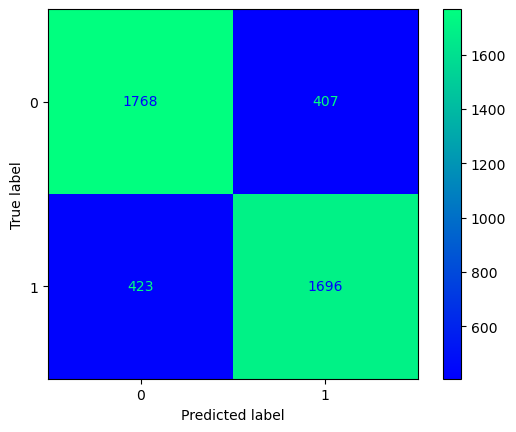

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.81      0.81      0.81      2175
           1       0.81      0.80      0.80      2119

    accuracy                           0.81      4294
   macro avg       0.81      0.81      0.81      4294
weighted avg       0.81      0.81      0.81      4294

-------------------------


In [569]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m6_15min.catboost_GridS()

In [570]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m6_15min,y_val_m6_15min)

Accuracy validación 0.6247438047326253


In [571]:
guardar_modelo(modelo_entrenado_15min,"m6_catboost_GridS_15min")

### Partidas 10 min

Hora de inicio:  15:22:34
0:	learn: 0.6792899	test: 0.6799498	best: 0.6799498 (0)	total: 3.77ms	remaining: 373ms
1:	learn: 0.6673570	test: 0.6685300	best: 0.6685300 (1)	total: 7.12ms	remaining: 349ms
2:	learn: 0.6562104	test: 0.6574124	best: 0.6574124 (2)	total: 10.3ms	remaining: 334ms
3:	learn: 0.6463607	test: 0.6476008	best: 0.6476008 (3)	total: 13.4ms	remaining: 321ms
4:	learn: 0.6370008	test: 0.6385877	best: 0.6385877 (4)	total: 17.2ms	remaining: 328ms
5:	learn: 0.6290374	test: 0.6306030	best: 0.6306030 (5)	total: 20.7ms	remaining: 324ms
6:	learn: 0.6217772	test: 0.6232499	best: 0.6232499 (6)	total: 23.8ms	remaining: 317ms
7:	learn: 0.6155478	test: 0.6172070	best: 0.6172070 (7)	total: 27.7ms	remaining: 318ms
8:	learn: 0.6103130	test: 0.6123064	best: 0.6123064 (8)	total: 30.7ms	remaining: 310ms
9:	learn: 0.6043567	test: 0.6066977	best: 0.6066977 (9)	total: 34.5ms	remaining: 311ms
10:	learn: 0.5992548	test: 0.6017636	best: 0.6017636 (10)	total: 37.7ms	remaining: 305ms
11:	learn: 0.59

0:	loss: 0.5257999	best: 0.5257999 (0)	total: 400ms	remaining: 53.6s
0:	learn: 0.6663176	test: 0.6676106	best: 0.6676106 (0)	total: 4.43ms	remaining: 438ms
1:	learn: 0.6468615	test: 0.6484419	best: 0.6484419 (1)	total: 7.57ms	remaining: 371ms
2:	learn: 0.6296273	test: 0.6317154	best: 0.6317154 (2)	total: 10.7ms	remaining: 344ms
3:	learn: 0.6159531	test: 0.6186778	best: 0.6186778 (3)	total: 16ms	remaining: 384ms
4:	learn: 0.6041884	test: 0.6071520	best: 0.6071520 (4)	total: 19.2ms	remaining: 365ms
5:	learn: 0.5937870	test: 0.5963473	best: 0.5963473 (5)	total: 22.6ms	remaining: 354ms
6:	learn: 0.5855115	test: 0.5887297	best: 0.5887297 (6)	total: 25.6ms	remaining: 341ms
7:	learn: 0.5775341	test: 0.5817531	best: 0.5817531 (7)	total: 29.1ms	remaining: 335ms
8:	learn: 0.5721173	test: 0.5767244	best: 0.5767244 (8)	total: 32.9ms	remaining: 333ms
9:	learn: 0.5668767	test: 0.5712441	best: 0.5712441 (9)	total: 35.9ms	remaining: 323ms
10:	learn: 0.5613531	test: 0.5658304	best: 0.5658304 (10)	total

96:	learn: 0.5029632	test: 0.5201779	best: 0.5201779 (96)	total: 378ms	remaining: 11.7ms
97:	learn: 0.5028170	test: 0.5201669	best: 0.5201669 (97)	total: 383ms	remaining: 7.82ms
98:	learn: 0.5026193	test: 0.5202484	best: 0.5201669 (97)	total: 387ms	remaining: 3.91ms
99:	learn: 0.5024205	test: 0.5203334	best: 0.5201669 (97)	total: 391ms	remaining: 0us

bestTest = 0.5201669234
bestIteration = 97

1:	loss: 0.5201669	best: 0.5201669 (1)	total: 797ms	remaining: 53s
0:	learn: 0.6542395	test: 0.6561245	best: 0.6561245 (0)	total: 3.9ms	remaining: 387ms
1:	learn: 0.6286447	test: 0.6308661	best: 0.6308661 (1)	total: 7.11ms	remaining: 349ms
2:	learn: 0.6065541	test: 0.6090924	best: 0.6090924 (2)	total: 10.2ms	remaining: 330ms
3:	learn: 0.5902593	test: 0.5934670	best: 0.5934670 (3)	total: 13.3ms	remaining: 320ms
4:	learn: 0.5800053	test: 0.5833423	best: 0.5833423 (4)	total: 16.3ms	remaining: 310ms
5:	learn: 0.5693604	test: 0.5734383	best: 0.5734383 (5)	total: 19.5ms	remaining: 305ms
6:	learn: 0.56

17:	learn: 0.5205515	test: 0.5312593	best: 0.5310436 (16)	total: 58ms	remaining: 264ms
18:	learn: 0.5197396	test: 0.5304259	best: 0.5304259 (18)	total: 62.5ms	remaining: 266ms
19:	learn: 0.5188141	test: 0.5300646	best: 0.5300646 (19)	total: 67ms	remaining: 268ms
20:	learn: 0.5180507	test: 0.5301788	best: 0.5300646 (19)	total: 77.5ms	remaining: 291ms
21:	learn: 0.5173465	test: 0.5294560	best: 0.5294560 (21)	total: 86.8ms	remaining: 308ms
22:	learn: 0.5167397	test: 0.5289575	best: 0.5289575 (22)	total: 90.6ms	remaining: 303ms
23:	learn: 0.5159469	test: 0.5280781	best: 0.5280781 (23)	total: 93.6ms	remaining: 296ms
24:	learn: 0.5150469	test: 0.5273502	best: 0.5273502 (24)	total: 96.5ms	remaining: 289ms
25:	learn: 0.5143924	test: 0.5267931	best: 0.5267931 (25)	total: 99.7ms	remaining: 284ms
26:	learn: 0.5138001	test: 0.5261574	best: 0.5261574 (26)	total: 103ms	remaining: 278ms
27:	learn: 0.5133860	test: 0.5258063	best: 0.5258063 (27)	total: 106ms	remaining: 272ms
28:	learn: 0.5128716	test: 

36:	learn: 0.4953999	test: 0.5287721	best: 0.5250963 (23)	total: 118ms	remaining: 201ms
37:	learn: 0.4947600	test: 0.5288131	best: 0.5250963 (23)	total: 122ms	remaining: 200ms
38:	learn: 0.4941631	test: 0.5284994	best: 0.5250963 (23)	total: 127ms	remaining: 198ms
39:	learn: 0.4938469	test: 0.5284194	best: 0.5250963 (23)	total: 132ms	remaining: 198ms
40:	learn: 0.4929787	test: 0.5294540	best: 0.5250963 (23)	total: 140ms	remaining: 201ms
41:	learn: 0.4925348	test: 0.5291121	best: 0.5250963 (23)	total: 147ms	remaining: 203ms
42:	learn: 0.4919740	test: 0.5291857	best: 0.5250963 (23)	total: 150ms	remaining: 199ms
43:	learn: 0.4916595	test: 0.5294576	best: 0.5250963 (23)	total: 153ms	remaining: 194ms
44:	learn: 0.4915117	test: 0.5296308	best: 0.5250963 (23)	total: 156ms	remaining: 191ms
45:	learn: 0.4905642	test: 0.5324575	best: 0.5250963 (23)	total: 160ms	remaining: 188ms
46:	learn: 0.4897616	test: 0.5326389	best: 0.5250963 (23)	total: 163ms	remaining: 184ms
47:	learn: 0.4892133	test: 0.532

54:	learn: 0.5268139	test: 0.5361149	best: 0.5361149 (54)	total: 183ms	remaining: 150ms
55:	learn: 0.5263421	test: 0.5355863	best: 0.5355863 (55)	total: 187ms	remaining: 147ms
56:	learn: 0.5259207	test: 0.5351402	best: 0.5351402 (56)	total: 192ms	remaining: 145ms
57:	learn: 0.5254623	test: 0.5345889	best: 0.5345889 (57)	total: 196ms	remaining: 142ms
58:	learn: 0.5249115	test: 0.5342534	best: 0.5342534 (58)	total: 206ms	remaining: 143ms
59:	learn: 0.5242821	test: 0.5338369	best: 0.5338369 (59)	total: 211ms	remaining: 140ms
60:	learn: 0.5238457	test: 0.5333449	best: 0.5333449 (60)	total: 215ms	remaining: 137ms
61:	learn: 0.5233614	test: 0.5330730	best: 0.5330730 (61)	total: 218ms	remaining: 134ms
62:	learn: 0.5230229	test: 0.5327893	best: 0.5327893 (62)	total: 221ms	remaining: 130ms
63:	learn: 0.5226598	test: 0.5324677	best: 0.5324677 (63)	total: 224ms	remaining: 126ms
64:	learn: 0.5223916	test: 0.5323803	best: 0.5323803 (64)	total: 228ms	remaining: 123ms
65:	learn: 0.5220010	test: 0.532

78:	learn: 0.5061152	test: 0.5211338	best: 0.5211301 (77)	total: 263ms	remaining: 70ms
79:	learn: 0.5058949	test: 0.5211594	best: 0.5211301 (77)	total: 268ms	remaining: 66.9ms
80:	learn: 0.5057046	test: 0.5210831	best: 0.5210831 (80)	total: 272ms	remaining: 63.7ms
81:	learn: 0.5055931	test: 0.5209717	best: 0.5209717 (81)	total: 275ms	remaining: 60.4ms
82:	learn: 0.5054719	test: 0.5208717	best: 0.5208717 (82)	total: 279ms	remaining: 57.2ms
83:	learn: 0.5053193	test: 0.5208127	best: 0.5208127 (83)	total: 283ms	remaining: 53.9ms
84:	learn: 0.5051213	test: 0.5207476	best: 0.5207476 (84)	total: 288ms	remaining: 50.8ms
85:	learn: 0.5049863	test: 0.5206571	best: 0.5206571 (85)	total: 292ms	remaining: 47.6ms
86:	learn: 0.5048857	test: 0.5206524	best: 0.5206524 (86)	total: 296ms	remaining: 44.2ms
87:	learn: 0.5046516	test: 0.5204931	best: 0.5204931 (87)	total: 299ms	remaining: 40.7ms
88:	learn: 0.5045214	test: 0.5204808	best: 0.5204808 (88)	total: 301ms	remaining: 37.3ms
89:	learn: 0.5042818	te

2:	learn: 0.5900487	test: 0.5936291	best: 0.5936291 (2)	total: 9.79ms	remaining: 316ms
3:	learn: 0.5756762	test: 0.5798738	best: 0.5798738 (3)	total: 14.4ms	remaining: 345ms
4:	learn: 0.5618569	test: 0.5668708	best: 0.5668708 (4)	total: 18.2ms	remaining: 346ms
5:	learn: 0.5537649	test: 0.5600113	best: 0.5600113 (5)	total: 22.2ms	remaining: 348ms
6:	learn: 0.5481599	test: 0.5542640	best: 0.5542640 (6)	total: 32.7ms	remaining: 435ms
7:	learn: 0.5427054	test: 0.5494478	best: 0.5494478 (7)	total: 37.8ms	remaining: 435ms
8:	learn: 0.5385773	test: 0.5459559	best: 0.5459559 (8)	total: 40.9ms	remaining: 413ms
9:	learn: 0.5352470	test: 0.5432199	best: 0.5432199 (9)	total: 44.9ms	remaining: 404ms
10:	learn: 0.5319394	test: 0.5406076	best: 0.5406076 (10)	total: 48.2ms	remaining: 390ms
11:	learn: 0.5294243	test: 0.5383142	best: 0.5383142 (11)	total: 51.2ms	remaining: 375ms
12:	learn: 0.5275372	test: 0.5365019	best: 0.5365019 (12)	total: 54.5ms	remaining: 365ms
13:	learn: 0.5258492	test: 0.5343113	

22:	learn: 0.5059584	test: 0.5259379	best: 0.5254781 (18)	total: 70.9ms	remaining: 237ms
23:	learn: 0.5044864	test: 0.5250963	best: 0.5250963 (23)	total: 75.6ms	remaining: 239ms
24:	learn: 0.5035936	test: 0.5258918	best: 0.5250963 (23)	total: 79.3ms	remaining: 238ms
25:	learn: 0.5027232	test: 0.5254051	best: 0.5250963 (23)	total: 84.9ms	remaining: 242ms
26:	learn: 0.5020643	test: 0.5258668	best: 0.5250963 (23)	total: 90.9ms	remaining: 246ms
27:	learn: 0.5013603	test: 0.5271022	best: 0.5250963 (23)	total: 95.2ms	remaining: 245ms
28:	learn: 0.5002730	test: 0.5264787	best: 0.5250963 (23)	total: 100ms	remaining: 246ms
29:	learn: 0.4992740	test: 0.5266196	best: 0.5250963 (23)	total: 103ms	remaining: 241ms
30:	learn: 0.4986177	test: 0.5270061	best: 0.5250963 (23)	total: 106ms	remaining: 236ms
31:	learn: 0.4980528	test: 0.5268330	best: 0.5250963 (23)	total: 109ms	remaining: 232ms
32:	learn: 0.4975166	test: 0.5273988	best: 0.5250963 (23)	total: 113ms	remaining: 228ms
33:	learn: 0.4972435	test:

39:	learn: 0.5370209	test: 0.5443724	best: 0.5443724 (39)	total: 130ms	remaining: 194ms
40:	learn: 0.5360909	test: 0.5435362	best: 0.5435362 (40)	total: 134ms	remaining: 193ms
41:	learn: 0.5353293	test: 0.5429442	best: 0.5429442 (41)	total: 138ms	remaining: 191ms
42:	learn: 0.5344960	test: 0.5423255	best: 0.5423255 (42)	total: 143ms	remaining: 189ms
43:	learn: 0.5337956	test: 0.5417804	best: 0.5417804 (43)	total: 147ms	remaining: 187ms
44:	learn: 0.5328503	test: 0.5411148	best: 0.5411148 (44)	total: 151ms	remaining: 185ms
45:	learn: 0.5320200	test: 0.5405176	best: 0.5405176 (45)	total: 155ms	remaining: 182ms
46:	learn: 0.5314163	test: 0.5400160	best: 0.5400160 (46)	total: 160ms	remaining: 180ms
47:	learn: 0.5307204	test: 0.5393899	best: 0.5393899 (47)	total: 163ms	remaining: 177ms
48:	learn: 0.5302971	test: 0.5389564	best: 0.5389564 (48)	total: 167ms	remaining: 173ms
49:	learn: 0.5298060	test: 0.5385832	best: 0.5385832 (49)	total: 170ms	remaining: 170ms
50:	learn: 0.5293048	test: 0.538

61:	learn: 0.5093478	test: 0.5228876	best: 0.5228876 (61)	total: 206ms	remaining: 126ms
62:	learn: 0.5091076	test: 0.5228227	best: 0.5228227 (62)	total: 210ms	remaining: 124ms
63:	learn: 0.5087700	test: 0.5225216	best: 0.5225216 (63)	total: 215ms	remaining: 121ms
64:	learn: 0.5086045	test: 0.5224400	best: 0.5224400 (64)	total: 221ms	remaining: 119ms
65:	learn: 0.5084289	test: 0.5225171	best: 0.5224400 (64)	total: 229ms	remaining: 118ms
66:	learn: 0.5082342	test: 0.5225644	best: 0.5224400 (64)	total: 233ms	remaining: 115ms
67:	learn: 0.5080955	test: 0.5225140	best: 0.5224400 (64)	total: 237ms	remaining: 112ms
68:	learn: 0.5079357	test: 0.5223714	best: 0.5223714 (68)	total: 240ms	remaining: 108ms
69:	learn: 0.5076587	test: 0.5220625	best: 0.5220625 (69)	total: 243ms	remaining: 104ms
70:	learn: 0.5075026	test: 0.5219513	best: 0.5219513 (70)	total: 247ms	remaining: 101ms
71:	learn: 0.5072896	test: 0.5217366	best: 0.5217366 (71)	total: 250ms	remaining: 97.3ms
72:	learn: 0.5071306	test: 0.52

88:	learn: 0.4975688	test: 0.5219577	best: 0.5216245 (66)	total: 283ms	remaining: 35ms
89:	learn: 0.4973226	test: 0.5224759	best: 0.5216245 (66)	total: 288ms	remaining: 32ms
90:	learn: 0.4970759	test: 0.5226466	best: 0.5216245 (66)	total: 291ms	remaining: 28.8ms
91:	learn: 0.4965906	test: 0.5222950	best: 0.5216245 (66)	total: 295ms	remaining: 25.7ms
92:	learn: 0.4962980	test: 0.5220605	best: 0.5216245 (66)	total: 301ms	remaining: 22.7ms
93:	learn: 0.4960815	test: 0.5221905	best: 0.5216245 (66)	total: 310ms	remaining: 19.8ms
94:	learn: 0.4958503	test: 0.5221146	best: 0.5216245 (66)	total: 314ms	remaining: 16.6ms
95:	learn: 0.4955640	test: 0.5221705	best: 0.5216245 (66)	total: 317ms	remaining: 13.2ms
96:	learn: 0.4952960	test: 0.5222568	best: 0.5216245 (66)	total: 320ms	remaining: 9.91ms
97:	learn: 0.4949530	test: 0.5224708	best: 0.5216245 (66)	total: 324ms	remaining: 6.6ms
98:	learn: 0.4946763	test: 0.5225673	best: 0.5216245 (66)	total: 327ms	remaining: 3.3ms
99:	learn: 0.4944370	test: 

8:	learn: 0.5192108	test: 0.5312245	best: 0.5312245 (8)	total: 29.4ms	remaining: 297ms
9:	learn: 0.5176560	test: 0.5311131	best: 0.5311131 (9)	total: 33.8ms	remaining: 305ms
10:	learn: 0.5164524	test: 0.5293420	best: 0.5293420 (10)	total: 37.8ms	remaining: 306ms
11:	learn: 0.5156417	test: 0.5290112	best: 0.5290112 (11)	total: 43.5ms	remaining: 319ms
12:	learn: 0.5144938	test: 0.5286922	best: 0.5286922 (12)	total: 52.6ms	remaining: 352ms
13:	learn: 0.5140112	test: 0.5286207	best: 0.5286207 (13)	total: 56.2ms	remaining: 345ms
14:	learn: 0.5127568	test: 0.5281330	best: 0.5281330 (14)	total: 59.2ms	remaining: 336ms
15:	learn: 0.5121169	test: 0.5273429	best: 0.5273429 (15)	total: 62.5ms	remaining: 328ms
16:	learn: 0.5108388	test: 0.5265240	best: 0.5265240 (16)	total: 65.8ms	remaining: 321ms
17:	learn: 0.5103897	test: 0.5260402	best: 0.5260402 (17)	total: 68.8ms	remaining: 313ms
18:	learn: 0.5091333	test: 0.5254781	best: 0.5254781 (18)	total: 71.8ms	remaining: 306ms
19:	learn: 0.5080995	test

34:	learn: 0.5423535	test: 0.5488355	best: 0.5488355 (34)	total: 109ms	remaining: 358ms
35:	learn: 0.5413167	test: 0.5479907	best: 0.5479907 (35)	total: 113ms	remaining: 358ms
36:	learn: 0.5403118	test: 0.5471298	best: 0.5471298 (36)	total: 117ms	remaining: 358ms
37:	learn: 0.5395758	test: 0.5462794	best: 0.5462794 (37)	total: 121ms	remaining: 357ms
38:	learn: 0.5384151	test: 0.5453007	best: 0.5453007 (38)	total: 125ms	remaining: 357ms
39:	learn: 0.5370209	test: 0.5443724	best: 0.5443724 (39)	total: 129ms	remaining: 356ms
40:	learn: 0.5360909	test: 0.5435362	best: 0.5435362 (40)	total: 133ms	remaining: 355ms
41:	learn: 0.5353293	test: 0.5429442	best: 0.5429442 (41)	total: 139ms	remaining: 356ms
42:	learn: 0.5344960	test: 0.5423255	best: 0.5423255 (42)	total: 143ms	remaining: 356ms
43:	learn: 0.5337956	test: 0.5417804	best: 0.5417804 (43)	total: 146ms	remaining: 353ms
44:	learn: 0.5328503	test: 0.5411148	best: 0.5411148 (44)	total: 150ms	remaining: 349ms
45:	learn: 0.5320200	test: 0.540

7:	learn: 0.5775341	test: 0.5817531	best: 0.5817531 (7)	total: 25ms	remaining: 444ms
8:	learn: 0.5721173	test: 0.5767244	best: 0.5767244 (8)	total: 29.9ms	remaining: 468ms
9:	learn: 0.5668767	test: 0.5712441	best: 0.5712441 (9)	total: 35.3ms	remaining: 494ms
10:	learn: 0.5613531	test: 0.5658304	best: 0.5658304 (10)	total: 41.5ms	remaining: 524ms
11:	learn: 0.5574647	test: 0.5618987	best: 0.5618987 (11)	total: 46ms	remaining: 529ms
12:	learn: 0.5542881	test: 0.5588404	best: 0.5588404 (12)	total: 50.1ms	remaining: 528ms
13:	learn: 0.5507084	test: 0.5557745	best: 0.5557745 (13)	total: 55ms	remaining: 534ms
14:	learn: 0.5483300	test: 0.5536752	best: 0.5536752 (14)	total: 58.5ms	remaining: 526ms
15:	learn: 0.5452090	test: 0.5512235	best: 0.5512235 (15)	total: 61.5ms	remaining: 515ms
16:	learn: 0.5419405	test: 0.5485829	best: 0.5485829 (16)	total: 65ms	remaining: 508ms
17:	learn: 0.5400560	test: 0.5465198	best: 0.5465198 (17)	total: 68.5ms	remaining: 502ms
18:	learn: 0.5382393	test: 0.544880

130:	learn: 0.4961380	test: 0.5202016	best: 0.5194837 (118)	total: 429ms	remaining: 62.1ms
131:	learn: 0.4957179	test: 0.5200233	best: 0.5194837 (118)	total: 433ms	remaining: 59.1ms
132:	learn: 0.4954534	test: 0.5200452	best: 0.5194837 (118)	total: 437ms	remaining: 55.9ms
133:	learn: 0.4952437	test: 0.5201443	best: 0.5194837 (118)	total: 441ms	remaining: 52.7ms
134:	learn: 0.4950197	test: 0.5203758	best: 0.5194837 (118)	total: 445ms	remaining: 49.5ms
135:	learn: 0.4948604	test: 0.5203854	best: 0.5194837 (118)	total: 450ms	remaining: 46.3ms
136:	learn: 0.4947154	test: 0.5203311	best: 0.5194837 (118)	total: 454ms	remaining: 43ms
137:	learn: 0.4945516	test: 0.5204544	best: 0.5194837 (118)	total: 457ms	remaining: 39.7ms
138:	learn: 0.4944012	test: 0.5203959	best: 0.5194837 (118)	total: 460ms	remaining: 36.4ms
139:	learn: 0.4942288	test: 0.5203559	best: 0.5194837 (118)	total: 464ms	remaining: 33.1ms
140:	learn: 0.4941075	test: 0.5205524	best: 0.5194837 (118)	total: 467ms	remaining: 29.8ms
1

101:	learn: 0.4940065	test: 0.5225120	best: 0.5216245 (66)	total: 331ms	remaining: 156ms
102:	learn: 0.4937786	test: 0.5223427	best: 0.5216245 (66)	total: 335ms	remaining: 153ms
103:	learn: 0.4935791	test: 0.5224153	best: 0.5216245 (66)	total: 339ms	remaining: 150ms
104:	learn: 0.4931596	test: 0.5227663	best: 0.5216245 (66)	total: 344ms	remaining: 148ms
105:	learn: 0.4929291	test: 0.5228592	best: 0.5216245 (66)	total: 355ms	remaining: 147ms
106:	learn: 0.4926663	test: 0.5228162	best: 0.5216245 (66)	total: 363ms	remaining: 146ms
107:	learn: 0.4922324	test: 0.5225214	best: 0.5216245 (66)	total: 366ms	remaining: 142ms
108:	learn: 0.4919941	test: 0.5223004	best: 0.5216245 (66)	total: 369ms	remaining: 139ms
109:	learn: 0.4918125	test: 0.5224069	best: 0.5216245 (66)	total: 372ms	remaining: 135ms
110:	learn: 0.4916044	test: 0.5226117	best: 0.5216245 (66)	total: 375ms	remaining: 132ms
111:	learn: 0.4914064	test: 0.5224237	best: 0.5216245 (66)	total: 378ms	remaining: 128ms
112:	learn: 0.4912493

71:	learn: 0.4953045	test: 0.5238851	best: 0.5220157 (43)	total: 235ms	remaining: 255ms
72:	learn: 0.4948604	test: 0.5237789	best: 0.5220157 (43)	total: 239ms	remaining: 252ms
73:	learn: 0.4944999	test: 0.5238146	best: 0.5220157 (43)	total: 243ms	remaining: 250ms
74:	learn: 0.4941304	test: 0.5238159	best: 0.5220157 (43)	total: 247ms	remaining: 247ms
75:	learn: 0.4937651	test: 0.5237634	best: 0.5220157 (43)	total: 252ms	remaining: 245ms
76:	learn: 0.4934545	test: 0.5238238	best: 0.5220157 (43)	total: 259ms	remaining: 246ms
77:	learn: 0.4931747	test: 0.5239076	best: 0.5220157 (43)	total: 264ms	remaining: 243ms
78:	learn: 0.4928988	test: 0.5238501	best: 0.5220157 (43)	total: 267ms	remaining: 240ms
79:	learn: 0.4924607	test: 0.5238013	best: 0.5220157 (43)	total: 270ms	remaining: 236ms
80:	learn: 0.4921397	test: 0.5241433	best: 0.5220157 (43)	total: 273ms	remaining: 232ms
81:	learn: 0.4916925	test: 0.5245729	best: 0.5220157 (43)	total: 276ms	remaining: 229ms
82:	learn: 0.4913552	test: 0.524

44:	learn: 0.4915117	test: 0.5296308	best: 0.5250963 (23)	total: 141ms	remaining: 329ms
45:	learn: 0.4905642	test: 0.5324575	best: 0.5250963 (23)	total: 145ms	remaining: 328ms
46:	learn: 0.4897616	test: 0.5326389	best: 0.5250963 (23)	total: 149ms	remaining: 327ms
47:	learn: 0.4892133	test: 0.5328399	best: 0.5250963 (23)	total: 154ms	remaining: 328ms
48:	learn: 0.4886322	test: 0.5329777	best: 0.5250963 (23)	total: 163ms	remaining: 336ms
49:	learn: 0.4879944	test: 0.5326478	best: 0.5250963 (23)	total: 169ms	remaining: 339ms
50:	learn: 0.4873441	test: 0.5325946	best: 0.5250963 (23)	total: 173ms	remaining: 336ms
51:	learn: 0.4867549	test: 0.5369893	best: 0.5250963 (23)	total: 177ms	remaining: 333ms
52:	learn: 0.4861289	test: 0.5370250	best: 0.5250963 (23)	total: 180ms	remaining: 329ms
53:	learn: 0.4855593	test: 0.5375591	best: 0.5250963 (23)	total: 183ms	remaining: 325ms
54:	learn: 0.4852534	test: 0.5375095	best: 0.5250963 (23)	total: 186ms	remaining: 321ms
55:	learn: 0.4847021	test: 0.537

26:	learn: 0.5521152	test: 0.5578540	best: 0.5578540 (26)	total: 85.2ms	remaining: 388ms
27:	learn: 0.5505527	test: 0.5562984	best: 0.5562984 (27)	total: 89.4ms	remaining: 390ms
28:	learn: 0.5487146	test: 0.5548689	best: 0.5548689 (28)	total: 93.7ms	remaining: 391ms
29:	learn: 0.5473577	test: 0.5534637	best: 0.5534637 (29)	total: 103ms	remaining: 411ms
30:	learn: 0.5464707	test: 0.5525417	best: 0.5525417 (30)	total: 112ms	remaining: 430ms
31:	learn: 0.5454294	test: 0.5515686	best: 0.5515686 (31)	total: 116ms	remaining: 427ms
32:	learn: 0.5444040	test: 0.5506214	best: 0.5506214 (32)	total: 119ms	remaining: 423ms
33:	learn: 0.5433462	test: 0.5495281	best: 0.5495281 (33)	total: 122ms	remaining: 418ms
34:	learn: 0.5423535	test: 0.5488355	best: 0.5488355 (34)	total: 126ms	remaining: 413ms
35:	learn: 0.5413167	test: 0.5479907	best: 0.5479907 (35)	total: 129ms	remaining: 408ms
36:	learn: 0.5403118	test: 0.5471298	best: 0.5471298 (36)	total: 132ms	remaining: 404ms
37:	learn: 0.5395758	test: 0.

146:	learn: 0.5083630	test: 0.5222996	best: 0.5222996 (146)	total: 487ms	remaining: 9.93ms
147:	learn: 0.5081299	test: 0.5223160	best: 0.5222996 (146)	total: 491ms	remaining: 6.63ms
148:	learn: 0.5079986	test: 0.5222287	best: 0.5222287 (148)	total: 495ms	remaining: 3.32ms
149:	learn: 0.5078726	test: 0.5223658	best: 0.5222287 (148)	total: 499ms	remaining: 0us

bestTest = 0.5222286979
bestIteration = 148

20:	loss: 0.5222287	best: 0.5194837 (16)	total: 8.22s	remaining: 44.6s
0:	learn: 0.6663176	test: 0.6676106	best: 0.6676106 (0)	total: 4.7ms	remaining: 701ms
1:	learn: 0.6468615	test: 0.6484419	best: 0.6484419 (1)	total: 8.99ms	remaining: 665ms
2:	learn: 0.6296273	test: 0.6317154	best: 0.6317154 (2)	total: 12.6ms	remaining: 620ms
3:	learn: 0.6159531	test: 0.6186778	best: 0.6186778 (3)	total: 15.6ms	remaining: 571ms
4:	learn: 0.6041884	test: 0.6071520	best: 0.6071520 (4)	total: 18.7ms	remaining: 543ms
5:	learn: 0.5937870	test: 0.5963473	best: 0.5963473 (5)	total: 21.8ms	remaining: 522ms
6

121:	learn: 0.4978612	test: 0.5196668	best: 0.5194837 (118)	total: 403ms	remaining: 92.5ms
122:	learn: 0.4976074	test: 0.5198633	best: 0.5194837 (118)	total: 407ms	remaining: 89.4ms
123:	learn: 0.4973950	test: 0.5200231	best: 0.5194837 (118)	total: 411ms	remaining: 86.2ms
124:	learn: 0.4972467	test: 0.5200582	best: 0.5194837 (118)	total: 415ms	remaining: 83.1ms
125:	learn: 0.4970216	test: 0.5202313	best: 0.5194837 (118)	total: 420ms	remaining: 80ms
126:	learn: 0.4968168	test: 0.5203008	best: 0.5194837 (118)	total: 424ms	remaining: 76.8ms
127:	learn: 0.4965954	test: 0.5202482	best: 0.5194837 (118)	total: 428ms	remaining: 73.6ms
128:	learn: 0.4964605	test: 0.5201911	best: 0.5194837 (118)	total: 432ms	remaining: 70.4ms
129:	learn: 0.4962828	test: 0.5202482	best: 0.5194837 (118)	total: 436ms	remaining: 67.1ms
130:	learn: 0.4961380	test: 0.5202016	best: 0.5194837 (118)	total: 439ms	remaining: 63.7ms
131:	learn: 0.4957179	test: 0.5200233	best: 0.5194837 (118)	total: 442ms	remaining: 60.3ms
1

95:	learn: 0.4955640	test: 0.5221705	best: 0.5216245 (66)	total: 305ms	remaining: 171ms
96:	learn: 0.4952960	test: 0.5222568	best: 0.5216245 (66)	total: 309ms	remaining: 169ms
97:	learn: 0.4949530	test: 0.5224708	best: 0.5216245 (66)	total: 313ms	remaining: 166ms
98:	learn: 0.4946763	test: 0.5225673	best: 0.5216245 (66)	total: 317ms	remaining: 163ms
99:	learn: 0.4944370	test: 0.5224562	best: 0.5216245 (66)	total: 325ms	remaining: 162ms
100:	learn: 0.4942445	test: 0.5225230	best: 0.5216245 (66)	total: 332ms	remaining: 161ms
101:	learn: 0.4940065	test: 0.5225120	best: 0.5216245 (66)	total: 335ms	remaining: 158ms
102:	learn: 0.4937786	test: 0.5223427	best: 0.5216245 (66)	total: 338ms	remaining: 154ms
103:	learn: 0.4935791	test: 0.5224153	best: 0.5216245 (66)	total: 341ms	remaining: 151ms
104:	learn: 0.4931596	test: 0.5227663	best: 0.5216245 (66)	total: 344ms	remaining: 148ms
105:	learn: 0.4929291	test: 0.5228592	best: 0.5216245 (66)	total: 348ms	remaining: 144ms
106:	learn: 0.4926663	test

67:	learn: 0.4966990	test: 0.5236265	best: 0.5220157 (43)	total: 225ms	remaining: 271ms
68:	learn: 0.4963805	test: 0.5236437	best: 0.5220157 (43)	total: 229ms	remaining: 269ms
69:	learn: 0.4959923	test: 0.5239850	best: 0.5220157 (43)	total: 233ms	remaining: 266ms
70:	learn: 0.4955985	test: 0.5239872	best: 0.5220157 (43)	total: 240ms	remaining: 267ms
71:	learn: 0.4953045	test: 0.5238851	best: 0.5220157 (43)	total: 248ms	remaining: 269ms
72:	learn: 0.4948604	test: 0.5237789	best: 0.5220157 (43)	total: 256ms	remaining: 270ms
73:	learn: 0.4944999	test: 0.5238146	best: 0.5220157 (43)	total: 259ms	remaining: 266ms
74:	learn: 0.4941304	test: 0.5238159	best: 0.5220157 (43)	total: 262ms	remaining: 262ms
75:	learn: 0.4937651	test: 0.5237634	best: 0.5220157 (43)	total: 265ms	remaining: 258ms
76:	learn: 0.4934545	test: 0.5238238	best: 0.5220157 (43)	total: 268ms	remaining: 254ms
77:	learn: 0.4931747	test: 0.5239076	best: 0.5220157 (43)	total: 271ms	remaining: 251ms
78:	learn: 0.4928988	test: 0.523

37:	learn: 0.4947600	test: 0.5288131	best: 0.5250963 (23)	total: 118ms	remaining: 348ms
38:	learn: 0.4941631	test: 0.5284994	best: 0.5250963 (23)	total: 123ms	remaining: 349ms
39:	learn: 0.4938469	test: 0.5284194	best: 0.5250963 (23)	total: 126ms	remaining: 347ms
40:	learn: 0.4929787	test: 0.5294540	best: 0.5250963 (23)	total: 132ms	remaining: 350ms
41:	learn: 0.4925348	test: 0.5291121	best: 0.5250963 (23)	total: 140ms	remaining: 361ms
42:	learn: 0.4919740	test: 0.5291857	best: 0.5250963 (23)	total: 146ms	remaining: 362ms
43:	learn: 0.4916595	test: 0.5294576	best: 0.5250963 (23)	total: 149ms	remaining: 358ms
44:	learn: 0.4915117	test: 0.5296308	best: 0.5250963 (23)	total: 152ms	remaining: 354ms
45:	learn: 0.4905642	test: 0.5324575	best: 0.5250963 (23)	total: 155ms	remaining: 350ms
46:	learn: 0.4897616	test: 0.5326389	best: 0.5250963 (23)	total: 158ms	remaining: 346ms
47:	learn: 0.4892133	test: 0.5328399	best: 0.5250963 (23)	total: 161ms	remaining: 343ms
48:	learn: 0.4886322	test: 0.532

10:	learn: 0.5992548	test: 0.6017636	best: 0.6017636 (10)	total: 34.5ms	remaining: 436ms
11:	learn: 0.5946732	test: 0.5975207	best: 0.5975207 (11)	total: 38.8ms	remaining: 447ms
12:	learn: 0.5901427	test: 0.5930992	best: 0.5930992 (12)	total: 42.9ms	remaining: 453ms
13:	learn: 0.5862184	test: 0.5892314	best: 0.5892314 (13)	total: 46.9ms	remaining: 455ms
14:	learn: 0.5819147	test: 0.5853168	best: 0.5853168 (14)	total: 51.2ms	remaining: 461ms
15:	learn: 0.5782857	test: 0.5822861	best: 0.5822861 (15)	total: 55.2ms	remaining: 462ms
16:	learn: 0.5751033	test: 0.5791242	best: 0.5791242 (16)	total: 59.1ms	remaining: 463ms
17:	learn: 0.5714860	test: 0.5759509	best: 0.5759509 (17)	total: 63.6ms	remaining: 467ms
18:	learn: 0.5690918	test: 0.5735536	best: 0.5735536 (18)	total: 67.4ms	remaining: 465ms
19:	learn: 0.5666191	test: 0.5710326	best: 0.5710326 (19)	total: 70.6ms	remaining: 459ms
20:	learn: 0.5637678	test: 0.5686978	best: 0.5686978 (20)	total: 74ms	remaining: 454ms
21:	learn: 0.5615425	te

132:	learn: 0.5100249	test: 0.5230344	best: 0.5230344 (132)	total: 437ms	remaining: 55.9ms
133:	learn: 0.5099184	test: 0.5230059	best: 0.5230059 (133)	total: 441ms	remaining: 52.7ms
134:	learn: 0.5097790	test: 0.5229028	best: 0.5229028 (134)	total: 446ms	remaining: 49.5ms
135:	learn: 0.5096922	test: 0.5229839	best: 0.5229028 (134)	total: 450ms	remaining: 46.4ms
136:	learn: 0.5096295	test: 0.5229613	best: 0.5229028 (134)	total: 458ms	remaining: 43.5ms
137:	learn: 0.5095590	test: 0.5229049	best: 0.5229028 (134)	total: 467ms	remaining: 40.6ms
138:	learn: 0.5094326	test: 0.5228207	best: 0.5228207 (138)	total: 470ms	remaining: 37.2ms
139:	learn: 0.5092645	test: 0.5226902	best: 0.5226902 (139)	total: 473ms	remaining: 33.8ms
140:	learn: 0.5091872	test: 0.5226577	best: 0.5226577 (140)	total: 476ms	remaining: 30.4ms
141:	learn: 0.5089859	test: 0.5226444	best: 0.5226444 (141)	total: 479ms	remaining: 27ms
142:	learn: 0.5088206	test: 0.5225191	best: 0.5225191 (142)	total: 483ms	remaining: 23.6ms
1

105:	learn: 0.5011419	test: 0.5200485	best: 0.5200256 (103)	total: 348ms	remaining: 144ms
106:	learn: 0.5009555	test: 0.5199713	best: 0.5199713 (106)	total: 351ms	remaining: 141ms
107:	learn: 0.5007306	test: 0.5196877	best: 0.5196877 (107)	total: 357ms	remaining: 139ms
108:	learn: 0.5004830	test: 0.5195957	best: 0.5195957 (108)	total: 361ms	remaining: 136ms
109:	learn: 0.5001803	test: 0.5196926	best: 0.5195957 (108)	total: 365ms	remaining: 133ms
110:	learn: 0.5000552	test: 0.5198240	best: 0.5195957 (108)	total: 369ms	remaining: 130ms
111:	learn: 0.4999093	test: 0.5197385	best: 0.5195957 (108)	total: 373ms	remaining: 127ms
112:	learn: 0.4996908	test: 0.5198922	best: 0.5195957 (108)	total: 377ms	remaining: 123ms
113:	learn: 0.4995706	test: 0.5199036	best: 0.5195957 (108)	total: 381ms	remaining: 120ms
114:	learn: 0.4992939	test: 0.5198315	best: 0.5195957 (108)	total: 384ms	remaining: 117ms
115:	learn: 0.4989986	test: 0.5196205	best: 0.5195957 (108)	total: 387ms	remaining: 114ms
116:	learn

84:	learn: 0.4988678	test: 0.5218331	best: 0.5216245 (66)	total: 273ms	remaining: 208ms
85:	learn: 0.4985797	test: 0.5219541	best: 0.5216245 (66)	total: 277ms	remaining: 206ms
86:	learn: 0.4982344	test: 0.5219718	best: 0.5216245 (66)	total: 280ms	remaining: 203ms
87:	learn: 0.4981034	test: 0.5220235	best: 0.5216245 (66)	total: 285ms	remaining: 201ms
88:	learn: 0.4975688	test: 0.5219577	best: 0.5216245 (66)	total: 289ms	remaining: 198ms
89:	learn: 0.4973226	test: 0.5224759	best: 0.5216245 (66)	total: 293ms	remaining: 196ms
90:	learn: 0.4970759	test: 0.5226466	best: 0.5216245 (66)	total: 297ms	remaining: 193ms
91:	learn: 0.4965906	test: 0.5222950	best: 0.5216245 (66)	total: 302ms	remaining: 190ms
92:	learn: 0.4962980	test: 0.5220605	best: 0.5216245 (66)	total: 305ms	remaining: 187ms
93:	learn: 0.4960815	test: 0.5221905	best: 0.5216245 (66)	total: 308ms	remaining: 183ms
94:	learn: 0.4958503	test: 0.5221146	best: 0.5216245 (66)	total: 311ms	remaining: 180ms
95:	learn: 0.4955640	test: 0.522

60:	learn: 0.4993205	test: 0.5233234	best: 0.5220157 (43)	total: 200ms	remaining: 292ms
61:	learn: 0.4988953	test: 0.5230749	best: 0.5220157 (43)	total: 204ms	remaining: 289ms
62:	learn: 0.4985267	test: 0.5231575	best: 0.5220157 (43)	total: 208ms	remaining: 287ms
63:	learn: 0.4981621	test: 0.5229337	best: 0.5220157 (43)	total: 212ms	remaining: 285ms
64:	learn: 0.4978289	test: 0.5231955	best: 0.5220157 (43)	total: 216ms	remaining: 283ms
65:	learn: 0.4972726	test: 0.5232313	best: 0.5220157 (43)	total: 224ms	remaining: 285ms
66:	learn: 0.4970193	test: 0.5231741	best: 0.5220157 (43)	total: 228ms	remaining: 282ms
67:	learn: 0.4966990	test: 0.5236265	best: 0.5220157 (43)	total: 231ms	remaining: 278ms
68:	learn: 0.4963805	test: 0.5236437	best: 0.5220157 (43)	total: 234ms	remaining: 274ms
69:	learn: 0.4959923	test: 0.5239850	best: 0.5220157 (43)	total: 237ms	remaining: 271ms
70:	learn: 0.4955985	test: 0.5239872	best: 0.5220157 (43)	total: 245ms	remaining: 273ms
71:	learn: 0.4953045	test: 0.523

38:	learn: 0.4941631	test: 0.5284994	best: 0.5250963 (23)	total: 121ms	remaining: 344ms
39:	learn: 0.4938469	test: 0.5284194	best: 0.5250963 (23)	total: 125ms	remaining: 343ms
40:	learn: 0.4929787	test: 0.5294540	best: 0.5250963 (23)	total: 128ms	remaining: 341ms
41:	learn: 0.4925348	test: 0.5291121	best: 0.5250963 (23)	total: 132ms	remaining: 340ms
42:	learn: 0.4919740	test: 0.5291857	best: 0.5250963 (23)	total: 136ms	remaining: 339ms
43:	learn: 0.4916595	test: 0.5294576	best: 0.5250963 (23)	total: 146ms	remaining: 351ms
44:	learn: 0.4915117	test: 0.5296308	best: 0.5250963 (23)	total: 149ms	remaining: 348ms
45:	learn: 0.4905642	test: 0.5324575	best: 0.5250963 (23)	total: 152ms	remaining: 344ms
46:	learn: 0.4897616	test: 0.5326389	best: 0.5250963 (23)	total: 156ms	remaining: 341ms
47:	learn: 0.4892133	test: 0.5328399	best: 0.5250963 (23)	total: 159ms	remaining: 337ms
48:	learn: 0.4886322	test: 0.5329777	best: 0.5250963 (23)	total: 161ms	remaining: 333ms
49:	learn: 0.4879944	test: 0.532

16:	learn: 0.5751033	test: 0.5791242	best: 0.5791242 (16)	total: 53.6ms	remaining: 577ms
17:	learn: 0.5714860	test: 0.5759509	best: 0.5759509 (17)	total: 58ms	remaining: 587ms
18:	learn: 0.5690918	test: 0.5735536	best: 0.5735536 (18)	total: 62.1ms	remaining: 591ms
19:	learn: 0.5666191	test: 0.5710326	best: 0.5710326 (19)	total: 66.2ms	remaining: 596ms
20:	learn: 0.5637678	test: 0.5686978	best: 0.5686978 (20)	total: 70.9ms	remaining: 605ms
21:	learn: 0.5615425	test: 0.5664426	best: 0.5664426 (21)	total: 74.9ms	remaining: 606ms
22:	learn: 0.5589516	test: 0.5643998	best: 0.5643998 (22)	total: 79.6ms	remaining: 613ms
23:	learn: 0.5569831	test: 0.5627496	best: 0.5627496 (23)	total: 84ms	remaining: 616ms
24:	learn: 0.5552836	test: 0.5611173	best: 0.5611173 (24)	total: 87.2ms	remaining: 610ms
25:	learn: 0.5534953	test: 0.5590823	best: 0.5590823 (25)	total: 90.2ms	remaining: 604ms
26:	learn: 0.5521152	test: 0.5578540	best: 0.5578540 (26)	total: 93.1ms	remaining: 597ms
27:	learn: 0.5505527	test

143:	learn: 0.5087082	test: 0.5224493	best: 0.5224493 (143)	total: 467ms	remaining: 182ms
144:	learn: 0.5086385	test: 0.5223940	best: 0.5223940 (144)	total: 471ms	remaining: 179ms
145:	learn: 0.5085327	test: 0.5223588	best: 0.5223588 (145)	total: 475ms	remaining: 176ms
146:	learn: 0.5083630	test: 0.5222996	best: 0.5222996 (146)	total: 479ms	remaining: 173ms
147:	learn: 0.5081299	test: 0.5223160	best: 0.5222996 (146)	total: 483ms	remaining: 170ms
148:	learn: 0.5079986	test: 0.5222287	best: 0.5222287 (148)	total: 487ms	remaining: 167ms
149:	learn: 0.5078726	test: 0.5223658	best: 0.5222287 (148)	total: 491ms	remaining: 164ms
150:	learn: 0.5078092	test: 0.5222751	best: 0.5222287 (148)	total: 495ms	remaining: 161ms
151:	learn: 0.5077677	test: 0.5222304	best: 0.5222287 (148)	total: 498ms	remaining: 157ms
152:	learn: 0.5076397	test: 0.5222186	best: 0.5222186 (152)	total: 501ms	remaining: 154ms
153:	learn: 0.5075725	test: 0.5221640	best: 0.5221640 (153)	total: 504ms	remaining: 151ms
154:	learn

64:	learn: 0.5086045	test: 0.5224400	best: 0.5224400 (64)	total: 220ms	remaining: 456ms
65:	learn: 0.5084289	test: 0.5225171	best: 0.5224400 (64)	total: 224ms	remaining: 455ms
66:	learn: 0.5082342	test: 0.5225644	best: 0.5224400 (64)	total: 228ms	remaining: 453ms
67:	learn: 0.5080955	test: 0.5225140	best: 0.5224400 (64)	total: 237ms	remaining: 459ms
68:	learn: 0.5079357	test: 0.5223714	best: 0.5223714 (68)	total: 246ms	remaining: 466ms
69:	learn: 0.5076587	test: 0.5220625	best: 0.5220625 (69)	total: 250ms	remaining: 464ms
70:	learn: 0.5075026	test: 0.5219513	best: 0.5219513 (70)	total: 254ms	remaining: 461ms
71:	learn: 0.5072896	test: 0.5217366	best: 0.5217366 (71)	total: 257ms	remaining: 457ms
72:	learn: 0.5071306	test: 0.5216316	best: 0.5216316 (72)	total: 260ms	remaining: 452ms
73:	learn: 0.5069829	test: 0.5214897	best: 0.5214897 (73)	total: 263ms	remaining: 448ms
74:	learn: 0.5066216	test: 0.5215006	best: 0.5214897 (73)	total: 266ms	remaining: 443ms
75:	learn: 0.5065144	test: 0.521

185:	learn: 0.4868433	test: 0.5219666	best: 0.5194837 (118)	total: 617ms	remaining: 46.4ms
186:	learn: 0.4867209	test: 0.5218992	best: 0.5194837 (118)	total: 621ms	remaining: 43.2ms
187:	learn: 0.4865961	test: 0.5219340	best: 0.5194837 (118)	total: 625ms	remaining: 39.9ms
188:	learn: 0.4864746	test: 0.5220167	best: 0.5194837 (118)	total: 633ms	remaining: 36.8ms
189:	learn: 0.4862599	test: 0.5220151	best: 0.5194837 (118)	total: 643ms	remaining: 33.8ms
190:	learn: 0.4861069	test: 0.5219909	best: 0.5194837 (118)	total: 648ms	remaining: 30.5ms
191:	learn: 0.4859871	test: 0.5220318	best: 0.5194837 (118)	total: 651ms	remaining: 27.1ms
192:	learn: 0.4858008	test: 0.5219297	best: 0.5194837 (118)	total: 654ms	remaining: 23.7ms
193:	learn: 0.4855193	test: 0.5218112	best: 0.5194837 (118)	total: 657ms	remaining: 20.3ms
194:	learn: 0.4854204	test: 0.5218179	best: 0.5194837 (118)	total: 661ms	remaining: 16.9ms
195:	learn: 0.4852618	test: 0.5218666	best: 0.5194837 (118)	total: 664ms	remaining: 13.5ms

107:	learn: 0.4922324	test: 0.5225214	best: 0.5216245 (66)	total: 343ms	remaining: 292ms
108:	learn: 0.4919941	test: 0.5223004	best: 0.5216245 (66)	total: 347ms	remaining: 290ms
109:	learn: 0.4918125	test: 0.5224069	best: 0.5216245 (66)	total: 350ms	remaining: 286ms
110:	learn: 0.4916044	test: 0.5226117	best: 0.5216245 (66)	total: 353ms	remaining: 283ms
111:	learn: 0.4914064	test: 0.5224237	best: 0.5216245 (66)	total: 356ms	remaining: 280ms
112:	learn: 0.4912493	test: 0.5224986	best: 0.5216245 (66)	total: 359ms	remaining: 276ms
113:	learn: 0.4909600	test: 0.5224295	best: 0.5216245 (66)	total: 362ms	remaining: 273ms
114:	learn: 0.4908351	test: 0.5225397	best: 0.5216245 (66)	total: 365ms	remaining: 269ms
115:	learn: 0.4906058	test: 0.5226665	best: 0.5216245 (66)	total: 367ms	remaining: 266ms
116:	learn: 0.4904345	test: 0.5224957	best: 0.5216245 (66)	total: 371ms	remaining: 263ms
117:	learn: 0.4900527	test: 0.5226199	best: 0.5216245 (66)	total: 374ms	remaining: 260ms
118:	learn: 0.4897825

31:	learn: 0.5112054	test: 0.5245436	best: 0.5245436 (31)	total: 102ms	remaining: 536ms
32:	learn: 0.5109154	test: 0.5242841	best: 0.5242841 (32)	total: 106ms	remaining: 537ms
33:	learn: 0.5105498	test: 0.5240757	best: 0.5240757 (33)	total: 110ms	remaining: 536ms
34:	learn: 0.5102640	test: 0.5240562	best: 0.5240562 (34)	total: 114ms	remaining: 537ms
35:	learn: 0.5099134	test: 0.5239455	best: 0.5239455 (35)	total: 118ms	remaining: 539ms
36:	learn: 0.5096519	test: 0.5237028	best: 0.5237028 (36)	total: 122ms	remaining: 539ms
37:	learn: 0.5092787	test: 0.5234309	best: 0.5234309 (37)	total: 129ms	remaining: 552ms
38:	learn: 0.5090212	test: 0.5236608	best: 0.5234309 (37)	total: 132ms	remaining: 547ms
39:	learn: 0.5086249	test: 0.5233315	best: 0.5233315 (39)	total: 136ms	remaining: 544ms
40:	learn: 0.5080422	test: 0.5229073	best: 0.5229073 (40)	total: 140ms	remaining: 541ms
41:	learn: 0.5076210	test: 0.5227432	best: 0.5227432 (41)	total: 142ms	remaining: 536ms
42:	learn: 0.5066622	test: 0.522

156:	learn: 0.4716444	test: 0.5330709	best: 0.5220157 (43)	total: 514ms	remaining: 141ms
157:	learn: 0.4714513	test: 0.5328952	best: 0.5220157 (43)	total: 518ms	remaining: 138ms
158:	learn: 0.4710116	test: 0.5331573	best: 0.5220157 (43)	total: 523ms	remaining: 135ms
159:	learn: 0.4706848	test: 0.5330845	best: 0.5220157 (43)	total: 528ms	remaining: 132ms
160:	learn: 0.4703967	test: 0.5333536	best: 0.5220157 (43)	total: 538ms	remaining: 130ms
161:	learn: 0.4700849	test: 0.5334309	best: 0.5220157 (43)	total: 543ms	remaining: 127ms
162:	learn: 0.4699411	test: 0.5336680	best: 0.5220157 (43)	total: 546ms	remaining: 124ms
163:	learn: 0.4697960	test: 0.5335712	best: 0.5220157 (43)	total: 549ms	remaining: 121ms
164:	learn: 0.4696891	test: 0.5336180	best: 0.5220157 (43)	total: 552ms	remaining: 117ms
165:	learn: 0.4694055	test: 0.5339632	best: 0.5220157 (43)	total: 555ms	remaining: 114ms
166:	learn: 0.4691773	test: 0.5341984	best: 0.5220157 (43)	total: 558ms	remaining: 110ms
167:	learn: 0.4688894

79:	learn: 0.4721102	test: 0.5436827	best: 0.5250963 (23)	total: 262ms	remaining: 394ms
80:	learn: 0.4715971	test: 0.5440396	best: 0.5250963 (23)	total: 267ms	remaining: 392ms
81:	learn: 0.4712383	test: 0.5438756	best: 0.5250963 (23)	total: 273ms	remaining: 394ms
82:	learn: 0.4706736	test: 0.5439604	best: 0.5250963 (23)	total: 278ms	remaining: 393ms
83:	learn: 0.4701328	test: 0.5455649	best: 0.5250963 (23)	total: 283ms	remaining: 391ms
84:	learn: 0.4696118	test: 0.5454653	best: 0.5250963 (23)	total: 288ms	remaining: 389ms
85:	learn: 0.4689242	test: 0.5473266	best: 0.5250963 (23)	total: 291ms	remaining: 386ms
86:	learn: 0.4683464	test: 0.5472777	best: 0.5250963 (23)	total: 295ms	remaining: 383ms
87:	learn: 0.4677132	test: 0.5473364	best: 0.5250963 (23)	total: 298ms	remaining: 379ms
88:	learn: 0.4672721	test: 0.5472052	best: 0.5250963 (23)	total: 301ms	remaining: 375ms
89:	learn: 0.4667650	test: 0.5469862	best: 0.5250963 (23)	total: 304ms	remaining: 371ms
90:	learn: 0.4661601	test: 0.546

3:	learn: 0.6463607	test: 0.6476008	best: 0.6476008 (3)	total: 13.5ms	remaining: 661ms
4:	learn: 0.6370008	test: 0.6385877	best: 0.6385877 (4)	total: 17.7ms	remaining: 692ms
5:	learn: 0.6290374	test: 0.6306030	best: 0.6306030 (5)	total: 22.2ms	remaining: 716ms
6:	learn: 0.6217772	test: 0.6232499	best: 0.6232499 (6)	total: 31.4ms	remaining: 865ms
7:	learn: 0.6155478	test: 0.6172070	best: 0.6172070 (7)	total: 38.5ms	remaining: 923ms
8:	learn: 0.6103130	test: 0.6123064	best: 0.6123064 (8)	total: 42.6ms	remaining: 905ms
9:	learn: 0.6043567	test: 0.6066977	best: 0.6066977 (9)	total: 45.9ms	remaining: 872ms
10:	learn: 0.5992548	test: 0.6017636	best: 0.6017636 (10)	total: 48.9ms	remaining: 839ms
11:	learn: 0.5946732	test: 0.5975207	best: 0.5975207 (11)	total: 51.9ms	remaining: 814ms
12:	learn: 0.5901427	test: 0.5930992	best: 0.5930992 (12)	total: 55.5ms	remaining: 798ms
13:	learn: 0.5862184	test: 0.5892314	best: 0.5892314 (13)	total: 58.4ms	remaining: 777ms
14:	learn: 0.5819147	test: 0.585316

124:	learn: 0.5108538	test: 0.5235359	best: 0.5235359 (124)	total: 423ms	remaining: 254ms
125:	learn: 0.5107361	test: 0.5234402	best: 0.5234402 (125)	total: 427ms	remaining: 251ms
126:	learn: 0.5106417	test: 0.5233851	best: 0.5233851 (126)	total: 432ms	remaining: 248ms
127:	learn: 0.5105139	test: 0.5232510	best: 0.5232510 (127)	total: 442ms	remaining: 249ms
128:	learn: 0.5104338	test: 0.5232061	best: 0.5232061 (128)	total: 448ms	remaining: 247ms
129:	learn: 0.5103439	test: 0.5232013	best: 0.5232013 (129)	total: 452ms	remaining: 243ms
130:	learn: 0.5102368	test: 0.5231262	best: 0.5231262 (130)	total: 455ms	remaining: 240ms
131:	learn: 0.5101977	test: 0.5231113	best: 0.5231113 (131)	total: 458ms	remaining: 236ms
132:	learn: 0.5100249	test: 0.5230344	best: 0.5230344 (132)	total: 461ms	remaining: 232ms
133:	learn: 0.5099184	test: 0.5230059	best: 0.5230059 (133)	total: 464ms	remaining: 228ms
134:	learn: 0.5097790	test: 0.5229028	best: 0.5229028 (134)	total: 467ms	remaining: 225ms
135:	learn

40:	learn: 0.5167065	test: 0.5277801	best: 0.5277801 (40)	total: 134ms	remaining: 520ms
41:	learn: 0.5162861	test: 0.5271770	best: 0.5271770 (41)	total: 138ms	remaining: 519ms
42:	learn: 0.5159582	test: 0.5268830	best: 0.5268830 (42)	total: 142ms	remaining: 518ms
43:	learn: 0.5154868	test: 0.5265942	best: 0.5265942 (43)	total: 146ms	remaining: 519ms
44:	learn: 0.5150936	test: 0.5264064	best: 0.5264064 (44)	total: 155ms	remaining: 535ms
45:	learn: 0.5148396	test: 0.5263090	best: 0.5263090 (45)	total: 164ms	remaining: 549ms
46:	learn: 0.5145512	test: 0.5263496	best: 0.5263090 (45)	total: 168ms	remaining: 546ms
47:	learn: 0.5141761	test: 0.5259585	best: 0.5259585 (47)	total: 171ms	remaining: 540ms
48:	learn: 0.5138934	test: 0.5258480	best: 0.5258480 (48)	total: 175ms	remaining: 538ms
49:	learn: 0.5135023	test: 0.5254269	best: 0.5254269 (49)	total: 178ms	remaining: 533ms
50:	learn: 0.5128916	test: 0.5250486	best: 0.5250486 (50)	total: 181ms	remaining: 528ms
51:	learn: 0.5124742	test: 0.524

161:	learn: 0.4902271	test: 0.5206338	best: 0.5194837 (118)	total: 536ms	remaining: 126ms
162:	learn: 0.4900640	test: 0.5206190	best: 0.5194837 (118)	total: 540ms	remaining: 123ms
163:	learn: 0.4899467	test: 0.5207434	best: 0.5194837 (118)	total: 544ms	remaining: 119ms
164:	learn: 0.4898141	test: 0.5207923	best: 0.5194837 (118)	total: 549ms	remaining: 116ms
165:	learn: 0.4896453	test: 0.5207348	best: 0.5194837 (118)	total: 558ms	remaining: 114ms
166:	learn: 0.4895073	test: 0.5207296	best: 0.5194837 (118)	total: 565ms	remaining: 112ms
167:	learn: 0.4893648	test: 0.5208458	best: 0.5194837 (118)	total: 569ms	remaining: 108ms
168:	learn: 0.4892275	test: 0.5207937	best: 0.5194837 (118)	total: 572ms	remaining: 105ms
169:	learn: 0.4891372	test: 0.5208078	best: 0.5194837 (118)	total: 575ms	remaining: 101ms
170:	learn: 0.4888049	test: 0.5210106	best: 0.5194837 (118)	total: 578ms	remaining: 98.1ms
171:	learn: 0.4886322	test: 0.5210753	best: 0.5194837 (118)	total: 582ms	remaining: 94.7ms
172:	lea

81:	learn: 0.4997653	test: 0.5220412	best: 0.5216245 (66)	total: 269ms	remaining: 388ms
82:	learn: 0.4994449	test: 0.5217798	best: 0.5216245 (66)	total: 274ms	remaining: 386ms
83:	learn: 0.4991144	test: 0.5217849	best: 0.5216245 (66)	total: 278ms	remaining: 383ms
84:	learn: 0.4988678	test: 0.5218331	best: 0.5216245 (66)	total: 282ms	remaining: 381ms
85:	learn: 0.4985797	test: 0.5219541	best: 0.5216245 (66)	total: 289ms	remaining: 383ms
86:	learn: 0.4982344	test: 0.5219718	best: 0.5216245 (66)	total: 298ms	remaining: 387ms
87:	learn: 0.4981034	test: 0.5220235	best: 0.5216245 (66)	total: 301ms	remaining: 383ms
88:	learn: 0.4975688	test: 0.5219577	best: 0.5216245 (66)	total: 304ms	remaining: 379ms
89:	learn: 0.4973226	test: 0.5224759	best: 0.5216245 (66)	total: 308ms	remaining: 376ms
90:	learn: 0.4970759	test: 0.5226466	best: 0.5216245 (66)	total: 311ms	remaining: 372ms
91:	learn: 0.4965906	test: 0.5222950	best: 0.5216245 (66)	total: 314ms	remaining: 368ms
92:	learn: 0.4962980	test: 0.522

4:	learn: 0.5618569	test: 0.5668708	best: 0.5668708 (4)	total: 16.8ms	remaining: 656ms
5:	learn: 0.5537649	test: 0.5600113	best: 0.5600113 (5)	total: 20.9ms	remaining: 675ms
6:	learn: 0.5481599	test: 0.5542640	best: 0.5542640 (6)	total: 28ms	remaining: 772ms
7:	learn: 0.5427054	test: 0.5494478	best: 0.5494478 (7)	total: 32.2ms	remaining: 773ms
8:	learn: 0.5385773	test: 0.5459559	best: 0.5459559 (8)	total: 36.1ms	remaining: 766ms
9:	learn: 0.5352470	test: 0.5432199	best: 0.5432199 (9)	total: 40.4ms	remaining: 767ms
10:	learn: 0.5319394	test: 0.5406076	best: 0.5406076 (10)	total: 45.3ms	remaining: 779ms
11:	learn: 0.5294243	test: 0.5383142	best: 0.5383142 (11)	total: 48.4ms	remaining: 759ms
12:	learn: 0.5275372	test: 0.5365019	best: 0.5365019 (12)	total: 51.7ms	remaining: 744ms
13:	learn: 0.5258492	test: 0.5343113	best: 0.5343113 (13)	total: 55.1ms	remaining: 732ms
14:	learn: 0.5250259	test: 0.5334141	best: 0.5334141 (14)	total: 58.1ms	remaining: 716ms
15:	learn: 0.5234845	test: 0.532003

131:	learn: 0.4780471	test: 0.5292907	best: 0.5220157 (43)	total: 430ms	remaining: 222ms
132:	learn: 0.4777331	test: 0.5294138	best: 0.5220157 (43)	total: 434ms	remaining: 219ms
133:	learn: 0.4776119	test: 0.5294879	best: 0.5220157 (43)	total: 438ms	remaining: 216ms
134:	learn: 0.4772984	test: 0.5293057	best: 0.5220157 (43)	total: 442ms	remaining: 213ms
135:	learn: 0.4770301	test: 0.5292454	best: 0.5220157 (43)	total: 452ms	remaining: 213ms
136:	learn: 0.4768045	test: 0.5294481	best: 0.5220157 (43)	total: 459ms	remaining: 211ms
137:	learn: 0.4763343	test: 0.5295990	best: 0.5220157 (43)	total: 463ms	remaining: 208ms
138:	learn: 0.4759066	test: 0.5296232	best: 0.5220157 (43)	total: 466ms	remaining: 204ms
139:	learn: 0.4756230	test: 0.5295844	best: 0.5220157 (43)	total: 469ms	remaining: 201ms
140:	learn: 0.4754550	test: 0.5298201	best: 0.5220157 (43)	total: 472ms	remaining: 197ms
141:	learn: 0.4750175	test: 0.5296733	best: 0.5220157 (43)	total: 475ms	remaining: 194ms
142:	learn: 0.4747651

62:	learn: 0.4801125	test: 0.5421996	best: 0.5250963 (23)	total: 198ms	remaining: 431ms
63:	learn: 0.4796653	test: 0.5421791	best: 0.5250963 (23)	total: 202ms	remaining: 429ms
64:	learn: 0.4791594	test: 0.5416764	best: 0.5250963 (23)	total: 206ms	remaining: 428ms
65:	learn: 0.4785873	test: 0.5421318	best: 0.5250963 (23)	total: 210ms	remaining: 427ms
66:	learn: 0.4780695	test: 0.5423079	best: 0.5250963 (23)	total: 217ms	remaining: 431ms
67:	learn: 0.4778160	test: 0.5421362	best: 0.5250963 (23)	total: 227ms	remaining: 440ms
68:	learn: 0.4773257	test: 0.5425798	best: 0.5250963 (23)	total: 230ms	remaining: 436ms
69:	learn: 0.4770461	test: 0.5433675	best: 0.5250963 (23)	total: 233ms	remaining: 432ms
70:	learn: 0.4764647	test: 0.5430771	best: 0.5250963 (23)	total: 236ms	remaining: 428ms
71:	learn: 0.4758719	test: 0.5432505	best: 0.5250963 (23)	total: 239ms	remaining: 424ms
72:	learn: 0.4753082	test: 0.5432254	best: 0.5250963 (23)	total: 242ms	remaining: 422ms
73:	learn: 0.4746640	test: 0.543

187:	learn: 0.4266295	test: 0.5710235	best: 0.5250963 (23)	total: 598ms	remaining: 38.2ms
188:	learn: 0.4262158	test: 0.5710885	best: 0.5250963 (23)	total: 603ms	remaining: 35.1ms
189:	learn: 0.4259019	test: 0.5712353	best: 0.5250963 (23)	total: 606ms	remaining: 31.9ms
190:	learn: 0.4255374	test: 0.5713020	best: 0.5250963 (23)	total: 610ms	remaining: 28.8ms
191:	learn: 0.4251429	test: 0.5717267	best: 0.5250963 (23)	total: 619ms	remaining: 25.8ms
192:	learn: 0.4248320	test: 0.5722841	best: 0.5250963 (23)	total: 626ms	remaining: 22.7ms
193:	learn: 0.4244528	test: 0.5722893	best: 0.5250963 (23)	total: 629ms	remaining: 19.5ms
194:	learn: 0.4242568	test: 0.5722534	best: 0.5250963 (23)	total: 632ms	remaining: 16.2ms
195:	learn: 0.4239501	test: 0.5725258	best: 0.5250963 (23)	total: 636ms	remaining: 13ms
196:	learn: 0.4235497	test: 0.5725269	best: 0.5250963 (23)	total: 639ms	remaining: 9.73ms
197:	learn: 0.4232381	test: 0.5725328	best: 0.5250963 (23)	total: 643ms	remaining: 6.49ms
198:	learn: 

106:	learn: 0.5132010	test: 0.5249408	best: 0.5249408 (106)	total: 350ms	remaining: 304ms
107:	learn: 0.5130320	test: 0.5248459	best: 0.5248459 (107)	total: 354ms	remaining: 302ms
108:	learn: 0.5129342	test: 0.5247941	best: 0.5247941 (108)	total: 359ms	remaining: 299ms
109:	learn: 0.5127173	test: 0.5246685	best: 0.5246685 (109)	total: 368ms	remaining: 301ms
110:	learn: 0.5125560	test: 0.5246243	best: 0.5246243 (110)	total: 372ms	remaining: 298ms
111:	learn: 0.5124179	test: 0.5244830	best: 0.5244830 (111)	total: 377ms	remaining: 296ms
112:	learn: 0.5122756	test: 0.5244509	best: 0.5244509 (112)	total: 381ms	remaining: 294ms
113:	learn: 0.5121927	test: 0.5244192	best: 0.5244192 (113)	total: 385ms	remaining: 290ms
114:	learn: 0.5120517	test: 0.5243317	best: 0.5243317 (114)	total: 388ms	remaining: 286ms
115:	learn: 0.5118920	test: 0.5242680	best: 0.5242680 (115)	total: 391ms	remaining: 283ms
116:	learn: 0.5117845	test: 0.5241646	best: 0.5241646 (116)	total: 394ms	remaining: 279ms
117:	learn

24:	learn: 0.5302373	test: 0.5378381	best: 0.5378381 (24)	total: 80.4ms	remaining: 563ms
25:	learn: 0.5287550	test: 0.5368335	best: 0.5368335 (25)	total: 84.9ms	remaining: 568ms
26:	learn: 0.5275827	test: 0.5359770	best: 0.5359770 (26)	total: 88.7ms	remaining: 568ms
27:	learn: 0.5267341	test: 0.5352089	best: 0.5352089 (27)	total: 93.4ms	remaining: 574ms
28:	learn: 0.5261451	test: 0.5346131	best: 0.5346131 (28)	total: 104ms	remaining: 610ms
29:	learn: 0.5246651	test: 0.5333274	best: 0.5333274 (29)	total: 110ms	remaining: 624ms
30:	learn: 0.5239706	test: 0.5328508	best: 0.5328508 (30)	total: 113ms	remaining: 617ms
31:	learn: 0.5230105	test: 0.5322323	best: 0.5322323 (31)	total: 116ms	remaining: 612ms
32:	learn: 0.5221902	test: 0.5315449	best: 0.5315449 (32)	total: 120ms	remaining: 607ms
33:	learn: 0.5214333	test: 0.5312907	best: 0.5312907 (33)	total: 124ms	remaining: 604ms
34:	learn: 0.5206440	test: 0.5307229	best: 0.5307229 (34)	total: 127ms	remaining: 599ms
35:	learn: 0.5199780	test: 0

148:	learn: 0.4924993	test: 0.5206703	best: 0.5194837 (118)	total: 493ms	remaining: 169ms
149:	learn: 0.4923748	test: 0.5206739	best: 0.5194837 (118)	total: 497ms	remaining: 166ms
150:	learn: 0.4922089	test: 0.5206835	best: 0.5194837 (118)	total: 501ms	remaining: 163ms
151:	learn: 0.4920827	test: 0.5206355	best: 0.5194837 (118)	total: 505ms	remaining: 159ms
152:	learn: 0.4918977	test: 0.5207151	best: 0.5194837 (118)	total: 509ms	remaining: 156ms
153:	learn: 0.4917724	test: 0.5208246	best: 0.5194837 (118)	total: 513ms	remaining: 153ms
154:	learn: 0.4916465	test: 0.5209243	best: 0.5194837 (118)	total: 517ms	remaining: 150ms
155:	learn: 0.4913377	test: 0.5209610	best: 0.5194837 (118)	total: 522ms	remaining: 147ms
156:	learn: 0.4911988	test: 0.5209181	best: 0.5194837 (118)	total: 525ms	remaining: 144ms
157:	learn: 0.4907606	test: 0.5206726	best: 0.5194837 (118)	total: 528ms	remaining: 140ms
158:	learn: 0.4906428	test: 0.5206149	best: 0.5194837 (118)	total: 532ms	remaining: 137ms
159:	learn

77:	learn: 0.5014573	test: 0.5223927	best: 0.5216245 (66)	total: 252ms	remaining: 394ms
78:	learn: 0.5009777	test: 0.5219089	best: 0.5216245 (66)	total: 257ms	remaining: 393ms
79:	learn: 0.5006873	test: 0.5218530	best: 0.5216245 (66)	total: 261ms	remaining: 391ms
80:	learn: 0.5001518	test: 0.5222353	best: 0.5216245 (66)	total: 265ms	remaining: 390ms
81:	learn: 0.4997653	test: 0.5220412	best: 0.5216245 (66)	total: 270ms	remaining: 388ms
82:	learn: 0.4994449	test: 0.5217798	best: 0.5216245 (66)	total: 274ms	remaining: 386ms
83:	learn: 0.4991144	test: 0.5217849	best: 0.5216245 (66)	total: 279ms	remaining: 385ms
84:	learn: 0.4988678	test: 0.5218331	best: 0.5216245 (66)	total: 284ms	remaining: 384ms
85:	learn: 0.4985797	test: 0.5219541	best: 0.5216245 (66)	total: 288ms	remaining: 381ms
86:	learn: 0.4982344	test: 0.5219718	best: 0.5216245 (66)	total: 291ms	remaining: 378ms
87:	learn: 0.4981034	test: 0.5220235	best: 0.5216245 (66)	total: 294ms	remaining: 374ms
88:	learn: 0.4975688	test: 0.521

2:	learn: 0.5900487	test: 0.5936291	best: 0.5936291 (2)	total: 9.83ms	remaining: 646ms
3:	learn: 0.5756762	test: 0.5798738	best: 0.5798738 (3)	total: 14.1ms	remaining: 693ms
4:	learn: 0.5618569	test: 0.5668708	best: 0.5668708 (4)	total: 18.3ms	remaining: 714ms
5:	learn: 0.5537649	test: 0.5600113	best: 0.5600113 (5)	total: 22.2ms	remaining: 719ms
6:	learn: 0.5481599	test: 0.5542640	best: 0.5542640 (6)	total: 28.3ms	remaining: 780ms
7:	learn: 0.5427054	test: 0.5494478	best: 0.5494478 (7)	total: 32.3ms	remaining: 776ms
8:	learn: 0.5385773	test: 0.5459559	best: 0.5459559 (8)	total: 36.2ms	remaining: 769ms
9:	learn: 0.5352470	test: 0.5432199	best: 0.5432199 (9)	total: 42.8ms	remaining: 813ms
10:	learn: 0.5319394	test: 0.5406076	best: 0.5406076 (10)	total: 78.8ms	remaining: 1.35s
11:	learn: 0.5294243	test: 0.5383142	best: 0.5383142 (11)	total: 88.7ms	remaining: 1.39s
12:	learn: 0.5275372	test: 0.5365019	best: 0.5365019 (12)	total: 99.1ms	remaining: 1.43s
13:	learn: 0.5258492	test: 0.5343113	

150:	learn: 0.4728937	test: 0.5327088	best: 0.5220157 (43)	total: 627ms	remaining: 203ms
151:	learn: 0.4727823	test: 0.5328043	best: 0.5220157 (43)	total: 631ms	remaining: 199ms
152:	learn: 0.4724983	test: 0.5336866	best: 0.5220157 (43)	total: 635ms	remaining: 195ms
153:	learn: 0.4721895	test: 0.5336325	best: 0.5220157 (43)	total: 639ms	remaining: 191ms
154:	learn: 0.4720436	test: 0.5336640	best: 0.5220157 (43)	total: 647ms	remaining: 188ms
155:	learn: 0.4718779	test: 0.5335725	best: 0.5220157 (43)	total: 657ms	remaining: 185ms
156:	learn: 0.4716444	test: 0.5330709	best: 0.5220157 (43)	total: 661ms	remaining: 181ms
157:	learn: 0.4714513	test: 0.5328952	best: 0.5220157 (43)	total: 664ms	remaining: 177ms
158:	learn: 0.4710116	test: 0.5331573	best: 0.5220157 (43)	total: 667ms	remaining: 172ms
159:	learn: 0.4706848	test: 0.5330845	best: 0.5220157 (43)	total: 671ms	remaining: 168ms
160:	learn: 0.4703967	test: 0.5333536	best: 0.5220157 (43)	total: 674ms	remaining: 163ms
161:	learn: 0.4700849

71:	learn: 0.4758719	test: 0.5432505	best: 0.5250963 (23)	total: 233ms	remaining: 414ms
72:	learn: 0.4753082	test: 0.5432254	best: 0.5250963 (23)	total: 237ms	remaining: 412ms
73:	learn: 0.4746640	test: 0.5430880	best: 0.5250963 (23)	total: 241ms	remaining: 410ms
74:	learn: 0.4740479	test: 0.5432955	best: 0.5250963 (23)	total: 245ms	remaining: 408ms
75:	learn: 0.4735644	test: 0.5431052	best: 0.5250963 (23)	total: 253ms	remaining: 413ms
76:	learn: 0.4733343	test: 0.5430237	best: 0.5250963 (23)	total: 260ms	remaining: 416ms
77:	learn: 0.4730498	test: 0.5433526	best: 0.5250963 (23)	total: 263ms	remaining: 412ms
78:	learn: 0.4724314	test: 0.5435583	best: 0.5250963 (23)	total: 266ms	remaining: 407ms
79:	learn: 0.4721102	test: 0.5436827	best: 0.5250963 (23)	total: 269ms	remaining: 403ms
80:	learn: 0.4715971	test: 0.5440396	best: 0.5250963 (23)	total: 272ms	remaining: 400ms
81:	learn: 0.4712383	test: 0.5438756	best: 0.5250963 (23)	total: 276ms	remaining: 396ms
82:	learn: 0.4706736	test: 0.543

195:	learn: 0.4239501	test: 0.5725258	best: 0.5250963 (23)	total: 635ms	remaining: 13ms
196:	learn: 0.4235497	test: 0.5725269	best: 0.5250963 (23)	total: 640ms	remaining: 9.74ms
197:	learn: 0.4232381	test: 0.5725328	best: 0.5250963 (23)	total: 644ms	remaining: 6.5ms
198:	learn: 0.4228955	test: 0.5730150	best: 0.5250963 (23)	total: 648ms	remaining: 3.26ms
199:	learn: 0.4225409	test: 0.5732076	best: 0.5250963 (23)	total: 655ms	remaining: 0us

bestTest = 0.5250963284
bestIteration = 23

44:	loss: 0.5250963	best: 0.5194837 (16)	total: 22.9s	remaining: 45.8s
0:	learn: 0.6763982	test: 0.6772429	best: 0.6772429 (0)	total: 6.06ms	remaining: 600ms
1:	learn: 0.6621037	test: 0.6636198	best: 0.6636198 (1)	total: 11.2ms	remaining: 548ms
2:	learn: 0.6491550	test: 0.6513806	best: 0.6513806 (2)	total: 15.9ms	remaining: 515ms
3:	learn: 0.6387585	test: 0.6411068	best: 0.6411068 (3)	total: 20.6ms	remaining: 495ms
4:	learn: 0.6281655	test: 0.6311504	best: 0.6311504 (4)	total: 25.4ms	remaining: 482ms
5:	le

24:	learn: 0.5181141	test: 0.5292994	best: 0.5292994 (24)	total: 116ms	remaining: 347ms
25:	learn: 0.5167707	test: 0.5283514	best: 0.5283514 (25)	total: 122ms	remaining: 347ms
26:	learn: 0.5158336	test: 0.5280620	best: 0.5280620 (26)	total: 129ms	remaining: 349ms
27:	learn: 0.5149531	test: 0.5270978	best: 0.5270978 (27)	total: 135ms	remaining: 348ms
28:	learn: 0.5137588	test: 0.5261721	best: 0.5261721 (28)	total: 141ms	remaining: 346ms
29:	learn: 0.5130354	test: 0.5258295	best: 0.5258295 (29)	total: 147ms	remaining: 343ms
30:	learn: 0.5124652	test: 0.5252628	best: 0.5252628 (30)	total: 151ms	remaining: 337ms
31:	learn: 0.5116764	test: 0.5248403	best: 0.5248403 (31)	total: 156ms	remaining: 332ms
32:	learn: 0.5109328	test: 0.5244308	best: 0.5244308 (32)	total: 161ms	remaining: 327ms
33:	learn: 0.5100915	test: 0.5240488	best: 0.5240488 (33)	total: 166ms	remaining: 323ms
34:	learn: 0.5093470	test: 0.5236391	best: 0.5236391 (34)	total: 176ms	remaining: 326ms
35:	learn: 0.5086874	test: 0.522

48:	learn: 0.4934350	test: 0.5268984	best: 0.5241578 (36)	total: 235ms	remaining: 245ms
49:	learn: 0.4930497	test: 0.5268249	best: 0.5241578 (36)	total: 241ms	remaining: 241ms
50:	learn: 0.4927555	test: 0.5267628	best: 0.5241578 (36)	total: 247ms	remaining: 237ms
51:	learn: 0.4926341	test: 0.5267105	best: 0.5241578 (36)	total: 259ms	remaining: 239ms
52:	learn: 0.4921976	test: 0.5267487	best: 0.5241578 (36)	total: 271ms	remaining: 240ms
53:	learn: 0.4916455	test: 0.5269519	best: 0.5241578 (36)	total: 276ms	remaining: 235ms
54:	learn: 0.4913647	test: 0.5271446	best: 0.5241578 (36)	total: 280ms	remaining: 229ms
55:	learn: 0.4909603	test: 0.5275448	best: 0.5241578 (36)	total: 285ms	remaining: 224ms
56:	learn: 0.4903658	test: 0.5280216	best: 0.5241578 (36)	total: 290ms	remaining: 218ms
57:	learn: 0.4896800	test: 0.5285390	best: 0.5241578 (36)	total: 294ms	remaining: 213ms
58:	learn: 0.4892088	test: 0.5283976	best: 0.5241578 (36)	total: 299ms	remaining: 208ms
59:	learn: 0.4885789	test: 0.528

75:	learn: 0.4597531	test: 0.5362712	best: 0.5243916 (31)	total: 361ms	remaining: 114ms
76:	learn: 0.4590153	test: 0.5364562	best: 0.5243916 (31)	total: 367ms	remaining: 110ms
77:	learn: 0.4581123	test: 0.5372082	best: 0.5243916 (31)	total: 373ms	remaining: 105ms
78:	learn: 0.4573626	test: 0.5380641	best: 0.5243916 (31)	total: 379ms	remaining: 101ms
79:	learn: 0.4561657	test: 0.5397488	best: 0.5243916 (31)	total: 385ms	remaining: 96.3ms
80:	learn: 0.4555159	test: 0.5401517	best: 0.5243916 (31)	total: 391ms	remaining: 91.7ms
81:	learn: 0.4549941	test: 0.5402732	best: 0.5243916 (31)	total: 395ms	remaining: 86.8ms
82:	learn: 0.4541345	test: 0.5408412	best: 0.5243916 (31)	total: 400ms	remaining: 82ms
83:	learn: 0.4535526	test: 0.5409504	best: 0.5243916 (31)	total: 405ms	remaining: 77.1ms
84:	learn: 0.4528942	test: 0.5416636	best: 0.5243916 (31)	total: 409ms	remaining: 72.3ms
85:	learn: 0.4520750	test: 0.5424280	best: 0.5243916 (31)	total: 414ms	remaining: 67.4ms
86:	learn: 0.4512688	test: 

67:	learn: 0.4248624	test: 0.6018703	best: 0.5314514 (12)	total: 317ms	remaining: 149ms
68:	learn: 0.4236260	test: 0.6016507	best: 0.5314514 (12)	total: 323ms	remaining: 145ms
69:	learn: 0.4221336	test: 0.6039839	best: 0.5314514 (12)	total: 335ms	remaining: 144ms
70:	learn: 0.4203869	test: 0.6044744	best: 0.5314514 (12)	total: 347ms	remaining: 142ms
71:	learn: 0.4194976	test: 0.6056267	best: 0.5314514 (12)	total: 352ms	remaining: 137ms
72:	learn: 0.4181896	test: 0.6085736	best: 0.5314514 (12)	total: 356ms	remaining: 132ms
73:	learn: 0.4173475	test: 0.6091386	best: 0.5314514 (12)	total: 361ms	remaining: 127ms
74:	learn: 0.4155390	test: 0.6101742	best: 0.5314514 (12)	total: 365ms	remaining: 122ms
75:	learn: 0.4145777	test: 0.6108447	best: 0.5314514 (12)	total: 370ms	remaining: 117ms
76:	learn: 0.4133969	test: 0.6120547	best: 0.5314514 (12)	total: 374ms	remaining: 112ms
77:	learn: 0.4116120	test: 0.6130973	best: 0.5314514 (12)	total: 379ms	remaining: 107ms
78:	learn: 0.4098629	test: 0.613

98:	learn: 0.5019684	test: 0.5226433	best: 0.5226433 (98)	total: 470ms	remaining: 4.75ms
99:	learn: 0.5017966	test: 0.5226952	best: 0.5226433 (98)	total: 478ms	remaining: 0us

bestTest = 0.5226433322
bestIteration = 98

50:	loss: 0.5226433	best: 0.5194837 (16)	total: 25.8s	remaining: 42.5s
0:	learn: 0.6608170	test: 0.6624720	best: 0.6624720 (0)	total: 12.5ms	remaining: 1.24s
1:	learn: 0.6364550	test: 0.6392863	best: 0.6392863 (1)	total: 19.6ms	remaining: 958ms
2:	learn: 0.6176525	test: 0.6212780	best: 0.6212780 (2)	total: 24.6ms	remaining: 797ms
3:	learn: 0.6032824	test: 0.6068373	best: 0.6068373 (3)	total: 29.2ms	remaining: 701ms
4:	learn: 0.5904599	test: 0.5945083	best: 0.5945083 (4)	total: 33.5ms	remaining: 637ms
5:	learn: 0.5798208	test: 0.5839720	best: 0.5839720 (5)	total: 38.5ms	remaining: 603ms
6:	learn: 0.5703783	test: 0.5754044	best: 0.5754044 (6)	total: 43.3ms	remaining: 575ms
7:	learn: 0.5626482	test: 0.5688719	best: 0.5688719 (7)	total: 48ms	remaining: 552ms
8:	learn: 0.556

30:	learn: 0.5050169	test: 0.5266477	best: 0.5260887 (26)	total: 142ms	remaining: 316ms
31:	learn: 0.5043999	test: 0.5261859	best: 0.5260887 (26)	total: 148ms	remaining: 313ms
32:	learn: 0.5035914	test: 0.5256883	best: 0.5256883 (32)	total: 154ms	remaining: 312ms
33:	learn: 0.5026615	test: 0.5256523	best: 0.5256523 (33)	total: 159ms	remaining: 309ms
34:	learn: 0.5016896	test: 0.5252331	best: 0.5252331 (34)	total: 165ms	remaining: 306ms
35:	learn: 0.5010793	test: 0.5245327	best: 0.5245327 (35)	total: 171ms	remaining: 304ms
36:	learn: 0.5004689	test: 0.5241578	best: 0.5241578 (36)	total: 175ms	remaining: 299ms
37:	learn: 0.4995525	test: 0.5250724	best: 0.5241578 (36)	total: 180ms	remaining: 294ms
38:	learn: 0.4992293	test: 0.5255356	best: 0.5241578 (36)	total: 185ms	remaining: 289ms
39:	learn: 0.4983920	test: 0.5259619	best: 0.5241578 (36)	total: 190ms	remaining: 284ms
40:	learn: 0.4978034	test: 0.5253408	best: 0.5241578 (36)	total: 194ms	remaining: 279ms
41:	learn: 0.4975111	test: 0.525

58:	learn: 0.4762847	test: 0.5344046	best: 0.5243916 (31)	total: 296ms	remaining: 206ms
59:	learn: 0.4751738	test: 0.5348660	best: 0.5243916 (31)	total: 302ms	remaining: 201ms
60:	learn: 0.4740431	test: 0.5355606	best: 0.5243916 (31)	total: 308ms	remaining: 197ms
61:	learn: 0.4730530	test: 0.5350863	best: 0.5243916 (31)	total: 314ms	remaining: 192ms
62:	learn: 0.4721748	test: 0.5349554	best: 0.5243916 (31)	total: 325ms	remaining: 191ms
63:	learn: 0.4710505	test: 0.5349240	best: 0.5243916 (31)	total: 335ms	remaining: 189ms
64:	learn: 0.4699410	test: 0.5363047	best: 0.5243916 (31)	total: 340ms	remaining: 183ms
65:	learn: 0.4688853	test: 0.5359571	best: 0.5243916 (31)	total: 345ms	remaining: 178ms
66:	learn: 0.4680809	test: 0.5359347	best: 0.5243916 (31)	total: 350ms	remaining: 172ms
67:	learn: 0.4671895	test: 0.5366878	best: 0.5243916 (31)	total: 355ms	remaining: 167ms
68:	learn: 0.4661433	test: 0.5369864	best: 0.5243916 (31)	total: 359ms	remaining: 161ms
69:	learn: 0.4653793	test: 0.537

84:	learn: 0.4014476	test: 0.6207929	best: 0.5314514 (12)	total: 406ms	remaining: 71.7ms
85:	learn: 0.4002166	test: 0.6225500	best: 0.5314514 (12)	total: 412ms	remaining: 67.1ms
86:	learn: 0.3994475	test: 0.6227719	best: 0.5314514 (12)	total: 418ms	remaining: 62.4ms
87:	learn: 0.3983898	test: 0.6230733	best: 0.5314514 (12)	total: 423ms	remaining: 57.7ms
88:	learn: 0.3971950	test: 0.6223676	best: 0.5314514 (12)	total: 429ms	remaining: 53ms
89:	learn: 0.3956660	test: 0.6245121	best: 0.5314514 (12)	total: 435ms	remaining: 48.3ms
90:	learn: 0.3948204	test: 0.6248758	best: 0.5314514 (12)	total: 440ms	remaining: 43.6ms
91:	learn: 0.3931638	test: 0.6276325	best: 0.5314514 (12)	total: 445ms	remaining: 38.7ms
92:	learn: 0.3919222	test: 0.6298616	best: 0.5314514 (12)	total: 449ms	remaining: 33.8ms
93:	learn: 0.3908634	test: 0.6294309	best: 0.5314514 (12)	total: 454ms	remaining: 29ms
94:	learn: 0.3900785	test: 0.6303527	best: 0.5314514 (12)	total: 459ms	remaining: 24.2ms
95:	learn: 0.3885082	test

15:	learn: 0.5306733	test: 0.5407288	best: 0.5407288 (15)	total: 74.5ms	remaining: 391ms
16:	learn: 0.5288257	test: 0.5392462	best: 0.5392462 (16)	total: 80.3ms	remaining: 392ms
17:	learn: 0.5273160	test: 0.5376637	best: 0.5376637 (17)	total: 86.2ms	remaining: 393ms
18:	learn: 0.5253208	test: 0.5355790	best: 0.5355790 (18)	total: 92ms	remaining: 392ms
19:	learn: 0.5235260	test: 0.5340236	best: 0.5340236 (19)	total: 97.9ms	remaining: 392ms
20:	learn: 0.5225111	test: 0.5328668	best: 0.5328668 (20)	total: 107ms	remaining: 402ms
21:	learn: 0.5210735	test: 0.5315122	best: 0.5315122 (21)	total: 111ms	remaining: 395ms
22:	learn: 0.5201612	test: 0.5306651	best: 0.5306651 (22)	total: 116ms	remaining: 387ms
23:	learn: 0.5193366	test: 0.5300119	best: 0.5300119 (23)	total: 120ms	remaining: 380ms
24:	learn: 0.5181141	test: 0.5292994	best: 0.5292994 (24)	total: 125ms	remaining: 375ms
25:	learn: 0.5167707	test: 0.5283514	best: 0.5283514 (25)	total: 129ms	remaining: 369ms
26:	learn: 0.5158336	test: 0.

47:	learn: 0.4938580	test: 0.5269562	best: 0.5241578 (36)	total: 232ms	remaining: 251ms
48:	learn: 0.4934350	test: 0.5268984	best: 0.5241578 (36)	total: 238ms	remaining: 247ms
49:	learn: 0.4930497	test: 0.5268249	best: 0.5241578 (36)	total: 243ms	remaining: 243ms
50:	learn: 0.4927555	test: 0.5267628	best: 0.5241578 (36)	total: 249ms	remaining: 239ms
51:	learn: 0.4926341	test: 0.5267105	best: 0.5241578 (36)	total: 254ms	remaining: 235ms
52:	learn: 0.4921976	test: 0.5267487	best: 0.5241578 (36)	total: 261ms	remaining: 232ms
53:	learn: 0.4916455	test: 0.5269519	best: 0.5241578 (36)	total: 266ms	remaining: 226ms
54:	learn: 0.4913647	test: 0.5271446	best: 0.5241578 (36)	total: 271ms	remaining: 221ms
55:	learn: 0.4909603	test: 0.5275448	best: 0.5241578 (36)	total: 275ms	remaining: 216ms
56:	learn: 0.4903658	test: 0.5280216	best: 0.5241578 (36)	total: 280ms	remaining: 211ms
57:	learn: 0.4896800	test: 0.5285390	best: 0.5241578 (36)	total: 284ms	remaining: 206ms
58:	learn: 0.4892088	test: 0.528

71:	learn: 0.4633786	test: 0.5364124	best: 0.5243916 (31)	total: 349ms	remaining: 136ms
72:	learn: 0.4624563	test: 0.5365727	best: 0.5243916 (31)	total: 355ms	remaining: 131ms
73:	learn: 0.4617287	test: 0.5364186	best: 0.5243916 (31)	total: 361ms	remaining: 127ms
74:	learn: 0.4609106	test: 0.5366727	best: 0.5243916 (31)	total: 366ms	remaining: 122ms
75:	learn: 0.4597531	test: 0.5362712	best: 0.5243916 (31)	total: 372ms	remaining: 117ms
76:	learn: 0.4590153	test: 0.5364562	best: 0.5243916 (31)	total: 381ms	remaining: 114ms
77:	learn: 0.4581123	test: 0.5372082	best: 0.5243916 (31)	total: 385ms	remaining: 109ms
78:	learn: 0.4573626	test: 0.5380641	best: 0.5243916 (31)	total: 390ms	remaining: 104ms
79:	learn: 0.4561657	test: 0.5397488	best: 0.5243916 (31)	total: 395ms	remaining: 98.8ms
80:	learn: 0.4555159	test: 0.5401517	best: 0.5243916 (31)	total: 400ms	remaining: 93.8ms
81:	learn: 0.4549941	test: 0.5402732	best: 0.5243916 (31)	total: 404ms	remaining: 88.8ms
82:	learn: 0.4541345	test: 0.

99:	learn: 0.3841778	test: 0.6338689	best: 0.5314514 (12)	total: 472ms	remaining: 0us

bestTest = 0.531451429
bestIteration = 12

59:	loss: 0.5314514	best: 0.5194837 (16)	total: 30.2s	remaining: 37.8s
0:	learn: 0.6763982	test: 0.6772429	best: 0.6772429 (0)	total: 7.84ms	remaining: 1.17s
1:	learn: 0.6621037	test: 0.6636198	best: 0.6636198 (1)	total: 13.4ms	remaining: 995ms
2:	learn: 0.6491550	test: 0.6513806	best: 0.6513806 (2)	total: 19.3ms	remaining: 948ms
3:	learn: 0.6387585	test: 0.6411068	best: 0.6411068 (3)	total: 26ms	remaining: 949ms
4:	learn: 0.6281655	test: 0.6311504	best: 0.6311504 (4)	total: 30.8ms	remaining: 894ms
5:	learn: 0.6199351	test: 0.6234994	best: 0.6234994 (5)	total: 35.4ms	remaining: 849ms
6:	learn: 0.6115100	test: 0.6155279	best: 0.6155279 (6)	total: 40.1ms	remaining: 819ms
7:	learn: 0.6045197	test: 0.6086279	best: 0.6086279 (7)	total: 45.1ms	remaining: 800ms
8:	learn: 0.5979344	test: 0.6023193	best: 0.6023193 (8)	total: 49.7ms	remaining: 778ms
9:	learn: 0.592125

130:	learn: 0.4951873	test: 0.5211481	best: 0.5207979 (125)	total: 620ms	remaining: 90ms
131:	learn: 0.4950298	test: 0.5211159	best: 0.5207979 (125)	total: 626ms	remaining: 85.4ms
132:	learn: 0.4948551	test: 0.5210096	best: 0.5207979 (125)	total: 632ms	remaining: 80.8ms
133:	learn: 0.4947489	test: 0.5209404	best: 0.5207979 (125)	total: 638ms	remaining: 76.1ms
134:	learn: 0.4944759	test: 0.5211530	best: 0.5207979 (125)	total: 644ms	remaining: 71.5ms
135:	learn: 0.4942443	test: 0.5210719	best: 0.5207979 (125)	total: 648ms	remaining: 66.7ms
136:	learn: 0.4940569	test: 0.5210860	best: 0.5207979 (125)	total: 653ms	remaining: 62ms
137:	learn: 0.4939798	test: 0.5210056	best: 0.5207979 (125)	total: 658ms	remaining: 57.2ms
138:	learn: 0.4937457	test: 0.5208630	best: 0.5207979 (125)	total: 662ms	remaining: 52.4ms
139:	learn: 0.4935407	test: 0.5208606	best: 0.5207979 (125)	total: 667ms	remaining: 47.7ms
140:	learn: 0.4931607	test: 0.5206210	best: 0.5206210 (140)	total: 672ms	remaining: 42.9ms
141

112:	learn: 0.4775081	test: 0.5226393	best: 0.5207381 (63)	total: 533ms	remaining: 175ms
113:	learn: 0.4768527	test: 0.5226408	best: 0.5207381 (63)	total: 539ms	remaining: 170ms
114:	learn: 0.4765027	test: 0.5230648	best: 0.5207381 (63)	total: 545ms	remaining: 166ms
115:	learn: 0.4757937	test: 0.5240917	best: 0.5207381 (63)	total: 551ms	remaining: 162ms
116:	learn: 0.4751387	test: 0.5241458	best: 0.5207381 (63)	total: 559ms	remaining: 158ms
117:	learn: 0.4746912	test: 0.5242567	best: 0.5207381 (63)	total: 569ms	remaining: 154ms
118:	learn: 0.4743314	test: 0.5242685	best: 0.5207381 (63)	total: 574ms	remaining: 150ms
119:	learn: 0.4736754	test: 0.5243365	best: 0.5207381 (63)	total: 579ms	remaining: 145ms
120:	learn: 0.4732985	test: 0.5243702	best: 0.5207381 (63)	total: 584ms	remaining: 140ms
121:	learn: 0.4728709	test: 0.5245175	best: 0.5207381 (63)	total: 588ms	remaining: 135ms
122:	learn: 0.4723654	test: 0.5245915	best: 0.5207381 (63)	total: 593ms	remaining: 130ms
123:	learn: 0.4720031

90:	learn: 0.4668663	test: 0.5355952	best: 0.5241578 (36)	total: 430ms	remaining: 279ms
91:	learn: 0.4665212	test: 0.5353861	best: 0.5241578 (36)	total: 436ms	remaining: 275ms
92:	learn: 0.4659804	test: 0.5354432	best: 0.5241578 (36)	total: 441ms	remaining: 271ms
93:	learn: 0.4652556	test: 0.5365896	best: 0.5241578 (36)	total: 448ms	remaining: 267ms
94:	learn: 0.4645238	test: 0.5369894	best: 0.5241578 (36)	total: 456ms	remaining: 264ms
95:	learn: 0.4639312	test: 0.5369371	best: 0.5241578 (36)	total: 462ms	remaining: 260ms
96:	learn: 0.4633611	test: 0.5372543	best: 0.5241578 (36)	total: 467ms	remaining: 255ms
97:	learn: 0.4627481	test: 0.5382022	best: 0.5241578 (36)	total: 472ms	remaining: 250ms
98:	learn: 0.4622536	test: 0.5381085	best: 0.5241578 (36)	total: 476ms	remaining: 245ms
99:	learn: 0.4617564	test: 0.5388948	best: 0.5241578 (36)	total: 480ms	remaining: 240ms
100:	learn: 0.4610686	test: 0.5387965	best: 0.5241578 (36)	total: 485ms	remaining: 235ms
101:	learn: 0.4604040	test: 0.5

68:	learn: 0.4661433	test: 0.5369864	best: 0.5243916 (31)	total: 332ms	remaining: 389ms
69:	learn: 0.4653793	test: 0.5370181	best: 0.5243916 (31)	total: 337ms	remaining: 385ms
70:	learn: 0.4643931	test: 0.5364813	best: 0.5243916 (31)	total: 343ms	remaining: 382ms
71:	learn: 0.4633786	test: 0.5364124	best: 0.5243916 (31)	total: 349ms	remaining: 378ms
72:	learn: 0.4624563	test: 0.5365727	best: 0.5243916 (31)	total: 359ms	remaining: 379ms
73:	learn: 0.4617287	test: 0.5364186	best: 0.5243916 (31)	total: 364ms	remaining: 374ms
74:	learn: 0.4609106	test: 0.5366727	best: 0.5243916 (31)	total: 369ms	remaining: 369ms
75:	learn: 0.4597531	test: 0.5362712	best: 0.5243916 (31)	total: 373ms	remaining: 363ms
76:	learn: 0.4590153	test: 0.5364562	best: 0.5243916 (31)	total: 378ms	remaining: 358ms
77:	learn: 0.4581123	test: 0.5372082	best: 0.5243916 (31)	total: 382ms	remaining: 353ms
78:	learn: 0.4573626	test: 0.5380641	best: 0.5243916 (31)	total: 387ms	remaining: 348ms
79:	learn: 0.4561657	test: 0.539

48:	learn: 0.4490501	test: 0.5732346	best: 0.5314514 (12)	total: 236ms	remaining: 486ms
49:	learn: 0.4478000	test: 0.5740185	best: 0.5314514 (12)	total: 242ms	remaining: 483ms
50:	learn: 0.4468009	test: 0.5758511	best: 0.5314514 (12)	total: 247ms	remaining: 480ms
51:	learn: 0.4452795	test: 0.5773391	best: 0.5314514 (12)	total: 253ms	remaining: 477ms
52:	learn: 0.4435381	test: 0.5778369	best: 0.5314514 (12)	total: 259ms	remaining: 475ms
53:	learn: 0.4419733	test: 0.5779763	best: 0.5314514 (12)	total: 266ms	remaining: 472ms
54:	learn: 0.4407312	test: 0.5792087	best: 0.5314514 (12)	total: 270ms	remaining: 467ms
55:	learn: 0.4391130	test: 0.5819234	best: 0.5314514 (12)	total: 275ms	remaining: 462ms
56:	learn: 0.4380188	test: 0.5825334	best: 0.5314514 (12)	total: 280ms	remaining: 456ms
57:	learn: 0.4369600	test: 0.5850966	best: 0.5314514 (12)	total: 284ms	remaining: 451ms
58:	learn: 0.4354803	test: 0.5854533	best: 0.5314514 (12)	total: 289ms	remaining: 446ms
59:	learn: 0.4339489	test: 0.585

24:	learn: 0.5418260	test: 0.5504248	best: 0.5504248 (24)	total: 118ms	remaining: 588ms
25:	learn: 0.5402373	test: 0.5490656	best: 0.5490656 (25)	total: 124ms	remaining: 590ms
26:	learn: 0.5389227	test: 0.5477596	best: 0.5477596 (26)	total: 132ms	remaining: 602ms
27:	learn: 0.5374285	test: 0.5463817	best: 0.5463817 (27)	total: 143ms	remaining: 622ms
28:	learn: 0.5359930	test: 0.5450287	best: 0.5450287 (28)	total: 147ms	remaining: 614ms
29:	learn: 0.5344913	test: 0.5438063	best: 0.5438063 (29)	total: 152ms	remaining: 607ms
30:	learn: 0.5332128	test: 0.5427678	best: 0.5427678 (30)	total: 156ms	remaining: 600ms
31:	learn: 0.5315368	test: 0.5415278	best: 0.5415278 (31)	total: 161ms	remaining: 594ms
32:	learn: 0.5303293	test: 0.5407244	best: 0.5407244 (32)	total: 166ms	remaining: 588ms
33:	learn: 0.5290983	test: 0.5398648	best: 0.5398648 (33)	total: 170ms	remaining: 581ms
34:	learn: 0.5281481	test: 0.5389236	best: 0.5389236 (34)	total: 175ms	remaining: 574ms
35:	learn: 0.5273973	test: 0.538

7:	learn: 0.5626482	test: 0.5688719	best: 0.5688719 (7)	total: 38ms	remaining: 674ms
8:	learn: 0.5560756	test: 0.5631890	best: 0.5631890 (8)	total: 44.4ms	remaining: 696ms
9:	learn: 0.5511537	test: 0.5585866	best: 0.5585866 (9)	total: 55ms	remaining: 770ms
10:	learn: 0.5462704	test: 0.5537749	best: 0.5537749 (10)	total: 68.9ms	remaining: 871ms
11:	learn: 0.5424359	test: 0.5510676	best: 0.5510676 (11)	total: 75ms	remaining: 862ms
12:	learn: 0.5386953	test: 0.5475288	best: 0.5475288 (12)	total: 79.6ms	remaining: 839ms
13:	learn: 0.5357577	test: 0.5452421	best: 0.5452421 (13)	total: 84.2ms	remaining: 818ms
14:	learn: 0.5333503	test: 0.5429812	best: 0.5429812 (14)	total: 89ms	remaining: 801ms
15:	learn: 0.5306733	test: 0.5407288	best: 0.5407288 (15)	total: 93.3ms	remaining: 782ms
16:	learn: 0.5288257	test: 0.5392462	best: 0.5392462 (16)	total: 97.8ms	remaining: 765ms
17:	learn: 0.5273160	test: 0.5376637	best: 0.5376637 (17)	total: 102ms	remaining: 752ms
18:	learn: 0.5253208	test: 0.5355790

136:	learn: 0.4657162	test: 0.5266791	best: 0.5207381 (63)	total: 655ms	remaining: 62.1ms
137:	learn: 0.4650718	test: 0.5268773	best: 0.5207381 (63)	total: 661ms	remaining: 57.5ms
138:	learn: 0.4647843	test: 0.5268943	best: 0.5207381 (63)	total: 666ms	remaining: 52.7ms
139:	learn: 0.4641293	test: 0.5278047	best: 0.5207381 (63)	total: 676ms	remaining: 48.3ms
140:	learn: 0.4637921	test: 0.5278506	best: 0.5207381 (63)	total: 684ms	remaining: 43.7ms
141:	learn: 0.4633120	test: 0.5278492	best: 0.5207381 (63)	total: 689ms	remaining: 38.8ms
142:	learn: 0.4629665	test: 0.5282450	best: 0.5207381 (63)	total: 693ms	remaining: 33.9ms
143:	learn: 0.4626002	test: 0.5282821	best: 0.5207381 (63)	total: 698ms	remaining: 29.1ms
144:	learn: 0.4621549	test: 0.5283368	best: 0.5207381 (63)	total: 703ms	remaining: 24.2ms
145:	learn: 0.4617659	test: 0.5283698	best: 0.5207381 (63)	total: 707ms	remaining: 19.4ms
146:	learn: 0.4614989	test: 0.5284784	best: 0.5207381 (63)	total: 712ms	remaining: 14.5ms
147:	learn

117:	learn: 0.4502789	test: 0.5446389	best: 0.5241578 (36)	total: 567ms	remaining: 154ms
118:	learn: 0.4497852	test: 0.5448908	best: 0.5241578 (36)	total: 572ms	remaining: 149ms
119:	learn: 0.4493066	test: 0.5452350	best: 0.5241578 (36)	total: 580ms	remaining: 145ms
120:	learn: 0.4487545	test: 0.5454106	best: 0.5241578 (36)	total: 591ms	remaining: 142ms
121:	learn: 0.4479509	test: 0.5458508	best: 0.5241578 (36)	total: 596ms	remaining: 137ms
122:	learn: 0.4474928	test: 0.5458228	best: 0.5241578 (36)	total: 601ms	remaining: 132ms
123:	learn: 0.4471109	test: 0.5459300	best: 0.5241578 (36)	total: 605ms	remaining: 127ms
124:	learn: 0.4466270	test: 0.5464782	best: 0.5241578 (36)	total: 610ms	remaining: 122ms
125:	learn: 0.4456398	test: 0.5472729	best: 0.5241578 (36)	total: 615ms	remaining: 117ms
126:	learn: 0.4451183	test: 0.5476308	best: 0.5241578 (36)	total: 619ms	remaining: 112ms
127:	learn: 0.4444231	test: 0.5474038	best: 0.5241578 (36)	total: 623ms	remaining: 107ms
128:	learn: 0.4438990

91:	learn: 0.4478355	test: 0.5459521	best: 0.5243916 (31)	total: 446ms	remaining: 281ms
92:	learn: 0.4471055	test: 0.5466418	best: 0.5243916 (31)	total: 452ms	remaining: 277ms
93:	learn: 0.4463738	test: 0.5468129	best: 0.5243916 (31)	total: 457ms	remaining: 272ms
94:	learn: 0.4459985	test: 0.5467760	best: 0.5243916 (31)	total: 466ms	remaining: 270ms
95:	learn: 0.4453752	test: 0.5468475	best: 0.5243916 (31)	total: 477ms	remaining: 268ms
96:	learn: 0.4448371	test: 0.5469687	best: 0.5243916 (31)	total: 483ms	remaining: 264ms
97:	learn: 0.4441014	test: 0.5485539	best: 0.5243916 (31)	total: 492ms	remaining: 261ms
98:	learn: 0.4433174	test: 0.5494569	best: 0.5243916 (31)	total: 497ms	remaining: 256ms
99:	learn: 0.4425931	test: 0.5510234	best: 0.5243916 (31)	total: 502ms	remaining: 251ms
100:	learn: 0.4418890	test: 0.5509194	best: 0.5243916 (31)	total: 506ms	remaining: 246ms
101:	learn: 0.4411764	test: 0.5511483	best: 0.5243916 (31)	total: 511ms	remaining: 240ms
102:	learn: 0.4404825	test: 0.

65:	learn: 0.4275698	test: 0.6003036	best: 0.5314514 (12)	total: 321ms	remaining: 409ms
66:	learn: 0.4263675	test: 0.6007252	best: 0.5314514 (12)	total: 334ms	remaining: 413ms
67:	learn: 0.4248624	test: 0.6018703	best: 0.5314514 (12)	total: 345ms	remaining: 416ms
68:	learn: 0.4236260	test: 0.6016507	best: 0.5314514 (12)	total: 350ms	remaining: 411ms
69:	learn: 0.4221336	test: 0.6039839	best: 0.5314514 (12)	total: 355ms	remaining: 406ms
70:	learn: 0.4203869	test: 0.6044744	best: 0.5314514 (12)	total: 360ms	remaining: 400ms
71:	learn: 0.4194976	test: 0.6056267	best: 0.5314514 (12)	total: 365ms	remaining: 395ms
72:	learn: 0.4181896	test: 0.6085736	best: 0.5314514 (12)	total: 369ms	remaining: 389ms
73:	learn: 0.4173475	test: 0.6091386	best: 0.5314514 (12)	total: 373ms	remaining: 383ms
74:	learn: 0.4155390	test: 0.6101742	best: 0.5314514 (12)	total: 378ms	remaining: 378ms
75:	learn: 0.4145777	test: 0.6108447	best: 0.5314514 (12)	total: 383ms	remaining: 373ms
76:	learn: 0.4133969	test: 0.612

33:	learn: 0.5290983	test: 0.5398648	best: 0.5398648 (33)	total: 195ms	remaining: 664ms
34:	learn: 0.5281481	test: 0.5389236	best: 0.5389236 (34)	total: 201ms	remaining: 659ms
35:	learn: 0.5273973	test: 0.5383324	best: 0.5383324 (35)	total: 206ms	remaining: 653ms
36:	learn: 0.5266593	test: 0.5376824	best: 0.5376824 (36)	total: 215ms	remaining: 658ms
37:	learn: 0.5260737	test: 0.5371401	best: 0.5371401 (37)	total: 222ms	remaining: 655ms
38:	learn: 0.5253216	test: 0.5365002	best: 0.5365002 (38)	total: 228ms	remaining: 648ms
39:	learn: 0.5245048	test: 0.5357922	best: 0.5357922 (39)	total: 232ms	remaining: 639ms
40:	learn: 0.5237675	test: 0.5351300	best: 0.5351300 (40)	total: 237ms	remaining: 631ms
41:	learn: 0.5229275	test: 0.5345398	best: 0.5345398 (41)	total: 242ms	remaining: 623ms
42:	learn: 0.5223146	test: 0.5341205	best: 0.5341205 (42)	total: 247ms	remaining: 615ms
43:	learn: 0.5215320	test: 0.5334444	best: 0.5334444 (43)	total: 251ms	remaining: 605ms
44:	learn: 0.5210341	test: 0.532

11:	learn: 0.5424359	test: 0.5510676	best: 0.5510676 (11)	total: 55.7ms	remaining: 641ms
12:	learn: 0.5386953	test: 0.5475288	best: 0.5475288 (12)	total: 61.6ms	remaining: 649ms
13:	learn: 0.5357577	test: 0.5452421	best: 0.5452421 (13)	total: 67.6ms	remaining: 657ms
14:	learn: 0.5333503	test: 0.5429812	best: 0.5429812 (14)	total: 75.6ms	remaining: 680ms
15:	learn: 0.5306733	test: 0.5407288	best: 0.5407288 (15)	total: 87.8ms	remaining: 735ms
16:	learn: 0.5288257	test: 0.5392462	best: 0.5392462 (16)	total: 92.3ms	remaining: 722ms
17:	learn: 0.5273160	test: 0.5376637	best: 0.5376637 (17)	total: 97.4ms	remaining: 714ms
18:	learn: 0.5253208	test: 0.5355790	best: 0.5355790 (18)	total: 102ms	remaining: 704ms
19:	learn: 0.5235260	test: 0.5340236	best: 0.5340236 (19)	total: 107ms	remaining: 694ms
20:	learn: 0.5225111	test: 0.5328668	best: 0.5328668 (20)	total: 111ms	remaining: 683ms
21:	learn: 0.5210735	test: 0.5315122	best: 0.5315122 (21)	total: 116ms	remaining: 678ms
22:	learn: 0.5201612	test

138:	learn: 0.4647843	test: 0.5268943	best: 0.5207381 (63)	total: 674ms	remaining: 53.4ms
139:	learn: 0.4641293	test: 0.5278047	best: 0.5207381 (63)	total: 685ms	remaining: 48.9ms
140:	learn: 0.4637921	test: 0.5278506	best: 0.5207381 (63)	total: 690ms	remaining: 44.1ms
141:	learn: 0.4633120	test: 0.5278492	best: 0.5207381 (63)	total: 697ms	remaining: 39.2ms
142:	learn: 0.4629665	test: 0.5282450	best: 0.5207381 (63)	total: 703ms	remaining: 34.4ms
143:	learn: 0.4626002	test: 0.5282821	best: 0.5207381 (63)	total: 708ms	remaining: 29.5ms
144:	learn: 0.4621549	test: 0.5283368	best: 0.5207381 (63)	total: 712ms	remaining: 24.6ms
145:	learn: 0.4617659	test: 0.5283698	best: 0.5207381 (63)	total: 717ms	remaining: 19.6ms
146:	learn: 0.4614989	test: 0.5284784	best: 0.5207381 (63)	total: 722ms	remaining: 14.7ms
147:	learn: 0.4608109	test: 0.5299280	best: 0.5207381 (63)	total: 726ms	remaining: 9.81ms
148:	learn: 0.4605348	test: 0.5298625	best: 0.5207381 (63)	total: 731ms	remaining: 4.91ms
149:	learn

118:	learn: 0.4497852	test: 0.5448908	best: 0.5241578 (36)	total: 574ms	remaining: 150ms
119:	learn: 0.4493066	test: 0.5452350	best: 0.5241578 (36)	total: 580ms	remaining: 145ms
120:	learn: 0.4487545	test: 0.5454106	best: 0.5241578 (36)	total: 586ms	remaining: 140ms
121:	learn: 0.4479509	test: 0.5458508	best: 0.5241578 (36)	total: 592ms	remaining: 136ms
122:	learn: 0.4474928	test: 0.5458228	best: 0.5241578 (36)	total: 598ms	remaining: 131ms
123:	learn: 0.4471109	test: 0.5459300	best: 0.5241578 (36)	total: 604ms	remaining: 127ms
124:	learn: 0.4466270	test: 0.5464782	best: 0.5241578 (36)	total: 609ms	remaining: 122ms
125:	learn: 0.4456398	test: 0.5472729	best: 0.5241578 (36)	total: 614ms	remaining: 117ms
126:	learn: 0.4451183	test: 0.5476308	best: 0.5241578 (36)	total: 618ms	remaining: 112ms
127:	learn: 0.4444231	test: 0.5474038	best: 0.5241578 (36)	total: 622ms	remaining: 107ms
128:	learn: 0.4438990	test: 0.5474936	best: 0.5241578 (36)	total: 627ms	remaining: 102ms
129:	learn: 0.4434840

96:	learn: 0.4448371	test: 0.5469687	best: 0.5243916 (31)	total: 467ms	remaining: 255ms
97:	learn: 0.4441014	test: 0.5485539	best: 0.5243916 (31)	total: 472ms	remaining: 251ms
98:	learn: 0.4433174	test: 0.5494569	best: 0.5243916 (31)	total: 482ms	remaining: 248ms
99:	learn: 0.4425931	test: 0.5510234	best: 0.5243916 (31)	total: 487ms	remaining: 244ms
100:	learn: 0.4418890	test: 0.5509194	best: 0.5243916 (31)	total: 493ms	remaining: 239ms
101:	learn: 0.4411764	test: 0.5511483	best: 0.5243916 (31)	total: 498ms	remaining: 234ms
102:	learn: 0.4404825	test: 0.5509402	best: 0.5243916 (31)	total: 503ms	remaining: 229ms
103:	learn: 0.4400550	test: 0.5509406	best: 0.5243916 (31)	total: 507ms	remaining: 224ms
104:	learn: 0.4394683	test: 0.5505882	best: 0.5243916 (31)	total: 512ms	remaining: 220ms
105:	learn: 0.4387466	test: 0.5511274	best: 0.5243916 (31)	total: 517ms	remaining: 214ms
106:	learn: 0.4380666	test: 0.5512377	best: 0.5243916 (31)	total: 521ms	remaining: 209ms
107:	learn: 0.4373857	tes

76:	learn: 0.4133969	test: 0.6120547	best: 0.5314514 (12)	total: 367ms	remaining: 348ms
77:	learn: 0.4116120	test: 0.6130973	best: 0.5314514 (12)	total: 373ms	remaining: 344ms
78:	learn: 0.4098629	test: 0.6131749	best: 0.5314514 (12)	total: 379ms	remaining: 340ms
79:	learn: 0.4088182	test: 0.6134692	best: 0.5314514 (12)	total: 386ms	remaining: 338ms
80:	learn: 0.4072166	test: 0.6149822	best: 0.5314514 (12)	total: 392ms	remaining: 334ms
81:	learn: 0.4057360	test: 0.6147464	best: 0.5314514 (12)	total: 398ms	remaining: 330ms
82:	learn: 0.4047037	test: 0.6149638	best: 0.5314514 (12)	total: 403ms	remaining: 326ms
83:	learn: 0.4030723	test: 0.6203619	best: 0.5314514 (12)	total: 408ms	remaining: 321ms
84:	learn: 0.4014476	test: 0.6207929	best: 0.5314514 (12)	total: 413ms	remaining: 316ms
85:	learn: 0.4002166	test: 0.6225500	best: 0.5314514 (12)	total: 419ms	remaining: 312ms
86:	learn: 0.3994475	test: 0.6227719	best: 0.5314514 (12)	total: 423ms	remaining: 306ms
87:	learn: 0.3983898	test: 0.623

56:	learn: 0.5148540	test: 0.5287868	best: 0.5287868 (56)	total: 275ms	remaining: 691ms
57:	learn: 0.5142411	test: 0.5285282	best: 0.5285282 (57)	total: 282ms	remaining: 689ms
58:	learn: 0.5138175	test: 0.5282543	best: 0.5282543 (58)	total: 296ms	remaining: 707ms
59:	learn: 0.5133925	test: 0.5278992	best: 0.5278992 (59)	total: 305ms	remaining: 711ms
60:	learn: 0.5130381	test: 0.5276765	best: 0.5276765 (60)	total: 309ms	remaining: 705ms
61:	learn: 0.5128573	test: 0.5274911	best: 0.5274911 (61)	total: 313ms	remaining: 696ms
62:	learn: 0.5125513	test: 0.5272322	best: 0.5272322 (62)	total: 317ms	remaining: 690ms
63:	learn: 0.5120256	test: 0.5269407	best: 0.5269407 (63)	total: 322ms	remaining: 684ms
64:	learn: 0.5115499	test: 0.5269195	best: 0.5269195 (64)	total: 326ms	remaining: 678ms
65:	learn: 0.5110929	test: 0.5267257	best: 0.5267257 (65)	total: 331ms	remaining: 672ms
66:	learn: 0.5108652	test: 0.5267015	best: 0.5267015 (66)	total: 336ms	remaining: 666ms
67:	learn: 0.5104838	test: 0.526

189:	learn: 0.4827821	test: 0.5207269	best: 0.5198179 (153)	total: 905ms	remaining: 47.6ms
190:	learn: 0.4826399	test: 0.5207343	best: 0.5198179 (153)	total: 910ms	remaining: 42.9ms
191:	learn: 0.4823325	test: 0.5210204	best: 0.5198179 (153)	total: 916ms	remaining: 38.2ms
192:	learn: 0.4820917	test: 0.5212347	best: 0.5198179 (153)	total: 922ms	remaining: 33.5ms
193:	learn: 0.4819095	test: 0.5213963	best: 0.5198179 (153)	total: 928ms	remaining: 28.7ms
194:	learn: 0.4815818	test: 0.5214949	best: 0.5198179 (153)	total: 936ms	remaining: 24ms
195:	learn: 0.4813044	test: 0.5212619	best: 0.5198179 (153)	total: 940ms	remaining: 19.2ms
196:	learn: 0.4811278	test: 0.5211600	best: 0.5198179 (153)	total: 945ms	remaining: 14.4ms
197:	learn: 0.4809733	test: 0.5210955	best: 0.5198179 (153)	total: 950ms	remaining: 9.59ms
198:	learn: 0.4807287	test: 0.5213287	best: 0.5198179 (153)	total: 955ms	remaining: 4.8ms
199:	learn: 0.4804350	test: 0.5214383	best: 0.5198179 (153)	total: 959ms	remaining: 0us

best

121:	learn: 0.4728709	test: 0.5245175	best: 0.5207381 (63)	total: 572ms	remaining: 366ms
122:	learn: 0.4723654	test: 0.5245915	best: 0.5207381 (63)	total: 580ms	remaining: 363ms
123:	learn: 0.4720031	test: 0.5246303	best: 0.5207381 (63)	total: 589ms	remaining: 361ms
124:	learn: 0.4715128	test: 0.5247714	best: 0.5207381 (63)	total: 599ms	remaining: 360ms
125:	learn: 0.4708523	test: 0.5248791	best: 0.5207381 (63)	total: 606ms	remaining: 356ms
126:	learn: 0.4703601	test: 0.5249538	best: 0.5207381 (63)	total: 610ms	remaining: 351ms
127:	learn: 0.4697517	test: 0.5252986	best: 0.5207381 (63)	total: 615ms	remaining: 346ms
128:	learn: 0.4693412	test: 0.5253559	best: 0.5207381 (63)	total: 620ms	remaining: 341ms
129:	learn: 0.4690636	test: 0.5254120	best: 0.5207381 (63)	total: 624ms	remaining: 336ms
130:	learn: 0.4686066	test: 0.5252298	best: 0.5207381 (63)	total: 629ms	remaining: 331ms
131:	learn: 0.4682242	test: 0.5254759	best: 0.5207381 (63)	total: 634ms	remaining: 326ms
132:	learn: 0.4675891

44:	learn: 0.4954268	test: 0.5259125	best: 0.5241578 (36)	total: 214ms	remaining: 736ms
45:	learn: 0.4949202	test: 0.5262023	best: 0.5241578 (36)	total: 219ms	remaining: 734ms
46:	learn: 0.4943395	test: 0.5271165	best: 0.5241578 (36)	total: 227ms	remaining: 740ms
47:	learn: 0.4938580	test: 0.5269562	best: 0.5241578 (36)	total: 239ms	remaining: 755ms
48:	learn: 0.4934350	test: 0.5268984	best: 0.5241578 (36)	total: 243ms	remaining: 749ms
49:	learn: 0.4930497	test: 0.5268249	best: 0.5241578 (36)	total: 247ms	remaining: 742ms
50:	learn: 0.4927555	test: 0.5267628	best: 0.5241578 (36)	total: 252ms	remaining: 735ms
51:	learn: 0.4926341	test: 0.5267105	best: 0.5241578 (36)	total: 256ms	remaining: 730ms
52:	learn: 0.4921976	test: 0.5267487	best: 0.5241578 (36)	total: 261ms	remaining: 724ms
53:	learn: 0.4916455	test: 0.5269519	best: 0.5241578 (36)	total: 266ms	remaining: 718ms
54:	learn: 0.4913647	test: 0.5271446	best: 0.5241578 (36)	total: 270ms	remaining: 712ms
55:	learn: 0.4909603	test: 0.527

175:	learn: 0.4201947	test: 0.5567852	best: 0.5241578 (36)	total: 843ms	remaining: 115ms
176:	learn: 0.4194948	test: 0.5571994	best: 0.5241578 (36)	total: 853ms	remaining: 111ms
177:	learn: 0.4190734	test: 0.5588559	best: 0.5241578 (36)	total: 862ms	remaining: 107ms
178:	learn: 0.4185308	test: 0.5586860	best: 0.5241578 (36)	total: 876ms	remaining: 103ms
179:	learn: 0.4179875	test: 0.5581819	best: 0.5241578 (36)	total: 882ms	remaining: 98ms
180:	learn: 0.4174366	test: 0.5583705	best: 0.5241578 (36)	total: 887ms	remaining: 93.1ms
181:	learn: 0.4170045	test: 0.5584096	best: 0.5241578 (36)	total: 891ms	remaining: 88.2ms
182:	learn: 0.4164381	test: 0.5582430	best: 0.5241578 (36)	total: 896ms	remaining: 83.2ms
183:	learn: 0.4160225	test: 0.5588350	best: 0.5241578 (36)	total: 901ms	remaining: 78.3ms
184:	learn: 0.4155230	test: 0.5587573	best: 0.5241578 (36)	total: 905ms	remaining: 73.3ms
185:	learn: 0.4149289	test: 0.5588780	best: 0.5241578 (36)	total: 909ms	remaining: 68.4ms
186:	learn: 0.41

101:	learn: 0.4411764	test: 0.5511483	best: 0.5243916 (31)	total: 492ms	remaining: 473ms
102:	learn: 0.4404825	test: 0.5509402	best: 0.5243916 (31)	total: 498ms	remaining: 469ms
103:	learn: 0.4400550	test: 0.5509406	best: 0.5243916 (31)	total: 505ms	remaining: 466ms
104:	learn: 0.4394683	test: 0.5505882	best: 0.5243916 (31)	total: 513ms	remaining: 464ms
105:	learn: 0.4387466	test: 0.5511274	best: 0.5243916 (31)	total: 521ms	remaining: 462ms
106:	learn: 0.4380666	test: 0.5512377	best: 0.5243916 (31)	total: 525ms	remaining: 457ms
107:	learn: 0.4373857	test: 0.5512714	best: 0.5243916 (31)	total: 530ms	remaining: 451ms
108:	learn: 0.4365361	test: 0.5514503	best: 0.5243916 (31)	total: 535ms	remaining: 447ms
109:	learn: 0.4359974	test: 0.5518347	best: 0.5243916 (31)	total: 540ms	remaining: 442ms
110:	learn: 0.4353035	test: 0.5518917	best: 0.5243916 (31)	total: 545ms	remaining: 437ms
111:	learn: 0.4345487	test: 0.5523491	best: 0.5243916 (31)	total: 549ms	remaining: 431ms
112:	learn: 0.4341516

34:	learn: 0.4695328	test: 0.5611603	best: 0.5314514 (12)	total: 158ms	remaining: 743ms
35:	learn: 0.4673042	test: 0.5612864	best: 0.5314514 (12)	total: 164ms	remaining: 748ms
36:	learn: 0.4658018	test: 0.5613382	best: 0.5314514 (12)	total: 170ms	remaining: 750ms
37:	learn: 0.4639520	test: 0.5637705	best: 0.5314514 (12)	total: 177ms	remaining: 753ms
38:	learn: 0.4622157	test: 0.5641727	best: 0.5314514 (12)	total: 182ms	remaining: 752ms
39:	learn: 0.4607758	test: 0.5661140	best: 0.5314514 (12)	total: 188ms	remaining: 754ms
40:	learn: 0.4597351	test: 0.5656508	best: 0.5314514 (12)	total: 193ms	remaining: 748ms
41:	learn: 0.4585568	test: 0.5657652	best: 0.5314514 (12)	total: 198ms	remaining: 744ms
42:	learn: 0.4576112	test: 0.5679293	best: 0.5314514 (12)	total: 202ms	remaining: 739ms
43:	learn: 0.4559384	test: 0.5686082	best: 0.5314514 (12)	total: 207ms	remaining: 733ms
44:	learn: 0.4541141	test: 0.5690700	best: 0.5314514 (12)	total: 211ms	remaining: 728ms
45:	learn: 0.4527147	test: 0.570

163:	learn: 0.3167610	test: 0.6996691	best: 0.5314514 (12)	total: 792ms	remaining: 174ms
164:	learn: 0.3159176	test: 0.7000851	best: 0.5314514 (12)	total: 798ms	remaining: 169ms
165:	learn: 0.3148158	test: 0.7012024	best: 0.5314514 (12)	total: 804ms	remaining: 165ms
166:	learn: 0.3139415	test: 0.7029767	best: 0.5314514 (12)	total: 817ms	remaining: 161ms
167:	learn: 0.3126429	test: 0.7024604	best: 0.5314514 (12)	total: 823ms	remaining: 157ms
168:	learn: 0.3111993	test: 0.7025756	best: 0.5314514 (12)	total: 827ms	remaining: 152ms
169:	learn: 0.3102735	test: 0.7037113	best: 0.5314514 (12)	total: 832ms	remaining: 147ms
170:	learn: 0.3091969	test: 0.7053590	best: 0.5314514 (12)	total: 837ms	remaining: 142ms
171:	learn: 0.3080922	test: 0.7122950	best: 0.5314514 (12)	total: 842ms	remaining: 137ms
172:	learn: 0.3073686	test: 0.7121134	best: 0.5314514 (12)	total: 846ms	remaining: 132ms
173:	learn: 0.3064022	test: 0.7121165	best: 0.5314514 (12)	total: 850ms	remaining: 127ms
174:	learn: 0.3053079

87:	learn: 0.5047600	test: 0.5233407	best: 0.5233407 (87)	total: 440ms	remaining: 560ms
88:	learn: 0.5044521	test: 0.5232410	best: 0.5232410 (88)	total: 448ms	remaining: 559ms
89:	learn: 0.5040112	test: 0.5232846	best: 0.5232410 (88)	total: 454ms	remaining: 555ms
90:	learn: 0.5038413	test: 0.5231745	best: 0.5231745 (90)	total: 460ms	remaining: 551ms
91:	learn: 0.5036132	test: 0.5230357	best: 0.5230357 (91)	total: 465ms	remaining: 546ms
92:	learn: 0.5033309	test: 0.5230069	best: 0.5230069 (92)	total: 470ms	remaining: 541ms
93:	learn: 0.5031894	test: 0.5229819	best: 0.5229819 (93)	total: 475ms	remaining: 535ms
94:	learn: 0.5029477	test: 0.5228900	best: 0.5228900 (94)	total: 480ms	remaining: 530ms
95:	learn: 0.5026618	test: 0.5228533	best: 0.5228533 (95)	total: 484ms	remaining: 524ms
96:	learn: 0.5025165	test: 0.5227981	best: 0.5227981 (96)	total: 488ms	remaining: 518ms
97:	learn: 0.5023510	test: 0.5228899	best: 0.5227981 (96)	total: 493ms	remaining: 513ms
98:	learn: 0.5019684	test: 0.522

13:	learn: 0.5357577	test: 0.5452421	best: 0.5452421 (13)	total: 66.5ms	remaining: 883ms
14:	learn: 0.5333503	test: 0.5429812	best: 0.5429812 (14)	total: 72.9ms	remaining: 899ms
15:	learn: 0.5306733	test: 0.5407288	best: 0.5407288 (15)	total: 78.4ms	remaining: 902ms
16:	learn: 0.5288257	test: 0.5392462	best: 0.5392462 (16)	total: 84.2ms	remaining: 906ms
17:	learn: 0.5273160	test: 0.5376637	best: 0.5376637 (17)	total: 90.9ms	remaining: 919ms
18:	learn: 0.5253208	test: 0.5355790	best: 0.5355790 (18)	total: 103ms	remaining: 979ms
19:	learn: 0.5235260	test: 0.5340236	best: 0.5340236 (19)	total: 108ms	remaining: 968ms
20:	learn: 0.5225111	test: 0.5328668	best: 0.5328668 (20)	total: 113ms	remaining: 959ms
21:	learn: 0.5210735	test: 0.5315122	best: 0.5315122 (21)	total: 117ms	remaining: 950ms
22:	learn: 0.5201612	test: 0.5306651	best: 0.5306651 (22)	total: 122ms	remaining: 935ms
23:	learn: 0.5193366	test: 0.5300119	best: 0.5300119 (23)	total: 126ms	remaining: 926ms
24:	learn: 0.5181141	test: 

138:	learn: 0.4647843	test: 0.5268943	best: 0.5207381 (63)	total: 673ms	remaining: 295ms
139:	learn: 0.4641293	test: 0.5278047	best: 0.5207381 (63)	total: 679ms	remaining: 291ms
140:	learn: 0.4637921	test: 0.5278506	best: 0.5207381 (63)	total: 684ms	remaining: 286ms
141:	learn: 0.4633120	test: 0.5278492	best: 0.5207381 (63)	total: 694ms	remaining: 284ms
142:	learn: 0.4629665	test: 0.5282450	best: 0.5207381 (63)	total: 704ms	remaining: 281ms
143:	learn: 0.4626002	test: 0.5282821	best: 0.5207381 (63)	total: 708ms	remaining: 276ms
144:	learn: 0.4621549	test: 0.5283368	best: 0.5207381 (63)	total: 713ms	remaining: 270ms
145:	learn: 0.4617659	test: 0.5283698	best: 0.5207381 (63)	total: 718ms	remaining: 265ms
146:	learn: 0.4614989	test: 0.5284784	best: 0.5207381 (63)	total: 722ms	remaining: 260ms
147:	learn: 0.4608109	test: 0.5299280	best: 0.5207381 (63)	total: 727ms	remaining: 255ms
148:	learn: 0.4605348	test: 0.5298625	best: 0.5207381 (63)	total: 731ms	remaining: 250ms
149:	learn: 0.4600091

66:	learn: 0.4843012	test: 0.5290976	best: 0.5241578 (36)	total: 319ms	remaining: 633ms
67:	learn: 0.4837283	test: 0.5292607	best: 0.5241578 (36)	total: 325ms	remaining: 630ms
68:	learn: 0.4830191	test: 0.5301936	best: 0.5241578 (36)	total: 332ms	remaining: 630ms
69:	learn: 0.4823884	test: 0.5300836	best: 0.5241578 (36)	total: 345ms	remaining: 640ms
70:	learn: 0.4818557	test: 0.5305356	best: 0.5241578 (36)	total: 349ms	remaining: 634ms
71:	learn: 0.4811604	test: 0.5312184	best: 0.5241578 (36)	total: 354ms	remaining: 630ms
72:	learn: 0.4804673	test: 0.5312162	best: 0.5241578 (36)	total: 359ms	remaining: 624ms
73:	learn: 0.4797822	test: 0.5314615	best: 0.5241578 (36)	total: 363ms	remaining: 619ms
74:	learn: 0.4788193	test: 0.5324014	best: 0.5241578 (36)	total: 368ms	remaining: 614ms
75:	learn: 0.4777790	test: 0.5326038	best: 0.5241578 (36)	total: 374ms	remaining: 610ms
76:	learn: 0.4765964	test: 0.5323397	best: 0.5241578 (36)	total: 382ms	remaining: 611ms
77:	learn: 0.4756593	test: 0.532

193:	learn: 0.4113935	test: 0.5590836	best: 0.5241578 (36)	total: 941ms	remaining: 29.1ms
194:	learn: 0.4108130	test: 0.5593255	best: 0.5241578 (36)	total: 947ms	remaining: 24.3ms
195:	learn: 0.4102316	test: 0.5594376	best: 0.5241578 (36)	total: 961ms	remaining: 19.6ms
196:	learn: 0.4096791	test: 0.5597624	best: 0.5241578 (36)	total: 970ms	remaining: 14.8ms
197:	learn: 0.4090963	test: 0.5597022	best: 0.5241578 (36)	total: 974ms	remaining: 9.84ms
198:	learn: 0.4088614	test: 0.5595056	best: 0.5241578 (36)	total: 979ms	remaining: 4.92ms
199:	learn: 0.4085323	test: 0.5599505	best: 0.5241578 (36)	total: 984ms	remaining: 0us

bestTest = 0.5241578461
bestIteration = 36

82:	loss: 0.5241578	best: 0.5194837 (16)	total: 49.2s	remaining: 30.8s
0:	learn: 0.6331496	test: 0.6362809	best: 0.6362809 (0)	total: 4.44ms	remaining: 884ms
1:	learn: 0.5986460	test: 0.6034753	best: 0.6034753 (1)	total: 9.06ms	remaining: 897ms
2:	learn: 0.5766077	test: 0.5825266	best: 0.5825266 (2)	total: 13.9ms	remaining: 91

123:	learn: 0.4262938	test: 0.5547601	best: 0.5243916 (31)	total: 591ms	remaining: 362ms
124:	learn: 0.4257666	test: 0.5560831	best: 0.5243916 (31)	total: 597ms	remaining: 358ms
125:	learn: 0.4252055	test: 0.5578407	best: 0.5243916 (31)	total: 604ms	remaining: 355ms
126:	learn: 0.4247202	test: 0.5576784	best: 0.5243916 (31)	total: 617ms	remaining: 354ms
127:	learn: 0.4239824	test: 0.5583341	best: 0.5243916 (31)	total: 622ms	remaining: 350ms
128:	learn: 0.4232953	test: 0.5583726	best: 0.5243916 (31)	total: 627ms	remaining: 345ms
129:	learn: 0.4225013	test: 0.5584180	best: 0.5243916 (31)	total: 631ms	remaining: 340ms
130:	learn: 0.4219286	test: 0.5584837	best: 0.5243916 (31)	total: 636ms	remaining: 335ms
131:	learn: 0.4211518	test: 0.5587995	best: 0.5243916 (31)	total: 641ms	remaining: 330ms
132:	learn: 0.4202460	test: 0.5590065	best: 0.5243916 (31)	total: 645ms	remaining: 325ms
133:	learn: 0.4197186	test: 0.5592805	best: 0.5243916 (31)	total: 650ms	remaining: 320ms
134:	learn: 0.4190606

58:	learn: 0.4354803	test: 0.5854533	best: 0.5314514 (12)	total: 278ms	remaining: 664ms
59:	learn: 0.4339489	test: 0.5856621	best: 0.5314514 (12)	total: 284ms	remaining: 662ms
60:	learn: 0.4332121	test: 0.5882426	best: 0.5314514 (12)	total: 290ms	remaining: 660ms
61:	learn: 0.4312477	test: 0.5898160	best: 0.5314514 (12)	total: 296ms	remaining: 659ms
62:	learn: 0.4308397	test: 0.5909778	best: 0.5314514 (12)	total: 305ms	remaining: 664ms
63:	learn: 0.4298173	test: 0.5962625	best: 0.5314514 (12)	total: 311ms	remaining: 660ms
64:	learn: 0.4284638	test: 0.5989364	best: 0.5314514 (12)	total: 315ms	remaining: 655ms
65:	learn: 0.4275698	test: 0.6003036	best: 0.5314514 (12)	total: 320ms	remaining: 650ms
66:	learn: 0.4263675	test: 0.6007252	best: 0.5314514 (12)	total: 325ms	remaining: 645ms
67:	learn: 0.4248624	test: 0.6018703	best: 0.5314514 (12)	total: 329ms	remaining: 639ms
68:	learn: 0.4236260	test: 0.6016507	best: 0.5314514 (12)	total: 334ms	remaining: 634ms
69:	learn: 0.4221336	test: 0.603

190:	learn: 0.2908523	test: 0.7278497	best: 0.5314514 (12)	total: 913ms	remaining: 43ms
191:	learn: 0.2900677	test: 0.7275719	best: 0.5314514 (12)	total: 919ms	remaining: 38.3ms
192:	learn: 0.2892674	test: 0.7291113	best: 0.5314514 (12)	total: 926ms	remaining: 33.6ms
193:	learn: 0.2885134	test: 0.7277968	best: 0.5314514 (12)	total: 933ms	remaining: 28.9ms
194:	learn: 0.2874253	test: 0.7284466	best: 0.5314514 (12)	total: 940ms	remaining: 24.1ms
195:	learn: 0.2865630	test: 0.7288747	best: 0.5314514 (12)	total: 945ms	remaining: 19.3ms
196:	learn: 0.2858512	test: 0.7320051	best: 0.5314514 (12)	total: 950ms	remaining: 14.5ms
197:	learn: 0.2849507	test: 0.7336884	best: 0.5314514 (12)	total: 955ms	remaining: 9.65ms
198:	learn: 0.2838479	test: 0.7351939	best: 0.5314514 (12)	total: 961ms	remaining: 4.83ms
199:	learn: 0.2829600	test: 0.7349524	best: 0.5314514 (12)	total: 965ms	remaining: 0us

bestTest = 0.531451429
bestIteration = 12

84:	loss: 0.5314514	best: 0.5194837 (16)	total: 51.1s	remaini

124:	learn: 0.4967056	test: 0.5208987	best: 0.5208987 (124)	total: 589ms	remaining: 353ms
125:	learn: 0.4963185	test: 0.5207979	best: 0.5207979 (125)	total: 598ms	remaining: 351ms
126:	learn: 0.4959529	test: 0.5210138	best: 0.5207979 (125)	total: 611ms	remaining: 351ms
127:	learn: 0.4957328	test: 0.5213319	best: 0.5207979 (125)	total: 620ms	remaining: 349ms
128:	learn: 0.4955080	test: 0.5212377	best: 0.5207979 (125)	total: 625ms	remaining: 344ms
129:	learn: 0.4953190	test: 0.5211330	best: 0.5207979 (125)	total: 629ms	remaining: 339ms
130:	learn: 0.4951873	test: 0.5211481	best: 0.5207979 (125)	total: 633ms	remaining: 333ms
131:	learn: 0.4950298	test: 0.5211159	best: 0.5207979 (125)	total: 638ms	remaining: 329ms
132:	learn: 0.4948551	test: 0.5210096	best: 0.5207979 (125)	total: 643ms	remaining: 324ms
133:	learn: 0.4947489	test: 0.5209404	best: 0.5207979 (125)	total: 647ms	remaining: 319ms
134:	learn: 0.4944759	test: 0.5211530	best: 0.5207979 (125)	total: 652ms	remaining: 314ms
135:	learn

51:	learn: 0.5014453	test: 0.5209198	best: 0.5208734 (50)	total: 245ms	remaining: 696ms
52:	learn: 0.5010482	test: 0.5210124	best: 0.5208734 (50)	total: 251ms	remaining: 696ms
53:	learn: 0.5002868	test: 0.5209765	best: 0.5208734 (50)	total: 257ms	remaining: 694ms
54:	learn: 0.4998864	test: 0.5210114	best: 0.5208734 (50)	total: 262ms	remaining: 692ms
55:	learn: 0.4995031	test: 0.5208670	best: 0.5208670 (55)	total: 270ms	remaining: 695ms
56:	learn: 0.4990411	test: 0.5209457	best: 0.5208670 (55)	total: 277ms	remaining: 695ms
57:	learn: 0.4984288	test: 0.5212617	best: 0.5208670 (55)	total: 281ms	remaining: 689ms
58:	learn: 0.4981668	test: 0.5212877	best: 0.5208670 (55)	total: 286ms	remaining: 683ms
59:	learn: 0.4977958	test: 0.5209699	best: 0.5208670 (55)	total: 290ms	remaining: 678ms
60:	learn: 0.4974878	test: 0.5207404	best: 0.5207404 (60)	total: 295ms	remaining: 672ms
61:	learn: 0.4971370	test: 0.5208591	best: 0.5207404 (60)	total: 299ms	remaining: 666ms
62:	learn: 0.4966518	test: 0.520

179:	learn: 0.4472123	test: 0.5319737	best: 0.5207381 (63)	total: 863ms	remaining: 95.9ms
180:	learn: 0.4470454	test: 0.5318912	best: 0.5207381 (63)	total: 869ms	remaining: 91.2ms
181:	learn: 0.4467376	test: 0.5320408	best: 0.5207381 (63)	total: 874ms	remaining: 86.5ms
182:	learn: 0.4461255	test: 0.5327938	best: 0.5207381 (63)	total: 881ms	remaining: 81.8ms
183:	learn: 0.4457529	test: 0.5327638	best: 0.5207381 (63)	total: 886ms	remaining: 77.1ms
184:	learn: 0.4454573	test: 0.5327255	best: 0.5207381 (63)	total: 892ms	remaining: 72.3ms
185:	learn: 0.4451005	test: 0.5326637	best: 0.5207381 (63)	total: 897ms	remaining: 67.5ms
186:	learn: 0.4446638	test: 0.5324981	best: 0.5207381 (63)	total: 902ms	remaining: 62.7ms
187:	learn: 0.4441088	test: 0.5322312	best: 0.5207381 (63)	total: 906ms	remaining: 57.8ms
188:	learn: 0.4438703	test: 0.5322714	best: 0.5207381 (63)	total: 910ms	remaining: 53ms
189:	learn: 0.4435331	test: 0.5321117	best: 0.5207381 (63)	total: 915ms	remaining: 48.1ms
190:	learn: 

108:	learn: 0.4558615	test: 0.5419614	best: 0.5241578 (36)	total: 525ms	remaining: 438ms
109:	learn: 0.4549963	test: 0.5424236	best: 0.5241578 (36)	total: 531ms	remaining: 435ms
110:	learn: 0.4541260	test: 0.5425467	best: 0.5241578 (36)	total: 537ms	remaining: 431ms
111:	learn: 0.4536789	test: 0.5425758	best: 0.5241578 (36)	total: 543ms	remaining: 426ms
112:	learn: 0.4531183	test: 0.5434608	best: 0.5241578 (36)	total: 549ms	remaining: 423ms
113:	learn: 0.4527296	test: 0.5443741	best: 0.5241578 (36)	total: 554ms	remaining: 418ms
114:	learn: 0.4518800	test: 0.5445999	best: 0.5241578 (36)	total: 559ms	remaining: 413ms
115:	learn: 0.4514843	test: 0.5444601	best: 0.5241578 (36)	total: 564ms	remaining: 409ms
116:	learn: 0.4509190	test: 0.5445206	best: 0.5241578 (36)	total: 569ms	remaining: 404ms
117:	learn: 0.4502789	test: 0.5446389	best: 0.5241578 (36)	total: 574ms	remaining: 399ms
118:	learn: 0.4497852	test: 0.5448908	best: 0.5241578 (36)	total: 578ms	remaining: 393ms
119:	learn: 0.4493066

35:	learn: 0.4937115	test: 0.5253851	best: 0.5243916 (31)	total: 164ms	remaining: 747ms
36:	learn: 0.4932780	test: 0.5255413	best: 0.5243916 (31)	total: 170ms	remaining: 749ms
37:	learn: 0.4928914	test: 0.5256793	best: 0.5243916 (31)	total: 176ms	remaining: 749ms
38:	learn: 0.4923828	test: 0.5262419	best: 0.5243916 (31)	total: 187ms	remaining: 774ms
39:	learn: 0.4917926	test: 0.5265823	best: 0.5243916 (31)	total: 195ms	remaining: 782ms
40:	learn: 0.4911549	test: 0.5267800	best: 0.5243916 (31)	total: 200ms	remaining: 776ms
41:	learn: 0.4904190	test: 0.5277496	best: 0.5243916 (31)	total: 205ms	remaining: 770ms
42:	learn: 0.4896726	test: 0.5279081	best: 0.5243916 (31)	total: 209ms	remaining: 763ms
43:	learn: 0.4890556	test: 0.5276208	best: 0.5243916 (31)	total: 214ms	remaining: 757ms
44:	learn: 0.4883996	test: 0.5277810	best: 0.5243916 (31)	total: 218ms	remaining: 751ms
45:	learn: 0.4875768	test: 0.5299511	best: 0.5243916 (31)	total: 223ms	remaining: 745ms
46:	learn: 0.4867652	test: 0.530

158:	learn: 0.4023250	test: 0.5722688	best: 0.5243916 (31)	total: 766ms	remaining: 198ms
159:	learn: 0.4016097	test: 0.5729719	best: 0.5243916 (31)	total: 772ms	remaining: 193ms
160:	learn: 0.4009314	test: 0.5731034	best: 0.5243916 (31)	total: 778ms	remaining: 188ms
161:	learn: 0.4005275	test: 0.5731501	best: 0.5243916 (31)	total: 787ms	remaining: 184ms
162:	learn: 0.4002402	test: 0.5731288	best: 0.5243916 (31)	total: 796ms	remaining: 181ms
163:	learn: 0.3996418	test: 0.5730751	best: 0.5243916 (31)	total: 800ms	remaining: 176ms
164:	learn: 0.3991235	test: 0.5734303	best: 0.5243916 (31)	total: 805ms	remaining: 171ms
165:	learn: 0.3982733	test: 0.5731174	best: 0.5243916 (31)	total: 810ms	remaining: 166ms
166:	learn: 0.3975710	test: 0.5726141	best: 0.5243916 (31)	total: 814ms	remaining: 161ms
167:	learn: 0.3971040	test: 0.5726179	best: 0.5243916 (31)	total: 819ms	remaining: 156ms
168:	learn: 0.3965958	test: 0.5725441	best: 0.5243916 (31)	total: 823ms	remaining: 151ms
169:	learn: 0.3962420

84:	learn: 0.4014476	test: 0.6207929	best: 0.5314514 (12)	total: 418ms	remaining: 565ms
85:	learn: 0.4002166	test: 0.6225500	best: 0.5314514 (12)	total: 424ms	remaining: 562ms
86:	learn: 0.3994475	test: 0.6227719	best: 0.5314514 (12)	total: 431ms	remaining: 560ms
87:	learn: 0.3983898	test: 0.6230733	best: 0.5314514 (12)	total: 444ms	remaining: 565ms
88:	learn: 0.3971950	test: 0.6223676	best: 0.5314514 (12)	total: 449ms	remaining: 559ms
89:	learn: 0.3956660	test: 0.6245121	best: 0.5314514 (12)	total: 453ms	remaining: 554ms
90:	learn: 0.3948204	test: 0.6248758	best: 0.5314514 (12)	total: 458ms	remaining: 548ms
91:	learn: 0.3931638	test: 0.6276325	best: 0.5314514 (12)	total: 463ms	remaining: 543ms
92:	learn: 0.3919222	test: 0.6298616	best: 0.5314514 (12)	total: 467ms	remaining: 538ms
93:	learn: 0.3908634	test: 0.6294309	best: 0.5314514 (12)	total: 472ms	remaining: 532ms
94:	learn: 0.3900785	test: 0.6303527	best: 0.5314514 (12)	total: 476ms	remaining: 526ms
95:	learn: 0.3885082	test: 0.632

7:	learn: 0.5985252	test: 0.6036325	best: 0.6036325 (7)	total: 68.1ms	remaining: 783ms
8:	learn: 0.5904536	test: 0.5959982	best: 0.5959982 (8)	total: 78.7ms	remaining: 795ms
9:	learn: 0.5835067	test: 0.5895809	best: 0.5895809 (9)	total: 89.8ms	remaining: 808ms
10:	learn: 0.5775899	test: 0.5839628	best: 0.5839628 (10)	total: 98.2ms	remaining: 794ms
11:	learn: 0.5732708	test: 0.5799673	best: 0.5799673 (11)	total: 107ms	remaining: 782ms
12:	learn: 0.5685126	test: 0.5761157	best: 0.5761157 (12)	total: 115ms	remaining: 768ms
13:	learn: 0.5633278	test: 0.5716530	best: 0.5716530 (13)	total: 124ms	remaining: 760ms
14:	learn: 0.5593861	test: 0.5679422	best: 0.5679422 (14)	total: 132ms	remaining: 746ms
15:	learn: 0.5552833	test: 0.5643083	best: 0.5643083 (15)	total: 140ms	remaining: 734ms
16:	learn: 0.5514795	test: 0.5608856	best: 0.5608856 (16)	total: 148ms	remaining: 722ms
17:	learn: 0.5480525	test: 0.5578439	best: 0.5578439 (17)	total: 156ms	remaining: 712ms
18:	learn: 0.5445043	test: 0.55498

7:	learn: 0.5565629	test: 0.5675903	best: 0.5675903 (7)	total: 65.7ms	remaining: 756ms
8:	learn: 0.5491648	test: 0.5605338	best: 0.5605338 (8)	total: 80ms	remaining: 808ms
9:	learn: 0.5425167	test: 0.5545989	best: 0.5545989 (9)	total: 95.9ms	remaining: 863ms
10:	learn: 0.5370346	test: 0.5500678	best: 0.5500678 (10)	total: 104ms	remaining: 842ms
11:	learn: 0.5329055	test: 0.5480230	best: 0.5480230 (11)	total: 112ms	remaining: 824ms
12:	learn: 0.5298686	test: 0.5463674	best: 0.5463674 (12)	total: 120ms	remaining: 803ms
13:	learn: 0.5268011	test: 0.5442354	best: 0.5442354 (13)	total: 128ms	remaining: 786ms
14:	learn: 0.5235721	test: 0.5418071	best: 0.5418071 (14)	total: 136ms	remaining: 769ms
15:	learn: 0.5212297	test: 0.5397671	best: 0.5397671 (15)	total: 144ms	remaining: 755ms
16:	learn: 0.5192981	test: 0.5385094	best: 0.5385094 (16)	total: 148ms	remaining: 724ms
17:	learn: 0.5170152	test: 0.5369653	best: 0.5369653 (17)	total: 156ms	remaining: 712ms
18:	learn: 0.5155319	test: 0.5358682	

2:	learn: 0.5917309	test: 0.5974954	best: 0.5974954 (2)	total: 24.8ms	remaining: 801ms
3:	learn: 0.5726989	test: 0.5797440	best: 0.5797440 (3)	total: 41.1ms	remaining: 987ms
4:	learn: 0.5600234	test: 0.5693389	best: 0.5693389 (4)	total: 58.1ms	remaining: 1.1s
5:	learn: 0.5485868	test: 0.5606643	best: 0.5606643 (5)	total: 65.9ms	remaining: 1.03s
6:	learn: 0.5402808	test: 0.5536569	best: 0.5536569 (6)	total: 74.4ms	remaining: 988ms
7:	learn: 0.5351391	test: 0.5483103	best: 0.5483103 (7)	total: 82.3ms	remaining: 946ms
8:	learn: 0.5286293	test: 0.5438949	best: 0.5438949 (8)	total: 90.6ms	remaining: 916ms
9:	learn: 0.5245231	test: 0.5402125	best: 0.5402125 (9)	total: 98.5ms	remaining: 886ms
10:	learn: 0.5207635	test: 0.5376099	best: 0.5376099 (10)	total: 106ms	remaining: 862ms
11:	learn: 0.5180021	test: 0.5363036	best: 0.5363036 (11)	total: 115ms	remaining: 840ms
12:	learn: 0.5152403	test: 0.5346312	best: 0.5346312 (12)	total: 123ms	remaining: 821ms
13:	learn: 0.5133349	test: 0.5329425	best

98:	learn: 0.3837664	test: 0.5747068	best: 0.5307528 (23)	total: 846ms	remaining: 8.55ms
99:	learn: 0.3821213	test: 0.5746661	best: 0.5307528 (23)	total: 857ms	remaining: 0us

bestTest = 0.5307527617
bestIteration = 23

92:	loss: 0.5307528	best: 0.5194837 (16)	total: 58.6s	remaining: 26.5s
0:	learn: 0.6287520	test: 0.6338258	best: 0.6338258 (0)	total: 11.1ms	remaining: 1.1s
1:	learn: 0.5956536	test: 0.6028799	best: 0.6028799 (1)	total: 19.7ms	remaining: 963ms
2:	learn: 0.5733001	test: 0.5807259	best: 0.5807259 (2)	total: 27.1ms	remaining: 878ms
3:	learn: 0.5558414	test: 0.5653462	best: 0.5653462 (3)	total: 35.2ms	remaining: 845ms
4:	learn: 0.5420819	test: 0.5544322	best: 0.5544322 (4)	total: 43.4ms	remaining: 825ms
5:	learn: 0.5323949	test: 0.5481833	best: 0.5481833 (5)	total: 51.3ms	remaining: 803ms
6:	learn: 0.5241245	test: 0.5469933	best: 0.5469933 (6)	total: 59.7ms	remaining: 793ms
7:	learn: 0.5197867	test: 0.5434248	best: 0.5434248 (7)	total: 67.5ms	remaining: 776ms
8:	learn: 0.51

95:	learn: 0.3519593	test: 0.6079926	best: 0.5351445 (18)	total: 841ms	remaining: 35ms
96:	learn: 0.3508750	test: 0.6083942	best: 0.5351445 (18)	total: 851ms	remaining: 26.3ms
97:	learn: 0.3486550	test: 0.6090957	best: 0.5351445 (18)	total: 861ms	remaining: 17.6ms
98:	learn: 0.3465717	test: 0.6114156	best: 0.5351445 (18)	total: 871ms	remaining: 8.79ms
99:	learn: 0.3453559	test: 0.6125811	best: 0.5351445 (18)	total: 879ms	remaining: 0us

bestTest = 0.5351445068
bestIteration = 18

93:	loss: 0.5351445	best: 0.5194837 (16)	total: 59.5s	remaining: 25.9s
0:	learn: 0.5701850	test: 0.5819813	best: 0.5819813 (0)	total: 9.06ms	remaining: 897ms
1:	learn: 0.5374523	test: 0.5523979	best: 0.5523979 (1)	total: 16.8ms	remaining: 823ms
2:	learn: 0.5248665	test: 0.5405489	best: 0.5405489 (2)	total: 24.9ms	remaining: 804ms
3:	learn: 0.5169397	test: 0.5359888	best: 0.5359888 (3)	total: 32.4ms	remaining: 778ms
4:	learn: 0.5102044	test: 0.5365775	best: 0.5359888 (3)	total: 40.5ms	remaining: 769ms
5:	learn:

95:	learn: 0.2265339	test: 0.9504744	best: 0.5359888 (3)	total: 815ms	remaining: 34ms
96:	learn: 0.2244604	test: 0.9509800	best: 0.5359888 (3)	total: 827ms	remaining: 25.6ms
97:	learn: 0.2215868	test: 0.9510959	best: 0.5359888 (3)	total: 837ms	remaining: 17.1ms
98:	learn: 0.2185433	test: 0.9546333	best: 0.5359888 (3)	total: 848ms	remaining: 8.56ms
99:	learn: 0.2158463	test: 0.9617761	best: 0.5359888 (3)	total: 856ms	remaining: 0us

bestTest = 0.5359888421
bestIteration = 3

94:	loss: 0.5359888	best: 0.5194837 (16)	total: 1m	remaining: 25.4s
0:	learn: 0.6746725	test: 0.6759726	best: 0.6759726 (0)	total: 8.79ms	remaining: 870ms
1:	learn: 0.6606348	test: 0.6630061	best: 0.6630061 (1)	total: 16.9ms	remaining: 829ms
2:	learn: 0.6487882	test: 0.6515045	best: 0.6515045 (2)	total: 25ms	remaining: 807ms
3:	learn: 0.6364249	test: 0.6397656	best: 0.6397656 (3)	total: 33ms	remaining: 793ms
4:	learn: 0.6258400	test: 0.6300706	best: 0.6300706 (4)	total: 41ms	remaining: 780ms
5:	learn: 0.6161206	test

95:	learn: 0.4780436	test: 0.5242007	best: 0.5237558 (74)	total: 817ms	remaining: 34ms
96:	learn: 0.4774997	test: 0.5239202	best: 0.5237558 (74)	total: 827ms	remaining: 25.6ms
97:	learn: 0.4771142	test: 0.5238935	best: 0.5237558 (74)	total: 836ms	remaining: 17.1ms
98:	learn: 0.4769181	test: 0.5238201	best: 0.5237558 (74)	total: 843ms	remaining: 8.52ms
99:	learn: 0.4764675	test: 0.5243043	best: 0.5237558 (74)	total: 852ms	remaining: 0us

bestTest = 0.5237557794
bestIteration = 74

95:	loss: 0.5237558	best: 0.5194837 (16)	total: 1m 1s	remaining: 24.9s
0:	learn: 0.6578492	test: 0.6604374	best: 0.6604374 (0)	total: 8.52ms	remaining: 843ms
1:	learn: 0.6349320	test: 0.6387155	best: 0.6387155 (1)	total: 16.7ms	remaining: 817ms
2:	learn: 0.6144587	test: 0.6209419	best: 0.6209419 (2)	total: 25ms	remaining: 807ms
3:	learn: 0.5968586	test: 0.6043415	best: 0.6043415 (3)	total: 33.1ms	remaining: 796ms
4:	learn: 0.5839067	test: 0.5932660	best: 0.5932660 (4)	total: 41.4ms	remaining: 786ms
5:	learn: 0

96:	learn: 0.4408057	test: 0.5402984	best: 0.5283268 (39)	total: 807ms	remaining: 25ms
97:	learn: 0.4395798	test: 0.5408436	best: 0.5283268 (39)	total: 822ms	remaining: 16.8ms
98:	learn: 0.4384938	test: 0.5405476	best: 0.5283268 (39)	total: 838ms	remaining: 8.47ms
99:	learn: 0.4371353	test: 0.5398456	best: 0.5283268 (39)	total: 847ms	remaining: 0us

bestTest = 0.5283268474
bestIteration = 39

96:	loss: 0.5283268	best: 0.5194837 (16)	total: 1m 2s	remaining: 24.3s
0:	learn: 0.6425834	test: 0.6464326	best: 0.6464326 (0)	total: 8.68ms	remaining: 860ms
1:	learn: 0.6133006	test: 0.6188359	best: 0.6188359 (1)	total: 16.6ms	remaining: 813ms
2:	learn: 0.5917309	test: 0.5974954	best: 0.5974954 (2)	total: 23.9ms	remaining: 774ms
3:	learn: 0.5726989	test: 0.5797440	best: 0.5797440 (3)	total: 31.9ms	remaining: 765ms
4:	learn: 0.5600234	test: 0.5693389	best: 0.5693389 (4)	total: 40.2ms	remaining: 765ms
5:	learn: 0.5485868	test: 0.5606643	best: 0.5606643 (5)	total: 48.3ms	remaining: 757ms
6:	learn: 0

95:	learn: 0.3878747	test: 0.5741520	best: 0.5307528 (23)	total: 802ms	remaining: 33.4ms
96:	learn: 0.3865557	test: 0.5738916	best: 0.5307528 (23)	total: 814ms	remaining: 25.2ms
97:	learn: 0.3852781	test: 0.5742951	best: 0.5307528 (23)	total: 830ms	remaining: 16.9ms
98:	learn: 0.3837664	test: 0.5747068	best: 0.5307528 (23)	total: 838ms	remaining: 8.47ms
99:	learn: 0.3821213	test: 0.5746661	best: 0.5307528 (23)	total: 846ms	remaining: 0us

bestTest = 0.5307527617
bestIteration = 23

97:	loss: 0.5307528	best: 0.5194837 (16)	total: 1m 2s	remaining: 23.8s
0:	learn: 0.6287520	test: 0.6338258	best: 0.6338258 (0)	total: 8.43ms	remaining: 834ms
1:	learn: 0.5956536	test: 0.6028799	best: 0.6028799 (1)	total: 16.5ms	remaining: 810ms
2:	learn: 0.5733001	test: 0.5807259	best: 0.5807259 (2)	total: 23.6ms	remaining: 763ms
3:	learn: 0.5558414	test: 0.5653462	best: 0.5653462 (3)	total: 31.7ms	remaining: 761ms
4:	learn: 0.5420819	test: 0.5544322	best: 0.5544322 (4)	total: 39.9ms	remaining: 758ms
5:	lear

96:	learn: 0.3508750	test: 0.6083942	best: 0.5351445 (18)	total: 814ms	remaining: 25.2ms
97:	learn: 0.3486550	test: 0.6090957	best: 0.5351445 (18)	total: 825ms	remaining: 16.8ms
98:	learn: 0.3465717	test: 0.6114156	best: 0.5351445 (18)	total: 842ms	remaining: 8.5ms
99:	learn: 0.3453559	test: 0.6125811	best: 0.5351445 (18)	total: 850ms	remaining: 0us

bestTest = 0.5351445068
bestIteration = 18

98:	loss: 0.5351445	best: 0.5194837 (16)	total: 1m 3s	remaining: 23.2s
0:	learn: 0.5701850	test: 0.5819813	best: 0.5819813 (0)	total: 8.76ms	remaining: 867ms
1:	learn: 0.5374523	test: 0.5523979	best: 0.5523979 (1)	total: 16.5ms	remaining: 806ms
2:	learn: 0.5248665	test: 0.5405489	best: 0.5405489 (2)	total: 24.4ms	remaining: 790ms
3:	learn: 0.5169397	test: 0.5359888	best: 0.5359888 (3)	total: 31.9ms	remaining: 767ms
4:	learn: 0.5102044	test: 0.5365775	best: 0.5359888 (3)	total: 39.9ms	remaining: 757ms
5:	learn: 0.5055366	test: 0.5412661	best: 0.5359888 (3)	total: 47.6ms	remaining: 746ms
6:	learn: 

96:	learn: 0.2225447	test: 0.9736955	best: 0.5359888 (3)	total: 819ms	remaining: 25.3ms
97:	learn: 0.2193037	test: 0.9776814	best: 0.5359888 (3)	total: 832ms	remaining: 17ms
98:	learn: 0.2169599	test: 0.9748677	best: 0.5359888 (3)	total: 844ms	remaining: 8.53ms
99:	learn: 0.2146469	test: 0.9783700	best: 0.5359888 (3)	total: 853ms	remaining: 0us

bestTest = 0.5359888421
bestIteration = 3

99:	loss: 0.5359888	best: 0.5194837 (16)	total: 1m 4s	remaining: 22.6s
0:	learn: 0.6746725	test: 0.6759726	best: 0.6759726 (0)	total: 8.43ms	remaining: 834ms
1:	learn: 0.6606348	test: 0.6630061	best: 0.6630061 (1)	total: 16.7ms	remaining: 817ms
2:	learn: 0.6487882	test: 0.6515045	best: 0.6515045 (2)	total: 24.7ms	remaining: 797ms
3:	learn: 0.6364249	test: 0.6397656	best: 0.6397656 (3)	total: 32.8ms	remaining: 787ms
4:	learn: 0.6258400	test: 0.6300706	best: 0.6300706 (4)	total: 40.8ms	remaining: 774ms
5:	learn: 0.6161206	test: 0.6208494	best: 0.6208494 (5)	total: 49.1ms	remaining: 769ms
6:	learn: 0.6066

97:	learn: 0.4771142	test: 0.5238935	best: 0.5237558 (74)	total: 808ms	remaining: 16.5ms
98:	learn: 0.4769181	test: 0.5238201	best: 0.5237558 (74)	total: 819ms	remaining: 8.28ms
99:	learn: 0.4764675	test: 0.5243043	best: 0.5237558 (74)	total: 836ms	remaining: 0us

bestTest = 0.5237557794
bestIteration = 74

100:	loss: 0.5237558	best: 0.5194837 (16)	total: 1m 5s	remaining: 22s
0:	learn: 0.6578492	test: 0.6604374	best: 0.6604374 (0)	total: 8.61ms	remaining: 853ms
1:	learn: 0.6349320	test: 0.6387155	best: 0.6387155 (1)	total: 16.9ms	remaining: 827ms
2:	learn: 0.6144587	test: 0.6209419	best: 0.6209419 (2)	total: 25.2ms	remaining: 816ms
3:	learn: 0.5968586	test: 0.6043415	best: 0.6043415 (3)	total: 33.6ms	remaining: 806ms
4:	learn: 0.5839067	test: 0.5932660	best: 0.5932660 (4)	total: 41.8ms	remaining: 793ms
5:	learn: 0.5726962	test: 0.5829537	best: 0.5829537 (5)	total: 50.1ms	remaining: 785ms
6:	learn: 0.5632804	test: 0.5743038	best: 0.5743038 (6)	total: 61.8ms	remaining: 821ms
7:	learn: 0.

95:	learn: 0.4421140	test: 0.5398175	best: 0.5283268 (39)	total: 802ms	remaining: 33.4ms
96:	learn: 0.4408057	test: 0.5402984	best: 0.5283268 (39)	total: 812ms	remaining: 25.1ms
97:	learn: 0.4395798	test: 0.5408436	best: 0.5283268 (39)	total: 829ms	remaining: 16.9ms
98:	learn: 0.4384938	test: 0.5405476	best: 0.5283268 (39)	total: 837ms	remaining: 8.45ms
99:	learn: 0.4371353	test: 0.5398456	best: 0.5283268 (39)	total: 845ms	remaining: 0us

bestTest = 0.5283268474
bestIteration = 39

101:	loss: 0.5283268	best: 0.5194837 (16)	total: 1m 6s	remaining: 21.5s
0:	learn: 0.6425834	test: 0.6464326	best: 0.6464326 (0)	total: 8.51ms	remaining: 842ms
1:	learn: 0.6133006	test: 0.6188359	best: 0.6188359 (1)	total: 16.6ms	remaining: 814ms
2:	learn: 0.5917309	test: 0.5974954	best: 0.5974954 (2)	total: 23.8ms	remaining: 771ms
3:	learn: 0.5726989	test: 0.5797440	best: 0.5797440 (3)	total: 31.7ms	remaining: 761ms
4:	learn: 0.5600234	test: 0.5693389	best: 0.5693389 (4)	total: 39.9ms	remaining: 759ms
5:	lea

94:	learn: 0.3890989	test: 0.5724887	best: 0.5307528 (23)	total: 799ms	remaining: 42.1ms
95:	learn: 0.3878747	test: 0.5741520	best: 0.5307528 (23)	total: 811ms	remaining: 33.8ms
96:	learn: 0.3865557	test: 0.5738916	best: 0.5307528 (23)	total: 824ms	remaining: 25.5ms
97:	learn: 0.3852781	test: 0.5742951	best: 0.5307528 (23)	total: 833ms	remaining: 17ms
98:	learn: 0.3837664	test: 0.5747068	best: 0.5307528 (23)	total: 841ms	remaining: 8.5ms
99:	learn: 0.3821213	test: 0.5746661	best: 0.5307528 (23)	total: 849ms	remaining: 0us

bestTest = 0.5307527617
bestIteration = 23

102:	loss: 0.5307528	best: 0.5194837 (16)	total: 1m 7s	remaining: 20.9s
0:	learn: 0.6287520	test: 0.6338258	best: 0.6338258 (0)	total: 8.72ms	remaining: 863ms
1:	learn: 0.5956536	test: 0.6028799	best: 0.6028799 (1)	total: 16.6ms	remaining: 815ms
2:	learn: 0.5733001	test: 0.5807259	best: 0.5807259 (2)	total: 23.7ms	remaining: 767ms
3:	learn: 0.5558414	test: 0.5653462	best: 0.5653462 (3)	total: 31.8ms	remaining: 763ms
4:	lear

96:	learn: 0.3508750	test: 0.6083942	best: 0.5351445 (18)	total: 820ms	remaining: 25.4ms
97:	learn: 0.3486550	test: 0.6090957	best: 0.5351445 (18)	total: 831ms	remaining: 17ms
98:	learn: 0.3465717	test: 0.6114156	best: 0.5351445 (18)	total: 842ms	remaining: 8.5ms
99:	learn: 0.3453559	test: 0.6125811	best: 0.5351445 (18)	total: 850ms	remaining: 0us

bestTest = 0.5351445068
bestIteration = 18

103:	loss: 0.5351445	best: 0.5194837 (16)	total: 1m 8s	remaining: 20.3s
0:	learn: 0.5701850	test: 0.5819813	best: 0.5819813 (0)	total: 8.51ms	remaining: 842ms
1:	learn: 0.5374523	test: 0.5523979	best: 0.5523979 (1)	total: 16.5ms	remaining: 808ms
2:	learn: 0.5248665	test: 0.5405489	best: 0.5405489 (2)	total: 24.4ms	remaining: 789ms
3:	learn: 0.5169397	test: 0.5359888	best: 0.5359888 (3)	total: 32ms	remaining: 767ms
4:	learn: 0.5102044	test: 0.5365775	best: 0.5359888 (3)	total: 39.9ms	remaining: 758ms
5:	learn: 0.5055366	test: 0.5412661	best: 0.5359888 (3)	total: 48ms	remaining: 752ms
6:	learn: 0.502

94:	learn: 0.2274206	test: 0.9537400	best: 0.5359888 (3)	total: 821ms	remaining: 43.2ms
95:	learn: 0.2247926	test: 0.9649579	best: 0.5359888 (3)	total: 831ms	remaining: 34.6ms
96:	learn: 0.2233615	test: 0.9656147	best: 0.5359888 (3)	total: 841ms	remaining: 26ms
97:	learn: 0.2208819	test: 0.9710356	best: 0.5359888 (3)	total: 850ms	remaining: 17.3ms
98:	learn: 0.2187475	test: 0.9751775	best: 0.5359888 (3)	total: 859ms	remaining: 8.67ms
99:	learn: 0.2157367	test: 0.9828522	best: 0.5359888 (3)	total: 867ms	remaining: 0us

bestTest = 0.5359888421
bestIteration = 3

104:	loss: 0.5359888	best: 0.5194837 (16)	total: 1m 8s	remaining: 19.7s
0:	learn: 0.6746725	test: 0.6759726	best: 0.6759726 (0)	total: 8.85ms	remaining: 1.32s
1:	learn: 0.6606348	test: 0.6630061	best: 0.6630061 (1)	total: 16.9ms	remaining: 1.25s
2:	learn: 0.6487882	test: 0.6515045	best: 0.6515045 (2)	total: 24.9ms	remaining: 1.22s
3:	learn: 0.6364249	test: 0.6397656	best: 0.6397656 (3)	total: 33ms	remaining: 1.2s
4:	learn: 0.6258

95:	learn: 0.4780436	test: 0.5242007	best: 0.5237558 (74)	total: 806ms	remaining: 453ms
96:	learn: 0.4774997	test: 0.5239202	best: 0.5237558 (74)	total: 818ms	remaining: 447ms
97:	learn: 0.4771142	test: 0.5238935	best: 0.5237558 (74)	total: 828ms	remaining: 439ms
98:	learn: 0.4769181	test: 0.5238201	best: 0.5237558 (74)	total: 837ms	remaining: 431ms
99:	learn: 0.4764675	test: 0.5243043	best: 0.5237558 (74)	total: 844ms	remaining: 422ms
100:	learn: 0.4761846	test: 0.5241402	best: 0.5237558 (74)	total: 853ms	remaining: 414ms
101:	learn: 0.4753413	test: 0.5240383	best: 0.5237558 (74)	total: 861ms	remaining: 405ms
102:	learn: 0.4748257	test: 0.5247959	best: 0.5237558 (74)	total: 869ms	remaining: 397ms
103:	learn: 0.4740075	test: 0.5249113	best: 0.5237558 (74)	total: 878ms	remaining: 388ms
104:	learn: 0.4735360	test: 0.5251060	best: 0.5237558 (74)	total: 885ms	remaining: 379ms
105:	learn: 0.4731788	test: 0.5250691	best: 0.5237558 (74)	total: 893ms	remaining: 371ms
106:	learn: 0.4728669	test

44:	learn: 0.4835321	test: 0.5294030	best: 0.5283268 (39)	total: 373ms	remaining: 871ms
45:	learn: 0.4829250	test: 0.5287412	best: 0.5283268 (39)	total: 383ms	remaining: 867ms
46:	learn: 0.4818961	test: 0.5292677	best: 0.5283268 (39)	total: 393ms	remaining: 861ms
47:	learn: 0.4812199	test: 0.5291363	best: 0.5283268 (39)	total: 403ms	remaining: 856ms
48:	learn: 0.4804495	test: 0.5294529	best: 0.5283268 (39)	total: 412ms	remaining: 848ms
49:	learn: 0.4797005	test: 0.5292752	best: 0.5283268 (39)	total: 419ms	remaining: 839ms
50:	learn: 0.4789585	test: 0.5289938	best: 0.5283268 (39)	total: 428ms	remaining: 830ms
51:	learn: 0.4777200	test: 0.5298459	best: 0.5283268 (39)	total: 436ms	remaining: 821ms
52:	learn: 0.4767962	test: 0.5300450	best: 0.5283268 (39)	total: 444ms	remaining: 812ms
53:	learn: 0.4761930	test: 0.5298616	best: 0.5283268 (39)	total: 451ms	remaining: 803ms
54:	learn: 0.4757546	test: 0.5297558	best: 0.5283268 (39)	total: 459ms	remaining: 793ms
55:	learn: 0.4748161	test: 0.530

143:	learn: 0.3861210	test: 0.5566734	best: 0.5283268 (39)	total: 1.21s	remaining: 50.3ms
144:	learn: 0.3851863	test: 0.5563016	best: 0.5283268 (39)	total: 1.22s	remaining: 42ms
145:	learn: 0.3840216	test: 0.5565503	best: 0.5283268 (39)	total: 1.23s	remaining: 33.7ms
146:	learn: 0.3829885	test: 0.5570794	best: 0.5283268 (39)	total: 1.24s	remaining: 25.3ms
147:	learn: 0.3818199	test: 0.5573452	best: 0.5283268 (39)	total: 1.25s	remaining: 16.9ms
148:	learn: 0.3806104	test: 0.5569460	best: 0.5283268 (39)	total: 1.26s	remaining: 8.43ms
149:	learn: 0.3795375	test: 0.5580732	best: 0.5283268 (39)	total: 1.26s	remaining: 0us

bestTest = 0.5283268474
bestIteration = 39

106:	loss: 0.5283268	best: 0.5194837 (16)	total: 1m 11s	remaining: 18.7s
0:	learn: 0.6425834	test: 0.6464326	best: 0.6464326 (0)	total: 8.52ms	remaining: 1.27s
1:	learn: 0.6133006	test: 0.6188359	best: 0.6188359 (1)	total: 16.6ms	remaining: 1.23s
2:	learn: 0.5917309	test: 0.5974954	best: 0.5974954 (2)	total: 23.7ms	remaining: 1.

92:	learn: 0.3915050	test: 0.5715848	best: 0.5307528 (23)	total: 783ms	remaining: 480ms
93:	learn: 0.3904965	test: 0.5717703	best: 0.5307528 (23)	total: 794ms	remaining: 473ms
94:	learn: 0.3890989	test: 0.5724887	best: 0.5307528 (23)	total: 808ms	remaining: 468ms
95:	learn: 0.3878747	test: 0.5741520	best: 0.5307528 (23)	total: 817ms	remaining: 459ms
96:	learn: 0.3865557	test: 0.5738916	best: 0.5307528 (23)	total: 825ms	remaining: 451ms
97:	learn: 0.3852781	test: 0.5742951	best: 0.5307528 (23)	total: 833ms	remaining: 442ms
98:	learn: 0.3837664	test: 0.5747068	best: 0.5307528 (23)	total: 841ms	remaining: 433ms
99:	learn: 0.3821213	test: 0.5746661	best: 0.5307528 (23)	total: 849ms	remaining: 425ms
100:	learn: 0.3805716	test: 0.5748727	best: 0.5307528 (23)	total: 858ms	remaining: 416ms
101:	learn: 0.3787299	test: 0.5761234	best: 0.5307528 (23)	total: 866ms	remaining: 407ms
102:	learn: 0.3776193	test: 0.5781405	best: 0.5307528 (23)	total: 874ms	remaining: 399ms
103:	learn: 0.3766230	test: 0

44:	learn: 0.4549899	test: 0.5579950	best: 0.5351445 (18)	total: 369ms	remaining: 861ms
45:	learn: 0.4527744	test: 0.5593365	best: 0.5351445 (18)	total: 380ms	remaining: 859ms
46:	learn: 0.4506993	test: 0.5593020	best: 0.5351445 (18)	total: 390ms	remaining: 855ms
47:	learn: 0.4496942	test: 0.5593352	best: 0.5351445 (18)	total: 399ms	remaining: 849ms
48:	learn: 0.4478094	test: 0.5593073	best: 0.5351445 (18)	total: 408ms	remaining: 841ms
49:	learn: 0.4459422	test: 0.5597225	best: 0.5351445 (18)	total: 416ms	remaining: 832ms
50:	learn: 0.4437000	test: 0.5627254	best: 0.5351445 (18)	total: 424ms	remaining: 824ms
51:	learn: 0.4410376	test: 0.5632090	best: 0.5351445 (18)	total: 432ms	remaining: 815ms
52:	learn: 0.4384513	test: 0.5625937	best: 0.5351445 (18)	total: 441ms	remaining: 808ms
53:	learn: 0.4357715	test: 0.5643088	best: 0.5351445 (18)	total: 449ms	remaining: 799ms
54:	learn: 0.4334333	test: 0.5651073	best: 0.5351445 (18)	total: 458ms	remaining: 790ms
55:	learn: 0.4317947	test: 0.566

145:	learn: 0.2747826	test: 0.6570953	best: 0.5351445 (18)	total: 1.24s	remaining: 33.9ms
146:	learn: 0.2731469	test: 0.6606839	best: 0.5351445 (18)	total: 1.25s	remaining: 25.5ms
147:	learn: 0.2715972	test: 0.6627817	best: 0.5351445 (18)	total: 1.26s	remaining: 17ms
148:	learn: 0.2702043	test: 0.6635372	best: 0.5351445 (18)	total: 1.27s	remaining: 8.53ms
149:	learn: 0.2690282	test: 0.6632914	best: 0.5351445 (18)	total: 1.28s	remaining: 0us

bestTest = 0.5351445068
bestIteration = 18

108:	loss: 0.5351445	best: 0.5194837 (16)	total: 1m 14s	remaining: 17.7s
0:	learn: 0.5701850	test: 0.5819813	best: 0.5819813 (0)	total: 8.61ms	remaining: 1.28s
1:	learn: 0.5374523	test: 0.5523979	best: 0.5523979 (1)	total: 16.6ms	remaining: 1.23s
2:	learn: 0.5248665	test: 0.5405489	best: 0.5405489 (2)	total: 24.5ms	remaining: 1.2s
3:	learn: 0.5169397	test: 0.5359888	best: 0.5359888 (3)	total: 32.4ms	remaining: 1.18s
4:	learn: 0.5102044	test: 0.5365775	best: 0.5359888 (3)	total: 40.5ms	remaining: 1.18s
5:	

92:	learn: 0.2335297	test: 0.9422659	best: 0.5359888 (3)	total: 785ms	remaining: 481ms
93:	learn: 0.2301427	test: 0.9461172	best: 0.5359888 (3)	total: 795ms	remaining: 474ms
94:	learn: 0.2282244	test: 0.9473907	best: 0.5359888 (3)	total: 806ms	remaining: 467ms
95:	learn: 0.2265339	test: 0.9504744	best: 0.5359888 (3)	total: 817ms	remaining: 460ms
96:	learn: 0.2244604	test: 0.9509800	best: 0.5359888 (3)	total: 826ms	remaining: 451ms
97:	learn: 0.2215868	test: 0.9510959	best: 0.5359888 (3)	total: 834ms	remaining: 443ms
98:	learn: 0.2185433	test: 0.9546333	best: 0.5359888 (3)	total: 843ms	remaining: 434ms
99:	learn: 0.2158463	test: 0.9617761	best: 0.5359888 (3)	total: 851ms	remaining: 425ms
100:	learn: 0.2133709	test: 0.9679328	best: 0.5359888 (3)	total: 860ms	remaining: 417ms
101:	learn: 0.2103066	test: 0.9714770	best: 0.5359888 (3)	total: 868ms	remaining: 409ms
102:	learn: 0.2079278	test: 0.9757091	best: 0.5359888 (3)	total: 877ms	remaining: 400ms
103:	learn: 0.2066354	test: 0.9765601	be

39:	learn: 0.5110976	test: 0.5306599	best: 0.5306599 (39)	total: 338ms	remaining: 928ms
40:	learn: 0.5106011	test: 0.5301759	best: 0.5301759 (40)	total: 347ms	remaining: 923ms
41:	learn: 0.5096918	test: 0.5297194	best: 0.5297194 (41)	total: 362ms	remaining: 931ms
42:	learn: 0.5089909	test: 0.5293182	best: 0.5293182 (42)	total: 371ms	remaining: 922ms
43:	learn: 0.5084816	test: 0.5290047	best: 0.5290047 (43)	total: 378ms	remaining: 912ms
44:	learn: 0.5075829	test: 0.5286064	best: 0.5286064 (44)	total: 387ms	remaining: 903ms
45:	learn: 0.5067954	test: 0.5282919	best: 0.5282919 (45)	total: 395ms	remaining: 892ms
46:	learn: 0.5058772	test: 0.5278428	best: 0.5278428 (46)	total: 403ms	remaining: 883ms
47:	learn: 0.5053250	test: 0.5275636	best: 0.5275636 (47)	total: 410ms	remaining: 872ms
48:	learn: 0.5043982	test: 0.5270504	best: 0.5270504 (48)	total: 419ms	remaining: 863ms
49:	learn: 0.5039433	test: 0.5270337	best: 0.5270337 (49)	total: 426ms	remaining: 852ms
50:	learn: 0.5034555	test: 0.526

140:	learn: 0.4570167	test: 0.5285321	best: 0.5237558 (74)	total: 1.19s	remaining: 75.8ms
141:	learn: 0.4565648	test: 0.5285893	best: 0.5237558 (74)	total: 1.2s	remaining: 67.5ms
142:	learn: 0.4560031	test: 0.5287685	best: 0.5237558 (74)	total: 1.21s	remaining: 59.1ms
143:	learn: 0.4556653	test: 0.5289193	best: 0.5237558 (74)	total: 1.22s	remaining: 50.8ms
144:	learn: 0.4550783	test: 0.5295159	best: 0.5237558 (74)	total: 1.23s	remaining: 42.3ms
145:	learn: 0.4543864	test: 0.5296564	best: 0.5237558 (74)	total: 1.23s	remaining: 33.8ms
146:	learn: 0.4541432	test: 0.5297512	best: 0.5237558 (74)	total: 1.24s	remaining: 25.4ms
147:	learn: 0.4538745	test: 0.5295404	best: 0.5237558 (74)	total: 1.25s	remaining: 16.9ms
148:	learn: 0.4533907	test: 0.5296367	best: 0.5237558 (74)	total: 1.26s	remaining: 8.45ms
149:	learn: 0.4531482	test: 0.5295538	best: 0.5237558 (74)	total: 1.27s	remaining: 0us

bestTest = 0.5237557794
bestIteration = 74

110:	loss: 0.5237558	best: 0.5194837 (16)	total: 1m 16s	rem

92:	learn: 0.4455330	test: 0.5386715	best: 0.5283268 (39)	total: 779ms	remaining: 478ms
93:	learn: 0.4447565	test: 0.5382684	best: 0.5283268 (39)	total: 790ms	remaining: 471ms
94:	learn: 0.4436610	test: 0.5386602	best: 0.5283268 (39)	total: 801ms	remaining: 464ms
95:	learn: 0.4421140	test: 0.5398175	best: 0.5283268 (39)	total: 809ms	remaining: 455ms
96:	learn: 0.4408057	test: 0.5402984	best: 0.5283268 (39)	total: 818ms	remaining: 447ms
97:	learn: 0.4395798	test: 0.5408436	best: 0.5283268 (39)	total: 826ms	remaining: 438ms
98:	learn: 0.4384938	test: 0.5405476	best: 0.5283268 (39)	total: 834ms	remaining: 430ms
99:	learn: 0.4371353	test: 0.5398456	best: 0.5283268 (39)	total: 843ms	remaining: 421ms
100:	learn: 0.4362237	test: 0.5399563	best: 0.5283268 (39)	total: 850ms	remaining: 413ms
101:	learn: 0.4356707	test: 0.5408671	best: 0.5283268 (39)	total: 858ms	remaining: 404ms
102:	learn: 0.4343189	test: 0.5410456	best: 0.5283268 (39)	total: 866ms	remaining: 395ms
103:	learn: 0.4330387	test: 0

42:	learn: 0.4706115	test: 0.5370326	best: 0.5307528 (23)	total: 348ms	remaining: 865ms
43:	learn: 0.4696745	test: 0.5367983	best: 0.5307528 (23)	total: 360ms	remaining: 867ms
44:	learn: 0.4689857	test: 0.5371237	best: 0.5307528 (23)	total: 370ms	remaining: 862ms
45:	learn: 0.4684867	test: 0.5374933	best: 0.5307528 (23)	total: 378ms	remaining: 856ms
46:	learn: 0.4663943	test: 0.5387403	best: 0.5307528 (23)	total: 387ms	remaining: 848ms
47:	learn: 0.4653545	test: 0.5410017	best: 0.5307528 (23)	total: 395ms	remaining: 839ms
48:	learn: 0.4628411	test: 0.5414505	best: 0.5307528 (23)	total: 404ms	remaining: 832ms
49:	learn: 0.4622491	test: 0.5416423	best: 0.5307528 (23)	total: 411ms	remaining: 823ms
50:	learn: 0.4615947	test: 0.5413769	best: 0.5307528 (23)	total: 419ms	remaining: 814ms
51:	learn: 0.4602095	test: 0.5432092	best: 0.5307528 (23)	total: 427ms	remaining: 805ms
52:	learn: 0.4597926	test: 0.5441021	best: 0.5307528 (23)	total: 435ms	remaining: 796ms
53:	learn: 0.4582672	test: 0.544

142:	learn: 0.3197016	test: 0.6112841	best: 0.5307528 (23)	total: 1.2s	remaining: 58.6ms
143:	learn: 0.3185950	test: 0.6115539	best: 0.5307528 (23)	total: 1.22s	remaining: 50.6ms
144:	learn: 0.3173493	test: 0.6118784	best: 0.5307528 (23)	total: 1.23s	remaining: 42.5ms
145:	learn: 0.3161282	test: 0.6124599	best: 0.5307528 (23)	total: 1.24s	remaining: 34ms
146:	learn: 0.3141057	test: 0.6166697	best: 0.5307528 (23)	total: 1.25s	remaining: 25.5ms
147:	learn: 0.3124217	test: 0.6183998	best: 0.5307528 (23)	total: 1.26s	remaining: 17ms
148:	learn: 0.3110590	test: 0.6190147	best: 0.5307528 (23)	total: 1.26s	remaining: 8.5ms
149:	learn: 0.3102091	test: 0.6199575	best: 0.5307528 (23)	total: 1.27s	remaining: 0us

bestTest = 0.5307527617
bestIteration = 23

112:	loss: 0.5307528	best: 0.5194837 (16)	total: 1m 19s	remaining: 15.4s
0:	learn: 0.6287520	test: 0.6338258	best: 0.6338258 (0)	total: 8.46ms	remaining: 1.26s
1:	learn: 0.5956536	test: 0.6028799	best: 0.6028799 (1)	total: 16.3ms	remaining: 1.2

85:	learn: 0.3715324	test: 0.6009734	best: 0.5351445 (18)	total: 746ms	remaining: 555ms
86:	learn: 0.3697013	test: 0.6009781	best: 0.5351445 (18)	total: 757ms	remaining: 548ms
87:	learn: 0.3673256	test: 0.6022924	best: 0.5351445 (18)	total: 769ms	remaining: 542ms
88:	learn: 0.3651646	test: 0.6037172	best: 0.5351445 (18)	total: 780ms	remaining: 535ms
89:	learn: 0.3641047	test: 0.6030029	best: 0.5351445 (18)	total: 788ms	remaining: 525ms
90:	learn: 0.3617575	test: 0.6046225	best: 0.5351445 (18)	total: 797ms	remaining: 517ms
91:	learn: 0.3594696	test: 0.6057397	best: 0.5351445 (18)	total: 807ms	remaining: 509ms
92:	learn: 0.3579752	test: 0.6065192	best: 0.5351445 (18)	total: 815ms	remaining: 500ms
93:	learn: 0.3560484	test: 0.6058770	best: 0.5351445 (18)	total: 824ms	remaining: 491ms
94:	learn: 0.3543261	test: 0.6082082	best: 0.5351445 (18)	total: 832ms	remaining: 482ms
95:	learn: 0.3519593	test: 0.6079926	best: 0.5351445 (18)	total: 840ms	remaining: 473ms
96:	learn: 0.3508750	test: 0.608

29:	learn: 0.4184256	test: 0.6477036	best: 0.5359888 (3)	total: 261ms	remaining: 1.04s
30:	learn: 0.4148588	test: 0.6565084	best: 0.5359888 (3)	total: 276ms	remaining: 1.06s
31:	learn: 0.4111445	test: 0.6657448	best: 0.5359888 (3)	total: 293ms	remaining: 1.08s
32:	learn: 0.4090646	test: 0.6707320	best: 0.5359888 (3)	total: 301ms	remaining: 1.07s
33:	learn: 0.4057861	test: 0.6734472	best: 0.5359888 (3)	total: 311ms	remaining: 1.06s
34:	learn: 0.4024837	test: 0.6786002	best: 0.5359888 (3)	total: 319ms	remaining: 1.05s
35:	learn: 0.3997909	test: 0.6830575	best: 0.5359888 (3)	total: 327ms	remaining: 1.04s
36:	learn: 0.3971245	test: 0.6929830	best: 0.5359888 (3)	total: 335ms	remaining: 1.02s
37:	learn: 0.3910979	test: 0.7050122	best: 0.5359888 (3)	total: 344ms	remaining: 1.01s
38:	learn: 0.3853757	test: 0.7180322	best: 0.5359888 (3)	total: 352ms	remaining: 1s
39:	learn: 0.3820704	test: 0.7253564	best: 0.5359888 (3)	total: 361ms	remaining: 991ms
40:	learn: 0.3788359	test: 0.7299981	best: 0.5

125:	learn: 0.1640503	test: 1.0901941	best: 0.5359888 (3)	total: 1.11s	remaining: 212ms
126:	learn: 0.1628481	test: 1.0960921	best: 0.5359888 (3)	total: 1.13s	remaining: 205ms
127:	learn: 0.1602398	test: 1.1001839	best: 0.5359888 (3)	total: 1.15s	remaining: 197ms
128:	learn: 0.1576702	test: 1.1065678	best: 0.5359888 (3)	total: 1.15s	remaining: 188ms
129:	learn: 0.1559784	test: 1.1095501	best: 0.5359888 (3)	total: 1.16s	remaining: 179ms
130:	learn: 0.1538680	test: 1.1154527	best: 0.5359888 (3)	total: 1.17s	remaining: 170ms
131:	learn: 0.1521636	test: 1.1173210	best: 0.5359888 (3)	total: 1.18s	remaining: 161ms
132:	learn: 0.1500098	test: 1.1204907	best: 0.5359888 (3)	total: 1.19s	remaining: 152ms
133:	learn: 0.1481712	test: 1.1237097	best: 0.5359888 (3)	total: 1.2s	remaining: 143ms
134:	learn: 0.1466943	test: 1.1243250	best: 0.5359888 (3)	total: 1.2s	remaining: 134ms
135:	learn: 0.1442799	test: 1.1246547	best: 0.5359888 (3)	total: 1.21s	remaining: 125ms
136:	learn: 0.1426348	test: 1.1274

72:	learn: 0.4903395	test: 0.5239024	best: 0.5239024 (72)	total: 621ms	remaining: 655ms
73:	learn: 0.4899413	test: 0.5238904	best: 0.5238904 (73)	total: 631ms	remaining: 648ms
74:	learn: 0.4894565	test: 0.5237558	best: 0.5237558 (74)	total: 644ms	remaining: 644ms
75:	learn: 0.4889348	test: 0.5242254	best: 0.5237558 (74)	total: 655ms	remaining: 638ms
76:	learn: 0.4884896	test: 0.5239748	best: 0.5237558 (74)	total: 664ms	remaining: 629ms
77:	learn: 0.4876994	test: 0.5241463	best: 0.5237558 (74)	total: 672ms	remaining: 620ms
78:	learn: 0.4870667	test: 0.5242089	best: 0.5237558 (74)	total: 679ms	remaining: 611ms
79:	learn: 0.4863354	test: 0.5241835	best: 0.5237558 (74)	total: 688ms	remaining: 602ms
80:	learn: 0.4857371	test: 0.5244704	best: 0.5237558 (74)	total: 696ms	remaining: 593ms
81:	learn: 0.4853246	test: 0.5241209	best: 0.5237558 (74)	total: 703ms	remaining: 583ms
82:	learn: 0.4847563	test: 0.5242652	best: 0.5237558 (74)	total: 712ms	remaining: 575ms
83:	learn: 0.4843463	test: 0.524

21:	learn: 0.5105196	test: 0.5335121	best: 0.5335121 (21)	total: 174ms	remaining: 1.01s
22:	learn: 0.5091368	test: 0.5332283	best: 0.5332283 (22)	total: 184ms	remaining: 1.01s
23:	learn: 0.5067397	test: 0.5328004	best: 0.5328004 (23)	total: 199ms	remaining: 1.04s
24:	learn: 0.5050840	test: 0.5320840	best: 0.5320840 (24)	total: 212ms	remaining: 1.06s
25:	learn: 0.5040272	test: 0.5311055	best: 0.5311055 (25)	total: 220ms	remaining: 1.05s
26:	learn: 0.5024494	test: 0.5306416	best: 0.5306416 (26)	total: 229ms	remaining: 1.04s
27:	learn: 0.5014280	test: 0.5300223	best: 0.5300223 (27)	total: 237ms	remaining: 1.03s
28:	learn: 0.5004508	test: 0.5292963	best: 0.5292963 (28)	total: 245ms	remaining: 1.02s
29:	learn: 0.4988155	test: 0.5294121	best: 0.5292963 (28)	total: 253ms	remaining: 1.01s
30:	learn: 0.4978185	test: 0.5289707	best: 0.5289707 (30)	total: 261ms	remaining: 1s
31:	learn: 0.4970402	test: 0.5285646	best: 0.5285646 (31)	total: 269ms	remaining: 992ms
32:	learn: 0.4963536	test: 0.529170

116:	learn: 0.4190491	test: 0.5436903	best: 0.5283268 (39)	total: 990ms	remaining: 279ms
117:	learn: 0.4178553	test: 0.5435773	best: 0.5283268 (39)	total: 1s	remaining: 272ms
118:	learn: 0.4161004	test: 0.5435505	best: 0.5283268 (39)	total: 1.01s	remaining: 264ms
119:	learn: 0.4148638	test: 0.5437282	best: 0.5283268 (39)	total: 1.02s	remaining: 255ms
120:	learn: 0.4140314	test: 0.5445895	best: 0.5283268 (39)	total: 1.03s	remaining: 247ms
121:	learn: 0.4120408	test: 0.5457279	best: 0.5283268 (39)	total: 1.04s	remaining: 238ms
122:	learn: 0.4103196	test: 0.5457638	best: 0.5283268 (39)	total: 1.05s	remaining: 230ms
123:	learn: 0.4087147	test: 0.5473983	best: 0.5283268 (39)	total: 1.05s	remaining: 221ms
124:	learn: 0.4078590	test: 0.5472384	best: 0.5283268 (39)	total: 1.06s	remaining: 213ms
125:	learn: 0.4067542	test: 0.5489606	best: 0.5283268 (39)	total: 1.07s	remaining: 204ms
126:	learn: 0.4052824	test: 0.5489867	best: 0.5283268 (39)	total: 1.08s	remaining: 195ms
127:	learn: 0.4040458	te

66:	learn: 0.4400118	test: 0.5500287	best: 0.5307528 (23)	total: 550ms	remaining: 682ms
67:	learn: 0.4381221	test: 0.5501645	best: 0.5307528 (23)	total: 561ms	remaining: 677ms
68:	learn: 0.4369315	test: 0.5510817	best: 0.5307528 (23)	total: 574ms	remaining: 674ms
69:	learn: 0.4361646	test: 0.5508493	best: 0.5307528 (23)	total: 583ms	remaining: 666ms
70:	learn: 0.4338221	test: 0.5532946	best: 0.5307528 (23)	total: 591ms	remaining: 658ms
71:	learn: 0.4320564	test: 0.5528680	best: 0.5307528 (23)	total: 600ms	remaining: 650ms
72:	learn: 0.4304082	test: 0.5523208	best: 0.5307528 (23)	total: 608ms	remaining: 641ms
73:	learn: 0.4281860	test: 0.5533179	best: 0.5307528 (23)	total: 616ms	remaining: 633ms
74:	learn: 0.4260506	test: 0.5536553	best: 0.5307528 (23)	total: 624ms	remaining: 624ms
75:	learn: 0.4245589	test: 0.5541836	best: 0.5307528 (23)	total: 632ms	remaining: 616ms
76:	learn: 0.4230911	test: 0.5544266	best: 0.5307528 (23)	total: 642ms	remaining: 609ms
77:	learn: 0.4214916	test: 0.555

13:	learn: 0.5025112	test: 0.5374283	best: 0.5374283 (13)	total: 113ms	remaining: 1.1s
14:	learn: 0.5015545	test: 0.5362876	best: 0.5362876 (14)	total: 121ms	remaining: 1.08s
15:	learn: 0.4993155	test: 0.5358509	best: 0.5358509 (15)	total: 136ms	remaining: 1.14s
16:	learn: 0.4978976	test: 0.5357009	best: 0.5357009 (16)	total: 146ms	remaining: 1.14s
17:	learn: 0.4960646	test: 0.5357221	best: 0.5357009 (16)	total: 154ms	remaining: 1.13s
18:	learn: 0.4945309	test: 0.5351445	best: 0.5351445 (18)	total: 162ms	remaining: 1.12s
19:	learn: 0.4925835	test: 0.5363566	best: 0.5351445 (18)	total: 170ms	remaining: 1.1s
20:	learn: 0.4907836	test: 0.5366454	best: 0.5351445 (18)	total: 178ms	remaining: 1.09s
21:	learn: 0.4885330	test: 0.5384654	best: 0.5351445 (18)	total: 187ms	remaining: 1.08s
22:	learn: 0.4871949	test: 0.5385673	best: 0.5351445 (18)	total: 194ms	remaining: 1.07s
23:	learn: 0.4858325	test: 0.5399097	best: 0.5351445 (18)	total: 202ms	remaining: 1.06s
24:	learn: 0.4833641	test: 0.54260

111:	learn: 0.3265125	test: 0.6201936	best: 0.5351445 (18)	total: 955ms	remaining: 324ms
112:	learn: 0.3249720	test: 0.6205401	best: 0.5351445 (18)	total: 966ms	remaining: 316ms
113:	learn: 0.3224863	test: 0.6252411	best: 0.5351445 (18)	total: 982ms	remaining: 310ms
114:	learn: 0.3206165	test: 0.6254365	best: 0.5351445 (18)	total: 990ms	remaining: 301ms
115:	learn: 0.3195386	test: 0.6254187	best: 0.5351445 (18)	total: 999ms	remaining: 293ms
116:	learn: 0.3177916	test: 0.6270366	best: 0.5351445 (18)	total: 1.01s	remaining: 284ms
117:	learn: 0.3161871	test: 0.6270531	best: 0.5351445 (18)	total: 1.01s	remaining: 275ms
118:	learn: 0.3142922	test: 0.6279302	best: 0.5351445 (18)	total: 1.02s	remaining: 267ms
119:	learn: 0.3130784	test: 0.6284355	best: 0.5351445 (18)	total: 1.03s	remaining: 258ms
120:	learn: 0.3119356	test: 0.6291175	best: 0.5351445 (18)	total: 1.04s	remaining: 249ms
121:	learn: 0.3105922	test: 0.6301791	best: 0.5351445 (18)	total: 1.05s	remaining: 241ms
122:	learn: 0.3087775

60:	learn: 0.3157254	test: 0.8233251	best: 0.5359888 (3)	total: 514ms	remaining: 750ms
61:	learn: 0.3127061	test: 0.8329707	best: 0.5359888 (3)	total: 524ms	remaining: 744ms
62:	learn: 0.3091361	test: 0.8348886	best: 0.5359888 (3)	total: 537ms	remaining: 741ms
63:	learn: 0.3063340	test: 0.8401770	best: 0.5359888 (3)	total: 547ms	remaining: 736ms
64:	learn: 0.3038783	test: 0.8424832	best: 0.5359888 (3)	total: 556ms	remaining: 727ms
65:	learn: 0.3009219	test: 0.8506467	best: 0.5359888 (3)	total: 564ms	remaining: 718ms
66:	learn: 0.2988021	test: 0.8547195	best: 0.5359888 (3)	total: 572ms	remaining: 709ms
67:	learn: 0.2972222	test: 0.8633238	best: 0.5359888 (3)	total: 580ms	remaining: 699ms
68:	learn: 0.2940919	test: 0.8656217	best: 0.5359888 (3)	total: 588ms	remaining: 690ms
69:	learn: 0.2916889	test: 0.8656176	best: 0.5359888 (3)	total: 597ms	remaining: 682ms
70:	learn: 0.2901702	test: 0.8682610	best: 0.5359888 (3)	total: 604ms	remaining: 672ms
71:	learn: 0.2892655	test: 0.8671593	best: 

9:	learn: 0.5835067	test: 0.5895809	best: 0.5895809 (9)	total: 84.4ms	remaining: 1.6s
10:	learn: 0.5775899	test: 0.5839628	best: 0.5839628 (10)	total: 98.3ms	remaining: 1.69s
11:	learn: 0.5732708	test: 0.5799673	best: 0.5799673 (11)	total: 113ms	remaining: 1.77s
12:	learn: 0.5685126	test: 0.5761157	best: 0.5761157 (12)	total: 121ms	remaining: 1.75s
13:	learn: 0.5633278	test: 0.5716530	best: 0.5716530 (13)	total: 130ms	remaining: 1.73s
14:	learn: 0.5593861	test: 0.5679422	best: 0.5679422 (14)	total: 142ms	remaining: 1.75s
15:	learn: 0.5552833	test: 0.5643083	best: 0.5643083 (15)	total: 150ms	remaining: 1.73s
16:	learn: 0.5514795	test: 0.5608856	best: 0.5608856 (16)	total: 158ms	remaining: 1.71s
17:	learn: 0.5480525	test: 0.5578439	best: 0.5578439 (17)	total: 167ms	remaining: 1.69s
18:	learn: 0.5445043	test: 0.5549894	best: 0.5549894 (18)	total: 175ms	remaining: 1.67s
19:	learn: 0.5418070	test: 0.5523584	best: 0.5523584 (19)	total: 183ms	remaining: 1.65s
20:	learn: 0.5391606	test: 0.5501

109:	learn: 0.4716033	test: 0.5253567	best: 0.5237558 (74)	total: 934ms	remaining: 764ms
110:	learn: 0.4712899	test: 0.5254514	best: 0.5237558 (74)	total: 944ms	remaining: 757ms
111:	learn: 0.4705650	test: 0.5254978	best: 0.5237558 (74)	total: 955ms	remaining: 750ms
112:	learn: 0.4703583	test: 0.5257516	best: 0.5237558 (74)	total: 964ms	remaining: 743ms
113:	learn: 0.4693784	test: 0.5265437	best: 0.5237558 (74)	total: 973ms	remaining: 734ms
114:	learn: 0.4691267	test: 0.5265142	best: 0.5237558 (74)	total: 981ms	remaining: 725ms
115:	learn: 0.4688456	test: 0.5263445	best: 0.5237558 (74)	total: 989ms	remaining: 716ms
116:	learn: 0.4682581	test: 0.5263432	best: 0.5237558 (74)	total: 997ms	remaining: 707ms
117:	learn: 0.4676500	test: 0.5261876	best: 0.5237558 (74)	total: 1s	remaining: 698ms
118:	learn: 0.4674392	test: 0.5262374	best: 0.5237558 (74)	total: 1.01s	remaining: 689ms
119:	learn: 0.4669200	test: 0.5265790	best: 0.5237558 (74)	total: 1.02s	remaining: 680ms
120:	learn: 0.4665444	te

8:	learn: 0.5491648	test: 0.5605338	best: 0.5605338 (8)	total: 73.7ms	remaining: 1.56s
9:	learn: 0.5425167	test: 0.5545989	best: 0.5545989 (9)	total: 83.2ms	remaining: 1.58s
10:	learn: 0.5370346	test: 0.5500678	best: 0.5500678 (10)	total: 102ms	remaining: 1.75s
11:	learn: 0.5329055	test: 0.5480230	best: 0.5480230 (11)	total: 113ms	remaining: 1.76s
12:	learn: 0.5298686	test: 0.5463674	best: 0.5463674 (12)	total: 120ms	remaining: 1.73s
13:	learn: 0.5268011	test: 0.5442354	best: 0.5442354 (13)	total: 129ms	remaining: 1.71s
14:	learn: 0.5235721	test: 0.5418071	best: 0.5418071 (14)	total: 136ms	remaining: 1.68s
15:	learn: 0.5212297	test: 0.5397671	best: 0.5397671 (15)	total: 145ms	remaining: 1.66s
16:	learn: 0.5192981	test: 0.5385094	best: 0.5385094 (16)	total: 149ms	remaining: 1.6s
17:	learn: 0.5170152	test: 0.5369653	best: 0.5369653 (17)	total: 157ms	remaining: 1.59s
18:	learn: 0.5155319	test: 0.5358682	best: 0.5358682 (18)	total: 165ms	remaining: 1.57s
19:	learn: 0.5136099	test: 0.535057

108:	learn: 0.4275774	test: 0.5402618	best: 0.5283268 (39)	total: 924ms	remaining: 771ms
109:	learn: 0.4269796	test: 0.5408509	best: 0.5283268 (39)	total: 939ms	remaining: 768ms
110:	learn: 0.4263471	test: 0.5411222	best: 0.5283268 (39)	total: 953ms	remaining: 764ms
111:	learn: 0.4251164	test: 0.5414064	best: 0.5283268 (39)	total: 962ms	remaining: 756ms
112:	learn: 0.4234066	test: 0.5418263	best: 0.5283268 (39)	total: 970ms	remaining: 747ms
113:	learn: 0.4224612	test: 0.5421044	best: 0.5283268 (39)	total: 979ms	remaining: 738ms
114:	learn: 0.4212764	test: 0.5421719	best: 0.5283268 (39)	total: 987ms	remaining: 729ms
115:	learn: 0.4200548	test: 0.5427895	best: 0.5283268 (39)	total: 995ms	remaining: 721ms
116:	learn: 0.4190491	test: 0.5436903	best: 0.5283268 (39)	total: 1s	remaining: 712ms
117:	learn: 0.4178553	test: 0.5435773	best: 0.5283268 (39)	total: 1.01s	remaining: 703ms
118:	learn: 0.4161004	test: 0.5435505	best: 0.5283268 (39)	total: 1.02s	remaining: 694ms
119:	learn: 0.4148638	te

2:	learn: 0.5917309	test: 0.5974954	best: 0.5974954 (2)	total: 26.4ms	remaining: 1.74s
3:	learn: 0.5726989	test: 0.5797440	best: 0.5797440 (3)	total: 36.8ms	remaining: 1.8s
4:	learn: 0.5600234	test: 0.5693389	best: 0.5693389 (4)	total: 47.5ms	remaining: 1.85s
5:	learn: 0.5485868	test: 0.5606643	best: 0.5606643 (5)	total: 58.4ms	remaining: 1.89s
6:	learn: 0.5402808	test: 0.5536569	best: 0.5536569 (6)	total: 67.3ms	remaining: 1.85s
7:	learn: 0.5351391	test: 0.5483103	best: 0.5483103 (7)	total: 75.7ms	remaining: 1.82s
8:	learn: 0.5286293	test: 0.5438949	best: 0.5438949 (8)	total: 83.8ms	remaining: 1.78s
9:	learn: 0.5245231	test: 0.5402125	best: 0.5402125 (9)	total: 91.9ms	remaining: 1.75s
10:	learn: 0.5207635	test: 0.5376099	best: 0.5376099 (10)	total: 100ms	remaining: 1.72s
11:	learn: 0.5180021	test: 0.5363036	best: 0.5363036 (11)	total: 108ms	remaining: 1.69s
12:	learn: 0.5152403	test: 0.5346312	best: 0.5346312 (12)	total: 116ms	remaining: 1.67s
13:	learn: 0.5133349	test: 0.5329425	best

103:	learn: 0.3766230	test: 0.5780165	best: 0.5307528 (23)	total: 878ms	remaining: 811ms
104:	learn: 0.3754875	test: 0.5781319	best: 0.5307528 (23)	total: 888ms	remaining: 804ms
105:	learn: 0.3732488	test: 0.5784896	best: 0.5307528 (23)	total: 906ms	remaining: 803ms
106:	learn: 0.3715686	test: 0.5797561	best: 0.5307528 (23)	total: 915ms	remaining: 796ms
107:	learn: 0.3703141	test: 0.5810438	best: 0.5307528 (23)	total: 924ms	remaining: 787ms
108:	learn: 0.3692505	test: 0.5817138	best: 0.5307528 (23)	total: 932ms	remaining: 778ms
109:	learn: 0.3679054	test: 0.5840922	best: 0.5307528 (23)	total: 940ms	remaining: 769ms
110:	learn: 0.3662512	test: 0.5853556	best: 0.5307528 (23)	total: 948ms	remaining: 760ms
111:	learn: 0.3649735	test: 0.5855736	best: 0.5307528 (23)	total: 956ms	remaining: 752ms
112:	learn: 0.3638606	test: 0.5859104	best: 0.5307528 (23)	total: 965ms	remaining: 743ms
113:	learn: 0.3621803	test: 0.5881598	best: 0.5307528 (23)	total: 973ms	remaining: 734ms
114:	learn: 0.3604154

1:	learn: 0.5956536	test: 0.6028799	best: 0.6028799 (1)	total: 18.8ms	remaining: 1.86s
2:	learn: 0.5733001	test: 0.5807259	best: 0.5807259 (2)	total: 28.2ms	remaining: 1.85s
3:	learn: 0.5558414	test: 0.5653462	best: 0.5653462 (3)	total: 40.4ms	remaining: 1.98s
4:	learn: 0.5420819	test: 0.5544322	best: 0.5544322 (4)	total: 49ms	remaining: 1.91s
5:	learn: 0.5323949	test: 0.5481833	best: 0.5481833 (5)	total: 57.3ms	remaining: 1.85s
6:	learn: 0.5241245	test: 0.5469933	best: 0.5469933 (6)	total: 65.6ms	remaining: 1.81s
7:	learn: 0.5197867	test: 0.5434248	best: 0.5434248 (7)	total: 73.9ms	remaining: 1.77s
8:	learn: 0.5173566	test: 0.5414451	best: 0.5414451 (8)	total: 81.5ms	remaining: 1.73s
9:	learn: 0.5135116	test: 0.5393426	best: 0.5393426 (9)	total: 89.6ms	remaining: 1.7s
10:	learn: 0.5096792	test: 0.5379961	best: 0.5379961 (10)	total: 97.7ms	remaining: 1.68s
11:	learn: 0.5070805	test: 0.5375527	best: 0.5375527 (11)	total: 105ms	remaining: 1.65s
12:	learn: 0.5043697	test: 0.5379785	best: 

117:	learn: 0.3161871	test: 0.6270531	best: 0.5351445 (18)	total: 1.1s	remaining: 768ms
118:	learn: 0.3142922	test: 0.6279302	best: 0.5351445 (18)	total: 1.11s	remaining: 760ms
119:	learn: 0.3130784	test: 0.6284355	best: 0.5351445 (18)	total: 1.13s	remaining: 751ms
120:	learn: 0.3119356	test: 0.6291175	best: 0.5351445 (18)	total: 1.14s	remaining: 741ms
121:	learn: 0.3105922	test: 0.6301791	best: 0.5351445 (18)	total: 1.14s	remaining: 732ms
122:	learn: 0.3087775	test: 0.6325356	best: 0.5351445 (18)	total: 1.15s	remaining: 722ms
123:	learn: 0.3079491	test: 0.6319723	best: 0.5351445 (18)	total: 1.16s	remaining: 712ms
124:	learn: 0.3067943	test: 0.6318747	best: 0.5351445 (18)	total: 1.17s	remaining: 702ms
125:	learn: 0.3049314	test: 0.6337027	best: 0.5351445 (18)	total: 1.18s	remaining: 693ms
126:	learn: 0.3041828	test: 0.6341389	best: 0.5351445 (18)	total: 1.19s	remaining: 682ms
127:	learn: 0.3024503	test: 0.6364607	best: 0.5351445 (18)	total: 1.2s	remaining: 672ms
128:	learn: 0.3003762	t

13:	learn: 0.4777601	test: 0.5611934	best: 0.5359888 (3)	total: 122ms	remaining: 1.62s
14:	learn: 0.4745443	test: 0.5651798	best: 0.5359888 (3)	total: 133ms	remaining: 1.64s
15:	learn: 0.4722982	test: 0.5668884	best: 0.5359888 (3)	total: 149ms	remaining: 1.71s
16:	learn: 0.4700441	test: 0.5731018	best: 0.5359888 (3)	total: 157ms	remaining: 1.69s
17:	learn: 0.4676125	test: 0.5749315	best: 0.5359888 (3)	total: 165ms	remaining: 1.66s
18:	learn: 0.4636672	test: 0.5802185	best: 0.5359888 (3)	total: 173ms	remaining: 1.65s
19:	learn: 0.4588563	test: 0.5859421	best: 0.5359888 (3)	total: 181ms	remaining: 1.63s
20:	learn: 0.4558643	test: 0.5883782	best: 0.5359888 (3)	total: 189ms	remaining: 1.61s
21:	learn: 0.4509511	test: 0.5948251	best: 0.5359888 (3)	total: 197ms	remaining: 1.59s
22:	learn: 0.4468008	test: 0.6013293	best: 0.5359888 (3)	total: 205ms	remaining: 1.58s
23:	learn: 0.4435493	test: 0.6051231	best: 0.5359888 (3)	total: 213ms	remaining: 1.56s
24:	learn: 0.4383836	test: 0.6116041	best: 

114:	learn: 0.1848354	test: 1.0172959	best: 0.5359888 (3)	total: 993ms	remaining: 734ms
115:	learn: 0.1825877	test: 1.0238851	best: 0.5359888 (3)	total: 1.01s	remaining: 731ms
116:	learn: 0.1805730	test: 1.0242827	best: 0.5359888 (3)	total: 1.02s	remaining: 725ms
117:	learn: 0.1791039	test: 1.0282296	best: 0.5359888 (3)	total: 1.03s	remaining: 716ms
118:	learn: 0.1760402	test: 1.0332167	best: 0.5359888 (3)	total: 1.04s	remaining: 707ms
119:	learn: 0.1740021	test: 1.0379851	best: 0.5359888 (3)	total: 1.05s	remaining: 698ms
120:	learn: 0.1719048	test: 1.0376510	best: 0.5359888 (3)	total: 1.05s	remaining: 689ms
121:	learn: 0.1696937	test: 1.0491257	best: 0.5359888 (3)	total: 1.06s	remaining: 680ms
122:	learn: 0.1676606	test: 1.0525017	best: 0.5359888 (3)	total: 1.07s	remaining: 671ms
123:	learn: 0.1662636	test: 1.0537631	best: 0.5359888 (3)	total: 1.08s	remaining: 662ms
124:	learn: 0.1643628	test: 1.0543175	best: 0.5359888 (3)	total: 1.09s	remaining: 654ms
125:	learn: 0.1624896	test: 1.05

26:	learn: 0.5275068	test: 0.5414696	best: 0.5414696 (26)	total: 256ms	remaining: 1.64s
27:	learn: 0.5259155	test: 0.5401885	best: 0.5401885 (27)	total: 266ms	remaining: 1.64s
28:	learn: 0.5244637	test: 0.5390020	best: 0.5390020 (28)	total: 277ms	remaining: 1.63s
29:	learn: 0.5231274	test: 0.5379645	best: 0.5379645 (29)	total: 288ms	remaining: 1.63s
30:	learn: 0.5219080	test: 0.5369901	best: 0.5369901 (30)	total: 297ms	remaining: 1.62s
31:	learn: 0.5208414	test: 0.5361376	best: 0.5361376 (31)	total: 304ms	remaining: 1.6s
32:	learn: 0.5198300	test: 0.5350843	best: 0.5350843 (32)	total: 316ms	remaining: 1.6s
33:	learn: 0.5179808	test: 0.5343482	best: 0.5343482 (33)	total: 330ms	remaining: 1.61s
34:	learn: 0.5164297	test: 0.5338193	best: 0.5338193 (34)	total: 340ms	remaining: 1.6s
35:	learn: 0.5150125	test: 0.5326272	best: 0.5326272 (35)	total: 349ms	remaining: 1.59s
36:	learn: 0.5137711	test: 0.5321505	best: 0.5321505 (36)	total: 361ms	remaining: 1.59s
37:	learn: 0.5127935	test: 0.531406

124:	learn: 0.4655258	test: 0.5264861	best: 0.5237558 (74)	total: 1.11s	remaining: 667ms
125:	learn: 0.4650202	test: 0.5265569	best: 0.5237558 (74)	total: 1.12s	remaining: 659ms
126:	learn: 0.4645930	test: 0.5268774	best: 0.5237558 (74)	total: 1.13s	remaining: 652ms
127:	learn: 0.4642519	test: 0.5269494	best: 0.5237558 (74)	total: 1.15s	remaining: 645ms
128:	learn: 0.4640118	test: 0.5268466	best: 0.5237558 (74)	total: 1.16s	remaining: 636ms
129:	learn: 0.4631672	test: 0.5268402	best: 0.5237558 (74)	total: 1.16s	remaining: 627ms
130:	learn: 0.4630207	test: 0.5267179	best: 0.5237558 (74)	total: 1.17s	remaining: 617ms
131:	learn: 0.4625445	test: 0.5264529	best: 0.5237558 (74)	total: 1.18s	remaining: 608ms
132:	learn: 0.4620749	test: 0.5265617	best: 0.5237558 (74)	total: 1.19s	remaining: 599ms
133:	learn: 0.4617191	test: 0.5268681	best: 0.5237558 (74)	total: 1.2s	remaining: 589ms
134:	learn: 0.4612885	test: 0.5265813	best: 0.5237558 (74)	total: 1.2s	remaining: 580ms
135:	learn: 0.4608925	t

21:	learn: 0.5105196	test: 0.5335121	best: 0.5335121 (21)	total: 202ms	remaining: 1.63s
22:	learn: 0.5091368	test: 0.5332283	best: 0.5332283 (22)	total: 212ms	remaining: 1.63s
23:	learn: 0.5067397	test: 0.5328004	best: 0.5328004 (23)	total: 222ms	remaining: 1.63s
24:	learn: 0.5050840	test: 0.5320840	best: 0.5320840 (24)	total: 232ms	remaining: 1.63s
25:	learn: 0.5040272	test: 0.5311055	best: 0.5311055 (25)	total: 240ms	remaining: 1.61s
26:	learn: 0.5024494	test: 0.5306416	best: 0.5306416 (26)	total: 249ms	remaining: 1.59s
27:	learn: 0.5014280	test: 0.5300223	best: 0.5300223 (27)	total: 256ms	remaining: 1.57s
28:	learn: 0.5004508	test: 0.5292963	best: 0.5292963 (28)	total: 264ms	remaining: 1.56s
29:	learn: 0.4988155	test: 0.5294121	best: 0.5292963 (28)	total: 272ms	remaining: 1.54s
30:	learn: 0.4978185	test: 0.5289707	best: 0.5289707 (30)	total: 280ms	remaining: 1.53s
31:	learn: 0.4970402	test: 0.5285646	best: 0.5285646 (31)	total: 288ms	remaining: 1.51s
32:	learn: 0.4963536	test: 0.529

121:	learn: 0.4120408	test: 0.5457279	best: 0.5283268 (39)	total: 1.05s	remaining: 674ms
122:	learn: 0.4103196	test: 0.5457638	best: 0.5283268 (39)	total: 1.07s	remaining: 668ms
123:	learn: 0.4087147	test: 0.5473983	best: 0.5283268 (39)	total: 1.08s	remaining: 663ms
124:	learn: 0.4078590	test: 0.5472384	best: 0.5283268 (39)	total: 1.09s	remaining: 654ms
125:	learn: 0.4067542	test: 0.5489606	best: 0.5283268 (39)	total: 1.1s	remaining: 645ms
126:	learn: 0.4052824	test: 0.5489867	best: 0.5283268 (39)	total: 1.11s	remaining: 636ms
127:	learn: 0.4040458	test: 0.5498521	best: 0.5283268 (39)	total: 1.11s	remaining: 627ms
128:	learn: 0.4029897	test: 0.5499944	best: 0.5283268 (39)	total: 1.12s	remaining: 619ms
129:	learn: 0.4012100	test: 0.5519120	best: 0.5283268 (39)	total: 1.13s	remaining: 610ms
130:	learn: 0.4003199	test: 0.5516866	best: 0.5283268 (39)	total: 1.14s	remaining: 601ms
131:	learn: 0.3993469	test: 0.5513896	best: 0.5283268 (39)	total: 1.15s	remaining: 592ms
132:	learn: 0.3985393	

20:	learn: 0.5009361	test: 0.5316295	best: 0.5311176 (19)	total: 170ms	remaining: 1.45s
21:	learn: 0.4991482	test: 0.5310252	best: 0.5310252 (21)	total: 181ms	remaining: 1.46s
22:	learn: 0.4981032	test: 0.5313160	best: 0.5310252 (21)	total: 191ms	remaining: 1.47s
23:	learn: 0.4964839	test: 0.5307528	best: 0.5307528 (23)	total: 198ms	remaining: 1.45s
24:	learn: 0.4947703	test: 0.5313338	best: 0.5307528 (23)	total: 207ms	remaining: 1.45s
25:	learn: 0.4934373	test: 0.5313915	best: 0.5307528 (23)	total: 214ms	remaining: 1.44s
26:	learn: 0.4921934	test: 0.5325557	best: 0.5307528 (23)	total: 223ms	remaining: 1.43s
27:	learn: 0.4906818	test: 0.5324266	best: 0.5307528 (23)	total: 230ms	remaining: 1.41s
28:	learn: 0.4892080	test: 0.5310629	best: 0.5307528 (23)	total: 238ms	remaining: 1.4s
29:	learn: 0.4886024	test: 0.5315070	best: 0.5307528 (23)	total: 246ms	remaining: 1.39s
30:	learn: 0.4878222	test: 0.5322069	best: 0.5307528 (23)	total: 253ms	remaining: 1.38s
31:	learn: 0.4864916	test: 0.5323

117:	learn: 0.3560087	test: 0.5897096	best: 0.5307528 (23)	total: 1.01s	remaining: 703ms
118:	learn: 0.3546974	test: 0.5901850	best: 0.5307528 (23)	total: 1.02s	remaining: 695ms
119:	learn: 0.3530961	test: 0.5906182	best: 0.5307528 (23)	total: 1.03s	remaining: 688ms
120:	learn: 0.3514401	test: 0.5915103	best: 0.5307528 (23)	total: 1.04s	remaining: 680ms
121:	learn: 0.3503553	test: 0.5918523	best: 0.5307528 (23)	total: 1.05s	remaining: 672ms
122:	learn: 0.3493618	test: 0.5919921	best: 0.5307528 (23)	total: 1.06s	remaining: 663ms
123:	learn: 0.3481986	test: 0.5916787	best: 0.5307528 (23)	total: 1.07s	remaining: 654ms
124:	learn: 0.3470066	test: 0.5943406	best: 0.5307528 (23)	total: 1.07s	remaining: 645ms
125:	learn: 0.3457883	test: 0.5951052	best: 0.5307528 (23)	total: 1.08s	remaining: 636ms
126:	learn: 0.3438322	test: 0.5989413	best: 0.5307528 (23)	total: 1.09s	remaining: 628ms
127:	learn: 0.3423916	test: 0.5990834	best: 0.5307528 (23)	total: 1.1s	remaining: 619ms
128:	learn: 0.3404825	

11:	learn: 0.5070805	test: 0.5375527	best: 0.5375527 (11)	total: 99.3ms	remaining: 1.55s
12:	learn: 0.5043697	test: 0.5379785	best: 0.5375527 (11)	total: 110ms	remaining: 1.58s
13:	learn: 0.5025112	test: 0.5374283	best: 0.5374283 (13)	total: 124ms	remaining: 1.65s
14:	learn: 0.5015545	test: 0.5362876	best: 0.5362876 (14)	total: 135ms	remaining: 1.67s
15:	learn: 0.4993155	test: 0.5358509	best: 0.5358509 (15)	total: 144ms	remaining: 1.65s
16:	learn: 0.4978976	test: 0.5357009	best: 0.5357009 (16)	total: 152ms	remaining: 1.63s
17:	learn: 0.4960646	test: 0.5357221	best: 0.5357009 (16)	total: 160ms	remaining: 1.61s
18:	learn: 0.4945309	test: 0.5351445	best: 0.5351445 (18)	total: 168ms	remaining: 1.6s
19:	learn: 0.4925835	test: 0.5363566	best: 0.5351445 (18)	total: 176ms	remaining: 1.58s
20:	learn: 0.4907836	test: 0.5366454	best: 0.5351445 (18)	total: 184ms	remaining: 1.56s
21:	learn: 0.4885330	test: 0.5384654	best: 0.5351445 (18)	total: 192ms	remaining: 1.55s
22:	learn: 0.4871949	test: 0.538

105:	learn: 0.3351446	test: 0.6140227	best: 0.5351445 (18)	total: 918ms	remaining: 814ms
106:	learn: 0.3342396	test: 0.6142427	best: 0.5351445 (18)	total: 931ms	remaining: 810ms
107:	learn: 0.3332367	test: 0.6143861	best: 0.5351445 (18)	total: 945ms	remaining: 805ms
108:	learn: 0.3318144	test: 0.6155315	best: 0.5351445 (18)	total: 954ms	remaining: 796ms
109:	learn: 0.3307094	test: 0.6169877	best: 0.5351445 (18)	total: 962ms	remaining: 787ms
110:	learn: 0.3283971	test: 0.6188482	best: 0.5351445 (18)	total: 969ms	remaining: 777ms
111:	learn: 0.3265125	test: 0.6201936	best: 0.5351445 (18)	total: 978ms	remaining: 768ms
112:	learn: 0.3249720	test: 0.6205401	best: 0.5351445 (18)	total: 986ms	remaining: 759ms
113:	learn: 0.3224863	test: 0.6252411	best: 0.5351445 (18)	total: 994ms	remaining: 750ms
114:	learn: 0.3206165	test: 0.6254365	best: 0.5351445 (18)	total: 1s	remaining: 741ms
115:	learn: 0.3195386	test: 0.6254187	best: 0.5351445 (18)	total: 1.01s	remaining: 732ms
116:	learn: 0.3177916	te

1:	learn: 0.5374523	test: 0.5523979	best: 0.5523979 (1)	total: 17.9ms	remaining: 1.77s
2:	learn: 0.5248665	test: 0.5405489	best: 0.5405489 (2)	total: 31.9ms	remaining: 2.09s
3:	learn: 0.5169397	test: 0.5359888	best: 0.5359888 (3)	total: 46.1ms	remaining: 2.26s
4:	learn: 0.5102044	test: 0.5365775	best: 0.5359888 (3)	total: 54.4ms	remaining: 2.12s
5:	learn: 0.5055366	test: 0.5412661	best: 0.5359888 (3)	total: 62.1ms	remaining: 2.01s
6:	learn: 0.5028220	test: 0.5386490	best: 0.5359888 (3)	total: 69.8ms	remaining: 1.93s
7:	learn: 0.4993933	test: 0.5415786	best: 0.5359888 (3)	total: 78ms	remaining: 1.87s
8:	learn: 0.4969214	test: 0.5433951	best: 0.5359888 (3)	total: 85.8ms	remaining: 1.82s
9:	learn: 0.4919398	test: 0.5446070	best: 0.5359888 (3)	total: 94ms	remaining: 1.78s
10:	learn: 0.4891333	test: 0.5497207	best: 0.5359888 (3)	total: 102ms	remaining: 1.75s
11:	learn: 0.4853263	test: 0.5546261	best: 0.5359888 (3)	total: 110ms	remaining: 1.72s
12:	learn: 0.4826677	test: 0.5558021	best: 0.53

100:	learn: 0.2122128	test: 0.9972495	best: 0.5359888 (3)	total: 871ms	remaining: 854ms
101:	learn: 0.2091410	test: 1.0060992	best: 0.5359888 (3)	total: 882ms	remaining: 847ms
102:	learn: 0.2070483	test: 1.0148912	best: 0.5359888 (3)	total: 892ms	remaining: 840ms
103:	learn: 0.2041893	test: 1.0179058	best: 0.5359888 (3)	total: 902ms	remaining: 833ms
104:	learn: 0.2015664	test: 1.0254921	best: 0.5359888 (3)	total: 910ms	remaining: 824ms
105:	learn: 0.1997440	test: 1.0260694	best: 0.5359888 (3)	total: 919ms	remaining: 815ms
106:	learn: 0.1976198	test: 1.0272100	best: 0.5359888 (3)	total: 928ms	remaining: 806ms
107:	learn: 0.1964643	test: 1.0305679	best: 0.5359888 (3)	total: 936ms	remaining: 797ms
108:	learn: 0.1948641	test: 1.0382999	best: 0.5359888 (3)	total: 944ms	remaining: 788ms
109:	learn: 0.1918169	test: 1.0417468	best: 0.5359888 (3)	total: 952ms	remaining: 779ms
110:	learn: 0.1896989	test: 1.0470470	best: 0.5359888 (3)	total: 961ms	remaining: 771ms
111:	learn: 0.1887016	test: 1.04

194:	learn: 0.0737195	test: 1.3065144	best: 0.5359888 (3)	total: 1.7s	remaining: 43.5ms
195:	learn: 0.0725166	test: 1.3033640	best: 0.5359888 (3)	total: 1.71s	remaining: 34.8ms
196:	learn: 0.0716801	test: 1.3044136	best: 0.5359888 (3)	total: 1.72s	remaining: 26.1ms
197:	learn: 0.0708658	test: 1.3101631	best: 0.5359888 (3)	total: 1.73s	remaining: 17.4ms
198:	learn: 0.0698688	test: 1.3160027	best: 0.5359888 (3)	total: 1.73s	remaining: 8.72ms
199:	learn: 0.0690056	test: 1.3232735	best: 0.5359888 (3)	total: 1.74s	remaining: 0us

bestTest = 0.5359888421
bestIteration = 3

129:	loss: 0.5359888	best: 0.5194837 (16)	total: 1m 45s	remaining: 4.08s
0:	learn: 0.6746725	test: 0.6759726	best: 0.6759726 (0)	total: 9.11ms	remaining: 1.81s
1:	learn: 0.6606348	test: 0.6630061	best: 0.6630061 (1)	total: 17.5ms	remaining: 1.74s
2:	learn: 0.6487882	test: 0.6515045	best: 0.6515045 (2)	total: 25.5ms	remaining: 1.67s
3:	learn: 0.6364249	test: 0.6397656	best: 0.6397656 (3)	total: 33.5ms	remaining: 1.64s
4:	le

93:	learn: 0.4793838	test: 0.5241987	best: 0.5237558 (74)	total: 794ms	remaining: 896ms
94:	learn: 0.4785610	test: 0.5242541	best: 0.5237558 (74)	total: 806ms	remaining: 890ms
95:	learn: 0.4780436	test: 0.5242007	best: 0.5237558 (74)	total: 822ms	remaining: 891ms
96:	learn: 0.4774997	test: 0.5239202	best: 0.5237558 (74)	total: 832ms	remaining: 884ms
97:	learn: 0.4771142	test: 0.5238935	best: 0.5237558 (74)	total: 841ms	remaining: 875ms
98:	learn: 0.4769181	test: 0.5238201	best: 0.5237558 (74)	total: 848ms	remaining: 865ms
99:	learn: 0.4764675	test: 0.5243043	best: 0.5237558 (74)	total: 857ms	remaining: 857ms
100:	learn: 0.4761846	test: 0.5241402	best: 0.5237558 (74)	total: 864ms	remaining: 847ms
101:	learn: 0.4753413	test: 0.5240383	best: 0.5237558 (74)	total: 873ms	remaining: 839ms
102:	learn: 0.4748257	test: 0.5247959	best: 0.5237558 (74)	total: 881ms	remaining: 830ms
103:	learn: 0.4740075	test: 0.5249113	best: 0.5237558 (74)	total: 889ms	remaining: 821ms
104:	learn: 0.4735360	test: 

191:	learn: 0.4339527	test: 0.5347298	best: 0.5237558 (74)	total: 1.63s	remaining: 67.9ms
192:	learn: 0.4331558	test: 0.5349543	best: 0.5237558 (74)	total: 1.64s	remaining: 59.6ms
193:	learn: 0.4322939	test: 0.5352777	best: 0.5237558 (74)	total: 1.66s	remaining: 51.3ms
194:	learn: 0.4318794	test: 0.5355601	best: 0.5237558 (74)	total: 1.67s	remaining: 42.8ms
195:	learn: 0.4311281	test: 0.5354941	best: 0.5237558 (74)	total: 1.68s	remaining: 34.2ms
196:	learn: 0.4305631	test: 0.5355978	best: 0.5237558 (74)	total: 1.68s	remaining: 25.6ms
197:	learn: 0.4296035	test: 0.5366550	best: 0.5237558 (74)	total: 1.69s	remaining: 17.1ms
198:	learn: 0.4286461	test: 0.5372765	best: 0.5237558 (74)	total: 1.7s	remaining: 8.55ms
199:	learn: 0.4278420	test: 0.5374580	best: 0.5237558 (74)	total: 1.71s	remaining: 0us

bestTest = 0.5237557794
bestIteration = 74

130:	loss: 0.5237558	best: 0.5194837 (16)	total: 1m 47s	remaining: 3.29s
0:	learn: 0.6578492	test: 0.6604374	best: 0.6604374 (0)	total: 8.64ms	remain

90:	learn: 0.4484249	test: 0.5368300	best: 0.5283268 (39)	total: 761ms	remaining: 912ms
91:	learn: 0.4467766	test: 0.5378128	best: 0.5283268 (39)	total: 777ms	remaining: 912ms
92:	learn: 0.4455330	test: 0.5386715	best: 0.5283268 (39)	total: 795ms	remaining: 914ms
93:	learn: 0.4447565	test: 0.5382684	best: 0.5283268 (39)	total: 803ms	remaining: 906ms
94:	learn: 0.4436610	test: 0.5386602	best: 0.5283268 (39)	total: 812ms	remaining: 897ms
95:	learn: 0.4421140	test: 0.5398175	best: 0.5283268 (39)	total: 821ms	remaining: 889ms
96:	learn: 0.4408057	test: 0.5402984	best: 0.5283268 (39)	total: 829ms	remaining: 881ms
97:	learn: 0.4395798	test: 0.5408436	best: 0.5283268 (39)	total: 838ms	remaining: 872ms
98:	learn: 0.4384938	test: 0.5405476	best: 0.5283268 (39)	total: 846ms	remaining: 863ms
99:	learn: 0.4371353	test: 0.5398456	best: 0.5283268 (39)	total: 854ms	remaining: 854ms
100:	learn: 0.4362237	test: 0.5399563	best: 0.5283268 (39)	total: 862ms	remaining: 844ms
101:	learn: 0.4356707	test: 0.5

188:	learn: 0.3387338	test: 0.5689175	best: 0.5283268 (39)	total: 1.62s	remaining: 94.1ms
189:	learn: 0.3373423	test: 0.5701949	best: 0.5283268 (39)	total: 1.63s	remaining: 85.7ms
190:	learn: 0.3364452	test: 0.5704367	best: 0.5283268 (39)	total: 1.64s	remaining: 77.2ms
191:	learn: 0.3351863	test: 0.5706662	best: 0.5283268 (39)	total: 1.65s	remaining: 68.7ms
192:	learn: 0.3339933	test: 0.5707327	best: 0.5283268 (39)	total: 1.66s	remaining: 60.1ms
193:	learn: 0.3331178	test: 0.5711527	best: 0.5283268 (39)	total: 1.66s	remaining: 51.5ms
194:	learn: 0.3318019	test: 0.5720450	best: 0.5283268 (39)	total: 1.67s	remaining: 42.9ms
195:	learn: 0.3309467	test: 0.5729036	best: 0.5283268 (39)	total: 1.68s	remaining: 34.3ms
196:	learn: 0.3302641	test: 0.5728267	best: 0.5283268 (39)	total: 1.69s	remaining: 25.7ms
197:	learn: 0.3293613	test: 0.5725661	best: 0.5283268 (39)	total: 1.7s	remaining: 17.2ms
198:	learn: 0.3284355	test: 0.5730109	best: 0.5283268 (39)	total: 1.71s	remaining: 8.57ms
199:	learn:

90:	learn: 0.3947151	test: 0.5700242	best: 0.5307528 (23)	total: 769ms	remaining: 921ms
91:	learn: 0.3931046	test: 0.5719004	best: 0.5307528 (23)	total: 779ms	remaining: 915ms
92:	learn: 0.3915050	test: 0.5715848	best: 0.5307528 (23)	total: 789ms	remaining: 908ms
93:	learn: 0.3904965	test: 0.5717703	best: 0.5307528 (23)	total: 797ms	remaining: 899ms
94:	learn: 0.3890989	test: 0.5724887	best: 0.5307528 (23)	total: 806ms	remaining: 890ms
95:	learn: 0.3878747	test: 0.5741520	best: 0.5307528 (23)	total: 814ms	remaining: 881ms
96:	learn: 0.3865557	test: 0.5738916	best: 0.5307528 (23)	total: 822ms	remaining: 873ms
97:	learn: 0.3852781	test: 0.5742951	best: 0.5307528 (23)	total: 830ms	remaining: 864ms
98:	learn: 0.3837664	test: 0.5747068	best: 0.5307528 (23)	total: 838ms	remaining: 855ms
99:	learn: 0.3821213	test: 0.5746661	best: 0.5307528 (23)	total: 846ms	remaining: 846ms
100:	learn: 0.3805716	test: 0.5748727	best: 0.5307528 (23)	total: 854ms	remaining: 837ms
101:	learn: 0.3787299	test: 0.5

189:	learn: 0.2666290	test: 0.6375440	best: 0.5307528 (23)	total: 1.63s	remaining: 85.7ms
190:	learn: 0.2653046	test: 0.6383853	best: 0.5307528 (23)	total: 1.64s	remaining: 77.2ms
191:	learn: 0.2639546	test: 0.6393116	best: 0.5307528 (23)	total: 1.65s	remaining: 68.7ms
192:	learn: 0.2629142	test: 0.6394682	best: 0.5307528 (23)	total: 1.66s	remaining: 60.2ms
193:	learn: 0.2617693	test: 0.6404822	best: 0.5307528 (23)	total: 1.67s	remaining: 51.6ms
194:	learn: 0.2607588	test: 0.6412847	best: 0.5307528 (23)	total: 1.68s	remaining: 43ms
195:	learn: 0.2595460	test: 0.6420344	best: 0.5307528 (23)	total: 1.69s	remaining: 34.4ms
196:	learn: 0.2585725	test: 0.6427904	best: 0.5307528 (23)	total: 1.69s	remaining: 25.8ms
197:	learn: 0.2574933	test: 0.6441878	best: 0.5307528 (23)	total: 1.7s	remaining: 17.2ms
198:	learn: 0.2566956	test: 0.6439287	best: 0.5307528 (23)	total: 1.71s	remaining: 8.59ms
199:	learn: 0.2551390	test: 0.6443062	best: 0.5307528 (23)	total: 1.72s	remaining: 0us

bestTest = 0.53

87:	learn: 0.3673256	test: 0.6022924	best: 0.5351445 (18)	total: 756ms	remaining: 962ms
88:	learn: 0.3651646	test: 0.6037172	best: 0.5351445 (18)	total: 767ms	remaining: 956ms
89:	learn: 0.3641047	test: 0.6030029	best: 0.5351445 (18)	total: 776ms	remaining: 949ms
90:	learn: 0.3617575	test: 0.6046225	best: 0.5351445 (18)	total: 786ms	remaining: 942ms
91:	learn: 0.3594696	test: 0.6057397	best: 0.5351445 (18)	total: 795ms	remaining: 933ms
92:	learn: 0.3579752	test: 0.6065192	best: 0.5351445 (18)	total: 803ms	remaining: 924ms
93:	learn: 0.3560484	test: 0.6058770	best: 0.5351445 (18)	total: 811ms	remaining: 915ms
94:	learn: 0.3543261	test: 0.6082082	best: 0.5351445 (18)	total: 820ms	remaining: 906ms
95:	learn: 0.3519593	test: 0.6079926	best: 0.5351445 (18)	total: 828ms	remaining: 897ms
96:	learn: 0.3508750	test: 0.6083942	best: 0.5351445 (18)	total: 835ms	remaining: 887ms
97:	learn: 0.3486550	test: 0.6090957	best: 0.5351445 (18)	total: 844ms	remaining: 878ms
98:	learn: 0.3465717	test: 0.611

182:	learn: 0.2267689	test: 0.6840914	best: 0.5351445 (18)	total: 1.6s	remaining: 149ms
183:	learn: 0.2255349	test: 0.6817136	best: 0.5351445 (18)	total: 1.61s	remaining: 140ms
184:	learn: 0.2243906	test: 0.6823902	best: 0.5351445 (18)	total: 1.62s	remaining: 131ms
185:	learn: 0.2229434	test: 0.6825336	best: 0.5351445 (18)	total: 1.63s	remaining: 123ms
186:	learn: 0.2216574	test: 0.6822255	best: 0.5351445 (18)	total: 1.64s	remaining: 114ms
187:	learn: 0.2198534	test: 0.6875580	best: 0.5351445 (18)	total: 1.65s	remaining: 105ms
188:	learn: 0.2187182	test: 0.6899978	best: 0.5351445 (18)	total: 1.65s	remaining: 96.3ms
189:	learn: 0.2178338	test: 0.6905786	best: 0.5351445 (18)	total: 1.66s	remaining: 87.6ms
190:	learn: 0.2169070	test: 0.6899456	best: 0.5351445 (18)	total: 1.67s	remaining: 78.8ms
191:	learn: 0.2158271	test: 0.6918279	best: 0.5351445 (18)	total: 1.68s	remaining: 70ms
192:	learn: 0.2143169	test: 0.6955413	best: 0.5351445 (18)	total: 1.69s	remaining: 61.2ms
193:	learn: 0.21304

77:	learn: 0.2709402	test: 0.8883651	best: 0.5359888 (3)	total: 712ms	remaining: 1.11s
78:	learn: 0.2687597	test: 0.8953090	best: 0.5359888 (3)	total: 723ms	remaining: 1.11s
79:	learn: 0.2665154	test: 0.8987776	best: 0.5359888 (3)	total: 733ms	remaining: 1.1s
80:	learn: 0.2645012	test: 0.9037934	best: 0.5359888 (3)	total: 745ms	remaining: 1.09s
81:	learn: 0.2627638	test: 0.9041393	best: 0.5359888 (3)	total: 753ms	remaining: 1.08s
82:	learn: 0.2589816	test: 0.9049333	best: 0.5359888 (3)	total: 762ms	remaining: 1.07s
83:	learn: 0.2569205	test: 0.9116439	best: 0.5359888 (3)	total: 771ms	remaining: 1.06s
84:	learn: 0.2535103	test: 0.9120250	best: 0.5359888 (3)	total: 779ms	remaining: 1.05s
85:	learn: 0.2507522	test: 0.9162884	best: 0.5359888 (3)	total: 788ms	remaining: 1.04s
86:	learn: 0.2480807	test: 0.9185878	best: 0.5359888 (3)	total: 796ms	remaining: 1.03s
87:	learn: 0.2450501	test: 0.9211668	best: 0.5359888 (3)	total: 809ms	remaining: 1.03s
88:	learn: 0.2417078	test: 0.9233532	best: 0

189:	learn: 0.0777284	test: 1.2609324	best: 0.5359888 (3)	total: 1.74s	remaining: 91.7ms
190:	learn: 0.0771241	test: 1.2595829	best: 0.5359888 (3)	total: 1.75s	remaining: 82.6ms
191:	learn: 0.0762590	test: 1.2591097	best: 0.5359888 (3)	total: 1.77s	remaining: 73.6ms
192:	learn: 0.0757041	test: 1.2584882	best: 0.5359888 (3)	total: 1.77s	remaining: 64.4ms
193:	learn: 0.0750990	test: 1.2597907	best: 0.5359888 (3)	total: 1.78s	remaining: 55.1ms
194:	learn: 0.0742257	test: 1.2590474	best: 0.5359888 (3)	total: 1.79s	remaining: 45.9ms
195:	learn: 0.0733330	test: 1.2601208	best: 0.5359888 (3)	total: 1.8s	remaining: 36.8ms
196:	learn: 0.0725023	test: 1.2621946	best: 0.5359888 (3)	total: 1.81s	remaining: 27.6ms
197:	learn: 0.0716972	test: 1.2647716	best: 0.5359888 (3)	total: 1.82s	remaining: 18.4ms
198:	learn: 0.0711112	test: 1.2643190	best: 0.5359888 (3)	total: 1.82s	remaining: 9.17ms
199:	learn: 0.0703243	test: 1.2641695	best: 0.5359888 (3)	total: 1.83s	remaining: 0us

bestTest = 0.5359888421


111:	learn: 0.5040253	test: 0.5115461	best: 0.5115128 (108)	total: 499ms	remaining: 169ms
112:	learn: 0.5036772	test: 0.5106708	best: 0.5106708 (112)	total: 504ms	remaining: 165ms
113:	learn: 0.5035400	test: 0.5107091	best: 0.5106708 (112)	total: 508ms	remaining: 161ms
114:	learn: 0.5033775	test: 0.5107984	best: 0.5106708 (112)	total: 513ms	remaining: 156ms
115:	learn: 0.5031692	test: 0.5106177	best: 0.5106177 (115)	total: 517ms	remaining: 152ms
116:	learn: 0.5029275	test: 0.5105264	best: 0.5105264 (116)	total: 521ms	remaining: 147ms
117:	learn: 0.5027633	test: 0.5104039	best: 0.5104039 (117)	total: 526ms	remaining: 143ms
118:	learn: 0.5024936	test: 0.5100649	best: 0.5100649 (118)	total: 531ms	remaining: 138ms
119:	learn: 0.5021503	test: 0.5099767	best: 0.5099767 (119)	total: 534ms	remaining: 134ms
120:	learn: 0.5020491	test: 0.5099829	best: 0.5099767 (119)	total: 538ms	remaining: 129ms
121:	learn: 0.5018257	test: 0.5100200	best: 0.5099767 (119)	total: 541ms	remaining: 124ms
122:	learn

66:	learn: 0.5141119	test: 0.5103139	best: 0.5103139 (66)	total: 230ms	remaining: 285ms
67:	learn: 0.5134300	test: 0.5095583	best: 0.5095583 (67)	total: 235ms	remaining: 283ms
68:	learn: 0.5131682	test: 0.5092547	best: 0.5092547 (68)	total: 239ms	remaining: 281ms
69:	learn: 0.5129716	test: 0.5091139	best: 0.5091139 (69)	total: 243ms	remaining: 278ms
70:	learn: 0.5127511	test: 0.5089578	best: 0.5089578 (70)	total: 248ms	remaining: 276ms
71:	learn: 0.5124766	test: 0.5087019	best: 0.5087019 (71)	total: 255ms	remaining: 276ms
72:	learn: 0.5122895	test: 0.5085065	best: 0.5085065 (72)	total: 259ms	remaining: 273ms
73:	learn: 0.5121732	test: 0.5083568	best: 0.5083568 (73)	total: 262ms	remaining: 269ms
74:	learn: 0.5120340	test: 0.5082777	best: 0.5082777 (74)	total: 265ms	remaining: 265ms
75:	learn: 0.5118297	test: 0.5082446	best: 0.5082446 (75)	total: 269ms	remaining: 262ms
76:	learn: 0.5115928	test: 0.5082360	best: 0.5082360 (76)	total: 272ms	remaining: 258ms
77:	learn: 0.5114009	test: 0.508

17:	learn: 0.5397868	test: 0.5402857	best: 0.5402857 (17)	total: 76.6ms	remaining: 562ms
18:	learn: 0.5381533	test: 0.5384964	best: 0.5384964 (18)	total: 81.6ms	remaining: 562ms
19:	learn: 0.5366274	test: 0.5372746	best: 0.5372746 (19)	total: 86.2ms	remaining: 560ms
20:	learn: 0.5354668	test: 0.5365337	best: 0.5365337 (20)	total: 90.7ms	remaining: 557ms
21:	learn: 0.5338997	test: 0.5351619	best: 0.5351619 (21)	total: 95.2ms	remaining: 554ms
22:	learn: 0.5322109	test: 0.5334965	best: 0.5334965 (22)	total: 99.8ms	remaining: 551ms
23:	learn: 0.5312057	test: 0.5324434	best: 0.5324434 (23)	total: 105ms	remaining: 550ms
24:	learn: 0.5299108	test: 0.5309531	best: 0.5309531 (24)	total: 109ms	remaining: 545ms
25:	learn: 0.5286670	test: 0.5300975	best: 0.5300975 (25)	total: 112ms	remaining: 535ms
26:	learn: 0.5279175	test: 0.5298516	best: 0.5298516 (26)	total: 116ms	remaining: 526ms
27:	learn: 0.5267755	test: 0.5292062	best: 0.5292062 (27)	total: 119ms	remaining: 518ms
28:	learn: 0.5259094	test:

124:	learn: 0.4994192	test: 0.5164060	best: 0.5163909 (122)	total: 493ms	remaining: 98.7ms
125:	learn: 0.4991105	test: 0.5163608	best: 0.5163608 (125)	total: 498ms	remaining: 94.9ms
126:	learn: 0.4989270	test: 0.5162906	best: 0.5162906 (126)	total: 502ms	remaining: 91ms
127:	learn: 0.4986723	test: 0.5166761	best: 0.5162906 (126)	total: 507ms	remaining: 87.1ms
128:	learn: 0.4982443	test: 0.5165557	best: 0.5162906 (126)	total: 512ms	remaining: 83.3ms
129:	learn: 0.4980856	test: 0.5164587	best: 0.5162906 (126)	total: 516ms	remaining: 79.4ms
130:	learn: 0.4979911	test: 0.5163757	best: 0.5162906 (126)	total: 521ms	remaining: 75.6ms
131:	learn: 0.4977355	test: 0.5165954	best: 0.5162906 (126)	total: 525ms	remaining: 71.6ms
132:	learn: 0.4975692	test: 0.5164335	best: 0.5162906 (126)	total: 528ms	remaining: 67.5ms
133:	learn: 0.4973406	test: 0.5164413	best: 0.5162906 (126)	total: 531ms	remaining: 63.4ms
134:	learn: 0.4971634	test: 0.5165587	best: 0.5162906 (126)	total: 535ms	remaining: 59.4ms
1

87:	learn: 0.5046046	test: 0.5219607	best: 0.5219607 (87)	total: 292ms	remaining: 206ms
88:	learn: 0.5044644	test: 0.5219299	best: 0.5219299 (88)	total: 296ms	remaining: 203ms
89:	learn: 0.5041878	test: 0.5220860	best: 0.5219299 (88)	total: 301ms	remaining: 201ms
90:	learn: 0.5040662	test: 0.5219680	best: 0.5219299 (88)	total: 306ms	remaining: 198ms
91:	learn: 0.5039212	test: 0.5219354	best: 0.5219299 (88)	total: 310ms	remaining: 196ms
92:	learn: 0.5037898	test: 0.5218536	best: 0.5218536 (92)	total: 314ms	remaining: 193ms
93:	learn: 0.5035612	test: 0.5221510	best: 0.5218536 (92)	total: 319ms	remaining: 190ms
94:	learn: 0.5033924	test: 0.5219772	best: 0.5218536 (92)	total: 323ms	remaining: 187ms
95:	learn: 0.5031783	test: 0.5219993	best: 0.5218536 (92)	total: 326ms	remaining: 183ms
96:	learn: 0.5030054	test: 0.5219351	best: 0.5218536 (92)	total: 329ms	remaining: 180ms
97:	learn: 0.5028181	test: 0.5220156	best: 0.5218536 (92)	total: 333ms	remaining: 177ms
98:	learn: 0.5026803	test: 0.521

46:	learn: 0.5151661	test: 0.5248440	best: 0.5248440 (46)	total: 155ms	remaining: 340ms
47:	learn: 0.5148544	test: 0.5247992	best: 0.5247992 (47)	total: 160ms	remaining: 339ms
48:	learn: 0.5147060	test: 0.5246644	best: 0.5246644 (48)	total: 164ms	remaining: 337ms
49:	learn: 0.5141436	test: 0.5244290	best: 0.5244290 (49)	total: 168ms	remaining: 336ms
50:	learn: 0.5138897	test: 0.5242529	best: 0.5242529 (50)	total: 172ms	remaining: 335ms
51:	learn: 0.5135514	test: 0.5242314	best: 0.5242314 (51)	total: 178ms	remaining: 335ms
52:	learn: 0.5130039	test: 0.5239889	best: 0.5239889 (52)	total: 189ms	remaining: 346ms
53:	learn: 0.5126050	test: 0.5233063	best: 0.5233063 (53)	total: 194ms	remaining: 344ms
54:	learn: 0.5123984	test: 0.5231735	best: 0.5231735 (54)	total: 197ms	remaining: 340ms
55:	learn: 0.5122263	test: 0.5229494	best: 0.5229494 (55)	total: 200ms	remaining: 336ms
56:	learn: 0.5118671	test: 0.5226075	best: 0.5226075 (56)	total: 204ms	remaining: 332ms
57:	learn: 0.5116765	test: 0.522

Hora de fin:  15:24:33
-------------------------
Accuracy train 0.7563457783563102
Accuracy test 0.7397065783246569
-------------------------
-------------------------
Matriz de confusión


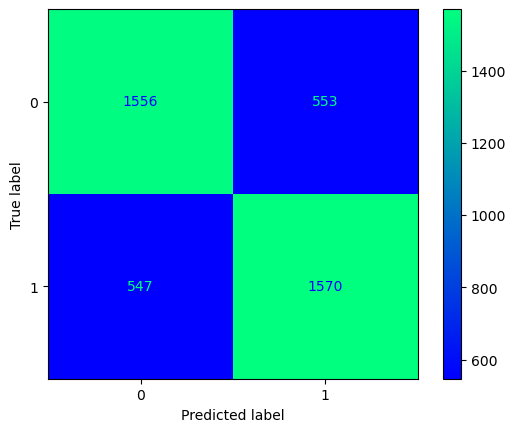

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.74      0.74      0.74      2109
           1       0.74      0.74      0.74      2117

    accuracy                           0.74      4226
   macro avg       0.74      0.74      0.74      4226
weighted avg       0.74      0.74      0.74      4226

-------------------------


In [572]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m6_10min.catboost_GridS()

In [573]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m6_10min,y_val_m6_10min)

Accuracy validación 0.5940931465354032


In [574]:
guardar_modelo(modelo_entrenado_15min,"m6_catboost_GridS_10min")

### Recopilación resultados

In [575]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m6_catboost_GridS", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
...,...,...,...,...,...,...,...
66,m6_randomforest_GridS,0.82,0.81,0.74,0.76,0.74,0.64
67,m6_gradientboosting,0.83,0.81,0.49,0.77,0.74,0.50
68,m6_gradientboosting_GridS,0.84,0.81,0.57,0.77,0.74,0.55
69,m6_catboost,0.87,0.80,0.61,0.81,0.73,0.59


# 11.8. XGBoost

### Partidas 15 min

Hora de inicio:  15:24:33
Hora de fin:  15:24:35
-------------------------
Accuracy train 0.9863739591218774
Accuracy test 0.7925011644154635
-------------------------
-------------------------
Matriz de confusión


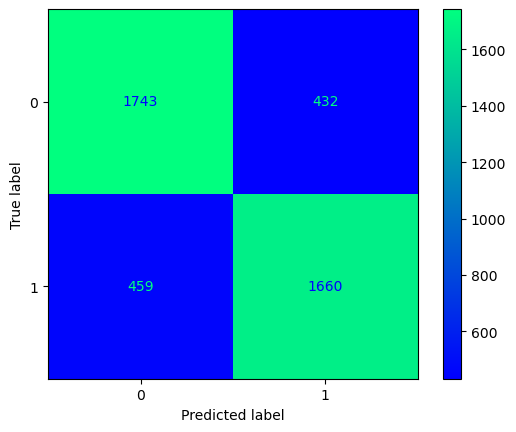

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.79      0.80      0.80      2175
           1       0.79      0.78      0.79      2119

    accuracy                           0.79      4294
   macro avg       0.79      0.79      0.79      4294
weighted avg       0.79      0.79      0.79      4294

-------------------------


In [576]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m6_15min.xgboost()

In [577]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m6_15min,y_val_m6_15min)

Accuracy validación 0.499906838084591


In [578]:
guardar_modelo(modelo_entrenado_15min,"m6_xgboost_15min")

### Partidas 10 min

Hora de inicio:  15:24:36
Hora de fin:  15:24:38
-------------------------
Accuracy train 0.9550914147091888
Accuracy test 0.7155702792238523
-------------------------
-------------------------
Matriz de confusión


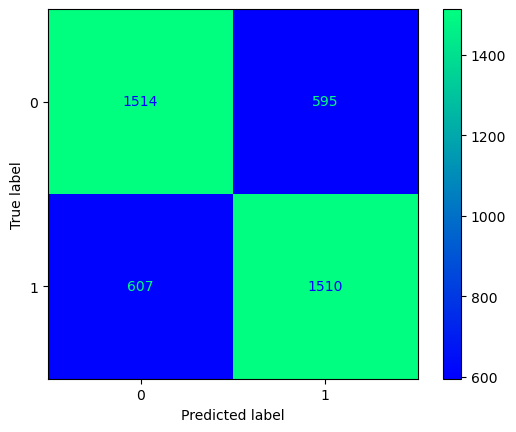

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.71      0.72      0.72      2109
           1       0.72      0.71      0.72      2117

    accuracy                           0.72      4226
   macro avg       0.72      0.72      0.72      4226
weighted avg       0.72      0.72      0.72      4226

-------------------------


In [579]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m6_10min.xgboost()

In [580]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m6_10min,y_val_m6_10min)

Accuracy validación 0.5844377129875047


In [581]:
guardar_modelo(modelo_entrenado_15min,"m6_xgboost_10min")

### Recopilación resultados

In [582]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m6_xgboost", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
...,...,...,...,...,...,...,...
67,m6_gradientboosting,0.83,0.81,0.49,0.77,0.74,0.50
68,m6_gradientboosting_GridS,0.84,0.81,0.57,0.77,0.74,0.55
69,m6_catboost,0.87,0.80,0.61,0.81,0.73,0.59
70,m6_catboost_GridS,0.82,0.81,0.62,0.76,0.74,0.59


# 11.9. XGBoost Optimizado

Este no

# 11.10. Lightgbm

### Partidas 15 min

Hora de inicio:  15:24:38
Hora de fin:  15:24:39
-------------------------
Accuracy train 0.9067722587783148
Accuracy test 0.7992547741034001
-------------------------
-------------------------
Matriz de confusión


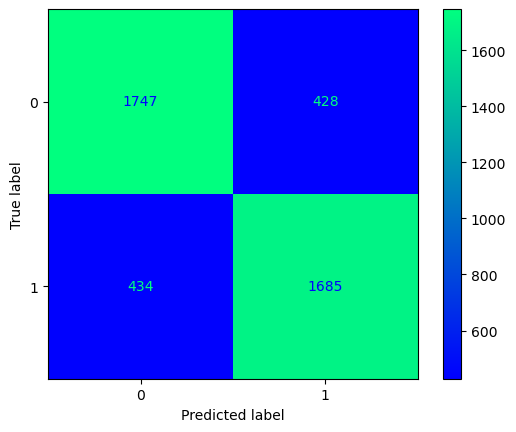

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.80      0.80      0.80      2175
           1       0.80      0.80      0.80      2119

    accuracy                           0.80      4294
   macro avg       0.80      0.80      0.80      4294
weighted avg       0.80      0.80      0.80      4294

-------------------------


In [583]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m6_15min.lightgbm()

In [584]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m6_15min,y_val_m6_15min)

Accuracy validación 0.6634991615427613


In [585]:
guardar_modelo(modelo_entrenado_15min,"m6_lightgbm_15min")

### Partidas 10 min

Hora de inicio:  15:24:39
Hora de fin:  15:24:39
-------------------------
Accuracy train 0.8603041240163304
Accuracy test 0.7304779933743493
-------------------------
-------------------------
Matriz de confusión


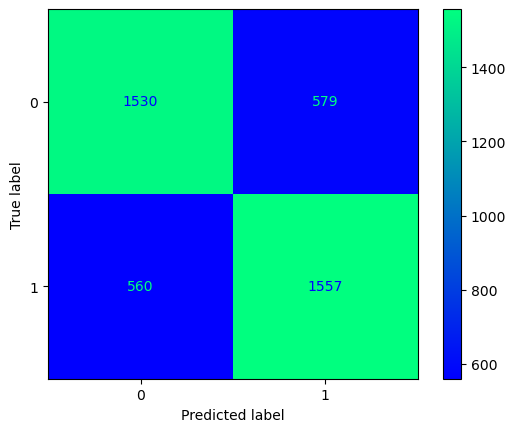

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.73      0.73      0.73      2109
           1       0.73      0.74      0.73      2117

    accuracy                           0.73      4226
   macro avg       0.73      0.73      0.73      4226
weighted avg       0.73      0.73      0.73      4226

-------------------------


In [586]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m6_10min.lightgbm()

In [587]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m6_10min,y_val_m6_10min)

Accuracy validación 0.5730783794017418


In [588]:
guardar_modelo(modelo_entrenado_15min,"m6_lightgbm_10min")

### Recopilación resultados

In [589]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m6_lightgbm", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
...,...,...,...,...,...,...,...
68,m6_gradientboosting_GridS,0.84,0.81,0.57,0.77,0.74,0.55
69,m6_catboost,0.87,0.80,0.61,0.81,0.73,0.59
70,m6_catboost_GridS,0.82,0.81,0.62,0.76,0.74,0.59
71,m6_xgboost,0.99,0.79,0.50,0.96,0.72,0.58


# 11.11. Lightgbm Optimizado

### Partidas 15 min

Hora de inicio:  15:24:40
Hora de fin:  15:30:28
-------------------------
Accuracy train 0.8219880044255518
Accuracy test 0.8064741499767117
-------------------------
-------------------------
Matriz de confusión


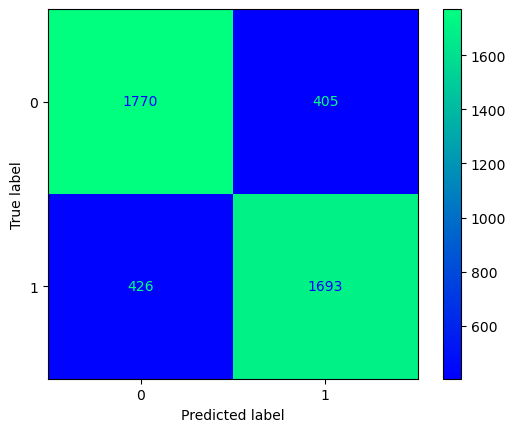

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.81      0.81      0.81      2175
           1       0.81      0.80      0.80      2119

    accuracy                           0.81      4294
   macro avg       0.81      0.81      0.81      4294
weighted avg       0.81      0.81      0.81      4294

-------------------------


In [590]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m6_15min.lightgbm_GridS()

In [591]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m6_15min,y_val_m6_15min)

Accuracy validación 0.6925656791503634


In [592]:
guardar_modelo(modelo_entrenado_15min,"m6_lightgbm_GridS_15min")

### Partidas 10 min

Hora de inicio:  15:30:28
Hora de fin:  15:35:18
-------------------------
Accuracy train 0.775812082125318
Accuracy test 0.7404164694746805
-------------------------
-------------------------
Matriz de confusión


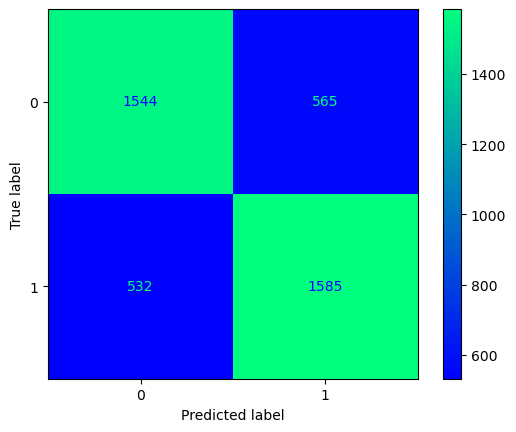

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.74      0.73      0.74      2109
           1       0.74      0.75      0.74      2117

    accuracy                           0.74      4226
   macro avg       0.74      0.74      0.74      4226
weighted avg       0.74      0.74      0.74      4226

-------------------------


In [593]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m6_10min.lightgbm_GridS()

In [594]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m6_10min,y_val_m6_10min)

Accuracy validación 0.6495645588792124


In [595]:
guardar_modelo(modelo_entrenado_15min,"m6_lightgbm_GridS_10min")

### Recopilación resultados

In [596]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m6_lightgbm_GridS", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
...,...,...,...,...,...,...,...
69,m6_catboost,0.87,0.80,0.61,0.81,0.73,0.59
70,m6_catboost_GridS,0.82,0.81,0.62,0.76,0.74,0.59
71,m6_xgboost,0.99,0.79,0.50,0.96,0.72,0.58
72,m6_lightgbm,0.91,0.80,0.66,0.86,0.73,0.57


# 11.12. SVC

### Partidas 15 min

Hora de inicio:  15:35:18
Hora de fin:  15:35:33
-------------------------
Accuracy train 0.8284516392010715
Accuracy test 0.8057755006986492
-------------------------
-------------------------
Matriz de confusión


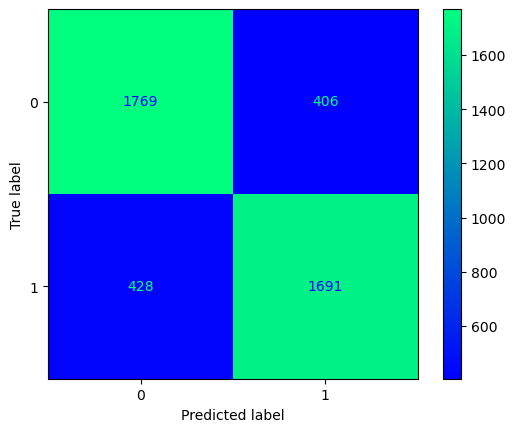

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.81      0.81      0.81      2175
           1       0.81      0.80      0.80      2119

    accuracy                           0.81      4294
   macro avg       0.81      0.81      0.81      4294
weighted avg       0.81      0.81      0.81      4294

-------------------------


In [597]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m6_15min.svc()

In [598]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m6_15min,y_val_m6_15min)

Accuracy validación 0.5079187628097633


In [599]:
guardar_modelo(modelo_entrenado_15min,"m6_svc_15min")

### Partidas 10 min

Hora de inicio:  15:36:00
Hora de fin:  15:36:19
-------------------------
Accuracy train 0.7629726051712916
Accuracy test 0.7330809275911027
-------------------------
-------------------------
Matriz de confusión


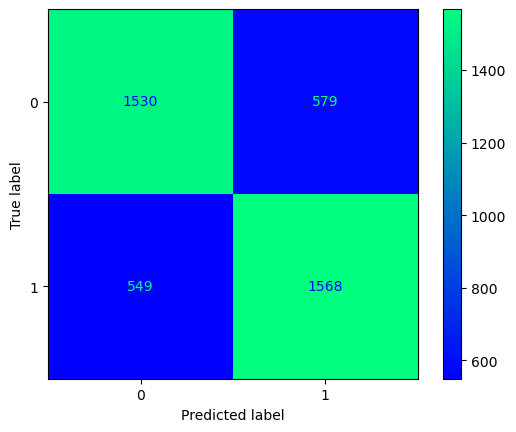

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.74      0.73      0.73      2109
           1       0.73      0.74      0.74      2117

    accuracy                           0.73      4226
   macro avg       0.73      0.73      0.73      4226
weighted avg       0.73      0.73      0.73      4226

-------------------------


In [600]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m6_10min.svc()

In [601]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m6_10min,y_val_m6_10min)

Accuracy validación 0.49810677773570616


In [602]:
guardar_modelo(modelo_entrenado_15min,"m6_svc_10min")

### Recopilación resultados

In [603]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m6_svc", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
...,...,...,...,...,...,...,...
70,m6_catboost_GridS,0.82,0.81,0.62,0.76,0.74,0.59
71,m6_xgboost,0.99,0.79,0.50,0.96,0.72,0.58
72,m6_lightgbm,0.91,0.80,0.66,0.86,0.73,0.57
73,m6_lightgbm_GridS,0.82,0.81,0.69,0.78,0.74,0.65


# 11.13. SVC Optimizado

### Partidas 15 min

Hora de inicio:  15:36:52
Hora de fin:  16:09:08
-------------------------
Accuracy train 0.8136027485005531
Accuracy test 0.8127619934792734
-------------------------
-------------------------
Matriz de confusión


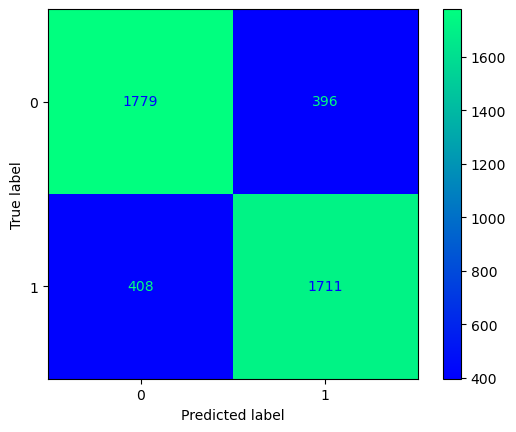

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.81      0.82      0.82      2175
           1       0.81      0.81      0.81      2119

    accuracy                           0.81      4294
   macro avg       0.81      0.81      0.81      4294
weighted avg       0.81      0.81      0.81      4294

-------------------------


In [604]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m6_15min.svc_GridS()

In [605]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m6_15min,y_val_m6_15min)

Accuracy validación 0.4920812371902366


In [606]:
guardar_modelo(modelo_entrenado_15min,"m6_svc_GridS_15min")

### Partidas 10 min

Hora de inicio:  16:09:33
Hora de fin:  16:45:59
-------------------------
Accuracy train 0.7502514644103899
Accuracy test 0.7394699479413157
-------------------------
-------------------------
Matriz de confusión


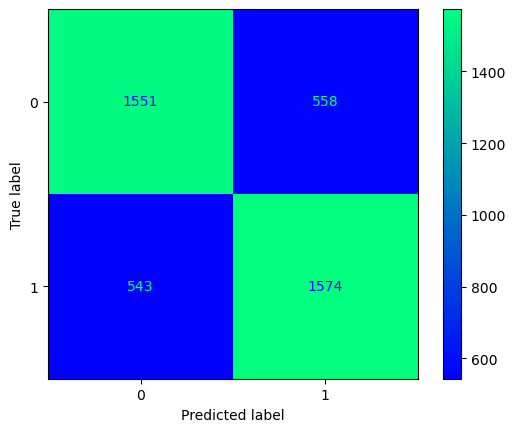

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.74      0.74      0.74      2109
           1       0.74      0.74      0.74      2117

    accuracy                           0.74      4226
   macro avg       0.74      0.74      0.74      4226
weighted avg       0.74      0.74      0.74      4226

-------------------------


In [607]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m6_10min.svc_GridS()

In [608]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m6_10min,y_val_m6_10min)

Accuracy validación 0.5018932222642938


In [609]:
guardar_modelo(modelo_entrenado_15min,"m6_svc_GridS_10min")

### Recopilación resultados

In [610]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m6_svc_GridS", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
...,...,...,...,...,...,...,...
71,m6_xgboost,0.99,0.79,0.50,0.96,0.72,0.58
72,m6_lightgbm,0.91,0.80,0.66,0.86,0.73,0.57
73,m6_lightgbm_GridS,0.82,0.81,0.69,0.78,0.74,0.65
74,m6_svc,0.83,0.81,0.51,0.76,0.73,0.50


# 11.14. LinearSVC

### Partidas 15 min

Hora de inicio:  16:46:31
Hora de fin:  16:46:34
-------------------------
Accuracy train 0.8102253537529843
Accuracy test 0.8129948765719609
-------------------------
-------------------------
Matriz de confusión


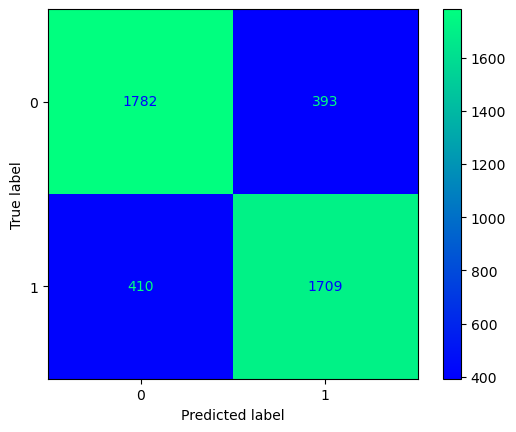

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.81      0.82      0.82      2175
           1       0.81      0.81      0.81      2119

    accuracy                           0.81      4294
   macro avg       0.81      0.81      0.81      4294
weighted avg       0.81      0.81      0.81      4294

-------------------------


In [611]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m6_15min.linearsvc()

In [612]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m6_15min,y_val_m6_15min)

Accuracy validación 0.4920812371902366


In [613]:
guardar_modelo(modelo_entrenado_15min,"m6_linearsvc_15min")

### Partidas 10 min

Hora de inicio:  16:46:35
Hora de fin:  16:46:38
-------------------------
Accuracy train 0.7445121590438436
Accuracy test 0.7397065783246569
-------------------------
-------------------------
Matriz de confusión


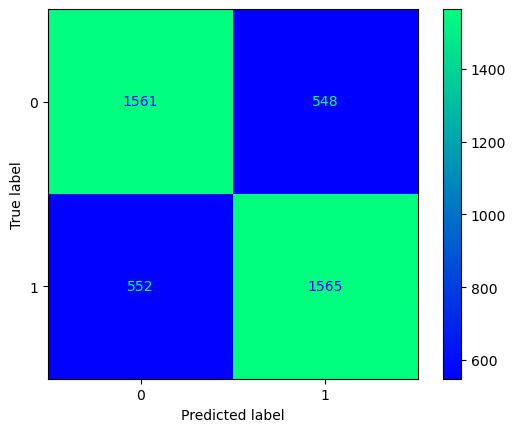

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.74      0.74      0.74      2109
           1       0.74      0.74      0.74      2117

    accuracy                           0.74      4226
   macro avg       0.74      0.74      0.74      4226
weighted avg       0.74      0.74      0.74      4226

-------------------------


In [614]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m6_10min.linearsvc()

In [615]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m6_10min,y_val_m6_10min)

Accuracy validación 0.5018932222642938


In [616]:
guardar_modelo(modelo_entrenado_15min,"m6_linearsvc_10min")

### Recopilación resultados

In [617]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m6_linearsvc", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
...,...,...,...,...,...,...,...
72,m6_lightgbm,0.91,0.80,0.66,0.86,0.73,0.57
73,m6_lightgbm_GridS,0.82,0.81,0.69,0.78,0.74,0.65
74,m6_svc,0.83,0.81,0.51,0.76,0.73,0.50
75,m6_svc_GridS,0.81,0.81,0.49,0.75,0.74,0.50


# 11.15. LinearSVC Optimizado

### Partidas 15 min

Hora de inicio:  16:46:39
Hora de fin:  16:53:46
-------------------------
Accuracy train 0.8098177371455191
Accuracy test 0.8122962272938985
-------------------------
-------------------------
Matriz de confusión


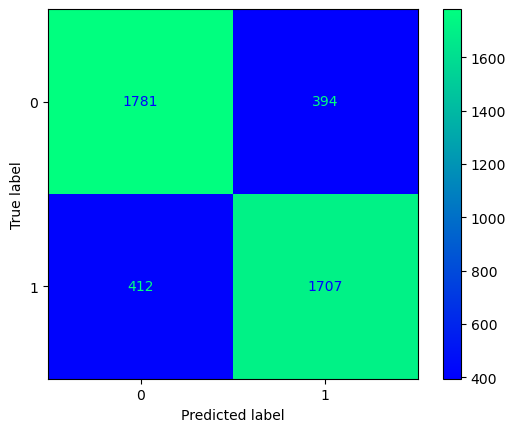

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.81      0.82      0.82      2175
           1       0.81      0.81      0.81      2119

    accuracy                           0.81      4294
   macro avg       0.81      0.81      0.81      4294
weighted avg       0.81      0.81      0.81      4294

-------------------------


In [618]:
modelo_entrenado_15min, pred_train_15min, pred_test_15min, Accuracy_train_15min, Accuracy_test_15min = m6_15min.linearsvc_GridS()

In [619]:
Accuracy_val_15min = Models.predecir_validacion(modelo_entrenado_15min,X_val_m6_15min,y_val_m6_15min)

Accuracy validación 0.4920812371902366


In [620]:
guardar_modelo(modelo_entrenado_15min,"m6_linearsvc_GridS_15min")

### Partidas 10 min

Hora de inicio:  16:53:46
Hora de fin:  17:01:54
-------------------------
Accuracy train 0.7442754866575942
Accuracy test 0.7385234264079508
-------------------------
-------------------------
Matriz de confusión


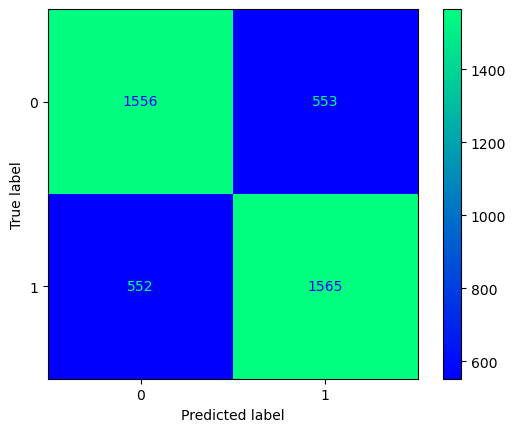

-------------------------
-------------------------
Report
              precision    recall  f1-score   support

           0       0.74      0.74      0.74      2109
           1       0.74      0.74      0.74      2117

    accuracy                           0.74      4226
   macro avg       0.74      0.74      0.74      4226
weighted avg       0.74      0.74      0.74      4226

-------------------------


In [621]:
modelo_entrenado_10min, pred_train_10min, pred_test_10min, Accuracy_train_10min, Accuracy_test_10min = m6_10min.linearsvc_GridS()

In [622]:
Accuracy_val_10min = Models.predecir_validacion(modelo_entrenado_10min,X_val_m6_10min,y_val_m6_10min)

Accuracy validación 0.5018932222642938


In [623]:
guardar_modelo(modelo_entrenado_15min,"m6_linearsvc_GridS_10min")

### Recopilación resultados

In [624]:
dfAccuracy = Models.recopilar_resultados(dfAccuracy, "m6_linearsvc_GridS", Accuracy_train_15min, 
                                         Accuracy_test_15min, Accuracy_train_10min, Accuracy_test_10min,
                                         Accuracy_val_15min,Accuracy_val_10min)
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
...,...,...,...,...,...,...,...
73,m6_lightgbm_GridS,0.82,0.81,0.69,0.78,0.74,0.65
74,m6_svc,0.83,0.81,0.51,0.76,0.73,0.50
75,m6_svc_GridS,0.81,0.81,0.49,0.75,0.74,0.50
76,m6_linearsvc,0.81,0.81,0.49,0.74,0.74,0.50


# Resumen de los datos

In [630]:
#Se cambia el limite de filas que muestra un DF de pandas para ver todos los resultados
pd.options.display.max_rows = 80

In [631]:
dfAccuracy

,Modelo,Train_15min,Test_15min,Validación_15min,Train_10min,Test_10min,Validación_10min
0,M1_randomforest,1.00,0.81,0.81,1.00,0.74,0.73
1,M1_randomforest_GridS,0.82,0.81,0.81,0.76,0.74,0.73
2,M1_gradientboosting,0.83,0.81,0.81,0.77,0.74,0.73
3,M1_gradientboosting_GridS,0.84,0.81,0.81,0.77,0.74,0.73
4,M1_catboost,0.86,0.81,0.80,0.81,0.73,0.73
5,M1_catboost_GridS,0.82,0.81,0.81,0.76,0.74,0.73
6,M1_xgboost,0.99,0.79,0.79,0.95,0.72,0.72
7,M1_lightgbm,0.91,0.80,0.80,0.86,0.73,0.73
8,M1_lightgbm_GridS,0.82,0.81,0.81,0.78,0.74,0.73
9,M1_svc,0.50,0.51,0.49,0.50,0.50,0.50


Se escogen solo aquellos modelos que en la validación han sacado valores altos:
Para el modelo 1:
* Random Forest
* Random Forest con GridSearch
* Grandient Boosting
* Grandient Boosting con GridSearch
* Catboost con GridSearch
* lightgbm con GridSearch

Para el resto de modelos, solo se podria destacar los mismos enumerados para el modelo 1, usandolos para el modelo 2, pero los resultados en test no son tan buenos, por los que se descartan.

En estos modelos, hay que mirar el resto de métricas para decidir cual coger.
Sin embargo, como el resto de medidas no desempatan, porque el resultado es igual en todos los modelos, daría igual qué modelo coger.

Por rapidez de ejecución, aunque hay muy poca diferencia tambien entre varios, **se escoge el Random Forest, pero sin modificar hiper parámetros.**
